# Your first neural network

In this project, you'll build your first neural network and use it to predict daily bike rental ridership. We've provided some of the code, but left the implementation of the neural network up to you (for the most part). After you've submitted this project, feel free to explore the data and the model more.



In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

## Load and prepare the data

A critical step in working with neural networks is preparing the data correctly. Variables on different scales make it difficult for the network to efficiently learn the correct weights. Below, we've written the code to load and prepare the data. You'll learn more about this soon!

In [2]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [3]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## Checking out the data

This dataset has the number of riders for each hour of each day from January 1 2011 to December 31 2012. The number of riders is split between casual and registered, summed up in the `cnt` column. You can see the first few rows of the data above.

Below is a plot showing the number of bike riders over the first 10 days or so in the data set. (Some days don't have exactly 24 entries in the data set, so it's not exactly 10 days.) You can see the hourly rentals here. This data is pretty complicated! The weekends have lower over all ridership and there are spikes when people are biking to and from work during the week. Looking at the data above, we also have information about temperature, humidity, and windspeed, all of these likely affecting the number of riders. You'll be trying to capture all this with your model.

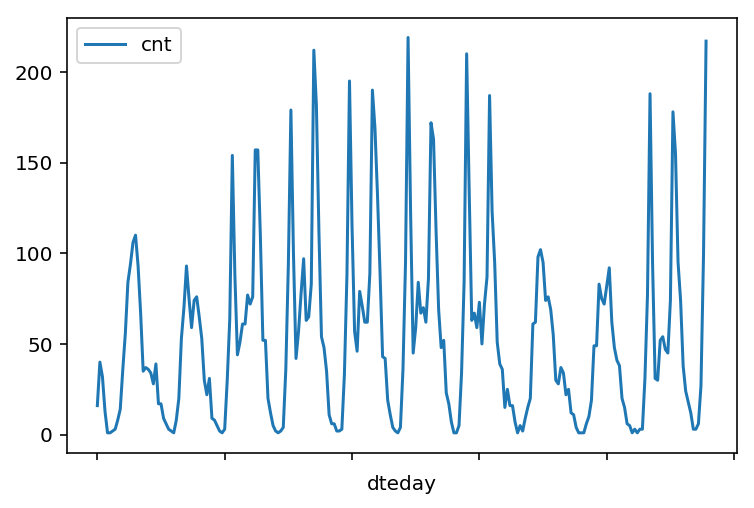

In [4]:
rides[:24*10].plot(x='dteday', y='cnt')

### Dummy variables
Here we have some categorical variables like season, weather, month. To include these in our model, we'll need to make binary dummy variables. This is simple to do with Pandas thanks to `get_dummies()`.

In [5]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### Scaling target variables
To make training the network easier, we'll standardize each of the continuous variables. That is, we'll shift and scale the variables such that they have zero mean and a standard deviation of 1.

The scaling factors are saved so we can go backwards when we use the network for predictions.

In [6]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### Splitting the data into training, testing, and validation sets

We'll save the data for the last approximately 21 days to use as a test set after we've trained the network. We'll use this set to make predictions and compare them with the actual number of riders.

In [7]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

We'll split the data into two sets, one for training and one for validating as the network is being trained. Since this is time series data, we'll train on historical data, then try to predict on future data (the validation set).

In [8]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## Time to build the network

Below you'll build your network. We've built out the structure. You'll implement both the forward pass and backwards pass through the network. You'll also set the hyperparameters: the learning rate, the number of hidden units, and the number of training passes.

<img src="assets/neural_network.png" width=300px>

The network has two layers, a hidden layer and an output layer. The hidden layer will use the sigmoid function for activations. The output layer has only one node and is used for the regression, the output of the node is the same as the input of the node. That is, the activation function is $f(x)=x$. A function that takes the input signal and generates an output signal, but takes into account the threshold, is called an activation function. We work through each layer of our network calculating the outputs for each neuron. All of the outputs from one layer become inputs to the neurons on the next layer. This process is called *forward propagation*.

We use the weights to propagate signals forward from the input to the output layers in a neural network. We use the weights to also propagate error backwards from the output back into the network to update our weights. This is called *backpropagation*.

> **Hint:** You'll need the derivative of the output activation function ($f(x) = x$) for the backpropagation implementation. If you aren't familiar with calculus, this function is equivalent to the equation $y = x$. What is the slope of that equation? That is the derivative of $f(x)$.

Below, you have these tasks:
1. Implement the sigmoid function to use as the activation function. Set `self.activation_function` in `__init__` to your sigmoid function.
2. Implement the forward pass in the `train` method.
3. Implement the backpropagation algorithm in the `train` method, including calculating the output error.
4. Implement the forward pass in the `run` method.
  

In [9]:
#############
# In the my_answers.py file, fill out the TODO sections as specified
#############

from my_answers import NeuralNetwork

In [10]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## Unit tests

Run these unit tests to check the correctness of your network implementation. This will help you be sure your network was implemented correctly befor you starting trying to train it. These tests must all be successful to pass the project.

In [33]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        print(network.weights_hidden_to_output)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

.....

[0.09998924] [0.4850045  0.45512111]
[[ 0.37275328]
 [-0.03172939]]



----------------------------------------------------------------------
Ran 5 tests in 0.017s

OK


<unittest.runner.TextTestResult run=5 errors=0 failures=0>

## Training the network

Here you'll set the hyperparameters for the network. The strategy here is to find hyperparameters such that the error on the training set is low, but you're not overfitting to the data. If you train the network too long or have too many hidden nodes, it can become overly specific to the training set and will fail to generalize to the validation set. That is, the loss on the validation set will start increasing as the training set loss drops.

You'll also be using a method know as Stochastic Gradient Descent (SGD) to train the network. The idea is that for each training pass, you grab a random sample of the data instead of using the whole data set. You use many more training passes than with normal gradient descent, but each pass is much faster. This ends up training the network more efficiently. You'll learn more about SGD later.

### Choose the number of iterations
This is the number of batches of samples from the training data we'll use to train the network. The more iterations you use, the better the model will fit the data. However, this process can have sharply diminishing returns and can waste computational resources if you use too many iterations.  You want to find a number here where the network has a low training loss, and the validation loss is at a minimum. The ideal number of iterations would be a level that stops shortly after the validation loss is no longer decreasing.

### Choose the learning rate
This scales the size of weight updates. If this is too big, the weights tend to explode and the network fails to fit the data. Normally a good choice to start at is 0.1; however, if you effectively divide the learning rate by n_records, try starting out with a learning rate of 1. In either case, if the network has problems fitting the data, try reducing the learning rate. Note that the lower the learning rate, the smaller the steps are in the weight updates and the longer it takes for the neural network to converge.

### Choose the number of hidden nodes
In a model where all the weights are optimized, the more hidden nodes you have, the more accurate the predictions of the model will be.  (A fully optimized model could have weights of zero, after all.) However, the more hidden nodes you have, the harder it will be to optimize the weights of the model, and the more likely it will be that suboptimal weights will lead to overfitting. With overfitting, the model will memorize the training data instead of learning the true pattern, and won't generalize well to unseen data.  

Try a few different numbers and see how it affects the performance. You can look at the losses dictionary for a metric of the network performance. If the number of hidden units is too low, then the model won't have enough space to learn and if it is too high there are too many options for the direction that the learning can take. The trick here is to find the right balance in number of hidden units you choose.  You'll generally find that the best number of hidden nodes to use ends up being between the number of input and output nodes.

In [27]:
import sys

####################
### Set the hyperparameters in you myanswers.py file ###
####################

from my_answers import iterations, learning_rate, hidden_nodes, output_nodes


N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

[-0.35039094  0.06228856 -0.83367257] [0.56854231 0.63810125 0.45753545 0.54486942]
[-0.21423079 -0.11235801 -1.10229526] [0.42052431 0.55732941 0.57168608 0.64222395]
[-0.30527846  0.21061917 -0.73777112] [0.56803749 0.54157273 0.29973645 0.49168113]
[-0.40873083 -0.08997827 -0.66502454] [0.57722264 0.67528995 0.59090834 0.46500242]
[-0.16677235  0.01742282 -1.01325526] [0.50814838 0.44717612 0.50938138 0.60127824]
[-0.23403023 -0.07950792 -0.40203753] [0.56089297 0.3595858  0.56598723 0.30134024]
[-0.25474703 -0.12520887 -0.5183997 ] [0.48796829 0.43480926 0.56199697 0.3555261 ]
[-0.17483328 -0.06643382 -0.69324862] [0.4166235  0.3830286  0.47708464 0.42654622]
[-0.1875987   0.16732174 -0.91761989] [0.59023308 0.42948386 0.40792571 0.56733699]
[-0.37887292  0.21423787 -0.44047764] [0.57021866 0.5567923  0.24701929 0.35066037]
[-0.3232938   0.11756691 -0.88504164] [0.63029708 0.60386109 0.4642013  0.57485973]
[-0.45852422 -0.13847868 -0.41275489] [0.54669201 0.67779458 0.57447927 0.33

Progress: 0.0% ... Training loss: 0.933 ... Validation loss: 1.405[-0.01339662  0.03293774 -0.32356532] [0.48359539 0.51621823 0.49677144 0.55629604]
[ 0.00665074  0.08000602 -0.25276767] [0.55159077 0.45261506 0.50070238 0.52228367]
[-0.13998899 -0.02289     0.18328145] [0.49572843 0.47197375 0.46822271 0.25957482]
[ 0.09569458 -0.04022685 -0.72726967] [0.45936022 0.57714926 0.63535737 0.80923637]
[-0.06342954 -0.01484453  0.09698566] [0.58347149 0.42683242 0.56755703 0.33764845]
[ 0.00874619 -0.04517308 -0.47019331] [0.48783197 0.60307561 0.6152324  0.67947717]
[-0.11922525  0.22656739  0.22192215] [0.64706699 0.39111788 0.33719183 0.25071655]
[-0.19338022  0.23580723  0.45898413] [0.65827754 0.3879642  0.28913662 0.11454485]
[-0.03143403  0.15483106 -0.26069916] [0.56105672 0.50615995 0.42593889 0.53600165]
[-0.11964359  0.0048836   0.13052917] [0.53913935 0.48033789 0.4915489  0.30940041]
[-0.13567451  0.1656284   0.14963199] [0.54495459 0.43367713 0.31553659 0.26566061]
[ 0.104995

Progress: 0.1% ... Training loss: 0.914 ... Validation loss: 1.361[-0.04200939 -0.05548247 -0.00843197] [0.48910561 0.54162714 0.52719414 0.42574451]
[-0.09420805  0.01668826  0.17817717] [0.57644037 0.56309066 0.49927424 0.3552131 ]
[-0.03202566 -0.21655128 -0.18065861] [0.36521237 0.61132738 0.60835938 0.50915885]
[-0.06681419  0.1570927   0.15752668] [0.65012482 0.51554338 0.42623142 0.37062303]
[-0.13103129 -0.00791325  0.44716805] [0.56563872 0.45538847 0.46876807 0.16078777]
[-0.12267496  0.07118215  0.13391788] [0.59994138 0.64956666 0.46781748 0.41152808]
[ 0.10785622  0.03809716 -0.24851546] [0.5478868  0.39511519 0.53702108 0.54153774]
[-0.06436176  0.04519201  0.0869004 ] [0.58457971 0.5567256  0.49415018 0.40772195]
[-0.05288709  0.25565414  0.46510474] [0.73223052 0.29323419 0.35257067 0.14864357]
[ 0.00383741 -0.1042626  -0.18796812] [0.38167196 0.50049957 0.50901083 0.47246839]
[ 0.13666619 -0.28868042 -0.45103037] [0.34183617 0.45378658 0.72286051 0.62174239]
[0.0223776

Progress: 0.1% ... Training loss: 0.887 ... Validation loss: 1.361[-0.10711916 -0.12117751  0.15538234] [0.51331057 0.55814176 0.55208288 0.33314882]
[ 0.05408673 -0.01681554 -0.1885802 ] [0.55601813 0.43613648 0.55051128 0.50823571]
[ 0.08688024 -0.32868424 -0.54550364] [0.34995508 0.53354034 0.72978498 0.68023593]
[ 0.01022581 -0.14747336 -0.24179158] [0.42430229 0.50061083 0.56402566 0.50834892]
[-0.10236053  0.19374712  0.3460925 ] [0.64825155 0.42920792 0.33099052 0.21401407]
[-0.06445169  0.05036721  0.12548279] [0.55004549 0.45917509 0.4205872  0.32023344]
[-0.13353643  0.21810428  0.32831958] [0.67550355 0.51539781 0.3278456  0.25907397]
[ 0.05201755 -0.18096086 -0.33924669] [0.41320414 0.47775504 0.60634098 0.55742593]
[0.01512922 0.23858347 0.2452721 ] [0.62631654 0.22025244 0.2961348  0.19803014]
[ 0.01831071 -0.17594973 -0.27718245] [0.53006862 0.59641573 0.69413003 0.61139626]
[-0.06267737  0.03061448  0.10841402] [0.55821622 0.47889742 0.45042108 0.34214117]
[-0.04864392 

[-0.06343796 -0.01765577  0.18597455] [0.52504546 0.42496052 0.4604614  0.27118529]
[-0.06303132  0.212154    0.21307416] [0.7155029  0.47494899 0.39494053 0.3354272 ]
[ 0.02419157 -0.21308564 -0.23570674] [0.45006955 0.511027   0.65579723 0.5283019 ]
[-0.05679384  0.05839486  0.34474699] [0.62951764 0.37008469 0.4596636  0.20528294]
[ 0.0713191  -0.19255776 -0.31822581] [0.43062819 0.4434696  0.63455024 0.54549034]
[-0.08768516  0.39052188  0.43070791] [0.74934854 0.35863696 0.21395265 0.17081605]
[-0.06679569  0.13980239  0.0246995 ] [0.57869727 0.5157414  0.36668606 0.3983098 ]
[-0.03396894  0.02808019 -0.0273806 ] [0.57214787 0.51407567 0.48617582 0.43849621]
[-0.05337394  0.50650423  0.18440192] [0.77641825 0.41829513 0.1545284  0.33078263]
[-0.00276073 -0.19777827 -0.04656143] [0.48318591 0.47191736 0.64353491 0.4212927 ]
[ 0.06142233  0.06937915 -0.40123815] [0.51616906 0.48898905 0.45272024 0.61729844]
[ 0.10168899 -0.2604773  -0.44493569] [0.42576429 0.47787461 0.71924336 0.63

Progress: 0.2% ... Training loss: 0.860 ... Validation loss: 1.269[0.02372397 0.28983329 0.44605577] [0.71696861 0.49567571 0.39323063 0.26653485]
[0.12272761 0.06430582 0.03770686] [0.62036858 0.48439607 0.58865691 0.47446563]
[ 0.08359712 -0.03164535 -0.20747124] [0.52552794 0.63567307 0.61604499 0.62073865]
[0.02644923 0.05570755 0.24666328] [0.59370423 0.53666826 0.53260239 0.35340742]
[ 0.10769161 -0.10625913  0.02102421] [0.47239827 0.39637322 0.61130395 0.39327368]
[ 0.15503877  0.12243322 -0.00056371] [0.62923787 0.42745579 0.54619642 0.4776861 ]
[ 0.15196995 -0.16075558 -0.19190454] [0.499529   0.48517277 0.72792869 0.56721583]
[ 0.0880497  -0.39309411 -0.44147418] [0.31656107 0.62804163 0.8023613  0.67944236]
[ 0.1709969  -0.15202256 -0.2536476 ] [0.41257571 0.36564915 0.6382212  0.51605471]
[0.05787074 0.07814918 0.05314729] [0.56683386 0.54501093 0.50950361 0.45101577]
[ 0.07881379 -0.28714928 -0.1471901 ] [0.34206882 0.46045581 0.68083789 0.45816628]
[ 0.11717059 -0.298303

Progress: 0.2% ... Training loss: 0.827 ... Validation loss: 1.272[-0.02346175  0.04217977  0.22833265] [0.60943478 0.53944918 0.52026715 0.35275164]
[ 0.03411416 -0.33599874 -0.60582447] [0.27670769 0.527415   0.6588804  0.68094909]
[0.0259212  0.16054915 0.03839434] [0.57071343 0.47370022 0.39146625 0.41022824]
[0.07744521 0.54231985 0.41734968] [0.85487946 0.42986262 0.26256697 0.30037075]
[-0.01906361 -0.10552146  0.08872676] [0.46406216 0.47099791 0.53983512 0.34784788]
[ 0.01499606 -0.12087762 -0.14929238] [0.4705753  0.52041161 0.58852103 0.50327015]
[0.04103503 0.24072799 0.3284895 ] [0.73972877 0.46970174 0.45179958 0.3284786 ]
[-0.01891165  0.42426308  0.43521891] [0.75210837 0.52416187 0.26156603 0.27103059]
[0.0519024  0.17116925 0.2589787 ] [0.68759042 0.43821737 0.4786529  0.33759259]
[-0.01214379  0.04761598  0.20320592] [0.55662986 0.47578388 0.46833837 0.31964769]
[-0.03502595  0.20044264  0.28880877] [0.62855749 0.53103389 0.37442812 0.31061805]
[0.04731081 0.01061052

Progress: 0.3% ... Training loss: 0.801 ... Validation loss: 1.308[-0.00109935  0.33025012  0.33874682] [0.76018372 0.46170344 0.31587261 0.28215694]
[ 0.01590955 -0.3074117  -0.38170054] [0.41757075 0.42288049 0.67197536 0.5475211 ]
[-0.02230351  0.16389424  0.31827602] [0.69756182 0.45990247 0.41626255 0.27324699]
[-0.05979634 -0.39779592 -0.40982428] [0.32793985 0.4986152  0.66374578 0.54350706]
[ 0.00852921  0.14597353 -0.05154299] [0.6040105  0.4609315  0.38084704 0.43464526]
[-0.10100955  0.11515388 -0.08867371] [0.59139108 0.65750575 0.37353443 0.5000437 ]
[0.03277245 0.2873358  0.34850628] [0.68685911 0.34319832 0.30224829 0.21360854]
[-0.10828728 -0.37894671 -0.2783539 ] [0.42645164 0.61399442 0.71055911 0.5465898 ]
[0.01154647 0.49264382 0.57112446] [0.85626297 0.43164049 0.2344402  0.18173433]
[0.14081273 0.52504101 0.21306115] [0.80044951 0.2833036  0.20773162 0.3148398 ]
[-0.0269642  -0.16391998 -0.32433564] [0.49580015 0.53716835 0.58840806 0.57311874]
[0.01789629 0.04541

Progress: 0.3% ... Training loss: 0.786 ... Validation loss: 1.346[0.133663   0.52622197 0.40883839] [0.80658688 0.18478002 0.1768073  0.16842796]
[-0.18671022 -0.24614155 -0.38351329] [0.5059841  0.65448512 0.59171555 0.6077919 ]
[0.02906642 0.35214555 0.42408244] [0.7882003  0.32135045 0.29329433 0.19101442]
[-0.10307345 -0.02700303 -0.0865587 ] [0.59840214 0.51866593 0.47498156 0.44624278]
[-0.17432891 -0.10923458 -0.02685118] [0.56769101 0.5927659  0.50424722 0.42002184]
[0.06686263 0.53941312 0.58861846] [0.86395509 0.28014372 0.18440659 0.11763374]
[-0.06557939  0.32801932  0.13273311] [0.74673341 0.52146993 0.2657248  0.37875586]
[-0.222487   -0.62789915 -0.46524162] [0.23100397 0.54087243 0.7205408  0.51663341]
[-0.18850152 -0.04072756  0.02666974] [0.55718054 0.60306635 0.42608834 0.38487009]
[-0.17790925 -0.52180431 -0.63596738] [0.2982616  0.56045964 0.69442207 0.6411957 ]
[-0.05134162 -0.32424595 -0.34238479] [0.42808071 0.37516702 0.64013223 0.48857736]
[0.12286508 0.32250

Progress: 0.4% ... Training loss: 0.767 ... Validation loss: 1.280[0.03722943 0.25509721 0.13612764] [0.65377109 0.40416692 0.31361521 0.33680499]
[-0.16795959 -0.403308   -0.22315784] [0.44804407 0.61085823 0.71901205 0.51484862]
[-0.21474471 -0.52611054 -0.38625212] [0.28487105 0.5971258  0.6914421  0.52571108]
[0.21224706 0.67985439 0.50737601] [0.88205835 0.23580417 0.1384867  0.18512087]
[-0.0285886  -0.11449151  0.09162196] [0.55735629 0.41453182 0.56442716 0.33485404]
[-0.09277228 -0.00153682  0.05243779] [0.62377794 0.58784198 0.49724525 0.42450487]
[0.06649763 0.11791893 0.02246871] [0.62235363 0.34865854 0.42974767 0.3782258 ]
[0.01118157 0.09275345 0.15716725] [0.64539665 0.41844204 0.45141077 0.33299574]
[0.01768809 0.20720504 0.08132374] [0.69586579 0.47513706 0.39098838 0.4076004 ]
[-0.02458822 -0.08860175 -0.13810152] [0.54323505 0.45825111 0.53913846 0.46358074]
[-0.08575448 -0.26133753 -0.43310501] [0.48998827 0.57535558 0.65265262 0.63637574]
[ 0.14031651  0.37707185 

Progress: 0.5% ... Training loss: 0.755 ... Validation loss: 1.271[-0.16057008 -0.35842727 -0.6136592 ] [0.3983924  0.61660407 0.64769493 0.69562829]
[-0.01318414  0.07275524  0.10882343] [0.57367638 0.40926283 0.39982225 0.3181081 ]
[-0.01821791 -0.08137325 -0.23400927] [0.44360088 0.38045929 0.44994413 0.44262431]
[-0.12127047 -0.07002593  0.10322431] [0.57272003 0.55892458 0.50223968 0.36118717]
[0.20027966 0.69180397 0.62644227] [0.92684791 0.29418568 0.15020804 0.15493707]
[0.03522691 0.27054537 0.32580236] [0.73423394 0.42547084 0.35176779 0.27348451]
[ 0.05603431  0.20184719 -0.13147297] [0.7087864  0.4665185  0.42045888 0.52545635]
[0.25250276 0.64076173 0.59851141] [0.8878101  0.18480765 0.18260736 0.12871799]
[-0.22466363 -0.49392356 -0.46161288] [0.39153584 0.65999054 0.74487967 0.62467585]
[-0.19222268 -0.3151304  -0.23294427] [0.3948291  0.58548456 0.57882503 0.4746834 ]
[-0.00162525  0.22873058  0.14409097] [0.70032109 0.49334034 0.35964214 0.37378307]
[-0.23357621 -0.608

Progress: 0.5% ... Training loss: 0.735 ... Validation loss: 1.248[0.12337382 0.27865363 0.21136502] [0.6952721  0.34979967 0.33696673 0.30432166]
[-0.1898334  -0.46033679 -0.36475229] [0.37723889 0.56712154 0.69186734 0.53091869]
[-0.06749634 -0.12008646 -0.22888291] [0.47530684 0.48739209 0.48614238 0.47656365]
[-0.15328212 -0.36732567 -0.37799227] [0.38146227 0.53291254 0.61981758 0.52933268]
[0.27413543 0.58808869 0.50307421] [0.86261125 0.24588382 0.22089218 0.19677992]
[-0.10082134 -0.29928272 -0.15736245] [0.43956198 0.46786034 0.61287861 0.42241258]
[-0.0395763  -0.04619256  0.07433067] [0.54933256 0.45677308 0.47618976 0.33973459]
[-0.18331605 -0.36310391 -0.27973053] [0.41192026 0.58346665 0.62792526 0.50178904]
[-0.17977738 -0.45277534 -0.51001506] [0.36460815 0.57091626 0.68227873 0.60418197]
[-0.09054179 -0.26786109 -0.10066638] [0.4626144  0.46439458 0.60356066 0.40131813]
[0.20754828 0.39066176 0.45606767] [0.80417068 0.27838045 0.33940832 0.20727382]
[-0.20507503 -0.352

Progress: 0.6% ... Training loss: 0.729 ... Validation loss: 1.324[0.13358816 0.22185252 0.35684615] [0.67426357 0.21509801 0.33877598 0.16364497]
[-0.1968598  -0.27025942 -0.30606108] [0.47934796 0.52299419 0.54406782 0.49040344]
[0.18162176 0.50014665 0.43184294] [0.83195963 0.29689903 0.21375046 0.20821077]
[-0.03162184 -0.07018511 -0.22050646] [0.50303536 0.34531949 0.43315554 0.41972008]
[-0.13525641 -0.12895485  0.0344093 ] [0.58638568 0.49190398 0.50892951 0.35121738]
[-0.31224333 -0.62202194 -0.47628523] [0.34597898 0.54255954 0.73316108 0.52803779]
[-0.29836636 -0.5058109  -0.50053326] [0.40482688 0.58796851 0.67444885 0.57502964]
[-0.30545822 -0.54612336 -0.67227888] [0.32590068 0.56339655 0.65331167 0.62551416]
[-0.10151435 -0.26159685 -0.44551898] [0.38926138 0.35803449 0.50496227 0.49169636]
[-0.4694672  -0.84970298 -0.94207345] [0.14969845 0.64890695 0.75003076 0.70729256]
[-0.39319698 -0.62354014 -0.56648217] [0.31590451 0.6476609  0.68484721 0.58129748]
[-0.27729531 -0.

Progress: 0.6% ... Training loss: 0.708 ... Validation loss: 1.253[-0.31837197 -0.41067317 -0.26426257] [0.36807399 0.62261923 0.5851469  0.46477551]
[-0.00395451  0.01809322 -0.09164822] [0.55029026 0.39567685 0.42745136 0.41126608]
[0.27605591 0.57489996 0.44218767] [0.83718993 0.27795563 0.21195812 0.23580208]
[-0.22179416 -0.26168289 -0.22241699] [0.45225826 0.57785107 0.54348514 0.47343717]
[-0.37854919 -0.69202051 -0.61713376] [0.2370226  0.58769262 0.73445609 0.58684611]
[-0.12386042  0.04821117 -0.01663097] [0.61769177 0.60808091 0.41166966 0.44674583]
[-0.10209576  0.02509105  0.06460222] [0.60754039 0.55520325 0.4301152  0.38791638]
[0.03283906 0.07163027 0.22831233] [0.65093459 0.38845294 0.46117208 0.28833704]
[-0.04821167 -0.04021128 -0.3589836 ] [0.56375396 0.4835802  0.48614594 0.5808396 ]
[0.08900799 0.11921336 0.07229042] [0.67847938 0.35925565 0.46158636 0.37972488]
[-0.29159741 -0.53298208 -0.4356395 ] [0.38802517 0.58789211 0.72999477 0.5634658 ]
[0.33682245 0.52983

Progress: 0.7% ... Training loss: 0.693 ... Validation loss: 1.207[0.06219367 0.21103803 0.0894195 ] [0.64939998 0.44735637 0.36416842 0.38958474]
[-0.45513678 -0.82278207 -0.70673827] [0.21723035 0.64391127 0.83411417 0.64255428]
[-0.27898441 -0.46592546 -0.48127422] [0.38920441 0.60163571 0.69177651 0.59920676]
[0.16184547 0.10506176 0.06636437] [0.59708913 0.24396702 0.4535449  0.33595167]
[0.30445332 0.57219051 0.35497316] [0.78327545 0.28201443 0.20603264 0.27971536]
[0.41947959 0.82834766 0.63139335] [0.91883314 0.26453712 0.10686521 0.19617713]
[0.29860132 0.51669742 0.30351203] [0.76429674 0.2662867  0.24220678 0.29514627]
[-0.31647922 -0.54159082 -0.37079032] [0.27713458 0.53767421 0.65352828 0.46778559]
[0.46138225 0.82618704 0.7754554 ] [0.92158037 0.19289675 0.12050513 0.10631435]
[0.25134843 0.38380125 0.24794569] [0.70205908 0.25500212 0.30184892 0.29173214]
[0.13184323 0.34795997 0.33227381] [0.72654678 0.42025348 0.31488658 0.29292537]
[-0.49530618 -0.72235833 -0.594542

Progress: 0.7% ... Training loss: 0.682 ... Validation loss: 1.173[0.26700991 0.54432538 0.59666702] [0.83045119 0.3964439  0.26163147 0.21685467]
[-0.28276947 -0.48434387 -0.40055105] [0.29357972 0.50953951 0.63037135 0.48860728]
[-0.30832872 -0.51872018 -0.44311829] [0.30165039 0.54433061 0.66282238 0.52334495]
[-0.20692964 -0.26506506 -0.21348794] [0.46488874 0.58845118 0.58748435 0.49635307]
[-0.54529743 -0.83236145 -0.85464721] [0.15811788 0.69801652 0.77284929 0.69802293]
[0.04384847 0.20938281 0.26941892] [0.65022445 0.48907547 0.36260496 0.3143135 ]
[0.02843583 0.10619324 0.29208347] [0.58500907 0.42694728 0.39930831 0.25535613]
[0.20757347 0.35918068 0.41022938] [0.72659338 0.35814964 0.33504587 0.25415371]
[0.13826694 0.35256975 0.26892787] [0.75609079 0.48568839 0.34793203 0.37111816]
[ 0.13152954  0.21917496 -0.00195118] [0.62079966 0.37348051 0.36514952 0.42057476]
[-0.35246549 -0.65243995 -0.69040282] [0.27272623 0.56436485 0.75818225 0.64589125]
[-0.31353256 -0.49224618 

Progress: 0.8% ... Training loss: 0.668 ... Validation loss: 1.161[-0.27713172 -0.48810372 -0.28846822] [0.34336755 0.505278   0.6597958  0.44203395]
[0.15151586 0.18546149 0.35713345] [0.71355087 0.40598917 0.46631541 0.28837085]
[0.1427446  0.23589255 0.15927425] [0.59303699 0.35025226 0.31937954 0.31422058]
[-0.40746685 -0.49636338 -0.3727794 ] [0.40917116 0.73354002 0.67994287 0.5653398 ]
[-0.11555356 -0.25966523 -0.11873973] [0.4741441  0.45755678 0.60526107 0.41638417]
[0.5136618  0.78434641 0.74300907] [0.90021665 0.24119462 0.17281931 0.15655507]
[-0.33587596 -0.37709918 -0.13888695] [0.41491035 0.66594159 0.59133558 0.43188207]
[0.28845396 0.37565794 0.40027422] [0.77735403 0.33343927 0.38626133 0.28741965]
[-0.5656012  -0.8078207  -0.79190192] [0.23549294 0.73227819 0.78386324 0.6902257 ]
[-0.32109422 -0.49310667 -0.39731036] [0.3306131  0.55887841 0.64127968 0.50209964]
[-0.42980383 -0.5442507  -0.31728893] [0.29948459 0.65643084 0.6243087  0.4600839 ]
[-0.39523044 -0.616597

Progress: 0.8% ... Training loss: 0.662 ... Validation loss: 1.189[ 0.02043444 -0.03650143  0.15615   ] [0.64704633 0.42736331 0.56039163 0.34004198]
[-0.41381794 -0.56000109 -0.75812339] [0.34544205 0.61837271 0.67033385 0.68041813]
[0.3674283  0.55754594 0.37769692] [0.78186566 0.27961495 0.23075892 0.2782522 ]
[0.33760492 0.41202478 0.43035486] [0.73329169 0.22945865 0.31684275 0.21488039]
[-0.4049582  -0.62755077 -0.66539105] [0.31307343 0.55603904 0.70929537 0.60358859]
[ 0.10886878  0.16802261 -0.06381857] [0.64991844 0.39678103 0.40597055 0.4530124 ]
[0.1316817 0.096381  0.2515438] [0.64784449 0.32797379 0.47422594 0.27539779]
[0.10384378 0.07001397 0.04229339] [0.52237098 0.27150659 0.3916489  0.3068857 ]
[-0.8087731  -1.02786842 -1.1583094 ] [0.15837455 0.84057332 0.82518078 0.82045243]
[-0.2479719  -0.41857015 -0.44665847] [0.44987692 0.51882961 0.67537193 0.55934954]
[0.3788865  0.54021207 0.47305723] [0.78072611 0.25411275 0.24854766 0.22352571]
[0.30333018 0.49513777 0.414

[-0.53221025 -0.65955987 -0.70118996] [0.3348061  0.72487856 0.71195015 0.66174615]
[0.41733757 0.52259576 0.57206043] [0.73979075 0.16479912 0.24413511 0.13473752]
[-0.65054907 -0.82522045 -0.92540421] [0.21819219 0.74274275 0.73535258 0.71696292]
[-0.42183633 -0.56996708 -0.64896179] [0.3446199  0.6199656  0.67422247 0.62321821]
[0.38123294 0.5376319  0.37946254] [0.78938633 0.26047945 0.26046573 0.27806957]
[0.09483529 0.10798048 0.19624039] [0.65342265 0.38547895 0.45559433 0.31689363]
[-0.71317087 -0.95972844 -0.99036898] [0.19351905 0.76072168 0.82068733 0.73928425]
[-0.54859134 -0.69491923 -0.59694496] [0.29089135 0.69705754 0.70207891 0.57864358]
[-0.15373842 -0.08546808 -0.02977326] [0.5482946  0.56854498 0.46774678 0.40641101]
Progress: 0.8% ... Training loss: 0.658 ... Validation loss: 1.199[-0.55827613 -0.71400992 -0.5647804 ] [0.32699947 0.65205197 0.75423772 0.57406972]
[-0.6817398  -0.833513   -0.79962319] [0.26478475 0.72334996 0.77754663 0.67319033]
[-0.48673881 -0.682

Progress: 0.9% ... Training loss: 0.645 ... Validation loss: 1.123[-0.61434271 -0.80093608 -0.64187352] [0.25700105 0.66675999 0.79947007 0.597643  ]
[-0.1034496  -0.04369346  0.04401187] [0.51456142 0.4913232  0.45385969 0.36058537]
[-0.12470849 -0.17702022 -0.39734918] [0.45031049 0.42967197 0.53112189 0.54424448]
[0.31645532 0.40180696 0.28826562] [0.76616803 0.3170798  0.38311473 0.35122413]
[-0.70131804 -0.8415429  -1.04976783] [0.16139787 0.69768491 0.73744116 0.76160235]
[0.08935121 0.14820885 0.15013963] [0.63901339 0.41329638 0.44142673 0.3649426 ]
[0.19622171 0.26874959 0.16571952] [0.61728971 0.30927809 0.34319757 0.32690326]
[-0.79060489 -0.93663527 -0.86802941] [0.15990344 0.76805226 0.79123403 0.67663763]
[0.49691295 0.65909897 0.60246481] [0.83155748 0.23087073 0.24632522 0.2105297 ]
[0.18564366 0.23425408 0.40449295] [0.63710313 0.31906063 0.38274764 0.21431314]
[-0.85238178 -1.02974913 -0.98731866] [0.12946174 0.78997559 0.83619641 0.7249569 ]
[-0.2110052  -0.36015734 

Progress: 0.9% ... Training loss: 0.645 ... Validation loss: 1.030[-0.04712432 -0.13433585 -0.16776743] [0.47004137 0.41614019 0.5890356  0.48299716]
[-0.27270242 -0.37212319 -0.20304619] [0.314125   0.48030307 0.59946699 0.41452724]
[0.28037295 0.46274433 0.34254543] [0.70169601 0.40770233 0.31159346 0.35074644]
[0.32732616 0.46313007 0.46097253] [0.72534094 0.36555615 0.34335972 0.29461035]
[0.44503294 0.63590243 0.50273969] [0.80841028 0.35087813 0.29098866 0.32170178]
[0.8732614  1.04611506 0.98516981] [0.94412568 0.06523408 0.13328984 0.09116807]
[-0.19907886 -0.11793538 -0.13908161] [0.48150625 0.62269528 0.53639562 0.51409148]
[-0.00327946 -0.07681196  0.09473763] [0.56038617 0.45198434 0.62316704 0.4073644 ]
[0.85703739 1.05482088 1.00720458] [0.91996673 0.06763376 0.09490186 0.0636046 ]
[-0.45173652 -0.49564507 -0.35975416] [0.34253755 0.68896311 0.70058918 0.55930504]
[-0.09131959  0.01843882 -0.04990736] [0.50301607 0.55316611 0.45340836 0.46499406]
[0.73406877 0.94718335 0.

[-0.8569127  -0.93746285 -0.91523166] [0.15093005 0.88816121 0.84443484 0.77623024]
[0.64767379 0.83955996 0.792509  ] [0.86420313 0.21030775 0.19580743 0.17272947]
[-0.12273041 -0.14368462 -0.22023834] [0.42578311 0.47161833 0.53372703 0.49260608]
[-0.55335139 -0.71039608 -0.82823136] [0.20899607 0.63668632 0.76923839 0.71659387]
[0.2667562  0.2425145  0.31703119] [0.68822933 0.33268812 0.51019681 0.34474406]
[-0.22290473 -0.28123526 -0.1751411 ] [0.42732184 0.54708401 0.63658887 0.48578628]
[0.48409801 0.71799816 0.69532228] [0.81251268 0.33008676 0.21778172 0.21544748]
[0.18411706 0.24502782 0.11238347] [0.58749584 0.35741949 0.3925777  0.39288664]
[-0.52036194 -0.63224416 -0.45506176] [0.27023709 0.66585803 0.74590255 0.56046404]
[0.06653558 0.15828847 0.29449061] [0.57952553 0.46162953 0.42462462 0.3106177 ]
[-0.47560153 -0.50178714 -0.35214099] [0.23171987 0.62185357 0.58940037 0.46911083]
[0.0938461  0.08851522 0.19262705] [0.55310074 0.38170318 0.47980262 0.33389433]
[-0.377874

[0.080167   0.14690383 0.16752124] [0.61888731 0.42677369 0.42880356 0.35628361]
[0.16160895 0.18415524 0.27775373] [0.64848196 0.36339689 0.442821   0.30543292]
[-0.44003234 -0.45486877 -0.48905061] [0.37385201 0.64462414 0.63715776 0.58785799]
[-0.36769233 -0.43968948 -0.34747675] [0.29716313 0.50306843 0.57406667 0.44335644]
[0.04745623 0.0884662  0.10457561] [0.5878907  0.42067243 0.44857171 0.36938318]
[0.30482009 0.28688761 0.49025739] [0.6859285  0.25555032 0.41819273 0.1983438 ]
[-1.00305711 -1.13975466 -1.0553985 ] [0.08176849 0.84575586 0.86626069 0.74025679]
[-0.2383681  -0.27314345 -0.10307065] [0.50253293 0.56426124 0.63135215 0.44933634]
[0.09570811 0.07860137 0.05286933] [0.63097829 0.39060629 0.51405879 0.41721346]
[0.42771937 0.53936788 0.53979912] [0.80701482 0.29635099 0.32264801 0.2536538 ]
[ 0.02106331 -0.02649669  0.00477965] [0.56836348 0.39334938 0.53607781 0.40470629]
[-0.15536658 -0.19960969 -0.12911691] [0.45138269 0.45328372 0.54403675 0.41406246]
[-0.024034

[0.88436983 1.08675857 0.97788619] [0.95203796 0.10967964 0.07828442 0.10022713]
[-0.58418582 -0.73066148 -0.51819628] [0.2482405  0.63731971 0.76768458 0.53811554]
[0.4221891  0.58741379 0.54017678] [0.77294885 0.33851897 0.26275267 0.25806623]
[-0.80101345 -0.87127104 -0.80049201] [0.16800975 0.78528604 0.7699357  0.66257995]
[-0.23909432 -0.20746086 -0.13193871] [0.49300523 0.61550079 0.58455909 0.48444126]
[0.81637187 0.93207392 0.9327244 ] [0.90735448 0.09632174 0.16646874 0.09343849]
[-0.31467813 -0.37265471 -0.27092507] [0.35917771 0.53548804 0.60163445 0.46000322]
[0.33595788 0.49666339 0.39196642] [0.71531159 0.36305646 0.27503429 0.30448775]
[-0.14773611 -0.08588491 -0.06562409] [0.49498597 0.55215995 0.49577028 0.4399476 ]
[0.35357723 0.52774988 0.4231796 ] [0.74778287 0.37984916 0.27948    0.31127207]
[-0.41016989 -0.50455059 -0.3700644 ] [0.35103836 0.59515    0.69467651 0.51737665]
[-0.63414107 -0.67872191 -0.7407967 ] [0.26631253 0.73592744 0.72647974 0.68457892]
[-0.656

[0.07612265 0.02943667 0.20870214] [0.63089603 0.42015545 0.55511349 0.34428759]
[-0.56488407 -0.61153033 -0.58743518] [0.25738351 0.64770882 0.65673662 0.56920565]
[0.69861275 0.77387    0.78476782] [0.84628977 0.13161132 0.21338345 0.12984828]
[-0.72099631 -0.81157343 -0.60602094] [0.18187515 0.69726489 0.73144373 0.53964059]
[-0.26961113 -0.25123501 -0.33977286] [0.38754015 0.53604423 0.51373657 0.50227363]
[-0.38328224 -0.38188814 -0.30925942] [0.31008093 0.56015742 0.53180913 0.44198446]
[-0.85661831 -0.90316714 -1.02994261] [0.17093823 0.81794946 0.78081801 0.77579273]
[0.43001303 0.52183543 0.47079598] [0.80432144 0.3246044  0.34197039 0.29989114]
[-0.84329781 -0.90055235 -0.95837114] [0.17754108 0.80784206 0.78600448 0.74042272]
[-0.66280587 -0.69537414 -0.58480225] [0.21379171 0.6984676  0.66612807 0.54906565]
[-0.64799035 -0.68537986 -0.71403848] [0.29613044 0.750289   0.74001613 0.67601429]
[0.54790749 0.68898892 0.66240899] [0.81818029 0.25881349 0.2247009  0.19776672]
[-0.

[-0.1098429  -0.11772059 -0.12226669] [0.45199208 0.46953473 0.51167602 0.43994907]
[-0.28904417 -0.21577919 -0.09181333] [0.50861018 0.69591384 0.60101224 0.49939349]
[0.04939408 0.16199502 0.16195579] [0.61865291 0.52852165 0.43661344 0.40805079]
[-0.6777312  -0.82772121 -0.8010683 ] [0.19464316 0.65882376 0.80338633 0.66430559]
[0.06741096 0.16548965 0.05563212] [0.57831563 0.47400591 0.40522258 0.42880895]
Progress: 1.2% ... Training loss: 0.605 ... Validation loss: 1.019[-0.66362245 -0.707464   -0.71055865] [0.2770881  0.74190573 0.75040373 0.67483852]
[ 0.04707168  0.06853751 -0.07591757] [0.57799959 0.44889097 0.4784404  0.48401391]
[-0.07771107  0.03114828  0.07091962] [0.52062197 0.53758793 0.41556789 0.38464201]
[0.48875889 0.62736696 0.5905693 ] [0.76139138 0.29583586 0.22095669 0.22439588]
[-0.55304366 -0.63295594 -0.56134125] [0.25927585 0.62433572 0.69252959 0.56506451]
[0.53129993 0.62182678 0.52359359] [0.72507708 0.21189412 0.20998634 0.22253986]
[-0.1394828  -0.086905

[-0.36943035 -0.36991773 -0.31033958] [0.36475806 0.59723169 0.58304932 0.49577167]
[0.0513125  0.05798034 0.0636148 ] [0.45838865 0.34107342 0.3759019  0.31590275]
[-0.15852548 -0.11207277 -0.06699075] [0.44611834 0.51507221 0.46605812 0.40588859]
[-0.41853039 -0.50904233 -0.43975568] [0.35974324 0.59560912 0.70315152 0.56032342]
[0.60299184 0.5960519  0.59786168] [0.7762923  0.15756556 0.30305858 0.20670988]
[0.6086801  0.74574898 0.59806875] [0.83332507 0.25842547 0.2103905  0.26030589]
[-0.01472748 -0.13378552 -0.08355719] [0.49012562 0.3689683  0.57606071 0.41806873]
[-0.89287384 -1.02849163 -1.03873864] [0.11619025 0.75451263 0.85379578 0.74702258]
[-0.61249892 -0.67326547 -0.60429012] [0.23814142 0.66218302 0.69449035 0.5805497 ]
[-0.39639237 -0.50584699 -0.58319085] [0.34666465 0.55876458 0.70087269 0.62162674]
[0.70821947 0.82362006 0.70961265] [0.85164853 0.18530224 0.17989881 0.20094754]
[-0.5935708  -0.64502415 -0.57515903] [0.21385346 0.63075834 0.64992225 0.54447475]
[0.7

Progress: 1.3% ... Training loss: 0.597 ... Validation loss: 1.029[-0.85778161 -0.88443933 -0.89203974] [0.13511233 0.73967602 0.71646774 0.65921079]
[0.51963256 0.6117613  0.61227369] [0.8097376  0.29208489 0.27650159 0.23935543]
[0.63209589 0.65188506 0.66999658] [0.79439818 0.16379703 0.26045596 0.1793571 ]
[ 0.07153958  0.05932893 -0.06193296] [0.52409678 0.35422912 0.43119648 0.41717638]
[0.07961173 0.1077814  0.24014683] [0.57752548 0.4126231  0.42415454 0.30226313]
[-0.3957124  -0.44579368 -0.48183051] [0.33269792 0.53830405 0.60821534 0.54081042]
[-0.27499226 -0.31793503 -0.49688462] [0.35663315 0.46731125 0.54652724 0.55388505]
[-0.14964    -0.20422265 -0.14829744] [0.505226   0.48974184 0.59848452 0.46898964]
[0.17663282 0.21861722 0.20194698] [0.61313939 0.37153634 0.38200348 0.33934847]
[-0.05784256 -0.04919046 -0.03521585] [0.57247274 0.50127602 0.53452405 0.45561464]
[-0.07720295 -0.07152425 -0.12786148] [0.4938174  0.45097643 0.48323724 0.44670951]
[0.76900881 0.80458506

[-0.21458626 -0.22405658 -0.01614274] [0.54331209 0.59120664 0.62495314 0.43959774]
[0.77565403 0.90186829 0.86560212] [0.85911534 0.15329054 0.11678766 0.11888698]
[0.7790172  0.84482015 0.91339701] [0.89462355 0.15401569 0.20331192 0.11531208]
[0.28815405 0.31502256 0.41605451] [0.65501596 0.31625714 0.35625183 0.24562041]
[0.10371721 0.21395283 0.24201886] [0.63063849 0.47107155 0.37577179 0.34527732]
[-0.93982701 -1.0122533  -1.01284613] [0.10439626 0.7568892  0.78973408 0.70441956]
[-0.43998699 -0.45555057 -0.31171161] [0.33116919 0.58863245 0.59574556 0.45870401]
[ 0.01800781  0.03644842 -0.04611429] [0.5109043  0.39817529 0.42303422 0.40745429]
[-0.40738546 -0.45414894 -0.37812133] [0.39779124 0.60202781 0.6664659  0.53721627]
[0.10690192 0.09662041 0.15408441] [0.54907004 0.35132681 0.4220218  0.319572  ]
[-0.3241534  -0.45826375 -0.36756343] [0.31681891 0.4370058  0.62712487 0.45448879]
[0.44136291 0.56517723 0.495897  ] [0.70897449 0.28382893 0.209957   0.23557213]
[-0.200487

Progress: 1.4% ... Training loss: 0.582 ... Validation loss: 0.972[-0.71422304 -0.77194553 -0.66166933] [0.21664854 0.68406498 0.73585778 0.5885851 ]
[0.29292428 0.27759203 0.36846308] [0.60844716 0.2847042  0.37453466 0.25332637]
[0.21002747 0.11554761 0.19466663] [0.59816643 0.30123095 0.50143257 0.338151  ]
[0.53293266 0.5588041  0.40450056] [0.75622346 0.24379294 0.31513657 0.32798617]
[-0.11155227 -0.1261756  -0.08543051] [0.53120092 0.5185404  0.57735441 0.4734289 ]
[-1.11307483 -1.12021131 -1.0798924 ] [0.12220627 0.92165325 0.86929954 0.78019197]
[-0.0197938   0.01318951  0.01567375] [0.53332148 0.47330079 0.4705464  0.41640307]
[0.29793141 0.32707778 0.30795937] [0.64254946 0.32721862 0.36125988 0.31489996]
[-0.55704656 -0.6693739  -0.57295037] [0.31278984 0.62284074 0.77392959 0.59613368]
[0.18011454 0.25447852 0.28856707] [0.61700443 0.414667   0.36974172 0.32166541]
[-0.13815325 -0.12394961 -0.00254454] [0.51369242 0.53842682 0.54733196 0.42184038]
[0.04816547 0.01928235 0.

[0.41204536 0.39320454 0.31787166] [0.7113664  0.27718195 0.39798578 0.34728885]
[-0.35556238 -0.34995545 -0.47480999] [0.38125779 0.57974707 0.58917749 0.58678247]
[-0.88297229 -0.92526738 -0.92998718] [0.13498809 0.74536596 0.76286848 0.68393289]
[-0.27152521 -0.34225401 -0.33908551] [0.38056028 0.48515915 0.60470611 0.49983456]
[0.60416267 0.56984774 0.48469189] [0.78330468 0.18785203 0.35051542 0.29459768]
[0.87922425 0.93275416 0.91222298] [0.86180628 0.09117063 0.14614375 0.11092677]
[0.17500009 0.2597609  0.31251954] [0.66968584 0.46738524 0.4105152  0.35207896]
[-0.35674821 -0.380832   -0.53287097] [0.37317811 0.55984984 0.61348104 0.60828198]
[0.46571861 0.51837194 0.41839164] [0.7230482  0.27916452 0.30105909 0.30429471]
[-0.83738765 -0.8294225  -0.95968847] [0.24725717 0.8252181  0.78880199 0.78699867]
[0.46454839 0.53570176 0.48773844] [0.67951573 0.25331756 0.24134375 0.23561841]
[0.56129354 0.67645024 0.65055516] [0.79460093 0.29801393 0.23670342 0.2344684 ]
[0.09404251 0

Progress: 1.5% ... Training loss: 0.573 ... Validation loss: 0.979[-0.93296446 -0.94173074 -0.95775694] [0.19113283 0.80872819 0.79555715 0.72578788]
[0.12269574 0.12635276 0.06740749] [0.52506006 0.34539798 0.39497397 0.3626967 ]
[0.86468931 0.90168249 0.91720881] [0.84959399 0.1085339  0.16740177 0.11300617]
[-0.98080305 -1.03393006 -0.84360467] [0.16769157 0.80816294 0.8440819  0.64885861]
[-0.32133454 -0.38320151 -0.16954109] [0.35708167 0.49655818 0.59143801 0.38820074]
[-0.32273911 -0.35885901 -0.19682035] [0.41086627 0.55251112 0.61697755 0.446627  ]
[-0.21110824 -0.19672943 -0.19040805] [0.50688409 0.57235371 0.58494708 0.51263742]
[-0.81933047 -0.881831   -0.82456698] [0.21750077 0.7270218  0.79663542 0.66230133]
[-0.62629185 -0.58731993 -0.57035931] [0.36618315 0.7607743  0.70461977 0.6389482 ]
[ 0.05969111 -0.01492796  0.0340925 ] [0.52597759 0.35633322 0.51245149 0.37890855]
[-0.52395632 -0.56485587 -0.52415209] [0.37769455 0.6608024  0.72723532 0.60731651]
[-0.31641458 -0.

[-0.28017307 -0.3594955  -0.24017248] [0.33603343 0.43909147 0.56551073 0.40289173]
[-0.710678   -0.76373211 -0.73163894] [0.24550476 0.67737432 0.74203891 0.62723965]
[-0.41408165 -0.48315043 -0.43291838] [0.27612072 0.48682109 0.59067918 0.46874329]
[0.26909471 0.16695066 0.23157449] [0.60239135 0.2591906  0.47158738 0.31500008]
[-0.47574853 -0.55857409 -0.62103826] [0.29869727 0.53876527 0.66875934 0.58755389]
[-0.35585321 -0.37636197 -0.41446384] [0.41151439 0.57772297 0.62949474 0.56379654]
[0.51604556 0.60187508 0.44699641] [0.77485545 0.31048204 0.2843581  0.33340316]
[0.668466   0.74025554 0.66666266] [0.771226   0.19604271 0.19269173 0.20224667]
[-1.21074719 -1.23765172 -1.18448432] [0.09392055 0.91761456 0.90567938 0.79048256]
Progress: 1.6% ... Training loss: 0.565 ... Validation loss: 0.946[0.41855914 0.37350865 0.45317897] [0.52404556 0.12967788 0.25587661 0.14200253]
[ 0.09285447  0.04648561 -0.14797392] [0.53246806 0.35926345 0.49422056 0.49189867]
[0.58999099 0.56112713

Progress: 1.6% ... Training loss: 0.557 ... Validation loss: 0.929[-0.4501491  -0.42132002 -0.3675106 ] [0.42825818 0.69873883 0.68052609 0.57865244]
[-0.0933502  -0.15621828 -0.11460226] [0.43145399 0.40731633 0.53710586 0.40994907]
[-0.84287745 -0.95650467 -0.95324939] [0.15896079 0.6697509  0.83162579 0.68421553]
[0.44328062 0.46969787 0.36697821] [0.61404367 0.22871101 0.26622271 0.26981399]
[-0.74377343 -0.76524078 -0.7417669 ] [0.2488049  0.72359489 0.75753059 0.6479352 ]
[0.1745589  0.16393291 0.23652046] [0.56951663 0.36574381 0.43580112 0.32163968]
[-0.6875795  -0.74655485 -0.72230686] [0.25439001 0.67090568 0.7629664  0.63372168]
[-0.72153397 -0.6521735  -0.68464773] [0.30921922 0.80253015 0.71054208 0.67415225]
[0.08146743 0.08004562 0.06408719] [0.56795164 0.43087451 0.49018727 0.41844192]
[0.80670719 0.85558256 0.82629186] [0.79269875 0.14231778 0.16837493 0.14709764]
[0.33709809 0.37725726 0.18869223] [0.62987912 0.320264   0.34136373 0.38531049]
[-0.35836488 -0.45628291 

[0.92130838 0.90993276 0.86162663] [0.86136785 0.09141014 0.21847643 0.16821065]
[-0.04423711 -0.06093353 -0.05029651] [0.48816938 0.44335849 0.51280022 0.42272023]
[0.25033092 0.21754308 0.21455622] [0.56945778 0.29944998 0.40959894 0.32391715]
[0.439745   0.43902954 0.38024165] [0.68360912 0.2793066  0.36108355 0.31688195]
[0.59876206 0.65465352 0.61270044] [0.68231024 0.19540453 0.19562691 0.18730253]
[0.52884726 0.57739147 0.59697828] [0.7083566  0.26510911 0.27291823 0.22203513]
Progress: 1.6% ... Training loss: 0.552 ... Validation loss: 0.897[-0.11436356 -0.22241288 -0.05889741] [0.32579651 0.32497389 0.50373828 0.30571057]
[-0.85967667 -0.82573315 -0.84646518] [0.24802654 0.84194423 0.79582287 0.73232124]
[1.01216189 1.09246837 0.99984236] [0.8860565  0.12098887 0.11061956 0.14213413]
[0.13436157 0.08794552 0.13944904] [0.57663699 0.40202207 0.52425654 0.39715353]
[ 0.00103334 -0.01392549 -0.15071483] [0.52259993 0.45630774 0.53574566 0.51731013]
[0.51015626 0.59575368 0.572196

Progress: 1.7% ... Training loss: 0.548 ... Validation loss: 0.883[-0.72063166 -0.71905246 -0.6745058 ] [0.23506699 0.71509478 0.7227525  0.62001138]
[0.63600692 0.62748514 0.67172478] [0.70967401 0.20060606 0.28789377 0.20290478]
[0.08956992 0.10227211 0.12151105] [0.51949036 0.41638061 0.44753112 0.3775885 ]
[-0.74618239 -0.76033239 -0.54918936] [0.25158625 0.74590801 0.76722381 0.57037785]
[0.73908039 0.74164642 0.75848322] [0.77144175 0.18977778 0.26959512 0.20257244]
[0.89767201 1.03591565 0.95343228] [0.85212954 0.21718246 0.10915884 0.16980784]
[-0.08408112 -0.11084807 -0.18138964] [0.47653706 0.47485456 0.56509434 0.50969485]
[0.30437703 0.28318291 0.1274488 ] [0.59402498 0.31200617 0.41627791 0.41483407]
[-0.18063053 -0.07904215 -0.1762852 ] [0.49864161 0.62485325 0.52422812 0.54816582]
[-0.70877467 -0.72838192 -0.74684202] [0.19793333 0.66036519 0.70080176 0.62212948]
[-0.76469331 -0.80444027 -0.70793743] [0.19561515 0.69108363 0.75309635 0.60336334]
[0.42760076 0.47533211 0.

Progress: 1.8% ... Training loss: 0.542 ... Validation loss: 0.914[-0.64066258 -0.65178997 -0.639426  ] [0.3089753  0.67724955 0.70915304 0.61756965]
[-0.38756716 -0.39323598 -0.26887079] [0.43379485 0.62484516 0.65530009 0.51228327]
[0.59690234 0.66961277 0.43661527] [0.71103662 0.23807796 0.21262945 0.31555706]
[-0.81115122 -0.88862688 -0.84318975] [0.20551937 0.66854701 0.7870851  0.64277012]
[-0.09228189 -0.26708352 -0.15922522] [0.39557545 0.31014336 0.59831644 0.38648759]
[-0.71594154 -0.66041209 -0.66458505] [0.30279712 0.75524826 0.68599211 0.63798409]
[0.06373962 0.05384663 0.02606252] [0.52473956 0.39659831 0.45822082 0.40312574]
[0.26363785 0.29185356 0.40729464] [0.66071187 0.40692027 0.41583009 0.30870339]
[0.50112309 0.50783131 0.54432505] [0.64626783 0.22404778 0.27318223 0.20829655]
[-0.23662616 -0.15710201 -0.16357017] [0.40565178 0.54015476 0.45081934 0.43474774]
[-0.86399143 -0.87342272 -0.91531302] [0.24020884 0.76396565 0.78777491 0.71848484]
[-0.76521178 -0.748653

Progress: 1.8% ... Training loss: 0.533 ... Validation loss: 0.893[-0.46469172 -0.46288393 -0.64569315] [0.29112573 0.55370172 0.57775838 0.60094716]
[-0.09493795 -0.11735463 -0.05498102] [0.41219334 0.41335572 0.47240773 0.37007023]
[-0.84491927 -0.87454438 -0.82374069] [0.19520955 0.71546526 0.75816269 0.63706356]
[-0.39409074 -0.4395329  -0.35194261] [0.33994746 0.5372059  0.61926744 0.48115043]
[-0.14404455 -0.25282981 -0.24121015] [0.32113531 0.31924923 0.50474245 0.38433752]
[-0.22249798 -0.16449481 -0.18911382] [0.40889123 0.53264751 0.47369149 0.45368212]
[-0.47776404 -0.51959168 -0.46020125] [0.29767433 0.55624591 0.63026115 0.50806982]
[0.62934075 0.57022325 0.67449986] [0.75427307 0.21587396 0.3645961  0.22259337]
[0.10723028 0.21527261 0.13486589] [0.53312197 0.44659046 0.33020419 0.37218683]
[-0.33765152 -0.26081463 -0.4326557 ] [0.44949011 0.64732928 0.57103514 0.62128951]
[-0.84897686 -0.84878999 -0.7175807 ] [0.22866074 0.76641347 0.76105213 0.61400111]
[0.43105246 0.51

[0.11334398 0.08468072 0.0939577 ] [0.45660148 0.30881983 0.38749377 0.31488752]
[-0.5783737  -0.64143193 -0.58899029] [0.23862755 0.55989549 0.66048307 0.5301984 ]
[-0.2859893  -0.32354071 -0.17032798] [0.41170598 0.5353929  0.60817236 0.44054555]
[-0.31044016 -0.30304209 -0.38737418] [0.33676044 0.49888836 0.5136998  0.4963107 ]
[0.19547997 0.24568295 0.24050218] [0.59881138 0.4188858  0.39120357 0.3595079 ]
[-1.10733522 -1.13912793 -1.21196436] [0.14052759 0.83451511 0.88059827 0.80860676]
[-0.70368962 -0.80428294 -0.74804315] [0.20995319 0.59837026 0.75134695 0.59261144]
[0.31590749 0.34319697 0.33471581] [0.64773916 0.36992213 0.38266858 0.3404114 ]
[-0.57805748 -0.70285076 -0.76430518] [0.27889454 0.55762113 0.76225629 0.64561763]
[-0.54707745 -0.55951512 -0.55034638] [0.32531535 0.63917064 0.67310225 0.58483195]
[-0.42853126 -0.42421874 -0.48741953] [0.39253046 0.62490612 0.64527655 0.601125  ]
[0.41368685 0.39261151 0.33345237] [0.5251879  0.17103308 0.25269854 0.22827759]
[0.4

[0.48192417 0.51293075 0.52850391] [0.64778835 0.26895278 0.28329376 0.24272511]
[-0.80411862 -0.83990904 -1.00097735] [0.21988507 0.69639285 0.78082736 0.75787257]
[0.89833843 0.97528498 1.02707653] [0.87220007 0.21778091 0.18202201 0.14948153]
[ 0.0118865  -0.03449052  0.11808908] [0.50349865 0.41732328 0.52481948 0.35952145]
[1.05053062 1.06880492 1.08665119] [0.86465179 0.07861991 0.13429438 0.09415033]
[0.6744824  0.68728528 0.59433745] [0.70030875 0.17379058 0.22902496 0.23618435]
[0.22538422 0.18996219 0.22756271] [0.50466679 0.27824692 0.37790105 0.28873369]
[0.7068902  0.77563133 0.77428009] [0.72858602 0.21086397 0.17722893 0.1716011 ]
[-0.52986735 -0.55014452 -0.42496449] [0.32084071 0.62588915 0.67678934 0.52862598]
[0.38215314 0.51480338 0.53378755] [0.66724371 0.40519763 0.2661176  0.27546256]
[-0.42020894 -0.40310923 -0.376858  ] [0.38212005 0.62259142 0.62968828 0.55119341]
[-0.71216372 -0.6722936  -0.73857731] [0.36311664 0.80577023 0.78212921 0.7457668 ]
[-0.15636412 

[-1.06443004 -1.07336329 -1.20784242] [0.11613178 0.82519128 0.85274899 0.81645153]
[0.39705297 0.40691431 0.42726653] [0.63813929 0.34913841 0.38804047 0.32077938]
[-0.46851264 -0.56968581 -0.44792995] [0.26014459 0.5214639  0.68655034 0.4939802 ]
[0.58545875 0.59317194 0.54484248] [0.65870488 0.23679837 0.2864396  0.26221962]
[0.85978126 0.87006347 0.93427749] [0.76565676 0.15906053 0.207182   0.13479146]
[-0.19616063 -0.31305627 -0.22214924] [0.34817017 0.41144086 0.61135097 0.43175122]
[-0.29166925 -0.35729378 -0.33216351] [0.3815554  0.53217406 0.66090742 0.53204382]
[0.78669841 0.8300971  0.84718571] [0.77311792 0.23104495 0.23228224 0.19611667]
[0.4665916  0.45885644 0.40488396] [0.65152622 0.30252455 0.37491714 0.33634637]
[-0.00570714 -0.03957896  0.02597733] [0.47449802 0.44510114 0.53179548 0.41017166]
[-0.05095948 -0.02338612  0.00411627] [0.50399337 0.53433114 0.53232107 0.45841276]
[ 0.04311646  0.02106025 -0.01558113] [0.40659576 0.34847232 0.418894   0.36743917]
[-0.595

[0.38215136 0.39243121 0.32426114] [0.71255932 0.39941265 0.45293435 0.41816129]
[0.44335306 0.36106242 0.35394211] [0.61868459 0.22936184 0.41131156 0.30921419]
[0.60060134 0.6582549  0.58648672] [0.66825043 0.24583345 0.22247197 0.24044322]
[-0.69200068 -0.70286874 -0.57469634] [0.2633914  0.67832067 0.71177563 0.55407096]
[0.19736726 0.25845125 0.133179  ] [0.57092259 0.41405835 0.38149375 0.41168209]
[-0.55554604 -0.53128724 -0.53955073] [0.36368512 0.69337005 0.69176025 0.61710891]
[-0.56469183 -0.59855906 -0.54283268] [0.31072474 0.62361691 0.70147724 0.56772206]
[0.43454007 0.49106371 0.59432419] [0.70426642 0.39256718 0.36206473 0.27694084]
[-0.56495414 -0.52595227 -0.51574529] [0.31931204 0.66837741 0.63883444 0.56975869]
[1.03262255 1.08529731 0.97576028] [0.84232199 0.12264373 0.1244043  0.16464995]
[-0.23695931 -0.32510524 -0.40860605] [0.34063179 0.40526204 0.57804761 0.49915895]
[-0.07028722 -0.04044352 -0.08392397] [0.38321085 0.40313973 0.39597917 0.37483642]
[-0.114009

[0.72432142 0.73858213 0.7220308 ] [0.71106247 0.1753964  0.21490704 0.19105242]
[-0.71577417 -0.76537861 -0.64421896] [0.31679218 0.68687939 0.78647775 0.61293198]
[0.94768014 1.00370871 0.93059273] [0.79172801 0.12840107 0.11403214 0.14724866]
[0.23037335 0.22162337 0.07934126] [0.54299769 0.31158447 0.38307417 0.39571711]
[-1.00567051 -1.06003592 -1.12644695] [0.16459791 0.71887646 0.82731218 0.74254056]
[-0.94639323 -0.92644364 -0.85469234] [0.24454504 0.80109086 0.79229688 0.6784859 ]
[-0.50268375 -0.53512592 -0.43365668] [0.31847325 0.56697959 0.64070106 0.50050986]
[0.33975912 0.40153672 0.32177617] [0.61900242 0.35321884 0.31819197 0.34017895]
[-0.3199324  -0.33939157 -0.33507071] [0.3470542  0.48156903 0.54406596 0.46732736]
[-0.01875935 -0.10356989 -0.18989774] [0.43318457 0.33014942 0.50569251 0.44297535]
[-0.1182129  -0.11553505 -0.28877919] [0.36528971 0.3759657  0.41803216 0.45198114]
[0.43496366 0.51997812 0.47757243] [0.67389927 0.35752464 0.28855404 0.3055827 ]
[-0.049

[-0.25531443 -0.1904565  -0.17647915] [0.41155932 0.58562437 0.52541188 0.4839905 ]
[-0.68586988 -0.76863907 -0.71010192] [0.22097587 0.59953099 0.74955678 0.59282981]
[-0.09136915 -0.18651683  0.09099157] [0.38250185 0.38157721 0.54378811 0.29317161]
[-1.02104242 -1.05480764 -1.1090357 ] [0.17239405 0.78618811 0.86783332 0.77836863]
[-0.50544592 -0.52404772 -0.50192574] [0.327283   0.61886704 0.68101543 0.57907823]
[-0.31095131 -0.34822294 -0.24809238] [0.39825676 0.55695386 0.64679476 0.49979704]
[-0.41731135 -0.42581738 -0.38280057] [0.34842169 0.58981898 0.63601255 0.53335055]
[0.32971427 0.32890074 0.35868149] [0.59309649 0.35152976 0.40249731 0.33084567]
[-0.56859495 -0.64323761 -0.59529111] [0.28830427 0.59268587 0.7361297  0.58868233]
[0.94013166 0.88685995 0.83107747] [0.78098208 0.10883892 0.25851259 0.21495162]
[-0.48135123 -0.42168887 -0.4234797 ] [0.28982141 0.61007698 0.5498699  0.51341809]
[0.6933926  0.71116989 0.61098494] [0.71032414 0.23484749 0.27427043 0.28713472]
[

[0.85057561 0.85434036 0.82863541] [0.68569577 0.10685347 0.15419381 0.13980459]
[0.25960254 0.29186067 0.23529502] [0.49263833 0.30731714 0.30095431 0.30315894]
[-0.11905273 -0.10802033 -0.11656499] [0.51912717 0.55578183 0.58331589 0.5202298 ]
[0.65483216 0.68488019 0.68295807] [0.68520621 0.24306195 0.24943848 0.22601105]
[0.4063114  0.39015765 0.44167408] [0.65712154 0.34764906 0.4205945  0.32995756]
[0.93643103 0.99140042 0.88530175] [0.75132557 0.13801831 0.11726789 0.17047313]
[-0.8658611  -0.93030338 -0.70858964] [0.19103554 0.6859745  0.79059954 0.56049778]
[0.80481643 0.7864991  0.70552058] [0.73361629 0.16327455 0.25297239 0.24313776]
[0.38715537 0.37690116 0.31097627] [0.52149738 0.23094041 0.29229105 0.27849936]
[0.63005485 0.7451084  0.66875514] [0.68677735 0.30276982 0.1839742  0.24616953]
[1.0721248  1.14851138 1.07784077] [0.81444119 0.12664378 0.07463619 0.12461187]
[0.85658786 0.88890315 0.82470916] [0.73623294 0.16319217 0.17353872 0.18913306]
[0.2405188  0.25829476

Progress: 2.2% ... Training loss: 0.475 ... Validation loss: 0.767[-0.87722762 -0.82875165 -0.87378597] [0.25156017 0.80051948 0.7637534  0.7134787 ]
[1.02532832 1.06944941 1.06086527] [0.84387337 0.20774505 0.2025657  0.19116427]
[0.69349722 0.67622132 0.76820724] [0.68253367 0.22709248 0.29938734 0.19949571]
[-0.66414249 -0.66403045 -0.54945173] [0.28188117 0.68240107 0.70838181 0.56258215]
[0.93362328 0.9374336  0.841788  ] [0.76425061 0.1589163  0.21675647 0.22774462]
[0.83235404 0.89339766 0.83328976] [0.77541784 0.26613844 0.23505657 0.25425022]
[0.2394495  0.30031053 0.3694534 ] [0.62028715 0.487219   0.44078987 0.37413423]
[-0.52342708 -0.57397774 -0.58418956] [0.26534063 0.54399306 0.65439113 0.55166817]
[-0.13956993 -0.18179494 -0.18134643] [0.42331253 0.46668585 0.57244422 0.47608923]
[1.10568812 1.14475562 1.10520161] [0.78089273 0.09355745 0.09170451 0.10732409]
[0.39189146 0.4049553  0.50156439] [0.59266753 0.34242731 0.36336843 0.26967218]
[0.93997798 0.99192906 1.006358

Progress: 2.2% ... Training loss: 0.472 ... Validation loss: 0.763[-0.8045199  -0.78410166 -0.77090108] [0.21312601 0.70294654 0.69685088 0.61366262]
[ 0.00613393 -0.07440654 -0.0020222 ] [0.4646294  0.39902961 0.55714172 0.40898738]
[0.78686941 0.83464309 0.7162604 ] [0.69593694 0.20895911 0.19302981 0.24193368]
[-0.532297   -0.51936507 -0.4536194 ] [0.33535721 0.65433168 0.66311089 0.55295737]
[-0.54413786 -0.46402438 -0.48346903] [0.45948863 0.81308381 0.73450263 0.68874195]
[-0.37841404 -0.34497938 -0.27332222] [0.39214956 0.62771226 0.60729318 0.51025363]
[0.5839731  0.60230924 0.54189613] [0.55483845 0.18373221 0.19960122 0.20677408]
[0.3674683  0.39676398 0.3596466 ] [0.5752907  0.34207015 0.34327529 0.32683817]
[0.59915631 0.57537807 0.50569602] [0.6348171  0.22621588 0.31458531 0.29076193]
[-0.40653719 -0.417306   -0.33178907] [0.27127349 0.50470818 0.54205414 0.42603159]
[-0.41708952 -0.41992856 -0.30202883] [0.35751924 0.60023886 0.6301609  0.49040924]
[ 0.03703385  0.018217

[0.73586675 0.76618963 0.70402412] [0.73639002 0.2721874  0.28304645 0.2844922 ]
[0.69573739 0.68315297 0.65842272] [0.58955208 0.13393241 0.196754   0.17118401]
[-0.04810522 -0.11461701 -0.1323748 ] [0.41640397 0.38781246 0.52748609 0.43456608]
[-0.68726291 -0.69347708 -0.55562504] [0.2883941  0.69695189 0.72782278 0.56580574]
[0.03156944 0.11200425 0.12959893] [0.53204579 0.53687699 0.45476012 0.42372977]
[-0.49499664 -0.41310593 -0.25035794] [0.43357579 0.77168335 0.67402926 0.54752664]
[0.58939156 0.54975036 0.52226931] [0.63088644 0.22205433 0.33165063 0.2773842 ]
[0.33393711 0.42843927 0.40183941] [0.63011181 0.45289044 0.35711087 0.36507158]
[-0.04637377 -0.11187691 -0.03448098] [0.41514296 0.39244469 0.52331625 0.38480323]
[-0.63943963 -0.67424308 -0.62465511] [0.22831328 0.58832804 0.66461146 0.54022864]
[0.39022853 0.33334111 0.33390115] [0.6026029  0.30743451 0.44150966 0.35220999]
[-0.83615824 -0.78520472 -0.83261828] [0.25653535 0.77709426 0.73213305 0.68876762]
[-0.005167

[ 0.09609839 -0.02432581 -0.04217998] [0.41297231 0.26490089 0.48493979 0.3708452 ]
[ 0.01076647 -0.00428909  0.09400653] [0.41662593 0.3883957  0.43721038 0.32359838]
[0.56951208 0.51942843 0.53733259] [0.6325528  0.23705074 0.35781932 0.27358023]
[-0.88843985 -0.84526165 -0.84999797] [0.24161105 0.78107742 0.74217066 0.67249296]
[-0.53520105 -0.50525762 -0.47468801] [0.32198233 0.64313851 0.62501779 0.54487983]
[0.12887075 0.09288749 0.09510104] [0.4021353  0.2857604  0.37195383 0.30327703]
[-0.74635088 -0.83654309 -0.73065395] [0.2285982  0.61454792 0.77212801 0.5794091 ]
[-0.70691751 -0.67466827 -0.71925469] [0.24509909 0.66774306 0.64727763 0.60328007]
[-0.5630187  -0.55063468 -0.55902787] [0.31863531 0.643483   0.65555856 0.58222944]
[-0.83375908 -0.88795839 -0.82079322] [0.2144653  0.67112951 0.77543648 0.61908751]
[-0.53990569 -0.60120708 -0.51156337] [0.2731327  0.55037635 0.66577308 0.50759491]
[0.26365949 0.25997671 0.25603545] [0.60761793 0.41996638 0.47133186 0.40700419]
[

[1.08769197 1.09910282 1.11448934] [0.80225734 0.13246144 0.17343234 0.13765919]
[-0.01980628 -0.02254187 -0.01236274] [0.39304987 0.37552302 0.41971243 0.35290108]
[0.94456706 0.99901683 0.92499916] [0.71347682 0.15054454 0.12504345 0.16141747]
[0.31188387 0.3591869  0.30911541] [0.52945806 0.33818068 0.31607866 0.31471581]
[-1.04210306 -1.04810729 -1.10591897] [0.14413585 0.72061853 0.77058168 0.69277253]
[0.94076136 0.95383713 0.93027628] [0.74077475 0.15726624 0.19535257 0.17739707]
[-0.08521231 -0.10553886 -0.20144447] [0.37701149 0.37955099 0.45910495 0.43069549]
[-0.77563262 -0.75626858 -0.67336831] [0.28655798 0.7264669  0.73508438 0.60346326]
[-0.79297842 -0.84400254 -0.77271946] [0.25025182 0.65994799 0.77601567 0.61109288]
Progress: 2.4% ... Training loss: 0.455 ... Validation loss: 0.723[-0.69674871 -0.7661631  -0.67908877] [0.25029681 0.61434799 0.75489521 0.58298495]
[-0.57117258 -0.53210255 -0.64021251] [0.33868959 0.67710888 0.66931327 0.65603033]
[-0.28364314 -0.305065

Progress: 2.5% ... Training loss: 0.463 ... Validation loss: 0.708[ 0.03447642  0.02377773 -0.01429683] [0.48590156 0.47408036 0.53951067 0.4843052 ]
[-1.09455334 -1.0966443  -0.97815431] [0.12007003 0.78186694 0.80840306 0.65205988]
[0.70678997 0.7376752  0.78457332] [0.68284109 0.30924631 0.30892636 0.25807337]
[0.71383243 0.66937444 0.74192677] [0.58534037 0.1615472  0.26780658 0.17283122]
[0.87988056 0.9658306  1.01386685] [0.82882576 0.39015805 0.31413324 0.28799911]
[1.2535476  1.2783076  1.28987783] [0.81772969 0.11810892 0.13252675 0.1156654 ]
[-0.51111379 -0.45611946 -0.50281326] [0.31313378 0.65716828 0.61431822 0.58863422]
[1.34487729 1.40771185 1.38964419] [0.84837635 0.11589148 0.07414281 0.09734353]
[0.6881744  0.76868308 0.80099281] [0.6867118  0.3524543  0.27626513 0.26099829]
[-0.40446467 -0.48323663 -0.40800764] [0.29552144 0.50557367 0.65909618 0.50210007]
[ 0.15731687  0.15224125 -0.05699468] [0.40386946 0.30724541 0.36689942 0.41984707]
[-0.0182077  -0.07450458 -0.

[1.12167455 1.11960628 1.12501748] [0.76046205 0.12089445 0.17486218 0.14325489]
[0.85887124 0.95389287 0.87117219] [0.75617399 0.32339824 0.23672497 0.28920931]
[-0.58544392 -0.56590337 -0.65479767] [0.2989287  0.66276624 0.67876845 0.64874619]
[0.99942465 1.00434028 1.04921   ] [0.72503257 0.16371102 0.20265065 0.1521485 ]
[1.20581679 1.26845329 1.1482357 ] [0.81164553 0.15307084 0.11867222 0.18703149]
[-0.48214579 -0.54443603 -0.61575976] [0.25377774 0.50774738 0.64427049 0.56960546]
[0.11510941 0.17162292 0.05789907] [0.45957579 0.43303859 0.39498346 0.42764251]
[0.64001    0.57519285 0.69843639] [0.59848247 0.21065293 0.34755327 0.20799607]
[1.30591984 1.30198474 1.32292542] [0.86142572 0.11607483 0.17788208 0.13640886]
Progress: 2.5% ... Training loss: 0.439 ... Validation loss: 0.706[-0.47937289 -0.52160283 -0.43221985] [0.2621157  0.52789067 0.61347563 0.47737131]
[-0.48690665 -0.52759068 -0.71159885] [0.20744835 0.45732514 0.55721705 0.56325415]
[0.81833729 0.79702334 0.791228

[-0.41379425 -0.43007384 -0.38277751] [0.31849717 0.55932347 0.61087436 0.50841155]
Progress: 2.5% ... Training loss: 0.435 ... Validation loss: 0.703[-0.25000292 -0.16540509 -0.32303696] [0.47797524 0.65342112 0.5765776  0.62368488]
[-0.36420798 -0.40451188 -0.58705291] [0.24849677 0.41333198 0.51754831 0.52362663]
[-0.25351161 -0.21316873 -0.12967352] [0.49945901 0.66886756 0.6447949  0.54294328]
[-0.35797139 -0.32185078 -0.34059111] [0.35802735 0.57759736 0.55810005 0.51585696]
[0.38665112 0.47336391 0.52535589] [0.62042887 0.4510162  0.35561692 0.32606344]
[-0.10923023 -0.08121909 -0.15831096] [0.43478415 0.5028136  0.5026675  0.49121313]
[0.59706893 0.54489964 0.58846515] [0.62432016 0.25032246 0.37047443 0.27433526]
[0.3980144  0.3413113  0.44132598] [0.60851224 0.34934161 0.47435479 0.33585267]
[0.19270246 0.15198811 0.02566665] [0.48799762 0.33841743 0.44928222 0.43396597]
[0.73436386 0.71684151 0.72831354] [0.61575816 0.18249794 0.24764001 0.19926514]
[-0.77686424 -0.75884302 

Progress: 2.6% ... Training loss: 0.432 ... Validation loss: 0.697[-0.12136423 -0.07512116 -0.1210418 ] [0.44769398 0.52941823 0.50630829 0.48737573]
[-0.11179243 -0.18766307 -0.13261752] [0.34881562 0.36038955 0.5120668  0.3828352 ]
[-0.79907771 -0.7425548  -0.77349741] [0.20957326 0.6810653  0.63304043 0.59836396]
[-0.48296775 -0.52245915 -0.5263747 ] [0.30574668 0.5421918  0.6454953  0.54759133]
[-0.19268015 -0.16787009 -0.20225741] [0.31003089 0.42231425 0.42038175 0.39654493]
[-0.19052547 -0.2244149  -0.07501581] [0.43124822 0.51841952 0.60627534 0.43943747]
[-0.9017646  -0.84866809 -0.73094984] [0.30432979 0.84085933 0.79807838 0.66786453]
[-0.51730084 -0.54839687 -0.64992343] [0.25461392 0.50843881 0.60201975 0.56198371]
[-0.48586218 -0.52409278 -0.44541964] [0.35665135 0.60113476 0.70095064 0.55592726]
[0.41030078 0.36915398 0.36882709] [0.5722524  0.30535992 0.41632195 0.34144694]
[-0.09342808 -0.14820819 -0.02539836] [0.42863831 0.44679403 0.56719991 0.4078143 ]
[-0.04311357 

Progress: 2.6% ... Training loss: 0.434 ... Validation loss: 0.673[0.23676902 0.29441227 0.2014857 ] [0.52897387 0.45101678 0.41559748 0.43448607]
[0.32610077 0.28059304 0.2645452 ] [0.43950802 0.24800777 0.3581385  0.29582381]
[1.15031672 1.09321745 1.03302474] [0.76965207 0.11162373 0.25710125 0.22041861]
[1.04450484 1.02484149 0.95863598] [0.74030817 0.16392951 0.25032664 0.23624631]
[-0.13767039 -0.12234794 -0.17511539] [0.36560621 0.47137964 0.49213285 0.46223018]
[-0.49737918 -0.5272719  -0.71626168] [0.19752002 0.46263614 0.55728344 0.56543933]
[-0.23423085 -0.26800881 -0.13276236] [0.42362064 0.5732587  0.66498852 0.49645272]
[1.21805507 1.21714858 1.25094536] [0.82340215 0.17108892 0.22415154 0.17265172]
[-0.98281725 -0.98505139 -0.93883615] [0.19855309 0.77891901 0.82323023 0.69662822]
[0.14480632 0.1611636  0.14490467] [0.53820696 0.49465058 0.5215903  0.46916391]
[-0.13398239 -0.17550253 -0.16646743] [0.28969339 0.3591333  0.45694793 0.37338136]
[0.39043709 0.41302418 0.344

Progress: 2.7% ... Training loss: 0.419 ... Validation loss: 0.670[-0.09877602 -0.00984735 -0.02866329] [0.4550903  0.58948674 0.4923249  0.48469727]
[1.28166157 1.31564581 1.22409349] [0.78310967 0.10340455 0.10114645 0.14655709]
[-0.95809001 -0.95456968 -0.93155626] [0.19464081 0.75893765 0.78698319 0.68255115]
[0.50320179 0.46178414 0.53154089] [0.58901527 0.31214004 0.41423238 0.30631029]
[-0.35255082 -0.34955448 -0.28128687] [0.40726739 0.63885584 0.67129494 0.55677769]
[0.59629634 0.56561181 0.46908663] [0.57383868 0.23597051 0.33098168 0.3204418 ]
[0.82010789 0.85685381 0.842706  ] [0.62010533 0.20438614 0.18622594 0.18568228]
[0.32088265 0.2550922  0.29792622] [0.55341049 0.36208601 0.5051416  0.38771913]
[0.61785842 0.52382201 0.51705991] [0.66195813 0.28471356 0.48012123 0.37538523]
[1.27311352 1.29096645 1.28230598] [0.81585594 0.13955748 0.15934822 0.14869088]
[-1.29152049 -1.27476475 -1.26300826] [0.09932736 0.85705791 0.86307585 0.76231927]
[-0.96387457 -1.00467378 -1.211

Progress: 2.8% ... Training loss: 0.411 ... Validation loss: 0.664[-0.33245902 -0.28730995 -0.25414975] [0.45129186 0.68025369 0.65605727 0.5802219 ]
[0.07317906 0.04522052 0.05795822] [0.47306961 0.42994192 0.51592839 0.43073891]
[-0.87506317 -0.83376191 -0.98360882] [0.23274799 0.73801177 0.7263519  0.73121604]
[0.61544897 0.54446574 0.44126616] [0.53640482 0.15738988 0.31421845 0.28910575]
[-0.16253525 -0.20041873 -0.21487233] [0.36588002 0.44171426 0.54093364 0.46161801]
[0.40083367 0.40398203 0.3695147 ] [0.51124192 0.30308144 0.33957869 0.31452187]
[0.58773797 0.56676907 0.48955743] [0.47772413 0.14607133 0.21673029 0.21586856]
[0.75924934 0.68725354 0.62475977] [0.60525121 0.15138446 0.30975278 0.26430966]
[-0.42256739 -0.4974872  -0.46631459] [0.27039735 0.46820405 0.61950432 0.49005555]
[-0.57143121 -0.58384814 -0.52561008] [0.34776127 0.67208658 0.73288708 0.60706971]
[-0.1338794 -0.1049427 -0.0478498] [0.47835761 0.58984502 0.58742253 0.49996317]
[-0.37810773 -0.41962246 -0.

Progress: 2.8% ... Training loss: 0.405 ... Validation loss: 0.652[0.45323118 0.45571953 0.43711696] [0.62306938 0.3860592  0.43178036 0.38745602]
[-1.18535345 -1.16111044 -1.13986654] [0.12765605 0.78935318 0.78912897 0.69392756]
[-0.67747293 -0.80534648 -0.94741924] [0.16081202 0.43601447 0.68154353 0.60404385]
[-0.65033552 -0.65636621 -0.71748491] [0.32602791 0.6738047  0.73435834 0.67074654]
[0.47114768 0.44208974 0.50118975] [0.62989981 0.37012264 0.45998299 0.35809987]
[-0.92983315 -0.91364209 -1.01051522] [0.2411611  0.75021744 0.77688829 0.73708841]
[0.87100516 0.91754393 0.87799992] [0.642195   0.20520815 0.1746091  0.1939652 ]
[-0.98317991 -0.91939812 -0.98546166] [0.2141448  0.78485256 0.73219487 0.70649306]
[-0.54643455 -0.53148523 -0.60784594] [0.31811114 0.62146887 0.64672244 0.61183668]
[0.35501335 0.28315849 0.37584245] [0.48323405 0.26006699 0.40409991 0.27157829]
[ 0.01952014 -0.00602586 -0.00520582] [0.42621739 0.40540448 0.48571601 0.41185411]
[0.49715939 0.50470753

[-0.36410771 -0.37253991 -0.31503473] [0.38615708 0.58872977 0.64259849 0.53026739]
[1.03812545 1.0401662  1.03212098] [0.66123478 0.10837135 0.14379825 0.12910214]
[0.29987058 0.38852579 0.35196134] [0.61985436 0.5192724  0.43288582 0.44031129]
[0.36065454 0.35629889 0.44067759] [0.58211057 0.39957711 0.44628184 0.34608135]
[0.35245371 0.30493184 0.33039628] [0.42283213 0.20969493 0.31478745 0.2386883 ]
[0.46379984 0.41782197 0.3212742 ] [0.48204776 0.19942946 0.31475293 0.29944991]
[-0.86392485 -0.83490173 -0.83016814] [0.31208626 0.80370681 0.8070612  0.71961215]
[-0.70019798 -0.79351319 -0.80426733] [0.15220356 0.47341822 0.65333502 0.53175593]
[0.49120373 0.48960957 0.47171605] [0.49374568 0.23179542 0.27083212 0.24419758]
Progress: 2.9% ... Training loss: 0.398 ... Validation loss: 0.644[0.87270081 0.846136   0.74718448] [0.67484934 0.19776227 0.2916698  0.29197035]
[0.03276635 0.02074519 0.05713998] [0.51802836 0.51570896 0.58065889 0.48869463]
[-0.28759711 -0.41254186 -0.436574

[0.19013993 0.16166301 0.22114563] [0.5196278  0.4228243  0.50852038 0.40506446]
[-0.37862404 -0.48983939 -0.43367235] [0.26595121 0.41708106 0.62399046 0.46783582]
[-0.23759245 -0.27975816 -0.23808579] [0.32564666 0.44490402 0.54544708 0.44019291]
[-0.45902256 -0.53170009 -0.36096459] [0.25499354 0.48464252 0.62193722 0.42883446]
[0.6991845  0.62784865 0.69119263] [0.61240452 0.21366377 0.36399998 0.25325279]
[-0.02513864 -0.05757157 -0.01664368] [0.40739598 0.4197914  0.50766322 0.41179629]
[0.635643   0.68706294 0.55625542] [0.68028301 0.38017786 0.35870259 0.40650049]
[-0.7658356  -0.83715664 -0.77655574] [0.18232208 0.56795423 0.71225207 0.56419854]
[0.11295381 0.09221189 0.07865239] [0.46258515 0.40419612 0.47980848 0.41984978]
[-0.00475354  0.11687991  0.12281607] [0.46377869 0.56280267 0.413221   0.42320055]
[-1.13139795 -1.11153006 -1.11523559] [0.1543113  0.79146501 0.80182561 0.72151425]
[ 0.04363116 -0.06520844  0.02947957] [0.49104596 0.42492153 0.63643396 0.46037476]
Prog

[0.93942612 0.96384086 0.93699576] [0.69384556 0.21769801 0.23129015 0.22400977]
[1.28452295 1.33759588 1.32721443] [0.79646621 0.15730827 0.12421271 0.13631032]
[-0.06077021 -0.04049383 -0.04200463] [0.40770533 0.46222858 0.48029999 0.42784943]
[0.83473799 0.84413423 0.88660637] [0.7087548  0.28582665 0.32303275 0.26227971]
[0.37646905 0.41314173 0.3360668 ] [0.55953076 0.38615304 0.38742177 0.39162191]
[0.77263342 0.79333347 0.83164263] [0.73718872 0.35518737 0.3801366  0.3196218 ]
[1.0261814  1.04923865 1.11589823] [0.75779581 0.2442061  0.25691516 0.19926737]
[-0.18751157 -0.16228768 -0.14854257] [0.46630365 0.59479872 0.61493772 0.53992787]
[-1.07357962 -1.09562537 -1.05201916] [0.19027318 0.76078623 0.85131587 0.70903439]
[0.22832519 0.12384852 0.15573859] [0.53090483 0.35495643 0.5745189  0.43097243]
[-0.91517873 -0.94499785 -0.95490022] [0.20400174 0.67973869 0.78336319 0.67225401]
[-0.024585   -0.06266801  0.05957994] [0.4240882  0.4331048  0.53500124 0.38540928]
[0.82637166 0

[-0.19073513 -0.2815983  -0.4015297 ] [0.27224048 0.31541718 0.5070655  0.45591651]
[0.82979643 0.85422352 0.83913697] [0.66667579 0.26437699 0.2747948  0.25770477]
[0.942186   0.95578128 0.96055551] [0.69706372 0.23057153 0.25654433 0.2264685 ]
[-0.33014335 -0.34967388 -0.38861201] [0.34513139 0.52021218 0.60360711 0.53560671]
[-0.42409307 -0.49897788 -0.37491392] [0.28131919 0.48313047 0.6375878  0.45734819]
[0.18349371 0.1803988  0.01590203] [0.42244404 0.32446471 0.3842809  0.41406358]
[-0.4862094  -0.47023444 -0.68538108] [0.19751081 0.45682233 0.48627683 0.53830075]
[-0.58552642 -0.66337896 -0.54396715] [0.25844206 0.54345979 0.70558434 0.51760872]
[-0.12512967 -0.18860777 -0.18684097] [0.4132421  0.45638276 0.60790996 0.49714191]
[0.13718958 0.133864   0.19799782] [0.51521535 0.46709796 0.52036711 0.41961611]
[-0.23406744 -0.17826705 -0.12203835] [0.48635841 0.67390889 0.64169439 0.55905178]
[1.11909986 1.14996557 1.08939063] [0.66197342 0.10436047 0.0985532  0.12948988]
[-0.419

[-0.84629067 -0.98654208 -0.9425985 ] [0.10670513 0.49040598 0.74751601 0.56065986]
[1.06728709 1.08331813 1.15663951] [0.83100789 0.34019999 0.36401953 0.28819454]
[-0.15964027 -0.14878355 -0.17957604] [0.34627685 0.46861016 0.49461195 0.45188371]
[0.52982321 0.52852892 0.41591104] [0.51706682 0.26299497 0.31273771 0.32717906]
[1.2962307  1.31522615 1.2658089 ] [0.77704139 0.14711719 0.16384582 0.1756585 ]
[0.41527476 0.42915207 0.46431036] [0.52485947 0.3575149  0.37506316 0.31613088]
[0.88655359 0.93130575 0.8708087 ] [0.65208448 0.25033513 0.22568403 0.24819775]
[-1.24806021 -1.23294971 -1.21630051] [0.12467167 0.82822467 0.85235615 0.74326309]
[-0.22846937 -0.18950467 -0.13474369] [0.50843955 0.70908214 0.70203707 0.60446884]
[0.9946493  1.03150772 1.06358068] [0.76828844 0.3213179  0.31072035 0.27255518]
[-0.10243227 -0.10752466 -0.08815381] [0.44451072 0.53861132 0.59465199 0.50630238]
[-0.03328509  0.03176765 -0.01119175] [0.3853971  0.47658345 0.41713292 0.4172626 ]
[1.2649988

[0.56644496 0.54421418 0.44672223] [0.44672806 0.14429927 0.21498936 0.22533479]
[0.33686862 0.26818117 0.22001778] [0.44205581 0.23248555 0.37909867 0.32128786]
[-0.87588288 -0.93505711 -0.87191745] [0.22027149 0.64935096 0.78211941 0.62388846]
[-0.10394005 -0.06191338 -0.07084368] [0.49764487 0.59637376 0.57885682 0.53241324]
[1.20862233 1.24609292 1.2522968 ] [0.74362817 0.1685195  0.14636885 0.14393938]
[-0.20746157 -0.21104368 -0.26924582] [0.33275651 0.44411179 0.49094776 0.45689948]
[0.09249178 0.10151708 0.07186952] [0.4531039  0.42430953 0.45216658 0.41514906]
[-0.94317076 -1.00625193 -0.90395447] [0.17911128 0.64289054 0.77663644 0.59774812]
[-0.14601464 -0.10996798 -0.06740552] [0.53935182 0.66247547 0.65534925 0.57091082]
[0.35713501 0.34943802 0.28403266] [0.45649611 0.27585386 0.32693429 0.31478317]
[-0.07206977 -0.1238706  -0.10686238] [0.38954584 0.40794965 0.52781264 0.42774246]
[-0.4927069  -0.47653883 -0.53997082] [0.31815092 0.58963006 0.61118807 0.57469594]
[-0.207

[-0.39275561 -0.35340772 -0.3275169 ] [0.44535995 0.67805766 0.66965055 0.59294825]
[-0.94361416 -0.89222274 -0.93852063] [0.14233994 0.65345986 0.61659911 0.58807407]
[1.19723668 1.25806427 1.14833522] [0.78469062 0.21222095 0.16898093 0.23333191]
[0.82187987 0.82934108 0.85801429] [0.63626672 0.23154197 0.25843499 0.21611152]
[0.65223955 0.55456853 0.52734828] [0.61395335 0.21879866 0.42184025 0.33384427]
[-0.55449424 -0.54403728 -0.60337083] [0.30161679 0.58724613 0.62223057 0.57902714]
[-0.81762267 -0.77101882 -0.83316985] [0.28151726 0.72489472 0.70760347 0.67322119]
[-1.00401864 -0.964562   -1.04507724] [0.22532161 0.75635376 0.75171028 0.7172435 ]
[0.61933117 0.60749394 0.57906325] [0.50596625 0.18436386 0.23949123 0.21800359]
[0.62570528 0.5720118  0.68543676] [0.61267973 0.27492249 0.39642433 0.26408898]
[0.04132334 0.06195558 0.05100797] [0.44063837 0.43614737 0.44775494 0.4077299 ]
[0.80755469 0.81809406 0.75965007] [0.59134361 0.18675982 0.21165908 0.21983653]
[-1.00921061 

[0.2374283  0.33196753 0.30458072] [0.56934849 0.50455481 0.40970986 0.4185656 ]
[0.66126579 0.63394686 0.57322519] [0.57772587 0.21600522 0.30773811 0.28499264]
[0.55215198 0.54692246 0.47531858] [0.5541881  0.26087695 0.3187815  0.31108396]
[ 0.02668171 -0.05556313  0.11544138] [0.43980334 0.38196206 0.54788795 0.35212685]
[0.90142425 0.92244922 0.89746649] [0.66752779 0.22188406 0.23509856 0.22824166]
[0.03395304 0.08345635 0.04781336] [0.5500609  0.55505928 0.53773886 0.51171139]
[-0.46307358 -0.58321834 -0.53852735] [0.2741138  0.42287603 0.65750252 0.49116773]
[-0.38707839 -0.45982698 -0.30825406] [0.35837598 0.51157465 0.66790843 0.47115389]
[-0.60539586 -0.54623394 -0.67496966] [0.43758182 0.75849067 0.7411024  0.73995748]
[-0.79521208 -0.8168262  -0.85295497] [0.19493196 0.56835428 0.65271436 0.57639897]
[0.37041297 0.40018383 0.28490529] [0.44261264 0.26042482 0.25901431 0.29808902]
[-0.78068405 -0.7498863  -0.74114332] [0.29169663 0.696826   0.70325083 0.62460181]
[-0.159722

Progress: 3.2% ... Training loss: 0.381 ... Validation loss: 0.624[-0.2029881  -0.26383027 -0.14819576] [0.36337738 0.47298865 0.60804807 0.44504071]
[-0.60558189 -0.64476585 -0.69939548] [0.23487689 0.54372994 0.6566711  0.58276939]
[-1.22941607 -1.22243081 -1.12383255] [0.11575874 0.78980926 0.82237025 0.67504695]
[0.51752929 0.5011479  0.51440027] [0.58832911 0.35678147 0.43029083 0.36296465]
[0.37091851 0.25321872 0.27459635] [0.49783394 0.2685898  0.49967516 0.36835532]
[-0.4226628  -0.37932776 -0.39884248] [0.29010246 0.56600673 0.54309102 0.50767751]
[0.82654234 0.81632572 1.00614679] [0.74296138 0.3832016  0.43926652 0.28665578]
[-0.60716125 -0.51949468 -0.57506204] [0.33267742 0.73600644 0.65510702 0.64612372]
[-0.75329509 -0.83040416 -0.6114481 ] [0.21245013 0.59880361 0.75253661 0.51188421]
[-0.88442568 -0.9214586  -0.77572767] [0.19871151 0.67284835 0.77064741 0.58427695]
[-0.20462978 -0.21611234 -0.23214354] [0.3155789  0.44206564 0.50316835 0.44333039]
[1.56550988 1.59000

Progress: 3.2% ... Training loss: 0.387 ... Validation loss: 0.606[ 0.05524583 -0.00471517 -0.11670725] [0.34982997 0.26983657 0.40887816 0.38020546]
[1.14812973 1.14704111 1.19483173] [0.78497042 0.22251383 0.26571976 0.20637449]
[-0.64893113 -0.6691262  -0.68812939] [0.23395431 0.53936545 0.61481063 0.53271451]
[-0.52818255 -0.49790282 -0.58371402] [0.36432615 0.63786752 0.64678262 0.61879123]
[-0.06391666 -0.09563662 -0.02950166] [0.46413282 0.48160064 0.5750136  0.45028261]
[-0.04803568 -0.03733072 -0.21125723] [0.41419412 0.42747269 0.46672806 0.49641773]
[-0.03633686  0.00520222 -0.01821772] [0.42639121 0.47110619 0.44906957 0.42200611]
[1.12315221 1.16040578 1.1855688 ] [0.78333207 0.25723046 0.24091177 0.21523753]
[0.93086817 0.97703366 0.97126708] [0.74573611 0.31754771 0.29104888 0.27850536]
[-0.32246725 -0.28676612 -0.3573181 ] [0.36283175 0.53996656 0.53296569 0.51520357]
[-1.28167615 -1.27651557 -1.24016643] [0.16812027 0.8097576  0.85091474 0.72282794]
[-0.60552225 -0.610

Progress: 3.3% ... Training loss: 0.403 ... Validation loss: 0.623[0.27329464 0.29370829 0.3075299 ] [0.50379914 0.44950869 0.4564664  0.40805458]
[-0.14085093 -0.24366266 -0.31520348] [0.34382694 0.39795104 0.60705389 0.51972711]
[0.75582458 0.72469572 0.77214144] [0.54732383 0.20651037 0.28522823 0.21408239]
[1.4516512  1.42050154 1.50928693] [0.81453043 0.14194525 0.22421692 0.1406768 ]
[0.97279379 0.96458303 1.12660135] [0.71867486 0.31347403 0.356324   0.23215216]
[1.24073207 1.21241489 1.25582972] [0.68463536 0.10368635 0.1783041  0.12371877]
[-0.38911672 -0.34408064 -0.30710135] [0.32487837 0.62086609 0.58676282 0.52339807]
[0.29555154 0.37180562 0.51880925] [0.5834772  0.58008476 0.49282365 0.40272687]
[0.58094254 0.74100541 0.83407386] [0.72698589 0.64245522 0.43016711 0.4176878 ]
[-0.1185687  -0.23361675 -0.1761679 ] [0.28810077 0.32562137 0.53793571 0.388129  ]
[-0.62121591 -0.61283375 -0.47989786] [0.3609695  0.77314575 0.80018345 0.64529793]
[-0.44096203 -0.51096874 -0.401

Progress: 3.4% ... Training loss: 0.381 ... Validation loss: 0.603[-0.79430399 -0.79326042 -0.83052197] [0.23840752 0.62109327 0.66808386 0.60289662]
[0.08154709 0.05284265 0.08341496] [0.46335435 0.40742333 0.49430777 0.40265153]
[0.15537043 0.10871649 0.17095138] [0.54338532 0.44257797 0.56166678 0.4367809 ]
[-0.41932526 -0.40706366 -0.4916125 ] [0.3228202  0.52610261 0.5564999  0.53470219]
[-0.73528627 -0.70781863 -0.68809727] [0.24840358 0.62717    0.62590402 0.55114429]
[0.75661705 0.72775258 0.75446845] [0.5906145  0.20635129 0.28722342 0.22376686]
[-0.95144244 -0.96408574 -0.91257587] [0.22299287 0.68215033 0.74689432 0.62070188]
[-0.32861153 -0.34635878 -0.3816141 ] [0.3484171  0.49206463 0.56697702 0.50421569]
[-0.87248852 -0.87909685 -0.90908623] [0.23002699 0.64612573 0.70630419 0.62878531]
[-0.9418977  -0.99392362 -0.89004276] [0.25513424 0.68786797 0.81499359 0.63428189]
[0.47341374 0.50814803 0.46507089] [0.51102461 0.30110607 0.28485027 0.28844656]
[-1.18043855 -1.202516

Progress: 3.4% ... Training loss: 0.380 ... Validation loss: 0.600[-0.22188704 -0.20584413 -0.06486979] [0.44338825 0.58967864 0.60666968 0.47064032]
[-0.44138639 -0.46085087 -0.63190743] [0.36730343 0.561403   0.66144032 0.65546183]
[-0.62736381 -0.60246533 -0.58293365] [0.35108757 0.68846443 0.70469957 0.62110694]
[-0.0519637  -0.05877953 -0.08047701] [0.45358256 0.48249458 0.54584505 0.48665875]
[-0.45745647 -0.44021316 -0.45860721] [0.36640402 0.61075123 0.63867765 0.57829825]
[1.0332892  0.95245037 1.00026722] [0.73108285 0.18618966 0.3581713  0.25089022]
[-0.27326591 -0.33920876 -0.30287345] [0.36693476 0.46798961 0.62060943 0.49292587]
[-1.0987032  -1.08650763 -1.02032827] [0.1299991  0.6911971  0.71593949 0.60063746]
[-0.34732259 -0.34319638 -0.43599216] [0.31785428 0.48942554 0.53610147 0.51864783]
[-0.05753049 -0.0158463  -0.08234871] [0.49581632 0.557571   0.55052361 0.5378434 ]
[-0.67433765 -0.72103518 -0.67878999] [0.25368188 0.56430057 0.68616014 0.55685147]
[0.88631077 0

Progress: 3.5% ... Training loss: 0.362 ... Validation loss: 0.596[-1.06678225 -1.01251112 -1.07955824] [0.16184616 0.75838847 0.73971121 0.70250204]
[0.63798347 0.60827107 0.56506257] [0.643979   0.34986772 0.4589041  0.405079  ]
[-0.2750417  -0.34255873 -0.22567714] [0.36157685 0.50275454 0.66061295 0.48129185]
[0.29037662 0.31968052 0.30521475] [0.46773344 0.38054857 0.3822324  0.35391699]
[-0.0530812  -0.08551414 -0.10251256] [0.37766849 0.41616106 0.52127343 0.44459392]
[0.42688405 0.44225704 0.4211848 ] [0.57791536 0.42022474 0.45383163 0.41237142]
[0.01067523 0.02675963 0.00655129] [0.49876705 0.54908406 0.58821229 0.52881858]
[0.54029381 0.49509531 0.53604747] [0.4558995  0.19262048 0.29951787 0.21706335]
[-0.76974398 -0.75209357 -0.66940588] [0.16906856 0.6031691  0.62027205 0.50607368]
[-0.84920995 -0.79798381 -0.77307861] [0.25781367 0.75854479 0.74042053 0.65599717]
[0.37620319 0.34129743 0.28530856] [0.48008932 0.30079539 0.40899801 0.36538497]
[0.26466817 0.26164708 0.190

[1.10917343 1.12645458 1.12225379] [0.7009599  0.20570377 0.22280626 0.20463105]
[-0.93175614 -0.95399169 -0.97402089] [0.23050687 0.71553654 0.82108397 0.71122048]
[1.0169542  1.04441071 1.03760701] [0.69292193 0.2513141  0.25474188 0.23875347]
[0.02878458 0.06206017 0.03149208] [0.46211636 0.51051269 0.51701215 0.48083574]
[-0.56475437 -0.61495316 -0.61715276] [0.21041657 0.486551   0.61872162 0.51269625]
Progress: 3.5% ... Training loss: 0.362 ... Validation loss: 0.591[-0.96467242 -0.96721468 -0.96952291] [0.1902498  0.69957071 0.76315014 0.66120042]
[-0.445815   -0.39409354 -0.36875961] [0.41369947 0.7185591  0.69870381 0.61895273]
[0.92231012 0.91623463 0.85786571] [0.6563304  0.23335795 0.29333809 0.27995513]
[0.83530281 0.81380185 0.79883866] [0.52950194 0.13335439 0.20272504 0.1721119 ]
[0.31479072 0.35123492 0.23090096] [0.53876703 0.43935102 0.44359873 0.46246614]
[1.10122984 1.12862284 1.12672648] [0.69398503 0.21222606 0.21051316 0.19701283]
[0.56587114 0.50933851 0.533941

[-0.19813727 -0.20023985 -0.2077412 ] [0.38041385 0.51427098 0.57192063 0.49821387]
[-1.07751401 -1.06181834 -1.10705512] [0.23972712 0.81953686 0.86719124 0.78188744]
[-0.41999126 -0.39558813 -0.48033761] [0.30282027 0.55355098 0.57335907 0.55123884]
[-0.694254   -0.74513182 -0.6698572 ] [0.21841541 0.56625719 0.69553177 0.53964445]
[1.08265287 1.07346833 0.95637722] [0.655555   0.14198639 0.20596716 0.23183241]
[0.66345082 0.66946331 0.55497369] [0.49523451 0.19263948 0.22780669 0.25718958]
[ 0.02421663 -0.04040281 -0.1444914 ] [0.37544855 0.34099843 0.50020097 0.45246501]
[0.56370475 0.5622714  0.53424282] [0.64679786 0.41307003 0.47514672 0.42479851]
[-0.64440736 -0.56330905 -0.58384883] [0.21488723 0.61900588 0.5383565  0.51766566]
[0.17508228 0.12677181 0.13746869] [0.4820791  0.40368728 0.53369189 0.4326787 ]
[0.31298528 0.30750459 0.23075298] [0.40553538 0.2702137  0.3232013  0.31534231]
[0.75645347 0.7925836  0.69831157] [0.5638876  0.24313293 0.23216479 0.2661127 ]
[0.1595334

[-1.02293297 -1.07011399 -1.01720808] [0.16048522 0.66963962 0.80057749 0.64502835]
[1.21108825 1.27049847 1.27022817] [0.78279438 0.28358706 0.23688349 0.23646887]
[-0.01659825 -0.05983998  0.08082645] [0.32213045 0.34653469 0.44550467 0.2951655 ]
[-0.58148411 -0.54975304 -0.55046104] [0.37646004 0.73139359 0.7475919  0.66584636]
[-0.0143108  -0.00551331  0.0439087 ] [0.44766667 0.5098745  0.54675306 0.45493601]
[-0.81584112 -0.81993707 -0.78838602] [0.20081712 0.63636727 0.69572872 0.58648354]
[0.47992959 0.35253209 0.46307044] [0.45904821 0.18153246 0.41905307 0.24458807]
[-0.63343956 -0.73109301 -0.70713749] [0.2358806  0.5154342  0.72612411 0.56922711]
[0.41464833 0.43035837 0.4089272 ] [0.54316297 0.39342689 0.42063979 0.38423392]
[1.0832352  1.07491025 1.11786069] [0.72175687 0.23881421 0.29666508 0.23249052]
[0.25160475 0.31990823 0.29041712] [0.50573331 0.47147254 0.41477137 0.40979632]
[0.24553595 0.22978661 0.13121791] [0.52994149 0.43473147 0.52481062 0.49708742]
[-0.445293

[0.38947673 0.4984849  0.5247154 ] [0.69671037 0.65573294 0.54889582 0.52021824]
[ 0.09414461  0.03815919 -0.01047101] [0.47074347 0.42980532 0.58287574 0.50295433]
[1.17930846 1.11106806 1.18528781] [0.66812012 0.10492042 0.24981338 0.14580802]
[0.43741604 0.40970775 0.3592305 ] [0.65469207 0.4800789  0.59696067 0.53057908]
[0.94433355 0.89292402 0.93805243] [0.61499249 0.17347607 0.29574099 0.20881269]
[-0.55259304 -0.5097317  -0.51198358] [0.28178225 0.62191535 0.61007404 0.55383007]
[0.05950951 0.0159462  0.02497232] [0.37473996 0.35586027 0.47256389 0.38457192]
[-1.16787282 -1.14870689 -1.21459169] [0.15686486 0.77073055 0.81163417 0.74878219]
[0.39063643 0.39970748 0.36484976] [0.55637392 0.42231281 0.46665068 0.42813374]
[-0.39459001 -0.41388096 -0.37568868] [0.34687926 0.57480817 0.66362162 0.54863988]
[1.05113865 1.01406783 1.06013619] [0.62766979 0.14376629 0.2397985  0.16697811]
[0.91312599 0.86743944 0.86922115] [0.72246403 0.30778673 0.43949633 0.35841407]
[0.74205173 0.82

[-0.39823289 -0.49614654 -0.71295765] [0.23078602 0.37647576 0.60028722 0.58272295]
[0.9548966  0.9144271  0.99786119] [0.63127033 0.21936833 0.3217405  0.21881501]
[0.52051156 0.59156946 0.69058691] [0.6802138  0.57831177 0.51874302 0.44052602]
[0.67387542 0.75505516 0.72431854] [0.59899607 0.39946015 0.31837482 0.33524144]
[-0.88232108 -0.8434842  -1.00625686] [0.2232837  0.71783998 0.72973338 0.73914096]
[-0.70749019 -0.71257629 -0.58945837] [0.2780451  0.69155412 0.75123629 0.59281972]
[0.78389599 0.77421958 0.80535289] [0.6467569  0.34069255 0.40542246 0.33386801]
[-0.02524035 -0.02328141 -0.00377538] [0.38117253 0.45535166 0.49936812 0.4278451 ]
[1.26645784 1.37233385 1.36071936] [0.8090163  0.358003   0.23853046 0.26851381]
[0.2842632  0.23422496 0.35732616] [0.47891291 0.38420743 0.50526631 0.3546351 ]
[1.23887749 1.22149231 1.29739711] [0.80701853 0.29212731 0.36850119 0.27526401]
[-0.32642415 -0.37250729 -0.32925401] [0.34095693 0.53156975 0.65891349 0.53086682]
[-0.33401034 

[ 0.03267555  0.01749477 -0.21295451] [0.28568514 0.2587617  0.33565993 0.39899984]
[0.06653471 0.02502645 0.0417217 ] [0.38782561 0.36307316 0.47272267 0.38154451]
[ 0.03219544  0.00497627 -0.02462955] [0.30444744 0.29376878 0.37540652 0.32730649]
[0.48924255 0.49296878 0.41213479] [0.46175646 0.25907615 0.29617554 0.29948488]
[-0.27506218 -0.36910078 -0.27041701] [0.32006507 0.42722346 0.62058077 0.44263823]
[-0.4147229  -0.37932504 -0.40382481] [0.32207277 0.57663053 0.57284242 0.5286291 ]
[1.11673894 1.13430908 1.07457147] [0.60536031 0.12224646 0.12903279 0.1503493 ]
[0.06806696 0.07334476 0.07547567] [0.48594765 0.50148956 0.54678567 0.4770735 ]
[0.57734701 0.60935777 0.7368322 ] [0.66941062 0.4870286  0.48071185 0.37049936]
[0.84525758 1.00659477 1.10820678] [0.75754872 0.54276503 0.32656758 0.31517413]
[0.67449744 0.65284203 0.61627754] [0.53016795 0.2302209  0.30661616 0.27345053]
[-0.81911546 -0.84904099 -0.86104925] [0.18640953 0.58010564 0.68138795 0.58368764]
[-0.9118393  

[1.18385789 1.25555733 1.25854191] [0.76313615 0.30478154 0.2371426  0.24428159]
[0.87387116 0.91179751 1.07079516] [0.77376139 0.45823595 0.44633909 0.33290804]
[0.68988475 0.76822861 0.84870959] [0.67715711 0.46285082 0.38600746 0.34007766]
[-1.00597158 -0.93357639 -0.90062486] [0.22081295 0.77510123 0.72076071 0.65567767]
[-0.50122739 -0.47699603 -0.30186151] [0.39963303 0.70695008 0.72265523 0.56115735]
[-0.14839812 -0.1356953  -0.23518928] [0.31634967 0.40826407 0.44229418 0.44570096]
[-0.03053293 -0.02436278 -0.11436177] [0.37750208 0.41383294 0.46098594 0.45399695]
[-0.14849379 -0.24517556 -0.11564867] [0.41724674 0.46381374 0.67129303 0.47595418]
[-0.71852012 -0.80340983 -0.8102918 ] [0.20525009 0.50185608 0.69712407 0.57312489]
[-0.5863913  -0.61006195 -0.52902039] [0.31845121 0.61482331 0.71071466 0.57286236]
[-0.24861918 -0.18274798 -0.20685393] [0.44993013 0.64704314 0.60784757 0.58132758]
[-1.12443728 -1.05422655 -1.04908597] [0.26108669 0.87022485 0.83173615 0.76615626]
[

[-0.82627166 -0.78236687 -0.68580396] [0.193385   0.68252594 0.6678897  0.55998745]
[0.53023098 0.59726316 0.5019669 ] [0.45074215 0.29035405 0.22898441 0.28275554]
[0.71886888 0.65680048 0.68317188] [0.56022743 0.24223826 0.39105705 0.29709831]
[-0.88964294 -0.90919831 -0.86360502] [0.23114867 0.70667704 0.81008404 0.67727629]
[0.22226643 0.19569045 0.21903024] [0.32537596 0.24691604 0.32602351 0.26017793]
[0.18739003 0.20297288 0.19676065] [0.46864954 0.45693272 0.49139272 0.44167577]
[-0.05045333 -0.13449064 -0.23998078] [0.29741907 0.29641752 0.49066633 0.43925203]
[0.04821695 0.03407832 0.02354639] [0.35474141 0.37378065 0.44766919 0.39020647]
[1.19713053 1.14886162 1.17415013] [0.72539786 0.20141513 0.32937779 0.25054255]
[0.72617376 0.74318892 0.66049994] [0.56581014 0.28971549 0.3177369  0.32827795]
[-0.76214252 -0.7331462  -0.6682587 ] [0.3127042  0.77361234 0.80090627 0.6846462 ]
[-0.1906502  -0.3100186  -0.31993627] [0.31229785 0.36959713 0.62255846 0.48881929]
[0.65645298 0

[0.7076747  0.63962379 0.63982524] [0.51809961 0.184316   0.33966954 0.26039627]
[1.00605241 0.96244736 0.97784665] [0.62807875 0.18150447 0.29725367 0.22812471]
[0.65043527 0.68179924 0.69131398] [0.49430602 0.25914877 0.24796868 0.22702383]
[-1.18730907 -1.17745298 -1.17858254] [0.16747478 0.77126806 0.83314911 0.73326608]
[-0.01574102 -0.0175925   0.00367396] [0.4964461  0.56264475 0.63610943 0.54313295]
[0.94288424 0.94828243 0.89475004] [0.58675143 0.19381494 0.23131866 0.23036768]
[0.7976987  0.74109203 0.75643806] [0.54408284 0.17962993 0.31431251 0.23652574]
[0.64548969 0.66965274 0.60333438] [0.69411831 0.4704087  0.50692379 0.48702948]
[-0.18609946 -0.17695338 -0.09650411] [0.40883424 0.5626411  0.60773501 0.49463662]
[-0.79400743 -0.80787082 -0.83247658] [0.23577029 0.63618743 0.73145115 0.64373492]
[-1.13658904 -1.11613249 -1.17351406] [0.18432965 0.76659215 0.81600356 0.75183672]
[1.06464521 1.06732539 1.12206448] [0.76693856 0.34624362 0.39909291 0.32105121]
[-1.21090881 

Progress: 3.9% ... Training loss: 0.329 ... Validation loss: 0.527[0.44512242 0.49073244 0.6461341 ] [0.64568272 0.56210921 0.54344078 0.42052146]
[-0.2655131  -0.22082742 -0.2628591 ] [0.36348975 0.56748723 0.55977676 0.53380535]
[-0.78441663 -0.76558024 -0.76730521] [0.23565608 0.66269827 0.69941648 0.62286066]
[0.65064211 0.62090902 0.65096602] [0.43746971 0.15705509 0.23630436 0.175525  ]
[-0.68990041 -0.68793993 -0.69994185] [0.18008662 0.54028053 0.59394955 0.52697063]
[-0.82471226 -0.74553861 -0.77514556] [0.25108639 0.74074365 0.6836771  0.65430998]
[-0.33409838 -0.30171343 -0.40144798] [0.38176978 0.6058768  0.62931882 0.61717535]
[-0.19052146 -0.2192205  -0.19235189] [0.37549325 0.49864707 0.6050643  0.50088185]
[-0.27945963 -0.34230788 -0.24153513] [0.35036359 0.49737811 0.65437483 0.48943619]
[-0.94901043 -0.91364533 -0.9381664 ] [0.24109924 0.75872682 0.77807757 0.71175159]
[0.58798449 0.52618861 0.5753349 ] [0.49209706 0.2280148  0.36926521 0.26568915]
[-1.23049623 -1.153

[0.7102243  0.7021195  0.62604157] [0.58177771 0.29412992 0.36447724 0.35181327]
[0.61037426 0.62518683 0.64692844] [0.59797866 0.38939862 0.41971066 0.36311973]
[0.79019273 0.76675926 0.64651265] [0.54974577 0.20254415 0.29422585 0.30448193]
[0.3713315  0.35626178 0.33159677] [0.52284368 0.39419161 0.47830494 0.42233863]
[-0.06363248 -0.0517829   0.01250781] [0.51628422 0.62946959 0.67935317 0.56796293]
[-0.5070489  -0.4538398  -0.46878796] [0.32716024 0.65396759 0.63531211 0.59094282]
[-0.93532205 -0.9563588  -0.92134344] [0.21010169 0.68270627 0.78549418 0.65925192]
[ 0.04590819 -0.03948928 -0.08785351] [0.36513697 0.32110582 0.51642344 0.43145366]
[0.29017182 0.27133862 0.25697835] [0.45561859 0.35649427 0.44011024 0.38192404]
[-0.31530416 -0.43785809 -0.45711945] [0.27943564 0.37716968 0.63560819 0.5022243 ]
[0.51891411 0.50489791 0.5193981 ] [0.47943185 0.27845193 0.34470694 0.28634337]
[0.06298814 0.1455882  0.08168919] [0.50499048 0.59173171 0.52828002 0.5365017 ]
[-0.98302054 

[-0.80686604 -0.80691526 -0.81758986] [0.16976461 0.59282939 0.65252764 0.57835836]
[-0.34692366 -0.33269618 -0.50716882] [0.31344513 0.52245048 0.57279065 0.59752022]
[1.17801478 1.16536623 1.16163822] [0.74101005 0.26120822 0.33382453 0.28716093]
[-0.31687678 -0.32375966 -0.29491538] [0.37559616 0.58722265 0.66191938 0.56285049]
[-0.06026072 -0.01009304  0.0896473 ] [0.52599489 0.68361327 0.66674424 0.56106411]
[-0.94982673 -0.96080911 -0.93170534] [0.13212162 0.61672665 0.69209954 0.58756944]
[0.81973554 0.8452947  0.73781623] [0.6029583  0.29532748 0.31010033 0.3384956 ]
[-0.30290389 -0.2616918  -0.28222896] [0.38719709 0.62322749 0.62329827 0.57873253]
[0.95716959 1.02659984 1.11069193] [0.75534313 0.45721012 0.39709436 0.34157776]
[-0.63170606 -0.60151546 -0.59551677] [0.19760898 0.56244534 0.56657803 0.51021409]
[-1.44117576 -1.39225255 -1.43405179] [0.10883621 0.86842857 0.86863327 0.80951696]
[0.72354139 0.73358217 0.88896062] [0.69924888 0.47277665 0.50754417 0.37202817]
[1.2

[1.42669757 1.43436732 1.48464964] [0.76980242 0.18782672 0.20751852 0.16134907]
[-0.44295553 -0.48676344 -0.47071393] [0.30250593 0.52066839 0.64274582 0.53626546]
[0.6375132  0.63811601 0.60135899] [0.4185212  0.15815516 0.18537134 0.18208397]
[0.98342488 0.96214022 0.99838691] [0.63284283 0.22433715 0.29367705 0.22938405]
[1.02481354 1.0579901  1.11986125] [0.73286    0.35979646 0.34629717 0.29154609]
[-0.98043292 -1.00544133 -0.98560081] [0.19775937 0.67599026 0.7738254  0.66011226]
[-0.22873296 -0.17542948 -0.1552804 ] [0.36474551 0.55988551 0.51952076 0.47639893]
[-0.9611944  -0.8864493  -0.88416172] [0.16663309 0.70375448 0.63296815 0.59701751]
[0.71221795 0.7574802  0.91937233] [0.70311003 0.49755962 0.46306785 0.35085982]
[-0.48223695 -0.47484296 -0.52852199] [0.28565467 0.55028787 0.5927922  0.55408874]
[-0.88870696 -0.90044369 -0.86820803] [0.2246707  0.67336621 0.74782697 0.63788598]
[-1.53958983 -1.53907076 -1.59600782] [0.08371707 0.82667432 0.89583604 0.81993184]
[0.8790

[-0.80492792 -0.76383432 -0.83352896] [0.27657449 0.69574589 0.70378074 0.67410983]
[-0.43880979 -0.44728841 -0.45424485] [0.26409489 0.48253441 0.55063517 0.48214673]
[1.11171689 1.07990217 1.0915605 ] [0.64520473 0.15823234 0.24856019 0.19411493]
[-0.23782631 -0.29020947 -0.29049871] [0.31944947 0.4168269  0.556429   0.46074609]
[1.12142198 1.14559256 1.22466341] [0.77694738 0.34647834 0.35436781 0.28222893]
[0.7261968  0.71045917 0.73943497] [0.58207107 0.2834787  0.3533568  0.28610362]
[-1.23586621 -1.19216529 -1.1866856 ] [0.15694884 0.77807481 0.77745361 0.70283011]
[0.15339589 0.1890233  0.16949874] [0.45784667 0.44809242 0.44432103 0.4176034 ]
[-0.8262085  -0.80654512 -0.83218028] [0.21381097 0.62714777 0.6596412  0.60217384]
[-0.34451644 -0.41682471 -0.40432697] [0.2641868  0.39333822 0.56225607 0.44916844]
[-0.51912268 -0.45511353 -0.27070893] [0.48886926 0.84094372 0.8041192  0.64623185]
[-1.48722617 -1.46423896 -1.46802361] [0.10910832 0.82659739 0.86564359 0.7742498 ]
[-0.

[0.9829875  0.95633898 0.8825016 ] [0.63415712 0.22060685 0.31430549 0.29995005]
[0.54452449 0.43438707 0.55781656] [0.49441817 0.23426291 0.45008406 0.27691585]
[-0.56673446 -0.55168117 -0.59723655] [0.37733705 0.7094166  0.76302811 0.70484165]
[-0.25616882 -0.23410524 -0.28439997] [0.35742652 0.54159807 0.567928   0.53848163]
[0.01317206 0.00260645 0.04779955] [0.42494362 0.47595733 0.5457775  0.45356036]
[1.15571982 1.14057358 1.12737343] [0.61502856 0.13138067 0.1904573  0.16609141]
[-0.14064447 -0.11358213 -0.10368049] [0.32212975 0.45661793 0.45953559 0.41509522]
[-0.49533624 -0.47896744 -0.53719793] [0.31668951 0.60525867 0.64664037 0.60910626]
[0.13197326 0.09567793 0.08894877] [0.3810662  0.34318969 0.44972299 0.38121032]
[0.94066751 0.9487918  0.89415542] [0.55458848 0.17846887 0.20348866 0.21082632]
[0.85074569 0.8464002  0.79916637] [0.48875322 0.13833839 0.1786134  0.1786225 ]
[-1.05600042 -1.02895762 -1.0030275 ] [0.22731539 0.79177499 0.81989576 0.72574175]
[-1.09321354 

[-0.70484542 -0.69827091 -0.86954462] [0.13454786 0.48407994 0.53539654 0.56326088]
[0.29863531 0.33749441 0.38981134] [0.55668415 0.53949031 0.53046739 0.46246054]
[0.36154117 0.35504978 0.32098941] [0.35445087 0.22882261 0.27427994 0.25560023]
[-0.24187815 -0.21185087 -0.23218922] [0.3343474  0.52763505 0.53317116 0.49728465]
[0.2097617  0.20163335 0.22901306] [0.34509123 0.29788557 0.34567748 0.28704564]
[-1.08975622 -1.02295269 -0.99878661] [0.28154109 0.91106998 0.87937618 0.80099172]
[-0.61673626 -0.6282232  -0.65036776] [0.293351   0.6310169  0.71645541 0.63852956]
[0.78281736 0.84428447 0.7372764 ] [0.63291434 0.39062202 0.34784895 0.39276119]
[0.98838497 0.95208991 0.97900926] [0.59030958 0.18433518 0.27917021 0.21285261]
[-0.49275871 -0.43480731 -0.47773582] [0.28429305 0.60929318 0.5739421  0.55967374]
[-0.53315462 -0.5544209  -0.53007757] [0.26208839 0.55220713 0.64228121 0.54437333]
[0.36210707 0.41268115 0.39102587] [0.44835362 0.38204127 0.34313203 0.34033024]
[-0.480772

[-0.38505541 -0.50553962 -0.50757131] [0.24536021 0.36491219 0.61175568 0.47592206]
[-1.32175225 -1.30891716 -1.30394811] [0.11906618 0.76515397 0.80825268 0.71661846]
[0.67228995 0.66550909 0.7093307 ] [0.58366207 0.33797876 0.39112377 0.3172262 ]
[0.39225705 0.37833287 0.3121533 ] [0.37547438 0.21745042 0.27759131 0.26939252]
[-0.3212473  -0.43586837 -0.52534622] [0.25837986 0.34307417 0.58701607 0.50114288]
[-0.96767066 -1.08101726 -1.35826323] [0.12527304 0.47563167 0.74254877 0.73388297]
[-0.00633646 -0.05201222 -0.1019314 ] [0.50685779 0.53014448 0.67335292 0.59296119]
[-1.06858503 -1.06648151 -1.06609987] [0.13997329 0.66088074 0.71525918 0.63117224]
[-0.24901138 -0.31653373 -0.27722191] [0.32534121 0.43553519 0.59451102 0.46764251]
[-1.21519444 -1.24566639 -1.15887451] [0.08850498 0.65834208 0.75895177 0.60919713]
[0.28610222 0.24652127 0.18102498] [0.46104955 0.34398501 0.46158879 0.41743774]
[-0.6592366  -0.70018431 -0.61192546] [0.27627093 0.59953859 0.71929323 0.56728605]
[

[0.23898956 0.29219186 0.21474589] [0.48296542 0.47309611 0.44643667 0.45694006]
[0.98824096 1.0330748  0.87654002] [0.5764406  0.20695572 0.1819013  0.25911385]
[0.34694602 0.36149133 0.41520725] [0.53999741 0.47432724 0.50398288 0.4208509 ]
[-0.51510057 -0.4981531  -0.56680776] [0.30851173 0.60600152 0.64826007 0.61186216]
[0.39947946 0.39229199 0.41899678] [0.44636505 0.32163297 0.37518168 0.31021168]
[0.11407608 0.04627992 0.09537683] [0.44933176 0.41855515 0.58478419 0.45127069]
[-0.86672928 -0.87163333 -0.90380109] [0.21711025 0.65664487 0.73505531 0.65882577]
[1.56052572 1.58473895 1.63986238] [0.85044859 0.25998206 0.26326784 0.21178606]
[1.30355543 1.33175431 1.36002977] [0.69302966 0.20095081 0.18950961 0.16341559]
[1.36800346 1.41157213 1.34364125] [0.69584508 0.17314633 0.14214115 0.17824037]
[0.68853718 0.62466732 0.68017495] [0.50483089 0.21187864 0.35366875 0.24654408]
[0.18416871 0.21649073 0.36172167] [0.59598418 0.641235   0.64743696 0.51006069]
[0.83300751 0.90647864

[0.18495219 0.13267245 0.07279316] [0.39165897 0.30600949 0.43933665 0.38611929]
[-0.91861056 -0.9233685  -0.98067131] [0.19292258 0.63382737 0.70514654 0.64443693]
[1.38722398 1.38051418 1.37890596] [0.71147147 0.14617985 0.19022038 0.16031846]
[0.73372249 0.71694253 0.65995689] [0.69724201 0.4202642  0.50939873 0.46321709]
[-0.41444541 -0.36947517 -0.45809475] [0.36445144 0.62498393 0.61682417 0.60792807]
[-1.04815084 -1.10043557 -1.07180157] [0.17832962 0.65261139 0.79939674 0.65895591]
[0.21460426 0.16892205 0.13430169] [0.38403639 0.29180584 0.40972687 0.35093682]
[-1.00027489 -1.07541269 -1.2603637 ] [0.13191909 0.53410982 0.73105091 0.69458701]
[1.15037502 1.19473189 1.21198396] [0.75851277 0.35042095 0.32152804 0.29283058]
[-0.69057345 -0.59507666 -0.66994693] [0.31491984 0.7381504  0.6483178  0.65561871]
[0.3053932  0.25919403 0.18374746] [0.45009208 0.3180697  0.444988   0.40179657]
[-1.00154249 -1.01658616 -1.01997568] [0.20006485 0.67946934 0.76729197 0.66641443]
[-0.062751

[ 0.02237678 -0.05012813 -0.08294765] [0.3287248  0.33051283 0.49810462 0.41490751]
[-0.0165629  -0.08241345 -0.09821645] [0.31463747 0.33961542 0.494216   0.40652721]
[-0.48371755 -0.47030239 -0.51837814] [0.27437976 0.57652741 0.614569   0.5711453 ]
[0.29162047 0.30068571 0.21458631] [0.37594146 0.31003443 0.33966592 0.34521668]
[0.13215388 0.05095473 0.07701529] [0.42027887 0.38835222 0.57269741 0.44580905]
[0.33572905 0.2836484  0.23089148] [0.35862195 0.22534493 0.35104396 0.30606962]
[1.18610215 1.17923178 1.31082131] [0.72954851 0.31356824 0.35926028 0.24229581]
[-0.21984682 -0.24969346 -0.4275494 ] [0.31312672 0.44547724 0.56232652 0.56728871]
[-0.25942672 -0.29623612 -0.41547062] [0.33920863 0.49855855 0.62693225 0.59082477]
[-0.91380331 -0.88431547 -0.79329037] [0.28982143 0.83615398 0.85452938 0.7209201 ]
[1.08294243 1.03972571 1.08417454] [0.71756677 0.31206022 0.42976159 0.3290628 ]
[1.34740948 1.38821611 1.42245108] [0.75262063 0.2861716  0.25647056 0.22596914]
[-1.082858

Progress: 4.4% ... Training loss: 0.328 ... Validation loss: 0.503[-0.54351765 -0.57110542 -0.4757346 ] [0.32183547 0.59085427 0.69710499 0.54547648]
[1.00554186 0.94029636 1.041469  ] [0.67981587 0.25606514 0.40589391 0.26503134]
[-0.15472261 -0.14339969 -0.02924843] [0.42359193 0.55929153 0.59466807 0.46614591]
[0.32781848 0.37297951 0.34166436] [0.59772012 0.53989958 0.53377606 0.50263843]
[-0.09536343 -0.09479556 -0.07103449] [0.44711057 0.53842224 0.60086139 0.51120075]
[0.39453181 0.36294677 0.36102225] [0.43749585 0.27834887 0.37450063 0.30899338]
[-1.13512813 -1.16113138 -1.24117564] [0.13018221 0.62615422 0.74572501 0.67857064]
[-1.10523691 -1.14280954 -1.10843498] [0.13331396 0.62193738 0.74973149 0.61836041]
[0.55423038 0.56077897 0.54752835] [0.50200626 0.30492535 0.3393285  0.30357614]
[-0.09507777 -0.05063243 -0.0423211 ] [0.41515701 0.53484719 0.52003272 0.47162346]
[1.29192283 1.30240968 1.28849282] [0.735365   0.23101275 0.25808784 0.23314322]
[-0.76693142 -0.82153257 

Progress: 4.5% ... Training loss: 0.317 ... Validation loss: 0.486[-0.17853142 -0.19590811 -0.26835213] [0.29398318 0.40813589 0.49597133 0.46334567]
[1.78839855 1.8173208  1.74036448] [0.82958238 0.13639628 0.12992739 0.16411991]
[0.7649118  0.74307488 0.66943127] [0.51638808 0.2171091  0.29981286 0.28710141]
[0.21201148 0.26694228 0.21078296] [0.43555098 0.44568097 0.41128456 0.41821982]
[1.19965054 1.18427361 1.1062576 ] [0.6958418  0.22551781 0.30304033 0.29455881]
[-0.79775403 -0.82739204 -0.78065076] [0.18686856 0.58231998 0.69406171 0.57215205]
[-0.53969199 -0.55743032 -0.56496945] [0.25790682 0.54533434 0.63988678 0.55766138]
[0.304054   0.34508532 0.356706  ] [0.42361854 0.38572171 0.36247541 0.33357451]
[-0.55799867 -0.51582302 -0.51919759] [0.26470741 0.60810076 0.60249369 0.55455988]
[-0.80029832 -0.77647957 -0.84750012] [0.21439687 0.64189938 0.67796735 0.64578685]
[0.12572274 0.11726341 0.19365476] [0.39644862 0.40904442 0.46838915 0.36808049]
[1.30189617 1.3010287  1.243

[0.49345609 0.52012162 0.52524386] [0.52091164 0.39820723 0.40507646 0.36620381]
[-0.80390615 -0.84028301 -0.79191518] [0.21598322 0.61453289 0.74212015 0.60997956]
[-0.76158597 -0.80801841 -0.69260954] [0.18061702 0.55352423 0.68476698 0.52035843]
[-0.31931743 -0.30480618 -0.29245862] [0.32781773 0.54962905 0.58726987 0.5180214 ]
[-1.01740548 -1.01399404 -0.95128544] [0.20593923 0.73632373 0.80388297 0.67860766]
[-1.02393741 -1.00158297 -1.04601184] [0.19074831 0.72268672 0.76608156 0.70950989]
[-1.00484955 -0.96699063 -0.97263952] [0.21718005 0.761263   0.77772817 0.70836515]
[1.11062041 1.11356069 1.0981294 ] [0.73248563 0.33261761 0.38294059 0.34310032]
[-0.00094941  0.00772485  0.05254482] [0.49145708 0.59003881 0.64324443 0.54696857]
[-0.56421476 -0.51161504 -0.45769873] [0.32841271 0.70094321 0.68199723 0.60104103]
[-1.03044239 -0.99258295 -1.03191517] [0.21240502 0.76364691 0.78375135 0.73070327]
[0.09303624 0.0545084  0.05746251] [0.45343543 0.45957411 0.58663431 0.49309149]
[

[-0.01321915 -0.03836089  0.0182255 ] [0.36549498 0.41823649 0.50342475 0.40118296]
[1.52133391 1.50600177 1.5109436 ] [0.82956689 0.23672012 0.30453125 0.25444265]
[-0.72156386 -0.74938703 -0.75971367] [0.22836925 0.58148595 0.68979501 0.59894206]
[0.13951224 0.09545546 0.06978647] [0.41259442 0.37636594 0.50073784 0.42996157]
[0.34771748 0.41120429 0.43430785] [0.67301013 0.66889932 0.6310672  0.57696304]
[0.78642891 0.73448961 0.79307438] [0.57617089 0.26678747 0.39040379 0.28486685]
[-1.36009079 -1.33640766 -1.39300325] [0.12987539 0.80069763 0.84031035 0.78346091]
[-1.3307844  -1.32152502 -1.28400838] [0.07558535 0.72474547 0.77198478 0.66807519]
[-0.13016108 -0.14923229 -0.05389054] [0.46075724 0.5932179  0.6818273  0.54211279]
[-0.8205122  -0.82783168 -0.77688612] [0.25146078 0.67811017 0.75322071 0.63495962]
[-1.07397027 -1.0510511  -0.99897329] [0.13715853 0.68778048 0.70752495 0.61076974]
[-1.30934833 -1.28158054 -1.35251958] [0.16982895 0.82453218 0.86151812 0.81144627]
[-0.

Progress: 4.6% ... Training loss: 0.327 ... Validation loss: 0.524[-1.26687042 -1.2854768  -1.26503241] [0.10086124 0.71265576 0.81433098 0.69954088]
[0.6524417  0.60132895 0.58582468] [0.45513503 0.18525313 0.30689092 0.24913881]
[-0.47238162 -0.49316792 -0.44098859] [0.312041   0.58501028 0.68037119 0.56255463]
[-0.85649029 -0.9323774  -0.84936009] [0.10395198 0.4844055  0.6595425  0.50005669]
[-0.66621142 -0.64718545 -0.63097839] [0.23030278 0.60688629 0.63530454 0.5628093 ]
[-0.00994379 -0.06143151  0.01357292] [0.43543755 0.48936999 0.63085258 0.48992638]
[0.51213194 0.47283213 0.56906002] [0.50662062 0.33606189 0.44081002 0.31720232]
[-0.71178417 -0.69438367 -0.68593747] [0.17863015 0.56538644 0.59222304 0.52804332]
[-0.58594938 -0.58220276 -0.52270056] [0.30862559 0.65484701 0.71246464 0.60049239]
[-0.91815884 -0.91157937 -0.83237964] [0.19356568 0.68218293 0.73242515 0.6103981 ]
[0.52644492 0.47389857 0.42344964] [0.50484022 0.29871548 0.43865558 0.38232322]
[-0.3982945  -0.385

[-1.0135661  -1.00598495 -1.19315283] [0.15843112 0.65376495 0.72637161 0.74045935]
[-0.26610083 -0.21509262 -0.1837321 ] [0.38216988 0.62151665 0.59678378 0.53741248]
[-0.56259751 -0.63599998 -0.50550099] [0.27112009 0.54938372 0.72560343 0.53485596]
[0.80761852 0.78468457 0.78675655] [0.62907259 0.34035563 0.42934778 0.36276609]
[-0.91401376 -0.97459846 -0.97043161] [0.16881043 0.59035572 0.75830507 0.63517204]
[0.51315603 0.42596862 0.56099198] [0.48965922 0.28384217 0.46418491 0.29255551]
[0.18225162 0.24571074 0.42012156] [0.62808556 0.72529718 0.67969069 0.54370801]
[-1.17002639 -1.15987877 -1.24677386] [0.15137056 0.73462356 0.79978484 0.75614247]
[0.40817393 0.42054318 0.42077785] [0.41750491 0.30784869 0.32586586 0.29241137]
[0.40511578 0.38441266 0.4262207 ] [0.41738403 0.28912621 0.3597637  0.28355765]
[-0.56120976 -0.61523378 -0.66529258] [0.15149716 0.39962076 0.54287369 0.47561748]
[-0.53302585 -0.57384599 -0.60128122] [0.28962774 0.56227624 0.69877572 0.60842279]
[0.1436

[0.14399812 0.1973347  0.13978403] [0.39542958 0.44154503 0.41378072 0.41637226]
[1.34211395 1.32910128 1.35099952] [0.69762914 0.18396387 0.24655363 0.1916809 ]
[-0.37747636 -0.43819121 -0.38845902] [0.27727477 0.47853253 0.64463753 0.50468474]
[1.11507271 1.08717344 1.08049915] [0.66685295 0.24223284 0.34033824 0.28058991]
[-0.02350841 -0.06465925 -0.02717147] [0.40357161 0.47258607 0.60796735 0.48803777]
[-0.11545746 -0.04957481 -0.0116393 ] [0.52538349 0.7460356  0.72375392 0.64521829]
[-0.14935703 -0.15807348 -0.1108746 ] [0.36837058 0.51706813 0.59714186 0.49126952]
[0.83437838 0.83657591 0.84683135] [0.5114504  0.21576244 0.25036234 0.21068494]
[1.19600501 1.21143616 1.20990434] [0.6791698  0.25140686 0.27254583 0.24160992]
[-0.32850789 -0.29819405 -0.29351933] [0.32899228 0.58098239 0.60164058 0.53784294]
[-0.47021054 -0.44004663 -0.47691398] [0.33070025 0.64666901 0.67959002 0.62699319]
[-1.10059141 -1.13024534 -1.12278428] [0.11164864 0.64812262 0.7773123  0.66029442]
[0.2214

[0.96547839 1.02767109 1.05084301] [0.70191373 0.44816304 0.39983851 0.37175806]
[0.91451667 0.91796334 0.90541186] [0.55357052 0.23954581 0.27447896 0.24776827]
[-0.44730104 -0.44134978 -0.29765657] [0.32539726 0.64764721 0.69798814 0.5476989 ]
[1.60623323 1.68774784 1.70502123] [0.8554105  0.33743623 0.24766032 0.24897507]
[-0.92110867 -0.95470453 -0.75805312] [0.16702693 0.66038414 0.77300251 0.56718496]
[0.56605665 0.5370724  0.47738272] [0.5090218  0.32540288 0.43122204 0.39353598]
[0.31454667 0.28057458 0.24904932] [0.42184383 0.34047221 0.45147099 0.3951918 ]
[0.01933739 0.04617521 0.03641051] [0.38238496 0.48575871 0.49967747 0.46028636]
[-1.26398109 -1.20396821 -1.21502564] [0.14896989 0.85274168 0.83952377 0.78244131]
[-0.60399369 -0.60908902 -0.62080683] [0.20694251 0.55002401 0.62337524 0.55507719]
[-0.4868119  -0.50278912 -0.45564042] [0.24327831 0.53641595 0.62251654 0.51831043]
[-0.23033841 -0.14083955 -0.17328673] [0.35451881 0.61901834 0.53633684 0.53856215]
[0.9252698

[-0.42439247 -0.40581283 -0.45803212] [0.3272567  0.58783529 0.63108174 0.58911647]
[-0.55861292 -0.6217863  -0.62332896] [0.23061039 0.48094418 0.65173303 0.53854322]
[-0.39467811 -0.44815287 -0.54525495] [0.20715084 0.37230099 0.52373909 0.47960473]
[-1.08971055 -1.07879226 -1.07304102] [0.20554786 0.75793571 0.82385663 0.72662526]
[-1.09525267 -1.02439819 -1.11765639] [0.11493376 0.68846956 0.64769632 0.65472888]
[ 0.05338796 -0.00439591 -0.07672402] [0.34978212 0.32938382 0.48487347 0.42914307]
[0.09341552 0.07083159 0.18302694] [0.45700454 0.48665443 0.57859027 0.43627381]
[-0.49949003 -0.56153905 -0.65689215] [0.16566514 0.36641315 0.5313972  0.48124414]
[-0.55299364 -0.57591563 -0.70940857] [0.22873965 0.49040763 0.60404705 0.58500466]
[-1.18073387 -1.11198161 -1.15355328] [0.12118166 0.740658   0.70384184 0.6768396 ]
[0.52812199 0.49136999 0.46261316] [0.47575222 0.27657256 0.38710923 0.33111259]
[-0.57406138 -0.59817018 -0.59107014] [0.16400017 0.44173518 0.53558271 0.45356278

[0.09617046 0.01060256 0.00653171] [0.23595886 0.1774312  0.35842181 0.2694624 ]
[-0.60235773 -0.51831576 -0.58381498] [0.2182872  0.61908833 0.55005268 0.56147311]
[2.40896821e-03 9.55504171e-05 1.21571527e-02] [0.36616259 0.44956751 0.51260083 0.44095406]
[1.5335313  1.51765538 1.52663016] [0.75500773 0.17109682 0.23749094 0.18856713]
[0.45881751 0.38710278 0.29532556] [0.39344033 0.19431578 0.36581801 0.32626859]
[0.04276449 0.06644364 0.13299887] [0.48428031 0.60215063 0.63258985 0.53202683]
[0.24401946 0.24628333 0.20802734] [0.37823029 0.34387671 0.39251021 0.36287292]
[0.63167015 0.62756389 0.63584582] [0.50906846 0.31689828 0.37226982 0.31667115]
[0.50608714 0.48131947 0.47044718] [0.67957831 0.56988805 0.69759043 0.6003511 ]
[0.15759668 0.18910074 0.11061177] [0.42222671 0.45769446 0.47191986 0.46863795]
[-0.58945453 -0.64534275 -0.61862459] [0.24547401 0.55013719 0.71653012 0.58564749]
[-0.46496184 -0.54800642 -0.46819435] [0.22020268 0.44402282 0.64101107 0.47773649]
[1.0554

[0.48389349 0.53025963 0.40408654] [0.44796324 0.3398627  0.32023349 0.36720062]
[-0.99052272 -0.99617607 -1.03498522] [0.176371   0.69192177 0.78922923 0.71132795]
[-0.42103114 -0.43706364 -0.49530146] [0.26689756 0.51638911 0.61721907 0.56283941]
[-1.11785385 -1.08574391 -1.05760289] [0.1396439  0.74588309 0.77268099 0.68364892]
[-0.8137882  -0.85703279 -1.02886517] [0.19536693 0.58379816 0.75193633 0.72524047]
[ 0.07175355  0.03432182 -0.01571726] [0.40597635 0.43336889 0.56637907 0.50082343]
[0.18935426 0.14380541 0.26012181] [0.39026985 0.37111579 0.49317088 0.34768403]
[-0.87312091 -0.79265814 -0.81701897] [0.22179093 0.75931275 0.70813759 0.67869201]
[0.32053222 0.31739455 0.31599721] [0.43049947 0.37514658 0.4349119  0.37851126]
[-0.47813824 -0.54806887 -0.50477132] [0.23833396 0.47986855 0.66217746 0.52212544]
[0.12600211 0.05343923 0.10212079] [0.27047018 0.22412641 0.38261024 0.27093104]
[-0.84068503 -0.8309034  -0.83286734] [0.18292988 0.64358694 0.70367573 0.62546359]
[1.6

[-0.39114599 -0.41334266 -0.31536167] [0.32557277 0.5615592  0.65870734 0.51576504]
[-0.11792135 -0.09348166 -0.07947564] [0.40380702 0.55182552 0.57461218 0.50860687]
[-0.30864424 -0.33003731 -0.35986685] [0.1869553  0.34378681 0.42680585 0.37794453]
[-1.33947558 -1.34868085 -1.4466963 ] [0.10682857 0.73118282 0.8392049  0.78379031]
[-0.91801373 -0.95474682 -0.83248394] [0.19424189 0.64447327 0.77108003 0.59613555]
[-1.1929932  -1.2220991  -1.39842044] [0.1453948  0.68257258 0.83071568 0.80476517]
[0.13195029 0.09231408 0.12333947] [0.34973449 0.32359054 0.43457373 0.34225666]
[-0.43884334 -0.45717155 -0.47380304] [0.22558859 0.45418606 0.54295567 0.47495212]
[-0.08868379 -0.13964521 -0.11020613] [0.29970205 0.3585464  0.49274076 0.38877273]
[-0.95517911 -1.0094858  -0.98760376] [0.15674159 0.59089789 0.75352091 0.62239866]
[-1.1745865  -1.20343601 -1.29710139] [0.14473404 0.68409994 0.82296874 0.75618138]
[0.12239764 0.13885274 0.37048827] [0.52668233 0.60638655 0.62869516 0.44031708

[-1.02882952 -0.96938714 -0.95906398] [0.24436447 0.82654691 0.82201787 0.74609861]
[-1.03754456 -1.0649506  -1.04743028] [0.16059236 0.66335392 0.79455034 0.67234514]
[-0.6816408  -0.70282033 -0.6435236 ] [0.25315961 0.6165498  0.72848682 0.59541762]
[-1.24849097 -1.23376957 -1.30486518] [0.13478135 0.75350148 0.82799095 0.76970427]
[-0.70394677 -0.69049732 -0.86698695] [0.16958283 0.5236306  0.58559431 0.60906565]
[-1.34558131 -1.38070353 -1.3927298 ] [0.06824233 0.68822372 0.83741509 0.72189057]
[-1.29411297 -1.23994756 -1.28588098] [0.1066596  0.77531195 0.77708598 0.73391047]
[-0.30733129 -0.34449893 -0.35483918] [0.28256485 0.4536863  0.58377454 0.49457802]
[-1.29113881 -1.30007622 -1.31793468] [0.11060983 0.73301404 0.84159402 0.74217529]
[1.37691122 1.3716163  1.43382467] [0.7373099  0.23804599 0.28766895 0.20955337]
[-1.21607856 -1.22600852 -1.18438571] [0.06593056 0.65083793 0.74366448 0.62601379]
[0.86948371 0.86267397 0.75411937] [0.47141138 0.13564282 0.18815031 0.21098025

[-0.3005877  -0.28167799 -0.36149529] [0.28727195 0.48309872 0.52493032 0.50876143]
[-0.40523852 -0.35560423 -0.34716458] [0.36007067 0.65324356 0.65197633 0.59151279]
[0.17010553 0.21468101 0.32078334] [0.51530961 0.57724879 0.56864114 0.46421104]
[0.24143853 0.23363914 0.31856568] [0.36759809 0.32599618 0.38052224 0.28291319]
[0.30118217 0.42177177 0.474281  ] [0.66592003 0.74656267 0.6298927  0.5846739 ]
[0.79931989 0.79365168 0.67797457] [0.49212601 0.18878933 0.24806244 0.26785787]
[-1.35146895 -1.32822687 -1.31149881] [0.13972143 0.81414959 0.87472857 0.77136624]
[1.10129067 1.14400868 1.133267  ] [0.68133076 0.32298857 0.30342986 0.28737117]
[-0.12229701 -0.10687232 -0.18304783] [0.37488733 0.50116896 0.55341059 0.5290378 ]
[0.74685577 0.70624618 0.75370851] [0.49561677 0.21108987 0.31871993 0.22829387]
[-0.0328072  -0.03722751 -0.07844058] [0.36689161 0.43905304 0.51569502 0.4674991 ]
[-0.76265978 -0.87455628 -0.86138766] [0.10765872 0.39572421 0.65083975 0.50347228]
[0.1341126

[-0.70004911 -0.65539284 -0.70633114] [0.16375986 0.54784262 0.54322254 0.52482772]
[0.46952457 0.45169905 0.36913344] [0.37762269 0.20634553 0.28252726 0.27574202]
[1.27257202 1.21498    1.27901629] [0.67369645 0.17379228 0.30912239 0.19976345]
[1.0495209  1.01696848 1.08776077] [0.69589403 0.324225   0.43202949 0.31751069]
[0.36335945 0.3586509  0.35954129] [0.34142426 0.23380054 0.2791075  0.23796173]
[1.07472183 1.04372102 1.11483957] [0.68673406 0.30291142 0.40499708 0.29457125]
[-0.08397949 -0.06672288 -0.16474369] [0.28261354 0.37568944 0.40806841 0.41386441]
[0.17854883 0.09621487 0.22849662] [0.42095157 0.37015653 0.5614102  0.37606495]
[-0.25398153 -0.22470321 -0.19238317] [0.40031399 0.62099343 0.64966953 0.56494771]
[-1.18677113 -1.08810597 -1.14630359] [0.11545906 0.7577169  0.67981264 0.67821141]
[-0.63234516 -0.57310165 -0.59976699] [0.28946219 0.68054807 0.66578559 0.62652578]
[-0.05421837 -0.08195379 -0.22387243] [0.3893443  0.44761037 0.57864925 0.56017664]
[-0.704539

Progress: 5.1% ... Training loss: 0.307 ... Validation loss: 0.471[-1.1275651  -1.15180399 -1.10130953] [0.13810792 0.68873241 0.80107554 0.66470578]
[0.09770784 0.07957765 0.03454152] [0.29169707 0.29020379 0.36387007 0.32972949]
[1.15869038 1.19978476 1.15301077] [0.62855333 0.24693725 0.21580674 0.22840893]
[0.10292775 0.07396847 0.05513564] [0.31900582 0.31599134 0.40967936 0.35051397]
[-0.95649501 -0.95483452 -0.91576676] [0.2148707  0.72056908 0.79202807 0.67572175]
[-0.7780258  -0.78972253 -0.84282996] [0.21157651 0.60988718 0.70408153 0.6378441 ]
[-0.05228407 -0.05336998 -0.05427445] [0.40239642 0.51534997 0.57880247 0.50448269]
[-0.02207988 -0.05152795 -0.05546277] [0.459959  0.5487753 0.6686271 0.5689233]
[0.86019705 0.85847733 0.79319941] [0.59702553 0.31341123 0.36815306 0.3489643 ]
[-1.05437294 -0.97910771 -1.02536594] [0.13567236 0.7167515  0.66193123 0.64562523]
[-0.77416616 -0.81593352 -0.80663727] [0.20290623 0.58193992 0.72085688 0.60463773]
[1.01115262 0.97004016 1.0

[-0.16770053 -0.11108106 -0.1774995 ] [0.21995531 0.38376454 0.33234013 0.35448087]
[ 0.00389748 -0.00693219  0.00889257] [0.28953794 0.34545011 0.40493216 0.33899142]
[1.78518015 1.8486896  1.81016897] [0.82414351 0.20868595 0.13606625 0.16383115]
[0.19215182 0.21261871 0.22959261] [0.42165334 0.44265516 0.45797524 0.40054882]
[-0.40827621 -0.44128273 -0.44188592] [0.30499739 0.53947169 0.66128287 0.56073498]
Progress: 5.2% ... Training loss: 0.306 ... Validation loss: 0.487[0.69653264 0.72453843 0.78624657] [0.54592049 0.38316014 0.37862602 0.3108609 ]
[-0.20747591 -0.17496138 -0.22087054] [0.32908294 0.53691346 0.54773497 0.51980612]
[-0.73943171 -0.71755326 -0.77831837] [0.24597425 0.67947797 0.72479948 0.67867033]
[-0.25986059 -0.26300478 -0.25606895] [0.32237245 0.53262953 0.60197182 0.52134999]
[-1.20708972 -1.16711205 -1.172528  ] [0.1290473  0.77946723 0.79395972 0.72289395]
[1.32874928 1.39175057 1.39928292] [0.7874543  0.40284581 0.34796156 0.32745014]
[0.57126484 0.67698224

[0.24186479 0.28193753 0.25366442] [0.40108522 0.4183006  0.40225329 0.38582715]
[-0.28874292 -0.28636399 -0.25692621] [0.37192651 0.61656778 0.68350757 0.58419174]
[-0.42864864 -0.43161529 -0.49993575] [0.27890212 0.55002006 0.62819962 0.58334667]
[-0.39484401 -0.39700182 -0.37887422] [0.31573608 0.59189281 0.66444205 0.57135714]
[0.67858157 0.64312555 0.61395942] [0.41083005 0.15957498 0.25351401 0.2137232 ]
[-1.09710255 -1.0977773  -1.2208465 ] [0.16431375 0.72397748 0.8201766  0.78309144]
[-0.90344073 -0.88519751 -0.87544466] [0.18455559 0.68738609 0.73110058 0.64718666]
[-0.96031585 -0.92121775 -0.90716089] [0.15259077 0.69137502 0.69637696 0.62620139]
[1.29730185 1.37001751 1.40610602] [0.79254873 0.43578745 0.36374433 0.33210614]
[1.10931966 1.10300268 1.12788266] [0.59086817 0.20830253 0.25246894 0.19901647]
[-0.58272908 -0.60426452 -0.64048399] [0.28307353 0.61957985 0.73562199 0.65152493]
[-0.2750049  -0.23882993 -0.24320076] [0.28676355 0.52423436 0.52154693 0.47815443]
[-1.

[-0.52877255 -0.58963351 -0.52300859] [0.27216555 0.58957401 0.75388029 0.59864244]
[-1.01496548 -0.98832921 -1.04756911] [0.14516805 0.7177198  0.74684596 0.70638456]
[ 0.02783287 -0.0892943  -0.02681847] [0.34104783 0.35678056 0.60255842 0.434432  ]
[-0.59082329 -0.64755421 -0.49439916] [0.2222851  0.56831212 0.71293432 0.52110867]
[-0.49282691 -0.52600979 -0.5934762 ] [0.30234654 0.61662473 0.74826601 0.67686986]
[-1.21701789 -1.19700959 -1.18807953] [0.15190246 0.8316914  0.876513   0.78308241]
[1.49220132 1.57560283 1.67466883] [0.86193048 0.47432973 0.37366854 0.31721275]
[0.45992863 0.39599446 0.38729158] [0.40559329 0.25787733 0.40666534 0.3253549 ]
[0.90522275 0.83564214 0.72394575] [0.50816751 0.15318959 0.31514068 0.29216175]
[-0.29235967 -0.22439115 -0.30283392] [0.23332961 0.50123883 0.43853504 0.46417231]
[-0.03845328 -0.05022432 -0.1764456 ] [0.29014603 0.38104414 0.45751248 0.46056894]
[0.05940558 0.07908548 0.05908881] [0.42178721 0.54483078 0.5709772  0.52307024]
[-0.

[0.05867463 0.08256072 0.0889758 ] [0.37532158 0.49219673 0.50685511 0.4499109 ]
[0.44768762 0.45125034 0.27499607] [0.35301407 0.22833899 0.27194811 0.32547498]
[-1.12365377 -1.13964154 -1.15407133] [0.14383523 0.74198755 0.8533804  0.74648737]
[0.91637658 0.94718621 0.76954588] [0.51848009 0.2356833  0.23372284 0.30515003]
[-1.01659333 -1.07140882 -1.18957617] [0.08821449 0.57042257 0.74492208 0.68342192]
[-0.21083616 -0.18322337 -0.17774983] [0.39515953 0.65679538 0.68241355 0.6064259 ]
[1.90277413 1.907309   1.90801286] [0.8382875  0.17020067 0.19600132 0.16249197]
[0.55436888 0.47162807 0.40464187] [0.46267791 0.26749379 0.46283171 0.38894001]
[0.47454076 0.47501072 0.47723881] [0.46702445 0.38728647 0.43589723 0.37557091]
[-0.05853446 -0.0668201  -0.08276042] [0.32340547 0.45353751 0.52426972 0.459706  ]
[-0.30563416 -0.31711257 -0.37973224] [0.28570768 0.51876968 0.60654694 0.55451186]
[0.2115191  0.14327774 0.17139688] [0.35725452 0.32178491 0.48390947 0.36857309]
[1.04183524 1

[-0.99986989 -0.96798499 -0.98054532] [0.18129695 0.71816583 0.74291011 0.67650409]
[0.54370208 0.54891779 0.49157578] [0.43329078 0.27997872 0.31571107 0.30475344]
[1.32155681 1.29453417 1.32653708] [0.66417888 0.18801701 0.26738975 0.19599185]
[-0.95379803 -0.96075577 -1.00703894] [0.15235362 0.62520827 0.71411923 0.64728578]
[0.04877496 0.00361493 0.08410567] [0.43417795 0.49128175 0.62703814 0.48137759]
[0.46235746 0.43037114 0.33865728] [0.4251464  0.27387103 0.38070072 0.35917208]
[-0.36251076 -0.3482627  -0.38690154] [0.37405446 0.64119509 0.69649739 0.63666052]
[0.65657837 0.66816348 0.61699229] [0.50309478 0.31965048 0.34871926 0.33331433]
[-0.80803957 -0.75381639 -0.82523384] [0.15062527 0.6001039  0.57700028 0.57286598]
[-0.13649678 -0.17846391 -0.15289787] [0.28264989 0.38522526 0.50670488 0.40694951]
[0.57790889 0.53901979 0.49226016] [0.48455545 0.29389572 0.41173264 0.35909743]
[-0.74603583 -0.74483386 -0.72984479] [0.28482805 0.70691193 0.78558658 0.68189753]
[0.4003284

[-0.7469078  -0.76366631 -0.65928945] [0.23056108 0.64981187 0.75050302 0.59576408]
[0.12605486 0.13223359 0.15249643] [0.34910477 0.39051348 0.43064079 0.3677442 ]
[0.35192935 0.32396936 0.25178512] [0.39509793 0.30175009 0.40578939 0.37347002]
[-1.44225688 -1.44673297 -1.40465094] [0.0649217  0.77347457 0.8693554  0.7412108 ]
[-0.24627463 -0.22224185 -0.15237533] [0.39925583 0.65276556 0.68637219 0.5769655 ]
[0.23848354 0.17946992 0.17935374] [0.33822634 0.2683897  0.41629686 0.3297397 ]
[0.94138384 0.87820355 0.91726434] [0.49654996 0.13529121 0.27439167 0.18031281]
[-0.79220636 -0.82123632 -0.83892631] [0.21301518 0.62353039 0.75710158 0.65717901]
[-0.58719832 -0.6086577  -0.49123376] [0.29878862 0.65806436 0.76845592 0.60142157]
[-0.6687608  -0.68873735 -0.73121908] [0.22895464 0.58876896 0.70473369 0.62841941]
[0.81269256 0.80095201 0.70116365] [0.58581431 0.33303175 0.41829602 0.4048543 ]
[-1.54158673 -1.50059547 -1.5307927 ] [0.08085326 0.86798839 0.89973775 0.82957044]
[0.0393

[-0.68265228 -0.63024533 -0.62807605] [0.2821742  0.75936263 0.76317525 0.69419508]
[0.67077816 0.76818531 0.77158396] [0.69895904 0.67599449 0.59616481 0.56554125]
[0.07212368 0.05260864 0.13187971] [0.42569347 0.5268515  0.62962803 0.49601842]
[0.02160614 0.04497738 0.0200659 ] [0.40879422 0.55036564 0.58817489 0.53641959]
[-0.53116864 -0.5187594  -0.53977714] [0.29294852 0.6634554  0.73232235 0.65674185]
[-0.11332542 -0.11800403 -0.07069311] [0.38169639 0.56842401 0.65147861 0.54026903]
[-0.8283434  -0.83004913 -0.84775463] [0.19420957 0.6692084  0.76213609 0.67491998]
[0.4912454  0.43539594 0.48846757] [0.38355988 0.22922649 0.36430884 0.25686079]
[-0.88986399 -0.89739287 -0.95561961] [0.18174945 0.67354192 0.78211657 0.71007162]
[-0.70120764 -0.71178305 -0.63731137] [0.23156303 0.66022534 0.7588259  0.61969819]
[0.23916034 0.22893603 0.17596471] [0.40768598 0.41007495 0.49584958 0.4511233 ]
[-0.61239452 -0.62779857 -0.52950421] [0.25623088 0.6480017  0.75190015 0.59848179]
[1.1212

[0.15850103 0.14628619 0.22802953] [0.43209974 0.49289691 0.57856992 0.45334403]
[0.90542602 0.91700454 0.97982469] [0.57591223 0.3349562  0.36245346 0.28420203]
[-0.44490343 -0.41923548 -0.38145192] [0.37797568 0.74033038 0.79040045 0.68334527]
[0.47049385 0.49882986 0.51172696] [0.49110875 0.44215704 0.45561507 0.40186962]
[-0.10732926 -0.12689895 -0.03457072] [0.3785297  0.54735299 0.65094471 0.50824272]
[0.35941965 0.35124975 0.38670386] [0.52436074 0.51378205 0.60216452 0.49849015]
[-0.70061722 -0.72124385 -0.65804778] [0.26888979 0.68743041 0.81114507 0.66475355]
[-0.64645701 -0.70548228 -0.70581515] [0.188461   0.51606633 0.69487014 0.57504174]
[0.33402829 0.30022016 0.37500332] [0.44824842 0.41042375 0.52703255 0.39951684]
[0.63981941 0.65163215 0.61606873] [0.46856472 0.31041046 0.34303719 0.31892365]
[-0.63374592 -0.62749302 -0.67615556] [0.24410292 0.62922434 0.70801506 0.64628066]
[-1.05706594 -1.08411578 -1.14864977] [0.13517645 0.66328505 0.80724626 0.72475754]
[-0.783552

[-0.53890553 -0.59832864 -0.57152037] [0.21850877 0.47586522 0.63893529 0.51132293]
[0.44311039 0.43198767 0.42670572] [0.4522865  0.34498904 0.41249047 0.35198671]
[0.09092425 0.06015616 0.09019096] [0.33956177 0.35746172 0.45652906 0.36352094]
[-0.13798323 -0.22097968 -0.22972676] [0.24989282 0.30497973 0.49723711 0.39154469]
[0.32655015 0.29887234 0.22032612] [0.36422122 0.26671431 0.362665   0.33772267]
[-0.675639   -0.70585253 -0.65090182] [0.24368566 0.59789676 0.71787899 0.58204045]
[-0.82487495 -0.93675254 -1.03640709] [0.14282247 0.45521788 0.72545374 0.62387485]
[-0.76535535 -0.7371004  -0.75847532] [0.22726613 0.65633762 0.68316796 0.62290666]
[-1.144017   -1.20499381 -1.33422748] [0.09731818 0.58413121 0.77717651 0.71309293]
[-0.13364135 -0.17747167 -0.15667226] [0.33406155 0.44292987 0.57643121 0.46637804]
[-0.99758372 -1.04979331 -0.98631791] [0.17220504 0.64193145 0.80504866 0.64317345]
[-0.22574457 -0.14270418 -0.12888721] [0.418257   0.69185208 0.62118628 0.57793163]
[

[-1.00397585 -1.00396088 -0.91152605] [0.17719174 0.72168367 0.80406067 0.66042119]
[-1.37287847 -1.35576935 -1.37932121] [0.06073538 0.7468248  0.81142543 0.7373627 ]
[0.85663675 0.78379375 0.73157958] [0.52022055 0.19484674 0.37141045 0.30629765]
[-0.70356439 -0.6821302  -0.65229138] [0.28167805 0.72156857 0.7734783  0.67566283]
[-0.51320887 -0.52100225 -0.57033757] [0.306114   0.62791292 0.73223811 0.66299006]
[0.22298135 0.13084434 0.23125829] [0.43999384 0.39943824 0.61796743 0.43672444]
[-1.30661772 -1.34576557 -1.40452212] [0.07654746 0.6854655  0.85152471 0.75920878]
[0.82366114 0.79085752 0.74313726] [0.54044704 0.26962319 0.38085468 0.33431164]
[-0.2003717  -0.21296766 -0.29271805] [0.3268832  0.49694499 0.59793119 0.55688002]
[-0.64242516 -0.61235005 -0.69051925] [0.17956342 0.55338738 0.57869921 0.56505579]
[-0.31947936 -0.35985449 -0.40335593] [0.27631978 0.4711471  0.6153901  0.53912876]
[1.21170557 1.21231601 1.25898461] [0.65556664 0.2715022  0.31234116 0.24248599]
[-0.

[-0.54706896 -0.58162914 -0.47216942] [0.21817278 0.55773907 0.68648024 0.52753275]
[0.26745356 0.33038627 0.35646544] [0.47112826 0.56355919 0.5261518  0.47889826]
[0.71330682 0.72186646 0.73346335] [0.62932538 0.51122374 0.57377852 0.49564164]
[1.61236588 1.56600533 1.63442982] [0.74307096 0.18024536 0.29843572 0.19128681]
[0.68803749 0.66616897 0.71679884] [0.55825922 0.40736376 0.50722383 0.40114098]
[-0.72310152 -0.75381853 -0.75201862] [0.20898461 0.62254576 0.76485283 0.65392687]
[1.08476311 1.12620867 1.01941337] [0.61474753 0.31686897 0.30632381 0.33848355]
[0.19415796 0.14188944 0.1746237 ] [0.42854868 0.45046212 0.6119533  0.48780318]
[-0.57276058 -0.59376399 -0.66565172] [0.19365551 0.52483091 0.64460664 0.59102205]
[-0.51296199 -0.56546952 -0.49112474] [0.25995171 0.57886361 0.74888037 0.58990346]
[-0.15442344 -0.09773782 -0.14655448] [0.27099625 0.48658304 0.45525354 0.45413627]
[0.76760725 0.80382234 0.84217214] [0.61651186 0.49217987 0.49719803 0.42997552]
[0.8929204  0

[-0.9085196  -0.94382524 -0.95876737] [0.17973858 0.6201624  0.76757497 0.66035237]
[-0.49688761 -0.54346646 -0.58118647] [0.23335376 0.4827116  0.63776614 0.55066232]
[-0.25220358 -0.26988461 -0.25472152] [0.27725516 0.4540888  0.54636682 0.458617  ]
[-1.34781377e-01 -8.41436287e-02  9.03453019e-05] [0.43423084 0.66145955 0.64672082 0.54704949]
[0.90352597 0.90115274 0.97202824] [0.66540808 0.42120963 0.48135863 0.37526264]
[0.15430214 0.10572657 0.15469515] [0.31499988 0.2906818  0.41717338 0.30997697]
[ 0.03619924 -0.00890465 -0.02110947] [0.34249444 0.37511159 0.51312106 0.42706371]
[-1.17845995 -1.19773448 -1.33619948] [0.13461705 0.68623161 0.82537652 0.78382094]
[0.16908945 0.15975586 0.36762554] [0.4714989  0.53381641 0.60155743 0.4103857 ]
[-0.2167782  -0.18339662 -0.14556618] [0.44188069 0.68912926 0.71550284 0.6215242 ]
[1.06600189 1.07574145 1.0958063 ] [0.64972222 0.32853611 0.36023509 0.3016022 ]
[-1.21909884 -1.21425965 -1.24070711] [0.12016415 0.72179246 0.80713479 0.72

[0.3241038  0.40027177 0.49721931] [0.61089982 0.69135472 0.63436664 0.54102022]
[0.4852673  0.47722409 0.53187482] [0.60850672 0.5385715  0.6246561  0.50736231]
Progress: 5.7% ... Training loss: 0.322 ... Validation loss: 0.493[-0.88786984 -0.83194971 -0.93238722] [0.19071009 0.73938293 0.74898451 0.73527471]
[1.36188909 1.35812101 1.47541848] [0.70985541 0.30470082 0.35203521 0.234533  ]
[0.05843664 0.02431648 0.03760802] [0.3703023  0.45385701 0.58420522 0.48002213]
[-1.08874072 -1.04568999 -1.09426674] [0.166024   0.8024134  0.83805526 0.78019573]
[-0.09603556 -0.17661806 -0.13722992] [0.2445804  0.32447746 0.51932405 0.38630032]
[ 0.00801625 -0.05615131  0.01166321] [0.37489697 0.46822699 0.65059122 0.49370537]
[0.80789512 0.7833142  0.81723918] [0.57478287 0.36944827 0.47192053 0.37289214]
[1.56219235 1.50865929 1.55807734] [0.71842142 0.16738922 0.29798884 0.19410373]
[0.23263619 0.19249192 0.30767129] [0.41251562 0.43267008 0.5602243  0.40300918]
[0.37976887 0.35442693 0.354666

[-0.16737552 -0.10952016 -0.15600712] [0.33551027 0.58560448 0.56725143 0.54710705]
[0.33250118 0.30656434 0.28120828] [0.41319437 0.37706692 0.48710885 0.41842909]
[-0.0947209  -0.11214442 -0.13979301] [0.23683429 0.35542999 0.44355382 0.38914111]
[-0.33626378 -0.3493863  -0.28516807] [0.35112053 0.64874136 0.75940713 0.61954071]
[0.9522685  0.94867072 0.86920987] [0.54183853 0.25423096 0.31462049 0.3050141 ]
[0.1719588  0.14021789 0.20558748] [0.38792035 0.42970325 0.54650613 0.42144861]
[-0.00606018 -0.00890627 -0.0609625 ] [0.33597231 0.45584112 0.53478938 0.48791493]
[1.48948834 1.53598811 1.53718629] [0.78876738 0.37482103 0.35233168 0.32044328]
[1.13756506 1.15303643 1.08880172] [0.65594336 0.33542446 0.37120962 0.35544775]
[-0.76731805 -0.75471071 -0.72013494] [0.13086502 0.57906383 0.63143514 0.54048667]
[1.24211725 1.27169988 1.32467979] [0.70784947 0.38061938 0.3830551  0.31298993]
[-0.23732927 -0.29031848 -0.26150392] [0.28018624 0.46508874 0.62887744 0.50235597]
[-0.891649

[-0.13137462 -0.13922617 -0.11720046] [0.38601429 0.5639819  0.6593053  0.55403935]
[0.52676622 0.60453055 0.59726758] [0.54273116 0.51604216 0.45000838 0.43059371]
[-0.42009123 -0.42368473 -0.4825597 ] [0.32801    0.62075646 0.72429063 0.65545514]
[-0.95163807 -0.96325102 -1.04025818] [0.15187142 0.63898962 0.75907431 0.69374612]
[-0.98034031 -1.00208913 -1.00311452] [0.13025383 0.62636201 0.75442235 0.64571978]
[ 0.0273285  -0.00815676  0.0512155 ] [0.45448438 0.55904032 0.70251283 0.55630411]
[-0.88206801 -0.80392798 -0.81822642] [0.27745661 0.85047832 0.82501745 0.76683518]
[0.35032387 0.34433429 0.40872545] [0.48438458 0.46649916 0.54188252 0.42910784]
[0.458492   0.48580203 0.49915782] [0.48965319 0.44145033 0.45691137 0.39915831]
[0.30264605 0.28652172 0.3371868 ] [0.41361343 0.38712863 0.47121926 0.36996749]
[ 0.05867448  0.03363877 -0.03421775] [0.33037421 0.37368362 0.48529161 0.43921788]
[0.13061347 0.08677127 0.11249835] [0.3047605  0.30242141 0.4282423  0.33169206]
[0.2568

[0.80572522 0.74738501 0.83750545] [0.53332067 0.30046792 0.44732625 0.30580207]
[-1.00733571 -0.94303292 -0.9599353 ] [0.16833525 0.8021669  0.79078215 0.73746598]
[0.811765   0.85543529 0.8396144 ] [0.64913472 0.52893511 0.52807412 0.48589427]
[0.3356054  0.27668668 0.31386601] [0.341182   0.2643467  0.41078272 0.30369587]
[0.86595923 0.83548228 0.82491379] [0.6550332  0.45030732 0.57814067 0.4857912 ]
[1.38111303 1.43375015 1.41607306] [0.67522344 0.28090201 0.23134805 0.23028335]
[-0.56392894 -0.54118546 -0.71918578] [0.12366395 0.45844985 0.49858533 0.54022116]
[-0.45682054 -0.47119388 -0.54278237] [0.20866988 0.50642859 0.61146581 0.56300807]
[-0.15648059 -0.14999211 -0.19155247] [0.38817938 0.62526275 0.7058846  0.63928506]
[0.50853675 0.46809189 0.52920273] [0.50329156 0.42132106 0.55326965 0.42435491]
[-0.57985079 -0.57945923 -0.53891711] [0.17275333 0.5450674  0.61358766 0.51645461]
[0.44979059 0.52182056 0.43100463] [0.43040884 0.42063925 0.35764752 0.39384938]
[-0.1431128  

[1.04932542 0.98811983 1.02267801] [0.54563851 0.15706868 0.30024117 0.20060813]
[0.14361018 0.03113184 0.05633827] [0.37783234 0.3288771  0.5910877  0.43471661]
[0.54164207 0.53792624 0.56165165] [0.56453937 0.46890287 0.54826167 0.45476164]
[-0.43283061 -0.47250153 -0.46526812] [0.17508319 0.39978209 0.53263962 0.4370763 ]
[0.58909671 0.5569219  0.58350749] [0.4413003  0.26467159 0.36697043 0.28121489]
[1.2494008  1.20099034 1.20350099] [0.73000016 0.3053612  0.45204718 0.35337029]
[-0.03213068 -0.05014987  0.02394514] [0.40069733 0.52613793 0.6315624  0.49718304]
[-0.58228779 -0.57329024 -0.57501511] [0.2654825  0.62610171 0.70099755 0.61427093]
[-0.65757656 -0.68823627 -0.64079239] [0.19806295 0.54913046 0.68127199 0.55119471]
[-0.55585219 -0.61322188 -0.72960094] [0.20890024 0.47083641 0.66249402 0.60334861]
[-0.81310987 -0.88852058 -0.88946462] [0.13176796 0.4946049  0.70847888 0.57614494]
[-0.4714694  -0.46828873 -0.46987476] [0.2276915  0.51993729 0.59039994 0.51490398]
[-0.806

[-0.89098404 -0.84067961 -0.89054734] [0.14359855 0.66316432 0.67211204 0.63963468]
[-1.26043419 -1.24815659 -1.25950525] [0.0894147  0.74581482 0.83339619 0.74110992]
[-0.6022999  -0.64283618 -0.60255906] [0.19766618 0.53111989 0.68368646 0.55209954]
[0.53888632 0.54773454 0.48871618] [0.43949296 0.32195556 0.36668525 0.34800797]
[-0.85502398 -0.86873978 -0.81021483] [0.21865402 0.70740782 0.83264471 0.68782967]
[-1.12728696 -1.14483991 -1.07671498] [0.11619299 0.70222977 0.83103479 0.68132083]
[0.83722782 0.80029512 0.82499762] [0.54511627 0.29010091 0.40896082 0.31477683]
[-0.60185947 -0.6295784  -0.59227933] [0.1684078  0.50197346 0.62579226 0.51059254]
[-0.22365777 -0.28515331 -0.21883999] [0.29293796 0.45888515 0.6393684  0.48648928]
[-1.59908998 -1.54648158 -1.58682033] [0.05124351 0.89016037 0.92479611 0.85918789]
[-0.52465999 -0.50056318 -0.5012797 ] [0.17673509 0.51275801 0.54437642 0.48738675]
[-0.97116111 -0.9817432  -1.05005462] [0.13539817 0.63917584 0.76253033 0.69451121

[1.94224367 1.93553571 1.87345745] [0.79013601 0.10019156 0.15353812 0.14474747]
[1.01655199 1.00832829 0.95273294] [0.5166973  0.18742549 0.25061812 0.23053867]
[0.94852092 0.98792612 1.04030825] [0.73786662 0.57869823 0.60323542 0.5031497 ]
[0.6019479  0.60747908 0.70000931] [0.57235508 0.50209267 0.57096715 0.43943336]
[0.5642465  0.57316204 0.55125609] [0.49405692 0.40126447 0.46041677 0.40534549]
[0.37374589 0.43022577 0.40104701] [0.42695038 0.44248058 0.41640227 0.39849621]
[0.30945111 0.30154856 0.32838083] [0.40435088 0.3980388  0.48090648 0.3908635 ]
[-0.09781796 -0.12807425 -0.11851207] [0.32209481 0.46834099 0.60542042 0.49709819]
[-0.80270263 -0.81706069 -0.95032012] [0.15819426 0.5905651  0.73055232 0.69068716]
[-0.28244842 -0.29916523 -0.19670765] [0.32811938 0.59223844 0.71134289 0.54899379]
[-0.32268951 -0.27124193 -0.27299478] [0.20412041 0.48430646 0.46618973 0.42957675]
[0.54959139 0.47846117 0.568416  ] [0.43253768 0.27281932 0.44998484 0.29637711]
[0.7511741  0.75

[1.22566846 1.27677907 1.33305142] [0.71082124 0.39557451 0.36386756 0.30261599]
[-0.82843564 -0.85890837 -0.84398624] [0.14040992 0.5652524  0.71033886 0.5911727 ]
[-0.21416872 -0.27184262 -0.1518408 ] [0.24303867 0.39412911 0.55413853 0.38445364]
[-1.27694564 -1.2662433  -1.24171158] [0.11811262 0.78898067 0.88766017 0.76393137]
[0.12904829 0.1720721  0.07479323] [0.33649735 0.40563505 0.40312725 0.41796252]
[ 0.10967274  0.07406662 -0.0209922 ] [0.31292639 0.31908812 0.45329565 0.41732508]
[-0.1327469  -0.19256294 -0.11266386] [0.33188371 0.46514329 0.64664124 0.48254258]
[0.59857666 0.62747823 0.60059841] [0.45443159 0.33133105 0.33800054 0.31519743]
[0.74396291 0.71348822 0.7396775 ] [0.55912263 0.35725686 0.47692759 0.37407179]
[-1.31438698 -1.27152625 -1.30666309] [0.10241497 0.80507652 0.85171321 0.78124613]
[-0.14429462 -0.07633456 -0.14018845] [0.33582652 0.56261661 0.53209227 0.52703219]
[-1.07744491 -1.04793019 -1.12050811] [0.10639518 0.67921925 0.73696867 0.69297527]
[0.2

Progress: 6.0% ... Training loss: 0.345 ... Validation loss: 0.494[-0.43440418 -0.40437113 -0.42652368] [0.18373353 0.52941686 0.55721201 0.51208869]
[0.84919198 0.91636332 0.88762341] [0.54627026 0.41335246 0.36034294 0.35710305]
[-0.21442018 -0.24200801 -0.16290606] [0.25979155 0.4910534  0.61243047 0.47495559]
[0.57965399 0.61751367 0.55217708] [0.39541041 0.30378839 0.29220086 0.30267781]
[1.23214159 1.2388125  1.12899717] [0.603664   0.2350342  0.28232114 0.29536856]
[1.16151596 1.1772519  1.19384659] [0.60018304 0.2905174  0.31309268 0.26279756]
[0.30465811 0.30018435 0.26632971] [0.42220509 0.46081598 0.55039566 0.48827166]
[0.14262226 0.15308942 0.15167684] [0.39734338 0.52653616 0.59285485 0.51765928]
[-0.86272124 -0.84576592 -0.76829856] [0.10854055 0.64804581 0.70491745 0.58449118]
[0.51556055 0.51809376 0.49577942] [0.45454286 0.40327553 0.47002681 0.41536666]
[2.29981868 2.32331761 2.32060012] [0.90729992 0.14401077 0.13801108 0.11800316]
[-0.88040062 -0.91632187 -0.836583

Progress: 6.1% ... Training loss: 0.292 ... Validation loss: 0.459[1.76883183 1.79190283 1.73998376] [0.79817442 0.23741053 0.24353831 0.2361607 ]
[-0.47753811 -0.46590344 -0.55824732] [0.20442648 0.51529938 0.5799763  0.55370477]
[-0.35382229 -0.39037633 -0.4296936 ] [0.18027933 0.38786006 0.51974808 0.44798293]
[1.53462676 1.5913219  1.63508862] [0.79948274 0.39539639 0.34807918 0.29678043]
[0.8875264  0.82211177 0.88220837] [0.57025983 0.30046377 0.46798533 0.32901745]
[1.07017773 1.11703804 1.14480534] [0.69733279 0.4740545  0.45730931 0.39626964]
[ 0.01619696 -0.01897562  0.02888427] [0.43722714 0.57145562 0.71941802 0.57296002]
[-0.27880041 -0.23806841 -0.22463824] [0.36798334 0.68032336 0.70204938 0.61889337]
[0.26672041 0.29275463 0.31636504] [0.34830418 0.37264552 0.3773367  0.32379268]
[-0.52869742 -0.50940945 -0.51631394] [0.23939067 0.60628385 0.65929687 0.58259727]
[-0.50248874 -0.5557795  -0.56844033] [0.15985228 0.42283645 0.58814426 0.48487346]
[-0.36007163 -0.43102212 

[1.7048253  1.7315398  1.79593482] [0.80690674 0.29932352 0.29323324 0.22180805]
[-0.3932977  -0.43879627 -0.49729602] [0.19548986 0.41840917 0.57423901 0.49986804]
[-0.65347003 -0.69628359 -0.62784438] [0.17862002 0.54263429 0.6952898  0.54202301]
[0.37161488 0.37680516 0.37491716] [0.39746555 0.36789929 0.41545859 0.35744452]
[-0.65319121 -0.60654463 -0.70413943] [0.18651069 0.60579685 0.61684245 0.60819386]
[-0.92289808 -0.90326978 -0.92178587] [0.15829462 0.68822318 0.75257569 0.67125129]
[-1.40694667 -1.3374389  -1.41638025] [0.08509139 0.86013424 0.86000401 0.8244945 ]
[0.46814969 0.53452361 0.49883773] [0.4664487  0.46149865 0.41046596 0.40307652]
[0.11449482 0.06777078 0.03965852] [0.29398878 0.30600606 0.44580751 0.37027434]
[-1.55213716 -1.50987764 -1.55619857] [0.05611459 0.87368084 0.92317364 0.84811808]
[-1.02024246 -1.01041979 -0.95433784] [0.16208629 0.74320736 0.82505699 0.6906151 ]
[-0.78234187 -0.78007899 -0.80937927] [0.19921829 0.65930447 0.75455957 0.6680789 ]
[-0.

Progress: 6.2% ... Training loss: 0.293 ... Validation loss: 0.446[0.51815006 0.60326492 0.62813309] [0.59589166 0.66915337 0.59852946 0.54909836]
[-0.88005303 -0.86809872 -0.86099743] [0.11398231 0.62343685 0.6850194  0.60083036]
[1.08695667 1.05399075 1.07636439] [0.5198916  0.1714985  0.25875835 0.18778031]
[0.18070264 0.12451835 0.13039961] [0.28456019 0.2723744  0.4179352  0.32644942]
[1.42370818 1.50451659 1.50611969] [0.8107815  0.51119061 0.43175976 0.40898727]
[-0.42930856 -0.48180446 -0.40418379] [0.25106287 0.54707288 0.71389408 0.55144551]
[0.2168915  0.1790272  0.26671374] [0.37021432 0.40318011 0.52220978 0.38472874]
[0.3260156  0.30313413 0.27953317] [0.30482577 0.25143606 0.33425606 0.28668687]
[1.02908004 1.05133847 1.12154217] [0.60989484 0.38275401 0.38802363 0.30601805]
[-1.17756229 -1.13283055 -1.1356291 ] [0.1109334  0.79651374 0.82010649 0.74264456]
[-0.51472798 -0.57443796 -0.55130572] [0.22050817 0.53352443 0.71864752 0.57994937]
[-0.49363416 -0.5380904  -0.478

[0.51416446 0.55005714 0.59468388] [0.49852071 0.49246297 0.48883287 0.41689772]
[0.4353971  0.37691806 0.41466972] [0.44326616 0.37367837 0.53464538 0.40834652]
[-0.35803358 -0.31649028 -0.35257442] [0.18435742 0.4780312  0.46912396 0.44941074]
[-1.03505037 -1.08961293 -1.18695818] [0.05586934 0.54992958 0.74079744 0.66666442]
[-1.12561191 -1.10161427 -1.15801853] [0.09952099 0.72948682 0.78999372 0.73224645]
[1.00107991 0.99986931 1.01299832] [0.52740568 0.25124805 0.28982601 0.23745003]
[0.48725536 0.48080839 0.54710257] [0.48316507 0.45166461 0.5206528  0.41009625]
[-0.70428232 -0.72479205 -0.73182116] [0.18129142 0.60219078 0.72509747 0.62374899]
[0.19628296 0.09970708 0.1209758 ] [0.34580504 0.32119259 0.54910261 0.40963884]
[1.29760311 1.37659256 1.39639761] [0.73610686 0.46858111 0.38411465 0.35819389]
[1.0123586  1.06960977 1.04896486] [0.67623272 0.50428505 0.47062715 0.44340256]
[-0.59337075 -0.65570545 -0.59098505] [0.12824695 0.44372252 0.61600566 0.46888503]
[-0.61068471 

Progress: 6.3% ... Training loss: 0.291 ... Validation loss: 0.457[-0.80048297 -0.76043357 -0.80106067] [0.15905955 0.64728664 0.67521694 0.62810161]
[-0.43723885 -0.41544369 -0.46140298] [0.19680712 0.50388732 0.54619326 0.5076329 ]
[0.5687571  0.48406554 0.49069649] [0.35578583 0.14479954 0.33293682 0.23259496]
[0.25439096 0.26232931 0.24823483] [0.28607172 0.27815811 0.30954086 0.27602425]
[-0.69536212 -0.69518428 -0.69248161] [0.24528106 0.68788592 0.79444519 0.68581819]
[-0.56908302 -0.5423941  -0.60573915] [0.22431199 0.60949335 0.66088782 0.61860822]
[1.13152737 1.14505354 1.03895185] [0.53430388 0.18244275 0.20203655 0.22829026]
[-0.02262904  0.04285471  0.08719714] [0.43912597 0.68513903 0.66144259 0.58198263]
[-0.58214934 -0.60482947 -0.69230728] [0.20725241 0.54764557 0.68793227 0.62709715]
[-0.28420449 -0.24303681 -0.3140094 ] [0.24603536 0.50967864 0.51895934 0.50672641]
[-0.82189429 -0.83205765 -0.855555  ] [0.13893597 0.59001478 0.70397873 0.61655803]
[-0.9724599  -0.958

[-0.46480775 -0.46915072 -0.52997023] [0.19880408 0.49651225 0.59011451 0.53876259]
[-0.91168488 -0.92952537 -1.0460425 ] [0.09880849 0.55984889 0.69534367 0.65302715]
[-0.69923436 -0.68344941 -0.64690715] [0.20661453 0.65331933 0.71984735 0.61301954]
[0.67032251 0.68446098 0.7182612 ] [0.42384721 0.27579471 0.29001681 0.23558318]
Progress: 6.3% ... Training loss: 0.304 ... Validation loss: 0.485[0.44133812 0.3839177  0.39981761] [0.42608513 0.35857351 0.52405358 0.4091129 ]
[-1.22496411 -1.20502554 -1.20723821] [0.05626265 0.74310391 0.81521678 0.72245954]
[-0.48037047 -0.50068845 -0.46731689] [0.21291109 0.55717042 0.67642663 0.55773354]
[0.54474942 0.54637681 0.49407748] [0.46598682 0.40425103 0.4711888  0.43051095]
[0.97001808 0.92553965 0.91243833] [0.59230566 0.33624641 0.47837467 0.38849724]
[-0.7185798  -0.69688799 -0.64869408] [0.14585068 0.6188348  0.66365421 0.56386355]
[0.32539823 0.37875946 0.4468384 ] [0.46572426 0.5770545  0.55464522 0.47083576]
[-0.40897246 -0.39669832 

[-0.89032956 -0.91997517 -0.86875846] [0.1321523  0.64631718 0.79390635 0.64722716]
[0.13707379 0.14721319 0.12563224] [0.39364534 0.521182   0.58456345 0.51974153]
[0.91234373 0.88189483 0.91033535] [0.57875831 0.36316803 0.47690298 0.37408904]
[-1.07634363 -1.04950946 -0.99459066] [0.0796677  0.71294524 0.76037277 0.64884398]
[1.59548126 1.57629991 1.61992534] [0.80178225 0.34871822 0.43847971 0.33523522]
[-0.12423101 -0.1375721  -0.26247946] [0.29688895 0.48144389 0.59635411 0.57139602]
[0.39757537 0.35578218 0.38489083] [0.39231743 0.34577876 0.47725691 0.37093368]
[-0.43242723 -0.36969342 -0.46088053] [0.17518913 0.52894383 0.49871127 0.51398467]
[-1.23600445 -1.20626115 -1.24209762] [0.08494013 0.79559461 0.86093454 0.784578  ]
[-0.91485593 -0.90925547 -0.94784759] [0.12971167 0.67348422 0.76811946 0.69063426]
Progress: 6.4% ... Training loss: 0.319 ... Validation loss: 0.478[0.86958044 0.93870375 0.95104162] [0.65550416 0.53775619 0.49080608 0.44256859]
[-1.14156887 -1.09796627 

Progress: 6.5% ... Training loss: 0.296 ... Validation loss: 0.470[-0.59379231 -0.60121644 -0.5588667 ] [0.21302046 0.61186595 0.72040447 0.59708114]
[-0.16241146 -0.15556014 -0.13016682] [0.27297859 0.48895611 0.5528462  0.46686494]
[-0.65909627 -0.58705224 -0.6328748 ] [0.18642353 0.66169493 0.63417497 0.61253357]
[-0.24593099 -0.27750087 -0.20497393] [0.26119074 0.48826339 0.62084421 0.48044706]
[0.54916258 0.49604434 0.50529468] [0.43896227 0.31531614 0.47217771 0.3679636 ]
[-1.3022697  -1.24607617 -1.21554671] [0.06683771 0.81218012 0.82862943 0.73597201]
[0.26373246 0.22875048 0.28278116] [0.34486223 0.34491713 0.46451151 0.35036247]
[-0.9140737  -0.92004434 -0.84073533] [0.11262751 0.63508263 0.73879834 0.59687095]
[-0.37147694 -0.37485096 -0.50054259] [0.22178903 0.49297499 0.59615727 0.5771311 ]
[-0.65608872 -0.66156456 -0.67021092] [0.19541682 0.61305969 0.72430358 0.62802299]
[0.62092828 0.60091288 0.54915802] [0.43090448 0.28687846 0.38235338 0.33986307]
[0.99584594 0.94271

[0.15578869 0.16331558 0.14183542] [0.47411756 0.6138722  0.70425306 0.61923534]
[1.03217038 1.13253022 1.15837881] [0.67878866 0.54879769 0.44380619 0.41685574]
[1.25837057 1.29937511 1.20707512] [0.62423698 0.28909637 0.2730001  0.29624835]
[ 0.03917167  0.01814606 -0.00090831] [0.30705372 0.4066512  0.51778383 0.44274284]
[1.9377713  1.90367379 1.89893029] [0.80958034 0.16073299 0.26131711 0.19537252]
Progress: 6.5% ... Training loss: 0.291 ... Validation loss: 0.454[0.27486207 0.26735821 0.14393767] [0.39450981 0.39458227 0.4861652  0.47239224]
[-0.88008598 -0.87348587 -0.83223135] [0.17648404 0.69201665 0.77873448 0.65339693]
[-0.54244017 -0.46764811 -0.50937117] [0.24413297 0.66709264 0.628417   0.60274363]
[-0.12606307 -0.14142244 -0.18191248] [0.22371993 0.35721097 0.44700229 0.39484893]
[-0.96843373 -0.99055404 -0.95014267] [0.12696542 0.64175716 0.77654353 0.63673851]
[1.05169366 1.02838291 1.03619025] [0.61423639 0.32372641 0.42034222 0.33527171]
[-0.91503607 -0.95013727 -0.

Progress: 6.5% ... Training loss: 0.309 ... Validation loss: 0.519[0.51249267 0.55187165 0.53377405] [0.4181556  0.39744974 0.38397158 0.3603296 ]
[-0.15346805 -0.16644266 -0.11082509] [0.26996551 0.49108087 0.58309493 0.4694205 ]
[-0.23439979 -0.22792541 -0.38705049] [0.18101978 0.38740276 0.4527089  0.47818813]
[ 0.02456769  0.05236207 -0.0006563 ] [0.31271693 0.48206736 0.50734404 0.4813851 ]
[-0.12184173 -0.17063992 -0.22248375] [0.27435416 0.43751231 0.60469247 0.52299093]
[-1.26076075 -1.23557539 -1.25459881] [0.0547362  0.77437226 0.84210069 0.75970537]
[0.44404007 0.49063129 0.42476362] [0.42883737 0.45031408 0.43662974 0.43482388]
[-1.09801846 -1.12050762 -1.04982809] [0.09284532 0.71736424 0.85833227 0.70007107]
[1.30996431 1.26498707 1.28285509] [0.66952359 0.29111993 0.42276158 0.32344123]
[1.59670488 1.57632367 1.59429837] [0.74772381 0.27854809 0.36096059 0.28198303]
[-0.4314776  -0.38616578 -0.41560829] [0.22869777 0.61414114 0.62142297 0.58048853]
[ 0.13563537  0.078295

[1.37506536 1.45240127 1.45644371] [0.72246395 0.43794878 0.35556769 0.34047753]
[1.05626951 1.09174502 1.0837635 ] [0.54645724 0.30199562 0.28148279 0.26105846]
[0.19009952 0.10400582 0.22416797] [0.28209622 0.27351652 0.46757567 0.29342435]
[-0.32264055 -0.29883702 -0.35412534] [0.22411233 0.52789565 0.56747552 0.53440233]
[-0.43356371 -0.45470421 -0.28183037] [0.2757629  0.65712184 0.77482783 0.57219793]
[-0.12062191 -0.10184509 -0.05339508] [0.28510444 0.52238497 0.55829253 0.46921836]
[0.97112748 0.97386789 1.08001594] [0.60622799 0.4258046  0.47318748 0.35049806]
[0.43961874 0.44542644 0.44355399] [0.49096256 0.52168646 0.59009222 0.51192091]
[-0.01834316 -0.02420924 -0.08412511] [0.26641711 0.40507818 0.48503357 0.44704883]
[-0.88659739 -0.87009297 -0.84658459] [0.15901155 0.73262032 0.8063221  0.69984262]
[-0.15856673 -0.12118141 -0.10060739] [0.38751061 0.7113869  0.74299782 0.65390326]
[0.89957296 0.84165017 0.92997315] [0.54524739 0.31767144 0.46889942 0.32241532]
[-0.237442

[0.6180299  0.5780294  0.59350445] [0.39747989 0.23232105 0.34572553 0.26117392]
[1.57070954 1.59155969 1.59001537] [0.76521623 0.33338407 0.34724257 0.29837723]
[0.26895815 0.21434582 0.31939544] [0.33542476 0.31825288 0.46170402 0.30867245]
[0.58767712 0.59655575 0.66473421] [0.49577967 0.43873585 0.48203669 0.37783336]
[-0.82937443 -0.88526813 -0.95124938] [0.07468803 0.47205149 0.66196829 0.57398614]
[-0.2777582  -0.31656889 -0.23866782] [0.24810309 0.4780001  0.61805629 0.46853875]
[0.85975202 0.87329817 0.86021876] [0.58160377 0.41892753 0.46075183 0.40199704]
[0.45190396 0.45387187 0.43248381] [0.37328084 0.31201534 0.36022424 0.31672294]
[-0.71640618 -0.81068396 -0.79010694] [0.10068291 0.43142503 0.67923249 0.52246693]
[-0.14762764 -0.1208332  -0.18715453] [0.29335066 0.51453805 0.55055283 0.52005723]
[-0.83498297 -0.86427148 -0.75910349] [0.12141136 0.58773304 0.72195184 0.55233922]
[-0.31717407 -0.33517735 -0.19731888] [0.2940836  0.59020294 0.69940751 0.5190944 ]
[-0.925304

[-1.04802394 -1.00730524 -1.03710678] [0.13161058 0.74389339 0.77549468 0.70838134]
[-0.23392917 -0.30428835 -0.32797737] [0.25310179 0.41744108 0.61719718 0.50298108]
[0.76206679 0.74025339 0.76833654] [0.47103482 0.28008184 0.35850036 0.27573754]
[-0.59386978 -0.64520987 -0.78535805] [0.1599555  0.46460905 0.64887984 0.60256542]
[-0.36644445 -0.4183757  -0.32809351] [0.22072406 0.4679413  0.62494177 0.46227723]
[-0.14095837 -0.18568935 -0.117457  ] [0.32309963 0.50530494 0.65620946 0.50294739]
[-0.33801976 -0.34749471 -0.36489492] [0.22659695 0.48403131 0.5740958  0.49730939]
[-1.1792204  -1.2029949  -1.25686266] [0.09276553 0.69579309 0.84914866 0.74877496]
[0.81713787 0.82553378 0.83576078] [0.48539518 0.29646038 0.32060434 0.26887211]
[-1.09332687 -1.09361904 -1.06340688] [0.08708746 0.67570975 0.76994138 0.65038692]
[-0.17618206 -0.16943893 -0.15581647] [0.30969675 0.540226   0.60276669 0.5139682 ]
[1.05302898 1.11696151 1.058188  ] [0.56152794 0.32583037 0.25449749 0.27699791]
[

[1.75880371 1.80768672 1.81861929] [0.79446045 0.31646845 0.26408069 0.23994419]
[0.39383201 0.35314095 0.41996132] [0.48104756 0.48821052 0.63164211 0.48630195]
[-1.11679221 -1.0806228  -1.1316772 ] [0.09416101 0.74442958 0.79291481 0.73813256]
[1.1894892  1.17846929 1.16222775] [0.58829623 0.24986669 0.30899974 0.26228162]
[ 0.00848438 -0.0258436  -0.0246096 ] [0.30269736 0.41882777 0.54832427 0.453788  ]
[-0.02383101 -0.04153623 -0.06368626] [0.23739959 0.34914361 0.43872798 0.38063716]
[0.41056141 0.45746782 0.39808803] [0.4203233  0.44680428 0.42863834 0.42489179]
[-0.76130122 -0.79265793 -0.73070455] [0.14009929 0.58583569 0.72791728 0.58389652]
[0.43725706 0.44414689 0.46371101] [0.37746635 0.34517368 0.38009241 0.31973666]
[-0.62286491 -0.67875472 -0.65403443] [0.07652379 0.39348094 0.55934261 0.44275268]
[-0.96461984 -0.96127978 -1.03654627] [0.12454536 0.67993521 0.78584676 0.72510723]
[2.03949211 2.03079883 1.96424871] [0.81927593 0.14917632 0.19382368 0.18500688]
[-0.032000

[-0.59488152 -0.59972703 -0.62823982] [0.20460054 0.6031545  0.70736378 0.62732248]
[1.2069145  1.23486973 1.28569795] [0.611852   0.31111779 0.2936503  0.23667832]
[-0.59917691 -0.63263301 -0.58028951] [0.17475653 0.54728974 0.68899264 0.55375763]
[ 0.05679536 -0.00567097  0.03097718] [0.24176947 0.28017164 0.43951313 0.3257979 ]
[-0.58551076 -0.54932301 -0.59095981] [0.20560421 0.63294953 0.66284736 0.61866595]
[0.85865246 0.85546659 0.82361623] [0.47105279 0.24593796 0.29100248 0.26131443]
[-0.12298    -0.11851032 -0.11761119] [0.35797826 0.59755249 0.67793682 0.58926457]
[-0.71525658 -0.66981163 -0.65377481] [0.14048103 0.61899704 0.62164764 0.55937285]
[1.0912909  1.07828711 1.06032909] [0.56126606 0.25247593 0.31548943 0.26846282]
[ 0.02467828 -0.00306963 -0.05019039] [0.3258059  0.43993199 0.56573356 0.49782062]
[-1.25248465 -1.21591365 -1.27881223] [0.0805153  0.79072609 0.84749579 0.79343059]
[-0.6363266  -0.60882626 -0.57906835] [0.13934719 0.56297104 0.59052631 0.51480906]
[

[0.90989966 0.89505811 0.93245087] [0.50295118 0.27349317 0.33964903 0.25982726]
[-1.18439084 -1.23030665 -1.28906495] [0.03826634 0.63424007 0.83505497 0.73183522]
[-0.65474549 -0.7296923  -0.72298073] [0.1591821  0.52213019 0.75298811 0.60782587]
[0.30151857 0.26193282 0.23240599] [0.38820167 0.39059278 0.53383385 0.4514799 ]
[-0.67568713 -0.62632157 -0.65964782] [0.1673174  0.645621   0.65620944 0.61506573]
[1.30589537 1.37723621 1.37004482] [0.76090377 0.52225023 0.46300022 0.43524613]
[-0.06189648 -0.10053678 -0.09862308] [0.27612696 0.41718635 0.55937919 0.46011846]
[-0.77350015 -0.79027065 -0.8254204 ] [0.15488141 0.6220254  0.75965894 0.66857844]
[-1.03316193 -0.97299827 -0.97082527] [0.11860936 0.77367382 0.77934583 0.71130889]
[-0.27366471 -0.31265674 -0.33063754] [0.28044812 0.5322411  0.69632299 0.58955506]
[0.11344398 0.14298374 0.09401561] [0.3486277  0.48577861 0.51069551 0.48159506]
[-0.05364764 -0.05207663 -0.04887642] [0.32801239 0.52544646 0.60535687 0.52171417]
[1.4

[-1.22886262 -1.19618789 -1.18394049] [0.03375851 0.73418036 0.78588317 0.69608758]
[-0.20273678 -0.23897823 -0.2778373 ] [0.25788765 0.46665231 0.61711347 0.53158465]
[0.74836074 0.72919433 0.79683336] [0.55928167 0.45016605 0.54905429 0.42156389]
[0.14473641 0.1318322  0.12282215] [0.39655369 0.51769376 0.62573616 0.53444861]
[-1.33248543 -1.36139343 -1.37472946] [0.02975882 0.72761558 0.90328754 0.77626183]
[-0.28598953 -0.3315521  -0.3435306 ] [0.28966999 0.5550169  0.73447537 0.61401281]
[-0.79802266 -0.78365301 -0.76108098] [0.15916704 0.68279216 0.76048996 0.6557642 ]
[-1.05593406 -1.04022724 -1.06893755] [0.08175868 0.69611031 0.78030238 0.70162693]
[-0.25324287 -0.24972701 -0.17248054] [0.28410174 0.58204432 0.65734082 0.52922333]
[-0.35972341 -0.44332804 -0.38706756] [0.21298425 0.45320292 0.68299552 0.51380874]
[ 0.05033253  0.02817954 -0.13899424] [0.2740502  0.35260063 0.4734198  0.48015482]
[-0.37461743 -0.42531896 -0.41264663] [0.17757048 0.42936843 0.59611472 0.480087  

[-0.97826902 -0.87325094 -0.9474461 ] [0.1067993  0.73305588 0.66167263 0.66672199]
[-0.42527944 -0.50439305 -0.46731264] [0.16846382 0.3970388  0.6188081  0.46687214]
[-0.36370545 -0.38912317 -0.29657795] [0.17141544 0.42327383 0.53520174 0.39668345]
[1.01767394 1.02326572 0.99726518] [0.59535236 0.3430823  0.39324243 0.3442387 ]
[-0.06388399 -0.12993539 -0.02831274] [0.3518338  0.49752161 0.70157502 0.50901339]
[0.29710419 0.28193944 0.10949401] [0.32436386 0.28165389 0.3829489  0.40402464]
[0.57576345 0.6237594  0.60028271] [0.45695809 0.40497757 0.38164979 0.35973627]
[0.6733959  0.71818627 0.80370112] [0.58885679 0.55734141 0.55211809 0.44654931]
[-0.82887986 -0.84359594 -0.964816  ] [0.10397519 0.54397856 0.68442177 0.64255161]
[-0.85559142 -0.88599587 -0.91073095] [0.10572947 0.5593111  0.72088506 0.61558418]
[-0.14141222 -0.11520214 -0.06094084] [0.33407346 0.58430489 0.62599772 0.52081188]
[ 0.02105588  0.00689446 -0.02985487] [0.22127675 0.29200074 0.37546624 0.330548  ]
[0.6

Progress: 7.0% ... Training loss: 0.314 ... Validation loss: 0.453[2.11238141 2.11757843 2.10818755] [0.82506254 0.14941333 0.16426367 0.13439788]
[-0.69909616 -0.64857783 -0.75965693] [0.13609301 0.62490309 0.65316548 0.64905693]
[0.50190628 0.53379871 0.56279465] [0.49574534 0.5372729  0.56626464 0.48436903]
[0.5134891  0.5750965  0.63265834] [0.45820604 0.50056451 0.45949228 0.39489632]
[0.33052974 0.32117583 0.38594744] [0.44233124 0.51619085 0.61941332 0.48948803]
[1.45797228 1.45022334 1.50688356] [0.68370186 0.28123284 0.33800858 0.24624972]
[-0.58156954 -0.62774785 -0.54463382] [0.10117962 0.44792031 0.61139751 0.45857452]
[1.42528517 1.42547359 1.35949059] [0.61510424 0.18257834 0.22213594 0.21472094]
[1.56102298 1.55584241 1.55663506] [0.70056691 0.2467907  0.29955227 0.24278492]
[-0.63402837 -0.63480018 -0.53481384] [0.14409061 0.58469049 0.67983456 0.53429762]
[-0.12768742 -0.10156427 -0.03772435] [0.36252883 0.67058335 0.73156697 0.60888202]
[-0.67828302 -0.59876952 -0.569

Progress: 7.0% ... Training loss: 0.290 ... Validation loss: 0.450[1.49449831 1.53342962 1.49558522] [0.67391958 0.25431834 0.22044996 0.21813128]
[0.1971304  0.13479851 0.18769826] [0.30152166 0.29961611 0.46631267 0.33358634]
[-0.03034332 -0.03989016 -0.07665514] [0.24697774 0.37040456 0.45622735 0.40206602]
[0.23435299 0.1736354  0.15471588] [0.25851682 0.20835556 0.3659789  0.28568297]
[0.77859536 0.73976657 0.66440803] [0.43171211 0.19458182 0.31237387 0.27735728]
[-0.56649454 -0.55654482 -0.49103257] [0.12180913 0.49286821 0.54818934 0.44253091]
[-0.50304456 -0.58512936 -0.42701607] [0.16340509 0.45482053 0.67468065 0.45090284]
[-0.17205339 -0.20428768 -0.22754041] [0.32824589 0.54733219 0.70647158 0.59647829]
[-1.03334907 -1.01981777 -1.03480971] [0.0908883  0.6822786  0.77393216 0.68129679]
[-0.18187893 -0.17999346 -0.22187572] [0.1542822  0.32039171 0.37615544 0.34399276]
[-0.93438671 -0.95884745 -0.99846711] [0.08947407 0.59294477 0.74833305 0.65026164]
[-1.28811558 -1.274463

Progress: 7.0% ... Training loss: 0.290 ... Validation loss: 0.444[0.71440951 0.70616755 0.64583799] [0.43047747 0.26077108 0.3303145  0.30321545]
[-0.82511056 -0.79322322 -0.79734316] [0.15886061 0.70325978 0.76635541 0.67988244]
[-0.11641781 -0.16890766 -0.27771707] [0.20348619 0.31108176 0.4864246  0.44244486]
[0.10445823 0.09232375 0.13674583] [0.33334407 0.44559977 0.54286642 0.43294804]
[0.15709953 0.17546756 0.18615205] [0.29711075 0.3846707  0.41439516 0.35735693]
[1.23050378 1.16981882 1.21566528] [0.55945984 0.15258091 0.29277474 0.18358376]
[-0.03138841 -0.00130814  0.11351771] [0.39743888 0.65969413 0.70112487 0.55646746]
[-0.12498803 -0.12462275 -0.11957777] [0.32175359 0.55481239 0.65215266 0.55507879]
[-1.28639579 -1.29432433 -1.29679406] [0.03081387 0.71873404 0.86509109 0.74425707]
[0.44195063 0.41731728 0.42335449] [0.31673978 0.22662233 0.31457395 0.24843345]
[-0.7849559  -0.72587885 -0.78401968] [0.11854467 0.6372929  0.64134717 0.61589864]
[1.95522473 1.99143346 1.

[-0.66062865 -0.62428153 -0.64909783] [0.17838048 0.64718895 0.69384933 0.62996747]
[-1.18481435 -1.13001622 -1.13827819] [0.07747942 0.78885406 0.82247009 0.74529117]
[-0.17787181 -0.19793355 -0.13793616] [0.21149388 0.40509711 0.50952435 0.39404987]
[-0.52607261 -0.56147446 -0.55647694] [0.15855149 0.48845038 0.64651462 0.53309004]
[0.23883974 0.25614012 0.27421683] [0.33671955 0.40160961 0.43532798 0.37024673]
[0.75933982 0.78587139 0.69484912] [0.41020906 0.23216924 0.23095197 0.25335122]
[-1.09777414 -1.09574262 -1.10804416] [0.09176335 0.71884322 0.84620262 0.73743213]
[-1.13562188 -1.11555538 -1.18727127] [0.07587345 0.7225586  0.82248268 0.75808597]
[0.70978919 0.74773046 0.78352536] [0.58709104 0.55257057 0.56840093 0.48294467]
[-0.84292613 -0.79864566 -0.83812236] [0.09063753 0.61530088 0.64272135 0.59960199]
[-0.78281816 -0.79609337 -0.79010962] [0.10140806 0.55642774 0.68256551 0.57757149]
[0.42427838 0.43123913 0.53019351] [0.41700534 0.42696442 0.47467387 0.35516915]
[-0.

[0.57909586 0.58069705 0.59687203] [0.40784155 0.32775762 0.38024417 0.31268999]
[-0.11580685 -0.10528631 -0.08532586] [0.26779252 0.49215058 0.55718787 0.47167628]
[-0.70429348 -0.75755272 -0.83949316] [0.11329589 0.5011318  0.71098917 0.62368517]
[-0.93571512 -0.92102866 -0.94812445] [0.1010525  0.67184305 0.76887431 0.68465315]
[-0.91293224 -0.90204479 -0.89386419] [0.11740727 0.68629607 0.78875013 0.68118356]
[-0.64236234 -0.57905328 -0.52810968] [0.21771738 0.74709112 0.74876879 0.65255868]
[-0.83578616 -0.85221985 -0.84049209] [0.15021808 0.67301588 0.82737831 0.69642402]
[0.08138665 0.10770631 0.08993229] [0.27910294 0.41213069 0.43570012 0.39488978]
[0.70907986 0.76749524 0.72053171] [0.47662536 0.40556867 0.36612429 0.36401352]
[-0.97692865 -0.89447594 -0.97753442] [0.10567452 0.75210673 0.73499689 0.72281968]
[-1.01018616 -0.98841424 -0.98836507] [0.08793381 0.70102241 0.78553802 0.68942973]
[0.72487243 0.65943223 0.63304338] [0.47698227 0.29442921 0.48118159 0.38198927]
[0.0

[-0.72110205 -0.67164688 -0.70457362] [0.17850796 0.67395154 0.69371896 0.64335187]
[-0.44461693 -0.43222634 -0.45517828] [0.26704938 0.63173088 0.71652728 0.63488942]
[0.17281496 0.137661   0.22228604] [0.35089253 0.41062591 0.53772137 0.39545191]
[-0.97367221 -0.99979925 -1.0241721 ] [0.0875273  0.60549388 0.76458873 0.65871426]
[-0.25810143 -0.29367381 -0.26398211] [0.24079805 0.46232225 0.60732802 0.48603393]
[0.16770899 0.20130224 0.11305832] [0.29290837 0.36411652 0.36887485 0.37872719]
[-0.71922598 -0.73762868 -0.70755995] [0.10065228 0.50758311 0.62699206 0.51557773]
[-0.32795887 -0.35459927 -0.34506923] [0.23981476 0.50192826 0.63853369 0.52862694]
[-0.74714074 -0.7551893  -0.82535323] [0.15619485 0.5998763  0.72732808 0.65899963]
[-0.75719875 -0.68429755 -0.65057706] [0.24505105 0.8199378  0.80840701 0.72066863]
[0.44042443 0.45281691 0.43822402] [0.36089015 0.3154823  0.34403423 0.30572837]
[-0.70231499 -0.69742278 -0.70087313] [0.17635832 0.62651717 0.72355733 0.6284492 ]
[

[1.13084376 1.09843988 1.10888526] [0.55793887 0.22562677 0.32313383 0.24714537]
[-0.4858549  -0.57174521 -0.62908379] [0.13764066 0.38221894 0.62679986 0.52357187]
[-0.17913311 -0.18361559 -0.23179218] [0.25388397 0.46866649 0.56238161 0.50777772]
[1.96399376 1.94066223 1.90135055] [0.78570775 0.13499584 0.20334359 0.16939676]
[1.57234644 1.67738214 1.657065  ] [0.79368758 0.46550572 0.33027136 0.3446064 ]
[0.0882339  0.09687509 0.08475375] [0.33057026 0.4605423  0.52101668 0.45932618]
[0.82623634 0.83436608 0.83551067] [0.53231875 0.38031038 0.42447139 0.36428055]
[-0.60901688 -0.61417581 -0.83775651] [0.15313282 0.51828488 0.64619562 0.67272674]
[-0.241164   -0.25547934 -0.16074377] [0.28023114 0.55116908 0.65948868 0.51257846]
[-0.75228953 -0.78398474 -0.8730676 ] [0.11236989 0.52625314 0.69121949 0.62801273]
[0.89417973 0.83153331 0.90953797] [0.56961068 0.3502178  0.52073527 0.36681876]
[0.15376188 0.10223507 0.17024791] [0.2441951  0.25385244 0.38969528 0.27022947]
[-1.25278001 

[-0.88388695 -0.89945867 -0.8629201 ] [0.12211041 0.60634845 0.7383181  0.61145686]
[-0.44387553 -0.50690545 -0.43670114] [0.21607726 0.48255815 0.68296507 0.51678841]
[0.28923943 0.23770314 0.25751055] [0.27686136 0.20515642 0.3398079  0.25010576]
[0.43854095 0.43259887 0.3825806 ] [0.37262906 0.29633585 0.36363474 0.33142817]
[0.20573067 0.16605863 0.22591145] [0.32487144 0.33059258 0.45755312 0.33777271]
[0.47540554 0.49703173 0.41054555] [0.33325508 0.24122572 0.24855684 0.26691681]
[1.60134449 1.60222231 1.54102862] [0.72186737 0.213611   0.25079804 0.23664031]
[ 0.03426279 -0.02192645 -0.01284957] [0.27428952 0.32356103 0.48988842 0.38339836]
[-0.5562445  -0.58435473 -0.521736  ] [0.16245918 0.49219544 0.62545655 0.49194154]
[-1.02459618 -0.96216687 -1.0240072 ] [0.09097403 0.68725794 0.68981096 0.66575059]
[-0.72454679 -0.66271459 -0.62136054] [0.23089388 0.74861886 0.74794545 0.66016783]
[-1.03011772 -1.06234776 -1.0670376 ] [0.11079504 0.64344696 0.82117248 0.69525484]
[0.4376

[-0.2194868  -0.23277102 -0.18909094] [0.27997249 0.58309199 0.70730175 0.57920461]
[-0.05997711 -0.09646011 -0.08651903] [0.26355847 0.44110366 0.59128528 0.4826204 ]
[-0.80164561 -0.82499738 -0.76034431] [0.0937582  0.60071968 0.74716294 0.6006688 ]
[0.25075578 0.22585312 0.28726473] [0.33521414 0.3985646  0.51001992 0.39084615]
[-0.68149965 -0.66013064 -0.64079068] [0.11471827 0.59942198 0.66111712 0.57481482]
[-0.91230805 -0.92061498 -1.03164169] [0.07658959 0.62702037 0.77182123 0.72171748]
[0.07874516 0.10101284 0.13969007] [0.37958749 0.60756747 0.66412363 0.56303214]
[-0.46256292 -0.41854984 -0.42245796] [0.22717702 0.67725811 0.70946044 0.63985182]
[-0.38884707 -0.38146932 -0.3078626 ] [0.1572029  0.4974801  0.56130608 0.45118712]
[-0.68201603 -0.66609505 -0.63431302] [0.16365017 0.67766093 0.76245266 0.65238782]
[1.6902351  1.72499317 1.62189117] [0.68697302 0.19085785 0.16348089 0.20255923]
[0.20204326 0.15374464 0.21303572] [0.2840057  0.32138354 0.46692355 0.34186657]
[-0.

[0.15727517 0.14206197 0.20176038] [0.36033892 0.43949057 0.53735816 0.41537274]
[-0.42073214 -0.48834845 -0.44927168] [0.20184104 0.4550581  0.66594423 0.50975464]
[-0.76191114 -0.74230861 -0.79254862] [0.17698989 0.65709922 0.73979928 0.66986907]
[-0.89991343 -0.80976208 -0.8709913 ] [0.13230479 0.72240615 0.67584649 0.66196448]
[-0.40794693 -0.40047971 -0.36603981] [0.22806705 0.55155315 0.62807705 0.52216572]
[0.60763749 0.57557427 0.52152966] [0.45165574 0.3130489  0.43709418 0.37608369]
[-0.68989558 -0.7209589  -0.76946769] [0.13695221 0.51809839 0.67868149 0.58811665]
[-0.89735746 -0.84938132 -0.9261236 ] [0.10417399 0.64131348 0.66800659 0.63954955]
[-0.45858292 -0.49045825 -0.53977169] [0.21554925 0.51379556 0.67467379 0.58299706]
[0.58687456 0.61839333 0.62214296] [0.45758622 0.39532205 0.39746563 0.34866639]
[1.1318692  1.10073335 1.11792984] [0.55314154 0.20368725 0.29581757 0.21633798]
[-0.8930891  -0.85355086 -0.86591428] [0.17248478 0.7398428  0.7918502  0.70670356]
[-0.

[1.32964147 1.36876672 1.30939512] [0.60660922 0.27167961 0.24763517 0.25479937]
[-0.10107082 -0.08480602 -0.09098661] [0.25876719 0.49657662 0.55614675 0.48823178]
[-0.47773991 -0.41976484 -0.39895493] [0.14644451 0.56393207 0.54815562 0.49391293]
[-0.79127377 -0.7640415  -0.72427425] [0.13898806 0.70539662 0.77628099 0.66379871]
[-1.0474375  -1.06853536 -1.01544919] [0.04891982 0.66260065 0.82258757 0.67086722]
[-1.16257793 -1.11125661 -1.14169627] [0.05943894 0.79687653 0.84606129 0.77594958]
[0.043535   0.05191837 0.12002588] [0.3404907  0.55148245 0.62669434 0.50469253]
[-0.04014253 -0.01092264 -0.0521585 ] [0.28335505 0.50935324 0.54962608 0.50765102]
[1.0001692  1.07348022 1.09366067] [0.60751012 0.49869667 0.43673268 0.39713626]
[-0.34123557 -0.34373008 -0.34849001] [0.2273023  0.56502615 0.67567671 0.58067225]
[-0.52945373 -0.48608215 -0.44278948] [0.18805813 0.6520309  0.67922094 0.58635888]
[-0.99035445 -0.96820023 -0.96880952] [0.07838983 0.70919935 0.79707749 0.70091761]
[

[-0.61433157 -0.50094225 -0.60073545] [0.18510791 0.66828122 0.57479314 0.60428614]
[-0.56164506 -0.56114103 -0.63251891] [0.24196686 0.62893907 0.75395188 0.67706291]
[-1.21128011 -1.19043983 -1.30204192] [0.06812617 0.71981998 0.82693371 0.77591039]
[0.36908929 0.37484522 0.37661452] [0.4205099  0.42840524 0.4940859  0.41580765]
[0.67387427 0.68956915 0.68718168] [0.58971937 0.52719287 0.59067304 0.5024586 ]
[1.41431291 1.39389189 1.39695294] [0.70652465 0.28872303 0.37979719 0.29568427]
[-0.95442098 -1.04135224 -1.12573947] [0.04708443 0.46752222 0.74351093 0.62917458]
[-1.13929976 -1.1029538  -1.13315265] [0.09527286 0.74692442 0.8161164  0.73303802]
[-1.08368324 -1.05937266 -1.08385489] [0.07478506 0.67901414 0.75937151 0.67507728]
[-0.07648923 -0.11443953 -0.13112601] [0.27499175 0.40323689 0.55669633 0.45720958]
[-0.3163969 -0.3774982 -0.3487861] [0.12611186 0.29480662 0.46978967 0.34959135]
[-1.04582332 -1.05109982 -1.06190452] [0.09660162 0.66731801 0.80378588 0.68861063]
[-0.

[-0.59724454 -0.62404407 -0.61182082] [0.17528594 0.59087941 0.75458198 0.62678079]
[1.5100771  1.47603709 1.48532633] [0.63243108 0.15147464 0.24446041 0.17278414]
[-0.63168042 -0.67177214 -0.66419177] [0.12716968 0.52059839 0.69912681 0.57455972]
[1.04431033 1.04515679 1.04229459] [0.56789267 0.33438758 0.39273139 0.32898737]
[0.68613282 0.7287919  0.81108561] [0.53670175 0.52926421 0.52738014 0.42651277]
[-0.33762636 -0.35163928 -0.36592681] [0.20750976 0.50660571 0.63171177 0.54091314]
[-0.12207027 -0.16070335 -0.15481338] [0.271891   0.47189265 0.63756322 0.51982585]
[1.54308966 1.53058963 1.55315665] [0.73590282 0.31967265 0.39794419 0.30889153]
[0.86624703 0.86791763 0.95850851] [0.55631519 0.42666075 0.4878886  0.36381928]
[0.10895523 0.0721404  0.07079866] [0.30763338 0.40202513 0.5515493  0.44943449]
[-1.30889983 -1.25323607 -1.30244109] [0.04559149 0.84028264 0.89189905 0.8280279 ]
[-1.07912999 -1.04552242 -1.14751482] [0.05968524 0.71010512 0.78942021 0.75349402]
[-0.569080

[-0.41558922 -0.37809088 -0.31781586] [0.24005815 0.65573794 0.69321384 0.5848675 ]
Progress: 7.5% ... Training loss: 0.285 ... Validation loss: 0.454[1.34310343 1.29823345 1.2916604 ] [0.5785853  0.13012751 0.24320283 0.17259172]
[-0.20344502 -0.18048212 -0.22026065] [0.27347628 0.53554522 0.59258525 0.53667219]
[-0.95241847 -1.0747951  -1.08441385] [0.03498461 0.44434065 0.77903255 0.60307334]
[-0.00105322  0.02618478 -0.03518986] [0.37415928 0.58258753 0.64199142 0.59032631]
[0.37024016 0.41873585 0.43074347] [0.3136941  0.32432466 0.28210611 0.25686379]
[1.99785195 2.05515796 2.01446752] [0.8353422  0.26006882 0.19145939 0.19862565]
[-0.82726231 -0.86952372 -0.98692418] [0.08468557 0.51015643 0.70787939 0.64259177]
[0.36582953 0.3627129  0.35154211] [0.32336967 0.29302629 0.35364225 0.30021184]
[-0.11250838 -0.13388188 -0.12504641] [0.19138697 0.33101842 0.43424607 0.35181539]
[0.72472622 0.75154591 0.7322406 ] [0.40908725 0.25951234 0.25314666 0.23326126]
[-0.47761537 -0.48091485 

[0.48508772 0.50135117 0.55699581] [0.39024378 0.35722873 0.38054293 0.29851894]
[-0.63557476 -0.68528455 -0.62499805] [0.18502392 0.57777165 0.77814797 0.60473162]
[0.24049035 0.29245449 0.32164577] [0.43560229 0.58213796 0.57793942 0.50142452]
[-0.55336358 -0.63304306 -0.57621174] [0.15580346 0.46368112 0.70464666 0.52668156]
[-0.66640357 -0.61269852 -0.61103115] [0.19475361 0.69177976 0.71004665 0.63598773]
[-0.59870749 -0.60346058 -0.71094508] [0.17728418 0.56444697 0.69361905 0.64469718]
[0.2914528  0.21236812 0.30524126] [0.3226415  0.27780104 0.47656579 0.30834954]
[-0.36593159 -0.33392143 -0.3648139 ] [0.25856914 0.60736855 0.65824354 0.59413695]
[-0.48617001 -0.48129163 -0.48648709] [0.20414128 0.56767021 0.66342097 0.57095935]
[0.46903248 0.42245619 0.46363986] [0.36130219 0.26489916 0.40163222 0.28843709]
[0.2435579  0.20451529 0.1947292 ] [0.39957213 0.44117848 0.60233134 0.4906861 ]
[1.85124041 1.82507347 1.79949324] [0.8060529  0.22147652 0.31447681 0.24900976]
[1.1309439

[0.30685159 0.29986156 0.30030423] [0.31694996 0.32409365 0.39655466 0.33171769]
[-0.50534093 -0.61312194 -0.61758642] [0.12779788 0.37469574 0.66557117 0.51244443]
[-0.23580699 -0.20361945 -0.16450189] [0.27798957 0.59290868 0.63061399 0.538073  ]
[-0.44460284 -0.42333152 -0.41676357] [0.15067106 0.49232487 0.53910839 0.47217857]
[0.54636884 0.49227597 0.47846031] [0.43850139 0.34244745 0.51581415 0.41202814]
[-0.72813441 -0.69058872 -0.72532275] [0.13958048 0.63569659 0.68191944 0.62683978]
[0.96665635 0.98868161 1.01461425] [0.54332501 0.3528315  0.36572306 0.30372505]
[0.72278988 0.73809674 0.78096943] [0.53074983 0.45996619 0.50453789 0.41147018]
[0.18951247 0.16223931 0.22272249] [0.36793469 0.4562898  0.58641255 0.45203302]
[0.83362358 0.89146118 0.90016094] [0.49859139 0.38340399 0.33143049 0.30487072]
[2.07921917 2.10730631 2.04798186] [0.85878947 0.24403934 0.23312046 0.22940381]
[-0.1880138  -0.11932918 -0.22014598] [0.2331634  0.51152208 0.47892134 0.50135339]
[1.08512534 1

[-0.75728497 -0.85054383 -0.79157276] [0.07947279 0.43552656 0.70137193 0.51641301]
[-0.46692438 -0.45057117 -0.47153198] [0.13972008 0.46223834 0.51848671 0.46265542]
[0.12347922 0.09227894 0.07967711] [0.25770708 0.29301963 0.41254574 0.33692807]
[1.1030681  1.09972406 1.02518003] [0.52720285 0.20718655 0.25936673 0.24707401]
[-0.73121689 -0.77604439 -0.75372852] [0.14970598 0.56529974 0.76084141 0.61289372]
[-0.20409373 -0.21836627 -0.2854146 ] [0.18853393 0.36643589 0.47337156 0.42871379]
[-0.00776848 -0.011311   -0.0478526 ] [0.29309291 0.43515333 0.52796607 0.46369732]
[-0.98411809 -1.01803984 -0.97639562] [0.07673214 0.59881688 0.77627431 0.62423285]
[-0.92994629 -0.93141962 -1.02055821] [0.07258574 0.57613321 0.70085133 0.64575301]
[0.99986387 1.02006008 1.01245853] [0.52906103 0.29290954 0.30369104 0.26428865]
[-0.45101858 -0.4722681  -0.53226712] [0.20630291 0.51537235 0.66391699 0.58438259]
[-0.88406983 -0.8709861  -0.93895461] [0.07738754 0.5752869  0.66692343 0.61402036]
[

[-0.22382806 -0.24620208 -0.14757886] [0.2574614  0.51261983 0.64295832 0.48560547]
[-0.17831212 -0.14682546 -0.19841308] [0.27220216 0.53950319 0.58496927 0.54424044]
[-0.09035371 -0.10248878 -0.03950991] [0.30223893 0.51571766 0.63017201 0.49792662]
[0.15807776 0.18475691 0.19483538] [0.27118882 0.36267655 0.37481411 0.32803843]
[-0.59718455 -0.58732026 -0.57537927] [0.18532977 0.61629423 0.7131867  0.6115587 ]
[-0.88472757 -0.88872108 -0.90191371] [0.09063663 0.6064677  0.73437986 0.63690428]
[0.48062858 0.45735124 0.43452819] [0.37377671 0.30235522 0.40956884 0.34345739]
[2.17369415 2.22670399 2.23012381] [0.86397622 0.23502933 0.1637933  0.15097487]
[0.79044313 0.84031135 0.84585411] [0.51851285 0.43093587 0.40710892 0.3661867 ]
[-0.98948671 -1.01457349 -1.04030469] [0.0792513  0.62425223 0.80103753 0.68888377]
[-0.27688541 -0.23830724 -0.20384662] [0.24938875 0.57380706 0.59941756 0.51697499]
[-1.01204425 -0.99484296 -1.01636847] [0.09125543 0.69279477 0.79501115 0.70598461]
[0.1

[ 0.0140001  -0.01490183 -0.14732697] [0.22923225 0.29670882 0.42930453 0.41636481]
[0.20718226 0.25291746 0.2997134 ] [0.38171988 0.5170359  0.5112879  0.43470081]
[-0.74176563 -0.71740763 -0.6270229 ] [0.15674524 0.65738538 0.71857127 0.58358261]
[0.10658168 0.13683979 0.13672024] [0.22363768 0.31008155 0.30479724 0.27544219]
[-0.05314201 -0.12304392 -0.10535859] [0.24344502 0.3364865  0.54005769 0.4100786 ]
[-0.41388065 -0.40598944 -0.44121258] [0.233615   0.57179536 0.6674286  0.59292885]
[-0.96886826 -0.89865926 -0.92679935] [0.10270013 0.71904562 0.71458971 0.66937762]
[-0.87460806 -0.90986216 -0.889984  ] [0.07437821 0.53950737 0.7117375  0.58110986]
[-0.26259651 -0.23859538 -0.25371969] [0.25333599 0.53983584 0.59314933 0.52747696]
[0.77606834 0.6810719  0.67925761] [0.47541934 0.23092585 0.46657677 0.33679715]
[-0.56229775 -0.55321989 -0.57245432] [0.19532489 0.59428539 0.68989666 0.60561999]
[-0.80460117 -0.74886482 -0.78142409] [0.08044995 0.58631141 0.58717305 0.55384112]
[

[1.03957119 1.06722669 0.98803783] [0.60829476 0.42653129 0.45557244 0.43473757]
[-1.10546028 -1.07904051 -1.14491827] [0.07832124 0.75283862 0.84943466 0.77803141]
[-0.14849075 -0.14454043 -0.06437994] [0.27356797 0.53919252 0.61938503 0.48724462]
[0.86318858 0.92903911 0.88434558] [0.49195165 0.37326543 0.30969695 0.31648281]
[-0.63832093 -0.68350765 -0.64991288] [0.16106841 0.57829957 0.77485984 0.61886403]
[0.60613147 0.62168927 0.6005543 ] [0.42465909 0.36482266 0.40075977 0.354816  ]
[-0.52483537 -0.49399591 -0.47334506] [0.18352182 0.61734425 0.66604804 0.57584956]
[-0.28782872 -0.33326879 -0.39336838] [0.25084129 0.51828777 0.71625    0.61459559]
[0.68292547 0.63656913 0.62455421] [0.41182828 0.24819837 0.38862195 0.30381858]
[0.28797963 0.3017609  0.31503776] [0.38474656 0.47862279 0.53535316 0.45267705]
[1.34011033 1.27159808 1.33326325] [0.59242684 0.16766393 0.32651597 0.19530059]
[1.53717053 1.6189491  1.61618618] [0.7154564  0.38260027 0.27994764 0.27341814]
[-1.17776408 

[0.16968569 0.15196207 0.09443851] [0.32336511 0.37371144 0.48362544 0.42870942]
[-0.25724504 -0.2123657  -0.30470289] [0.22689708 0.50114356 0.51153648 0.50967784]
[-1.00451352 -0.98263042 -1.00746496] [0.08158909 0.65806744 0.7373009  0.65920276]
[-1.23781614 -1.22691948 -1.26692794] [0.05445675 0.72620952 0.84315846 0.75243758]
[-0.49913298 -0.40034295 -0.49936226] [0.17429887 0.59462527 0.51269966 0.54696656]
[0.2843924  0.31443553 0.23101237] [0.34399547 0.38456877 0.40133119 0.39872281]
[-1.02024799 -0.98434735 -1.01898347] [0.0601295  0.64524886 0.69481657 0.63636697]
[1.37868942 1.32549623 1.30212612] [0.62556738 0.17450123 0.31231416 0.2357288 ]
[-0.35485443 -0.35277005 -0.33237059] [0.28963946 0.62238703 0.72707022 0.61066215]
[-0.78910585 -0.73345047 -0.72756204] [0.1170295  0.63404497 0.63447693 0.57373433]
[-0.67719663 -0.65508585 -0.73377365] [0.12094826 0.54090652 0.60499094 0.57222418]
[0.69050595 0.72752394 0.6126848 ] [0.41048743 0.27633951 0.26224611 0.29765931]
[0.1

[1.24418267 1.25614872 1.25144871] [0.5841029  0.27991455 0.30476249 0.26077844]
[-0.97691298 -1.01534992 -1.03974093] [0.03603962 0.58470745 0.78120385 0.66679324]
[-0.30902436 -0.3211181  -0.25883314] [0.26434399 0.61962225 0.75387828 0.60871481]
[0.69081605 0.68099349 0.71575743] [0.42063377 0.30778109 0.37918538 0.29569833]
[0.09942393 0.15720608 0.11362937] [0.32842358 0.54157858 0.53003473 0.50924833]
[-0.46820925 -0.40093186 -0.47915431] [0.2176892  0.68490616 0.68742276 0.67184264]
[-0.47047242 -0.46423238 -0.44244468] [0.23650598 0.67653566 0.78978379 0.67231053]
[-0.62989707 -0.68063618 -0.61056362] [0.11148964 0.51333579 0.70744548 0.54493944]
[1.36260546 1.35785365 1.37756475] [0.68029743 0.36231633 0.43353384 0.34779562]
[-1.07191013 -1.07987522 -1.00638571] [0.0300277  0.66766259 0.80325569 0.65348164]
[-0.20413952 -0.20528494 -0.2608027 ] [0.22450886 0.48764001 0.59055215 0.53534596]
[2.1452404  2.1111993  2.10311624] [0.85079322 0.17136694 0.26862797 0.19790508]
[0.3416

[-0.43797666 -0.45653419 -0.50560274] [0.16789291 0.47034011 0.60806944 0.53324884]
[-0.16237925 -0.20975363 -0.1685274 ] [0.27670301 0.4782549  0.66371766 0.51497139]
[-0.5700813  -0.58664632 -0.59050666] [0.13509085 0.4974796  0.63030974 0.53096217]
[-0.28653365 -0.24602466 -0.32516089] [0.28892632 0.62609623 0.6749732  0.63814037]
[0.17833165 0.16779456 0.25160808] [0.37077157 0.4810794  0.58344172 0.44338768]
[-0.72812405 -0.76267077 -0.74007331] [0.15576249 0.60101838 0.78794836 0.64177149]
[-0.44053178 -0.47040613 -0.45103779] [0.15770557 0.4547019  0.60322393 0.48733093]
[-0.11101557 -0.21194412 -0.17663054] [0.2082145  0.29621626 0.55847262 0.39770236]
[-1.10189893 -1.13900168 -1.16432517] [0.04241545 0.61582958 0.81889686 0.69429144]
[0.34842912 0.35876389 0.43165805] [0.35878432 0.38917915 0.43144235 0.33089468]
[-0.95731761 -0.97563836 -0.96427531] [0.07071601 0.60425619 0.76040699 0.63542669]
[-0.34182452 -0.29416156 -0.27253168] [0.31364677 0.71330629 0.75003998 0.65425371

[-0.62391531 -0.62071971 -0.56639784] [0.11445083 0.51973962 0.61384471 0.4968084 ]
[-0.51194403 -0.5045076  -0.49476627] [0.21772611 0.61854914 0.73018548 0.61942812]
[-0.33075957 -0.39976984 -0.31821081] [0.18609486 0.41405247 0.63280926 0.45495287]
[-0.37656963 -0.36972727 -0.29645012] [0.18934552 0.51016157 0.5911428  0.46788827]
[-0.95672284 -0.99784105 -1.00757931] [0.08958569 0.61031002 0.82615138 0.68636704]
[1.51362358 1.5496846  1.57414812] [0.70171142 0.31980981 0.30171082 0.24978589]
[0.86520714 0.85961649 0.83477036] [0.54563171 0.37883049 0.4692543  0.39815337]
[-0.48240399 -0.50363793 -0.55079346] [0.12136245 0.42013226 0.5592273  0.48792534]
[0.2344253  0.27405994 0.24467268] [0.26121638 0.31256048 0.29727965 0.28663032]
[-0.24321152 -0.28169029 -0.26229904] [0.18568606 0.38600638 0.54380935 0.42870231]
[0.79270324 0.76856761 0.71455559] [0.4920975  0.31390064 0.43428565 0.37370015]
[1.82620161 1.81784029 1.82042231] [0.74242603 0.17416952 0.2213966  0.1652763 ]
[-0.196

[0.05115096 0.03356846 0.0424452 ] [0.24999075 0.34653005 0.45307309 0.36708169]
Progress: 8.1% ... Training loss: 0.301 ... Validation loss: 0.449[-0.57030719 -0.5098995  -0.52524234] [0.12497425 0.56848274 0.5550385  0.52034507]
[-0.44436812 -0.42758323 -0.35829724] [0.20865617 0.60733918 0.67962172 0.55639668]
[1.22626739 1.2618156  1.30270318] [0.64622284 0.41471465 0.40935585 0.33863465]
[-1.28090875 -1.28409414 -1.31694419] [0.02142191 0.73137724 0.88627587 0.78023525]
[-0.37765137 -0.39779191 -0.38733305] [0.17878788 0.48167312 0.61501432 0.50981264]
[0.45515706 0.48176752 0.4388104 ] [0.42858604 0.46552254 0.50307369 0.46269201]
[-1.34381354 -1.31232233 -1.33117472] [0.02740766 0.80837452 0.90398292 0.8087114 ]
[-0.49498822 -0.5164665  -0.49808826] [0.16299141 0.52023904 0.66299395 0.54673572]
[-0.39449902 -0.37861669 -0.42691051] [0.24329063 0.62050077 0.71364505 0.64527611]
[0.18605048 0.24335773 0.25359471] [0.39256174 0.58888001 0.57942209 0.52016115]
[0.67673441 0.6292395 

[-0.05127533 -0.02146945 -0.00376466] [0.23596851 0.44089888 0.46034409 0.40074114]
[-0.42380117 -0.4057817  -0.40533573] [0.21204554 0.59388181 0.67071787 0.58496865]
[0.68169458 0.7244391  0.71313611] [0.46101321 0.4122732  0.40082632 0.36680618]
[-0.08077215 -0.09753999 -0.05519639] [0.22345851 0.39835599 0.50325716 0.39774387]
[0.43093281 0.48699036 0.42722809] [0.47843881 0.58405127 0.58531514 0.55873808]
[1.18334887 1.19997783 1.27565969] [0.59316609 0.33953397 0.35448368 0.26324206]
[ 0.01775337 -0.00822977  0.08038375] [0.3086275  0.48048227 0.61326094 0.46140804]
[-0.87707005 -0.85446347 -0.93250506] [0.08670838 0.63301824 0.72049709 0.67418513]
[-0.15621522 -0.21532471 -0.1115474 ] [0.23423671 0.42740199 0.61750957 0.43931225]
[-0.85381665 -0.9011664  -0.97632231] [0.0653105  0.52341696 0.73516193 0.64438016]
[1.56204274 1.57824522 1.6267249 ] [0.68725517 0.2807578  0.28791715 0.21738358]
[0.92366526 0.86638469 0.83452522] [0.45700639 0.18102978 0.33584234 0.26209319]
[1.5962

[-1.24853221 -1.1969108  -1.25598678] [0.05750218 0.76155033 0.80848025 0.75724124]
[0.21774164 0.22470064 0.15136141] [0.31591472 0.35723113 0.41818399 0.3955591 ]
[-0.59496574 -0.5787833  -0.57587227] [0.18554379 0.59572457 0.67423354 0.5854358 ]
[1.10105693 1.11899967 1.16552441] [0.59231197 0.34567821 0.36111894 0.28453244]
[-0.57628861 -0.62340568 -0.45817082] [0.15836656 0.51025013 0.68162799 0.47093716]
[-1.15590238 -1.13414071 -1.16088547] [0.07661556 0.72019136 0.81661231 0.72938818]
[-0.26128399 -0.34960854 -0.33057705] [0.16471662 0.3019643  0.53976794 0.39960889]
[-0.33367034 -0.31688794 -0.34087092] [0.17446296 0.44278328 0.49447959 0.44490161]
[-1.22380884 -1.24627141 -1.33432581] [0.04412954 0.65797528 0.84373572 0.7590121 ]
[-0.73146569 -0.75675437 -0.75753128] [0.08122432 0.47147816 0.61432127 0.51345472]
[0.50217902 0.50186577 0.44160457] [0.43125476 0.37961733 0.45679737 0.41515259]
[-0.85227954 -0.85951583 -0.86958719] [0.09527256 0.56917975 0.69436245 0.59768934]
[

[0.76809344 0.80890137 0.87101838] [0.5334092  0.47989026 0.47609406 0.39080131]
[0.23403846 0.22454095 0.17991439] [0.3138135  0.36020717 0.45542202 0.40338279]
[-0.63207016 -0.66988943 -0.71078243] [0.10801945 0.47695683 0.65637403 0.56290354]
[1.25140718 1.22031433 1.23911191] [0.59112097 0.23941192 0.34390008 0.25497199]
[1.79454376 1.80836605 1.73801466] [0.7236497  0.18496672 0.19590977 0.19695942]
[-0.60005442 -0.64146157 -0.6013427 ] [0.16788203 0.56244353 0.75425111 0.60196281]
[-0.88603097 -0.9424139  -0.99533782] [0.07760673 0.54814166 0.78272715 0.66789577]
[-0.92552185 -0.82948014 -0.91270478] [0.10926418 0.75310272 0.71320187 0.71346596]
[-0.90604732 -0.90816539 -0.93025321] [0.09475803 0.63909742 0.77352638 0.67586835]
[-0.07252675 -0.00541047 -0.04380232] [0.30659188 0.58481192 0.56351361 0.53922251]
[1.4977233  1.46377271 1.48118841] [0.72583332 0.31816158 0.44324805 0.33663657]
[-1.04766406 -1.06009523 -1.02636535] [0.06212319 0.66180418 0.814701   0.67715799]
[ 0.011

[-0.03171188 -0.07619173  0.04561489] [0.30911079 0.50162713 0.67768949 0.48490107]
[-0.31787429 -0.36602501 -0.25500261] [0.17361854 0.43232193 0.60480499 0.42893561]
[0.69603546 0.63922177 0.69562935] [0.39135252 0.21515261 0.36687693 0.2428506 ]
[0.23125844 0.20283593 0.17876767] [0.3071644  0.34888589 0.48088558 0.40101307]
[0.11679111 0.06808188 0.13420048] [0.34311853 0.46459682 0.64967644 0.48635976]
[-0.29754051 -0.28836803 -0.32871839] [0.19224276 0.48385762 0.56800606 0.50908748]
[-0.1591321  -0.07219044 -0.13822135] [0.20395055 0.49299692 0.41886188 0.44014509]
[-1.10728554 -1.11040041 -1.09530474] [0.05116124 0.69556146 0.84255579 0.71197997]
[-0.96331324 -0.91753365 -0.99024304] [0.08867473 0.71032029 0.76974348 0.72295155]
[0.25980714 0.28274349 0.28639026] [0.33234083 0.42404437 0.45907808 0.3977736 ]
[-0.39036356 -0.37405617 -0.48033425] [0.15901054 0.47854242 0.55647875 0.53827207]
[0.40383298 0.40625612 0.48455454] [0.4076605  0.45940156 0.53330567 0.40897423]
[0.0403

[-0.80707525 -0.82021517 -0.82095191] [0.10399885 0.5903786  0.73965115 0.62216087]
[-0.57594443 -0.61493462 -0.72025344] [0.12552256 0.46329299 0.65578972 0.58874873]
[-0.68631533 -0.71637518 -0.73226141] [0.05672874 0.43209365 0.58689646 0.49061742]
[-0.57096921 -0.59155019 -0.49268721] [0.20370239 0.62928989 0.78692992 0.60428424]
[0.35906093 0.35203911 0.32750023] [0.34720267 0.35413537 0.44275811 0.37843326]
[ 0.0011434  -0.06664992 -0.08127932] [0.25345334 0.34311187 0.55711444 0.43745554]
[0.95749109 0.96075242 0.95340003] [0.4820167  0.259244   0.30275984 0.25270241]
[-0.25397236 -0.28456607 -0.30780946] [0.19908405 0.42594466 0.58036614 0.48505443]
[0.70859698 0.67031041 0.76197977] [0.52678302 0.4407199  0.59472145 0.42542789]
[-0.84544304 -0.79594281 -0.81250799] [0.07117264 0.6129104  0.63726542 0.58061293]
[-0.7026422  -0.73439588 -0.74784038] [0.12355126 0.54696041 0.72818306 0.6074646 ]
[-0.41051367 -0.45294462 -0.52752986] [0.19478543 0.48612463 0.68551049 0.59454995]
[

[1.77040547 1.82659017 1.78125832] [0.74121956 0.29149274 0.22941406 0.23794346]
[0.52548231 0.50609416 0.43896113] [0.3452926  0.25451386 0.35202455 0.31876322]
[-0.12133634 -0.16234419 -0.12540177] [0.21512624 0.39096776 0.54791715 0.42375359]
[-0.80554989 -0.7887712  -0.75468068] [0.10367866 0.63698421 0.72327216 0.61340418]
[0.85109228 0.94751642 0.99913304] [0.58349237 0.58800295 0.48850854 0.43866235]
[1.47508892 1.510498   1.45953753] [0.67922513 0.33293259 0.3244736  0.31179008]
[-0.56383851 -0.54301368 -0.52221367] [0.150761   0.58304839 0.65135621 0.55964997]
[-0.36306637 -0.29878532 -0.32419757] [0.23921784 0.65155104 0.64767784 0.60435246]
[1.09210755 1.1067725  1.11473507] [0.59184926 0.3891717  0.42822448 0.36029633]
[0.37887648 0.40404825 0.49643455] [0.41556687 0.51250373 0.54406263 0.42669403]
[-0.57989149 -0.54747702 -0.54352713] [0.16925328 0.63082832 0.68651776 0.60518232]
[-0.39123735 -0.34863981 -0.33992733] [0.200484   0.5878654  0.61243093 0.54423303]
[-0.809182

Progress: 8.3% ... Training loss: 0.276 ... Validation loss: 0.427[0.83187008 0.79218086 0.87455802] [0.5403672  0.39859611 0.54162348 0.38542032]
[-1.2892866  -1.29332332 -1.28814978] [0.01370805 0.71638761 0.86694865 0.73620784]
[-0.38895697 -0.40839581 -0.37407622] [0.17566536 0.48121292 0.6105992  0.48920726]
[1.50951638 1.50419843 1.4722815 ] [0.64849293 0.22323088 0.27358965 0.23326258]
[-0.42985882 -0.43512427 -0.4721958 ] [0.21903081 0.57699478 0.70524302 0.61453226]
[0.1734418  0.20218498 0.19839625] [0.27918646 0.38315656 0.39526197 0.35102502]
[1.13910007 1.1171709  1.19033181] [0.62483893 0.38392428 0.48659507 0.35180562]
[-1.01240084 -1.00443349 -0.97399863] [0.07696027 0.68308948 0.79706725 0.66911254]
[-1.08345264 -1.13628995 -1.06489426] [0.02546033 0.58848378 0.80668565 0.62123635]
[-0.75600254 -0.7263588  -0.71474394] [0.08972576 0.58226708 0.63292591 0.55101148]
[0.8717183  0.85392746 0.82260023] [0.50218236 0.32034853 0.41857284 0.35276301]
[-0.64604522 -0.6051456  

[-0.16829215 -0.14633131 -0.13638749] [0.20585788 0.44503834 0.48295107 0.4165078 ]
[-0.39940979 -0.41571223 -0.35226465] [0.19868972 0.53072573 0.65882342 0.51675672]
[1.71382055 1.75701485 1.77880103] [0.72583524 0.28874584 0.24093761 0.20464517]
[1.34062772 1.38740697 1.23549717] [0.62490631 0.30800878 0.28310713 0.33483845]
[-0.53359552 -0.43545263 -0.45294899] [0.23967559 0.76271593 0.7068297  0.66662444]
[0.53418452 0.61636409 0.67502346] [0.5156097  0.62688185 0.5622907  0.48814811]
[-0.43169925 -0.52738844 -0.43986325] [0.15497062 0.40870422 0.67705434 0.4737907 ]
[-0.58381593 -0.63285129 -0.71086462] [0.15505307 0.51182011 0.72625497 0.62911598]
[-0.64784303 -0.60776923 -0.61245432] [0.09014057 0.53177682 0.55270741 0.49699525]
[0.654759   0.58997718 0.54892041] [0.4295905  0.2764606  0.46754308 0.37340292]
[0.64547755 0.61657629 0.59754597] [0.47478949 0.38993698 0.52413121 0.43070776]
Progress: 8.4% ... Training loss: 0.275 ... Validation loss: 0.464[-0.1321266  -0.07745926 

[-1.20334019 -1.18313448 -1.19128171] [0.02953315 0.73194216 0.83562035 0.73351009]
[0.54940228 0.53031254 0.55547886] [0.32266553 0.21409712 0.28794068 0.21635025]
[1.43052174 1.39943649 1.39650915] [0.63740128 0.23115103 0.3324646  0.25556172]
[-0.2849034  -0.28148599 -0.16623707] [0.23221728 0.55853374 0.64191036 0.48907938]
[-0.20281003 -0.16695879 -0.13698818] [0.2537263  0.567059   0.59558465 0.51235307]
[0.16126979 0.23239157 0.22928547] [0.37127345 0.58717615 0.54800477 0.50726591]
[0.70685411 0.67200363 0.69366086] [0.51345481 0.42693675 0.57371201 0.45035525]
[-0.19681252 -0.29171359 -0.23499522] [0.18953823 0.34285228 0.60012918 0.42564514]
[0.04970567 0.02746912 0.002359  ] [0.25274907 0.36604535 0.4852193  0.41138952]
[-0.22615328 -0.22397779 -0.24830231] [0.21720781 0.4823018  0.5735417  0.50215659]
[-0.62392305 -0.65473241 -0.6585003 ] [0.1413388  0.55004729 0.72274796 0.60154051]
[0.30397312 0.30911776 0.30763084] [0.27108953 0.2833967  0.3245697  0.27713402]
[-0.415956

[0.62485755 0.62631654 0.53013193] [0.401352   0.31155885 0.3765039  0.3669598 ]
[-1.4064088  -1.34892867 -1.38765846] [0.0122383  0.84280734 0.89259977 0.82296461]
[1.04629261 1.08080831 1.01346381] [0.59412939 0.43346499 0.44493957 0.42695896]
[-0.25681547 -0.2862602  -0.32742228] [0.18584929 0.41826627 0.56544277 0.48689787]
[-0.75911454 -0.75756985 -0.73338192] [0.10061994 0.59007971 0.69768168 0.58720596]
[-0.85711859 -0.88792413 -0.92029719] [0.0592652  0.53863791 0.71337968 0.61143653]
[-0.61920835 -0.62087508 -0.614545  ] [0.16560438 0.61574542 0.73660075 0.62675519]
[-0.47419864 -0.39759008 -0.44027085] [0.23003466 0.70789533 0.68738242 0.65544202]
[-0.48992413 -0.47852798 -0.4171862 ] [0.1777945  0.58371715 0.66250825 0.54204843]
[0.17196771 0.17261223 0.18189554] [0.34237107 0.47594702 0.56081367 0.47172481]
[-1.12032622 -1.11166732 -1.19598237] [0.05040209 0.69823923 0.82864501 0.76145664]
[0.12773383 0.1255711  0.20591644] [0.28271691 0.4077655  0.47595998 0.36134143]
[-1.

[0.8067879  0.85680126 0.76075881] [0.51314641 0.41932875 0.39965681 0.41335826]
[-0.17569193 -0.18703277 -0.2450225 ] [0.22663502 0.4336821  0.54646162 0.48898697]
[0.74666095 0.77455911 0.76743377] [0.51815101 0.45052372 0.4708128  0.41515015]
[0.98633608 1.02312373 1.05399467] [0.53178316 0.35861414 0.33642539 0.28485092]
[0.64036223 0.6580297  0.66593801] [0.40207323 0.31547443 0.33103973 0.28326874]
[-0.47182311 -0.51807507 -0.50720415] [0.20229518 0.52875131 0.72446731 0.58605318]
[-0.90146757 -0.90257575 -0.93410426] [0.06764172 0.57864783 0.69725113 0.61446243]
[0.61124595 0.60149096 0.51758782] [0.3993571  0.28907563 0.37076823 0.34861216]
[-0.48434854 -0.52269904 -0.45093534] [0.18200184 0.51862664 0.68725882 0.52763815]
[0.49887736 0.46913266 0.42413268] [0.39079496 0.32170708 0.44660604 0.3818997 ]
[-0.0256841   0.00516165  0.04241566] [0.32650344 0.56407549 0.59749261 0.50687813]
[-1.22723954 -1.20118628 -1.29072153] [0.03898163 0.72283624 0.82103775 0.76797096]
[-0.251603

[-0.36270391 -0.35590246 -0.41551704] [0.15168471 0.43251914 0.51439271 0.47278273]
[0.45256196 0.42070912 0.48836253] [0.40445578 0.38318583 0.51399748 0.37814508]
[0.5404775  0.60533518 0.57393922] [0.41051869 0.42215544 0.36932103 0.36321482]
[-0.3457096  -0.34865201 -0.34250725] [0.19956151 0.49948897 0.60557931 0.51007626]
[-1.13546389 -1.1712292  -1.10292866] [0.03290744 0.63167626 0.82912261 0.65332746]
[-0.45874611 -0.49361382 -0.37192845] [0.13927624 0.44948805 0.59725798 0.42524039]
[-0.29284223 -0.28739552 -0.25902262] [0.18831681 0.46419975 0.54195146 0.44927796]
[-0.63751423 -0.66274802 -0.48671451] [0.15543088 0.58629773 0.73376655 0.5195639 ]
[-0.28061842 -0.29070497 -0.33730228] [0.20020987 0.45233031 0.57158642 0.50395037]
[0.42383629 0.43249724 0.40237014] [0.34357089 0.3258556  0.37378231 0.33410386]
[0.24227081 0.18789617 0.22572995] [0.31541618 0.32838302 0.50176119 0.37144948]
[-0.45946667 -0.44729576 -0.38611881] [0.20742602 0.59370975 0.67896933 0.55338901]
[0.2

[-1.21422212 -1.20079218 -1.17652316] [0.02765517 0.72700785 0.84724417 0.71857634]
[0.62260043 0.64434326 0.74518913] [0.4299493  0.40076306 0.41552198 0.30693201]
[-0.93620234 -0.97953781 -0.9179918 ] [0.05649585 0.57466277 0.77813648 0.60574147]
[-0.71204626 -0.76627546 -0.66266801] [0.10579518 0.5284822  0.73835537 0.54247552]
[-1.06354471 -1.0482033  -1.0988122 ] [0.05743913 0.68549172 0.80342949 0.72043815]
[-0.03918956 -0.00041864 -0.08184456] [0.28329335 0.51376188 0.54570617 0.52563742]
[1.18613067 1.18916196 1.09000546] [0.57024378 0.27976497 0.3360315  0.32849505]
[-0.59683552 -0.53816234 -0.60488996] [0.18616703 0.67965601 0.70364168 0.6668109 ]
[-0.92416563 -0.88909337 -0.84635533] [0.0833898  0.68220235 0.74292567 0.63170847]
[-0.98249733 -0.98011726 -0.96174182] [0.0854671  0.68431797 0.81896794 0.6896889 ]
[0.5564599  0.55751405 0.5121945 ] [0.41725316 0.37797752 0.45408463 0.4034132 ]
[-0.17659491 -0.15056979 -0.07007658] [0.3086223  0.64024991 0.70160357 0.56686216]
[

[-0.14637904 -0.1408934  -0.04803265] [0.2845394  0.56357139 0.64597457 0.50053857]
[0.0824629  0.09012459 0.11395485] [0.2534015  0.38073732 0.43239226 0.35596606]
[-0.82502743 -0.83154612 -0.82085465] [0.07553859 0.56895573 0.69439142 0.58153087]
[-0.87545512 -0.87535935 -1.01959196] [0.07406074 0.57982492 0.71603666 0.68418002]
[0.79464906 0.79940438 0.72941768] [0.45819361 0.31332647 0.36704659 0.3427964 ]
[0.35460026 0.31477859 0.30701017] [0.33125824 0.31203857 0.45405158 0.3608035 ]
[-0.92151629 -0.93749421 -0.86522568] [0.08880219 0.64263082 0.79379774 0.62854998]
[-0.39302433 -0.36941741 -0.33357224] [0.24598918 0.6440787  0.71322416 0.59906802]
[-0.87906533 -0.87865859 -0.9103991 ] [0.08377087 0.61274639 0.7382808  0.64491646]
[-0.51826965 -0.55902671 -0.74272933] [0.16005455 0.48320272 0.69099405 0.65703731]
[-0.56165479 -0.54119344 -0.53656254] [0.16405601 0.59466094 0.66681854 0.57544121]
[2.02945599 2.02802268 2.05244933] [0.83151247 0.25899766 0.29338771 0.21965121]
[-0.

[-0.07096636 -0.12573001  0.00192598] [0.27290404 0.4890797  0.68247449 0.47611288]
[-0.82563787 -0.84976762 -0.84108032] [0.08377314 0.60624949 0.77943498 0.64244271]
[ 0.0024762   0.01533454 -0.046664  ] [0.27976103 0.49672792 0.57490629 0.52293916]
[0.22069345 0.24209229 0.25878614] [0.33664248 0.48813125 0.53357195 0.45094523]
[-0.34385124 -0.30936802 -0.30094887] [0.20372723 0.59198203 0.63459309 0.55178932]
[-0.55285189 -0.55651272 -0.50207586] [0.15515393 0.59838436 0.71804573 0.57724398]
[-1.13763981 -1.07938586 -1.19925318] [0.03707284 0.7641271  0.81342828 0.78802575]
[0.40329979 0.40894578 0.37551853] [0.33365816 0.35623329 0.41571511 0.36727882]
[2.35719159 2.3484274  2.35180249] [0.88071197 0.17975462 0.21767442 0.15958123]
[-0.4488149  -0.42133076 -0.46202775] [0.15510182 0.55451312 0.61258518 0.55533486]
[0.807374   0.75625256 0.75929158] [0.47731986 0.3281108  0.49502027 0.37896984]
[-0.70428355 -0.65129361 -0.64620788] [0.12333016 0.67568569 0.69797826 0.6201817 ]
[0.1

[-0.57901038 -0.53186838 -0.53195691] [0.21056075 0.71825452 0.76522378 0.67480397]
[1.83008109 1.80921705 1.75762885] [0.71937501 0.16968026 0.2446983  0.20652726]
[0.87919054 0.89685616 0.92659082] [0.53957185 0.44031991 0.48112664 0.3926647 ]
[-0.03608646 -0.00646636 -0.01757763] [0.29841726 0.54759726 0.59605565 0.5241153 ]
[2.11314598 2.12117751 2.05494414] [0.8202895  0.20737732 0.22858396 0.21543435]
[-0.96078685 -0.97661237 -1.03500271] [0.07298517 0.63256987 0.80796789 0.70676342]
[-1.21146405 -1.23798727 -1.2340428 ] [0.01618533 0.6741443  0.87310614 0.72479277]
[-0.04853969 -0.06319545 -0.02715541] [0.24992292 0.43814411 0.55242918 0.43717957]
[0.31771911 0.27192594 0.31647743] [0.38411716 0.43317255 0.60953428 0.4597785 ]
[1.11054238 1.08588616 1.08790097] [0.57559513 0.32996896 0.44179893 0.34744065]
[0.17522041 0.17211693 0.11294176] [0.29178859 0.38288101 0.47404936 0.42574468]
[0.32485614 0.29103571 0.26227903] [0.36898097 0.40530611 0.56125258 0.46413317]
[-0.70542663 

[-0.04737065  0.02819951  0.11267272] [0.35416424 0.66288413 0.62314584 0.52690388]
[-0.86259276 -0.82533311 -0.86495121] [0.07451661 0.59477876 0.64698298 0.5945782 ]
[1.20493489 1.22931545 1.29828025] [0.61990692 0.37893698 0.38569724 0.29536216]
[1.08603443 1.08168288 1.09456565] [0.5870671  0.35456814 0.42708696 0.34323614]
[-0.2811261  -0.27915636 -0.32641748] [0.21279421 0.47544241 0.57654912 0.5140884 ]
[1.24332216 1.31121067 1.31738654] [0.65655587 0.44867424 0.38538238 0.35304356]
[0.24297443 0.1596758  0.25795207] [0.3295288  0.32627615 0.55499735 0.36636754]
[-0.61261326 -0.69178735 -0.7383606 ] [0.11417434 0.41698619 0.68223355 0.55737633]
[-1.43301565 -1.3973001  -1.44001557] [0.01630874 0.79803468 0.8988896  0.81190729]
[0.47840623 0.46413788 0.44784389] [0.34517669 0.27746043 0.36377891 0.30347253]
[-0.65731489 -0.71911422 -0.69907539] [0.14658362 0.51651034 0.75508367 0.59489908]
[-1.02944105 -1.03895587 -1.03273424] [0.07563166 0.64568987 0.80277864 0.67584956]
[-1.156

[0.69304064 0.70432089 0.6639616 ] [0.38954848 0.27247016 0.30157805 0.27974957]
[0.00740364 0.00611766 0.06290806] [0.28084559 0.47057057 0.55534065 0.44259802]
[-0.05218013 -0.06015856 -0.04127538] [0.25850529 0.45499518 0.55705722 0.4601557 ]
[-0.90231301 -0.88806765 -0.90805788] [0.05510102 0.60036655 0.69476889 0.61676776]
[-0.56686304 -0.60284174 -0.60456119] [0.15702114 0.5410144  0.72618324 0.60167857]
[-0.41628845 -0.34336281 -0.37367245] [0.14661285 0.53796127 0.49299317 0.4820493 ]
[-0.56209012 -0.63152281 -0.62363785] [0.08101084 0.38180284 0.60640981 0.47465185]
[0.39856828 0.40411932 0.41785757] [0.45124681 0.53963175 0.6265204  0.52696735]
[0.15178955 0.11346992 0.16585295] [0.27241565 0.34187173 0.48062384 0.35811476]
[1.0848119  1.11472998 1.09168456] [0.5315846  0.31277483 0.30442015 0.28162555]
[0.76422511 0.68915543 0.73279448] [0.44503686 0.25657056 0.45426074 0.31400517]
[0.75448892 0.75942988 0.75899818] [0.46435884 0.36268867 0.41637246 0.35255294]
[-0.83432433 

Progress: 8.9% ... Training loss: 0.265 ... Validation loss: 0.426[-0.41742212 -0.4090715  -0.38125777] [0.18363771 0.55465662 0.64569578 0.53973727]
[1.32941436 1.34461937 1.30174246] [0.61943456 0.31188801 0.33814335 0.30760247]
[-1.01941079 -1.006051   -1.01397631] [0.05828464 0.67926114 0.79384371 0.69095367]
[0.20990415 0.21329793 0.26166238] [0.2742866  0.35536495 0.40999062 0.32218623]
[-0.91790465 -0.89442573 -0.92124557] [0.0697335  0.64882514 0.73773327 0.65856632]
[-0.7935547  -0.77214485 -0.82770163] [0.07877964 0.58897034 0.67381326 0.61727165]
[ 0.01087214 -0.04240516  0.02751116] [0.24634051 0.36954136 0.54679985 0.39450862]
[-0.75374569 -0.78688897 -0.72727262] [0.04856852 0.48006501 0.64299618 0.49875607]
[0.20993544 0.20577943 0.16793113] [0.30742025 0.3930541  0.48413856 0.42514354]
[0.68910087 0.66782215 0.70797243] [0.42072053 0.31096632 0.40754846 0.30623006]
[-0.58866939 -0.57827839 -0.61488371] [0.13117986 0.55523849 0.6527714  0.58160179]
[1.66955527 1.69896988

[-0.29539338 -0.31692581 -0.31950149] [0.13275628 0.36885943 0.49077162 0.40581664]
[0.4743469  0.50250593 0.40634927] [0.34819828 0.33661731 0.35392579 0.36252241]
[-0.73420271 -0.75137699 -0.64947691] [0.09367381 0.56565232 0.70490689 0.5385323 ]
[1.6949225  1.75801178 1.77711864] [0.79671265 0.45960578 0.40067209 0.35412005]
[-0.83512157 -0.86501648 -0.87850553] [0.03971236 0.5040598  0.6761932  0.56728402]
[-0.04559526 -0.01846961  0.09262238] [0.26370905 0.51044187 0.5374456  0.41341463]
[-0.39703223 -0.44206332 -0.4636339 ] [0.17340253 0.46997793 0.66592413 0.5506039 ]
[1.30296066 1.29794791 1.2960836 ] [0.58010205 0.24681702 0.29764513 0.24025233]
[-0.70936043 -0.70386475 -0.70363689] [0.14522782 0.64663455 0.76821385 0.65811237]
[1.13504258 1.10889166 1.13636205] [0.57143305 0.31017443 0.41578065 0.31362532]
[-1.05901233 -1.09939171 -1.05218158] [0.03501224 0.61936654 0.82948    0.66085614]
[0.06716171 0.08875659 0.08662006] [0.29328547 0.47750781 0.52582195 0.4582147 ]
Progres

[-0.56115674 -0.516376   -0.51074795] [0.19007184 0.62444949 0.65459756 0.57838338]
[0.45201088 0.42906039 0.46912131] [0.42208402 0.39870678 0.51703398 0.39742186]
[-0.12132341 -0.1832459  -0.19729839] [0.20369156 0.31522194 0.51322889 0.40333795]
[-1.36449991 -1.31998352 -1.39140431] [0.02606091 0.77643818 0.85462381 0.79224395]
[-0.37591363 -0.38403892 -0.46475946] [0.15468717 0.41277495 0.52626545 0.48252283]
[ 0.00870193  0.02013663 -0.04973062] [0.30376897 0.46301979 0.53983266 0.49711507]
[-0.61156179 -0.62687451 -0.62765652] [0.10398123 0.46088178 0.58924092 0.49152403]
[-1.10470867 -1.07963552 -1.04746335] [0.03730659 0.65564082 0.73448509 0.62409731]
[0.55179044 0.46125811 0.44028125] [0.39375597 0.23169231 0.4705722  0.34925966]
[-0.39603226 -0.44534948 -0.33967892] [0.17105478 0.43536026 0.6143087  0.43577203]
[0.05938506 0.05625702 0.04056718] [0.3180979  0.4526609  0.5502988  0.46886097]
[0.91543461 0.89147816 0.88617212] [0.54190883 0.3362186  0.44757777 0.35856175]
[-0.

Progress: 9.1% ... Training loss: 0.271 ... Validation loss: 0.430[-0.96419058 -0.94122247 -0.9789238 ] [0.04027328 0.637926   0.73005306 0.65236003]
[-0.73575913 -0.74028868 -0.71092397] [0.09267925 0.58015807 0.70818096 0.58131323]
[0.66652635 0.65838686 0.68208799] [0.42922415 0.35084344 0.43029686 0.33868541]
[0.25653904 0.26478088 0.21398911] [0.32221871 0.40758877 0.47748203 0.42958725]
[0.8481655  0.86996831 0.76051126] [0.45842897 0.30771429 0.33234615 0.34191281]
[0.47025573 0.43073392 0.48738673] [0.38361668 0.3600642  0.50574223 0.36777764]
[0.3113352  0.3571448  0.36093309] [0.28557934 0.35505383 0.32464425 0.29496095]
[1.3310474  1.28643344 1.27172441] [0.59747301 0.22045605 0.35293062 0.26721637]
[1.29430309 1.33246857 1.25690963] [0.59370157 0.30397146 0.28393539 0.29010243]
[0.48487576 0.43440866 0.48391962] [0.35097568 0.2845785  0.43963953 0.30948237]
[0.25409305 0.32866583 0.35853335] [0.40780339 0.62773035 0.58668331 0.51855836]
[-1.13833941 -1.12172404 -1.11923163]

Progress: 9.1% ... Training loss: 0.277 ... Validation loss: 0.430[-0.31317439 -0.29683098 -0.18657455] [0.20529274 0.57219379 0.64144981 0.49495407]
[-0.35948145 -0.37941124 -0.30327179] [0.17353222 0.50536336 0.64492393 0.49432451]
[-0.71178674 -0.72312835 -0.69511454] [0.06567981 0.52245637 0.65683794 0.53695193]
[-0.85124207 -0.88257752 -0.95416603] [0.04750553 0.54049347 0.73814086 0.64619323]
[-0.63124223 -0.62757768 -0.67311323] [0.10393202 0.54749378 0.6650839  0.59040994]
[-0.1852477  -0.15166073 -0.13864951] [0.23661196 0.55656473 0.59895131 0.51896477]
[0.16704048 0.10915274 0.01810364] [0.27389144 0.31938025 0.52404084 0.45291558]
[-0.59903105 -0.56176898 -0.53121827] [0.14079983 0.63432538 0.68532176 0.58774253]
[1.19286572 1.23260403 1.21679159] [0.58223596 0.36498997 0.34834401 0.31669363]
[ 0.01840051 -0.02821661  0.00931458] [0.25737284 0.4034516  0.58276417 0.44342817]
[1.50284776 1.55909591 1.56730156] [0.67507334 0.36630775 0.3081846  0.27802478]
[0.04724861 0.05452

[-0.60695078 -0.65382764 -0.67222603] [0.08947854 0.46456359 0.67025746 0.55043701]
[-1.20161929 -1.15409976 -1.16952924] [0.01632898 0.76955889 0.8378714  0.75047279]
[-0.63480165 -0.58592386 -0.59077745] [0.08573082 0.56457522 0.58147927 0.52582801]
[-1.0708207  -1.07271691 -1.1487179 ] [0.02175269 0.64960987 0.80838767 0.72672745]
[-0.89046326 -0.82645109 -0.8594791 ] [0.07238146 0.7002349  0.71870173 0.66683837]
[-0.47895301 -0.47098497 -0.52871328] [0.1531582  0.54794373 0.65701436 0.59141387]
[2.10157395 2.05212408 2.06306273] [0.84790124 0.22448954 0.36134546 0.25420105]
[0.29610121 0.38474812 0.43026753] [0.39587637 0.6118203  0.53776278 0.47989942]
[0.04486116 0.10810836 0.078857  ] [0.26290496 0.49112128 0.46023724 0.44008176]
[-0.25110438 -0.20905682 -0.16070212] [0.25466041 0.63890176 0.67520012 0.5703458 ]
[0.73152927 0.7694206  0.8191289 ] [0.47216967 0.44628376 0.44404158 0.36548608]
[-0.33467422 -0.39209151 -0.34547374] [0.18582615 0.47410354 0.69278692 0.5274625 ]
[2.0

[-0.34900496 -0.35259847 -0.38050382] [0.20523846 0.53337988 0.65468964 0.56531659]
[-1.11631332 -1.12656089 -1.14209424] [0.03752743 0.6750969  0.84335032 0.71911191]
[-0.35396704 -0.35725343 -0.37324652] [0.17235754 0.48265757 0.59141955 0.50615885]
[0.19053928 0.19265721 0.1842816 ] [0.28974165 0.38213916 0.45366142 0.38565949]
[0.39944202 0.36964617 0.28817685] [0.34065995 0.31172829 0.44755392 0.39794813]
[0.62979799 0.65290539 0.63378034] [0.43613153 0.40138975 0.42946736 0.38020344]
[-0.92106066 -0.97594983 -1.15589929] [0.03955713 0.50613642 0.76035328 0.70665531]
[0.4214842  0.34647585 0.33502673] [0.3400193  0.26526535 0.47896938 0.36098316]
[-0.64048801 -0.68064263 -0.78038115] [0.10110048 0.47730626 0.67961847 0.60390001]
[-0.06056999 -0.03836153 -0.01574787] [0.25993448 0.4950806  0.54303534 0.4584945 ]
[-0.14444459 -0.1146931  -0.16366736] [0.18393043 0.41165581 0.43802176 0.41243146]
[-0.08664846 -0.06646578 -0.103919  ] [0.26377498 0.50633323 0.57013852 0.51142669]
[1.1

[-1.00447601 -0.99091959 -0.92623733] [0.04119826 0.63643905 0.74329072 0.60563105]
[-0.36569891 -0.33642899 -0.2694441 ] [0.21733812 0.59322311 0.65139121 0.53193166]
[0.40862676 0.36859288 0.33897968] [0.37818939 0.35762704 0.52541684 0.42940072]
[0.59781781 0.55138342 0.6202176 ] [0.39980134 0.29730572 0.44931562 0.30927814]
[-1.11264393 -1.16024498 -1.16402948] [0.02333673 0.59917054 0.84309006 0.68933299]
[0.23322685 0.22383616 0.2243498 ] [0.36092806 0.45771529 0.57692506 0.47650771]
[-0.46105779 -0.44055986 -0.49077441] [0.182541   0.56392771 0.65369123 0.59014193]
[-0.71829674 -0.73907591 -0.71977037] [0.09624714 0.53261347 0.69689843 0.56771067]
[1.15952876 1.11111276 1.0554644 ] [0.57070696 0.25374998 0.41591139 0.34047369]
[1.01337441 0.95087372 0.91010125] [0.53651748 0.26587748 0.46024607 0.36266984]
[-0.76945997 -0.75393382 -0.84075892] [0.07458748 0.54480247 0.6490762  0.60458878]
[0.06565072 0.10247375 0.14750061] [0.24133601 0.40186052 0.4019301  0.33529621]
[-0.809720

[-0.89401022 -0.86913576 -0.88669144] [0.04640823 0.62845205 0.71935813 0.63429244]
[-0.8817487  -0.82281155 -0.81314122] [0.05231522 0.66718357 0.68759892 0.61372814]
[0.12546721 0.08420371 0.13398116] [0.25070562 0.34572452 0.50272034 0.37075277]
[1.78801967 1.74190044 1.73596823] [0.71499896 0.19607182 0.32848285 0.23859432]
[0.66527987 0.63526636 0.65045324] [0.40223158 0.3084236  0.43434335 0.33414167]
[-0.39876216 -0.41986666 -0.41989715] [0.18427722 0.54579893 0.71338583 0.58923058]
[1.98001318 2.05351503 2.030643  ] [0.82171998 0.38539098 0.29822261 0.2919373 ]
[-0.67030483 -0.66808303 -0.64911735] [0.09262245 0.56405667 0.6834232  0.57006908]
[-0.38395605 -0.44758348 -0.4587653 ] [0.16125999 0.45452488 0.6970461  0.55583393]
[0.08291284 0.10132101 0.14752343] [0.27774818 0.47466494 0.52981222 0.43124093]
[-0.33141267 -0.26050547 -0.18662836] [0.19501706 0.6210177  0.59151138 0.50295172]
[0.36140852 0.36033625 0.41110202] [0.34108577 0.40791604 0.48862988 0.38069135]
[-0.928031

[0.36062787 0.40983294 0.32191767] [0.37211588 0.46156596 0.46013483 0.45997998]
[-0.09528652 -0.10008642 -0.11110974] [0.18799482 0.36312104 0.45084536 0.38309719]
[0.45438943 0.47462126 0.40328136] [0.33535669 0.3226002  0.35249187 0.34272648]
[-0.80432827 -0.80312154 -0.76347729] [0.09239913 0.60704669 0.72949433 0.59999323]
[-0.20466256 -0.20431366 -0.12482341] [0.19627686 0.45451246 0.53688343 0.41239642]
[-0.33154414 -0.34795986 -0.3212806 ] [0.18961604 0.49062235 0.6259791  0.50567873]
[-0.20331483 -0.24420209 -0.18996704] [0.18834527 0.39803189 0.5625294  0.42238545]
[-0.85791435 -0.81025216 -0.84877342] [0.09744308 0.67874561 0.7269477  0.66664392]
[0.07994465 0.03780622 0.05497705] [0.22381564 0.29485414 0.44435382 0.33938621]
[-0.85598319 -0.89104925 -0.862037  ] [0.03831295 0.50886272 0.69217845 0.5527285 ]
[0.94747396 0.99096756 1.02059197] [0.56701272 0.47506438 0.46664744 0.39687374]
[-0.12555104 -0.13917    -0.10960018] [0.22128984 0.43296458 0.54837057 0.43905968]
[0.4

[1.10952532 1.13140372 1.16423966] [0.57386819 0.3802493  0.39655433 0.32215199]
[0.27989912 0.31116271 0.38955412] [0.39388463 0.55222359 0.58260802 0.46635385]
[-0.00265235 -0.02150636  0.04486441] [0.28251374 0.47159716 0.59888105 0.45815594]
[-0.01470995 -0.02133328 -0.02644085] [0.26227484 0.44609717 0.55244683 0.46361574]
[1.59768302 1.67019439 1.62664204] [0.72211417 0.39759151 0.31480974 0.32006481]
[-0.32370848 -0.2946447  -0.35187019] [0.19129765 0.52483919 0.57969123 0.53712041]
[0.77454783 0.77925412 0.70119428] [0.47416131 0.36675205 0.43719839 0.40591701]
[-0.19690783 -0.20543508 -0.1668278 ] [0.24198031 0.51720336 0.6369757  0.51214755]
[1.97332919 1.98939801 1.98985661] [0.80774576 0.28578936 0.29376229 0.24307679]
[1.49290364 1.52705162 1.53819406] [0.64413217 0.29456121 0.26695746 0.22910783]
[-0.41087484 -0.40233888 -0.33197584] [0.16111821 0.51969289 0.599569   0.47588534]
[-0.45355844 -0.42937517 -0.39312127] [0.20257695 0.6241185  0.69667107 0.58497595]
[0.2119793

[0.60027877 0.53728879 0.50428702] [0.43585603 0.35588425 0.5623599  0.45231769]
[-0.13814126 -0.14953646 -0.15266503] [0.21598866 0.44764924 0.56117083 0.47191997]
[-0.5537954  -0.55402493 -0.47134494] [0.15046274 0.59360168 0.70170035 0.55604524]
[-0.58066943 -0.59474303 -0.50256421] [0.08114027 0.47547375 0.58947122 0.44761012]
[-0.87730841 -0.93102278 -0.88712567] [0.04541458 0.53978081 0.76212078 0.59712736]
[-1.02639165 -1.02730514 -1.0451235 ] [0.02616366 0.63377147 0.77000929 0.66897922]
[-0.51382877 -0.46805059 -0.49892903] [0.15301821 0.60388375 0.6306241  0.58248798]
[0.19102169 0.151632   0.11533595] [0.27566778 0.33213326 0.48640352 0.40656471]
[-0.50261253 -0.52924029 -0.5478506 ] [0.16063275 0.54388574 0.71450036 0.60324176]
[1.07904935 1.09864209 1.13090383] [0.5777329  0.41594268 0.4408965  0.36230877]
[1.61320869 1.66153182 1.63347103] [0.72315288 0.38310312 0.3439656  0.3253914 ]
[0.58888366 0.54265714 0.6348024 ] [0.45547287 0.42897543 0.59454927 0.42478287]
[-0.183

Progress: 9.4% ... Training loss: 0.272 ... Validation loss: 0.446[-0.68274848 -0.66300518 -0.64237314] [0.11148504 0.61019356 0.69718608 0.591607  ]
[-0.79239259 -0.77917821 -0.69400957] [0.12209237 0.69412021 0.80399865 0.64466329]
[-1.11455522 -1.14334709 -1.11840522] [0.01855843 0.64944731 0.85374672 0.69470692]
[0.0785211  0.06948511 0.08747825] [0.2546891  0.39665566 0.49673701 0.40201382]
[0.21670606 0.20342157 0.08221932] [0.2910217  0.35890459 0.4807723  0.4573776 ]
[-0.52844745 -0.58949687 -0.54803932] [0.12952583 0.47911712 0.71156916 0.54324174]
[0.48645997 0.44459425 0.38313707] [0.38296385 0.34615806 0.51695159 0.43770346]
[-0.69784541 -0.75987426 -0.80903846] [0.06744416 0.45455503 0.69915042 0.58044912]
[-0.09499671 -0.08924396 -0.07000612] [0.26645668 0.53135774 0.62841499 0.52208464]
[0.08746174 0.0413178  0.04578336] [0.25636576 0.3574232  0.53273361 0.41691177]
[0.01365707 0.00588987 0.00606389] [0.23330192 0.39521117 0.49541338 0.4113659 ]
[-0.81403592 -0.83614697 

[-0.73925515 -0.77869569 -0.83431837] [0.08030797 0.52162716 0.73205057 0.62530898]
[-0.41400776 -0.40640624 -0.5082755 ] [0.1136064  0.43185854 0.5248332  0.50126597]
[0.19379409 0.14488209 0.21415909] [0.30074592 0.38017898 0.55562139 0.4000859 ]
[-0.49217721 -0.474502   -0.47065413] [0.14256126 0.5511203  0.6314081  0.54250089]
[-0.56426455 -0.58353638 -0.74467582] [0.08507545 0.43478877 0.59759414 0.57805737]
[-1.12945467 -1.08026374 -1.08578605] [0.04758904 0.77924129 0.84445366 0.74970223]
[0.54573207 0.55695696 0.62489106] [0.42063513 0.4457016  0.50056201 0.38824705]
[1.15571914 1.12907213 1.13172622] [0.51971008 0.22470607 0.32178137 0.2449667 ]
[-0.81484167 -0.79465944 -0.75719558] [0.07853342 0.63079789 0.71953574 0.60281906]
[0.30264588 0.30028739 0.29532292] [0.38965778 0.50856367 0.61947055 0.51951672]
[1.55884576 1.63034575 1.6396566 ] [0.66713625 0.34641326 0.24968319 0.23715511]
[2.04775219 2.03830707 1.9904318 ] [0.81142651 0.23469728 0.29741749 0.2549196 ]
[-0.841001

Progress: 9.6% ... Training loss: 0.273 ... Validation loss: 0.430[-0.21238841 -0.2695039  -0.17164388] [0.2384542  0.47871075 0.68822911 0.4916546 ]
[0.10080466 0.10676042 0.0612116 ] [0.28663518 0.4283071  0.50869566 0.45154651]
[-0.23189027 -0.25200929 -0.26357488] [0.21274869 0.46684985 0.60962828 0.50507064]
[1.13958736 1.08382576 1.12148705] [0.57811775 0.29861313 0.46750881 0.32936514]
[0.11367822 0.09088139 0.04565286] [0.25432027 0.33896686 0.46412033 0.39681729]
[-0.83800511 -0.83139599 -0.86063092] [0.0652162  0.57586815 0.68944942 0.6013914 ]
[-0.124292   -0.09987148 -0.07430661] [0.24007051 0.50139451 0.54695971 0.45931878]
[1.01393101 1.01456639 0.96907016] [0.49334992 0.2678128  0.32030794 0.28422079]
[0.82260041 0.75839048 0.80262904] [0.4603084  0.26748789 0.44996488 0.30855416]
[0.84387921 0.83348659 0.85467129] [0.48283366 0.34243815 0.42542265 0.33208837]
[-0.59293263 -0.58080593 -0.62475844] [0.15387293 0.59355716 0.69903868 0.61855209]
[-0.43298895 -0.39583323 -0.

[-0.67930586 -0.67590105 -0.73235818] [0.10623259 0.55070829 0.6691671  0.59549027]
[0.41918031 0.42778429 0.43552966] [0.39962028 0.45301668 0.52208083 0.43432304]
[-0.62146218 -0.62140927 -0.62037317] [0.14077063 0.58164616 0.70453679 0.59277359]
[-0.96247271 -0.98150063 -1.03751027] [0.04202444 0.57720514 0.75236214 0.65341705]
[1.57922218 1.61481643 1.63321519] [0.72888568 0.39566243 0.38344543 0.32061147]
[0.02416125 0.01331986 0.03569978] [0.29413943 0.47637541 0.59361284 0.47774922]
[-0.0003294   0.01924504 -0.07995866] [0.24238195 0.41527095 0.47207795 0.45769432]
[1.22186766 1.21477207 1.24843907] [0.57602995 0.29586281 0.35737024 0.26794845]
[-0.68549483 -0.66987071 -0.69234432] [0.1406456  0.62863131 0.73099254 0.63687809]
[-0.50628535 -0.50882875 -0.57182144] [0.11729751 0.46716404 0.58135777 0.52067675]
[-1.13991368 -1.07805894 -1.13489458] [0.04826516 0.76351036 0.80054748 0.74385318]
[ 0.05246196 -0.01309566 -0.00843524] [0.24389353 0.32079735 0.52893811 0.39992449]
[-0.

[-0.90228761 -0.83257423 -0.85232524] [0.05612594 0.68205624 0.6817923  0.63158037]
[-0.91640578 -0.91845154 -0.86718835] [0.05372528 0.6265977  0.76203252 0.61886803]
[-1.00635011 -0.987834   -1.04632339] [0.04042326 0.66012421 0.77492255 0.69978945]
[-0.33971691 -0.3009893  -0.29714977] [0.2119252  0.60702341 0.65155427 0.57120293]
[-1.13321332 -1.06246055 -1.11604717] [0.04142082 0.78545424 0.81162803 0.76051774]
[-0.34646526 -0.37051756 -0.35048424] [0.20079686 0.53332412 0.69833279 0.56423622]
[-0.91982612 -0.89611525 -0.92438104] [0.06020586 0.65422046 0.75100707 0.66650953]
[1.70701426 1.72690617 1.68369639] [0.690953   0.2514601  0.25498276 0.23652693]
[-0.86307418 -0.83879676 -0.88829815] [0.08245787 0.65862443 0.75796842 0.68333193]
[-0.88053232 -0.8643945  -0.90120782] [0.06749101 0.63611937 0.74683124 0.66259169]
[-0.68943366 -0.68522081 -0.6677568 ] [0.06522177 0.51792549 0.62021298 0.51944611]
[0.07440455 0.04192674 0.14973599] [0.27534799 0.42634625 0.57072747 0.40332805

[1.68561816 1.69438498 1.70848213] [0.72865404 0.33197417 0.36345138 0.29201289]
[0.94731709 1.01691323 0.94383957] [0.50143266 0.39937742 0.32991369 0.35095704]
[-0.43457508 -0.40479861 -0.53244425] [0.14026849 0.50464103 0.56308483 0.56058252]
[0.34678742 0.39999623 0.35158902] [0.34330246 0.45037927 0.42815736 0.41486794]
[-0.9966763  -1.03711078 -0.97459725] [0.02094885 0.5721725  0.77384896 0.60021361]
[1.17766707 1.18477073 1.11817734] [0.55418184 0.30185989 0.34734311 0.32285649]
[-0.18597336 -0.2244399  -0.1159337 ] [0.22528244 0.4784418  0.64354789 0.46247929]
[-0.67078878 -0.67901386 -0.67104246] [0.09399147 0.53904478 0.6690523  0.55776276]
[-0.23461326 -0.21072512 -0.22245731] [0.20555198 0.51543811 0.569695   0.50096855]
[-0.72501332 -0.75836943 -0.72135791] [0.05692152 0.48445314 0.65475535 0.51581176]
[-0.76602403 -0.75672485 -0.68851244] [0.06810983 0.57259214 0.66238572 0.53209913]
[-0.90919752 -0.97647776 -1.05475364] [0.03137885 0.49620995 0.76244396 0.64696709]
[0.8

[-0.95713845 -0.98168003 -1.07703656] [0.04263078 0.56961159 0.76339452 0.68519538]
[1.47866705 1.44058041 1.44355454] [0.63163701 0.22478253 0.34195127 0.25401484]
[-0.49627274 -0.54040923 -0.53428149] [0.0985763  0.40381266 0.58733734 0.46879958]
[-1.26941137 -1.2118292  -1.24641806] [0.02898991 0.80784167 0.86226871 0.78919163]
[-0.12479345 -0.11493189 -0.11538702] [0.23661607 0.48536316 0.56415045 0.48316304]
[-0.80246696 -0.86682917 -0.87392162] [0.06836962 0.50110124 0.7538896  0.60590985]
[-0.16516836 -0.14796953 -0.13536478] [0.22995108 0.50527733 0.57026169 0.48626773]
[-0.1476809  -0.15747301 -0.16505916] [0.22055712 0.45053928 0.5669094  0.47735855]
[0.55985926 0.49450741 0.57849679] [0.45021584 0.40953962 0.62011268 0.43601234]
[1.73066865 1.68892707 1.6808688 ] [0.72184402 0.23431908 0.36107641 0.27200205]
[-1.25397178 -1.19747161 -1.18707615] [0.02018716 0.78917961 0.83509994 0.74208855]
[0.71014264 0.68501822 0.66391994] [0.39092175 0.24868488 0.35236313 0.28831559]
[0.7

[0.36818824 0.42271457 0.37666161] [0.323951   0.41468706 0.38716458 0.38055808]
[-0.87731549 -0.86522652 -0.88803996] [0.06186849 0.6270582  0.74539391 0.65283327]
[-0.85004056 -0.83463725 -0.8579553 ] [0.05745111 0.60648167 0.71288929 0.62756292]
[-0.46960032 -0.52809566 -0.51313007] [0.14395479 0.47554615 0.70922756 0.55687281]
[1.71841448 1.71343226 1.68163557] [0.73029721 0.30737501 0.37666228 0.31863451]
[0.9991812  1.03601621 1.05709689] [0.53679841 0.42344413 0.42186003 0.35965731]
[-1.11822005 -1.08272922 -1.11375808] [0.02102113 0.71455414 0.80279303 0.7213671 ]
[-0.93044501 -0.94625125 -0.95348818] [0.04373265 0.60044741 0.77304692 0.65137522]
[-0.67283094 -0.65933073 -0.63034183] [0.09833916 0.58242003 0.67833743 0.5688638 ]
[-0.05795038 -0.11396969 -0.12258941] [0.18882444 0.31722688 0.51190477 0.40168003]
[0.58307191 0.5756102  0.64339681] [0.38901373 0.36248223 0.44209669 0.32828666]
[1.07090655 1.11910742 1.13463779] [0.55106576 0.4177676  0.39001407 0.34216485]
[-0.524

[-1.12917807 -1.138643   -1.13392773] [0.03693549 0.69807433 0.86826106 0.73349237]
[-0.99977326 -0.98989575 -1.02152349] [0.05320536 0.66693348 0.79256722 0.69943356]
[-0.5709006  -0.57577607 -0.51163667] [0.12773057 0.55272354 0.66959857 0.5336619 ]
[-0.28145823 -0.26347059 -0.27062627] [0.18830207 0.50716959 0.57279973 0.50107226]
[1.28672103 1.23893104 1.26826191] [0.58478961 0.25380869 0.39478702 0.28081089]
[0.55002951 0.52228015 0.50880578] [0.41667856 0.39076985 0.52791057 0.43284952]
[1.03748958 1.0132926  1.09398415] [0.52077095 0.31268576 0.40759019 0.2810066 ]
[-0.91349798 -0.94654081 -1.01527949] [0.03750432 0.54384984 0.74461452 0.65128995]
[0.88222085 0.84175116 0.86264276] [0.45262843 0.25745866 0.38778736 0.28644133]
[-0.39864203 -0.45052717 -0.34776977] [0.14964013 0.45306162 0.6464258  0.46394711]
[0.11869761 0.15311335 0.12227061] [0.33388902 0.54821661 0.58594408 0.53198629]
[0.03402219 0.05055672 0.05993193] [0.26182183 0.45785127 0.51151431 0.43766147]
[-0.015213

[0.67442775 0.67189553 0.59080804] [0.41287612 0.32869338 0.40693006 0.38042022]
[-0.82330792 -0.81688688 -0.80028015] [0.05864836 0.57934593 0.68608631 0.58096532]
[-0.67490245 -0.72497401 -0.71495361] [0.09709995 0.50706303 0.72391351 0.58072606]
[1.03119095 0.97285813 1.03033732] [0.51271177 0.26599354 0.430615   0.29165431]
[-0.91677417 -0.92014276 -0.94088487] [0.0699618  0.63785889 0.78454675 0.67830008]
[-0.30185527 -0.29073575 -0.24514753] [0.21496884 0.56604938 0.65075811 0.53544481]
[0.1657511  0.17648742 0.20999925] [0.25180822 0.36303533 0.40562289 0.33110235]
[-0.8375722  -0.87434656 -0.80166948] [0.04583759 0.53072083 0.71470063 0.54952575]
[-0.05703721 -0.0837765  -0.04064489] [0.25109446 0.45345655 0.59751144 0.46683547]
[-0.04719278  0.00109776  0.11183898] [0.29182635 0.60102132 0.59834912 0.47832625]
[2.09250692 2.08779695 2.0323464 ] [0.79775964 0.20027094 0.24130269 0.21632454]
[0.42551289 0.49912831 0.52381254] [0.43792544 0.60196435 0.55262464 0.49693058]
[0.4293

[0.23263891 0.18661197 0.25417843] [0.27796781 0.33314218 0.48735144 0.34766899]
[0.62447853 0.61126654 0.66133275] [0.3743019  0.30791206 0.38385421 0.28688805]
[-0.91523978 -0.95466113 -0.94332558] [0.05585671 0.60110029 0.81204476 0.66325111]
[-0.61896766 -0.69083639 -0.70616172] [0.06644122 0.4119987  0.65905467 0.52572916]
[-0.5366685  -0.61070784 -0.63099566] [0.06473548 0.35794614 0.59925478 0.47581816]
[-0.06115467 -0.13426176 -0.02804181] [0.21387675 0.36780915 0.58534395 0.39567793]
[1.14355723 1.10887036 1.15090076] [0.56873434 0.33525533 0.46045572 0.33943951]
[1.04925063 1.07883791 0.99126162] [0.54309672 0.38884976 0.40324614 0.39873343]
[0.35182282 0.37079367 0.42252421] [0.33910072 0.43492699 0.46682652 0.3778321 ]
[-0.62611992 -0.67673033 -0.66767151] [0.10291533 0.50613048 0.7209632  0.57858873]
[-0.69877729 -0.74783856 -0.70200564] [0.09013079 0.53179426 0.74326082 0.57971807]
[1.02207977 1.00272214 1.00486957] [0.56551539 0.41010385 0.52326104 0.42362213]
[0.1715069

[-0.20292139 -0.17689899 -0.16910705] [0.26337144 0.62239624 0.6957735  0.59591001]
[-0.45567881 -0.43407613 -0.40051561] [0.15775667 0.57696868 0.64894394 0.54224446]
[-0.01159334 -0.01948429 -0.07979701] [0.24944551 0.44383429 0.56416195 0.49918228]
[0.07300501 0.08859311 0.10777628] [0.2960434  0.51247079 0.58168661 0.48626541]
[-0.05553509 -0.04066674 -0.01758926] [0.22195735 0.45264839 0.51147836 0.42583541]
[-1.03822924 -0.97549224 -0.9766502 ] [0.05592004 0.76652579 0.79746846 0.71357175]
[-0.80301091 -0.82560187 -0.78474615] [0.06075963 0.56121408 0.73038236 0.58201577]
[-0.87261439 -0.848624   -0.89933044] [0.0436128  0.60364225 0.69292638 0.62709101]
[-0.31605258 -0.34780231 -0.30357489] [0.13328994 0.40096304 0.55187417 0.42197905]
[ 0.01997281 -0.02278079 -0.01049557] [0.2660113  0.43134285 0.61505456 0.48261145]
[-0.2110205  -0.19214345 -0.14678036] [0.16820661 0.45244205 0.50024087 0.40829124]
[0.94265178 0.94161684 0.98691872] [0.53211675 0.42206008 0.4972308  0.3861279 

[0.76636769 0.79214212 0.80901409] [0.44607329 0.39795857 0.40731298 0.34697063]
[-0.55018227 -0.47783892 -0.48948937] [0.09678819 0.56938046 0.52554242 0.49875872]
[-0.40985145 -0.38875423 -0.34914056] [0.18643397 0.60889368 0.67691101 0.56750952]
[-0.304662   -0.31056148 -0.29275476] [0.17520035 0.49745108 0.60616826 0.50169096]
[-0.89421313 -0.92158788 -0.93377472] [0.05675792 0.60064843 0.78695382 0.66059579]
[-0.84551855 -0.83403522 -0.86562991] [0.077109   0.64468658 0.75591234 0.66819355]
[0.17644845 0.17475497 0.19942265] [0.32941841 0.50381862 0.59877388 0.49149993]
[-0.90434337 -0.92114696 -0.93330097] [0.05823387 0.61957426 0.78620102 0.66654339]
[-0.52495287 -0.49138285 -0.51143269] [0.15132855 0.61610552 0.66810814 0.599592  ]
[1.39194385 1.38292794 1.44321269] [0.59921093 0.28455273 0.3365257  0.23908906]
[2.20929366 2.17721706 2.16568039] [0.85405077 0.2418736  0.3398145  0.26001862]
[-0.79594867 -0.78928306 -0.68636421] [0.06922289 0.61415926 0.70918421 0.55525475]
[-0.

[0.07602573 0.01250386 0.01343351] [0.27499092 0.37255862 0.58422781 0.45247853]
[-0.88730943 -0.89603402 -0.88975175] [0.03696377 0.55179569 0.68490892 0.57467394]
[-0.98953623 -0.98100729 -0.99219751] [0.03484636 0.61973305 0.73132156 0.63423001]
[ 0.00316    -0.00355938  0.06003005] [0.28704149 0.49857192 0.59965381 0.46835254]
[1.04208648 1.04565045 1.085759  ] [0.50697393 0.30716406 0.34220167 0.26307232]
[-0.82516536 -0.84332123 -0.8145471 ] [0.08385291 0.59231451 0.75009698 0.61169741]
[-0.62120256 -0.68135904 -0.65594193] [0.08331533 0.43579857 0.65514025 0.50613008]
[-0.03092313 -0.00457106  0.04770591] [0.28516876 0.54527788 0.58407717 0.48174169]
[-0.49846906 -0.52913289 -0.43420395] [0.11092618 0.45373988 0.59932002 0.44022908]
[-0.49306533 -0.53354179 -0.4770755 ] [0.12532524 0.46078155 0.63530874 0.4845333 ]
[-0.29889994 -0.36805844 -0.32253747] [0.17009862 0.4004145  0.62672781 0.4640397 ]
[-1.09944303 -1.08606276 -1.09577302] [0.01571225 0.65284967 0.76088575 0.662098  

[-1.03549686 -1.0089246  -0.98668405] [0.0270876  0.66149112 0.74929375 0.64224558]
[0.08698449 0.04671576 0.08624073] [0.27653258 0.4020581  0.57087998 0.43461268]
[0.8837833  0.91432162 0.82175064] [0.49286007 0.38353044 0.4025861  0.40034358]
[0.68727492 0.71856106 0.71482007] [0.49769044 0.51588401 0.54929019 0.47928189]
[0.83687476 0.82961846 0.82383678] [0.51550185 0.4244241  0.52371767 0.43408047]
Progress: 10.2% ... Training loss: 0.266 ... Validation loss: 0.417[0.16824093 0.17062745 0.1949034 ] [0.3185744  0.48144967 0.5695117  0.46919341]
[-0.97823462 -0.94267583 -0.90990964] [0.04988602 0.69134688 0.75927086 0.65241208]
[0.14164338 0.07605551 0.18839258] [0.29621038 0.40152754 0.61184112 0.41698012]
[0.39174918 0.37818986 0.37923645] [0.34515321 0.38190884 0.48645691 0.3999087 ]
[-0.59545134 -0.58537948 -0.55691565] [0.09161503 0.52065272 0.60711206 0.50799873]
[-0.80325735 -0.81556149 -0.68263714] [0.05806546 0.5718948  0.70483225 0.52342149]
[0.6168308  0.60200769 0.64963

[-1.20203031 -1.17880316 -1.18606666] [0.01143027 0.7333118  0.84617698 0.74038301]
[-0.13987483 -0.19779573 -0.17341239] [0.19391448 0.3751506  0.57970677 0.44208861]
[-0.62276916 -0.65226759 -0.63067526] [0.09387911 0.50053263 0.67284849 0.54272515]
[1.11634566 1.13564224 1.11356231] [0.56583104 0.3912437  0.41997598 0.37197719]
[-1.01409528 -0.96224189 -1.01630645] [0.05459543 0.72472275 0.77704175 0.72304595]
[-0.28118939 -0.27687886 -0.30778037] [0.22247139 0.5614898  0.67520051 0.59110417]
[-0.78124863 -0.76273895 -0.7601085 ] [0.07881443 0.60925232 0.70109138 0.6072227 ]
[-0.12789267 -0.17265517 -0.0713084 ] [0.18761421 0.3803053  0.54423465 0.38007122]
[-1.01102641 -1.02690167 -0.96185945] [0.00929012 0.59096167 0.74871294 0.5949014 ]
[-0.84505528 -0.8529021  -0.77586892] [0.06875795 0.61196461 0.75238895 0.59577672]
[-0.8606995  -0.86953106 -0.8873866 ] [0.07011156 0.60958706 0.7668     0.65692413]
[-0.70854734 -0.70106835 -0.80597912] [0.08938945 0.56106667 0.68380957 0.64142

[0.37483058 0.386574   0.33935822] [0.31831109 0.36675607 0.42497522 0.38721355]
[0.93154477 0.93582027 0.89582607] [0.45299724 0.28239427 0.33195726 0.29722492]
[0.99737289 1.01940061 0.95923046] [0.51265528 0.36749577 0.39830558 0.37415746]
[0.69705985 0.67295806 0.69348503] [0.38825165 0.28085043 0.38688397 0.29574615]
[-0.4065955  -0.42104346 -0.35860171] [0.17996047 0.55740254 0.7073358  0.55612595]
[-0.72835823 -0.69180801 -0.66086555] [0.05587633 0.56437086 0.60896431 0.52325452]
[-0.12322946 -0.08319013 -0.08809081] [0.21545064 0.50218482 0.52468935 0.46955617]
[-0.71527849 -0.70236392 -0.70039942] [0.07725351 0.56846853 0.67191723 0.57662353]
[-0.06952653 -0.05678355 -0.06634592] [0.22650812 0.46361541 0.53949058 0.46722763]
[0.74542092 0.75100274 0.7629143 ] [0.46213308 0.41527361 0.48480231 0.4007052 ]
[1.02061264 0.99219664 0.93316109] [0.49380011 0.27015926 0.39305477 0.33779521]
[1.16861549 1.13034458 1.17210989] [0.56867396 0.32437059 0.46376639 0.33777514]
[1.20897867 1

[1.21626804 1.13758438 1.16387375] [0.57245219 0.24455703 0.45070223 0.31013178]
[-0.83187436 -0.79486546 -0.8085669 ] [0.07944246 0.64054626 0.69525654 0.621225  ]
[0.25028356 0.21055971 0.25731243] [0.31621858 0.37979891 0.53316035 0.39893487]
[-1.08754588 -1.05405006 -1.12783992] [0.03591478 0.69602241 0.7817071  0.72478798]
[-0.96918828 -0.92256579 -0.89416281] [0.05858088 0.69647692 0.73570127 0.6401533 ]
[-0.34396987 -0.37583092 -0.38116443] [0.17891989 0.47360169 0.64261851 0.52680621]
[0.16870824 0.15568675 0.13251283] [0.27668804 0.37323202 0.47740732 0.40546825]
[-0.77395201 -0.76260118 -0.79227158] [0.11041393 0.63453568 0.74723822 0.65709718]
[-0.01072067  0.01227015 -0.02381482] [0.24309991 0.4491131  0.49174651 0.4477237 ]
[-0.15358495 -0.15604606 -0.13858612] [0.17850462 0.39841648 0.48125808 0.39600519]
[-0.46076595 -0.53962244 -0.51282887] [0.13391876 0.41819333 0.67767545 0.5111206 ]
[-0.37478921 -0.4135359  -0.3780702 ] [0.15693382 0.45125134 0.6252716  0.48681302]
[

[-0.73644587 -0.74506584 -0.79745189] [0.08736599 0.58581831 0.7402908  0.64865681]
[0.20282049 0.1796479  0.23792139] [0.25452128 0.34047342 0.45060879 0.33264272]
[-0.22625068 -0.26209447 -0.16209154] [0.18792956 0.46403131 0.6256483  0.45281618]
[-0.69869363 -0.69430992 -0.65718934] [0.09634476 0.6048865  0.71959576 0.59242538]
[1.20455973 1.21140068 1.15322593] [0.5315136  0.27725153 0.31508814 0.29178094]
[1.27547105 1.21109376 1.2696899 ] [0.56953545 0.25150504 0.42495499 0.27866446]
[0.18413976 0.21399464 0.18995807] [0.30309253 0.48380719 0.51717557 0.46445568]
[-0.07585007 -0.06327117 -0.06360625] [0.21855155 0.46632669 0.53388405 0.45706802]
[1.12573727 1.14945673 1.120294  ] [0.59909656 0.47104846 0.50670634 0.44862497]
[0.65735563 0.61103846 0.6263382 ] [0.3643629  0.24720374 0.39238623 0.288932  ]
[0.312732   0.31651929 0.29228618] [0.29736956 0.37091649 0.43853752 0.38152288]
[0.2547392  0.20360773 0.24166216] [0.30479734 0.37340595 0.55567291 0.41382266]
[0.67782939 0.67

[-0.82150614 -0.79596199 -0.84047385] [0.06213626 0.61087984 0.68683296 0.6219383 ]
[-0.17260753 -0.1664586  -0.09827644] [0.21046432 0.50125774 0.57489647 0.45301367]
[-0.88181625 -0.89347587 -0.97911307] [0.05455879 0.58958013 0.75165321 0.67515296]
[-0.57026357 -0.59297717 -0.62143555] [0.11769557 0.52083764 0.68213411 0.5780898 ]
[-0.87355573 -0.88648247 -0.88689791] [0.05397293 0.59401795 0.74651605 0.62554986]
[-0.65706091 -0.73409618 -0.73373063] [0.09126654 0.47292663 0.74300603 0.58101934]
[-1.02968497 -1.0095017  -1.06596155] [0.04847775 0.69999088 0.80917069 0.72902355]
[1.10892327 1.10288632 1.05078863] [0.53693726 0.32554684 0.39699804 0.35075333]
[-0.62054634 -0.6462276  -0.58403261] [0.07248469 0.47663168 0.62265737 0.47922954]
[-0.31463017 -0.38819763 -0.38338457] [0.12006979 0.33058314 0.56112859 0.42576329]
[-0.84295841 -0.85674855 -0.90165358] [0.08441801 0.62509308 0.79200137 0.68630015]
[0.85427231 0.84906247 0.83003753] [0.49412298 0.40053146 0.48223722 0.40727448

[-0.09962937 -0.13397423 -0.11275654] [0.22018836 0.43007632 0.58704642 0.46210807]
Progress: 10.4% ... Training loss: 0.267 ... Validation loss: 0.424[-0.61471553 -0.56859033 -0.64367784] [0.13884996 0.6258414  0.66195756 0.63110081]
[-0.67729255 -0.67338534 -0.7594645 ] [0.10913124 0.56479647 0.68608794 0.63118338]
[-0.17852492 -0.21331713 -0.1886969 ] [0.16177961 0.35440193 0.49908439 0.38813991]
[0.52446151 0.56455679 0.58802984] [0.4367339  0.51957177 0.52093091 0.44981007]
[-0.15906037 -0.1912117  -0.20039657] [0.23517127 0.47090773 0.6372538  0.52406746]
[0.48712204 0.46428457 0.4261317 ] [0.35535153 0.32540473 0.44017209 0.3745876 ]
[1.41356803 1.38263837 1.39705146] [0.62425323 0.2789613  0.3846248  0.28953241]
[-1.04868094 -1.05614391 -1.05787832] [0.01406503 0.60598931 0.75169406 0.63771214]
[-0.5452696  -0.6391916  -0.63209864] [0.08172077 0.35750253 0.64199969 0.48325679]
[-0.4593759  -0.41923514 -0.43983861] [0.1723242  0.59931106 0.63355797 0.57397233]
[0.48448554 0.5046

[-0.85904764 -0.85163658 -0.84099443] [0.05796004 0.59356351 0.69954706 0.59535069]
[-0.15084268 -0.14245929 -0.10033572] [0.1926888  0.43900893 0.50030058 0.40688425]
[2.27989367 2.31249123 2.30180245] [0.85040984 0.25159451 0.20406289 0.18458983]
[0.79673893 0.79230454 0.77069152] [0.49783512 0.42369499 0.51030879 0.43485494]
[-0.45069402 -0.44052906 -0.53300815] [0.18487529 0.57658296 0.68465714 0.63585987]
[-0.43747286 -0.41242768 -0.42719665] [0.19305521 0.60932045 0.67818758 0.59905397]
[-0.48703297 -0.51791773 -0.45784313] [0.13381306 0.48714353 0.64662286 0.49860239]
[0.08212501 0.08316238 0.17266321] [0.30698497 0.5091628  0.5906059  0.45244051]
[1.55188657 1.61325665 1.59699096] [0.72181376 0.4614433  0.39884953 0.37450001]
[-1.05819446 -1.05060484 -1.12978547] [0.05480618 0.68746182 0.82732282 0.75152665]
[0.52036891 0.46352552 0.47758212] [0.35410899 0.27783841 0.45113956 0.33511022]
[-0.8240318  -0.80553758 -0.80989991] [0.07138449 0.60657567 0.69218834 0.60369171]
[2.0061

[0.98166464 0.95409564 0.9681028 ] [0.52400797 0.35994208 0.47163679 0.37031412]
[0.09446361 0.08251265 0.13523478] [0.24717208 0.38983434 0.47699685 0.36964173]
Progress: 10.6% ... Training loss: 0.262 ... Validation loss: 0.428[-0.22300556 -0.19080648 -0.22192482] [0.21690267 0.54416877 0.58818453 0.53513835]
[-0.50904013 -0.51446759 -0.42205186] [0.10555159 0.48666851 0.58785436 0.4483947 ]
[-0.9156774  -0.91382657 -0.92919638] [0.0588925  0.62678694 0.76130286 0.65835364]
[2.09872102 2.09263853 2.03864579] [0.8144464  0.25296538 0.30194684 0.26709258]
[-0.74814145 -0.77074583 -0.77226082] [0.04951296 0.49197573 0.65051362 0.54106662]
[0.20104389 0.1929516  0.26837007] [0.28967204 0.40773074 0.49363856 0.371683  ]
[-0.81226131 -0.79615626 -0.82438576] [0.06285838 0.58751843 0.68283433 0.6070679 ]
[-0.24525836 -0.23319824 -0.23687367] [0.22377577 0.55280331 0.63992271 0.55202074]
[-0.70943431 -0.75409245 -0.70661432] [0.06632325 0.484809   0.68350756 0.52927598]
[-0.82676629 -0.84602

[-0.4657399  -0.41803347 -0.42439478] [0.14825379 0.57817    0.59289908 0.53739804]
[-0.64715371 -0.63455722 -0.61816912] [0.08094865 0.52865592 0.61115748 0.51996644]
[0.04070722 0.00648773 0.03096384] [0.28422547 0.45598446 0.62038506 0.48998793]
[1.03676256 0.98157097 0.99984021] [0.49133323 0.23861894 0.39629376 0.28460802]
[1.66260494 1.65717443 1.65067764] [0.69211697 0.28901611 0.34127098 0.2785569 ]
[-1.02865346 -0.98032298 -0.93199885] [0.04322068 0.7184291  0.75772718 0.65196205]
[1.906665   1.96315148 2.00103718] [0.77991804 0.37583946 0.29603498 0.25459429]
[-0.18777469 -0.09976179 -0.09778694] [0.25447113 0.6520672  0.58619145 0.55104806]
[0.36996529 0.43216868 0.35874694] [0.37061171 0.5065656  0.4752151  0.47702941]
[-0.38565249 -0.37753498 -0.36785688] [0.13708538 0.47507698 0.55499583 0.47160381]
[-1.16755677 -1.15169686 -1.13828899] [0.01734042 0.71367916 0.83237519 0.71373106]
[-1.01015197 -1.05442401 -1.04749964] [0.02734543 0.58083869 0.80776762 0.65756307]
Progres

[-0.59797665 -0.57803372 -0.61171626] [0.12293941 0.57863831 0.65927165 0.58846355]
[1.26208945 1.27092363 1.24171819] [0.55797113 0.2890402  0.31511864 0.27807803]
[1.08335564 1.08465941 1.04121697] [0.51174528 0.29837971 0.3476248  0.30925275]
[1.25892656 1.24180067 1.23044505] [0.59199511 0.32865988 0.41823335 0.3392896 ]
[0.84246639 0.87122234 0.86878141] [0.49507959 0.43917436 0.45054209 0.39312346]
[-0.14359038 -0.14428742 -0.14970618] [0.22253773 0.48168911 0.58001591 0.49129146]
[-0.89719882 -0.90183811 -0.92551509] [0.05025592 0.59545288 0.73678878 0.63493034]
[-0.14238116 -0.17276005 -0.18050053] [0.16875686 0.35404723 0.49465807 0.40209825]
[-0.07344731 -0.07428905 -0.06273368] [0.20495726 0.41211927 0.49367034 0.40925829]
[-0.36677229 -0.38463522 -0.37877301] [0.14548047 0.45475801 0.58740942 0.48226336]
[-0.82914825 -0.84237224 -0.80702165] [0.04518296 0.54699659 0.68814428 0.55739982]
[-0.31244944 -0.31943398 -0.23590506] [0.16894788 0.48764212 0.5893914  0.44986899]
[2.0

[-0.07294193 -0.0101171  -0.07153957] [0.2327686  0.53968916 0.5180761  0.50757424]
[-0.14494168 -0.14353546 -0.16730569] [0.21814179 0.49883094 0.60296793 0.52126334]
[1.72086082 1.68733666 1.70615895] [0.68025675 0.23014726 0.3307905  0.23644262]
[-0.70577746 -0.75684637 -0.70562208] [0.05986509 0.49180231 0.70789943 0.5410138 ]
[-0.39634871 -0.36294492 -0.40813337] [0.16445082 0.57641291 0.63008293 0.57689455]
[-0.43261885 -0.52268996 -0.54205871] [0.09964535 0.35554261 0.64037725 0.49489968]
[0.86887268 0.87241957 0.91633967] [0.47446245 0.38974681 0.44455584 0.34764338]
[0.86571679 0.89808506 0.93351871] [0.49701015 0.46200698 0.46760981 0.38954751]
[1.2822935  1.32393822 1.32230156] [0.55474967 0.32660769 0.28470638 0.25826529]
[0.81117726 0.78853542 0.74791355] [0.45837718 0.35635499 0.47781013 0.40368302]
[0.02503972 0.02375245 0.04119499] [0.21222058 0.38871419 0.46799585 0.38348496]
[-1.05978051 -1.08951936 -1.10805832] [0.02193544 0.6435841  0.85740161 0.71876073]
[1.4684433

[-0.1033767  -0.14690986 -0.12284008] [0.18526504 0.35435161 0.52287488 0.40030806]
[0.56734988 0.53274981 0.53163388] [0.40563718 0.37538841 0.52426924 0.41593308]
[0.31245904 0.33467056 0.33120071] [0.30526249 0.39621175 0.42365094 0.36986759]
[-0.69540337 -0.67328369 -0.61737131] [0.07171517 0.55783574 0.6205452  0.51078254]
[-1.00874131 -1.03223535 -1.08628747] [0.02972313 0.59987588 0.79579968 0.68888956]
[-0.00537045 -0.04292545 -0.05838708] [0.23948431 0.39705615 0.56589477 0.46022981]
[-0.8544469  -0.86437596 -0.83505681] [0.04715247 0.56838411 0.71205529 0.58249603]
[-1.07410598 -1.01780151 -1.02177435] [0.03032411 0.72562446 0.75883165 0.68216745]
[0.6175654  0.59659583 0.63927917] [0.42163203 0.39542851 0.50991288 0.38923281]
[-0.65927891 -0.70427458 -0.77970513] [0.10640808 0.51427041 0.74094222 0.63820271]
[-0.85861338 -0.83072431 -0.8770099 ] [0.06152638 0.62439944 0.70572365 0.64039956]
[1.39402355 1.37094932 1.37761931] [0.63187636 0.32500887 0.42675429 0.33183035]
[-0.

[-0.86618658 -0.84064237 -0.81931013] [0.0665514  0.63653725 0.71016247 0.60834068]
[-0.46417212 -0.46540992 -0.5266059 ] [0.12996706 0.48423565 0.59706595 0.53674379]
[-1.30860236 -1.27276481 -1.33522235] [0.01514108 0.79309597 0.89233301 0.81482059]
[-0.64754643 -0.62883863 -0.55334116] [0.12103835 0.61111589 0.6842503  0.55249571]
[0.90552893 0.8611427  0.89090223] [0.50407319 0.34831219 0.50247659 0.37342201]
[0.10934414 0.12094806 0.09211377] [0.29517943 0.4730249  0.54303869 0.4786693 ]
[-0.26564883 -0.29069964 -0.25676596] [0.17373314 0.43963368 0.58043244 0.45675812]
[-0.87468349 -0.87437709 -0.96760657] [0.04936226 0.56908472 0.70474283 0.64777927]
[0.34929385 0.32259824 0.39867052] [0.31504129 0.34910195 0.46230035 0.33023234]
[-0.99782458 -0.96921237 -0.99104521] [0.03882334 0.65836987 0.73760864 0.65678453]
[-0.92020275 -0.91482805 -0.92941089] [0.04104354 0.59607645 0.71369146 0.61772691]
[1.41822997 1.35767422 1.41020272] [0.61704495 0.2475106  0.40915017 0.2694201 ]
[1.6

[1.41281733 1.44080906 1.42913895] [0.61085119 0.36471214 0.36025622 0.31880176]
[0.96690512 1.00804138 1.02507395] [0.50034619 0.43822963 0.41907797 0.36476561]
[-0.11913178 -0.13806273 -0.11755058] [0.1965039  0.44791457 0.57880798 0.46704303]
[-0.68887536 -0.73624629 -0.75670949] [0.06898598 0.51378472 0.73538587 0.60650685]
[0.24966921 0.30109629 0.30855434] [0.32347856 0.54012041 0.52755172 0.47267851]
[1.58794904 1.64132128 1.64031376] [0.67056797 0.40154925 0.34314992 0.31368758]
[0.1103776  0.09631743 0.05590284] [0.23251366 0.37418933 0.48632797 0.42233594]
[-0.70718698 -0.74680042 -0.75544185] [0.06534547 0.52716982 0.73215544 0.6026308 ]
[2.25605184 2.25670141 2.21798621] [0.81752387 0.22221124 0.24617814 0.21366762]
[-0.92367416 -0.90742371 -0.93276715] [0.02964747 0.64382118 0.75031056 0.66351154]
[0.74552789 0.72108655 0.76231776] [0.43358207 0.38053762 0.49748659 0.37829131]
[0.12584685 0.11071063 0.10244449] [0.27504969 0.45222863 0.57718587 0.48149855]
[0.70104247 0.67

[-0.46472468 -0.51689533 -0.44947799] [0.13922906 0.46490925 0.66692869 0.49666542]
[-0.16402066 -0.15910643 -0.15960896] [0.21388834 0.47721718 0.55930769 0.47556217]
[-0.96831559 -0.95818955 -1.0502861 ] [0.03703595 0.6063682  0.72538308 0.67201079]
[1.40321478 1.35924388 1.35797713] [0.6028111  0.23963389 0.36828959 0.27364076]
[0.15687945 0.11499267 0.18213605] [0.32895612 0.46385153 0.63492293 0.47216888]
[-0.77454311 -0.71259332 -0.76795911] [0.09176941 0.65274387 0.65513795 0.62509494]
[-0.88342382 -0.87699528 -0.93899362] [0.04679195 0.57659745 0.69255811 0.6257271 ]
[-0.09431098 -0.07862408 -0.1384378 ] [0.23521653 0.47854619 0.54494735 0.50079993]
[-1.23934161 -1.19301184 -1.2725253 ] [0.0135575  0.75520875 0.82194798 0.77146947]
[0.10450237 0.1430908  0.16339335] [0.33686008 0.58230121 0.60169203 0.51986222]
[0.27817382 0.31339952 0.25330221] [0.33493818 0.46663177 0.48205293 0.45781531]
[-1.16954753 -1.16213524 -1.20347632] [0.01822133 0.69026634 0.82592494 0.72980961]
[-0.

[-0.37525071 -0.38872484 -0.38308066] [0.13910632 0.45737073 0.57857629 0.47991254]
[-0.96013897 -0.99134978 -0.98796377] [0.0399828  0.59501592 0.79021269 0.65256562]
[-0.62460583 -0.56213977 -0.53707809] [0.13406101 0.6713874  0.66109002 0.58943158]
[-0.55991713 -0.58340921 -0.6088896 ] [0.08017667 0.44165632 0.58977018 0.50051515]
[-0.2100976  -0.26307515 -0.25817951] [0.16371591 0.36707752 0.55877845 0.43735527]
[-1.28867631 -1.24109771 -1.29897724] [0.01548816 0.81078051 0.88197794 0.81444345]
[0.67294825 0.66757413 0.72848348] [0.44096953 0.42070651 0.4948826  0.37843199]
[-0.90208809 -0.8187317  -0.8898805 ] [0.08725739 0.75351806 0.72997998 0.71310375]
[0.73049465 0.6615801  0.72074005] [0.38976685 0.22947454 0.41097776 0.26766065]
[-0.99458771 -0.97291219 -0.99259609] [0.04186022 0.66861822 0.7619099  0.67456947]
[-1.03572005 -1.05677039 -1.01130434] [0.02720946 0.63137293 0.80477754 0.64982865]
[0.51259192 0.49417366 0.50678613] [0.34222491 0.31281927 0.40564929 0.32106409]
[

[-0.71707955 -0.72568154 -0.66847125] [0.08574012 0.56951533 0.70134826 0.56069245]
[-0.45587396 -0.45412922 -0.4553611 ] [0.12577232 0.49445767 0.59386711 0.50545235]
[-0.54176875 -0.55069252 -0.48618479] [0.14190107 0.5718061  0.7014204  0.55555154]
[-0.26804283 -0.27040223 -0.26343086] [0.17988943 0.48207836 0.5847001  0.48956257]
[1.32143571 1.33587324 1.31595176] [0.56043814 0.27467182 0.28209199 0.2484777 ]
[-0.38196483 -0.43206072 -0.50127871] [0.13196979 0.40108505 0.610163   0.52131053]
[0.22387139 0.21268711 0.28535812] [0.33006059 0.47320572 0.57746398 0.44019103]
[-0.70862018 -0.65273938 -0.71195919] [0.09860692 0.637403   0.65398063 0.62253374]
[-0.37582836 -0.40759614 -0.37062974] [0.12914388 0.42576836 0.58096494 0.45277978]
[-0.88248728 -0.86412826 -0.88239256] [0.05170695 0.61952142 0.71384232 0.62892463]
[0.47327632 0.47367713 0.42182661] [0.34266396 0.34685333 0.41641779 0.37521035]
[-0.58216659 -0.54774535 -0.49536973] [0.10272458 0.56577135 0.59781783 0.50236082]
[

[0.4839573  0.47118252 0.48120658] [0.37468763 0.39947245 0.50354317 0.40554518]
[0.58527461 0.5953731  0.62138563] [0.42573897 0.46034705 0.52067639 0.42531082]
[0.12310434 0.17134226 0.21438133] [0.28165211 0.50383442 0.4886391  0.41686479]
[-1.22656847 -1.16933163 -1.22966002] [0.01648963 0.79323025 0.85048758 0.78932046]
[0.49647677 0.52147449 0.46672125] [0.37125659 0.41520671 0.44618808 0.41507317]
[1.02512143 1.04802718 1.01991657] [0.49032362 0.32948993 0.33674019 0.30439377]
[2.31749159 2.28948167 2.26166562] [0.86633855 0.22140218 0.30707258 0.23821592]
[0.96459534 0.89486749 0.93974703] [0.46191747 0.22828557 0.41609292 0.27468471]
[-0.02034869  0.00819134  0.04765427] [0.24464578 0.49835322 0.52956002 0.44159237]
[0.07945478 0.09428552 0.06747162] [0.26203784 0.44936311 0.51136688 0.45160086]
[-0.70016664 -0.69491867 -0.68473965] [0.10786832 0.61309174 0.73453376 0.61875681]
[-1.02051447 -1.03897341 -1.12989584] [0.01122686 0.58264372 0.77246328 0.69061292]
[-0.75645663 -0.

Progress: 11.1% ... Training loss: 0.264 ... Validation loss: 0.416[0.96422225 0.97965534 1.02573379] [0.47883218 0.36305789 0.37807174 0.29803759]
[1.04171326 1.05373448 1.06493607] [0.49508149 0.33954243 0.36231165 0.30032084]
[-1.04218064 -1.00461141 -1.04084995] [0.03144038 0.71959537 0.79233583 0.71719473]
[0.86473901 0.82513192 0.89504921] [0.49732723 0.4056835  0.55203103 0.39774734]
[-1.03875155 -1.05652101 -1.05948057] [0.01384615 0.63203324 0.8087855  0.67840237]
[0.190244   0.20689679 0.25829881] [0.3166063  0.51810037 0.5695854  0.46240022]
[0.33052976 0.26368888 0.18034596] [0.31654898 0.33062483 0.55590002 0.46725992]
[-0.50390068 -0.52488985 -0.47939299] [0.12963418 0.53663825 0.68761297 0.54546111]
[-0.17094047 -0.22157839 -0.19621034] [0.18863805 0.41720844 0.61157823 0.47089233]
[-0.84783046 -0.80643295 -0.83903318] [0.05485098 0.65224256 0.7001109  0.63876735]
[-1.27990523 -1.21455785 -1.26617726] [0.00837888 0.84417862 0.88317108 0.8209929 ]
[-1.03818068 -1.00349685

Progress: 11.1% ... Training loss: 0.262 ... Validation loss: 0.427[-0.30349802 -0.31094322 -0.31060315] [0.15939616 0.48473488 0.59796568 0.50031252]
[-0.3417528  -0.30146001 -0.32646245] [0.15951879 0.55323056 0.57511001 0.52497752]
[-0.0936417  -0.0951918  -0.11291195] [0.19741295 0.43465618 0.52505646 0.45075254]
[0.62280567 0.64238106 0.65852393] [0.415251   0.4479077  0.47810667 0.40220408]
[0.86397793 0.83942581 0.84686524] [0.41111222 0.24775319 0.33874788 0.25977646]
[-0.65741759 -0.67489512 -0.77369494] [0.0889879  0.53944773 0.70620087 0.63920722]
[-0.19384176 -0.22999765 -0.28372992] [0.19023523 0.44148119 0.61910502 0.52736317]
[-0.5687687  -0.57185466 -0.62866405] [0.14241019 0.60934974 0.74882464 0.66169183]
[0.39333373 0.37950134 0.37075854] [0.30989526 0.34587271 0.43970718 0.36316428]
[-0.62262075 -0.68625754 -0.67343171] [0.11240061 0.53181444 0.78432729 0.61696826]
[0.51412216 0.60987571 0.65855695] [0.43965682 0.64275261 0.53256107 0.4802408 ]
[ 0.01144313 -0.03935

[-0.5687687  -0.57185466 -0.62866405] [0.14241019 0.60934974 0.74882464 0.66169183]
[-0.91294538 -0.87469288 -0.90292001] [0.05131361 0.68754884 0.74751921 0.67426488]
[1.12893514 1.10200526 1.13433043] [0.54813782 0.353194   0.46238563 0.3475265 ]
[-0.51097878 -0.49763648 -0.42143905] [0.13473456 0.59410826 0.67143694 0.53709744]
[-0.36556528 -0.33217731 -0.33455768] [0.12759971 0.5019533  0.52653894 0.46803846]
[1.1230143  1.15493727 1.12512137] [0.52375258 0.36101585 0.34733447 0.32070749]
[0.12117996 0.11991355 0.08142644] [0.25309888 0.40968231 0.49520356 0.43523519]
[-0.13459778 -0.15730511 -0.16096076] [0.17427942 0.39513023 0.52456336 0.42978738]
[-0.59828716 -0.60726642 -0.51556935] [0.08595802 0.53207841 0.64717321 0.49494643]
[-0.21294018 -0.23578779 -0.21965042] [0.17747557 0.45131448 0.58965432 0.4746479 ]
[1.42171975 1.4047202  1.39456823] [0.59271091 0.26635021 0.33929312 0.27051801]
[0.4920737  0.49972748 0.45941318] [0.37723455 0.4338667  0.49918434 0.44274349]
[-0.890

[-0.62454023 -0.58266799 -0.51699493] [0.10404036 0.6206256  0.6453642  0.53999512]
[-0.76269719 -0.75660974 -0.72885074] [0.0621418  0.58096676 0.68770476 0.57356582]
[-0.82302424 -0.77662185 -0.78588458] [0.0580223  0.64499249 0.67867867 0.61145715]
[0.59473682 0.61516131 0.60923739] [0.39402761 0.41815534 0.4480266  0.38943437]
[1.47510329 1.46783973 1.483446  ] [0.63727111 0.33411292 0.39631402 0.31107787]
[-0.56133681 -0.57170953 -0.57356038] [0.08756448 0.48906494 0.6174997  0.51808443]
[1.32846617 1.37653507 1.28353879] [0.60925    0.40927976 0.37874683 0.38937377]
[-0.22452912 -0.25422949 -0.26321968] [0.1490514  0.38570116 0.53483482 0.43762399]
[-0.52378765 -0.58448426 -0.53895798] [0.08516647 0.41733284 0.63887125 0.47893813]
[1.71950379 1.75528232 1.72725202] [0.68669523 0.32126998 0.28611549 0.26693788]
[-1.04184632 -1.0530044  -1.03904628] [0.02273314 0.65195847 0.81808664 0.68143579]
[1.60313868 1.57044543 1.58550251] [0.65559421 0.2670206  0.37269124 0.27438978]
[0.2514

[0.63888106 0.60659489 0.57944875] [0.415121   0.36131187 0.5004422  0.41115164]
[1.48811091 1.43048519 1.41379263] [0.60689926 0.20202458 0.35648819 0.26254583]
[0.6565164  0.63395886 0.70243698] [0.40773468 0.36101582 0.46247217 0.3352283 ]
[0.10093482 0.07053721 0.04501011] [0.24351981 0.35637455 0.49668539 0.41188597]
[-0.9185162  -0.88415044 -0.89098607] [0.05542661 0.66497021 0.72576943 0.6433434 ]
[-0.08371336 -0.08534672 -0.03286196] [0.22461541 0.46825772 0.55406926 0.43905954]
[0.09257725 0.04873025 0.12809109] [0.26318257 0.39844258 0.56103212 0.40269716]
[-0.83664957 -0.87234031 -0.82610262] [0.04438236 0.5330608  0.71949869 0.56492702]
[-1.09901333 -1.06859287 -1.0718989 ] [0.04384834 0.74389345 0.83046397 0.72840468]
[1.3506738  1.35517894 1.37555922] [0.62434312 0.38228622 0.42487787 0.34145318]
[1.67313762 1.7435992  1.7604947 ] [0.71822454 0.43719802 0.33594766 0.30839962]
[0.48280899 0.43494128 0.47499931] [0.34684382 0.31861958 0.47654075 0.34690324]
[-0.76956311 -0.

[0.09022562 0.07337997 0.13424224] [0.24803559 0.41333903 0.51908394 0.39765054]
[0.84439576 0.87264678 0.87469926] [0.47973418 0.44747787 0.45649245 0.39959712]
[-0.82741881 -0.79299793 -0.78013495] [0.06191692 0.64796921 0.69960603 0.61527157]
[0.13133981 0.17003085 0.19332573] [0.23986603 0.42499719 0.4113372  0.36145279]
[-0.75247183 -0.77235194 -0.72937441] [0.05980131 0.54779147 0.69905948 0.56341626]
[1.2704532  1.28763767 1.22579102] [0.54439404 0.29795995 0.30893146 0.29781046]
[-1.01067389 -1.03130449 -1.0817286 ] [0.02503417 0.62097116 0.80570255 0.70416441]
[-0.16766412 -0.24030853 -0.16265109] [0.1374385  0.29960336 0.51206194 0.34845515]
[1.80654124 1.84091313 1.78996754] [0.70410841 0.3046938  0.26928141 0.26606425]
[-0.19203652 -0.2004924  -0.20604363] [0.20542117 0.49887902 0.61554321 0.52166682]
[-0.11658329 -0.12766127 -0.11243381] [0.24710829 0.53416542 0.65926641 0.54574072]
[-0.9966567  -0.95893942 -0.96865217] [0.03555912 0.69831264 0.75755936 0.67956906]
[1.5688

[0.34555149 0.34015209 0.31567849] [0.30470168 0.37139789 0.45429893 0.39215823]
[-0.26020427 -0.31583301 -0.30632023] [0.16312094 0.41285495 0.62093925 0.48718715]
[-0.98855079 -0.98059704 -1.01323397] [0.0342472  0.65822022 0.78300691 0.69259878]
[0.55914329 0.54930695 0.60540252] [0.38381658 0.40297009 0.48664389 0.37306905]
[-0.23747707 -0.26154624 -0.26120767] [0.15958018 0.42368319 0.56263458 0.46281088]
[-0.45148661 -0.46924248 -0.47072105] [0.0930526  0.42939514 0.55788759 0.46524291]
[0.49275557 0.52986419 0.52082653] [0.39117056 0.49589755 0.50081215 0.44998931]
[1.78625107 1.74525519 1.7763792 ] [0.70036399 0.24563712 0.35956103 0.25012087]
[1.03532272 1.00061145 1.00940587] [0.48563216 0.28313863 0.40261985 0.30738305]
[-0.59097333 -0.59375645 -0.59245694] [0.11190123 0.56449173 0.68571527 0.58275413]
[-0.40779556 -0.43611108 -0.52038637] [0.14009393 0.47155495 0.6449205  0.57529628]
[-0.77367642 -0.78579731 -0.7622326 ] [0.0575062  0.5621409  0.70304895 0.58096265]
[1.3139

[-0.76603731 -0.74772863 -0.78399197] [0.09719621 0.62170771 0.72597597 0.6444148 ]
[0.34605962 0.35412079 0.31534356] [0.32991685 0.4055144  0.47529794 0.4209745 ]
[1.25289412 1.27385577 1.24488224] [0.54979308 0.30755796 0.31455474 0.28271837]
[-0.32104624 -0.33993188 -0.31981707] [0.21198554 0.54840771 0.70910107 0.57376751]
[-1.10281128 -1.09998104 -1.1577257 ] [0.02160061 0.65539876 0.8101578  0.71877739]
[-0.2956959  -0.31865279 -0.37010732] [0.14726192 0.40227218 0.55284469 0.47751954]
[-1.11877558 -1.08020221 -1.10956869] [0.01698328 0.69722714 0.77340183 0.6960799 ]
[0.6850837  0.69359373 0.61336664] [0.40854491 0.35136108 0.41151125 0.38699225]
[-0.94769028 -0.99026245 -1.025188  ] [0.03511067 0.54861098 0.78058319 0.65194987]
[0.48401288 0.46785685 0.48826592] [0.33062411 0.31244556 0.40739281 0.31667198]
[0.07781644 0.10708151 0.05343306] [0.28999359 0.50424075 0.55128064 0.50791447]
[0.62395427 0.6174619  0.5944394 ] [0.40915311 0.37961433 0.47190903 0.39855109]
[-0.104624

[-0.93664342 -0.92773535 -0.9252903 ] [0.05000559 0.65722727 0.77838054 0.66992334]
[-0.48868985 -0.54879803 -0.52104305] [0.07686731 0.3762948  0.59147412 0.45062771]
[0.46119462 0.43390496 0.50100253] [0.3605749  0.39486167 0.52029104 0.38428411]
[-0.17308569 -0.152257   -0.08310064] [0.2009589  0.51548138 0.561011   0.45329612]
[1.30433779 1.31448023 1.37529242] [0.56991498 0.33335589 0.35104622 0.26259576]
[0.64041322 0.68207486 0.69068909] [0.41853486 0.46240345 0.44931768 0.39822205]
[-0.12242125 -0.13567565 -0.16559113] [0.21134839 0.45630701 0.58414495 0.50238411]
[0.45246462 0.47183201 0.43250119] [0.32800326 0.37138375 0.4016224  0.3698811 ]
[-0.59716007 -0.59605437 -0.59071998] [0.0973951  0.53941855 0.65061221 0.55281689]
[0.62969789 0.60917626 0.58336846] [0.40041917 0.36523871 0.48210602 0.40384573]
[0.08347938 0.09596855 0.05995049] [0.25018089 0.43442299 0.49696811 0.44700195]
[-0.49339919 -0.53004443 -0.49201901] [0.09085019 0.43133423 0.60168462 0.46910545]
[0.9384293

[1.39857573 1.41577955 1.4033599 ] [0.63733574 0.3947084  0.42108084 0.36312526]
[0.5032129  0.50877899 0.57293741] [0.34384324 0.36268202 0.40738136 0.3104143 ]
[1.6856342  1.72972511 1.79296903] [0.72831022 0.43776195 0.39498531 0.31672969]
[1.36600287 1.42280353 1.40947299] [0.66471945 0.50499803 0.46257282 0.42448017]
[-0.8569488  -0.86392944 -0.84129292] [0.08427045 0.6405961  0.79335426 0.65995889]
[0.97626902 0.99885369 0.9362063 ] [0.48042648 0.3443974  0.36108401 0.34531596]
[-0.7400423  -0.69742363 -0.69588117] [0.09801078 0.64791775 0.68929574 0.61432985]
[-0.98825548 -0.95715254 -1.00124785] [0.02613984 0.6383068  0.7146909  0.65405414]
[-0.47233175 -0.46625625 -0.43016278] [0.15068916 0.55927787 0.65860903 0.54473908]
[1.41991769 1.41837489 1.41975581] [0.58533777 0.2689711  0.31071026 0.25039726]
[0.18181908 0.17066488 0.23720153] [0.28973035 0.429098   0.52938229 0.4037442 ]
[1.39721084 1.4483573  1.36333829] [0.59974979 0.351036   0.30166461 0.32225208]
[0.41065749 0.41

[1.56965773 1.56787913 1.60613107] [0.66611452 0.34083548 0.38839623 0.29706755]
[1.63412922 1.66018733 1.7020225 ] [0.72076878 0.43480043 0.43534312 0.3526439 ]
[-0.27185878 -0.27512402 -0.25443626] [0.16258302 0.45530098 0.5541416  0.45873439]
[0.28088827 0.3332013  0.25614396] [0.36907061 0.56611748 0.56761018 0.55369126]
[-0.34963158 -0.3497414  -0.37857434] [0.15399733 0.47991806 0.58534383 0.51375586]
[-0.8761492  -0.86609829 -0.8769165 ] [0.06795652 0.63418671 0.75039422 0.65453625]
[-0.10151393 -0.10421678 -0.14506809] [0.19952056 0.41821286 0.51624792 0.45805406]
[-0.90260862 -0.94464835 -0.96462622] [0.04004062 0.54183783 0.76205729 0.63553255]
[0.51406349 0.57850772 0.61735927] [0.40343125 0.52613821 0.46990715 0.41632719]
[-0.50034959 -0.54034031 -0.64367805] [0.10779177 0.42792682 0.62924251 0.56516359]
[-0.91206964 -0.92264904 -0.93025886] [0.05089566 0.60199655 0.75947329 0.64738419]
[-0.5955831  -0.63787188 -0.53139888] [0.10577237 0.50635364 0.69585642 0.51077762]
[1.2

[0.45221161 0.44702502 0.47949409] [0.39160695 0.43757456 0.52176855 0.4197843 ]
[-0.94223391 -0.95745105 -0.99065223] [0.04808982 0.57289934 0.73393498 0.6379325 ]
[-0.43808793 -0.41727646 -0.42688568] [0.14073734 0.50311457 0.55761716 0.49565036]
[0.73980599 0.75288777 0.70683181] [0.44624199 0.38468971 0.42561407 0.38916694]
[0.18683714 0.14570462 0.19035687] [0.26998975 0.33302737 0.4817479  0.35778735]
[0.849359   0.82596738 0.84772857] [0.46883915 0.33647569 0.44024157 0.34140163]
[-0.12208674 -0.11949559 -0.12299056] [0.24456542 0.49482959 0.58488888 0.50146955]
[-0.13243026 -0.11073677 -0.10979419] [0.22574989 0.48843024 0.53258801 0.46724247]
[-0.27002978 -0.3017881  -0.2394856 ] [0.21932627 0.50451442 0.66705609 0.51538277]
[-0.96462895 -0.97655653 -1.05084189] [0.04451289 0.57610132 0.73700089 0.66440933]
[0.25328998 0.29857805 0.2912072 ] [0.28638764 0.40903055 0.38012696 0.35470211]
[0.63725294 0.59586473 0.45539495] [0.41844164 0.32011684 0.49093539 0.45938665]
[-0.070182

[0.50521305 0.47416857 0.5448826 ] [0.33745313 0.31942994 0.4414667  0.31326934]
[-0.65280305 -0.6473688  -0.65359609] [0.0769952  0.53026987 0.63793678 0.55245719]
[-0.31706379 -0.27888264 -0.32863745] [0.17986588 0.55661333 0.59650153 0.55907937]
[1.07270457 1.03174166 1.03285846] [0.51211846 0.29781551 0.44321648 0.34066766]
[1.84699462 1.83532481 1.81213779] [0.71124161 0.24923009 0.31075869 0.25457857]
[-1.144903   -1.14687625 -1.14712632] [0.00976314 0.68334135 0.84539355 0.72397147]
[0.54961798 0.52784462 0.52759574] [0.38635302 0.38533817 0.51077307 0.41499239]
[1.10394245 1.14714357 1.20228226] [0.51900951 0.388216   0.34669223 0.2851519 ]
[-0.11683683 -0.06921572  0.00224986] [0.23951261 0.57950078 0.57973736 0.48595594]
[-0.48448847 -0.44326461 -0.42083104] [0.16461597 0.63885188 0.67900132 0.59435383]
[-0.84196696 -0.84320873 -0.8036352 ] [0.04132782 0.57277844 0.6996738  0.57779292]
[0.94109377 0.96550852 1.00742292] [0.51509333 0.45420399 0.47458118 0.38945701]
[0.4596209

[0.57107337 0.51063412 0.53480202] [0.3685905  0.29835831 0.48866463 0.35688656]
[-0.90732746 -0.93508728 -0.9202623 ] [0.0184442  0.53096092 0.71198919 0.58267446]
[0.53624205 0.53105119 0.48549526] [0.36481778 0.35933395 0.44503463 0.39281087]
[0.38200061 0.36418649 0.38240809] [0.37333176 0.4601239  0.58713504 0.47239655]
[0.51710111 0.48981088 0.50715453] [0.35061891 0.3297344  0.45090336 0.35052997]
[1.97234912 1.94661927 1.90423443] [0.74829249 0.22516219 0.31330651 0.2559102 ]
[1.81986156 1.78254648 1.75462659] [0.70139039 0.2155615  0.3282859  0.25455592]
[0.51082997 0.45500192 0.55928479] [0.37536628 0.36207476 0.54217317 0.36354967]
[-1.01250429 -1.0119349  -1.06289123] [0.02607881 0.62615929 0.77248931 0.68754005]
[0.38425059 0.34212411 0.40071524] [0.31354065 0.32756386 0.477772   0.34291947]
[1.12052302 1.07432632 1.10546549] [0.51872534 0.27739385 0.42232369 0.30240768]
[-0.71483375 -0.65674811 -0.65662744] [0.08743953 0.63650443 0.63881697 0.583038  ]
[-1.13601441 -1.087

[1.77915777 1.71573786 1.73491933] [0.7041114  0.22775969 0.40243062 0.27417935]
[-0.67671294 -0.69098738 -0.75783398] [0.09150822 0.5322808  0.70051546 0.62090154]
[-0.61950291 -0.61349114 -0.58006179] [0.0845823  0.52258659 0.62352828 0.51624373]
[-1.14742453 -1.14458459 -1.16919357] [0.01695896 0.68694716 0.84691595 0.73675766]
[-0.41420424 -0.40090678 -0.43058918] [0.16842215 0.55959698 0.65960924 0.58288662]
[-0.37077197 -0.41476679 -0.34341209] [0.15495795 0.46405389 0.66067611 0.49327902]
[-0.2364331  -0.23108598 -0.16463034] [0.18798537 0.49988947 0.58746494 0.46521859]
[0.14689105 0.1337573  0.1472822 ] [0.29542091 0.45332998 0.57866724 0.4706369 ]
[-0.28124927 -0.31143869 -0.33178771] [0.17813062 0.4571982  0.63416982 0.52730978]
[-0.21227122 -0.15467392 -0.17381082] [0.19805455 0.54740596 0.53643084 0.50085812]
[-0.47914639 -0.51410203 -0.47095754] [0.10249511 0.43391589 0.60871984 0.47100101]
[1.38507799 1.34883018 1.34873861] [0.60603156 0.29654927 0.43005774 0.32819332]
[

[0.88038066 0.85248522 0.90571147] [0.46426206 0.32484455 0.43525549 0.31578542]
[-0.93687473 -0.95014162 -0.96614058] [0.03366914 0.56220291 0.71980253 0.61594987]
[-0.53858645 -0.52820373 -0.51852356] [0.14927639 0.57829921 0.67470849 0.57685532]
[-0.68463533 -0.70118866 -0.65450785] [0.07088332 0.49531419 0.63383188 0.50626949]
[-0.09793017 -0.10666763 -0.10306638] [0.20810742 0.41903356 0.52380032 0.43653081]
[0.16048742 0.13972619 0.19497864] [0.33375796 0.49659637 0.63328305 0.49233153]
[-1.09785369 -1.0594456  -1.06800876] [0.03364809 0.70703018 0.77363265 0.69264148]
[-0.90658702 -0.91480476 -0.96865266] [0.05022826 0.57490878 0.72906803 0.64673984]
[-0.63128466 -0.67055341 -0.7846841 ] [0.09059484 0.45327665 0.66211189 0.59933432]
[-0.93976292 -0.91741352 -0.88564396] [0.07234808 0.67804076 0.76779986 0.65485804]
[0.77894665 0.80641761 0.72121361] [0.42659788 0.35142973 0.36172183 0.36318576]
[-0.44330738 -0.48371707 -0.52502354] [0.12841096 0.42678905 0.61874211 0.52227179]
[

[-1.03189992 -0.99335519 -1.01972101] [0.02333164 0.67361202 0.73802117 0.67071277]
[1.00762639 0.98291059 0.9325117 ] [0.50208783 0.32738437 0.44914387 0.38220325]
[-0.39486531 -0.46456375 -0.50002304] [0.12409541 0.3805939  0.63283544 0.51084515]
[-1.22253639 -1.19168424 -1.22540007] [0.01211822 0.75301194 0.85523689 0.77005507]
[0.52174436 0.60020631 0.65419412] [0.41695527 0.57121632 0.48941286 0.43272718]
[-1.1032512  -1.13170051 -1.12416089] [0.00858822 0.62124694 0.82734631 0.68508927]
[-0.41646775 -0.39752077 -0.46363962] [0.15063204 0.53177052 0.61236971 0.56785192]
[-0.55972361 -0.58433882 -0.51251103] [0.06063353 0.41961579 0.55829617 0.42232201]
[-0.12871875 -0.14500327 -0.20290991] [0.1836264  0.39216937 0.52202963 0.46192337]
[-0.01006437 -0.02567024  0.02448213] [0.21294    0.39517872 0.50482591 0.39021664]
[-0.66804888 -0.66011824 -0.60817214] [0.08473672 0.55845629 0.65384317 0.53564985]
[0.8523517  0.85044781 0.82220899] [0.44676621 0.34033817 0.40939013 0.35309577]
[

Progress: 11.8% ... Training loss: 0.286 ... Validation loss: 0.454[1.1608244  1.17907237 1.19929156] [0.53395101 0.34360232 0.35214212 0.28902168]
[-0.73585508 -0.77389647 -0.71013103] [0.05669395 0.48448849 0.66861856 0.51076663]
[-0.52057847 -0.51048695 -0.51601995] [0.12682801 0.53231834 0.62202236 0.53763438]
[-0.82881243 -0.85805123 -0.81784747] [0.05104839 0.53215233 0.71015011 0.56459109]
[-0.75147415 -0.7620586  -0.73239178] [0.05470998 0.51371324 0.64513864 0.5269298 ]
[-0.44217234 -0.45141679 -0.46953896] [0.15140258 0.51074924 0.64256054 0.54830025]
[-0.25697512 -0.28913458 -0.30037858] [0.17571473 0.42795043 0.5935656  0.48700152]
[-0.31220913 -0.28393761 -0.33579238] [0.15371712 0.47695492 0.51812239 0.48465002]
[-0.25923496 -0.27551627 -0.30372007] [0.13940167 0.37747378 0.49863718 0.42630514]
[-0.11460282 -0.17473942 -0.10167388] [0.20404951 0.38251803 0.58907279 0.41960998]
[0.82843316 0.81650043 0.85157544] [0.42193684 0.29618214 0.36751048 0.27703629]
[-0.94300063 -0

[0.56082755 0.60772468 0.60668945] [0.36687813 0.40297192 0.36694254 0.33601319]
[-0.36468525 -0.39442766 -0.43397024] [0.14095027 0.42342301 0.58840502 0.49991097]
[-0.7281596  -0.72276223 -0.74212922] [0.10318311 0.59856983 0.71724394 0.62366463]
[1.79489475 1.79818348 1.77017133] [0.71722844 0.29889658 0.33384336 0.28420952]
[-0.35270834 -0.36896735 -0.36252909] [0.15560521 0.46446015 0.59836839 0.49290555]
[0.26584679 0.26832565 0.26147436] [0.31874396 0.43268662 0.51111686 0.43380622]
[-0.22244067 -0.28068219 -0.23380153] [0.13273745 0.31131611 0.50481603 0.36442617]
[0.9322636  0.9205796  0.87245465] [0.51352435 0.39266141 0.49503825 0.42748482]
[-0.29163723 -0.23991405 -0.22975892] [0.18088637 0.54888312 0.53906112 0.48493137]
[1.04114634 0.9954301  1.00507878] [0.51071847 0.29899071 0.45161804 0.33751571]
Progress: 11.9% ... Training loss: 0.271 ... Validation loss: 0.451[0.5440996  0.54051028 0.59216482] [0.38564022 0.44162217 0.52631967 0.41142156]
[-0.92647126 -0.95351872 -0

Progress: 11.9% ... Training loss: 0.257 ... Validation loss: 0.427[-0.51092455 -0.55677155 -0.51657432] [0.0804602  0.41426447 0.6024864  0.4609498 ]
[-0.18075736 -0.18357413 -0.15269578] [0.20048879 0.49547092 0.59639503 0.48631938]
[0.96910856 0.9928901  0.99554967] [0.49059452 0.40148623 0.41273978 0.354626  ]
[0.15953396 0.20246482 0.11540583] [0.27981659 0.47940944 0.48522144 0.48177447]
[-0.61913846 -0.60518535 -0.62072386] [0.09188962 0.55543602 0.6415398  0.56320336]
[-0.29406392 -0.2984301  -0.30092874] [0.17278995 0.50241107 0.61511787 0.51950121]
[-0.97292035 -0.95222871 -0.97083153] [0.03524746 0.66145869 0.75722002 0.66957451]
[-0.78249185 -0.78878877 -0.76150439] [0.05418115 0.56370121 0.69381665 0.57282452]
[0.1135951  0.05926703 0.06381759] [0.24307979 0.3458541  0.53904679 0.41567048]
[-0.84859667 -0.88983045 -0.89688678] [0.05444395 0.56138939 0.77935947 0.64059397]
[-0.85018919 -0.85027184 -0.90681292] [0.04673734 0.58385338 0.71785928 0.64169846]
[-0.85451839 -0.85

[0.25709809 0.23221318 0.28016472] [0.28914808 0.3874964  0.51104641 0.38745937]
[-0.1135107  -0.07143836 -0.12692311] [0.20691439 0.50329393 0.51384158 0.49093082]
[-1.03074495 -1.00156286 -1.07070086] [0.02676055 0.68093369 0.76955427 0.71251971]
[-0.72708165 -0.73498986 -0.72003698] [0.07674755 0.57113672 0.70785754 0.58964293]
[-0.59894434 -0.62183443 -0.61658806] [0.06730102 0.46004713 0.61017716 0.50152621]
[-0.01100441 -0.04053091  0.03730698] [0.21265674 0.39729061 0.53189895 0.38843103]
[-0.82327062 -0.84322288 -0.81363409] [0.04521888 0.55634865 0.71713942 0.58264977]
[0.08762128 0.07502167 0.09386521] [0.28102864 0.48064419 0.6004197  0.487497  ]
[0.72128649 0.76082371 0.7784443 ] [0.44475758 0.4779615  0.46774022 0.40544413]
[0.62546107 0.64365384 0.63704626] [0.36082209 0.3463197  0.36539172 0.31860471]
[-0.3152343  -0.27265078 -0.26371168] [0.17713298 0.57454651 0.5897066  0.52302646]
[0.16810824 0.12499397 0.13111392] [0.2139807  0.26953705 0.42056154 0.32185146]
[-0.229

Progress: 12.1% ... Training loss: 0.259 ... Validation loss: 0.428[-0.87123829 -0.83155186 -0.82223664] [0.06470755 0.65925157 0.70681472 0.62734434]
[-0.88908888 -0.89002882 -0.91626601] [0.05128722 0.59595151 0.73267443 0.64117615]
[1.31577815 1.30213085 1.29173745] [0.59345513 0.34102999 0.42660691 0.34866675]
[1.45694098 1.47074472 1.44423009] [0.60137868 0.30238391 0.31646687 0.28086503]
[-0.31080683 -0.30942669 -0.26985274] [0.17965942 0.51844378 0.61612358 0.50503109]
[-0.76846121 -0.77622732 -0.94579096] [0.07050104 0.53479983 0.69755292 0.68129579]
[0.8971004  0.93061924 0.93165365] [0.47888839 0.41755116 0.41063837 0.36343056]
[-0.71096169 -0.71169374 -0.61246636] [0.07549908 0.5584823  0.66428206 0.51606382]
[-0.47216674 -0.50693466 -0.46288726] [0.13035158 0.48054992 0.65709627 0.51466672]
[-0.91449675 -0.90859608 -0.98745368] [0.02931484 0.56901422 0.69324754 0.64010176]
[-0.41039166 -0.39491452 -0.39076002] [0.15332674 0.53580074 0.61083084 0.52922324]
[-1.074622   -1.00

Progress: 12.1% ... Training loss: 0.266 ... Validation loss: 0.444[-0.29836787 -0.30573338 -0.25873078] [0.13771846 0.43738199 0.53533891 0.4281154 ]
[0.83319787 0.7974424  0.83806613] [0.44327636 0.3302374  0.46076774 0.34103922]
[-0.9391004  -0.92324385 -0.95159598] [0.04683445 0.65164394 0.75696671 0.67640175]
[0.57263131 0.53155948 0.55080462] [0.4066189  0.40363671 0.56769866 0.44160257]
[2.32255139 2.3274058  2.27701126] [0.84487102 0.25887122 0.27591063 0.24803926]
[-0.82501336 -0.80207744 -0.77368042] [0.06110448 0.62796945 0.70130743 0.60308889]
[-0.53244613 -0.54494425 -0.49694896] [0.13461007 0.56300929 0.70015105 0.56610874]
[-1.01216398 -1.01189544 -1.08430526] [0.0272918  0.6340329  0.78076517 0.70996279]
[0.52471615 0.53127702 0.54213393] [0.37833318 0.42674421 0.48525287 0.40792062]
[0.61619738 0.65705936 0.62206919] [0.37782356 0.40202835 0.38144079 0.36588168]
[-0.89687086 -0.88386216 -0.92761463] [0.03212099 0.59350998 0.69627842 0.63065263]
[0.82882302 0.84928544 0

[0.83694426 0.8931691  0.88658403] [0.43889318 0.41036601 0.34777524 0.33095454]
[-0.86070791 -0.85073788 -0.85915708] [0.03865235 0.5867549  0.68910967 0.60368646]
[-0.22698905 -0.25511885 -0.20670991] [0.19473287 0.48309336 0.63756233 0.50003536]
[-0.003675    0.01118092  0.05258552] [0.20692534 0.42043977 0.46000344 0.3796504 ]
[0.10603563 0.11959128 0.12485904] [0.27394257 0.47812819 0.5364082  0.46203661]
[-0.8204142  -0.86977822 -0.90694311] [0.03798872 0.49485964 0.72317502 0.60798119]
Progress: 12.2% ... Training loss: 0.253 ... Validation loss: 0.420[-0.79321801 -0.79156996 -0.78449947] [0.04257542 0.54466224 0.65373934 0.55884463]
[-0.61183703 -0.61750738 -0.57318142] [0.10935617 0.5643537  0.6859982  0.56049422]
[-0.7386426  -0.76616194 -0.71189102] [0.06809949 0.5375002  0.7053946  0.55810473]
[-0.28110294 -0.31305346 -0.29896648] [0.16212005 0.44058226 0.60112461 0.48435151]
[0.98794772 0.99652127 1.02258667] [0.49744408 0.38810284 0.42517207 0.34634972]
[-0.72723903 -0.69

Progress: 12.2% ... Training loss: 0.273 ... Validation loss: 0.442[0.34009887 0.31676728 0.3703171 ] [0.28200801 0.32453023 0.42497931 0.31440229]
[-0.76230497 -0.74256177 -0.76741114] [0.07018633 0.59535735 0.67136165 0.60123378]
[0.04686263 0.07000361 0.03136411] [0.22577087 0.42376899 0.45210934 0.4189325 ]
[-0.60181244 -0.62722652 -0.50518406] [0.0592324  0.45419289 0.58454533 0.41914017]
[-0.34438043 -0.40171341 -0.32640933] [0.13662707 0.41155681 0.61309123 0.44482571]
[-0.89986683 -0.91964261 -0.91626243] [0.05313796 0.6047003  0.77229169 0.64669107]
[1.85382521 1.88128797 1.88269607] [0.72888879 0.34529085 0.31874659 0.2746432 ]
[0.62473148 0.64364851 0.67650789] [0.3954962  0.41813128 0.43611802 0.36081673]
[0.38768493 0.42227347 0.44876117] [0.36555581 0.51460077 0.51756142 0.44539613]
[0.16010394 0.14724974 0.1422961 ] [0.29748415 0.46154485 0.57416019 0.47998464]
[-0.55189558 -0.54705595 -0.51162592] [0.06086417 0.44794949 0.51958196 0.42934749]
[1.56058368 1.57033782 1.52

[-0.15447133 -0.16292329 -0.09697391] [0.17914967 0.43324104 0.52313901 0.40461674]
[1.67962175 1.75796654 1.71210453] [0.71589584 0.46925689 0.35592614 0.36616596]
[-0.67313186 -0.75341676 -0.74684216] [0.08951384 0.47819384 0.76108827 0.59358857]
[-1.09717199 -1.06102126 -1.11907639] [0.02613405 0.71862551 0.78837852 0.73129134]
[-1.00496555 -1.00186724 -1.03411945] [0.03632319 0.65292395 0.78281518 0.69033651]
[0.8220887  0.87707581 0.77497445] [0.43719739 0.40191343 0.35158028 0.3826493 ]
[-0.56718992 -0.59250818 -0.52216008] [0.05355186 0.41574163 0.54677023 0.41408489]
[0.81954211 0.86083    0.76907846] [0.45763231 0.42937087 0.41449304 0.42147695]
[0.628704   0.60642202 0.55446597] [0.39403712 0.35666043 0.47367582 0.40980566]
Progress: 12.2% ... Training loss: 0.329 ... Validation loss: 0.472[-0.48420535 -0.51571085 -0.43747575] [0.0811016  0.45730235 0.60535519 0.45643762]
[-0.50285434 -0.52584623 -0.50109658] [0.11164778 0.53560512 0.68630216 0.55932629]
[1.23892684 1.2119038

[-0.69223067 -0.65038031 -0.64601919] [0.06729477 0.62823215 0.64933794 0.58332165]
[1.14439092 1.19314306 1.2041639 ] [0.5490864  0.48745595 0.4414599  0.39484185]
[-0.90739967 -0.93013834 -0.92372557] [0.02897093 0.61584797 0.78851706 0.6589459 ]
[-0.74755707 -0.70961935 -0.70126518] [0.03816182 0.59815413 0.6232558  0.55677429]
[1.97782912 2.01832107 1.98520648] [0.73577138 0.33740568 0.28004937 0.26938481]
[-0.10855555 -0.06762974 -0.11264824] [0.21894472 0.57006958 0.58303993 0.54822963]
[0.08186556 0.10968298 0.11629343] [0.24922723 0.50610055 0.52763336 0.46380392]
[0.32379802 0.28594658 0.34985631] [0.28740134 0.37108085 0.51006686 0.37304719]
[0.91492669 0.93689539 0.98566167] [0.44242361 0.38440122 0.38008697 0.30636559]
[-0.66421948 -0.70810906 -0.6657777 ] [0.05468105 0.49793346 0.69030992 0.54059724]
[0.45134591 0.46199542 0.48040493] [0.33012544 0.42558721 0.46620275 0.39125669]
[0.95561246 0.9698562  1.01533093] [0.49549942 0.46226184 0.4896513  0.39592264]
[0.90316255 0

[-0.75904649 -0.75604968 -0.71440094] [0.08721796 0.60019186 0.69763872 0.57834795]
[-1.16441508 -1.18726683 -1.22104836] [0.01220781 0.65097669 0.83488654 0.72026776]
[1.30946833 1.3354166  1.35950861] [0.55434455 0.32013561 0.29088663 0.2424239 ]
[0.69631519 0.7177175  0.63218478] [0.42049609 0.39702051 0.41723432 0.40882648]
[-1.04504891 -1.03625965 -1.05330923] [0.03126014 0.65546687 0.76196686 0.66982459]
[0.37589342 0.39126674 0.3306488 ] [0.3393701  0.42478332 0.46426527 0.43395537]
[-1.12657671 -1.12769407 -1.10906601] [0.01613305 0.66811721 0.79534033 0.67336981]
[0.56352403 0.55957056 0.62035207] [0.36065032 0.35552501 0.40664192 0.30684074]
[-0.2967562  -0.35541542 -0.28730012] [0.1331646  0.36171864 0.55245687 0.39646363]
[0.57385007 0.54038268 0.48923963] [0.38531511 0.34695201 0.48309612 0.41085369]
[1.01351379 1.02243063 0.99836354] [0.48318983 0.32981557 0.35372121 0.31188183]
[0.48687445 0.51933722 0.52586663] [0.36802898 0.44367664 0.43423874 0.38375713]
[0.14289473 0

[-0.45588746 -0.41884709 -0.44853785] [0.11901993 0.53915218 0.56625132 0.5229889 ]
[-0.60780165 -0.57836458 -0.57586633] [0.06808397 0.52612917 0.56546348 0.50144761]
[-1.10576834 -1.1175449  -1.15189589] [0.01761348 0.67339782 0.85141788 0.73903722]
[-0.83468303 -0.84567851 -0.91938456] [0.06377745 0.59795902 0.76244618 0.68293749]
[0.85161141 0.84268575 0.876011  ] [0.41041147 0.29294107 0.35340251 0.2693643 ]
[1.56408079 1.56548978 1.61230854] [0.64691171 0.3459043  0.38023339 0.28661446]
[1.47113324 1.50063698 1.47325549] [0.60921055 0.34675431 0.32824726 0.30105598]
[-0.05034289 -0.07797732 -0.06498238] [0.196992   0.38767666 0.52619063 0.42048407]
[0.15975528 0.1562557  0.17480466] [0.26139027 0.41571887 0.4987461  0.40888801]
[-0.84671732 -0.89064226 -0.94417274] [0.04240296 0.53080427 0.7571481  0.64596031]
[0.27683776 0.31267942 0.32840925] [0.27856696 0.42168192 0.41162296 0.36201475]
[-0.88387246 -0.84389604 -0.84899984] [0.05767308 0.6798883  0.72884002 0.65280409]
[1.3160

[0.47874997 0.52913464 0.50271556] [0.36980563 0.47449157 0.44779398 0.4229216 ]
[-0.76915119 -0.73506964 -0.70597598] [0.05431644 0.58723974 0.6295598  0.54614889]
[0.36457681 0.37395426 0.4017612 ] [0.32926089 0.42727322 0.48116259 0.39611877]
[-0.84375804 -0.84437341 -0.87627335] [0.01793141 0.51492085 0.63651339 0.56149205]
[1.1939563  1.18010709 1.15496316] [0.50693619 0.25261456 0.3243651  0.26944248]
[1.82501305 1.85053487 1.8804056 ] [0.72416597 0.35064353 0.33063858 0.26733877]
[-0.83120675 -0.80108699 -0.81955221] [0.03640329 0.57781719 0.63647078 0.57483053]
[-0.9076912  -0.895817   -0.92785307] [0.04575635 0.61790346 0.73133458 0.650647  ]
[-0.77291375 -0.82149129 -0.8837524 ] [0.02358944 0.42852827 0.65104756 0.55717714]
[-0.44571145 -0.44581693 -0.3746172 ] [0.11996514 0.49434946 0.58796743 0.46351042]
[0.47637595 0.47719137 0.4792332 ] [0.35789939 0.40399261 0.47638529 0.39905506]
[0.79203618 0.77574453 0.84573651] [0.43488861 0.35930341 0.44780235 0.32530778]
[-0.427574

[-0.91545703 -0.87823586 -0.91482686] [0.04715212 0.64954373 0.70590813 0.64804118]
[-0.7558204  -0.75460803 -0.83925142] [0.07751328 0.56905691 0.70107159 0.64391515]
[-0.54941493 -0.60085974 -0.55654202] [0.09173285 0.43941814 0.64708213 0.49366284]
[2.05980821 2.0956654  2.07567562] [0.79781171 0.35679887 0.31512138 0.28494417]
[2.27445992 2.2827608  2.26678642] [0.82973969 0.26449724 0.2666988  0.22181143]
[-0.96508567 -0.95900681 -1.01550769] [0.05821086 0.66228084 0.79907034 0.71684688]
[2.0642679 2.0973729 2.0903109] [0.7679906  0.29695101 0.2480096  0.21953082]
[-0.43832372 -0.45741777 -0.3749486 ] [0.10049419 0.43274539 0.55439966 0.41600223]
[-1.03010627 -1.033214   -1.01155954] [0.01690188 0.62335859 0.76237621 0.63909022]
[-0.68684355 -0.66272505 -0.63554966] [0.10950568 0.63103635 0.70114266 0.59995294]
[0.15272393 0.14583382 0.1328019 ] [0.24055326 0.35640376 0.44181975 0.37461262]
[0.37801845 0.39697501 0.4020065 ] [0.35441342 0.47227211 0.5125883  0.44047695]
[2.0631952

[-0.48320712 -0.48949928 -0.41963577] [0.10398874 0.48539554 0.59492981 0.46547095]
[-0.5829409  -0.57772234 -0.57123696] [0.07542321 0.49178853 0.58719696 0.50072299]
[0.58031596 0.55175714 0.54247496] [0.40415726 0.40666592 0.5518981  0.4476926 ]
[0.19038934 0.25075038 0.27002042] [0.33877939 0.60870236 0.58328594 0.52166933]
[-0.97350524 -0.98569346 -1.01083022] [0.01913997 0.58793382 0.75547352 0.65088648]
[0.79539945 0.77692399 0.80539888] [0.43467421 0.35631751 0.45773295 0.35337093]
[ 0.00734743 -0.00657081  0.01818267] [0.2539957  0.4729035  0.59891864 0.48370608]
[0.61258153 0.61323657 0.64298909] [0.41361475 0.44333499 0.51916766 0.41880753]
[2.05369909 2.06001536 2.06182424] [0.76388596 0.2783802  0.29152071 0.23390201]
[-0.58028819 -0.58662426 -0.56422921] [0.08114859 0.49109521 0.6112741  0.5049533 ]
[0.32155216 0.31023394 0.30822617] [0.29744017 0.37204958 0.47131083 0.38928381]
[-0.86737486 -0.8947544  -0.96069249] [0.02362048 0.51223236 0.70599835 0.6195584 ]
[1.3206313

[-0.70211373 -0.66372553 -0.69116748] [0.11559098 0.66797167 0.72214051 0.65756798]
[1.51645737 1.52643798 1.51366872] [0.6329634  0.34267511 0.36743259 0.31292241]
[-0.06008257 -0.02615663 -0.00697473] [0.2445462  0.54425033 0.56804345 0.49446617]
[0.1722416  0.17050309 0.15206377] [0.25894231 0.39259046 0.47467172 0.40937182]
[-0.55232831 -0.5347844  -0.54347905] [0.11509409 0.56006325 0.63750821 0.56081965]
[-0.8106272  -0.83503885 -0.82522449] [0.03592206 0.51548573 0.68470365 0.56488567]
[1.34894961 1.38385469 1.41865286] [0.56386653 0.34139077 0.30082462 0.24951226]
[-0.58013412 -0.59359359 -0.54539174] [0.08469187 0.49260935 0.62160264 0.49678467]
[0.20095597 0.21920945 0.20927235] [0.31361885 0.50382524 0.558294   0.48896086]
[-0.12892363 -0.11125664 -0.10587879] [0.18272285 0.44589351 0.49237104 0.42722439]
[-0.65849697 -0.70884044 -0.65275464] [0.04898034 0.43078398 0.63534604 0.48010398]
[-1.10017983 -1.09152459 -1.09562352] [0.01933314 0.68582756 0.81602987 0.70795685]
[1.4

[-0.65466579 -0.62340947 -0.63817755] [0.10398356 0.62682559 0.68687525 0.61697031]
[-0.03126114 -0.0016666   0.02208498] [0.23299504 0.51400243 0.54089086 0.46679841]
[-0.62456941 -0.61557816 -0.57964562] [0.07602741 0.53696083 0.62360614 0.52132653]
[-0.84452967 -0.82646003 -0.79858126] [0.05200422 0.62920585 0.71666397 0.61239021]
[-0.91481381 -0.95439944 -0.97736442] [0.03156953 0.56085073 0.78197651 0.65626589]
[0.05716826 0.0457096  0.08366723] [0.23118828 0.41534327 0.51726133 0.41089037]
[0.03026676 0.02737402 0.00213628] [0.24236079 0.45351621 0.55342453 0.48084279]
[-0.98718664 -0.93336483 -0.90340114] [0.0341057  0.71788791 0.73902557 0.65549334]
[-0.96277473 -0.98350968 -0.98547178] [0.03721312 0.62403436 0.80972273 0.68184411]
[-0.23090105 -0.20796789 -0.22853737] [0.17259242 0.50001523 0.55018931 0.49509012]
[-0.24073873 -0.22088864 -0.20314608] [0.17248185 0.50788079 0.56069051 0.48183044]
[-0.59805456 -0.63020699 -0.62321273] [0.0446885  0.41051844 0.57500347 0.46735818

[-0.39763661 -0.4077281  -0.3786349 ] [0.14739462 0.50368331 0.62273471 0.50943191]
[-0.72797704 -0.7790598  -0.73850873] [0.05309649 0.47113721 0.68446818 0.53067268]
[-0.74058679 -0.72899109 -0.73548372] [0.05865689 0.550357   0.63732451 0.55784032]
[-0.63273151 -0.6351852  -0.72795521] [0.11316214 0.56400156 0.699663   0.64585117]
[0.99567322 1.00927394 1.01294639] [0.51435521 0.42293876 0.45478381 0.3855057 ]
[-0.95588242 -1.01131928 -0.99902824] [0.01650334 0.52369058 0.76513835 0.61283528]
[-0.07903854 -0.06885196 -0.05065261] [0.18808215 0.418207   0.47027288 0.39700549]
[-0.87550527 -0.89090317 -0.84937655] [0.02470954 0.54105888 0.68450769 0.55542186]
[-0.81966306 -0.82959569 -0.78521839] [0.07229586 0.60605375 0.74737883 0.61053458]
[-0.30817019 -0.36615451 -0.43169016] [0.15772898 0.40549472 0.63450007 0.53621696]
[-0.89240555 -0.9249852  -0.98218118] [0.0490043  0.56368457 0.76880158 0.66746758]
[1.71368979 1.75403036 1.75844995] [0.68970944 0.37300463 0.32149286 0.28449416

[-0.09899454 -0.05111214 -0.03370343] [0.24821831 0.60778384 0.62099446 0.54730836]
[-0.52293448 -0.52745366 -0.48945045] [0.08804038 0.48898914 0.6055806  0.49170779]
[-0.92209335 -0.9074997  -0.93279437] [0.01757684 0.59945487 0.70998402 0.62901521]
[0.40875277 0.41896903 0.42140212] [0.34198544 0.44710414 0.51244176 0.43434998]
[0.34858478 0.332749   0.39023754] [0.29002442 0.35941373 0.46019971 0.34435766]
[-0.84836831 -0.86661946 -0.88542274] [0.02727745 0.53982103 0.71478397 0.60702718]
[-0.22179808 -0.21683053 -0.21373584] [0.17948066 0.4958156  0.5928385  0.50328615]
[1.49746701 1.53517801 1.52689461] [0.62828471 0.39303033 0.36721801 0.32731973]
[-0.77913701 -0.74310417 -0.7463238 ] [0.03404173 0.57311453 0.62040287 0.55512631]
[0.84569499 0.84430822 0.87975632] [0.46472772 0.42179934 0.49805208 0.3935926 ]
[-0.93575193 -0.9276433  -0.90687119] [0.02829813 0.62860428 0.75330805 0.6370759 ]
[-0.09919891 -0.10015701 -0.06733282] [0.20919615 0.47938369 0.58038624 0.47220299]
[0.8

[1.03674411 1.07741029 1.05034365] [0.51744639 0.44969956 0.43096351 0.39731521]
[-0.78730803 -0.80693054 -0.70508822] [0.03958837 0.54352662 0.69152915 0.52375096]
[-0.54186392 -0.55635192 -0.4836818 ] [0.11194362 0.54196745 0.67884617 0.52986053]
[-0.8636906  -0.87613678 -0.88732785] [0.03479766 0.57108076 0.72739649 0.61897001]
[-0.95361536 -0.92623245 -0.96135787] [0.02340293 0.64214346 0.72224449 0.65474724]
[-0.69544411 -0.69204244 -0.66640752] [0.08093846 0.58483449 0.69732135 0.58349727]
[-0.77932225 -0.75168395 -0.76343748] [0.04983934 0.5941102  0.65777128 0.58674977]
[-0.23980603 -0.23825855 -0.18847037] [0.12915844 0.40956016 0.48153754 0.38357382]
[0.8544522  0.85043823 0.88352719] [0.46840346 0.42127792 0.49648475 0.39241077]
[0.80313361 0.82699507 0.83169564] [0.44338893 0.42844896 0.44372198 0.38195279]
[-0.7250182  -0.74034708 -0.70979831] [0.08109215 0.58315026 0.73980179 0.60442874]
[-0.12017107 -0.09548937 -0.11783781] [0.21288249 0.51929809 0.56791307 0.50910324]
[

Progress: 12.8% ... Training loss: 0.254 ... Validation loss: 0.417[0.02634274 0.02377936 0.08276101] [0.25406912 0.48933754 0.57708198 0.45568467]
[0.30505136 0.31844472 0.30310161] [0.31999052 0.46047064 0.51310819 0.44917478]
[0.47092267 0.43191446 0.50040759] [0.33134095 0.33977022 0.4786774  0.33911947]
[-0.80460245 -0.83898932 -0.7942185 ] [0.04928198 0.54174829 0.72939904 0.57736459]
[-0.65713212 -0.67307999 -0.78672475] [0.08913405 0.5296549  0.69523289 0.64311166]
[-0.93980003 -0.9914908  -1.01802207] [0.0258292  0.54628291 0.78986698 0.6555115 ]
[-0.13805878 -0.10779937 -0.09759155] [0.22124576 0.55076941 0.58204943 0.50908442]
[0.37863856 0.32182062 0.41686764] [0.30867581 0.3342946  0.51160494 0.34173161]
[-1.04369172 -1.02430578 -1.08961747] [0.03095021 0.68968345 0.79828865 0.73193865]
[-0.7498006  -0.76856086 -0.76402555] [0.06166179 0.54479785 0.70160576 0.58513171]
[0.27300819 0.23413327 0.25556627] [0.2593059  0.3085704  0.45191059 0.34292185]
[-0.88215169 -0.87392904

[-0.87566978 -0.9497858  -1.08725661] [0.01614938 0.44855801 0.74490609 0.66017615]
[0.92578243 0.92413225 0.87517533] [0.45430303 0.33578078 0.39781054 0.35405021]
[-0.97383663 -0.96718294 -1.01178123] [0.0418339  0.65888798 0.78770606 0.70290103]
[-1.0059167  -0.99179874 -1.03054466] [0.03017569 0.66397136 0.77539216 0.69469597]
[-0.25809229 -0.31927873 -0.22958946] [0.18624857 0.46487688 0.68696996 0.49525221]
[0.56253351 0.57567145 0.60858194] [0.35257852 0.37899615 0.40532008 0.33023571]
[0.81330978 0.84899707 0.87009921] [0.44812189 0.44121699 0.42377983 0.36529702]
[-0.45551298 -0.4722225  -0.56733396] [0.11126185 0.45575677 0.60337532 0.55342113]
[-0.47210363 -0.48676421 -0.49687091] [0.13071414 0.51850452 0.65911083 0.55738059]
[1.38745713 1.40639698 1.36739346] [0.58880505 0.35084165 0.35836039 0.32558431]
[-0.07701546 -0.06950226 -0.04399597] [0.24140287 0.53167401 0.61030587 0.50909111]
[1.20374094 1.1652928  1.17461339] [0.50614708 0.2416001  0.36026956 0.26445766]
Progres

[-0.89904265 -0.85166536 -0.86466288] [0.04177296 0.67720043 0.71438491 0.65061799]
[-0.96324666 -0.94921749 -1.01289654] [0.02779751 0.64401064 0.76431268 0.69754348]
[-0.78298545 -0.77377401 -0.79923   ] [0.05451478 0.58937804 0.70133406 0.61937547]
[-0.9565437  -1.00433622 -1.07385966] [0.01075224 0.53724225 0.78581296 0.67698211]
[0.58271186 0.58461252 0.58804852] [0.38003669 0.4180259  0.48990071 0.40886051]
[1.27912045 1.28657962 1.28423118] [0.53459582 0.31470976 0.34402095 0.28639931]
[-0.38766672 -0.43346435 -0.3281696 ] [0.07486075 0.35066493 0.51935531 0.35611895]
[0.86720999 0.86170732 0.84294759] [0.41336918 0.30218876 0.36843901 0.31041877]
[0.17445214 0.1437162  0.14041774] [0.23849664 0.34222025 0.48393274 0.38876405]
[1.23911319 1.20947441 1.17004198] [0.55636286 0.33696581 0.46704053 0.38524139]
[-0.92854314 -0.91111226 -0.92150282] [0.05089314 0.68114234 0.7912518  0.69427089]
[-0.01822081 -0.02361674 -0.0046741 ] [0.21971727 0.45155668 0.55312199 0.45431543]
[0.2560

[-0.45519923 -0.44286312 -0.51302583] [0.12729954 0.52482427 0.62518183 0.57683954]
[2.64189438 2.68630674 2.64476842] [0.90838294 0.28150067 0.20635895 0.20329445]
[0.31144598 0.26516052 0.30095861] [0.29897114 0.36323556 0.54289548 0.40545778]
[-0.57410818 -0.56992124 -0.56227884] [0.09152143 0.5267907  0.63543908 0.54005987]
[0.0605768  0.07779568 0.09554017] [0.22086697 0.42371416 0.46861908 0.39727976]
[2.31401917 2.30809847 2.27544492] [0.80694647 0.22035215 0.25705341 0.21025909]
[0.27537825 0.2811598  0.33598349] [0.2665218  0.38015857 0.43426798 0.33920215]
[-0.60869751 -0.64437849 -0.53137578] [0.05521015 0.4471134  0.61769604 0.44301292]
[-0.70324333 -0.67858442 -0.71002885] [0.08002473 0.59703502 0.67948062 0.61273322]
[-0.38485842 -0.3733866  -0.33882492] [0.12927162 0.501706   0.58016873 0.48252778]
[-0.7581923  -0.75386049 -0.76279991] [0.04785438 0.54676946 0.66462565 0.57510369]
[-0.66117565 -0.64076564 -0.61130973] [0.09871347 0.61358238 0.69878088 0.5937334 ]
[-0.933

[-0.6708103  -0.6823268  -0.78759187] [0.07645521 0.53048548 0.68593803 0.63368318]
[-0.26041903 -0.20745528 -0.18913688] [0.15609424 0.53342672 0.50786699 0.45821807]
[-0.35863815 -0.38697062 -0.34045101] [0.12766723 0.44998447 0.60055995 0.46748329]
[0.04529368 0.06330178 0.10713114] [0.21332112 0.43053289 0.46066156 0.37858155]
[0.28558471 0.29195166 0.31290822] [0.27910845 0.402826   0.45594992 0.37674649]
[1.3172126  1.26803103 1.28077587] [0.53331837 0.23385937 0.37455431 0.26593103]
[1.72765166 1.79541892 1.79268151] [0.71992843 0.49035114 0.39528137 0.36753004]
[-0.42348442 -0.43238846 -0.43910001] [0.10926494 0.46529585 0.58199465 0.49352682]
[-0.0492749  -0.06525743 -0.04192348] [0.21412331 0.44878724 0.56880201 0.4586224 ]
[0.62119984 0.5681224  0.56163731] [0.36910834 0.31358739 0.49220292 0.37876822]
[0.42712531 0.45758272 0.43592143] [0.31891446 0.41831766 0.42158095 0.38527069]
[1.81282045 1.85996842 1.82470347] [0.68645373 0.34393951 0.27489176 0.26809051]
[-0.21502383 

[-0.99846974 -1.02939603 -1.01754427] [0.03970602 0.63880587 0.83943707 0.6951071 ]
[-1.01655742 -1.00810454 -1.01095819] [0.01185548 0.63510865 0.74363813 0.6483998 ]
[0.09850098 0.13360063 0.13994214] [0.25797515 0.49603623 0.49782153 0.44359045]
[-0.46650464 -0.46427956 -0.40196142] [0.13005948 0.5477907  0.63664025 0.51428087]
[-0.76485331 -0.75593333 -0.69121835] [0.03597271 0.54459336 0.62096439 0.50664946]
[-0.34200825 -0.3841657  -0.34657703] [0.15916344 0.4795493  0.66457415 0.51974524]
[-0.79759346 -0.80741031 -0.79661136] [0.05033148 0.56402147 0.69803463 0.58813074]
[-0.18349935 -0.14003815 -0.12666187] [0.20053993 0.55881793 0.55486394 0.49641585]
[-0.0396183  -0.03502102 -0.05867588] [0.18918032 0.40257979 0.46769497 0.41401638]
[ 0.01996104 -0.00755944 -0.00951951] [0.21144326 0.37956296 0.51289021 0.41859907]
[0.06138984 0.04784303 0.03978994] [0.22555065 0.39763686 0.50115407 0.421047  ]
[-0.94211604 -0.98600702 -0.98189132] [0.02539067 0.56141224 0.7797011  0.63902334

[0.61114536 0.68115122 0.67545268] [0.41520735 0.53718523 0.45797578 0.43430578]
[0.5125904  0.46022519 0.49758728] [0.34980206 0.33730221 0.50967172 0.37278955]
[1.06376896 1.06832744 1.05061916] [0.48944217 0.34329684 0.38109509 0.3270714 ]
[-0.38652353 -0.40744384 -0.4531662 ] [0.12256059 0.43998205 0.58293977 0.50752817]
[-0.6039653  -0.59332583 -0.60066656] [0.06893221 0.50261894 0.57816642 0.50655282]
[-0.82637958 -0.85420412 -0.89434409] [0.07260682 0.59351799 0.78646612 0.67612996]
[0.05380483 0.01588414 0.07951288] [0.21992015 0.37065644 0.51702587 0.37878169]
[-0.79725589 -0.78046594 -0.87427588] [0.04096186 0.55504434 0.64258991 0.61255671]
[1.75406386 1.80230119 1.80109436] [0.66178595 0.32807197 0.24522709 0.22727272]
[-0.33301675 -0.33904989 -0.34737809] [0.17173702 0.52769192 0.64377395 0.54914758]
[1.13506312 1.16416139 1.10682217] [0.51154077 0.36615433 0.3547564  0.34177436]
[0.32523619 0.32824136 0.3410138 ] [0.29683167 0.40039386 0.45836198 0.3815231 ]
[0.46234768 0

[0.10014903 0.10519454 0.09666193] [0.20610663 0.37194113 0.43032394 0.37236557]
[-0.71707301 -0.70737791 -0.76716916] [0.05079779 0.55002585 0.6522213  0.59738566]
[-0.30230291 -0.33793139 -0.35081801] [0.15745273 0.4734145  0.65610514 0.54166835]
[1.90778355 1.87922682 1.8571756 ] [0.72486507 0.29907573 0.39918962 0.31571974]
[1.52563643 1.53491709 1.53255978] [0.58867036 0.29544327 0.30614107 0.25527906]
[-0.06188917 -0.1220929  -0.15857586] [0.19922723 0.38175515 0.60660434 0.49338024]
[-0.44672322 -0.43649027 -0.41281264] [0.14158858 0.58513596 0.67446907 0.5704866 ]
[-0.3589694  -0.37298921 -0.3647996 ] [0.14151128 0.50195498 0.63525617 0.52808994]
[-0.37474968 -0.39735816 -0.38856903] [0.09049899 0.39605559 0.53009979 0.43278093]
[-0.79372646 -0.82583995 -0.88384691] [0.03500095 0.51868273 0.71665372 0.62315058]
[-0.75147073 -0.72953688 -0.74388496] [0.06819163 0.62751061 0.70776367 0.62921176]
[-0.23226167 -0.26379608 -0.1466318 ] [0.15743817 0.45352654 0.59954719 0.42735669]
[

[0.31355143 0.30539012 0.361092  ] [0.27666589 0.35950483 0.43662451 0.33001085]
[0.83007138 0.82787048 0.85799159] [0.41595007 0.33369842 0.38790168 0.30209107]
[-0.14559952 -0.1596476  -0.16745857] [0.19215608 0.44602578 0.5723506  0.47762666]
[-0.85840758 -0.84537692 -0.82171056] [0.07478286 0.66729449 0.77717775 0.65793131]
[-0.97944719 -0.96961467 -0.97595607] [0.01453985 0.61167628 0.72519206 0.62883152]
[-0.91871556 -0.86410714 -0.91260802] [0.0389143  0.66735502 0.6896193  0.65092444]
[2.0871406  2.09570948 2.08373131] [0.758278   0.27636441 0.28150015 0.23124766]
[-0.20227411 -0.24542952 -0.23627581] [0.13177187 0.33079988 0.50276423 0.39086516]
[-0.7353942  -0.71443489 -0.7433165 ] [0.10685249 0.65920299 0.75539718 0.67158313]
[-1.11880986 -1.11920115 -1.16459015] [0.01210491 0.67121623 0.83014033 0.73198745]
[-1.06525271 -1.06069772 -1.15916404] [0.01269062 0.6385147  0.78721532 0.72668973]
[0.29574799 0.35268187 0.39876329] [0.31960521 0.5250676  0.47910048 0.41512624]
[2.1

Progress: 13.2% ... Training loss: 0.251 ... Validation loss: 0.412[1.82762621 1.87816469 1.84945925] [0.690034   0.34115976 0.26473725 0.25732682]
[-0.75733595 -0.72354891 -0.70684427] [0.07131148 0.61694798 0.66759821 0.58377885]
[0.09650296 0.09213475 0.07707422] [0.25711899 0.43843583 0.5386377  0.45851222]
[0.17704268 0.18678524 0.20730482] [0.28453924 0.46650346 0.53071976 0.44201327]
[0.79768248 0.77122031 0.78421153] [0.41577509 0.32223003 0.43746316 0.33740584]
[1.32416463 1.35917294 1.40048046] [0.57245713 0.39625833 0.36417955 0.29804001]
[-0.1289073  -0.06739876 -0.06224681] [0.22544803 0.583416   0.55249578 0.50630187]
[-0.59351205 -0.6130591  -0.63711625] [0.12355653 0.55851469 0.73168573 0.62162227]
[-0.79081053 -0.81089225 -0.75396134] [0.02400132 0.4901821  0.63987698 0.50283135]
[0.3000978  0.32389935 0.33488997] [0.27600319 0.39294189 0.40793053 0.35197608]
[-0.03245088 -0.02079857  0.02539554] [0.19613026 0.4212335  0.47037837 0.38066666]
[-0.89935194 -0.88441128 -0

[0.14069192 0.14877714 0.19697312] [0.29255331 0.50551859 0.57741422 0.46600651]
[-0.86900059 -0.88432998 -0.95452174] [0.06975188 0.61047427 0.79590858 0.70530408]
[1.54196883 1.55919991 1.56380039] [0.59229593 0.28365771 0.27518281 0.22835283]
[1.60978545 1.6643478  1.63636423] [0.67981011 0.45171887 0.39092768 0.36798225]
[-0.20261844 -0.19076641 -0.17383066] [0.19113928 0.50560781 0.57885346 0.48916128]
[-0.23786618 -0.23934353 -0.20162149] [0.11784086 0.37137617 0.44692192 0.3581494 ]
[2.20541572 2.22158746 2.18397694] [0.77925021 0.25714412 0.24327594 0.21731929]
[-1.18315829 -1.17236616 -1.20842825] [0.01652746 0.72256291 0.86587222 0.76678947]
[0.90643009 0.91030181 0.9484022 ] [0.47518015 0.41283527 0.46661467 0.36849332]
[0.90137489 0.9273845  0.95281812] [0.50377167 0.49423356 0.51283464 0.42926279]
[1.48111839 1.47687111 1.4853587 ] [0.5747237  0.26123205 0.30071745 0.23374462]
[-0.97403611 -0.97000959 -1.03435579] [0.02891894 0.61400863 0.75363261 0.68062705]
[-0.48854735 

[1.14241948 1.12740611 1.12581161] [0.54309962 0.40991442 0.5072013  0.41264179]
[-1.04880272 -1.08211768 -1.10778563] [0.01235668 0.62250388 0.84300482 0.71604317]
[1.41871264 1.46652781 1.51013889] [0.5700151  0.37400861 0.3002359  0.25377373]
[0.32536998 0.32816007 0.34319551] [0.26646492 0.35775039 0.41182104 0.34160079]
[1.1004791  1.06402275 1.0540811 ] [0.50457643 0.33079034 0.46695784 0.36840345]
[-0.54704412 -0.55745393 -0.51074158] [0.09341262 0.52093111 0.64640533 0.52235971]
[-0.18726129 -0.18258642 -0.20673597] [0.16289419 0.45190862 0.53406245 0.47167664]
[2.44082638 2.48304523 2.48344287] [0.87309257 0.36571084 0.29533364 0.26029646]
[0.01486692 0.05543558 0.01634941] [0.22799477 0.50112256 0.50512319 0.47801169]
[-0.64582208 -0.62564997 -0.6497074 ] [0.09156973 0.60072253 0.68092753 0.61090117]
[-0.98714338 -0.94882227 -0.9667946 ] [0.02833933 0.69878863 0.75806813 0.68854255]
[1.09487593 1.1015052  1.0479858 ] [0.5140798  0.39527383 0.44688333 0.40401626]
[-0.86556834 

[-0.08272196 -0.10063578 -0.10235295] [0.2150734  0.43421432 0.56382118 0.46813152]
[-1.188864   -1.15728725 -1.15968579] [0.01743696 0.73810616 0.82420041 0.7327818 ]
[-0.29729077 -0.2791778  -0.27535819] [0.13468156 0.44394316 0.49036491 0.42936444]
[1.22070199 1.28293145 1.32210208] [0.62400749 0.5717828  0.50589272 0.4417296 ]
[-0.54984526 -0.56718749 -0.55263147] [0.10786438 0.49726358 0.64234511 0.53048016]
[ 0.04152982  0.01209447 -0.00883349] [0.21359241 0.34545199 0.4870984  0.40415822]
[0.57720729 0.57890886 0.50956457] [0.35781568 0.34456571 0.41021479 0.38139964]
[-1.08911931 -1.09839387 -1.11862308] [0.0084554  0.61621289 0.77930229 0.67514323]
[-0.81403227 -0.80687288 -0.80753457] [0.05250377 0.56625658 0.67201374 0.5827319 ]
[0.70689197 0.70705383 0.64144449] [0.43306008 0.41307293 0.49310613 0.44770269]
[-0.73260928 -0.71824848 -0.70759692] [0.07299805 0.56910011 0.65469658 0.56633661]
[-1.12300953 -1.07335438 -1.11458706] [0.0249553  0.7294918  0.77558965 0.72387248]
[

[-0.41857777 -0.42815861 -0.42140128] [0.12945595 0.50698291 0.63898682 0.53512106]
[-0.12650934 -0.13341936 -0.08335491] [0.19610368 0.47615836 0.58329052 0.4644671 ]
[-0.49494883 -0.49476243 -0.38986213] [0.10442633 0.52753358 0.62402613 0.47801125]
[-1.05724914 -1.06309193 -1.07244424] [0.00696021 0.6442054  0.80777925 0.69459866]
[-1.0398564  -1.02159595 -1.06549153] [0.01094511 0.66352105 0.77786045 0.7038637 ]
[-0.30305371 -0.31368301 -0.31658017] [0.12618081 0.42798925 0.54634141 0.45998167]
[-0.28857467 -0.27064412 -0.22393657] [0.1638515  0.53530837 0.59690643 0.49618942]
[-0.725495   -0.72577162 -0.72296266] [0.04367549 0.52694776 0.64575916 0.55188098]
[0.03855559 0.03468932 0.04240981] [0.21244366 0.40696306 0.49733827 0.41464581]
[-0.89410142 -0.89465755 -0.92376098] [0.0194661  0.57421647 0.71150274 0.62566308]
[-0.07699911 -0.10146334 -0.05482932] [0.1818884  0.39722806 0.53099815 0.40946912]
[-0.6697416  -0.64941038 -0.61795429] [0.08119969 0.59708054 0.67398519 0.57439

[-0.49065464 -0.51102351 -0.48408197] [0.07189757 0.41394204 0.54349898 0.43712143]
[0.18887782 0.17174123 0.18517404] [0.22237138 0.31415959 0.40880084 0.32655111]
[0.33907206 0.37958272 0.3773021 ] [0.33122883 0.50437257 0.49492775 0.44640664]
[0.53374717 0.50780274 0.48039171] [0.3381944  0.3252146  0.44467279 0.36964784]
[1.22647576 1.2209823  1.26882761] [0.53176035 0.33620509 0.38438307 0.28714777]
[-0.43280798 -0.45066131 -0.40668297] [0.12136181 0.48369786 0.61632073 0.49119992]
[-1.02711744 -1.03486108 -1.04997853] [0.02855451 0.65189006 0.81073343 0.69925141]
[-0.76394316 -0.79606026 -0.79385961] [0.06216155 0.53889303 0.72868223 0.60151943]
[-0.489698   -0.46241852 -0.49325126] [0.11132935 0.53640006 0.58300063 0.53393696]
[-0.93165623 -0.93151763 -0.90793836] [0.01893817 0.59112652 0.71150815 0.59925251]
[-0.68977635 -0.72470689 -0.7000663 ] [0.07273149 0.5164444  0.70390274 0.56609866]
[0.38107815 0.39069007 0.39425334] [0.2690881  0.32219311 0.35211213 0.30047821]
[-0.790

[-0.68770086 -0.69158653 -0.67894497] [0.05021696 0.52844172 0.64901093 0.5469369 ]
[-0.59921773 -0.62682168 -0.52618987] [0.06994774 0.5014651  0.65809713 0.49114041]
[0.58078726 0.59427438 0.61338792] [0.37476801 0.44231387 0.48237943 0.4036315 ]
[0.5287406  0.47834115 0.44993789] [0.34060888 0.3248596  0.50683615 0.40585124]
[-0.03702841 -0.05800343 -0.01244424] [0.18913548 0.40198137 0.52361512 0.40602413]
[-0.54657108 -0.57247807 -0.60590423] [0.10868064 0.53203375 0.71257235 0.60882077]
[0.8123696  0.81898996 0.79263309] [0.40464799 0.3470711  0.38951221 0.34218877]
[-0.7183805  -0.71998594 -0.6936912 ] [0.04468322 0.54041568 0.65589911 0.54740227]
[0.52955207 0.56730734 0.56960642] [0.34976299 0.4462952  0.43171286 0.38666957]
[-0.63353936 -0.61373919 -0.50579653] [0.07898823 0.59554852 0.65418607 0.51691975]
[0.42892163 0.44826381 0.44850393] [0.29671207 0.37678608 0.39559208 0.34525556]
[0.43926325 0.45790457 0.43797615] [0.29376948 0.3604715  0.3811199  0.34305081]
[-0.924518

[0.13578955 0.09301946 0.0749084 ] [0.23309286 0.34608743 0.51173135 0.41627306]
[-0.61865117 -0.58508518 -0.57110455] [0.08063368 0.58146529 0.61109782 0.54357334]
[-0.60614399 -0.62375647 -0.56193877] [0.08114476 0.52461587 0.65991059 0.52422152]
[-0.90008379 -0.85849903 -0.86553488] [0.05321329 0.70189437 0.74165303 0.67417298]
[0.41234533 0.4035098  0.45540817] [0.36166866 0.49114562 0.58390986 0.46246518]
[-0.83272225 -0.84991038 -0.82390628] [0.03254856 0.55741596 0.70728398 0.5857694 ]
[-0.91703393 -0.90955011 -0.89748723] [0.05110732 0.67242233 0.78663989 0.67889092]
[-0.90444039 -0.93142997 -1.0338562 ] [0.02396807 0.55301465 0.74859351 0.68271542]
[0.08695294 0.05725654 0.13291533] [0.28707832 0.5155647  0.66462847 0.50697667]
[-0.04118903  0.06039387  0.05914301] [0.26342439 0.68068606 0.55604807 0.54739749]
[-0.23204019 -0.2063186  -0.21530685] [0.18743486 0.55396745 0.59512961 0.53349916]
[1.55418364 1.54326331 1.52553105] [0.5897491  0.25370953 0.30209975 0.24770141]
[-0.

[-0.88849018 -0.90427354 -0.8893011 ] [0.03528902 0.59157726 0.74479509 0.62294486]
[-0.87628845 -0.93342833 -1.09064984] [0.01824079 0.47681722 0.73910965 0.68012588]
[0.38058369 0.34090079 0.31506591] [0.29341449 0.31963433 0.46901413 0.382543  ]
[0.52704971 0.51406741 0.53035527] [0.35109029 0.38535264 0.47180001 0.38009757]
[1.64946856 1.67196083 1.68313112] [0.6044345  0.26439322 0.22564366 0.18868292]
[-1.0431519  -1.02225239 -1.10940837] [0.01125934 0.66174671 0.7578724  0.71487861]
[-0.8602453  -0.82640189 -0.83550467] [0.056956   0.67103013 0.72118739 0.64992807]
[-0.77718208 -0.78135435 -0.81083519] [0.04551562 0.55172667 0.67544208 0.59452657]
[-0.93294211 -0.935356   -1.00027476] [0.02790214 0.60631303 0.74379076 0.67397885]
[-0.90582704 -0.85819161 -0.90991049] [0.04274029 0.67865161 0.70459061 0.66828743]
[0.31193857 0.33078098 0.31784082] [0.25419019 0.34907089 0.36061524 0.32473499]
[-0.02582684 -0.04182393 -0.06334034] [0.17492854 0.35052475 0.45399662 0.38727993]
[0.7

[0.693826   0.69870777 0.66909506] [0.40273112 0.39708322 0.44657472 0.39443663]
[0.96705534 0.93844509 0.94191811] [0.46199938 0.32166714 0.42920591 0.33650291]
[1.78364166 1.7245337  1.74317789] [0.67018892 0.22421259 0.37234471 0.25204125]
[0.50466319 0.48260987 0.51145458] [0.38099421 0.44370409 0.56008021 0.44307436]
[2.46957859 2.4982511  2.46512162] [0.84946772 0.26944335 0.20909637 0.19596026]
[1.82273982 1.85508409 1.79255096] [0.6889993  0.32969646 0.28692151 0.28569682]
[-0.98642704 -1.0196633  -1.04094966] [0.020647   0.58222138 0.78377432 0.66465551]
[-0.71402685 -0.66826816 -0.72508755] [0.09622676 0.65654887 0.6803865  0.64826375]
[0.21542961 0.24774873 0.2499689 ] [0.24174439 0.39322295 0.37838028 0.34249146]
[0.43897469 0.42419961 0.44163474] [0.33546358 0.39787825 0.49174369 0.3964249 ]
[1.89546552 1.92930798 1.86200127] [0.71492102 0.33959919 0.29443538 0.29508901]
[1.31034492 1.32252059 1.30982697] [0.58923108 0.4172465  0.43901026 0.37915284]
[0.23339304 0.24143236

[1.15674505 1.14336374 1.1410366 ] [0.54415961 0.42730753 0.51733411 0.42594268]
[2.12752347 2.15607326 2.16852776] [0.78846759 0.3904664  0.35203635 0.29856317]
[-0.6383739  -0.68115101 -0.67280741] [0.08947805 0.54907637 0.76232768 0.62330676]
[-0.38402886 -0.37438071 -0.4285511 ] [0.12736041 0.52010956 0.60633972 0.55770197]
[0.26861236 0.25140136 0.31749656] [0.30678218 0.48214131 0.5952619  0.46066347]
[1.43625521 1.41653643 1.4277388 ] [0.56431632 0.28906483 0.36243772 0.27950769]
[0.21796462 0.15940489 0.20837962] [0.28524668 0.41849606 0.62487115 0.46637042]
[-0.75557199 -0.78348454 -0.81199127] [0.04098959 0.52990775 0.71171903 0.61081901]
[1.58857824 1.61073655 1.65278023] [0.62415659 0.37370118 0.35221261 0.28273155]
[-0.66648974 -0.63121239 -0.61438652] [0.09131245 0.660157   0.70194531 0.62225208]
[-0.51738273 -0.50931754 -0.51421481] [0.12562805 0.60605899 0.70561276 0.61658027]
[ 0.00067638 -0.00044584  0.01617227] [0.22058702 0.47639894 0.56228925 0.47198431]
[-0.564041

[-0.65308532 -0.6582198  -0.6086494 ] [0.10511254 0.57724642 0.69500106 0.56533499]
[ 0.01262005 -0.01793673  0.00389746] [0.17228682 0.29428282 0.41674954 0.32084092]
[-0.532722   -0.49153436 -0.51769553] [0.09765602 0.53525467 0.54323623 0.50785174]
[-0.80483845 -0.7578334  -0.80384424] [0.06238105 0.62567018 0.64372173 0.60981415]
[-0.75372584 -0.79818023 -0.74272996] [0.07230712 0.52718338 0.73288614 0.56775065]
[-0.99699262 -0.98125099 -0.98604753] [0.04807939 0.67829398 0.77841382 0.68209011]
[-0.19183741 -0.21747931 -0.14340262] [0.18622657 0.45158508 0.58465602 0.44082198]
[0.10107955 0.13719829 0.18405245] [0.23213134 0.43967912 0.41924183 0.35556577]
[2.14826931 2.10239904 2.0715368 ] [0.76417757 0.19534243 0.30767112 0.2287148 ]
[-0.88192882 -0.93051373 -0.96988705] [0.04342891 0.52476453 0.758528   0.63769512]
[-0.93777811 -0.95345586 -1.02436458] [0.02806849 0.55954645 0.72551942 0.64971098]
[-0.1360727  -0.18065974 -0.16271035] [0.15704598 0.33291356 0.49978901 0.38475812

[-0.35871624 -0.36505295 -0.31759312] [0.12397687 0.47459912 0.57687541 0.4653759 ]
[-0.57500245 -0.61610692 -0.60908242] [0.05917972 0.42551225 0.61478593 0.49632852]
[0.22916045 0.22781262 0.29148321] [0.23882905 0.36472904 0.42110867 0.3228951 ]
[-0.00290136  0.00816014  0.0255561 ] [0.22678592 0.48750765 0.54838285 0.46643931]
[0.05763264 0.07592221 0.08389059] [0.25506988 0.51630449 0.56536183 0.49051898]
[1.75251337 1.75370564 1.72912211] [0.66286873 0.31073276 0.33919314 0.28970138]
[-0.22872721 -0.20834063 -0.19832804] [0.15515936 0.48527385 0.52807695 0.46130965]
[-0.80808674 -0.79558769 -0.80011904] [0.0335547  0.57292342 0.66415769 0.58401275]
[-0.75273332 -0.82084736 -0.82542411] [0.03938634 0.45963726 0.72673918 0.58036331]
[-0.88635081 -0.89300475 -0.96491098] [0.02593714 0.57251776 0.72369934 0.65756446]
[-0.25521653 -0.25765752 -0.24365953] [0.18392289 0.53560407 0.64364234 0.5419611 ]
[-0.81598307 -0.81588373 -0.85532807] [0.0402205  0.5721192  0.69980987 0.62422965]
[

[0.7674595  0.77887577 0.84290396] [0.44790797 0.4431187  0.4751187  0.37238572]
[-0.19705785 -0.17249598 -0.12661773] [0.14723368 0.42511169 0.44123725 0.36997173]
[0.34441501 0.28340977 0.29720205] [0.28145071 0.27271801 0.46678392 0.3443639 ]
[0.76978171 0.77737985 0.79148089] [0.43647443 0.40775862 0.45104728 0.37558274]
[0.60016785 0.57296767 0.64459836] [0.40178291 0.40596688 0.52765321 0.38729789]
[-0.60992581 -0.55540393 -0.56282302] [0.1342112  0.65753482 0.66066238 0.6090952 ]
[1.10272605 1.06350793 1.08558149] [0.48774038 0.26589315 0.3902929  0.28421232]
[-0.91913447 -0.90961662 -0.95617299] [0.03507257 0.58445898 0.69674835 0.63134123]
[0.1492293  0.17762509 0.19409523] [0.2580187  0.44107747 0.44987312 0.39281411]
[-0.855313   -0.84220729 -0.88231644] [0.06079779 0.602684   0.70737826 0.63899349]
[-1.00421028 -0.96429076 -0.9663288 ] [0.02576315 0.65660315 0.70148586 0.63385203]
[-1.03287437 -1.03041997 -1.10008147] [0.02684058 0.6206695  0.7632826  0.69609884]
[0.2543294

[-0.3187771  -0.29436742 -0.1998708 ] [0.14378216 0.54163562 0.57551364 0.45992358]
[-0.67528793 -0.64651103 -0.60671913] [0.07664994 0.61680986 0.67019903 0.57536108]
[0.3248947  0.31605041 0.30456943] [0.29411208 0.40750339 0.50498083 0.42737768]
[1.10666673 1.13138895 1.11666883] [0.53300488 0.46669178 0.4797825  0.42506562]
[0.24437425 0.26146728 0.32647174] [0.27833307 0.46507038 0.49761954 0.39957189]
[0.44379013 0.4576168  0.46507719] [0.30848758 0.39325909 0.42655407 0.36557973]
[1.82977227 1.90740725 1.86672799] [0.71153713 0.45359998 0.32540257 0.33880486]
[2.10024901 2.14773525 2.1011654 ] [0.74906416 0.33050375 0.2493025  0.25376079]
[-0.83478578 -0.85866579 -0.84935933] [0.01199624 0.51411502 0.68582064 0.56899621]
[-0.12712758 -0.13059591 -0.07415418] [0.18221167 0.46681688 0.55843817 0.44436682]
[1.0672511  1.08718821 1.06205852] [0.51274631 0.44127467 0.46375557 0.41386128]
[0.70167565 0.67156773 0.70265123] [0.43737831 0.45908852 0.60524089 0.47234742]
[0.51635757 0.46

[-0.77076157 -0.7241354  -0.75703738] [0.07561526 0.66105489 0.69104829 0.64425584]
[-0.1276541  -0.13522224 -0.1592098 ] [0.19996275 0.47042696 0.58487076 0.50605968]
[1.95346012 1.93652481 1.92383476] [0.75555779 0.35373237 0.42934619 0.34497572]
[ 0.00533326 -0.03883219 -0.01651573] [0.21355117 0.38395358 0.56191035 0.43527255]
[0.80894993 0.84300309 0.80267845] [0.41211448 0.39027782 0.37250942 0.35597998]
[-0.91497831 -0.89788909 -0.84954919] [0.02355603 0.61944277 0.7029793  0.59182438]
[1.40061386 1.39804352 1.35925849] [0.57104909 0.31973053 0.36801164 0.32097161]
[-0.44834513 -0.45286023 -0.48414169] [0.11618354 0.4931416  0.61145778 0.53717915]
[-0.93131633 -0.91296218 -0.92105483] [0.02884079 0.63267294 0.72571902 0.64200781]
[2.51132941 2.52432266 2.50401864] [0.85476601 0.2569781  0.23148371 0.19734199]
[-0.14045722 -0.10756389 -0.17830761] [0.16658368 0.44950395 0.46840656 0.46022155]
[1.22839132 1.26755045 1.24870114] [0.58313041 0.49790282 0.47657003 0.43352119]
[-0.599

[0.66347997 0.6788464  0.71425973] [0.35497308 0.32949793 0.33474094 0.27289432]
[-0.23232914 -0.26514303 -0.19672334] [0.14781776 0.38616049 0.53212531 0.39671281]
[-0.22063044 -0.22998758 -0.16555505] [0.10960995 0.33306809 0.41157131 0.31239751]
[-0.12654359 -0.16852099 -0.09917609] [0.14288686 0.30680986 0.45840338 0.32598987]
[0.1531069  0.12916613 0.12253271] [0.22951591 0.32408542 0.44233534 0.36307058]
[-1.12377319 -1.14087188 -1.21292025] [0.00717535 0.61388672 0.80484196 0.72174095]
[0.0958074 0.1064584 0.162194 ] [0.21853755 0.38536367 0.41981653 0.33577897]
[-0.51694471 -0.5689943  -0.54650044] [0.10439758 0.43341912 0.64911118 0.50943802]
[0.05132505 0.12665209 0.15914282] [0.28869725 0.61578816 0.53847181 0.49547447]
[-0.63622683 -0.6512057  -0.58073043] [0.09636745 0.53573907 0.67286793 0.53149   ]
[0.6093852  0.56916424 0.60413361] [0.38281519 0.34863812 0.4959586  0.37186218]
[1.59154251 1.61484801 1.5892199 ] [0.62086684 0.31591411 0.29225943 0.26743892]
[0.76688778 0

[-0.41976181 -0.40428396 -0.38630196] [0.12677805 0.5072931  0.57216353 0.49233194]
[-0.58465169 -0.57571461 -0.50565801] [0.09398441 0.53836422 0.61946094 0.50177285]
[-0.81760424 -0.85880771 -0.82144574] [0.03637984 0.49608633 0.70370156 0.55720949]
[0.55618995 0.4998213  0.44929886] [0.35918151 0.30785818 0.50608717 0.41383606]
[-0.15302817 -0.14746444 -0.10935354] [0.16801523 0.42685607 0.49213722 0.40440397]
[0.73693392 0.70257445 0.76635629] [0.41212642 0.35124856 0.47966618 0.34505307]
[0.63242818 0.63899479 0.65501536] [0.4091118  0.44492574 0.50026367 0.41760435]
[-0.90954702 -0.94925012 -0.90802277] [0.02866859 0.53595989 0.7486517  0.59525132]
[0.61743131 0.58239899 0.63403226] [0.34631457 0.2887522  0.4111014  0.29349443]
[0.34440722 0.30618962 0.32646329] [0.26077555 0.26961947 0.40685552 0.30632468]
[0.06347666 0.04493699 0.09918203] [0.21772978 0.37453936 0.48259858 0.36901896]
[-1.01680491 -1.01525202 -1.01664941] [0.02402999 0.6292461  0.7671095  0.66351854]
[-0.258077

[-0.18660975 -0.19094882 -0.17983378] [0.20968174 0.51136639 0.6230598  0.52351236]
[-1.00582258 -1.0123288  -1.11844179] [0.01684452 0.58304593 0.75020267 0.69867856]
Progress: 14.2% ... Training loss: 0.285 ... Validation loss: 0.462[-0.16181109 -0.1471042  -0.13326816] [0.16898498 0.49173477 0.54413568 0.47074945]
[-0.37209381 -0.30917494 -0.29910066] [0.15815201 0.65711654 0.62483427 0.57784587]
[1.76097525 1.78367571 1.72010427] [0.66184178 0.34073395 0.32268413 0.313139  ]
[1.18667577 1.15492025 1.21825048] [0.53970258 0.39604343 0.51143531 0.37326876]
[-0.00793224 -0.00312767  0.0420066 ] [0.20377177 0.46286723 0.52617039 0.43057226]
[-0.76376604 -0.74761462 -0.76205911] [0.04613391 0.60456791 0.69007609 0.61636084]
[0.15883921 0.19040027 0.15633221] [0.24704529 0.47022071 0.47926872 0.45010331]
[1.54251909 1.49203044 1.48172495] [0.60110832 0.27090761 0.41599089 0.31440829]
[-0.96024353 -0.95353733 -0.99350295] [0.02727365 0.67402604 0.80345991 0.72179602]
[-0.57491147 -0.57887

Progress: 14.2% ... Training loss: 0.269 ... Validation loss: 0.419[-0.44178414 -0.44695801 -0.43060709] [0.12990908 0.50332256 0.61315939 0.51510599]
[1.37496731 1.38575137 1.34520648] [0.57622112 0.34459966 0.36099621 0.32702865]
[0.02237604 0.04654275 0.03814001] [0.24200417 0.48678029 0.51637693 0.46277016]
[-0.94107449 -0.93311734 -0.91753322] [0.03365082 0.61630334 0.72392194 0.62336234]
[-0.93547529 -0.91478785 -0.90403608] [0.02683167 0.61382665 0.69023348 0.60613657]
[-0.98268936 -0.92107063 -0.96014918] [0.039364   0.7050683  0.70633496 0.67572813]
[-0.84594175 -0.85755721 -0.82842225] [0.03660658 0.54697861 0.6862485  0.56934504]
[0.87531166 0.90135334 0.86881017] [0.41879815 0.34216477 0.3286189  0.30982928]
[-0.56581092 -0.54752158 -0.49410992] [0.08112276 0.51223255 0.56160287 0.46907993]
[-0.38428887 -0.40735137 -0.33540212] [0.10653166 0.41274947 0.53964478 0.40970201]
[-0.32684093 -0.29560766 -0.30593793] [0.14966567 0.51424874 0.53841661 0.49034483]
[-0.94521499 -0.93

Progress: 14.2% ... Training loss: 0.256 ... Validation loss: 0.418[1.23818925 1.22444374 1.20610401] [0.51950958 0.30216595 0.37349623 0.30955657]
[-0.24373351 -0.19112685 -0.1879144 ] [0.17087004 0.55046916 0.52918182 0.48935841]
[2.41577331 2.37839699 2.33516659] [0.82797279 0.20108441 0.29338407 0.22870784]
[-0.51133613 -0.53833341 -0.47179902] [0.08468504 0.45079155 0.60263403 0.46396223]
[0.5945505  0.61817955 0.60755729] [0.32303609 0.32874041 0.32324867 0.29397003]
[0.61376614 0.56843477 0.63781174] [0.3385156  0.28077095 0.4233016  0.28789177]
[0.90302558 0.84057488 0.81453674] [0.41542189 0.23096796 0.41779851 0.31931559]
[0.90611161 0.86487734 0.90642575] [0.45669395 0.34793697 0.49237303 0.36231119]
[-0.65658916 -0.62430469 -0.66468503] [0.11018841 0.64014715 0.70237422 0.64891687]
[-0.15666307 -0.13607109 -0.09791918] [0.18819968 0.50237403 0.54372393 0.45987339]
[-0.86265695 -0.88460248 -0.81792944] [0.02215389 0.53705062 0.699655   0.55294551]
[-0.87468869 -0.86824931 -0

[-0.68134588 -0.69115371 -0.70379217] [0.05359378 0.49560004 0.63051022 0.54313266]
[1.65550765 1.68890591 1.66197441] [0.62962021 0.33281821 0.28604162 0.26984449]
[-0.32295832 -0.29090108 -0.27996758] [0.14294343 0.51787688 0.54168654 0.48192723]
[1.06550157 1.04054346 1.07820655] [0.47945276 0.31854913 0.41441095 0.30818726]
[2.22724043 2.22162192 2.20822034] [0.76739696 0.23139705 0.24882922 0.19889003]
[-0.66113523 -0.64475084 -0.65279946] [0.05631868 0.52052409 0.59379028 0.52783292]
[1.72164017 1.74254258 1.76242249] [0.63884208 0.3053225  0.27484134 0.22614202]
[0.75093315 0.72735329 0.79246829] [0.39713113 0.34322155 0.44164962 0.32025751]
[-0.73853272 -0.67951739 -0.72155885] [0.0745759  0.64736226 0.64629775 0.62154332]
[-0.95752503 -0.90672921 -0.84669522] [0.04188811 0.71661524 0.73553292 0.63953897]
[-0.83156146 -0.89694014 -0.96761739] [0.01426149 0.43047985 0.70444257 0.59854698]
[-0.53242886 -0.50417911 -0.53523259] [0.10800467 0.55945899 0.61220388 0.56319845]
[-0.902

[-0.66951393 -0.65861459 -0.5602124 ] [0.06204463 0.53731729 0.60533855 0.47788865]
[-0.32108517 -0.3604456  -0.32403465] [0.14726366 0.43586026 0.61416751 0.47974671]
[0.07443973 0.02883869 0.0986925 ] [0.20253076 0.31490778 0.47286325 0.33390175]
[0.26941373 0.26318604 0.30067306] [0.25495026 0.3470356  0.41498049 0.32816943]
[-0.46501055 -0.47265312 -0.45024184] [0.11960096 0.49920175 0.61561977 0.51209731]
[-0.98547512 -0.94009926 -0.95504897] [0.01661172 0.65217972 0.68170132 0.63005562]
[-0.91364507 -0.9543093  -0.94688496] [0.03660756 0.55289179 0.77259515 0.63397794]
[-0.156978   -0.17645334 -0.12026868] [0.18055866 0.43346012 0.55527199 0.43190892]
[-0.40007382 -0.42533264 -0.40739722] [0.12311719 0.44730962 0.59744273 0.48588595]
[1.65308973 1.66590513 1.65890408] [0.62035191 0.28608679 0.27653727 0.23651932]
[-0.64529697 -0.69969319 -0.66581294] [0.07033414 0.45283975 0.67835429 0.52765535]
[-0.64981897 -0.63541741 -0.63002208] [0.0974216  0.58513435 0.66920472 0.58398956]
[

[-0.5747972  -0.54674456 -0.52136968] [0.09049982 0.54734059 0.58006871 0.5079264 ]
[1.5610284  1.61636897 1.58794358] [0.62208303 0.3887189  0.29305038 0.294014  ]
[1.74012018 1.73152879 1.72163197] [0.64627506 0.26110277 0.29476294 0.23851188]
[-0.91609873 -0.92057577 -0.99862722] [0.03330926 0.57652506 0.71951388 0.66138936]
[-0.7847804  -0.74213317 -0.67685934] [0.06099434 0.63370691 0.64260739 0.55241982]
[1.24111645 1.29768467 1.2596477 ] [0.51020388 0.352174   0.25515251 0.26992126]
[-0.67451065 -0.68268364 -0.61138137] [0.0673978  0.52404742 0.63646691 0.50672061]
[-0.00296018  0.02847038  0.01468431] [0.25064617 0.53150536 0.54848315 0.49971704]
[-0.72957988 -0.74261566 -0.69270308] [0.06466486 0.54128652 0.67353021 0.54672376]
[0.66753831 0.66303976 0.71399675] [0.40071693 0.4093282  0.46948215 0.36697758]
[0.75040848 0.76487941 0.80330507] [0.41898022 0.41786365 0.43305139 0.35537196]
[-0.4113116  -0.39531774 -0.38975834] [0.11502711 0.48415339 0.5359182  0.47072167]
[-0.911

Progress: 14.4% ... Training loss: 0.250 ... Validation loss: 0.416[0.51910263 0.54348362 0.55272741] [0.33408116 0.41137909 0.41147309 0.36023399]
[-0.79636498 -0.8241854  -0.79093376] [0.02069321 0.49583169 0.66301499 0.53461985]
[-0.92299861 -0.88934081 -0.90833458] [0.03563026 0.66734004 0.72369909 0.65902806]
[-0.91675596 -0.94872799 -0.91926202] [0.03201208 0.58649906 0.78313643 0.63713081]
[1.07302747 1.07449852 1.04934332] [0.46771615 0.32273659 0.35890447 0.31308514]
[-0.25296691 -0.20190485 -0.16779105] [0.13689225 0.50244193 0.46357962 0.41632131]
[-0.63476205 -0.61094783 -0.62626134] [0.08106389 0.57693143 0.63530236 0.57242607]
[0.62804553 0.66279723 0.65533462] [0.34417653 0.37623049 0.34503453 0.31895253]
[0.25368139 0.25016274 0.25507277] [0.30032027 0.4678284  0.55338043 0.46570085]
[0.19269964 0.2211727  0.24316516] [0.26259737 0.46647225 0.47051219 0.40923025]
[1.39081824 1.41673163 1.36100354] [0.58519991 0.39919511 0.38703961 0.36846845]
[-0.62563529 -0.64713731 -0

[-0.050396   -0.10362786 -0.03237679] [0.18077003 0.35469578 0.53839612 0.38443708]
[0.4153102  0.40344998 0.37353641] [0.29178417 0.33735443 0.42335721 0.36591212]
[-0.91147947 -0.90399911 -0.91159974] [0.0432987  0.64734702 0.76302591 0.66776745]
[-0.33782484 -0.37273482 -0.31340867] [0.11653013 0.41420452 0.57076865 0.4336113 ]
[-0.1277604  -0.14312385 -0.12580824] [0.16403191 0.40264105 0.51164389 0.41779382]
[-0.80384513 -0.83569448 -0.83124377] [0.05452831 0.56143054 0.7554042  0.62594026]
[-0.84765959 -0.88879198 -0.85247129] [0.01923702 0.50857782 0.71160991 0.56534799]
[1.59059062 1.59009615 1.54260664] [0.58611877 0.25086641 0.27264321 0.24603492]
[-0.94261526 -0.93841836 -0.98152923] [0.02821532 0.62536604 0.75213106 0.67512357]
[-0.65297657 -0.65075061 -0.60068606] [0.06102704 0.53112058 0.62403272 0.5128924 ]
[1.40462627 1.42266389 1.35453843] [0.55768268 0.32247965 0.31820816 0.31049546]
[0.62045437 0.61956599 0.66131454] [0.3843666  0.43014939 0.4886744  0.39014986]
[0.6

[-0.6363912  -0.61648825 -0.60625855] [0.06834167 0.55364693 0.61294412 0.53614259]
[-1.00225377 -0.96561581 -0.98212918] [0.02161194 0.69312026 0.74753714 0.67968263]
[1.28034292 1.30215001 1.32310096] [0.52094632 0.342995   0.31911561 0.26743462]
[1.03449086 1.0422365  1.0502578 ] [0.5001048  0.42977869 0.4634798  0.38909582]
[0.57992014 0.58555462 0.61043527] [0.34311619 0.37694351 0.41301904 0.33891413]
[1.29105035 1.26506852 1.24818144] [0.50564871 0.24228124 0.3259319  0.25897925]
[-0.39456529 -0.38538534 -0.40468342] [0.11860417 0.49501556 0.5708298  0.50642516]
[0.52527575 0.52575108 0.54644085] [0.35600379 0.43028312 0.49044173 0.40385831]
[1.89282905 1.93985455 1.91604588] [0.70982402 0.38972252 0.30651428 0.2939911 ]
[0.30385268 0.32518459 0.34098882] [0.25877123 0.38485008 0.39053247 0.33776334]
[-0.84672732 -0.76763912 -0.80104586] [0.04022249 0.6851924  0.6323432  0.61963916]
[-0.43748594 -0.43803966 -0.42975005] [0.12117268 0.51923858 0.61961145 0.5267793 ]
[-0.04051459 

[-0.11567306 -0.1339706  -0.10649693] [0.20989647 0.48673027 0.61200146 0.49760532]
[-0.71463135 -0.62181532 -0.60280082] [0.08899563 0.72548429 0.62929944 0.60113486]
[-0.88502389 -0.88128227 -0.92406367] [0.02753024 0.5856416  0.7012501  0.63244665]
[-0.24202203 -0.2273167  -0.24319227] [0.15186208 0.4744817  0.52590817 0.47142679]
[-0.69245843 -0.68956512 -0.66246059] [0.06517762 0.55805977 0.65498489 0.55386655]
[1.17395901 1.18916206 1.18756292] [0.52269384 0.39563592 0.40020665 0.34680986]
[0.44356687 0.38315945 0.38423519] [0.29964516 0.28322062 0.4714536  0.35692458]
[-1.12398648 -1.13014113 -1.19285114] [0.00648762 0.6706244  0.83362496 0.75095351]
[-0.91625038 -0.96586688 -1.01092285] [0.02661366 0.53917474 0.7804538  0.66327073]
[-0.36178324 -0.40463229 -0.34690556] [0.13891539 0.46320932 0.64542017 0.49420924]
[-0.55132214 -0.56123718 -0.5922665 ] [0.08600961 0.49226407 0.61695011 0.54184102]
[-0.38114443 -0.34174244 -0.39114522] [0.14949399 0.57690171 0.59303107 0.56546933

[1.11407465 1.14015862 1.15419892] [0.48734894 0.39470068 0.37362877 0.32406674]
[0.27637415 0.26494181 0.33423461] [0.24833937 0.36236089 0.4372501  0.32789198]
[0.43109264 0.50033048 0.51123199] [0.31921075 0.50563637 0.41144119 0.39391336]
[-0.44024084 -0.43605583 -0.36788447] [0.11407754 0.53521155 0.61710217 0.49872503]
[-0.02760475 -0.04764283  0.00193704] [0.19458346 0.42165671 0.53844088 0.42087579]
[0.78274025 0.71238696 0.80924968] [0.39446899 0.29864879 0.49386974 0.31583754]
[0.61421852 0.60612065 0.62010498] [0.33651172 0.33863025 0.40354489 0.3284143 ]
[0.16148039 0.1500612  0.18210234] [0.26087182 0.45501844 0.55528064 0.44954014]
[1.74891126 1.77651472 1.73062131] [0.67288258 0.39419813 0.3663487  0.34636654]
[0.99427943 1.05670996 1.083923  ] [0.47185555 0.48046998 0.38405904 0.35309597]
[-0.2990041  -0.31716449 -0.27853708] [0.12942811 0.44981457 0.57455786 0.46081131]
[-0.42593032 -0.43291302 -0.39956031] [0.06992018 0.41235796 0.50613875 0.41390369]
[1.08409215 1.08

[-0.89535969 -0.94752795 -1.0043498 ] [0.03611652 0.53687769 0.78937074 0.67086422]
[-0.07292381 -0.06980379 -0.05966504] [0.17913343 0.41983209 0.4846395  0.4100821 ]
[-0.0040663  -0.00171548  0.04197758] [0.17165005 0.36776262 0.41811766 0.33467497]
[1.12698417 1.1605615  1.19543644] [0.56733367 0.55000524 0.53117027 0.45036083]
[1.47119164 1.50232098 1.51143777] [0.59325128 0.39186741 0.34879132 0.30457716]
[-0.52042081 -0.51722859 -0.51950229] [0.05802001 0.43334257 0.51213739 0.44314732]
[0.56298286 0.62712878 0.65495244] [0.41728615 0.60987364 0.53854897 0.48614551]
[-0.17096632 -0.15247755 -0.1667852 ] [0.16983253 0.47323273 0.51533512 0.46084587]
[0.83891647 0.87603678 0.84523774] [0.42602382 0.42245066 0.39034337 0.36965383]
[0.65274073 0.67163643 0.70356544] [0.3470762  0.35805503 0.35332325 0.29314238]
[-0.11126385 -0.09708429 -0.07616026] [0.18967435 0.47929772 0.5257644  0.44760202]
[-0.16608984 -0.19757703 -0.20122892] [0.15839621 0.38913932 0.53939379 0.43978377]
[0.6805

[0.08386762 0.04758802 0.10613067] [0.19163928 0.31130924 0.44790371 0.3236825 ]
[-0.5982013  -0.59191752 -0.6084956 ] [0.07731266 0.51859959 0.61461134 0.54058959]
[0.00743633 0.02337012 0.08135912] [0.20776276 0.45161017 0.48465385 0.39331139]
[0.42422479 0.40518676 0.37871262] [0.29467223 0.32866462 0.43292606 0.36593802]
[0.07198998 0.00991909 0.00073947] [0.1906618  0.27498177 0.48199723 0.37005686]
[0.16889413 0.13358392 0.18328537] [0.23148324 0.3427133  0.482425   0.35785684]
[-0.84564181 -0.83816532 -0.82876836] [0.04740427 0.60921575 0.71970565 0.61887589]
[-0.26992166 -0.24715614 -0.2272114 ] [0.14871173 0.49642307 0.53332835 0.46167653]
[-1.02376123 -0.96634048 -0.99924549] [0.02304355 0.71707031 0.73332779 0.68995767]
[-0.73649013 -0.67140889 -0.69121532] [0.0670056  0.64850668 0.6243002  0.59375317]
[0.63689408 0.65810204 0.60749822] [0.36842298 0.39835763 0.4140558  0.39009769]
[-0.94459863 -0.89713441 -0.90652132] [0.02763291 0.67154782 0.6985208  0.64019317]
[-0.766138

[0.60054148 0.57661562 0.62353568] [0.34895559 0.35022725 0.44887627 0.33780311]
[1.15699375 1.15255323 1.11839461] [0.4714619  0.2819242  0.32196592 0.28259774]
[1.07486365 1.07314873 1.07559533] [0.46902635 0.33544962 0.37329565 0.30964414]
[0.66297336 0.68913933 0.67739028] [0.39996396 0.46994926 0.47279311 0.425165  ]
[-0.2025278  -0.19159692 -0.11575467] [0.13055304 0.42204276 0.45854973 0.36131363]
[-0.15898335 -0.15530562 -0.1038765 ] [0.1411422  0.4055537  0.46067589 0.37051251]
[-0.07721925 -0.04533199 -0.01582247] [0.18373244 0.47572682 0.47439292 0.41373031]
[-1.0666143  -1.10354222 -1.1130136 ] [0.00687073 0.61398567 0.83727743 0.70144312]
[-0.80999038 -0.78447929 -0.82797401] [0.04164438 0.60067485 0.66577107 0.61627409]
[-0.3239342  -0.32953091 -0.2752226 ] [0.13213548 0.47577918 0.56933073 0.45629557]
[-1.08773482 -1.05032148 -1.10270382] [0.02259155 0.74119924 0.80840588 0.75342568]
[-1.03634566 -0.97144892 -1.03498047] [0.03129019 0.75925983 0.76164288 0.7388899 ]
[0.2

[0.5053901  0.53887762 0.55927733] [0.33972484 0.46361953 0.44520666 0.39016478]
[0.12865354 0.11622732 0.12946787] [0.21929994 0.38036606 0.47222239 0.38630574]
[-0.11930249 -0.13359013 -0.06881102] [0.12400519 0.3335692  0.41843573 0.31342577]
[-0.89537171 -0.91429814 -0.92648809] [0.02687341 0.58434799 0.75502425 0.64333123]
[-1.01767644 -1.02603116 -1.03746758] [0.0101285  0.63623304 0.79198363 0.68295285]
[-0.38948415 -0.42908038 -0.43110502] [0.11446999 0.43872095 0.62296219 0.50687214]
[-0.56448631 -0.59379194 -0.51377988] [0.08819414 0.51488421 0.67600507 0.51736988]
[-0.38814832 -0.44829285 -0.51297166] [0.09843069 0.36912068 0.60377831 0.50876299]
[0.11956774 0.09362425 0.13036134] [0.27234304 0.48777446 0.62819135 0.4973127 ]
[0.45388184 0.42939842 0.48197701] [0.30439394 0.35531156 0.45892055 0.34324228]
[-0.24740671 -0.25086014 -0.22791313] [0.13457232 0.44148701 0.5280842  0.43786477]
[-0.84183822 -0.86354626 -0.82003654] [0.01330078 0.52758651 0.68443147 0.55122412]
[0.3

[1.33517038 1.29000611 1.32534954] [0.533853   0.25619893 0.38011615 0.26497315]
[-0.10190299 -0.14341295 -0.09800446] [0.18680469 0.39491453 0.56531608 0.43041615]
[-0.10242872 -0.1127499  -0.12784463] [0.20018278 0.44973445 0.5622659  0.48250696]
[-0.53875632 -0.53163327 -0.56059791] [0.09264281 0.50423677 0.59497854 0.53343832]
[0.18185003 0.19580623 0.2421038 ] [0.26787778 0.46052449 0.49650372 0.40945695]
[-0.01569852 -0.00656853  0.00392212] [0.21010034 0.44681276 0.50329029 0.43203265]
[0.21093476 0.2113335  0.27829017] [0.23681246 0.36792862 0.41695249 0.32037218]
[-0.66030671 -0.68591031 -0.65077834] [0.05140752 0.46272154 0.61972784 0.49771645]
[-0.15466986 -0.14786736 -0.1336579 ] [0.15553656 0.41497624 0.47401254 0.40423461]
[1.03514861 1.00982758 1.02248338] [0.46459896 0.31041024 0.40494261 0.31465724]
[0.20056484 0.19410867 0.25008907] [0.22455014 0.33916968 0.40244222 0.30884905]
[-1.04249019 -1.02908779 -1.07485621] [0.02003495 0.65475541 0.77128804 0.70118569]
[-0.889

[0.87415724 0.86471791 0.85005508] [0.44919938 0.42375505 0.50836602 0.43031934]
[0.51671861 0.50003546 0.45000017] [0.31627233 0.34151185 0.4435501  0.39067393]
[-0.43706437 -0.45009792 -0.37130913] [0.05912211 0.39716194 0.498019   0.37815965]
[0.94645189 0.91290504 0.95748829] [0.41384582 0.28219789 0.38969894 0.27929658]
[1.1020988  1.10569518 1.1172268 ] [0.45999002 0.32539239 0.34948134 0.28836432]
[1.15358876 1.16977991 1.1815295 ] [0.53216693 0.46597035 0.48273481 0.41117541]
[0.43324633 0.40672387 0.40540579] [0.3033128  0.36093152 0.48448638 0.39332512]
[-0.56850458 -0.57329558 -0.53513847] [0.06738783 0.5003163  0.60930806 0.50185223]
[0.47590775 0.51512172 0.55829513] [0.3337207  0.48617257 0.45771671 0.39442826]
[1.64695042 1.63816269 1.63652285] [0.66476498 0.41702885 0.47952586 0.39401605]
[-0.05023247 -0.07737882 -0.0089346 ] [0.18199355 0.40659257 0.53818212 0.4051539 ]
[-0.18901283 -0.14557316 -0.16809486] [0.15589932 0.50586873 0.49661883 0.47006543]
[-0.63128346 -0.

[-0.71070504 -0.67901033 -0.6891161 ] [0.06329993 0.55750396 0.60045506 0.54169081]
[0.41185373 0.40492891 0.44076429] [0.29961704 0.35146451 0.42026032 0.3289317 ]
[-0.99996505 -1.02479697 -1.00788412] [0.02808806 0.58709067 0.78065323 0.64137939]
[-0.44805439 -0.4848606  -0.50447785] [0.08566204 0.37011447 0.54729025 0.45048678]
[0.72956949 0.75956188 0.74166587] [0.34403424 0.29585726 0.26308025 0.24852307]
[-0.29911351 -0.30074253 -0.25173194] [0.13138731 0.42972082 0.51323076 0.40963742]
[-0.00652506 -0.00958317  0.00600453] [0.19686332 0.38643901 0.46494628 0.38327234]
[-0.2879973  -0.26821467 -0.23986965] [0.1158576  0.41556526 0.44552106 0.37856304]
[1.32703564 1.34169299 1.27461269] [0.55295531 0.34236976 0.35308013 0.33535437]
[1.0175731  1.03699033 1.0544091 ] [0.49342173 0.41918035 0.42394645 0.35637158]
[-1.09058066 -1.08036837 -1.13659383] [0.02082145 0.65365113 0.78611521 0.71053387]
[-1.15190318 -1.1305468  -1.18483437] [0.01153715 0.68359284 0.7944565  0.7250388 ]
[-1.

[1.52646154 1.55890086 1.53057567] [0.60515011 0.38526779 0.34868883 0.32569571]
[0.74603667 0.7184492  0.75482051] [0.38525582 0.33140397 0.44302596 0.33364504]
[-0.31588026 -0.33813314 -0.31522602] [0.12729437 0.43257078 0.5766056  0.46594842]
[-1.03567712 -1.0076443  -1.02601395] [0.01943307 0.69213808 0.78230817 0.70488474]
[-0.49675542 -0.52518662 -0.42993312] [0.07176045 0.42898233 0.57891246 0.42637455]
[-0.67563691 -0.65484699 -0.64457984] [0.05226001 0.54088493 0.60670268 0.53211724]
[1.47895451 1.49663523 1.52597772] [0.5830565  0.35904315 0.34550563 0.28204516]
[-0.3427769  -0.33216954 -0.28146143] [0.10782109 0.4518389  0.51139052 0.4196751 ]
[0.64694801 0.70322986 0.70339565] [0.40336454 0.52352979 0.46766869 0.43554986]
[0.58822317 0.57155997 0.62711617] [0.33028521 0.32718995 0.41017651 0.30449017]
[ 0.01700831 -0.03053442  0.04429053] [0.19478226 0.35216279 0.5280331  0.37632773]
[1.76653064 1.73598429 1.73282498] [0.64872365 0.26095783 0.35071106 0.26661907]
[-0.791683

Progress: 15.1% ... Training loss: 0.270 ... Validation loss: 0.446[0.53437525 0.50897756 0.5630607 ] [0.3484276  0.38265792 0.50024065 0.37549634]
[1.09691171 1.08652801 1.05512892] [0.47438372 0.31383021 0.38294215 0.32767366]
[-0.65591622 -0.70629247 -0.68101387] [0.05227041 0.44125275 0.6654256  0.52182964]
[-0.73524556 -0.74688435 -0.72074208] [0.04597465 0.52216721 0.66482903 0.54961664]
[-0.71543174 -0.7302031  -0.67812889] [0.0630255  0.54613311 0.6962778  0.56027983]
[1.23515455 1.25978699 1.19931248] [0.48785413 0.29715472 0.27594694 0.2763561 ]
[-0.51356267 -0.53116786 -0.53901346] [0.11943032 0.53002442 0.69076205 0.58378943]
[-0.87922016 -0.90163011 -0.87954812] [0.01241145 0.52450016 0.69900853 0.57408544]
[-0.28687418 -0.30881611 -0.26778629] [0.15837048 0.47871436 0.62662422 0.49848694]
[1.3240673  1.29728276 1.32648835] [0.58578671 0.39973751 0.51133721 0.39149447]
[0.49110478 0.50858917 0.53189684] [0.33311285 0.42336176 0.44602095 0.37707833]
[0.68335367 0.69004149 0

[0.65856726 0.61325746 0.61588784] [0.34135322 0.26193094 0.41349854 0.31341399]
[-0.47334562 -0.46016764 -0.42068637] [0.09280648 0.4957113  0.56170837 0.47085516]
[-0.97250856 -0.97828131 -0.98001305] [0.00366813 0.57801267 0.72688092 0.62321543]
[-0.90589381 -0.87493488 -0.82086918] [0.02755363 0.64121551 0.69700349 0.59447596]
[0.1990536  0.18777004 0.19965763] [0.27242832 0.43456918 0.54132221 0.44549843]
[0.87474687 0.89151896 0.86550052] [0.38554068 0.29530854 0.29544061 0.27158182]
[-0.79576783 -0.8033675  -0.75417191] [0.04032218 0.55499017 0.69085343 0.56296952]
[-0.73472542 -0.69920456 -0.73182676] [0.06065333 0.59965298 0.64777668 0.60049232]
[-0.34610137 -0.34969086 -0.33353129] [0.09206038 0.3946105  0.48518295 0.40486128]
[-1.11341815 -1.08541383 -1.1050738 ] [0.00832691 0.70919331 0.80376912 0.72382225]
[-0.1257957  -0.13827188 -0.13507605] [0.1350461  0.34001901 0.44016498 0.36531542]
[-0.17614088 -0.18526887 -0.18237565] [0.15174147 0.40850461 0.51459074 0.43170951]
[

[-0.67862126 -0.67118723 -0.69529418] [0.08896283 0.59421704 0.71018494 0.62901012]
[-0.64354847 -0.6321422  -0.5762258 ] [0.08832206 0.5897424  0.679267   0.56292673]
[-0.11226114 -0.11853666 -0.10595785] [0.20254393 0.48355296 0.59356476 0.49626483]
[-0.14017098 -0.10568661 -0.08867506] [0.19415978 0.53257337 0.54778547 0.48478558]
[1.14929933 1.16662008 1.11146179] [0.49728451 0.36525714 0.37589951 0.35516214]
[-0.93797592 -0.93636399 -0.92718779] [0.02540333 0.61430801 0.7488254  0.64184886]
[-0.29972936 -0.23511715 -0.24691957] [0.17001588 0.60883719 0.57075035 0.54270174]
[-0.66304434 -0.65505792 -0.70576632] [0.0802384  0.56312924 0.67617183 0.61435121]
[-0.32689886 -0.34995086 -0.25928096] [0.13224775 0.4570207  0.59532083 0.44560075]
[0.81888575 0.81626377 0.78130631] [0.39426749 0.32618919 0.38398506 0.33899694]
[-0.61269024 -0.63141861 -0.64803982] [0.10331975 0.55457564 0.72683122 0.61971713]
[-0.10383486 -0.10969517 -0.09441679] [0.17815735 0.42863028 0.52624979 0.43761254

[-0.53888456 -0.50911929 -0.52352985] [0.09086172 0.54395897 0.57961894 0.52934588]
[-0.2343661  -0.20011088 -0.18991771] [0.13296095 0.46017829 0.45826519 0.41371342]
[-0.36417903 -0.40197506 -0.30178915] [0.12884338 0.45621352 0.62320779 0.45524235]
[-0.82224924 -0.84684862 -0.92302816] [0.03263506 0.51513161 0.7010799  0.62799996]
[0.05193108 0.06201767 0.08852965] [0.21455046 0.4337086  0.47893698 0.40317218]
[-1.03006754 -0.99611057 -1.03361463] [0.02652049 0.7030559  0.77159865 0.71224437]
[-0.1686723  -0.13676103 -0.1244347 ] [0.16664323 0.48896279 0.49620234 0.44292485]
[-0.84382918 -0.77674564 -0.79804692] [0.05115172 0.68641957 0.66085436 0.63193867]
[-0.42745504 -0.45576498 -0.4023307 ] [0.09084081 0.41838134 0.56442778 0.43704196]
[-0.84541907 -0.87960161 -0.86678232] [0.03311977 0.53274534 0.73073887 0.59937512]
[-0.07470173 -0.08033028 -0.0924275 ] [0.16585558 0.38206533 0.46780661 0.40337294]
[-0.79706947 -0.79042783 -0.84935706] [0.06937646 0.61747218 0.73864185 0.67380

[-0.3688756  -0.38920045 -0.36512092] [0.13741944 0.50450384 0.64876523 0.530342  ]
[-0.09558851 -0.08771895 -0.08166854] [0.14933547 0.39312016 0.44324986 0.38282416]
[0.70060224 0.65560601 0.66225678] [0.37454008 0.32685148 0.48106376 0.37082994]
[-1.08975503 -1.07519413 -1.08927887] [0.00824733 0.70485223 0.81914637 0.726833  ]
[1.0995     1.11359717 1.14220998] [0.47096781 0.36495283 0.36284777 0.29879128]
[-0.22116028 -0.2025261  -0.16216394] [0.12932009 0.44557458 0.47435904 0.40002483]
[0.64172217 0.6401915  0.63561769] [0.367734   0.39912932 0.45911296 0.39031553]
[-0.16011802 -0.14257098 -0.09786882] [0.15371717 0.46021911 0.49215334 0.41176807]
[-0.72666777 -0.74697247 -0.71324776] [0.0704267  0.58133452 0.74552626 0.61045306]
[1.28508249 1.26008146 1.22563656] [0.51061028 0.27925935 0.36830004 0.30690933]
[-0.54442894 -0.54924525 -0.51034242] [0.09428515 0.54028232 0.65286579 0.53854874]
[-0.0156841  -0.03989041 -0.00273052] [0.2042776  0.42915809 0.55959369 0.44188374]
[0.1

[-0.4192481  -0.46498671 -0.43252806] [0.11031479 0.42752529 0.63074001 0.48883538]
[-1.04687882 -1.07407488 -1.07627879] [0.00693137 0.60079309 0.81019931 0.67769669]
[-0.56277482 -0.53913925 -0.52552703] [0.08660713 0.54444364 0.59909901 0.52354527]
[-0.80228532 -0.79530885 -0.74791606] [0.041647   0.57790514 0.68082212 0.56467432]
[2.23472594 2.2259119  2.16985518] [0.75432112 0.22732866 0.25485006 0.22458517]
[-0.63456738 -0.59484766 -0.6353351 ] [0.11288954 0.6523907  0.69820079 0.64870699]
[0.79441053 0.79409587 0.75409364] [0.39557661 0.34622575 0.40380001 0.35893352]
[-0.60609783 -0.6339669  -0.58774504] [0.0405607  0.41692215 0.57389057 0.44753535]
[0.47975899 0.46858324 0.44710207] [0.31347866 0.35142579 0.44138998 0.37534809]
[-0.57217777 -0.60779226 -0.60619913] [0.08012991 0.46250611 0.65557014 0.53473494]
[1.69218643 1.71523484 1.65967558] [0.64733873 0.36466514 0.34897202 0.33139517]
[0.7084342  0.70806075 0.72270628] [0.38469075 0.38331499 0.44009785 0.36144659]
[-0.071

Progress: 15.3% ... Training loss: 0.257 ... Validation loss: 0.469[0.05329482 0.05127396 0.06154713] [0.23342041 0.46524792 0.55480829 0.46775901]
[-0.7081639  -0.70486579 -0.6597323 ] [0.04878494 0.5438207  0.64525144 0.53561024]
[0.28973538 0.26062549 0.31468727] [0.30944419 0.4586336  0.60300596 0.46432521]
[0.96309134 0.97953904 1.00883688] [0.44129104 0.38416544 0.38735237 0.32198432]
[-0.21710501 -0.18544671 -0.21272805] [0.18342719 0.55699288 0.59050088 0.5447964 ]
[0.89387736 0.87273546 0.8969562 ] [0.39433697 0.27927043 0.36142921 0.27522777]
[-0.72908082 -0.7447806  -0.6581173 ] [0.04542745 0.53290591 0.67381097 0.52419777]
[0.00032421 0.0102799  0.03672361] [0.1923486  0.42678801 0.47670444 0.40148917]
[0.05261724 0.09066077 0.06207334] [0.20880838 0.45556748 0.44785885 0.42630379]
[-0.45814032 -0.44656299 -0.44883352] [0.09392453 0.49135421 0.56476669 0.49628381]
[0.59590419 0.60172464 0.59451359] [0.36145039 0.41703304 0.46848378 0.40535277]
[-0.94282772 -0.90765365 -0.92

Progress: 15.3% ... Training loss: 0.265 ... Validation loss: 0.430[0.07305226 0.06429512 0.10092241] [0.20441978 0.37414709 0.45059102 0.36026585]
[-0.98004606 -0.98314338 -1.02205977] [0.01961852 0.60748573 0.74637862 0.66495286]
[-0.71216873 -0.68703798 -0.70983648] [0.06217098 0.57461372 0.62737009 0.57348727]
[0.08818898 0.06966831 0.10796472] [0.22477215 0.3955967  0.49972612 0.3942209 ]
[0.36159842 0.37091991 0.35152039] [0.28004058 0.3731095  0.40675839 0.36390154]
[-0.8253605  -0.8218174  -0.85110163] [0.06376604 0.61717059 0.73554088 0.65448266]
[-0.37828154 -0.36229591 -0.31842498] [0.126676   0.51088822 0.55662675 0.46857161]
[0.97441271 0.98326639 0.97967651] [0.46289789 0.39157251 0.41243923 0.35617192]
[0.24357626 0.24139613 0.22149163] [0.24017195 0.3462327  0.4073916  0.35694957]
[-0.5741032  -0.58633108 -0.52598533] [0.10579884 0.55142558 0.67709466 0.54356929]
[-0.79504843 -0.80933276 -0.7411444 ] [0.02491059 0.51340783 0.64169565 0.50891588]
[-0.61247119 -0.59778042

[-0.14268205 -0.18871548 -0.16328694] [0.18801618 0.42004265 0.60565304 0.47303453]
[-0.83047766 -0.87632222 -0.94642799] [0.04067462 0.50558895 0.7379066  0.64164008]
[-0.4993584  -0.48990887 -0.47186089] [0.09694814 0.50863355 0.57795609 0.49648989]
[-0.31576594 -0.35931382 -0.33308867] [0.12155897 0.38799983 0.56584536 0.44139056]
[-0.96134092 -0.9373594  -0.95213419] [0.02093108 0.63617264 0.70648641 0.63784539]
[0.65031988 0.60137587 0.63888508] [0.38011042 0.34785768 0.5082253  0.37586333]
[-1.06927898 -1.05185161 -1.05489088] [0.00801963 0.6670303  0.75954109 0.67298162]
[-0.79717034 -0.78392569 -0.77643655] [0.04819376 0.58630875 0.66776414 0.58383707]
[0.21209676 0.16688759 0.21522126] [0.27065914 0.38641207 0.55201544 0.41323616]
[-0.49656846 -0.4990037  -0.48636802] [0.10639838 0.51110659 0.61186778 0.51964477]
[-0.80374803 -0.77379858 -0.76773634] [0.02788072 0.56840573 0.6049268  0.54307827]
[0.37005826 0.34506622 0.36070621] [0.27772016 0.32724324 0.43383403 0.34311995]
[

[-0.45266174 -0.44642424 -0.48833154] [0.11407778 0.50827687 0.60018349 0.5450502 ]
[-0.77577581 -0.83268927 -0.82162801] [0.04858838 0.4952008  0.7437014  0.59544868]
[-0.39532887 -0.39119862 -0.42431199] [0.1477099  0.54333736 0.64395249 0.57604021]
[-0.95398165 -0.93560182 -0.89750668] [0.02781835 0.65397845 0.7376564  0.63287181]
[-0.92027297 -0.94283631 -0.94728559] [0.03043104 0.58251778 0.76489956 0.64825561]
[-0.35419685 -0.4122127  -0.46507004] [0.1270834  0.39677642 0.632621   0.53045276]
[0.36157149 0.32392927 0.35508144] [0.30481934 0.38119169 0.53098276 0.40917827]
[-0.74412684 -0.69567362 -0.7541618 ] [0.07953885 0.65815956 0.67847816 0.65421625]
[-0.29894865 -0.32444242 -0.29740337] [0.14250914 0.44888048 0.59534534 0.47984279]
[1.47967897 1.45319502 1.4569764 ] [0.57369853 0.28739988 0.37174    0.2880941 ]
[-0.84726242 -0.80759866 -0.827179  ] [0.03337494 0.61865833 0.64973715 0.60305559]
[1.02702637 1.06444511 1.01964263] [0.49069323 0.45305029 0.42266481 0.40783068]
[

[-0.21922541 -0.18879741 -0.16444957] [0.13709508 0.44551497 0.44655725 0.39468623]
[-0.80651028 -0.81477317 -0.87733645] [0.07214829 0.59237482 0.74702055 0.67381557]
[0.19018289 0.17704148 0.15397022] [0.25631553 0.38860227 0.49005342 0.42227097]
[-0.58221578 -0.57275323 -0.55417344] [0.07103786 0.49542464 0.56809267 0.48884559]
[1.22919839 1.2093048  1.19372075] [0.5177908  0.30913557 0.38874875 0.31976451]
[-0.06830414 -0.04955339 -0.04154486] [0.23139816 0.53196139 0.57744832 0.50617632]
[0.70288469 0.66059067 0.71898002] [0.38985848 0.33990097 0.48084773 0.34630888]
[-0.36287495 -0.33569885 -0.26733974] [0.12764825 0.51290021 0.52943002 0.44102511]
[1.06831629 1.05481058 0.98654302] [0.4528124  0.26985498 0.33943617 0.31108712]
[-0.18905556 -0.19410476 -0.18110932] [0.14040596 0.3895115  0.47266336 0.39658926]
[-0.83220237 -0.85389405 -0.81407313] [0.05774013 0.57869955 0.74740684 0.61004444]
[-0.0303007  -0.00967375  0.03934806] [0.1867726  0.42877941 0.44314518 0.37021054]
[ 0.

[-0.91906773 -0.90946824 -0.93175511] [0.01035345 0.62877297 0.73775604 0.66107438]
[-0.84334664 -0.84651412 -0.82027739] [0.01687897 0.58661424 0.71048636 0.60178867]
[-0.52911737 -0.58345263 -0.62529342] [0.09747293 0.49500474 0.73880213 0.6221745 ]
[-0.51903046 -0.50388274 -0.57828871] [0.0973186  0.56750562 0.65204625 0.61649747]
[-0.62888814 -0.56119674 -0.5629902 ] [0.05195252 0.60973691 0.55687065 0.53580494]
[-0.25952789 -0.22211256 -0.23002523] [0.13733729 0.52835212 0.53147235 0.49224997]
[-0.70146243 -0.7020484  -0.72333347] [0.04073978 0.54507451 0.6604956  0.58494649]
[0.13654932 0.11046359 0.15633811] [0.22592015 0.40588137 0.53136215 0.4137144 ]
[0.13867997 0.10162495 0.20563917] [0.21148318 0.36701592 0.50330139 0.35043645]
[-0.07788004 -0.04030666 -0.04211724] [0.18755504 0.52693655 0.52421122 0.48175489]
[2.4453042  2.44293478 2.41428117] [0.82218319 0.29413792 0.30097563 0.25813294]
[-0.21723107 -0.22730022 -0.21695434] [0.16692592 0.51399259 0.63164004 0.53321557]
[

[-0.43676956 -0.42814408 -0.36632406] [0.11930597 0.50435503 0.56398657 0.46058215]
[-0.90447082 -0.90046986 -0.89615337] [0.0235516  0.56401848 0.66603662 0.57821622]
[0.86242648 0.86137283 0.83686578] [0.44764453 0.39279201 0.44450653 0.38831514]
[0.11524293 0.10641878 0.16203612] [0.20711731 0.3433588  0.40955617 0.31479544]
[-0.78320763 -0.809257   -0.78240808] [0.05707101 0.5286154  0.69454425 0.5676004 ]
[0.61912368 0.60334303 0.62385605] [0.38557477 0.39706681 0.48451231 0.38937213]
[-0.9450645  -0.95014688 -0.9467312 ] [0.01894485 0.56654371 0.69317299 0.59548663]
[-1.11040226 -1.11867896 -1.15203072] [0.01789293 0.64787077 0.80623238 0.7107159 ]
[-0.24784964 -0.21818531 -0.18830236] [0.15126157 0.48120576 0.48487249 0.42405888]
[-0.58324243 -0.60984079 -0.58677487] [0.04986325 0.39989315 0.54225573 0.43719044]
[-0.33133375 -0.32992529 -0.35442323] [0.13125631 0.44490437 0.52607082 0.46776197]
[0.04809882 0.04232738 0.00177292] [0.21656369 0.38756136 0.47181387 0.42193892]
[0.7

[-0.44663586 -0.50709356 -0.57472062] [0.08223015 0.37089536 0.61062367 0.52033898]
[-0.58299277 -0.57908934 -0.58144261] [0.08038977 0.54079601 0.63626925 0.55694259]
[-0.31037472 -0.24881717 -0.24303676] [0.15098379 0.59716231 0.54721723 0.51728749]
[2.1483192  2.20051233 2.16632741] [0.73511374 0.32441198 0.20353629 0.21934489]
[-0.9391418  -0.92843422 -0.92291093] [0.0146202  0.6282872  0.72788415 0.63917678]
[1.97764712 1.98416454 1.99271005] [0.72294011 0.35466637 0.35187644 0.29149538]
[0.04958058 0.07248593 0.10027502] [0.21488165 0.46899631 0.48397785 0.41976477]
[-0.63565461 -0.61120664 -0.65366704] [0.08071813 0.59292755 0.65312396 0.60852265]
[-0.31685202 -0.36674125 -0.30468947] [0.11657256 0.39878985 0.59006507 0.44084952]
[-0.95647698 -0.9297188  -0.9610713 ] [0.02653862 0.67871871 0.75285624 0.69245252]
[-0.74163109 -0.73638013 -0.74225172] [0.0438122  0.56074516 0.66038679 0.5816374 ]
[-0.20290515 -0.22868429 -0.17197223] [0.15672734 0.44411821 0.57984315 0.4522236 ]
[

[-0.06822505 -0.0937992  -0.0755656 ] [0.2073839  0.46481855 0.60737693 0.49571598]
[-0.094785   -0.08921701 -0.11314786] [0.16105342 0.4119663  0.47411539 0.42662585]
[-1.01617948 -0.99719025 -1.0353084 ] [0.0161951  0.68265361 0.77988045 0.71391714]
Progress: 15.7% ... Training loss: 0.257 ... Validation loss: 0.423[-0.5339884  -0.57324892 -0.62128796] [0.09212803 0.48676504 0.69564586 0.59643091]
[1.0912876  1.08675411 1.02350173] [0.50290953 0.41511066 0.48857933 0.44206297]
[-0.92144057 -0.9230187  -0.95022765] [0.01341102 0.60577238 0.74389493 0.6574264 ]
[-0.52250884 -0.53746467 -0.52326582] [0.06205466 0.45224186 0.58084824 0.48300136]
[-0.13732798 -0.19907032 -0.14025005] [0.17219805 0.40389611 0.62749907 0.46192284]
[-0.66122643 -0.6855708  -0.66874284] [0.03323413 0.46458324 0.62214447 0.51094335]
[-0.59763397 -0.55204237 -0.48037053] [0.08508564 0.63444113 0.63123996 0.54139327]
[-0.26320169 -0.25835936 -0.29387875] [0.10675955 0.40438686 0.47678796 0.43316291]
[0.52864535 

[-0.14448285 -0.14170819 -0.0954785 ] [0.14546336 0.42604226 0.49014705 0.39894209]
[1.09317732 1.10479127 1.10243251] [0.50192561 0.4412166  0.46672515 0.40305142]
[-0.7946227  -0.79503868 -0.74745134] [0.03262391 0.58175531 0.69616515 0.57684735]
[0.58796119 0.56639684 0.6261989 ] [0.32851559 0.34331119 0.43646625 0.32271811]
[-0.00439652 -0.04801393 -0.02387854] [0.17727582 0.34795328 0.51826869 0.39926217]
[0.34501021 0.36077885 0.37702022] [0.25849529 0.37973526 0.396722   0.34117084]
[-0.76369667 -0.75958019 -0.781171  ] [0.04393172 0.58197445 0.69666459 0.61714021]
[-0.49476383 -0.48790452 -0.51296681] [0.0826748  0.50117614 0.58898663 0.52688963]
[-0.82137448 -0.79114676 -0.83929938] [0.03547072 0.62739226 0.68919009 0.644668  ]
[-0.604306   -0.61024653 -0.64011909] [0.08523495 0.55961435 0.69413075 0.61080819]
[1.56595828 1.57630678 1.55907897] [0.58948761 0.33363885 0.33532693 0.2941656 ]
[-0.88437538 -0.93175408 -0.91513969] [0.03271    0.57609803 0.81789067 0.66325752]
[-0.

[0.72783116 0.7358081  0.75291379] [0.37242379 0.3595247  0.38103793 0.31928673]
[-0.79091369 -0.76639784 -0.76431264] [0.07051786 0.6506818  0.71603996 0.63706086]
[0.93462748 0.95807377 0.90085185] [0.41009317 0.32195641 0.30615765 0.30465342]
[0.78900574 0.82838231 0.83170289] [0.42670074 0.47338254 0.43491726 0.39593363]
[-0.27701117 -0.26966201 -0.19681728] [0.15812755 0.51818488 0.58076461 0.46722963]
[1.08050793 1.08710591 1.07377979] [0.45331854 0.31199063 0.32653563 0.28532127]
[-0.21977666 -0.22246814 -0.18887171] [0.17551314 0.50162028 0.59290077 0.49058798]
[-0.74910237 -0.72822988 -0.77794237] [0.06041152 0.59147905 0.66446935 0.61726759]
[-0.83506958 -0.84347343 -0.82706535] [0.02530484 0.54389177 0.67385384 0.56892026]
[-1.13995562 -1.13094214 -1.17231487] [0.01900256 0.72464715 0.85797078 0.77262921]
[0.65011543 0.64688301 0.59340065] [0.36951389 0.37432557 0.44153376 0.40078541]
[0.11568088 0.16848574 0.176305  ] [0.23442998 0.48926716 0.4333063  0.40657036]
[ 0.006260

[-0.39912269 -0.42343637 -0.42701188] [0.09953282 0.43023136 0.57452413 0.4820479 ]
[-0.53184132 -0.56634069 -0.53854191] [0.08097132 0.46416217 0.63766794 0.51304235]
[-0.79309125 -0.7946608  -0.72627984] [0.06772573 0.64326931 0.76108071 0.62447187]
[-0.84964829 -0.87934629 -0.8927353 ] [0.03941043 0.56879206 0.76221601 0.64801938]
[-0.67254961 -0.65775279 -0.64813221] [0.09557226 0.64010224 0.72321138 0.63457485]
[-0.55611699 -0.56140184 -0.58563193] [0.0970121  0.54139397 0.66284884 0.58458191]
[1.72266097 1.75597942 1.70619678] [0.64607847 0.37263673 0.31918968 0.31651854]
[0.21147909 0.22281866 0.21794941] [0.25001798 0.42440139 0.46254427 0.40917167]
[-0.0710009  -0.09577593 -0.0386776 ] [0.16945811 0.38917272 0.50934633 0.39118891]
[-0.78428641 -0.81476026 -0.77033136] [0.03579106 0.52920099 0.70609087 0.5678734 ]
[0.74144795 0.73141439 0.76942203] [0.36606776 0.33043772 0.38777825 0.30247953]
[-0.55429484 -0.55060465 -0.57714213] [0.0800755  0.51430528 0.60857681 0.5457051 ]
[

[-0.72861773 -0.76930913 -0.74013756] [0.0423769  0.48078631 0.68443241 0.54554275]
[-0.77967184 -0.77050288 -0.75909964] [0.04205504 0.5695874  0.66487524 0.57585291]
[-0.8238849  -0.81399693 -0.77703577] [0.03570253 0.58779275 0.68084211 0.57681149]
[-0.60061334 -0.62429695 -0.540987  ] [0.09663921 0.54873341 0.70790393 0.54885695]
[-0.78094934 -0.75993306 -0.73830642] [0.05805518 0.62053933 0.69260106 0.60307694]
[-1.26638356 -1.21634381 -1.27057252] [0.00341541 0.81957144 0.87766994 0.82682919]
[-0.23833636 -0.26685612 -0.22224748] [0.15086889 0.43371084 0.58337659 0.45666081]
[0.45600501 0.4885581  0.48507035] [0.31774192 0.43775574 0.4233222  0.38617796]
[1.0404672  1.09751257 1.08424698] [0.48437938 0.46817522 0.38446003 0.37259951]
[-1.06275964 -1.07111307 -1.13525303] [0.00895858 0.63516925 0.80794542 0.72728327]
[-0.81511214 -0.78703764 -0.8177437 ] [0.06143854 0.64826443 0.71748755 0.65766965]
[-0.70334348 -0.6884097  -0.67248336] [0.04587647 0.53979199 0.6122061  0.53212278

[-0.10419164 -0.0767528  -0.06443288] [0.21277241 0.55601548 0.58043151 0.51445808]
[-0.77901412 -0.77444586 -0.80469037] [0.06534778 0.61516794 0.73167373 0.65429979]
[0.70768853 0.68498849 0.62973674] [0.36891877 0.32343937 0.43089426 0.37867744]
[-0.96625893 -0.96158571 -0.99091766] [0.02424699 0.64125984 0.76606297 0.68468592]
[0.66356991 0.67499508 0.6504697 ] [0.35585222 0.36965662 0.3926055  0.35539351]
[0.7853453  0.79540914 0.74466625] [0.3870273  0.35640663 0.38255669 0.35886205]
[0.11999274 0.09091476 0.1510442 ] [0.21262464 0.35695448 0.47911288 0.35786173]
[1.76092831 1.80844099 1.74709131] [0.67643524 0.42812604 0.34973699 0.35826432]
[0.62273475 0.62735729 0.60397376] [0.36638081 0.4088544  0.45673142 0.40512474]
[-1.06436309 -1.09961007 -1.12495614] [0.00524668 0.61134557 0.83532753 0.71274578]
[-0.83325855 -0.80088833 -0.81223232] [0.02792428 0.60550072 0.64661009 0.59232768]
[0.09759345 0.10436362 0.18455454] [0.20221316 0.3960294  0.42945994 0.33161628]
[1.41329816 1

[0.71470525 0.7048799  0.73636188] [0.34106709 0.30782601 0.36555517 0.28676232]
[0.22354504 0.21208149 0.22669728] [0.20233672 0.30215005 0.3772843  0.30765127]
[-0.00317014 -0.01205657  0.04224096] [0.19842813 0.44674164 0.53856601 0.4290662 ]
[0.06612215 0.0868932  0.12658637] [0.19692941 0.43380957 0.44780849 0.3805262 ]
[-0.98040907 -0.94560897 -0.96912792] [0.00917706 0.6819983  0.73863031 0.68209337]
[-0.7278094  -0.74850988 -0.75610191] [0.02852494 0.4991196  0.65836218 0.56084914]
[-1.01634869 -1.00089111 -1.0328164 ] [0.00756075 0.67583931 0.78372091 0.71105237]
[-0.2757889  -0.26330166 -0.22439982] [0.13600654 0.5030813  0.55855828 0.47234689]
[-0.7409531  -0.76189849 -0.73686474] [0.03521491 0.52746604 0.68667889 0.56784566]
[0.05375534 0.07965654 0.12323537] [0.19139983 0.43617911 0.43690739 0.37301482]
[-0.5509338  -0.56511224 -0.55777565] [0.07160702 0.49444344 0.62928779 0.53167198]
[-0.50038411 -0.45469329 -0.46686969] [0.07048504 0.53089854 0.51985646 0.49259302]
[-0.

[0.29714501 0.23772684 0.23133565] [0.24789853 0.26980504 0.46266988 0.35503298]
[-0.48467791 -0.48570487 -0.46559339] [0.10256394 0.50696011 0.60231609 0.51028936]
[-0.70453476 -0.65168142 -0.6171252 ] [0.08033856 0.66071272 0.64549028 0.58190935]
[-1.06371413 -1.08427904 -1.12466274] [0.00743375 0.61741073 0.80585544 0.70658369]
[-0.76898695 -0.78169278 -0.71100876] [0.03633843 0.53088889 0.6577314  0.52412773]
[-0.6720215  -0.65974199 -0.69958386] [0.07613422 0.56955597 0.65625839 0.59981723]
[0.16126159 0.11296555 0.13745261] [0.24459639 0.36285097 0.54023112 0.4146931 ]
[-0.64162991 -0.60996991 -0.66091522] [0.08455661 0.59145075 0.63320117 0.60031235]
[0.20493291 0.18681365 0.19754318] [0.26784466 0.42104606 0.53193232 0.43738202]
[-0.70066633 -0.7162065  -0.71533085] [0.05241787 0.50884846 0.65033501 0.55225187]
[-0.76979975 -0.7178597  -0.76713845] [0.05524161 0.63165542 0.63053302 0.61326715]
[0.42957105 0.45699743 0.46483152] [0.29041442 0.39088132 0.37470773 0.33652784]
[-0.

Progress: 16.0% ... Training loss: 0.267 ... Validation loss: 0.428[-0.94705127 -0.92382835 -0.98725703] [0.0181963  0.65429667 0.7387009  0.69635663]
[0.90282451 0.89754132 0.90553883] [0.42133734 0.36749986 0.42171541 0.35095355]
[-0.97612415 -0.93857209 -0.92960234] [0.02165539 0.70990403 0.75429188 0.68244181]
[1.01049552 0.98879354 1.0320294 ] [0.44293595 0.33329948 0.41526144 0.31347672]
[-0.48649526 -0.4733277  -0.44465033] [0.07201383 0.48742306 0.54222321 0.46689868]
[-0.74158103 -0.76784984 -0.797484  ] [0.07088206 0.58655251 0.77645314 0.67212161]
[-0.62519586 -0.64152354 -0.72578737] [0.0548812  0.48123659 0.6348018  0.58545258]
[0.93494881 0.91489103 0.94531395] [0.41668442 0.32216446 0.40202616 0.31055844]
[-0.6508346  -0.65419806 -0.64364033] [0.07227218 0.56771252 0.68589472 0.58927238]
[-0.47258646 -0.48246519 -0.44857986] [0.08236046 0.47389243 0.5846523  0.48321731]
[-0.88908809 -0.86651776 -0.90359347] [0.02959386 0.64677479 0.72548685 0.67005877]
[1.77238921 1.8035

Progress: 16.1% ... Training loss: 0.276 ... Validation loss: 0.433[0.74466343 0.73941495 0.75552571] [0.35798214 0.30283385 0.34606526 0.28138947]
[-0.30478371 -0.33865123 -0.32128724] [0.11600273 0.38418629 0.53895544 0.43197784]
[-0.83336957 -0.84596329 -0.91389527] [0.03288683 0.53644333 0.68920204 0.62638964]
[-1.08956096 -1.10720735 -1.10913196] [0.00823107 0.64172405 0.81896318 0.70104529]
[-1.01496697 -1.00567617 -1.04239802] [0.03834826 0.68826509 0.80823382 0.7302661 ]
[-0.78676804 -0.81682717 -0.8648797 ] [0.05206465 0.53039611 0.72253708 0.63103456]
[-0.00896261 -0.03965782 -0.02162813] [0.20875559 0.40664561 0.54991056 0.44163631]
[-1.02483479 -1.04229308 -1.0448038 ] [0.00591079 0.59857892 0.76680542 0.65609246]
[-0.92285411 -0.91533761 -0.97978868] [0.0175681  0.5832442  0.69330933 0.64391627]
[-0.17425329 -0.19764249 -0.20433129] [0.16015607 0.40810937 0.54108941 0.4537396 ]
[-0.91622795 -0.95176382 -0.93380406] [0.01572584 0.53546812 0.73368238 0.60222988]
[-0.82403328

[-0.97035916 -0.99828779 -1.04041007] [0.01706427 0.56984086 0.76621299 0.66833385]
[-0.76254564 -0.77581688 -0.74195871] [0.03428443 0.5135352  0.644233   0.53255334]
[-0.96073183 -0.92639531 -0.91809265] [0.03530595 0.68854968 0.73455937 0.66146007]
[-0.23080251 -0.22440419 -0.19312912] [0.15889685 0.48263981 0.54554471 0.46038996]
[-0.15135752 -0.12468527 -0.09982288] [0.13022676 0.39976405 0.39598923 0.34965871]
[1.00800759 0.98768026 0.99378477] [0.4376185  0.29254065 0.36863022 0.29307701]
[-0.67329479 -0.68698414 -0.67237732] [0.06937207 0.53019057 0.6661072  0.56077909]
[0.53537163 0.5555788  0.5192454 ] [0.31619954 0.36271496 0.36451414 0.34581067]
[-0.99812017 -0.98771018 -0.98635512] [0.02690936 0.66211762 0.76761655 0.6757361 ]
[0.20017323 0.17591913 0.12489034] [0.23327918 0.33024941 0.45186944 0.39731873]
[0.24775837 0.27836748 0.29841351] [0.21447168 0.34313634 0.31140801 0.27973446]
[0.85380942 0.91629948 0.94063786] [0.42539507 0.46507735 0.35630532 0.33661539]
[-0.964

[-0.57423713 -0.5722163  -0.59941493] [0.08557344 0.54146191 0.6505131  0.58110359]
[-0.02600425 -0.0230525   0.00317703] [0.20930563 0.48302701 0.55661731 0.46900587]
[-0.17330913 -0.18396356 -0.18502863] [0.13184003 0.38295058 0.48267073 0.41021812]
[1.45758728 1.41930835 1.44766603] [0.55904974 0.27952136 0.38902901 0.28274028]
[-0.8733588  -0.8893007  -0.92071696] [0.02685235 0.57488013 0.74432363 0.65249632]
[-0.52759339 -0.53092442 -0.56314149] [0.09685858 0.52979348 0.65051649 0.57941534]
[-0.15869013 -0.16232083 -0.15183554] [0.1471833  0.41821085 0.50344919 0.42727413]
[-0.64416427 -0.68379589 -0.67329838] [0.07630959 0.51857856 0.7265297  0.59543624]
[1.55876146 1.56676477 1.50024725] [0.58135099 0.3080429  0.31740478 0.30591236]
[-0.38620275 -0.38293653 -0.3910526 ] [0.10157027 0.4647269  0.54903703 0.48315486]
[1.29744995 1.32940395 1.37401624] [0.5345085  0.4154002  0.3672033  0.30968014]
[-0.94747369 -0.9196626  -0.97461544] [0.0239504  0.66527793 0.74308595 0.6976781 ]
[

[-0.68064922 -0.66537502 -0.67929336] [0.04557062 0.54901231 0.62167514 0.55867269]
[0.17303657 0.16683892 0.13556276] [0.20743895 0.34386621 0.42041007 0.37287756]
[-0.98586536 -0.95758213 -0.99199487] [0.00929019 0.67319143 0.74420354 0.68688376]
[0.83255485 0.84963913 0.79964504] [0.40605975 0.3996512  0.4133846  0.39030397]
[0.19997872 0.16985547 0.23827706] [0.22707416 0.3572287  0.47927842 0.35227793]
[-0.67686638 -0.67300805 -0.67092662] [0.04924459 0.54319495 0.64146282 0.5585204 ]
[-0.79633135 -0.78597925 -0.76959826] [0.05066371 0.63226705 0.72909499 0.63207973]
[0.93203892 0.9756749  0.93594317] [0.39121907 0.33837856 0.26857359 0.27968326]
[-0.09111191 -0.08256179 -0.05277642] [0.18361496 0.48552084 0.54304007 0.45892048]
[-0.10906259 -0.08183177 -0.05181601] [0.12964102 0.39902211 0.39367593 0.34446707]
[0.0025592  0.00889308 0.04064789] [0.16735856 0.38740246 0.4313505  0.35941304]
[0.86529699 0.90679942 0.90416633] [0.42458309 0.45882746 0.4099311  0.38051663]
[1.9341826

[-1.02808557 -0.99782033 -1.05264548] [0.00962414 0.68494115 0.75716477 0.70701958]
[1.2145058  1.16882305 1.17332458] [0.53250137 0.36347228 0.51432912 0.39595339]
[1.62805768 1.66404637 1.63807115] [0.60906132 0.37394894 0.31042807 0.29657196]
[-0.03230662 -0.004882    0.00990613] [0.18758798 0.4690643  0.47571423 0.42055784]
[-0.63811871 -0.63117238 -0.65335013] [0.07578138 0.56560686 0.66288192 0.58884933]
[-0.60509505 -0.57095321 -0.55543506] [0.02983224 0.4846739  0.48994099 0.44105801]
[0.75658665 0.72469385 0.72188455] [0.38338215 0.33468776 0.45701287 0.36405709]
[0.17941879 0.17053631 0.18975487] [0.19942062 0.3194244  0.38904482 0.31519315]
[0.72547659 0.70407638 0.67118172] [0.36995178 0.332594   0.43356284 0.36805936]
[0.60201433 0.61595808 0.63984087] [0.33971333 0.39621241 0.40881665 0.34422888]
[0.85123237 0.85480871 0.83992002] [0.40023723 0.35586465 0.38971029 0.33902237]
[-0.62304977 -0.58979329 -0.64646442] [0.08356967 0.60077495 0.64169378 0.60878869]
[0.33227411 0

[-0.11217429 -0.13129702 -0.13523156] [0.15514183 0.39355102 0.50997986 0.42867109]
[-0.19610152 -0.1996384  -0.12604981] [0.12862508 0.41917452 0.48740924 0.38038656]
[-0.86164408 -0.86864402 -0.88347401] [0.03377024 0.60538247 0.74441917 0.65077088]
[1.11606546 1.11934886 1.09912265] [0.45630925 0.32335886 0.3443084  0.30390401]
[-0.29370591 -0.29061969 -0.28959011] [0.12048882 0.45861411 0.53151341 0.46270211]
[2.39140808 2.36094023 2.34932058] [0.7896701  0.22911004 0.29034492 0.21920022]
[0.17421624 0.1798563  0.20571831] [0.23072489 0.41935086 0.46371854 0.39005894]
[0.76110426 0.77242816 0.82407581] [0.40343671 0.4495951  0.46557303 0.37874162]
[0.11520405 0.0973486  0.11289382] [0.24132511 0.44885977 0.5620368  0.46287336]
[-0.94095952 -0.92758996 -0.98169107] [0.01530153 0.63297167 0.7327509  0.67761021]
[-0.42096739 -0.36763267 -0.40158338] [0.11968216 0.5942664  0.5684404  0.55235679]
[0.0286035  0.02892544 0.07493078] [0.17634098 0.38542919 0.43788536 0.35385686]
[0.9722746

[-0.79268887 -0.82806239 -0.78895198] [0.02029215 0.47629083 0.65848043 0.52362895]
[0.54315604 0.52585273 0.51618513] [0.32145447 0.33232694 0.42106242 0.35066478]
[1.44469592 1.43455978 1.43141044] [0.57421835 0.34008251 0.38896817 0.3193606 ]
[-0.19994529 -0.21401114 -0.17907075] [0.15108205 0.42617918 0.53152552 0.42912842]
[-0.70726388 -0.69469089 -0.62388984] [0.04289213 0.53922128 0.59965169 0.49214399]
[2.1059107  2.13792902 2.110516  ] [0.71764429 0.2988818  0.22035101 0.21513179]
[0.3907999  0.39953574 0.42442413] [0.26056873 0.33315277 0.35180052 0.29351776]
[-0.82136732 -0.83965287 -0.86297427] [0.02864292 0.52200029 0.67945349 0.58801058]
[-0.3222556  -0.33095744 -0.32115234] [0.12290994 0.44194958 0.54345712 0.45759454]
[-0.29519017 -0.25052214 -0.23791989] [0.1100657  0.46668743 0.43268801 0.40128148]
[-0.78165441 -0.81245831 -0.83614187] [0.03358267 0.49291843 0.67716181 0.57645625]
[1.99275165 1.97379    1.92189555] [0.6983853  0.25689286 0.3107993  0.26784829]
[-0.817

Progress: 16.4% ... Training loss: 0.275 ... Validation loss: 0.450[-0.89059857 -0.88434235 -0.92490279] [0.04628001 0.67256533 0.80379055 0.72439127]
[2.58651083 2.56099049 2.50860744] [0.83141685 0.21426665 0.26880943 0.22359858]
[-0.61185019 -0.61851189 -0.63884161] [0.09122369 0.5850847  0.72433242 0.63356818]
[0.72201944 0.75089229 0.74673685] [0.36420938 0.40871134 0.38987748 0.35556198]
[-0.91049877 -0.90703622 -0.94938794] [0.01353154 0.60661529 0.73422305 0.66340569]
[-0.50348305 -0.48862704 -0.48902072] [0.09075654 0.54570502 0.61551986 0.54497984]
[-0.34036271 -0.34255882 -0.34070917] [0.09266075 0.42522704 0.51401961 0.44230011]
[-0.03522652 -0.04419124 -0.01595773] [0.17240295 0.40922013 0.50090528 0.40988859]
[-0.3361582  -0.32025271 -0.32606683] [0.12655174 0.52158339 0.58150039 0.51829878]
[-0.73577903 -0.71255868 -0.71427855] [0.02902884 0.5627047  0.61930405 0.55679661]
[-0.33167027 -0.37702777 -0.44192055] [0.09933246 0.36933738 0.57316999 0.49571588]
[-0.69144751 -0

[1.14945656 1.14711141 1.1819408 ] [0.45094467 0.30210372 0.32880554 0.25570193]
[0.46080295 0.4404662  0.46416205] [0.30076505 0.37205658 0.47621482 0.37921697]
[-0.51445895 -0.58616823 -0.60295986] [0.06035416 0.37098439 0.6393039  0.50816181]
[1.07113931 1.08408346 1.09588482] [0.4681714  0.40674935 0.418155   0.35707808]
[0.78893967 0.76813761 0.7781184 ] [0.40591929 0.40085149 0.5062796  0.40997878]
[1.82210845 1.84135033 1.80399003] [0.64044781 0.32295953 0.29473932 0.27695251]
[1.38498984 1.41372154 1.44849286] [0.51242858 0.33219959 0.27758132 0.23384459]
[-0.81208468 -0.82167384 -0.88917652] [0.05384389 0.615482   0.78115471 0.70661531]
[-1.00980235 -1.02990468 -1.07644027] [0.00658889 0.62331654 0.81855243 0.72091164]
[0.05631963 0.07456205 0.12375322] [0.18558205 0.41904678 0.43536805 0.36248758]
[-0.51808613 -0.49451412 -0.51654946] [0.09117123 0.56340996 0.61793653 0.56530876]
[-0.25201506 -0.19066637 -0.19081975] [0.13632095 0.54890551 0.49191026 0.47227528]
[0.60362703 0

[0.64459209 0.61078835 0.66196966] [0.38192277 0.38165207 0.5127173  0.38377129]
[-0.05886697 -0.04414725  0.02235155] [0.15691169 0.38810568 0.40697587 0.32631648]
[-0.87390693 -0.85210623 -0.8582577 ] [0.03190881 0.59728174 0.66686404 0.59918361]
[-0.91277662 -0.88029746 -0.90746192] [0.03092721 0.6276717  0.67947672 0.6295972 ]
[-0.76192533 -0.76236461 -0.75762547] [0.03473425 0.51197675 0.62007327 0.53545258]
[1.11633096 1.13268037 1.15035334] [0.47938393 0.36845159 0.36128996 0.3065057 ]
[-0.33374307 -0.32168273 -0.28274095] [0.13944181 0.50263261 0.56010755 0.47243547]
[0.69855466 0.68137864 0.70332868] [0.3481296  0.29687651 0.37370487 0.29207199]
[0.1490943  0.16895515 0.22352004] [0.22917314 0.42160376 0.43029608 0.35527354]
[0.36517249 0.37647508 0.45857198] [0.29102984 0.41832648 0.43869279 0.33992235]
[-0.98535524 -0.98931998 -1.01944089] [0.01696189 0.59379628 0.737161   0.6534531 ]
[2.16356995 2.1724812  2.14900477] [0.74950816 0.30444425 0.28871133 0.25340713]
[-0.981005

[0.99832347 0.9813386  1.00616188] [0.40463391 0.26962862 0.32920068 0.25275532]
[-0.62408295 -0.58730601 -0.62207167] [0.08690384 0.62524581 0.6511134  0.61501416]
[-0.86290724 -0.87466843 -0.84704434] [0.00720686 0.5434637  0.67653423 0.56792945]
[-1.03735166 -1.0287798  -1.08236149] [0.00583032 0.66144024 0.77946989 0.71710931]
[-0.33406665 -0.33335052 -0.31534369] [0.13457544 0.5144588  0.59982503 0.51288034]
[0.40150423 0.40811999 0.47194437] [0.30026161 0.44361206 0.47674047 0.38178094]
[-0.23368753 -0.20890765 -0.17153728] [0.11419723 0.44006993 0.44511797 0.38642146]
[1.06558759 1.0766224  1.0777603 ] [0.47939158 0.42749268 0.44237752 0.38461492]
[-0.49509859 -0.53647557 -0.50900774] [0.0826817  0.44605729 0.63181587 0.50413584]
[-0.74776024 -0.7647417  -0.72421019] [0.04904942 0.56123123 0.70567918 0.5815759 ]
[-0.71591911 -0.76560048 -0.72400005] [0.04340368 0.48715531 0.70369351 0.55388613]
[2.27127467 2.28711771 2.24710199] [0.77710597 0.34445823 0.31275145 0.29034845]
[0.2

[0.51919084 0.54030757 0.53086782] [0.33448427 0.41236489 0.41675767 0.37598281]
[-0.94278904 -0.94169589 -0.95169203] [0.01674367 0.57360088 0.6928057  0.60766192]
[-0.1401805  -0.09857054 -0.12805604] [0.1669022  0.46981382 0.44986236 0.43500445]
[-0.22491839 -0.18363307 -0.12828456] [0.15539253 0.50920259 0.48319132 0.41887926]
[-0.53795932 -0.56294066 -0.62846219] [0.08048486 0.42909423 0.59241254 0.52833486]
[-0.81862848 -0.84439784 -0.78691154] [0.03207459 0.51125036 0.67464473 0.53487015]
[0.77687354 0.77315652 0.76093606] [0.40675356 0.38035245 0.43856678 0.37555935]
[-0.98502981 -0.99840847 -1.0824939 ] [0.03922339 0.61225049 0.7905362  0.72022813]
[-1.10180791 -1.09145709 -1.15493988] [0.01682891 0.66731799 0.79194619 0.72938533]
[-0.7610122  -0.72291178 -0.73414374] [0.03822034 0.56069632 0.57685625 0.53577759]
[-0.19653783 -0.17630465 -0.13612606] [0.1523496  0.45709093 0.47935101 0.40736424]
[-0.50904377 -0.51881251 -0.47531531] [0.07312456 0.4360573  0.54000639 0.43681818

[-0.86061964 -0.83266341 -0.85025966] [0.02937972 0.63649024 0.69788946 0.64084082]
[-0.14765767 -0.13483813 -0.11180625] [0.13931012 0.42419776 0.46353274 0.40009205]
[0.80465934 0.80656579 0.81248792] [0.37771798 0.34550022 0.37978037 0.32230573]
[0.09672783 0.12154304 0.2047953 ] [0.19055779 0.41141332 0.39994507 0.32070571]
[-0.80949123 -0.81660402 -0.80533284] [0.03638641 0.58028231 0.71726609 0.61486609]
[2.3283664  2.286669   2.24391385] [0.77127221 0.20976744 0.30675504 0.24181972]
[-0.79157673 -0.80649302 -0.7841746 ] [0.03711454 0.56259895 0.71448548 0.6004413 ]
[-0.77641106 -0.73699955 -0.72813479] [0.02491543 0.59287667 0.60970748 0.55869369]
[0.51572187 0.49241259 0.54475597] [0.32079305 0.37433715 0.47814865 0.36513588]
[-0.16262179 -0.16350632 -0.09076992] [0.15827665 0.46679003 0.54058192 0.42989455]
[1.8468722  1.84065622 1.85292897] [0.66371085 0.32453987 0.34992457 0.28031828]
[1.09806798 1.12362548 1.13183841] [0.45025334 0.35491465 0.32125016 0.28682523]
[-0.502759

[-0.7038881  -0.69170474 -0.659943  ] [0.05874876 0.59232333 0.6744289  0.58109768]
Progress: 16.6% ... Training loss: 0.259 ... Validation loss: 0.433[-0.99771984 -1.00389163 -1.00206384] [0.01597522 0.62495344 0.7696287  0.66207135]
[-1.05570394 -1.06010996 -1.09114518] [0.01834678 0.66144689 0.81507605 0.72031164]
[0.08433346 0.12873505 0.14052866] [0.20237981 0.44061167 0.39365079 0.36542168]
[1.11606799 1.11735896 1.10772063] [0.44641121 0.28462253 0.30288143 0.25909501]
[0.21579779 0.17318825 0.21202641] [0.23893254 0.33339266 0.48796307 0.36459753]
[-0.34513072 -0.32892643 -0.38803498] [0.11326088 0.45963938 0.51330461 0.4871031 ]
[-0.83126993 -0.84937246 -0.88528311] [0.0364862  0.54728663 0.7130647  0.62330351]
[-1.16382777 -1.13526458 -1.19108197] [0.00524562 0.73616652 0.82323814 0.76644399]
[-0.46082603 -0.44415053 -0.42554119] [0.07716664 0.46575168 0.50774313 0.44214253]
[-0.18885837 -0.19054831 -0.1973225 ] [0.15618591 0.44372392 0.528044   0.45723998]
[0.76700736 0.7517

Progress: 16.6% ... Training loss: 0.267 ... Validation loss: 0.453[-0.38067885 -0.39655944 -0.46024878] [0.10806034 0.43541765 0.57237751 0.51806012]
[-0.11435651 -0.09900817 -0.11669813] [0.19035975 0.49938716 0.55013924 0.49679732]
[0.54292295 0.51158964 0.58213339] [0.32582606 0.34810186 0.46306094 0.33453811]
[-0.0903897  -0.09815276 -0.07481948] [0.19384394 0.46977069 0.5679526  0.47237644]
[-0.78862784 -0.76304231 -0.77921661] [0.02520362 0.5652539  0.61671187 0.56562366]
[-0.93379371 -0.91326156 -0.89910283] [0.02114719 0.64360535 0.71961466 0.63532982]
[-0.79888948 -0.83356512 -0.83843066] [0.05367911 0.55824095 0.76484909 0.64105398]
[-0.59431342 -0.64224149 -0.5887361 ] [0.04298744 0.4033251  0.60249277 0.45836006]
[-0.64971455 -0.6168119  -0.60515102] [0.01963076 0.48256441 0.49215645 0.44807757]
[-0.3082588  -0.30533858 -0.30172086] [0.14765162 0.51261578 0.59907997 0.51935029]
[-0.74108656 -0.73484031 -0.73981109] [0.03612021 0.53716468 0.63135883 0.55708941]
[-0.3600635 

[1.72713191 1.70969745 1.67164921] [0.61433994 0.25183761 0.30482581 0.25892706]
[-0.61786971 -0.60450569 -0.62586659] [0.05366988 0.50646987 0.57675516 0.52338609]
[1.3832058  1.39650138 1.38679766] [0.56047395 0.38860456 0.38742611 0.34102737]
[0.73714572 0.70214582 0.67476419] [0.37997141 0.32595663 0.46013893 0.3800382 ]
[-0.80066011 -0.81745645 -0.8826666 ] [0.03303833 0.52714298 0.69276468 0.62473353]
[-0.67966687 -0.67229375 -0.76138167] [0.04691021 0.51033498 0.61109235 0.58481509]
[1.23732252 1.2723121  1.25313157] [0.49705551 0.36599711 0.30938798 0.29637035]
[-0.55014219 -0.57958938 -0.53559622] [0.06601231 0.44836516 0.60735362 0.48158805]
[-0.15319876 -0.13065766 -0.11433376] [0.15697529 0.46556475 0.48633394 0.4294304 ]
[-0.50425957 -0.50763908 -0.46762674] [0.1013653  0.52974293 0.63374872 0.52630095]
[0.02348808 0.01058208 0.02966835] [0.20888391 0.42571736 0.52788152 0.43536077]
[-0.83569692 -0.83692219 -0.81187666] [0.02805737 0.57286914 0.68951876 0.58616063]
[-0.625

[0.85801102 0.85599678 0.88661076] [0.40184026 0.38197623 0.43031321 0.34768078]
[-0.51367178 -0.49036809 -0.4381226 ] [0.04181083 0.47175742 0.49933607 0.42387266]
[-0.78456576 -0.82023438 -0.85393337] [0.02619484 0.52308675 0.73908955 0.6324858 ]
[-0.59583598 -0.57033355 -0.56609431] [0.04894665 0.53712826 0.58198683 0.52286086]
[-0.89873517 -0.89540393 -0.89757372] [0.008387   0.61087485 0.73661277 0.64437896]
[-0.32177756 -0.27139744 -0.24149942] [0.08649568 0.48177308 0.43902812 0.40343355]
[0.06816894 0.07357598 0.06020289] [0.18460863 0.392139   0.45053838 0.3992215 ]
[0.25711858 0.24664165 0.30991432] [0.21563985 0.33351744 0.40402752 0.30493036]
[-0.26519258 -0.29268491 -0.26767623] [0.12955277 0.44550271 0.60170716 0.4858629 ]
[0.90637744 0.87207426 0.8967344 ] [0.39791628 0.29906336 0.41758292 0.3146701 ]
[2.58130225 2.57929293 2.57624695] [0.83985316 0.27519667 0.26775955 0.21456199]
[0.01099477 0.0461209  0.04867027] [0.16155894 0.41604044 0.3985739  0.36923755]
[-0.808952

[-0.63008269 -0.64793677 -0.72800495] [0.0634493  0.50094086 0.66166624 0.60403849]
[-0.14382314 -0.19120258 -0.12443265] [0.1335415  0.34027894 0.51250245 0.37128032]
[0.22960353 0.24339345 0.27407513] [0.20476427 0.33828635 0.34681607 0.29242747]
[-0.57715425 -0.53097319 -0.57615211] [0.07742638 0.58693856 0.58594378 0.56931309]
[-0.00455975 -0.01606139  0.04434796] [0.18023402 0.40261283 0.48862927 0.3809509 ]
[-0.6368678  -0.63612029 -0.5644222 ] [0.03634201 0.49362783 0.57633746 0.46406212]
[-0.80343037 -0.7942086  -0.84351497] [0.01331275 0.53690872 0.63112831 0.58332411]
[-0.85724648 -0.86633511 -0.876069  ] [0.01907729 0.56676446 0.70806378 0.61487613]
[0.56948596 0.6135926  0.57023551] [0.31459346 0.39807679 0.34209203 0.34909339]
[-0.59836683 -0.59200526 -0.54376873] [0.08972094 0.59250681 0.68027277 0.57040142]
[0.37286452 0.41280557 0.481554  ] [0.30584382 0.51512849 0.47369512 0.40109756]
[-0.72147167 -0.73788019 -0.71081551] [0.02658765 0.49532406 0.63376911 0.52464468]
[

[0.30746317 0.28354366 0.31112365] [0.24495296 0.34450764 0.4543329  0.35793882]
[-0.53321671 -0.49786824 -0.47227225] [0.08883112 0.5998442  0.61908523 0.5526705 ]
[-0.743927   -0.74398213 -0.73605747] [0.03016366 0.55118926 0.66411501 0.57483153]
[-0.62767185 -0.62332316 -0.61697409] [0.03968835 0.50370464 0.59413529 0.51783739]
[0.90367403 0.90905167 0.92671196] [0.41218685 0.38426328 0.41039014 0.34430898]
[-0.16507681 -0.16115685 -0.09871411] [0.16357029 0.5017595  0.57075234 0.46460104]
[2.36177633 2.35667862 2.3649077 ] [0.79126054 0.30916336 0.31477527 0.24957977]
[0.05395523 0.04110795 0.0810137 ] [0.19237085 0.40213986 0.49682503 0.39828356]
[-0.18792055 -0.23410863 -0.20042151] [0.16841567 0.45875314 0.65854424 0.51709414]
[-0.86544747 -0.86067856 -0.83621755] [0.01199472 0.59629643 0.70427501 0.60526184]
[0.60037368 0.68661418 0.69032401] [0.31888608 0.46457289 0.30144019 0.32210487]
[-0.22304149 -0.19541861 -0.22037288] [0.1402619  0.50095531 0.5250897  0.49036278]
[0.1232

[0.17109765 0.18018436 0.24253312] [0.21894895 0.40817423 0.43597366 0.34936918]
[-0.77345746 -0.79333861 -0.77456844] [0.02857525 0.52424767 0.67952759 0.566314  ]
[-0.42472716 -0.42262038 -0.37770672] [0.07345107 0.44047857 0.51031505 0.42114566]
[1.23336834 1.26854748 1.21663202] [0.50381411 0.40087636 0.35311702 0.35223648]
[1.15897123 1.17892384 1.15582879] [0.44579319 0.30198106 0.27445545 0.25760971]
[0.33193233 0.3359052  0.33033147] [0.28810445 0.44537733 0.50134723 0.43700228]
[1.84717832 1.84002552 1.81927054] [0.6650241  0.33146505 0.36234473 0.30696177]
[1.61970139 1.61469132 1.6645824 ] [0.60120698 0.34446893 0.36449877 0.27431312]
[2.57400918 2.54115428 2.50482268] [0.81859797 0.18791123 0.24718206 0.19131674]
[0.16369111 0.16939541 0.20047991] [0.18551684 0.32792381 0.35732458 0.29549464]
[-0.7046416 -0.7087443 -0.728255 ] [0.06145218 0.56916191 0.69570905 0.6124724 ]
[0.22231306 0.23039958 0.28361155] [0.22596938 0.38919202 0.4168807  0.33664486]
[-0.11257945 -0.136051

[-0.56520356 -0.58473065 -0.50945125] [0.07258807 0.48730745 0.620567   0.48357267]
[-0.62623624 -0.64679848 -0.60617635] [0.04637592 0.45977819 0.59922617 0.48316683]
[2.78322711 2.8171247  2.78873517] [0.88476074 0.28443713 0.17547383 0.17582512]
[1.69993204 1.72288991 1.69350077] [0.610359   0.32694    0.2821947  0.26652567]
[2.18990651 2.22962881 2.16522674] [0.76314698 0.37930178 0.29287322 0.30438386]
[-1.03859101 -1.01674878 -1.05631843] [0.01424801 0.67979682 0.76968059 0.70826742]
[-0.56354787 -0.56671686 -0.56381942] [0.05067438 0.44720902 0.54409668 0.46878783]
[-0.84914399 -0.88525325 -0.93642899] [0.03731588 0.5388146  0.75531076 0.65593676]
[-0.88929244 -0.89660199 -0.89218616] [0.02194955 0.5763481  0.71382227 0.61316227]
[0.76053292 0.83492159 0.81301912] [0.39455753 0.4920842  0.36217004 0.3771478 ]
[0.16573586 0.15882181 0.14787521] [0.21475706 0.35679033 0.43216156 0.37224827]
[-0.521155   -0.48979363 -0.478318  ] [0.06521737 0.49930787 0.51110394 0.46229261]
[1.9738

[-0.05536564 -0.0387909  -0.02089272] [0.1497761  0.37868141 0.39466336 0.34473265]
[-0.77037603 -0.79444402 -0.77312376] [0.04963919 0.53764045 0.70518276 0.58369042]
[-0.58763612 -0.56075189 -0.50176267] [0.06672662 0.53805586 0.55941294 0.47632684]
[-0.36602461 -0.41603427 -0.41492653] [0.09440491 0.35572644 0.55500506 0.44214028]
[-0.3803164  -0.39766486 -0.37224192] [0.11290748 0.45046354 0.57488313 0.47190377]
[-0.82372615 -0.79764534 -0.84791051] [0.0394159  0.60001428 0.66020274 0.62227876]
[-0.84731405 -0.85884869 -0.93628066] [0.02868886 0.53758552 0.69249221 0.63546911]
[0.91222935 0.92184102 0.90850445] [0.40165762 0.32813873 0.33407541 0.29799853]
[1.16985399 1.17828561 1.1460323 ] [0.48816834 0.35540352 0.36547463 0.33279112]
[0.2044154  0.17031704 0.19395642] [0.26623342 0.40902221 0.55549319 0.43968219]
[1.04303839 1.04842522 1.05252995] [0.41963585 0.28635973 0.2898923  0.24649661]
[-0.75194687 -0.75508644 -0.80481125] [0.05022331 0.54267462 0.66856197 0.60604009]
[1.0

[1.20037721 1.23748809 1.23791574] [0.45437886 0.31166114 0.23158713 0.22315192]
[-0.20515809 -0.19756097 -0.13195597] [0.1263776  0.41618048 0.45686075 0.36861909]
[-0.29601038 -0.29693928 -0.263863  ] [0.13355234 0.46906673 0.54932814 0.46000212]
[0.07963193 0.08765807 0.09124338] [0.2065017  0.40869972 0.45086594 0.39519187]
[-0.04047011 -0.05031087 -0.07434002] [0.19783338 0.4335832  0.53533078 0.4698529 ]
[-0.7388793  -0.75974747 -0.79561803] [0.08037362 0.58065718 0.75643825 0.6632728 ]
[-0.02763629  0.01882111  0.03551062] [0.17762489 0.46278069 0.41272331 0.38584397]
[-0.56345615 -0.55794874 -0.50933866] [0.07937621 0.52294761 0.59929363 0.50162504]
[0.21910794 0.18467828 0.20849179] [0.25565145 0.37968775 0.52168623 0.41181319]
[-0.9111315  -0.93336003 -0.93827625] [0.02734065 0.57274978 0.7497452  0.64087464]
[0.66689235 0.66971682 0.72515468] [0.34709343 0.36366637 0.38672517 0.30457357]
[-1.01743156 -1.01900226 -1.11749895] [0.01472129 0.61951288 0.76983989 0.7249305 ]
[-0.

[-0.26332802 -0.25472245 -0.28381264] [0.11736033 0.42568237 0.48332527 0.44417587]
[-0.28327748 -0.25401091 -0.21774292] [0.11992362 0.48182022 0.48226676 0.42481028]
[-1.11856696 -1.12123918 -1.16719987] [0.01111327 0.69574037 0.85300886 0.77059068]
[-0.70391468 -0.70792226 -0.70536162] [0.0384547  0.50962104 0.62028373 0.5389526 ]
[-0.67922681 -0.70476973 -0.7424961 ] [0.05297659 0.49146812 0.66287908 0.58037982]
[-0.64653426 -0.66339327 -0.74176414] [0.0562749  0.4830797  0.63687828 0.58607256]
[0.61648202 0.643746   0.62005555] [0.34551453 0.41707425 0.39858591 0.37742449]
[2.44507663 2.44020344 2.40246726] [0.7900952  0.23690354 0.22626641 0.19962561]
[-0.40045944 -0.42294051 -0.38674027] [0.07406935 0.38465187 0.50951566 0.40845499]
[1.68614409 1.68211415 1.66657984] [0.59381623 0.27226966 0.28204946 0.24116971]
[1.32758004 1.32918528 1.31677309] [0.50581383 0.30497148 0.31448513 0.27413519]
[-0.58086821 -0.61407139 -0.60674305] [0.0336892  0.3867185  0.5505988  0.45212863]
[-0.

[0.86169059 0.83165419 0.8298875 ] [0.39876795 0.28632696 0.38385131 0.30728335]
[-1.01735782 -1.01723867 -1.05235355] [0.02106578 0.62900566 0.75888533 0.68559464]
[0.31914897 0.28600061 0.32267176] [0.26498497 0.32710494 0.4475033  0.34265299]
[-1.07580701 -1.04217295 -1.09628004] [0.01170356 0.68394875 0.7390393  0.70521351]
[-0.4181719  -0.41051203 -0.41129621] [0.10638945 0.47352623 0.53663321 0.47640759]
[0.49062697 0.50250388 0.47419855] [0.30275382 0.35296637 0.36575051 0.34071516]
[-0.13660538 -0.13810771 -0.13214555] [0.15691169 0.40383217 0.47123785 0.40709922]
[-0.47087716 -0.51702459 -0.44396173] [0.10031493 0.43444305 0.62123935 0.46854373]
[-0.29197687 -0.26826597 -0.26202803] [0.19754809 0.61136339 0.64798032 0.58174875]
[0.37341009 0.35376444 0.32359396] [0.26569453 0.30279407 0.3947412  0.34267416]
[-0.60408482 -0.63823597 -0.61263036] [0.06387489 0.44356332 0.61272667 0.49659206]
[-0.33638682 -0.3512709  -0.28134989] [0.09716181 0.3899748  0.48450943 0.37504789]
[-0.

[0.23282804 0.19564954 0.24743345] [0.23345175 0.34974514 0.49454982 0.37210977]
[-0.18727118 -0.24647574 -0.24956585] [0.12479942 0.33075689 0.55357935 0.43755645]
[0.9989435  0.98183075 0.97161321] [0.41961607 0.30313245 0.37605546 0.31379467]
[1.73176939 1.73584917 1.74172262] [0.58049551 0.23415882 0.21420177 0.17721549]
[0.31496161 0.33162421 0.32667449] [0.2650958  0.43075343 0.45455344 0.40961411]
[-0.50755956 -0.54580616 -0.48652055] [0.06466497 0.43556188 0.61813922 0.47875853]
[-0.62495731 -0.66865603 -0.69154806] [0.07352958 0.5104935  0.74003674 0.62492355]
[-0.85872482 -0.81989545 -0.83169402] [0.02357534 0.65492548 0.69405375 0.64542406]
[-0.50589397 -0.49865493 -0.48420008] [0.06803009 0.49406973 0.57399983 0.50014829]
[-0.80838301 -0.81693569 -0.77444836] [0.01170598 0.54247883 0.67646107 0.56350918]
[0.04887348 0.0660024  0.10958587] [0.19378243 0.44583342 0.46935325 0.39842397]
[0.93843405 0.97331931 0.9774976 ] [0.39795609 0.36228743 0.30569226 0.28628813]
[-0.896735

[-0.04086147 -0.02676112  0.00496115] [0.14753352 0.39073137 0.41741166 0.35763726]
[2.03035834 2.00601716 2.01001526] [0.69130512 0.26079246 0.3133525  0.24044575]
[-0.29977318 -0.32131841 -0.29029156] [0.08895499 0.37517381 0.50189115 0.4047467 ]
[1.87783236 1.85844945 1.84069255] [0.63428674 0.22992211 0.27228257 0.22103199]
[-0.38685584 -0.35200678 -0.33176335] [0.08970982 0.50466083 0.50816709 0.46095134]
[0.93015083 0.93314951 0.90654433] [0.38917059 0.30050968 0.32432215 0.29376217]
[1.27978525 1.29583514 1.28236776] [0.50846074 0.37059029 0.35944526 0.32576147]
[0.32671911 0.35331012 0.37855077] [0.22639655 0.35187531 0.32902962 0.29209034]
Progress: 17.2% ... Training loss: 0.254 ... Validation loss: 0.423[-0.0291078  -0.0174705   0.00821321] [0.19702369 0.4640531  0.50215321 0.43150948]
[0.87190827 0.8717727  0.86840153] [0.38637034 0.30971026 0.33396506 0.28696019]
[-0.31455907 -0.30143275 -0.29382981] [0.13557775 0.50207767 0.55388904 0.4887215 ]
[-0.86291391 -0.89469118 -0

[1.06001776 1.0473054  1.04923007] [0.44895734 0.31614509 0.36826756 0.30300173]
[0.38769125 0.41808214 0.43043632] [0.31052248 0.48052099 0.46188135 0.41624602]
[0.09265512 0.114353   0.12073398] [0.18566518 0.37575939 0.37339967 0.33732662]
[0.54012969 0.51796061 0.47047626] [0.32862995 0.34833017 0.45492006 0.39980383]
[-0.44128869 -0.46390471 -0.38162437] [0.0654866  0.39297801 0.51209108 0.38515666]
[-0.06421126 -0.10154933 -0.0595232 ] [0.19021898 0.40915215 0.56635364 0.44008728]
[-0.7241391  -0.71479828 -0.7153313 ] [0.03484073 0.52476114 0.60360381 0.53537852]
[1.69447426 1.72138895 1.66906446] [0.64078151 0.39106816 0.34163762 0.3366828 ]
[-0.76427175 -0.75044041 -0.80274878] [0.05310584 0.58537529 0.67267831 0.62665423]
[-0.14463238 -0.14326393 -0.12142293] [0.13035545 0.37526125 0.43070213 0.36404802]
[-0.57321587 -0.55021741 -0.48612195] [0.10132607 0.60686821 0.64595925 0.54770683]
[-0.26099141 -0.2390771  -0.24941089] [0.11743687 0.43883263 0.45921933 0.42275083]
[0.1104

[-0.420283   -0.44216657 -0.40839604] [0.06686039 0.38482268 0.51067925 0.41073521]
[0.27840842 0.28253456 0.33258221] [0.2452501  0.38745783 0.42113124 0.34121631]
[-0.51432247 -0.48567905 -0.47326402] [0.07032905 0.51319376 0.53215057 0.48122231]
[ 0.00195494 -0.04399874 -0.02637404] [0.21916946 0.42852172 0.61604661 0.48970797]
[1.67565594 1.71280301 1.6772236 ] [0.61043523 0.36600889 0.28374052 0.28634376]
[1.0653604  1.0410072  1.08263113] [0.43885773 0.29360856 0.36647471 0.27162488]
[2.0673244  2.08857266 2.02968288] [0.70182722 0.30267634 0.24542392 0.25086595]
[-0.77139637 -0.81012482 -0.8060535 ] [0.04088693 0.51629903 0.72387172 0.60033522]
[1.95933381 2.00663979 1.96302172] [0.67725252 0.35153868 0.23316938 0.25324781]
[-0.18363545 -0.18797594 -0.18632407] [0.15037185 0.44196963 0.52950081 0.45686157]
[-0.5576829  -0.54119872 -0.54016559] [0.06244911 0.50446468 0.55774008 0.50013088]
[-0.77593146 -0.81138191 -0.82995642] [0.03387425 0.50388652 0.705147   0.59873747]
[-0.849

[0.76635985 0.72696333 0.77686548] [0.37422995 0.30304243 0.42701524 0.30926625]
[-0.32630872 -0.35132061 -0.32428931] [0.14456599 0.47659527 0.62831325 0.51292622]
[0.8803552  0.87758601 0.82693472] [0.40555839 0.3328517  0.37976276 0.3501928 ]
[-0.42842842 -0.41539385 -0.41252479] [0.10762643 0.50414759 0.56650159 0.50271777]
[-0.75012155 -0.78700823 -0.86137437] [0.05136855 0.49565536 0.71429035 0.6342357 ]
[-0.33451859 -0.27061064 -0.31062881] [0.1227161  0.54009457 0.4779542  0.48845523]
[0.44994962 0.45417521 0.44796915] [0.28547606 0.34886903 0.38414092 0.33796485]
[-0.52636588 -0.47740032 -0.47459564] [0.09317818 0.57894985 0.56083348 0.52672983]
[-0.90343214 -0.89587245 -0.93061206] [0.01068768 0.56544116 0.6740866  0.61413709]
[-0.90357844 -0.84920354 -0.8738547 ] [0.02533561 0.66054349 0.6582051  0.63200782]
[-0.03946512  0.0060178   0.00931037] [0.15873033 0.42480737 0.3754136  0.36035405]
[0.27352332 0.32143096 0.36082709] [0.19613087 0.32804574 0.2396501  0.22364976]
[1.0

[-0.40955148 -0.40145538 -0.42188828] [0.12078401 0.53783061 0.61247132 0.55490335]
[-0.70884157 -0.73014215 -0.74864711] [0.03832335 0.50035355 0.65588593 0.5697294 ]
[1.56096778 1.55398481 1.54433267] [0.53122383 0.212934   0.21811749 0.18320724]
[0.04837999 0.10218027 0.10869359] [0.22590372 0.55360039 0.49081194 0.46855036]
[-0.73264079 -0.71897964 -0.70389821] [0.04174272 0.57500971 0.643528   0.56904957]
[-0.67378591 -0.69703751 -0.67478189] [0.03780853 0.48164109 0.63093391 0.52445319]
[-1.03755084 -1.06364884 -1.10647256] [0.00554192 0.6218507  0.82253301 0.72611568]
[0.09645002 0.14714028 0.14023734] [0.21350099 0.48891194 0.42578833 0.41613032]
[-0.90680566 -0.9081074  -0.91179941] [0.02872572 0.63182155 0.75712749 0.667257  ]
[-0.23849189 -0.26590445 -0.20166879] [0.10916101 0.37184772 0.49498224 0.3778529 ]
[-0.51779587 -0.51244366 -0.556888  ] [0.07631884 0.49726292 0.58084024 0.53834442]
[-0.8553079  -0.8845027  -0.93903528] [0.02865305 0.55372425 0.74918659 0.66490393]
[

[-0.74530634 -0.75840158 -0.73652009] [0.03659994 0.5272963  0.66266821 0.55643872]
[-0.60560258 -0.64014096 -0.60094523] [0.050414   0.44653932 0.61893198 0.4916146 ]
[-0.6291973  -0.66345305 -0.73287702] [0.07789431 0.5035809  0.70523496 0.62464309]
[2.27452831 2.29723518 2.27583436] [0.74074471 0.27203004 0.18879509 0.1821739 ]
[-0.89305204 -0.91608691 -0.9520414 ] [0.0229114  0.56463344 0.74763458 0.65377335]
[-0.80193211 -0.81608452 -0.82468293] [0.03198338 0.54519829 0.69362048 0.59895143]
[-0.6164007  -0.61046083 -0.58949572] [0.05926245 0.52330189 0.60363997 0.52017981]
[-0.89976714 -0.9107438  -0.98678165] [0.04795295 0.63343316 0.80277676 0.73253416]
[-0.89356655 -0.92498132 -1.00005243] [0.02265814 0.54644452 0.75629581 0.67547291]
[0.07117928 0.03963868 0.09044001] [0.16281654 0.28540372 0.40201664 0.29636842]
[-0.45064443 -0.44510528 -0.39522783] [0.10240277 0.5216191  0.59228807 0.49382237]
[0.93380302 0.93474085 0.90254492] [0.40256048 0.31546923 0.33970255 0.30806123]
[

[0.53637955 0.50622275 0.52673622] [0.35231292 0.42283106 0.55138794 0.44011727]
[-0.58834219 -0.5571157  -0.56484084] [0.10106333 0.63317559 0.6710833  0.6128959 ]
[-1.01617509 -1.01359364 -1.08049533] [0.01893745 0.66596722 0.80993914 0.74405543]
[1.33538062 1.31191356 1.30973267] [0.51298191 0.29261064 0.3623574  0.28988101]
[1.20292217 1.19143113 1.15954085] [0.48222878 0.31645919 0.36770447 0.32045108]
[-0.70124826 -0.7354678  -0.78730072] [0.05069277 0.49544878 0.69787363 0.60830892]
[1.07155365 1.06727294 1.03836824] [0.44048128 0.31427708 0.3493217  0.30929161]
[1.33540147 1.35187022 1.40395667] [0.55845159 0.45738757 0.43665202 0.35696018]
[0.06859986 0.13486662 0.13782997] [0.20784979 0.51348476 0.41648438 0.4112469 ]
[-0.80541451 -0.8461871  -0.91427607] [0.02011529 0.47986077 0.70353591 0.61718459]
[-0.53095439 -0.50141769 -0.51704319] [0.06654614 0.51622239 0.53955727 0.5015746 ]
[-0.48914892 -0.51570155 -0.50228926] [0.07107527 0.43104495 0.58377368 0.4798043 ]
[0.0569902

Progress: 17.5% ... Training loss: 0.253 ... Validation loss: 0.419[0.39360106 0.44998891 0.4351469 ] [0.30379274 0.51314588 0.44103771 0.43244515]
[-1.00676097 -0.96869504 -1.01420562] [0.02115387 0.71468056 0.77499242 0.73020368]
[-0.95866058 -0.98425051 -1.05009727] [0.01560602 0.58398226 0.79557755 0.70816821]
[0.22688307 0.21836847 0.26049156] [0.2113222  0.33164597 0.39692864 0.31333417]
[-0.3562495  -0.37392329 -0.31895201] [0.08802906 0.40540853 0.52323943 0.41143993]
[-0.09821795 -0.16977804 -0.16800402] [0.17082479 0.35089581 0.60689467 0.46820247]
[-0.39222464 -0.40275108 -0.3697458 ] [0.0903981  0.43872308 0.5484053  0.45075459]
[0.34836985 0.32681991 0.28130004] [0.25901645 0.33106641 0.44463206 0.39034483]
[1.03433372 1.00459767 0.99632371] [0.44607121 0.32293002 0.42920728 0.34732321]
[0.8470063  0.83175399 0.82523922] [0.40162643 0.35852129 0.43727143 0.36576298]
[-0.22744311 -0.27727511 -0.20200437] [0.09820139 0.30918586 0.48915101 0.34501431]
[-0.81318683 -0.81816498

[-0.14075293 -0.13131176 -0.11127482] [0.13813634 0.414708   0.46138277 0.39691337]
[-0.22366632 -0.17479837 -0.08562763] [0.17128977 0.60549625 0.56813426 0.48418339]
[0.35436855 0.34856964 0.38887191] [0.27215397 0.39299706 0.45807894 0.36876636]
[1.71733575 1.73824596 1.75278885] [0.61434194 0.3501369  0.29970053 0.2598569 ]
[0.13132278 0.1340909  0.17103275] [0.19234342 0.36224789 0.40633058 0.33363923]
[0.44526922 0.45170542 0.4639401 ] [0.27276013 0.34937169 0.37664666 0.32245913]
[-0.04909064 -0.01337214 -0.00154184] [0.21480624 0.56423658 0.56483313 0.5112078 ]
[-0.44625348 -0.41960417 -0.41724504] [0.08506777 0.50435921 0.53284931 0.48332015]
[-0.88156505 -0.84980396 -0.82458065] [0.01394278 0.62480704 0.66908949 0.59527555]
[-0.68662105 -0.70736501 -0.79894677] [0.06291657 0.52386492 0.70877538 0.64922824]
[0.50397629 0.47713106 0.50028068] [0.31045628 0.35550786 0.46957655 0.37043692]
[-0.19780861 -0.18228924 -0.15018553] [0.17962073 0.55380062 0.60755319 0.5221233 ]
[-0.925

[-0.02147351 -0.05588041 -0.02898888] [0.1711316  0.34617296 0.49087948 0.38283017]
[-0.74721946 -0.734629   -0.79410731] [0.07728532 0.62547379 0.72851247 0.67507219]
[-0.87338164 -0.89706409 -0.95469279] [0.02694797 0.54313423 0.73351412 0.65032591]
[-0.67665404 -0.66713191 -0.66605248] [0.05270541 0.53588735 0.6187082  0.5451603 ]
[1.01637638 1.0027453  1.0239004 ] [0.45485973 0.36856857 0.43067942 0.345037  ]
[-0.36551615 -0.40706675 -0.35008575] [0.09029882 0.3723704  0.54526812 0.4099193 ]
[1.9565073  1.98899899 1.93782103] [0.70453859 0.39734374 0.32559194 0.32444653]
[1.04038115 0.99761291 1.03229191] [0.44060951 0.28636123 0.40987154 0.2966611 ]
[-0.93534133 -0.97006457 -1.03589766] [0.00760274 0.52189396 0.74188272 0.65349487]
[-1.21482716 -1.18129463 -1.23185242] [0.01071584 0.79111233 0.87765778 0.81819235]
[1.54903728 1.54696585 1.49021753] [0.56685059 0.29429343 0.31187834 0.29025329]
[0.26334502 0.23894102 0.2652508 ] [0.24434832 0.34808179 0.4576888  0.36092877]
[0.1618

[-0.71397382 -0.65472572 -0.67817174] [0.03516993 0.57490105 0.53800901 0.52906504]
[-0.36158749 -0.31444233 -0.31869106] [0.08626412 0.46309317 0.42559446 0.41011852]
[-0.62726792 -0.5617792  -0.55310962] [0.07436631 0.62208981 0.56746055 0.54200713]
[-0.24439868 -0.21546281 -0.15258898] [0.14017242 0.4974047  0.49816841 0.42218719]
[1.84768677 1.86080683 1.84890777] [0.64037568 0.29918863 0.25983976 0.23260912]
[-0.03185371 -0.03991808 -0.01650541] [0.15175821 0.33946341 0.41451048 0.34027124]
[0.13015054 0.07165853 0.10305156] [0.22037753 0.32500524 0.52692916 0.39249323]
[1.47760857 1.42493232 1.45365453] [0.57604264 0.29921646 0.44051552 0.31700034]
[-0.5185705  -0.49275987 -0.53253955] [0.09469854 0.53943554 0.58381814 0.54988082]
[-0.08905412 -0.04303024 -0.03852879] [0.14678443 0.4318586  0.38213485 0.3655769 ]
[-0.05817719 -0.11184824 -0.02858743] [0.16936643 0.34263884 0.53029046 0.37256566]
[0.57943862 0.58452358 0.59580634] [0.35484668 0.42987393 0.46832667 0.40074784]
[1.2

[-0.81019833 -0.83085432 -0.8308414 ] [0.03405492 0.52251189 0.68952    0.58570301]
[0.50281866 0.46998586 0.44545641] [0.33983835 0.38280589 0.5241725  0.43896474]
[0.05903617 0.1112048  0.12236546] [0.16375333 0.38812576 0.30801701 0.30252131]
[-0.05151119 -0.01421356  0.01858986] [0.14371747 0.39426402 0.35443723 0.31996319]
[0.7522438  0.76021283 0.75390207] [0.35412086 0.32465186 0.33533989 0.29674799]
[0.67667784 0.67330833 0.65263154] [0.34768732 0.33753221 0.38597281 0.33965655]
[0.74645054 0.74927552 0.7533547 ] [0.40370059 0.42919413 0.46925909 0.40329872]
[-0.76783609 -0.80871322 -0.82341421] [0.06639605 0.53691683 0.76233578 0.64035363]
[0.5402858  0.53332164 0.53437415] [0.31316685 0.34307728 0.40209229 0.33989494]
[-0.43589358 -0.43185544 -0.39478269] [0.10294712 0.48944857 0.56590383 0.47653898]
[1.17054192 1.16438973 1.16850469] [0.4548649  0.27679229 0.3028348  0.24961351]
[-0.67921419 -0.70760316 -0.69262764] [0.05613529 0.48491821 0.65965174 0.5449961 ]
[0.3558476  0

[-0.19926545 -0.21966372 -0.17652905] [0.12902071 0.38801863 0.50478251 0.4000501 ]
[-0.86033327 -0.86216888 -0.88517576] [0.02130171 0.56449941 0.69326027 0.61705936]
[-0.65665304 -0.61013417 -0.58349831] [0.02643065 0.52608487 0.50230823 0.46246687]
[-0.37633908 -0.37959104 -0.31522971] [0.09793064 0.45373767 0.536417   0.43080509]
[-0.5030523  -0.4867269  -0.52104929] [0.10913741 0.56455537 0.63560519 0.58577825]
[-0.15294724 -0.16791482 -0.15290501] [0.15566592 0.42129635 0.53290651 0.44356564]
[-0.98185385 -0.99984233 -1.01530076] [0.00483064 0.58143612 0.75881217 0.65764582]
[-0.51079267 -0.46256038 -0.45386756] [0.07810177 0.55113911 0.52587187 0.4931351 ]
[0.10328457 0.07689982 0.07826371] [0.21652645 0.38259523 0.51341219 0.42350708]
[-0.3344879  -0.34842671 -0.33063764] [0.11224112 0.43726913 0.55375284 0.46190791]
[0.57119176 0.5875366  0.63435701] [0.28217106 0.30936302 0.28980035 0.23697847]
[-0.22364745 -0.2439931  -0.23758254] [0.14812054 0.43877951 0.57159554 0.47779057

[-0.85883074 -0.87297151 -0.83662163] [0.0330787  0.55604221 0.69461469 0.57946221]
[-0.63169718 -0.67339726 -0.68920065] [0.09044716 0.49771576 0.70418415 0.59235301]
[-0.1289796  -0.16993078 -0.15051778] [0.14589785 0.32939013 0.48705278 0.38233556]
[-0.09667881 -0.05838896 -0.0516486 ] [0.15646279 0.43738284 0.40022278 0.37699411]
[-0.85858215 -0.90874805 -0.96211894] [0.05156397 0.52967822 0.7775932  0.6706863 ]
[0.61922419 0.57738171 0.58034091] [0.33889493 0.29537108 0.43010326 0.33719072]
[1.48269685 1.49944385 1.48736437] [0.54502602 0.30243825 0.25729256 0.23755213]
[-0.52263705 -0.5384833  -0.5460923 ] [0.10436345 0.49992182 0.63262759 0.54585205]
[0.74670553 0.74010639 0.69468885] [0.38179965 0.35002546 0.40355171 0.36760156]
[-0.15774925 -0.14351556 -0.12871387] [0.1512665  0.43098485 0.45761322 0.40369023]
[-1.06172073 -1.07848764 -1.07232544] [0.01597459 0.62898898 0.79720077 0.68391767]
[0.86017934 0.8616925  0.85145496] [0.35560454 0.24649679 0.25314698 0.22358884]
[0.3

[-0.68857038 -0.69124795 -0.64724283] [0.0457972  0.53989087 0.64588617 0.54112955]
[-0.79031786 -0.7839581  -0.79081688] [0.03679215 0.58643267 0.6884013  0.61309969]
[-0.38782284 -0.36246505 -0.30933459] [0.05719983 0.41670805 0.41639645 0.35724051]
[0.01094442 0.00665001 0.05949781] [0.16855545 0.37979392 0.44109214 0.35316344]
[0.70682201 0.74356393 0.74482817] [0.37432682 0.45756216 0.40859643 0.38214855]
[-0.32772488 -0.27525666 -0.23536409] [0.08125663 0.46795712 0.4033371  0.37448387]
[-0.67227326 -0.67370834 -0.64058693] [0.05039225 0.53987738 0.64409764 0.54629646]
[0.30499313 0.3398943  0.36896284] [0.2297921  0.38334218 0.33486287 0.30338857]
[-0.10676597 -0.09120927 -0.02249271] [0.11383129 0.3587706  0.36387425 0.29389059]
[0.67469104 0.68644511 0.6560907 ] [0.36696391 0.42168509 0.44147217 0.40768664]
[0.91687064 0.88094745 0.87744064] [0.43032078 0.35429312 0.4791644  0.38668326]
[0.00769521 0.02499512 0.01460676] [0.16259016 0.38625879 0.40260517 0.37072093]
[1.5815761

[-0.4531545  -0.43557363 -0.4017606 ] [0.07598101 0.48096003 0.51242405 0.44462281]
[-0.69088901 -0.65510005 -0.66749865] [0.04227416 0.5689346  0.58073776 0.544559  ]
[0.44044931 0.4496937  0.44019726] [0.2856322  0.37903378 0.39781924 0.3568559 ]
[-0.29708536 -0.28576118 -0.24838595] [0.08383607 0.39410518 0.42397956 0.35990123]
[-0.42555163 -0.39677703 -0.34051025] [0.10176415 0.54083469 0.54594949 0.47073723]
[-0.61072105 -0.59574378 -0.56747808] [0.04491694 0.504337   0.55225326 0.48093279]
[-0.23084999 -0.24907462 -0.21656309] [0.1250892  0.40490137 0.51446314 0.41718281]
[-0.19005889 -0.20380581 -0.16604088] [0.19572481 0.54514514 0.66102578 0.54544027]
[1.21787456 1.16535103 1.10237136] [0.47015583 0.2187186  0.36518795 0.30343664]
[-0.26580107 -0.29302254 -0.26164085] [0.13269675 0.43127495 0.57016929 0.45922544]
[-0.4369694  -0.47063436 -0.46564566] [0.11559736 0.48552783 0.66008756 0.54724231]
[-0.87847942 -0.90977499 -0.98012604] [0.02393014 0.54307424 0.74794486 0.66795176

[0.79368589 0.76205516 0.80852672] [0.39691667 0.38138752 0.49090617 0.37334487]
[1.11264253 1.08875807 1.10184053] [0.462123   0.33344296 0.41118649 0.32644051]
[-0.06222423 -0.06073545 -0.02329211] [0.14167964 0.37864612 0.42706183 0.35337523]
[0.03679332 0.08090939 0.09733073] [0.16876988 0.43224773 0.37491817 0.35306289]
[-0.6898436  -0.72366982 -0.66313645] [0.04231517 0.50583933 0.68397308 0.53930277]
[-0.73727515 -0.70490764 -0.73472287] [0.03894522 0.60210527 0.63532473 0.59867638]
[-0.56910669 -0.60141803 -0.52760147] [0.04785608 0.44570029 0.60428747 0.4634859 ]
[1.23451992 1.26080058 1.27024298] [0.49157477 0.39112386 0.33940806 0.30573644]
[0.21063196 0.22667774 0.23715908] [0.19326631 0.33885922 0.33861403 0.30115795]
[-0.93888414 -0.89184764 -0.85032546] [0.022345   0.72502551 0.73014137 0.65600786]
[0.15187017 0.19227526 0.22522529] [0.19765863 0.42365042 0.36825126 0.33490639]
[0.26661954 0.26026426 0.27050511] [0.23395163 0.36743636 0.43016864 0.36267414]
[0.18200669 0

Progress: 17.9% ... Training loss: 0.248 ... Validation loss: 0.429[0.73831251 0.73492706 0.71482609] [0.36986972 0.36426122 0.40657955 0.35790638]
[0.0732636  0.01517384 0.03405575] [0.17356534 0.26822434 0.45711068 0.34025924]
[-0.95172738 -0.94122734 -0.95287911] [0.02213859 0.64972119 0.74727402 0.66915736]
[0.53066255 0.521842   0.54657195] [0.29599881 0.32771162 0.37738751 0.3052768 ]
[1.24401611 1.23043087 1.22795063] [0.51490596 0.36607073 0.41687595 0.34676785]
[0.64181838 0.64496863 0.6163132 ] [0.31076183 0.29879015 0.3187454  0.29182649]
[-0.86595798 -0.90486515 -0.89813157] [0.01413459 0.5151469  0.71984869 0.59527546]
[1.49337695 1.4740766  1.46109356] [0.55693479 0.29654621 0.34684697 0.28563716]
[-0.60978488 -0.62884512 -0.59912289] [0.02771985 0.41831288 0.54335468 0.44428856]
[0.44617722 0.45578653 0.44454652] [0.28773716 0.37994222 0.39709101 0.35684192]
[-0.41123157 -0.38231728 -0.37094139] [0.06072516 0.43130421 0.42658904 0.3902132 ]
[0.51889989 0.56153466 0.54582

Progress: 18.0% ... Training loss: 0.260 ... Validation loss: 0.409[-0.6516171  -0.60031028 -0.65470888] [0.0744399  0.64466369 0.63595263 0.62740644]
[-0.81175726 -0.75969113 -0.77395775] [0.03339654 0.65952982 0.64834188 0.61822091]
[0.32552812 0.32889402 0.34204206] [0.2353161  0.34369781 0.37483034 0.32042098]
[0.17287836 0.18387377 0.19924371] [0.19853854 0.36629266 0.38460763 0.334681  ]
[0.24569192 0.24409742 0.23428451] [0.2217994  0.3522764  0.40504646 0.35535517]
[-0.3780328  -0.30686739 -0.30350578] [0.10594139 0.58125876 0.48944789 0.48375407]
[-0.5672707  -0.5771198  -0.55304157] [0.06101983 0.49103034 0.60634481 0.50994943]
[0.74351436 0.78954361 0.77911526] [0.39334765 0.49739973 0.42830668 0.41193563]
[-1.04863356 -1.06649442 -1.13201939] [0.01109867 0.65401949 0.84832903 0.7643163 ]
[-0.17514557 -0.20423614 -0.19224602] [0.16705208 0.45901725 0.6115248  0.50338393]
[-0.70241235 -0.69660658 -0.66830399] [0.03410678 0.53655936 0.61995293 0.53287686]
[0.25492742 0.2504425

Progress: 18.1% ... Training loss: 0.250 ... Validation loss: 0.426[-0.75630901 -0.75073287 -0.72480824] [0.04091275 0.56752405 0.65064124 0.56316635]
[-0.75835373 -0.80531678 -0.75834799] [0.03021173 0.47711818 0.68494858 0.53921628]
[0.24310238 0.21601995 0.24188279] [0.28005374 0.44435325 0.56646433 0.45827151]
[-0.38009672 -0.38564152 -0.33755082] [0.1167916  0.49515921 0.58199694 0.48048751]
[0.12962262 0.16099142 0.16028833] [0.22560096 0.46710702 0.44389015 0.41335596]
[0.0448075  0.02961758 0.05700039] [0.19692983 0.39673103 0.48623589 0.39793691]
[0.68156798 0.66615949 0.6424973 ] [0.33087185 0.29594175 0.36146339 0.31285825]
[-0.53083535 -0.51401495 -0.46599415] [0.03809184 0.4422286  0.46636762 0.39834063]
[1.62532957 1.66358052 1.62069545] [0.5722605  0.32601324 0.22525207 0.24315803]
[0.97162888 0.96522122 0.96627091] [0.38246062 0.25000751 0.27109709 0.22660647]
[-0.18891901 -0.20749806 -0.14621476] [0.14778913 0.4317868  0.5362897  0.42197601]
[0.24236859 0.27596983 0.28

[2.52598297 2.54575839 2.50955182] [0.82287813 0.30958045 0.22641626 0.22128725]
[1.06830353 1.08736508 1.04951033] [0.42823006 0.32064158 0.28739231 0.28185651]
[-0.7391233  -0.70836236 -0.7396988 ] [0.06240637 0.62898008 0.6632224  0.62510858]
[0.92483967 0.92886332 0.94024316] [0.38895163 0.30927178 0.31011323 0.26391499]
[-0.53909646 -0.57366244 -0.52626862] [0.06514083 0.43763793 0.59962842 0.47343072]
[-0.67910164 -0.68179749 -0.64454882] [0.07403453 0.58494544 0.68814238 0.58281689]
[0.87585357 0.91051877 0.86465959] [0.40247013 0.40092935 0.34452722 0.34968754]
[0.7597722  0.7779373  0.79495195] [0.33008776 0.29927416 0.26487789 0.23365004]
[-0.98641916 -0.99827891 -1.01803173] [0.02880923 0.64963977 0.80695552 0.71111194]
[-0.88852488 -0.8655693  -0.91322182] [0.0287181  0.63177823 0.69519509 0.65612999]
[-0.69430334 -0.64508594 -0.65268099] [0.0414619  0.5841099  0.55660088 0.53402386]
[-1.05627904 -1.06233818 -1.12509792] [0.01487875 0.66151318 0.81521407 0.74632265]
[0.5090

[-0.54148171 -0.51603191 -0.55538756] [0.10090266 0.62291527 0.66308178 0.62496271]
[1.40040433 1.41094611 1.3970886 ] [0.4948376  0.28168838 0.24925592 0.22792868]
[1.2414595  1.21395482 1.222882  ] [0.47639585 0.29342916 0.36551645 0.28726327]
[0.75759681 0.73246547 0.75022818] [0.36734783 0.35321628 0.44074709 0.35257406]
[1.0001703  1.07407342 1.0732801 ] [0.40257444 0.41097437 0.23613882 0.26300546]
[-0.78295243 -0.82239039 -0.85815349] [0.01797451 0.49424675 0.69833004 0.60205384]
[-0.84445742 -0.84196389 -0.82299663] [0.01588927 0.59619596 0.69311385 0.60278827]
[-0.35638847 -0.37556878 -0.34560615] [0.10355836 0.45963612 0.57873949 0.47684253]
[0.51233178 0.47226871 0.51665903] [0.28998396 0.31252179 0.43748642 0.3244396 ]
[-1.03500949 -1.04287446 -1.07263364] [0.01542379 0.69686491 0.85036265 0.75891728]
[-0.19674888 -0.1653998  -0.14640933] [0.15156399 0.53728828 0.52815122 0.47890684]
[1.16269923 1.2133906  1.23472265] [0.49143213 0.48969303 0.37843902 0.35614348]
[-0.659799

[0.86617219 0.87392888 0.842175  ] [0.38019967 0.32805392 0.32969299 0.30726205]
[-0.37746584 -0.36326193 -0.3017586 ] [0.11588374 0.5222101  0.55456035 0.46491996]
[1.20070028 1.20175793 1.19708887] [0.48879451 0.36271029 0.3712938  0.32216217]
[0.31081418 0.28701299 0.31360877] [0.24852608 0.34002626 0.43474517 0.34475249]
[0.6878429  0.6968695  0.66527863] [0.32573151 0.31676071 0.31910371 0.29977929]
[-0.52670441 -0.49994766 -0.43667827] [0.07014814 0.52843104 0.53229457 0.45544073]
[0.34322013 0.3321024  0.36063621] [0.25888041 0.36112838 0.42320684 0.34382378]
[-0.16715861 -0.136359   -0.13117758] [0.12618122 0.42895747 0.40809805 0.37957278]
[-0.08217279 -0.10709924 -0.0944001 ] [0.17358891 0.40848479 0.53050002 0.43669519]
[-0.407474   -0.36602805 -0.35273633] [0.09759054 0.52804811 0.49798759 0.46354427]
[-0.91512732 -0.93186288 -0.95014364] [0.01072109 0.55871547 0.71114446 0.62151106]
[0.60835889 0.65659088 0.67874894] [0.3634161  0.51349565 0.42933081 0.39970391]
[0.5710144

[2.64309035 2.66224723 2.62193684] [0.83285442 0.27720468 0.18734493 0.1879169 ]
[-0.76144957 -0.7633704  -0.75125991] [0.04291024 0.56857806 0.67521611 0.5829253 ]
[-0.64939995 -0.62985738 -0.59981624] [0.07377072 0.6020767  0.64848909 0.56703213]
[0.16297697 0.20821567 0.20993515] [0.1730285  0.35503782 0.27700279 0.27606523]
[-0.53022788 -0.51642057 -0.53729863] [0.08430693 0.5352004  0.59359724 0.54120353]
[0.759247   0.79342649 0.79431578] [0.33849269 0.34696897 0.27874055 0.26630837]
[-0.13164393 -0.09315169 -0.0763889 ] [0.13262073 0.43898708 0.39744928 0.36871232]
[0.07685441 0.01976346 0.05688726] [0.2280225  0.39955258 0.59991283 0.45544731]
[0.91294325 0.88909675 0.89635322] [0.39897356 0.31098966 0.38819916 0.31032894]
[1.6050589  1.60499538 1.58658266] [0.55486725 0.26509454 0.25445165 0.22378303]
[0.05102306 0.06851115 0.07052959] [0.19525146 0.43690679 0.44871405 0.40327869]
[-0.73426355 -0.72562646 -0.71629554] [0.04867405 0.57883188 0.65806881 0.57793572]
[2.63250598 2

[-0.21608354 -0.20039869 -0.17406338] [0.10171513 0.39130824 0.40484468 0.35345126]
[-0.13463989 -0.12039324 -0.10941051] [0.15789585 0.46388195 0.49160959 0.43592131]
[0.86929315 0.90323593 0.8762978 ] [0.39974935 0.41265052 0.35516884 0.34867223]
[-0.75511084 -0.76153902 -0.7690066 ] [0.03464085 0.53589303 0.65274014 0.57234122]
[-0.82279349 -0.85099617 -0.88947684] [0.0534013  0.58490091 0.77534139 0.67849912]
[-0.8463556  -0.86450421 -0.85731046] [0.02574926 0.55869791 0.71047793 0.60578761]
[-0.07420319 -0.06464588 -0.04130988] [0.13891986 0.37912954 0.40355532 0.34830036]
[0.32846224 0.32264207 0.38898328] [0.25658076 0.38410682 0.42969087 0.33388829]
[-0.77218699 -0.77929727 -0.80744422] [0.02999471 0.53121534 0.65372524 0.58374602]
[-0.07447949 -0.04482236 -0.01510835] [0.11877355 0.3622665  0.32889825 0.29609703]
[1.01201969 1.0034995  1.01428013] [0.40788249 0.29130201 0.3200172  0.26251705]
[-0.89488371 -0.92226529 -0.95487382] [0.02130675 0.55873653 0.74454831 0.6494457 ]
[

Progress: 18.3% ... Training loss: 0.244 ... Validation loss: 0.410[-0.79762905 -0.83177934 -0.87713047] [0.02905498 0.50397663 0.70869516 0.61605292]
[-0.74154574 -0.71759844 -0.65408699] [0.02251398 0.55429748 0.58548339 0.49794686]
[0.18665303 0.18598663 0.23127091] [0.20990238 0.37007952 0.41373486 0.33421087]
[0.68577431 0.70664345 0.69201253] [0.29551716 0.27531811 0.24132486 0.23154689]
[2.52204738 2.55760336 2.52382393] [0.78243859 0.26603516 0.13510292 0.15322376]
[1.23489718 1.24711206 1.26784005] [0.48124285 0.35341815 0.33038756 0.28067266]
[0.73815803 0.77270541 0.76275167] [0.38108914 0.45756879 0.41160747 0.38799475]
[-0.30560829 -0.27395149 -0.29598317] [0.10208019 0.46109781 0.45955754 0.4383824 ]
[-0.56147707 -0.55053752 -0.55611362] [0.05797018 0.49323949 0.55812398 0.49958917]
[-0.29716377 -0.32999699 -0.28608433] [0.1469473  0.48119005 0.64536573 0.51229664]
[-0.23024171 -0.21237913 -0.16241486] [0.12691121 0.46515625 0.48541631 0.41095415]
[-0.73127573 -0.74522801

[0.11644231 0.12688972 0.19079606] [0.21028537 0.43306644 0.45473164 0.3692839 ]
[0.10036404 0.14015608 0.17781524] [0.14683618 0.33414357 0.26632572 0.24340729]
[-0.09511782 -0.06811528 -0.06038043] [0.16487351 0.47300952 0.47340785 0.42984887]
[0.84860648 0.86351059 0.85231655] [0.40307965 0.41207803 0.40935328 0.37022841]
[-0.72915326 -0.72882776 -0.78125801] [0.06685433 0.59398228 0.71770945 0.65540287]
[0.94565878 0.92516277 0.91671275] [0.43047158 0.36617905 0.44921897 0.37420055]
Progress: 18.4% ... Training loss: 0.244 ... Validation loss: 0.409[-0.68551506 -0.69755514 -0.64291659] [0.02853883 0.46338418 0.57895154 0.46883135]
[-0.65639552 -0.65292644 -0.66952817] [0.0474617  0.49574891 0.58686232 0.52625628]
[1.83055401 1.86321586 1.82195962] [0.61213793 0.2916012  0.19519355 0.21103303]
[-0.81392201 -0.80757277 -0.78432965] [0.02340344 0.54801219 0.63666693 0.55147676]
[-1.1609838  -1.15534687 -1.2100664 ] [0.00385697 0.69588313 0.83564442 0.76745657]
[1.05682077 1.0299361  1

[-0.38467581 -0.42227183 -0.39990471] [0.1281653  0.46165755 0.64312222 0.51981359]
[1.0976389  1.08907231 1.10140455] [0.41942276 0.25761163 0.28206503 0.22767322]
[-0.80915874 -0.79559989 -0.71297678] [0.01984033 0.55839625 0.61725543 0.5087673 ]
[0.97459566 0.97189399 0.97483517] [0.4022372  0.29941374 0.32011701 0.27118302]
[-0.16346288 -0.13797402 -0.07563853] [0.15449447 0.48262065 0.48014044 0.40699222]
[0.73928675 0.72274057 0.7338519 ] [0.33983591 0.28482058 0.34718091 0.28012397]
[0.54777774 0.50985    0.56921948] [0.28747524 0.26324934 0.37752812 0.26421007]
[-0.50392803 -0.52693867 -0.50370405] [0.08155406 0.45067844 0.59440182 0.48929888]
[-0.57002311 -0.59165552 -0.60354244] [0.09360626 0.51173609 0.67004103 0.57539002]
[-0.81123074 -0.77036433 -0.77520846] [0.0187023  0.57861906 0.58315318 0.54798305]
[1.96450661 1.93024557 1.89272196] [0.6672869  0.24103119 0.31437642 0.25770264]
[-0.27074627 -0.26187274 -0.26831959] [0.1845055  0.57636396 0.65046287 0.57906346]
[0.3519

[1.14010776 1.16635367 1.14610975] [0.42138287 0.30719413 0.24835684 0.24521064]
[1.19530332 1.20633082 1.19340285] [0.45948767 0.34334813 0.32823989 0.2985145 ]
[1.55489128 1.55298551 1.53233231] [0.58115259 0.3834507  0.39938444 0.35283099]
[1.44779298 1.51303474 1.50233141] [0.53064652 0.42633574 0.26707899 0.28733255]
[-0.97568043 -0.99979629 -1.01984911] [0.0064685  0.61327699 0.80710148 0.70155861]
[0.35801628 0.35598544 0.35184781] [0.29426467 0.47309338 0.53882566 0.47088986]
[0.22249536 0.20749614 0.22566954] [0.23946172 0.4150933  0.50759541 0.42152709]
[-0.04376637 -0.05501719 -0.00338425] [0.17753405 0.45016752 0.5399336  0.43615958]
[0.51529037 0.54264922 0.57852741] [0.28479934 0.39590251 0.35692047 0.31379037]
[1.5287301  1.51878258 1.50296662] [0.52886662 0.2640924  0.28394422 0.24266042]
[-0.76083816 -0.76367169 -0.81198118] [0.06152395 0.6307623  0.76760027 0.6986736 ]
[-0.73689228 -0.76442696 -0.76779844] [0.02085066 0.49084402 0.66453459 0.5640393 ]
[1.05951427 1.06

[-0.92078772 -0.93247842 -0.95629943] [0.01959779 0.59542244 0.75542018 0.66334885]
[0.61476388 0.64577381 0.60908939] [0.32465075 0.40017142 0.36430254 0.35877816]
[0.29309558 0.28845636 0.28189039] [0.24055298 0.36259759 0.42333261 0.36627706]
[1.32667965 1.31053057 1.29943386] [0.48940659 0.27578935 0.32111958 0.26613749]
[0.39812022 0.43504131 0.42260646] [0.25754974 0.39322808 0.34251646 0.33267099]
[-0.94848909 -0.97657605 -0.99140592] [0.02615613 0.60648589 0.81229058 0.69470268]
[1.21329882 1.2388654  1.22779201] [0.42739104 0.26185266 0.19446547 0.19061445]
[-0.85651599 -0.86251599 -0.87024097] [0.04251168 0.61902022 0.76180853 0.66470028]
[-0.12741505 -0.09614568 -0.07243361] [0.10218883 0.36141077 0.33158807 0.30152235]
[-0.88748648 -0.88357235 -0.94698389] [0.02952283 0.61199337 0.7384721  0.68230946]
[0.22097794 0.25975663 0.25189595] [0.23543493 0.45576947 0.41469076 0.39520354]
[0.86400049 0.90503572 0.92100549] [0.32281893 0.2650067  0.16201641 0.16211531]
[0.40944329 0

[-0.73731139 -0.74860236 -0.79793751] [0.03499995 0.50330366 0.64422831 0.58062894]
[-0.83280487 -0.87233762 -0.89725904] [0.0258393  0.50595566 0.72298201 0.61341632]
[0.73118909 0.77044778 0.78070352] [0.31547547 0.32265482 0.23740269 0.23028328]
[-0.79908171 -0.80467399 -0.78952446] [0.03025833 0.5501716  0.67204163 0.57539251]
[0.26275245 0.26430172 0.29030941] [0.22965654 0.36484602 0.40169733 0.33588699]
[-0.22278501 -0.19333713 -0.2303039 ] [0.16934806 0.5519271  0.56910838 0.53993314]
[1.29231741 1.32356209 1.36921323] [0.52055612 0.43865644 0.36715901 0.31548945]
[0.24421801 0.26316005 0.29667861] [0.21522349 0.36925167 0.35832848 0.30846312]
[0.64934127 0.71160318 0.72373766] [0.30063275 0.37149953 0.2330255  0.24464078]
[-0.64102513 -0.60820076 -0.65026015] [0.0705707  0.58776588 0.61606271 0.58797172]
[-0.36112335 -0.32508657 -0.28618421] [0.14787077 0.61106175 0.60893499 0.54012549]
[0.2527527  0.31591724 0.34921431] [0.20295962 0.3980574  0.2702252  0.26808933]
[1.7952881

[-1.20842643 -1.19530219 -1.23258616] [0.00602716 0.75377267 0.8825151  0.80196434]
[0.25471208 0.21980254 0.21987601] [0.27329094 0.4094479  0.56031608 0.45700716]
[-0.27825031 -0.30826081 -0.28994929] [0.16302608 0.49428719 0.65913662 0.539289  ]
[-1.10031942 -1.0848353  -1.12707858] [0.00742583 0.69407295 0.80442271 0.7382741 ]
[0.06718391 0.0618022  0.07960616] [0.19055117 0.38194251 0.45022977 0.37687186]
[0.2574888  0.2586251  0.30281264] [0.2818263  0.48559298 0.54048675 0.44577146]
[0.1384222  0.12951182 0.18734391] [0.18557672 0.33038649 0.39010239 0.30015736]
[-0.23194984 -0.19865411 -0.19514915] [0.18131247 0.59314511 0.60079902 0.54811436]
[0.11214714 0.12088063 0.19023552] [0.17108318 0.34063436 0.35208746 0.27554632]
[-0.28331496 -0.29488185 -0.30055673] [0.15287249 0.49593418 0.61526661 0.52907204]
[0.17630323 0.22184479 0.23351832] [0.19494039 0.39608369 0.32423298 0.31192816]
[-0.84580025 -0.86362833 -0.86754761] [0.03600445 0.56509016 0.73085971 0.62568783]
[-0.953171

[-0.0137433  -0.04947346 -0.00316495] [0.18989442 0.40628079 0.55170965 0.42857044]
[-0.5507497  -0.55946883 -0.54682555] [0.07013312 0.49447213 0.60303745 0.51572211]
[0.31660746 0.30484088 0.35183531] [0.28180961 0.44746443 0.52199877 0.42080859]
[0.45977369 0.46459632 0.45293594] [0.25719886 0.31401788 0.33125047 0.29837188]
[-0.66475026 -0.63372296 -0.67997361] [0.06402195 0.59602165 0.6254643  0.60002165]
[-0.90619279 -0.87613139 -0.92457079] [0.03791655 0.68384867 0.73667355 0.69858058]
[0.85752364 0.87033771 0.89499997] [0.38948835 0.39092128 0.37665138 0.3238808 ]
[-0.60646871 -0.58300918 -0.63270927] [0.07099906 0.56470154 0.6091386  0.58110822]
[1.27566622 1.31765366 1.30497632] [0.50025276 0.42144876 0.32496548 0.32115488]
[-1.07384548 -1.07643203 -1.11698766] [0.00768123 0.67369212 0.81828095 0.73941003]
[-0.9740321  -1.00230759 -1.08509211] [0.00714764 0.56659228 0.77115097 0.69909364]
[-0.87828121 -0.84107459 -0.83681811] [0.02483991 0.65603783 0.67441794 0.62180856]
[0.5

[-0.3516518  -0.34666365 -0.32931309] [0.08588615 0.40943997 0.46185999 0.40072577]
[0.44650076 0.45354175 0.44449617] [0.27319606 0.34711049 0.36310085 0.32717924]
[-0.15023041 -0.15577285 -0.16675805] [0.16251103 0.43903843 0.52301839 0.45998126]
[0.50485978 0.52728847 0.54231415] [0.27408205 0.34053706 0.30689888 0.27765091]
[0.38325435 0.39134049 0.38825302] [0.27708281 0.39591735 0.41689848 0.37221899]
[ 0.01842097 -0.02864783  0.00028453] [0.23535849 0.44913106 0.63456463 0.50140171]
[-0.81231084 -0.82623868 -0.84089752] [0.07139062 0.61868626 0.77404754 0.6772348 ]
[0.41230732 0.4182764  0.43459539] [0.2453905  0.30921583 0.31907601 0.27431443]
[-0.81436492 -0.78639671 -0.84531189] [0.01163378 0.53818243 0.57636813 0.56239217]
[0.73844127 0.76663972 0.74444786] [0.32744222 0.32075673 0.26782033 0.26722711]
[-0.94848293 -0.99343745 -1.0372617 ] [0.03804313 0.57677663 0.82134851 0.7089965 ]
[-0.15281768 -0.16933238 -0.12432034] [0.15720265 0.42400908 0.52512293 0.42287268]
[-0.068

[-0.60371922 -0.59908344 -0.58421282] [0.09942272 0.5883276  0.67586981 0.59012556]
[-0.71575179 -0.70445684 -0.70037017] [0.04580446 0.54363505 0.61260847 0.54637102]
[-0.52490445 -0.54459138 -0.5385715 ] [0.04886037 0.39374034 0.51949771 0.43742412]
[0.17159704 0.1894434  0.23993076] [0.19759278 0.36975861 0.3572321  0.30020584]
[1.20860698 1.21579529 1.20619595] [0.45342783 0.2927678  0.27488375 0.24763159]
Progress: 18.7% ... Training loss: 0.249 ... Validation loss: 0.414[-0.25931529 -0.2562585  -0.2459589 ] [0.13884137 0.46464043 0.52772113 0.46178552]
[-0.72615656 -0.73353863 -0.73287681] [0.10794342 0.65623586 0.79231067 0.69239214]
[0.08122337 0.0857272  0.07999243] [0.23818308 0.48058083 0.53338461 0.47536874]
[0.77141246 0.76328806 0.76117574] [0.33866692 0.27625774 0.3109155  0.26502394]
[0.66616551 0.62173466 0.67812129] [0.38119059 0.39198006 0.53428983 0.40025968]
[-0.15276233 -0.12221599 -0.11503946] [0.1908324  0.55395025 0.55122513 0.50664477]
[-0.16563756 -0.1817829 

[0.50037072 0.51774077 0.51010296] [0.27133361 0.32335158 0.30516182 0.28507172]
[0.3056877  0.33415659 0.34068771] [0.24208185 0.39247707 0.35745116 0.33337628]
[-0.64070986 -0.61663333 -0.66917936] [0.0830864  0.58522657 0.63277422 0.60647397]
[-0.77609063 -0.77667102 -0.83410634] [0.06437036 0.58853511 0.70954865 0.65649121]
[0.09765838 0.11141379 0.11974164] [0.22934007 0.4671178  0.48946579 0.43690844]
[-0.48311091 -0.46909177 -0.40067066] [0.09764218 0.5328894  0.57187495 0.4794642 ]
[1.59432344 1.57281916 1.55462902] [0.60326084 0.34926361 0.40564847 0.34293029]
[-0.74259567 -0.7173093  -0.7074579 ] [0.02326247 0.52757549 0.55520969 0.50634528]
[-1.18619935 -1.19035747 -1.21548131] [0.00495378 0.70155007 0.85581651 0.76622615]
[-0.14416398 -0.1220459  -0.05880311] [0.13339866 0.42147424 0.41224557 0.34750978]
[0.02433616 0.05930737 0.05891346] [0.13727664 0.33635449 0.28670109 0.28125777]
[0.1038206  0.12148837 0.16590567] [0.16553853 0.33564719 0.32183036 0.27353497]
[0.4048382

[2.69609319 2.71565964 2.69601028] [0.82480896 0.2679499  0.16239027 0.16089691]
[-0.64391021 -0.65574985 -0.62445165] [0.05272327 0.52127691 0.63999693 0.53953507]
[-0.02745496 -0.03055156  0.01752777] [0.17480178 0.43524034 0.49416054 0.4072959 ]
[1.16196444 1.15393958 1.18153891] [0.46302297 0.35319715 0.37783063 0.3076    ]
[-1.02184469 -1.00427209 -1.03840372] [0.0107533  0.69071037 0.77746584 0.7214882 ]
[0.15956204 0.16823388 0.18579166] [0.21131803 0.41420678 0.43762496 0.38298825]
[0.72952642 0.74353527 0.73723638] [0.36314247 0.41559604 0.40975241 0.3737142 ]
[-0.36334916 -0.34863838 -0.35348987] [0.12119462 0.53645474 0.58206156 0.52904679]
[1.34926603 1.32647353 1.35868145] [0.46126574 0.2104681  0.24889117 0.17853368]
[-0.64683802 -0.68303684 -0.65898188] [0.04788877 0.47591934 0.65657214 0.53764939]
[1.40475671 1.37271763 1.36072031] [0.54866469 0.36075705 0.45137397 0.37265796]
[-0.62593859 -0.61254939 -0.64525019] [0.07206046 0.5794482  0.64881007 0.6025189 ]
[-0.162029

[0.51160531 0.47524153 0.52331674] [0.34382947 0.40979123 0.53778081 0.41378597]
[-0.69889372 -0.75305549 -0.73920683] [0.04598018 0.43984235 0.66894405 0.53654916]
[0.41589156 0.4080309  0.37682369] [0.24103191 0.26598303 0.3151506  0.28494895]
[-0.59930806 -0.6393145  -0.60381496] [0.0709902  0.46003612 0.64551857 0.51588552]
[0.23809759 0.23116627 0.26244155] [0.22640735 0.35220763 0.40454972 0.33140454]
[1.28728586 1.29400999 1.2867718 ] [0.46897716 0.2764231  0.25241959 0.22619331]
[-0.74350321 -0.72410603 -0.72591028] [0.05298193 0.58263221 0.63432471 0.57593078]
[0.53471732 0.4841776  0.50720777] [0.31226802 0.30205028 0.45830245 0.34558036]
[-0.73284722 -0.73580501 -0.73331169] [0.05316296 0.54592935 0.65263116 0.57104421]
[-0.17444399 -0.21362589 -0.21733957] [0.16945813 0.41870346 0.58926862 0.4866598 ]
[0.71039652 0.7227043  0.69704315] [0.33190451 0.32093229 0.31111797 0.29419181]
[1.32802277 1.34285531 1.30982728] [0.46824407 0.25728597 0.21208578 0.21119215]
[-0.04944842 

[-0.69617559 -0.67369022 -0.65056637] [0.05386504 0.58702704 0.63483732 0.56474447]
[-0.67989966 -0.67328299 -0.65949982] [0.04355848 0.52917998 0.6132842  0.53759428]
[0.14102251 0.14952151 0.16947805] [0.1981759  0.3823354  0.40880667 0.35383178]
[0.71150902 0.73250482 0.72018545] [0.31077464 0.30105046 0.26698019 0.25518038]
[-0.28923381 -0.32693687 -0.25251118] [0.12222073 0.41761955 0.58151707 0.43912867]
[-0.76296681 -0.76293232 -0.73864649] [0.0447809  0.57563231 0.68590592 0.59040287]
[-0.05737206 -0.05646087 -0.0700472 ] [0.18864316 0.46529909 0.53912031 0.48023167]
[-0.85796747 -0.78748596 -0.81904069] [0.02807639 0.68525028 0.63188464 0.63185034]
[0.40321574 0.3760078  0.40555271] [0.27813781 0.35525406 0.4653217  0.36752917]
[0.05227621 0.03179579 0.11825778] [0.18726941 0.3833114  0.4799841  0.35689024]
[-0.67076132 -0.64908223 -0.62100379] [0.06984103 0.60773608 0.65909557 0.58257651]
[-0.45890966 -0.49779237 -0.40891468] [0.05955161 0.37959281 0.54393375 0.39815508]
[0.3

[1.40447403 1.41249006 1.42070885] [0.52334595 0.33303317 0.30919753 0.26753165]
[-0.21438519 -0.19947094 -0.17527447] [0.14350041 0.4657498  0.49598802 0.43398815]
[-0.82345583 -0.79103062 -0.7993973 ] [0.03285396 0.60008755 0.62954468 0.58492727]
[-1.16524434 -1.15849402 -1.18940351] [0.00465616 0.69813705 0.82939183 0.75158219]
[0.74882111 0.72114655 0.73240982] [0.38080421 0.35593287 0.45641211 0.36733103]
[-0.78026241 -0.75420443 -0.77156908] [0.0323889  0.56288239 0.60470135 0.56254677]
[0.0685383  0.05066155 0.06301062] [0.14702638 0.2582432  0.34086754 0.27635117]
[-0.21580996 -0.23185707 -0.20681501] [0.13430884 0.40247089 0.50876899 0.41895782]
[-0.5705705  -0.57726257 -0.5685864 ] [0.07025808 0.48088279 0.58856873 0.50654052]
[-0.6060802  -0.65087918 -0.66758051] [0.08673852 0.47851594 0.6973549  0.58362103]
[-0.49979326 -0.50314339 -0.48397295] [0.09980074 0.51073686 0.60904436 0.52137114]
[-0.73787218 -0.6853549  -0.73601224] [0.05464396 0.61798854 0.59995019 0.59800548]
[

Progress: 18.9% ... Training loss: 0.244 ... Validation loss: 0.405[1.77619569 1.76108329 1.7493706 ] [0.6194884  0.28887168 0.31418431 0.26408148]
[-0.97313816 -0.98096512 -0.96724306] [0.01749354 0.60382134 0.74961579 0.64927743]
[-0.21391186 -0.19636809 -0.13751934] [0.11761396 0.42086471 0.43235794 0.36462692]
[-0.63669513 -0.62080888 -0.54922188] [0.0285988  0.4748445  0.51165665 0.42767759]
[0.66982197 0.66845221 0.69234545] [0.36556325 0.41033016 0.44826782 0.37840596]
[-0.87392371 -0.89716597 -0.94887933] [0.0285275  0.53486357 0.72241765 0.64699385]
[0.284709   0.31510442 0.36157755] [0.1952261  0.31318427 0.25733603 0.22626139]
[-0.16329514 -0.15633926 -0.13026416] [0.12520286 0.38621341 0.42652496 0.36792944]
[-0.03531904 -0.04636981 -0.02668123] [0.21009324 0.47017614 0.569995   0.48207651]
[0.22636671 0.21215742 0.21615862] [0.27022216 0.44032745 0.53818378 0.45890715]
[-0.94813079 -0.95703348 -0.95147319] [0.01609329 0.58288345 0.72920341 0.63467867]
[0.16208076 0.1520782

[-1.18495616 -1.17674915 -1.22542572] [0.00931852 0.72165321 0.86095024 0.7947832 ]
[-0.48879728 -0.46472857 -0.39935318] [0.08298262 0.51752781 0.53415111 0.45716194]
[-0.89509169 -0.9273172  -0.9344449 ] [0.02986447 0.54606152 0.75209935 0.64184465]
[0.82059744 0.82718489 0.8637622 ] [0.39927131 0.40924454 0.41705742 0.35032747]
[0.08850762 0.10076084 0.10649128] [0.17635185 0.3536585  0.36941862 0.33211387]
[1.84255134 1.8668114  1.81385128] [0.64215255 0.34779659 0.27877146 0.28776524]
[-0.46425391 -0.46196703 -0.46020489] [0.08639544 0.46712933 0.54829658 0.48520757]
[-0.09257155 -0.09382329 -0.05020543] [0.14292758 0.37508344 0.43044893 0.35488436]
[-0.01313048 -0.03762787 -0.02147857] [0.26242736 0.55210845 0.70166412 0.58850441]
[-0.6129935  -0.5936849  -0.54413391] [0.07606763 0.5657328  0.61049462 0.52924024]
[0.38626104 0.39283921 0.41953862] [0.26407779 0.36662302 0.38534647 0.32915919]
[-0.35222343 -0.32906887 -0.28267535] [0.12155137 0.51669592 0.53466552 0.46651739]
[1.2

[-0.21020185 -0.23270711 -0.18935471] [0.15101037 0.44108766 0.56529081 0.45760957]
[-0.54416495 -0.56883024 -0.53282969] [0.1007879  0.5248847  0.68046893 0.5624888 ]
[-0.91046632 -0.89708419 -0.86657311] [0.01245434 0.60064802 0.67614109 0.59488446]
[0.18318092 0.14995802 0.183171  ] [0.22735203 0.35829619 0.4881691  0.38461844]
[-0.07119889 -0.05225243 -0.02744791] [0.13356046 0.37416496 0.3729203  0.33219305]
[-0.30792904 -0.29679939 -0.26869782] [0.1013369  0.433765   0.47048579 0.41074576]
[-0.9776082  -0.97071644 -1.00339408] [0.02435333 0.64627907 0.76110694 0.69840067]
[0.08713834 0.08556164 0.10636993] [0.21402001 0.42913212 0.48756257 0.41771453]
[0.27296202 0.31191751 0.33533657] [0.19599776 0.33550803 0.26136133 0.25019811]
[-0.0383243  -0.00730815  0.02875764] [0.1624208  0.43854397 0.40973843 0.36875431]
[-0.85410334 -0.89047638 -0.93001193] [0.02475519 0.50959135 0.72137823 0.63009693]
[0.01379241 0.01628758 0.0473364 ] [0.18710419 0.42071103 0.46729781 0.39802591]
[0.4

[0.86052729 0.86294638 0.85300668] [0.36700181 0.28839162 0.29369991 0.26420818]
[0.58808091 0.58426554 0.56664077] [0.35412379 0.40698217 0.45784158 0.40895206]
[-0.72771061 -0.69834373 -0.67569693] [0.05188905 0.57475393 0.59734682 0.54289273]
[-0.51097033 -0.52548675 -0.51941925] [0.06796265 0.4184008  0.53556569 0.4593746 ]
[0.19408396 0.21578639 0.21554711] [0.19541017 0.33542869 0.31626717 0.29735886]
[-0.18802778 -0.18055507 -0.18259064] [0.12336642 0.38078458 0.42165043 0.38061433]
[-1.24204837 -1.22622656 -1.28913877] [0.00643489 0.73717977 0.85596075 0.80731111]
[-0.93073103 -0.92690224 -0.93094431] [0.01026681 0.56093964 0.66485719 0.59585853]
[-0.36695976 -0.33649664 -0.2781679 ] [0.08003684 0.43608025 0.41574518 0.36313881]
[0.69636503 0.6666579  0.63736892] [0.37857151 0.35745703 0.47129374 0.40484322]
[-0.46728952 -0.44376104 -0.43670716] [0.0788785  0.47124109 0.48888449 0.4496226 ]
[-0.24083883 -0.23277987 -0.24327771] [0.12477907 0.4132949  0.46076155 0.42036027]
[-0.

[-0.20403739 -0.24171128 -0.25273688] [0.1513168  0.4196954  0.59414367 0.50160035]
[-0.7713801  -0.7551975  -0.76317646] [0.04499808 0.60406866 0.67560651 0.61973441]
[2.04334423 1.99655402 1.9927773 ] [0.7062262  0.29590279 0.39532378 0.30686674]
[1.63464147 1.68569349 1.68161707] [0.53638692 0.29786458 0.14109364 0.16588802]
[-0.29831332 -0.25663763 -0.27122808] [0.1020312  0.47786553 0.44480007 0.4387606 ]
[-0.18913939 -0.19497418 -0.14686505] [0.16157643 0.49122104 0.57542388 0.48039872]
[-0.47447135 -0.47214475 -0.44420564] [0.08839614 0.50706033 0.58520791 0.50765665]
[-0.88740201 -0.90535958 -0.9233336 ] [0.01936261 0.56576878 0.73261168 0.64697152]
[2.47920482 2.45909688 2.41698912] [0.76486754 0.19217002 0.19456369 0.17063434]
[-0.32081966 -0.30529505 -0.30165671] [0.16192886 0.59598741 0.64963428 0.58857445]
[1.48300016 1.51021498 1.49202895] [0.52181528 0.32125514 0.24221046 0.24332866]
[1.69769526 1.68794821 1.64628185] [0.60968158 0.33338825 0.35548768 0.3243151 ]
[1.2521

[0.42259043 0.40893309 0.43196974] [0.27364676 0.33894898 0.40894978 0.33410357]
[-0.27687341 -0.32487913 -0.36038524] [0.13307191 0.38389138 0.59359974 0.50098608]
[-0.30325466 -0.27209622 -0.26409132] [0.09206592 0.43135431 0.41974681 0.3917482 ]
[0.69173981 0.69896706 0.67290835] [0.38188432 0.43879428 0.46597328 0.42709588]
[-0.37449908 -0.34253019 -0.31865041] [0.07990942 0.45116566 0.43970574 0.40172956]
[-0.66763469 -0.6482452  -0.60406568] [0.03248034 0.5067474  0.54536947 0.4741126 ]
[1.24990069 1.22733346 1.20728576] [0.51888644 0.3675652  0.44557184 0.37902935]
[0.85281109 0.86995931 0.88533147] [0.36482724 0.32725067 0.29555511 0.26307293]
[-0.28675169 -0.26955225 -0.23106424] [0.09697901 0.41817352 0.43674891 0.37861031]
[-0.31238228 -0.2815464  -0.27989301] [0.08951527 0.4294526  0.42006177 0.39517367]
[0.17121025 0.18270747 0.18680569] [0.19557271 0.34853296 0.3627411  0.32562319]
[-0.82615119 -0.83800208 -0.83732723] [0.03759762 0.55917237 0.70741098 0.61392693]
[-0.141

[-0.65374715 -0.64783227 -0.60622345] [0.06113698 0.54202546 0.62363345 0.532857  ]
[0.09299275 0.06144686 0.15108996] [0.21366054 0.38977776 0.51593873 0.37858707]
[0.86756919 0.87098813 0.8768057 ] [0.33444844 0.22949504 0.22253254 0.19240908]
[1.6362259  1.66434032 1.67142851] [0.59060198 0.37432858 0.29261454 0.2715433 ]
[0.38208129 0.3955465  0.41439217] [0.21608433 0.27387903 0.2606013  0.22897032]
[-0.29208018 -0.33700697 -0.28842328] [0.1193867  0.38337448 0.56804541 0.43629525]
[-0.46833127 -0.48326515 -0.49329895] [0.13855987 0.56288268 0.70951507 0.61770859]
[-0.86081297 -0.86333604 -0.89139697] [0.02237215 0.55399929 0.68246877 0.61531771]
[0.04112341 0.01645752 0.00705531] [0.20432887 0.39077582 0.51970741 0.44072584]
[0.10284686 0.12922605 0.13391657] [0.16418527 0.34134764 0.31530568 0.29638582]
Progress: 19.2% ... Training loss: 0.258 ... Validation loss: 0.430[1.86430231 1.84553321 1.83594654] [0.66606645 0.36491122 0.40484815 0.34099793]
[0.05356492 0.05494359 0.06642

[-0.66819292 -0.68999519 -0.71532795] [0.07257755 0.55991536 0.73335093 0.64411721]
[-0.65674213 -0.67780951 -0.64224437] [0.04448878 0.49867293 0.64833952 0.53716593]
[-0.2976541  -0.2887047  -0.29411259] [0.11291871 0.46843466 0.52499923 0.47460144]
[-0.66022852 -0.6586694  -0.64473092] [0.0430033  0.52602647 0.62115919 0.54391764]
[-0.52013908 -0.55748528 -0.50515655] [0.0896823  0.49858871 0.68523366 0.54657285]
[1.87942518 1.93116945 1.93139973] [0.65517096 0.43339418 0.28445314 0.28922854]
[0.08104128 0.08136376 0.10353017] [0.20240666 0.43265291 0.48852028 0.41926599]
[1.14257025 1.12605262 1.10493763] [0.49412602 0.41702472 0.48722246 0.4238618 ]
[1.91547139 1.93704924 1.93149159] [0.6195379  0.28134752 0.19375799 0.18662162]
[-0.69926251 -0.71175029 -0.66554734] [0.02002402 0.48214767 0.60487916 0.5005297 ]
[-0.9815531  -1.01895087 -1.02898839] [0.01731142 0.60831646 0.84082993 0.71848781]
[-0.54180012 -0.50295678 -0.48983633] [0.05483127 0.53263852 0.5206619  0.48692493]
[0.4

[0.40494765 0.40937556 0.41491793] [0.27733648 0.380865   0.40595657 0.35758929]
[-0.45706101 -0.49197255 -0.47720757] [0.08628828 0.41478273 0.584364   0.47913886]
[1.61856105 1.66110481 1.65833465] [0.55277192 0.32328209 0.19064181 0.20095138]
[-1.12831718 -1.15118867 -1.20967809] [0.0089718  0.64554893 0.85379959 0.76800013]
[0.3777262  0.35946463 0.3747373 ] [0.26943041 0.34853114 0.43122385 0.35551992]
[-0.16555222 -0.18507535 -0.14770085] [0.14148382 0.39052496 0.49852686 0.40357174]
[0.0349426  0.02569034 0.07332229] [0.15986919 0.3290168  0.39027779 0.31076451]
[0.00814933 0.02317116 0.0055039 ] [0.21739021 0.49471517 0.52582466 0.48581469]
[2.18166299 2.15948576 2.16458536] [0.73503589 0.29991711 0.3213081  0.25547491]
[-0.61219427 -0.59366844 -0.53653947] [0.08446358 0.58866525 0.63154212 0.54386295]
[0.58882226 0.60762544 0.5855557 ] [0.26927677 0.26924829 0.23729165 0.23525844]
[-0.65008114 -0.63505436 -0.6119625 ] [0.08280613 0.59578284 0.65757794 0.5821421 ]
[0.83723489 0

[1.33424639 1.32170599 1.30261993] [0.50312316 0.3124197  0.34493959 0.30074473]
[-0.31249996 -0.32527298 -0.30835437] [0.10450736 0.41608592 0.51720054 0.43833142]
[0.82900344 0.85856775 0.835195  ] [0.38878168 0.42077897 0.37072559 0.36312916]
[-0.2287318  -0.26266154 -0.21853708] [0.11336352 0.35948157 0.50309534 0.39306765]
[-0.21678248 -0.21078799 -0.22278438] [0.1736757  0.53757279 0.60549929 0.54757128]
[0.42201932 0.4379487  0.47336441] [0.28695494 0.42870638 0.42099761 0.36572129]
[0.14780795 0.13526905 0.17924151] [0.24505808 0.46127917 0.54561877 0.44789234]
[-0.86901928 -0.87813795 -0.89020839] [0.04081553 0.61140629 0.75562309 0.66935525]
[0.98564058 0.95604056 0.95484647] [0.43712247 0.35377667 0.44873926 0.36944151]
[0.31549695 0.34442261 0.34008675] [0.17606776 0.25112097 0.19459942 0.19812981]
[-0.36351343 -0.33091417 -0.31269041] [0.12119257 0.55180598 0.54716449 0.50290972]
[-0.07687665 -0.07667725 -0.04126831] [0.17260462 0.44996341 0.5073283  0.43009514]
[-0.804667

[-0.04675464 -0.09059728 -0.07917836] [0.15485831 0.32625473 0.48796121 0.38851187]
[0.94991681 0.95194047 0.96017984] [0.41115725 0.36809459 0.37174737 0.3238891 ]
[-0.89816367 -0.91579116 -0.92430487] [0.03406229 0.60886709 0.76916113 0.67267966]
[-0.64152147 -0.65264899 -0.69975401] [0.06192325 0.51626064 0.64494081 0.58822526]
[-0.55863418 -0.5636573  -0.51800477] [0.04329732 0.44839192 0.53045868 0.44231617]
[-1.10350037 -1.10272658 -1.1539983 ] [0.00723269 0.69265786 0.82859053 0.76438076]
[0.60420796 0.59340372 0.63994935] [0.31155683 0.34042431 0.38145726 0.30196768]
[0.1832442  0.17633465 0.17293494] [0.241617   0.43557173 0.50321344 0.44085895]
[0.32595785 0.2915983  0.2848558 ] [0.28300027 0.4023217  0.53703201 0.44877167]
[-0.38832276 -0.38803483 -0.32922746] [0.11810621 0.52637046 0.5946322  0.49617757]
[-0.12073883 -0.11624902 -0.10202786] [0.11915934 0.36034608 0.39489384 0.34609122]
[-0.16673073 -0.17920725 -0.16375401] [0.14702896 0.42899925 0.52055312 0.44229669]
[-0.

[-0.89755835 -0.86328901 -0.89015597] [0.02252209 0.63568764 0.66122058 0.62962433]
[-0.69919318 -0.6834086  -0.72525632] [0.06683927 0.58604158 0.6519466  0.61318913]
[-0.70225034 -0.69085026 -0.71912257] [0.04736366 0.54035605 0.61001094 0.56517963]
[-0.81357398 -0.8294955  -0.8969475 ] [0.05783731 0.58347105 0.74632127 0.68344502]
[-0.29755253 -0.27411448 -0.28673131] [0.09966328 0.4348875  0.43931335 0.41536255]
[-0.77461339 -0.76366143 -0.757088  ] [0.04638582 0.58786435 0.66072372 0.59114489]
[1.15184173 1.16293336 1.14161309] [0.42637568 0.27712224 0.24266553 0.23228415]
[-0.09331805 -0.08538801 -0.0765345 ] [0.15810132 0.42489938 0.45913406 0.4076743 ]
[-0.43594264 -0.40817348 -0.39271404] [0.09023221 0.50878595 0.51036363 0.46713783]
[0.64978828 0.60871549 0.62873205] [0.32913402 0.29280792 0.41581449 0.31985754]
[1.36696712 1.38200199 1.40541862] [0.49105631 0.3074922  0.24908687 0.21689538]
[1.09409925 1.1126991  1.10850193] [0.38410623 0.23113602 0.16877213 0.16443521]
[0.9

Progress: 19.4% ... Training loss: 0.239 ... Validation loss: 0.406[-0.58691021 -0.62295997 -0.58990341] [0.05578159 0.43920715 0.61219667 0.49674189]
[1.26547795 1.23973685 1.24254523] [0.47800849 0.28252966 0.3422947  0.27799547]
[0.09950289 0.14455566 0.15326276] [0.17277913 0.40144575 0.32288415 0.32093412]
[1.10635635 1.15172566 1.11309065] [0.40187338 0.30162765 0.18042207 0.21778185]
[2.06446018 2.07489475 2.04817705] [0.6575052  0.25214586 0.18296377 0.18161006]
[-0.2826672  -0.30592679 -0.27490938] [0.12608075 0.43243709 0.55786807 0.45990823]
[-1.11822936 -1.11069016 -1.1589763 ] [0.01245401 0.71233162 0.83585276 0.77767725]
[0.23879169 0.27003238 0.26498702] [0.23619519 0.43843297 0.40051288 0.38512147]
[-0.50516217 -0.48252726 -0.44916792] [0.07847509 0.52700547 0.54511556 0.48727517]
[0.24091562 0.24114123 0.26631354] [0.28536492 0.50996765 0.56150619 0.48538557]
[-1.01307494 -1.00149876 -1.02316132] [0.02031808 0.67721084 0.77569999 0.7132213 ]
[1.30365983 1.32008625 1.30

[0.0973662  0.09496188 0.11301928] [0.17058074 0.33017181 0.37250225 0.31921018]
[-0.07865821 -0.10225278 -0.06637882] [0.16312292 0.39302081 0.50557119 0.41010793]
[0.28739054 0.31559776 0.36077404] [0.22275354 0.38340878 0.3350037  0.29731833]
[0.37297907 0.39120554 0.37642879] [0.2561623  0.38124923 0.36891406 0.3507571 ]
[-0.18041956 -0.15683855 -0.09703996] [0.12534401 0.44243744 0.42939825 0.37040589]
[-0.30173775 -0.31646459 -0.30987654] [0.15315645 0.51363522 0.63144916 0.54576473]
[0.04831885 0.0744914  0.08553457] [0.1873689  0.43884942 0.41910913 0.38908512]
[-0.21656929 -0.22730029 -0.16707977] [0.13892988 0.44544509 0.5294634  0.42968394]
[-0.56238643 -0.52478431 -0.57915967] [0.05372349 0.51021904 0.50405003 0.51068548]
[-0.90732216 -0.92164682 -0.91826129] [0.01619923 0.57028767 0.71792401 0.62595816]
[-0.17508219 -0.16496036 -0.14589865] [0.13526247 0.43424165 0.46540017 0.41260196]
[-0.4549035  -0.44753953 -0.40442308] [0.08381621 0.48811289 0.53978637 0.46407468]
[-0.

[2.04562314 2.06865851 2.03338388] [0.6689096  0.31320047 0.21706975 0.22780655]
[0.86976256 0.90155928 0.89481247] [0.36325965 0.35023971 0.27393274 0.2728784 ]
[-0.9679269  -1.01762624 -1.03069555] [0.0221984  0.57617774 0.82640199 0.70064582]
[1.20725198 1.23509528 1.23200663] [0.44559118 0.32725749 0.24537064 0.24148581]
[-0.46108598 -0.45377644 -0.40820446] [0.07925728 0.48951179 0.53949708 0.46240313]
[0.15919639 0.17796894 0.17972748] [0.19943545 0.39258884 0.38337264 0.35574256]
[-0.69722729 -0.70931565 -0.6576709 ] [0.01996433 0.47085259 0.5802336  0.47910203]
[-0.86544978 -0.8605015  -0.86076998] [0.02218379 0.59521547 0.68959716 0.61908009]
[-0.58348186 -0.5701701  -0.53354706] [0.05770422 0.5223684  0.56627377 0.49639564]
[-0.65697539 -0.64978595 -0.62681785] [0.05307913 0.54555956 0.61489565 0.54178422]
[0.74968189 0.73440191 0.7290353 ] [0.33411422 0.28820171 0.33918326 0.28980866]
[-0.88444914 -0.89753645 -0.90339296] [0.01118092 0.55390356 0.69501255 0.61137718]
[-1.060

[1.80484864 1.83785395 1.83959758] [0.64171858 0.40440857 0.29717286 0.28727338]
[-1.07254893 -1.08556376 -1.07493371] [0.00577763 0.6430438  0.80628684 0.70020848]
[1.04754559 1.05269956 1.06411491] [0.43476309 0.3564496  0.34786653 0.30463799]
[-0.71524956 -0.68611402 -0.7067423 ] [0.06053174 0.60648661 0.63933651 0.60441458]
Progress: 19.6% ... Training loss: 0.255 ... Validation loss: 0.413[0.77513269 0.76439016 0.76799936] [0.30639879 0.22179003 0.25110372 0.20963886]
[-0.34963362 -0.30542355 -0.27019831] [0.09085875 0.50988611 0.4613215  0.42837157]
[-0.57931998 -0.56101749 -0.49713696] [0.03832633 0.49802307 0.52347804 0.44627379]
[0.25297887 0.21351573 0.23338436] [0.26335723 0.41155072 0.56368945 0.45406821]
[-0.54616564 -0.56459505 -0.53114119] [0.08130712 0.51923524 0.65514256 0.54745927]
[0.29387004 0.32236446 0.32132327] [0.19826653 0.32689354 0.28007875 0.27247568]
[2.52672214 2.53724762 2.51217906] [0.77057505 0.24021136 0.15065461 0.15083707]
[-0.51466763 -0.52918778 -0

[-0.78600085 -0.79730584 -0.82591892] [0.02796356 0.54309071 0.68395827 0.61273745]
[-0.62251368 -0.65995502 -0.65446984] [0.09207423 0.55989292 0.76302263 0.64172698]
[0.08831971 0.11857854 0.13186176] [0.15395104 0.35727468 0.31467944 0.29738438]
[-0.87319906 -0.88173842 -0.8974721 ] [0.01098477 0.56459109 0.70140279 0.62385369]
[-0.01593716 -0.02283379  0.03456014] [0.16080377 0.39347217 0.45491149 0.36624012]
[-0.22778217 -0.26593545 -0.19889767] [0.1361625  0.42508623 0.58448901 0.44936269]
[-0.5138128  -0.4950392  -0.51467459] [0.07619072 0.53113494 0.57392754 0.5358409 ]
[-0.36110074 -0.38431138 -0.33005643] [0.09918322 0.4412828  0.56875966 0.45537903]
[-0.20153059 -0.18073938 -0.16427925] [0.07738194 0.34573562 0.33862485 0.30932204]
[0.73948318 0.75188573 0.78194185] [0.31430403 0.30240815 0.27390159 0.23566997]
[-0.14461439 -0.10652133 -0.06118481] [0.11329581 0.42609426 0.37342047 0.3394702 ]
[-0.8039276  -0.84369366 -0.92530045] [0.02506109 0.49542459 0.72080988 0.6492413 

[-0.01219678 -0.02682258  0.01481742] [0.14288933 0.30535658 0.38060716 0.30041903]
[-0.40988796 -0.42803271 -0.41354145] [0.08637415 0.40354071 0.52321979 0.43829295]
[-0.87691813 -0.84808115 -0.87100439] [0.02217757 0.59782681 0.63819976 0.60066911]
[-0.7157967  -0.7214194  -0.72253349] [0.01489439 0.44151578 0.54637597 0.47835907]
[-0.94809524 -0.94395778 -1.01317019] [0.04179468 0.63645301 0.76360515 0.71480539]
[0.42707885 0.41842504 0.41046913] [0.28921251 0.36697415 0.42680063 0.3717581 ]
[-0.19778745 -0.14773716 -0.15072891] [0.12255183 0.45571763 0.38639404 0.38505717]
[-0.13952094 -0.14801266 -0.14028694] [0.1769477  0.45614368 0.54678265 0.47034947]
[0.36085585 0.39115419 0.39545022] [0.2118482  0.29682899 0.23774977 0.23222527]
[-0.40295875 -0.38677976 -0.39614971] [0.13584561 0.55317588 0.60167824 0.54946475]
[0.32514277 0.35508694 0.33528589] [0.22216632 0.33481929 0.28822804 0.28930228]
[0.88596541 0.86714502 0.83467574] [0.39132386 0.30199255 0.36841572 0.32377982]
[0.2

[-0.80467672 -0.81736654 -0.82222563] [0.0285235  0.52858308 0.66634548 0.58448227]
[-0.32336187 -0.32901955 -0.27841057] [0.08117064 0.37890085 0.44723821 0.36558259]
[-0.77905357 -0.74867409 -0.7238492 ] [0.05186815 0.63527783 0.65945296 0.59970114]
[-0.78001143 -0.79031696 -0.74740259] [0.04341903 0.56024612 0.6849609  0.57748714]
[-0.85730926 -0.83593603 -0.84209629] [0.01644163 0.58316361 0.63498616 0.58689905]
[2.0516616  2.03904112 2.01281042] [0.68614788 0.28646814 0.2843903  0.25182171]
[-0.90420147 -0.90760992 -0.95421276] [0.02531581 0.58670969 0.71839016 0.6611923 ]
[0.52503274 0.51215068 0.5334358 ] [0.27583477 0.29023555 0.33973622 0.27806823]
[0.02803673 0.00161167 0.08207603] [0.1718199  0.34675239 0.4492886  0.33285164]
[-0.74340277 -0.77815623 -0.79108194] [0.04558657 0.49590965 0.69041018 0.59096035]
[-0.86782515 -0.85834359 -0.91066632] [0.03824315 0.61185724 0.7104487  0.66828359]
[0.80135279 0.81164575 0.79043159] [0.34380712 0.30288335 0.28678405 0.27333208]
[-0.

[-1.19918987 -1.1866214  -1.23662698] [0.0037336  0.77114948 0.89589504 0.83556604]
[1.05723672 1.03146991 1.0684204 ] [0.4054858  0.26396123 0.32278975 0.24286107]
[0.30586216 0.30685546 0.36340913] [0.2286519  0.36123784 0.38335979 0.31067497]
[-0.6575763  -0.62170135 -0.61232595] [0.05372001 0.5952943  0.59791357 0.55838793]
[-0.36185388 -0.39072851 -0.35305866] [0.09686621 0.42095664 0.56490584 0.45729136]
[-0.50874007 -0.46641364 -0.45100181] [0.03949677 0.47889373 0.44079396 0.42091994]
[-0.75064092 -0.75563655 -0.78536403] [0.02150574 0.50926243 0.62671453 0.56959796]
[-0.40236586 -0.38921015 -0.35302113] [0.11832638 0.55928565 0.60552923 0.53068484]
[1.70549081 1.71029698 1.67859967] [0.60725857 0.36603154 0.341049   0.321184  ]
[0.46683274 0.43700991 0.45027741] [0.27182595 0.30806052 0.41205655 0.33231367]
[0.64492698 0.66180188 0.64699325] [0.33901897 0.41898554 0.40529662 0.38150454]
[0.4261172  0.4264256  0.45889138] [0.22420791 0.26946559 0.28138892 0.23216449]
[2.8379912

[0.66273508 0.68184138 0.70082679] [0.37014882 0.47887731 0.46402095 0.41414122]
[-0.04972658 -0.08928992 -0.02307318] [0.17726553 0.39309946 0.55039213 0.41591777]
[-0.12347585 -0.12137669 -0.13365086] [0.15437718 0.43205858 0.49610124 0.44594477]
[-0.59998412 -0.60483905 -0.5985451 ] [0.07075689 0.52471679 0.6369312  0.55509684]
[1.50625384 1.53901032 1.49131093] [0.55120927 0.38629155 0.29964499 0.31498727]
[-0.75447591 -0.73576623 -0.76526526] [0.0465699  0.59165988 0.66034075 0.61540935]
[-0.46659765 -0.43628228 -0.40658036] [0.08279581 0.52765398 0.53068683 0.47895936]
[-0.45673886 -0.41312084 -0.37831779] [0.04540765 0.45626514 0.40987843 0.3811645 ]
[-0.44104587 -0.42802422 -0.35910108] [0.04024836 0.39597258 0.41982291 0.34535771]
[1.59109927 1.62613252 1.55882011] [0.5765677  0.39224376 0.30067401 0.3281629 ]
[-0.60184002 -0.5988164  -0.59235483] [0.05206696 0.49454575 0.58013459 0.51172063]
[ 0.00947242 -0.01067542  0.00484457] [0.17542554 0.37146858 0.47872884 0.39639819]
[

[0.23493028 0.216432   0.21642129] [0.21545869 0.35116304 0.44625981 0.37739608]
[0.72128612 0.74729178 0.74304119] [0.3119947  0.33737568 0.28552466 0.27545147]
[0.3086637  0.30789827 0.34166673] [0.22277151 0.35403137 0.3893006  0.32429074]
[-0.49563404 -0.45520938 -0.42798784] [0.05264676 0.52006549 0.49653652 0.45922925]
[-0.88409104 -0.90870176 -0.89997488] [0.01124509 0.57098923 0.75895538 0.64515247]
[-0.79226186 -0.82367921 -0.8323036 ] [0.02887248 0.54096478 0.74371088 0.63494362]
[-0.54449225 -0.56149438 -0.62869801] [0.06813103 0.48621713 0.64211257 0.58860689]
[0.25977878 0.285722   0.3316418 ] [0.17175415 0.30221459 0.25345176 0.22106723]
[-0.44736414 -0.48358249 -0.47027928] [0.10126932 0.49131371 0.6820114  0.56410488]
[-0.92054567 -0.94495205 -0.92990951] [0.01202443 0.598283   0.78986574 0.66928834]
[-0.766536   -0.75267355 -0.7786582 ] [0.04479307 0.62789456 0.7175406  0.66013938]
[-0.54660993 -0.54144726 -0.53282062] [0.03411854 0.45128289 0.52353425 0.46263718]
[-0.

[-0.03026103 -0.0231861  -0.02789841] [0.16244089 0.39837518 0.43685622 0.39284935]
[-0.58349293 -0.55543279 -0.55849972] [0.03838708 0.48199407 0.49479224 0.46193965]
[-0.44651515 -0.43168997 -0.39820805] [0.0488381  0.41042104 0.43758352 0.38050716]
[-0.89933792 -0.87109594 -0.89114878] [0.01871641 0.62516037 0.67388669 0.62921012]
[-0.09313495 -0.09990297 -0.09039295] [0.18564906 0.47147583 0.55912428 0.48099136]
[-0.91263326 -0.94096575 -0.96812701] [0.02067291 0.55163727 0.75221512 0.65323455]
[-0.42266461 -0.4574958  -0.38945908] [0.08751737 0.41680728 0.57749228 0.44235388]
[1.45975637 1.41246343 1.38697417] [0.48455406 0.14576062 0.24679272 0.18741516]
[-0.63145113 -0.65610421 -0.63443362] [0.05715388 0.47990046 0.63858379 0.52993206]
[0.79059218 0.81938577 0.81983837] [0.34113496 0.34262848 0.27759775 0.26729578]
[-0.15504762 -0.18102555 -0.13538259] [0.14375087 0.39186888 0.51776317 0.40892231]
[-0.7519029  -0.78636313 -0.83221936] [0.02336283 0.44761517 0.64820004 0.5661783 

[0.03576046 0.03550458 0.05266217] [0.21717256 0.4892026  0.56118605 0.4839244 ]
[-0.55504034 -0.55868109 -0.50775287] [0.06908229 0.51031647 0.61193485 0.5086126 ]
[0.25563912 0.27270245 0.31568771] [0.2834171  0.53906123 0.55507496 0.47931686]
[0.70839514 0.69878185 0.70431622] [0.32687751 0.31279996 0.3594236  0.30355365]
[0.28789578 0.26892671 0.27470848] [0.24119851 0.35887964 0.45627406 0.38122177]
[-0.48403115 -0.48780346 -0.4626366 ] [0.04947405 0.41511679 0.50480873 0.42794106]
[-0.19425093 -0.1597028  -0.1630846 ] [0.12167351 0.45631638 0.43724737 0.41627594]
[-0.17719249 -0.16579875 -0.14653244] [0.07224393 0.29981353 0.3170864  0.2785946 ]
[-0.61868558 -0.58098438 -0.54602573] [0.03275531 0.52353518 0.51496212 0.46758125]
[-0.08153329 -0.05100093 -0.08072687] [0.15635997 0.4564228  0.44983578 0.43774514]
[1.01743611 1.0303666  1.01987893] [0.39983186 0.32265978 0.29732742 0.27639582]
[-0.88517706 -0.85864281 -0.86221217] [0.02341248 0.64247034 0.70313785 0.64439711]
[1.0550

Progress: 20.0% ... Training loss: 0.238 ... Validation loss: 0.409[-0.79112226 -0.71702923 -0.7482775 ] [0.02317466 0.64314541 0.55644702 0.57388657]
[-0.62770448 -0.62329459 -0.5758615 ] [0.04723913 0.50970172 0.57986213 0.49186818]
[-1.00329913 -0.98120072 -1.01064977] [0.01415792 0.67444066 0.74693895 0.69647167]
[-0.96236423 -0.98298954 -1.04245225] [0.01903215 0.59046834 0.77710286 0.70202136]
[0.04712707 0.08356105 0.08224058] [0.17366372 0.42729569 0.37896426 0.3671273 ]
[-0.67103957 -0.59416979 -0.56962661] [0.07584645 0.70672744 0.60442529 0.5887259 ]
[-0.37288511 -0.31483784 -0.29822247] [0.06336393 0.4654224  0.37421266 0.3727413 ]
[-0.36874207 -0.34828059 -0.33680564] [0.09947698 0.48890764 0.50788888 0.46099732]
[-0.76069384 -0.78365035 -0.77365792] [0.0374039  0.51980526 0.68155829 0.57818225]
[0.89641794 0.8972912  0.87406813] [0.37086386 0.30554989 0.31211632 0.28760833]
[0.37237181 0.39455192 0.3784245 ] [0.30904141 0.51688342 0.51060675 0.47850271]
[-0.31684533 -0.35

[0.04855485 0.05243856 0.10732697] [0.15783642 0.35210012 0.37440065 0.30484379]
[-0.69805605 -0.69385749 -0.76382377] [0.05459519 0.546087   0.64826768 0.61491597]
[0.36217338 0.34666697 0.37802797] [0.23307408 0.30025335 0.36273849 0.2898005 ]
[0.2900118  0.29182637 0.32344403] [0.20417943 0.30368899 0.32051334 0.26748686]
[-0.6902123  -0.69794141 -0.70207789] [0.06663146 0.56431458 0.68893606 0.6053492 ]
Progress: 20.1% ... Training loss: 0.244 ... Validation loss: 0.404[-0.64635495 -0.61772638 -0.65110768] [0.06031028 0.55101058 0.57321376 0.55209301]
[-0.95392865 -1.00003416 -0.97724   ] [0.01721774 0.53548324 0.76785812 0.62989287]
[-0.01993717  0.02522667  0.03691788] [0.14355212 0.40082592 0.32277304 0.31950665]
[-0.74619126 -0.73334533 -0.73928282] [0.02471306 0.51260279 0.57297565 0.52357117]
[-0.31214383 -0.32313358 -0.32078561] [0.15089782 0.50291425 0.61016129 0.53077255]
[0.92415171 0.95090616 0.95065162] [0.36368197 0.30332773 0.2291175  0.22554657]
[0.54561945 0.5026322

[1.0540638  1.0453396  1.06017186] [0.42603251 0.3149307  0.33410514 0.2794794 ]
[-0.93940427 -0.93955562 -0.93649245] [0.01733971 0.59232965 0.70555621 0.62526436]
[-1.07616798 -1.08882486 -1.12808076] [0.01723461 0.64527434 0.81464623 0.73389499]
[1.34715367 1.33843223 1.33095598] [0.47083031 0.23721934 0.23915264 0.20680301]
[-0.78031562 -0.8132234  -0.74842552] [0.052066   0.53895606 0.71899291 0.57540851]
[0.50051386 0.49857113 0.47436487] [0.3206948  0.40942238 0.45173858 0.41129988]
[-0.59658001 -0.59656074 -0.52725317] [0.05571016 0.48925323 0.56162425 0.46191838]
[-1.0098697  -0.98247454 -1.00185941] [0.01457451 0.66459191 0.71660744 0.67119329]
[-0.84565119 -0.86970915 -0.93694233] [0.02328624 0.50008338 0.67950028 0.61872015]
[-0.97974479 -0.98494184 -1.05822891] [0.0202043  0.59938518 0.74482433 0.69653119]
[-0.66777349 -0.67700849 -0.70788263] [0.06692833 0.52187148 0.64766201 0.58376772]
[-0.61390299 -0.62962678 -0.58317806] [0.04011102 0.43650143 0.55193673 0.45181759]
[

[-0.92125932 -0.9167052  -0.94958888] [0.02699091 0.64039544 0.76462139 0.69957976]
[-0.55721292 -0.5535929  -0.54689932] [0.03992423 0.44976594 0.52598072 0.46592069]
[1.18608194 1.18456679 1.17490107] [0.45401614 0.32836829 0.33429711 0.29842874]
[-0.6524753  -0.67270574 -0.68261595] [0.06780871 0.53599069 0.70013501 0.60828549]
[-0.62072569 -0.62292231 -0.57397286] [0.04385461 0.49838844 0.59207395 0.49687375]
[0.32268278 0.29045257 0.33813971] [0.26960322 0.3969336  0.52362189 0.40964298]
[-0.65748163 -0.70002121 -0.62109973] [0.04015914 0.45761638 0.65582193 0.50216329]
[0.92420388 0.91425954 0.88197965] [0.3985826  0.34374663 0.39129224 0.35392008]
[-0.15496744 -0.17218933 -0.16227945] [0.18681977 0.51494734 0.64315063 0.54929204]
[0.04179851 0.06753371 0.10447799] [0.15697971 0.39155756 0.36560099 0.32636147]
[-0.66136336 -0.6486336  -0.67297195] [0.04794134 0.54148018 0.61567951 0.56997563]
[-0.92290985 -0.9549592  -1.02763076] [0.01281877 0.54467654 0.76782702 0.69173926]
[0.7

[-0.85781949 -0.90063426 -0.88554111] [0.04023159 0.52137273 0.75133464 0.61950575]
[-0.30515929 -0.32127648 -0.28651698] [0.13875698 0.46074549 0.57881194 0.47921741]
[-0.43720175 -0.4079374  -0.37969695] [0.08042648 0.4773435  0.47487805 0.43053641]
[-0.67805725 -0.65881681 -0.62497927] [0.07624637 0.59337738 0.64509373 0.56949164]
[0.9598659  0.96707966 0.96495369] [0.38247582 0.28769579 0.26970748 0.24471547]
[-0.05501548 -0.03293621  0.00107566] [0.14108372 0.3788389  0.365744   0.32434259]
[-0.65316071 -0.68384049 -0.66902862] [0.05485018 0.45321804 0.63027537 0.52303012]
[0.01047185 0.00318882 0.00656087] [0.20894911 0.43796335 0.52103992 0.45227437]
[-0.8669993  -0.87375168 -0.80942243] [0.04542144 0.60250161 0.73125645 0.60691368]
[-1.1906523  -1.15028105 -1.17587479] [0.00662404 0.75774124 0.80628447 0.76262013]
[-0.06480445 -0.0508448  -0.04437144] [0.15652596 0.40015843 0.4194918  0.37947326]
[0.83376932 0.84869916 0.84495378] [0.41442033 0.44129299 0.42900063 0.39320304]
[

[-1.00652285 -1.00390955 -1.02025303] [0.0236952  0.66409261 0.79616902 0.71886854]
[0.49730955 0.50312796 0.52367699] [0.23905086 0.25731482 0.25253766 0.21794562]
[1.09553742 1.12683579 1.18042505] [0.45448855 0.43194547 0.34764284 0.30658538]
[-0.15788741 -0.11088169 -0.08883181] [0.13695904 0.48370975 0.4201724  0.4026997 ]
[-0.00064888  0.00104889 -0.00983702] [0.15650231 0.35785545 0.40626934 0.36806287]
[1.31973304 1.2808906  1.29950128] [0.49595146 0.27755466 0.36978991 0.28320623]
[0.57951008 0.6106166  0.59658007] [0.30232549 0.38323162 0.32789492 0.32545479]
[-0.80775078 -0.85751821 -0.85689301] [0.01923476 0.45768683 0.69837168 0.57683289]
[1.63534814 1.68592194 1.65642968] [0.56946505 0.37989146 0.22805609 0.26122917]
[-0.77325454 -0.79372888 -0.82103974] [0.05949737 0.5673848  0.74433743 0.65824553]
[-0.08800516 -0.10285287 -0.08174668] [0.13583428 0.34498916 0.43582591 0.36277509]
[-0.68486154 -0.7251602  -0.7779716 ] [0.07210482 0.50747241 0.73421484 0.64541128]
[-0.335

[-0.11860724 -0.10397338 -0.0829962 ] [0.16587026 0.4864352  0.51468986 0.45711899]
[0.05989887 0.04550958 0.05620832] [0.17546492 0.35282789 0.4398459  0.3708312 ]
[-0.04759278 -0.0099551  -0.00302633] [0.18228777 0.51318113 0.47938726 0.4534449 ]
[-0.83016222 -0.84555066 -0.86905547] [0.0250579  0.54106751 0.70174692 0.6207443 ]
[-0.29079838 -0.23898873 -0.24420731] [0.07497062 0.43150365 0.35799809 0.36513746]
[-0.23170429 -0.25079165 -0.29857333] [0.12628901 0.39857309 0.52981435 0.47780562]
[-0.42265639 -0.39591984 -0.39524083] [0.08756619 0.50509587 0.51813879 0.48186595]
[0.8560485  0.86275005 0.84862554] [0.36488968 0.33204595 0.32801811 0.30287877]
[0.15436585 0.14991118 0.17726397] [0.18207767 0.32859061 0.37632017 0.31433938]
[0.99175679 0.96901515 0.97441201] [0.44212801 0.38795483 0.46657966 0.38917907]
[0.20592616 0.20629985 0.21117148] [0.21073885 0.36655286 0.40844901 0.35894743]
[-0.91553431 -0.92038384 -0.94088274] [0.01007748 0.57525791 0.71354762 0.63887763]
[1.5431

[-0.63478291 -0.61484991 -0.64811958] [0.06888381 0.55340611 0.60417218 0.57202533]
[-0.02716809 -0.05245399 -0.03489746] [0.19551205 0.41964587 0.54623912 0.45318089]
[-0.40525868 -0.36141515 -0.34014308] [0.08164946 0.49378685 0.44756828 0.42474434]
[-0.83252401 -0.84929178 -0.84059106] [0.03694939 0.5515508  0.70628243 0.6081204 ]
[-0.80273829 -0.76641886 -0.75972915] [0.06560964 0.6784894  0.69798152 0.6484888 ]
[-0.44197067 -0.43313525 -0.44657463] [0.12159057 0.54474555 0.61410018 0.560321  ]
[-0.14661044 -0.13314086 -0.11855904] [0.15524083 0.45828965 0.48488524 0.43450403]
[-0.70515071 -0.7331032  -0.72246983] [0.07634544 0.54795112 0.72856431 0.61691829]
[-0.84720057 -0.85197865 -0.84160592] [0.02087353 0.54275028 0.66229102 0.57874272]
[-0.67111548 -0.6296138  -0.692757  ] [0.05918919 0.5798291  0.58021058 0.58571514]
[0.57664646 0.55217197 0.58215201] [0.28946715 0.27697845 0.354786   0.27683635]
[-0.26372583 -0.29061427 -0.22756144] [0.11838881 0.39349117 0.52134552 0.40557

Progress: 20.4% ... Training loss: 0.247 ... Validation loss: 0.424[ 0.00494343 -0.00413721  0.00101565] [0.21421193 0.45516938 0.54747977 0.47241931]
[0.08078684 0.10139033 0.1008717 ] [0.23604304 0.5028938  0.51478121 0.47251303]
[-0.89143881 -0.8823431  -0.91076983] [0.03029536 0.59432874 0.69872888 0.64062474]
[-0.40666601 -0.41796478 -0.38661348] [0.1082886  0.4643837  0.57582506 0.48192611]
[-0.30818997 -0.28615179 -0.26911586] [0.07394826 0.37923244 0.38093184 0.34667841]
[-0.99151328 -1.02771811 -1.0028715 ] [0.00792442 0.5455991  0.7662498  0.63221076]
[0.43283905 0.45612336 0.4794076 ] [0.26423259 0.36855475 0.33334412 0.30169838]
[-0.69009366 -0.69266757 -0.70361006] [0.03286741 0.46843996 0.57588267 0.51246733]
[0.06188079 0.08360847 0.12284601] [0.1649102  0.36747174 0.34845153 0.30552777]
[0.43632402 0.4896125  0.46112913] [0.29198776 0.4624887  0.36546786 0.38394055]
[1.30968852 1.27396189 1.26925474] [0.49138364 0.26104816 0.34994161 0.27871313]
[0.51241585 0.53698093 0

Progress: 20.4% ... Training loss: 0.239 ... Validation loss: 0.397[-1.08166756 -1.08507915 -1.1013967 ] [0.01557883 0.69732091 0.84905307 0.76086135]
[2.63166178 2.63936068 2.60967477] [0.83229057 0.3228925  0.24207219 0.2357959 ]
[0.48838161 0.47647902 0.46685264] [0.28384768 0.34124036 0.40324263 0.35252829]
[-0.64535179 -0.60409182 -0.62996944] [0.02832828 0.52336029 0.50756111 0.50173666]
[-0.25003713 -0.28826736 -0.21902415] [0.10141132 0.34740283 0.49978456 0.37343944]
[-0.72642825 -0.76375478 -0.7667092 ] [0.05550208 0.52174561 0.72964684 0.61738416]
[-0.40362224 -0.36925529 -0.29065361] [0.1248881  0.61000265 0.59400741 0.51645738]
[1.51891815 1.52444003 1.49971626] [0.51679873 0.27163659 0.23496709 0.22572964]
[-0.24887096 -0.24304494 -0.23325371] [0.11656606 0.43738127 0.48785619 0.43355262]
[-0.99060429 -0.98265614 -0.96268522] [0.02432777 0.68605572 0.79241505 0.70113191]
[0.24022559 0.19905864 0.24417903] [0.24766333 0.37657541 0.52611589 0.40676145]
[-0.75611956 -0.76234

Progress: 20.5% ... Training loss: 0.240 ... Validation loss: 0.403[-0.32383147 -0.35646291 -0.33777864] [0.13506748 0.45618777 0.61929784 0.51172211]
[-1.0980992  -1.07602776 -1.11013166] [0.01720445 0.72699381 0.81190023 0.75995341]
[-0.68427764 -0.69517696 -0.76787864] [0.05061385 0.49560349 0.63545488 0.59432408]
[-0.45025427 -0.45382447 -0.43035061] [0.0554774  0.39661123 0.47280889 0.40476883]
[2.50510908 2.51345839 2.47153601] [0.78368407 0.27944373 0.19712188 0.2037802 ]
[-0.12968894 -0.16810986 -0.12944101] [0.17488961 0.42515133 0.58859353 0.46853285]
[-0.72437397 -0.79645936 -0.78645489] [0.02963891 0.3952941  0.68191469 0.53725273]
[-0.84875438 -0.80328327 -0.83421681] [0.02184593 0.62388869 0.61715285 0.60577207]
[-0.99273037 -1.02312109 -1.0820189 ] [0.01381509 0.57055589 0.78607472 0.70370844]
[-0.05453509 -0.03884735 -0.02644387] [0.15900515 0.42116693 0.43127136 0.39063176]
[0.3537221  0.39251281 0.40797737] [0.22134335 0.35321082 0.2705834  0.26644195]
[-1.03101248 -1

Progress: 20.6% ... Training loss: 0.292 ... Validation loss: 0.432[-0.330142   -0.33245729 -0.35456283] [0.12322913 0.48158703 0.57667217 0.52161447]
[1.15019002 1.14871312 1.16095313] [0.45768024 0.36203953 0.36865244 0.31874505]
[-0.21254834 -0.24168679 -0.21530811] [0.137338   0.4110451  0.55832296 0.45564058]
[-0.68603347 -0.64130563 -0.66698607] [0.05799804 0.61921267 0.61375046 0.59824742]
[1.48008824 1.47940279 1.48882368] [0.50769573 0.27704475 0.25592503 0.22076881]
[-0.89981863 -0.92273846 -0.97490427] [0.02545097 0.5651192  0.76193778 0.68407794]
[0.82902713 0.81701284 0.81463895] [0.41471542 0.43960594 0.50438906 0.4378114 ]
[-1.12965338 -1.13274516 -1.17008262] [0.00358952 0.68851146 0.85231081 0.77401878]
[-0.90213087 -0.89916277 -0.90080026] [0.01315738 0.58790264 0.70255426 0.62733317]
[-0.74065777 -0.75050972 -0.70790921] [0.01624366 0.48541159 0.60618516 0.5067749 ]
[-0.57808398 -0.58310787 -0.61577183] [0.07357161 0.51151521 0.63130433 0.57344615]
[0.59942569 0.5973

[-0.85697897 -0.80227589 -0.8175044 ] [0.02850105 0.67268579 0.65102226 0.63465323]
[-0.5267732  -0.49429304 -0.48126074] [0.04469883 0.47963888 0.47451275 0.44310744]
[-0.54056051 -0.54173212 -0.5200334 ] [0.0709554  0.49937452 0.59319431 0.5139999 ]
[-0.14906085 -0.16021549 -0.1768163 ] [0.13893903 0.39474803 0.4941005  0.43749406]
Progress: 20.6% ... Training loss: 0.245 ... Validation loss: 0.394[0.1532014  0.13501384 0.13777728] [0.20775492 0.32887954 0.42524009 0.35899036]
[-0.42000824 -0.39770168 -0.36788423] [0.08482919 0.45637346 0.4724837  0.42257085]
[-0.80701083 -0.76311283 -0.82296431] [0.07033226 0.65663356 0.67591193 0.66994996]
[-1.08569237 -1.09959662 -1.12596625] [0.01189003 0.60668491 0.79076224 0.70285916]
[1.39546235 1.39215278 1.38466774] [0.48157033 0.2361908  0.22579306 0.20018229]
[-0.08988991 -0.08669399 -0.0703407 ] [0.16992606 0.42029493 0.47565032 0.41545209]
[-0.09041738 -0.05424885 -0.05898626] [0.12489462 0.37097488 0.3274314  0.32458924]
[1.69492717 1.6

[0.66712424 0.64196046 0.65827684] [0.35706544 0.35078547 0.44658712 0.36417172]
Progress: 20.6% ... Training loss: 0.257 ... Validation loss: 0.412[-0.41736205 -0.43555504 -0.44528017] [0.08293338 0.39290153 0.52227773 0.45328045]
[-1.00393018 -0.9515298  -0.97230275] [0.02362961 0.70830022 0.70561556 0.685063  ]
[0.72277741 0.70094185 0.69489251] [0.34715655 0.30829691 0.38766873 0.32811107]
[-0.813353   -0.79533724 -0.82842732] [0.03532856 0.56829053 0.63963218 0.60236705]
[0.17187709 0.20870827 0.2355628 ] [0.22553316 0.45729419 0.40415838 0.37753118]
[0.48128914 0.48496393 0.49743808] [0.28231528 0.34888263 0.36629882 0.3219868 ]
[-1.28846751 -1.2596513  -1.29252523] [0.00818454 0.80003323 0.89351129 0.83761755]
[-0.16184242 -0.17472046 -0.12519995] [0.1264029  0.36105111 0.44715283 0.35953089]
[0.00950409 0.02799478 0.07155105] [0.15944671 0.38152138 0.37376209 0.32533866]
[-0.03054908  0.00196755  0.00898229] [0.17122791 0.44447025 0.41462498 0.39365098]
[-1.02654654 -1.02939258

[1.06538869 1.066748   1.03567094] [0.42575465 0.31307662 0.31692734 0.29913284]
[-0.80413428 -0.83873664 -0.84505654] [0.02552467 0.466024   0.66901056 0.56738496]
[-0.51248652 -0.47557375 -0.48372068] [0.06691343 0.49795362 0.48643079 0.46961407]
[-0.34988781 -0.31479101 -0.2789641 ] [0.11775793 0.52179793 0.50289844 0.45910308]
[-0.98326062 -1.01822852 -1.03365634] [0.01197505 0.53737815 0.7612012  0.65390574]
[-0.64164629 -0.60706256 -0.63818811] [0.06591504 0.56202637 0.57684088 0.56019831]
[-0.70014048 -0.725501   -0.70938561] [0.05301687 0.48509273 0.65495533 0.55110131]
[-1.08879336 -1.11767418 -1.15331733] [0.00490288 0.58802268 0.81025093 0.71373523]
[1.36997224 1.34068603 1.33022474] [0.51137104 0.2818134  0.35292646 0.29277213]
[0.07452868 0.07392506 0.09062758] [0.17565639 0.34446823 0.38968946 0.33683316]
[0.60486968 0.61714813 0.61359352] [0.30144148 0.32929574 0.31716979 0.29449982]
[-0.1642054  -0.17402256 -0.14274325] [0.14057339 0.39438504 0.48043386 0.40157069]
[0.6

[-0.63471244 -0.60394913 -0.58111511] [0.05198065 0.54586302 0.55792846 0.51152067]
[-0.69022418 -0.68892676 -0.60076353] [0.05524443 0.5541982  0.64148472 0.52469133]
[-0.26473951 -0.25420632 -0.20832372] [0.10838142 0.42692787 0.46005206 0.39404882]
[0.13981286 0.13861836 0.17429507] [0.23556832 0.45315193 0.50952188 0.43292744]
[0.67449877 0.67609035 0.70908727] [0.36321372 0.4271404  0.44992407 0.38369923]
[1.12593596 1.11081594 1.11162822] [0.4210699  0.2571577  0.29168252 0.24515753]
[-1.10115668 -1.12859354 -1.18035228] [0.00468493 0.61089634 0.83687625 0.74766538]
[0.69757015 0.70394408 0.72671373] [0.33638646 0.35829096 0.35832254 0.31196142]
[0.17444642 0.16780251 0.17145312] [0.22656202 0.39729007 0.46669795 0.40708386]
[0.26648303 0.22717971 0.27587294] [0.25974983 0.37635631 0.52416012 0.40499807]
[2.03374403 2.01750406 1.99162976] [0.66548069 0.26176056 0.26811124 0.23720248]
[0.15410107 0.14378636 0.17159454] [0.24683978 0.45436468 0.53849082 0.45475806]
[-0.5863981  -0.

[0.75978814 0.78792708 0.76688568] [0.35523258 0.39402943 0.33852289 0.33786919]
[0.87118758 0.88771457 0.85439592] [0.38340661 0.3708307  0.34370866 0.33864226]
[1.05748759 1.08077781 1.08336672] [0.39490154 0.30241739 0.23120588 0.22522672]
[-0.89350166 -0.86954867 -0.88300737] [0.01895266 0.61751215 0.67156858 0.62717145]
[0.97796141 0.97955171 0.97038468] [0.38274246 0.2866916  0.28189212 0.25728293]
[-0.69294978 -0.69835252 -0.68074645] [0.02987018 0.48240701 0.58824705 0.51004544]
[-0.03666069 -0.08272196 -0.04049065] [0.17287094 0.35582252 0.52963014 0.40816945]
[-0.52900212 -0.5311353  -0.50786934] [0.05741464 0.45267253 0.53702605 0.46427225]
[-0.63636079 -0.61147623 -0.61836439] [0.04566556 0.52614098 0.55308618 0.5188709 ]
[1.06465287 1.07094968 1.06606865] [0.43140285 0.35395789 0.34010187 0.31104898]
[-0.73768827 -0.73233948 -0.7496023 ] [0.0160347  0.48717774 0.5717636  0.52360857]
[1.92325622 1.94141714 1.9017186 ] [0.6296039  0.30050566 0.216658   0.23008631]
[0.4805513

[0.05342939 0.08713587 0.10741519] [0.17553859 0.44036075 0.39961778 0.37307465]
[-0.1055043  -0.12560049 -0.09515937] [0.14881866 0.39514337 0.50889061 0.41665324]
[-0.78466298 -0.83417457 -0.83693924] [0.04797797 0.52827911 0.78232463 0.65062309]
[-0.20287997 -0.15854375 -0.17559444] [0.1282263  0.49717679 0.45237324 0.44925348]
[-1.03220441 -0.99821773 -1.03066976] [0.01163932 0.71998786 0.77545328 0.73469552]
[-0.85645517 -0.86053889 -0.85215639] [0.01814306 0.5748011  0.70397832 0.61569602]
[1.04674894 1.00153294 1.03321058] [0.41225674 0.2617063  0.38098369 0.27999466]
[-1.01035969 -1.03275772 -1.07440095] [0.01091231 0.61548797 0.82096023 0.72976762]
[1.55106317 1.56606451 1.5398291 ] [0.53065677 0.30898685 0.25121728 0.24933373]
[1.36755409 1.38670131 1.34365377] [0.4998205  0.35354235 0.30139741 0.30649526]
[1.04559575 1.03519835 0.96121409] [0.39444403 0.25249146 0.29167744 0.28823085]
[0.48072356 0.4951304  0.4989906 ] [0.26417884 0.35047775 0.33858514 0.31047953]
[-0.522493

[0.75744269 0.78174805 0.79804828] [0.29510085 0.27305305 0.20754052 0.19575666]
[0.29919812 0.3403375  0.37074614] [0.22114068 0.41335258 0.33545691 0.31613519]
[-0.88969371 -0.8902522  -0.89616021] [0.00336475 0.56786433 0.69176742 0.61319172]
[0.94485107 0.96913025 0.97752652] [0.34963612 0.28434447 0.21449241 0.20603003]
[0.14634919 0.14615502 0.18775187] [0.17062482 0.32643772 0.36031432 0.29549551]
[0.28996418 0.32229932 0.35588253] [0.19897522 0.35281595 0.29136969 0.26774433]
[1.31755764 1.30261083 1.23394222] [0.50310607 0.34198176 0.39625908 0.37259494]
[-0.67287831 -0.6680816  -0.71172675] [0.06171615 0.57207501 0.68005987 0.62766983]
[-0.37095498 -0.38110325 -0.35420591] [0.07328433 0.40037331 0.4988995  0.41690871]
[0.16209916 0.20080483 0.22887369] [0.18265304 0.40303215 0.33691167 0.31654479]
[0.05302232 0.05787766 0.10220988] [0.15672776 0.36030365 0.38773789 0.32273313]
[0.94581024 0.9277154  0.92749864] [0.39983235 0.33711411 0.40060965 0.33725115]
[2.78362148 2.81083

[-0.87990929 -0.8695621  -0.89427661] [0.020893   0.59829128 0.69157016 0.63249628]
[0.77736898 0.84302332 0.82704352] [0.31744716 0.36211941 0.19136573 0.23535538]
[-0.73181849 -0.70727887 -0.71893091] [0.05391537 0.60925325 0.65381049 0.60479121]
[-0.61248895 -0.60013085 -0.63561741] [0.05735667 0.52042871 0.58837341 0.54894121]
[-0.52829185 -0.55031185 -0.58709229] [0.09712494 0.50791971 0.6708348  0.59181841]
[-0.82662548 -0.77798309 -0.75443751] [0.05107087 0.7052831  0.68935161 0.63879383]
[-0.19294452 -0.18005825 -0.15701473] [0.17287518 0.54551034 0.58538409 0.51546602]
[-0.38980063 -0.41157749 -0.3579639 ] [0.10211806 0.45370669 0.58361683 0.46689835]
[0.61842475 0.62299147 0.65956676] [0.33949406 0.42679413 0.43790349 0.37058913]
[1.40473072 1.41390978 1.38537987] [0.47878524 0.26368403 0.2201059  0.21709745]
[0.10189604 0.10143897 0.12353931] [0.21579435 0.44409692 0.49683474 0.42595414]
[0.34683466 0.3613671  0.35754968] [0.23661113 0.36057564 0.3536353  0.32671859]
[2.5419

[-0.68775989 -0.68273073 -0.70037697] [0.0299206  0.49489349 0.58004187 0.52559924]
[-0.99041561 -0.96300923 -1.00446983] [0.00931295 0.66199265 0.72251483 0.68388365]
[-0.31611856 -0.30366113 -0.3002383 ] [0.09536303 0.4356718  0.47117252 0.42485087]
[1.39744204 1.38184756 1.39564935] [0.50614751 0.30213884 0.32713362 0.26693671]
Progress: 20.9% ... Training loss: 0.241 ... Validation loss: 0.411[-0.81273195 -0.78244384 -0.79885243] [0.0178406  0.58781542 0.61800727 0.58226969]
[-0.81211277 -0.79673474 -0.82065977] [0.02954592 0.59033475 0.66587095 0.61530745]
[0.16935372 0.20090407 0.18984797] [0.160474   0.320806   0.26843139 0.27131018]
[-0.02236065 -0.03783126 -0.0003864 ] [0.14520741 0.34005288 0.42496545 0.34196818]
[-0.68775289 -0.67329945 -0.70250979] [0.04604614 0.5499324  0.61853022 0.57542648]
[-0.02204717 -0.05039779 -0.03830862] [0.1746184  0.38403662 0.51790103 0.42617728]
[0.03528459 0.01893039 0.06670389] [0.21693134 0.47442166 0.57583365 0.46904857]
[0.28211013 0.2930

[-1.0394069  -1.00941113 -1.05818023] [0.01308798 0.70952635 0.77367565 0.73693324]
[-0.63097791 -0.57281641 -0.57318371] [0.05579652 0.61172091 0.55304114 0.54108757]
[0.21955456 0.20012947 0.24298934] [0.21100464 0.34083837 0.42614055 0.33655499]
[0.4754866  0.46569574 0.45471475] [0.30097785 0.39898655 0.46501735 0.40818193]
[0.02624117 0.0588805  0.08230052] [0.14883873 0.3905084  0.34321113 0.32003344]
[2.03120551 2.03600164 2.02500782] [0.65754678 0.30204792 0.24737559 0.22850842]
[1.43386796 1.46231412 1.46561679] [0.53440488 0.42014867 0.33474185 0.31930255]
[0.01283224 0.02032282 0.04387584] [0.23312669 0.55860283 0.60825539 0.53188322]
[0.99379189 0.96688514 0.95760713] [0.4531563  0.411649   0.50730552 0.42932189]
[-0.18960136 -0.21285013 -0.14810938] [0.11358106 0.36223537 0.47403145 0.36388822]
[0.85840743 0.86498386 0.8731903 ] [0.35967103 0.33032536 0.31917955 0.28353438]
[-0.55555771 -0.57038515 -0.53033444] [0.03257705 0.40517964 0.51887242 0.42426536]
[-0.03072198 -0.

[-0.53168651 -0.55519148 -0.54765689] [0.04624476 0.39743399 0.535066   0.45073488]
[-0.71505372 -0.72108697 -0.76134354] [0.05030579 0.53618998 0.65796701 0.60125949]
[-0.77376474 -0.76829391 -0.75455668] [0.0375699  0.57134799 0.65533186 0.58042947]
[-0.66093458 -0.61015646 -0.6309991 ] [0.03882844 0.56891885 0.52400021 0.52280292]
[-0.87609041 -0.88823711 -0.89930951] [0.019015   0.55785211 0.7005675  0.61807669]
[-0.38991085 -0.41553541 -0.40253287] [0.09378345 0.41981228 0.55935669 0.46750929]
[0.42961077 0.46639004 0.46236653] [0.25875045 0.3988953  0.32491613 0.32415175]
[0.53465791 0.56244949 0.5489175 ] [0.26583626 0.33536999 0.27719088 0.2787033 ]
[-0.56465831 -0.56768413 -0.57745991] [0.03717887 0.42472234 0.5114218  0.4573534 ]
[-0.51942812 -0.50497931 -0.47266763] [0.08353498 0.54136473 0.58126938 0.51270495]
[1.31965557 1.30655824 1.26930644] [0.50887914 0.35554077 0.39076835 0.35560714]
[-0.89220827 -0.9177122  -0.9805084 ] [0.01723879 0.53203212 0.7216772  0.65246228]
[

[1.27626945 1.28169183 1.251336  ] [0.45661048 0.29882177 0.27809423 0.26820791]
[-0.70044385 -0.69656379 -0.63959172] [0.02953414 0.52094698 0.59700822 0.50349325]
[-0.32647633 -0.29303721 -0.25956728] [0.10504239 0.51064882 0.48883068 0.4465009 ]
[-0.96894732 -0.96667176 -0.98065556] [0.02217225 0.65230405 0.77695618 0.69979511]
[-0.66889985 -0.653094   -0.66210359] [0.02975664 0.50703776 0.55915355 0.51579461]
[-0.1892554  -0.19087553 -0.18945384] [0.13152696 0.42741212 0.49774231 0.44002023]
[-0.21493248 -0.2224945  -0.21701972] [0.14298038 0.46205981 0.55462491 0.4830559 ]
[-0.73979738 -0.72971803 -0.74365284] [0.03732579 0.55889209 0.638709   0.58395885]
[-0.27698941 -0.2695522  -0.24839467] [0.07724673 0.37081874 0.40640814 0.35647351]
[0.30607059 0.31989102 0.31406973] [0.20786838 0.32536499 0.31810375 0.29817303]
[0.25073518 0.2341805  0.284703  ] [0.22024793 0.35312537 0.42852902 0.3389126 ]
[1.17736796 1.17560825 1.17221469] [0.45257145 0.3446768  0.34944524 0.31075423]
[-0.

[1.0389631  1.05221978 1.03693143] [0.41748175 0.35847468 0.33104448 0.31346615]
[-0.94128067 -0.93446979 -0.99289997] [0.00739633 0.58291243 0.69603479 0.65414173]
[-0.59009453 -0.58965094 -0.63909514] [0.06739047 0.50214194 0.6062716  0.56408616]
[-0.52298227 -0.49560648 -0.5191919 ] [0.07084879 0.51722837 0.53634056 0.51248278]
[-0.99908111 -1.01274455 -1.05044471] [0.01834274 0.61537988 0.79094636 0.70882879]
[0.59406115 0.59603748 0.61490248] [0.36599014 0.49678224 0.53270753 0.46384754]
[-0.88305231 -0.86276088 -0.90007197] [0.02594905 0.61628347 0.68773216 0.64761566]
[-0.45488165 -0.43043885 -0.40736653] [0.06707577 0.47256503 0.48119496 0.43609008]
[-0.2863267  -0.28571713 -0.2741518 ] [0.1254638  0.46654674 0.53970487 0.47270075]
[-0.15994133 -0.19668764 -0.17121553] [0.18315915 0.4684667  0.64314344 0.52343964]
[-0.67509597 -0.71044958 -0.67903476] [0.04578923 0.46414338 0.65388165 0.53102729]
[0.54360115 0.57037524 0.58864615] [0.26704049 0.33666221 0.27959985 0.26209182]
[

[-0.61788854 -0.58778389 -0.5787015 ] [0.03054627 0.5050487  0.50875283 0.47413665]
[0.55500953 0.52362909 0.50619914] [0.30835601 0.33710047 0.45513859 0.38540777]
Progress: 21.2% ... Training loss: 0.244 ... Validation loss: 0.408[-0.24549873 -0.23251594 -0.21928127] [0.12271164 0.46254066 0.49205811 0.44185807]
[0.70500848 0.72179375 0.73416602] [0.34747376 0.4145047  0.38744225 0.35293893]
[0.48972579 0.50864713 0.49489927] [0.22537746 0.25709102 0.21782229 0.21804748]
[-0.23927634 -0.26576146 -0.28278459] [0.10669323 0.35256485 0.4892074  0.41984603]
[-0.4031808  -0.38431359 -0.35421232] [0.06710629 0.44113419 0.45365364 0.4040189 ]
[1.15570425 1.14510285 1.14757658] [0.40569697 0.22997965 0.24233482 0.20462972]
[-0.94885588 -0.94174726 -0.9542303 ] [0.020762   0.63928416 0.74352604 0.67362094]
[1.73986835 1.76831201 1.72528581] [0.58298094 0.3410751  0.23926246 0.26151361]
[-0.82275401 -0.87321394 -0.88267431] [0.01473477 0.457719   0.70061593 0.58193455]
[1.09200343 1.07941243 1

[-0.89330086 -0.85645752 -0.86436792] [0.00737299 0.62149799 0.6333324  0.60011208]
[-1.03764772 -1.05904676 -1.09939667] [0.0057559  0.60771355 0.80068997 0.71353996]
[-0.59006309 -0.5749782  -0.55628062] [0.04101841 0.48599954 0.52555729 0.47055354]
[-0.46777205 -0.46251379 -0.43613284] [0.11923659 0.58121908 0.65513112 0.57274157]
[-0.71664882 -0.72000841 -0.75595182] [0.06211295 0.57285455 0.6943825  0.6330581 ]
[-0.72850646 -0.75300669 -0.76548151] [0.07295898 0.57722726 0.75656839 0.65670913]
[-0.15734232 -0.12581179 -0.09515171] [0.08148224 0.34428988 0.29694483 0.27593928]
[-0.64110906 -0.66312968 -0.67084181] [0.06879154 0.51872488 0.67859555 0.58713354]
[0.56628633 0.57496039 0.59545684] [0.28592494 0.34362063 0.33507086 0.29472371]
[0.78495172 0.7716297  0.7499886 ] [0.34349047 0.30161471 0.35170505 0.31216894]
[0.02718534 0.0272834  0.03798188] [0.13784838 0.31013779 0.34672001 0.30247743]
[1.03737096 1.04340542 0.99852456] [0.40043538 0.30651965 0.29518495 0.29185776]
[-0.

[1.89146712 1.92365644 1.92181207] [0.57211465 0.24990787 0.1086894  0.12778579]
[0.45108069 0.47478036 0.49083132] [0.22012582 0.29387238 0.23924838 0.22615633]
[-1.05465266 -1.04609104 -1.06693387] [0.00446348 0.69254989 0.80253432 0.73303933]
[-0.58444315 -0.60175036 -0.58391557] [0.04280229 0.45396413 0.58180597 0.49260893]
[0.56042575 0.57693938 0.58174151] [0.29192538 0.38682818 0.36259381 0.33552942]
[-0.31391864 -0.28549926 -0.2355503 ] [0.11715343 0.54306492 0.53058396 0.47142452]
[0.23278379 0.20665444 0.27148777] [0.19968157 0.3139808  0.40603633 0.30337687]
[2.49758169 2.47046694 2.4323917 ] [0.78390432 0.28240358 0.30059277 0.26452212]
[0.46376774 0.45266937 0.45306722] [0.29998274 0.42363745 0.48951272 0.425826  ]
[-0.0911259  -0.1032193  -0.13226315] [0.15086725 0.4035252  0.49916316 0.4489839 ]
[-0.79448361 -0.82522506 -0.84926872] [0.05718821 0.59334055 0.79539482 0.69288215]
[0.06374533 0.07166036 0.10523362] [0.20696623 0.48708746 0.51511937 0.44797703]
[-0.54492293 

[-0.88464561 -0.92744436 -0.95635224] [0.02050685 0.52297393 0.75579498 0.64882116]
[0.26227197 0.22680556 0.26394545] [0.18181983 0.22318693 0.33564841 0.24681303]
[0.72205948 0.71720699 0.70717474] [0.33094255 0.33317864 0.36067646 0.32220931]
[0.21530899 0.26464484 0.27659095] [0.16813873 0.34878517 0.23645693 0.24887916]
[-0.89683296 -0.84717801 -0.88856414] [0.02287018 0.68011745 0.66557892 0.65904312]
[-0.69857276 -0.68531232 -0.69430764] [0.02328977 0.50738714 0.56260187 0.51719432]
[-0.69291852 -0.68892769 -0.68584569] [0.00933407 0.45838618 0.53180689 0.474941  ]
[0.81167316 0.79582606 0.8039228 ] [0.34676472 0.30180192 0.34994909 0.2930546 ]
[0.10881202 0.10588912 0.09415288] [0.17286392 0.33825496 0.38667535 0.34775416]
[-0.98678211 -0.99171447 -1.01312775] [0.00940857 0.6213139  0.75842305 0.68146193]
[-0.10837562 -0.12701944 -0.1223078 ] [0.16090459 0.42271294 0.53309403 0.45492719]
[-0.56442728 -0.60480924 -0.64948411] [0.0723185  0.44890989 0.65547105 0.57027995]
[-0.517

[0.45121834 0.46109766 0.49348615] [0.24179979 0.31911716 0.30594415 0.26328353]
[1.02255672 1.01596932 0.99898942] [0.38813141 0.27894022 0.29580547 0.26579471]
[-0.62895802 -0.6047772  -0.5651347 ] [0.08640938 0.63796973 0.66717696 0.59281543]
[0.21083359 0.17878756 0.19744444] [0.25170215 0.42064454 0.55641899 0.45493044]
[-0.62775519 -0.59709169 -0.53868067] [0.03366846 0.52634728 0.51803566 0.45630143]
[-0.61202769 -0.60723069 -0.60664368] [0.03875077 0.4754868  0.54812745 0.49043601]
[-0.52270202 -0.50788276 -0.50774612] [0.08407598 0.5440215  0.592556   0.53919574]
[-0.58154549 -0.56724344 -0.52841713] [0.08820862 0.59724133 0.64836222 0.56761579]
[-1.02556789 -1.03969282 -1.08642613] [0.01605913 0.63555837 0.81157652 0.73231014]
[0.21166418 0.26164224 0.28107413] [0.18609145 0.39510869 0.28683125 0.28949307]
[-0.91333971 -0.93245934 -0.95463381] [0.04239037 0.62632023 0.8059209  0.70968787]
[-0.84927736 -0.82043308 -0.82960955] [0.03648712 0.65199777 0.68884839 0.6422753 ]
[-0.

[-0.26512104 -0.26670645 -0.24382748] [0.12456556 0.44994734 0.51525758 0.44450562]
[0.68984829 0.68396796 0.68158356] [0.34435561 0.3742392  0.40886863 0.35967744]
[-0.48417973 -0.49034197 -0.46845809] [0.08618258 0.48489378 0.57707509 0.49580368]
[0.05711657 0.06710496 0.06350213] [0.18058287 0.39930531 0.41692793 0.38177605]
[-0.52770918 -0.5656472  -0.5530346 ] [0.07240071 0.42646209 0.60824018 0.49958298]
[1.39287974 1.38804192 1.37865587] [0.47028843 0.24454587 0.23287248 0.20800188]
[0.65685673 0.66052184 0.67643929] [0.27009332 0.24105334 0.22910749 0.19872163]
[0.76179711 0.77222285 0.79207126] [0.34009267 0.35190813 0.32847543 0.29115608]
[0.58033548 0.56839911 0.57922706] [0.27589689 0.27445181 0.31641568 0.26488607]
[0.58307038 0.5751376  0.56367976] [0.27828569 0.28000489 0.31553036 0.27962595]
[-0.0803816  -0.0522095  -0.03286706] [0.11909687 0.37315243 0.33524858 0.31339159]
[-0.47778521 -0.49850881 -0.42281145] [0.04940605 0.38404357 0.49494256 0.38082746]
[-0.96593758 

Progress: 21.4% ... Training loss: 0.249 ... Validation loss: 0.402[-0.48429549 -0.52315064 -0.49833099] [0.09939835 0.46159776 0.65212923 0.5320785 ]
[-0.58654529 -0.59366015 -0.62132067] [0.07365028 0.5029027  0.62093827 0.5612129 ]
[-0.24964548 -0.28811741 -0.26492891] [0.1640206  0.47042174 0.65160663 0.53287487]
[-0.34915227 -0.34051396 -0.29875481] [0.11108779 0.48708851 0.53182456 0.45919708]
[-0.98985251 -1.0455175  -1.13473329] [0.01195259 0.51137561 0.80355836 0.7123939 ]
[0.15211414 0.18733532 0.21395274] [0.18147286 0.38875966 0.32457044 0.30700238]
[0.41230058 0.40207599 0.42564881] [0.27902716 0.38475725 0.44378498 0.37343501]
[-0.11778907 -0.13431817 -0.07278068] [0.15573435 0.41567666 0.51122109 0.40739657]
[-0.20784187 -0.22064317 -0.20397451] [0.16055493 0.47701628 0.5831126  0.49875255]
[-0.82538397 -0.79592696 -0.81177304] [0.02171323 0.58689035 0.61570141 0.58353142]
[0.75895317 0.77342596 0.75843724] [0.30277099 0.26346033 0.22752395 0.22397016]
[-0.41466378 -0.42

[-0.32485217 -0.3309705  -0.26648438] [0.07468745 0.37004243 0.43681565 0.34900437]
[0.28739369 0.27211245 0.30928108] [0.24085483 0.36633452 0.44007414 0.35824365]
[-0.00701898 -0.00098481  0.00399421] [0.16507086 0.39495452 0.42883962 0.3847889 ]
[-0.79976036 -0.80263785 -0.86118403] [0.01825989 0.50299218 0.62404975 0.58428983]
[0.42082311 0.44738651 0.45816395] [0.19540568 0.24308006 0.17730857 0.1764538 ]
Progress: 21.5% ... Training loss: 0.259 ... Validation loss: 0.440[2.74639353 2.73333879 2.70502585] [0.80886299 0.21578989 0.17825736 0.16197149]
[-1.0495425  -1.01183777 -1.05244115] [0.01082609 0.73908391 0.78884986 0.75686   ]
[0.02928298 0.080057   0.09334648] [0.10753122 0.32789164 0.22120867 0.2357084 ]
[1.62247463 1.62966293 1.61011686] [0.54572568 0.3162399  0.27826889 0.264456  ]
[-0.33686736 -0.36038868 -0.30751644] [0.08630658 0.39574404 0.52658012 0.41829338]
[0.75646054 0.73603765 0.76762711] [0.33435871 0.31261047 0.38105957 0.30328517]
[-0.69160388 -0.67428053 -0

[-0.84467804 -0.82078702 -0.82769921] [0.01540367 0.60615903 0.66141127 0.61309259]
[-0.57747332 -0.585204   -0.51782454] [0.03764549 0.45696373 0.55672523 0.45168671]
[-0.03476098 -0.02138872  0.03494047] [0.11178771 0.32757919 0.32527628 0.27117925]
[1.06771084 1.07105158 1.08963264] [0.44296189 0.41678809 0.4198521  0.36636596]
[0.20830485 0.22128317 0.24016821] [0.20493071 0.3931368  0.39979911 0.3570486 ]
[1.46798732 1.42178207 1.44754851] [0.5051663  0.23844919 0.34423525 0.25028839]
[-0.0048954   0.01178741  0.03747381] [0.15291367 0.40792572 0.413147   0.36862768]
[-0.24590386 -0.27738719 -0.2638979 ] [0.1099058  0.37499912 0.53131954 0.43627603]
[-0.58964128 -0.60794172 -0.54233968] [0.03899019 0.45057398 0.58172174 0.46522565]
[0.98291358 0.96432706 0.95215816] [0.40693879 0.34076385 0.40809995 0.35235508]
[0.57498316 0.55366679 0.53922969] [0.3464313  0.44522531 0.55361733 0.48034365]
[-0.86361755 -0.83516216 -0.8395953 ] [0.0070805  0.60563478 0.64748012 0.60354252]
[1.8659

[-0.96495429 -0.95112354 -0.95755921] [0.01230975 0.64088405 0.73326761 0.66620256]
[-0.57310144 -0.55783606 -0.53683611] [0.06819504 0.54121876 0.59263836 0.52818216]
[-1.00128264 -0.99855464 -1.05916553] [0.00522886 0.61710015 0.75252994 0.70205883]
[2.21499338 2.2347674  2.19527823] [0.72500745 0.38196207 0.29370377 0.29941335]
[-0.32135062 -0.32260366 -0.32503738] [0.13356914 0.51020989 0.60094131 0.53299656]
[-0.14615322 -0.16685223 -0.09483213] [0.12851694 0.37547898 0.48110262 0.36934491]
[-0.06576281 -0.02825526 -0.01817533] [0.10063304 0.3406796  0.27837788 0.2755927 ]
[0.52933997 0.55709897 0.56496264] [0.29077396 0.40989514 0.3620686  0.34209286]
[-1.07594738 -1.05870083 -1.09752079] [0.00821596 0.69781102 0.79993652 0.74569135]
[0.08151041 0.06467532 0.06790101] [0.26935096 0.56086259 0.68709006 0.59217271]
[-0.15678526 -0.15365688 -0.12387525] [0.12139374 0.39447934 0.44164891 0.37856751]
[1.50947975 1.49286173 1.4238391 ] [0.55316422 0.34282995 0.39327597 0.37033912]
[-0.

[1.04292719 1.01967982 1.00402512] [0.41842867 0.32150615 0.39659174 0.33875399]
[0.92623459 0.95173039 0.92928529] [0.35926074 0.3282353  0.26545593 0.27052284]
[0.28788841 0.28909291 0.32039464] [0.18065551 0.26680636 0.28253639 0.23491581]
[-0.74811739 -0.75023908 -0.72321368] [0.01903084 0.51765826 0.62368903 0.53672343]
[-0.74923312 -0.76141577 -0.79930438] [0.03772965 0.53388305 0.68654421 0.61789548]
[-0.14816134 -0.16203885 -0.11975465] [0.1400709  0.41964621 0.51811427 0.42422778]
[-0.91477786 -0.92038838 -0.95020923] [0.02053051 0.60823223 0.75715013 0.682199  ]
[0.56254905 0.55139887 0.56868311] [0.31120084 0.38876459 0.45036365 0.37992511]
[1.04568941 1.0675033  1.05580377] [0.35873105 0.24834924 0.17770231 0.1836213 ]
[1.29316211 1.32269492 1.28551777] [0.44540213 0.31078401 0.22132266 0.24290131]
[0.49422249 0.50245634 0.53520217] [0.24219742 0.29854871 0.28891779 0.24619778]
[0.08491743 0.086076   0.08772454] [0.19491566 0.42242569 0.47565875 0.42193495]
[-0.71671529 -0.

[-0.3655141  -0.34244878 -0.32102979] [0.05467118 0.38954849 0.3818748  0.34880669]
[-0.41158297 -0.40460944 -0.38942944] [0.10519709 0.50770227 0.56601141 0.50096108]
[-0.92842303 -0.9130512  -0.95281241] [0.01622907 0.61412087 0.69493746 0.65239796]
[-0.80164759 -0.78280157 -0.77421102] [0.00761005 0.53350313 0.57794505 0.52589359]
[-0.29678526 -0.29560946 -0.27493643] [0.11189838 0.44588196 0.50740449 0.44068815]
[-0.1406802  -0.12508138 -0.11921578] [0.13132571 0.41705434 0.42879894 0.391971  ]
[-0.62618417 -0.62861111 -0.58951632] [0.05483269 0.50982284 0.60015911 0.50992249]
[-0.76903642 -0.76626393 -0.83618509] [0.04937851 0.56840943 0.68042079 0.64408142]
[-1.10188605 -1.10573705 -1.15634318] [0.01213902 0.67591547 0.83118856 0.7616029 ]
[-0.43953934 -0.41592689 -0.42607316] [0.09378167 0.51941345 0.53663747 0.50358834]
[0.0444363  0.02136977 0.02765922] [0.17334861 0.3409749  0.44947192 0.37476901]
[-0.77603087 -0.77636876 -0.7790624 ] [0.03012782 0.53713646 0.64015057 0.56962

[-0.81321941 -0.81993834 -0.82677662] [0.03090176 0.56891201 0.69401821 0.61605146]
[0.61102488 0.63358644 0.62120207] [0.29504119 0.36583286 0.32090035 0.31350818]
[-0.65015635 -0.61393782 -0.62789498] [0.02616371 0.52397812 0.51141487 0.49656972]
[0.30002498 0.29846294 0.3032295 ] [0.2611849  0.44234248 0.48743205 0.43058864]
[-0.57024595 -0.55619793 -0.57682639] [0.08309561 0.57433829 0.63150136 0.58680726]
[-0.34954575 -0.3710767  -0.31740369] [0.12232066 0.48963367 0.61632215 0.50094168]
[1.92236469 1.90546183 1.88389484] [0.61551553 0.25693811 0.26209797 0.2298791 ]
[-1.03423974 -1.04114076 -1.02643013] [0.01426122 0.67068302 0.81344833 0.71082243]
[1.54964714 1.5336213  1.50971071] [0.50645476 0.2266725  0.24171375 0.21371352]
[1.13891797 1.14967329 1.16735249] [0.43734752 0.36786904 0.32941746 0.29427438]
[-0.87598221 -0.8788049  -0.89687213] [0.01918048 0.58364311 0.70408903 0.63459529]
[2.89832352 2.89596558 2.86460918] [0.86153119 0.26457855 0.18876815 0.18323942]
[2.4618341

Progress: 21.8% ... Training loss: 0.249 ... Validation loss: 0.388[-1.13289559 -1.15445459 -1.19139528] [0.00367663 0.65790406 0.85020381 0.76080005]
[-0.24845506 -0.24202699 -0.22364352] [0.10320045 0.41125601 0.4448348  0.39442442]
[-0.86417598 -0.87867431 -0.87188691] [0.02345401 0.56152971 0.70175536 0.61112794]
[-0.71977199 -0.75634357 -0.7628634 ] [0.02961971 0.44928688 0.63865791 0.54133813]
[0.35537302 0.36151847 0.34918386] [0.26783027 0.42638834 0.44364677 0.40969998]
[0.20141958 0.1902953  0.23158964] [0.19876849 0.33983092 0.39332796 0.3199566 ]
[-0.50762034 -0.4842514  -0.42094897] [0.03763283 0.45093991 0.44048862 0.38214344]
[0.93458638 0.93414868 0.94221906] [0.43856231 0.47174928 0.48480928 0.42975825]
[-1.13132839 -1.13650322 -1.13850618] [0.0059631  0.69643939 0.83738718 0.7458331 ]
[0.21549834 0.21286388 0.22703442] [0.19133318 0.32155484 0.35318717 0.30635927]
[-0.29240215 -0.28886384 -0.2811438 ] [0.11086786 0.44934397 0.49978097 0.44663659]
[-0.93192074 -0.94202

Progress: 21.9% ... Training loss: 0.241 ... Validation loss: 0.403[0.19270424 0.17204235 0.18794424] [0.23235344 0.39137031 0.49157619 0.40989666]
[-0.21767337 -0.22932338 -0.17587198] [0.11766127 0.39385548 0.4766379  0.38488057]
[2.33256727 2.34151011 2.31938879] [0.70181537 0.24018739 0.15169856 0.1549086 ]
[-0.2933686  -0.32045952 -0.27733844] [0.10261447 0.37688921 0.50876901 0.40478131]
[-0.6651207  -0.67080545 -0.68574927] [0.05252341 0.50495842 0.61786837 0.55253214]
[2.26817654 2.23094684 2.2011454 ] [0.71017602 0.22114353 0.27173346 0.22334345]
[-0.82381877 -0.83604168 -0.79755675] [0.03187852 0.55275777 0.68629173 0.5789059 ]
[1.15108431 1.14694509 1.11842372] [0.43484422 0.30511791 0.31467435 0.29134916]
[0.15462865 0.1983475  0.21084226] [0.17585005 0.38752666 0.29831043 0.29896879]
[-0.41271451 -0.45482434 -0.38827941] [0.07050822 0.35452773 0.52806298 0.39564447]
[-0.41958294 -0.39222575 -0.37305562] [0.08719091 0.49978436 0.4961947  0.45645419]
[-0.70992642 -0.71989776

Progress: 21.9% ... Training loss: 0.237 ... Validation loss: 0.397[-0.22472558 -0.23311975 -0.20535655] [0.11427129 0.39985788 0.4801126  0.40584429]
[1.53859622 1.5029219  1.50033411] [0.5225083  0.24012335 0.3144083  0.24913424]
[1.18330426 1.17903714 1.19339394] [0.45593119 0.35393963 0.36052773 0.31024562]
[-0.80815557 -0.82943647 -0.7840749 ] [0.03340925 0.5469914  0.70508857 0.58524312]
[-0.49957453 -0.50100082 -0.51782819] [0.08513038 0.5002581  0.59391073 0.53760398]
[0.8360251  0.81162385 0.79602494] [0.36968287 0.32231608 0.40565432 0.34785194]
[1.04594519 0.99840316 0.99988132] [0.45754926 0.36830625 0.5141206  0.41416129]
[-0.58397247 -0.59178512 -0.57786253] [0.05783557 0.48329994 0.59056697 0.51229774]
[-0.38655283 -0.37938001 -0.36010593] [0.11443851 0.52246551 0.58085855 0.51465246]
[-0.87277007 -0.88963034 -0.93005319] [0.03674895 0.5831043  0.75408432 0.6788244 ]
[-0.79407472 -0.75440409 -0.71058576] [0.04692008 0.66930905 0.66156128 0.60357259]
[-0.52790799 -0.48714

[-0.82316479 -0.85031827 -0.82544758] [0.01249045 0.4926634  0.66626619 0.55610305]
[-0.13956296 -0.16062858 -0.12368577] [0.15459742 0.42473064 0.54042682 0.44306354]
[0.01142644 0.00620102 0.03852455] [0.13697971 0.31574891 0.36485616 0.30351205]
[-0.71385681 -0.75819735 -0.71133566] [0.04086609 0.46991395 0.68242346 0.54290876]
[-0.30505948 -0.30890096 -0.30793767] [0.09558716 0.40627897 0.48297326 0.42689912]
[-0.73658335 -0.73510391 -0.71188544] [0.0401086  0.5515195  0.64428492 0.56384818]
[1.24955917 1.23410934 1.24492612] [0.45520211 0.2928425  0.32281237 0.26814718]
[-0.6380607  -0.66183483 -0.63892656] [0.04592698 0.46402667 0.61660237 0.51597465]
[-0.47554222 -0.45702889 -0.42770114] [0.04609874 0.43556202 0.45038269 0.40332772]
[-0.51079882 -0.49938323 -0.47076515] [0.02996541 0.4071572  0.4410351  0.38879953]
[-0.86370993 -0.885655   -0.96335809] [0.01211595 0.50298801 0.68643236 0.63364771]
[-0.77237713 -0.7665167  -0.75330867] [0.02114719 0.53344362 0.61447469 0.54663444

[0.17161526 0.2036862  0.21227537] [0.17049909 0.3503732  0.29266942 0.28550627]
[-0.88331232 -0.93429772 -1.02668415] [0.01073137 0.45531256 0.72593181 0.64833707]
[-0.96691151 -0.94277987 -0.94289978] [0.0115637  0.65025333 0.7058001  0.65053608]
[-0.73879102 -0.77580432 -0.77983928] [0.06526233 0.53778491 0.75235593 0.63762918]
[-0.77995758 -0.76974331 -0.80261589] [0.03370497 0.55951399 0.64387753 0.60004474]
[0.23527778 0.26194569 0.27049282] [0.18872823 0.34585177 0.30105748 0.28800767]
[-1.15482583 -1.14390446 -1.18741639] [0.00520521 0.71787482 0.83933136 0.78033691]
[1.73668596 1.75084159 1.72405574] [0.56904093 0.30308063 0.2353883  0.23684764]
[0.62835539 0.61342092 0.63430464] [0.33262697 0.38069511 0.44592952 0.37197434]
[-0.87420728 -0.86634892 -0.89542201] [0.00338203 0.54229055 0.63445436 0.58745752]
[-0.26868264 -0.27516259 -0.23627049] [0.10184561 0.39883529 0.47450716 0.39561278]
[-0.4027071  -0.34404521 -0.33333956] [0.079593   0.52782723 0.43789276 0.43817702]
[0.5

[-0.35335574 -0.33646111 -0.32581509] [0.1036301  0.5120209  0.54619278 0.49600913]
[1.1408612  1.12572611 1.13907261] [0.43566155 0.33376152 0.37691749 0.31419706]
[-0.75071019 -0.76793035 -0.76060089] [0.07137072 0.62782829 0.79803917 0.69040526]
[1.38871296 1.36410362 1.35064675] [0.51308258 0.34701852 0.41631167 0.35476908]
[1.50095316 1.49235003 1.51087346] [0.53733376 0.36896507 0.38156691 0.32157465]
[1.37572469 1.38019495 1.39156832] [0.47025381 0.30209141 0.27262181 0.24053219]
[-0.25405356 -0.24170763 -0.23429533] [0.10657064 0.44799348 0.48337365 0.43762012]
[0.44142202 0.47319573 0.46646065] [0.26536125 0.42878349 0.37764142 0.36896118]
[-0.22633101 -0.21657166 -0.16228408] [0.07614887 0.36056084 0.37973559 0.31800443]
[-0.57842898 -0.60252108 -0.567646  ] [0.05517887 0.47261884 0.62822459 0.5182358 ]
[1.05752692 1.08679622 1.08734027] [0.4437088  0.47706928 0.41341601 0.39454104]
[0.77579994 0.78489366 0.76929812] [0.3367084  0.35402287 0.34865441 0.32690342]
[1.61912168 1

[0.40916725 0.45606315 0.46024617] [0.24623444 0.39385528 0.2869546  0.29664027]
[-0.71497772 -0.72199081 -0.64299764] [0.02425707 0.47745208 0.57321155 0.46167595]
[-0.0451371  -0.045443   -0.04311324] [0.15428437 0.37399257 0.42508075 0.37689282]
[0.0227229  0.04097463 0.07742038] [0.15560896 0.3752255  0.36063551 0.31851059]
[-0.49899863 -0.51977147 -0.5012957 ] [0.09122397 0.46664007 0.60643305 0.51078101]
[-0.42309733 -0.4371763  -0.42087087] [0.09211658 0.43486016 0.54778896 0.46592892]
[-0.09685907 -0.08750658 -0.05337021] [0.12964514 0.37139679 0.38842586 0.33624316]
[-0.1091025  -0.1001407  -0.07701881] [0.12639409 0.36816051 0.38886151 0.34214296]
[-0.77029253 -0.79448885 -0.74097563] [0.03279713 0.49527052 0.65266526 0.53008627]
[-0.04859376 -0.01787445  0.00578687] [0.19545153 0.52418968 0.49750511 0.45871681]
[-0.15915946 -0.18588238 -0.17896776] [0.14545588 0.37839062 0.51284797 0.42812276]
[-0.90710905 -0.94663398 -0.95896594] [0.03945771 0.55057997 0.78119875 0.6654317 

[-0.60152812 -0.57487538 -0.5979011 ] [0.06528046 0.57057374 0.60095644 0.57111791]
[-0.70062087 -0.67747243 -0.65119402] [0.02555606 0.54123387 0.57117128 0.51512579]
[-0.83483011 -0.83826429 -0.82021253] [0.00660032 0.53352789 0.64990612 0.56489302]
[-0.68700682 -0.67301515 -0.70956886] [0.07740684 0.62926835 0.71266513 0.66590135]
[0.05953548 0.035535   0.00659878] [0.20600528 0.41404055 0.54880343 0.48097454]
[-0.91863141 -0.97012713 -0.96701806] [0.00847959 0.50792784 0.77235314 0.63720451]
[-1.02319408 -1.04432741 -1.08640549] [0.01432708 0.62734809 0.8315455  0.7420171 ]
[-0.1928157  -0.17107563 -0.14883664] [0.07615468 0.34413301 0.33026644 0.30182201]
[-0.5430051  -0.53751967 -0.486981  ] [0.0904954  0.57591038 0.65201599 0.55768414]
[0.91067274 0.93016428 0.92228683] [0.38124077 0.38313147 0.34236455 0.32646171]
[-0.61834661 -0.6096221  -0.58605286] [0.03537874 0.48942365 0.55269831 0.4867928 ]
[-0.88683701 -0.88489585 -0.92024528] [0.03220753 0.62503249 0.75219129 0.68925029

Progress: 22.2% ... Training loss: 0.244 ... Validation loss: 0.403[0.569109   0.59954853 0.62001838] [0.23077751 0.25930034 0.17387063 0.17220667]
[-0.00282396  0.04268603  0.06609253] [0.12589991 0.3887323  0.29880664 0.29584601]
[-0.28212509 -0.30073789 -0.2571837 ] [0.08611403 0.3656473  0.47317168 0.38066883]
[-0.10548067 -0.11214976 -0.06933398] [0.14368846 0.41449147 0.48529727 0.40297442]
[-0.76900834 -0.77634079 -0.74885648] [0.02457408 0.53686849 0.65756721 0.56384987]
[-0.00218245  0.00295602  0.0230542 ] [0.14204636 0.36022255 0.38882677 0.34019523]
[1.79692623 1.83870947 1.83738822] [0.57093977 0.33052771 0.17347121 0.1940811 ]
[-0.56112745 -0.52299452 -0.54790221] [0.0595317  0.55530963 0.54433248 0.53327695]
[0.7588409  0.71222692 0.74654738] [0.38386777 0.38863472 0.54171148 0.4206139 ]
[1.96034944 1.96086886 1.9249007 ] [0.63551299 0.30950338 0.27475451 0.26434137]
[-0.81643905 -0.83237369 -0.86965204] [0.03960345 0.57516731 0.74332249 0.66670951]
[-1.00835041 -0.99597

Progress: 22.2% ... Training loss: 0.237 ... Validation loss: 0.399[0.93317983 0.93120572 0.92765569] [0.3457576  0.24309578 0.24610088 0.21770586]
[1.23144905 1.16861754 1.18133382] [0.48520998 0.29277749 0.47166847 0.3523163 ]
[-0.62571749 -0.59518631 -0.56068237] [0.02372134 0.49336438 0.49203196 0.44543379]
[-0.34207262 -0.30118591 -0.29646576] [0.07472266 0.45196102 0.40776618 0.39624978]
[-0.6179959  -0.58419829 -0.61851612] [0.06173204 0.56846204 0.58351706 0.566065  ]
[1.48269678 1.52312124 1.49173222] [0.51911028 0.38172314 0.25930358 0.28334807]
[1.46065385 1.4742795  1.44282965] [0.50125045 0.30864514 0.25783427 0.25728914]
[1.88989449 1.844812   1.84019442] [0.64478847 0.29438217 0.39555583 0.31049546]
[-0.71264696 -0.67879241 -0.63257334] [0.03112937 0.57156404 0.57269279 0.51367086]
[-0.45381156 -0.48357486 -0.45249564] [0.10794811 0.48645112 0.66077684 0.54078294]
[-0.18330966 -0.19643633 -0.17926124] [0.14045769 0.42341514 0.52957086 0.44741474]
[-1.04995787 -1.03870712

[-0.17049261 -0.1996149  -0.1910792 ] [0.13393283 0.37189271 0.52047032 0.4291593 ]
[-0.52248228 -0.54351817 -0.54462858] [0.0612043  0.42562662 0.57467454 0.48980824]
[2.05753872 2.07307616 2.06085022] [0.63461314 0.26765163 0.17530643 0.17568253]
[0.12140767 0.13706645 0.14172272] [0.21210798 0.45211362 0.46493514 0.42345849]
[-0.0372739  -0.05108535 -0.01844194] [0.17751676 0.42424024 0.5228986  0.43261491]
[1.18793965 1.17529287 1.19479689] [0.41959785 0.24957288 0.26992857 0.21660006]
[0.52258772 0.55064053 0.53834026] [0.2700294  0.36188795 0.31056863 0.3072708 ]
[0.26868532 0.32506892 0.32004211] [0.20402046 0.40920159 0.28790354 0.3095945 ]
[0.13871086 0.15322505 0.16868401] [0.19526631 0.4024782  0.40828563 0.36650927]
[-1.22201549 -1.20046469 -1.24686424] [0.00406718 0.77620101 0.88744374 0.83024716]
[-1.25337668 -1.21085702 -1.26787027] [0.00163008 0.82194086 0.87994384 0.84866724]
[-0.74746281 -0.77916881 -0.75150949] [0.02568613 0.46712064 0.65773957 0.5381685 ]
[1.2198219

[0.40585452 0.46409217 0.46276307] [0.20731252 0.34218295 0.19671511 0.23027841]
[-0.2855333  -0.23489627 -0.21171335] [0.06021815 0.41121791 0.32248084 0.32210324]
[-0.47788456 -0.48097086 -0.4307876 ] [0.07149241 0.47440929 0.55963319 0.46876451]
[-0.57104505 -0.5704202  -0.57524278] [0.0312137  0.4298331  0.51386884 0.4607904 ]
[-0.68987519 -0.71191401 -0.69470544] [0.01538373 0.432767   0.5860639  0.49218411]
[-0.44123066 -0.44699845 -0.48661404] [0.08109053 0.45081117 0.5594788  0.51399489]
[0.10222364 0.11685672 0.12363853] [0.1470057  0.31533165 0.30945317 0.28564743]
[-0.61711549 -0.616245   -0.5934157 ] [0.0476971  0.50444021 0.59397778 0.51762302]
[-0.33304333 -0.31631322 -0.32290584] [0.05271296 0.35994257 0.37554672 0.35358452]
[-1.05380181 -1.05709827 -1.08279408] [0.00291896 0.65084918 0.80316206 0.72588816]
[2.091028   2.10872262 2.10974783] [0.68889099 0.38475664 0.29587626 0.27954251]
[-0.01531561  0.02074381  0.05175569] [0.07605205 0.25879704 0.17953805 0.177025  ]
[

[-0.43656596 -0.39488995 -0.36417773] [0.03207809 0.44666259 0.39315574 0.37318104]
[0.10642518 0.13586312 0.14897661] [0.15956317 0.39138465 0.34827235 0.33114084]
[0.06933592 0.06652555 0.1254571 ] [0.17080257 0.40032577 0.44747385 0.36498766]
[1.31925455 1.32261852 1.32140225] [0.4955495  0.40679872 0.39649011 0.3574986 ]
[-0.10550044 -0.1301058  -0.06866788] [0.15912265 0.44962369 0.57643592 0.45823506]
[1.52370902 1.53388501 1.53418514] [0.50697366 0.31303033 0.26021795 0.2415673 ]
[0.19290812 0.17984158 0.21393962] [0.19763073 0.36517342 0.43890728 0.36100202]
[-0.79590872 -0.83871693 -0.88900219] [0.01652433 0.48474626 0.7259049  0.63398128]
[2.19277043 2.18499761 2.17375172] [0.64473895 0.19269563 0.15196783 0.13446119]
[-0.3063746  -0.2916812  -0.22560979] [0.109138   0.5207704  0.54572021 0.46513566]
[-0.25838173 -0.23006453 -0.17369972] [0.11355993 0.521258   0.50512335 0.44686517]
[0.39846212 0.39367697 0.45817194] [0.27389979 0.44566251 0.48976761 0.39792193]
[-0.04882438 

[0.0802522  0.13685938 0.16604436] [0.114831   0.32865401 0.18881205 0.20591214]
[0.3000338  0.31960171 0.3185354 ] [0.24011052 0.42564459 0.40670515 0.38170218]
[-0.08204598 -0.13040806 -0.08206808] [0.13381898 0.30387731 0.48009339 0.35713439]
[0.15568584 0.14225822 0.17993826] [0.18062989 0.3250448  0.39074383 0.31587458]
[1.33273175 1.35129848 1.33930881] [0.42817666 0.23231948 0.15061624 0.15823003]
[1.17990976 1.18842076 1.2125379 ] [0.40799199 0.26981313 0.22163738 0.1928945 ]
[-0.30117371 -0.26241523 -0.20709851] [0.08734349 0.47573662 0.41847493 0.38008257]
[-0.51126652 -0.49946985 -0.51435642] [0.06770249 0.4987169  0.55007559 0.50961756]
[0.98360885 0.99292336 1.00455413] [0.41028087 0.39630565 0.3725327  0.33488818]
[-0.71540274 -0.71404103 -0.71947332] [0.03163185 0.52336666 0.61589194 0.55349104]
[-0.37135296 -0.3646181  -0.3472158 ] [0.09405757 0.47374284 0.52414026 0.46453371]
[-0.2063031  -0.16129298 -0.11338408] [0.07136331 0.38687183 0.29733928 0.28184613]
[-0.549734

[-0.0768252  -0.08014698 -0.0662376 ] [0.13473976 0.39198129 0.44928969 0.39037703]
[0.52079447 0.47006937 0.47472236] [0.31151727 0.3686282  0.5422047  0.43381466]
[-0.55164853 -0.5808282  -0.5929498 ] [0.07344973 0.4981007  0.67226787 0.57887637]
[-0.13971522 -0.13659674 -0.12045238] [0.11827823 0.40263513 0.44404032 0.39053771]
[-0.46295521 -0.48845517 -0.48564028] [0.05566397 0.40383445 0.54848461 0.46392412]
[0.53866202 0.54817073 0.58324959] [0.2348328  0.26945938 0.24219089 0.20643094]
[-0.02820966 -0.01923163  0.00278941] [0.12813849 0.36572671 0.37894356 0.33483477]
[-0.05970546 -0.06761626 -0.05922838] [0.17815044 0.48265482 0.56514998 0.49240294]
[-0.54876595 -0.48669358 -0.50262106] [0.03912355 0.56206449 0.46970338 0.48582175]
[-0.4502559  -0.46316925 -0.4524511 ] [0.07801111 0.47555456 0.58860444 0.50733081]
[0.7115047  0.69358864 0.72418692] [0.30278493 0.2820906  0.3324925  0.26367964]
[-0.58387765 -0.59800196 -0.60771565] [0.05240969 0.49152362 0.62040333 0.54544123]
[

[-0.59510485 -0.58209117 -0.60203233] [0.06073099 0.53831499 0.59852561 0.55580891]
[-0.30645024 -0.30164647 -0.30257729] [0.07984278 0.39414446 0.44386822 0.40026475]
[-0.74621626 -0.74509931 -0.7882939 ] [0.0208926  0.51097963 0.61550369 0.57215823]
[-0.70499222 -0.70119897 -0.65455458] [0.05675068 0.5965397  0.68210147 0.58610049]
[0.89261063 0.9546833  0.95900583] [0.33559742 0.36227384 0.18093913 0.21707196]
[-0.47336436 -0.48701289 -0.43296354] [0.11030651 0.55373031 0.67490949 0.55940359]
[-0.26395102 -0.24096602 -0.23335961] [0.10806041 0.46869578 0.46915134 0.43528128]
[0.28221408 0.30898235 0.33980194] [0.16781981 0.28312009 0.21925828 0.20394442]
[-0.50363833 -0.52906806 -0.47432762] [0.10966806 0.55140747 0.70915997 0.57848748]
[0.85447126 0.83788448 0.86622535] [0.32428534 0.231081   0.26757025 0.20765694]
[-1.10887285 -1.11549652 -1.16165862] [0.00618105 0.68881218 0.85613995 0.78075919]
[-0.07859762 -0.05989031 -0.07884161] [0.17074469 0.49187972 0.50614866 0.47837768]
[

[0.24589194 0.25246374 0.25780015] [0.17694594 0.27960279 0.28259473 0.25537686]
[-0.70781285 -0.72975572 -0.79879215] [0.04219603 0.47656507 0.64932648 0.59495708]
[-0.68692711 -0.69768767 -0.7531371 ] [0.04875755 0.50122707 0.63922658 0.58923341]
[-0.10439076 -0.09970088 -0.07969264] [0.14223319 0.41056305 0.44783447 0.39303867]
[-0.20843989 -0.23243349 -0.17816065] [0.12271679 0.38696741 0.50517874 0.39890425]
[1.47266377 1.4700801  1.49623813] [0.51257063 0.31433257 0.29058403 0.24309589]
[-0.87192309 -0.87362624 -0.89237256] [0.02671836 0.5850619  0.70607705 0.63775426]
[1.03035814 1.04589021 1.01726962] [0.38483789 0.30048335 0.25185153 0.25468343]
[-0.93880312 -0.90194684 -0.91931215] [0.01869681 0.67215618 0.68983778 0.65879028]
[-1.16883338 -1.17097149 -1.23668933] [0.00973922 0.71412769 0.87619178 0.81398941]
[-0.32584102 -0.32014251 -0.30004224] [0.10514507 0.45937876 0.50945841 0.44883119]
[0.11382605 0.13434869 0.1326381 ] [0.16709548 0.35854898 0.3365342  0.32031749]
[0.0

[0.7956858  0.83663555 0.81766378] [0.30581722 0.31446721 0.2000585  0.22850513]
[0.49840636 0.49181337 0.50154728] [0.25956218 0.31393622 0.35082452 0.30316402]
[0.23310191 0.24283193 0.24478897] [0.18855474 0.33295043 0.3361059  0.30948444]
[-1.05206144 -1.07205822 -1.100316  ] [0.00602538 0.63825502 0.83532279 0.74436934]
[-0.54546128 -0.55786935 -0.49493307] [0.06189072 0.48883948 0.6003903  0.49254869]
[-0.73476724 -0.68438266 -0.71865454] [0.01258548 0.57248813 0.53409168 0.54439767]
[-0.27948998 -0.32371708 -0.30129574] [0.13282254 0.43225536 0.630637   0.51122783]
[-0.42487363 -0.4662832  -0.4453056 ] [0.08840134 0.41935208 0.61421614 0.49989584]
[-1.00446655 -1.04559752 -1.11259204] [0.00501053 0.56129769 0.81925474 0.73063138]
[-0.2887896  -0.3060057  -0.24470422] [0.08804874 0.38263139 0.48397489 0.38462883]
[1.41337614 1.3864919  1.38729413] [0.48768377 0.26050131 0.3137809  0.25585105]
[-0.39694568 -0.40765341 -0.38255008] [0.08473222 0.44580585 0.54851875 0.46790907]
[2.8

[-0.00713243  0.00571926  0.01266955] [0.1650315  0.42044732 0.43717337 0.39954961]
[0.02878268 0.03537501 0.07762066] [0.15023966 0.3605276  0.37860926 0.32242355]
[0.40035653 0.43667063 0.43189572] [0.2756151  0.47186793 0.40845594 0.4024392 ]
[-0.86263263 -0.85225381 -0.83447952] [0.02707254 0.61318399 0.69922308 0.6256153 ]
[-0.59765765 -0.61069989 -0.62693689] [0.06257268 0.4882811  0.62488339 0.55515516]
[-0.73468935 -0.7189635  -0.77881006] [0.0396511  0.55671048 0.6306785  0.61078418]
[-1.15028372 -1.16043785 -1.22598158] [0.00442573 0.68154429 0.87137405 0.80452838]
[0.01377922 0.02048953 0.06768565] [0.1238765  0.30827433 0.31841672 0.26604319]
[-0.7459326  -0.74206598 -0.7302754 ] [0.05872009 0.60475288 0.70573534 0.62850172]
[0.43211157 0.44691655 0.49033806] [0.25550815 0.37876906 0.35606615 0.30952131]
[1.6339521  1.63271819 1.63176936] [0.52856423 0.25684246 0.22332844 0.19960396]
[-0.64226146 -0.66417192 -0.63731712] [0.03924197 0.45454776 0.60584901 0.5067419 ]
[0.2742

Progress: 22.7% ... Training loss: 0.241 ... Validation loss: 0.416[1.86769781 1.8334783  1.83544827] [0.5809073  0.19550848 0.24287432 0.18439888]
[-1.03066626 -1.01142642 -1.05994751] [0.02030946 0.72510854 0.82035982 0.77759954]
[-0.07974941 -0.08412301 -0.05718646] [0.13644494 0.38636422 0.44897922 0.38309206]
[-0.87134939 -0.89043173 -0.8992315 ] [0.01001807 0.54192444 0.71367178 0.62472109]
[-0.40501468 -0.42113553 -0.35514902] [0.04668127 0.35890461 0.45934561 0.36030359]
[-0.51058901 -0.53897    -0.53069441] [0.10039186 0.52479236 0.70275744 0.59716099]
[-0.68763054 -0.68084705 -0.72880699] [0.01375141 0.47045019 0.55425655 0.52757217]
[-0.56612161 -0.50920501 -0.52660141] [0.04432008 0.56173315 0.49216979 0.50328632]
[-0.72737367 -0.72477145 -0.75040276] [0.02776213 0.5280441  0.62905511 0.57860061]
[1.76058003 1.73523818 1.72150999] [0.60757825 0.34102213 0.3890862  0.33193759]
[-0.48299494 -0.42618853 -0.4255444 ] [0.01876938 0.44971877 0.35767965 0.3732847 ]
[0.03307127 0.0

Progress: 22.8% ... Training loss: 0.281 ... Validation loss: 0.435[-1.01336289 -0.99338806 -1.02440793] [0.00500415 0.68892851 0.76794597 0.72176344]
[-0.8398486  -0.8853539  -0.94113491] [0.01570947 0.48633603 0.73718504 0.64538729]
[ 0.04276297 -0.02674336 -0.03503444] [0.188621   0.32479696 0.57842269 0.45565407]
[-0.79404018 -0.79830596 -0.8477175 ] [0.05919394 0.63877127 0.77978453 0.71922741]
[ 0.02786549 -0.00038246  0.06434756] [0.16722793 0.36792506 0.48534259 0.37264891]
[-0.25870973 -0.23315897 -0.28553341] [0.11077478 0.47636942 0.48256949 0.48354277]
[0.29263565 0.30375046 0.31891975] [0.20259755 0.34414575 0.3378358  0.30462353]
[0.36447856 0.36693254 0.40419735] [0.21194633 0.3116023  0.31939756 0.26816625]
[0.70046669 0.70521035 0.70023155] [0.36965415 0.48726854 0.50517261 0.4590773 ]
[-0.84299708 -0.85741689 -0.89889325] [0.02780063 0.5754996  0.73979252 0.66958836]
[0.10461251 0.13070357 0.14324231] [0.17806578 0.42813537 0.39578248 0.37198156]
[1.81970514 1.8202801

[0.5650502  0.54181836 0.56857988] [0.28288034 0.31477329 0.39484505 0.31692056]
[0.15128597 0.1352832  0.14918715] [0.23174892 0.46084028 0.55875838 0.47704636]
[1.4168418  1.38867852 1.37801125] [0.47083563 0.22480756 0.27912322 0.22902167]
[-0.83852555 -0.84752534 -0.88929035] [0.01148915 0.54093988 0.68414001 0.62512735]
[-0.17101607 -0.1353685  -0.11371316] [0.11751499 0.4709853  0.42510313 0.40230971]
[2.78767153 2.74960957 2.700111  ] [0.82540612 0.21223466 0.24316516 0.20865493]
[-0.41582536 -0.41331613 -0.3572487 ] [0.08789459 0.50380112 0.56633705 0.47871487]
[0.23322808 0.23857674 0.25697792] [0.21529098 0.40484419 0.42579586 0.37605448]
[0.41333662 0.44175433 0.44715279] [0.18757618 0.25679867 0.18336969 0.18818293]
[1.64339536 1.64160461 1.64270334] [0.52692079 0.26874095 0.23549523 0.20884437]
[-0.14094127 -0.12337885 -0.1017742 ] [0.10263818 0.3831614  0.37992361 0.34479132]
[-0.69570646 -0.71780948 -0.73616304] [0.06854193 0.57543056 0.7514221  0.6604212 ]
[0.55872788 0

[1.47761364 1.43394017 1.44981072] [0.52274725 0.26698871 0.36366102 0.27496275]
[-0.93901307 -0.98723764 -1.05926674] [0.01069534 0.48786851 0.75274482 0.66436884]
[1.9570518  1.95257724 1.94520697] [0.68561865 0.42314988 0.40337554 0.36004611]
[-0.77740443 -0.78807284 -0.76421593] [0.0478232 0.5643243 0.6953564 0.5976924]
[2.01164779 2.05584724 2.00288555] [0.65016377 0.38085025 0.21528317 0.26262208]
[-1.11228458 -1.15152156 -1.21971998] [0.0111105  0.6088837  0.86806011 0.77374815]
[-0.0788834  -0.10508921 -0.10161757] [0.1317595  0.31121262 0.43205619 0.35892411]
[-0.62517069 -0.64467146 -0.63531739] [0.05911062 0.48112539 0.62535964 0.53459337]
[-0.7205664  -0.72505587 -0.741135  ] [0.03444573 0.50055972 0.61136382 0.54987311]
[0.95108831 0.95210765 0.95292082] [0.35792466 0.26998242 0.25754707 0.23056777]
[-0.73896873 -0.74723249 -0.78080861] [0.0523724  0.54305489 0.67533261 0.61271076]
[-0.87777752 -0.89638545 -0.95161294] [0.02018945 0.52815533 0.70117886 0.63748527]
[1.11505

[-0.96338592 -0.94023117 -0.98872663] [0.01438321 0.64538381 0.70973867 0.68614474]
[0.57374402 0.53156628 0.53484379] [0.31457596 0.3210677  0.46339066 0.37507183]
[-0.53439583 -0.49562478 -0.46772021] [0.07979329 0.58388588 0.55607749 0.52233894]
[0.09554876 0.07623432 0.09751455] [0.19800675 0.37952035 0.47681719 0.39920419]
[-0.00869046  0.0351205   0.05738851] [0.08358664 0.28222588 0.17879296 0.19100591]
[ 0.00780151 -0.01007785  0.04855096] [0.12017447 0.26044694 0.33403299 0.25212859]
[1.2097866  1.2423057  1.25935072] [0.45853929 0.40652069 0.29906501 0.29187062]
[-0.21118291 -0.22195848 -0.21361311] [0.15189606 0.4683528  0.5674482  0.49566955]
[-0.35215366 -0.36222971 -0.2874861 ] [0.07043419 0.37823997 0.45533626 0.35995629]
[-1.13735688 -1.15041107 -1.18287215] [0.01335229 0.68954754 0.87443685 0.79095456]
[-0.0251205  -0.01343553 -0.00258277] [0.10430441 0.28306674 0.28133305 0.25853894]
[-1.02947494 -1.04236916 -1.07134583] [0.01662324 0.63305141 0.80472183 0.72658188]
[

[-0.6148387  -0.59965466 -0.6104458 ] [0.05131607 0.53202764 0.5880624  0.54709319]
[-0.05493418 -0.0158578  -0.00344475] [0.15094708 0.4717958  0.4152222  0.40288728]
[-0.25556914 -0.22434259 -0.20778674] [0.07898254 0.40922893 0.37649112 0.35837466]
[1.7534081  1.78221949 1.74167894] [0.5580124  0.30447314 0.18682057 0.21733628]
[0.13788648 0.12791976 0.12807416] [0.17046304 0.31133773 0.37815116 0.32937693]
[1.13014132 1.12000939 1.10531696] [0.40232025 0.25285358 0.27056961 0.24112066]
[0.25377887 0.2445979  0.22677486] [0.22097977 0.35924011 0.4290254  0.38535853]
[2.61471471 2.61887718 2.59194519] [0.79053841 0.29326779 0.20782537 0.20569296]
[0.46949559 0.46437247 0.43065068] [0.2682767  0.34320358 0.39215832 0.36476065]
[0.64332982 0.67998116 0.69327237] [0.28299965 0.35353848 0.25642866 0.25806412]
[0.86527557 0.93386986 0.93438334] [0.32183311 0.36202862 0.16047399 0.20951138]
[-0.54801254 -0.62035225 -0.58102317] [0.04977666 0.34632347 0.63229565 0.47634908]
[0.22297656 0.17

[-0.11946711 -0.09646232 -0.04572332] [0.10617159 0.38066933 0.35245376 0.31234539]
[-0.09914889 -0.10775665 -0.134044  ] [0.11477665 0.31667035 0.39412958 0.36052411]
[-0.21322954 -0.19010419 -0.20280273] [0.06705854 0.32986851 0.31351671 0.31117725]
[-0.63865486 -0.65117864 -0.63325111] [0.04711324 0.48838627 0.61426683 0.53098271]
[1.5964792  1.59778714 1.59662529] [0.50140622 0.22926843 0.18229862 0.16716546]
[-0.69756125 -0.68929567 -0.65592664] [0.05127977 0.57416715 0.64624073 0.57151607]
[-0.67162906 -0.68389174 -0.60852455] [0.02337146 0.46489623 0.57536628 0.465544  ]
[-0.26234835 -0.30651192 -0.303398  ] [0.14257465 0.42898082 0.63084407 0.52360565]
[-0.44307161 -0.46931398 -0.44300158] [0.06435753 0.38786432 0.53227999 0.43961783]
[-0.80582469 -0.81469445 -0.84616577] [0.02283652 0.52776014 0.66630113 0.60758432]
[-0.73735559 -0.74993178 -0.74533755] [0.02845563 0.50096773 0.63614337 0.55767095]
[0.18729796 0.18329116 0.20062029] [0.26288471 0.51543033 0.58119246 0.5103209 

[-0.26763568 -0.25203944 -0.24817649] [0.12408022 0.49189229 0.52204268 0.48033706]
[-0.15633723 -0.14884282 -0.11028247] [0.17830813 0.54814482 0.59793001 0.52211751]
[0.3015051  0.31179212 0.35419693] [0.21818537 0.36885191 0.36378045 0.3132786 ]
[0.41704067 0.42091499 0.45652285] [0.21783404 0.28429981 0.28383604 0.23921193]
[1.97850303 1.97708046 1.9393909 ] [0.64046641 0.31895278 0.28533589 0.27542554]
[-0.06337475 -0.03289851 -0.03140319] [0.13356091 0.41469354 0.37952176 0.36832378]
[-0.56894315 -0.58033088 -0.54644758] [0.07125227 0.5093029  0.63209477 0.53687367]
[-0.95609338 -0.9927807  -0.99848771] [0.01758613 0.56451432 0.79989994 0.68379816]
[-0.09236342 -0.11340439 -0.09317409] [0.13092616 0.34058437 0.45164967 0.37354076]
[0.14812366 0.11745768 0.14908808] [0.21604954 0.3840647  0.51722899 0.41711583]
[0.76630461 0.80163126 0.8313997 ] [0.29247741 0.30336557 0.19363604 0.19188315]
[2.96079535 2.96719096 2.94012021] [0.84313255 0.22059489 0.10213077 0.1137254 ]
[-0.942684

Progress: 23.1% ... Training loss: 0.236 ... Validation loss: 0.410[-0.21365437 -0.22598811 -0.17938813] [0.16036573 0.48977149 0.59090041 0.49200446]
[1.50504167 1.52419403 1.52912058] [0.52558373 0.36769722 0.28644026 0.27294525]
[0.10892707 0.10907794 0.1464249 ] [0.17641075 0.35558995 0.3879718  0.32749967]
[-1.2401742  -1.23373217 -1.28611976] [0.00735002 0.75143006 0.89853014 0.83743845]
[-0.04387688 -0.00134908  0.01025804] [0.10925096 0.35754059 0.27216984 0.27814198]
[-0.92884431 -0.94088489 -0.96650065] [0.00998694 0.54698034 0.70406278 0.6316056 ]
[0.68944582 0.71774041 0.72154262] [0.28258843 0.30033648 0.21966683 0.22208771]
[-0.48494525 -0.49624634 -0.48388026] [0.07116815 0.4365356  0.54783098 0.47253194]
[-1.1462481  -1.1603221  -1.22699435] [0.00203858 0.64430265 0.83978573 0.77285416]
[0.79166627 0.75516955 0.78193205] [0.37218255 0.34095184 0.45580434 0.35908206]
[-1.13363631 -1.13776482 -1.18065848] [0.00514969 0.6669075  0.82856396 0.75969274]
[2.74010237 2.7217253

[-0.75305009 -0.75814469 -0.73613371] [0.03354379 0.52079399 0.6339811  0.55028594]
[-0.41564975 -0.47361049 -0.46190923] [0.10716925 0.3978843  0.64527489 0.51537035]
[-0.57782027 -0.60445552 -0.58395338] [0.07915523 0.48535301 0.65278443 0.54735592]
[2.50240205 2.49939632 2.44628939] [0.74723538 0.24120578 0.17954792 0.18752624]
[1.28222696 1.25730537 1.25783015] [0.45616059 0.26006675 0.31215328 0.25589535]
[-0.24424186 -0.22714874 -0.21173498] [0.07133674 0.34445361 0.34426454 0.31611712]
[-0.37662335 -0.35006708 -0.29656011] [0.03268283 0.35810071 0.32775524 0.29005244]
[0.42045727 0.43014708 0.44034203] [0.23303612 0.31330058 0.30266128 0.27495073]
[-0.70396048 -0.66946123 -0.6109344 ] [0.04782397 0.60244692 0.59331076 0.53244667]
[-0.74677739 -0.77279206 -0.76032534] [0.07377775 0.57219844 0.7586437  0.64686441]
[-0.69692111 -0.68496105 -0.64698856] [0.01286463 0.47272988 0.52070193 0.4568043 ]
[-1.07022565 -1.08458819 -1.1392945 ] [0.01667901 0.63562851 0.8246334  0.75268796]
[

[0.51499859 0.54869393 0.55213021] [0.27898456 0.41899846 0.34538186 0.34104401]
[0.30775383 0.31139622 0.30285904] [0.24367952 0.40564203 0.43560133 0.39929444]
[-0.1451266  -0.12261105 -0.09515799] [0.13633761 0.46587079 0.45777998 0.41791615]
[-0.69573397 -0.68307994 -0.72621893] [0.04909651 0.56024742 0.63667749 0.60624798]
[-0.59826109 -0.58907721 -0.59418513] [0.01152205 0.41166381 0.46602972 0.42951448]
[-0.98240588 -1.00824984 -1.03751547] [0.01912129 0.59986833 0.81067168 0.71772908]
[-1.0215366  -1.02556859 -1.07790325] [0.01918825 0.6571561  0.81507993 0.75498607]
[1.32749709 1.31636673 1.31950129] [0.45670546 0.27037819 0.27880164 0.23876262]
[-0.31870274 -0.3406271  -0.29747006] [0.08078229 0.36373817 0.48415295 0.39025363]
[0.01714584 0.02372366 0.042227  ] [0.17112549 0.42017924 0.45004942 0.40048787]
[2.30054077 2.28608232 2.24151945] [0.66811226 0.16647206 0.13790124 0.13514689]
[0.26383236 0.28961745 0.34098047] [0.25219981 0.50595468 0.46873097 0.41843212]
[-0.673433

[-0.12985698 -0.10697907 -0.08516633] [0.12811489 0.42961565 0.41717597 0.3852581 ]
[-0.96755688 -0.94383965 -0.99296581] [0.01340575 0.64955692 0.71933533 0.69466955]
[-1.02788664 -0.98297599 -1.01515693] [0.01455208 0.73004738 0.74365043 0.72793063]
[-0.65336075 -0.68253362 -0.65853962] [0.04638869 0.46147135 0.63875162 0.53241625]
[0.66183842 0.67415507 0.66919608] [0.29257908 0.31666402 0.29141754 0.27699057]
[-0.87799176 -0.87415338 -0.88029499] [0.02933893 0.60818729 0.72002587 0.65323693]
[0.14643325 0.1596623  0.19774872] [0.21745997 0.46183281 0.46711337 0.41236698]
[0.73699281 0.76186959 0.74656933] [0.32208201 0.3611027  0.30172671 0.30397612]
[1.39590811 1.38951074 1.38077564] [0.45387166 0.22210104 0.20916828 0.18763167]
[0.16470456 0.15907347 0.2004393 ] [0.18254437 0.33508462 0.38032779 0.31441219]
[-1.07986924 -1.08439153 -1.11050511] [0.00463224 0.6524897  0.81024372 0.73669038]
[0.13291014 0.13495357 0.16004948] [0.1616232  0.31421223 0.33806574 0.29250027]
[-0.518578

[-0.00424947 -0.01732753  0.00502099] [0.22825842 0.53585656 0.6409446  0.55297098]
[-1.02695777 -1.02207684 -1.0453445 ] [0.00325405 0.64176969 0.76323841 0.70384222]
[-0.04028074 -0.04836131 -0.02698253] [0.14950835 0.37642304 0.4472383  0.38374338]
[-0.42147879 -0.41948713 -0.3786856 ] [0.07255298 0.44695518 0.5089761  0.43840014]
[0.91566011 0.87910152 0.89271217] [0.46000166 0.48706081 0.6177134  0.51487215]
[-0.54167288 -0.52570061 -0.476162  ] [0.04892067 0.49039959 0.51824949 0.4555556 ]
[-0.88324903 -0.87793993 -0.87828785] [0.01761294 0.59423219 0.69617792 0.63176208]
[-0.12541633 -0.09975741 -0.09011258] [0.12594791 0.4286746  0.4082246  0.38753802]
[-0.98667209 -1.02118384 -1.07739314] [0.01144237 0.55965654 0.79851615 0.71495602]
[-0.7036798  -0.71563578 -0.73036622] [0.04711327 0.52139395 0.66242709 0.59243041]
[-1.09348397 -1.07660062 -1.11920606] [0.01556182 0.72907416 0.83219256 0.78788335]
[0.38299414 0.34925737 0.38908831] [0.24921059 0.31620051 0.43478256 0.33820656

[0.2029792  0.20649849 0.25998932] [0.18642941 0.36816285 0.38348342 0.31997158]
[-0.65854237 -0.68537524 -0.73236654] [0.02559152 0.43925178 0.62193813 0.55750356]
[-0.83815978 -0.83735727 -0.83567843] [0.01250125 0.58352233 0.69620597 0.6249811 ]
[-0.00814348 -0.02067262 -0.02314837] [0.17787869 0.44300082 0.54092528 0.47554898]
[-0.0944402  -0.12415684 -0.09224496] [0.16047047 0.43156478 0.57749795 0.47333076]
[ 0.01649411 -0.00264666  0.04624313] [0.15832318 0.37605552 0.47268864 0.38043037]
[-0.35419951 -0.37100479 -0.28364268] [0.11040289 0.50782723 0.62282886 0.49679197]
[-0.72864122 -0.73311506 -0.75006126] [0.03188275 0.54827285 0.67196674 0.60810879]
[-0.56759516 -0.56198808 -0.58249146] [0.08633252 0.6009334  0.69345931 0.63929657]
[0.29399428 0.29916201 0.34573642] [0.22379004 0.40663388 0.41921592 0.35748945]
[-0.54795349 -0.55900345 -0.56852253] [0.07183894 0.52324791 0.6539491  0.58176729]
[0.0672506  0.07726168 0.0940473 ] [0.15938842 0.39036871 0.40328124 0.36348218]
[

[ 0.01355432  0.00248087 -0.0024219 ] [0.15884474 0.34882296 0.4250113  0.37363274]
[-0.4116969  -0.42417438 -0.40377977] [0.06734173 0.39157691 0.49123691 0.41786711]
[-0.92646301 -0.93449165 -0.97604521] [0.01529899 0.57235551 0.7179434  0.65832011]
[-0.586323   -0.57274513 -0.52444878] [0.07207433 0.56121989 0.60208254 0.5277    ]
[-0.44842528 -0.46283901 -0.42855017] [0.09807001 0.48666709 0.60213701 0.50816472]
[0.23677701 0.27527298 0.29064606] [0.146566   0.27758775 0.17674685 0.18818104]
[-0.34772625 -0.29101048 -0.2906513 ] [0.06446469 0.46445036 0.36010242 0.37799801]
[-0.28375653 -0.22194666 -0.25850493] [0.09355354 0.49543146 0.38447025 0.42455933]
[-0.34452424 -0.29747438 -0.31933102] [0.07003239 0.4533874  0.38260619 0.40066294]
[1.47244438 1.47579717 1.42872026] [0.52574018 0.35567143 0.3295662  0.32579148]
[-0.02809814 -0.00805033 -0.01612232] [0.12657324 0.35183778 0.33468352 0.32436328]
[-0.21906975 -0.25719446 -0.23509641] [0.12809401 0.37445797 0.54212303 0.43795148

[0.88971955 0.87140565 0.84705952] [0.37552572 0.31730548 0.37573041 0.33354513]
[2.36064865 2.31423835 2.2883406 ] [0.73192163 0.22575547 0.29200279 0.23331313]
[-0.21692575 -0.22093767 -0.21103376] [0.10470525 0.37534794 0.44018046 0.38600381]
[-0.39811209 -0.3464067  -0.31087236] [0.09197545 0.55963812 0.47638609 0.45879742]
[-0.62922087 -0.62049448 -0.60308651] [0.03810094 0.49049942 0.54708082 0.4899963 ]
[-0.1966782  -0.22190194 -0.15393299] [0.13147415 0.4026084  0.52209478 0.40807592]
[0.06669444 0.05809483 0.07658426] [0.1534287  0.31367879 0.37018674 0.31438083]
[-0.14258512 -0.12685188 -0.10921153] [0.09360223 0.34092617 0.33528287 0.30690477]
[0.72556447 0.69030074 0.67431863] [0.30998472 0.23241914 0.33900071 0.27948022]
[2.29430761 2.2809829  2.26111718] [0.6993739  0.2486741  0.21689996 0.1947014 ]
[-1.05735469 -1.06041482 -1.10530982] [0.00433761 0.6334458  0.77777678 0.7185416 ]
[-1.23303805 -1.24246484 -1.29103181] [0.00195971 0.72178958 0.90536691 0.82875075]
Progres

[0.43821811 0.49052568 0.52099483] [0.22601209 0.38453826 0.24139318 0.25246327]
[1.4554586  1.43854892 1.43221223] [0.47717336 0.23704612 0.25225016 0.21549093]
[1.17392708 1.14800293 1.12927693] [0.48029809 0.4014661  0.48055896 0.4184635 ]
[0.36385183 0.31397746 0.29866266] [0.24237773 0.27812449 0.4534448  0.36802046]
[3.05301311 3.03970413 3.00615753] [0.87482236 0.22108236 0.15528601 0.14797503]
[-0.24157564 -0.23920392 -0.20315513] [0.1263679  0.47503564 0.52824424 0.45823076]
[-0.57467574 -0.54836653 -0.50486041] [0.0268553  0.48194701 0.47538786 0.42965711]
[0.04376985 0.08502962 0.1061439 ] [0.15966851 0.44514098 0.36413606 0.3567115 ]
[0.76130229 0.74401473 0.73049254] [0.33922845 0.3276361  0.3888927  0.34116483]
[-0.51774962 -0.4818155  -0.50615042] [0.03657    0.47188263 0.44721655 0.4498908 ]
[0.00240809 0.0173695  0.05857531] [0.11635485 0.32177119 0.30475254 0.26688999]
[-1.17096608 -1.14016907 -1.17901058] [0.0071161  0.79433041 0.85843944 0.82197716]
[-0.0946725  -0.

[-0.37845002 -0.41147233 -0.35268852] [0.0793728  0.36827388 0.51858661 0.40430163]
[-0.55563816 -0.55229496 -0.494071  ] [0.05817864 0.4889666  0.54894953 0.46748799]
[1.39891182 1.38946183 1.38614898] [0.48081072 0.28065728 0.2792228  0.24633819]
[-0.31532711 -0.32782197 -0.27500754] [0.09286081 0.39762226 0.48608225 0.39832519]
[-0.04150269 -0.04138075  0.00205521] [0.14131951 0.36862747 0.40390729 0.34178099]
[-0.2961881  -0.26628256 -0.23358391] [0.0574007  0.3735103  0.33110805 0.31065875]
[-0.02818285  0.00504321 -0.01176138] [0.14030598 0.40323411 0.35302181 0.36040842]
[1.26587501 1.26871517 1.24877893] [0.40755729 0.20538297 0.16682676 0.16556852]
[1.16473902 1.16078771 1.14303016] [0.38855374 0.20937604 0.19658402 0.18451134]
[0.00983886 0.03224179 0.04636778] [0.0938085  0.25875494 0.21613735 0.20969624]
[-0.026866   -0.03984557  0.01605207] [0.12451818 0.29977605 0.36404495 0.28629683]
[-0.40845736 -0.42762145 -0.39608003] [0.11068131 0.47841539 0.60640633 0.51171139]
[-0.

[-0.77985226 -0.79641313 -0.79477099] [0.0363386  0.52210955 0.6790085  0.59408597]
[-0.00318828  0.05355998  0.07202396] [0.16747685 0.5023286  0.38657229 0.39422902]
[0.15612165 0.16124732 0.21770424] [0.21474441 0.43521939 0.45608575 0.38624341]
[-0.91630581 -0.94460693 -0.91876146] [0.01175583 0.53037998 0.72585367 0.6117601 ]
[1.06682515 1.1023514  1.12908398] [0.4034744  0.38342568 0.26664082 0.26212792]
[-0.65590216 -0.63877874 -0.60437702] [0.03266942 0.50737753 0.54322703 0.48738427]
[-0.15510027 -0.1599336  -0.08317368] [0.11054113 0.3625153  0.41474306 0.3280498 ]
[-0.53344778 -0.51326988 -0.4523777 ] [0.03862299 0.45997595 0.46804156 0.40862903]
[0.74704267 0.74129526 0.75637933] [0.31815736 0.29682831 0.31566979 0.2717246 ]
[-1.01860483 -1.0199956  -1.06314534] [0.01599517 0.63332917 0.77903248 0.72270826]
[-0.43691027 -0.43213888 -0.46809278] [0.07701147 0.44243869 0.51477285 0.48736156]
[-0.7157939  -0.66954513 -0.69368722] [0.03381635 0.58413594 0.55537285 0.55799485]
[

[0.67297947 0.69248048 0.69111051] [0.24999898 0.22322642 0.16182891 0.16616502]
[-0.38408614 -0.38449813 -0.32463551] [0.10088469 0.48327652 0.55705047 0.46847423]
[-1.08326243 -1.10283987 -1.17471433] [0.00670777 0.6144796  0.83198286 0.76643929]
[1.12886391 1.11164703 1.09150825] [0.4421164  0.3345952  0.38790595 0.344093  ]
[0.29555231 0.3456934  0.35746004] [0.19709306 0.38257731 0.26174302 0.27866109]
[-0.83213756 -0.83557986 -0.86208806] [0.02441873 0.54529209 0.67928579 0.62098128]
[-0.07541432 -0.04924511 -0.03954624] [0.14024661 0.42709295 0.40633148 0.38596013]
[1.68172368 1.65540352 1.63606511] [0.54268026 0.22481551 0.26495056 0.22473346]
[0.33478463 0.31252156 0.3287541 ] [0.24022443 0.33236895 0.43016175 0.35692995]
[-0.92240782 -0.8989273  -0.93734609] [0.02084407 0.63655537 0.70559253 0.67726418]
[0.35395486 0.33496687 0.35696335] [0.29426918 0.45623626 0.5589882  0.4729941 ]
[-0.66688569 -0.64687929 -0.68041436] [0.04754161 0.54129413 0.59452467 0.57161354]
[-0.811841

[0.16004483 0.17511434 0.18518069] [0.24512957 0.51232922 0.52243723 0.48187724]
[0.10834192 0.14776879 0.16663065] [0.11742306 0.28749115 0.19168456 0.20221992]
[-0.17792593 -0.22666878 -0.19297438] [0.17587071 0.44295983 0.6552866  0.52591379]
[0.12817268 0.15066507 0.18301158] [0.16532375 0.36151757 0.32462678 0.29851077]
[0.65213647 0.66917726 0.65535081] [0.24766424 0.22030623 0.16785946 0.17685907]
[-0.93473323 -0.95039327 -0.93720511] [0.00908138 0.55855738 0.72300941 0.62951198]
[-0.04312412 -0.01571141 -0.01800521] [0.11261677 0.34066996 0.30192577 0.30104316]
[-0.1761347  -0.19886173 -0.15145667] [0.14519149 0.41932777 0.54333453 0.44308943]
[1.57661654 1.58249865 1.54408488] [0.53075604 0.30738694 0.26321219 0.26653468]
[-0.56372361 -0.61227682 -0.56819281] [0.04746339 0.37436921 0.59301858 0.46370558]
[0.65426095 0.66902124 0.68799128] [0.2721391  0.28048783 0.2352888  0.21807684]
[-0.92213835 -0.91304915 -0.91907185] [0.0148749  0.60456965 0.70114841 0.64441354]
[0.5142168

[1.28080011 1.28390445 1.26710235] [0.45718279 0.34014127 0.31914023 0.30157858]
[1.22465726 1.23568559 1.24021945] [0.39152545 0.22867411 0.16529281 0.15930043]
[-0.95795299 -0.95944648 -0.98536321] [0.01461543 0.64450567 0.78748897 0.7204115 ]
[-1.10676153 -1.10690282 -1.1391861 ] [0.00360487 0.71319577 0.86972711 0.79900093]
[-0.22622706 -0.21388914 -0.18322785] [0.11288431 0.46191645 0.48848967 0.43562631]
[-0.79168591 -0.7834139  -0.77312347] [0.00766741 0.54602381 0.62844989 0.56769858]
[-0.58398449 -0.60452237 -0.56798785] [0.07778945 0.54451466 0.70152547 0.59154819]
[-0.53830381 -0.55590422 -0.49716044] [0.03106127 0.40683631 0.52863199 0.42689604]
[-0.60706478 -0.61241518 -0.58742677] [0.03699047 0.4805243  0.58486288 0.50748274]
[0.87424083 0.85943932 0.88578622] [0.37503781 0.37032477 0.41893998 0.35027439]
[-0.85091193 -0.86432827 -0.87024376] [0.01281719 0.5541046  0.71271975 0.63082536]
[-1.01527788 -1.03721495 -1.09247904] [0.00687668 0.61781417 0.83142403 0.75541831]
[

[-0.70188638 -0.70540496 -0.68805753] [0.02825538 0.50552979 0.61866308 0.54267435]
[0.54534327 0.5557826  0.55537286] [0.27746757 0.36197241 0.35442374 0.33022453]
[-0.30566389 -0.29402623 -0.28087388] [0.0689955  0.38504436 0.41473354 0.3770231 ]
[0.89107936 0.90287659 0.89989616] [0.33598722 0.29214761 0.25425591 0.24339486]
[-0.37961591 -0.42704516 -0.39674474] [0.10636536 0.42009536 0.64177472 0.51391942]
[-0.4088996  -0.38703941 -0.33600973] [0.10658162 0.56955308 0.58901526 0.52352897]
[1.42551633 1.49156095 1.47842946] [0.49051658 0.43527392 0.22230291 0.27429779]
[-0.58082525 -0.56302455 -0.50299402] [0.0390406  0.50523733 0.53450274 0.46542208]
[0.19720087 0.25730686 0.26120667] [0.16952535 0.40456291 0.26114448 0.29229033]
[-0.40394362 -0.44823951 -0.38926724] [0.07687671 0.37505221 0.57459342 0.44126827]
[-0.65075963 -0.68144311 -0.71221128] [0.04935763 0.46499117 0.66772436 0.58578026]
[-0.5919387  -0.6150724  -0.60532767] [0.03746271 0.42217695 0.58220346 0.49481219]
[-0.

Progress: 23.7% ... Training loss: 0.246 ... Validation loss: 0.421[1.51371542 1.52496608 1.52285827] [0.50417709 0.30930346 0.24132469 0.23239948]
[-0.6581832  -0.69224211 -0.65818097] [0.04104474 0.44847387 0.64000858 0.52341907]
[-0.68228236 -0.66282582 -0.68558064] [0.03509078 0.53242067 0.58046663 0.55279807]
[-0.97190308 -0.95926372 -0.96378212] [0.00776478 0.63582401 0.72901218 0.66960327]
[-0.66022968 -0.69138289 -0.69176174] [0.06611898 0.50735403 0.70585696 0.6039115 ]
[-0.32135342 -0.35506322 -0.29549637] [0.11475633 0.42669458 0.59165866 0.46727956]
[-0.00413913  0.02572579  0.03457958] [0.13627221 0.38755283 0.34265705 0.33335175]
[-1.02796274 -1.01131882 -1.05303869] [0.01386574 0.68334413 0.78181161 0.74079645]
[0.01450658 0.00671068 0.02270263] [0.14831423 0.33862685 0.40382924 0.34751175]
[-0.8126273  -0.79935397 -0.82204956] [0.00482002 0.52802174 0.60141665 0.56528739]
[0.9276278  0.88181131 0.91448553] [0.37774804 0.26800766 0.39554079 0.29535898]
[-1.04418542 -1.04

[-0.72685086 -0.7264057  -0.6809568 ] [0.04249895 0.55925832 0.65693607 0.56652857]
[-1.08936279 -1.1111376  -1.14628808] [0.00510144 0.63173253 0.84639035 0.75742894]
[0.36519362 0.33192742 0.33086307] [0.28513478 0.40378428 0.54521859 0.45944268]
[-0.66973238 -0.68406605 -0.6628587 ] [0.03594623 0.47595359 0.61233612 0.52478248]
[0.16890644 0.17005104 0.17084177] [0.20579883 0.39537418 0.43590713 0.39360267]
[-0.36705516 -0.36392144 -0.33095448] [0.09771318 0.47404378 0.53726261 0.46872048]
[-0.56117159 -0.58459639 -0.59642836] [0.03549608 0.38409512 0.539626   0.46811149]
[0.4104408  0.46538031 0.45101277] [0.23482431 0.41138272 0.27555554 0.3108003 ]
[-0.64463146 -0.66999992 -0.63469845] [0.05395087 0.48735648 0.65559327 0.54539685]
[1.20866825 1.23257076 1.20640001] [0.42470252 0.32161323 0.23588794 0.25222163]
[0.77978806 0.78317152 0.77396385] [0.33023324 0.32316943 0.31952662 0.29746561]
[-0.88969364 -0.90181528 -0.90760703] [0.0134515  0.55402251 0.71099933 0.62977542]
[-0.128

[2.22793434 2.21651966 2.17798565] [0.66266744 0.21303284 0.17865184 0.17429086]
[0.24052465 0.27658941 0.27780973] [0.20589254 0.42403934 0.35510747 0.35513641]
[-1.06145615 -1.08291244 -1.13654354] [0.01473842 0.64860195 0.86966968 0.78823961]
[0.13100501 0.09711716 0.15236064] [0.18147018 0.31745652 0.44854753 0.34118329]
[1.04132691 1.06442727 1.06355778] [0.36609826 0.29464906 0.2106746  0.21493281]
[0.07331274 0.04094615 0.08299403] [0.18535612 0.36280406 0.50121998 0.3970157 ]
[2.2220153  2.20575444 2.18239969] [0.65291284 0.18738854 0.16155121 0.1460205 ]
[0.55253721 0.54522131 0.55149647] [0.28567969 0.34803432 0.3900747  0.34165253]
[-0.06989817 -0.03776699  0.00145949] [0.16608862 0.52169647 0.48456164 0.44698277]
[-0.5092994  -0.52573362 -0.49849682] [0.05460312 0.42987854 0.55884311 0.47140675]
[-0.72354637 -0.74157675 -0.79624434] [0.03632338 0.49654295 0.66979891 0.61288316]
[-0.25453001 -0.24921412 -0.23975237] [0.10236389 0.42392352 0.47483214 0.42720857]
[-1.14471364 

[-1.06464949 -1.05974231 -1.08296841] [0.01102971 0.66388632 0.79895889 0.73429363]
[0.16283149 0.13839775 0.12043525] [0.26364954 0.4725987  0.61311985 0.53753988]
[-0.96242867 -0.97315273 -0.94758404] [0.01193975 0.58830138 0.74579415 0.64521741]
[0.32100787 0.34525106 0.35345354] [0.19772848 0.3186436  0.2683287  0.26175264]
[-0.99923174 -0.97569422 -0.97103741] [0.00615403 0.65408853 0.71843802 0.66554753]
[-0.21045536 -0.1529982  -0.14684636] [0.07592271 0.40973963 0.29278122 0.31670044]
[-0.21002114 -0.17096105 -0.15312771] [0.0782145  0.38413263 0.31938549 0.31623075]
[0.61264227 0.60076104 0.621442  ] [0.31590618 0.35919498 0.41245014 0.3496488 ]
[-0.90497357 -0.93027566 -0.94838331] [0.0136994  0.52114263 0.72347411 0.63404413]
[-0.08511473 -0.10580652 -0.08537009] [0.15117656 0.37257487 0.48996577 0.40949751]
[-0.91999079 -0.92794128 -0.95888612] [0.03632074 0.61170402 0.77525327 0.70461677]
[-0.17419875 -0.14174506 -0.07328605] [0.10767981 0.4320007  0.38100537 0.33829767]
[

[2.19549147 2.18994771 2.18156386] [0.67112214 0.27559249 0.22526581 0.20647305]
[-0.08755276 -0.0426088  -0.02431193] [0.12809195 0.46557855 0.38448916 0.38158102]
[-1.04215505 -1.03794536 -1.08270849] [0.01112411 0.6910989  0.83129521 0.77581962]
[-0.80660065 -0.88138824 -0.96407405] [0.01161061 0.38758914 0.73638074 0.63234568]
[-0.44985582 -0.46216952 -0.40922819] [0.03910776 0.37576524 0.47418264 0.38644999]
[0.03974072 0.00599913 0.04719242] [0.1665938  0.34189976 0.48301631 0.38034023]
[-0.42740821 -0.37354905 -0.35121514] [0.09251015 0.61044445 0.53585191 0.52416018]
[1.03537943 1.03978393 1.06724659] [0.39244131 0.34158087 0.31616611 0.27700076]
[1.27368802 1.28360944 1.26788461] [0.44195127 0.31400633 0.26616859 0.26082851]
[-0.23711664 -0.21010373 -0.15899741] [0.11423805 0.50099061 0.48105795 0.43312374]
[-0.60257049 -0.6406101  -0.61006599] [0.06172119 0.47771226 0.6844054  0.56213489]
[-0.50125336 -0.50906748 -0.45857448] [0.07193045 0.49898501 0.6026021  0.50796351]
[1.1

[-0.76102767 -0.76064101 -0.73569863] [0.02181715 0.54747211 0.64787047 0.56937394]
[-0.6383388  -0.66327832 -0.65501449] [0.05266419 0.49633758 0.66870125 0.57210318]
[-0.28033586 -0.24912168 -0.24444225] [0.09081722 0.46691451 0.44031627 0.4247674 ]
[0.2624088  0.32590358 0.32681291] [0.16404369 0.36399789 0.19591887 0.23976221]
[1.77610391 1.75854773 1.73324197] [0.56246264 0.24771303 0.25480592 0.22943453]
[-0.65670763 -0.62091052 -0.64565312] [0.02425657 0.54064291 0.53439047 0.52894987]
[-0.53561572 -0.49769905 -0.45721622] [0.05947982 0.57159885 0.54103189 0.50261169]
[0.17311796 0.13926143 0.16280134] [0.1623847  0.24248673 0.36726014 0.28517926]
[1.88706503 1.8869747  1.86590622] [0.56264277 0.21057521 0.15091648 0.15115207]
[-0.10585781 -0.09989945 -0.04851796] [0.10934442 0.36674131 0.38783875 0.32790177]
[0.11663482 0.16376015 0.19316584] [0.13242697 0.35376651 0.23670141 0.24477778]
[0.22657254 0.20151183 0.22960838] [0.23662655 0.41308692 0.52814723 0.43660952]
[-0.697363

[0.11113735 0.13125487 0.15136737] [0.16742809 0.39011701 0.36618727 0.33901036]
[-1.03660058 -1.04272629 -1.09140522] [0.01046985 0.65533468 0.82178541 0.75698743]
[-0.3390769  -0.35351045 -0.3023083 ] [0.1259561  0.51327289 0.62981833 0.52438909]
[-0.64965341 -0.65243598 -0.61467138] [0.03059609 0.48894588 0.58357936 0.50085573]
[-0.97406752 -0.95362179 -0.97219861] [0.01598597 0.68612572 0.76158917 0.71337014]
[-0.61049353 -0.56235674 -0.59308214] [0.06073582 0.61747813 0.58103615 0.58566973]
[0.93168477 0.93763544 0.9139107 ] [0.37644406 0.35905692 0.3468404  0.33255241]
[0.65242572 0.65791754 0.65256177] [0.26525061 0.26066598 0.24637335 0.23135046]
[-0.78901321 -0.83003774 -0.85792903] [0.03123334 0.4917718  0.73122889 0.63029358]
[-0.1734735  -0.14664735 -0.13959134] [0.13739214 0.50348616 0.48983948 0.46327282]
[0.03461088 0.08101252 0.10034483] [0.12631287 0.38407727 0.27952053 0.28741349]
[-0.4610895  -0.50178477 -0.48178777] [0.11289258 0.50136866 0.71351872 0.58992262]
[0.6

[1.03644961 0.99997629 0.99511239] [0.41132066 0.3007105  0.40377999 0.33212428]
[-0.30863437 -0.34665722 -0.3203341 ] [0.09192375 0.35291499 0.52509812 0.42037552]
[-1.0917994  -1.09263895 -1.14094441] [0.01565648 0.70121538 0.85314719 0.79087727]
[1.7252984  1.71816685 1.72519336] [0.56269068 0.30354421 0.2774134  0.24271684]
[-0.68404333 -0.66148717 -0.65070692] [0.00940664 0.49094168 0.5092143  0.47390197]
[-0.85190542 -0.860768   -0.87500237] [0.01510883 0.54468244 0.68342082 0.61242236]
[-0.66190243 -0.66877694 -0.67127025] [0.04233994 0.5004959  0.61554858 0.54744225]
[0.23359276 0.23997182 0.25321885] [0.1669368  0.28072457 0.27985963 0.25187266]
[-0.91240457 -0.89342799 -0.90747662] [0.01328676 0.62925753 0.69263154 0.64823553]
[-0.66448387 -0.7250339  -0.71979   ] [0.01285569 0.33207279 0.59564371 0.47190007]
[-0.31466706 -0.30397753 -0.30217524] [0.08862968 0.43287996 0.46605509 0.42877004]
[1.7460869  1.75538255 1.75759795] [0.57845735 0.35869778 0.28716119 0.27047067]
[0.6

[0.16467182 0.16382817 0.1871932 ] [0.15049933 0.27203894 0.29401191 0.25189373]
Progress: 24.1% ... Training loss: 0.281 ... Validation loss: 0.427[0.93737681 0.91868324 0.93169752] [0.39303767 0.34132747 0.39412207 0.33186505]
[-0.98896881 -0.99737984 -1.03076559] [0.00874528 0.59470888 0.75125816 0.68468752]
[2.4475586  2.43672688 2.40429324] [0.72314034 0.22119359 0.17120934 0.16615135]
[0.11353165 0.1318827  0.13995811] [0.16210787 0.35454108 0.33229361 0.31397689]
[-0.40806    -0.37410236 -0.35048204] [0.0278122  0.38138081 0.33444036 0.32211697]
[1.37761161 1.36031299 1.34343042] [0.43794644 0.17802218 0.19188125 0.1677266 ]
[-0.29209753 -0.27221672 -0.25673521] [0.08823197 0.42770341 0.42765039 0.39668027]
[0.61906428 0.65450534 0.6386437 ] [0.25993508 0.30864335 0.20728351 0.2321556 ]
[-0.58609709 -0.57002252 -0.59677677] [0.03727491 0.46632641 0.50768185 0.48686046]
[1.70244069 1.69042289 1.62352563] [0.57160395 0.29876643 0.30682143 0.30396011]
[0.11156756 0.12440738 0.14224

[-0.72443923 -0.73051377 -0.74553564] [0.03524355 0.50696978 0.6279068  0.56659658]
[-0.91833377 -0.95672423 -0.993922  ] [0.02425599 0.53279817 0.77476027 0.67808558]
[-0.93253128 -0.93394892 -0.89496147] [0.02247125 0.6238226  0.74153392 0.64456005]
[0.49880633 0.5075276  0.48749742] [0.23757979 0.2775215  0.26439438 0.25889562]
[0.64349359 0.59733764 0.61546991] [0.31231747 0.27653038 0.42202488 0.32620634]
[-0.86427842 -0.89256024 -0.89977172] [0.01246478 0.49789624 0.69347982 0.59906946]
[-0.16435907 -0.16254109 -0.12146422] [0.10573236 0.3651715  0.40260846 0.34270713]
[1.93436782 1.90006685 1.86718712] [0.6070207  0.21033862 0.2590313  0.22100191]
[0.79936439 0.82220472 0.80422569] [0.26941275 0.19858189 0.11551525 0.13831526]
[0.41618742 0.47994802 0.46927   ] [0.19677278 0.3338657  0.15399106 0.20921434]
[-0.08716555 -0.04169702 -0.0233184 ] [0.12201261 0.43257144 0.34082301 0.34286962]
[-0.74878595 -0.74308539 -0.79626276] [0.02897619 0.519229   0.61448357 0.58649591]
[-0.718

[0.76614029 0.77577546 0.7609247 ] [0.3045359  0.3042171  0.28153123 0.27278537]
[0.08361305 0.11388194 0.13932525] [0.15712437 0.4150674  0.36444857 0.34523395]
[-0.66941236 -0.66812166 -0.60129362] [0.03448581 0.5432873  0.62997826 0.53181311]
[-0.22949747 -0.26630713 -0.20146513] [0.14438102 0.46963824 0.64798505 0.51192192]
[0.31732044 0.30652146 0.36047124] [0.22268966 0.36257673 0.41860656 0.33829027]
[-0.23945648 -0.2089117  -0.15466069] [0.07396611 0.41744222 0.3748737  0.33889543]
[0.03026725 0.06005978 0.07761164] [0.11189739 0.32993701 0.27366083 0.26705488]
[-0.5565111  -0.58015347 -0.51268128] [0.08631467 0.55743935 0.72070152 0.58849347]
[-0.58777228 -0.61032381 -0.66020824] [0.07556569 0.5240472  0.70948815 0.64177762]
[0.05985507 0.03564821 0.10766515] [0.17040277 0.37398743 0.48280886 0.37255304]
[1.56568411 1.56351944 1.54077972] [0.47832409 0.20974992 0.1751945  0.17111162]
[-0.55413357 -0.543384   -0.55366189] [0.01116629 0.40723814 0.45807054 0.42764482]
[0.3739153

Progress: 24.2% ... Training loss: 0.240 ... Validation loss: 0.421[-0.90305086 -0.90620275 -0.9443416 ] [0.00681916 0.58069377 0.71493867 0.65865569]
[1.13346225 1.14294282 1.10466308] [0.46217907 0.4604804  0.44143019 0.42950453]
[-0.57582764 -0.56546175 -0.59264788] [0.04790106 0.50384024 0.56690613 0.53384416]
[-1.05236472 -1.05227132 -1.07293507] [0.00466058 0.68113409 0.82030408 0.74714301]
[0.25166094 0.25644346 0.29599391] [0.18843384 0.33754059 0.34207306 0.29218188]
[1.21182856 1.2240449  1.21726868] [0.38562903 0.22791861 0.16010172 0.1624794 ]
[-0.20350681 -0.18279068 -0.16996816] [0.16706615 0.59813714 0.61204285 0.56437186]
[-0.27159882 -0.24301666 -0.22752378] [0.07479546 0.42202211 0.3916827  0.37236989]
[1.31849269 1.30752044 1.2853355 ] [0.49136391 0.38178093 0.40579703 0.36877075]
[-0.1216344  -0.09673702 -0.08482867] [0.08074958 0.33335486 0.29756013 0.28618364]
[-0.3886253  -0.36178252 -0.31798491] [0.04053151 0.41319929 0.38614484 0.35036186]
[-1.11912592 -1.12151

[1.01193348 1.03457326 1.02908822] [0.33528062 0.24753918 0.15804412 0.16997122]
[-0.38312527 -0.38525338 -0.36104391] [0.1037854  0.51172263 0.59410375 0.51890172]
[-0.38127652 -0.38217193 -0.31112532] [0.10607422 0.52995912 0.59922881 0.49987493]
[-1.10836765 -1.12573671 -1.18559912] [0.00316162 0.67093515 0.87698035 0.80135139]
[0.67850093 0.71650353 0.70528705] [0.26358325 0.30587647 0.19176354 0.21806424]
[0.16041563 0.19644857 0.21085915] [0.1346062  0.31148163 0.22312392 0.22961536]
[0.05641841 0.07457521 0.10503823] [0.12290439 0.31853981 0.28946871 0.26266189]
[-0.70955335 -0.71528547 -0.74869115] [0.04786109 0.55764234 0.68686004 0.62868982]
[-0.89923803 -0.91421357 -0.96897986] [0.01622284 0.57599606 0.75138875 0.68844889]
[0.73787051 0.76064142 0.74126404] [0.34860641 0.45394457 0.40597761 0.40004936]
[-0.52582431 -0.49218188 -0.49594044] [0.03717469 0.49385648 0.47303009 0.46034858]
[1.65395104 1.65697313 1.66653215] [0.53917151 0.32269207 0.2707681  0.24511366]
[1.5829325

[-0.93454534 -0.97889134 -1.00281547] [0.01530275 0.55135847 0.81268909 0.6975257 ]
[-1.01444933 -1.01117504 -1.03997277] [0.01060697 0.67934762 0.8086321  0.74408508]
[-0.17518106 -0.14576297 -0.12794978] [0.06602897 0.34192113 0.2938377  0.28412019]
[-0.54280313 -0.54362725 -0.59919004] [0.08790141 0.55994414 0.67138879 0.63170728]
[0.0751598  0.06421675 0.10806506] [0.16802747 0.3726837  0.4396086  0.36151485]
[1.30351155 1.31928963 1.30041259] [0.42000635 0.26391759 0.18760809 0.19755003]
[1.1267042  1.13054072 1.13076648] [0.39505164 0.29576841 0.26562633 0.24524366]
[0.04233913 0.08151866 0.10069555] [0.12314049 0.36719582 0.28007973 0.28128789]
[0.47361068 0.44490483 0.42353391] [0.25879473 0.29992922 0.41149382 0.35389495]
[-0.09923343 -0.07606378 -0.06143356] [0.15962158 0.5206335  0.51179888 0.4758578 ]
[-0.38894804 -0.42567341 -0.41137115] [0.10788297 0.46133381 0.651516   0.54101875]
[0.30635146 0.30406288 0.3413762 ] [0.20927323 0.34446105 0.37055357 0.31203232]
[-0.145917

[-0.6587759  -0.66295815 -0.69657557] [0.02285859 0.44526167 0.55590842 0.51192791]
[-0.8386987  -0.89089261 -0.94238226] [0.05654205 0.54373819 0.83485701 0.72357455]
[-0.66543692 -0.67192773 -0.63097949] [0.03118441 0.48371943 0.58885512 0.49962098]
[0.69896359 0.70360515 0.68569087] [0.30380452 0.32029573 0.31726651 0.30085031]
[-1.08904063 -1.11173312 -1.15760596] [0.00507487 0.62838015 0.84594432 0.75963605]
[-1.1184612  -1.1376704  -1.19722271] [0.004164   0.64745853 0.86100397 0.78386927]
[-0.73402138 -0.72867274 -0.70529568] [0.01453787 0.50305784 0.58010375 0.51282162]
[1.37306329 1.37227179 1.34998582] [0.4277905  0.19870894 0.16619735 0.163371  ]
[-0.23642853 -0.18933361 -0.20809907] [0.08047204 0.42722627 0.3462915  0.36800262]
[0.53131591 0.54547585 0.53572161] [0.29187039 0.4140738  0.39848863 0.37872134]
[0.76896281 0.76660705 0.77349225] [0.34221667 0.36442836 0.38020563 0.33738326]
[0.47896695 0.51776008 0.53120238] [0.21988376 0.32166356 0.21163082 0.22305966]
[-0.660

[0.45149891 0.51132601 0.54450258] [0.25032963 0.46684222 0.30469278 0.31794858]
[-0.89160816 -0.88574922 -0.88252654] [0.01142315 0.60164524 0.70341241 0.63553225]
[-0.33899912 -0.34093453 -0.33297266] [0.08167647 0.41695878 0.49207734 0.43610689]
[-0.66203601 -0.69520025 -0.62551572] [0.03678053 0.46321781 0.64569229 0.50947116]
[-0.68070866 -0.64943846 -0.68078907] [0.0406336  0.58210949 0.59753937 0.58462836]
[-0.11748107 -0.11678423 -0.09944878] [0.10839858 0.35204192 0.39722562 0.34886872]
[0.76521527 0.76669727 0.77877624] [0.33798455 0.37411054 0.37857041 0.33758941]
[-0.89040844 -0.85263733 -0.88951561] [0.01692231 0.66541014 0.68214291 0.66982216]
[0.18302174 0.1466858  0.15422198] [0.18855096 0.29191302 0.43693326 0.35318202]
[-0.14713698 -0.14046568 -0.08687844] [0.11332648 0.40326957 0.42836304 0.36360337]
[0.43049081 0.43847145 0.46888756] [0.21743934 0.29841841 0.28352952 0.24809618]
[-0.68842529 -0.73050218 -0.76613422] [0.03117466 0.42311705 0.65628356 0.56590012]
[-1.

[-0.32994403 -0.29737928 -0.2771214 ] [0.05650052 0.41837657 0.38091311 0.36358014]
[-0.36961653 -0.36159103 -0.34398882] [0.04732454 0.372915   0.41152985 0.36771495]
[-1.11850601 -1.08048889 -1.10819618] [0.00585832 0.78753042 0.83301629 0.79907099]
[0.32257143 0.33049894 0.32435978] [0.20683319 0.3325718  0.33845989 0.31603194]
[0.08906246 0.06291542 0.088427  ] [0.18297606 0.3627967  0.48698658 0.39789295]
[-0.00316085  0.00440204  0.05211409] [0.08782574 0.25011693 0.24820976 0.20530174]
[-0.98992574 -0.97338623 -0.95511229] [0.01237766 0.69310735 0.77780382 0.70371244]
[0.19763444 0.18879296 0.22632908] [0.1723179  0.30308013 0.35460075 0.2902103 ]
[-0.90409294 -0.89794889 -0.91076899] [0.00359899 0.58925305 0.69704319 0.63736982]
[-0.69889784 -0.69830114 -0.74103092] [0.03863139 0.53021511 0.64544719 0.60173654]
[-1.12210932 -1.12178711 -1.16174087] [0.01066747 0.72724179 0.89016445 0.81896953]
[-0.23284549 -0.22526364 -0.21284687] [0.10679445 0.43468606 0.47791769 0.42996096]
[

[-0.62472915 -0.6079393  -0.63143193] [0.04309883 0.52427252 0.57016526 0.54265521]
[-0.64563457 -0.65415681 -0.67924022] [0.06281209 0.5380169  0.66876198 0.60679334]
[0.62330876 0.62833839 0.63368589] [0.26005389 0.27261023 0.25865836 0.23711361]
[-0.04160372 -0.03051244 -0.01884545] [0.14029195 0.40119197 0.41380977 0.37841707]
[-0.78336367 -0.78572819 -0.77470848] [0.02863644 0.55912519 0.6703596  0.5949864 ]
[-0.29786149 -0.31348361 -0.27909441] [0.10820051 0.4355631  0.54544575 0.45750703]
[-1.05704916 -1.07307839 -1.10225685] [0.00424318 0.63302147 0.82042818 0.73731086]
[1.39790068 1.39788817 1.38579913] [0.42682683 0.19241344 0.15199878 0.14676109]
[0.10476591 0.14082927 0.15309121] [0.12430554 0.31752685 0.23202315 0.23966758]
[-0.82828884 -0.83977884 -0.82223109] [0.009199   0.52273417 0.6595372  0.57240452]
[1.51249139 1.5257339  1.50658603] [0.47227322 0.25814635 0.17921622 0.18876356]
[0.65445936 0.65763722 0.64868571] [0.2724426  0.27711153 0.27169348 0.25466705]
[-1.025

[-0.21348267 -0.18618236 -0.16057717] [0.06132615 0.34298101 0.30060687 0.28535928]
[0.1400174  0.17826461 0.19904715] [0.16076242 0.39098567 0.30333925 0.30229848]
[2.02578142 2.0363159  2.02411088] [0.59128523 0.23251075 0.13291765 0.14181521]
[0.81645356 0.82077886 0.82804891] [0.33005503 0.32483883 0.30974504 0.28229757]
[-0.17549944 -0.1482494  -0.11059631] [0.10682696 0.43541433 0.39974949 0.36859924]
[0.27324929 0.33188733 0.34340637] [0.20734117 0.46091732 0.31176484 0.33585014]
[-0.60541828 -0.60510774 -0.64161852] [0.07116122 0.5430283  0.64638171 0.60258052]
[1.16553708 1.17861145 1.16851983] [0.40929644 0.31809578 0.26141699 0.25750539]
[2.22585335 2.21844467 2.20601949] [0.65230179 0.22596443 0.17408409 0.16135027]
[-1.04992616 -1.06402651 -1.11291726] [0.01266093 0.64217585 0.82857603 0.75819844]
[1.55166593 1.53803333 1.53673603] [0.50931854 0.27881046 0.28307422 0.24612635]
[0.61249416 0.6126841  0.62036762] [0.28548705 0.33253258 0.34141663 0.30604879]
[-0.61057296 -0.

[-0.65533287 -0.67839667 -0.687007  ] [0.05308747 0.47902371 0.64415112 0.56274161]
[1.76571851 1.71077571 1.6638203 ] [0.59568764 0.25688313 0.39134746 0.32745183]
[-0.02269051 -0.04221058 -0.01999805] [0.15224547 0.35060407 0.45101006 0.37659912]
[-0.02029051 -0.02008677  0.02432152] [0.15185661 0.39135649 0.42730495 0.36345503]
[1.29649179 1.28947574 1.29872538] [0.47093228 0.34427637 0.34308044 0.30163312]
[-0.4741697  -0.49732385 -0.47865829] [0.08801208 0.46054753 0.60838439 0.51620119]
[0.3838113  0.40696365 0.39997006] [0.19042685 0.27110123 0.21164646 0.21985575]
[-0.49435651 -0.48417744 -0.45172515] [0.06444406 0.48271599 0.52303257 0.46552925]
[0.82171562 0.82114144 0.80337086] [0.31005697 0.24773166 0.2437274  0.23147743]
[1.59642349 1.58741737 1.60243306] [0.52208475 0.28421718 0.26645889 0.22787536]
[-0.27425594 -0.28555032 -0.29024487] [0.07068931 0.31441032 0.40261928 0.3548723 ]
[0.05859551 0.01051458 0.00532878] [0.2088391  0.37711384 0.57576776 0.47519214]
[-0.912208

[-0.49167497 -0.47681846 -0.46055591] [0.08365402 0.5357924  0.58080495 0.52841541]
[-0.25494683 -0.28468545 -0.25028676] [0.13464733 0.43512633 0.59613175 0.48786517]
[-0.0990815  -0.06400878 -0.06729001] [0.11204532 0.39982749 0.34586864 0.3485644 ]
[-0.65210493 -0.66020326 -0.63988004] [0.03738088 0.47770801 0.5965365  0.51680302]
[2.80678163 2.80447036 2.7769277 ] [0.82995056 0.30331732 0.22387824 0.21985997]
[-1.19006656 -1.18650889 -1.21646979] [0.00349211 0.73236421 0.88681649 0.81557078]
[0.35406279 0.35519613 0.39134423] [0.19981394 0.2827859  0.29190027 0.24557951]
[0.1190905  0.1134852  0.15480579] [0.16186162 0.32169935 0.36829136 0.30429062]
[1.04663042 1.04012284 1.02035667] [0.40734681 0.33851311 0.3608321  0.33105658]
[-0.15933069 -0.12664648 -0.10381253] [0.14454058 0.51767888 0.48415616 0.45668317]
[-0.00536078  0.0394452   0.08436408] [0.09904644 0.34175418 0.23132954 0.22990858]
[-0.22442022 -0.22035665 -0.2043819 ] [0.10859405 0.41315023 0.46369695 0.41273271]
[0.2

Progress: 24.6% ... Training loss: 0.286 ... Validation loss: 0.445[-1.02385452 -1.04389273 -1.10031609] [0.00711458 0.61745543 0.832344   0.75912066]
[0.04521823 0.06445948 0.09607848] [0.14055944 0.37603973 0.35495975 0.32351067]
[1.16068975 1.16298908 1.17404122] [0.39788224 0.28644708 0.25977843 0.23358053]
[-0.89091025 -0.93974392 -0.97229066] [0.01545395 0.50436186 0.78552657 0.67509655]
[0.49100535 0.49207122 0.50511751] [0.26805494 0.37872097 0.40072396 0.35713614]
[-0.20264793 -0.21210838 -0.16679449] [0.11777241 0.42343751 0.51152161 0.42786609]
[-0.55983274 -0.54627774 -0.51632988] [0.03383112 0.47675433 0.51791012 0.46448739]
[-1.00301949 -1.02180529 -1.05588501] [0.00842442 0.61550645 0.81939459 0.73688108]
[0.80761237 0.80517786 0.82357487] [0.32197777 0.30967572 0.31694569 0.27573576]
[0.12538019 0.11439831 0.1867426 ] [0.20527338 0.44227146 0.51531256 0.41608638]
[-0.12243206 -0.07374063 -0.04816568] [0.10692298 0.45217634 0.35474349 0.35617842]
[-0.6871353  -0.72117701

[-0.47072305 -0.44847562 -0.42290758] [0.0226768  0.40718565 0.40700835 0.37569598]
[-0.27243465 -0.27961123 -0.22865812] [0.08667043 0.39408858 0.4725717  0.39187095]
[-0.7879659  -0.78949485 -0.78680813] [0.01032647 0.52592931 0.64121121 0.57446919]
[0.59903792 0.64716346 0.66859554] [0.2123064  0.26034529 0.10437916 0.13321469]
[-0.59002121 -0.57793654 -0.58415762] [0.03429634 0.48535126 0.54307183 0.50485625]
[-0.58112667 -0.58710835 -0.58584278] [0.05310379 0.49473587 0.61065646 0.54353088]
[-0.20380882 -0.17396322 -0.10919903] [0.07416386 0.39341764 0.34368142 0.305999  ]
[0.12488539 0.16115148 0.16804167] [0.18804372 0.47364237 0.41266351 0.40627848]
[-0.70152696 -0.72025186 -0.72707007] [0.05496868 0.54952582 0.7226532  0.63573472]
[-0.44523697 -0.43170552 -0.41949785] [0.06499018 0.47908415 0.51956741 0.47562487]
[-0.71991316 -0.73189115 -0.68483751] [0.01367979 0.48197083 0.6109618  0.5130863 ]
[0.90269061 0.90792114 0.89722977] [0.37341882 0.38840464 0.38418841 0.35992873]
[

[-0.14437084 -0.15169142 -0.11662216] [0.08636405 0.28890092 0.34978232 0.28888054]
[-0.73592276 -0.70565156 -0.70621991] [0.01580501 0.5375661  0.54647481 0.52205855]
[-0.36027846 -0.34495128 -0.33360368] [0.08001124 0.44074099 0.46426768 0.42724291]
[-0.67183678 -0.66834244 -0.6214837 ] [0.01162913 0.44954734 0.51935717 0.44532735]
[-0.79498761 -0.78876167 -0.77229089] [0.03298658 0.57235459 0.66329094 0.59369386]
[-0.96616946 -0.97381587 -1.018392  ] [0.00954718 0.57669707 0.73734572 0.67834007]
[0.07133456 0.07810631 0.090118  ] [0.14075335 0.31146032 0.32442175 0.29307432]
[-0.81806727 -0.83244624 -0.9304877 ] [0.0207525  0.48835902 0.66540583 0.63534039]
[-0.54942078 -0.53811957 -0.52691526] [0.04936972 0.47281784 0.5231177  0.47585104]
[-0.96011597 -0.98892733 -1.0569893 ] [0.01621573 0.54248725 0.77347942 0.70183574]
[-0.15705678 -0.16867967 -0.14392656] [0.08837658 0.29047965 0.36887262 0.30715333]
[0.01265379 0.04300239 0.06770941] [0.06075154 0.20295225 0.12386995 0.12945705

[-1.03561444 -1.06932444 -1.09256694] [0.00441395 0.58363703 0.82615175 0.72480817]
[0.24956645 0.30029049 0.3232684 ] [0.16030253 0.3486155  0.20967153 0.23072314]
[-0.71853154 -0.67734477 -0.61891851] [0.05005064 0.66588501 0.63789136 0.58830898]
[0.7095112  0.71309639 0.72151507] [0.30902026 0.33857002 0.33365908 0.30361536]
[1.82459894 1.86186388 1.83640599] [0.56291677 0.33528309 0.17339529 0.21345485]
[-0.63045999 -0.61410972 -0.65358119] [0.05185134 0.54299446 0.60055348 0.58113818]
[-0.49694219 -0.49425687 -0.47175808] [0.07272525 0.50109201 0.57590081 0.51212741]
[-0.80360833 -0.80818605 -0.79991536] [0.03273449 0.57436821 0.70105204 0.62504405]
[-0.31126542 -0.29285885 -0.28015286] [0.11199602 0.51160142 0.52963871 0.49194849]
[-0.4388072  -0.43987234 -0.42952817] [0.08921543 0.49576358 0.5823421  0.520714  ]
[-0.87756675 -0.88600725 -0.92637859] [0.01864829 0.5655527  0.71953755 0.66351389]
[0.04032811 0.05243955 0.10604571] [0.12929942 0.33423684 0.32243648 0.27659727]
[-0.

[1.85600364 1.86726603 1.84677784] [0.582895   0.32474731 0.24340963 0.24731197]
[-0.98241517 -0.9726111  -0.9886958 ] [0.01496327 0.67112627 0.77524667 0.71940049]
[0.01921832 0.05172214 0.091247  ] [0.09996645 0.31415133 0.23648692 0.22689118]
[-0.80423485 -0.81201077 -0.84464052] [0.01451933 0.51953606 0.65757324 0.60381642]
[-0.95480942 -0.95475667 -0.98858703] [0.0168035  0.63500014 0.76956665 0.71371648]
[0.63618087 0.65366612 0.65990207] [0.25807734 0.28870072 0.23522612 0.22937158]
[0.31306968 0.3505296  0.40680817] [0.21152497 0.42554222 0.32716698 0.30596601]
[0.29463893 0.27788093 0.31645344] [0.21118828 0.32637145 0.39823646 0.32405308]
[-0.72499582 -0.71420073 -0.74845556] [0.01337112 0.5024908  0.57417207 0.54831652]
[0.14025443 0.17703006 0.20613633] [0.10400346 0.25391253 0.15140551 0.1599364 ]
[0.11935267 0.13866762 0.16045731] [0.15874166 0.36985817 0.34189047 0.31855767]
[ 0.00586748 -0.01774274  0.03548724] [0.14231473 0.32403607 0.4284365  0.33596549]
[-1.02147067 

[-0.1087326  -0.09775693 -0.0783094 ] [0.10245233 0.34640556 0.35355754 0.32121016]
[-1.01937165 -0.98303277 -1.00110816] [0.0047646  0.70579032 0.72812869 0.70480316]
[-0.76170459 -0.76786101 -0.77242961] [0.03244318 0.53616576 0.66075265 0.59337947]
[0.74116272 0.76353151 0.76717096] [0.27203409 0.26019063 0.1816981  0.18738179]
[-0.61436932 -0.62517172 -0.60275301] [0.0581941  0.50681604 0.62904753 0.54584439]
[0.12644223 0.13995498 0.16769438] [0.1378127  0.29596888 0.2750105  0.24872626]
[-0.74049638 -0.72058686 -0.74085956] [0.02234843 0.54494248 0.58815388 0.56278461]
[-0.13145955 -0.11257206 -0.11458089] [0.11247019 0.39514811 0.3888581  0.3726963 ]
[-0.48208613 -0.49706476 -0.42995861] [0.03519007 0.37164048 0.47329051 0.37691505]
[-0.90098883 -0.9228616  -0.93129803] [0.0153176  0.54806107 0.73335632 0.64476986]
[2.71517467 2.69403089 2.67714901] [0.79180664 0.23888982 0.208513   0.18205796]
[-0.77156524 -0.80203132 -0.82133359] [0.04390213 0.51951247 0.72578926 0.63511655]
[

[0.85597866 0.8213022  0.8675922 ] [0.37310791 0.35031542 0.45457833 0.3529934 ]
[-0.93178545 -0.90498904 -0.92824868] [0.01305398 0.66768756 0.71544263 0.6854148 ]
[-0.76979054 -0.7536155  -0.75688506] [0.00599051 0.53177366 0.58431622 0.54554885]
[-0.92762312 -0.93429154 -1.00233941] [0.01661333 0.59723255 0.75710152 0.71246211]
[-0.73273843 -0.74654132 -0.73739247] [0.0356933  0.52813999 0.67377381 0.58914903]
[0.61933497 0.59635161 0.61464265] [0.32495116 0.3933011  0.48324139 0.40532027]
[-0.56961846 -0.53965657 -0.56843158] [0.05763998 0.55712214 0.56410551 0.55541437]
[1.78032666 1.80461855 1.77352858] [0.54156331 0.29059987 0.16751185 0.19693488]
[-0.11746487 -0.07068609 -0.04667912] [0.08686435 0.39223552 0.28769102 0.29551263]
[-0.90234288 -0.91927568 -0.97547541] [0.00957974 0.54630379 0.72926421 0.67047097]
[0.13034156 0.13361741 0.19380499] [0.16000737 0.3453268  0.35651686 0.29436252]
[0.95215645 0.92949667 0.91194016] [0.40931115 0.38896307 0.46990297 0.41332568]
[0.7824

[1.46411041 1.48319477 1.45144196] [0.51799906 0.41203884 0.33152856 0.34109615]
[-0.8716995  -0.86508135 -0.90125578] [0.01874691 0.59157869 0.68770077 0.64886433]
[2.00106058 1.9960621  1.96673167] [0.59940415 0.23509217 0.18653133 0.18435261]
[0.26347107 0.30239181 0.34653159] [0.1552626  0.31107825 0.19477345 0.19439598]
[0.99367234 1.02735585 1.05397737] [0.38155375 0.40729986 0.28727163 0.2839483 ]
[-0.22653522 -0.19510249 -0.16690241] [0.07542251 0.39743644 0.3432412  0.32888657]
[-0.96639507 -0.96454373 -0.99229217] [0.01352692 0.63012546 0.74868884 0.69464683]
[1.01563371 1.02624853 1.01017378] [0.3563847  0.27484815 0.22487535 0.2261015 ]
[-0.72969297 -0.70830118 -0.70195143] [0.03879589 0.59318263 0.62373965 0.5837894 ]
[-0.22704012 -0.22083129 -0.17775096] [0.07845467 0.35960474 0.3799345  0.32819923]
[-0.80683606 -0.79692066 -0.81147414] [0.02758702 0.585308   0.66143079 0.61707582]
[-0.64941834 -0.63177219 -0.65853765] [0.02003014 0.48083294 0.51533432 0.4991953 ]
[1.8962

[-0.92863902 -0.94691963 -1.00634863] [0.00879651 0.54649553 0.73428696 0.67632913]
[-0.18774776 -0.21980384 -0.19792061] [0.09662383 0.29999932 0.44598369 0.35917581]
[1.78691052 1.75855865 1.7511795 ] [0.58608088 0.29699557 0.34036983 0.28722332]
[-0.94485587 -0.98601228 -0.97436063] [0.00809206 0.52791448 0.77166227 0.64878444]
[-0.15941128 -0.1591583  -0.11698615] [0.11005601 0.38456058 0.42807322 0.3656558 ]
[-0.59720589 -0.63769157 -0.62644218] [0.06130323 0.4464042  0.66091975 0.55006283]
[-0.63102675 -0.60861778 -0.64139763] [0.02708015 0.49434333 0.52046765 0.51107657]
[0.85581204 0.8526701  0.83903598] [0.37640351 0.39893531 0.41932041 0.38611459]
[-0.67781439 -0.65926721 -0.69697674] [0.04653225 0.56302977 0.6138173  0.59423386]
[0.58504445 0.59518752 0.59557171] [0.30494605 0.4181481  0.40699885 0.38063616]
[0.43116331 0.40318986 0.40387591] [0.20325555 0.18504921 0.27832225 0.22402366]
[1.1741886  1.16537332 1.18893866] [0.43360745 0.34262031 0.34973521 0.2981221 ]
[-0.200

[-1.11383481 -1.10173742 -1.13283336] [0.00838918 0.73250463 0.83986882 0.78904738]
[-0.9176617  -0.9249685  -0.93754312] [0.01480535 0.59255051 0.73322811 0.66270426]
[-0.23002175 -0.21867953 -0.18004786] [0.06142132 0.33010182 0.33263694 0.29273823]
[0.22378264 0.262209   0.28472546] [0.13386821 0.27804891 0.16732913 0.18034493]
[-0.6288927  -0.61309055 -0.59272021] [0.03017551 0.504834   0.53705751 0.49174946]
[1.2937925  1.26222338 1.23956672] [0.49426054 0.36545969 0.45347951 0.39389359]
[-0.93856272 -0.95060897 -0.98537814] [0.02096807 0.60607817 0.77045373 0.70331711]
[-0.42957873 -0.37795174 -0.37546009] [0.02556522 0.43495066 0.33608881 0.35641248]
[0.22018139 0.19940777 0.21400677] [0.20863636 0.3492423  0.44336928 0.37371598]
[0.03991152 0.05447735 0.08364879] [0.12596393 0.32761274 0.30837141 0.27968494]
[-0.76571665 -0.7664704  -0.77578044] [0.00482202 0.48636531 0.58496993 0.53351408]
[-1.06285764 -1.08303577 -1.12406899] [0.00710925 0.63123885 0.83290349 0.75461971]
[-0.

[-0.75123986 -0.74285397 -0.70659943] [0.02130119 0.56905777 0.6408976  0.56935585]
[-0.7096093  -0.72858483 -0.75611195] [0.06093556 0.57521593 0.7524896  0.67615208]
[-0.94049238 -0.95308875 -0.9875237 ] [0.01524388 0.61627373 0.79074678 0.72064092]
[-0.17296381 -0.17582344 -0.15443524] [0.12205358 0.43164025 0.49863531 0.43777058]
[-0.41586983 -0.41648444 -0.38574039] [0.09004862 0.51223721 0.59156432 0.51891917]
[-0.14339979 -0.13825922 -0.09907363] [0.10827538 0.39681173 0.42697333 0.3716695 ]
[-0.32877597 -0.3249606  -0.31502975] [0.08054578 0.43439025 0.49022965 0.44280585]
[0.99564609 0.9603615  0.99098249] [0.39894408 0.33653709 0.43890089 0.34761407]
[2.07656782 2.07336188 2.05685418] [0.59254165 0.19431759 0.13129879 0.12922769]
[1.01547176 1.02453209 1.03393975] [0.3985868  0.40567159 0.37443231 0.34646149]
[-0.97632533 -0.98130312 -1.00897055] [0.0062955  0.63296827 0.78438804 0.7191095 ]
[-0.76134845 -0.76650236 -0.77476446] [0.00889295 0.50487004 0.62520333 0.56465929]
[

[0.50764791 0.52985644 0.53550379] [0.20132678 0.23563493 0.16487939 0.17106079]
[0.04797269 0.07971178 0.11824722] [0.12170438 0.3501925  0.2766779  0.26406917]
[-0.4806052  -0.45028716 -0.42750667] [0.07889525 0.56671547 0.55525194 0.5228631 ]
[-1.01166117 -1.0024564  -1.05209046] [0.00999989 0.66528475 0.78086903 0.74311136]
[0.5738362  0.58591602 0.58073881] [0.23383369 0.25331809 0.21778681 0.21447802]
[0.76881552 0.73996412 0.72445323] [0.40107094 0.46938044 0.58939295 0.51540389]
[1.25821642 1.22521105 1.17697977] [0.52167862 0.45040977 0.56580579 0.50811412]
[-0.96630569 -0.98994875 -1.00098901] [0.00381715 0.5658231  0.76571989 0.674765  ]
[0.16714108 0.14689891 0.16003384] [0.19368996 0.34744243 0.44630478 0.37781255]
[-0.54447948 -0.51870075 -0.53290298] [0.01020321 0.41482017 0.41196606 0.40744404]
[-0.70734611 -0.71493658 -0.71110349] [0.0314938  0.50902242 0.63199598 0.56266989]
[0.42966061 0.4459526  0.45272502] [0.2204316  0.32131819 0.28446592 0.27277789]
[-0.9358459  

[0.56041065 0.53111169 0.52472232] [0.25444789 0.22639033 0.32573552 0.26944034]
[-0.93619598 -0.95567024 -1.00117069] [0.02223315 0.58340871 0.77903642 0.70827944]
[-0.62871744 -0.63652295 -0.68787497] [0.01916139 0.40745598 0.52859051 0.49708507]
[0.52433037 0.54507436 0.53672966] [0.25837978 0.35754943 0.30953257 0.30776695]
[0.51921387 0.50934501 0.53875571] [0.26815469 0.3338157  0.37505019 0.31528671]
[-0.4102253  -0.41283793 -0.36541896] [0.06561419 0.42368828 0.49362638 0.41884162]
[-0.40547067 -0.37359367 -0.35862091] [0.09838842 0.56252654 0.54340974 0.51708255]
[-0.48916646 -0.49101547 -0.42127131] [0.05918359 0.46375288 0.53440023 0.44459592]
[-0.68788749 -0.69209704 -0.72278533] [0.05675878 0.54998668 0.67468794 0.62220745]
[0.88505899 0.8695178  0.87342313] [0.33841389 0.26456089 0.30429463 0.25953173]
[-0.74876968 -0.74292308 -0.75286014] [0.01888067 0.51878285 0.6039509  0.55739234]
[-1.08715632 -1.07429833 -1.1155228 ] [0.01100275 0.71422457 0.82532968 0.78130162]
[-0.

[-0.45097499 -0.43017669 -0.43414537] [0.05834823 0.47205313 0.48496787 0.4634436 ]
[0.76021758 0.71575496 0.72745688] [0.391663   0.42692094 0.58666423 0.48204526]
[-0.09265618 -0.0603035  -0.01198039] [0.09282033 0.37034871 0.30110178 0.28148771]
[-0.81847817 -0.78739637 -0.82550128] [0.01959392 0.61703791 0.64077879 0.63305109]
[-0.60707067 -0.59956976 -0.60449835] [0.04601525 0.51223628 0.58231696 0.53817675]
[-0.5113779  -0.53872367 -0.50502977] [0.06677276 0.44479356 0.60763786 0.50451934]
[-0.5017121  -0.5029935  -0.51684878] [0.04152204 0.4147023  0.49888857 0.45817873]
[-0.92020026 -0.94589036 -0.983458  ] [0.01324915 0.5516041  0.76071997 0.68225288]
[-0.94798104 -0.94388546 -0.95450535] [0.01310956 0.63522625 0.75029543 0.68951251]
[-0.69640323 -0.70627414 -0.74394103] [0.04806364 0.53048343 0.67331835 0.61989979]
[2.19193498 2.19714859 2.17197867] [0.64335529 0.25276955 0.16401698 0.17260423]
[-0.90846806 -0.92517475 -0.97715833] [0.0087057  0.5469803  0.72877691 0.67028475

[0.07497566 0.08958953 0.10182174] [0.13260304 0.31641533 0.30096675 0.28224173]
[-0.46103097 -0.45544069 -0.44318703] [0.05374875 0.43312048 0.48927275 0.44266406]
[-0.32064333 -0.3293128  -0.27860206] [0.08604209 0.4081755  0.49180936 0.40996239]
[0.3128613  0.34405559 0.34141144] [0.16401858 0.27707377 0.19333966 0.21022784]
[-0.27054812 -0.29254741 -0.2427113 ] [0.10870591 0.406697   0.53228074 0.43335665]
[0.71059922 0.72248365 0.71939624] [0.328088   0.401078   0.37767265 0.35852066]
[0.11498942 0.10467129 0.14710473] [0.17269    0.34934618 0.4114008  0.34053688]
[0.47518562 0.47196196 0.50867925] [0.23238275 0.28820151 0.3023598  0.2527271 ]
[-0.16076275 -0.18136212 -0.17129789] [0.14307708 0.41695117 0.54389207 0.46669736]
[ 0.01242754 -0.00147176  0.01469943] [0.19394273 0.45164746 0.55045701 0.47678635]
[-0.38729464 -0.39315716 -0.37296688] [0.07733161 0.42537577 0.5129904  0.44818093]
[-0.71868161 -0.77780274 -0.86089529] [0.03758861 0.39750176 0.7020499  0.61831177]
[-0.182

[ 5.52437653e-05 -2.60220099e-02  3.32251635e-03] [0.18384966 0.41388862 0.54871466 0.45470485]
[-0.16363434 -0.15407995 -0.14012991] [0.12632649 0.43959928 0.4707738  0.42906951]
[-0.06227392 -0.08092452 -0.07861806] [0.18047946 0.45207155 0.57726285 0.50255219]
[-0.70839785 -0.70062326 -0.7170652 ] [0.01947632 0.49955446 0.58000132 0.54122268]
[-0.73341769 -0.7640275  -0.73940342] [0.02808561 0.47002418 0.66568675 0.55699699]
[-0.01317404  0.00121861  0.02956115] [0.11777549 0.33836564 0.32854613 0.2978514 ]
[0.32353451 0.3518988  0.35144502] [0.20779182 0.37466055 0.3133866  0.31467121]
[-0.41405334 -0.41387809 -0.38901442] [0.04595414 0.37841467 0.44263815 0.3874551 ]
[0.31441274 0.2958391  0.32196587] [0.22150594 0.32703592 0.41016361 0.3392848 ]
[-0.67209134 -0.70104855 -0.68027488] [0.03634895 0.45491174 0.64093584 0.53845208]
[0.14869471 0.13728169 0.16668493] [0.18517077 0.3544588  0.42476194 0.35791436]
[-0.79049461 -0.76405202 -0.77411498] [0.0151394  0.57888217 0.60986543 0

[1.2397712  1.22551447 1.22732075] [0.40836209 0.23019014 0.24473099 0.20885587]
[0.39222629 0.42664141 0.44278588] [0.16328713 0.24275636 0.13473599 0.15055828]
[0.17306966 0.20016718 0.20510834] [0.16115971 0.35856751 0.30352795 0.30149867]
[0.86183218 0.84558491 0.85375527] [0.29566407 0.17915751 0.211099   0.17206073]
[0.10825705 0.08870715 0.12265099] [0.21716918 0.4561516  0.56522516 0.47457641]
[0.54506997 0.51162724 0.53924498] [0.30791221 0.38160015 0.50750805 0.41197705]
[0.63349377 0.61637085 0.62276498] [0.29467073 0.31915602 0.38363336 0.32812068]
[0.76218295 0.76202672 0.76221553] [0.28245155 0.2389978  0.23175385 0.21165816]
[-0.1824322  -0.17407321 -0.16044326] [0.0973058  0.38499833 0.41146727 0.37443011]
[-0.54022683 -0.54952151 -0.51953132] [0.05843192 0.48096176 0.59226742 0.51052758]
[-0.17908496 -0.17183036 -0.1425199 ] [0.12068677 0.444515   0.478016   0.42534328]
[-0.64458753 -0.62875346 -0.59033659] [0.02295018 0.50934686 0.54326223 0.4876749 ]
[-0.58581816 -0.

Progress: 25.4% ... Training loss: 0.238 ... Validation loss: 0.407[-0.7602076  -0.76572663 -0.7873618 ] [0.01205063 0.49776495 0.62215372 0.56802378]
[-0.9682159  -0.9838885  -1.00005103] [0.01858593 0.62770191 0.81132831 0.72552772]
[-0.16877887 -0.16247614 -0.14192162] [0.08898577 0.35411302 0.38043289 0.34021525]
[-0.53555701 -0.48409961 -0.52552675] [0.05921635 0.58650183 0.52515004 0.55073517]
[1.07050155 1.07769841 1.05804294] [0.45567621 0.49908843 0.48871565 0.46338002]
[-0.33826822 -0.29406491 -0.2433138 ] [0.03540214 0.40905239 0.31612503 0.30521992]
[0.13726411 0.14780787 0.14482569] [0.15302033 0.32640594 0.3257867  0.30827141]
[-0.52720191 -0.47187135 -0.44005313] [0.04620403 0.57465973 0.47955341 0.47464646]
[-0.1177223  -0.09067679 -0.04832989] [0.05093725 0.27164777 0.21006889 0.19605139]
[-1.03873922 -1.02011991 -1.00973809] [0.01055774 0.72843899 0.80659197 0.74291442]
[-0.78574862 -0.80188958 -0.80530178] [0.01355009 0.50104618 0.65796976 0.57965426]
[-0.24094815 -0

[-0.9108794  -0.92416176 -0.936318  ] [0.01955199 0.59959957 0.76780569 0.68657814]
[0.39613692 0.38669027 0.37808727] [0.2442236  0.35398407 0.41216422 0.36919918]
[-0.09834504 -0.06560898 -0.04503147] [0.06326405 0.29687732 0.22405183 0.22626925]
[0.78058333 0.77443375 0.78567108] [0.33101478 0.34422032 0.36573787 0.32089876]
[1.68754113 1.67528461 1.63777115] [0.58028572 0.38253548 0.39634088 0.37010147]
[0.873929   0.88993969 0.89884727] [0.32065071 0.30257835 0.24065505 0.23215008]
[-0.53422309 -0.49508439 -0.54289479] [0.05749145 0.55456188 0.53202123 0.54745181]
[0.18876987 0.18521393 0.22752682] [0.19007418 0.37198983 0.40997861 0.34593606]
[-0.59921221 -0.61651485 -0.64783417] [0.06736839 0.51102088 0.67091681 0.60538217]
[2.35035718 2.33892493 2.31781442] [0.73560802 0.36582113 0.33728837 0.31020487]
[-0.03575978 -0.0320603  -0.01633938] [0.14969323 0.41890553 0.456604   0.40940036]
[1.52681119 1.52672876 1.48092181] [0.48136097 0.25320361 0.22031665 0.22731237]
[-0.66617172 

[-0.72441868 -0.77285758 -0.8076585 ] [0.01242823 0.37916789 0.62554876 0.53441471]
[-0.07423551 -0.12407588 -0.11696156] [0.15379679 0.33757361 0.54110396 0.43550308]
[0.28582553 0.30603031 0.322311  ] [0.15116541 0.24942938 0.19067811 0.18664439]
[-0.59384223 -0.54231521 -0.52579079] [0.05924145 0.63256602 0.55470367 0.54828689]
[0.82067206 0.81978945 0.80826171] [0.31031642 0.26719491 0.26068707 0.24412271]
[0.64586261 0.63466257 0.64038587] [0.31048291 0.36099671 0.40315443 0.35321256]
[0.41414553 0.40497504 0.41277563] [0.24005628 0.33250127 0.37591095 0.3289271 ]
[-0.05228998 -0.0240033   0.01469533] [0.10178818 0.35883909 0.29618449 0.27836343]
[-0.79051326 -0.76571542 -0.81512718] [0.04288743 0.64305787 0.68154273 0.66996055]
[0.02239094 0.01716595 0.0182485 ] [0.17581128 0.42184942 0.48298159 0.43303741]
[0.27992798 0.24661014 0.24455821] [0.21321593 0.29704754 0.4260203  0.35397653]
[0.7738337  0.76097409 0.78054055] [0.34941741 0.37965983 0.41943937 0.35923566]
[0.04609915 0

[-0.03096975 -0.04642294 -0.00654139] [0.21231233 0.52728132 0.62675215 0.53343386]
[-0.76613337 -0.75672127 -0.78915332] [0.02107552 0.53427657 0.60674656 0.57805938]
[0.82464848 0.83648844 0.84701236] [0.32012434 0.31774183 0.26868292 0.25370716]
[0.93097242 0.94369457 0.93445928] [0.37599396 0.38820127 0.34348213 0.33352034]
[2.49569957 2.4655221  2.41938216] [0.73844005 0.23224317 0.2448738  0.22170265]
[0.50294006 0.54973914 0.56764486] [0.20735569 0.30768874 0.15539168 0.18275014]
[-0.90812034 -0.91178924 -0.95391336] [0.01333793 0.57308238 0.7027821  0.65652197]
[0.56471039 0.550319   0.55272893] [0.32448188 0.43284141 0.49844224 0.43897551]
[-0.45248093 -0.46336427 -0.43538108] [0.07477572 0.44983513 0.54981481 0.47346131]
[-0.93440584 -0.93299551 -0.96951812] [0.01265769 0.59938189 0.71489474 0.66989098]
[-0.57855337 -0.56031548 -0.53053751] [0.03514683 0.48841196 0.50146409 0.45893357]
[1.35062527 1.3552408  1.33346503] [0.44158797 0.27380739 0.22603756 0.22562277]
[-0.923302

[-0.76888121 -0.77537497 -0.75241892] [0.02859699 0.5213652  0.63760972 0.56006164]
[0.12768613 0.13186582 0.13281947] [0.17010361 0.34397061 0.36415686 0.33606359]
[-0.62757838 -0.63578726 -0.65752035] [0.05511062 0.48574338 0.60796451 0.55528004]
[0.54456738 0.55431386 0.56924015] [0.22103156 0.23317476 0.19706637 0.18331863]
[2.73099228 2.7147458  2.67208243] [0.77742409 0.20508716 0.15821599 0.15635104]
[1.73314487 1.71857828 1.7037877 ] [0.58735553 0.35214007 0.35985511 0.32462118]
[-1.04704631 -1.0637728  -1.09581281] [0.01530511 0.6199745  0.81035177 0.73511518]
[-1.05862768 -1.0693211  -1.08563263] [0.00580153 0.62032988 0.78704081 0.71188947]
[-0.3412232  -0.34821991 -0.33542927] [0.12076511 0.48515992 0.58000706 0.51348785]
[-0.14360415 -0.16224506 -0.14926337] [0.1549755  0.42628885 0.54325164 0.46805887]
[-0.95434071 -0.93641079 -0.98956514] [0.01279846 0.62328112 0.69864195 0.6814262 ]
[0.72744884 0.72339431 0.70321605] [0.27503431 0.21722809 0.22540678 0.21360439]
[0.6403

[-0.7336416  -0.77769573 -0.7693975 ] [0.02908586 0.44333199 0.6843524  0.57014253]
[1.12820099 1.12782933 1.14710348] [0.36454704 0.22346911 0.19259597 0.16761302]
[-0.35293017 -0.37689355 -0.34976662] [0.09383141 0.41588777 0.56153349 0.47058739]
[0.39115535 0.3642169  0.41128966] [0.2854542  0.4359853  0.55200992 0.45009106]
[2.88836211 2.89485392 2.8639109 ] [0.80699859 0.24633335 0.12074252 0.14056977]
[-0.78295498 -0.80796058 -0.83029545] [0.04350925 0.54159801 0.7415407  0.65849113]
[-0.56574443 -0.56765835 -0.54358817] [0.05462903 0.49382208 0.58650999 0.51775226]
[-0.39041667 -0.40665035 -0.3612527 ] [0.10081203 0.47763593 0.60228109 0.50608984]
[0.3734217  0.37154133 0.39857417] [0.19882797 0.27376869 0.29010965 0.24875824]
[-0.96095547 -0.96498359 -1.00079374] [0.01586023 0.62211414 0.77405675 0.7169966 ]
[-0.97180745 -0.98074734 -1.00933573] [0.01696885 0.62352971 0.79090246 0.72327684]
[-0.85565979 -0.88537194 -0.92975667] [0.04282733 0.56976473 0.79868854 0.71703973]
[-0.

[-0.07066731 -0.06749409 -0.05328623] [0.11743686 0.3437162  0.37649078 0.33826333]
[-0.05009099 -0.06309175 -0.03572089] [0.17992118 0.45601534 0.55324044 0.4750485 ]
[0.60912304 0.58841784 0.62304912] [0.30452894 0.34769527 0.42226629 0.34557654]
[-1.07031356 -1.06541921 -1.09306678] [0.00266828 0.6627976  0.79134651 0.73717353]
[-0.49994055 -0.51277295 -0.47103316] [0.07373593 0.47236243 0.58986692 0.49976303]
[-0.1901933  -0.16119402 -0.1503953 ] [0.1297179  0.49899227 0.4711037  0.45322418]
[-0.3295689  -0.34491693 -0.34323666] [0.12831431 0.48746811 0.61735291 0.54378603]
[0.91941413 0.88772656 0.92291744] [0.38446923 0.3335227  0.42771596 0.33941537]
[1.01544623 1.00805716 1.01438005] [0.35561318 0.24560476 0.24926254 0.21831785]
[-0.39938642 -0.42585047 -0.41576114] [0.10403149 0.44956062 0.61348816 0.52384995]
[0.48528594 0.48419438 0.48825158] [0.25761992 0.33936344 0.3608061  0.3263083 ]
[-0.26185167 -0.29218172 -0.24074985] [0.0726388  0.29104714 0.43017544 0.3313863 ]
[-0.

[-0.04647342 -0.00079527  0.02203539] [0.07446256 0.32054838 0.2034981  0.22152979]
[-0.36096779 -0.36447952 -0.33584835] [0.05032114 0.35844611 0.42720333 0.36905086]
[-0.34527856 -0.28747703 -0.23041638] [0.05866314 0.50372174 0.37517606 0.37176525]
[1.60963281 1.61726303 1.59227395] [0.50018758 0.2697536  0.20504472 0.21221347]
[-0.55643526 -0.56486592 -0.53974293] [0.04670128 0.46217459 0.5717053  0.49671975]
[-0.23762981 -0.20543772 -0.18149093] [0.09775246 0.47409478 0.43187057 0.41401317]
[0.02348163 0.05281204 0.05941986] [0.10137233 0.30716509 0.24457725 0.25034732]
[-0.69466764 -0.70580945 -0.70948561] [0.03096872 0.49639633 0.63402716 0.56547289]
[-0.41485234 -0.40758786 -0.32763184] [0.05164064 0.43178146 0.46267336 0.38544478]
[0.81469604 0.80347417 0.81664417] [0.32670211 0.30079127 0.33362307 0.28694543]
[-0.68777668 -0.6438654  -0.65767896] [0.01580973 0.56393025 0.52601415 0.53098797]
[-0.86100157 -0.86459412 -0.89552391] [0.01716799 0.57495884 0.71264324 0.65906063]
[

[-0.48757626 -0.47866024 -0.45994193] [0.06153605 0.49406484 0.54037661 0.49121486]
[-0.42863309 -0.39186422 -0.3511662 ] [0.04700282 0.48239294 0.42485312 0.4040324 ]
[-0.28284529 -0.26672084 -0.22678905] [0.05215455 0.35954462 0.35036921 0.31487992]
[-0.56161047 -0.50130722 -0.48055849] [0.02610447 0.55686286 0.44037448 0.45349078]
[-0.14118029 -0.12150875 -0.09405118] [0.12259947 0.45512832 0.44122232 0.40853814]
[0.03607594 0.03155109 0.04044749] [0.10337598 0.23709724 0.27559953 0.24197451]
[0.85051936 0.84873262 0.86323046] [0.35056083 0.3626357  0.36447778 0.32521949]
[0.97194795 0.97831396 0.98185568] [0.44484917 0.54272406 0.53467263 0.4953071 ]
[0.46473506 0.45542479 0.45831208] [0.26067301 0.35818595 0.40704922 0.36113862]
[-0.55388126 -0.51468801 -0.48873299] [0.0574303  0.59050441 0.54731173 0.52580201]
[0.13112526 0.16606054 0.18266196] [0.11478074 0.28966964 0.19451939 0.20625   ]
[-0.53485903 -0.52947531 -0.53872988] [0.0535112  0.48881137 0.55602745 0.51642306]
[-0.764

Progress: 25.9% ... Training loss: 0.235 ... Validation loss: 0.409[-0.48633434 -0.51093275 -0.49319913] [0.04653211 0.37796673 0.52240765 0.43807561]
[0.77538781 0.78345242 0.78329721] [0.28779638 0.25961294 0.22241238 0.21300869]
[-0.70548679 -0.70240688 -0.73362273] [0.01334425 0.47588901 0.56156896 0.52842826]
[-0.60379705 -0.56322952 -0.57936348] [0.017262   0.50351229 0.45698784 0.46550222]
[-0.77299066 -0.78158054 -0.76355125] [0.06253024 0.63221128 0.76513962 0.67483937]
[1.87033514 1.88802    1.84587995] [0.56700394 0.2884184  0.17805916 0.20816363]
[-0.43403291 -0.42670311 -0.42499243] [0.04120741 0.39340181 0.43353345 0.39985287]
[-1.01888949 -1.00909077 -1.05291708] [0.00722599 0.66812156 0.77139385 0.73215544]
[-0.69513505 -0.71952231 -0.7302126 ] [0.05505902 0.52388132 0.70156348 0.6156609 ]
[0.42108095 0.41160377 0.40862915] [0.26116866 0.37785535 0.43129046 0.38477978]
[-0.32392448 -0.3152528  -0.30111333] [0.05331678 0.36095534 0.38424997 0.35019433]
[-0.82205646 -0.85

[-0.25200246 -0.25206518 -0.20260751] [0.11094593 0.45335799 0.50356362 0.43088083]
[-0.74223638 -0.74891148 -0.69648159] [0.07031216 0.6457441  0.76328249 0.65705595]
[0.01073643 0.05708789 0.06034111] [0.12315392 0.40287043 0.28995211 0.31121491]
[0.35438303 0.3074866  0.31641074] [0.23484918 0.27864682 0.44740262 0.35315374]
[-0.73797021 -0.79376559 -0.87267211] [0.03507094 0.41686198 0.70828287 0.62437551]
[-0.86180061 -0.89273673 -0.92371251] [0.01001824 0.49540995 0.70558905 0.62263918]
[-0.83321633 -0.8338353  -0.86631617] [0.03043564 0.59166912 0.70934226 0.65916559]
[-0.19974922 -0.16929149 -0.13718735] [0.05655378 0.34094532 0.27778061 0.2673905 ]
[-0.64451671 -0.63332825 -0.64117799] [0.04282911 0.53541565 0.59127542 0.55185445]
[1.31364996 1.33870081 1.3406217 ] [0.41079974 0.2690156  0.14816284 0.16394941]
[0.03800768 0.05510886 0.0820797 ] [0.119951   0.32330275 0.29260257 0.27003703]
[-0.31183245 -0.30226268 -0.28103697] [0.05860535 0.37052325 0.38941345 0.3521249 ]
[1.4

[-0.54942446 -0.55566464 -0.52403947] [0.04845022 0.4573863  0.55068632 0.47686413]
[-0.16395162 -0.14080885 -0.08721641] [0.05899101 0.31180894 0.26370233 0.23620926]
[-0.9697604  -0.97418023 -1.01203982] [0.01515418 0.61950033 0.76464069 0.70936329]
[-0.91641778 -0.93862785 -0.9677967 ] [0.03316004 0.5970176  0.79484168 0.71343341]
[-0.41911887 -0.39071871 -0.4010166 ] [0.03680129 0.40805635 0.3827837  0.38343864]
[-0.88641405 -0.88719146 -0.87040269] [0.00739533 0.57062009 0.6793152  0.6067959 ]
[-0.01048816 -0.00965098 -0.00365235] [0.12664307 0.3272794  0.3612022  0.32689359]
[-0.14974375 -0.16032438 -0.13582631] [0.13532436 0.41659794 0.501658   0.43249757]
[-0.8093704  -0.82944795 -0.79919452] [0.01696844 0.51046436 0.67016583 0.57092992]
[-1.13859802 -1.13635511 -1.15810155] [0.00157299 0.70820337 0.84530525 0.78097009]
[0.84112946 0.86925113 0.89083243] [0.33182743 0.37471245 0.27486516 0.27163038]
[0.23120919 0.23410033 0.24868129] [0.17019468 0.29325631 0.30190616 0.27121557

[-0.60307076 -0.5896594  -0.56077231] [0.01637897 0.45507396 0.48318625 0.43741478]
[1.99445947 1.97109888 1.93630464] [0.60204655 0.22481369 0.23868613 0.21677767]
[-0.56032497 -0.55285218 -0.48503519] [0.0674412  0.55629296 0.60356118 0.52023445]
[-0.68519339 -0.68880482 -0.68925635] [0.02118335 0.475308   0.57504648 0.51817795]
[0.60712329 0.62623193 0.63710166] [0.22745462 0.24136556 0.17061578 0.17190086]
[-0.78777149 -0.8024851  -0.81430504] [0.02230421 0.51616549 0.66613555 0.594996  ]
[-0.27590556 -0.26752665 -0.21070648] [0.0815462  0.41301527 0.42985548 0.36963319]
[0.1307633  0.10965156 0.11804614] [0.15044447 0.25909586 0.35086189 0.29297912]
[-0.70949374 -0.74229214 -0.69277839] [0.04008979 0.49112986 0.67961447 0.5556946 ]
[0.10118092 0.12585362 0.12788074] [0.20138801 0.50110144 0.46814061 0.45206   ]
[-0.9306738  -0.96246291 -0.99487628] [0.03294766 0.59155631 0.820259   0.72761074]
[2.12059257 2.12297342 2.10943116] [0.63889307 0.29902411 0.22225184 0.21845864]
[1.3131

[-0.29746742 -0.25643218 -0.19743005] [0.09922003 0.53078805 0.45273932 0.423572  ]
[1.54697075 1.57885037 1.5537452 ] [0.49766087 0.34777552 0.20903869 0.24201898]
[-0.37705495 -0.36639697 -0.35417183] [0.05963297 0.40516297 0.43200349 0.39675153]
[0.37657553 0.40146093 0.40841926] [0.19976393 0.31938863 0.25140098 0.25268606]
[-0.19635053 -0.22808044 -0.20498474] [0.09637365 0.30010234 0.44684662 0.35970513]
[-0.08379337 -0.07035452 -0.07167125] [0.1246909  0.38910339 0.39345975 0.37268996]
[-1.11602402 -1.10933315 -1.12335135] [0.00679164 0.71184892 0.83201759 0.76806862]
[0.00014628 0.01254489 0.04261272] [0.11472827 0.31914318 0.30638829 0.27602023]
[0.76570094 0.76812594 0.78755755] [0.32311742 0.34379293 0.33221651 0.29671211]
[0.13098206 0.14756215 0.15448398] [0.12284639 0.26151472 0.22732929 0.22121358]
[-0.2007867  -0.19545175 -0.17583098] [0.10883246 0.41021179 0.44495078 0.39943746]
[1.45863904 1.4423668  1.39350949] [0.54771988 0.41951725 0.46356048 0.43434285]
[-0.718150

[0.38095027 0.3547203  0.40070858] [0.20964899 0.2637339  0.3523699  0.27030226]
[0.28605869 0.2830325  0.32281219] [0.21018376 0.37428407 0.4031007  0.34456797]
[-0.2221411  -0.19728445 -0.18670857] [0.07117671 0.38844908 0.35701249 0.34640421]
[0.37353209 0.38466416 0.39265065] [0.19038869 0.28625691 0.26075379 0.24692534]
[-0.59826334 -0.57595381 -0.55724325] [0.02096195 0.49738786 0.50377073 0.47221734]
[0.74722707 0.75200777 0.75319607] [0.26611992 0.2280271  0.2006022  0.18990076]
[-0.515136   -0.54442721 -0.51714567] [0.06176035 0.44462728 0.61407379 0.51315652]
[-1.00931599 -1.03168174 -1.06924661] [0.00542846 0.61475376 0.82193358 0.74322477]
[2.0491196  2.02632989 1.98035523] [0.64092698 0.30116396 0.32360988 0.30144286]
[-0.77979357 -0.73969522 -0.76761483] [0.014803   0.62442358 0.6062577  0.60905533]
[0.58863976 0.59421724 0.61219595] [0.32393087 0.49057265 0.49422775 0.44946677]
[0.36001349 0.37429994 0.37608599] [0.1377238  0.16064508 0.11220963 0.11794059]
[2.48488264 2

[-0.36301979 -0.33684156 -0.36050155] [0.06395634 0.44372743 0.43554104 0.43426338]
[-0.1404997  -0.12372063 -0.10343295] [0.09180853 0.36665805 0.35811765 0.33138799]
[-0.50420674 -0.53196341 -0.4889559 ] [0.07960039 0.47780128 0.64833381 0.53392016]
[1.45508688 1.40877566 1.38229332] [0.51985732 0.31442055 0.45085362 0.37681666]
[-0.77209202 -0.75863617 -0.79654378] [0.00925128 0.5310826  0.60169275 0.57775797]
[0.60420365 0.62198947 0.62327792] [0.24732688 0.29306606 0.24038723 0.23768991]
[-0.79445208 -0.78415575 -0.80048896] [0.02529349 0.58578681 0.66966839 0.62452654]
[-0.2058745  -0.1805886  -0.15565257] [0.08436782 0.40806508 0.37761521 0.35551903]
[1.76373611 1.74693968 1.72970308] [0.53397881 0.22004809 0.22529702 0.19980655]
[-0.96451892 -0.96011328 -0.97074118] [0.00773712 0.63735171 0.75492147 0.69205389]
[0.26277466 0.28468227 0.31458132] [0.18277637 0.35925193 0.30994158 0.28913933]
[0.19290156 0.18933289 0.23118085] [0.17942213 0.34437761 0.38085584 0.3197109 ]
[-0.116

Progress: 26.1% ... Training loss: 0.243 ... Validation loss: 0.417[-0.37210922 -0.37846095 -0.3508506 ] [0.07386176 0.40574201 0.49310551 0.42420743]
[1.26587313 1.2496129  1.22362736] [0.46065495 0.3286852  0.37497334 0.33890931]
[-0.93198756 -0.90178728 -0.92619925] [0.01035666 0.65346828 0.68942432 0.6671551 ]
[-1.08867747 -1.07599487 -1.10536351] [0.00481314 0.69750195 0.8087968  0.75877485]
[-1.10204181 -1.10175883 -1.15616965] [0.00964084 0.68482006 0.84461405 0.7911657 ]
[-0.86624745 -0.86584991 -0.88495667] [0.0069307  0.54349028 0.66278688 0.60856039]
[0.88403189 0.84551408 0.86250988] [0.35975363 0.27662398 0.39953487 0.31374654]
[0.9134193  0.92153756 0.89885957] [0.35425184 0.33216226 0.3109767  0.30440984]
[0.62607642 0.64852214 0.65354385] [0.22567186 0.2261286  0.1475784  0.15643797]
[-0.84289415 -0.82950771 -0.85869754] [0.01379133 0.57079777 0.65056638 0.61675286]
[-0.97407064 -0.98295012 -1.0218286 ] [0.01358321 0.60120248 0.77089598 0.70673009]
[0.63569568 0.6502803

Progress: 26.2% ... Training loss: 0.243 ... Validation loss: 0.416[-0.73988642 -0.76178863 -0.77168351] [0.0573195  0.5639278  0.7602954  0.67122542]
[1.77134425 1.77614155 1.74636339] [0.52154584 0.22522684 0.16405256 0.17448456]
[-0.2981139  -0.3055022  -0.27393721] [0.10290739 0.4448025  0.54075303 0.46635787]
[-0.73013641 -0.73608077 -0.80132433] [0.03178554 0.51104812 0.65901674 0.62557667]
[-0.9610412  -0.97393393 -1.00869649] [0.00420834 0.57923211 0.76400319 0.69688376]
[-0.35234898 -0.35783655 -0.3031654 ] [0.09387189 0.46608702 0.55478886 0.46881034]
[-0.79485875 -0.80964623 -0.81335921] [0.01490733 0.50646366 0.67071499 0.5940078 ]
[0.96954805 0.96706703 0.98967463] [0.36471212 0.32643107 0.32950008 0.28741534]
[0.69352887 0.66958872 0.70696835] [0.28318922 0.24949249 0.32521304 0.25195187]
[-0.57343816 -0.55112421 -0.56917014] [0.06234714 0.56361475 0.60049261 0.57816316]
[-0.7753992  -0.81575445 -0.80980212] [0.0418409  0.51171736 0.76199163 0.64446287]
[-0.77093151 -0.79

[-0.54842106 -0.53180831 -0.50753813] [0.03519966 0.47759341 0.50896495 0.46648765]
[-0.68821784 -0.67995282 -0.69132793] [0.0378408  0.54500127 0.63169979 0.58762662]
[-0.5883062  -0.62355643 -0.59693255] [0.04799719 0.42614911 0.63156266 0.52087771]
[1.21210338 1.22141081 1.23558149] [0.40199107 0.29208128 0.23982225 0.22360306]
[1.88265857 1.88967095 1.86439762] [0.56905471 0.28299567 0.21590735 0.22191383]
[-0.94419511 -0.91592932 -0.9244833 ] [0.00955065 0.67680485 0.72469518 0.69156417]
[0.08971966 0.13367347 0.17218561] [0.09293498 0.28579193 0.15963004 0.17226362]
[-0.39262987 -0.38076755 -0.36889176] [0.03434912 0.36384264 0.39110412 0.3611461 ]
[-0.72773274 -0.70699563 -0.72064972] [0.03261575 0.58232086 0.63362504 0.60389133]
[0.52943166 0.53500461 0.54421804] [0.27333329 0.38250199 0.39061597 0.35763911]
[-0.95140322 -0.90161357 -0.91873611] [0.00720548 0.71866658 0.70053581 0.6972455 ]
[0.40787694 0.41843676 0.45741526] [0.21649114 0.33183309 0.31294282 0.27632489]
[-0.886

Progress: 26.3% ... Training loss: 0.231 ... Validation loss: 0.395[0.7932408  0.74511468 0.73138927] [0.40422654 0.4069302  0.59118577 0.49752546]
[-0.59350451 -0.60194726 -0.58407791] [0.03559745 0.42954508 0.53743979 0.47120309]
[0.60004195 0.58793044 0.59257021] [0.25382361 0.23640714 0.2785824  0.24060734]
[-0.65508698 -0.69138776 -0.69553923] [0.07879683 0.50699399 0.73003507 0.62854685]
[2.75717274 2.75402528 2.72425306] [0.80540565 0.3014511  0.22689589 0.22676594]
[-0.81000534 -0.78681486 -0.81651096] [0.00836605 0.54648086 0.58326483 0.5720339 ]
[1.30483983 1.29212358 1.26823376] [0.46253709 0.31504303 0.343331   0.31602999]
[0.20302238 0.16262766 0.16953318] [0.24764991 0.3999417  0.57928276 0.48261592]
[0.90314284 0.89192738 0.92869093] [0.37286105 0.35644412 0.3876999  0.32510488]
[-0.47612092 -0.52405367 -0.51944433] [0.09577593 0.4190953  0.66012509 0.54783487]
[0.02974442 0.02905703 0.07661089] [0.13114104 0.31425038 0.3426435  0.28740909]
[-0.68872852 -0.68084856 -0.64

[0.85784895 0.84447949 0.85137261] [0.36860546 0.36038786 0.40984742 0.35870651]
[-0.78608448 -0.77232322 -0.78374018] [0.02730256 0.56351668 0.62899049 0.5939948 ]
Progress: 26.4% ... Training loss: 0.234 ... Validation loss: 0.404[1.01314139 1.01656875 1.02870004] [0.40327255 0.39255491 0.3819007  0.34803241]
[-0.24488885 -0.22321182 -0.21487063] [0.06363568 0.35195571 0.33338959 0.32250447]
[-0.94454744 -0.92561605 -0.93219541] [0.01042215 0.63197938 0.69804744 0.65825666]
[2.46593881 2.4232378  2.38791707] [0.73307355 0.21858604 0.28855902 0.24156916]
[0.02613687 0.0440463  0.03855253] [0.14973971 0.38879738 0.37915028 0.36812959]
[-0.95215299 -0.94783959 -0.98088778] [0.01154988 0.60102033 0.72130942 0.67761126]
[0.44850992 0.45686146 0.45018195] [0.25801071 0.38031852 0.3829445  0.3628908 ]
[-0.79018663 -0.76138721 -0.79133878] [0.01610433 0.56759355 0.5897404  0.58291533]
[2.01860675 2.03781944 2.00315322] [0.62008174 0.3413549  0.2338497  0.25731989]
[2.53431366 2.54146261 2.51

[-0.4700454  -0.4901608  -0.46228844] [0.06555738 0.40884482 0.54854086 0.46255153]
[-0.01432854 -0.04568043  0.01016094] [0.15264707 0.33273736 0.47188278 0.36679121]
[-0.76544552 -0.7697959  -0.77699583] [0.06253066 0.60280639 0.73748313 0.66976009]
[-0.92662109 -0.96896927 -0.99603669] [0.02582288 0.52344411 0.79257736 0.68894843]
[-0.31223369 -0.34422321 -0.29083741] [0.06424412 0.292572   0.44338953 0.34068927]
[-0.73674995 -0.72886087 -0.77107479] [0.04378064 0.5557563  0.64977225 0.62162033]
[-0.0602027  -0.01769583 -0.0066019 ] [0.06624995 0.29224839 0.18371884 0.20757715]
[-0.86250416 -0.8794982  -0.89016004] [0.0213911  0.53228816 0.7069766  0.62983632]
[0.04284099 0.01005978 0.04824837] [0.15336191 0.29221111 0.43296864 0.33923019]
[-0.76959251 -0.72922455 -0.75002482] [0.0156525  0.58115685 0.56145038 0.56486116]
[-0.37766109 -0.33406093 -0.28781963] [0.06095747 0.48217055 0.40092246 0.3874755 ]
[0.6575882  0.67006342 0.68675308] [0.23873377 0.22239598 0.17309402 0.1641415 

[0.01399707 0.01758483 0.06184264] [0.13111467 0.33349131 0.35420082 0.30336271]
[-0.890083   -0.89031286 -0.90082208] [0.02918304 0.60207811 0.731159   0.66955681]
[-0.8254653  -0.82163462 -0.82753207] [0.00730723 0.51952003 0.61870106 0.56917984]
[-0.99789003 -1.01336575 -1.02814422] [0.00405628 0.57140755 0.75571518 0.67740097]
[0.69452808 0.68526127 0.70346199] [0.27306667 0.23938518 0.26681439 0.22520129]
[-0.4555294  -0.44363213 -0.43535276] [0.04955383 0.42249637 0.45869123 0.42549068]
[-0.07640424 -0.06111446 -0.03080742] [0.13578191 0.42020107 0.4202003  0.38336268]
[-0.79649527 -0.78626265 -0.79516987] [0.00820106 0.51712759 0.59310336 0.55445262]
[0.86926442 0.85322209 0.89429657] [0.36024908 0.34061309 0.39107305 0.31944095]
[-0.96604785 -0.93913039 -0.96053875] [0.00665881 0.64706118 0.69427415 0.67095427]
[-0.86816548 -0.84981879 -0.84952723] [0.01351878 0.59298254 0.65200498 0.61190039]
[-0.11613076 -0.08007506 -0.07253027] [0.09137461 0.37284628 0.302025   0.31010759]
[

[-0.91615458 -0.92168538 -0.9532507 ] [0.01610794 0.57598034 0.71811994 0.66409463]
[-0.02026894 -0.03116843 -0.0271162 ] [0.17381199 0.42214419 0.51178815 0.45327669]
[0.35592841 0.36456583 0.38689471] [0.19332189 0.28895867 0.27165911 0.24656236]
[0.12764938 0.09664416 0.14822953] [0.189705   0.34198126 0.4715631  0.36990387]
[2.75548334 2.73232469 2.71353432] [0.79105172 0.23761401 0.221506   0.19395902]
[-0.54862427 -0.51837371 -0.49663757] [0.06701619 0.57055098 0.55608106 0.5278338 ]
[0.89915245 0.92082834 0.91598951] [0.29675509 0.23640688 0.14901258 0.16449869]
[-0.03440533 -0.04567403 -0.04095894] [0.14794471 0.36583181 0.45031179 0.39635192]
[-0.46432741 -0.42891053 -0.39864535] [0.02172439 0.42018289 0.36297063 0.35282491]
[-0.79163461 -0.77339417 -0.7434933 ] [0.03192317 0.60752664 0.64857047 0.5942845 ]
[0.33622524 0.32402575 0.35485742] [0.24795695 0.39452563 0.46110261 0.39232313]
[-0.69500908 -0.68992348 -0.65955669] [0.05102662 0.56831234 0.64542456 0.57708943]
[-0.609

[1.33499566 1.36333181 1.36721896] [0.40986114 0.27255187 0.14414585 0.16386676]
[-0.03052858 -0.05862169 -0.02235399] [0.16199182 0.37643705 0.51423323 0.41942734]
[0.11511946 0.11797085 0.13530993] [0.16110787 0.34591875 0.37023085 0.3321159 ]
[0.57352761 0.53698053 0.52916482] [0.3321065  0.40255472 0.55639628 0.4735706 ]
[-0.55927269 -0.55559946 -0.54778076] [0.04061973 0.45678765 0.5272669  0.4795859 ]
[-0.37456457 -0.3596186  -0.31159988] [0.0895446  0.50175099 0.5189407  0.46351168]
[0.85822774 0.85737986 0.86798452] [0.34082845 0.33123323 0.33293524 0.29955439]
[-0.69243316 -0.73575946 -0.73560979] [0.01588764 0.37311359 0.60499644 0.50301025]
[-0.46401898 -0.44228639 -0.40959814] [0.04322523 0.45050868 0.4459297  0.41214464]
[-0.51373269 -0.48759196 -0.47415066] [0.04327978 0.48540369 0.47759162 0.45588326]
[0.62219381 0.58972504 0.60361029] [0.29904047 0.30410758 0.42282902 0.34478196]
[-0.84836428 -0.874967   -0.8847835 ] [0.01782088 0.50725209 0.70829315 0.62035968]
[-0.371

[1.11029656 1.10221985 1.06598852] [0.40302383 0.29645995 0.31933943 0.30454409]
[-0.55976409 -0.53563331 -0.55662768] [0.01148455 0.41237819 0.4135985  0.41321811]
[0.70813102 0.6985366  0.68096014] [0.30705509 0.3044678  0.34782862 0.31796388]
[-0.79091475 -0.77089971 -0.81206407] [0.03809525 0.60313883 0.65976244 0.64332234]
[-0.83331099 -0.8395039  -0.8866547 ] [0.04594399 0.59008534 0.74014558 0.69110951]
[0.41203408 0.39673658 0.3942472 ] [0.24385298 0.31927706 0.39448755 0.3455559 ]
[0.60468117 0.61802922 0.62870458] [0.22484379 0.22130817 0.17118646 0.16666348]
[-0.78402784 -0.80753717 -0.76620596] [0.01526277 0.47209663 0.64084435 0.53502722]
[2.52300963 2.52017202 2.48560107] [0.70088814 0.19004473 0.11285594 0.12474523]
[2.34745826 2.34081245 2.31219787] [0.67916554 0.23593105 0.18468771 0.18250676]
[-0.24380377 -0.24463279 -0.19471555] [0.08503839 0.36919965 0.4173938  0.35282406]
[-0.87028646 -0.88426356 -0.92999179] [0.02176312 0.53641092 0.70813509 0.65257037]
[-0.747465

Progress: 26.6% ... Training loss: 0.231 ... Validation loss: 0.397[0.63746861 0.63478016 0.63541933] [0.29061236 0.3307442  0.35565717 0.32276648]
[-1.04920598 -1.06328835 -1.08288045] [0.0041728  0.61526669 0.80672691 0.72797615]
[-0.37634316 -0.35929622 -0.3042188 ] [0.08026895 0.48237597 0.4926275  0.43783628]
[-0.94407723 -0.95763183 -0.99998251] [0.01607598 0.57557794 0.76092176 0.6990726 ]
[-0.62588565 -0.6028675  -0.6435018 ] [0.01947388 0.46912378 0.49518325 0.49658705]
[-0.36360687 -0.34034024 -0.3021014 ] [0.05851184 0.42898888 0.41397855 0.38182673]
[0.21808389 0.22637189 0.25012962] [0.15313848 0.27370758 0.26574494 0.23944425]
[-0.86087431 -0.85968702 -0.88775125] [0.02336177 0.57874688 0.70470726 0.6565785 ]
[-0.62552949 -0.63909852 -0.64820261] [0.07169923 0.52919293 0.68352912 0.61174746]
[0.39741555 0.37755385 0.41118728] [0.24471248 0.33489122 0.42312195 0.34748253]
[-0.94629872 -0.95886237 -0.9628531 ] [0.00368591 0.55884155 0.72777567 0.6496587 ]
[-0.57104891 -0.55

[-0.36434154 -0.35349307 -0.30179669] [0.06480045 0.42211077 0.44609842 0.39044682]
[-0.65539816 -0.64782011 -0.59822993] [0.0231724  0.48825946 0.5475731  0.47977231]
[1.22550449 1.1924435  1.18749686] [0.43369422 0.26185567 0.35725783 0.29554096]
[-0.46089919 -0.46047006 -0.42270186] [0.0983699  0.53853163 0.62396982 0.54839317]
[0.30251294 0.32073238 0.33805286] [0.19397828 0.34374901 0.30839181 0.29280892]
[0.6526008  0.68679308 0.68240107] [0.24761417 0.29228571 0.18278341 0.20808257]
[0.56833447 0.55482711 0.56270378] [0.27142599 0.30373864 0.36422931 0.31476315]
[-1.14052073 -1.15519414 -1.21291048] [0.0075091  0.66744234 0.88329125 0.8170561 ]
[-0.7488522  -0.77271672 -0.79777817] [0.00665469 0.41542911 0.60043412 0.53282125]
[0.74856736 0.75327871 0.73614591] [0.25776601 0.19188889 0.17096864 0.17208531]
[-0.97989763 -1.00027417 -1.04147864] [0.01820717 0.58837841 0.80090732 0.72738973]
[-0.50478424 -0.49090156 -0.50908489] [0.05555355 0.47182323 0.51831496 0.49616464]
[-1.056

[-0.79920437 -0.79370454 -0.83555936] [0.03356617 0.60041506 0.71429234 0.67715205]
[0.51417574 0.53267575 0.53639497] [0.24945542 0.36779307 0.32798656 0.31859827]
[0.14875703 0.11369597 0.12358976] [0.20882413 0.37980454 0.54598277 0.45455056]
[-0.58550713 -0.59398011 -0.5554651 ] [0.04383054 0.4823732  0.59641201 0.51254316]
[-0.75157154 -0.75030019 -0.73209189] [0.02005514 0.54186132 0.64347379 0.57638222]
[1.81037065 1.80380385 1.78351202] [0.59224265 0.37726422 0.37155219 0.34699527]
[-0.2490913  -0.26228284 -0.21274103] [0.075997   0.3442376  0.43652866 0.35669907]
[1.22819172 1.23178407 1.22820188] [0.44266138 0.38376839 0.36645262 0.34309886]
[2.95256486 2.9202177  2.87916249] [0.81816786 0.17754999 0.18591696 0.16355632]
[0.0807094  0.12281764 0.15638634] [0.08942596 0.28461159 0.16263546 0.1767729 ]
[-0.40674693 -0.41716586 -0.42445241] [0.08066565 0.44773087 0.56801499 0.5091842 ]
[1.59764654 1.60069917 1.58218239] [0.50070356 0.2943919  0.25303469 0.24797541]
[0.86576811 0

[-0.14557289 -0.16639421 -0.15496324] [0.1516411  0.41553392 0.5470618  0.4679626 ]
[0.39418255 0.45823411 0.47934877] [0.2490417  0.51705692 0.33510548 0.36421942]
[-0.46317709 -0.42297188 -0.38872425] [0.07868812 0.56537055 0.51097274 0.48895636]
[-0.61426129 -0.61631828 -0.5950326 ] [0.02575221 0.43139067 0.51875914 0.45637432]
[1.05153301 1.08266274 1.09397234] [0.37247781 0.35193096 0.23525338 0.244349  ]
[0.26618315 0.24404722 0.25041282] [0.19592001 0.27342752 0.37261196 0.31170219]
[-0.41782289 -0.47480745 -0.4751412 ] [0.08438398 0.33247591 0.59648912 0.47894358]
[0.44147606 0.43645176 0.46006799] [0.25268772 0.34917101 0.38498712 0.33295156]
[0.14781119 0.15568197 0.18469131] [0.15370374 0.31224174 0.31045389 0.27573524]
[-0.814695   -0.80960659 -0.8133277 ] [0.01360941 0.52987587 0.62158841 0.57030667]
[-1.00731511 -1.00693992 -1.04152107] [0.00727474 0.61061031 0.74726188 0.69516084]
[-0.08443127 -0.08131125 -0.10150146] [0.13880328 0.39048642 0.44042323 0.41402997]
[0.5325

[-0.41744783 -0.38513512 -0.36559115] [0.06328134 0.49415447 0.46076638 0.44405023]
[0.33409581 0.35777132 0.36134261] [0.19748706 0.34551184 0.29081776 0.29009197]
[1.58408924 1.58291413 1.55062935] [0.52875364 0.34603759 0.32839702 0.31934624]
[2.37473604 2.34989222 2.34537169] [0.71682893 0.2889167  0.30103561 0.25589588]
[-0.47995101 -0.4644584  -0.42533832] [0.04961235 0.46702022 0.4868826  0.43890165]
[-0.62309175 -0.60480145 -0.61804289] [0.01571887 0.46122176 0.49198519 0.47387227]
[1.67074425 1.65206202 1.64820013] [0.53965856 0.28980378 0.31426886 0.27248856]
[-0.27921633 -0.23103309 -0.17513515] [0.04410858 0.40504157 0.28703218 0.28427911]
[-0.03236328 -0.00362925  0.03115029] [0.12908728 0.41892926 0.36523642 0.34603101]
[-0.0396728  -0.03423951  0.02262641] [0.10292153 0.31262586 0.32112226 0.26857366]
[-0.6111794  -0.57361442 -0.53037918] [0.02334902 0.53107366 0.48687174 0.46058987]
[-0.10221689 -0.072668   -0.05314855] [0.08300781 0.34308742 0.28407681 0.28080822]
[0.4

Progress: 26.8% ... Training loss: 0.230 ... Validation loss: 0.394[-0.89861727 -0.95051858 -0.97698309] [0.02432503 0.50472256 0.79679872 0.68196286]
[2.69280511 2.68941194 2.64697837] [0.7347931  0.17999002 0.09621578 0.11342554]
[-0.35299578 -0.31348857 -0.33542981] [0.10036485 0.56005846 0.51108877 0.52075526]
[-0.29035103 -0.3122365  -0.30363849] [0.10692819 0.41129014 0.54838313 0.47126948]
[-0.64975434 -0.60521706 -0.64857255] [0.05549577 0.63592642 0.59841239 0.61655321]
[0.61441136 0.62803637 0.6510423 ] [0.22429263 0.22747608 0.17108819 0.1606284 ]
[1.87195382 1.87626156 1.83696513] [0.57177758 0.29373418 0.23486846 0.24471789]
[-0.55549326 -0.60486104 -0.58256362] [0.0475362  0.36841622 0.60562502 0.48536566]
[-0.46893288 -0.49076513 -0.47424551] [0.062261   0.4108549  0.55407049 0.47188003]
[0.58595801 0.58567916 0.58750403] [0.29122472 0.38084345 0.39858069 0.36411886]
[-0.49857737 -0.46459592 -0.50403566] [0.03674241 0.47079264 0.44233776 0.46076865]
[-0.74059416 -0.73967

[-0.26032613 -0.25772101 -0.23759441] [0.07361778 0.36390604 0.40494968 0.36127197]
Progress: 26.9% ... Training loss: 0.249 ... Validation loss: 0.419[-0.83052603 -0.8459096  -0.83785949] [0.01836068 0.51123269 0.67106584 0.59004784]
[-0.06833247 -0.11057001 -0.07589882] [0.19059033 0.42592927 0.62535187 0.50648143]
[-0.93325298 -0.91889085 -0.94631588] [0.02065479 0.63336963 0.71905143 0.68521488]
[-0.70311309 -0.72615153 -0.73940532] [0.02034831 0.41698731 0.59124529 0.52020369]
[-0.90767113 -0.91895755 -0.96768863] [0.01609881 0.54472982 0.71411718 0.66369762]
[0.01343112 0.01344886 0.01457935] [0.20816192 0.50292169 0.56855488 0.51912894]
[-0.81258031 -0.84378074 -0.86619299] [0.01289193 0.44382673 0.65833619 0.5770738 ]
[0.13407386 0.13757542 0.17795105] [0.14153306 0.28597764 0.29374805 0.25138439]
[-0.24216631 -0.27538509 -0.25578012] [0.15838036 0.46650165 0.65197586 0.54828872]
[-0.07400507 -0.06368363 -0.0365087 ] [0.12464078 0.38036033 0.39021536 0.35353163]
[-0.64361402 -0

Progress: 26.9% ... Training loss: 0.238 ... Validation loss: 0.398[-0.58568775 -0.58285696 -0.5521083 ] [0.02338169 0.43645568 0.50891834 0.45027732]
[0.66330705 0.63693722 0.64168994] [0.35064915 0.42185775 0.54340792 0.46627363]
[0.77765535 0.80838875 0.83048782] [0.29511907 0.34120985 0.23703786 0.24066814]
[1.16307085 1.18148926 1.17969872] [0.37390559 0.26863897 0.18608637 0.1940724 ]
[0.11829203 0.12789744 0.163893  ] [0.15463044 0.35021256 0.35056821 0.31208156]
[-0.99140652 -0.99353827 -1.00768411] [0.00770729 0.62397069 0.77358567 0.70922039]
[-0.29619427 -0.29362843 -0.29466904] [0.12398628 0.50284959 0.5809132  0.53321559]
[0.5298901  0.54239729 0.58277288] [0.23872766 0.31648136 0.28049137 0.24997485]
[-0.24546374 -0.24347877 -0.22452908] [0.10418279 0.42565993 0.48650614 0.43592666]
[1.24419334 1.23268294 1.24431887] [0.39376444 0.20661861 0.21408669 0.17969698]
[0.97403849 0.97355519 0.97084392] [0.32290407 0.21431767 0.20071225 0.1865767 ]
[-0.66357132 -0.63146124 -0.64

Progress: 26.9% ... Training loss: 0.236 ... Validation loss: 0.400[-0.49797912 -0.50687831 -0.49896959] [0.0709435  0.46633019 0.58185226 0.51583814]
[-0.12931994 -0.13084829 -0.1028511 ] [0.11003411 0.3603483  0.41209385 0.35934004]
[0.45377021 0.48135331 0.5016143 ] [0.17469454 0.22710862 0.13171012 0.14110069]
[-0.56329501 -0.57892722 -0.57913385] [0.08722091 0.53012994 0.68349789 0.60528881]
[-0.64787604 -0.67347296 -0.62967183] [0.04182182 0.45849478 0.62941128 0.52149404]
[0.91400789 0.89345295 0.92059861] [0.33812429 0.25110001 0.3056241  0.24408858]
[-0.65565109 -0.66106138 -0.61901417] [0.03781549 0.49723452 0.60249166 0.52014607]
[0.17555746 0.18351872 0.19474169] [0.15947654 0.31369313 0.31550423 0.29125467]
[0.23823071 0.23855112 0.26013224] [0.13487104 0.19952046 0.20732192 0.17875982]
[0.75938633 0.73144276 0.72598304] [0.39351088 0.45952576 0.58468912 0.50744453]
[0.20399242 0.24089665 0.27063989] [0.12386122 0.27589307 0.16330174 0.17463609]
[0.45696893 0.43875198 0.46

Progress: 27.0% ... Training loss: 0.239 ... Validation loss: 0.394[1.24059812 1.23518266 1.2328698 ] [0.42005126 0.29122265 0.28977691 0.26247253]
[-0.07906836 -0.08548477 -0.07914672] [0.14374056 0.40914564 0.4882198  0.43470198]
[-0.35473446 -0.36209963 -0.32936687] [0.07532899 0.41146806 0.50009655 0.42991725]
[0.25604053 0.24055476 0.24136704] [0.20425963 0.33255909 0.41909711 0.36532423]
[1.07497806 1.03286233 1.04225039] [0.39325073 0.24801825 0.37604782 0.29400964]
[-0.22247149 -0.20551851 -0.17047059] [0.07979736 0.3943827  0.38723067 0.35295605]
[2.05850014 2.04185829 2.01178692] [0.62850762 0.28162723 0.28713718 0.26421314]
[-0.75644355 -0.74804493 -0.75153809] [0.0039962  0.50511977 0.57974279 0.53815895]
[-0.60840597 -0.61873574 -0.57263675] [0.05569053 0.51786988 0.63962867 0.5462654 ]
[-0.19649074 -0.18390999 -0.1636691 ] [0.04304118 0.26899498 0.26369464 0.2433066 ]
[-0.85725105 -0.85943357 -0.88756079] [0.02404349 0.58999613 0.72531627 0.67199241]
[0.87102767 0.9055363

[-0.18225682 -0.16001863 -0.13312765] [0.08335478 0.38766268 0.36118525 0.33944099]
[-0.34628394 -0.33398467 -0.30461424] [0.09107467 0.48966679 0.51927649 0.47095583]
[1.87421504 1.90474434 1.89251157] [0.60107553 0.43695478 0.29919008 0.31754146]
[-0.63177889 -0.62513642 -0.63880026] [0.03020313 0.4874731  0.56284766 0.52646287]
[-0.44538007 -0.45367924 -0.43610479] [0.06956232 0.44733575 0.55269731 0.48464364]
[-0.69426889 -0.7385463  -0.7228859 ] [0.03355832 0.43058203 0.67422331 0.55612059]
[-0.08286964 -0.08195293 -0.0434397 ] [0.10377522 0.33364771 0.36774417 0.31594557]
[-0.47248948 -0.47953034 -0.43703936] [0.05724226 0.4424543  0.53697312 0.45848935]
[0.01634209 0.0324713  0.06231097] [0.11213123 0.32407436 0.30046227 0.2762088 ]
[0.0859051  0.07866773 0.11507822] [0.16210196 0.35930771 0.4182369  0.35448978]
[1.0167412  1.02783542 1.02049542] [0.34443188 0.27214672 0.22170376 0.22076449]
[-1.09724061 -1.10663214 -1.14389461] [0.01111884 0.68928992 0.87757953 0.80715662]
[0.8

[-1.00151199 -1.03111462 -1.04482932] [0.01144782 0.56527554 0.79592711 0.69876773]
[-0.99049432 -0.98458582 -1.01969613] [0.00407594 0.61278067 0.7287564  0.68814031]
[0.58228068 0.57796322 0.5757225 ] [0.22664558 0.19913399 0.21265081 0.19191517]
[-0.69067684 -0.69144868 -0.6266942 ] [0.04645677 0.55015293 0.63913671 0.5469461 ]
[-0.45609651 -0.4652178  -0.47054633] [0.0369731  0.34607321 0.44679563 0.39956962]
[-0.97430619 -0.98790609 -1.01119724] [0.01650032 0.59399746 0.77282103 0.70053706]
[-0.74523252 -0.77158714 -0.72113616] [0.02024952 0.4575074  0.63219366 0.5196402 ]
[-0.62887775 -0.60776037 -0.60397963] [0.02977261 0.50234921 0.52149692 0.49611409]
[-0.28333003 -0.28788209 -0.27362651] [0.11620776 0.45362011 0.53809579 0.47807798]
[-0.06842885 -0.0598392  -0.02380657] [0.09389492 0.30352085 0.30532495 0.26914604]
[-0.97675531 -0.96944047 -0.99235845] [0.01202413 0.63077084 0.73996598 0.69353863]
[-0.14014412 -0.11645652 -0.08586911] [0.13157252 0.47218943 0.4470827  0.41803

[0.22036317 0.21443619 0.21179147] [0.19435938 0.36192231 0.41590195 0.37749319]
[-0.59755575 -0.6306754  -0.64863711] [0.06007043 0.46847061 0.67467379 0.59085138]
[-0.03422127 -0.03073203  0.02911773] [0.15109116 0.45040465 0.47623988 0.40985129]
[-0.27498012 -0.27735331 -0.24403985] [0.08970324 0.42195866 0.48408423 0.4238923 ]
[-0.93531516 -0.93568661 -0.94687084] [0.01568989 0.64446738 0.76973166 0.71042878]
[-0.76972891 -0.76604508 -0.78215348] [0.02434578 0.56789046 0.6632067  0.62010039]
[2.59917356 2.55346302 2.53333508] [0.77307909 0.26994156 0.34522183 0.28325957]
[0.36728867 0.40784763 0.41939316] [0.16468469 0.29578323 0.1663425  0.193094  ]
[1.22512799 1.2226199  1.20600828] [0.3905924  0.23789106 0.22101368 0.21215249]
[1.97444789 1.96448074 1.95307024] [0.57015863 0.21605922 0.18578695 0.17058476]
[-0.21488063 -0.18543468 -0.17577851] [0.10156542 0.47935033 0.43928963 0.43098878]
[-0.60986834 -0.55995618 -0.60428083] [0.04998473 0.62841085 0.56738538 0.59909754]
[-0.929

[-0.73720414 -0.73999646 -0.77667318] [0.01998206 0.50595682 0.61523144 0.57902337]
[-0.80815978 -0.78140087 -0.81386055] [0.02111071 0.62186781 0.64154766 0.6338605 ]
[0.65308562 0.63003376 0.66167942] [0.31062745 0.35742712 0.43707323 0.36038407]
[-0.85183876 -0.84395436 -0.89264122] [0.02320345 0.60812211 0.6994539  0.67432413]
[-0.58000952 -0.59369215 -0.59934665] [0.05639695 0.48583083 0.61530863 0.5509435 ]
[-0.91720939 -0.92047265 -0.93422594] [0.03498048 0.66570967 0.79601273 0.73187361]
[-0.47496631 -0.50362366 -0.46334441] [0.06591758 0.42333344 0.58126661 0.47896963]
[-0.33291447 -0.32806253 -0.34541148] [0.10481138 0.49387825 0.55027728 0.51881867]
[-0.02677013 -0.00484931  0.00703306] [0.13808136 0.43286502 0.3998703  0.38525002]
[-1.1019735  -1.11080928 -1.14711589] [0.0098733  0.69854291 0.86704566 0.80225134]
[-0.50817028 -0.54987633 -0.57109029] [0.07048928 0.40956737 0.63057668 0.54197333]
[-0.90220806 -0.89764072 -0.91471499] [0.00206176 0.58624913 0.68063299 0.63652

[-0.44652977 -0.43221167 -0.4365142 ] [0.04781515 0.41896172 0.43390528 0.41580882]
[1.13864031 1.13486842 1.12740357] [0.40391686 0.30748727 0.30028552 0.27844503]
[1.24418569 1.26648719 1.25028081] [0.38462871 0.25167867 0.14417764 0.16920549]
[0.68174756 0.68066509 0.67172776] [0.32217577 0.38525618 0.39868346 0.3714704 ]
[-0.70629264 -0.67295276 -0.7039779 ] [0.023182   0.54913566 0.53006026 0.53893737]
[-1.0335996  -1.05589121 -1.08884028] [0.01441281 0.59964252 0.79803984 0.72280688]
[1.03277737 0.99354319 0.99850231] [0.40263377 0.29238037 0.41030954 0.3328626 ]
[0.46312739 0.44759482 0.45396779] [0.24051802 0.28607696 0.34646473 0.29863987]
[0.28215848 0.32388228 0.34596525] [0.14341333 0.28633795 0.14911155 0.17290981]
[3.03113988 3.01965214 2.98316903] [0.85108934 0.25293868 0.18534803 0.18431446]
[-0.00733065  0.0237518   0.00608632] [0.14135164 0.42042794 0.35919193 0.3741704 ]
[-1.17007884 -1.12945241 -1.17769291] [0.00511499 0.79515836 0.80243443 0.80522996]
[0.96006773 0

[0.23126433 0.1928291  0.19722007] [0.21686972 0.30487937 0.46490807 0.38215279]
[-0.21395938 -0.21012941 -0.1996566 ] [0.09942996 0.37902382 0.41673473 0.38116249]
[0.20298053 0.25420993 0.24169328] [0.20086399 0.47851971 0.3456991  0.382373  ]
[-0.92557419 -0.94276232 -0.94956638] [0.01420295 0.53997526 0.70993121 0.6342786 ]
[1.17152767 1.17026607 1.1593974 ] [0.42242999 0.32761436 0.31750207 0.29888397]
[-0.02115924 -0.00562212  0.01112535] [0.1070647  0.31184931 0.28914201 0.27426483]
[-0.37593446 -0.36241128 -0.34572702] [0.06020923 0.40294373 0.414906   0.38672048]
[-0.82304377 -0.83383743 -0.86787335] [0.0054718  0.46468644 0.60587636 0.56047914]
[-1.20105313 -1.17073993 -1.19266363] [0.00638218 0.78542655 0.8322198  0.80739494]
[-0.84167853 -0.79882407 -0.78921454] [0.01940648 0.64229949 0.60186229 0.59410075]
[-0.59624215 -0.60445065 -0.59719058] [0.03392927 0.41775911 0.52191971 0.46502324]
[ 0.03442346  0.03013722 -0.00236545] [0.15771112 0.34317491 0.40582462 0.38527261]
[

[-0.05067879 -0.07002516 -0.00476122] [0.14445727 0.34913873 0.44993506 0.35732143]
[-0.02790277 -0.00114182  0.0243691 ] [0.07179185 0.25443097 0.18656021 0.18818935]
[-0.79529306 -0.7843362  -0.78810394] [0.00729843 0.50088312 0.56857643 0.53513494]
[-0.89363495 -0.871688   -0.88890107] [0.01343658 0.59303526 0.64221923 0.62208476]
[-0.52465486 -0.48917342 -0.51544073] [0.03762551 0.4647889  0.43273459 0.45043361]
[0.8707104  0.86186872 0.87197669] [0.31980732 0.24093744 0.26098683 0.22681178]
[1.22195559 1.23056769 1.21850255] [0.39286359 0.24422861 0.19141307 0.19509132]
[-0.75888924 -0.77618032 -0.78694786] [0.01843071 0.4410833  0.60271767 0.53844637]
[-1.11369301 -1.11163193 -1.13546523] [0.01192985 0.67032928 0.81410481 0.76063691]
[-0.61074013 -0.59933982 -0.57650316] [0.04768684 0.49907492 0.54844179 0.50355211]
[-0.5217881  -0.54756552 -0.56326051] [0.05451563 0.36940493 0.5419598  0.47619849]
[2.27538051 2.2688254  2.25196355] [0.66140517 0.23887238 0.19098641 0.1827315 ]
[

[-0.6775251  -0.69749601 -0.73159792] [0.0596415  0.50618131 0.68750311 0.62563407]
[1.73343568 1.77121034 1.75195917] [0.52780689 0.35017931 0.1841065  0.22610215]
[-0.11001853 -0.10989067 -0.06994737] [0.10141943 0.33314958 0.37080152 0.3195925 ]
[-0.62256964 -0.64859832 -0.68766209] [0.07135058 0.48701564 0.68644554 0.62056882]
[-1.04716741 -1.04281341 -1.07054781] [0.01343879 0.67174839 0.80311496 0.75511061]
[-1.0883217  -1.09987469 -1.14160057] [0.00495249 0.63543873 0.82528194 0.76480054]
[-0.16393231 -0.17316577 -0.16453364] [0.09128002 0.31018776 0.39008189 0.34311954]
[2.00966576 2.02748933 1.99126137] [0.63887865 0.41085165 0.31658316 0.33492702]
[-0.37704827 -0.33811747 -0.31338479] [0.07341304 0.50842733 0.4465704  0.44041775]
[0.70060966 0.71491859 0.71175469] [0.31846149 0.40438988 0.37441684 0.36357259]
[-0.89691916 -0.89369002 -0.91201746] [0.01275157 0.57893099 0.69216659 0.64727719]
[-0.55631653 -0.57429146 -0.54477032] [0.05099798 0.43392644 0.57439499 0.49069075]
[

Progress: 27.4% ... Training loss: 0.269 ... Validation loss: 0.407[-0.96621829 -0.974559   -1.02135561] [0.02841911 0.61330845 0.78050933 0.73117866]
[-1.10395921 -1.10975744 -1.13031424] [0.00631301 0.6547404  0.8171014  0.75356945]
[0.43514319 0.48486408 0.48329221] [0.17199928 0.27331334 0.10865429 0.15818821]
[-0.08421148 -0.07797497 -0.02745032] [0.11901897 0.37050828 0.38455585 0.33412533]
[-0.08962799 -0.05946004 -0.03715372] [0.05140111 0.25387467 0.17533795 0.18355659]
[-0.54954606 -0.50940861 -0.5303079 ] [0.00541365 0.42538687 0.36699536 0.39289509]
[-0.06317215 -0.08494192 -0.02937132] [0.13778909 0.34224268 0.45107152 0.36100574]
[-0.60543744 -0.60533713 -0.56402775] [0.04976942 0.49525504 0.57469589 0.50575874]
[-0.50198821 -0.51818167 -0.4971796 ] [0.07357216 0.44915498 0.58228104 0.50523704]
[-0.06604859 -0.07201596 -0.0242237 ] [0.13950175 0.38151008 0.44079484 0.37354137]
[0.71644303 0.72432948 0.72715305] [0.29833917 0.32185656 0.29925332 0.28456599]
[0.75857251 0.7

Progress: 27.4% ... Training loss: 0.234 ... Validation loss: 0.403[-0.65099913 -0.64761287 -0.63169256] [0.0364882  0.50977101 0.58777168 0.53497163]
[0.170817   0.20669175 0.23665991] [0.23289444 0.57932011 0.5058455  0.49097168]
[-0.65238079 -0.65225563 -0.65707514] [0.04153048 0.51001108 0.60579304 0.55878833]
[-0.132082   -0.16533966 -0.10707422] [0.13361937 0.36449341 0.51952087 0.40947358]
[2.27118195 2.2789649  2.25776686] [0.63707544 0.22852554 0.12706391 0.14236671]
[-0.77589766 -0.76080333 -0.78018977] [0.0093247  0.53431533 0.58925589 0.56793697]
[-0.02281237  0.00965634  0.0201828 ] [0.0836098  0.30481025 0.22404199 0.23748286]
[2.18572979 2.19589185 2.1807582 ] [0.61985807 0.24480416 0.13913849 0.15278233]
[0.21032654 0.23314443 0.2497711 ] [0.1074389  0.20069738 0.12883197 0.13622498]
[0.7703144  0.74811593 0.76631269] [0.35069205 0.37212318 0.45678839 0.38753852]
[1.33784297 1.34194861 1.33660996] [0.4156678  0.23878976 0.19173655 0.18715139]
[-0.53603558 -0.51227187 -0

Progress: 27.5% ... Training loss: 0.233 ... Validation loss: 0.413[-0.75200091 -0.76200039 -0.79607055] [0.05435965 0.57419213 0.72997522 0.67514936]
[0.94162633 0.91480704 0.93840381] [0.3712469  0.31187486 0.39734144 0.32418768]
[0.15244172 0.14356194 0.18343775] [0.17737545 0.35140079 0.41000314 0.34575588]
[-0.54387335 -0.52162343 -0.51510022] [0.04215907 0.49923123 0.50708597 0.48614735]
[-0.69550031 -0.69417416 -0.67591155] [0.03736669 0.53676547 0.62898167 0.56782221]
[-0.64088684 -0.63033832 -0.57412783] [0.03683004 0.5336757  0.57859133 0.5121473 ]
[2.63236938 2.60562807 2.56320829] [0.75151387 0.21630083 0.22759681 0.20708306]
[0.34788162 0.34461715 0.35861536] [0.18480747 0.25417983 0.27809441 0.24508046]
[-0.56995058 -0.6072814  -0.56996143] [0.03529671 0.37042979 0.56957316 0.45970326]
[0.07545959 0.11008933 0.1357574 ] [0.15265603 0.43137004 0.35065822 0.34789213]
[0.21130626 0.18520758 0.20981301] [0.20052758 0.33024644 0.45000309 0.37114341]
[0.83017852 0.83772862 0.84

[-1.02130222 -1.03578725 -1.05928735] [0.01336277 0.62937572 0.81828211 0.74496123]
[-0.88420229 -0.89727219 -0.89242242] [0.0126915  0.55394435 0.71330881 0.63556229]
[0.46237841 0.45603123 0.45557052] [0.28792988 0.43611007 0.49331075 0.44708045]
[-0.32332608 -0.30016152 -0.2868399 ] [0.10301461 0.52220935 0.51723882 0.49343493]
[-0.72339044 -0.75427139 -0.76026159] [0.02167942 0.43300768 0.63668167 0.55109137]
[-0.66052085 -0.67063419 -0.63198785] [0.03169924 0.48025689 0.59902996 0.51669732]
Progress: 27.6% ... Training loss: 0.243 ... Validation loss: 0.403[-0.96744995 -0.93619948 -0.97886813] [0.0069307  0.63814866 0.67356936 0.67057774]
[1.26175895 1.29540887 1.30329706] [0.38953398 0.27979976 0.13427078 0.15888714]
[0.62450232 0.64697274 0.63147883] [0.30339692 0.41153114 0.36280766 0.36591648]
[-0.83781375 -0.84465187 -0.84543717] [0.04805344 0.58729145 0.73597973 0.66283767]
[-0.8689491  -0.89082611 -0.92935521] [0.03857372 0.53725196 0.74626763 0.67506811]
[0.92888331 0.8996

[-0.30878954 -0.32113977 -0.30139908] [0.06725819 0.3190385  0.41841695 0.35701186]
[-1.04080857 -1.06197242 -1.06919184] [0.01118083 0.582429   0.79427678 0.70287948]
[-0.05948556 -0.03255059  0.00321507] [0.12900867 0.41627543 0.36952928 0.34874376]
[-0.62238347 -0.5960555  -0.59596821] [0.0844671  0.6249919  0.64748235 0.61941778]
[-0.4441003  -0.42524715 -0.45463782] [0.02139827 0.34401804 0.35397141 0.35893393]
[-0.70958922 -0.70030307 -0.69672187] [0.0330476  0.51457265 0.58668093 0.54269226]
[0.33683278 0.3005424  0.3016973 ] [0.28527014 0.40681179 0.58067405 0.48921172]
[-1.12017099 -1.13041737 -1.17570293] [0.01142472 0.64272322 0.83827182 0.77521175]
[-1.04576007 -1.07600592 -1.1299241 ] [0.01210718 0.5530193  0.80777131 0.72951572]
[-0.70986827 -0.71147603 -0.68926713] [0.01062788 0.44166458 0.5377001  0.47590096]
[-0.65452013 -0.67409928 -0.62550353] [0.04430662 0.45730399 0.61075205 0.50855553]
[0.89750919 0.9101402  0.92972581] [0.3191723  0.27855147 0.22349163 0.20974907

[0.59954755 0.60755254 0.61953101] [0.27956463 0.36411253 0.35701104 0.33002514]
[-0.28903    -0.29375665 -0.24899457] [0.08019656 0.38486588 0.46035953 0.39101743]
[-0.60336267 -0.54285929 -0.57317012] [0.01228682 0.53375002 0.42936897 0.47530158]
[-0.99686888 -0.97544353 -0.99082937] [0.00662112 0.67653882 0.75138886 0.71661994]
[-0.19267046 -0.19563052 -0.18181543] [0.08813905 0.34058479 0.40754875 0.36124685]
[-0.8322102  -0.83705274 -0.86921832] [0.02016704 0.54407086 0.69264367 0.64242554]
[-0.95668715 -0.92915336 -0.95929902] [0.00275576 0.65160785 0.70276163 0.68695278]
[-1.11454109 -1.10694514 -1.13403663] [0.00871444 0.71917844 0.86028931 0.80637656]
[1.53467175 1.50497277 1.51464585] [0.53808826 0.35824333 0.44467025 0.37054708]
[-0.44760789 -0.45259084 -0.44669618] [0.06258274 0.42576377 0.52744773 0.47213033]
[-0.71011575 -0.7239318  -0.73383372] [0.03025169 0.48036333 0.63989438 0.57263659]
[-0.5937071 -0.6162668 -0.5664325] [0.07727174 0.52581877 0.70094777 0.58733148]
[

[1.50149461 1.50189912 1.51330197] [0.47281124 0.27608359 0.23755749 0.21468623]
[-0.98846598 -1.03035812 -1.07952709] [0.00729663 0.50238034 0.7838712  0.69362748]
[1.08397735 1.08510029 1.09442886] [0.40613456 0.36268735 0.35351055 0.32187825]
[0.44994673 0.4960203  0.47907983] [0.23869826 0.42357281 0.29620202 0.33303141]
[-0.90647182 -0.87590636 -0.90686791] [0.01971798 0.65587451 0.68447525 0.67545148]
[-0.6321291  -0.59863442 -0.59114749] [0.05688486 0.60127863 0.58765151 0.57049008]
[-0.57766562 -0.59852941 -0.59426193] [0.07016492 0.47559792 0.64174754 0.56012678]
[-0.6442133  -0.66613333 -0.65424575] [0.03688242 0.43273332 0.59788032 0.51465799]
[-0.16379782 -0.1106478  -0.08401767] [0.06466132 0.38951137 0.24796767 0.27283077]
[-0.60984316 -0.62172861 -0.59461213] [0.05055269 0.47362599 0.60159091 0.52148953]
[-0.74741623 -0.71567102 -0.71451461] [0.00480438 0.53527462 0.52643982 0.51561111]
[-0.77536719 -0.79636906 -0.77131561] [0.01863727 0.47234844 0.64181816 0.5487216 ]
[

[-0.61677351 -0.57755235 -0.61727791] [0.01472335 0.48932648 0.45396552 0.47950268]
[0.0833652  0.10686753 0.13621523] [0.10307069 0.27014559 0.20868615 0.20230363]
[-0.51795356 -0.52153693 -0.49554202] [0.05871379 0.46029033 0.55369409 0.48772474]
[0.90482276 0.88924755 0.86835184] [0.38497396 0.37215215 0.4438089  0.40094664]
[-0.75459902 -0.77257905 -0.81443018] [0.0457487  0.51795538 0.70322148 0.64336438]
[-0.21512464 -0.23339152 -0.22502023] [0.12807617 0.41108884 0.54235803 0.47051636]
[0.31472119 0.3234192  0.34619446] [0.25754393 0.4801325  0.49281999 0.44926827]
[-0.58655372 -0.58349685 -0.60497813] [0.05094137 0.48363069 0.57315498 0.53790245]
[0.14291634 0.16794078 0.17911522] [0.12466503 0.28615642 0.22386078 0.2275813 ]
[0.09136512 0.05778331 0.10699474] [0.18795862 0.35188776 0.50456681 0.3976583 ]
[-1.11818927 -1.11619105 -1.16201044] [0.00409167 0.67906606 0.83172495 0.78499523]
[-1.08254228 -1.09095014 -1.1189086 ] [0.0070464  0.64616519 0.82546234 0.75812146]
[0.4140

[-0.64982813 -0.67183976 -0.64802649] [0.04108029 0.45090763 0.61729754 0.52690111]
[-0.41276316 -0.36887314 -0.34218051] [0.0484343  0.47928295 0.3955963  0.39782181]
[1.06692624 1.08375506 1.06175871] [0.36584455 0.29933034 0.23479076 0.24789236]
[0.11769054 0.12065039 0.12071488] [0.18234702 0.38996784 0.42709226 0.39496754]
[-0.73023919 -0.68678427 -0.71929904] [0.01550925 0.57029058 0.53317684 0.55396481]
[1.03255401 1.02817287 1.04089286] [0.39365248 0.35067774 0.3624248  0.32234816]
[0.0567677  0.05665163 0.09754421] [0.1588817  0.37338417 0.41034087 0.35452552]
[0.81786727 0.83522701 0.84126219] [0.29763463 0.28941646 0.2250458  0.22437078]
[0.76742578 0.78062422 0.79391928] [0.328087   0.38826754 0.3529889  0.33296733]
[-0.70393635 -0.70447679 -0.648749  ] [0.04304666 0.54763422 0.64161655 0.55680075]
[-0.48207356 -0.49180685 -0.47624244] [0.06947921 0.44627108 0.5614653  0.49438525]
[-0.24094466 -0.26301927 -0.21716448] [0.08114615 0.31024943 0.43173598 0.34592883]
[-0.217622

[-1.1051315  -1.12943426 -1.17103333] [0.00615022 0.63358008 0.86860947 0.78922297]
[1.53360883 1.53397659 1.53810003] [0.47498612 0.26410064 0.22267541 0.20558947]
[2.32776403 2.28457099 2.26817486] [0.70100012 0.24122546 0.32467086 0.26164466]
[0.8457392  0.84008163 0.8491386 ] [0.29927298 0.22952422 0.23692409 0.20785478]
[0.16801903 0.20400621 0.23332128] [0.12284748 0.30235743 0.19286963 0.20315057]
[-0.53296814 -0.52433907 -0.53446306] [0.03528019 0.43855384 0.49156685 0.46539158]
[1.22100612 1.22269385 1.20942443] [0.38283465 0.22052638 0.18860767 0.18437617]
[-0.57158113 -0.5410574  -0.5762322 ] [0.04317042 0.52624793 0.5195387  0.52923661]
[-0.23674989 -0.22811814 -0.18991464] [0.09889874 0.43160725 0.45549051 0.40743596]
[-1.08539125 -1.09017981 -1.13061103] [0.00140664 0.6549541  0.82000137 0.76637455]
[0.25526995 0.26506191 0.27136312] [0.19907076 0.37529316 0.37368995 0.35139927]
[0.54162712 0.53257631 0.55401309] [0.24607021 0.27820452 0.31508902 0.2686236 ]
[0.49687838 0

[0.1149236  0.12686685 0.14861756] [0.15397172 0.36682058 0.3597819  0.33331109]
[1.83816135 1.8738075  1.85023235] [0.53989352 0.32459665 0.15624219 0.2005355 ]
[-0.8142396  -0.83148046 -0.86160863] [0.01329794 0.50602814 0.68433023 0.62367736]
[0.62738028 0.65861577 0.67643714] [0.25035771 0.33741031 0.23230983 0.2413273 ]
[-0.13091182 -0.13674857 -0.08763281] [0.13200951 0.43247482 0.50315539 0.42983877]
[1.58998416 1.62218914 1.61089117] [0.49405091 0.35798427 0.2148954  0.24357905]
[-0.73631043 -0.76812687 -0.7420698 ] [0.0264087  0.47327556 0.68051952 0.57402288]
[-0.36939925 -0.34404745 -0.31872882] [0.04439414 0.42013961 0.39284971 0.37632793]
[-0.46223508 -0.42202266 -0.43037852] [0.02204672 0.44544598 0.38123295 0.40025958]
[-0.97205958 -0.99270906 -1.04544531] [0.02279633 0.61720091 0.83700407 0.77172221]
[-0.54727471 -0.51334183 -0.52972126] [0.04598349 0.5457519  0.52438365 0.52871793]
[-0.14880604 -0.10575006 -0.07484177] [0.05070045 0.33898916 0.22366075 0.23859974]
[-0.

[-0.64188563 -0.61994048 -0.62932253] [0.00878478 0.4762721  0.49264264 0.48231691]
[0.63555435 0.65648605 0.65052649] [0.25443678 0.30809283 0.24365993 0.2526703 ]
[0.74733946 0.76414345 0.75986991] [0.30733712 0.3659503  0.3186648  0.31625443]
[-0.05859005 -0.04770315 -0.02546977] [0.09465101 0.3152147  0.31354219 0.28925513]
[0.87571084 0.85314304 0.85733066] [0.3735163  0.36715815 0.45659493 0.39358623]
[-0.15974799 -0.12650082 -0.07995725] [0.08049969 0.40196933 0.32708393 0.31451485]
[0.44105351 0.43354774 0.46642569] [0.2352712  0.32575764 0.36632374 0.31197419]
[0.89562178 0.88362764 0.89091864] [0.3588832  0.34231262 0.38755116 0.34064867]
[-0.4522179  -0.48417521 -0.46375861] [0.07774797 0.41833725 0.60782617 0.51086782]
[-0.80257673 -0.80148369 -0.79295799] [0.02981148 0.58865693 0.69935569 0.63877049]
[-0.71736242 -0.71684587 -0.6958433 ] [0.05762508 0.60961278 0.71747827 0.64838335]
[-0.9073458  -0.89652667 -0.89090664] [0.01013144 0.62551727 0.71115414 0.66216621]
[-0.587

[-0.05448698 -0.00547881 -0.04058204] [0.16717854 0.56813005 0.46764276 0.50559806]
[-0.10916252 -0.12835972 -0.07294551] [0.12457401 0.35959704 0.46072961 0.37272978]
[0.28226189 0.28062808 0.29629469] [0.19012247 0.31303852 0.33746812 0.30114927]
[-0.49939864 -0.50529269 -0.49547104] [0.06760694 0.4744194  0.57202547 0.51382546]
[-0.62530617 -0.64620496 -0.58231028] [0.03039153 0.43836073 0.57691422 0.47232748]
[1.51700688 1.48054147 1.45623853] [0.48873949 0.21550947 0.30912792 0.25811731]
[-0.14579677 -0.13450787 -0.0862622 ] [0.10374747 0.39851326 0.39640811 0.35243048]
[-0.32647105 -0.3267243  -0.26178879] [0.09976819 0.47891991 0.53213019 0.45495724]
[0.59867074 0.59735566 0.61540524] [0.30176446 0.40378738 0.421892   0.37859405]
[-0.0881426  -0.03778475 -0.02555098] [0.06928147 0.35507266 0.21266272 0.24742023]
[-0.80287675 -0.78475883 -0.80834821] [0.02614914 0.60377565 0.6526781  0.63283724]
[-1.06279602 -1.03518631 -1.03056185] [0.00422568 0.74047953 0.77465567 0.74080825]
[

[-0.68509285 -0.70777717 -0.67539384] [0.03015755 0.46529317 0.62607184 0.53176995]
[-0.57687958 -0.63040942 -0.58595155] [0.03685262 0.34539757 0.59668666 0.46286883]
[-0.7248749  -0.74047234 -0.75824076] [0.03635346 0.50801785 0.66434535 0.60148688]
[-0.35352258 -0.35894686 -0.30297712] [0.05020083 0.35645777 0.41846635 0.34887468]
[-0.27309197 -0.24697893 -0.25136581] [0.11299732 0.52481738 0.50455526 0.49651495]
[-0.61987726 -0.5998783  -0.61536051] [0.030337   0.51107598 0.53144428 0.51935051]
[-0.74939157 -0.77765072 -0.78389911] [0.04423256 0.51743267 0.71912645 0.63115897]
[-0.98813575 -1.01999791 -1.05633609] [0.01010853 0.56167373 0.8019506  0.7185868 ]
[0.88208607 0.88439525 0.89031011] [0.31812767 0.2764338  0.25639612 0.23731446]
[-0.23751255 -0.2308416  -0.21536991] [0.05859159 0.32158583 0.34144686 0.31347763]
[0.07168825 0.06907483 0.06467271] [0.15231915 0.34198996 0.38936321 0.35788187]
[-0.50416621 -0.49276633 -0.48512586] [0.02591161 0.4134791  0.44172756 0.41487283

[-0.89045853 -0.88335357 -0.90151183] [0.00190189 0.58461612 0.68479014 0.64441094]
[-0.33229765 -0.36886088 -0.30068431] [0.07418472 0.34120932 0.51816773 0.39678599]
[-0.96972193 -0.97828012 -1.01091905] [0.01399428 0.62551215 0.79742026 0.73711603]
[-0.45013901 -0.41707148 -0.38283255] [0.03597007 0.47081869 0.42261571 0.407146  ]
[0.49877765 0.5482977  0.56215666] [0.20507899 0.34382932 0.17817572 0.21430664]
[-0.16465246 -0.14936291 -0.14497714] [0.16546854 0.57867396 0.60615863 0.57120746]
[-0.38157522 -0.35199662 -0.3382678 ] [0.05652229 0.4667671  0.4338186  0.42428851]
[0.51857797 0.51123181 0.55042979] [0.25041938 0.32327366 0.35732284 0.29972432]
[-0.50693664 -0.49688726 -0.45836458] [0.0268931  0.42978382 0.46291996 0.41518584]
[-0.7504155  -0.72495497 -0.75422138] [0.01272221 0.5640029  0.5899202  0.58465658]
[-0.18108114 -0.18093627 -0.1657524 ] [0.13578447 0.4782354  0.54599225 0.4928129 ]
[0.08384812 0.1288087  0.15576233] [0.07659731 0.26317535 0.11958078 0.14764735]
[

[0.68297718 0.6900076  0.70660089] [0.24468503 0.23380317 0.19832275 0.18280139]
[-0.71223853 -0.74544768 -0.73605684] [0.03767084 0.48142033 0.6924888  0.59128421]
[-0.30275656 -0.31050945 -0.29327512] [0.09596233 0.43654698 0.52657978 0.46501863]
[1.18843333 1.18544898 1.21498859] [0.41471416 0.34123755 0.32757279 0.28402549]
[0.50469463 0.51011246 0.53055582] [0.21130413 0.25689142 0.23747894 0.21454892]
[-0.16730141 -0.17146958 -0.15443279] [0.1134968  0.4046463  0.4712559  0.41871122]
[-0.46136933 -0.48175143 -0.44367062] [0.03005071 0.33924433 0.46564346 0.38320112]
[-0.69810702 -0.66742341 -0.69958344] [0.01491217 0.55200468 0.5475363  0.55398326]
[-0.74023747 -0.7638517  -0.76463602] [0.05410121 0.56299331 0.75275942 0.66303555]
[1.28359895 1.30810617 1.31931602] [0.36199336 0.20001214 0.06901492 0.08820177]
[0.19295198 0.22351936 0.24166693] [0.10330265 0.22937106 0.12950979 0.14515206]
[0.33594448 0.38251333 0.40606644] [0.18354498 0.39082941 0.24283524 0.26517516]
[0.8127850

[-0.2366658 -0.2511109 -0.2175353] [0.09236347 0.36249176 0.46219739 0.38967804]
[-1.07172677 -1.072359   -1.11631931] [0.01309596 0.68857282 0.8407097  0.79250945]
[-0.93399459 -0.96934859 -1.01580582] [0.0110572  0.51364257 0.76683751 0.68595413]
[-1.17203513 -1.16320751 -1.20891031] [0.00444562 0.75091098 0.88107423 0.84128502]
[0.17616776 0.19172981 0.19870036] [0.13960314 0.29025096 0.2579319  0.25159427]
[0.75450012 0.76807711 0.76820627] [0.26295466 0.24114086 0.18426788 0.18627625]
[2.26098006 2.22440874 2.1815507 ] [0.66501404 0.20707854 0.27186776 0.23385418]
[-0.03825134 -0.0677806  -0.05628723] [0.15817271 0.36602723 0.51902547 0.43632349]
[2.5484994  2.51876643 2.49129587] [0.71852624 0.18684375 0.20538282 0.1731695 ]
[0.52155092 0.52147922 0.52598697] [0.24918619 0.31983562 0.33314968 0.30445983]
[-0.3906463  -0.39630354 -0.35656861] [0.09419216 0.48626504 0.5743146  0.49932744]
[-0.01875797  0.02654283  0.04458224] [0.05167235 0.25893817 0.11873584 0.15208544]
[1.8546003

[0.3700863  0.38790489 0.40776238] [0.17051495 0.26061934 0.20217806 0.19660924]
[-0.94345224 -0.92206817 -0.94470877] [0.00673688 0.65460244 0.70584559 0.68328463]
[-0.60581748 -0.59325664 -0.5755126 ] [0.03929477 0.51849472 0.55790224 0.51657524]
[-0.18757126 -0.17540545 -0.15270971] [0.07938647 0.36078913 0.3612172  0.33362591]
[-0.15101668 -0.14471315 -0.15577567] [0.14044431 0.47252148 0.51626575 0.4869956 ]
[-0.56493737 -0.544954   -0.53343329] [0.04639286 0.52722601 0.54008874 0.51217298]
[-0.13317603 -0.15062368 -0.13160678] [0.12883093 0.38322948 0.49441346 0.42359305]
[0.12431489 0.18218544 0.20340631] [0.11216825 0.35954965 0.17612814 0.21804159]
[-0.70568062 -0.72366542 -0.76064543] [0.04559734 0.50760532 0.67978221 0.62157977]
[-0.55281927 -0.53172409 -0.53651488] [0.02341067 0.45742437 0.46207555 0.45039797]
[-0.51506721 -0.49149595 -0.49607935] [0.04245373 0.48933142 0.48676014 0.4759019 ]
[0.17925893 0.17162949 0.18083649] [0.19639519 0.38357388 0.44635353 0.39655931]
[

[0.13507058 0.13258979 0.18172149] [0.19315045 0.42374254 0.45884961 0.39445175]
[-0.16035996 -0.12684518 -0.12346224] [0.06230471 0.34222864 0.26309596 0.27956661]
[1.56952401 1.56545021 1.55656634] [0.44582063 0.16182127 0.12185466 0.11511685]
[1.13985833 1.13681412 1.10688064] [0.40175431 0.31145968 0.31113509 0.30101776]
[-0.93471807 -0.95587691 -0.94371433] [0.02023937 0.58684401 0.77134357 0.67804952]
[0.76590711 0.78795382 0.77564935] [0.28803582 0.31625321 0.23662592 0.2517214 ]
[0.0545511  0.06941361 0.06959862] [0.1204217  0.31274228 0.28981131 0.28446932]
[0.36476453 0.39459184 0.40493246] [0.19173414 0.34288263 0.25011522 0.26061592]
[-0.7792021  -0.78940138 -0.75479323] [0.06633696 0.64229557 0.77837616 0.68584478]
[-1.10735459 -1.13256367 -1.17147582] [0.00388588 0.6266731  0.85388276 0.77587477]
[0.66140102 0.70002935 0.72186891] [0.2157586  0.2449785  0.0912145  0.11896744]
[-0.60333663 -0.59098534 -0.56729449] [0.00872252 0.43493024 0.45954164 0.42440564]
[-0.51387135 

Progress: 28.3% ... Training loss: 0.233 ... Validation loss: 0.409[0.26089469 0.26813808 0.30646402] [0.20874921 0.41100766 0.40650268 0.36420725]
[0.91775613 0.91289876 0.94283529] [0.34052956 0.30974749 0.30939048 0.26596142]
[-0.72949861 -0.728951   -0.70282151] [0.01375653 0.50549576 0.58794399 0.5284396 ]
[1.23314314 1.23921645 1.23219753] [0.42398126 0.34427953 0.30300457 0.29287688]
[-0.84516165 -0.8445015  -0.86695444] [0.00483008 0.54046116 0.64640759 0.60783659]
[0.88562347 0.91798122 0.92559389] [0.29412311 0.29162334 0.15950685 0.18290654]
[1.19146474 1.21690371 1.23156876] [0.39546843 0.34938457 0.23253075 0.23907782]
[-1.05086378 -1.06686316 -1.10326518] [0.00483671 0.62570596 0.81705412 0.75278506]
[1.34754714 1.34794772 1.36356721] [0.43393852 0.29141485 0.2529681  0.22834922]
[0.26823087 0.28422798 0.3018699 ] [0.16414565 0.30445029 0.26127982 0.25126271]
[0.83581762 0.82919333 0.84267441] [0.29224313 0.2257455  0.23130733 0.20027545]
[0.55526236 0.52384647 0.54051891

[-0.60364264 -0.60384512 -0.57793612] [0.05224011 0.52494406 0.60634129 0.54489558]
[0.88880742 0.87337067 0.9131581 ] [0.3306519  0.27962063 0.3135499  0.25216064]
[-0.45852645 -0.42512565 -0.41296715] [0.04541773 0.49251461 0.44281347 0.4408329 ]
[0.39868161 0.39831024 0.42707121] [0.19919481 0.27775889 0.28262678 0.24616749]
[0.38818403 0.39620843 0.40210729] [0.20843802 0.32184079 0.30784411 0.29128545]
[-0.13248476 -0.11077004 -0.06572462] [0.06170857 0.31134479 0.25903101 0.24076984]
[0.63349205 0.67241623 0.65859014] [0.25493958 0.35740274 0.22690639 0.26362944]
[0.73555989 0.76632238 0.7856511 ] [0.22154701 0.19608134 0.06290143 0.08540741]
[-1.0083051  -1.00930042 -1.03718418] [0.00650071 0.64207612 0.77509848 0.72726498]
[-0.97863981 -0.96461402 -0.99889455] [0.0074301  0.6601225  0.73998402 0.71588581]
[1.07370012 1.06054279 1.04990205] [0.42315635 0.39512522 0.43960887 0.398041  ]
[-0.66979403 -0.60996341 -0.64317344] [0.0337783  0.64524991 0.53847877 0.58360403]
[0.8257797

[-0.81131533 -0.81244712 -0.83450968] [0.01862353 0.54375966 0.65574592 0.61394903]
[0.15814698 0.15434247 0.19168244] [0.17908198 0.36799005 0.40533781 0.35031986]
[1.42070831 1.42824151 1.40503004] [0.45330619 0.30151151 0.2461443  0.250808  ]
[2.58452264 2.58991079 2.55363651] [0.74214245 0.31638049 0.21832557 0.23160146]
[-0.46456165 -0.47986422 -0.47061109] [0.05860039 0.4068613  0.52982853 0.46529031]
[2.34068191 2.36725127 2.35241027] [0.67218559 0.34477741 0.17664183 0.20633598]
[-1.22502448 -1.22118243 -1.26158062] [0.00627167 0.77566735 0.92106193 0.87351768]
[-1.01681729 -0.99697092 -1.02037756] [0.00501714 0.68681031 0.7474704  0.72358817]
[0.84547672 0.87692582 0.91399537] [0.27957243 0.28585756 0.14967646 0.15720808]
[-0.86291917 -0.844306   -0.86577816] [0.02007724 0.62765017 0.67813454 0.65741553]
[-0.84205781 -0.85926255 -0.85456981] [0.03630691 0.57806118 0.7472207  0.66538738]
[1.82272275 1.82954606 1.81924047] [0.51624365 0.21663569 0.13095968 0.13763593]
[-0.126617

[0.41241866 0.40984241 0.41713393] [0.24883303 0.36931036 0.40262294 0.36530557]
[-0.05053516 -0.0635378  -0.05061497] [0.18565823 0.46675827 0.57223517 0.50569777]
[-0.36221881 -0.36325839 -0.29925967] [0.09775199 0.47943257 0.54150921 0.46407153]
[0.76519167 0.76345337 0.78257685] [0.3170211  0.33300701 0.33780621 0.30094206]
[-0.98257813 -0.97794042 -0.99166641] [0.01702327 0.64069341 0.75548497 0.70775977]
[-0.97126094 -0.97578657 -1.01177971] [0.01399243 0.59733931 0.74721746 0.70105098]
[-0.24611499 -0.19703889 -0.18848094] [0.04814556 0.38918632 0.26339436 0.29577053]
[0.07378991 0.08008276 0.10735494] [0.13539773 0.31734827 0.3215043  0.28981194]
[-0.74444775 -0.74113103 -0.76116265] [0.02555654 0.51357183 0.60770369 0.57362641]
[-0.26909351 -0.25817265 -0.23860213] [0.10165077 0.44815783 0.47041085 0.43602794]
[-0.5655146  -0.60086248 -0.63025485] [0.05885295 0.39302878 0.61099725 0.53641248]
[-0.22077485 -0.2076621  -0.16962024] [0.11295811 0.45832814 0.46569213 0.42465543]
[

[1.38318074 1.35400823 1.35997144] [0.45494406 0.26024778 0.33313473 0.27218427]
[-0.60202088 -0.58238051 -0.59798064] [0.04216412 0.54519427 0.57454409 0.55973339]
[-0.96356509 -0.95478683 -0.96624035] [0.00712053 0.65898274 0.75993733 0.7149748 ]
[0.64023622 0.67916874 0.6832588 ] [0.23203279 0.30714833 0.16718338 0.19898157]
[0.01945872 0.02097903 0.06457552] [0.13048665 0.35531721 0.38031407 0.3295135 ]
[1.27990812 1.28518785 1.26739392] [0.42913464 0.33470584 0.29990754 0.29437333]
[0.81217911 0.80078748 0.81376598] [0.29320113 0.23986755 0.26924258 0.22947571]
[0.37714941 0.38808739 0.42278726] [0.19218916 0.31064811 0.27982765 0.2533144 ]
[-0.36693614 -0.29871209 -0.30282445] [0.07528595 0.60521784 0.44473138 0.49169195]
[-0.21070565 -0.20679413 -0.18833428] [0.09233882 0.39943575 0.43992867 0.40002096]
[0.40799924 0.40114402 0.4308891 ] [0.22043033 0.32145606 0.35880506 0.30781921]
[1.42795236 1.40587947 1.38776983] [0.43558618 0.18930668 0.2316889  0.19974063]
[1.38692573 1.39

[-0.5140418  -0.54135998 -0.5012534 ] [0.06521461 0.43732239 0.60411331 0.5016263 ]
[-0.82789189 -0.80915112 -0.84664253] [0.00512869 0.56527261 0.61327167 0.60432616]
[0.01916903 0.00506705 0.04724295] [0.11936947 0.27843057 0.35038848 0.28367299]
[-0.57908041 -0.59535854 -0.6355375 ] [0.05236344 0.44644038 0.60032242 0.55306809]
[0.43794624 0.43876926 0.45882661] [0.2008518  0.25912112 0.25914781 0.22966161]
[-0.62866564 -0.65438006 -0.61348406] [0.0189984  0.3924384  0.55328655 0.45613291]
[-0.44534832 -0.45655121 -0.42112992] [0.05901476 0.41620623 0.51820289 0.44414227]
[0.97721931 1.02691102 1.00820546] [0.33204966 0.37233185 0.18801034 0.24303077]
[-0.79936036 -0.79182655 -0.82460596] [0.01087066 0.53643902 0.62021658 0.59511023]
[-0.49894519 -0.46249867 -0.48011647] [0.03331004 0.48279987 0.43273228 0.44927789]
[0.00895981 0.05280028 0.07227434] [0.06510721 0.27797788 0.140156   0.1703401 ]
[-0.13159636 -0.14486667 -0.12618485] [0.11489577 0.35572342 0.4480978  0.38656516]
[-0.

[-0.75524679 -0.78404044 -0.78194721] [0.04492502 0.4935981  0.69489985 0.60349725]
[-1.09024641 -1.12051364 -1.17803744] [0.0101959  0.58478825 0.83656128 0.76279116]
[-0.51686984 -0.49832484 -0.45742234] [0.01468346 0.40333718 0.39335512 0.3617822 ]
[-1.09952991 -1.10866182 -1.17114721] [0.0110631  0.64242424 0.82355701 0.7783531 ]
[-0.75194631 -0.75192853 -0.78897757] [0.00904641 0.46007389 0.56114321 0.53481256]
[-0.97983583 -1.00002996 -1.01948142] [0.01264876 0.56145365 0.75586899 0.68064004]
[1.06012623 1.02060006 1.01947712] [0.39874905 0.26429396 0.39116623 0.31645246]
[0.79672081 0.81453026 0.80540749] [0.26744479 0.23142724 0.15492538 0.17018277]
[-0.97359624 -0.98174602 -1.04033528] [0.01302055 0.57570449 0.73810414 0.69901112]
[-0.24844718 -0.26676217 -0.22673168] [0.09102664 0.34327931 0.4516324  0.37294658]
[0.84481585 0.85648865 0.84569887] [0.29823842 0.2639998  0.21239568 0.21685097]
[0.56783609 0.56213974 0.57821345] [0.30888076 0.42208568 0.45932273 0.40917084]
[0.2

Progress: 28.6% ... Training loss: 0.243 ... Validation loss: 0.423[-0.62743711 -0.61484565 -0.62939508] [0.01472575 0.44920503 0.49980137 0.48013101]
[-0.0092672   0.007781    0.01245524] [0.12560307 0.37010043 0.35610656 0.34453988]
[ 0.00805914 -0.01062118  0.05056009] [0.12728612 0.29384586 0.38671734 0.30100837]
[-0.0711032  -0.03468671 -0.01201948] [0.08134552 0.34805433 0.25470043 0.26473364]
[-0.98116058 -0.99519505 -1.01904022] [0.02554681 0.62583314 0.82292229 0.7496137 ]
[-0.01493031  0.01085498  0.02645828] [0.08718886 0.30021692 0.24004484 0.24255449]
[-0.50169351 -0.47282282 -0.4380074 ] [0.07949127 0.5929869  0.58020072 0.54751567]
[0.20655896 0.18050885 0.21758737] [0.19781154 0.32665614 0.44987234 0.363283  ]
[-0.38351763 -0.4026839  -0.39182951] [0.09998469 0.44749893 0.59878044 0.52073598]
[0.44531001 0.4364549  0.42993695] [0.24504858 0.32935022 0.38926005 0.35115116]
[-0.5464578  -0.51915928 -0.49708575] [0.01718026 0.45330974 0.43309985 0.41720585]
[-0.00847549 -0

Progress: 28.6% ... Training loss: 0.236 ... Validation loss: 0.451[0.01076856 0.01992919 0.03499534] [0.13616554 0.37851591 0.39326844 0.36246878]
[1.14365364 1.16572282 1.13620076] [0.39689925 0.36725496 0.28933101 0.30771861]
[-0.71249008 -0.76450574 -0.81525642] [0.03615591 0.40000802 0.70797321 0.61160948]
[-0.57938614 -0.58508111 -0.52982917] [0.05708046 0.51874952 0.62708704 0.53684917]
[-0.73097918 -0.73967447 -0.70835662] [0.02294936 0.50973686 0.6431905  0.56032203]
[-0.98571935 -1.01302112 -1.07266126] [0.00605371 0.55152766 0.80324151 0.73195779]
[-0.15460804 -0.16411261 -0.15205043] [0.11668324 0.38454233 0.48060595 0.42170473]
[2.70389883 2.68294905 2.63354238] [0.7556544  0.21359567 0.20738577 0.19514361]
[0.72463499 0.69360779 0.71315256] [0.31678654 0.30509735 0.42635307 0.34430593]
[-0.77266725 -0.77202653 -0.76964726] [0.00885862 0.51300375 0.62235962 0.56730811]
[1.4591101  1.47428195 1.46612007] [0.4176357  0.21242285 0.11616079 0.13061849]
[-0.169829  -0.1905253 -

Progress: 28.7% ... Training loss: 0.252 ... Validation loss: 0.421[-0.30906064 -0.26584995 -0.22326329] [0.04140333 0.4142712  0.3115679  0.31315572]
[0.51671851 0.52343995 0.52314993] [0.22276762 0.26947877 0.25821326 0.24517418]
[-0.26440499 -0.2892723  -0.27701978] [0.10858449 0.38064207 0.54163879 0.45936082]
[-0.48504288 -0.51111074 -0.50081294] [0.0925845  0.47082362 0.66127948 0.56804431]
[-0.83611699 -0.86051438 -0.84174873] [0.02858037 0.5285205  0.73574436 0.63311156]
[-0.44105101 -0.44961636 -0.44254188] [0.12799032 0.57649543 0.71427076 0.63890277]
[0.16959973 0.16223644 0.21365748] [0.16227167 0.30846866 0.35783138 0.29209446]
[-0.38591575 -0.36621564 -0.32592169] [0.04776226 0.41857302 0.4112614  0.37772831]
[-0.67911861 -0.64472044 -0.66717159] [0.00721956 0.51047033 0.4946109  0.50359328]
[-0.85572589 -0.89192913 -0.93327494] [0.02766717 0.48999155 0.7567626  0.66981794]
[-0.98013428 -0.97145146 -1.00595661] [0.00551213 0.62238727 0.74045303 0.70399124]
[-0.81612903 -0

[0.15812585 0.18885765 0.21488884] [0.14801312 0.36516234 0.28527843 0.28385277]
[-0.15364129 -0.15043599 -0.13257443] [0.08819406 0.33219014 0.3710267  0.33360812]
[2.05141794 2.04774327 2.00928118] [0.61338439 0.29189397 0.26024582 0.25735255]
[-0.27769615 -0.25878104 -0.24283322] [0.08518968 0.43838463 0.43936983 0.41542824]
[-0.69123956 -0.67635578 -0.64068438] [0.03817112 0.5669763  0.6166429  0.56184122]
[-0.79792382 -0.79639187 -0.78427839] [0.01357814 0.52890217 0.63687294 0.5767503 ]
[-0.52601137 -0.53491473 -0.51517639] [0.03923994 0.40514299 0.51902667 0.45312346]
[-0.81684801 -0.84630381 -0.84018401] [0.00762227 0.44682841 0.66440965 0.56853511]
[0.025029   0.05376924 0.05176407] [0.11048817 0.33685851 0.27583653 0.28729651]
[2.06406151 2.05099071 2.03689226] [0.59621437 0.22488975 0.21107007 0.18858147]
[-0.97053032 -0.96377619 -0.99029195] [0.01051231 0.62704382 0.75020732 0.7064829 ]
[-0.37576151 -0.4127618  -0.35396664] [0.07224501 0.34063082 0.53307184 0.41271172]
Prog

[-0.36618068 -0.34155432 -0.3382211 ] [0.06241473 0.43725483 0.42476396 0.41546656]
[0.08049355 0.09566313 0.10693925] [0.18856714 0.46280689 0.46573156 0.43842447]
[-0.50806384 -0.47366036 -0.4585442 ] [0.0355219  0.48323319 0.44329845 0.43756988]
Progress: 28.8% ... Training loss: 0.252 ... Validation loss: 0.439[-0.27345002 -0.2656244  -0.24600352] [0.09382862 0.44760882 0.49220359 0.44891238]
[0.41138478 0.38440791 0.40323013] [0.23049363 0.28753134 0.4088168  0.33301562]
[-0.16565281 -0.14744951 -0.11184339] [0.11517861 0.46672217 0.46373172 0.42696267]
[0.31205356 0.34589353 0.34748801] [0.19602995 0.40595936 0.32070989 0.33315399]
[-0.62765633 -0.60111284 -0.59513306] [0.01738381 0.51250969 0.51644363 0.49976292]
[0.92972555 0.94204312 0.95142742] [0.28953964 0.21019643 0.14555458 0.14439611]
[1.3854883  1.39119241 1.40707486] [0.42031881 0.25267457 0.19544157 0.17958667]
[-0.23607463 -0.24328733 -0.20326052] [0.1053644  0.42327616 0.51391467 0.4403962 ]
[-1.11082295 -1.10333096

[0.31946793 0.32932107 0.34456012] [0.16316308 0.25860293 0.23900229 0.22290993]
[0.17409311 0.18585909 0.23362119] [0.15287727 0.33868265 0.3205947  0.28259671]
[1.58690204 1.60546223 1.59941544] [0.47584191 0.2970465  0.19393398 0.20520209]
[2.67126062 2.63259907 2.61636204] [0.78068122 0.26956035 0.33300734 0.27191421]
[-0.77724627 -0.79708108 -0.80126218] [0.01836146 0.49083409 0.68116062 0.60068968]
[1.45601764 1.43318057 1.41223524] [0.44049793 0.178326   0.22831133 0.19526546]
[-0.44029039 -0.40875927 -0.38757342] [0.0221865  0.4236181  0.38079631 0.37391374]
[-0.37244274 -0.37638507 -0.35158579] [0.08272824 0.4532515  0.54736184 0.48259495]
[-1.05192845 -1.06292947 -1.0936592 ] [0.01007998 0.65689239 0.86018077 0.78834949]
[-0.7210776  -0.68067986 -0.69539361] [0.01147668 0.58424865 0.55672179 0.56365539]
[0.55576754 0.56618569 0.59008666] [0.20938239 0.2351545  0.19542494 0.1795742 ]
[-0.90055509 -0.90291509 -0.91892839] [0.01880054 0.61018723 0.76091432 0.70030487]
[0.1407309

[-1.24778989 -1.22927568 -1.2722854 ] [0.00531372 0.78235754 0.89044429 0.8583471 ]
[0.50465745 0.51851362 0.50474503] [0.25874157 0.36822512 0.34374992 0.33947048]
[0.78822958 0.82859825 0.83908713] [0.25949598 0.27580817 0.11589403 0.14992636]
[-0.37101735 -0.3700235  -0.35720667] [0.07792863 0.4174655  0.48351863 0.4369516 ]
[-0.23150195 -0.20316677 -0.17056586] [0.06426383 0.37531144 0.3179242  0.3075439 ]
[1.21507071 1.21104007 1.20211238] [0.41315627 0.28569654 0.2823669  0.2606438 ]
[-0.18229638 -0.17087709 -0.13603029] [0.10380276 0.4024113  0.41034248 0.37106967]
[-0.69548604 -0.70538655 -0.72252139] [0.01516917 0.41829677 0.55151782 0.50144671]
[-0.53660427 -0.56988778 -0.53621369] [0.07174457 0.42200708 0.62162316 0.51166468]
[-0.87709959 -0.8889622  -0.88924438] [0.01867228 0.53474161 0.69464777 0.62117432]
[-0.76391818 -0.70760354 -0.7413637 ] [0.00995468 0.60427547 0.51710857 0.55705491]
[-0.36589095 -0.35841664 -0.33852643] [0.09601821 0.47721339 0.52393192 0.47798796]
[

[-0.19075713 -0.1832291  -0.13069384] [0.08524643 0.3830989  0.39756885 0.34731757]
[1.20813132 1.19464615 1.21857715] [0.39960323 0.26511358 0.28503548 0.2359857 ]
[1.25756053 1.25642357 1.27860743] [0.4324171  0.35129769 0.33328258 0.29618703]
[-0.71632517 -0.68093936 -0.70286202] [0.01055488 0.56578997 0.54652542 0.55578378]
[-0.87046825 -0.88032661 -0.89166345] [0.01679462 0.56960033 0.72883077 0.66372956]
[-0.30008191 -0.30081223 -0.26950036] [0.07338182 0.39356449 0.45315427 0.3995199 ]
[-0.80872481 -0.80137012 -0.7986201 ] [0.0145015  0.57216104 0.65817572 0.61200729]
[-0.55030945 -0.48820478 -0.51429074] [0.03201438 0.58320423 0.45678591 0.50758096]
[-0.80469495 -0.76093898 -0.78452565] [0.015964   0.65691432 0.62237859 0.63635903]
[0.04059845 0.02947243 0.05206682] [0.15159955 0.35536223 0.43585073 0.37631022]
[1.16898456 1.12903631 1.12866655] [0.46828554 0.39766602 0.54623287 0.45748102]
[1.47888515 1.49960955 1.48789958] [0.42027241 0.22270118 0.10355313 0.12889667]
[0.1586

[-0.56807128 -0.59540963 -0.57913807] [0.08495164 0.50614774 0.69661985 0.60040031]
[-0.16481786 -0.19216329 -0.179642  ] [0.14220464 0.40333379 0.56259361 0.47939216]
[1.92978878 1.90412037 1.88543012] [0.55790859 0.17463915 0.2069809  0.17323397]
[-0.02443495 -0.03354294  0.011002  ] [0.12045393 0.31674357 0.37848106 0.31493503]
[2.157485   2.15989576 2.12002659] [0.6323491  0.28963732 0.22425739 0.234353  ]
[0.24253438 0.2942603  0.32261731] [0.12552321 0.31280366 0.13295548 0.17038228]
[0.90722415 0.91805633 0.93380439] [0.29115956 0.22197949 0.15921287 0.15323505]
[-0.42919513 -0.41375796 -0.39920396] [0.03960403 0.41064178 0.41902188 0.39678864]
[0.66921513 0.67048539 0.66503106] [0.30002788 0.36098459 0.37039133 0.3472585 ]
[-0.74739287 -0.73805426 -0.74919771] [0.01872211 0.52981449 0.59991205 0.56923741]
[-0.77415727 -0.79142949 -0.78952269] [0.03277029 0.51974982 0.68782138 0.61152208]
[0.83395814 0.80513352 0.81875235] [0.28353561 0.14711535 0.2312348  0.17304751]
[-0.769936

[0.39567259 0.40355622 0.40986457] [0.20230946 0.29091759 0.27913545 0.26413883]
[ 0.00145861 -0.01444496  0.03050361] [0.15715155 0.36774457 0.46552978 0.38652294]
[-0.96634235 -0.95906392 -0.99263879] [0.01402684 0.62470499 0.74040713 0.70717109]
[-0.67747787 -0.68616739 -0.67513924] [0.02095919 0.44232492 0.56641051 0.50477396]
[-0.75838266 -0.74988963 -0.7572821 ] [0.03745526 0.56969588 0.65465506 0.61625702]
[2.89955747 2.88922114 2.84427126] [0.7904426  0.19546204 0.13497643 0.14028238]
[1.04016159 1.04377735 1.02234465] [0.33275291 0.21020564 0.1811479  0.18424466]
[-0.70743222 -0.67034797 -0.64550159] [0.01840108 0.57350159 0.53567043 0.52419464]
[0.89084725 0.87588568 0.85190663] [0.37847356 0.36727227 0.43979112 0.40140676]
[0.3962608  0.42642756 0.42603079] [0.2157566  0.37815794 0.29429591 0.30840223]
[0.16186184 0.11402588 0.11145019] [0.26761976 0.45257172 0.69279965 0.58271805]
[0.89009519 0.89020639 0.87965442] [0.29449938 0.19934935 0.18622798 0.17878261]
[0.84727805 0

[0.0764907  0.08331499 0.1118562 ] [0.11107484 0.26260767 0.26232701 0.23443654]
[-0.35936817 -0.32203167 -0.29626877] [0.08291678 0.53307215 0.47636528 0.4684707 ]
[-0.7613755  -0.76490964 -0.73673331] [0.01653641 0.5069296  0.6245163  0.55367369]
[-0.63074668 -0.63713132 -0.61150288] [0.03494141 0.46605488 0.58310484 0.51373826]
[-1.12622927 -1.11598973 -1.13566837] [0.00639877 0.72313603 0.85254705 0.80411703]
[-0.50820392 -0.48631597 -0.50487994] [0.01420938 0.39563063 0.40017259 0.40283228]
[-1.05454283 -1.08519473 -1.12085875] [0.00730881 0.57327026 0.84141456 0.75328495]
[0.27648174 0.3011019  0.31187089] [0.1665568  0.32105373 0.25609867 0.25964942]
[2.79926479 2.79403881 2.75407573] [0.74481364 0.16219783 0.08335669 0.09553021]
[0.60088845 0.61775812 0.60675605] [0.26591242 0.3494818  0.31022458 0.31194814]
[1.22580097 1.23454701 1.2287669 ] [0.37880281 0.23674271 0.18018207 0.18096738]
[-0.70042454 -0.69697706 -0.70968568] [0.05050282 0.56067471 0.66928987 0.6246182 ]
[-0.586

[0.54762405 0.56547586 0.55384456] [0.28867101 0.44222028 0.41579785 0.4103721 ]
[0.91412232 0.93083485 0.92567328] [0.3213231  0.30090676 0.23785522 0.24270664]
[-0.60509136 -0.61698842 -0.62476901] [0.05499016 0.47675463 0.62643133 0.56440787]
[2.0221597  2.00249863 1.97814946] [0.59328023 0.21915841 0.23795239 0.21089653]
[0.70164798 0.72880476 0.75998268] [0.25589152 0.30205582 0.1970707  0.19846919]
[-0.46770369 -0.4852502  -0.45176191] [0.05201842 0.384381   0.52227144 0.44060604]
[0.76058151 0.75310819 0.74412592] [0.31164049 0.30763686 0.34862994 0.31722516]
[-0.54568589 -0.5382482  -0.46044915] [0.06120016 0.53274549 0.58488589 0.50486405]
[-0.88132288 -0.88880708 -0.91767792] [0.02934324 0.58437081 0.75318993 0.6967433 ]
Progress: 29.1% ... Training loss: 0.263 ... Validation loss: 0.413[0.33537197 0.39307826 0.38809633] [0.21465419 0.47028886 0.29650073 0.34529485]
[0.52868779 0.55658914 0.53948682] [0.20740649 0.26062579 0.16793147 0.19783613]
[-0.53790414 -0.53431588 -0.50

Progress: 29.1% ... Training loss: 0.234 ... Validation loss: 0.398[1.87854852 1.87580614 1.82010324] [0.573926   0.28790863 0.26166784 0.27012315]
[1.49144969 1.49132395 1.48232081] [0.47219697 0.28701173 0.25466049 0.24177269]
[-0.85093108 -0.84505536 -0.87697155] [0.01273463 0.55267116 0.65411666 0.62461353]
[-0.18734602 -0.15065272 -0.15078155] [0.10360029 0.46850927 0.39665853 0.40936863]
[0.29109368 0.31119585 0.29706299] [0.17831097 0.32089149 0.27506488 0.28550957]
[-0.13853706 -0.08995212 -0.06661817] [0.08592177 0.43189691 0.29925286 0.32188308]
[1.9860735  1.99138246 1.98055371] [0.58746183 0.2918721  0.21535546 0.21398959]
[0.54826625 0.52388555 0.55568237] [0.28651623 0.34096236 0.44313729 0.36305247]
[-0.88269002 -0.85910764 -0.87906011] [0.0028999  0.59574574 0.63187206 0.61922602]
[-0.46540611 -0.46130691 -0.42664031] [0.05900719 0.45304901 0.50824604 0.45409662]
[-0.67002686 -0.70930502 -0.71871571] [0.04540115 0.41860935 0.66169082 0.56561503]
[1.2118276  1.19779717 1

[0.04152431 0.07246302 0.08102283] [0.16019027 0.46114681 0.39665933 0.39829808]
[0.26982196 0.26827334 0.27650845] [0.20769504 0.36055736 0.3978659  0.36073511]
[-0.32805405 -0.31821431 -0.29956102] [0.0770606  0.42478786 0.45235842 0.41816486]
[-0.6582519  -0.62214795 -0.65730889] [0.02894068 0.55231632 0.5279854  0.54702154]
[-1.03301152 -1.06446796 -1.09607391] [0.0104904  0.56298548 0.81948938 0.73131043]
[-0.63742338 -0.64749527 -0.66572023] [0.03751514 0.4499721  0.58502543 0.53495879]
[0.14047466 0.13324274 0.16909998] [0.16065992 0.31455511 0.36546752 0.30938875]
[1.78275368 1.74287381 1.75622119] [0.55695507 0.23140892 0.32463189 0.24704431]
[-0.67389578 -0.69456375 -0.6800024 ] [0.03538226 0.45048458 0.61808701 0.53543567]
[0.83683627 0.86667065 0.88824951] [0.29886007 0.33116175 0.21075315 0.22040301]
[0.32276313 0.3572082  0.35962608] [0.18127292 0.35085145 0.24646887 0.26793033]
[0.46057931 0.46665336 0.44829733] [0.24507434 0.35014384 0.35559838 0.34523502]
[-0.30209481 

[1.36499502 1.36445012 1.37277148] [0.44263119 0.2798331  0.24926541 0.22667124]
[-0.06806992 -0.06679582 -0.06512016] [0.1455509  0.39664931 0.44745416 0.41228308]
[-0.44272365 -0.41761152 -0.39951006] [0.08329089 0.52941414 0.51834705 0.49715718]
[-0.65414788 -0.63165839 -0.66391952] [0.02722862 0.49357167 0.51447972 0.51632545]
[-1.01393995 -1.0320799  -1.06967247] [0.0101033  0.55753975 0.76467369 0.69956673]
[-0.63503455 -0.62584289 -0.6258257 ] [0.04337677 0.49860763 0.56070492 0.52597765]
[0.18169102 0.18037105 0.17259654] [0.22069534 0.42379702 0.47902164 0.44354064]
[-0.86580313 -0.87924116 -0.92186122] [0.03897932 0.55148342 0.73379429 0.67971177]
[-0.51735591 -0.51226658 -0.52245481] [0.04491116 0.42006448 0.48510951 0.45697422]
[0.05105112 0.09008927 0.10218524] [0.13107856 0.39072199 0.28445869 0.30275292]
[-0.0316025  -0.02278448  0.00072287] [0.13401626 0.37354262 0.38310172 0.35087405]
[-0.2524619  -0.25070158 -0.20484088] [0.07971153 0.35998812 0.39897448 0.34491509]
[

[-0.78231812 -0.79138931 -0.78547464] [0.05749317 0.62758469 0.77670867 0.70411916]
[0.45804441 0.45566825 0.50081428] [0.27261584 0.43869591 0.46489035 0.40532227]
[0.38160577 0.39773474 0.43058945] [0.21878741 0.3884732  0.34437942 0.3225069 ]
[-0.83780927 -0.86648051 -0.82930083] [0.02716734 0.54234091 0.74985968 0.63885824]
[-0.08373735 -0.08309616 -0.05844879] [0.12437209 0.39181407 0.43381545 0.38981893]
[-0.67892778 -0.67831897 -0.70184306] [0.04384151 0.54115374 0.64631898 0.61067008]
[1.11957867 1.08937793 1.0897076 ] [0.36381881 0.17365059 0.25670938 0.20308329]
[-1.05721407 -1.05389857 -1.08570556] [0.00539375 0.68401186 0.81755879 0.77624769]
[-0.78936775 -0.80072259 -0.7618804 ] [0.03366755 0.57384186 0.7151349  0.62706708]
[-0.27789232 -0.2648257  -0.22706568] [0.07440587 0.41917903 0.42178361 0.38662216]
[-0.25505188 -0.24924467 -0.20946802] [0.12176105 0.51191629 0.55231333 0.49771985]
[-0.12050547 -0.126267   -0.09113735] [0.07704396 0.2769088  0.32812147 0.27849342]
[

[2.2865339  2.29376729 2.24393541] [0.68595493 0.37680382 0.29711267 0.31314126]
[-0.68419081 -0.67980164 -0.63345545] [0.03520553 0.56394386 0.63408556 0.56488314]
[-0.809477   -0.79579824 -0.83532429] [0.00539888 0.56061486 0.62768986 0.61481778]
[-0.41706166 -0.44346232 -0.40865575] [0.06744081 0.39456592 0.55428399 0.4602833 ]
[1.34835494 1.38041289 1.38339104] [0.39814045 0.2877328  0.13047239 0.16036358]
[-0.6450793  -0.64333367 -0.60033997] [0.02703286 0.50862584 0.58148478 0.51495802]
[-0.13235714 -0.0838591  -0.09507982] [0.1200491  0.53210988 0.41813061 0.45039895]
[0.66908278 0.68360277 0.68178924] [0.28517158 0.37470861 0.33111011 0.32533564]
[0.32269012 0.32977383 0.3486807 ] [0.18762431 0.32265017 0.31217636 0.28736827]
[1.04518394 1.03291145 1.0572259 ] [0.39424184 0.36503545 0.397454   0.34099913]
[0.00929719 0.00753115 0.01571974] [0.20827341 0.5545731  0.62533946 0.57049999]
[-0.0733907  -0.08016035 -0.05317092] [0.15787295 0.46504048 0.54254829 0.47807583]
[-0.652953

[-0.61270348 -0.61866863 -0.59600503] [0.05242066 0.49538357 0.59966074 0.53166878]
[-0.34918437 -0.32715532 -0.29482054] [0.0620119  0.43502977 0.40740761 0.38424561]
[-1.15434062 -1.16421557 -1.22048346] [0.00286324 0.66271135 0.85362753 0.80073827]
[-0.72979364 -0.69184961 -0.72579112] [0.00968693 0.55293839 0.51720507 0.53846061]
[1.31080335 1.33140331 1.30578573] [0.43075434 0.33573193 0.23777424 0.25967165]
[-0.12213059 -0.11274317 -0.10679252] [0.09561951 0.34099619 0.34852786 0.32884492]
[0.70911166 0.71791875 0.69486499] [0.27724463 0.28400762 0.25494105 0.25866703]
[-1.10353378 -1.10588694 -1.12587352] [0.00817719 0.67656022 0.82588071 0.76555158]
[-0.23898633 -0.24046018 -0.227912  ] [0.0641964  0.3068658  0.35631157 0.31914189]
[-0.73747798 -0.71721091 -0.74250019] [0.00990534 0.51554647 0.54172186 0.53499965]
[-0.3817546  -0.3806144  -0.34106693] [0.09422964 0.48461167 0.54320785 0.47999567]
[-0.87024022 -0.88060553 -0.89358541] [0.02001132 0.54674374 0.69819444 0.63508058

[-0.65244554 -0.66968256 -0.65184195] [0.04277447 0.49866243 0.65281308 0.57192791]
[0.47908676 0.44753518 0.48209145] [0.26565149 0.33445369 0.46282436 0.37229454]
[-0.06985862 -0.0747863  -0.04527862] [0.1214007  0.36917003 0.42689527 0.37321917]
[-0.57315712 -0.58866511 -0.56575266] [0.05158855 0.47723438 0.61648264 0.53797159]
[-0.04242665 -0.0431849  -0.02693595] [0.13902236 0.40544299 0.45412907 0.41048011]
[0.69169919 0.64854782 0.64175869] [0.37604089 0.45039992 0.64054375 0.5443941 ]
[-0.62643583 -0.62625526 -0.56912006] [0.04438158 0.54449019 0.62237632 0.54472195]
[-0.27470885 -0.24681655 -0.25528243] [0.04929627 0.38085194 0.33430567 0.34720249]
[-0.31311051 -0.33535238 -0.28948499] [0.07516222 0.36224762 0.49361162 0.404663  ]
[-0.43592249 -0.39349172 -0.31979671] [0.05250068 0.55874482 0.45873441 0.43696455]
[-0.7466216  -0.77966996 -0.76705854] [0.04146441 0.51312117 0.73706238 0.63298109]
[1.66441055 1.66816534 1.64447515] [0.49652008 0.26203249 0.2033351  0.20839824]
[

[2.49204459 2.46256417 2.41863145] [0.69496686 0.1703538  0.19348985 0.17103672]
[1.03399649 1.06309162 1.04144819] [0.36971182 0.3987132  0.2854111  0.31322915]
[-1.08054564 -1.09293655 -1.13908814] [0.00504259 0.66989323 0.86199108 0.80369502]
[0.80784811 0.80904086 0.80977205] [0.31276452 0.32565632 0.31694482 0.29597424]
[-0.67329255 -0.68230417 -0.65781465] [0.02697698 0.49614906 0.61283139 0.54150291]
[-0.5092716  -0.53555369 -0.48759752] [0.02931229 0.3580237  0.51076036 0.41402083]
[1.34119294 1.34870957 1.32765886] [0.4273965  0.29868046 0.24256309 0.24745216]
[-1.00190652 -0.99269145 -1.02181919] [0.00893185 0.69149136 0.79261103 0.75737387]
[0.69871126 0.68825956 0.68612271] [0.28470617 0.28913344 0.32799993 0.29315089]
[-0.37857453 -0.336785   -0.35018244] [0.00799137 0.37353365 0.2760389  0.31278931]
[-0.72769075 -0.75741694 -0.78745303] [0.01952893 0.43914772 0.65003923 0.57874653]
[-0.07990713 -0.03691704 -0.02438516] [0.07351719 0.36840452 0.24250652 0.27039704]
[0.1471

Progress: 29.5% ... Training loss: 0.232 ... Validation loss: 0.395[-0.8058728  -0.80750657 -0.80294226] [0.01044678 0.53036537 0.63142048 0.57853833]
[-0.45798488 -0.46070908 -0.44311896] [0.06483589 0.45587035 0.53177976 0.47892829]
[1.46434243 1.43884597 1.41424244] [0.4850987  0.27618199 0.33860043 0.2983041 ]
[-0.10578124 -0.11389827 -0.07492067] [0.12056068 0.37367655 0.43749444 0.37462926]
[1.21027252 1.22687068 1.23536095] [0.36777562 0.24947224 0.14782601 0.1557201 ]
[-0.54941356 -0.56035098 -0.55742053] [0.0371335  0.41440989 0.52708397 0.4718748 ]
[0.39153844 0.42486823 0.43839761] [0.16166579 0.26912635 0.14400189 0.16831423]
[0.03326255 0.0442789  0.07365761] [0.11419535 0.3166007  0.29613224 0.27261958]
[-0.18856638 -0.18446781 -0.15175947] [0.07252783 0.32974896 0.34761537 0.309528  ]
[ 0.03745038  0.0132481  -0.00080195] [0.19339091 0.41488474 0.55507622 0.49162491]
[0.00551649 0.00812211 0.05084018] [0.12802686 0.35264177 0.36582484 0.31978379]
[-0.03752938 -0.00615291

[0.18422877 0.21826554 0.20800506] [0.15791661 0.38341246 0.28545076 0.31209649]
[-0.33787486 -0.33630558 -0.33561531] [0.09350961 0.46120042 0.52029484 0.48265945]
[-0.915252   -0.91683331 -0.95604236] [0.00389274 0.56753362 0.69158281 0.65686023]
[-0.05609731 -0.05293402 -0.01756547] [0.10380298 0.32692263 0.34064407 0.30083643]
[-0.84654014 -0.87296275 -0.90134984] [0.01629947 0.49551545 0.70165916 0.63008311]
[-0.43338528 -0.42852262 -0.41172667] [0.05692417 0.43929202 0.4829971  0.44357474]
[0.8746578  0.89723307 0.87718306] [0.33512887 0.38083932 0.29560604 0.31404417]
[-0.86044141 -0.82512536 -0.85835884] [0.00962058 0.64657399 0.63092983 0.64320082]
Progress: 29.6% ... Training loss: 0.246 ... Validation loss: 0.411[-0.54649429 -0.53136376 -0.52397879] [0.02429107 0.47167684 0.49138023 0.46955516]
[-0.72845902 -0.74011696 -0.76841827] [0.04878492 0.57709872 0.73416197 0.67981596]
[-0.42695155 -0.45065429 -0.41046608] [0.05763379 0.39260888 0.53872596 0.44861046]
[0.0909436  0.1

[1.07726609 1.05537003 1.08820093] [0.40035179 0.34802284 0.40889627 0.33773448]
[-0.74187222 -0.73459149 -0.74570416] [0.01703545 0.5540046  0.62952363 0.5971907 ]
[0.55828518 0.5772111  0.62542642] [0.29493246 0.51315425 0.45429434 0.42117476]
[0.23357667 0.24868145 0.28510412] [0.1432215  0.29402945 0.24515451 0.22776324]
[-0.16330888 -0.1483761  -0.11359121] [0.10316095 0.44487772 0.43432382 0.40300149]
[0.65156067 0.65914735 0.64744498] [0.26849946 0.3283422  0.30721014 0.30206973]
[-0.98371072 -0.97089784 -1.00204197] [0.00209083 0.6808138  0.76769627 0.74211099]
[0.08626805 0.07222063 0.0562445 ] [0.18929511 0.42447079 0.52866084 0.48166739]
[1.02221809 1.03439428 1.04045122] [0.38040387 0.41083237 0.35690033 0.34548198]
[-0.74513304 -0.7396385  -0.76874087] [0.02736457 0.57408745 0.66479829 0.63706821]
[-0.68815939 -0.68676246 -0.69798854] [0.02982191 0.53819336 0.63226748 0.59263692]
[0.05917141 0.033556   0.06788792] [0.18919151 0.42802053 0.56315471 0.47309757]
[-0.57693059 

Progress: 29.6% ... Training loss: 0.230 ... Validation loss: 0.402[0.55735525 0.57836578 0.5919994 ] [0.2043641  0.24758096 0.16064064 0.16921796]
[-0.55816604 -0.58380772 -0.55185497] [0.04240408 0.40635348 0.57013984 0.47910086]
[-0.22370403 -0.23707098 -0.19842198] [0.10589958 0.39765536 0.49344043 0.42045927]
[-0.12297466 -0.13521096 -0.0979083 ] [0.10058615 0.32271813 0.40107689 0.33711756]
[0.89640408 0.90739228 0.90648012] [0.35868446 0.40937378 0.36765339 0.35706644]
[0.72615875 0.7674249  0.76462489] [0.25534843 0.32367431 0.16257941 0.2051003 ]
[-0.32890519 -0.32419553 -0.33223231] [0.06744461 0.39479965 0.43951617 0.41696242]
[0.09715501 0.08245637 0.13721934] [0.16427652 0.35120694 0.42584114 0.34842227]
[-0.20010009 -0.19101499 -0.16360125] [0.04547776 0.27912171 0.27590656 0.25249482]
[-0.0385419  -0.00995196 -0.00342562] [0.17894446 0.57372909 0.52557172 0.51950705]
[2.18242611 2.16115307 2.14756893] [0.63576233 0.23987677 0.24573499 0.21328305]
[-0.77117835 -0.76334185

[-0.47742442 -0.472904   -0.45681779] [0.05831789 0.47187038 0.52563514 0.48373159]
[-0.48732187 -0.45948823 -0.4558858 ] [0.02550316 0.44907744 0.41325632 0.41494343]
[-0.5553756  -0.57267196 -0.54951553] [0.05976811 0.46949426 0.61026995 0.53127226]
[-0.45722229 -0.41566544 -0.42547636] [0.00844748 0.4169594  0.32646218 0.35853818]
[-0.19783535 -0.19262212 -0.14181065] [0.09141906 0.39635938 0.4138595  0.36346748]
[-0.90646224 -0.91798741 -0.94262383] [0.01079226 0.56094334 0.72214878 0.66630608]
[1.08714493 1.06922261 1.07227734] [0.39663913 0.31412562 0.36445449 0.31652535]
[-0.10785615 -0.12081392 -0.12280823] [0.17757744 0.50112525 0.61414871 0.55431405]
[0.9137578  0.91780234 0.91987181] [0.28190393 0.17868812 0.13656926 0.13259833]
[0.81373098 0.83408872 0.84095583] [0.26842575 0.2509145  0.15628949 0.16844712]
[-0.05656591 -0.04695072 -0.0164949 ] [0.12520927 0.40126131 0.40150824 0.36837618]
[-0.8794909  -0.87751204 -0.86071864] [0.03475781 0.65663386 0.76090494 0.69754161]
[

[-0.75505731 -0.746739   -0.7701979 ] [0.01734507 0.52924818 0.60525822 0.58101801]
[2.68704859 2.67215836 2.64305931] [0.74050018 0.20884122 0.16825865 0.1579354 ]
[-0.57054182 -0.56953817 -0.57845082] [0.02111931 0.40980756 0.48644119 0.45481482]
[-0.15864581 -0.15161061 -0.11821069] [0.05737668 0.27801283 0.28070464 0.25079009]
[-0.52327857 -0.53935904 -0.49696751] [0.09581978 0.54716349 0.68880361 0.59429299]
[1.52825395 1.5225921  1.4914818 ] [0.5007584  0.32880682 0.32460739 0.31269887]
[-0.73716899 -0.7581249  -0.75575445] [0.04967175 0.53376097 0.71670577 0.63441653]
[-0.19956233 -0.1980599  -0.18240094] [0.08468441 0.35413349 0.39563402 0.35940714]
[-0.61376959 -0.62656595 -0.59402412] [0.02824545 0.43271909 0.55533421 0.47979608]
[-0.1841079  -0.1434159  -0.13870629] [0.05665477 0.3712029  0.26269444 0.29076487]
[-0.91407747 -0.94632158 -0.94032965] [0.00562077 0.50046435 0.73165255 0.63198363]
[-0.64452851 -0.6354066  -0.65046352] [0.02506259 0.48550183 0.54484077 0.5219718 

[-0.7158345  -0.71313397 -0.71294283] [0.02360692 0.51555742 0.60536885 0.56316822]
[-1.06897113 -1.06960127 -1.08061057] [0.00698007 0.67965169 0.82461082 0.76740325]
[0.53519483 0.5545082  0.58143743] [0.20817723 0.27208759 0.19423814 0.19142885]
[-0.15005711 -0.09830227 -0.08425655] [0.08103107 0.44768338 0.30144551 0.33650593]
[-0.76540484 -0.78166021 -0.81235356] [0.04586067 0.54430823 0.72560222 0.66698739]
[-0.73432348 -0.73510838 -0.70710816] [0.02611742 0.53375943 0.63152036 0.56858167]
[0.68759329 0.68906845 0.70097813] [0.30378766 0.37545438 0.37881003 0.34851625]
[-0.90980377 -0.92881264 -0.92814581] [0.01654151 0.56072075 0.75193362 0.67135652]
[-0.24158375 -0.24483726 -0.21705622] [0.10587359 0.42892444 0.49883123 0.4436361 ]
[-0.79778358 -0.82252615 -0.82367346] [0.01463981 0.47008861 0.66766851 0.58724002]
[1.07298768 1.06183384 1.06142551] [0.39153504 0.32758007 0.35991347 0.32249346]
[-0.35553389 -0.32840396 -0.30666934] [0.04445535 0.41736001 0.37279763 0.36752352]
[

[2.3249208  2.28663291 2.2702851 ] [0.67877907 0.21590153 0.28042668 0.22697043]
[-0.94958235 -0.98921805 -1.03256126] [0.00633315 0.48740397 0.75981395 0.67762747]
[-0.05921136 -0.05098103 -0.01856863] [0.11539478 0.37016433 0.37151292 0.33905116]
[-0.98393325 -1.02416448 -1.01632099] [0.00913587 0.53166549 0.79654593 0.6843716 ]
[-0.22449722 -0.19646971 -0.17946524] [0.04055617 0.32524256 0.25662549 0.26458413]
[0.11445451 0.12891984 0.1428911 ] [0.1084545  0.25442482 0.21550596 0.21169434]
[-0.08623502 -0.10091602 -0.07011421] [0.15506303 0.42907086 0.52934774 0.45796784]
[-0.19483707 -0.17598122 -0.1506063 ] [0.04645287 0.30066797 0.26133661 0.25318525]
[-0.62162765 -0.61613909 -0.58699463] [0.02503722 0.47610371 0.52925641 0.48276519]
[-0.69902156 -0.7017477  -0.6980723 ] [0.00573244 0.44361661 0.53767348 0.49335163]
[-0.19404171 -0.17496393 -0.14982936] [0.07498904 0.37503131 0.34317217 0.32974434]
[-0.47717648 -0.45897909 -0.39253658] [0.06716521 0.54223653 0.53332701 0.48344584

[0.45567868 0.45160569 0.49822867] [0.20608025 0.27196157 0.28305297 0.23449184]
[1.57611811 1.59740514 1.59683963] [0.47844675 0.34138313 0.21972779 0.23462587]
[1.37494029 1.38414615 1.3890222 ] [0.42526201 0.2960008  0.22513385 0.2212084 ]
[0.24977757 0.2491552  0.26589436] [0.2125631  0.42239944 0.45794837 0.41620037]
[-0.86151168 -0.82990149 -0.83029734] [0.01194973 0.67598803 0.67485144 0.66421709]
[2.12181896 2.08834953 2.06630988] [0.64640407 0.29192282 0.36192317 0.31044696]
[-0.54235042 -0.51962247 -0.5441694 ] [0.00748125 0.42487491 0.42078417 0.4305452 ]
[1.2980614  1.28900773 1.25624448] [0.47415725 0.41769185 0.45026425 0.42667721]
[2.69701589 2.70632317 2.68813564] [0.70814709 0.2036868  0.06306817 0.08598169]
[0.27200897 0.28568401 0.31382743] [0.15853043 0.30266424 0.26207099 0.24642023]
[2.20665413 2.20660968 2.17342229] [0.62030074 0.2516346  0.18328901 0.19249945]
[-0.70670234 -0.66738713 -0.68941629] [0.01165472 0.5882203  0.54523438 0.5651548 ]
[0.37745606 0.40681

[0.11751729 0.10668766 0.12968741] [0.17514669 0.36139467 0.43713119 0.37968418]
[-0.17153299 -0.1279753  -0.11459924] [0.04178914 0.33514122 0.207772   0.23963139]
[-0.11705979 -0.09120299 -0.07553785] [0.05277619 0.28366943 0.21703803 0.22499654]
[-0.57245116 -0.5590574  -0.56992978] [0.0353915  0.47825164 0.51777585 0.50066422]
[0.78284387 0.77807115 0.75796162] [0.37131068 0.46096367 0.50605167 0.47504878]
[-0.58275716 -0.60346796 -0.53910239] [0.03176935 0.40988092 0.55270144 0.45124396]
[-0.24847172 -0.24069804 -0.22477314] [0.11236588 0.47186011 0.50794359 0.47137416]
[-0.14583792 -0.12919108 -0.10155792] [0.10969449 0.42894299 0.41508226 0.39063048]
[1.21037669 1.20154183 1.16690839] [0.41881133 0.30408745 0.3288523  0.31437432]
[0.41190079 0.38841242 0.40470389] [0.24080499 0.3138901  0.42166231 0.35368481]
[-0.09357917 -0.06850057 -0.05477313] [0.05696473 0.27729811 0.21243204 0.2208171 ]
[0.52025001 0.52887233 0.53825495] [0.19145299 0.20164862 0.16363249 0.15871578]
[0.2717

Progress: 29.9% ... Training loss: 0.233 ... Validation loss: 0.414[-0.57300191 -0.60026317 -0.55456419] [0.06107907 0.47771732 0.66206805 0.55329631]
[-0.99586008 -1.02198778 -1.04114459] [0.01315085 0.60183406 0.84038898 0.75234911]
[-0.6569865  -0.62665296 -0.57991437] [0.02813399 0.59808939 0.57084537 0.54029657]
[-0.54781376 -0.50554821 -0.4943956 ] [0.0326023  0.55986206 0.48619378 0.49564194]
[1.34469766 1.34002847 1.31053248] [0.45592069 0.34654543 0.35207733 0.33824351]
[-0.05094865 -0.07859691 -0.05214372] [0.14405858 0.35829264 0.50900489 0.42240276]
[0.54818729 0.54345788 0.56751982] [0.23964907 0.29181676 0.31277437 0.27219319]
[-0.45101375 -0.46601034 -0.4275674 ] [0.05424402 0.41100067 0.5338744  0.45411099]
[-0.56807289 -0.5612056  -0.57099923] [0.03681797 0.48192173 0.54814948 0.5194498 ]
[0.05400907 0.01805594 0.07281126] [0.18865632 0.39873542 0.57327492 0.45701611]
[-0.7045658  -0.66454131 -0.68933021] [0.00481593 0.56748954 0.52360334 0.54572777]
[-0.82266756 -0.85

[0.16441687 0.15805621 0.21828905] [0.15183892 0.30911934 0.34610631 0.28133728]
[-0.54870947 -0.57863741 -0.57575967] [0.03702804 0.37511325 0.56996785 0.48702918]
[-0.24960343 -0.23774131 -0.23451575] [0.09204857 0.44403771 0.46504103 0.44280137]
[-0.70719537 -0.7122098  -0.7181373 ] [0.03572528 0.53807366 0.6648712  0.61022157]
[0.05610299 0.03435481 0.06811512] [0.16313838 0.35931859 0.47869871 0.39821082]
[-0.07680192 -0.0445691   0.00073127] [0.08957777 0.39485664 0.30519293 0.29900832]
[1.01649021 1.0500147  1.03168562] [0.35232841 0.3840152  0.25399223 0.28878599]
[0.04708292 0.08427865 0.08645926] [0.13851329 0.44648797 0.35166429 0.37086707]
[-0.58567648 -0.57841317 -0.54107197] [0.05477477 0.55900504 0.6187831  0.56079309]
[-0.1750503  -0.16119539 -0.16411851] [0.09531552 0.40805961 0.41474279 0.4021287 ]
[0.37717801 0.3564315  0.36097864] [0.26565612 0.4230666  0.5402028  0.47225447]
[-0.90553899 -0.917169   -0.94005609] [0.00174918 0.55037902 0.72088493 0.66209651]
[1.0753

[0.74929785 0.7574331  0.77376477] [0.26195589 0.25870118 0.2127682  0.20071655]
[-0.94031608 -0.94609926 -0.96546826] [0.02110763 0.64866458 0.79849151 0.74063727]
[-0.10197963 -0.05822505 -0.03039164] [0.03385931 0.2875881  0.14176965 0.17172637]
[-0.87475031 -0.91012661 -0.93007316] [0.03130969 0.5534859  0.80737721 0.71212212]
[-0.16743669 -0.16664804 -0.14346026] [0.14878844 0.5278232  0.58521345 0.53096477]
[1.53095301 1.51957486 1.49716634] [0.50596503 0.35335803 0.36951389 0.34339526]
[0.36118559 0.37793055 0.3913547 ] [0.14872195 0.22303219 0.15910389 0.1623992 ]
[0.25818115 0.29528884 0.31248003] [0.15525457 0.36462574 0.23949782 0.26031476]
[-0.93427812 -0.94724998 -0.96687725] [0.00571372 0.58286    0.75366662 0.69020261]
[-0.22212254 -0.18486167 -0.14061819] [0.07683918 0.47190531 0.37346346 0.36950893]
[0.25045121 0.24471168 0.2617106 ] [0.16048939 0.26776145 0.30286204 0.26525707]
[1.49445028 1.48318858 1.4664765 ] [0.45432116 0.2375463  0.2400864  0.22054297]
[-0.557146

[-0.93885704 -0.94076844 -0.98013421] [0.01657015 0.6152476  0.75802652 0.71836972]
[-0.87768406 -0.89093009 -0.93240057] [0.029568   0.57991357 0.7615146  0.70855496]
[-0.56753125 -0.60079996 -0.57233752] [0.07439978 0.47377708 0.68404605 0.57599044]
[-0.0322014  -0.06146373 -0.0470322 ] [0.14333453 0.32649067 0.48051826 0.40092836]
[-0.51053613 -0.47635474 -0.47361221] [0.02271032 0.47455047 0.41984149 0.42957501]
[0.5307758  0.55110134 0.60828642] [0.2480602  0.39968506 0.3211129  0.29481505]
[0.76033618 0.76320803 0.76760185] [0.30985453 0.35420152 0.34613967 0.32392682]
[-0.15076255 -0.15971143 -0.1555831 ] [0.16039698 0.49775654 0.60046645 0.54275996]
[0.25326309 0.26268436 0.29059682] [0.1584105  0.29649903 0.27278897 0.2508176 ]
[-0.00681774 -0.01120524  0.04522503] [0.13947928 0.38201676 0.42774418 0.36164144]
[2.52274929 2.51420015 2.48182697] [0.68141949 0.18985218 0.13130904 0.13360374]
[-0.46446276 -0.50372747 -0.4853411 ] [0.05847076 0.34704744 0.56412557 0.46275502]
[-0.

[-0.10395372 -0.11350021 -0.07581916] [0.08232108 0.26299218 0.32673068 0.27019991]
[-0.75549467 -0.75203018 -0.78864398] [0.04448775 0.57220476 0.67942653 0.64961187]
[-0.7329585  -0.71113498 -0.72440933] [0.00672116 0.51866041 0.5363441  0.52843892]
[-0.43717216 -0.43477413 -0.42019797] [0.06731421 0.45176549 0.51525667 0.4707146 ]
[0.51410795 0.49326034 0.5210773 ] [0.28964828 0.38725924 0.48418537 0.40794284]
[1.65287603 1.62897434 1.62570476] [0.49153082 0.1949832  0.23351406 0.1910009 ]
[-1.10557237 -1.0976289  -1.13162877] [0.00519709 0.69726033 0.81867016 0.7818243 ]
[-0.68119759 -0.6801892  -0.69408808] [0.03346362 0.4996345  0.5964319  0.55821101]
[0.24111786 0.22922132 0.21824083] [0.23135723 0.41411411 0.50497655 0.45793193]
[-0.7146963  -0.73277194 -0.72697092] [0.03890503 0.48929577 0.65680916 0.57971523]
[-0.7133242  -0.72843852 -0.73829103] [0.01672746 0.43384239 0.58770072 0.52768549]
[1.34722523 1.36402981 1.36104575] [0.40043368 0.25637996 0.1537812  0.16773238]
[-1.

[0.99126065 1.00466646 1.01284679] [0.30128476 0.20641894 0.12559479 0.13093382]
[0.30409005 0.3191006  0.34589149] [0.13978977 0.21990718 0.16302407 0.15636459]
[-0.29454346 -0.26334037 -0.25326833] [0.02960186 0.33664876 0.26536646 0.27865703]
[0.40817698 0.43044826 0.45208065] [0.16564384 0.24073941 0.15359333 0.15970661]
[-0.51564723 -0.53910105 -0.53888848] [0.07139201 0.42239549 0.5979975  0.52173349]
[0.04443949 0.09414916 0.12495929] [0.07571259 0.30801908 0.1338987  0.17052483]
[-1.06931913 -1.09705016 -1.14633206] [0.01080509 0.57054784 0.82741256 0.7527165 ]
[-0.46372504 -0.45823742 -0.44951517] [0.02388672 0.35312535 0.39712788 0.36831443]
[0.21828718 0.21994924 0.24192368] [0.12330269 0.19190591 0.19143235 0.16809151]
[-0.87502612 -0.8826507  -0.91139229] [0.03422767 0.5751358  0.73440008 0.68191243]
[-0.42217252 -0.37140404 -0.34065506] [0.03323358 0.48133606 0.34905189 0.3696511 ]
[-0.32360311 -0.32980245 -0.29751638] [0.06642907 0.35337966 0.42966127 0.37175664]
[-0.718

[0.51106252 0.50040739 0.5449739 ] [0.23710139 0.29270747 0.331461   0.27183382]
[0.1974345  0.23504594 0.24602356] [0.13652745 0.34340905 0.22031482 0.24667188]
[-0.94301073 -0.94154172 -0.97482059] [0.0016934  0.58364264 0.70946646 0.67467979]
[-0.79641069 -0.82031149 -0.79227594] [0.02480615 0.50513465 0.69581387 0.59843746]
[-0.45233598 -0.46576965 -0.46050066] [0.07374201 0.44068186 0.57117004 0.50872056]
[-0.20887951 -0.17397938 -0.1235162 ] [0.06978814 0.42671775 0.33231129 0.32569623]
[-0.51027594 -0.50105944 -0.50513377] [0.03980855 0.44610702 0.4916738  0.46844488]
[1.88025717 1.86417259 1.85198067] [0.58289139 0.31691888 0.33034694 0.29639017]
[-0.99164754 -0.98036384 -0.99765727] [0.00691379 0.6600451  0.75276686 0.71887289]
[-0.3965761  -0.4054504  -0.40411048] [0.08548191 0.44801947 0.55946354 0.50580778]
[-0.0925108  -0.0622094  -0.00895218] [0.06697754 0.33530247 0.24127082 0.23428364]
[-0.18388213 -0.18533809 -0.17660841] [0.09706174 0.36904425 0.42735028 0.38938788]
[

[0.27645853 0.27501441 0.31170501] [0.17975808 0.31500353 0.33309721 0.2892624 ]
[-0.74706228 -0.79670777 -0.74791377] [0.01099851 0.38305097 0.6525306  0.51609465]
[-0.95189305 -0.97759673 -1.02885939] [0.02055254 0.5698064  0.80920625 0.74350273]
[-0.58490613 -0.54977986 -0.52105447] [0.01625278 0.52128011 0.46286768 0.45856464]
[0.20534663 0.23093773 0.25787967] [0.11167965 0.24894683 0.15632865 0.16433452]
[0.8012313  0.79266935 0.80223955] [0.28246353 0.22834735 0.2471657  0.21559751]
[-0.88736805 -0.83656394 -0.87180217] [0.00897477 0.71458256 0.65318274 0.68779041]
[-0.98331651 -0.98721888 -1.01796851] [0.0048443  0.61494204 0.76626837 0.72066865]
[1.79500621 1.77781876 1.76541767] [0.57115104 0.34015908 0.36461631 0.32736947]
[-0.45004116 -0.42456734 -0.42937966] [0.01440305 0.39253073 0.36187533 0.37012099]
[0.1636032  0.17697077 0.23607061] [0.14618079 0.34527186 0.30527154 0.27040398]
[-0.99794361 -1.03728065 -1.06928798] [0.02116813 0.56971982 0.86019119 0.76343826]
[-0.798

[-0.41057168 -0.38038733 -0.34447354] [0.01674225 0.41307421 0.3500515  0.34458327]
[0.48964847 0.50340183 0.5106473 ] [0.27705815 0.48921902 0.46591843 0.44834869]
[-0.29828682 -0.31315494 -0.25983191] [0.07764313 0.38850008 0.49389033 0.41205664]
[-0.59161177 -0.53394965 -0.55436678] [0.01329692 0.57960943 0.45368733 0.50481878]
[0.5186528  0.52197122 0.54190043] [0.25197545 0.37571786 0.37510651 0.3440522 ]
[-0.30844    -0.31295102 -0.26937942] [0.05520817 0.3584319  0.42185882 0.36331776]
[-0.22250946 -0.17695349 -0.14579207] [0.06971941 0.47814886 0.35264025 0.36954232]
[0.98863351 0.97668798 1.0100948 ] [0.32768576 0.23947256 0.25553874 0.20748094]
[0.28967639 0.30560478 0.31170563] [0.18797138 0.3787134  0.34362351 0.33749498]
[1.09664774 1.12204502 1.14553154] [0.36026323 0.36012881 0.23710488 0.24344576]
[-0.44491146 -0.43910968 -0.41964097] [0.02669021 0.38925904 0.42969559 0.39593727]
[0.79398863 0.78800591 0.81133912] [0.26053954 0.19390467 0.19351065 0.16215767]
[2.2771895

[0.12722513 0.16485681 0.18339017] [0.0935741  0.28822753 0.1579529  0.18570833]
[1.05013666 1.05045957 1.05852925] [0.34756641 0.27982134 0.25640423 0.23722693]
[-1.00605975 -1.04399246 -1.09381882] [0.02002486 0.59251977 0.88775523 0.80063634]
[0.02177371 0.01543775 0.04039635] [0.15195478 0.39879696 0.4639823  0.41059021]
[0.49156354 0.48916473 0.49948711] [0.27754339 0.44516959 0.48095114 0.44010318]
[1.47505688 1.46399714 1.47303429] [0.44744036 0.24678008 0.24347869 0.21117367]
[-1.04592961 -1.05537387 -1.08494761] [0.012395   0.68431479 0.87027028 0.81019542]
[-0.94540469 -0.96207453 -0.97312914] [0.01366463 0.60808594 0.80263674 0.72870804]
[0.68095206 0.68844753 0.69208356] [0.26958084 0.3240815  0.29735125 0.2858913 ]
[-0.0350299  -0.04216348  0.00659161] [0.12356507 0.36329763 0.42223312 0.35828399]
[0.46532674 0.48898245 0.51777521] [0.17561073 0.25861549 0.16072036 0.16591966]
[2.6250684  2.59673154 2.58043994] [0.73995465 0.24718037 0.26382176 0.22387734]
[-0.95450121 -0.

[1.65205383 1.63865127 1.64517306] [0.49237527 0.2418064  0.23838486 0.20420953]
[-0.4218161  -0.39141878 -0.3382504 ] [0.02583874 0.44486965 0.37933147 0.36190135]
[1.82324559 1.79229265 1.79648916] [0.57463316 0.30553932 0.37332967 0.30849805]
[0.85748273 0.86952451 0.88127433] [0.30656926 0.32019976 0.26205776 0.25410126]
[-1.03848477 -1.0264979  -1.04865955] [0.00268254 0.70023887 0.79833894 0.76437343]
[1.28757732 1.27583884 1.24222257] [0.44811155 0.34623111 0.38125819 0.35869855]
[-0.77417029 -0.789162   -0.78843232] [0.02828545 0.53262643 0.69865202 0.62633203]
[-0.58948129 -0.55211507 -0.58107134] [0.02792919 0.54895285 0.50427369 0.52869422]
[0.47119238 0.4920244  0.52953944] [0.16613277 0.22025169 0.12531323 0.1243672 ]
[0.68437745 0.66964972 0.70325725] [0.30701538 0.36546192 0.42341506 0.35783329]
[-1.02524955 -1.03229244 -1.02874356] [0.01223437 0.67351957 0.83644662 0.76216266]
[-0.70476913 -0.7257921  -0.74476785] [0.04227306 0.50228773 0.69225055 0.62305733]
[0.5342833

[-0.57886451 -0.54804026 -0.57081422] [0.00921464 0.46250418 0.42980567 0.44933155]
[-0.03470252 -0.00401607  0.02733332] [0.07684825 0.32035612 0.22463544 0.23177337]
[-0.68481621 -0.66921914 -0.658912  ] [0.04522446 0.59238363 0.63155653 0.59993567]
[0.677086   0.66026269 0.66635594] [0.30350494 0.33205475 0.4030627  0.35139607]
[-0.76819937 -0.74783629 -0.76361883] [0.00690903 0.54759857 0.57517268 0.56694982]
[-0.29727764 -0.27403848 -0.28471893] [0.09121547 0.48601478 0.4683271  0.46980379]
[-0.35348032 -0.35352074 -0.32312891] [0.08175363 0.44568605 0.50709326 0.45461939]
[-0.97168817 -0.95528193 -0.97827123] [0.00641849 0.65940769 0.72947294 0.70851537]
[-1.04779263 -1.06208178 -1.10833222] [0.00897385 0.61971243 0.82204494 0.7670506 ]
[-0.3910787  -0.42543627 -0.44483802] [0.10745699 0.42345138 0.64097952 0.56071472]
[0.10754122 0.09509366 0.09220059] [0.16741451 0.33767606 0.42413491 0.37991295]
[1.27544831 1.27650729 1.28904353] [0.43570586 0.35943008 0.3275336  0.3021843 ]
[

[0.88891321 0.91396627 0.8876394 ] [0.33403011 0.39558173 0.30189242 0.32984929]
[0.97964368 0.96270707 0.97681332] [0.34680548 0.26846803 0.31293438 0.26528866]
[1.71603731 1.6967028  1.66367077] [0.54810756 0.31886438 0.35652517 0.32914087]
[0.58078937 0.57550957 0.58947631] [0.29136475 0.40565076 0.43940165 0.39733672]
[-1.01086653 -1.00118945 -1.03448572] [0.00448255 0.67090796 0.77372966 0.74881168]
[-0.15802587 -0.15377533 -0.16580091] [0.12894432 0.45578008 0.50389447 0.48132045]
[-0.24140908 -0.20881518 -0.17253245] [0.04931783 0.39105683 0.30385133 0.30610018]
[1.02662777 1.02138545 1.04582418] [0.37320549 0.34625408 0.34607538 0.30607143]
[-0.89725977 -0.90052579 -0.91194329] [0.00717288 0.57718599 0.70856352 0.66030301]
[-0.30597584 -0.27834035 -0.24775069] [0.04115337 0.39419042 0.33290274 0.32957717]
[-0.5025941  -0.49522427 -0.47310441] [0.02794908 0.42375609 0.46181041 0.42753919]
[-0.32337108 -0.26490296 -0.26510659] [0.02671276 0.44217101 0.27195228 0.32839103]
[-0.929

[1.10845517 1.07615288 1.04670448] [0.46159964 0.43631002 0.56845435 0.50672994]
[-0.94011429 -0.93545065 -0.96774021] [0.00669486 0.61803671 0.72806281 0.6996638 ]
[0.11495475 0.09038603 0.13451099] [0.16520844 0.31811225 0.4327817  0.34953976]
[-0.47204822 -0.48656289 -0.46284605] [0.06833489 0.45188108 0.57813628 0.50721296]
[0.49843007 0.5291939  0.54465374] [0.23926294 0.41994756 0.30973397 0.32210181]
[2.03172937 2.0373904  2.02510683] [0.57304975 0.2625205  0.16612993 0.17392888]
[1.50494927 1.49534256 1.45933899] [0.49881479 0.34612856 0.35703199 0.34321694]
[-0.75461052 -0.76439657 -0.7318348 ] [0.02092755 0.52050852 0.64694142 0.57223117]
[1.11191215 1.10663234 1.13330848] [0.37401542 0.29457077 0.28148283 0.24490194]
[-0.59795329 -0.57157082 -0.5523004 ] [0.0300912  0.54311087 0.52074614 0.5085354 ]
[-0.47996077 -0.52013193 -0.47656973] [0.04355441 0.32461887 0.53510223 0.42359156]
[-0.53834614 -0.54985193 -0.50038275] [0.02315802 0.39003474 0.49188776 0.41714172]
[1.6954968

[0.71930449 0.71324245 0.72898821] [0.32081623 0.38313176 0.40633469 0.36415432]
[-0.59946936 -0.62855023 -0.58243042] [0.03161118 0.38979932 0.56718574 0.4650878 ]
[0.20982382 0.19348441 0.20265203] [0.18707551 0.31754843 0.40474221 0.35148456]
[-0.44770829 -0.40782238 -0.43362411] [0.02313956 0.44192459 0.35963925 0.3985429 ]
[-0.31225013 -0.25206914 -0.23860899] [0.01673677 0.41215278 0.22324694 0.27785969]
[0.38162044 0.40854808 0.43641797] [0.13233445 0.19580337 0.07755226 0.09357795]
[0.03606362 0.08144037 0.10123692] [0.08958401 0.34741195 0.19135033 0.22664992]
[-1.01017047 -1.02820005 -1.07343417] [0.00974013 0.58610416 0.79244994 0.73522526]
[-0.33827127 -0.32063715 -0.30265855] [0.03333388 0.35361813 0.3319644  0.32168423]
[2.55632873 2.55365714 2.53380559] [0.69390128 0.21739342 0.1236029  0.12841071]
[-0.36756764 -0.38745862 -0.37686597] [0.09621188 0.42839662 0.57223791 0.50061413]
[-0.99865021 -0.98535357 -1.0175998 ] [0.00195888 0.65140428 0.73190289 0.71266357]
[-1.092

[0.09084144 0.10013734 0.08687551] [0.19835443 0.50496803 0.5196046  0.50416276]
[-0.37489055 -0.36987651 -0.3729857 ] [0.06241787 0.42576476 0.47077461 0.44655382]
[0.77889311 0.78169955 0.76606857] [0.31838279 0.36916765 0.36053432 0.35028404]
[-0.27001197 -0.28367537 -0.26245033] [0.09547901 0.40366875 0.50892714 0.44559693]
[-0.14180007 -0.13034284 -0.1352764 ] [0.10430126 0.40743732 0.41248559 0.4020762 ]
[0.11954827 0.11655975 0.17066494] [0.13176737 0.29356071 0.31190807 0.25961758]
[-0.80427146 -0.81012666 -0.82392213] [0.01101336 0.52768782 0.65413007 0.60796023]
[-0.98752863 -0.98290692 -0.99224731] [0.02055259 0.70361548 0.81384988 0.76787595]
[-0.65368268 -0.63877804 -0.65423421] [0.03846806 0.56420827 0.60221847 0.58774187]
[-0.9142802  -0.89845658 -0.88575745] [0.00861055 0.66362346 0.71253353 0.67667766]
[-0.47097405 -0.45684996 -0.46352387] [0.0496799  0.47777865 0.49728619 0.48472883]
[2.38937687 2.35750418 2.33170546] [0.68026816 0.21501718 0.25032108 0.21181856]
[-0.

[0.35397216 0.36119714 0.36144916] [0.22586003 0.41678806 0.41332267 0.39519475]
[-1.01475809 -1.0121209  -1.03653579] [0.00144981 0.67069833 0.79421975 0.75339829]
[-0.52808267 -0.53478176 -0.52644097] [0.10536293 0.62459994 0.74456724 0.67931851]
[-0.70353705 -0.6895336  -0.71631951] [0.00694407 0.51305234 0.55727495 0.54942648]
[0.26443155 0.29436484 0.30796703] [0.13402067 0.29018754 0.18005284 0.20026855]
[0.32898719 0.36602944 0.39421916] [0.14591176 0.30651325 0.16058166 0.18399706]
[-0.51126878 -0.51469923 -0.5134664 ] [0.01978158 0.38211608 0.4640357  0.42593062]
[-0.77621693 -0.78412353 -0.79560862] [0.01142452 0.51576307 0.64881524 0.5981605 ]
[-0.84796221 -0.86095372 -0.85943734] [0.00664937 0.53970867 0.69557148 0.62822267]
[-0.85650907 -0.89086073 -0.95201076] [0.00968569 0.46979924 0.72759032 0.66262344]
[-1.07221875 -1.09220342 -1.13854131] [0.00333859 0.64077126 0.86440779 0.80056668]
[0.08240267 0.0999959  0.12183009] [0.10848157 0.30629947 0.25535831 0.24968777]
[0.0

[-0.49643717 -0.46851379 -0.45469022] [0.0273838  0.47576251 0.43189702 0.4308785 ]
[-0.31413862 -0.29337162 -0.27522815] [0.03032425 0.34847074 0.30969911 0.30579678]
[-0.21651959 -0.17949517 -0.1350209 ] [0.06746251 0.44278091 0.33290303 0.33529025]
[-0.86485304 -0.87843173 -0.91679912] [0.03417241 0.59110161 0.76670215 0.71509061]
[0.19861123 0.16720422 0.23557887] [0.17524224 0.2815988  0.40570853 0.30272484]
[0.19977867 0.24047062 0.25345631] [0.15202307 0.4050538  0.26488709 0.29392745]
[0.23453544 0.24154442 0.26282812] [0.16378442 0.3209923  0.3056788  0.28388095]
[0.19849583 0.21874517 0.24937811] [0.14115266 0.3241743  0.25359534 0.24763956]
[-0.87788874 -0.87906897 -0.87522332] [0.00591669 0.57385258 0.68312869 0.63147718]
[-0.45227577 -0.45300214 -0.42415854] [0.04087975 0.4072659  0.46642301 0.41810262]
[0.5714525  0.59822775 0.62064142] [0.20771233 0.28202705 0.16335328 0.17715244]
[-1.046411   -1.07367544 -1.09246387] [0.01190248 0.61446502 0.85158536 0.76586864]
[-0.873

Progress: 30.8% ... Training loss: 0.236 ... Validation loss: 0.406[-0.73828593 -0.75513645 -0.7523691 ] [0.01499544 0.46133143 0.61467811 0.54817863]
[-0.33988626 -0.31857421 -0.33327027] [0.061729   0.4376916  0.41674099 0.42341089]
[0.04360295 0.09096063 0.12480564] [0.06675622 0.30050718 0.12208258 0.15847177]
[-0.70094132 -0.70805099 -0.72894402] [0.04331764 0.53320348 0.65974918 0.61526773]
[-0.75551245 -0.75786958 -0.79182061] [0.00899472 0.48462981 0.59420586 0.56691199]
[-0.06076201 -0.01479506 -0.04622709] [0.13633522 0.52592739 0.40332907 0.45248368]
[-0.73717897 -0.74166615 -0.71267775] [0.03083301 0.54834591 0.65059662 0.58433246]
[-0.74514528 -0.75589154 -0.78715061] [0.02911623 0.50886908 0.65381265 0.61020592]
[-0.97863613 -0.99180085 -1.05080239] [0.01157989 0.5929425  0.7780404  0.73666058]
[0.19310234 0.17328627 0.18400586] [0.2044416  0.37323889 0.47762854 0.41475886]
[-0.76196069 -0.73746457 -0.76728586] [0.00611159 0.55993917 0.56570176 0.57326504]
[0.02831577 0.0

[-0.62168416 -0.60821719 -0.64501847] [0.02756879 0.49417418 0.53357604 0.53284053]
[-0.4361791  -0.41137348 -0.40405795] [0.03222189 0.43763455 0.39998972 0.40074088]
[-0.58919669 -0.57910306 -0.60083581] [0.03894447 0.4998429  0.54679427 0.53307881]
[-0.0406085   0.00315484  0.01032067] [0.06629213 0.33266568 0.18574907 0.22672175]
[2.68818756 2.66679886 2.62265154] [0.71881281 0.14642218 0.12032492 0.11413558]
[-0.89790609 -0.89273557 -0.91217738] [0.01138839 0.60842988 0.70204432 0.66951962]
[0.36009721 0.33555283 0.37295337] [0.22818101 0.32703609 0.42826846 0.34919657]
[0.28876307 0.29859631 0.31797498] [0.15378666 0.26513408 0.22906208 0.21735467]
[-0.04514507 -0.08361098 -0.096969  ] [0.20242976 0.45653682 0.66663286 0.57854007]
[0.41092741 0.41938047 0.42927359] [0.2868797  0.53762209 0.53093803 0.50244777]
[0.80141606 0.82480105 0.83158985] [0.25652987 0.25017458 0.13392767 0.15413264]
[0.19027624 0.22633367 0.24770534] [0.13912796 0.36465198 0.23538565 0.2562446 ]
[-0.763692

Progress: 30.9% ... Training loss: 0.258 ... Validation loss: 0.417[-0.02813725 -0.02505254 -0.01735448] [0.12688799 0.36259406 0.39173807 0.36469831]
[0.16820186 0.18268784 0.20272493] [0.12993087 0.28612148 0.24363069 0.2358808 ]
[-0.21700309 -0.20254855 -0.18238045] [0.06766379 0.36166194 0.34924343 0.33309761]
[-0.13447763 -0.10873534 -0.07855562] [0.07323659 0.36132955 0.29383023 0.29133247]
[0.36032155 0.34039745 0.31675134] [0.21935114 0.28640265 0.3921591  0.35214316]
[0.53719426 0.53447395 0.51573053] [0.27606778 0.37708906 0.41059055 0.3897428 ]
[-0.70281837 -0.70020424 -0.67875757] [0.02083519 0.506545   0.58674613 0.53680004]
[-0.81731261 -0.83211763 -0.84255715] [0.07384698 0.65494924 0.84280587 0.76852907]
[-0.13729978 -0.16159139 -0.13818404] [0.13965237 0.39057246 0.5375833  0.45628475]
[1.7112706  1.72041287 1.67700041] [0.51527032 0.30181052 0.22155787 0.24502873]
[-0.90021039 -0.89775513 -0.92453876] [0.01544154 0.59685166 0.71610319 0.68135849]
[-0.20125961 -0.17898

Progress: 30.9% ... Training loss: 0.233 ... Validation loss: 0.399[1.33132483 1.3683696  1.36738634] [0.38135636 0.29292809 0.10051283 0.14625878]
[-0.73784821 -0.73785561 -0.71487501] [0.01299064 0.51933998 0.61324237 0.55745341]
[0.48765282 0.48478297 0.4956796 ] [0.21426387 0.26718969 0.28035854 0.25308078]
[0.14177214 0.18495    0.22663622] [0.15311099 0.46897424 0.32191329 0.335413  ]
[0.50605685 0.53312086 0.55128186] [0.20206583 0.31228878 0.20226252 0.21590152]
[-0.47971177 -0.47427995 -0.47865253] [0.06390715 0.49810996 0.56226399 0.53187258]
[-0.66455886 -0.6806548  -0.68573226] [0.05700883 0.53506295 0.70384374 0.63539498]
[-1.07038067 -1.0789106  -1.13141431] [0.00490382 0.65883476 0.84953871 0.80438915]
[-0.34079579 -0.36771328 -0.3471844 ] [0.07774185 0.3608531  0.52746844 0.44457158]
[0.13100754 0.1435718  0.16371999] [0.14518531 0.35670624 0.33230513 0.31600381]
[0.62052263 0.6120215  0.63410157] [0.24996959 0.26681514 0.29226104 0.25137458]
[-0.18100874 -0.20047587 -0

[0.1151092  0.10958274 0.16768853] [0.15444551 0.35323074 0.39150392 0.32782874]
[0.52343934 0.52529829 0.56488567] [0.22006572 0.28436799 0.26780365 0.23290576]
[-0.15485375 -0.18459637 -0.16448019] [0.14005041 0.4029756  0.57635657 0.48711282]
[-1.0253279  -1.01472201 -1.05301141] [0.00330431 0.68667572 0.7933284  0.76992511]
[0.94299806 0.96171662 0.97654083] [0.29367804 0.25556777 0.15093467 0.16001924]
[-0.50720763 -0.47646648 -0.45601178] [0.03971066 0.53288501 0.48827661 0.4832874 ]
[0.44142375 0.41698473 0.41091918] [0.28109798 0.41032555 0.53900782 0.47434421]
[-0.79752096 -0.8050358  -0.76748963] [0.04235763 0.62144282 0.7569512  0.6738158 ]
[0.46153166 0.48503591 0.47872915] [0.23562685 0.41333179 0.3411714  0.35311479]
[-0.17724152 -0.15883419 -0.15183053] [0.08349569 0.39894172 0.37662325 0.37090409]
[-0.41407912 -0.4021799  -0.39685333] [0.0284152  0.38128098 0.39758475 0.38212965]
[-0.07472253 -0.06628248 -0.02271304] [0.0995795  0.36109631 0.35746955 0.32142701]
[1.1073

[-0.32306701 -0.3300232  -0.29100415] [0.08259943 0.41331775 0.4877584  0.4255676 ]
[1.20193935 1.20813872 1.21953791] [0.34753804 0.19208869 0.11587275 0.1139079 ]
[-0.94520739 -0.96550338 -0.99064684] [0.01570558 0.56130364 0.76209947 0.69561311]
[-0.27835048 -0.22806861 -0.20615176] [0.04571941 0.44864018 0.29273842 0.32780358]
[-0.49917925 -0.51460638 -0.49026112] [0.09774387 0.53281608 0.66905737 0.59085517]
[-0.31679067 -0.27677181 -0.2804813 ] [0.057138   0.46335468 0.36243764 0.39247589]
[-0.27071208 -0.24722499 -0.21275147] [0.05697223 0.4001234  0.34571318 0.33550163]
[0.43815929 0.48097962 0.49605636] [0.15548138 0.26832235 0.08843784 0.13258065]
[-0.63787743 -0.61745199 -0.65757336] [0.00991453 0.46792674 0.47886779 0.49327075]
[0.10306947 0.08113845 0.10629492] [0.19979911 0.40886878 0.52641399 0.45024786]
[-0.13703864 -0.17055357 -0.17460974] [0.16610136 0.42476767 0.61517345 0.53227378]
[-0.41587766 -0.41917019 -0.40000569] [0.05573909 0.40350128 0.47370666 0.42723949]
[

[1.62847576 1.62829068 1.62005997] [0.44862055 0.17567591 0.10849278 0.10952475]
[-0.20630787 -0.21226791 -0.15356755] [0.07444595 0.34508262 0.39900484 0.33310645]
[0.34646253 0.35284248 0.39999787] [0.16917991 0.27882866 0.24722368 0.21541975]
[-0.80129547 -0.80936554 -0.83984624] [0.01531664 0.53059566 0.67813943 0.6346246 ]
[-0.56185408 -0.58186886 -0.61263759] [0.05090476 0.43725573 0.61126261 0.5573808 ]
[-0.59783997 -0.59446172 -0.59318093] [0.02815172 0.47899298 0.55052381 0.51504082]
[-0.49753559 -0.4904662  -0.49667558] [0.02357576 0.40897347 0.45439213 0.4344746 ]
[-1.02443468 -1.03540602 -1.04002497] [0.01234266 0.66907938 0.84736425 0.77454015]
[-0.21260786 -0.20034172 -0.17308259] [0.07312432 0.38796021 0.38177952 0.35723855]
[-0.71869805 -0.73843508 -0.70410145] [0.02804735 0.50131433 0.66708922 0.57583573]
[1.63190467 1.61387081 1.60914112] [0.47482792 0.19439244 0.20251027 0.17179768]
[0.54675275 0.51651565 0.57127953] [0.26866148 0.31781712 0.42989612 0.33397554]
[-0.

[-0.43722133 -0.42961837 -0.39834935] [0.0362798  0.4228523  0.45444389 0.41523661]
[1.14818243 1.12852544 1.12962095] [0.41175305 0.33720972 0.39556837 0.34436672]
[-0.669866   -0.67188849 -0.65215791] [0.01050086 0.47065    0.56554854 0.51115164]
[-0.67228599 -0.67032806 -0.63296184] [0.03551881 0.56054955 0.6432503  0.57955738]
[-0.07684718 -0.03358872 -0.00092562] [0.05427177 0.34336351 0.19474772 0.22103044]
[-0.03561233 -0.03138307  0.01225077] [0.10579065 0.34766485 0.35769518 0.31557361]
[0.21599865 0.22610752 0.25983973] [0.13579979 0.28005097 0.24674782 0.2259432 ]
[-0.51774173 -0.51477866 -0.47079355] [0.04044829 0.47826302 0.53596109 0.47815338]
[-0.48037291 -0.47693976 -0.4694383 ] [0.08459317 0.56479902 0.6416859  0.59591446]
[-0.80219074 -0.79544126 -0.81290981] [0.00809178 0.56318887 0.65276626 0.62255517]
[-1.11416941 -1.1232491  -1.17012683] [0.00559054 0.70291674 0.90363691 0.84920456]
[-0.3423668  -0.29706543 -0.26969663] [0.01671378 0.41703581 0.28529156 0.30990312

Progress: 31.1% ... Training loss: 0.232 ... Validation loss: 0.397[2.08873276 2.09629757 2.08976741] [0.60794311 0.34894397 0.24580223 0.24716832]
[-0.97128462 -0.97764413 -1.00198406] [0.00437634 0.62399829 0.79204185 0.73718059]
[0.4378193  0.42924968 0.45438823] [0.22180273 0.31721282 0.3595716  0.31091273]
[2.72528075 2.70745036 2.66150602] [0.75762569 0.2583524  0.22987854 0.22083953]
[-0.53325435 -0.53875694 -0.52983446] [0.02352224 0.4041076  0.50457255 0.45538553]
[-0.63959775 -0.64760925 -0.63789363] [0.02969651 0.48425055 0.61102494 0.55025959]
[0.22027077 0.22945685 0.27466783] [0.17138882 0.37996474 0.35997984 0.32380928]
[0.69787127 0.68273312 0.70572088] [0.34934242 0.48301294 0.56009366 0.49029023]
[-0.69902654 -0.69980647 -0.71332357] [0.04781574 0.58723218 0.70792009 0.66156707]
[0.6553217  0.66765304 0.67527901] [0.23701927 0.2727685  0.21517833 0.2139319 ]
[-0.12562349 -0.11982875 -0.08558254] [0.089895   0.36504634 0.38087297 0.34345935]
[-0.33085463 -0.28524631 -0

Progress: 31.1% ... Training loss: 0.229 ... Validation loss: 0.391[-0.27636314 -0.27404871 -0.24139412] [0.12249925 0.52824498 0.58640943 0.52969575]
[-0.23421871 -0.2669856  -0.26421827] [0.12153663 0.38285784 0.58025364 0.49317382]
[0.12845098 0.16639558 0.19747102] [0.11559024 0.35752691 0.22197633 0.24041679]
[1.08022059 1.07278145 1.09165934] [0.37038169 0.30453006 0.30580049 0.26716565]
[0.39725614 0.40242495 0.38259546] [0.27030108 0.49021931 0.5127763  0.49389717]
[-1.02936686 -1.06571744 -1.09895856] [0.0093197  0.5596333  0.85110678 0.75613605]
[-0.03622463 -0.01360214 -0.00728925] [0.07738275 0.30341324 0.24425984 0.25315859]
[-0.42096132 -0.37836668 -0.34990466] [0.04149772 0.51866871 0.41470537 0.42525597]
[-0.71604956 -0.74351621 -0.68918307] [0.02905201 0.47323491 0.6676631  0.55349919]
[-0.12022948 -0.10018532 -0.08174169] [0.09057935 0.38963526 0.35223296 0.3434955 ]
[-0.16117358 -0.17213538 -0.12663335] [0.0846845  0.3172658  0.39495362 0.32823684]
[1.46360243 1.4983

Progress: 31.2% ... Training loss: 0.249 ... Validation loss: 0.411[-0.64600344 -0.63098057 -0.60676273] [0.0169873  0.4997196  0.52175741 0.49015763]
[-1.03183084 -1.04087202 -1.09324909] [0.00279162 0.60108631 0.78585315 0.74180427]
[0.29634737 0.30668058 0.32215739] [0.14155139 0.22794164 0.18833012 0.18146099]
[-0.90413023 -0.90737266 -0.94168416] [0.011416   0.56875808 0.711578   0.67158686]
[-1.10596059 -1.1121809  -1.15007276] [0.00427359 0.66486116 0.84407299 0.79195839]
[-0.65834938 -0.65946081 -0.70622728] [0.05720398 0.53928034 0.66025531 0.63383237]
[-0.37650776 -0.38492364 -0.3634014 ] [0.06879887 0.39910292 0.49445098 0.43593601]
[-0.36674877 -0.32259836 -0.33317946] [0.00719917 0.37402862 0.25493579 0.29955497]
[2.72241641 2.71092978 2.67525849] [0.74948142 0.24999327 0.18667034 0.18416759]
[-0.81946602 -0.82395717 -0.83321331] [0.01481566 0.53095071 0.66094474 0.61029185]
[-0.78996411 -0.80359707 -0.8278153 ] [0.0164961  0.48427015 0.65123698 0.59694562]
[-0.74061903 -0

[0.20049018 0.17478422 0.19126026] [0.20336777 0.34447443 0.47592127 0.40007571]
[0.29651469 0.33618975 0.34679163] [0.14339399 0.31817529 0.16655998 0.2025648 ]
[-1.01017719 -1.04599909 -1.11473844] [0.01363778 0.53057527 0.82515107 0.75132896]
[-0.88807924 -0.91544434 -0.92212998] [0.03408589 0.55753762 0.79036612 0.6987067 ]
[-0.6323833  -0.63326859 -0.58640183] [0.06466804 0.57887823 0.6685344  0.59383201]
[-0.02272281 -0.00588497  0.00744032] [0.07870105 0.27785494 0.23526396 0.23385452]
[0.56342752 0.60010657 0.61126561] [0.26608605 0.46911435 0.33238382 0.35306567]
Progress: 31.2% ... Training loss: 0.233 ... Validation loss: 0.411[-0.76524076 -0.7620508  -0.77188579] [0.00966808 0.51455955 0.61107982 0.57624227]
[-0.33116432 -0.37440003 -0.3674402 ] [0.14121011 0.46396722 0.72138692 0.60991355]
[0.08415471 0.14378807 0.16411362] [0.14566122 0.52734414 0.3262336  0.37301784]
[1.06429025 1.09355281 1.08113088] [0.31943843 0.27606205 0.12986204 0.16942067]
[-0.13366286 -0.09028287

Progress: 31.3% ... Training loss: 0.242 ... Validation loss: 0.409[1.07390335 1.05760512 1.06496367] [0.48307211 0.56936492 0.6414509  0.5765271 ]
[-0.99166053 -1.00475449 -1.02583477] [0.00458923 0.57681509 0.76383801 0.70314769]
[-0.53757973 -0.54297454 -0.53372154] [0.07646173 0.52130177 0.63233967 0.57655778]
[-0.15656821 -0.14867717 -0.10630311] [0.08468704 0.36026469 0.36238233 0.32653913]
[-0.95826482 -0.99186243 -1.0341836 ] [0.01177382 0.50586384 0.77758724 0.69959438]
[0.19861445 0.19788901 0.19286832] [0.15643355 0.28720275 0.31433131 0.29561502]
[-0.20736623 -0.24086969 -0.21245022] [0.14181544 0.41367006 0.60604123 0.50566291]
[0.19524969 0.17357351 0.20787839] [0.21877806 0.40645392 0.52265247 0.44187514]
[-0.21903383 -0.19235076 -0.20266749] [0.06492887 0.38276284 0.33010079 0.34835519]
[0.71878934 0.71106803 0.73154452] [0.28495774 0.29500179 0.31403675 0.2745435 ]
[0.5440181  0.5416101  0.55928742] [0.2234131  0.25485156 0.257542   0.22979932]
[0.51625862 0.52508371 0

Progress: 31.4% ... Training loss: 0.275 ... Validation loss: 0.429[0.82817173 0.82899618 0.86435793] [0.30304947 0.31552802 0.29221241 0.25803562]
[-0.57724273 -0.55013172 -0.57388462] [0.00718658 0.45486869 0.43858395 0.45532973]
[-0.78533687 -0.78061404 -0.78533237] [0.00225943 0.51192728 0.6039247  0.56908583]
[-0.31743406 -0.27117904 -0.2695973 ] [0.05281369 0.48253282 0.36356075 0.3988394 ]
[-1.0705825  -1.05670244 -1.0871462 ] [0.00134783 0.70650118 0.80988327 0.7855576 ]
[-0.47999993 -0.47626406 -0.44864031] [0.05303339 0.46680907 0.52797524 0.48138533]
[-0.4285115  -0.43387417 -0.43170972] [0.06608959 0.43261976 0.53480511 0.48881537]
[-0.66741028 -0.68064767 -0.70401411] [0.05300764 0.51381    0.68318026 0.6289048 ]
[-0.73352941 -0.72079334 -0.70148144] [0.01355613 0.54328611 0.59317861 0.55762447]
[-0.35773554 -0.33683507 -0.34867186] [0.10732996 0.57367813 0.5823744  0.57566096]
[0.41329568 0.43657675 0.46825194] [0.16228409 0.26173682 0.16023847 0.1655724 ]
[-0.40547501 -0

[0.16337685 0.17483976 0.20689167] [0.10970066 0.24095001 0.20162218 0.18734542]
[0.23428691 0.21603093 0.25554082] [0.19102954 0.32954288 0.42228572 0.34971621]
[1.06020908 1.08632439 1.10555973] [0.30756003 0.25217177 0.10488246 0.12624927]
[1.41017089 1.384385   1.38926583] [0.4760512  0.32598639 0.39606805 0.33680399]
[-0.21719961 -0.19403152 -0.16531719] [0.11335733 0.52398893 0.4937175  0.47571891]
[-0.2417158  -0.21211855 -0.20143941] [0.06911319 0.4322373  0.37061705 0.37873776]
[2.6438324  2.60518039 2.5743669 ] [0.74487145 0.2257889  0.28079328 0.23448582]
[0.9530117  0.95129696 0.96525617] [0.32344298 0.27645551 0.25971983 0.23573777]
[0.49009495 0.50315905 0.52727331] [0.21338035 0.31799671 0.26592221 0.25455326]
[-0.72841218 -0.73215387 -0.72841251] [0.02327989 0.51070142 0.63250484 0.58026112]
[-0.71296325 -0.73041032 -0.67183668] [0.02093363 0.47415789 0.62912065 0.53072513]
[0.58322603 0.6036011  0.62132184] [0.21973047 0.29630606 0.20710593 0.21308289]
[0.63542886 0.65

[-0.04593869  0.00642239 -0.00183892] [0.10743933 0.4561367  0.29015555 0.34414127]
[-1.06315736 -1.07713037 -1.13253598] [0.02393692 0.6324932  0.84444954 0.7923192 ]
[-1.02934411 -1.02432994 -1.03008901] [0.0080883  0.64738772 0.76018667 0.71393076]
[-1.02187454 -1.0187642  -1.03631583] [0.02370567 0.6727786  0.800413   0.75489566]
[-0.90123751 -0.9439102  -0.96525903] [0.02266696 0.45991068 0.75316761 0.65206216]
[0.22292117 0.24281508 0.2685471 ] [0.12133872 0.24738339 0.16859724 0.17104272]
[-1.03050096 -1.05975256 -1.08968211] [0.00949724 0.54006875 0.79564171 0.71351793]
[-0.09320049 -0.06023835 -0.03729912] [0.06272803 0.32364269 0.2167928  0.23378832]
[-0.11313704 -0.11823051 -0.10515104] [0.12518305 0.37815457 0.44450309 0.39986478]
[-0.47457857 -0.50499369 -0.45673683] [0.05580287 0.35360685 0.53306224 0.42926739]
[0.21844527 0.23196828 0.23884892] [0.14145974 0.27540043 0.23403154 0.23307979]
[-0.17645318 -0.15575153 -0.1321814 ] [0.08116767 0.38416588 0.34099253 0.33241558

[-0.09132522 -0.05440966 -0.02074886] [0.08838027 0.42069145 0.30620792 0.31870218]
[1.26764937 1.26643268 1.28031667] [0.39047801 0.26096918 0.2203664  0.20185891]
[0.09514959 0.09610861 0.12087243] [0.0955591  0.21067621 0.21767281 0.19260601]
[-0.65452577 -0.61196557 -0.64155284] [0.00800347 0.54969857 0.48198155 0.5212331 ]
[-0.76476507 -0.75372501 -0.77484767] [0.00288898 0.51260292 0.57894955 0.56475663]
[-0.61239449 -0.60024246 -0.56522946] [0.0179362  0.48256582 0.51124878 0.47466815]
[-0.99421921 -1.00622034 -1.03395575] [0.01420332 0.61453627 0.8077622  0.7503864 ]
[0.3679756  0.39734603 0.41891867] [0.16722548 0.31807668 0.20168288 0.21852667]
[-0.92472128 -0.94910691 -0.97272952] [0.01531903 0.53798178 0.76961055 0.69612989]
[-1.12005028 -1.12978747 -1.13459215] [0.00438509 0.68255871 0.87314046 0.80241992]
[0.20710719 0.22148624 0.22387751] [0.16092114 0.34907352 0.31703992 0.31552859]
[0.91351424 0.91159679 0.919885  ] [0.36019486 0.39695123 0.39818074 0.36892638]
[1.3183

[0.81761646 0.83498537 0.83946263] [0.24957396 0.21865403 0.12222235 0.13863139]
[0.16639668 0.16545693 0.17245147] [0.20561313 0.45864389 0.50677018 0.47041038]
[-1.01495223 -1.02900086 -1.05679472] [0.01390243 0.63266981 0.83889588 0.77731628]
[1.33949625 1.35007285 1.35934511] [0.42328568 0.34388079 0.26043092 0.25832864]
[0.39301691 0.42227935 0.45119932] [0.15976663 0.28873347 0.16496826 0.1806951 ]
[-1.03118365 -1.02727206 -1.03411864] [0.00268248 0.67517804 0.80249559 0.75672048]
[0.69740514 0.67850405 0.70065221] [0.316923   0.37635757 0.45583268 0.39256631]
[-0.6108016  -0.62261244 -0.59664223] [0.03951535 0.4724792  0.60659963 0.53668026]
[-0.75605795 -0.78515997 -0.79542967] [0.04258252 0.50685781 0.74127024 0.65747604]
[0.3390311  0.36493303 0.37860778] [0.1702317  0.3358344  0.24099457 0.25497539]
[0.13260567 0.1699301  0.20662345] [0.11447808 0.35819912 0.22025735 0.23845972]
[-0.4784539  -0.48028399 -0.4502703 ] [0.05093529 0.45143394 0.53093867 0.47771774]
[0.87167934 0

[0.36492045 0.36142931 0.36437902] [0.19281274 0.27997237 0.30325994 0.27944915]
[-0.99468882 -1.02036466 -1.03976303] [0.01151869 0.56519254 0.80014237 0.7217013 ]
[0.15764996 0.15050505 0.15385323] [0.15033284 0.28429453 0.3354016  0.30366331]
[0.01936243 0.01757959 0.05928722] [0.11724184 0.31292936 0.33814916 0.29335994]
[-0.02972738 -0.0438494  -0.04477621] [0.14768667 0.37107944 0.47371256 0.42538579]
[1.36749772 1.38906805 1.36497269] [0.42106685 0.33300582 0.20718198 0.24090261]
[-0.19324161 -0.2309024  -0.19748295] [0.13614247 0.38346812 0.58516159 0.47975754]
[0.53129451 0.54574383 0.56493369] [0.18116115 0.20601477 0.12905757 0.1327424 ]
[-0.96088394 -0.9862415  -0.98601785] [0.01185909 0.55356309 0.77684326 0.69036115]
[-0.44497644 -0.45730636 -0.43922167] [0.04666034 0.37187583 0.48375202 0.42596675]
[1.78625339 1.79253932 1.76057069] [0.49706239 0.22602225 0.13303781 0.1562153 ]
[0.05079857 0.08633254 0.11762123] [0.09302603 0.33827011 0.20835286 0.22773822]
[-0.84868654 

[-0.94378164 -0.96314698 -0.96644511] [0.01940118 0.5611795  0.76681448 0.68638295]
[-0.39718897 -0.39167279 -0.35808812] [0.06725741 0.44516854 0.48455985 0.44015737]
[-0.3626012  -0.33649041 -0.32112179] [0.03399088 0.39317497 0.34221954 0.34479612]
[-0.98990174 -0.9732933  -0.98934129] [0.00698348 0.66117945 0.73069605 0.70761416]
[-1.11734107 -1.11180964 -1.13393633] [0.00934964 0.7083869  0.84089498 0.79796393]
[1.54859265 1.58439654 1.55763541] [0.45101559 0.33668995 0.14240576 0.20021981]
[0.13227245 0.11303715 0.12399385] [0.19615606 0.37668293 0.49259261 0.42774455]
[-0.41356097 -0.41860363 -0.38317128] [0.08606059 0.47265677 0.5611447  0.49624513]
[0.16541574 0.15059723 0.1497376 ] [0.18742926 0.34276686 0.43803393 0.38904748]
[-0.66126131 -0.69156595 -0.68286495] [0.05069234 0.44319327 0.6613812  0.56831116]
[0.25338818 0.25927615 0.28529046] [0.16042943 0.29258677 0.27756885 0.25408805]
[-0.94125587 -0.94937159 -0.98901892] [0.01308829 0.56335686 0.73391309 0.68950973]
[-0.

[1.70634074 1.71061686 1.69657849] [0.48162025 0.23566053 0.1526315  0.16192851]
[-0.27909514 -0.23415407 -0.21158374] [0.05131414 0.45293534 0.32086165 0.34814532]
[1.1451989  1.12463361 1.12556926] [0.38475451 0.25327827 0.30677945 0.26253196]
[-0.32015042 -0.29499883 -0.27062691] [0.09308323 0.52880392 0.49335869 0.48141231]
[1.12664009 1.14436445 1.16046951] [0.36404942 0.33279587 0.22550907 0.23068294]
[-0.07085087 -0.0485601  -0.02035096] [0.05468315 0.26714724 0.19660166 0.19922413]
[1.16442462 1.16858828 1.18098552] [0.40085831 0.36411807 0.31857333 0.30128822]
[3.03905465 3.01960538 2.99259951] [0.81216812 0.21555405 0.16092348 0.14909376]
[-0.47012103 -0.46461269 -0.46925154] [0.05669771 0.45320419 0.51306711 0.48747524]
[-0.95303484 -0.97988932 -1.00377998] [0.0198049  0.54526068 0.79142231 0.71172952]
[0.87237714 0.88967853 0.90621766] [0.31918395 0.36885304 0.28225135 0.2819595 ]
[-0.77533015 -0.79510631 -0.79554603] [0.04455185 0.53251268 0.72755207 0.65031544]
[0.6737876

[-0.66962037 -0.6911385  -0.6160219 ] [0.03184694 0.45594051 0.61820412 0.50728482]
[-0.78308376 -0.80408772 -0.78533922] [0.02644744 0.49057991 0.68261366 0.59652993]
[-0.81487058 -0.81553925 -0.82162598] [0.01918336 0.54345907 0.66471786 0.62000539]
[1.07205282 1.04417884 1.02673771] [0.43007177 0.38841201 0.50402478 0.44588007]
[0.5817626  0.58265812 0.61939007] [0.25397222 0.33216554 0.32326004 0.28656962]
[-0.65312302 -0.66407327 -0.65083644] [0.05135345 0.50565397 0.65036626 0.58336978]
[-0.3192203  -0.3032499  -0.30168491] [0.04878998 0.37308107 0.36874519 0.36410781]
[-1.2544291  -1.25058761 -1.28595794] [0.00172215 0.76804494 0.9344849  0.89141576]
[-0.15240296 -0.12947406 -0.09946122] [0.07456311 0.37167842 0.31659738 0.31093651]
[-0.23592921 -0.19388682 -0.19222907] [0.0662322  0.44820251 0.33497458 0.36823743]
[-0.10890254 -0.06848122 -0.07242939] [0.08111629 0.40281296 0.28565247 0.32331136]
[-0.47892065 -0.46537929 -0.46167914] [0.05962708 0.4925177  0.52236067 0.50259883

[-0.02761073  0.00622974  0.01668172] [0.06268234 0.28604256 0.17259186 0.20160497]
[-0.37223767 -0.40714961 -0.40831991] [0.11160778 0.40487357 0.63155338 0.5410332 ]
[-0.48626683 -0.45507691 -0.43747569] [0.03071291 0.47370018 0.41966247 0.42318908]
[-0.75504694 -0.75221238 -0.71539123] [0.01493386 0.51523923 0.5987606  0.5409373 ]
[2.58432351 2.56234917 2.51243455] [0.70875634 0.191945   0.18331196 0.17618439]
[-0.53215713 -0.53219273 -0.47370166] [0.04391659 0.45586182 0.52335276 0.45642728]
[-0.28817876 -0.23940392 -0.22955136] [0.06168823 0.48544533 0.34756713 0.38451654]
[-1.00367165 -1.02304049 -1.05391368] [0.02077342 0.58551583 0.8148929  0.74607702]
[-0.78736179 -0.81231773 -0.84556784] [0.00729922 0.40273209 0.62145825 0.56000753]
[-0.96502064 -0.96791623 -0.99701799] [0.00591746 0.57494406 0.72803333 0.68666664]
[2.69046911 2.65778628 2.61753463] [0.75209467 0.21117726 0.24213689 0.21196712]
[-0.91627599 -0.94106445 -0.95308643] [0.00990296 0.49568731 0.72508745 0.64560774

[-0.8135685  -0.82457877 -0.82262918] [0.05557702 0.64533639 0.82343251 0.74962259]
[-0.07737847 -0.08740599 -0.10140378] [0.14917046 0.42746346 0.53685206 0.49430785]
[0.96850639 0.98782876 1.00135524] [0.2907619  0.24880208 0.1360296  0.14997278]
[-0.82358227 -0.82255746 -0.84441057] [0.01774419 0.57499062 0.70066962 0.66355538]
[0.38677368 0.39563901 0.41768294] [0.1844832  0.29935483 0.26905051 0.25339471]
[2.23792273 2.2354011  2.21607973] [0.6239332  0.27470069 0.20107509 0.20234737]
[-0.70486685 -0.71336318 -0.70256619] [0.04815376 0.56593421 0.71310981 0.64595338]
[0.56733802 0.56029103 0.54904962] [0.26569024 0.34580128 0.39362397 0.36564078]
[1.29076922 1.29242412 1.29531646] [0.36541657 0.18904969 0.13163101 0.12839506]
[0.0478348  0.03804606 0.09800677] [0.13594394 0.3396267  0.4014605  0.33095353]
[-0.59847383 -0.57625374 -0.55468894] [0.0588853  0.62727721 0.63752503 0.61216992]
[-0.57866167 -0.57589906 -0.57380288] [0.02299203 0.44642852 0.52471107 0.49035159]
[1.3847658

[0.63602011 0.62454737 0.65871401] [0.30545083 0.41015632 0.45982953 0.39804129]
[0.07397463 0.0993853  0.11168951] [0.06776787 0.22284989 0.12940481 0.14934316]
[-0.38891296 -0.36480196 -0.35231048] [0.03564665 0.42644928 0.38927908 0.38813334]
[-1.03040756 -1.03290079 -1.06429116] [0.01266913 0.67324067 0.83478512 0.78733973]
[-0.25988563 -0.25976291 -0.22919007] [0.09012304 0.42595063 0.47942777 0.43071069]
[-0.18459178 -0.16993001 -0.14488569] [0.1260651  0.51969913 0.51851657 0.49009837]
[-1.05987204 -1.06968177 -1.10577388] [0.01052948 0.66155905 0.85714182 0.80049606]
[-1.00881978 -1.01169108 -1.04064691] [0.00606312 0.64107326 0.79830476 0.75164045]
[0.22026594 0.2110586  0.24223318] [0.17948786 0.33574118 0.39158703 0.3375052 ]
[-0.71132711 -0.7128897  -0.73805695] [0.03712486 0.54183957 0.66312665 0.62651665]
[0.9796161  1.01013822 0.99008146] [0.31364626 0.32275666 0.17911108 0.22248392]
[-0.67098491 -0.69024929 -0.6892464 ] [0.02910157 0.44909085 0.62464266 0.55326573]
[0.5

[-0.27283436 -0.28777096 -0.25117323] [0.10493252 0.4417328  0.55503886 0.47866633]
[-0.84032799 -0.83191327 -0.83601404] [0.00632186 0.59291585 0.66798718 0.63490519]
[-0.0737146  -0.06279413 -0.03341104] [0.08903336 0.34525168 0.32725604 0.30563494]
[0.34504642 0.35601077 0.39177482] [0.20483926 0.40021229 0.36147356 0.33600539]
[-0.04974894 -0.03588043 -0.01737949] [0.12431832 0.43405631 0.41519267 0.39752394]
[0.64781439 0.66174482 0.67216743] [0.24819294 0.3236043  0.25599806 0.25554313]
[-0.7216419  -0.73712196 -0.72164852] [0.00398677 0.44096736 0.59003777 0.51972173]
[-0.19308119 -0.17952673 -0.14495317] [0.14529866 0.5923715  0.59370749 0.55523074]
[-1.05461404 -1.06339167 -1.09388693] [0.01057471 0.68060841 0.86166867 0.80503149]
[1.3367424  1.33655295 1.3156372 ] [0.38075442 0.18943029 0.14138487 0.14761527]
[-0.40940166 -0.44160958 -0.39514031] [0.05994682 0.35373397 0.53711175 0.43266516]
[1.35187864 1.34740139 1.34602754] [0.39784492 0.2218608  0.18776993 0.17518303]
[0.2

[-0.0451444  -0.01489266  0.01504356] [0.07434061 0.33998002 0.23444147 0.24503991]
[0.00703348 0.00640842 0.01507176] [0.15451926 0.42205683 0.4641822  0.42823802]
[0.00703348 0.00640842 0.01507176] [0.15451926 0.42205683 0.4641822  0.42823802]
[-0.26205961 -0.24259155 -0.22259226] [0.02398245 0.30208062 0.25582157 0.25442507]
[-0.92382337 -0.94146473 -0.97777738] [0.00168688 0.52433904 0.72131944 0.66432893]
[0.91449289 0.92632982 0.92090141] [0.28649759 0.23980041 0.16195778 0.17380821]
[2.43163124 2.40401322 2.35851253] [0.67250332 0.19441012 0.21103712 0.19176938]
[-0.33069495 -0.27172895 -0.28334107] [0.02945583 0.47236733 0.28714885 0.35376235]
[-0.96014912 -0.97312857 -1.01433373] [0.02936723 0.63635944 0.82836508 0.77305001]
[0.29910961 0.31044726 0.30716594] [0.1601827  0.28413856 0.24769358 0.24971145]
[-0.57791088 -0.58783434 -0.53927449] [0.05897135 0.51887651 0.63033381 0.54803194]
[-0.47761403 -0.45171036 -0.47291046] [0.0251174  0.44668088 0.41482001 0.43191259]
[2.3377

[-1.03205774 -1.0273019  -1.04948198] [0.0066199  0.70792535 0.8210659  0.78474172]
[0.18379963 0.13990717 0.1436973 ] [0.2221978  0.37463846 0.5884854  0.49064268]
[0.78285846 0.80965433 0.79390385] [0.26007063 0.30388325 0.17672895 0.21428499]
[-0.20526637 -0.19458556 -0.15749488] [0.06930289 0.382347   0.36991116 0.34242278]
[-0.00660991 -0.0185823   0.00565943] [0.13539317 0.36244834 0.43988331 0.38411013]
[0.63991308 0.63309938 0.64650578] [0.24257854 0.25300575 0.26460091 0.23480262]
[1.17041268 1.18942542 1.17508992] [0.35877441 0.30515536 0.18914109 0.2160118 ]
[0.89694499 0.91805001 0.93657592] [0.25936178 0.22183735 0.0925524  0.11034291]
[1.94857019 1.95237901 1.93207175] [0.52770211 0.22203174 0.1217607  0.13788072]
[0.5791774  0.56107433 0.59348025] [0.23715781 0.24927109 0.30606674 0.24817112]
[-0.92191697 -0.941315   -0.96829098] [0.00742777 0.55857337 0.75810105 0.69504867]
[0.01260802 0.01544144 0.03016566] [0.12748326 0.37052834 0.38678865 0.35968948]
[-0.87181483 -0.

[-0.68529462 -0.68079766 -0.69199738] [0.01871059 0.50346615 0.5794528  0.55195512]
[-0.92742921 -0.95616375 -0.98029793] [0.03042808 0.58128889 0.82957436 0.74587774]
[0.18981248 0.22985089 0.2384255 ] [0.14544359 0.41306268 0.26601846 0.3010584 ]
[0.56542925 0.5527836  0.54675191] [0.26706707 0.33611935 0.39534009 0.35830234]
[-0.93393396 -0.92320979 -0.94114965] [0.00652601 0.64689172 0.72730836 0.70149577]
[-0.73135421 -0.71289233 -0.74440684] [0.02231921 0.57950223 0.61243157 0.61233608]
[-0.87760223 -0.87227237 -0.88463314] [0.00438537 0.58970804 0.68250837 0.64945032]
[-0.16679068 -0.11891141 -0.10023932] [0.04643144 0.39630372 0.23018683 0.27171576]
[-0.2059719  -0.24196789 -0.21558009] [0.14146532 0.42236753 0.62536109 0.52176768]
[-0.2264492  -0.22099707 -0.21038498] [0.07082242 0.36451363 0.38726556 0.36401748]
[-0.60837302 -0.59856251 -0.60490266] [0.02664542 0.49480514 0.54036945 0.52053703]
[0.91202452 0.91347646 0.91301989] [0.2894509  0.22210803 0.18571867 0.18002464]
[

[-0.86080613 -0.86735732 -0.89335784] [0.01473929 0.56782034 0.71852452 0.67341853]
[-0.19703777 -0.18495266 -0.14688544] [0.07165584 0.3822862  0.36796323 0.34110085]
[-0.74561118 -0.77814554 -0.77869829] [0.0348669  0.47662176 0.71544059 0.62204615]
[0.45349898 0.41186315 0.46645828] [0.29347931 0.41689573 0.59870265 0.47698297]
[1.79179141 1.79377675 1.76801241] [0.54489344 0.3612737  0.29739819 0.30171489]
[-0.49762951 -0.47884249 -0.46886226] [0.02563775 0.45839157 0.45094934 0.44115524]
[0.71826416 0.69515208 0.72186687] [0.272486   0.2345983  0.31006821 0.24766697]
[-0.64293375 -0.67569147 -0.66940118] [0.06815799 0.5053585  0.73974531 0.64143326]
[-0.35081025 -0.35189323 -0.32082657] [0.07435952 0.44460787 0.50662791 0.45562705]
[-0.58256718 -0.56533327 -0.51213337] [0.02072034 0.51196281 0.50587391 0.46807867]
[0.32465158 0.30847771 0.30639513] [0.2481382  0.43216633 0.53241733 0.47852218]
[0.45069033 0.44435159 0.47834695] [0.23857463 0.36955953 0.39877091 0.34915842]
[0.5345

Progress: 32.1% ... Training loss: 0.266 ... Validation loss: 0.474[2.18320845 2.17205969 2.14628054] [0.62953176 0.31454321 0.28415042 0.27214845]
[-0.14610142 -0.14088813 -0.08813931] [0.10007272 0.41902391 0.43400104 0.38528234]
[1.85255974 1.83341648 1.80669961] [0.55265302 0.28623065 0.30754586 0.28204509]
[-1.02286971 -1.04885227 -1.08474166] [0.01118985 0.60440371 0.86466577 0.78590593]
[-0.08148352 -0.08810439 -0.04178055] [0.11804713 0.38696644 0.44933698 0.3867493 ]
[-0.84751    -0.83870649 -0.86575136] [0.01620715 0.61973518 0.71389568 0.68945905]
[1.27664745 1.26007709 1.249469  ] [0.4424925  0.36506327 0.41168443 0.37234034]
[1.81412861 1.82343493 1.80808617] [0.53114237 0.34677064 0.24694277 0.25889836]
[2.13540726 2.14162346 2.11724874] [0.59564076 0.30609615 0.19990037 0.21658001]
[2.41770406 2.42756121 2.39170626] [0.65128278 0.28655013 0.14983579 0.18185127]
[0.97976169 0.98228874 0.99243184] [0.30400056 0.23546333 0.1913189  0.18113125]
[-0.07335115 -0.02234798 -0.00

[2.4590923  2.43395291 2.40129004] [0.69329578 0.26716223 0.27979276 0.25333187]
[0.15996883 0.16422612 0.17845793] [0.18727046 0.44800598 0.4675619  0.43616638]
[1.33693871 1.34377372 1.35432425] [0.41166968 0.32194192 0.24801035 0.24133203]
[-0.98429902 -1.00071593 -1.01860323] [0.00449248 0.59821678 0.80618479 0.73552207]
[0.08191584 0.09193864 0.07373744] [0.18898372 0.50967144 0.52789374 0.51669753]
[0.47634864 0.48408996 0.51694748] [0.1897717  0.26635089 0.22335986 0.20466356]
[2.52961176 2.50104235 2.4630327 ] [0.67478405 0.15491927 0.1673806  0.14656214]
[0.36800665 0.40296895 0.39593039] [0.18373277 0.39219574 0.26490832 0.30104208]
[0.88805072 0.90358982 0.91920715] [0.31472813 0.37047985 0.28787897 0.2862136 ]
[-0.30556002 -0.25768236 -0.26432957] [0.01813023 0.40428409 0.26017495 0.31153819]
[0.17809458 0.20379272 0.22153074] [0.11543953 0.30226651 0.20699693 0.22071497]
[-0.81361229 -0.82983612 -0.82521971] [0.0296776  0.56767413 0.75263421 0.67501425]
[0.70133016 0.68648

[-0.84754761 -0.83712595 -0.87319309] [0.01321383 0.56353912 0.64343126 0.6298576 ]
[-0.46097583 -0.48352836 -0.44873151] [0.06881819 0.39966171 0.55793732 0.46989534]
[1.49924713 1.51219199 1.44871761] [0.47592303 0.3522027  0.27135871 0.30966754]
[-1.06206949 -1.05949144 -1.09915894] [0.00653927 0.64912515 0.78720118 0.75411505]
[0.12235975 0.10965383 0.11692234] [0.17842322 0.35388201 0.43997703 0.38984615]
[-0.19068379 -0.1946319  -0.18310451] [0.12228311 0.42563741 0.49751522 0.45224512]
[-0.47229153 -0.49034322 -0.45224772] [0.03803527 0.34184276 0.47309323 0.39522437]
[-0.18424005 -0.1517472  -0.12568598] [0.03981361 0.32804062 0.22156031 0.23786378]
[1.25089052 1.25742438 1.23881352] [0.37629527 0.24000186 0.17236033 0.18454773]
[-0.35485418 -0.35657437 -0.30155878] [0.0852819  0.45267626 0.5106998  0.44486206]
[-0.70876518 -0.66429608 -0.64753331] [0.0329137  0.66024044 0.57189808 0.58403736]
[-0.95348541 -0.97573808 -0.99983748] [0.01258377 0.52713671 0.74937538 0.67690127]
[

[-0.37717618 -0.37936902 -0.3370142 ] [0.07465167 0.44968289 0.51888464 0.45753728]
[-0.33112356 -0.28498858 -0.28845981] [0.01815488 0.40396457 0.26698295 0.31329471]
[0.36217776 0.37184528 0.35971418] [0.25230856 0.48444978 0.48308255 0.47134615]
[-0.87075238 -0.89030343 -0.92386297] [0.0168691  0.51604557 0.72842937 0.66527818]
[-0.55197475 -0.51602311 -0.467447  ] [0.0277731  0.55704898 0.47660884 0.46720498]
[0.4716044  0.47220032 0.49231073] [0.22434884 0.32367362 0.32478531 0.29528226]
[1.74054277 1.73402785 1.73703323] [0.53562564 0.34329706 0.31166781 0.28709443]
[1.36158056 1.36171473 1.36098431] [0.41000341 0.25964479 0.21167748 0.20346265]
[-0.71069726 -0.73461093 -0.69938692] [0.04885481 0.51627974 0.71243475 0.61003892]
[0.79388451 0.7879818  0.82597916] [0.28645786 0.27651235 0.27544688 0.23251543]
[-0.53289192 -0.49899483 -0.46221923] [0.01674817 0.50374365 0.42952055 0.42653433]
[-0.55134737 -0.5656865  -0.54602675] [0.06824722 0.49342    0.6408774  0.56519314]
[-0.965

[0.52785461 0.52029501 0.55596922] [0.23652244 0.29788641 0.32661942 0.27724732]
[-0.44824833 -0.44454809 -0.41190233] [0.05346991 0.44508682 0.50020616 0.45180476]
[-1.10316971 -1.11563718 -1.14866108] [0.00379853 0.63759447 0.85444276 0.78937746]
[0.96096316 0.96357326 0.97769665] [0.33038386 0.30592545 0.27326789 0.25445664]
[-1.03028228 -1.04645632 -1.06244196] [0.00462334 0.58980796 0.80617543 0.73101133]
[-1.04339171 -1.05263775 -1.09480869] [0.02253002 0.65751878 0.86259803 0.80631435]
[-0.97750029 -0.98490502 -1.01834874] [0.02413267 0.63060974 0.81662964 0.76196994]
[-0.56152027 -0.56139857 -0.52492402] [0.07119816 0.5525337  0.64297092 0.57717153]
[0.81383137 0.81306279 0.78031219] [0.34580132 0.40812538 0.43097363 0.41958201]
[-0.57782493 -0.59705822 -0.56455597] [0.04630972 0.43203621 0.59625862 0.50884178]
[-0.66103424 -0.67458011 -0.69770788] [0.04571158 0.47749514 0.64865466 0.59333484]
[0.93205668 0.97711616 0.97664135] [0.28134452 0.3230774  0.10892409 0.16782829]
[-0.

[0.45651773 0.42468338 0.42438055] [0.29662296 0.40195523 0.57449539 0.49231121]
[-0.04746308 -0.04049656 -0.03571304] [0.11198031 0.3486954  0.36576431 0.34738341]
[-0.88686481 -0.87584097 -0.88385574] [0.006876   0.59049703 0.67637297 0.64498413]
[-0.07519544 -0.1002749  -0.03863071] [0.1639109  0.42264286 0.57407634 0.4676612 ]
[-0.87542856 -0.87989965 -0.89674009] [0.04099818 0.620105   0.78297732 0.7271384 ]
[-0.97769282 -0.97162822 -0.96780695] [0.00599662 0.6323615  0.74705158 0.69746011]
[1.07756483 1.06101245 1.04910127] [0.37156015 0.26583945 0.31888076 0.2842445 ]
[-0.96742658 -0.96535891 -0.99095886] [0.01168043 0.61626152 0.75784068 0.7169033 ]
[1.63690313 1.63942778 1.6042889 ] [0.48124175 0.26644825 0.20970897 0.22334568]
[0.35887257 0.36782939 0.37630813] [0.16474709 0.2483303  0.2174621  0.21200467]
[-1.01911288 -1.03571834 -1.08350855] [0.03173149 0.63152397 0.87147905 0.80769316]
[1.45894797 1.46445053 1.44332153] [0.41522696 0.2159608  0.14370635 0.15822312]
[0.9667

[-0.37884172 -0.3395916  -0.30288469] [0.04560612 0.49228705 0.38965408 0.39694004]
[1.05790555 1.05412555 1.02855678] [0.36063384 0.2845186  0.28883939 0.28090751]
[0.15790858 0.18387983 0.19121784] [0.1263564  0.32372453 0.23835246 0.25484595]
[-0.16587313 -0.14664525 -0.13751582] [0.11265484 0.46381309 0.44634085 0.43671024]
[-0.61151499 -0.58295896 -0.60583186] [0.00620344 0.47137466 0.45136906 0.46872194]
[0.41969758 0.41213561 0.45297361] [0.24495837 0.38292893 0.42893305 0.36962424]
[-0.60333336 -0.58272692 -0.61533792] [0.02361621 0.48278683 0.50368606 0.51131254]
[0.67444335 0.69981221 0.68670801] [0.2709942  0.38044268 0.2834429  0.30850425]
[-0.10136094 -0.11300207 -0.0516828 ] [0.1108974  0.34182331 0.42302999 0.34587472]
[-1.04497943 -1.04382911 -1.06649798] [0.01238357 0.6635931  0.81917591 0.77088181]
[-0.76688294 -0.7365402  -0.77137674] [0.02155492 0.60737908 0.61169072 0.62578915]
Progress: 32.4% ... Training loss: 0.252 ... Validation loss: 0.435[-0.74441325 -0.74180

[-0.16021901 -0.13182205 -0.10095091] [0.04971574 0.33952137 0.25464097 0.26036031]
[-0.96633975 -0.97378671 -1.00396832] [0.02589237 0.63648489 0.82621713 0.77011481]
[0.46452519 0.48676735 0.49293415] [0.19006323 0.30009267 0.21116321 0.22645372]
[-0.84802958 -0.86920619 -0.89289633] [0.01858906 0.50095732 0.72483266 0.65377876]
[-0.74039114 -0.70783025 -0.7224361 ] [0.01229204 0.59494877 0.57813776 0.58798225]
[-0.58260634 -0.54172454 -0.57215396] [0.02566543 0.5533158  0.49009714 0.52630247]
[-1.0715562  -1.09814465 -1.14721448] [0.00522838 0.57623998 0.85809025 0.7822319 ]
[0.41693943 0.38947652 0.38620872] [0.2801509  0.40868853 0.56676001 0.49280592]
[-0.98608413 -0.98799649 -0.98968558] [0.00849154 0.63125837 0.78503346 0.72495724]
[0.40117391 0.39677417 0.39135635] [0.22205545 0.33507674 0.38011623 0.35221453]
[-0.11851806 -0.1172091  -0.10593511] [0.12009196 0.40828021 0.46111947 0.42494304]
[-0.27037446 -0.30265949 -0.25857486] [0.13153931 0.43836561 0.64361897 0.53073705]
[

[-0.787957   -0.7783196  -0.78936447] [0.03743849 0.59937626 0.68068569 0.65121418]
[-1.14959167 -1.11877573 -1.1429676 ] [0.00614254 0.79858076 0.83528283 0.83033424]
[0.56788146 0.58047848 0.58602343] [0.19936577 0.22089471 0.15618489 0.16321182]
[-0.58997956 -0.57668571 -0.51902411] [0.05651267 0.56966095 0.59232612 0.53988311]
[0.5314413  0.53813882 0.5362712 ] [0.23324312 0.30927075 0.28721331 0.28088208]
[0.47153161 0.45459351 0.46888909] [0.22961906 0.26639794 0.34289352 0.29126501]
[-0.56048883 -0.56962106 -0.51801923] [0.02152819 0.38582736 0.48753867 0.41378775]
[-0.4584972  -0.46770092 -0.41812785] [0.0592105  0.42164297 0.52297416 0.44825609]
[0.44443782 0.45388452 0.46554798] [0.17657281 0.22817617 0.18340271 0.18055912]
[0.8029405  0.81168963 0.81415284] [0.27750136 0.26948568 0.2156835  0.21597646]
[-1.08207293 -1.09281589 -1.11786639] [0.01351534 0.64288399 0.84426125 0.78116602]
[-0.05267123 -0.04268762 -0.02192143] [0.0612228  0.23223543 0.2109821  0.200246  ]
[1.2579

[-0.16987562 -0.14505205 -0.12930226] [0.08139871 0.41723834 0.36320219 0.36413929]
[2.56170543 2.5379785  2.52243888] [0.72118648 0.27413044 0.27492981 0.24181023]
[0.3008187  0.32195947 0.34452831] [0.14334421 0.28089424 0.19549302 0.20146256]
[0.31282515 0.33485279 0.35975954] [0.14296516 0.27616122 0.1844858  0.19132496]
[-0.47046501 -0.48164686 -0.45018495] [0.0454023  0.39672509 0.51476837 0.44557065]
[1.53668516 1.58084134 1.58161271] [0.44752109 0.40048515 0.16297473 0.21984982]
[-0.95302105 -0.95079361 -0.96319078] [0.01297184 0.63783879 0.77222553 0.7241222 ]
[-0.77627372 -0.7827255  -0.80845822] [0.01477835 0.49757189 0.64785038 0.60371813]
[-0.02174846 -0.00812191  0.01658745] [0.11224158 0.37529338 0.35439897 0.33638187]
[0.04688959 0.02373836 0.0566543 ] [0.19041984 0.42875263 0.57465615 0.48609622]
[-0.49134644 -0.49203343 -0.50417707] [0.04883877 0.43570173 0.529681   0.49614049]
[0.12096079 0.11000245 0.12723041] [0.18910455 0.41197665 0.50219165 0.44397274]
[-1.142661

[-0.69179533 -0.68073669 -0.64193304] [0.03556943 0.55828216 0.60485724 0.55606093]
[-0.59310753 -0.6256292  -0.59219465] [0.07474993 0.4579127  0.68596898 0.57361271]
[-0.99224393 -1.01219376 -1.01957996] [0.009226   0.55132654 0.77391163 0.69200841]
[-0.05633185 -0.06114418 -0.0518689 ] [0.13220266 0.36432208 0.43235868 0.39097818]
[-0.27126314 -0.26229727 -0.24397941] [0.07182495 0.38494496 0.40214276 0.37661349]
[-0.3299801  -0.33804659 -0.30522251] [0.09584015 0.43336001 0.53186101 0.46591284]
[0.60390824 0.61575977 0.58981834] [0.25526836 0.32647105 0.28886129 0.30155958]
[-0.55154418 -0.54059827 -0.48112642] [0.0493882  0.51808807 0.54358649 0.48901328]
[-0.87388947 -0.88326103 -0.88452376] [0.02255569 0.55149322 0.71662261 0.65093715]
[-0.5881107  -0.56388971 -0.54399938] [0.01979368 0.4899681  0.46936701 0.45839099]
[-1.06578447 -1.06639401 -1.09008328] [0.0099078  0.65283035 0.81129148 0.76188388]
[2.63440116 2.59490123 2.5716433 ] [0.74417136 0.21072914 0.27058936 0.22038394

[-0.80597091 -0.81607916 -0.80366619] [0.0232605  0.53982246 0.6996307  0.6276758 ]
[-0.89845732 -0.89672457 -0.90154588] [0.00596628 0.58258761 0.70630897 0.65885912]
[2.97360268 2.96335955 2.92429302] [0.79321269 0.23616246 0.15444585 0.16277746]
[-0.81106131 -0.8276728  -0.85718575] [0.03556795 0.5377958  0.74398769 0.68104873]
[0.78557921 0.75922953 0.74741226] [0.29893875 0.22644421 0.3349556  0.28455759]
[-0.26559755 -0.25735656 -0.21771947] [0.08315335 0.43485441 0.45444922 0.41373614]
[-0.33050718 -0.31366629 -0.26630908] [0.07636791 0.4884669  0.47664166 0.44231007]
[0.97955161 0.99803576 0.97575114] [0.31689677 0.29606858 0.20193461 0.22988012]
[-0.06004417 -0.05061686 -0.02452585] [0.0754606  0.2835826  0.27110716 0.25237605]
[-0.40516648 -0.41514857 -0.4054997 ] [0.0856645  0.45706724 0.58288602 0.52230389]
[-0.8836044  -0.89525948 -0.93813216] [0.01289388 0.53255336 0.72502647 0.67678741]
[1.1202331  1.12720153 1.11026111] [0.3232977  0.1897859  0.12377351 0.13879069]
[1.1

[0.75935561 0.7078262  0.71392071] [0.39501183 0.42799632 0.67238279 0.55432711]
[0.33894174 0.33273819 0.36783122] [0.20566153 0.33883437 0.3778825  0.32712504]
[-0.80988681 -0.82023678 -0.85382352] [0.03911924 0.56550221 0.74832829 0.69596949]
[0.03602748 0.05848655 0.05800633] [0.13313107 0.41132966 0.36114606 0.36848433]
[-0.47166941 -0.45309188 -0.46037461] [0.04422254 0.47302088 0.48128569 0.47609131]
[-0.33616142 -0.30000011 -0.27670346] [0.0306135  0.42144526 0.32253644 0.33806442]
[1.08786825 1.11311658 1.12745568] [0.29737288 0.21256824 0.05561584 0.08502955]
[0.5262008  0.50497628 0.55018467] [0.24694831 0.28834715 0.3742241  0.29831505]
Progress: 32.6% ... Training loss: 0.242 ... Validation loss: 0.412[-0.3578452  -0.33912712 -0.32131786] [0.02435886 0.35423633 0.32763358 0.32132534]
[2.63438792 2.6270391  2.59215073] [0.68940026 0.1715281  0.08519706 0.09884015]
[-0.59922711 -0.59869824 -0.58007804] [0.02806004 0.45382341 0.53670121 0.48910253]
[-0.49108964 -0.4999163  -0

[0.10251452 0.12448093 0.14195581] [0.12572384 0.35055411 0.28164598 0.28530901]
[0.25435548 0.24662963 0.28156643] [0.20060863 0.36626785 0.41891602 0.36327238]
[0.89031015 0.87725995 0.90586413] [0.36442703 0.38998089 0.43491987 0.37680784]
[-0.12368394 -0.10769829 -0.08401532] [0.08547026 0.36593885 0.33713647 0.32443553]
[-0.77429653 -0.78590738 -0.8374898 ] [0.01718623 0.46417914 0.64195298 0.60482769]
[0.26917724 0.29264485 0.30929642] [0.12960445 0.26263218 0.16626307 0.1810046 ]
[0.12604942 0.14091183 0.16804033] [0.1115989  0.2791669  0.22842701 0.22087216]
[0.63334578 0.63898653 0.62111614] [0.23985488 0.25886809 0.23558166 0.23961977]
[-0.53855712 -0.53615539 -0.51733961] [0.05106969 0.4838579  0.55833006 0.51209788]
[0.01622109 0.02560655 0.02931271] [0.11490889 0.32814664 0.32436135 0.3139513 ]
[-1.04084271 -1.04044407 -1.06544578] [0.01362138 0.66941469 0.82349704 0.77642076]
[0.34591769 0.32598496 0.3645487 ] [0.22497317 0.33618874 0.43388539 0.35858516]
[1.47342986 1.47

[0.09545449 0.13006163 0.16544097] [0.06269236 0.23655123 0.08860226 0.11380664]
[-0.75160212 -0.71377692 -0.75440868] [0.00755083 0.59194796 0.55470595 0.58671375]
[-0.67678358 -0.63529599 -0.66714562] [0.00699981 0.55990808 0.4939334  0.5312223 ]
[0.0498694  0.0567724  0.08129181] [0.08389675 0.22582425 0.21022047 0.19319083]
[0.00395314 0.00985155 0.04688305] [0.12940187 0.37747714 0.38345048 0.34644606]
[-0.52472493 -0.53178622 -0.50328078] [0.04480046 0.43236542 0.53917986 0.47502226]
[-0.9101855  -0.89010113 -0.91005651] [0.00232719 0.62630762 0.67567968 0.66310188]
[0.21439383 0.22595249 0.24240748] [0.17718854 0.38499937 0.36181968 0.34564675]
[-0.98423677 -0.98561426 -1.0032353 ] [0.00599261 0.61233783 0.76152091 0.71119981]
[-0.22744476 -0.1939814  -0.19492851] [0.0446424  0.36912603 0.27677923 0.30422079]
[-0.64498339 -0.65422982 -0.63668538] [0.04836329 0.50446676 0.64189645 0.57252694]
[-0.19826671 -0.19596802 -0.18591053] [0.08166013 0.35207754 0.39397239 0.36388869]
[0.2

[1.10304783 1.08789109 1.0732702 ] [0.37023151 0.2579937  0.29815402 0.26950281]
[2.37458902 2.34091232 2.32798236] [0.67238914 0.21967132 0.26435026 0.21664916]
[-0.71569851 -0.71374923 -0.7370556 ] [0.01575532 0.49112319 0.59089669 0.56325845]
[0.9863541  0.98602941 1.00461121] [0.32715523 0.27698865 0.24550313 0.22404823]
[ 3.76838030e-05 -1.20587822e-02  3.65488697e-02] [0.1383931  0.35762534 0.43531411 0.36492479]
[2.74643076 2.72651199 2.68283612] [0.74346737 0.21182775 0.1831877  0.17761783]
[0.64919342 0.64181088 0.66557058] [0.25521847 0.27218067 0.29007068 0.25148943]
[-0.62248808 -0.60604362 -0.62749998] [0.04626969 0.56433744 0.60039201 0.59220133]
[-1.00111228 -1.00123478 -1.02254627] [0.00573892 0.63777283 0.78010837 0.73475199]
[-1.03914832 -1.04863836 -1.07225336] [0.01981508 0.66818494 0.85991231 0.79699539]
[-0.00987059  0.01999772  0.04118402] [0.08861875 0.35565577 0.25328373 0.26826186]
[2.6672008  2.64226878 2.61042176] [0.71887481 0.1830274  0.17385109 0.15543319

[-0.44028328 -0.44738943 -0.41778868] [0.06434849 0.43401175 0.53171439 0.4710057 ]
[0.98220234 0.99864682 0.96204707] [0.33660984 0.3365726  0.25856655 0.28870164]
[0.17618827 0.1853488  0.21119143] [0.14318684 0.31692382 0.29201378 0.27438547]
[-1.01947361 -1.02310297 -1.02667419] [0.01392826 0.6542316  0.8089721  0.74982597]
[0.8015346  0.82185206 0.81189181] [0.27658553 0.31079863 0.21197289 0.23628548]
[-0.4246798  -0.42783245 -0.38812743] [0.06767084 0.4505482  0.52721052 0.46739265]
[-0.9526888  -0.97204499 -1.00083753] [0.01729019 0.55957863 0.78115569 0.71437646]
[-0.78667151 -0.78997473 -0.77731832] [0.02310862 0.54281226 0.66288754 0.60629852]
[0.74897249 0.77532885 0.79785036] [0.22801497 0.24619226 0.1022742  0.12547535]
[-0.26248071 -0.25962235 -0.26891072] [0.11063828 0.46521526 0.52614411 0.50048032]
[-0.69754788 -0.69254099 -0.72913308] [0.01550865 0.47422251 0.56255834 0.54946916]
[0.8779222  0.89833354 0.86571727] [0.31034483 0.34519563 0.25456025 0.28811861]
[0.5087

[-0.0161631   0.00189341  0.01689602] [0.06607227 0.24974596 0.19129089 0.1972693 ]
[-1.07571052 -1.07973782 -1.09264751] [0.0072074  0.65228437 0.81476828 0.7587813 ]
[-1.01958649 -1.03042384 -1.04766321] [0.00796899 0.59597645 0.78150979 0.72034896]
[-0.91183959 -0.90736739 -0.93706132] [0.00468159 0.56736015 0.6781298  0.65221231]
[-0.38948816 -0.38221409 -0.37351163] [0.06243879 0.42820972 0.46423023 0.43890998]
[-0.50315042 -0.50855848 -0.46722453] [0.06520961 0.47615885 0.56949549 0.5023472 ]
[2.26808732 2.28359995 2.26953769] [0.60115945 0.25428871 0.08686384 0.12091996]
[-0.97793219 -0.98849524 -1.02106176] [0.01440312 0.58217938 0.76851621 0.71650686]
[0.74304933 0.78069673 0.76313561] [0.25253933 0.33187856 0.16217733 0.21791098]
[-0.91786855 -0.93475322 -0.95812969] [0.03804068 0.59100886 0.80018312 0.73275325]
[-1.14584166 -1.15285971 -1.18555601] [0.0062293  0.67406945 0.86474435 0.81097875]
[1.33358732 1.32611698 1.30158449] [0.42986903 0.28919269 0.28955601 0.27890309]
[

[1.41326547 1.40570256 1.37503634] [0.49433623 0.39708852 0.40915261 0.39375767]
[-0.57533787 -0.57502405 -0.61076048] [0.04960927 0.45724753 0.55804063 0.5379004 ]
[-0.71996735 -0.72877294 -0.72688443] [0.03662587 0.49562355 0.63626249 0.57838025]
[-0.94165908 -0.92746067 -0.97268093] [0.00676755 0.60668075 0.68659411 0.68114754]
[-0.9207742  -0.91843866 -0.94965624] [0.02266507 0.60209932 0.72915556 0.6970183 ]
[-1.04013756 -1.0510985  -1.09018397] [0.00781893 0.58781744 0.78435075 0.73306718]
[1.00372029 1.02140448 0.99700844] [0.3534931  0.36307098 0.27641776 0.30069373]
[0.42787238 0.40243144 0.39554098] [0.3000179  0.43348429 0.57986016 0.51142998]
[-0.93689001 -0.93948837 -0.95369981] [0.00470641 0.55616838 0.69456095 0.64894286]
[-0.54649744 -0.51046973 -0.47570468] [0.01171909 0.48924711 0.39991506 0.40559952]
[0.62752622 0.64171203 0.65082368] [0.20285583 0.20059577 0.11915871 0.12997645]
[1.00379249 1.00710227 1.01755087] [0.3051946  0.20546773 0.15214766 0.1462993 ]
[-0.485

[-0.82711178 -0.83862461 -0.84396586] [0.00558415 0.49084844 0.66446219 0.60336221]
[-0.4994002  -0.46461691 -0.48597325] [0.02381092 0.48373445 0.4279507  0.4581847 ]
[-0.93443421 -0.95994813 -0.98053984] [0.01619304 0.53335505 0.79076186 0.70854638]
[1.50614144 1.5310532  1.51999719] [0.40756184 0.24225012 0.07657457 0.11951672]
[-0.07215412 -0.03731999 -0.02623955] [0.05243078 0.30827659 0.18914006 0.22066785]
[-0.70980563 -0.69593953 -0.71133112] [0.06428028 0.65727897 0.73335635 0.70965351]
[-0.13433059 -0.13021992 -0.10335621] [0.08852552 0.34873151 0.37565348 0.34272248]
[1.32635171 1.30789497 1.29723236] [0.44677952 0.3158367  0.37303073 0.33343752]
[-0.29066267 -0.28515059 -0.27911138] [0.09335166 0.45536117 0.50850777 0.47866943]
[-0.83994722 -0.83965488 -0.86856499] [0.01611686 0.55698292 0.69533482 0.66093902]
[-0.5098524  -0.52546769 -0.48968226] [0.04487632 0.40273887 0.54756787 0.46893771]
[-0.18096245 -0.20254867 -0.17387835] [0.12351417 0.38742514 0.54155281 0.45983211

Progress: 33.0% ... Training loss: 0.230 ... Validation loss: 0.401[1.09160899 1.10332903 1.10922653] [0.32628932 0.24225704 0.1514408  0.16078657]
[1.23451672 1.23297555 1.25609624] [0.36992314 0.23378744 0.18793113 0.16786758]
[0.17351899 0.15153241 0.14425546] [0.22939319 0.43073059 0.57828331 0.51445452]
[-1.05558023 -1.06782706 -1.10500732] [0.00705115 0.61360595 0.82285661 0.76688961]
[0.54957306 0.56375438 0.59055906] [0.19252726 0.23548167 0.15581036 0.1553534 ]
[-0.65802957 -0.67191918 -0.67210678] [0.02662755 0.43081349 0.58685884 0.52668949]
[1.06585257 1.03265556 1.03696581] [0.46945474 0.49050394 0.64023092 0.55465301]
[-0.71980249 -0.7104033  -0.69779767] [0.00615677 0.49754531 0.55253172 0.52129158]
[-1.00889986 -0.99860872 -1.02642674] [0.00515748 0.65921172 0.76329428 0.73901237]
[-0.00521549 -0.04185595 -0.01076969] [0.19170363 0.40714172 0.61457092 0.50718468]
[-0.54634068 -0.54155382 -0.5724613 ] [0.01337177 0.37599768 0.4447418  0.43646174]
[0.98605276 0.96157624 0

[0.82064084 0.8320943  0.83623555] [0.29790863 0.33181495 0.26988193 0.27095679]
[-1.00309281 -1.01380005 -1.05268726] [0.00535607 0.58111128 0.77684391 0.72711506]
[1.04272404 1.04238443 1.03024238] [0.33313498 0.24273445 0.2179253  0.21458239]
[-0.20057939 -0.18396727 -0.17014329] [0.06916312 0.37059721 0.34560379 0.33966298]
[-1.10024613 -1.09886211 -1.13066885] [0.00335082 0.67920999 0.83393639 0.79395092]
[-1.0079624  -1.02646836 -1.04604686] [0.01170583 0.58314126 0.8076877  0.73502455]
[0.83904725 0.82283008 0.80246396] [0.38465343 0.44977442 0.53921035 0.49585294]
[-0.16943526 -0.16245928 -0.16169264] [0.11238952 0.42937919 0.45965645 0.43935329]
[-0.39118581 -0.37358499 -0.36661439] [0.02320053 0.3655107  0.34927241 0.34709173]
[-1.00687004 -1.02991551 -1.04135909] [0.01539571 0.58057238 0.8224524  0.73822602]
[-0.71692866 -0.69172475 -0.70648301] [0.00341202 0.52983742 0.52657363 0.53352509]
[-0.50068221 -0.51469789 -0.49972045] [0.05140188 0.40605888 0.54427497 0.47970775]
[

[-0.9933135  -1.00204635 -1.03514804] [0.00911934 0.58984238 0.77630231 0.724981  ]
[0.44685281 0.41556566 0.42210047] [0.30505899 0.43584386 0.60760842 0.52127802]
[0.78762397 0.80984984 0.77255485] [0.29849351 0.37059006 0.28360106 0.31903977]
[-0.37437614 -0.37929016 -0.37824453] [0.08523121 0.44031727 0.54022532 0.49541469]
[0.03654121 0.02945447 0.03892519] [0.16501461 0.39707439 0.47425767 0.4282084 ]
[-0.07614017 -0.05065439 -0.01210512] [0.07926611 0.3595679  0.27551391 0.27418827]
[-0.79993497 -0.77168506 -0.81980714] [0.00648549 0.58210261 0.59071514 0.61314106]
[0.81702444 0.84422701 0.82774472] [0.32022226 0.43592988 0.32393704 0.35349883]
[0.15430705 0.14754098 0.14097134] [0.21087053 0.44123442 0.52217902 0.48202858]
[-0.70442468 -0.72469276 -0.69989603] [0.03031511 0.45495834 0.63757182 0.55089374]
[-1.00521673 -1.02063111 -1.06971212] [0.01066149 0.57204479 0.79445915 0.74035082]
[-0.38404195 -0.40102551 -0.36172203] [0.0621449  0.36046203 0.49132487 0.41307718]
[-0.088

[-0.60714731 -0.61160049 -0.57661271] [0.04292639 0.47983341 0.57647568 0.51346352]
[-0.62431205 -0.60101054 -0.59248911] [0.01641131 0.50237718 0.48495127 0.48104217]
[0.31214787 0.34168939 0.37685137] [0.13606736 0.28220618 0.14561801 0.16278511]
[-0.07716512 -0.05227301 -0.04886911] [0.12413646 0.45735223 0.39767898 0.40656297]
[1.922952   1.90831608 1.86189721] [0.52148081 0.13701904 0.12721135 0.13001025]
[-0.40055258 -0.39704775 -0.36221518] [0.0591656  0.42408667 0.46562622 0.42207229]
[-0.93559136 -0.94777914 -0.968164  ] [0.00890211 0.53983105 0.72045008 0.66366995]
[-0.69622621 -0.71312766 -0.6718719 ] [0.02212191 0.44006099 0.59235404 0.50681095]
[-0.42405532 -0.40899681 -0.40303482] [0.04424171 0.42560314 0.42689218 0.41690858]
[-1.05876071 -1.08490688 -1.11564407] [0.01109971 0.5689613  0.82875339 0.74967665]
[0.9778503  0.96978679 0.94814051] [0.41101782 0.45124123 0.49194244 0.46461599]
[-0.65870129 -0.65942496 -0.6230035 ] [0.04020693 0.51697912 0.60304813 0.54279961]
[

[-0.75269256 -0.75355743 -0.75466574] [0.01511511 0.51790127 0.6285535  0.5848794 ]
[0.43974141 0.42199499 0.45549033] [0.25705981 0.38399083 0.47324025 0.40285094]
[0.79008983 0.79680884 0.81753009] [0.2788223  0.29905391 0.24908662 0.23622902]
[0.37164725 0.39029941 0.41768461] [0.17577816 0.32445659 0.24384097 0.24334233]
[1.28540327 1.28395025 1.27588858] [0.44236843 0.39530561 0.37759038 0.36153978]
[0.39648213 0.39509067 0.40392485] [0.23697282 0.4013801  0.42924136 0.39751824]
[-0.41394631 -0.3851785  -0.36006068] [0.04020966 0.48386231 0.42223063 0.4227416 ]
[-1.05992594 -1.08444403 -1.11165623] [0.0136494  0.61764958 0.87878587 0.79689251]
[-1.08494145 -1.08461715 -1.11868818] [0.00643376 0.69558262 0.8548506  0.81375369]
[-0.19040624 -0.17914238 -0.14208034] [0.08184666 0.40182288 0.39377993 0.3657434 ]
[2.46297318 2.44943334 2.40760978] [0.651023   0.16605758 0.12184135 0.12671554]
[-0.92885151 -0.94482722 -0.95234182] [0.01669983 0.58015975 0.78142569 0.70869195]
[0.0818373

[-0.32585004 -0.28439521 -0.22661994] [0.04552425 0.50850382 0.37006701 0.37634241]
[-0.40226686 -0.40212521 -0.37088939] [0.04813453 0.41094369 0.4685003  0.42168295]
[0.81373875 0.81328791 0.8567229 ] [0.30792033 0.36061036 0.3394203  0.29919538]
[-0.00749101 -0.00460964 -0.02113649] [0.19701265 0.56504866 0.62408039 0.59726833]
[1.45764149 1.46711508 1.47498104] [0.39291394 0.2025907  0.09397357 0.10439489]
[2.3165347  2.29906588 2.29158876] [0.66517278 0.31598247 0.30197618 0.27182046]
[-0.31800063 -0.27342169 -0.24382344] [0.01792275 0.42401111 0.27225902 0.30344326]
[2.27372826 2.28465393 2.25654339] [0.60092672 0.25142614 0.10881822 0.14219589]
[1.08025491 1.08584658 1.08979633] [0.31824803 0.2209325  0.15602265 0.15718303]
[2.51426169 2.49029074 2.48212093] [0.67613164 0.19596513 0.18709742 0.1559801 ]
[-0.34482422 -0.31971875 -0.30299325] [0.02704664 0.39423571 0.33635287 0.34162159]
[-0.54507242 -0.56157464 -0.5446795 ] [0.04420959 0.42862219 0.57971904 0.50834137]
[-0.465661

[-0.84838184 -0.88436237 -0.8989218 ] [0.04416992 0.48812707 0.76290486 0.66514442]
[-0.92167466 -0.94515543 -0.96187355] [0.03017936 0.53705227 0.76423886 0.68528057]
[0.54691477 0.57113506 0.54698123] [0.22423449 0.32187355 0.22162135 0.25709398]
[1.11479387 1.09979712 1.09528891] [0.40515255 0.3246689  0.36544355 0.32743902]
[-0.12333256 -0.09224563 -0.06760436] [0.02503946 0.25290321 0.13301431 0.15659412]
[-0.46854235 -0.4653038  -0.48399545] [0.06152502 0.43827041 0.50515027 0.48464427]
[-0.67606864 -0.69756928 -0.66093267] [0.03754399 0.43991649 0.61158764 0.51958113]
[-1.22978306 -1.23851427 -1.28643849] [0.00648406 0.69544127 0.90180175 0.84970448]
[0.53374018 0.5265968  0.51134807] [0.24869587 0.29014729 0.32919432 0.30771309]
[-0.75001283 -0.73126155 -0.72662843] [0.03745488 0.60586629 0.62579174 0.6070256 ]
[0.81924638 0.83178375 0.81717083] [0.29195721 0.29857052 0.23021158 0.24460607]
[-0.01741814 -0.00301561  0.03211727] [0.08727705 0.2976818  0.24954852 0.236625  ]
[-1.

[0.13039139 0.14865401 0.18203783] [0.09488431 0.24186521 0.16189066 0.1617496 ]
[-0.93739348 -0.93091543 -0.97304626] [0.03501799 0.6491471  0.76050812 0.73795956]
Progress: 33.3% ... Training loss: 0.231 ... Validation loss: 0.413[-0.68488228 -0.70207024 -0.6578054 ] [0.03040203 0.479548   0.64632731 0.5527858 ]
[-0.97543517 -0.9944383  -1.02592177] [0.00899765 0.56676579 0.80233576 0.73250357]
[-0.79603496 -0.82164622 -0.82691638] [0.03593721 0.51502418 0.75338704 0.66487268]
[-0.93333817 -0.92949988 -0.96485676] [0.01123701 0.62350449 0.75801746 0.726375  ]
[0.19762303 0.22679116 0.25971329] [0.1264809  0.33718218 0.21901506 0.2308518 ]
[-0.00955438  0.02992915  0.06887492] [0.06138998 0.32844441 0.17022481 0.19635358]
[0.01454068 0.05536298 0.10086924] [0.04767701 0.28284588 0.10811226 0.13715965]
[-0.50930142 -0.5236496  -0.49212625] [0.04129366 0.40197745 0.53998622 0.46486913]
[-1.0641979  -1.07761593 -1.11012262] [0.01127382 0.64846484 0.87421304 0.8077703 ]
[0.56725781 0.6007

[-0.6456014  -0.66365139 -0.61707936] [0.03822926 0.47406533 0.64090042 0.54548546]
[-0.14883382 -0.15486104 -0.11929595] [0.14440085 0.48648687 0.5734773  0.50769261]
[-0.17786046 -0.1914915  -0.15738574] [0.0869012  0.31987361 0.42293495 0.3568597 ]
[-0.8637197  -0.8676529  -0.86037494] [0.02403631 0.60587375 0.75285872 0.68917566]
[0.52931766 0.52954079 0.55352559] [0.20790755 0.2457781  0.23606953 0.21076893]
[0.11611675 0.14087654 0.17617146] [0.11396605 0.34044854 0.24733539 0.24933832]
[0.88113403 0.89144814 0.89284145] [0.28328696 0.25415565 0.18656038 0.19208384]
[1.60731678 1.61154526 1.59837279] [0.46587652 0.26639085 0.19222691 0.19902632]
[-0.21740684 -0.21610323 -0.16815558] [0.09645743 0.42903023 0.4727388  0.41781791]
[-0.650068   -0.67525259 -0.63861799] [0.04762277 0.47375657 0.67858663 0.57528257]
[0.3605068  0.37009496 0.41001947] [0.16504038 0.27471884 0.2280489  0.20810603]
[0.0695582  0.08433816 0.0825258 ] [0.11328266 0.31765138 0.28674539 0.29009875]
[-0.644342

[0.69935385 0.69470908 0.68848701] [0.31246634 0.40284239 0.43579464 0.40583788]
[1.42041027 1.40125328 1.40796957] [0.42606441 0.20888088 0.23785551 0.19686279]
[-0.75795271 -0.76093942 -0.73922515] [0.03566729 0.58927304 0.71256547 0.64591895]
[0.26556956 0.29790398 0.35910703] [0.11681366 0.29515984 0.13860922 0.14656996]
[0.13508191 0.16129435 0.19697167] [0.07233589 0.22252225 0.10405623 0.1177221 ]
[1.16742744 1.17996775 1.21170125] [0.34628831 0.27144024 0.16371687 0.16002737]
[-0.32008629 -0.28052668 -0.23833761] [0.07092935 0.56278141 0.44812073 0.4526639 ]
[-0.98313473 -0.98112325 -1.03163524] [0.00678366 0.64018246 0.7895185  0.76023158]
[1.02548671 1.02520564 1.04471911] [0.33977123 0.29474718 0.26372986 0.24021182]
[0.22355755 0.21482905 0.24398875] [0.19410642 0.38062326 0.44365136 0.38738044]
[-0.04692136 -0.06022758 -0.06738295] [0.16945722 0.45477059 0.57962771 0.52460212]
[-0.78821772 -0.79151232 -0.80639373] [0.01202901 0.52566344 0.65943122 0.61417794]
[-0.29339738 

[0.56969819 0.5526546  0.61115454] [0.27588458 0.36465967 0.43286248 0.35118984]
[0.12337091 0.14474289 0.17739652] [0.12767213 0.36366218 0.28778055 0.28292102]
[-0.69698817 -0.71401669 -0.73501728] [0.05959172 0.53994115 0.73927275 0.670845  ]
[-0.6988771  -0.73431209 -0.72931108] [0.02832704 0.40139271 0.6594162  0.55678839]
[-0.91035174 -0.93033818 -0.94361724] [0.01409274 0.54327333 0.766573   0.68717224]
[0.89636364 0.93499925 0.93826096] [0.27990094 0.33917888 0.14455363 0.19272564]
[-1.05620335 -1.06361746 -1.08388907] [0.00983521 0.66570616 0.85677492 0.79222297]
[0.22641544 0.22265951 0.23829709] [0.1845077  0.35904518 0.40218181 0.36194686]
[0.89843907 0.91718024 0.90304807] [0.31204304 0.34898155 0.25668788 0.27698438]
[0.87222137 0.88479022 0.91266697] [0.29165837 0.3061117  0.22163299 0.21421184]
[0.43187809 0.44693846 0.48329479] [0.18436696 0.30297839 0.22919516 0.21871605]
[0.15348319 0.17878316 0.21755231] [0.096317   0.27434332 0.16424515 0.17071052]
[-0.34527191 -0.

[0.06483414 0.0839647  0.12453926] [0.08994277 0.28758645 0.21006208 0.20365936]
[0.3431713  0.35413716 0.38656601] [0.16118973 0.27415667 0.22017964 0.20651808]
[-0.46296084 -0.42366227 -0.41097637] [0.0208321  0.48892358 0.38293945 0.40590913]
[-0.69640962 -0.68944797 -0.69434791] [0.01474014 0.49733108 0.56594835 0.53728619]
[0.31518469 0.30716574 0.33294952] [0.13161728 0.14223403 0.16685622 0.13236499]
[-0.37757691 -0.37646347 -0.34967314] [0.05971035 0.41313142 0.46729046 0.42226914]
[0.82176222 0.83252262 0.85855577] [0.30162279 0.35135583 0.28115797 0.26839476]
[-0.51528871 -0.52336335 -0.5068377 ] [0.04544222 0.42390782 0.53511611 0.47668628]
[-0.31808415 -0.29993819 -0.30915229] [0.07085407 0.4499526  0.43945091 0.43943743]
[-1.01554901 -1.04472525 -1.07386634] [0.01128235 0.55017728 0.82434357 0.73639123]
[-1.00232736 -1.01594944 -1.05499303] [0.01044895 0.58980424 0.79858537 0.74004503]
[-0.54599309 -0.54111276 -0.52828914] [0.03666552 0.46311931 0.52121404 0.48430696]
[-0.

[-0.18111518 -0.18628461 -0.1761362 ] [0.08738168 0.33824332 0.4119217  0.37014881]
[-0.21849064 -0.16747779 -0.14113142] [0.02366508 0.39286195 0.20218299 0.24835716]
[-0.26409518 -0.25376174 -0.22726646] [0.05959693 0.37642319 0.3794887  0.35395474]
[-1.14976771 -1.16005435 -1.22019498] [0.00310397 0.66854065 0.89621581 0.84462781]
[0.46582934 0.47273443 0.49496752] [0.16406033 0.18830241 0.14150168 0.13272037]
[-0.06247565 -0.04697494 -0.00510112] [0.05836777 0.27128263 0.21794849 0.20423583]
[-0.8956951  -0.92822802 -0.92944947] [0.02235406 0.50898694 0.78213474 0.67758367]
[0.42959784 0.42966289 0.46383807] [0.19652912 0.28075305 0.275203   0.2411097 ]
[0.91474441 0.90927883 0.93484075] [0.30688316 0.25324212 0.24462895 0.2110503 ]
[0.86371254 0.87508693 0.85810475] [0.3131004  0.34275527 0.28635494 0.29553322]
[-0.89049874 -0.88564652 -0.92710997] [0.00747014 0.57893399 0.69993796 0.67568077]
[-0.90898225 -0.90182054 -0.93182244] [0.01203862 0.61617286 0.72720066 0.69859921]
[-0.

Progress: 33.5% ... Training loss: 0.230 ... Validation loss: 0.423[0.44115469 0.46788035 0.48441136] [0.17185403 0.30115549 0.17340445 0.19575613]
[-0.07085176 -0.05593549 -0.03642803] [0.0886419  0.35831302 0.32195555 0.31383672]
[-0.04957767 -0.06866895 -0.08439655] [0.17945257 0.46399171 0.61212741 0.55371002]
[ 0.00484076 -0.00890176  0.00736257] [0.16948479 0.43371907 0.53700145 0.47532604]
[-0.73005195 -0.73252545 -0.75753834] [0.00553386 0.47052094 0.5861135  0.55527628]
[0.87705834 0.91314195 0.92588439] [0.29985145 0.41087697 0.2257505  0.26255718]
[0.34503951 0.37522661 0.42340628] [0.14515228 0.314637   0.1647733  0.17643747]
[1.11479478 1.10100481 1.09457058] [0.33369974 0.16539953 0.18286934 0.15962397]
[-1.03861977 -1.06851281 -1.10869815] [0.00830828 0.57447777 0.85505793 0.77334567]
[-0.75092034 -0.76222648 -0.77265338] [0.02092555 0.50251791 0.65831815 0.60258516]
[0.14645483 0.16497375 0.20715013] [0.11905033 0.32577444 0.24652942 0.23803215]
[2.13983564 2.15564334 2

Progress: 33.6% ... Training loss: 0.230 ... Validation loss: 0.421[-0.19510817 -0.15382923 -0.11290772] [0.06471568 0.4724117  0.32713395 0.34541378]
[-0.48023208 -0.45949429 -0.46862588] [0.00513722 0.39316413 0.37463778 0.38342242]
[0.09308274 0.10587441 0.13948243] [0.13516549 0.37891181 0.34343102 0.32374629]
[-0.1539747  -0.14250185 -0.13433686] [0.10051319 0.42471356 0.42678275 0.4114146 ]
[-0.55868142 -0.53421507 -0.51571837] [0.02663093 0.52935729 0.50254098 0.49437935]
[-0.6396789  -0.64169024 -0.64494215] [0.02445599 0.47080517 0.5770665  0.53569169]
[1.83223062 1.83707133 1.81875385] [0.49158081 0.20616922 0.10318325 0.12125479]
[-0.92107584 -0.93668295 -0.94769362] [0.01390306 0.56998547 0.77325047 0.70185727]
[0.75887045 0.75255045 0.76919593] [0.24333862 0.17749755 0.17526094 0.14983391]
[-1.02302219 -1.02359124 -1.0465827 ] [0.00568938 0.66103845 0.81489118 0.76847684]
[-0.84348756 -0.86028041 -0.87505429] [0.01307071 0.51187167 0.71067485 0.64380354]
[-0.62969526 -0.62

[1.04667671 1.04753693 1.04418584] [0.34576907 0.29572772 0.26419486 0.25495202]
[0.12864752 0.14027457 0.17377192] [0.11943796 0.30786241 0.26731759 0.25103318]
[-0.48004418 -0.4660091  -0.42955602] [0.04024986 0.48756045 0.49303258 0.46150058]
[-0.61091902 -0.6049805  -0.61313683] [0.04924741 0.54791977 0.62585233 0.59562389]
[-0.99747344 -0.99474824 -1.03121889] [0.00319045 0.64341394 0.78358565 0.75090243]
[0.03462137 0.01080598 0.04042994] [0.18732175 0.42944276 0.57940139 0.49242204]
[-0.3868913  -0.37068942 -0.33415103] [0.07016726 0.51914388 0.51233193 0.48313078]
[-0.93230174 -0.95161909 -0.98358628] [0.01173614 0.54850175 0.77634121 0.70974214]
[0.55978457 0.56419773 0.59402507] [0.23858944 0.33647667 0.30879634 0.2830505 ]
[0.99935049 1.02381916 1.01494294] [0.31057781 0.30982204 0.17286967 0.20677888]
[-0.2015028  -0.17983127 -0.15328739] [0.03743437 0.3236116  0.26029964 0.26121144]
[-0.73943247 -0.73607397 -0.75510278] [0.01684936 0.5258303  0.62583926 0.59667543]
[0.5954

[-0.68560731 -0.66453147 -0.67210531] [0.0075157  0.5165785  0.51526835 0.51440039]
[-0.29645648 -0.26707244 -0.24721512] [0.04021299 0.40536859 0.31806971 0.33000283]
[-0.25765769 -0.27880873 -0.28489683] [0.1494747  0.48434946 0.65261806 0.58194427]
[0.04706055 0.06822963 0.09288067] [0.08146767 0.27660663 0.191857   0.19883311]
[-0.90917308 -0.94026227 -0.94173334] [0.01999289 0.50589617 0.76141763 0.66387305]
[1.19389708 1.2048805  1.21993252] [0.33953798 0.22079509 0.11215897 0.11923171]
[-0.56598253 -0.57275403 -0.57664381] [0.04933849 0.45773712 0.57323205 0.52629075]
[-0.37768199 -0.35425147 -0.34926203] [0.05145187 0.45815205 0.41559845 0.41964144]
[0.70700594 0.72935593 0.72892096] [0.24808169 0.30957855 0.19258989 0.21686591]
[0.69100799 0.67705981 0.69321235] [0.27518694 0.27082081 0.31564358 0.27016317]
[-0.25696035 -0.23865205 -0.21180817] [0.06503666 0.41150032 0.37190656 0.36076373]
[0.88161022 0.89755642 0.89447521] [0.27111985 0.23950954 0.13598898 0.1565237 ]
[0.3779

[-1.00597443 -1.02694824 -1.0607999 ] [0.01413061 0.57038698 0.8071876  0.73790616]
[2.14473688 2.14714089 2.10400966] [0.60222349 0.2841868  0.18811242 0.21176667]
[-0.8935834  -0.88988881 -0.89635192] [0.00891516 0.58712228 0.69007834 0.65145879]
[0.13653934 0.13870297 0.14105816] [0.15786448 0.34944313 0.36688104 0.34666564]
[0.77586361 0.81039301 0.84425454] [0.25623497 0.34846194 0.15922407 0.1871734 ]
[0.50527095 0.50715773 0.54177537] [0.18391414 0.20495618 0.17201434 0.14915876]
[0.74670098 0.77696149 0.79425603] [0.24972126 0.32629851 0.16371746 0.19321906]
[0.69732099 0.70360674 0.68201744] [0.29503062 0.37587569 0.35179454 0.35328841]
[0.50013452 0.52960633 0.55605159] [0.16397588 0.2492124  0.09363553 0.12058407]
[-0.74780145 -0.70750282 -0.69392067] [0.02336492 0.675459   0.5964705  0.60855575]
[-0.21081411 -0.20598474 -0.16018805] [0.06844364 0.35251761 0.36098728 0.32168226]
[0.73531296 0.75682964 0.71537736] [0.3184335  0.46084108 0.37936934 0.41182063]
[-1.05462891 -1.

[0.10771748 0.09679966 0.08201269] [0.19699085 0.41358737 0.51172793 0.47257005]
[0.88271797 0.89728722 0.91897372] [0.25942446 0.21351118 0.10349878 0.1124487 ]
[0.23177443 0.24925075 0.26943425] [0.12584153 0.26521809 0.18849503 0.19417587]
[-0.73727168 -0.75985121 -0.71379617] [0.03260788 0.47787842 0.66618068 0.5657365 ]
[0.32157466 0.28132305 0.28791932] [0.26389858 0.366      0.57655586 0.48021219]
[-1.18271284 -1.18932589 -1.23776042] [0.00263141 0.68489294 0.88789914 0.84291822]
[-0.6849059  -0.69888338 -0.71724182] [0.01254506 0.39411156 0.55579232 0.50729094]
[1.32880194 1.35387051 1.3362333 ] [0.39526084 0.3226089  0.16335911 0.20620423]
[-0.23770797 -0.24068735 -0.2173223 ] [0.12028464 0.46588526 0.537493   0.48778979]
[-0.82389395 -0.82505636 -0.86531724] [0.00837677 0.50391775 0.63464014 0.61072081]
[-0.04452625 -0.00306296  0.0396212 ] [0.08615986 0.42421923 0.25854525 0.28305828]
[-0.27745674 -0.24389873 -0.21150753] [0.04667751 0.42855271 0.32005823 0.3331012 ]
[-0.690

[-0.48857606 -0.46685614 -0.43496409] [0.02106286 0.4497811  0.41833962 0.40642232]
[0.14538626 0.14237153 0.17484128] [0.16438517 0.35515139 0.39097638 0.34675297]
[0.13799079 0.12280575 0.12876168] [0.20044328 0.40080386 0.51288736 0.45623039]
[-0.772109   -0.77147761 -0.78138179] [0.01112796 0.50332063 0.61612471 0.58010521]
[-1.15686043 -1.16608041 -1.19930985] [0.00843205 0.68727035 0.90486497 0.84609994]
[-0.16467666 -0.12674667 -0.09901668] [0.04170588 0.36186031 0.2225771  0.25055546]
[0.7708027  0.7860362  0.80443108] [0.24463122 0.24416692 0.14466432 0.15292317]
[-0.91195787 -0.91654021 -0.94200913] [0.00389646 0.54436147 0.70294583 0.66089547]
Progress: 33.9% ... Training loss: 0.234 ... Validation loss: 0.390[2.0114442  2.00775986 1.97378086] [0.5631243  0.25094453 0.18823422 0.19797746]
[0.6345945  0.6344284  0.66191777] [0.26056498 0.32629461 0.31628734 0.28589741]
[0.73010059 0.7203201  0.77244503] [0.29207478 0.32899001 0.34920628 0.29061071]
[-0.0628509  -0.06015231 -0

Progress: 33.9% ... Training loss: 0.232 ... Validation loss: 0.393[-0.97485649 -0.98819677 -0.99634923] [0.00797241 0.56845041 0.77152866 0.7013926 ]
[0.75969335 0.7675362  0.75128442] [0.27597476 0.29358273 0.25232457 0.25954258]
[1.62525907 1.62903199 1.59493842] [0.4589579  0.22922512 0.15247526 0.17315143]
[-0.16519259 -0.13298383 -0.10333077] [0.04442301 0.35029983 0.2365976  0.25369727]
[-1.05618291 -1.06283901 -1.10289023] [0.01219882 0.63938562 0.8380929  0.78915652]
[0.68442677 0.69702341 0.68874548] [0.19865045 0.1534436  0.07236731 0.0938944 ]
[0.30745974 0.30475271 0.3040827 ] [0.1721939  0.26236774 0.29014574 0.26926585]
[-1.15860088 -1.15242193 -1.1856953 ] [0.00115732 0.72215736 0.87273493 0.83679006]
[-0.88322895 -0.88314092 -0.90697826] [0.01639746 0.57608988 0.71595263 0.67765053]
[-1.03022971 -1.03124094 -1.06569352] [0.0155345  0.65530464 0.82458766 0.78225009]
[-0.82286124 -0.84433644 -0.87565013] [0.03105206 0.49699954 0.73080545 0.66348412]
[-0.04716188 -0.04038

[0.27095521 0.28263915 0.29493719] [0.13774685 0.25036242 0.20341017 0.20287494]
[-0.73897486 -0.73589223 -0.75238538] [0.01516091 0.49829553 0.60130809 0.57186882]
[-0.38876583 -0.37809038 -0.34576915] [0.04877472 0.42278027 0.43593556 0.405752  ]
[0.31821121 0.32965985 0.3522    ] [0.16442876 0.29661986 0.24934281 0.24061534]
[-0.15958174 -0.14950405 -0.10430778] [0.08980595 0.39559158 0.38809148 0.35477457]
[-1.08697538 -1.10054693 -1.1413446 ] [0.00668505 0.61822076 0.85005084 0.7902781 ]
[-0.83087838 -0.82190126 -0.81085342] [0.03063779 0.63002847 0.71525749 0.67306048]
[-1.06381455 -1.07886905 -1.10314123] [0.00470206 0.60083103 0.82900299 0.76023754]
[-0.20541302 -0.16005736 -0.14346062] [0.0350004  0.39130799 0.22724518 0.27083624]
[0.07533416 0.09786428 0.10639623] [0.10204866 0.3123647  0.234722   0.24924811]
[0.55380611 0.57330587 0.58154163] [0.18294782 0.22405814 0.11965573 0.13953529]
[0.1362803  0.15030164 0.17963736] [0.11175917 0.27966237 0.22626417 0.21857826]
[0.9287

[-0.89533872 -0.93028322 -0.96009195] [0.00667618 0.45301684 0.74287555 0.65635757]
[-0.17178679 -0.13662141 -0.09564943] [0.07312631 0.46363264 0.3399651  0.3510306 ]
[-1.04566941 -1.04407599 -1.02886146] [0.00598191 0.70263598 0.83467906 0.77422778]
[-0.86282841 -0.87999205 -0.88801028] [0.03177059 0.57777325 0.78458203 0.71151957]
[-0.28258393 -0.28405036 -0.24815942] [0.0939453  0.45647803 0.51813611 0.46557195]
[-0.29541207 -0.30395782 -0.25242476] [0.04528213 0.30936876 0.38254437 0.31960584]
[-0.4371139  -0.44699537 -0.41608964] [0.07320449 0.46456354 0.5796962  0.51253516]
[-0.94025471 -0.95688486 -0.96726444] [0.00920032 0.56516789 0.77386443 0.70303225]
[-0.15198295 -0.14928922 -0.11013845] [0.08591955 0.36667379 0.38833665 0.34881399]
[-0.10126763 -0.09612331 -0.08303299] [0.10334928 0.38000504 0.39931335 0.37607605]
[-0.49926554 -0.4942447  -0.46420214] [0.03689072 0.45703295 0.50361115 0.46347341]
[0.6892084  0.69582947 0.69066196] [0.24003109 0.25174045 0.2071559  0.21073

[-0.39560299 -0.40318135 -0.39604539] [0.07879245 0.44861185 0.55881753 0.50758858]
[-0.58565483 -0.59258253 -0.57233302] [0.05921625 0.52380296 0.64584537 0.58274207]
[-0.85476634 -0.8774923  -0.87429568] [0.02531862 0.53484347 0.75900348 0.67238909]
[-0.98399647 -0.99284565 -1.00334952] [0.01245336 0.62640739 0.80790689 0.74528736]
[2.26952322 2.27906115 2.24005395] [0.63553935 0.34396916 0.21106379 0.24347182]
[1.58340548 1.55062279 1.55048636] [0.46955154 0.17996607 0.25976849 0.20279986]
[-0.53056104 -0.53251186 -0.50211468] [0.05306361 0.49442327 0.58113173 0.5246842 ]
[1.28620858 1.27900864 1.2448494 ] [0.4223185  0.31664777 0.3215936  0.31467057]
[-0.36323001 -0.36465363 -0.36124819] [0.09652739 0.49853013 0.58422281 0.54269589]
[-0.45605425 -0.42839859 -0.38840147] [0.02238614 0.47472901 0.40689233 0.40114431]
[-1.02935734 -1.02359747 -1.04600209] [0.00962925 0.69597128 0.82266978 0.78676841]
[ 0.00271565 -0.01072272 -0.00535892] [0.1785197  0.45045122 0.56491746 0.50743981]
[

[-0.27365305 -0.29438279 -0.28889005] [0.16996327 0.55355942 0.72876527 0.64997931]
[-1.17454152 -1.18551703 -1.21134388] [0.00560265 0.6866704  0.89912637 0.8357751 ]
[-1.20899219 -1.20197491 -1.22267034] [0.00529887 0.77532576 0.91024423 0.87061091]
[-0.52403706 -0.51091767 -0.52496219] [0.01382865 0.40172977 0.42071413 0.41969745]
[-0.28898816 -0.25803768 -0.19691752] [0.08956153 0.56104292 0.46395225 0.45100128]
[-1.008589   -1.0196154  -1.04735806] [0.01784619 0.61637481 0.81185116 0.75544549]
[-0.91592203 -0.92406725 -0.9513381 ] [0.00532788 0.53629161 0.70311265 0.65777246]
[0.0465139  0.04673969 0.07657186] [0.10223823 0.26160959 0.27315343 0.2426126 ]
[-0.31275556 -0.33258915 -0.33861062] [0.06766722 0.29976931 0.45052282 0.39517758]
[1.06773709 1.06899723 1.07891023] [0.34716639 0.28754308 0.24126537 0.2294923 ]
[0.32122686 0.32341414 0.3201361 ] [0.28373254 0.57373274 0.6065564  0.5770901 ]
[2.36941896 2.35029936 2.29994606] [0.63084372 0.14818886 0.12953386 0.13059692]
[-0.

[-0.81113395 -0.81374389 -0.84249956] [0.01827385 0.52624841 0.66271343 0.62948398]
[0.03240993 0.03771824 0.06583317] [0.11012044 0.31026432 0.30586488 0.28186751]
[-0.44003927 -0.44891044 -0.41711964] [0.06114718 0.41848433 0.52358271 0.46093242]
[-0.52041678 -0.51747918 -0.51180421] [0.03316174 0.4237134  0.48825267 0.45813018]
[-0.74903833 -0.75552267 -0.75773724] [0.03524935 0.53190329 0.67250058 0.6199369 ]
[-0.73416027 -0.74900652 -0.75579293] [0.05164547 0.53418743 0.71681607 0.65134617]
[-0.86050193 -0.88697063 -0.90645711] [0.0479619  0.55344055 0.80829712 0.72550638]
[0.94528906 0.9745823  0.98165509] [0.31153721 0.37085534 0.20853486 0.24180233]
[-0.5920269  -0.58415239 -0.56071968] [0.03274534 0.49308005 0.53834563 0.50347974]
[-1.07605091 -1.08109761 -1.11878017] [0.00645229 0.6444144  0.8267908  0.7831956 ]
[-1.10561266 -1.11464987 -1.1594871 ] [0.01121831 0.6575238  0.86579063 0.817262  ]
[-0.44470412 -0.44496774 -0.43923008] [0.0348345  0.36984115 0.43900751 0.40734077

[-0.63945535 -0.66023385 -0.66983386] [0.08361472 0.52880711 0.7390531  0.66462482]
[-0.49349176 -0.48801502 -0.48742877] [0.05824111 0.47418101 0.53557097 0.50876568]
[-0.63060928 -0.61296137 -0.618778  ] [0.01113814 0.47391515 0.48706137 0.48404456]
[0.67157734 0.66751422 0.6882527 ] [0.25090458 0.25424142 0.25372806 0.2255163 ]
[-1.00898853 -1.0015858  -1.02712272] [0.00183077 0.63168571 0.7465292  0.72025748]
[-0.48324174 -0.46816298 -0.49985323] [0.01359586 0.36970072 0.3848585  0.39775979]
[0.58051894 0.58357724 0.56106082] [0.23807565 0.28146789 0.27400334 0.27640107]
[0.50110775 0.51662599 0.52490972] [0.19308536 0.27015241 0.19179779 0.20222355]
[-0.15873466 -0.13537278 -0.1214372 ] [0.05957901 0.34680466 0.27828232 0.2890953 ]
[1.06112957 1.04762912 1.02916298] [0.40446596 0.37324991 0.42607656 0.3947946 ]
[-0.70027772 -0.70536838 -0.66473461] [0.02109935 0.48054514 0.58994425 0.52286776]
[-1.14083615 -1.15023743 -1.18018205] [0.01248921 0.67608673 0.88883563 0.83010515]
[-0.

[-0.69907462 -0.68077493 -0.63799556] [0.01483586 0.56147299 0.57412503 0.54199781]
[0.26392635 0.23023885 0.24049924] [0.25084981 0.39952308 0.60109261 0.5099084 ]
[-0.4179132  -0.43546202 -0.42037688] [0.06522563 0.3783872  0.53780578 0.46891176]
[-0.37716061 -0.37573406 -0.3499324 ] [0.0671729  0.43400214 0.49978558 0.45678213]
[2.56124711 2.55800924 2.53098664] [0.67030351 0.21511061 0.11194244 0.12708321]
[-0.9862807  -1.01132122 -1.03088635] [0.01650466 0.5536835  0.82598578 0.74253786]
[0.07272835 0.10328392 0.13193077] [0.0632716  0.25431954 0.12102119 0.1460137 ]
[-0.90953297 -0.93512517 -0.93794187] [0.03659298 0.56664368 0.83117981 0.73864651]
[0.12713167 0.12328362 0.14162327] [0.15899788 0.34871309 0.40029559 0.36170431]
[-0.49922699 -0.51620033 -0.50297239] [0.06536584 0.43041143 0.60019444 0.52888213]
[2.64831397 2.64819926 2.59205609] [0.73532677 0.33635722 0.24215892 0.26906695]
[2.06505342 2.02771253 2.04472013] [0.61291205 0.25986876 0.3435825  0.26856254]
[0.1320825

Progress: 34.2% ... Training loss: 0.268 ... Validation loss: 0.418[0.44838384 0.45670554 0.48457644] [0.27116775 0.50041239 0.48552742 0.45712787]
[-0.39648304 -0.39871489 -0.38519916] [0.08767742 0.47913608 0.57322561 0.52618186]
[0.00657322 0.00517944 0.0445741 ] [0.14583906 0.40319789 0.44609551 0.39730339]
[0.53483883 0.54218918 0.55051573] [0.17984188 0.18765289 0.13899937 0.14037001]
[-0.99666559 -0.99382969 -1.02176021] [0.00328261 0.6203744  0.76445843 0.7309247 ]
[-1.0465226  -1.0511125  -1.07336852] [0.01199368 0.64959595 0.83499819 0.78283189]
[-0.3298972  -0.3265609  -0.28593131] [0.06210022 0.40247924 0.44244462 0.39865962]
[-0.63557923 -0.6452762  -0.63594763] [0.01907525 0.41131245 0.55022101 0.49407997]
[1.17065501 1.14961743 1.15908823] [0.42058846 0.34102419 0.41309617 0.35754098]
[1.6081644  1.60837803 1.56642139] [0.45948335 0.2316997  0.17923173 0.19799869]
[-0.19908068 -0.20250008 -0.14175135] [0.11468122 0.44817405 0.51054385 0.44305827]
[-0.90054494 -0.89537172

[-0.0609578  -0.05886156 -0.02302533] [0.07576124 0.26682966 0.28001293 0.24802344]
[-0.65605548 -0.66403749 -0.66666301] [0.0342514  0.46571953 0.61002508 0.55868618]
[-0.0403478  -0.02855222 -0.02252161] [0.05432258 0.21841369 0.1890356  0.19221618]
[-0.30870075 -0.26714609 -0.21914771] [0.02048496 0.42293759 0.27161803 0.29261286]
[0.13053178 0.12921656 0.14772884] [0.14613348 0.31813545 0.35077211 0.3189333 ]
[0.06757193 0.06478306 0.09903453] [0.14909867 0.36681331 0.41021223 0.36436568]
[-0.17276518 -0.16206494 -0.1347926 ] [0.1023858  0.4357042  0.43969392 0.41471272]
Progress: 34.3% ... Training loss: 0.237 ... Validation loss: 0.395[-0.43680901 -0.40280298 -0.40858761] [0.0370456  0.49878232 0.42170797 0.4476979 ]
[-0.64039463 -0.64391804 -0.66768873] [0.02574226 0.44487557 0.56740294 0.53524573]
[-0.11471991 -0.08594089 -0.07036188] [0.05509561 0.33783522 0.23722071 0.25781865]
[-0.22361488 -0.21787276 -0.17784272] [0.0723502  0.377613   0.39170222 0.35501586]
[1.45789535 1.4

[0.8559613  0.86552972 0.8555926 ] [0.26346695 0.21820558 0.14813041 0.16289311]
[-1.07758419 -1.08901649 -1.12939468] [0.00841904 0.63228815 0.85162213 0.79575471]
[-0.71896909 -0.72425245 -0.7435077 ] [0.05709756 0.57504134 0.72510155 0.6778189 ]
[-0.3817759  -0.34162068 -0.29389365] [0.03464763 0.50635971 0.37268915 0.38475833]
[0.2193334  0.20327475 0.22749767] [0.21459828 0.40087472 0.5046463  0.43804018]
[0.0488408  0.05915444 0.08029076] [0.10548547 0.30673202 0.28080313 0.2687668 ]
[1.03632918 0.99530444 1.00797995] [0.44215003 0.41434186 0.59682546 0.49663755]
[0.00125975 0.02469259 0.02402801] [0.08889987 0.33016942 0.25492492 0.2749902 ]
Progress: 34.4% ... Training loss: 0.237 ... Validation loss: 0.396[-0.67308249 -0.69014903 -0.68058384] [0.0423347  0.47180279 0.64908141 0.57471969]
[-0.96172018 -0.97227361 -0.97871419] [0.01633228 0.5967626  0.78167933 0.71545524]
[0.02362104 0.00593039 0.00558527] [0.1647454  0.3661971  0.49468527 0.43753747]
[1.9886889  1.99177224 1.93

[-0.42467597 -0.45155604 -0.42208845] [0.08049296 0.39417598 0.58642251 0.4924357 ]
[-0.62099131 -0.60304192 -0.60498531] [0.00945022 0.47673821 0.48352331 0.47865219]
[-0.14642377 -0.13734724 -0.10576995] [0.1068387  0.43006985 0.43048188 0.40126651]
[-0.84481189 -0.8417811  -0.80695761] [0.04398382 0.67025635 0.77105027 0.70628385]
[-0.10558419 -0.0562722  -0.00252577] [0.06739598 0.45974681 0.25261733 0.28480985]
[-0.70671414 -0.70267137 -0.73057613] [0.0110214  0.46937088 0.5608215  0.54245503]
[-0.77881689 -0.78246313 -0.82554695] [0.03440278 0.54137045 0.6903852  0.65947716]
[0.86729847 0.85678356 0.83700844] [0.3491523  0.36298398 0.41098179 0.38406514]
[-0.77742914 -0.7796849  -0.80797808] [0.00407773 0.47034608 0.597639   0.56723239]
Progress: 34.4% ... Training loss: 0.238 ... Validation loss: 0.411[-0.6080287  -0.62630749 -0.6282188 ] [0.07236735 0.5047651  0.69601641 0.62265691]
[0.16341557 0.16680836 0.20894636] [0.11640222 0.24964636 0.23395309 0.20456855]
[0.11305532 0.1

[-0.08062654 -0.0659768  -0.01843041] [0.11698384 0.44783969 0.41333409 0.3859869 ]
[1.51683084 1.50892517 1.48447655] [0.43154762 0.19696524 0.17491641 0.17225569]
[-0.69059516 -0.70316394 -0.70387516] [0.04457843 0.50224035 0.6695369  0.60548721]
[-0.77470484 -0.73871364 -0.72472036] [0.0255627  0.69343805 0.6416501  0.64560281]
[0.35582536 0.38963716 0.42907761] [0.16744851 0.383789   0.22238057 0.24244886]
[2.17697604 2.14882428 2.14678481] [0.62187047 0.24156826 0.2736434  0.22640508]
[-1.04348644 -1.06285288 -1.10343692] [0.00281347 0.56228324 0.81069312 0.74542153]
[-1.14013119 -1.14757653 -1.18919908] [0.00398051 0.67009938 0.87898482 0.82764463]
[0.03262578 0.05099998 0.0792603 ] [0.16534773 0.51471522 0.47124217 0.45615478]
[-1.02903796 -1.04782541 -1.08506888] [0.00916844 0.5744708  0.81908172 0.75259158]
[-0.5176335  -0.50923499 -0.47621747] [0.03473696 0.46353801 0.49610264 0.45896311]
[2.81348831 2.78498886 2.74948407] [0.74916835 0.1774265  0.17804953 0.15622511]
[-0.973

[-0.58095813 -0.57105135 -0.55873651] [0.03132014 0.469792   0.50939206 0.48349382]
[-1.0334532  -1.03349737 -1.07014221] [0.01248224 0.62881084 0.78801563 0.75140704]
[0.12927368 0.13833961 0.14328091] [0.13926563 0.32328931 0.30762975 0.30043266]
[-1.23526742 -1.25398349 -1.31807131] [0.00502386 0.64619322 0.9255939  0.86442651]
[-0.81960482 -0.80457757 -0.82217751] [0.01946935 0.58557483 0.64234453 0.62953223]
[0.61307379 0.60718017 0.62804807] [0.22497658 0.21131886 0.21884095 0.18898561]
[-0.47425367 -0.49779827 -0.48428278] [0.07523997 0.39633246 0.58635103 0.50452831]
[-0.78624021 -0.78143486 -0.81685788] [0.03018753 0.54699399 0.65583624 0.6355869 ]
[0.43409626 0.41973737 0.43700213] [0.23314994 0.3055229  0.37973048 0.3277348 ]
[0.92461816 0.92527135 0.92582609] [0.27103288 0.16149658 0.11973922 0.11777745]
[1.04141267 1.02465863 1.01849704] [0.36566786 0.27088313 0.32503863 0.28758883]
[1.8428718  1.84651182 1.82147838] [0.49138884 0.19076323 0.09141653 0.11325626]
[0.5135017

[-0.88249045 -0.89215374 -0.89101983] [0.02255317 0.55534231 0.73877147 0.67257283]
[-0.93452234 -0.91224443 -0.93201478] [0.01031095 0.66485176 0.71554118 0.70973479]
[-0.43201115 -0.43343843 -0.44234634] [0.02601968 0.31946549 0.4037074  0.37840438]
[2.80539643 2.79404809 2.75423545] [0.7503572  0.23438269 0.16537494 0.17175539]
[-0.82444341 -0.80041351 -0.80395274] [0.01098907 0.61467617 0.63495635 0.62940243]
[0.00392976 0.037987   0.06437867] [0.08844768 0.37279539 0.2417279  0.26558018]
[0.46040818 0.4721397  0.45756984] [0.22152224 0.34631116 0.31395048 0.32177661]
[0.06208028 0.05824506 0.08781658] [0.13882161 0.32963332 0.37853053 0.33458344]
[1.0712103  1.09639127 1.07165744] [0.3182854  0.28040731 0.13667201 0.18435021]
[0.24299848 0.26996452 0.29341387] [0.1324407  0.31707233 0.20003445 0.21834221]
[-0.74332812 -0.76388071 -0.73540931] [0.02421777 0.44784772 0.64957306 0.55948177]
[1.02578957 1.01884746 1.00571863] [0.31371063 0.17997638 0.18163054 0.17138548]
[-0.1082903  

[-0.42627299 -0.41538385 -0.37004237] [0.06624643 0.49554207 0.51776918 0.47629474]
[-0.94084375 -0.95961874 -0.97679044] [0.03236075 0.57425578 0.81937332 0.74139772]
[0.9315041  0.95997765 0.9317328 ] [0.29888985 0.32428692 0.18056189 0.23111576]
[-0.73079474 -0.72317978 -0.75920381] [0.02930692 0.53020661 0.63071321 0.61567839]
[0.70805456 0.69147764 0.66241102] [0.31120259 0.32103572 0.41950986 0.385026  ]
[-0.54665301 -0.50182728 -0.49801122] [0.02850913 0.57665644 0.46542139 0.49915398]
[0.73808525 0.75808802 0.72060433] [0.30923013 0.43196238 0.36310983 0.39250136]
[-1.04563843 -1.06283329 -1.11575807] [0.00417583 0.55171455 0.80867802 0.75098407]
[-0.35439461 -0.31435348 -0.33778408] [0.02613869 0.42329798 0.3145934  0.36524152]
[0.35710154 0.35427661 0.35479185] [0.21327404 0.3393388  0.37947781 0.35216863]
[-0.7710706  -0.77066123 -0.77048444] [0.02466062 0.53221193 0.65540643 0.60962849]
[0.11587045 0.11580488 0.11454831] [0.17021932 0.38036607 0.42854474 0.40193103]
[0.6696

[0.20241605 0.23942647 0.27304822] [0.12644654 0.36893091 0.2062111  0.23381085]
[1.44772279 1.46740073 1.45891846] [0.39520343 0.24425346 0.09173443 0.12742607]
[-0.82498819 -0.84649697 -0.88758823] [0.02392111 0.46024896 0.70648195 0.64406617]
Progress: 34.6% ... Training loss: 0.240 ... Validation loss: 0.427[-0.87415474 -0.88983188 -0.86297013] [0.01288187 0.54098139 0.73683905 0.64823668]
[1.55077608 1.54531151 1.53436894] [0.49382707 0.36824088 0.3535426  0.33616849]
[-0.202738   -0.18619983 -0.18084501] [0.06246922 0.36813837 0.34502857 0.34482662]
[-1.06105415 -1.07664417 -1.10649816] [0.01014493 0.62459681 0.86917568 0.79941866]
[-0.97454253 -0.97803467 -1.00397259] [0.01333087 0.62715633 0.80364479 0.75511753]
[3.11531575 3.09639287 3.06305163] [0.81261899 0.20434796 0.1471452  0.14138329]
[-0.65173936 -0.67610121 -0.66203813] [0.03756149 0.42959502 0.646048   0.55736108]
[0.01385006 0.05633295 0.08662106] [0.06013893 0.33643011 0.15268829 0.19327724]
[-0.39253985 -0.38820064

[-0.85291622 -0.85547563 -0.88641595] [0.01330204 0.55139038 0.70745588 0.66956497]
[-1.05435316 -1.04639533 -1.07950542] [0.0033555  0.69038564 0.82589124 0.79666067]
[-0.09049249 -0.09523164 -0.07177411] [0.11170303 0.36117156 0.42938781 0.38280541]
[0.98281817 0.98692093 0.99116595] [0.32764527 0.3086722  0.26623707 0.2586281 ]
[-0.64117836 -0.64164556 -0.63753148] [0.02398164 0.47216293 0.57744254 0.53475267]
[0.45733066 0.4806102  0.4949089 ] [0.14043923 0.19820124 0.07214913 0.0985842 ]
[0.05173973 0.04078473 0.04432171] [0.14723282 0.336732   0.43323118 0.38746135]
[1.87712611 1.87822407 1.85461987] [0.51125875 0.22964717 0.1480942  0.16177418]
[-0.53582433 -0.53361195 -0.53952788] [0.0243854  0.41218467 0.49368693 0.46592974]
[0.18089369 0.1835417  0.21234961] [0.1512116  0.33058184 0.33771956 0.30704169]
[-0.73429162 -0.73538731 -0.74601971] [0.01775228 0.50417828 0.62962426 0.58947774]
Progress: 34.6% ... Training loss: 0.237 ... Validation loss: 0.398[-0.78901514 -0.78530242

[-1.08053936 -1.09552575 -1.11055838] [0.00495492 0.59631211 0.8204888  0.74816984]
[1.55300867 1.52995292 1.51980892] [0.46176612 0.19389208 0.24102952 0.20373674]
[-0.14236384 -0.09755665 -0.05527194] [0.062843   0.44087028 0.25939603 0.2906821 ]
[-0.66913101 -0.66847864 -0.70220549] [0.03263668 0.47311914 0.58583954 0.56361287]
[-1.01926074 -1.03268272 -1.05303461] [0.01244318 0.58271499 0.79588596 0.73046019]
[0.25949233 0.28741698 0.31683201] [0.148614   0.35595202 0.22961633 0.2452167 ]
[0.7677735  0.75192095 0.73429663] [0.31172755 0.29274039 0.36860651 0.33404949]
[-1.00300806 -1.0028464  -1.00365402] [0.0332335  0.68857949 0.83650087 0.77990828]
[0.02132078 0.00309006 0.01559691] [0.17262387 0.37884826 0.51062431 0.44474151]
[-0.85033306 -0.84504248 -0.84949886] [0.00569299 0.54227074 0.63827779 0.6045106 ]
[-0.96366686 -0.98788147 -1.02532339] [0.00580773 0.48285298 0.74231675 0.67232924]
[-0.85551106 -0.87242251 -0.85298958] [0.0303293  0.53755725 0.73434502 0.64855008]
[-0.

[-0.75304884 -0.75303995 -0.76669577] [0.00912696 0.48622448 0.60910385 0.57298253]
[-0.9043516  -0.89957836 -0.92392279] [0.00339992 0.57773034 0.70381839 0.67347071]
[1.01441179 1.01042002 0.99420658] [0.33345626 0.25864462 0.25872252 0.24945979]
[1.58813509 1.5723106  1.54197738] [0.47113996 0.22646362 0.25246357 0.23539393]
[1.10069108 1.11415176 1.11492887] [0.32886654 0.26783095 0.16684747 0.18240443]
[-0.38182926 -0.39520022 -0.38712549] [0.07297084 0.3892269  0.5329799  0.47233426]
[-0.68364269 -0.68552281 -0.67557331] [0.05385191 0.56954403 0.69849492 0.64245986]
[-0.01824542 -0.01576894  0.01002919] [0.12207474 0.36717433 0.39568959 0.36140102]
[0.12489078 0.11809397 0.11153488] [0.16228034 0.33693682 0.41438438 0.38136432]
[-0.84509137 -0.82856258 -0.83648761] [0.0091264  0.60972292 0.66901004 0.65119939]
[0.47805062 0.4884668  0.46877338] [0.22751015 0.35583876 0.33184807 0.33898836]
[0.15044519 0.14537404 0.18058147] [0.18998401 0.4236091  0.48353069 0.42825102]
[0.0297459

[-1.04860426 -1.04047175 -1.06044911] [0.00463197 0.67381612 0.80463575 0.76986783]
[-0.51307394 -0.51967232 -0.46884559] [0.04989899 0.4465379  0.55317534 0.47968477]
[1.31766883 1.3160429  1.29111342] [0.42686174 0.32666693 0.3098018  0.30676262]
[-0.9700102  -0.96982345 -0.9885485 ] [0.01120238 0.61362437 0.77088023 0.72581911]
[-0.92201075 -0.94473834 -0.92857605] [0.02258518 0.54379115 0.78893153 0.6903858 ]
[2.94496772 2.91472821 2.87912197] [0.77729171 0.16190777 0.16947208 0.1452331 ]
[-0.17799339 -0.16846775 -0.14720838] [0.08781449 0.39181703 0.40065988 0.37821382]
[-0.32600593 -0.3040756  -0.2546513 ] [0.0374547  0.40785367 0.35184066 0.3369604 ]
[-0.26836722 -0.23984256 -0.17375017] [0.07475956 0.50648512 0.41947053 0.40250022]
[0.06915299 0.08270417 0.10886879] [0.13101791 0.37515013 0.343054   0.32940558]
[-0.17066332 -0.16852051 -0.13368962] [0.12089188 0.45456217 0.50336971 0.45628338]
[-1.11277759 -1.12190456 -1.15263031] [0.00107411 0.63188121 0.85402681 0.79443331]
[

[-1.01770429 -1.02350235 -1.0534602 ] [0.0068393  0.61138473 0.7958112  0.7455819 ]
[-0.61082947 -0.63196209 -0.59321608] [0.05968055 0.4777633  0.66602408 0.56859516]
[0.18281184 0.21760122 0.2542693 ] [0.09232557 0.29138116 0.12298167 0.15188241]
[-0.66802867 -0.64371668 -0.63515642] [0.00662547 0.52979035 0.51123254 0.50854018]
[-0.2820023  -0.24830698 -0.23745679] [0.03747967 0.41257318 0.30618077 0.33198611]
[-0.92391083 -0.92435785 -0.96026498] [0.01887402 0.60402372 0.75715692 0.72110566]
[0.74652616 0.7717214  0.79275349] [0.23992248 0.30051508 0.15362139 0.17649617]
[-0.54247412 -0.53968822 -0.52993598] [0.02534706 0.420365   0.48890332 0.45441398]
[-0.24437263 -0.21969069 -0.23503666] [0.05211862 0.3815851  0.32673589 0.35042525]
[0.16041161 0.14482868 0.18458971] [0.18700979 0.36994118 0.46730778 0.39475328]
[2.19227547 2.17755848 2.16004101] [0.60736902 0.23512913 0.20924402 0.19367447]
[-0.10434229 -0.07295535 -0.05172268] [0.03873111 0.3021554  0.17760355 0.2038389 ]
[-0.

[-0.91882515 -0.92003541 -0.92766401] [0.00726729 0.58845799 0.72587634 0.67907257]
[0.36869697 0.37416129 0.40808431] [0.15967873 0.24883728 0.21186053 0.19301104]
[0.67957593 0.66845024 0.70454881] [0.25986446 0.26739356 0.29619477 0.2471198 ]
[-1.21429283 -1.20570432 -1.23950358] [0.00124829 0.78278663 0.92416563 0.89199268]
[1.44687    1.48056438 1.47011284] [0.41855041 0.37782061 0.16523631 0.22112855]
[-0.18150996 -0.19749047 -0.21158044] [0.13145619 0.40870435 0.55619294 0.50388731]
[-0.94233689 -0.96792838 -0.99613042] [0.01008065 0.50560104 0.76779772 0.69051513]
[-0.78798085 -0.81381598 -0.83162886] [0.01570807 0.42842058 0.66820242 0.59225264]
[-0.22918885 -0.18211904 -0.15543851] [0.06236434 0.51375443 0.33813513 0.376745  ]
[1.50304518 1.50567826 1.50232386] [0.40476223 0.18635947 0.10186399 0.10997636]
[0.57238758 0.60609031 0.62540822] [0.20063493 0.33771553 0.16184771 0.19834414]
[0.18946816 0.19714946 0.22580156] [0.1447266  0.32602125 0.30067225 0.28154522]
[0.9359302

[-0.83604727 -0.86487171 -0.86889138] [0.03935328 0.54605881 0.80925787 0.71274932]
[-0.37722673 -0.3913904  -0.33508556] [0.09086278 0.48223005 0.60720579 0.5185994 ]
[-0.41465708 -0.40975403 -0.41774171] [0.04962681 0.43162741 0.4858452  0.46579911]
[-0.37044518 -0.33784814 -0.31311726] [0.01816899 0.43804218 0.33470698 0.3511016 ]
[-0.19029935 -0.19603017 -0.15901985] [0.08684356 0.37193865 0.43856294 0.38385283]
[-0.99423189 -1.02341022 -1.05586015] [0.02131064 0.58221301 0.87432072 0.78646327]
[0.47739747 0.48324982 0.48048785] [0.21193413 0.32239422 0.30065365 0.29571437]
[-0.62974266 -0.623244   -0.60797624] [0.01913429 0.50237742 0.55950829 0.52482848]
[2.12286194 2.09009613 2.06136996] [0.63024702 0.2868605  0.36509232 0.31810308]
[-0.52335313 -0.51026178 -0.53400959] [0.02451727 0.45512875 0.4845463  0.48451296]
[-0.99883735 -1.02431229 -1.05555031] [0.00318605 0.54809975 0.81725623 0.73799445]
[0.11661308 0.15761653 0.19361133] [0.0826687  0.34413754 0.15154262 0.18929349]
[

[-0.06113482 -0.04742054 -0.0306015 ] [0.09339956 0.35221397 0.32198532 0.31450662]
[0.05767442 0.06716901 0.10410885] [0.10687879 0.309032   0.27813705 0.25758221]
[-0.8780624  -0.88540603 -0.89633219] [0.04013914 0.61382069 0.78865052 0.72818671]
[-0.41107006 -0.38096693 -0.39887928] [0.02620493 0.4326554  0.36693529 0.39734352]
[-0.70301081 -0.69009943 -0.67796084] [0.00662111 0.50642086 0.5424458  0.51861553]
[2.42692775 2.40110513 2.35873491] [0.68101934 0.22860987 0.25462752 0.23273064]
[0.28918786 0.30476877 0.31780479] [0.15406452 0.30651004 0.24054009 0.24489231]
[0.68558975 0.67385174 0.69794943] [0.25941415 0.24618942 0.28215398 0.23807003]
[0.96056971 0.96614815 0.94710251] [0.33184436 0.3198057  0.27888193 0.28476931]
[-1.12322856 -1.13662143 -1.17097246] [0.0040396  0.63155752 0.86597911 0.8014139 ]
[-0.81869922 -0.83767142 -0.8439784 ] [0.03507125 0.52031338 0.73707869 0.65978677]
[-0.825449   -0.81089079 -0.79850985] [0.01459044 0.60977237 0.65790441 0.62859015]
[0.2565

[-0.11889763 -0.12078322 -0.06969378] [0.09573476 0.36263825 0.39967625 0.34701886]
[1.4465414  1.44461419 1.42869348] [0.42474045 0.25762731 0.21473685 0.21482326]
[-0.32548769 -0.33606384 -0.32163327] [0.10721054 0.47360175 0.59842252 0.53716415]
[-0.04335594 -0.05070297 -0.00958214] [0.08604091 0.26061197 0.31319921 0.26247544]
[-0.58350885 -0.58441986 -0.5748941 ] [0.02457743 0.44160393 0.53164232 0.49050072]
[-0.24545943 -0.2600297  -0.19707952] [0.10679858 0.42967727 0.54214962 0.45454134]
[-0.62847665 -0.62980822 -0.63176564] [0.02327368 0.45918922 0.56164138 0.52345219]
[-0.73964432 -0.74104692 -0.75222666] [0.02876839 0.54053654 0.66439471 0.62387631]
[0.17751552 0.19803759 0.23633499] [0.11440922 0.30933216 0.21257218 0.21418739]
[0.74508911 0.74142354 0.73660054] [0.3315423  0.44072021 0.46774378 0.44060074]
[2.42950097 2.4409009  2.39759618] [0.66670399 0.35159389 0.20259402 0.2432911 ]
[-0.48139808 -0.49786792 -0.49311264] [0.06470851 0.42509966 0.58854775 0.52252992]
[-0.

[-0.59312104 -0.60433945 -0.59700846] [0.03608605 0.43255965 0.58022736 0.51825695]
[-0.11535686 -0.12042492 -0.07357791] [0.09694856 0.34560651 0.40173074 0.34408875]
[0.02747416 0.03709219 0.04542935] [0.10147543 0.30772239 0.29230391 0.28440277]
[-0.58381017 -0.59855477 -0.5834388 ] [0.04476977 0.44069275 0.60335388 0.53060031]
[0.44470707 0.43934995 0.46572367] [0.19148196 0.24504444 0.26399598 0.22794967]
[-0.22197101 -0.20273061 -0.19470795] [0.03740448 0.32451626 0.27751785 0.28439437]
[-0.69870091 -0.70119086 -0.71349318] [0.02087143 0.48165918 0.60653214 0.56556475]
[-0.15435585 -0.15428471 -0.11860131] [0.15136731 0.53657478 0.59859262 0.54148335]
[-0.41653625 -0.42324004 -0.43636791] [0.10135796 0.51097869 0.64399069 0.5959548 ]
[-0.18740921 -0.13553959 -0.13633836] [0.05128748 0.46714427 0.27235617 0.33502066]
[1.52562536 1.51862755 1.52401837] [0.46418553 0.30713741 0.28437282 0.26063521]
[-0.32346082 -0.3031277  -0.25679315] [0.0453175  0.43384521 0.38378435 0.36607332]
[

[-0.65107667 -0.66261305 -0.66940431] [0.06321245 0.53721155 0.71514201 0.64900962]
[-1.07204646 -1.07296859 -1.11104714] [0.00389548 0.66373577 0.84533888 0.80013399]
[-0.88407318 -0.91532444 -0.91602767] [0.03361766 0.52557889 0.8160221  0.70814127]
[0.26306529 0.26116181 0.3032236 ] [0.18011955 0.35046799 0.37196705 0.3247775 ]
[-0.09135909 -0.06795334 -0.01767238] [0.08459791 0.41252128 0.32966962 0.31882417]
[0.11507535 0.1087951  0.12674912] [0.18252457 0.42088333 0.49552078 0.44427436]
[-0.07624523 -0.0723001  -0.06204852] [0.12251419 0.41098137 0.44691315 0.41762575]
[-0.68682241 -0.67738112 -0.66825125] [0.03629978 0.57649585 0.64567889 0.60888895]
[-0.72221313 -0.71529892 -0.7171023 ] [0.03767437 0.58706126 0.6782207  0.64049271]
[-0.44593334 -0.45253803 -0.43845531] [0.06858808 0.45310543 0.57106538 0.5131293 ]
[-0.14632453 -0.15851174 -0.1329234 ] [0.15546075 0.49023626 0.61791902 0.54409204]
[-0.04123962 -0.04054726 -0.01702134] [0.15329547 0.46847244 0.52068315 0.47503738

Progress: 35.1% ... Training loss: 0.230 ... Validation loss: 0.411[1.12232522 1.11146015 1.09770025] [0.38151719 0.30085125 0.33246565 0.30617563]
[0.07712553 0.09139774 0.1175913 ] [0.09173083 0.27468121 0.21933707 0.21461905]
[-0.85359682 -0.85494465 -0.86959276] [0.01081739 0.54915721 0.68837998 0.64313189]
[-0.86249883 -0.87808768 -0.90531412] [0.02364038 0.52683055 0.7434678  0.67842517]
[-0.93400409 -0.93423349 -0.9711545 ] [0.00869794 0.58677351 0.74068153 0.70421739]
[-0.23271164 -0.23054794 -0.19415477] [0.0815039  0.39636526 0.43432458 0.38971013]
[-0.85215832 -0.83237937 -0.84859184] [0.00587463 0.61828085 0.65765182 0.64825377]
[-0.66017259 -0.67085953 -0.68203574] [0.03190783 0.45109426 0.61214019 0.55669117]
[0.08836507 0.11924169 0.15190662] [0.04850281 0.21820314 0.06564109 0.09397938]
[-0.42178531 -0.37779625 -0.3772957 ] [0.02545511 0.50903269 0.37370231 0.41512942]
[-1.05791411 -1.09010627 -1.15409072] [0.00231912 0.5051999  0.83472635 0.75466972]
[-1.01781984 -1.03

Progress: 35.2% ... Training loss: 0.292 ... Validation loss: 0.494[2.03175884 2.02110303 1.98896576] [0.53456498 0.15829387 0.1208001  0.12398509]
[0.91946557 0.88822715 0.93058853] [0.37276082 0.36468585 0.49488066 0.39993381]
[0.92355363 0.93255105 0.92982796] [0.33506491 0.39529108 0.34171089 0.34173829]
[1.28429087 1.31562176 1.30668838] [0.35328113 0.3035897  0.10280979 0.1577004 ]
[-0.57284359 -0.5670531  -0.55044079] [0.02415988 0.46674178 0.5239193  0.48980683]
[-0.91815009 -0.9226591  -0.93947821] [0.01098859 0.59162996 0.75553803 0.70555664]
[-0.23909516 -0.20943582 -0.17142082] [0.03250879 0.38444224 0.27630433 0.28629023]
[-1.03600585 -1.05523864 -1.07980904] [0.0142105  0.61261321 0.86661719 0.78978761]
[-0.98585309 -0.9748288  -0.99182996] [0.00186391 0.67184339 0.76967642 0.74305439]
[0.16224968 0.17238451 0.19047374] [0.129219   0.3131073  0.28135277 0.27228953]
[2.30048279 2.30326946 2.26576841] [0.63875633 0.33384792 0.23443352 0.25609165]
[-0.62077357 -0.57746173 -0

[-0.64322158 -0.64339098 -0.64885249] [0.03298849 0.50153827 0.60887902 0.57064159]
[1.04109928 1.03780047 1.05930705] [0.35286193 0.33304924 0.31653155 0.28744999]
[2.06396371 2.03159137 2.05618744] [0.60773119 0.28600674 0.34846097 0.27585638]
[-1.04515472 -1.05020902 -1.08013372] [0.00824036 0.6562367  0.84532376 0.7947419 ]
[1.26470066 1.28671253 1.31430854] [0.33274182 0.23851633 0.06182715 0.08644577]
[-0.71262444 -0.71891071 -0.69083462] [0.01928844 0.49918885 0.62648892 0.56065931]
[-0.57773966 -0.58572985 -0.59588023] [0.06683801 0.52168634 0.67022537 0.61859382]
[0.45052246 0.4153841  0.42879129] [0.28584354 0.38753459 0.58404593 0.48908254]
[-0.28914323 -0.29944626 -0.28753265] [0.10829774 0.45653889 0.58024785 0.52123635]
[0.92516535 0.90409062 0.93294395] [0.35614041 0.34821892 0.42964084 0.36136553]
[-0.80442128 -0.81276782 -0.81071094] [0.02656664 0.55708516 0.72045479 0.65792345]
[0.55415914 0.54611427 0.5354474 ] [0.27888436 0.39907905 0.46137652 0.42903907]
[0.5363413

[-0.9327763  -0.9466104  -0.97981676] [0.00948816 0.50565058 0.72186551 0.66375652]
[-0.90585098 -0.87688016 -0.89641007] [0.00794877 0.6624766  0.66801661 0.6741463 ]
[-1.11054882 -1.12307457 -1.17214736] [0.00975749 0.60887733 0.85117441 0.7934138 ]
[-0.29840705 -0.30204299 -0.26019394] [0.06058663 0.34162256 0.40599384 0.35135914]
[0.36325587 0.35812703 0.39316838] [0.22346582 0.36612742 0.40277368 0.35295525]
[-0.46738767 -0.45431392 -0.44360806] [0.05074944 0.46671374 0.48638888 0.46706854]
[-0.67331297 -0.66643612 -0.6966415 ] [0.02492028 0.4760498  0.5620523  0.54695979]
[0.38395647 0.36936537 0.41643956] [0.23133099 0.34289086 0.41876331 0.34723284]
[-0.08427547 -0.06441332 -0.07590157] [0.09016743 0.35866904 0.31442465 0.33008447]
[1.71902294 1.75773309 1.73471761] [0.48919128 0.40263939 0.15660183 0.22776988]
[-1.16519502 -1.17965893 -1.23075711] [0.00830981 0.62874694 0.88831846 0.82576021]
[-0.89953284 -0.9114894  -0.94601566] [0.01082452 0.49624764 0.6998884  0.64700684]
[

[0.07767432 0.126457   0.16644874] [0.07560386 0.38515419 0.15938018 0.20736957]
[0.24671276 0.26339621 0.29329687] [0.1329519  0.30332177 0.2288573  0.22762516]
[-0.76340344 -0.77804389 -0.74819981] [0.02607759 0.52214778 0.70835256 0.6219722 ]
[-1.0000803  -0.98805947 -1.01011214] [0.0017186  0.68798686 0.79784233 0.77215893]
[0.4919994  0.52754108 0.52386011] [0.16624269 0.30004059 0.12645564 0.17929288]
[-0.46780175 -0.45103919 -0.40101743] [0.04113803 0.51298775 0.50400093 0.4718239 ]
[0.50336897 0.49218067 0.52344765] [0.21556942 0.26011715 0.30913093 0.25955558]
[-0.22083821 -0.23439816 -0.16329648] [0.11383862 0.44774976 0.56306375 0.47027281]
[0.94803962 0.97260891 0.98588106] [0.37560318 0.56660047 0.45175501 0.46110308]
[3.10154897 3.07826426 3.03611116] [0.81668388 0.21138883 0.18699313 0.17641159]
[-0.14691066 -0.17081477 -0.16028574] [0.11847168 0.34024204 0.51915047 0.44286945]
[-0.60653032 -0.56618152 -0.51568928] [0.01940556 0.63714781 0.53045151 0.53291593]
[-1.040676

[-1.17368209 -1.20940809 -1.2918556 ] [0.0013245  0.53573029 0.89584851 0.81813212]
[0.67778577 0.68866532 0.68053101] [0.30001124 0.43507834 0.38960916 0.39076145]
[-0.66311068 -0.68449119 -0.6998167 ] [0.03166462 0.39711147 0.60285402 0.53580396]
[-0.30554737 -0.30826686 -0.30780293] [0.07075847 0.36713084 0.44241009 0.40907427]
[0.09012616 0.10064743 0.13231475] [0.10743651 0.2932808  0.25157051 0.23785597]
[0.42387649 0.4496167  0.48261022] [0.19757064 0.39446527 0.26358017 0.27450409]
[-0.71044568 -0.70760609 -0.72258788] [0.02103445 0.49509514 0.58892391 0.56077758]
[-0.71857583 -0.69010536 -0.72496476] [0.01712339 0.58270557 0.56318373 0.58703239]
[-0.59382074 -0.62511828 -0.59914456] [0.04551271 0.37304568 0.60372545 0.50100962]
[-0.93943024 -0.93249499 -0.94754555] [0.0079938  0.61638377 0.71726941 0.68653684]
[-0.74629264 -0.73984561 -0.75746444] [0.01958632 0.52630521 0.60845449 0.58593749]
[0.03068616 0.0186643  0.04709962] [0.14618458 0.34178767 0.42816239 0.36907022]
[-0.

[-0.69361072 -0.69184557 -0.69108821] [0.02270975 0.49944111 0.60136181 0.56219008]
[2.78473504 2.77400436 2.74006982] [0.73895264 0.23406868 0.16335725 0.16749838]
[-0.21318465 -0.17823258 -0.1454333 ] [0.05251403 0.43413756 0.30618037 0.32523843]
[0.95232485 0.96643387 0.97634719] [0.3014779  0.29644739 0.19739743 0.20761562]
[-1.09101254 -1.08639656 -1.11441923] [0.0066981  0.69886952 0.85184085 0.81338077]
[0.49797958 0.51414757 0.52966266] [0.1970316  0.30361059 0.22060196 0.22746021]
[1.35875152 1.35373173 1.33275163] [0.37602754 0.1551414  0.12720334 0.12873894]
[-0.31164969 -0.27825597 -0.24468676] [0.03572754 0.44332404 0.33067761 0.34481191]
[-1.02460277 -1.03469784 -1.0695868 ] [0.01041011 0.60469869 0.821669   0.76544554]
[-0.18479697 -0.18123167 -0.13104944] [0.08975724 0.39986699 0.42272882 0.37619737]
[-0.58353912 -0.60339114 -0.56014628] [0.03591012 0.40119863 0.57636227 0.48419525]
[-0.02050529 -0.00737279  0.01092001] [0.10404894 0.35976012 0.33175474 0.32265305]
[0.0

[-0.67388516 -0.69464964 -0.71802305] [0.03266628 0.4207565  0.63741472 0.57236181]
[1.96809853 1.9972224  1.9725924 ] [0.54092339 0.37121319 0.15351054 0.21280132]
[-0.00674227 -0.00361013  0.02285723] [0.08736662 0.27456164 0.28073411 0.25520626]
[-0.4453745  -0.44189031 -0.39247879] [0.05797635 0.48333768 0.53072973 0.4766045 ]
[-0.20233185 -0.21857176 -0.21773392] [0.13582619 0.44118649 0.5953503  0.53078482]
[-0.39017742 -0.36540535 -0.37573975] [0.0601464  0.51119739 0.47529642 0.48809915]
[-0.59011476 -0.56047375 -0.54258189] [0.01357785 0.54211757 0.483422   0.4886158 ]
[-0.74322886 -0.7622981  -0.74830278] [0.04179566 0.51617968 0.72239948 0.63609241]
[-0.45200649 -0.41197027 -0.43061655] [0.01405066 0.47995645 0.36750282 0.41511849]
[-0.77849607 -0.77254124 -0.74709707] [0.01926637 0.58402253 0.66368946 0.61516407]
[-0.86272199 -0.87392484 -0.90510684] [0.03576371 0.58415206 0.78686653 0.73054641]
[-0.37204909 -0.36500259 -0.3255971 ] [0.04952141 0.42280344 0.44392486 0.40618

[0.46909829 0.46923956 0.49894552] [0.17127165 0.19690055 0.17591533 0.15356269]
[0.24938386 0.24510832 0.26883486] [0.19953818 0.39306463 0.43542173 0.39204815]
[-0.67912679 -0.65217062 -0.68767915] [0.01975125 0.57602789 0.56272766 0.58560015]
[-0.12560941 -0.11246688 -0.10713148] [0.0717712  0.33587972 0.31217293 0.31109204]
[-0.41906943 -0.42539163 -0.41352611] [0.06440643 0.42392938 0.52845287 0.47832809]
[-0.09824988 -0.09237525 -0.06064157] [0.0965782  0.37139015 0.37576327 0.34644001]
[-0.65180836 -0.62242783 -0.57932163] [0.02232624 0.6161829  0.55545    0.54435829]
[-0.36512088 -0.33220106 -0.3416322 ] [0.02742989 0.43714306 0.34362256 0.37824466]
[0.10211038 0.12721278 0.15810944] [0.07756604 0.27055025 0.14953043 0.16617957]
[0.31366115 0.31832154 0.30967766] [0.23663183 0.4759541  0.49270093 0.47636708]
[0.42694422 0.40288597 0.43350022] [0.26283755 0.37964004 0.51000545 0.42803279]
[-0.97182363 -0.96508856 -1.00880163] [0.0043721  0.63061915 0.75256198 0.73398352]
[0.2172

[-0.63351707 -0.65824662 -0.65237651] [0.07534173 0.51102939 0.73915569 0.64857425]
[-0.44937278 -0.45618595 -0.42360649] [0.08087544 0.49751645 0.60536627 0.53951819]
[0.07091334 0.10040804 0.07272781] [0.16410135 0.51931885 0.43498703 0.46991205]
[-0.81950645 -0.81935482 -0.80022799] [0.0017522  0.53236394 0.63745788 0.58538666]
[1.26282507 1.28159375 1.24515674] [0.37389046 0.30312619 0.17869724 0.22270491]
[0.36676257 0.34915779 0.34468494] [0.26953966 0.44481358 0.56964183 0.51123648]
[-0.68563247 -0.65672003 -0.67352084] [0.00548878 0.55801922 0.52370087 0.54288156]
[-0.93309669 -0.93916353 -0.9547141 ] [0.01517416 0.59812263 0.76757874 0.71402198]
[-0.3211044  -0.2795836  -0.24827656] [0.03106917 0.47569472 0.31919479 0.34939599]
[-1.03112353 -1.03627094 -1.08430849] [0.00482523 0.61828282 0.80707255 0.7679531 ]
[1.64621175 1.64772526 1.59420608] [0.4983351  0.32826216 0.28172209 0.30230906]
[2.58054202 2.57775756 2.53985348] [0.68852373 0.25887247 0.16043105 0.17892676]
[-0.352

[-0.82260966 -0.82820482 -0.82833354] [0.0171017  0.56230164 0.71514764 0.65865739]
[0.02668925 0.03308834 0.07089183] [0.10813865 0.33959429 0.32877426 0.30091025]
[-0.72834389 -0.74368264 -0.7670221 ] [0.00627552 0.41710307 0.60844136 0.55458927]
[-1.05102196 -1.05439863 -1.06424925] [0.00841554 0.69054443 0.86701913 0.80844805]
[0.79993091 0.80622533 0.81788929] [0.24037958 0.20141376 0.13758938 0.13805537]
[-0.29955223 -0.26029658 -0.22365928] [0.03477877 0.47789182 0.33176393 0.35527755]
[-0.665557   -0.69058224 -0.69597312] [0.04124787 0.4455556  0.67912911 0.59703341]
[2.7417166 2.7215482 2.6772478] [0.70998623 0.14545099 0.11947423 0.11644134]
[-0.13431693 -0.14188838 -0.1129262 ] [0.10394302 0.3697491  0.45115848 0.39693013]
[-0.60471879 -0.57624299 -0.57694841] [0.01062877 0.54330827 0.49989805 0.51255731]
[1.40731813 1.44212983 1.44371034] [0.43424705 0.47613692 0.26280219 0.30974575]
[0.94943055 0.95341214 0.96773528] [0.28910547 0.23568406 0.17774598 0.17159149]
[-0.492302

[0.85005021 0.85431027 0.84160584] [0.27875665 0.25385843 0.21189564 0.21781809]
[-1.05197863 -1.05646076 -1.08282004] [0.00304087 0.65101728 0.82542353 0.77821327]
[-0.74170037 -0.74481137 -0.72964883] [0.01743624 0.51989259 0.63312339 0.58053754]
[1.55756979 1.56064304 1.5526636 ] [0.45292988 0.28987097 0.2112306  0.21700027]
[-0.21142062 -0.20026633 -0.18191914] [0.06313633 0.36998932 0.35659232 0.34424139]
[0.4992156  0.50756914 0.50346188] [0.2208885  0.33680506 0.3004414  0.30176314]
[-1.07319655 -1.08249804 -1.12542053] [0.00927633 0.6536154  0.86297072 0.81380035]
[-0.3163515  -0.32116286 -0.30943922] [0.09517792 0.45795871 0.54813089 0.50172195]
[-0.93852179 -0.97198711 -0.97727607] [0.01366451 0.49851303 0.79145109 0.68964283]
[0.79080168 0.76657522 0.77176989] [0.33810443 0.35027028 0.46409163 0.40054757]
[-0.89648245 -0.89045371 -0.90251741] [0.00922514 0.6199216  0.71888354 0.68862768]
[-1.1083319  -1.12324638 -1.16664726] [0.00234209 0.63293493 0.8720118  0.81328176]
[-0.

[0.61966532 0.61297968 0.6272571 ] [0.23415567 0.25842691 0.27970635 0.25005721]
[-0.43215868 -0.43601705 -0.4309251 ] [0.11056851 0.60725941 0.72776019 0.67640884]
[0.50176698 0.51927377 0.52412641] [0.21060135 0.36588268 0.28378455 0.29714901]
[0.87123406 0.88957323 0.91348992] [0.23243146 0.19513026 0.05477661 0.07495059]
[-0.70431255 -0.68739231 -0.71814864] [0.00698078 0.55199953 0.58984509 0.59577723]
[-0.34375362 -0.35035153 -0.30102466] [0.07258677 0.44597011 0.5339225  0.46772828]
[0.44232935 0.44878755 0.45967578] [0.16590835 0.22896859 0.18955937 0.18686646]
[-1.02542137 -1.02572178 -1.06142911] [0.00590029 0.6895527  0.8588028  0.82248143]
[-0.34774177 -0.34796836 -0.32585714] [0.07227529 0.46059791 0.52998902 0.48762204]
[2.3418715  2.33019461 2.31604705] [0.60705516 0.17100861 0.11276061 0.10804494]
[0.02687974 0.05731528 0.05934618] [0.09125441 0.38436759 0.26723321 0.30114854]
[1.71677773 1.71859421 1.7023541 ] [0.48381181 0.28203331 0.2063478  0.21580708]
[0.90934719 0

[-0.76245855 -0.75133585 -0.76890121] [0.01570218 0.57039357 0.63976351 0.62449081]
[-1.02638446 -1.0215567  -1.04494191] [0.01012841 0.69447364 0.83273995 0.797272  ]
[-0.73818696 -0.73495365 -0.75946664] [0.02045318 0.53150103 0.6399928  0.61543778]
[-0.83267512 -0.84192336 -0.87548876] [0.01335583 0.51506134 0.69865205 0.65428897]
[-0.06786289 -0.0216461  -0.0484452 ] [0.10934769 0.53085581 0.36785711 0.43390706]
[-0.6513215  -0.64921644 -0.67824939] [0.03503826 0.50975535 0.6182002  0.59579266]
[0.07778037 0.07823202 0.09517371] [0.10316907 0.25103427 0.26667027 0.24395278]
[-0.1328585  -0.13779912 -0.0866753 ] [0.10298983 0.38075535 0.43813161 0.37875239]
[-0.19662556 -0.20758937 -0.19267858] [0.10450216 0.38176439 0.49328366 0.43818834]
[-0.88275606 -0.88018883 -0.90258766] [0.00410962 0.57651348 0.70242134 0.67126912]
[1.91227415 1.88453596 1.86480333] [0.5335454  0.14826895 0.20189067 0.16561316]
[0.30039309 0.32367046 0.34473659] [0.10390215 0.20824494 0.08034662 0.1048315 ]
[

[1.6112714  1.59495064 1.59742167] [0.46240023 0.21467765 0.22445395 0.19315058]
[-0.36208424 -0.38284714 -0.3522419 ] [0.10158793 0.47360113 0.65292837 0.56475028]
[0.74691545 0.75664892 0.747343  ] [0.24566562 0.26109217 0.19845265 0.21180127]
[0.21455065 0.20902664 0.20481504] [0.18319272 0.37290435 0.43790676 0.4071437 ]
[-1.03084289 -1.03640748 -1.07007567] [0.00810319 0.67947813 0.87804632 0.8291695 ]
[0.46831641 0.47267521 0.49656137] [0.22565366 0.38453031 0.3678426  0.34496744]
[0.73582959 0.74278097 0.7469931 ] [0.23103967 0.22037423 0.16155066 0.16583255]
[-0.50394866 -0.50120322 -0.46067683] [0.0207302  0.43542017 0.48812803 0.4420119 ]
[0.18552359 0.20179855 0.21612465] [0.12240001 0.31521583 0.2487918  0.25515483]
[-0.91476076 -0.9197935  -0.93996756] [0.01259086 0.62370411 0.79825433 0.74890951]
[1.69911771 1.68187764 1.66262069] [0.46545433 0.14895296 0.16042232 0.14237652]
[-0.98262746 -0.98551121 -1.01588312] [0.00842669 0.66106055 0.83820385 0.79464647]
[1.58504533 1

Progress: 35.8% ... Training loss: 0.234 ... Validation loss: 0.411[-0.11688761 -0.1021546  -0.09015165] [0.08522284 0.40189759 0.37658082 0.3722323 ]
[1.26338712 1.25908861 1.29538257] [0.37879911 0.27400603 0.23422675 0.20303377]
[-0.77203384 -0.78786164 -0.78608311] [0.01191018 0.48865164 0.68617461 0.61535924]
[-0.67359264 -0.6882842  -0.68502027] [0.04750973 0.5337068  0.72397188 0.6526423 ]
[-0.82789989 -0.84787891 -0.85416518] [0.01337763 0.50849105 0.73853471 0.66152768]
[0.04398538 0.08607366 0.11267184] [0.07474728 0.38805235 0.19609045 0.2405948 ]
[-0.52981623 -0.50831297 -0.51282649] [0.02106611 0.5102003  0.49715712 0.50256914]
[-0.70238522 -0.70846714 -0.73116239] [0.03244528 0.53171929 0.69009001 0.6472325 ]
[0.16889129 0.16166036 0.21335709] [0.15801761 0.35177042 0.40021585 0.3409813 ]
[0.27153318 0.28534123 0.32016688] [0.14761631 0.33344791 0.2680218  0.25953385]
[-1.0637612  -1.06773828 -1.10662665] [0.00769651 0.70236492 0.90282538 0.85690701]
[0.57297631 0.5900899

[-0.16387672 -0.1338612  -0.10077983] [0.02559757 0.32783746 0.20487299 0.2241086 ]
[1.76652497 1.74376646 1.75007343] [0.51100763 0.22383237 0.26149091 0.21512801]
[0.19349347 0.22382925 0.24813722] [0.13237227 0.39874433 0.26532131 0.28760788]
[0.77540294 0.78180993 0.8020234 ] [0.23376558 0.20533774 0.13912724 0.13545658]
[0.34274765 0.32746132 0.36538792] [0.21411788 0.34809805 0.43868915 0.37036482]
[-0.26036901 -0.24609033 -0.22922035] [0.09476611 0.5143939  0.51739797 0.49922288]
[-0.82897674 -0.84742614 -0.86651893] [0.03074235 0.54207159 0.78139721 0.70816394]
[0.45748069 0.48022853 0.48117591] [0.17931567 0.31633296 0.20722948 0.2335622 ]
[-1.05367367 -1.06285872 -1.09937946] [0.00950413 0.65844632 0.88709514 0.82967383]
[-0.62385555 -0.61094483 -0.57469963] [0.0305384  0.57144387 0.60360785 0.56648955]
[0.71356723 0.73203302 0.71309148] [0.26883211 0.37804168 0.29429944 0.31941382]
[-0.34986278 -0.33970651 -0.31055376] [0.04091946 0.4063828  0.41620966 0.39107375]
[-0.575340

[-0.45957878 -0.44785994 -0.4612588 ] [0.03850793 0.46077474 0.49150313 0.4849122 ]
[-0.89417623 -0.89748962 -0.93953861] [0.00098293 0.55723592 0.72368334 0.69000576]
[-0.63834197 -0.63435163 -0.63234357] [0.00962051 0.46893926 0.54628307 0.51528553]
[0.20117004 0.19075347 0.19135165] [0.18882772 0.37543795 0.46617276 0.42172171]
[-0.93415367 -0.94357287 -0.97566872] [0.00744384 0.58136556 0.78152205 0.72930908]
[-0.93098808 -0.93174757 -0.96305697] [0.01084395 0.62742531 0.78587461 0.74719203]
[1.53816432 1.52336351 1.50137894] [0.48712339 0.33429241 0.36955775 0.34202719]
[-0.85495427 -0.86585756 -0.87833163] [0.01073868 0.54274741 0.73119734 0.67050737]
[-0.46883827 -0.46202793 -0.46460212] [0.02044136 0.39836608 0.44298754 0.4260018 ]
[-0.83166567 -0.83512384 -0.85283388] [0.05366568 0.68283739 0.84976822 0.79674153]
[0.43664161 0.46581822 0.45431467] [0.21661284 0.46726043 0.34605202 0.38076575]
[-0.91234861 -0.9264075  -0.96772728] [0.01201133 0.55512674 0.78033587 0.72520653]
[

[-0.4487713  -0.43582507 -0.44524337] [0.02399322 0.40093053 0.41426612 0.41417618]
[-1.09468455 -1.11600568 -1.15291598] [0.01202846 0.6123179  0.89338287 0.81946164]
[1.8947826  1.90989909 1.85891354] [0.53037475 0.32875413 0.19205581 0.24139259]
[-0.76341723 -0.75784089 -0.7751274 ] [0.00698397 0.51571447 0.60754189 0.58642844]
[1.67823177 1.6676477  1.6971532 ] [0.47345387 0.23841809 0.20348455 0.16958084]
[-0.13089232 -0.12823442 -0.0875995 ] [0.1208571  0.4544533  0.48490277 0.44135237]
[-0.89367326 -0.90312648 -0.91662687] [0.02036254 0.57262656 0.75964945 0.70260639]
[-0.05619056 -0.03070797 -0.03173171] [0.074951   0.35465296 0.2647575  0.29189786]
[-0.03538401 -0.04210455 -0.01102238] [0.11953386 0.34497552 0.41133397 0.36167987]
[-0.8752823  -0.8949488  -0.90117384] [0.01609231 0.50897916 0.73867828 0.66257856]
[0.11608319 0.0978416  0.09619322] [0.18643535 0.36965438 0.50839745 0.45100629]
[0.22121996 0.25236176 0.26215443] [0.13971308 0.39135423 0.25212662 0.2856001 ]
[-0.

[-0.47432462 -0.46278704 -0.4494023 ] [0.03798408 0.45419846 0.47371717 0.45626368]
[-0.85383124 -0.85781052 -0.88144737] [0.01631714 0.54291534 0.70181508 0.66147295]
[0.08387229 0.1145008  0.12628268] [0.10367177 0.37027601 0.23950362 0.2709075 ]
[-0.0921607  -0.0646625  -0.05461699] [0.08081011 0.40205935 0.30472664 0.32707105]
[-0.85808601 -0.86984431 -0.89723435] [0.03711954 0.5671737  0.77383626 0.71831671]
[-0.3998247  -0.41143679 -0.35386214] [0.08651678 0.46559413 0.58578848 0.50270637]
[-1.24814624 -1.23958857 -1.27776804] [0.00407737 0.79918243 0.95555188 0.92608513]
[-0.93112861 -0.94719178 -0.96093949] [0.00892646 0.52388099 0.74627722 0.67823142]
[-0.0029069   0.0073438   0.03714557] [0.09173931 0.31341259 0.28302811 0.26911967]
[1.00536027 0.98893271 0.96084402] [0.39648681 0.37996699 0.46790523 0.43305748]
[-0.45349242 -0.47748426 -0.41347759] [0.05574536 0.36470228 0.53966554 0.43542709]
[2.46966203 2.44599626 2.41843258] [0.66470914 0.17925612 0.18592144 0.16331486]
[

[-0.49436082 -0.48218856 -0.47852536] [0.01943333 0.42534024 0.44514102 0.43583496]
[-0.92686949 -0.9164384  -0.88557804] [0.00906579 0.67901903 0.75611881 0.71093543]
[-0.7296688  -0.71301343 -0.74251156] [0.00674172 0.54101166 0.58364743 0.58877171]
[1.84434046 1.82457554 1.8131904 ] [0.56341395 0.32700773 0.36578354 0.32839283]
[-0.03299423 -0.01699867  0.0053615 ] [0.09328313 0.36700521 0.31884747 0.31643786]
[0.59578722 0.58590616 0.62906294] [0.27331285 0.37441619 0.41800874 0.36065875]
[-0.47046878 -0.49209409 -0.48359831] [0.09083086 0.46776471 0.67449647 0.59423348]
[-0.78188176 -0.80542459 -0.8180144 ] [0.0413082  0.50635301 0.75952284 0.67981802]
[1.171017   1.15279813 1.13084284] [0.41335884 0.33250576 0.41230248 0.37624397]
[-0.93565935 -0.959406   -0.96538782] [0.0147816  0.5320096  0.79625418 0.71009736]
[-0.73812427 -0.75802766 -0.75979381] [0.03692355 0.48774468 0.71016107 0.63423607]
[-0.76523702 -0.76297062 -0.76747754] [0.01273375 0.53157482 0.64141693 0.6071918 ]
[

[-0.71616644 -0.68232302 -0.71924906] [0.02524806 0.64855901 0.6187293  0.65176293]
[-0.86019669 -0.86543781 -0.86918337] [0.02211134 0.57829121 0.74658353 0.69066109]
[-1.08078806 -1.10054594 -1.14787494] [0.00983038 0.59582914 0.88346491 0.81535339]
[-0.94746085 -0.95347725 -0.97863777] [0.01631394 0.60195848 0.79454746 0.74438964]
[1.19119149 1.20796938 1.19326294] [0.33463044 0.25186388 0.12516549 0.15903098]
[1.61135108 1.61539338 1.59522425] [0.44218635 0.23002607 0.14613295 0.16267353]
[-0.75883891 -0.75893369 -0.73081761] [0.02829536 0.57154904 0.68751466 0.62871818]
[-0.71624092 -0.7138155  -0.74098821] [0.01710364 0.49433363 0.6111643  0.58807779]
[2.1146444  2.12157058 2.08044951] [0.55730759 0.23662639 0.11590213 0.15189298]
[1.61844025 1.60181749 1.57091138] [0.49760563 0.28483042 0.32783193 0.30470577]
[-0.27501337 -0.29996777 -0.2668052 ] [0.12712836 0.43817108 0.63859067 0.54187568]
[1.28507446 1.31605255 1.28960218] [0.39715689 0.42318836 0.24224627 0.29878295]
[0.2047

[-0.664784   -0.67379362 -0.63160918] [0.0167924  0.4370977  0.57320327 0.50004554]
[0.40057562 0.39430301 0.39922517] [0.24422944 0.39524771 0.46004493 0.42202827]
[0.50348654 0.4914981  0.49373182] [0.29915062 0.45554901 0.55574669 0.50443231]
[-0.69563454 -0.69559865 -0.72186566] [0.01098052 0.44213243 0.56629272 0.54146155]
[2.39726277 2.39411419 2.36139368] [0.64882417 0.26661868 0.18475262 0.19747307]
[0.81307716 0.81785299 0.83798959] [0.25614043 0.23101035 0.17536213 0.16749657]
[-0.5014378  -0.49958044 -0.43174727] [0.03803388 0.45587162 0.5104229  0.44746015]
[0.42589235 0.44615427 0.46847652] [0.15585869 0.26343626 0.15057142 0.16661347]
[1.14815669 1.15040073 1.15424169] [0.35575084 0.27713828 0.22907419 0.22353686]
[-0.14655731 -0.14136473 -0.09829624] [0.07179858 0.33131743 0.33868331 0.30541104]
[-1.18632256 -1.19460914 -1.22732897] [0.00285668 0.68118102 0.92224943 0.86285262]
[1.20538202 1.22484822 1.23057261] [0.37342151 0.36583362 0.23050415 0.25275791]
[0.2269997  0

[-0.99812596 -1.02194935 -1.05397817] [0.00728049 0.51488285 0.80937871 0.73286793]
[-0.65884211 -0.67054409 -0.69909104] [0.0244048  0.40699853 0.59320229 0.54952422]
[-1.07793695 -1.08979621 -1.12647183] [0.00212567 0.59948544 0.84781501 0.7907372 ]
[-0.23141237 -0.23565906 -0.22853911] [0.0998037  0.40158713 0.49892327 0.45813931]
[0.37801898 0.4008386  0.42369372] [0.13866761 0.25817454 0.13424199 0.15525387]
[-0.57415486 -0.58508234 -0.56079326] [0.03765271 0.42317563 0.57436884 0.50796575]
[-0.30978197 -0.28512349 -0.25235798] [0.02050636 0.37236099 0.29513658 0.30135291]
[-0.91822929 -0.91800616 -0.94421258] [0.01293886 0.5887677  0.75205487 0.71639095]
[-0.95830497 -0.96309189 -0.99050017] [0.01113782 0.58613419 0.7802486  0.73499711]
[-0.36652793 -0.34431926 -0.29876338] [0.03660224 0.44778536 0.39293134 0.38289658]
[0.02404838 0.02661991 0.06022064] [0.11382569 0.32641173 0.34354267 0.31167719]
[0.11727246 0.1255083  0.13025254] [0.20194841 0.51915136 0.54365369 0.52399192]
[

[-0.29352144 -0.25341738 -0.25709809] [0.02959223 0.43417434 0.29872806 0.3481443 ]
[0.69099857 0.71710688 0.69514863] [0.22699816 0.29631026 0.16337887 0.21157784]
[-0.22276171 -0.22864439 -0.19657266] [0.08259313 0.35432378 0.44103155 0.38880082]
[0.47917542 0.47490548 0.50547344] [0.22688885 0.32256865 0.35042544 0.31067695]
[-0.43308939 -0.4018581  -0.39889416] [0.02032672 0.4596817  0.38365921 0.40940439]
[-0.47685933 -0.48582428 -0.46159223] [0.0278574  0.34351248 0.46644837 0.41003014]
[-0.23235726 -0.21444105 -0.16402692] [0.04188602 0.362936   0.30828362 0.29444208]
[-0.69024197 -0.68571577 -0.67380859] [0.01973346 0.50468439 0.59774468 0.56089312]
[-0.8762585 -0.8927599 -0.9155871] [0.00710307 0.47394891 0.71064942 0.64804271]
[-0.9201928  -0.91910508 -0.93228087] [0.00670936 0.58187506 0.73464632 0.69497228]
[1.45154668 1.47672174 1.4616348 ] [0.40678996 0.31885594 0.1417512  0.19044099]
[0.11940846 0.12733201 0.145949  ] [0.08936922 0.21518632 0.18720365 0.1810891 ]
[-0.200

[0.58543873 0.55700623 0.54674216] [0.34240637 0.45453707 0.64305818 0.56991187]
[-0.78756975 -0.80677416 -0.82326292] [0.02544589 0.47051769 0.7017727  0.63627494]
[-0.77750886 -0.78189609 -0.7582454 ] [0.02394487 0.5473918  0.68514916 0.62606645]
[-0.22098521 -0.21502922 -0.18052188] [0.09945026 0.46022931 0.48675227 0.45333583]
[-0.97025483 -0.98660262 -1.01271855] [0.00961091 0.54821636 0.79106744 0.72930545]
[-0.47612892 -0.45231217 -0.39957919] [0.01373182 0.47039883 0.4058154  0.3963775 ]
[-0.38817885 -0.4104357  -0.34316261] [0.07522437 0.39139037 0.55937597 0.45800679]
[0.55312162 0.53296944 0.53659118] [0.27975098 0.34465897 0.46677928 0.40987764]
[-0.38900688 -0.38484666 -0.35904457] [0.0489306  0.41230599 0.45761861 0.42596658]
[-0.10406659 -0.0996075  -0.04862453] [0.10201794 0.39659686 0.40657163 0.36754398]
[-0.22213782 -0.1952147  -0.166929  ] [0.05241712 0.41907595 0.32642556 0.33961151]
[-0.32337215 -0.29685698 -0.29084163] [0.05248481 0.46863195 0.40320511 0.42187038

[-1.03126712 -1.02119    -1.03341439] [0.00164141 0.74100216 0.86359873 0.83286533]
[-1.00766548 -1.02413441 -1.05287794] [0.00558463 0.6069966  0.86634416 0.79905045]
[0.84820403 0.82006028 0.83130975] [0.34495255 0.34076962 0.48688698 0.41201166]
[1.08573495 1.05916992 1.07035429] [0.40890917 0.37937311 0.5069154  0.43492618]
[-0.20763055 -0.19812511 -0.16025873] [0.06879897 0.41133856 0.41053014 0.38431396]
[-1.02145373 -1.02629848 -1.05167781] [0.0079805  0.67822113 0.88174007 0.83138486]
[-0.34716873 -0.36776344 -0.32146936] [0.08480164 0.42164636 0.5956161  0.50384129]
[-0.27259244 -0.25672215 -0.21744174] [0.04101588 0.40154842 0.36709571 0.3529142 ]
[-0.46252572 -0.4266555  -0.45047892] [0.03449465 0.56590079 0.48825934 0.53030556]
[-0.91631834 -0.92412558 -0.94219357] [0.00372478 0.58500531 0.78115551 0.72845618]
[0.35105944 0.34540913 0.36521739] [0.23460845 0.4525336  0.51610059 0.47043808]
[-0.34181548 -0.35120099 -0.31106092] [0.08727478 0.47294574 0.59432037 0.52441196]
[

[-0.56872396 -0.57386488 -0.58592312] [0.01857876 0.38691398 0.51234986 0.47732716]
[-1.03518068 -1.05989567 -1.09025695] [0.00610533 0.5518986  0.84961285 0.76887322]
[0.24294351 0.26312358 0.2851663 ] [0.09801131 0.2259927  0.1170038  0.13490497]
[-0.41110911 -0.40563818 -0.38207536] [0.06358943 0.48150592 0.53173147 0.49709349]
[-0.89382999 -0.90646531 -0.93790691] [0.01427991 0.53827103 0.75782391 0.7038547 ]
[0.29824272 0.32592198 0.34877754] [0.1282732  0.31072473 0.16745897 0.19498293]
[-0.59865171 -0.58904669 -0.57063715] [0.01386189 0.47580707 0.51681204 0.49141772]
[-0.86180782 -0.85031076 -0.87078251] [0.0016907  0.59635887 0.68080938 0.66658225]
[-1.08750392 -1.08538244 -1.11223983] [0.00747684 0.71159915 0.88249233 0.8429266 ]
[0.25517531 0.27893426 0.26877151] [0.1915354  0.48209414 0.40470782 0.42786138]
[-0.82393632 -0.84464461 -0.85253769] [0.03434278 0.52752472 0.77401352 0.69460967]
[-0.09193152 -0.10651881 -0.05271137] [0.13616781 0.41052695 0.52701192 0.44615436]
[

[-0.35910758 -0.3350585  -0.31221369] [0.03983866 0.46664446 0.40493008 0.40954577]
[0.98444393 0.99467436 1.01215209] [0.28274931 0.23063623 0.13208698 0.13873611]
[-1.01331072 -1.03195955 -1.06631538] [0.01056598 0.57949406 0.84417906 0.77613485]
[-0.14843854 -0.15022973 -0.10112797] [0.12493381 0.47246466 0.52933022 0.47192807]
[0.10769054 0.11158726 0.16868958] [0.116509   0.31354289 0.29673493 0.25958674]
[0.27980428 0.30302275 0.31214005] [0.13190963 0.30699295 0.1950749  0.22022914]
[0.44367264 0.48273432 0.49126535] [0.15458213 0.33746648 0.13056889 0.18719491]
[0.70836677 0.71266584 0.73700643] [0.23420573 0.24669987 0.19758635 0.18575306]
[-0.85982744 -0.86152982 -0.88537186] [0.00489716 0.5468002  0.69671826 0.66128965]
[-0.3402261  -0.31942041 -0.28482041] [0.06760469 0.5258658  0.48289236 0.47208215]
[0.45308173 0.47476085 0.50647218] [0.17510042 0.32465709 0.20083661 0.21312871]
[0.05643028 0.06186264 0.10704414] [0.11611301 0.34566785 0.33405409 0.30284433]
[-0.54709715 

[0.50906047 0.51378919 0.53092194] [0.19078561 0.24661861 0.21026486 0.20140991]
[1.34790325 1.35524789 1.37193777] [0.36600644 0.22133711 0.1135266  0.11918888]
[-0.57705061 -0.56028536 -0.58618626] [0.00376118 0.43667395 0.44940226 0.46263814]
[-0.96849113 -0.98278085 -0.99843189] [0.01140966 0.57146399 0.7956219  0.73047246]
[-0.69018043 -0.66327722 -0.67945417] [0.0065862  0.56742263 0.54223891 0.56226889]
[-0.71455575 -0.723681   -0.73099469] [0.02266262 0.47055185 0.63206372 0.58190972]
[0.27943923 0.26111016 0.28044632] [0.24425621 0.43973214 0.57128201 0.50152544]
[-0.52021306 -0.51935403 -0.52180985] [0.03431853 0.42826049 0.51326718 0.48517356]
[0.4821072  0.47680806 0.50009839] [0.19692656 0.23918925 0.25667353 0.22523419]
[-0.33054185 -0.29974165 -0.28396829] [0.02050229 0.41473683 0.30819157 0.33411542]
[-1.21801849 -1.21077528 -1.24463169] [0.0014931  0.78827163 0.94502558 0.91555683]
[-0.92240352 -0.93074738 -0.94066206] [0.0277183  0.61833272 0.80919047 0.7508491 ]
[2.0

Progress: 36.6% ... Training loss: 0.226 ... Validation loss: 0.398[-0.99956142 -1.01847242 -1.0475774 ] [0.00724238 0.53279088 0.79782162 0.72925096]
[-0.24194446 -0.2205065  -0.19144885] [0.08129246 0.4838875  0.43268715 0.42906586]
[0.00678637 0.03768474 0.06961621] [0.04876542 0.28602269 0.13469794 0.16390335]
[-0.28864268 -0.29356089 -0.27184965] [0.08560423 0.40199701 0.49548969 0.44709609]
[1.31336974 1.29706556 1.30616496] [0.41291564 0.25597635 0.29623621 0.25470168]
[-0.09348754 -0.08663762 -0.0505011 ] [0.0941578  0.36643584 0.36761728 0.3404586 ]
[-0.64160138 -0.60531337 -0.64112381] [0.00942389 0.56271318 0.49910657 0.54582167]
[1.00225534 0.9839905  0.97567724] [0.36747074 0.304064   0.39184031 0.34826159]
[-0.03611469 -0.02999401  0.00969766] [0.08360162 0.3009973  0.29118943 0.26573215]
[2.76989642 2.75673877 2.72653288] [0.74578934 0.26476416 0.21545399 0.2106487 ]
[-0.50454597 -0.48303398 -0.4693124 ] [0.02014624 0.46945679 0.44087386 0.44286153]
[-0.66292436 -0.63369

Progress: 36.6% ... Training loss: 0.227 ... Validation loss: 0.403[-0.14559489 -0.14159475 -0.09456787] [0.0884284  0.38105157 0.3969855  0.35941504]
[0.15604063 0.16029663 0.20730108] [0.124115   0.29357774 0.27612931 0.24706506]
[1.69397484 1.69538954 1.67103148] [0.45494998 0.20219147 0.12696471 0.14381226]
[-0.707818   -0.71660936 -0.72433309] [0.06378102 0.57374851 0.75553537 0.70046508]
[-0.16724878 -0.13629232 -0.09815824] [0.03790849 0.37098091 0.23826089 0.25907909]
[-1.06131719 -1.05900237 -1.06101323] [0.01308443 0.70638664 0.86366429 0.81706315]
[-1.03237416 -1.0449635  -1.07101007] [0.00823922 0.59392335 0.83091851 0.77240836]
[-0.67845423 -0.69074525 -0.70032593] [0.05994092 0.52792654 0.72217535 0.66396918]
[-0.33493371 -0.33238226 -0.303792  ] [0.06139991 0.40683317 0.45676096 0.42137872]
[-0.73799246 -0.73711035 -0.74509645] [0.00815361 0.48154651 0.59719686 0.566899  ]
[-0.81711079 -0.79778097 -0.82173416] [0.00606803 0.59936158 0.6405418  0.64657176]
[-0.82771364 -0

Progress: 36.7% ... Training loss: 0.228 ... Validation loss: 0.403[-0.64697224 -0.65024161 -0.63089495] [0.03745167 0.49457921 0.6160705  0.56363371]
[-0.97242126 -0.97764961 -0.94934537] [0.01165133 0.61947022 0.78637522 0.71511849]
[0.56119882 0.54880414 0.5788424 ] [0.27602492 0.37227769 0.44452298 0.38750689]
[-1.03135897 -1.03996279 -1.084478  ] [0.01366111 0.6045746  0.83157922 0.78674167]
[1.54709074 1.55510243 1.54402327] [0.49910772 0.44750265 0.37262737 0.37937576]
[-0.07902417 -0.0929943  -0.06708613] [0.11851238 0.32404703 0.44183008 0.38078534]
[0.63548882 0.65153166 0.62418058] [0.22537349 0.28406838 0.20725223 0.23964658]
[0.05982583 0.09404176 0.13873295] [0.04369147 0.26244252 0.07709257 0.10982948]
[-1.05854592 -1.03746862 -1.05964328] [0.00356248 0.74010532 0.80694456 0.80302528]
[-1.02379837 -1.04883456 -1.08466698] [0.00585244 0.50941388 0.81133895 0.73556957]
[-0.16727878 -0.172153   -0.11199197] [0.10112753 0.39095058 0.45372824 0.39054932]
[1.08827254 1.0831380

[-0.09045044 -0.08190314 -0.03889363] [0.10015295 0.39207495 0.38264387 0.35485773]
[-0.47280856 -0.47758542 -0.45031507] [0.05894626 0.4444381  0.5517931  0.49749136]
[0.24150237 0.23220946 0.25935976] [0.19389933 0.3557705  0.43008966 0.37878945]
[1.0067539  1.02133586 1.03985867] [0.32983575 0.36182506 0.25596777 0.26317306]
[1.28573904 1.32674314 1.30215532] [0.36977479 0.39500133 0.14825657 0.22853912]
[-0.44590557 -0.44937901 -0.42849769] [0.04458704 0.3909744  0.48485891 0.43968843]
[-0.64517169 -0.63387269 -0.62313229] [0.03518743 0.54810925 0.59866091 0.57608482]
[1.89225388 1.89539402 1.86716183] [0.51352156 0.24397179 0.15445687 0.17510931]
[2.28329372 2.29592219 2.24990201] [0.62804233 0.35044617 0.20649061 0.25105992]
[-0.72335288 -0.74590504 -0.73919577] [0.05123436 0.48489519 0.72682579 0.64115307]
[-0.29880046 -0.27310514 -0.2498371 ] [0.01816679 0.36159723 0.27389481 0.28960829]
[-0.73518353 -0.75686602 -0.74959925] [0.05314576 0.50159927 0.74144168 0.6561063 ]
[0.1911

[-0.38198337 -0.3516557  -0.33568146] [0.02498802 0.46048034 0.35978429 0.38357079]
[0.42589791 0.43589285 0.45565814] [0.17197577 0.27265961 0.21040303 0.20983059]
[-0.48758872 -0.464948   -0.48648959] [0.00519927 0.41459529 0.37867357 0.40567874]
[-0.07915721 -0.10229894 -0.06088998] [0.14335071 0.37138186 0.52975908 0.44269103]
[0.03294011 0.05622487 0.03655425] [0.1332656  0.45043894 0.38040303 0.41057376]
[-0.93456405 -0.92291918 -0.95411548] [0.00637507 0.64437969 0.73210484 0.72421931]
[0.0025469  0.02353968 0.05271068] [0.06637675 0.29868653 0.19971128 0.21156903]
[-0.38272733 -0.40130323 -0.35778134] [0.07766968 0.40041329 0.55494476 0.47163686]
[-0.99775568 -1.01438135 -1.03993485] [0.00319711 0.54865478 0.78618492 0.72395084]
[0.46234948 0.4636674  0.43083455] [0.23689643 0.36245443 0.38547814 0.38651926]
[-0.65415439 -0.65796771 -0.62922642] [0.03761222 0.51849926 0.62889135 0.57264283]
[-0.26152277 -0.22390389 -0.21172583] [0.02333513 0.41100839 0.25735142 0.30140257]
[0.2

[-0.18977401 -0.21097814 -0.20084321] [0.11145587 0.34154784 0.51645968 0.4469646 ]
[-0.19358439 -0.17207472 -0.13892331] [0.07582909 0.45383134 0.38694011 0.38653913]
[0.45497605 0.4759631  0.50368711] [0.14253363 0.22750621 0.0933674  0.11384329]
[-0.25139281 -0.23766863 -0.23505412] [0.05305082 0.3725996  0.35957502 0.36154057]
[-0.86473284 -0.8518811  -0.86751239] [0.00208598 0.60098053 0.67395855 0.66310407]
[-0.78266143 -0.77764454 -0.78257133] [0.01137313 0.54546981 0.64467535 0.61725313]
[0.49740966 0.48528895 0.48887311] [0.24113382 0.31188844 0.3892814  0.34917534]
[0.34549349 0.37696481 0.40709054] [0.13890915 0.33600922 0.16237027 0.19543824]
[-0.89466945 -0.90431362 -0.91315764] [0.01240239 0.54908384 0.74227496 0.6857814 ]
[-0.15772821 -0.15470562 -0.12917441] [0.1007164  0.41169444 0.44683465 0.41540314]
[-0.95198713 -0.95753649 -0.98056358] [0.01116671 0.59242285 0.77943348 0.73448204]
[-1.02716243 -1.04136942 -1.07311471] [0.00716319 0.58356844 0.82863522 0.76997616]
[

[-0.38748058 -0.35389161 -0.3659381 ] [0.04261666 0.52096054 0.43653341 0.47356582]
[2.86238539 2.85461346 2.82349587] [0.74372805 0.24362844 0.15359388 0.16280423]
[-0.50922572 -0.53001398 -0.48599612] [0.04305812 0.37919209 0.56566367 0.47482222]
[-0.05888742 -0.05671127 -0.02785312] [0.11591427 0.39764727 0.43257291 0.39824674]
[0.53525514 0.54590274 0.57191139] [0.19350286 0.27687132 0.20711467 0.20448293]
[0.47430648 0.46923501 0.46198317] [0.23552679 0.3439665  0.39750933 0.37298824]
[-0.38659967 -0.39310648 -0.35876158] [0.05915831 0.40773008 0.5130119  0.45488286]
[-1.0115873  -1.01463744 -1.01438466] [0.01166516 0.66892656 0.85312282 0.79491996]
[-1.15271321 -1.15625451 -1.19641144] [0.00281658 0.70832509 0.93271469 0.88782073]
[-0.264561   -0.23712418 -0.22798655] [0.03701697 0.40956303 0.32438026 0.34761705]
[0.14246758 0.17150986 0.22188856] [0.07014399 0.27484396 0.11079005 0.1311345 ]
[-1.12515813 -1.13019436 -1.17391284] [0.00461338 0.68674252 0.91669778 0.8719868 ]
[-0.

Progress: 37.0% ... Training loss: 0.233 ... Validation loss: 0.407[0.56793553 0.57056253 0.60188651] [0.20645485 0.25512225 0.22232028 0.20233197]
[0.38234939 0.39153727 0.42012318] [0.17402791 0.30975265 0.26070738 0.25005128]
[0.63159573 0.67067847 0.6801564 ] [0.1912658  0.32930538 0.10375967 0.16384096]
[-0.66893075 -0.6539286  -0.65609077] [0.01714413 0.53982004 0.57728902 0.567378  ]
[0.18264875 0.20698136 0.2195426 ] [0.13394374 0.38395785 0.27999521 0.30075319]
[1.20176197 1.20791411 1.16435483] [0.41174726 0.40758105 0.3757149  0.3923701 ]
[-0.69839514 -0.69340834 -0.71577478] [0.06571496 0.637191   0.76000696 0.73199932]
[0.3526596  0.3767394  0.41156149] [0.10614251 0.20977812 0.05832487 0.08159788]
[-0.93373321 -0.94257502 -0.97411086] [0.01307133 0.56725499 0.78066429 0.73084053]
[0.53329125 0.52553234 0.54731491] [0.26305396 0.38294322 0.43657569 0.39092807]
[-0.31903638 -0.27932097 -0.25089487] [0.01619405 0.44919125 0.2901336  0.32629923]
[-0.61646431 -0.62093533 -0.58

[-0.71567871 -0.7249026  -0.72216195] [0.02752699 0.48854095 0.65937893 0.60064391]
[-0.72274064 -0.74388844 -0.74931395] [0.02478387 0.42486265 0.66047743 0.58510219]
[0.35124815 0.34549548 0.37680851] [0.18391959 0.28924825 0.32439239 0.28300999]
[1.02724358 1.0513557  1.02856075] [0.32886705 0.37952286 0.23959866 0.28390655]
[-0.23984662 -0.22136523 -0.20672249] [0.02034658 0.30379577 0.24891353 0.25805871]
[-0.48925388 -0.48728511 -0.47559814] [0.03261208 0.41728267 0.49288581 0.45982384]
[1.8761261  1.87986712 1.86679316] [0.4723939  0.1594176  0.04379975 0.06444083]
[-0.79706925 -0.81496968 -0.82809504] [0.02736827 0.48978754 0.72522154 0.65498793]
[1.22221341 1.24920491 1.24162544] [0.33193534 0.28731305 0.09593327 0.14718517]
[-0.78346567 -0.79282757 -0.7749449 ] [0.02607101 0.53544233 0.71011611 0.64063024]
[0.5528468  0.56476759 0.54790723] [0.20361649 0.27189115 0.21511642 0.23443254]
[-0.27825021 -0.27571745 -0.22134395] [0.07043821 0.41838559 0.45344832 0.40436667]
[0.0927

[1.72354076 1.70952432 1.71222834] [0.49319782 0.23882359 0.23624129 0.20774342]
[2.31121034 2.31334103 2.24945964] [0.64633376 0.33629496 0.25085102 0.28458542]
[-0.91419507 -0.89487997 -0.89656776] [0.00402155 0.67558655 0.71851174 0.70762101]
[0.08696735 0.08081654 0.07451134] [0.16248362 0.36977193 0.45379002 0.4216515 ]
[0.01125886 0.00843669 0.0093067 ] [0.14278792 0.38175344 0.4492822  0.41926021]
[-0.34496664 -0.34510676 -0.32312285] [0.08232006 0.46066007 0.53572846 0.49340103]
[-1.03406656 -1.02802245 -1.05513102] [0.00427006 0.67483298 0.81635493 0.78864926]
[-0.82305411 -0.83286634 -0.84776396] [0.0171126  0.5112824  0.70134734 0.64806292]
[0.23187311 0.23145382 0.27370719] [0.18405676 0.39444348 0.41245681 0.3701132 ]
[-1.00860309 -1.02038738 -1.04871451] [0.0076591  0.58434986 0.81558691 0.75793817]
[-0.22383902 -0.20710234 -0.20032005] [0.05213057 0.36953244 0.33465052 0.34046779]
[-0.1709047  -0.15283298 -0.15797727] [0.05340836 0.33909503 0.29529719 0.31159294]
[0.9147

[-0.07186511 -0.0463109  -0.02835499] [0.06507063 0.37444851 0.26853317 0.28949703]
[-0.87521377 -0.89940673 -0.91796809] [0.02896466 0.5408304  0.81487766 0.73340664]
[-0.00477238  0.02793132  0.04532317] [0.06835286 0.37355384 0.22221554 0.25868229]
[2.97378021 2.95075406 2.9103705 ] [0.77643597 0.19866103 0.18221598 0.16905213]
[0.55780075 0.55962888 0.59140103] [0.21307044 0.29066304 0.26219142 0.23943963]
[-0.68492914 -0.68474581 -0.68210685] [0.0202192  0.51778451 0.62447656 0.58633157]
[0.00745666 0.04573302 0.09289546] [0.05991793 0.38473133 0.18571166 0.21962997]
[-0.74157819 -0.76007059 -0.76074442] [0.0399149  0.52253418 0.74296987 0.66742992]
[-0.06867907 -0.08324005 -0.04504281] [0.14580216 0.43220417 0.55344595 0.48012638]
[0.06216444 0.0973163  0.12850728] [0.05750202 0.31672462 0.13235284 0.17164236]
[0.05950976 0.08978654 0.12991487] [0.05699882 0.2989347  0.13578398 0.16216677]
[2.97705686 2.94893977 2.91792154] [0.79808674 0.24204179 0.25501429 0.22470564]
[2.3933509

[-0.57837927 -0.54266698 -0.5288927 ] [0.02511569 0.63418856 0.53693125 0.55872872]
[-0.87960409 -0.88344425 -0.91990533] [0.00799208 0.56170409 0.73128129 0.6960693 ]
[0.0083677  0.03925245 0.08208357] [0.05347776 0.32621815 0.16429594 0.18807753]
[-0.67337653 -0.68267005 -0.67935374] [0.00910032 0.42691346 0.57607842 0.52232861]
[3.05061946 3.03345615 3.01449877] [0.79029888 0.23188191 0.17042995 0.15714099]
[-0.92832563 -0.95370807 -1.00756418] [0.02272284 0.52330621 0.82536254 0.7556478 ]
[-0.89076057 -0.90290211 -0.93547654] [0.00835332 0.53253709 0.74510921 0.69285252]
[-0.92462752 -0.93619758 -0.97437098] [0.02284125 0.59694962 0.81949836 0.76653303]
[-0.32431662 -0.32061508 -0.29825052] [0.06440108 0.43435552 0.47604237 0.4432298 ]
[-0.03863409 -0.03195958 -0.01861354] [0.0986358  0.35641814 0.35741176 0.34229018]
[-0.77570483 -0.78412811 -0.7759646 ] [0.0211436  0.53679628 0.69866044 0.63664852]
[0.46369751 0.43304878 0.44193485] [0.24882714 0.28721544 0.46496876 0.38419011]
[

[0.42275087 0.4416779  0.48585618] [0.15182982 0.28782546 0.16213338 0.16715762]
[-0.83397459 -0.83035016 -0.83257414] [0.00357895 0.57461792 0.68101874 0.64593865]
[-0.78219252 -0.77896416 -0.8052741 ] [0.0465158  0.6508917  0.77888845 0.74943742]
[-0.68382501 -0.65910918 -0.70281946] [0.00713118 0.56332422 0.55885292 0.58772328]
[-0.52308889 -0.51897879 -0.51089742] [0.01779356 0.420811   0.47924451 0.45300965]
[-1.02532499 -1.05129647 -1.08969334] [0.00513377 0.54048824 0.84658997 0.76719485]
[1.39037951 1.38050144 1.37481039] [0.44649816 0.35236663 0.36578718 0.33856643]
[-0.59972796 -0.57706723 -0.60275584] [0.0029443  0.49661039 0.48038252 0.50192317]
[0.33387368 0.35537934 0.3855537 ] [0.12886306 0.28252635 0.15468843 0.17078987]
[-0.48004365 -0.48879011 -0.48667986] [0.07865303 0.50643631 0.65056871 0.59559274]
[-0.8502047  -0.82988723 -0.88139207] [0.00150665 0.63015911 0.67467845 0.69229113]
[0.6921867  0.71048315 0.73791725] [0.22507377 0.31375788 0.18649359 0.19851266]
[-0.

[0.0009517  0.01528223 0.05241359] [0.08785392 0.34090055 0.27726935 0.26976385]
[-0.84854989 -0.87660521 -0.88877873] [0.01517905 0.44150127 0.71745709 0.6314017 ]
[ 0.00083133 -0.00822516  0.0236371 ] [0.13562856 0.36225134 0.43944117 0.38503583]
[-1.19015893 -1.19575083 -1.25482161] [0.00555484 0.71078446 0.93585224 0.8977391 ]
[-0.36968957 -0.37133458 -0.33271147] [0.06713146 0.44194489 0.5060082  0.45570436]
[-0.65447512 -0.6613886  -0.65959961] [0.03905313 0.49571862 0.63523922 0.58483197]
[0.14206702 0.15112705 0.13793219] [0.14999187 0.37317684 0.36203656 0.36556882]
[-0.83814661 -0.85597131 -0.89053618] [0.01137288 0.45959746 0.68992802 0.63389101]
[-0.29578061 -0.29757938 -0.29842146] [0.08208714 0.41329157 0.4915914  0.46099217]
[-0.90575904 -0.90603914 -0.88440602] [0.0254751  0.66040389 0.78627293 0.7285288 ]
[-0.2689751  -0.25004297 -0.25985985] [0.02582329 0.32951449 0.28113248 0.30231268]
[0.13484488 0.12433829 0.11996146] [0.16674489 0.33721457 0.43088427 0.39240641]
[

[-0.98478908 -0.98513439 -1.01688308] [0.01035015 0.64494721 0.81151071 0.77815087]
[-0.38245862 -0.36705527 -0.32620153] [0.0328356  0.44136416 0.41009474 0.39406163]
[-0.45377242 -0.45392624 -0.44888268] [0.04463875 0.42477489 0.50684297 0.47518061]
[-0.2926794  -0.27467603 -0.2456203 ] [0.0450639  0.42436327 0.37633319 0.37272602]
[-0.20573342 -0.19203505 -0.17452218] [0.1014564  0.50409997 0.49202234 0.48081987]
[-0.2477304  -0.23830202 -0.20949915] [0.07050134 0.42752008 0.42719269 0.40629823]
[0.14541997 0.15565319 0.19106756] [0.11912641 0.3227213  0.27476849 0.26228712]
[-0.69402361 -0.70807911 -0.65095566] [0.02126433 0.47616424 0.63308693 0.54439119]
[1.62643219 1.64491045 1.6364313 ] [0.43977721 0.31065929 0.13953796 0.17768645]
[0.96349576 0.98176752 0.97186761] [0.26617022 0.23293019 0.09765176 0.13460498]
[0.24562875 0.25391194 0.29876558] [0.10951511 0.22639419 0.16576007 0.15162598]
[-0.2586005  -0.24906503 -0.26711808] [0.07972809 0.43357727 0.46001861 0.4598313 ]
[-0.

[-1.00677547 -1.01799957 -1.04902837] [0.0092476  0.60436933 0.82747736 0.77309189]
[0.77583612 0.78809105 0.78469768] [0.21744196 0.18762795 0.08945451 0.11212328]
[-0.71641219 -0.72270997 -0.71973078] [0.03404656 0.53325673 0.68089872 0.6283644 ]
[-0.79562872 -0.80146225 -0.78235635] [0.02563745 0.57207571 0.71807397 0.65627374]
[-0.97179721 -0.96957654 -1.00198599] [0.00117891 0.6228775  0.76810283 0.74126614]
[0.56686567 0.55894057 0.57574605] [0.22853006 0.2690245  0.30141273 0.26673065]
[-0.75036963 -0.75759465 -0.7800074 ] [0.0111825  0.46889143 0.63036838 0.59076977]
[-0.30418537 -0.30943168 -0.27027364] [0.08308459 0.43623838 0.5186433  0.46165187]
[0.22646956 0.23467176 0.25694838] [0.14617426 0.33161828 0.29686705 0.28617407]
[-0.81822979 -0.85379155 -0.84514203] [0.02170047 0.42430756 0.73331502 0.62347879]
[2.48935658 2.48633226 2.44070606] [0.68076048 0.32582023 0.2438238  0.26118915]
[-0.07585737 -0.07362882 -0.0628862 ] [0.10724296 0.37793703 0.41012524 0.38676167]
[1.8

[0.18621448 0.21027425 0.20495522] [0.17635737 0.50800164 0.42347816 0.44654576]
[-0.28592113 -0.2980519  -0.26693246] [0.13080538 0.52631062 0.66850284 0.59503375]
[0.63187138 0.63809747 0.633156  ] [0.25207181 0.3526568  0.32296459 0.32241417]
[-0.62611449 -0.62225475 -0.65233856] [0.02879747 0.49049331 0.59062376 0.57657289]
[0.82389191 0.84232717 0.86855269] [0.2486847 0.2970776 0.1579318 0.173902 ]
[0.08716174 0.12291745 0.15774908] [0.06660534 0.33402672 0.14188202 0.18094283]
[0.10386129 0.12274513 0.11705824] [0.12439597 0.38433781 0.31977096 0.33903634]
[1.09720001 1.0764534  1.0837125 ] [0.3932232  0.33778197 0.42729256 0.37060585]
[0.58144334 0.60969237 0.64618191] [0.17395703 0.29074743 0.10333453 0.13323371]
[-0.06647177 -0.0686082  -0.00553415] [0.09706124 0.35407615 0.38228903 0.32772695]
[1.16578097 1.13941634 1.14233297] [0.4049817  0.29743044 0.41261555 0.34930075]
[-1.01378124 -1.03707038 -1.06468603] [0.00883056 0.55218846 0.84482403 0.76620827]
[-0.46663617 -0.4657

[2.95243575 2.94486293 2.91111502] [0.76704325 0.26757083 0.16957737 0.17951289]
[0.14303137 0.15601653 0.19934975] [0.12842596 0.37545147 0.31482258 0.30088195]
[-0.92716398 -0.92216589 -0.95377177] [0.00314906 0.62180618 0.75523447 0.73309189]
[-0.58809454 -0.57946793 -0.53037448] [0.03247612 0.55365954 0.58836337 0.54519993]
[0.18495234 0.21536809 0.27000846] [0.06194162 0.24527791 0.05487202 0.08047394]
[1.82251901 1.81950101 1.80724957] [0.49928003 0.25460067 0.19143256 0.19172198]
[0.0486615  0.07043799 0.07719675] [0.11503873 0.41880739 0.33883751 0.355884  ]
[-0.98584102 -0.9941464  -1.01749796] [0.00944126 0.61807523 0.8290454  0.77529047]
[-0.91001875 -0.91979052 -0.93123599] [0.00957015 0.5688634  0.77015495 0.71177367]
[-0.15727858 -0.15095867 -0.07569482] [0.10162751 0.4798745  0.47479654 0.42368421]
[-0.3977938  -0.39996442 -0.32939389] [0.03365543 0.39231703 0.44453536 0.38102417]
[0.59119105 0.58020357 0.62298244] [0.21977597 0.23215872 0.26460536 0.21398821]
[-0.441479

[0.98513645 0.99881528 0.99682748] [0.29687066 0.29638297 0.18691815 0.20801022]
[-0.72652514 -0.74569431 -0.7303969 ] [0.03176626 0.48360474 0.69511285 0.61410443]
[0.21041916 0.19948073 0.23060834] [0.17795873 0.3515714  0.42716164 0.3722942 ]
[-0.14216899 -0.12457851 -0.12774714] [0.06911331 0.38189526 0.33566025 0.35017381]
[0.25837294 0.23692672 0.21324349] [0.23468398 0.40147547 0.57247081 0.5178212 ]
[-0.1491617  -0.15830334 -0.12882493] [0.1064583  0.38416694 0.47804312 0.42247418]
[0.87621277 0.86961077 0.8860586 ] [0.28441814 0.24186459 0.24234993 0.21539223]
[0.48952996 0.49747311 0.50264309] [0.20202677 0.31734484 0.2733325  0.27363643]
[0.43262184 0.41465924 0.4170706 ] [0.23196845 0.31275548 0.42626344 0.373907  ]
[2.90393005 2.88038312 2.83921893] [0.77784419 0.24890718 0.24691263 0.22860447]
[0.72781961 0.73429889 0.75939099] [0.27212599 0.37292391 0.31722495 0.30459076]
[-1.01849284 -1.03710964 -1.07202712] [0.00817336 0.57700244 0.84410406 0.77855986]
[1.77232475 1.76

[-0.61931239 -0.59750373 -0.62980773] [0.06166924 0.65431815 0.67294959 0.68657042]
[0.1420251  0.16253958 0.19576762] [0.09324053 0.29697337 0.18656163 0.1976127 ]
[-0.48201601 -0.49113841 -0.48295345] [0.07582165 0.48071066 0.62798348 0.57106983]
[ 0.01339138  0.01505354 -0.00654316] [0.14057276 0.38667574 0.44061591 0.42979656]
[1.81982033 1.82418062 1.80995928] [0.48684096 0.24873123 0.14261525 0.15929554]
[0.67148068 0.68186719 0.70546602] [0.22595447 0.28453328 0.20280827 0.2025859 ]
[0.93925075 0.9404103  0.96469007] [0.2787638  0.22073476 0.16703222 0.15363922]
[-0.60769782 -0.61412642 -0.60293926] [0.04979115 0.50111065 0.64180755 0.58677631]
[-0.2192803  -0.23355055 -0.22083558] [0.12434887 0.43031611 0.58126022 0.51711902]
[2.15612456 2.16352018 2.14961023] [0.5492773  0.2290707  0.07947534 0.10666514]
[1.06565264 1.04013708 1.07794224] [0.38860482 0.33080394 0.43491916 0.35413152]
[1.60653493 1.63010271 1.61228781] [0.4276535  0.30719832 0.11083577 0.16366263]
[-0.14236685 

[0.64556226 0.64086889 0.69399286] [0.2654268  0.38479318 0.3869541  0.33662558]
[-1.05295071 -1.07098306 -1.11035333] [0.01055739 0.63377369 0.91222446 0.8445244 ]
[1.07017678 1.09192472 1.09505315] [0.31454607 0.34941269 0.18980291 0.22285842]
[0.24652038 0.26761706 0.29925614] [0.09084829 0.23844365 0.10815486 0.126233  ]
[-0.77595278 -0.79541889 -0.79595899] [0.02964564 0.5206762  0.75313997 0.67453703]
[0.20233759 0.21511007 0.25753913] [0.11153633 0.29650734 0.21974009 0.21178872]
[0.10067345 0.11243133 0.15901993] [0.10548513 0.34469177 0.28438778 0.26866396]
[1.1189087  1.12706236 1.09789222] [0.3345554  0.28803873 0.21659291 0.23969124]
[-0.7434788  -0.74619711 -0.71600596] [0.04302073 0.64432553 0.77302319 0.70869154]
[-0.09987134 -0.09579226 -0.06325741] [0.09673488 0.40658107 0.4209601  0.38989359]
[-0.81349443 -0.80861692 -0.8230031 ] [0.00765065 0.59403811 0.70124915 0.67488294]
[-0.53309845 -0.54263543 -0.49370985] [0.05077732 0.50174381 0.62862761 0.55220059]
[-0.687162

Progress: 37.6% ... Training loss: 0.228 ... Validation loss: 0.397[-0.06556398 -0.04979217 -0.02291059] [0.08153771 0.3854992  0.32700485 0.32395834]
[-0.14365697 -0.12917615 -0.11076185] [0.05958362 0.35965463 0.31581869 0.31464761]
[-0.05909867 -0.0473815  -0.00995741] [0.09442258 0.40597672 0.3676567  0.35024953]
[0.23967933 0.22934525 0.220798  ] [0.21498128 0.42852472 0.52986523 0.48793158]
[-0.92365443 -0.93674096 -0.96676678] [0.01451743 0.57322371 0.79907077 0.74093805]
[-0.57267475 -0.56777356 -0.54860235] [0.03166537 0.51326975 0.5733853  0.53828211]
[2.76265522 2.7479822  2.71223408] [0.73225723 0.26392455 0.21611647 0.21111077]
[-0.55521066 -0.53737351 -0.54993456] [0.02517834 0.52778875 0.52943615 0.53477079]
[0.14041598 0.17203976 0.18592367] [0.0779491  0.30980833 0.14136994 0.18392942]
[-0.65154149 -0.62773905 -0.65208296] [0.01947903 0.59762938 0.58531501 0.60317426]
[-0.95892784 -0.96314911 -0.98888895] [0.00331186 0.61069349 0.78824249 0.74418892]
[-0.0421165  -0.01

Progress: 37.6% ... Training loss: 0.231 ... Validation loss: 0.392[-0.57547309 -0.58980025 -0.59724536] [0.07837914 0.52593024 0.71795202 0.6524957 ]
[-0.88696537 -0.88423581 -0.90230959] [0.0049544  0.59228415 0.7176676  0.68570256]
[-0.59929739 -0.5909648  -0.55526128] [0.01754988 0.50477723 0.53609863 0.50052555]
[1.12077901 1.12489692 1.11939923] [0.35009303 0.31639068 0.25663849 0.25867612]
[-0.42176981 -0.42668917 -0.40976534] [0.07617245 0.48264388 0.58901044 0.5368563 ]
[-0.1705399  -0.16806995 -0.17232124] [0.09926381 0.41135557 0.45998605 0.43962525]
[-0.82779004 -0.84970113 -0.85911414] [0.03468233 0.52197322 0.77708082 0.69431999]
[-0.34993297 -0.36047165 -0.32393806] [0.06698808 0.39308318 0.50622702 0.43989695]
[-0.70393845 -0.70784351 -0.74231474] [0.01563647 0.46101467 0.60711521 0.57837286]
[-0.39160787 -0.41788852 -0.40119803] [0.08417452 0.37844686 0.59791861 0.50764666]
[-0.77527276 -0.77897057 -0.76797872] [0.02089647 0.55238411 0.68724614 0.63250611]
[-0.55681397

[-0.36082218 -0.33484456 -0.29584948] [0.011472   0.42350289 0.32163649 0.32921448]
[-0.60072559 -0.60540554 -0.59780037] [0.06093205 0.54940188 0.67981709 0.62636273]
[2.33208284 2.32167959 2.28527673] [0.59642194 0.15975898 0.10304162 0.10953816]
Progress: 37.7% ... Training loss: 0.225 ... Validation loss: 0.391[1.51314481 1.50983758 1.53157407] [0.42207273 0.25388698 0.18999984 0.17212002]
[0.07605866 0.10685347 0.1464847 ] [0.06528606 0.32350226 0.1513176  0.17949037]
[-0.41861518 -0.38668446 -0.38603968] [0.01671183 0.48261069 0.37981448 0.41286709]
[-0.95194014 -0.97074668 -1.02027378] [0.02451645 0.56154151 0.83882842 0.77671895]
[-0.00114303  0.01620508  0.0437206 ] [0.08314119 0.34988998 0.27406963 0.27677624]
[-0.77461646 -0.78910465 -0.81582932] [0.02359714 0.48036514 0.69626968 0.64001784]
[-0.010861   -0.00262673  0.03539628] [0.08475964 0.32131189 0.29129666 0.27181565]
[0.46704104 0.47615855 0.49126615] [0.19739792 0.33186083 0.27837703 0.27476727]
[-0.30100853 -0.29684

[-0.11450934 -0.08741398 -0.07362739] [0.08680508 0.47484106 0.37182071 0.3922772 ]
[-0.75604695 -0.77034044 -0.77668997] [0.04030982 0.53120773 0.73940241 0.67160467]
Progress: 37.8% ... Training loss: 0.247 ... Validation loss: 0.394[-1.00353124 -1.01243482 -1.04101505] [0.01095735 0.61151947 0.82751355 0.77463171]
[-0.7419826  -0.71252802 -0.71661736] [0.02169938 0.68493887 0.64679803 0.66220024]
[2.31365787 2.31340041 2.27979577] [0.6062374  0.24925555 0.14152499 0.16302227]
[-0.38373709 -0.38209231 -0.38179488] [0.04419017 0.38229637 0.44658363 0.42310051]
[1.10368002 1.10212701 1.0854418 ] [0.37202595 0.35094984 0.33760597 0.33109435]
[-0.12504706 -0.12039215 -0.14241917] [0.13049578 0.46740885 0.51919279 0.50924259]
[-0.9106985  -0.91524566 -0.93885106] [0.00406485 0.55731941 0.73099768 0.68929681]
[-0.91297097 -0.93525076 -0.96106783] [0.02623527 0.53165724 0.81041561 0.73377994]
[0.43705685 0.4302285  0.47254959] [0.23016868 0.37822475 0.41216857 0.36045657]
[-0.75842882 -0.77

[0.49546745 0.50720621 0.54080007] [0.16962437 0.25416565 0.16167585 0.16107445]
[-0.10526233 -0.1230869  -0.08455573] [0.11887957 0.34553808 0.48130313 0.4047889 ]
[0.32685701 0.31941655 0.32885893] [0.22025822 0.39623045 0.46265836 0.42197917]
[0.18083381 0.21606389 0.2535826 ] [0.09208621 0.35293837 0.15072408 0.18898221]
[0.14511777 0.15765272 0.18211943] [0.10484243 0.28944411 0.22603031 0.22561523]
[-0.65879469 -0.65971242 -0.67468652] [0.02288064 0.47421866 0.59324991 0.5628677 ]
[0.48062276 0.47329541 0.5159259 ] [0.2021643  0.26693389 0.28676424 0.24101407]
[-0.96330886 -0.96397477 -0.99463775] [0.00382056 0.60552548 0.76954661 0.73572462]
[-0.02633701 -0.01720749  0.03299174] [0.09328115 0.36489044 0.32847458 0.30332162]
[-0.88479504 -0.86310464 -0.9066917 ] [0.00330057 0.65883546 0.69682075 0.7134234 ]
[-0.99130476 -0.98823577 -1.01887264] [0.00376308 0.64224477 0.79027423 0.76183521]
[-0.98581906 -1.00062233 -1.04047702] [0.00362285 0.5419013  0.79000017 0.73400842]
[0.5284

[-0.62924331 -0.62740164 -0.62870035] [0.03696303 0.53402441 0.63705861 0.60432379]
[-0.88065556 -0.88426321 -0.91407353] [0.01295975 0.58164486 0.75794847 0.72110395]
[0.37695165 0.39927199 0.44887664] [0.15210617 0.35292899 0.20875606 0.21697399]
[-0.00853379  0.01654695  0.01482048] [0.07802022 0.36709039 0.26458928 0.29674463]
[-0.91939254 -0.92971981 -0.96330215] [0.01188721 0.56685905 0.78685341 0.73799058]
[-0.69424267 -0.70998306 -0.71924334] [0.03111525 0.46350384 0.67306476 0.61024852]
[0.68782105 0.67394632 0.68333937] [0.30571979 0.39401966 0.47649355 0.42667017]
[-0.22934498 -0.2039666  -0.18147767] [0.0547015  0.46014626 0.36924977 0.38381241]
[-0.55037805 -0.52966175 -0.52992716] [0.02751178 0.55192438 0.53677947 0.54311107]
[1.76815316 1.78753248 1.77489456] [0.47474986 0.34409449 0.15627467 0.19955883]
[-0.57203896 -0.55863665 -0.54992576] [0.01975198 0.51102783 0.53117356 0.52030025]
[0.5756557  0.60828325 0.65751261] [0.2009665  0.42083451 0.20947548 0.23753767]
[-0.

[0.32556323 0.33977216 0.37267783] [0.12160804 0.23780155 0.14032419 0.14475005]
[-0.33786573 -0.3414723  -0.31798553] [0.07595286 0.43041226 0.51846124 0.47097847]
[0.13136725 0.14700024 0.17774905] [0.10596092 0.32207274 0.24178216 0.24315263]
[-0.89704534 -0.90689715 -0.92686889] [0.01229725 0.54236621 0.74757423 0.69362611]
[0.20983608 0.20500983 0.20838466] [0.18553457 0.37900223 0.44115346 0.40837449]
[0.50165318 0.53485824 0.57658393] [0.15963978 0.33872726 0.1213132  0.15778525]
[2.90370324 2.8896788  2.85572652] [0.76725099 0.27255239 0.20992866 0.20672681]
[-0.76282182 -0.76955943 -0.7919152 ] [0.0363586  0.54087271 0.71892302 0.67403479]
[-0.21641969 -0.23396047 -0.24308865] [0.12274016 0.39560722 0.57446678 0.51500203]
[-0.77679664 -0.78042919 -0.78999242] [0.01072433 0.50000232 0.64733008 0.60577775]
[-0.86247493 -0.85239256 -0.87205271] [0.00489435 0.60159603 0.69059884 0.67558437]
[-1.00032842 -1.01903708 -1.06140244] [0.01666237 0.56074854 0.84257294 0.77751206]
[-0.530

[-0.97259349 -0.99581857 -1.01931024] [0.00869147 0.50817944 0.79479531 0.71797413]
[-0.2408495  -0.23833828 -0.19926466] [0.07452847 0.40630564 0.43577176 0.39860595]
[0.83444912 0.82691782 0.83638729] [0.31338644 0.34153335 0.3660849  0.33468892]
[-1.00487007 -1.02048807 -1.04619218] [0.0094398  0.56863878 0.82003118 0.75654993]
[0.02879751 0.04017177 0.06199931] [0.09372708 0.3249393  0.28147857 0.27784037]
[-0.38415569 -0.37668894 -0.36603319] [0.04682497 0.42461304 0.45280607 0.43623089]
[2.27726511 2.26634688 2.25551717] [0.58819731 0.18731993 0.12411694 0.11704901]
[-1.00117552 -1.00599006 -1.03094182] [0.00973037 0.62331349 0.81505006 0.77103589]
[0.91883483 0.92369075 0.96269017] [0.30402303 0.34381514 0.27008531 0.25256507]
[0.38810388 0.39827002 0.44489467] [0.15494137 0.28308132 0.20213284 0.1908279 ]
[-0.84554627 -0.84846264 -0.85573067] [0.01871019 0.57154289 0.7240474  0.68067701]
[-0.75330516 -0.76515336 -0.7752356 ] [0.0380771  0.52096148 0.71672554 0.65944409]
[-0.021

[-0.5780331  -0.58347497 -0.567867  ] [0.04385034 0.48281838 0.60807993 0.55596594]
[-0.52319159 -0.52002958 -0.46703616] [0.04597624 0.52290135 0.57485449 0.52281564]
[-0.99036552 -0.99696603 -1.01980325] [0.01392409 0.62968899 0.8319668  0.78172145]
[-0.92401309 -0.93379714 -0.96939579] [0.0033324  0.5309807  0.74314803 0.69812391]
[-0.81490162 -0.78955928 -0.78934499] [0.00547513 0.6733367  0.66010189 0.6667979 ]
[1.05218824 1.06244899 1.08093554] [0.28123546 0.21204954 0.09115906 0.10275143]
[1.27923932 1.28027875 1.28081146] [0.38316764 0.30484041 0.2464842  0.2431717 ]
[1.17480797 1.17121748 1.20701719] [0.37576839 0.34927999 0.31144349 0.2792059 ]
[-0.57902792 -0.59295473 -0.56743727] [0.02533957 0.39142728 0.5513238  0.48212844]
[2.04597124 2.028959   1.99296332] [0.59512601 0.31434314 0.33497844 0.31623776]
[0.49086229 0.48536787 0.47708234] [0.23598387 0.34152974 0.38827333 0.36514655]
[-0.59456278 -0.58324835 -0.55785312] [0.0177952  0.51077883 0.53260645 0.51002424]
[1.5282

[-0.88985123 -0.90547266 -0.91591039] [0.01072345 0.51609946 0.74735348 0.67888138]
[-0.0361302  -0.03564555  0.01564606] [0.08907953 0.32001507 0.33005904 0.28917187]
[0.71080524 0.71147102 0.71386191] [0.28498863 0.38094444 0.37319227 0.35785693]
[1.90607902 1.91093396 1.88899822] [0.50628458 0.26434925 0.14509214 0.16817374]
[0.32970749 0.33765589 0.3296375 ] [0.22269336 0.475528   0.46845752 0.46380428]
[-0.61698915 -0.62550246 -0.58925891] [0.05795599 0.54624635 0.69066249 0.61785642]
[0.4973021  0.48763392 0.51913082] [0.2146718  0.2777015  0.31829699 0.27219919]
[-0.58198301 -0.59996506 -0.56260994] [0.05898572 0.47786168 0.66854339 0.57945453]
[-1.0937545  -1.10625968 -1.14536153] [0.00646686 0.63258164 0.89101134 0.83275655]
[-0.11206766 -0.11075275 -0.07411871] [0.08199759 0.3429776  0.36492292 0.33009776]
[-0.84096539 -0.86301308 -0.84970186] [0.02265526 0.5014086  0.75272744 0.66149707]
[-0.50018748 -0.52172302 -0.50107947] [0.07434388 0.44056231 0.65233985 0.56601126]
[1.5

[0.00986252 0.03870173 0.07728508] [0.0651258  0.35626501 0.20219568 0.22503612]
[0.70054888 0.70841004 0.73358086] [0.23958723 0.30326391 0.23015077 0.223986  ]
[0.01965601 0.04547567 0.07582819] [0.06439158 0.32686532 0.19171598 0.21359624]
[-0.86622203 -0.86771315 -0.8938067 ] [0.03105815 0.61108157 0.78043808 0.74103811]
[-0.03314818  0.00208636  0.04751231] [0.0444263  0.36176258 0.16789484 0.20075206]
[0.80651456 0.78331868 0.77853143] [0.34019449 0.34389704 0.47856493 0.41702025]
[0.79962523 0.78069089 0.78053297] [0.32484406 0.32939349 0.43348837 0.37996103]
[-0.86161817 -0.84994409 -0.88432846] [0.00736972 0.60333404 0.69485932 0.68796577]
[0.42160462 0.42871158 0.40324175] [0.20682729 0.34823339 0.33611233 0.34467507]
[0.34935605 0.35813468 0.36529227] [0.20839984 0.42837149 0.40242487 0.3945802 ]
[-0.88332093 -0.90160154 -0.90171452] [0.0261501  0.53726739 0.78621625 0.70385538]
[0.44077288 0.46753469 0.50070736] [0.15370153 0.3242976  0.15103611 0.17814441]
[-1.13311693 -1.

Progress: 38.1% ... Training loss: 0.244 ... Validation loss: 0.404[1.59267969 1.59654456 1.57000688] [0.42586011 0.21789821 0.12360452 0.14607919]
[-0.75354041 -0.77073638 -0.75503668] [0.03339915 0.48653196 0.70697134 0.62402788]
[-0.72589548 -0.71335603 -0.70912875] [0.02735618 0.60050781 0.65616432 0.63563148]
[0.4630155  0.47075243 0.5071191 ] [0.19010759 0.31570725 0.25541653 0.24105562]
[-0.60720009 -0.60746405 -0.58225097] [0.04268749 0.51651611 0.61902614 0.568248  ]
[-0.49158482 -0.48022074 -0.48941243] [0.01759567 0.41115239 0.43883353 0.43609129]
[0.50158051 0.50892899 0.47446174] [0.24454414 0.39772944 0.39125098 0.4019176 ]
[-0.88911782 -0.90460683 -0.93105628] [0.03157069 0.54733026 0.80095594 0.73469523]
[-0.99048428 -0.99668249 -1.02379406] [0.00972572 0.5969122  0.8072688  0.75720894]
[-0.16785913 -0.16695384 -0.15846269] [0.09842247 0.39534012 0.45171427 0.42301055]
[2.27105618 2.26792236 2.22999555] [0.58000067 0.18778032 0.09024622 0.11144926]
[-0.48511416 -0.48710

Progress: 38.2% ... Training loss: 0.224 ... Validation loss: 0.393[0.68193488 0.69723671 0.69603918] [0.27775302 0.45462632 0.37655065 0.38809062]
[-0.86806512 -0.87662989 -0.89107938] [0.01342842 0.54217159 0.74894923 0.6925138 ]
[-0.97206827 -0.97563738 -1.01455575] [0.02670277 0.65813004 0.87328462 0.82972187]
[-0.19146133 -0.19000165 -0.16084255] [0.08104479 0.38727362 0.43173749 0.39529151]
[-0.55267452 -0.54982667 -0.55049534] [0.02451874 0.44166095 0.53019661 0.50239178]
[-0.37337393 -0.35598557 -0.36410633] [0.02175224 0.39059887 0.37152425 0.38372254]
[0.41668609 0.40762391 0.44563128] [0.22472019 0.36663104 0.42419844 0.36872607]
[0.12966739 0.12541115 0.12048893] [0.164955   0.3732994  0.44894038 0.41906261]
[-0.71292988 -0.72738753 -0.72255772] [0.0254377  0.45909126 0.66743669 0.59683309]
[0.85140681 0.88363171 0.85826699] [0.29906863 0.48187534 0.30376707 0.36256111]
[0.21747231 0.20540135 0.18264664] [0.21609537 0.41309506 0.54825729 0.50744991]
[-0.95024276 -0.9364574 

Progress: 38.2% ... Training loss: 0.254 ... Validation loss: 0.403[-0.07895192 -0.05751956 -0.02923265] [0.05551207 0.34247622 0.24284804 0.25501039]
[-0.69264189 -0.66695819 -0.68630361] [0.0139188  0.60296825 0.58560573 0.6049847 ]
[0.05754552 0.07504377 0.0955951 ] [0.0740812  0.28341    0.19517168 0.2072472 ]
[-1.03144843 -1.04262919 -1.07799726] [0.01119141 0.60426907 0.85250902 0.79511698]
[0.06936188 0.0930207  0.11647412] [0.04830996 0.23615296 0.10036726 0.12763189]
[-0.20986778 -0.19333653 -0.16637236] [0.07407716 0.45226932 0.40847294 0.40235652]
[-0.24475006 -0.21824457 -0.19819367] [0.01831281 0.36185064 0.25021671 0.27402033]
[-0.81419464 -0.82936443 -0.84835125] [0.01740062 0.47402166 0.70388229 0.64111471]
[-0.31698522 -0.28919236 -0.3026468 ] [0.02153572 0.40157192 0.31284052 0.35072356]
[-1.07670704 -1.08693318 -1.13065131] [0.0065663  0.61917289 0.87182301 0.81871897]
[-0.83348528 -0.84639045 -0.83340224] [0.02584965 0.54384834 0.75090765 0.67466172]
[0.12430412 0.1

Progress: 38.3% ... Training loss: 0.230 ... Validation loss: 0.420[-0.31149071 -0.29638966 -0.27276143] [0.04844256 0.46258583 0.44010935 0.43212136]
[-0.91528458 -0.91533316 -0.94791265] [0.01090613 0.63791866 0.81394185 0.78095217]
[-0.49971882 -0.50308696 -0.48305735] [0.03729813 0.45320386 0.56177275 0.51393374]
[-0.61427667 -0.58674311 -0.58929347] [0.0127025  0.60881528 0.56660428 0.58515936]
[0.29401369 0.31016173 0.35308725] [0.12221943 0.29668771 0.18828943 0.19025846]
[-0.51649278 -0.48995489 -0.46776206] [0.00894429 0.54153437 0.47393335 0.48455781]
[0.77426388 0.78334106 0.77262066] [0.24158636 0.26452112 0.19371236 0.21057924]
[0.15990355 0.18893228 0.2346783 ] [0.05386218 0.24808579 0.05995785 0.09005095]
[-0.17343061 -0.16709941 -0.11191579] [0.06798988 0.40236487 0.39730847 0.36160036]
[-0.96513694 -0.96585454 -0.99407089] [0.00414168 0.6502759  0.83322158 0.79564087]
[0.80141272 0.81288653 0.79600844] [0.25297814 0.29033888 0.20979143 0.2332906 ]
[-0.76719011 -0.78469

[0.98832017 0.9773536  0.9722916 ] [0.35246286 0.35731476 0.40641403 0.37420013]
[-0.23445149 -0.25043707 -0.20794657] [0.10958728 0.44287705 0.59623402 0.51469112]
[-0.64122589 -0.63442139 -0.65395506] [0.00931361 0.49176777 0.57623004 0.56386388]
[-0.77174668 -0.77045268 -0.77309634] [0.01284971 0.57339095 0.70314106 0.66534542]
[1.3578681  1.37264159 1.3624108 ] [0.40044318 0.39111234 0.25880255 0.28645499]
[-0.10826217 -0.08833903 -0.06054179] [0.06151276 0.39341029 0.31348054 0.32031178]
[0.63948846 0.65889035 0.65991237] [0.24206617 0.42269845 0.31153839 0.33496455]
[1.01532766 0.99543974 1.05116373] [0.36881596 0.38213763 0.45168989 0.37257411]
[0.30456527 0.3043378  0.32531128] [0.1630794  0.312158   0.32168709 0.29692917]
[1.64612663 1.63055711 1.59934046] [0.47112807 0.23360776 0.26218385 0.24550311]
[-0.17088313 -0.16915057 -0.12224683] [0.06834986 0.37096482 0.39539028 0.3551908 ]
Progress: 38.4% ... Training loss: 0.233 ... Validation loss: 0.404[-0.87768124 -0.88893655 -0

[-0.21115119 -0.22723481 -0.20531679] [0.1277268  0.45594019 0.61745864 0.54409088]
[-0.65027205 -0.63221853 -0.662215  ] [0.0058672  0.52967247 0.55001951 0.56437619]
[-0.93251014 -0.93648172 -0.97053734] [0.02934077 0.66642071 0.86583522 0.8231651 ]
[0.41691039 0.42975245 0.46311195] [0.17311687 0.34025128 0.25214071 0.24995932]
[-0.96255829 -0.98240817 -1.02886666] [0.0059166  0.52036079 0.81061291 0.74709873]
[-0.8283399  -0.83268211 -0.87032654] [0.00671492 0.52376324 0.70179567 0.6693308 ]
[-0.18709858 -0.15967859 -0.14345659] [0.01832213 0.34092803 0.21612602 0.24667687]
[-0.90111364 -0.92026665 -0.95691131] [0.00738804 0.49429596 0.76634773 0.70225978]
[0.82892271 0.84067394 0.8275723 ] [0.25970908 0.29091071 0.20136192 0.2241663 ]
[-0.83953904 -0.85986134 -0.85651332] [0.02360083 0.52321045 0.77743294 0.69240579]
[-0.05055976 -0.04031256  0.00376556] [0.0763827  0.35145108 0.30889274 0.29088509]
[0.33329597 0.35231394 0.38940991] [0.12977636 0.30061015 0.17249784 0.18355472]
[

[-1.02529045 -1.02556103 -1.03870432] [0.00500551 0.66501899 0.8444093  0.79698729]
[0.17455869 0.199104   0.24455418] [0.1060737  0.36199476 0.21654178 0.22976503]
[-0.83387531 -0.82143645 -0.81724385] [0.00716498 0.6282754  0.69697815 0.67423015]
[1.03187548 1.01664795 1.00734442] [0.36569607 0.32025893 0.39242596 0.35363634]
[-0.99334824 -1.00123195 -1.03062189] [0.00753846 0.59984315 0.82604236 0.77337537]
[-0.95043893 -0.9641926  -0.99335442] [0.00903102 0.54506485 0.79748123 0.73574774]
[1.00103491 1.01162777 1.02165627] [0.28792822 0.26415706 0.15470559 0.16736498]
[-0.3172837  -0.32639279 -0.31176162] [0.07097525 0.37353864 0.49858729 0.44552436]
[-0.56100419 -0.57024064 -0.53421649] [0.02897321 0.42102218 0.55826042 0.49017969]
[0.07378465 0.10623368 0.14123918] [0.05428268 0.31047535 0.12138082 0.15861739]
[-0.53581705 -0.54764808 -0.53206905] [0.05411205 0.45080267 0.61954133 0.55297506]
[-0.42516363 -0.3887428  -0.40637716] [0.00859529 0.48376144 0.36319507 0.41573477]
[-0.

[-0.63594458 -0.63762033 -0.65320887] [0.02836612 0.4815834  0.61589228 0.58160252]
[1.83411239 1.83504773 1.77877844] [0.55509349 0.42583236 0.38006964 0.39835139]
[-0.83144412 -0.83157679 -0.84135312] [0.01542214 0.58327775 0.73271526 0.69080295]
[1.27377316 1.28255461 1.25846466] [0.35511299 0.25938278 0.16147498 0.18792506]
[0.35523917 0.36830451 0.39101412] [0.153497   0.31315439 0.23376013 0.23649544]
[0.18767662 0.2086211  0.24392393] [0.11567599 0.36131876 0.24299272 0.25282415]
[2.2795604  2.30196789 2.26563378] [0.59374666 0.38038141 0.14664724 0.21112254]
[2.11774192 2.11319598 2.0805086 ] [0.56628692 0.25971353 0.19018535 0.19981378]
[-0.63763818 -0.61822521 -0.64531853] [0.00625909 0.52375571 0.53703427 0.55136426]
[-0.46260065 -0.44472679 -0.44090215] [0.02180022 0.4682528  0.45156882 0.45458288]
[0.05937409 0.07201106 0.10190589] [0.1230388  0.41837947 0.37365098 0.36256524]
[-0.22600994 -0.21065252 -0.1502037 ] [0.07232279 0.48923061 0.4390635  0.41333232]
[-0.26115363 

[0.61956683 0.63843685 0.62812194] [0.22644204 0.35527435 0.24277408 0.27483352]
[-1.14111477 -1.15626229 -1.20028024] [0.00798477 0.63039308 0.92114949 0.85985129]
[0.16756089 0.18802002 0.20960838] [0.09779956 0.3003328  0.18415031 0.20421984]
[-0.25573305 -0.26884194 -0.21805694] [0.06529024 0.31248683 0.42442851 0.3536152 ]
[-0.57335384 -0.55670655 -0.55575373] [0.0320972  0.54368845 0.55124717 0.55053124]
[-0.9743577  -0.99378094 -1.00360419] [0.02460889 0.57322958 0.85017364 0.76969918]
[-0.5179772  -0.52271048 -0.49899048] [0.04498536 0.44611155 0.55852382 0.50743099]
[0.9984685  0.98192919 0.98065835] [0.37025897 0.34544051 0.42309413 0.37860206]
[-0.10266397 -0.12299453 -0.11846324] [0.15397369 0.40083342 0.58759709 0.51772216]
[-0.172207   -0.19540742 -0.1659198 ] [0.14271812 0.41369831 0.61009875 0.52170773]
[-0.56591258 -0.57808434 -0.54476852] [0.07115693 0.51796338 0.68471496 0.60871659]
[0.01134654 0.00683721 0.03787101] [0.10395432 0.28835312 0.33495805 0.29558335]
[0.4

[-0.46176643 -0.44168454 -0.43212983] [0.02701152 0.5013624  0.47190365 0.47798576]
[0.91288182 0.92031071 0.8945578 ] [0.34281267 0.45260576 0.41793681 0.42871757]
[0.12645474 0.13421288 0.14289495] [0.18293852 0.51473307 0.5232822  0.50812096]
[-0.19582087 -0.16128703 -0.159834  ] [0.04793028 0.46325907 0.32118443 0.36738407]
[0.31400429 0.34912791 0.35551609] [0.13592533 0.39909417 0.20339482 0.25777719]
[1.11695778 1.12518448 1.08790451] [0.34718988 0.32814102 0.2628406  0.28966153]
[-0.9867718  -0.98370688 -0.97590134] [0.01040646 0.70179355 0.84973023 0.80225859]
[-0.4717984  -0.4822703  -0.43985468] [0.06233389 0.46869707 0.61062871 0.53739828]
[0.02735585 0.04527359 0.0681451 ] [0.06826733 0.3010873  0.21262019 0.22487729]
[-0.18579788 -0.1734248  -0.11972549] [0.07517325 0.45254646 0.41755665 0.39339059]
[-0.11392174 -0.09889591 -0.08833957] [0.08203361 0.41092159 0.37472478 0.37815358]
[-0.53139672 -0.53323448 -0.53062539] [0.06025234 0.52175288 0.64519196 0.60437452]
[-0.595

[-0.45351267 -0.43801193 -0.42891371] [0.01579575 0.44614665 0.4292416  0.43067661]
[1.09288698 1.08807742 1.13749783] [0.34547372 0.33601966 0.29723664 0.25871456]
[0.35961033 0.38178188 0.40424143] [0.14870414 0.35534883 0.2174378  0.24082699]
[-0.49781362 -0.49876135 -0.46561632] [0.04045098 0.47654236 0.55632193 0.50940541]
[0.64713455 0.65044607 0.67862673] [0.22482182 0.29493631 0.24513154 0.23111132]
[0.0467835  0.07587792 0.11825458] [0.05801247 0.33904829 0.16563699 0.19311826]
[2.27705541 2.29616316 2.28530992] [0.58211135 0.36023319 0.1231581  0.17382312]
[0.97416853 0.99468313 1.03186384] [0.26637155 0.30545673 0.11811497 0.14049623]
[-0.18677402 -0.1539095  -0.10444006] [0.02583754 0.42295918 0.24841967 0.27417134]
[1.33485487 1.34631787 1.36599382] [0.36220099 0.29519527 0.14868405 0.16319345]
[-0.86807407 -0.86503295 -0.90090824] [0.00224664 0.58204205 0.71890203 0.70118707]
[-0.85168096 -0.87224308 -0.87540528] [0.01202861 0.49196645 0.74659394 0.6682078 ]
[1.32088778 1

[-0.49137952 -0.51199997 -0.47786279] [0.05498226 0.37759939 0.57075502 0.48325707]
[0.55584183 0.55701606 0.59169903] [0.23059952 0.3447502  0.31752177 0.29079152]
[1.79502256 1.77968083 1.74426069] [0.53506826 0.30399588 0.3299996  0.31244036]
[0.41053216 0.40604511 0.43810552] [0.18670391 0.2769242  0.28976891 0.25414053]
[-0.37763839 -0.3841368  -0.37606373] [0.08092002 0.44015858 0.55868016 0.51104716]
[-1.09121216 -1.06932445 -1.09407903] [0.00344122 0.79824865 0.85233387 0.85285215]
[-0.65354777 -0.63660084 -0.64926224] [0.03179792 0.5861639  0.60603615 0.60752757]
[0.7631027  0.77448069 0.74647891] [0.25653196 0.30193748 0.22800276 0.25542204]
[2.20456383 2.21802818 2.14480627] [0.61361431 0.40441253 0.25226095 0.3128772 ]
[-0.83550135 -0.84011442 -0.85848063] [0.01082544 0.51822697 0.68433114 0.64281903]
[1.46807378 1.45324467 1.45588894] [0.42355506 0.21740653 0.22974948 0.19859738]
[0.49692218 0.49892488 0.52238969] [0.20165132 0.2952742  0.26793442 0.25014152]
[0.55450388 0

Progress: 38.7% ... Training loss: 0.231 ... Validation loss: 0.393[-0.16762871 -0.17002835 -0.12976007] [0.12295694 0.47545576 0.54139246 0.48817858]
[0.35838121 0.36036651 0.40419967] [0.1705875  0.30897703 0.28380804 0.25443016]
[0.88791045 0.86932847 0.87810355] [0.34705904 0.34907157 0.44525691 0.38842607]
[-0.60477921 -0.59849174 -0.60890318] [0.01153961 0.44096827 0.5100687  0.49532575]
[-0.38040356 -0.37171958 -0.38452711] [0.05772767 0.4449362  0.48427843 0.47799234]
[-0.18068533 -0.14240835 -0.12825464] [0.07300767 0.54468585 0.37516106 0.4189768 ]
[0.2917335  0.29157005 0.29553408] [0.20110801 0.39981918 0.4305918  0.40730991]
[0.39300326 0.40911598 0.43567694] [0.13716995 0.25628759 0.14138402 0.15429198]
[-0.32821525 -0.34466806 -0.30208922] [0.10921022 0.46108126 0.62589983 0.53972391]
[-0.96613292 -0.98105536 -1.01389579] [0.0147646  0.5455176  0.80572286 0.743414  ]
[-0.24319793 -0.24532292 -0.21258118] [0.11434233 0.49438241 0.57132507 0.52000036]
[-0.17458148 -0.14257

[1.56406093 1.58058624 1.55460434] [0.41909097 0.30106679 0.13719949 0.18311731]
[1.24092709 1.24067805 1.25705565] [0.34630743 0.23088696 0.16261897 0.15406732]
[0.68553346 0.71154791 0.7221638 ] [0.21810443 0.34973882 0.17224283 0.21133227]
[-1.09558416 -1.11732952 -1.17197347] [0.00672201 0.55114354 0.87922101 0.80942258]
[0.75709325 0.79079599 0.7613546 ] [0.25408501 0.42337387 0.22617631 0.29575013]
[-0.97459682 -0.9597756  -1.00256336] [0.0019312  0.67025805 0.76236684 0.76259837]
[-0.39685724 -0.38323289 -0.34564063] [0.04306438 0.47478355 0.4557695  0.43686105]
[0.78063741 0.79459105 0.81130764] [0.21933848 0.23146841 0.10509781 0.12301742]
[-0.91327042 -0.92762813 -0.97415318] [0.0043244  0.47576263 0.72775681 0.67735503]
[1.04480078 1.05101182 1.05893541] [0.28447049 0.20508254 0.11135161 0.12025061]
[-0.66627055 -0.68001543 -0.67971112] [0.04727506 0.48029569 0.68147679 0.61469387]
[-0.54415151 -0.543862   -0.5115657 ] [0.03699037 0.47293363 0.55366566 0.50602504]
[-0.089687

[-0.69761961 -0.69749423 -0.70549645] [0.02165902 0.48925549 0.61041649 0.57810104]
[-0.08111979 -0.05713927 -0.03068741] [0.03385842 0.29688058 0.17099941 0.1945044 ]
[-0.84086117 -0.83483554 -0.80551777] [0.01196508 0.60861965 0.69455629 0.6508046 ]
[0.42972155 0.41757197 0.44633455] [0.27637304 0.4747614  0.56795348 0.50528051]
[0.83959636 0.85195495 0.87229924] [0.29286645 0.39662998 0.29616299 0.30027337]
[-0.19519758 -0.1885383  -0.17420418] [0.07289078 0.37529727 0.38804808 0.37256912]
[-1.16641079 -1.17774478 -1.23970154] [0.00231568 0.62435798 0.90620132 0.85880114]
[-0.54230208 -0.5252062  -0.49728   ] [0.01022684 0.47850671 0.45437284 0.4465078 ]
[0.06237746 0.09885075 0.12673589] [0.07062415 0.38241519 0.17589325 0.22293682]
[2.17567063 2.1751589  2.1397348 ] [0.59404345 0.31799201 0.22807085 0.24612886]
[0.03414515 0.04004002 0.06709115] [0.07389406 0.24061523 0.2153648  0.20304471]
[0.70264235 0.70960703 0.73260776] [0.24935744 0.32965402 0.26334211 0.25686845]
[-0.350741

[-0.18841135 -0.18113881 -0.20584216] [0.1054892  0.43245217 0.47404088 0.47395519]
[0.45163545 0.45299146 0.42918463] [0.23406694 0.37093189 0.39495303 0.39161126]
[0.86052615 0.86683731 0.88203149] [0.31486516 0.4023881  0.34364625 0.33704819]
[0.79388257 0.81081683 0.79039768] [0.26056094 0.32467073 0.21379856 0.24978733]
[-0.77702042 -0.77038301 -0.79228335] [0.00386443 0.50468908 0.60176371 0.58874668]
[-0.21125217 -0.20062729 -0.15500213] [0.07381879 0.42482609 0.40047992 0.37786506]
[-1.13643242 -1.15858343 -1.21016728] [0.00536095 0.549009   0.88457535 0.81414848]
[0.12316193 0.13625202 0.15335829] [0.11060919 0.31810781 0.25669996 0.26141498]
[1.94316991 1.94238736 1.90718214] [0.53597733 0.2885158  0.21282738 0.23000919]
[-0.79666483 -0.80189626 -0.78360962] [0.02293153 0.53266535 0.68657434 0.62819776]
[-1.16043408 -1.17293168 -1.21930833] [0.0070205  0.62481282 0.90647593 0.85061437]
[1.71281171 1.71030651 1.69721938] [0.51290269 0.36994852 0.31946035 0.31624657]
[-0.593801

[-0.38117397 -0.38312566 -0.37499141] [0.05814079 0.39866038 0.4922395  0.45796415]
[0.52561049 0.54387792 0.54011901] [0.20586454 0.3619761  0.25834363 0.28567735]
[-0.46909293 -0.46478447 -0.46756348] [0.04861106 0.45321184 0.52722675 0.5075264 ]
[-0.07750435 -0.07143707 -0.04392515] [0.09372863 0.36984267 0.37176143 0.35180288]
[-0.66602039 -0.63118182 -0.61851921] [0.012101   0.65155725 0.55896639 0.58716549]
[-0.50433604 -0.49391643 -0.47681045] [0.03803561 0.492688   0.52219681 0.50494127]
[0.34941074 0.35637815 0.39392379] [0.1562808  0.29553932 0.24273388 0.22915872]
[-0.31437413 -0.311166   -0.29549985] [0.06760176 0.41815925 0.4709717  0.44452697]
[-0.40316081 -0.39281825 -0.33370527] [0.03866668 0.46047696 0.45128004 0.41872479]
[-0.83239263 -0.82524521 -0.8106165 ] [0.03541968 0.66938591 0.77183064 0.73496911]
[0.13548631 0.15029984 0.18183745] [0.09944464 0.30513039 0.2220134  0.22563018]
[-0.44132586 -0.43593977 -0.3864349 ] [0.04844717 0.47799601 0.51282176 0.4719965 ]
[

[0.35764279 0.38465417 0.41070762] [0.12279985 0.30193648 0.12185128 0.15816022]
[-0.75992091 -0.75746323 -0.76744081] [0.00361469 0.4993411  0.61028401 0.58521272]
[-0.67627808 -0.68805215 -0.66226863] [0.0241676  0.45158604 0.62013066 0.55160548]
[-0.76890905 -0.78121608 -0.74408846] [0.034783   0.54634803 0.73020554 0.64957047]
[-0.58771397 -0.59102367 -0.55154064] [0.04127506 0.50257572 0.60725408 0.54981545]
[-0.55086186 -0.55336133 -0.52530039] [0.05434395 0.5138822  0.61931017 0.56835861]
[-1.15890291 -1.15006496 -1.16178913] [0.00167505 0.7813479  0.91769534 0.88817965]
[-0.01946511 -0.00702112  0.01441461] [0.09679936 0.3801078  0.33585623 0.33367349]
[-0.12315911 -0.09229834 -0.10423888] [0.08517878 0.49185929 0.37095193 0.41683492]
[1.06108792 1.04779743 1.03992564] [0.31902188 0.17870105 0.21513636 0.19076458]
[0.90217166 0.93961838 0.90206861] [0.26587407 0.38830233 0.15176068 0.23967125]
[-1.17447351 -1.18101577 -1.22221678] [0.00322087 0.68859244 0.93317321 0.88703067]
[

[-0.10753984 -0.11382146 -0.07595136] [0.13128145 0.45439534 0.54020713 0.48364074]
[-0.34122399 -0.32124589 -0.28265872] [0.050995   0.51613242 0.45487496 0.45062063]
[-0.03710729 -0.02780085  0.01243958] [0.07648438 0.3351029  0.29592095 0.28047073]
[-0.60750236 -0.60029346 -0.59532949] [0.00751244 0.46205402 0.51864967 0.50044937]
[-0.65752208 -0.6598509  -0.66583024] [0.02954281 0.49832385 0.6330904  0.59575574]
[1.38503474 1.37359546 1.34337189] [0.46634145 0.4101241  0.45704839 0.43656425]
[0.24693547 0.23880261 0.29500575] [0.17208551 0.34876415 0.39446375 0.33559106]
[-0.43458608 -0.4122492  -0.37339213] [0.02449202 0.51106502 0.44040212 0.44057169]
[-0.01738539 -0.04179285 -0.02487488] [0.16125411 0.36719221 0.56697066 0.4847557 ]
[-0.48560422 -0.48081756 -0.49794287] [0.01077788 0.36302242 0.42738978 0.42003736]
[-0.97684685 -0.98881626 -0.98850105] [0.00894117 0.59361459 0.82401241 0.75377957]
[-0.39190488 -0.41488507 -0.3939299 ] [0.08672095 0.39833573 0.61808905 0.53158605

[-0.9762459  -0.98893631 -1.02778771] [0.00422912 0.54704737 0.80108618 0.74858624]
[-0.86940082 -0.88535647 -0.89126909] [0.0144118  0.51297279 0.75472998 0.68389915]
[-0.33895767 -0.3254941  -0.28115674] [0.05933996 0.50658068 0.48289431 0.46220999]
[-0.58723627 -0.60099492 -0.57482896] [0.03411617 0.42403763 0.59788635 0.5261951 ]
[-0.71684582 -0.69075629 -0.69213963] [0.00936375 0.64190878 0.61102482 0.62648464]
[-0.07671832 -0.04470292  0.00445036] [0.06708977 0.46867843 0.29570524 0.31924014]
[-0.5542204  -0.55089783 -0.489444  ] [0.0383247  0.5378598  0.58981305 0.53515409]
[-0.59071366 -0.57074465 -0.57673237] [0.03024315 0.5842641  0.57939531 0.5877285 ]
Progress: 39.0% ... Training loss: 0.225 ... Validation loss: 0.410[-0.10696624 -0.09017165 -0.07742322] [0.04358591 0.29960706 0.22673498 0.24113531]
[-0.86671501 -0.87063684 -0.91116431] [0.00775426 0.5197811  0.70022719 0.67075541]
[-0.66029495 -0.64383907 -0.65490074] [0.02869838 0.5872486  0.60857034 0.61055358]
[0.185740

[-0.2658422  -0.25491484 -0.22962655] [0.06289398 0.43214318 0.41789348 0.40479863]
[-0.94448737 -0.95501451 -0.9918189 ] [0.02700547 0.59035558 0.8261967  0.77563847]
[-0.39341134 -0.39067678 -0.37820971] [0.02460111 0.34522425 0.39141175 0.36890923]
[1.62987894 1.61063044 1.59034599] [0.48440322 0.26063412 0.31181246 0.28057844]
[0.6867162  0.7200149  0.70315673] [0.20868613 0.35267519 0.13876044 0.20829369]
[1.50582808 1.48915008 1.50541671] [0.45519934 0.29445438 0.31874456 0.27444463]
[0.13280775 0.13140082 0.18323723] [0.13102854 0.32789059 0.33493806 0.29297692]
[-0.88353005 -0.87212736 -0.89211389] [0.00491342 0.62387692 0.70504911 0.69512804]
[-0.52749326 -0.53134104 -0.50220137] [0.05107917 0.48191215 0.58744099 0.53411705]
[1.17577163 1.15183009 1.13301848] [0.43832962 0.38765026 0.51796797 0.46372175]
[0.45516229 0.449148   0.47919282] [0.21640375 0.33172519 0.35958598 0.31988653]
[-0.2420351  -0.25039835 -0.18401278] [0.09873428 0.44149426 0.52658986 0.45256547]
[0.7673747

[-0.11967599 -0.11402935 -0.07509515] [0.08931974 0.38631056 0.38201637 0.35614768]
[2.10896136 2.1087193  2.05755362] [0.58093315 0.31573286 0.2341643  0.26132322]
[-0.69825587 -0.71016421 -0.71079081] [0.01235868 0.39613985 0.57690632 0.52202489]
[-0.79549886 -0.79319861 -0.81019539] [0.00578321 0.50561093 0.62462612 0.60161089]
[-0.74495593 -0.76747062 -0.74772572] [0.02716442 0.42151337 0.66556195 0.57643263]
[-0.00352281  0.02176083  0.0161862 ] [0.09184337 0.40120613 0.28979011 0.3272614 ]
[-0.83455924 -0.84196183 -0.85215894] [0.01553124 0.50740028 0.68894811 0.6408427 ]
[1.09417203 1.07596039 1.06356019] [0.42582986 0.42493586 0.52558272 0.47934607]
[-0.28085657 -0.25347691 -0.22295231] [0.03380061 0.44423333 0.3217691  0.34322215]
[-1.0874891  -1.09218333 -1.13583649] [0.00193378 0.61558912 0.83339326 0.79717702]
[-0.53055693 -0.53146347 -0.52176255] [0.0361519  0.43001809 0.52366397 0.48893169]
[1.65272011 1.63881308 1.64913803] [0.47095041 0.25046382 0.24459858 0.21352515]
[

[0.87226681 0.88209293 0.89655045] [0.25429234 0.25820892 0.15152707 0.16333312]
[-1.16879702 -1.16264464 -1.18145485] [0.00147002 0.77073797 0.92470839 0.89428882]
[-0.87028376 -0.88610713 -0.91081538] [0.0268238  0.52479798 0.77459724 0.71350537]
[-0.3546844  -0.35102965 -0.34577221] [0.08497817 0.50041235 0.56135832 0.53770498]
[0.51619692 0.53693169 0.56832068] [0.14139389 0.22805292 0.0612876  0.08793393]
[0.37140637 0.39589622 0.38247245] [0.15240444 0.34196693 0.20429088 0.25108336]
[-0.65190437 -0.63993824 -0.6342121 ] [0.03822978 0.60040711 0.64078463 0.62715078]
[-0.700685   -0.72933175 -0.69455039] [0.04647633 0.44373279 0.71690378 0.60771574]
[0.1715303  0.16159408 0.16934894] [0.19497452 0.41222671 0.51106541 0.46618424]
[-0.18006748 -0.17581912 -0.15231839] [0.06019946 0.33287135 0.34438791 0.32474797]
[1.10596862 1.08153636 1.07702505] [0.42030984 0.38705964 0.51682481 0.4561463 ]
[-1.12530828 -1.13500416 -1.1750079 ] [0.00572355 0.64941644 0.90313035 0.8531146 ]
[-0.447

[0.76588266 0.75915906 0.76520189] [0.24764841 0.20951226 0.21961827 0.19907195]
[1.39229342 1.42296835 1.41127593] [0.3689864  0.36928728 0.1172047  0.18643411]
[0.22999668 0.22608532 0.27487785] [0.18174198 0.40828257 0.43716204 0.38829158]
[-0.40107899 -0.40892844 -0.41845539] [0.11591394 0.55701723 0.71572584 0.66810471]
[-0.85835439 -0.85318569 -0.8661541 ] [0.00429266 0.59301067 0.70648254 0.68267529]
[-0.01897092 -0.00212159 -0.01997128] [0.09381996 0.37871781 0.32838109 0.35340359]
[0.46858423 0.4906714  0.52149982] [0.16359906 0.33595429 0.17760254 0.2011949 ]
[-0.95893283 -0.97090511 -1.00270425] [0.00367569 0.54374366 0.78405419 0.73133627]
[0.07491051 0.07416583 0.11501847] [0.11250479 0.31415174 0.32684397 0.29180795]
[-0.04907996 -0.04019525 -0.0333849 ] [0.09015674 0.35905024 0.34511136 0.34246504]
[-0.28694147 -0.26981335 -0.23720224] [0.03465517 0.41397265 0.35343737 0.35278807]
[-0.89159635 -0.88855066 -0.89508937] [0.00851599 0.6197112  0.74891266 0.71581396]
[-0.086

[0.60646034 0.61608815 0.59319533] [0.21519946 0.28377727 0.22378659 0.24673386]
[-0.52539464 -0.52874889 -0.5241314 ] [0.02218679 0.38320892 0.48771968 0.45211051]
[-0.45207025 -0.42743768 -0.46369106] [0.00492403 0.41773694 0.36240657 0.40613943]
[-0.74666119 -0.7394336  -0.74551966] [0.0050584  0.52700909 0.60232591 0.58502965]
[-0.13778941 -0.12191172 -0.15439902] [0.11823706 0.50213355 0.48890775 0.51028065]
[0.69865983 0.67897193 0.70088438] [0.31344737 0.37645713 0.48546915 0.41945492]
[0.32872182 0.32566634 0.35699817] [0.19795837 0.37601897 0.39654481 0.35993411]
[0.37649338 0.37422937 0.40750067] [0.18558077 0.31532665 0.31849488 0.28658578]
[0.33783485 0.36016789 0.3865334 ] [0.12586963 0.30171579 0.14799728 0.17467827]
[-0.30860565 -0.31998848 -0.3243158 ] [0.13165113 0.51333714 0.67617953 0.62176267]
[0.34624287 0.36388307 0.34698211] [0.15297756 0.31747757 0.22412117 0.25791725]
[-0.23552922 -0.21245833 -0.20197663] [0.02795533 0.37227279 0.2753025  0.30040197]
[-0.197409

Progress: 39.2% ... Training loss: 0.255 ... Validation loss: 0.474[-0.20834111 -0.21144545 -0.17109743] [0.09605353 0.46326167 0.52866644 0.47815956]
[-0.10038657 -0.10236651 -0.08316933] [0.0979323  0.38524054 0.43956043 0.40581734]
[-0.786654   -0.80620741 -0.79828197] [0.05052817 0.59648285 0.85121594 0.76425237]
[0.52027403 0.51109083 0.5318477 ] [0.25190368 0.40397533 0.46104838 0.41618691]
[-0.90830186 -0.91922135 -0.92112475] [0.0146029  0.61078474 0.82542853 0.76003123]
[-0.02422712 -0.0283051  -0.0116756 ] [0.11798924 0.38189775 0.44573066 0.4093561 ]
[2.9571626  2.9358607  2.90951699] [0.7592043  0.22424132 0.18919268 0.17290413]
[0.16975587 0.19960909 0.24138393] [0.07540135 0.33382032 0.13595357 0.16990999]
[0.96368041 0.96427263 0.95187847] [0.28355982 0.23112739 0.19116622 0.19623588]
[1.8881131  1.88278024 1.87179852] [0.47638228 0.1705413  0.09279306 0.09710911]
[-0.01943841 -0.01889131  0.04256736] [0.09675914 0.37194916 0.37434453 0.32987418]
[0.07673683 0.06714358 0

[-0.64825339 -0.64066746 -0.66456508] [0.01329287 0.52080794 0.59684375 0.58999308]
[-0.24533076 -0.25513113 -0.23691568] [0.0784779  0.37599537 0.49252865 0.44049385]
[-0.76779857 -0.76335015 -0.79453914] [0.02473126 0.61613962 0.73808478 0.72101746]
[-0.20834111 -0.21144545 -0.17109743] [0.09605353 0.46326167 0.52866644 0.47815956]
[-0.68509592 -0.70688418 -0.67537842] [0.01722786 0.42358702 0.64947462 0.55752851]
[-0.86175237 -0.88274465 -0.910664  ] [0.00855291 0.47910017 0.75824836 0.68858633]
[-0.92773321 -0.94018824 -0.9593852 ] [0.02530783 0.63637864 0.87699368 0.81395783]
[2.8977856  2.8760042  2.82644872] [0.73685848 0.17387659 0.15551556 0.14999985]
[-0.8287344  -0.84443556 -0.84612029] [0.01306342 0.52196585 0.75160317 0.68082277]
[-0.49287133 -0.46519941 -0.50020567] [0.01029807 0.51580652 0.45365174 0.49872071]
[0.1528711  0.18297066 0.22522705] [0.06611589 0.31771079 0.11722239 0.15218242]
[-0.83184525 -0.83904828 -0.84708911] [0.02530269 0.60963993 0.79779175 0.74426841

[0.3415449  0.34690412 0.38458944] [0.15562284 0.31508098 0.26407906 0.24765293]
[-0.20197971 -0.17882943 -0.13504177] [0.04120691 0.4385768  0.31968462 0.32859077]
[1.00398467 0.97566751 0.98479515] [0.38784358 0.36758533 0.51435666 0.4385837 ]
[-0.18092282 -0.18451837 -0.18477125] [0.08410491 0.36524348 0.44224599 0.41356198]
[0.13577183 0.14604425 0.16029565] [0.10804017 0.31832    0.26562262 0.26786288]
[0.62209839 0.59831477 0.59695284] [0.30934935 0.40144423 0.55703394 0.49009452]
[-0.54803827 -0.56748321 -0.53776253] [0.03630027 0.39302886 0.58568596 0.50312261]
[-0.76069739 -0.77247941 -0.79567416] [0.02040317 0.49479301 0.69787072 0.64759141]
[-0.83730655 -0.83305155 -0.85332602] [0.00481436 0.59664819 0.7085094  0.68710415]
[0.39100388 0.39941513 0.37396434] [0.19441752 0.37416461 0.34662087 0.36144392]
[0.80545225 0.79486483 0.78829707] [0.28756721 0.28344676 0.32872706 0.30179097]
[-0.51749756 -0.51911664 -0.49551066] [0.04068661 0.48840353 0.57521394 0.53089059]
[-0.841966

[0.05229758 0.07990617 0.12791847] [0.04547688 0.31450498 0.13257292 0.15875288]
[0.24627733 0.25235248 0.25191226] [0.17600451 0.42934059 0.42236719 0.41638804]
[-0.65711337 -0.67485256 -0.65040084] [0.03936985 0.49258036 0.70305501 0.61952181]
[-0.10298411 -0.10279317 -0.07017414] [0.10778408 0.44257485 0.48074373 0.44295385]
[1.30029396 1.30658348 1.32815907] [0.34191424 0.24649341 0.12322214 0.12936609]
[0.04550109 0.03492627 0.08668686] [0.1638481  0.46765353 0.55708689 0.4870779 ]
[0.32077883 0.32809493 0.35045986] [0.18278913 0.42419617 0.38779562 0.37602599]
[-0.95799015 -0.97087757 -1.00651396] [0.01885536 0.61998233 0.87524283 0.81824455]
[-0.06836623 -0.03985314  0.00881019] [0.06693918 0.4730677  0.3127107  0.33102354]
[1.00308184 1.01753065 1.03769649] [0.29409313 0.34862422 0.20620029 0.22284549]
[-0.62077039 -0.63794286 -0.65021318] [0.01537028 0.36610718 0.57901235 0.51938361]
[-0.15530158 -0.1249746  -0.11133812] [0.03532135 0.41673948 0.26697886 0.30628373]
[-0.916221

[1.55977712 1.53869019 1.51506793] [0.47591016 0.26556556 0.33384374 0.29810416]
[0.55067722 0.55825826 0.59434373] [0.20305087 0.32066237 0.24057818 0.23085526]
[-0.47460736 -0.47741477 -0.46264284] [0.04446438 0.43190229 0.52423075 0.48222441]
[-1.09170627 -1.09909463 -1.141976  ] [0.00841469 0.65172272 0.88290792 0.83565103]
[-0.63638573 -0.62988914 -0.6072799 ] [0.01924588 0.52254913 0.56988094 0.5389549 ]
[0.20204034 0.2269416  0.2677398 ] [0.0688759  0.25355061 0.07369626 0.10140996]
[-0.30202466 -0.30680988 -0.27666359] [0.08414366 0.43831226 0.52151206 0.47006056]
[0.34651909 0.37569363 0.43343366] [0.10084128 0.29362143 0.0677734  0.09745891]
[0.40573267 0.4059299  0.37487869] [0.22112173 0.37339897 0.40318796 0.40037053]
[-0.4602555  -0.45773362 -0.42187593] [0.0211877  0.40110195 0.43962683 0.40277276]
[-0.95215892 -0.94155334 -0.97241618] [0.00504701 0.66823711 0.76297485 0.75234477]
[-0.23934461 -0.21153355 -0.21404486] [0.02862194 0.40317755 0.28192781 0.32130515]
[-0.646

[-0.61626368 -0.60820997 -0.57511531] [0.02528787 0.56684551 0.6035484  0.57011684]
[2.63801607 2.63837569 2.62454194] [0.65093809 0.24306645 0.07959708 0.10209733]
[1.15788654 1.16778143 1.18866622] [0.34130294 0.3594731  0.23409742 0.24099728]
[-0.5663399  -0.55260305 -0.54201631] [0.04265974 0.60489478 0.61903244 0.60653896]
[-0.95586754 -0.97218113 -1.01158212] [0.0129474  0.55245655 0.82448881 0.76299722]
[0.53585076 0.54624573 0.54197447] [0.22510992 0.40000022 0.33946765 0.34901821]
[0.24406148 0.25848777 0.28570869] [0.11245571 0.2944626  0.19569249 0.20373075]
[0.7318782  0.7416635  0.69467563] [0.29915541 0.46222148 0.42653654 0.45146235]
[1.32647636 1.32068719 1.33896728] [0.40482215 0.34583863 0.31314261 0.28792639]
[0.38597435 0.39899092 0.4265934 ] [0.14731242 0.299164   0.19946643 0.2054351 ]
[0.54285171 0.54840012 0.59765411] [0.18973748 0.29651251 0.22049114 0.20215217]
[-1.03850748 -1.04740932 -1.09382641] [0.00862881 0.6344784  0.87722079 0.83020898]
[-0.15661591 -0.

[0.76830084 0.78738939 0.82283477] [0.23419394 0.35549457 0.18766546 0.20533715]
[1.92186018 1.91174942 1.90720789] [0.50821042 0.22353256 0.17581076 0.16362966]
[-0.09210336 -0.06156001 -0.01295137] [0.03565214 0.3962943  0.21244067 0.23897924]
[-0.51502829 -0.49951465 -0.46441464] [0.03352914 0.57158387 0.54983546 0.53345786]
[-0.68002015 -0.69946384 -0.69006344] [0.03697177 0.45990797 0.6890951  0.60799925]
[-0.32861804 -0.32932909 -0.27087067] [0.0688848  0.47492346 0.52127292 0.46534433]
[-0.89693846 -0.90595693 -0.92904882] [0.01448274 0.57464955 0.78510313 0.73283415]
Progress: 39.5% ... Training loss: 0.231 ... Validation loss: 0.418[-0.9691831  -0.99008968 -1.02691248] [0.00531152 0.5101234  0.810459   0.73865106]
[-0.89052953 -0.88335776 -0.89749965] [0.00426867 0.64390413 0.74978994 0.72626188]
[-0.86053708 -0.86884096 -0.89463401] [0.01172825 0.54297443 0.74664907 0.69848985]
[-1.01094941 -1.02413265 -1.06130724] [0.00799929 0.59364058 0.85530245 0.79622519]
[-0.20340892 -0

[0.00563587 0.00384185 0.01441205] [0.12164589 0.37068826 0.41999084 0.39073668]
[0.23966598 0.24633387 0.28204528] [0.12474227 0.29449307 0.24306353 0.22952225]
[-0.47578242 -0.47758758 -0.46518746] [0.02368482 0.39108281 0.47806718 0.44154054]
[1.2425205  1.23103094 1.22275354] [0.41642386 0.38143454 0.4165929  0.38611829]
[-0.29025768 -0.28566478 -0.24629059] [0.06483867 0.45422839 0.47364257 0.43898223]
[-0.40667779 -0.42185499 -0.36816764] [0.03910237 0.3420404  0.48062402 0.39957467]
[-0.7584386  -0.77654374 -0.79302372] [0.046597   0.52959591 0.7838887  0.71120579]
[2.79978489 2.77751193 2.74260852] [0.73995784 0.25382092 0.24648735 0.22686372]
[1.33977549 1.34700045 1.36736667] [0.36626371 0.29741659 0.16970044 0.17591551]
[0.33093332 0.33469702 0.34578514] [0.15463054 0.28930724 0.26637326 0.25781731]
[-0.01791883  0.0116941   0.05746652] [0.0529727  0.39324662 0.2116066  0.23810394]
[-0.11501167 -0.10134958 -0.04812315] [0.06832097 0.41375639 0.34461035 0.32914847]
[1.2207815

[0.40512206 0.40365387 0.44284915] [0.17011005 0.26574332 0.24921876 0.21906993]
[-0.23116267 -0.22012516 -0.19278149] [0.04877231 0.37979108 0.34792026 0.33805692]
[-0.98769981 -0.98959197 -1.00826483] [0.00368701 0.61680038 0.78693865 0.74505994]
[-0.42064596 -0.43114966 -0.38624038] [0.07695689 0.46745498 0.59347511 0.51973868]
[0.35175339 0.35822504 0.36636822] [0.18167427 0.35857863 0.32378393 0.31914968]
[-0.85782944 -0.87092045 -0.87825662] [0.02029152 0.52381341 0.74151447 0.67576823]
[0.73073702 0.7553812  0.78111764] [0.22139563 0.35721371 0.15935989 0.19338798]
[-0.95116729 -0.94616956 -0.96752702] [0.00356196 0.63271235 0.75722598 0.73182665]
[1.80476543 1.79461561 1.7668037 ] [0.52694895 0.32449657 0.31197257 0.30228316]
[0.83831974 0.84377585 0.86380889] [0.24571187 0.24005765 0.15390964 0.15396513]
[0.01459509 0.0315499  0.07355618] [0.0648561  0.31722974 0.20999184 0.21378997]
[-1.07456685 -1.08406181 -1.1213883 ] [0.01087741 0.63348941 0.87577643 0.82236212]
[-0.689696

[-0.29575601 -0.28288314 -0.29670545] [0.03516707 0.36659653 0.35599876 0.36718723]
[0.69331689 0.70247544 0.6927904 ] [0.25614292 0.3709219  0.30816283 0.31979165]
[0.60796024 0.62923129 0.67037527] [0.16223698 0.25609691 0.06898143 0.09298819]
[0.51704489 0.51252163 0.53318681] [0.22452847 0.32964734 0.34784528 0.31557487]
[0.03923247 0.03455873 0.03003704] [0.17909778 0.48294662 0.57436805 0.53816547]
[1.41609248 1.42496723 1.43361371] [0.36406124 0.23904047 0.09465478 0.11357403]
[-0.87596609 -0.88313413 -0.93521797] [0.00590546 0.50351912 0.71607578 0.68263729]
[-0.94780805 -0.97313903 -0.96741305] [0.01479703 0.51022786 0.81370565 0.71293628]
[0.71611084 0.74099902 0.79453631] [0.18508342 0.28637295 0.06180197 0.08844935]
[-0.23622142 -0.21119073 -0.21198752] [0.03654591 0.4164409  0.31595043 0.34758704]
[-0.83498671 -0.83991395 -0.87390831] [0.01272531 0.52504072 0.70969477 0.67308989]
[0.33840638 0.34414714 0.35082907] [0.15677972 0.2934111  0.26029818 0.25768729]
[0.06993253 0

[-0.77856801 -0.77545144 -0.74702318] [0.0017268  0.54701164 0.63041854 0.58777982]
[-0.19004898 -0.16045598 -0.11181135] [0.05637609 0.51056044 0.35091912 0.36919658]
[-1.20133533 -1.19953172 -1.24509982] [0.00144096 0.75283767 0.95153491 0.92124479]
[-1.06284743 -1.07006444 -1.11172979] [0.00835187 0.63198316 0.86467364 0.8199785 ]
[-1.07593599 -1.08343346 -1.12954734] [0.00799947 0.63418594 0.87304168 0.82930561]
[1.86991814 1.86693792 1.84236934] [0.50032757 0.25763973 0.18230911 0.19262349]
[0.75586879 0.75973891 0.75126953] [0.29646132 0.4184903  0.38953455 0.38794589]
[0.0083007  0.03074944 0.02483627] [0.09883332 0.42400253 0.32446224 0.35601713]
[0.72393032 0.73047382 0.75989502] [0.25623446 0.36432877 0.28768454 0.27889277]
[0.1951297  0.1900319  0.18645062] [0.18102071 0.38220168 0.44947711 0.42094113]
[-0.01862717 -0.01177421  0.01310653] [0.08198845 0.31874742 0.29428821 0.28235265]
[0.19809256 0.22358986 0.2351586 ] [0.12015997 0.39802599 0.24841836 0.28314035]
[-0.337148

Progress: 39.7% ... Training loss: 0.220 ... Validation loss: 0.399[0.87456816 0.88219338 0.90274047] [0.26395296 0.28881104 0.18708867 0.19126812]
[-0.53672299 -0.53145879 -0.52241095] [0.04716271 0.52314613 0.57787198 0.55438625]
[1.72137071 1.74441616 1.73991305] [0.44861698 0.37209041 0.12657939 0.18187424]
[-0.66537296 -0.66553946 -0.6370707 ] [0.03096671 0.53886701 0.62895089 0.58263706]
[-0.37899264 -0.37381054 -0.37313777] [0.04030844 0.39485066 0.43008043 0.41800744]
[0.63842357 0.63311653 0.681651  ] [0.27034519 0.40105775 0.39837512 0.35296263]
[-1.01020118 -1.03283364 -1.0572594 ] [0.0118273  0.52364187 0.82659266 0.74800065]
[0.23915095 0.24585846 0.26768561] [0.13860775 0.3176292  0.27287792 0.2660028 ]
[0.03102127 0.03454794 0.07120019] [0.10742527 0.34987668 0.33610844 0.31181083]
[-0.43860543 -0.41940904 -0.3992283 ] [0.01675547 0.46407112 0.40289493 0.4106683 ]
[0.95000261 0.93199837 0.93377729] [0.37082065 0.38664947 0.47629066 0.42559458]
[0.0627121  0.09185519 0.12

[-1.02255453 -1.03292525 -1.06524367] [0.0115651  0.60003249 0.83402916 0.7829736 ]
[-0.75415071 -0.74840917 -0.76462261] [0.00395037 0.51707918 0.60148115 0.5876418 ]
[-0.45640067 -0.46968481 -0.40818593] [0.05850472 0.4319987  0.56172344 0.47898731]
[-1.04711452 -1.05850095 -1.10494692] [0.00752037 0.58656198 0.83738769 0.79035015]
[0.01012754 0.03258583 0.06041222] [0.06877264 0.35772996 0.22368867 0.24590948]
[-1.124178   -1.1368289  -1.17538346] [0.00739811 0.63382681 0.89885352 0.84240895]
[1.07368786 1.07786016 1.11293362] [0.34678087 0.3979405  0.30631077 0.29324939]
[0.18021859 0.21307446 0.23697691] [0.09834556 0.39779663 0.18700911 0.23461972]
[-0.86314068 -0.87416012 -0.88381454] [0.0233508  0.54661709 0.75195813 0.69425814]
[-1.12655151 -1.13319227 -1.16868445] [0.00271039 0.66069262 0.885864   0.84055954]
[0.80532286 0.82430722 0.8148621 ] [0.24251194 0.31595978 0.16536477 0.20612844]
[1.81848353 1.80456506 1.8075609 ] [0.52096351 0.30391481 0.28985521 0.26165367]
[-0.518

[0.04682859 0.03542085 0.04541021] [0.15805682 0.36820309 0.48077284 0.43167394]
[-0.86364358 -0.87464296 -0.89282259] [0.00945307 0.48645819 0.70021015 0.64755679]
[-0.40506027 -0.39006116 -0.35092577] [0.02766762 0.45546794 0.41214802 0.40220915]
[-0.68521533 -0.68835974 -0.69576659] [0.02900401 0.48795975 0.62674262 0.58961982]
[-0.2417448  -0.2425561  -0.20308451] [0.08036    0.41020724 0.45721725 0.41481531]
[-0.70669666 -0.70326261 -0.67731653] [0.0212651  0.54472863 0.6240546  0.5849493 ]
[1.03130004 1.0152214  1.02631133] [0.35772639 0.30526396 0.36541259 0.31933357]
[-0.45644047 -0.45969329 -0.42569318] [0.06093848 0.46890305 0.56014894 0.5089616 ]
[-0.61240785 -0.62558771 -0.61111311] [0.0254743  0.38770662 0.56275054 0.49930453]
[-0.71463382 -0.72381237 -0.71673694] [0.02888375 0.48029715 0.65201374 0.59496016]
[-1.05116726 -1.05664429 -1.08024702] [0.01054565 0.63646946 0.84864304 0.80113283]
[-0.35583149 -0.35636186 -0.33691886] [0.05444323 0.39252774 0.45796785 0.42425351

[-0.79925799 -0.79428852 -0.80427249] [0.01189265 0.57634055 0.67982711 0.65586999]
[0.48150059 0.48520919 0.49335699] [0.23509374 0.42559915 0.40829784 0.39624036]
[-0.87102584 -0.88202059 -0.88324681] [0.01154847 0.52935184 0.73673076 0.67379991]
[0.40037382 0.4256422  0.46356353] [0.1408954  0.35171331 0.16290848 0.19141365]
[-0.96096192 -0.97402534 -0.99558515] [0.01137521 0.5583389  0.80431889 0.74253674]
[-0.97460228 -0.97624691 -0.98499128] [0.00518171 0.62949673 0.79762483 0.75301865]
[0.60129397 0.61145776 0.63510324] [0.21793852 0.34860262 0.25772798 0.25960254]
[0.01573446 0.04542158 0.08244486] [0.0745056  0.42757877 0.24777233 0.27854105]
[-1.11134021 -1.11786425 -1.1733148 ] [0.0050448  0.65085618 0.89770936 0.85863694]
[-0.84478081 -0.83375019 -0.84405152] [0.00456711 0.62118431 0.69202877 0.67935778]
[0.91077873 0.92387942 0.93134433] [0.2607728  0.28287138 0.15104331 0.1734606 ]
[-0.5663573  -0.53399124 -0.54878293] [0.00646461 0.57578354 0.4757607  0.51996973]
[0.5365

[-0.58978508 -0.60344579 -0.58819688] [0.04442829 0.47321677 0.6584186  0.58983334]
[-0.09547281 -0.08588354 -0.08705636] [0.07137724 0.35508736 0.33887428 0.34251319]
[-0.3408197  -0.32108603 -0.29921889] [0.02759934 0.46744257 0.39766988 0.40668262]
[-0.93161762 -0.92799727 -0.94345745] [0.0027048  0.66150871 0.79719078 0.76807054]
[1.89252649 1.89483116 1.87436726] [0.49341344 0.275088   0.15870759 0.1800346 ]
[0.47915924 0.49848916 0.52582471] [0.15147494 0.30105069 0.14712346 0.17057652]
[-0.56203007 -0.55131191 -0.52192759] [0.01364267 0.52328367 0.53429537 0.51398015]
[-0.34577847 -0.33525433 -0.29998273] [0.04601247 0.48143134 0.46804252 0.44936895]
[-0.24933185 -0.22622835 -0.20899402] [0.04999614 0.49408639 0.4002715  0.41870533]
[-0.69326394 -0.68257804 -0.70238435] [0.00418972 0.54391362 0.60150144 0.59918679]
[-0.4372091  -0.42460649 -0.37004171] [0.02798559 0.51544371 0.48557058 0.46087549]
[1.22969036 1.24587618 1.24162031] [0.33951806 0.34087615 0.17675912 0.21261505]
[

[-0.76696267 -0.78322156 -0.79966204] [0.02726518 0.47993    0.70889307 0.64730952]
[-0.87934234 -0.88581106 -0.90876027] [0.0308692  0.62313868 0.81209527 0.76788666]
[-0.3554538  -0.35103821 -0.31144819] [0.05675004 0.47271563 0.48920378 0.45674289]
[0.9930931  0.99849344 0.95993127] [0.33046248 0.36614117 0.31321451 0.33613495]
[-0.34724363 -0.3356233  -0.30763988] [0.02973448 0.42000291 0.3892458  0.38081513]
[-0.9602508  -0.98259431 -1.01603776] [0.01525687 0.51947376 0.82058149 0.74808407]
[0.11539787 0.12210752 0.13428916] [0.11825606 0.34214369 0.31206587 0.30782675]
[-0.68895443 -0.68829238 -0.67858998] [0.02605742 0.5524344  0.64867566 0.612631  ]
[-0.98385886 -0.98955637 -0.97881728] [0.01309992 0.66941845 0.84290064 0.78297439]
[-0.52244533 -0.51251513 -0.51372481] [0.03233818 0.51104793 0.53417049 0.52789241]
[0.3808636  0.38565626 0.39308631] [0.15767719 0.27134209 0.23002431 0.2296672 ]
[0.18591417 0.18559935 0.21173276] [0.13932482 0.32688968 0.32849552 0.30370832]
[-0.

[-1.13765826 -1.14909826 -1.20323127] [0.00193749 0.63497802 0.90158012 0.85499127]
[0.71701063 0.72408834 0.71719891] [0.26909749 0.39155239 0.32934617 0.33850276]
[-0.61732339 -0.60728986 -0.60919625] [0.01424416 0.50942788 0.53964295 0.53271461]
[-1.0076362  -1.03025884 -1.06867429] [0.00477745 0.50025039 0.80978608 0.73853119]
[2.43361619 2.41721973 2.38662728] [0.67341217 0.33501658 0.3102991  0.29741372]
[-0.12257764 -0.11513054 -0.07626008] [0.0886863  0.42889881 0.40246666 0.3819108 ]
[-0.64119387 -0.65434712 -0.63945874] [0.03826636 0.464925   0.64078209 0.57496072]
[1.11741213 1.10702575 1.11810665] [0.36186707 0.31642803 0.32341896 0.29273865]
[-0.40712304 -0.39739376 -0.39438535] [0.05606994 0.50152544 0.51322218 0.5063124 ]
[-0.13203567 -0.136907   -0.0879147 ] [0.10711505 0.42139439 0.4728356  0.41976996]
[-0.81506812 -0.83745439 -0.85138819] [0.04755672 0.52574368 0.80433266 0.72437894]
[-0.71091252 -0.71178754 -0.71921193] [0.02167825 0.51993008 0.63733011 0.60590165]
[

[0.14378462 0.15581398 0.17048495] [0.11336946 0.33487705 0.26708175 0.27364828]
[-0.19369924 -0.17368743 -0.16197363] [0.04848942 0.40479874 0.3179762  0.33691286]
[0.73130656 0.72759249 0.73023273] [0.29906626 0.40576295 0.41737615 0.39539672]
[-0.00998081  0.00766729  0.01299157] [0.06687341 0.32217104 0.23247873 0.25491659]
[1.87118186 1.87013359 1.8280961 ] [0.4867513  0.21888242 0.13199495 0.15767767]
[-1.04003318 -1.03414621 -1.07030201] [0.00292957 0.68363844 0.82627851 0.80800694]
[-0.9032884  -0.89453599 -0.91893634] [0.00513938 0.63002199 0.72778513 0.71565289]
[-0.92238257 -0.93720561 -0.94325038] [0.01200807 0.52872586 0.76800149 0.69810563]
[-0.86745705 -0.87763224 -0.89040207] [0.01177031 0.51679606 0.72271923 0.66773056]
[-0.94281985 -0.96503755 -0.98703081] [0.01038468 0.477693   0.77538444 0.69721618]
[0.68828743 0.72192289 0.69715553] [0.21692277 0.40109279 0.17468226 0.25110395]
[-0.0678743  -0.06945988 -0.01274322] [0.1300551  0.46794832 0.49734508 0.44534117]
[0.7

Progress: 40.0% ... Training loss: 0.224 ... Validation loss: 0.428[0.49956239 0.4885865  0.50935478] [0.20974418 0.25118059 0.3021313  0.26074466]
[-0.15651831 -0.13542456 -0.12345546] [0.04593009 0.37619459 0.27518501 0.29850885]
[1.06422267 1.04662319 1.0259427 ] [0.39451388 0.36577146 0.46005936 0.42109998]
[1.44453847 1.45510642 1.42061832] [0.39075528 0.28121118 0.14845884 0.19014597]
[-0.3500355  -0.30860613 -0.36122964] [0.05472337 0.60077079 0.44328146 0.52727256]
[0.16814135 0.15907797 0.16383656] [0.19956719 0.42935421 0.52447996 0.48114525]
[-0.87990017 -0.89729725 -0.92883243] [0.02629302 0.49762823 0.76718633 0.70347409]
[-1.20299839 -1.2052911  -1.24796593] [0.00108468 0.7130367  0.93466822 0.89611854]
[-0.9397044  -0.95383953 -0.99007318] [0.01097762 0.50693689 0.76275681 0.70746138]
[1.19060432 1.18709423 1.18074085] [0.39087373 0.37534045 0.35216989 0.34132015]
[1.95945337 1.9656991  1.91681729] [0.51516348 0.28504414 0.15212979 0.19552914]
[0.37743461 0.37346159 0.41

[-0.74380048 -0.73513867 -0.73583294] [0.00551175 0.53886874 0.59855664 0.58266943]
[2.44469455 2.44467971 2.38172911] [0.64572104 0.31377945 0.19919249 0.23799085]
[0.10301298 0.11602403 0.12410171] [0.1055919  0.3346909  0.26764178 0.27881631]
[-0.33871324 -0.32736335 -0.34134371] [0.03471021 0.37609099 0.37575396 0.38483836]
[-0.7403395  -0.74462921 -0.74579738] [0.02101831 0.50060349 0.64659583 0.60253023]
[-0.41662158 -0.42832749 -0.38945053] [0.07615906 0.44431588 0.58221089 0.51085118]
[1.13564919 1.10141745 1.10963063] [0.43531181 0.35938242 0.54343526 0.45464259]
[-0.00146738  0.00689255  0.03416457] [0.0800222  0.31108186 0.26879864 0.26108024]
[-0.9783126  -1.00222297 -1.05435855] [0.00623825 0.44322637 0.7743679  0.70555777]
[0.60161269 0.61180514 0.58208196] [0.23188386 0.34527252 0.28592502 0.31150965]
[0.02732098 0.02157267 0.03093456] [0.15375279 0.40747493 0.48491621 0.44691201]
[0.56633889 0.56517071 0.62506506] [0.25435296 0.43331811 0.40364307 0.36045458]
[2.6934718

[0.16952146 0.20302601 0.18788861] [0.12764838 0.49322816 0.31328471 0.37552605]
[-0.66834662 -0.68802486 -0.65547015] [0.02438859 0.42353897 0.64260204 0.5538364 ]
[-0.37028733 -0.37455165 -0.33686149] [0.05863638 0.43569127 0.52042997 0.46861726]
[-0.67407439 -0.6961189  -0.66562846] [0.0278009  0.42102971 0.65837429 0.56496602]
[-0.55757846 -0.55332918 -0.5363983 ] [0.02364245 0.48987094 0.55050598 0.52239072]
[-0.64511892 -0.64956341 -0.63939995] [0.03925417 0.53559941 0.67463621 0.62559333]
[-0.75759358 -0.7704599  -0.77027242] [0.03075745 0.52143404 0.73403802 0.66874573]
[0.43718726 0.43416376 0.47795891] [0.21461872 0.39725437 0.40058328 0.36053466]
[-0.82182205 -0.82769827 -0.80090858] [0.01537035 0.58329811 0.74035747 0.67659698]
[-0.20483743 -0.1822018  -0.12056333] [0.05573866 0.51011407 0.3842412  0.38388202]
[-0.52827186 -0.53898754 -0.53493887] [0.04481474 0.4288899  0.59446033 0.53993971]
[-0.54796749 -0.56573486 -0.53465451] [0.03984343 0.40258401 0.59721202 0.51600538

[0.19767821 0.21483107 0.2604086 ] [0.09462018 0.30285645 0.17063326 0.17839253]
[-0.20117464 -0.16738968 -0.16143166] [0.02791786 0.43220511 0.25808054 0.30975622]
[-0.85287181 -0.8692753  -0.87123769] [0.02698471 0.51579868 0.76544634 0.68894796]
[1.33277406 1.34123006 1.36230339] [0.35883825 0.29314269 0.14823177 0.15954181]
[-0.49602542 -0.4999861  -0.49676616] [0.02936189 0.37995383 0.49240548 0.45498719]
[0.09685538 0.10676594 0.10655894] [0.12551759 0.37568674 0.34441282 0.34863606]
[0.16219044 0.18379969 0.21490803] [0.11699804 0.40895305 0.27140132 0.28946179]
[-0.84744021 -0.86074218 -0.8594875 ] [0.01297082 0.493054   0.71517587 0.64602051]
[-0.9590245  -0.96529067 -0.99364665] [0.01207288 0.58248271 0.7957556  0.74924991]
[-0.58023639 -0.56718386 -0.56893271] [0.02222959 0.5171791  0.53627836 0.53276014]
[1.27916865 1.27244673 1.25670908] [0.3961046  0.31135002 0.30673134 0.29553734]
[-0.98997418 -1.00305261 -1.02878149] [0.00930189 0.55238716 0.81082516 0.74835181]
[0.6898

[-0.71821375 -0.69857161 -0.71069822] [0.01116073 0.60467119 0.60190501 0.61427606]
[-0.73903913 -0.74032554 -0.71396633] [0.0212638  0.54445407 0.65742397 0.60722113]
[0.08480802 0.08464062 0.11314491] [0.1314352  0.35898579 0.37484246 0.34560895]
[0.56798413 0.59051419 0.6279707 ] [0.17503048 0.33574356 0.14283322 0.17051018]
[-0.11240181 -0.10282202 -0.06281814] [0.06728822 0.36525077 0.32037705 0.30675717]
[-0.14194956 -0.12828411 -0.12389612] [0.03684948 0.29091475 0.23609869 0.25023199]
[-0.95671335 -0.97141755 -0.99903378] [0.02266782 0.55648174 0.8217911  0.75894571]
[0.33420483 0.34865245 0.37677189] [0.12557401 0.27727358 0.1602669  0.17284053]
[1.52763625 1.52077032 1.51260108] [0.45375169 0.3302752  0.30057441 0.28937579]
[-0.50910878 -0.52271449 -0.52259609] [0.06355884 0.42401818 0.61053278 0.55086653]
[-1.01037275 -1.03000527 -1.03671641] [0.01716052 0.55933895 0.84938319 0.76547103]
[0.30790378 0.30570631 0.3343106 ] [0.15462164 0.27360396 0.2759616  0.24886156]
[0.4851

[-0.85423875 -0.87443026 -0.88846012] [0.03847083 0.53118387 0.80747827 0.73226154]
[0.34263159 0.3762345  0.4243144 ] [0.12158046 0.40889617 0.15199167 0.19692706]
[0.42886807 0.4237273  0.38944429] [0.25683706 0.44483633 0.51687454 0.50454964]
[-0.79387174 -0.81262357 -0.78993607] [0.02210289 0.4813567  0.71152228 0.62734398]
[0.67934506 0.7102392  0.75282694] [0.19456418 0.39042857 0.12756527 0.17326492]
[0.93717112 0.94437037 0.96680222] [0.27608954 0.2998224  0.18865382 0.19419554]
[2.36566588 2.34137369 2.32315972] [0.62726841 0.20321796 0.21856287 0.18841971]
[-0.09285991 -0.07991212 -0.04913013] [0.05731043 0.346435   0.27639082 0.27758655]
[-0.83104097 -0.82166445 -0.83538258] [0.00539151 0.60898981 0.68215125 0.6730498 ]
[1.34600829 1.33130042 1.32681595] [0.4032395  0.25658161 0.28198889 0.25409312]
[-1.07375712 -1.08614429 -1.13359529] [0.00894364 0.60765643 0.87793857 0.82893258]
[-0.85257648 -0.8602145  -0.90484578] [0.00708859 0.49113689 0.6960124  0.66476799]
[-0.936210

[0.80533622 0.79792451 0.80789993] [0.27564473 0.2747643  0.28595874 0.2614442 ]
[0.38261713 0.38921353 0.38824982] [0.16700852 0.30103927 0.25715586 0.26396815]
[-0.23618368 -0.23811747 -0.16621098] [0.08864914 0.46564238 0.49864113 0.44022858]
[0.47852441 0.48379582 0.55351913] [0.22047425 0.45058682 0.37442832 0.3431813 ]
[-1.103001   -1.11085291 -1.16732681] [0.005071   0.6242867  0.87881301 0.84192833]
[-0.91393492 -0.93300862 -0.93185583] [0.02678961 0.54251684 0.81156095 0.73033776]
[0.22440852 0.23103189 0.26183524] [0.13161586 0.32215221 0.27045974 0.26132863]
[-0.43462419 -0.40807759 -0.34125871] [0.01229178 0.54538737 0.40372726 0.40862887]
[-1.12706513 -1.13049334 -1.1615923 ] [0.00104981 0.67762326 0.89029894 0.8506315 ]
[-0.90728962 -0.90001005 -0.90096236] [0.00245252 0.63619214 0.72861403 0.7062719 ]
[-1.03426185 -1.04424002 -1.07845356] [0.00982244 0.59898466 0.84440872 0.79527164]
[2.32501922 2.32301863 2.26663017] [0.60788123 0.2833171  0.18172435 0.2152726 ]
[0.2723

[-0.94013452 -0.94317904 -0.91417954] [0.01964439 0.65698856 0.80801203 0.74826109]
[-0.78293394 -0.77518928 -0.81144733] [0.01119996 0.54929511 0.64511695 0.64454132]
[-0.63851    -0.647923   -0.58715871] [0.02327454 0.46145984 0.58881281 0.51320742]
[1.84983076 1.85673574 1.82763593] [0.50606304 0.3524842  0.21236279 0.24727779]
[-0.24851905 -0.252729   -0.22340952] [0.0745011  0.37486792 0.44607475 0.40431872]
[-0.97737581 -0.9916671  -1.01458692] [0.00613968 0.52374642 0.78093242 0.72157238]
[-0.16791253 -0.13283553 -0.12919531] [0.03002832 0.42843513 0.2359254  0.29620145]
[-0.72618466 -0.70451559 -0.72535231] [0.01553704 0.63037258 0.61970232 0.64271899]
[-0.77303559 -0.77512122 -0.77176092] [0.01525595 0.52334979 0.65740295 0.61848486]
[-0.42338382 -0.40565431 -0.39470755] [0.05379713 0.55279009 0.5141006  0.521757  ]
[-0.60649    -0.59576063 -0.6301668 ] [0.00270448 0.4335923  0.4793676  0.49235172]
[-1.13995207 -1.15169248 -1.18783954] [0.00632458 0.63292712 0.90681123 0.85213

[-0.29008899 -0.27063263 -0.26601814] [0.02591466 0.40521007 0.33748805 0.35921027]
[0.00402907 0.018629   0.03316477] [0.07270445 0.33227514 0.25876993 0.2718804 ]
[0.1676657  0.16909847 0.18234414] [0.13370441 0.32405603 0.33270323 0.31739234]
[-0.55096861 -0.5580205  -0.54871618] [0.03972773 0.44597488 0.59442124 0.54603608]
[0.37547626 0.3766165  0.41520101] [0.17723272 0.34134263 0.31864801 0.29392994]
[-0.66865761 -0.65759985 -0.67676858] [0.00863722 0.52457276 0.58228103 0.58355485]
[-0.46386885 -0.46779967 -0.40701467] [0.05722012 0.50697391 0.59571575 0.53175836]
[-0.8806832  -0.88587983 -0.89901186] [0.01178915 0.57002413 0.76493434 0.72031924]
[-0.62182517 -0.62711389 -0.59518548] [0.04385067 0.5361767  0.67285828 0.61423784]
[0.78289737 0.8042025  0.84996233] [0.2128824  0.32467762 0.11432503 0.14038389]
[0.17286055 0.18392032 0.24081259] [0.10040958 0.31881164 0.22423417 0.21418805]
[0.32437864 0.34428669 0.37347883] [0.11693721 0.30623157 0.15354686 0.17838824]
[-0.706886

[-0.88340929 -0.89263534 -0.91076665] [0.01003084 0.51861471 0.73806106 0.68729465]
[-0.35647442 -0.36843162 -0.36142662] [0.0799083  0.39507779 0.55657621 0.5014911 ]
[-0.39488998 -0.3658843  -0.33607111] [0.03526138 0.57741121 0.44987605 0.47411113]
[0.2639416  0.28930796 0.33009504] [0.14028429 0.457487   0.27857609 0.30357311]
[-0.72522128 -0.73852862 -0.72041839] [0.04010954 0.51132712 0.71976454 0.64669668]
[-0.52140039 -0.52579952 -0.50036238] [0.03302338 0.42514171 0.53546611 0.48741595]
[-0.38724701 -0.40171604 -0.38594168] [0.09785231 0.4594745  0.64351042 0.57531321]
[-0.84180531 -0.83103635 -0.84491248] [0.00507602 0.61398592 0.69321653 0.68442085]
[-0.15633325 -0.1566223  -0.16485768] [0.12395851 0.46484265 0.5447784  0.52292975]
[0.05869671 0.08988381 0.15745141] [0.06789083 0.43187605 0.20459972 0.23126499]
[-0.65289254 -0.67696832 -0.62331198] [0.02818558 0.38716546 0.62616966 0.51970901]
[-0.75035764 -0.75447263 -0.74931497] [0.00742032 0.47928405 0.62831813 0.58379535

[-0.7609479  -0.78405248 -0.79423433] [0.02901659 0.39967645 0.68479278 0.60546313]
[-1.02147453 -1.03876305 -1.08586501] [0.00876945 0.51075857 0.81520745 0.75647929]
[-1.11546429 -1.1243361  -1.15243667] [0.00541601 0.63165271 0.88273342 0.82952156]
[0.89308249 0.91569606 0.96056236] [0.24399066 0.34806579 0.11666632 0.1471148 ]
[-1.07427837 -1.09340613 -1.12629938] [0.0075614  0.53996095 0.85512671 0.78414919]
[2.03740722 2.01950101 1.99085084] [0.56015389 0.23223485 0.24104231 0.22423992]
[0.5443314  0.56651617 0.57500571] [0.18009133 0.34465647 0.17169471 0.21186203]
[0.3340502  0.32475554 0.32896681] [0.22181761 0.38632796 0.46782259 0.42983602]
[-0.76228506 -0.76191025 -0.73943306] [0.01144061 0.53229837 0.63809366 0.59533305]
[-0.0858047  -0.06271681 -0.0063256 ] [0.04602284 0.39026921 0.23323014 0.24598783]
[0.20508251 0.21285807 0.2544547 ] [0.08820644 0.21822779 0.13933634 0.13319106]
[0.87586546 0.88700897 0.87653626] [0.25539808 0.26968928 0.15472914 0.183866  ]
[0.0864929

[-0.0647295  -0.04327768 -0.04029127] [0.09702282 0.47872209 0.38464635 0.40976561]
[2.2554786  2.2436514  2.22010144] [0.62323616 0.33085249 0.28763052 0.28000712]
[0.20062947 0.21250845 0.20668401] [0.17893533 0.4832371  0.44436225 0.45301337]
[-0.4305071  -0.41319911 -0.39247515] [0.01863267 0.46406087 0.41609006 0.42010638]
[0.24106035 0.22433096 0.22860326] [0.20393949 0.34856684 0.49203539 0.43482305]
[-0.70716864 -0.70505041 -0.71895841] [0.00836279 0.47802808 0.59248229 0.56955885]
[1.56214258 1.56614625 1.53976198] [0.42700301 0.28868629 0.18414137 0.20938716]
[0.13578478 0.16153531 0.20708579] [0.04756966 0.26781533 0.06700503 0.0987099 ]
[1.16074352 1.14329284 1.1232814 ] [0.3910229  0.29773376 0.38095604 0.34613238]
[-1.10012181 -1.10527462 -1.12120605] [0.00683514 0.67317967 0.90018076 0.84540254]
[-1.13051307 -1.13334055 -1.17787566] [0.00721796 0.68507005 0.92034475 0.88180286]
[0.46055441 0.47475656 0.474265  ] [0.19409704 0.38321612 0.28885637 0.30943489]
[0.06636477 0

[-0.29578949 -0.30130592 -0.28851075] [0.06999731 0.39936391 0.50607263 0.4640503 ]
[0.9602497  0.9840457  0.95743498] [0.28940243 0.41679407 0.23354183 0.29340498]
[-0.62809039 -0.61629218 -0.61327185] [0.00547625 0.53083967 0.56165194 0.55477416]
[0.92836277 0.95307463 1.00838497] [0.23196981 0.33179059 0.07226582 0.10485031]
[1.10973209 1.11809942 1.08882076] [0.31353627 0.28262414 0.18566038 0.21782218]
[-0.33393082 -0.33930139 -0.27944138] [0.06162782 0.44049828 0.51929471 0.45598127]
[0.34320732 0.36294986 0.38400199] [0.13536445 0.35632898 0.21134684 0.23723958]
[0.66428915 0.66267355 0.69017082] [0.19807459 0.19565168 0.15613548 0.13976199]
[0.05200232 0.06035113 0.08875384] [0.11358297 0.41215267 0.37728217 0.3662007 ]
[-0.62758027 -0.6174348  -0.62343688] [0.01019113 0.5262769  0.57542579 0.56845055]
[0.39915643 0.41018771 0.41970566] [0.16925492 0.35633742 0.27960616 0.28982804]
[1.00710648 1.01277085 1.02771685] [0.32828091 0.41969029 0.33557387 0.33515226]
[-0.12769152 -0.

[-0.50177534 -0.49114874 -0.42409934] [0.03573662 0.55101495 0.52479821 0.48923953]
[-1.11557407 -1.11531298 -1.14840779] [0.00912343 0.70328976 0.89494463 0.85925395]
[-1.04549452 -1.04663067 -1.07058138] [0.00109563 0.63370392 0.81546806 0.77708605]
[-0.55766483 -0.54392803 -0.51904923] [0.0158397  0.51226724 0.49499071 0.48530816]
[-0.61853111 -0.61747588 -0.60225001] [0.02545218 0.48519738 0.57018279 0.53419936]
[-0.69492624 -0.68581198 -0.71856581] [0.00393077 0.48302889 0.55064488 0.55280213]
[-0.20117753 -0.16704337 -0.19688432] [0.05419532 0.49256868 0.3344101  0.40197549]
[-1.00222394 -1.01489993 -1.01829119] [0.02014716 0.60250903 0.84663758 0.77402804]
[-0.55156215 -0.55222149 -0.53824   ] [0.03215859 0.45025276 0.53936098 0.5023357 ]
[0.39804284 0.39200266 0.3886299 ] [0.22579211 0.37506055 0.42896262 0.40181647]
[0.06079653 0.08563441 0.11333736] [0.05492673 0.31599715 0.14241486 0.17634896]
[-0.06421738 -0.0511103  -0.06736857] [0.0881908  0.37662009 0.3385574  0.35715233

[-0.29569394 -0.27477217 -0.25303371] [0.02247279 0.42988178 0.33184696 0.34932465]
[0.03558138 0.05211884 0.09605132] [0.08082622 0.38110397 0.26564381 0.270053  ]
[0.10038167 0.08693165 0.07030104] [0.15031888 0.2944585  0.43009606 0.39129112]
[-0.65507454 -0.66215179 -0.65790165] [0.03101403 0.48566333 0.64326587 0.59261526]
[-0.43660268 -0.43464473 -0.43977391] [0.07892033 0.54458471 0.63080772 0.6058354 ]
[-0.36067488 -0.33248687 -0.30330391] [0.01861133 0.51771695 0.37575438 0.40278712]
[0.04809329 0.07248185 0.13677275] [0.06789756 0.40457506 0.21763127 0.23186633]
[2.02248899 2.01978354 1.99049516] [0.53949248 0.29679236 0.20177848 0.21857517]
[-0.6883357  -0.67261534 -0.68650456] [0.01233377 0.59158711 0.60925368 0.61576101]
[-0.01140894 -0.01471626  0.00329009] [0.11396875 0.35560721 0.40681685 0.37420833]
[0.55519302 0.57277868 0.6082778 ] [0.14692526 0.24260432 0.06682452 0.09049523]
[1.4860176  1.49873803 1.50585044] [0.37212584 0.2691746  0.07529203 0.10925454]
[-1.006999

[1.18588209 1.1694452  1.17911241] [0.39670565 0.3451419  0.39317398 0.34866395]
[-0.66607173 -0.67952527 -0.68309228] [0.03257418 0.44574219 0.64741286 0.58717693]
[-0.35190524 -0.33793226 -0.27941641] [0.03607545 0.4934038  0.42561268 0.4085017 ]
[1.74806725 1.74161345 1.75045794] [0.4616082  0.24386395 0.16180742 0.15370085]
[-0.41641473 -0.4133051  -0.39173589] [0.05604602 0.49060972 0.53527834 0.50612932]
[0.29463743 0.30507003 0.328846  ] [0.15297044 0.37471935 0.29263663 0.29478836]
[-0.87423673 -0.88058753 -0.9089904 ] [0.00905139 0.53790859 0.73244028 0.69260332]
[-0.97148565 -0.96849951 -1.00170417] [0.00642385 0.65475565 0.80395096 0.78207831]
[0.1952664  0.19687321 0.2285577 ] [0.10130341 0.22513609 0.19562627 0.17878375]
[-0.61639383 -0.62321059 -0.61027592] [0.02902628 0.46231124 0.60039226 0.54942234]
[-0.47327463 -0.46632117 -0.44707848] [0.02518791 0.45678854 0.47636553 0.45831307]
[0.54092106 0.54311751 0.57083131] [0.17992653 0.24191133 0.18359858 0.17344883]
[-1.027

[0.01325805 0.02963456 0.05198026] [0.07807952 0.36378572 0.26439348 0.27828524]
[-0.07041593 -0.07114669 -0.0259238 ] [0.09219014 0.3630101  0.38031684 0.3422646 ]
[-0.24147294 -0.20375151 -0.16882994] [0.02232134 0.51727626 0.28846776 0.33873452]
[0.68533628 0.65881018 0.65961254] [0.358863   0.47193397 0.66220996 0.58395779]
[0.14427947 0.15375864 0.16756504] [0.1104494  0.32261743 0.26522569 0.26940594]
[-0.95359735 -0.96528572 -0.97527994] [0.02193712 0.59828051 0.83899094 0.77420229]
[0.73131927 0.74732405 0.73564734] [0.23254562 0.33811198 0.20358434 0.2407913 ]
[0.53845308 0.51769597 0.51467116] [0.24909339 0.26738087 0.4076184  0.35268065]
[-0.61188687 -0.59227666 -0.60800295] [0.01530847 0.56728402 0.54778916 0.56736001]
[-0.95010196 -0.94029596 -0.95282745] [0.00374058 0.6868088  0.77939646 0.76384054]
[-0.92638082 -0.94490072 -0.95434808] [0.02609606 0.54649759 0.82948348 0.75062798]
[0.8925627  0.90504416 0.90973355] [0.22811645 0.20944789 0.06095044 0.09107579]
[0.6803702

[-1.02559682 -1.01326331 -1.0345692 ] [0.00306634 0.7627674  0.85087852 0.84126921]
[-1.01698458 -1.03194645 -1.05120312] [0.00690187 0.57837299 0.84793597 0.77954029]
[-0.08347928 -0.06603058 -0.03187935] [0.06865562 0.4252488  0.3201875  0.32829819]
[0.02622366 0.04325607 0.05077662] [0.07055001 0.33143283 0.23072621 0.25432371]
[-0.64451389 -0.62791819 -0.63396109] [0.01850644 0.60044341 0.59694648 0.60393583]
[0.0176541  0.04249861 0.08544793] [0.06156418 0.39533112 0.2172908  0.2425522 ]
[-0.7393308  -0.75821346 -0.73149083] [0.02805935 0.47260297 0.70258353 0.61447728]
[-0.29483016 -0.27085832 -0.21979739] [0.02780843 0.49876939 0.35793847 0.36899775]
[1.32861308 1.31748199 1.30848959] [0.41949881 0.3470819  0.35899709 0.3367604 ]
[2.76914866 2.75207309 2.70602198] [0.69390324 0.17427865 0.11890827 0.12375098]
[-0.04069146 -0.04993744  0.00097603] [0.13383131 0.42843916 0.50534047 0.44200601]
[0.37162104 0.36960877 0.3626236 ] [0.22220244 0.43109256 0.46326737 0.44620478]
[-0.242

[-1.08202216 -1.08310821 -1.12281159] [0.00232605 0.6828026  0.86971532 0.8402754 ]
[-0.47143626 -0.47805305 -0.43506767] [0.04867233 0.45691633 0.55222116 0.49327164]
[-0.19454776 -0.2136399  -0.17678224] [0.1094805  0.36942889 0.5306023  0.45109001]
[-0.00247945  0.00077994  0.00403116] [0.11701888 0.39417868 0.40117645 0.39112747]
[-0.88190602 -0.90706974 -0.91712796] [0.01067984 0.43156194 0.73601892 0.64918839]
[-0.79082805 -0.78759877 -0.8247971 ] [0.00543101 0.53199633 0.64777996 0.63797758]
[-0.31613559 -0.32443998 -0.34325931] [0.09798946 0.44111795 0.58050068 0.54520649]
[0.29260559 0.30397536 0.27960162] [0.18118954 0.43210746 0.37802981 0.40116177]
[0.17954937 0.18488938 0.18595243] [0.11396904 0.27654878 0.24446684 0.24770084]
[0.40414378 0.42243866 0.44457221] [0.13229717 0.29554874 0.13466382 0.16299052]
[-1.14705541 -1.15731976 -1.22009494] [0.0041107  0.64584497 0.9201355  0.87843856]
[0.20228936 0.21235718 0.23742613] [0.14423952 0.41122733 0.33577082 0.33538361]
[-0.

[-0.21986142 -0.23070715 -0.22696164] [0.09605641 0.37829369 0.51051628 0.463257  ]
[-0.59902332 -0.57344644 -0.59303457] [0.00643863 0.58925227 0.51985224 0.55692647]
[-0.50176583 -0.52559612 -0.50095235] [0.05123799 0.35098707 0.58570268 0.49574903]
[0.22198354 0.22291769 0.2725253 ] [0.12917096 0.31246679 0.27834932 0.24998393]
[-0.98368094 -0.98609397 -1.01573746] [0.00811019 0.64291585 0.82757312 0.79294749]
[-0.57665036 -0.57988098 -0.58350447] [0.08044793 0.61663634 0.75049551 0.70983383]
[0.04765293 0.06992593 0.09403032] [0.08115194 0.40749715 0.25743343 0.28512146]
[-0.89808564 -0.908791   -0.93761388] [0.01095017 0.53554659 0.76400171 0.71454771]
[-0.63780655 -0.64468822 -0.63466483] [0.04567577 0.53338231 0.68156111 0.62925937]
[-0.94109194 -0.95463647 -0.97252152] [0.00903086 0.54782083 0.79399395 0.73208623]
[-0.46851614 -0.4746144  -0.42064415] [0.05354426 0.48983673 0.58043626 0.51639127]
[1.24509138 1.24575756 1.27898576] [0.35783691 0.33425404 0.2291473  0.21923326]
[

[0.24436303 0.24860415 0.29051918] [0.15171344 0.3858435  0.33785925 0.31780471]
[-0.00400631  0.01866254  0.07278794] [0.04829186 0.36778081 0.19277977 0.21034056]
[0.53854055 0.543315   0.5843311 ] [0.20106612 0.34785771 0.26788785 0.25500337]
[-0.5200099  -0.49781325 -0.5167354 ] [0.01439658 0.53772206 0.48142837 0.51323886]
[-0.29136839 -0.27640037 -0.28582625] [0.02040387 0.35972386 0.31390898 0.33491524]
[-1.04293434 -1.05487054 -1.0855071 ] [0.00861283 0.61501027 0.87382811 0.81676238]
[-0.53491917 -0.54179352 -0.51628495] [0.06797987 0.54907426 0.67818173 0.62031093]
[-0.6630021  -0.65613575 -0.6714184 ] [0.00912461 0.51021212 0.57504302 0.56723477]
[1.52768075 1.52715403 1.50651752] [0.40828437 0.24736344 0.15955331 0.1759614 ]
Progress: 41.0% ... Training loss: 0.229 ... Validation loss: 0.399[-0.23598989 -0.20298178 -0.16081998] [0.02592366 0.50957547 0.29854514 0.33604854]
[0.46907389 0.47784308 0.51728904] [0.18276893 0.35871815 0.25649317 0.25182285]
[-0.36417292 -0.36652

[2.64239285 2.61384345 2.58966589] [0.71359823 0.25887534 0.28839615 0.25102461]
[-0.70954816 -0.70840554 -0.72203803] [0.0163363  0.51113079 0.62152703 0.59646684]
[-0.77223288 -0.79354936 -0.77646798] [0.01673708 0.42017974 0.67211758 0.58278681]
[-1.08218913 -1.09415622 -1.12898983] [0.00802205 0.61620068 0.88250697 0.8237518 ]
[-1.14461583 -1.14603359 -1.18440355] [0.00321269 0.71455081 0.91918192 0.88242118]
[-0.46271074 -0.46565713 -0.45692433] [0.03521693 0.39902113 0.49138594 0.45581004]
[0.07899152 0.1058918  0.14065205] [0.05889081 0.35525045 0.15409451 0.19093042]
[0.46555313 0.46782084 0.50290146] [0.24488016 0.50330389 0.46683082 0.44109519]
[-0.86123123 -0.85749909 -0.89952686] [0.00527826 0.56904022 0.70003697 0.68801854]
[0.34988326 0.36782977 0.39628863] [0.13259145 0.33683751 0.18248645 0.20426799]
[-0.42245362 -0.40089993 -0.40020565] [0.01866248 0.4895994  0.40983464 0.43417965]
[-0.87024948 -0.88436061 -0.90648019] [0.01450878 0.49369207 0.73676581 0.6761785 ]
[-0.

[-0.59515141 -0.59539758 -0.57003361] [0.04785558 0.56629817 0.65810161 0.61427819]
[-0.84989065 -0.86063027 -0.86316629] [0.01174465 0.51993182 0.72981652 0.67000178]
[-0.35978117 -0.3239483  -0.30589775] [0.00926077 0.54446261 0.34661834 0.39873156]
[-0.88442822 -0.89011485 -0.90943616] [0.00386349 0.53943123 0.72903664 0.68708749]
[0.74327363 0.73682266 0.73881736] [0.33180237 0.50491781 0.53955759 0.51038644]
[-0.15258631 -0.12437307 -0.11461325] [0.03328012 0.41965161 0.25507697 0.3000385 ]
[0.76594317 0.77993635 0.74311246] [0.24317631 0.32445106 0.21402602 0.25911609]
[-0.80574153 -0.82659336 -0.85917419] [0.03550501 0.46438906 0.76433254 0.69471679]
[-0.48805853 -0.50219261 -0.50937933] [0.06506886 0.41873159 0.61619127 0.5591878 ]
[2.67983303 2.65811979 2.63784966] [0.7056702  0.26481283 0.23985365 0.21846714]
[0.15544261 0.16619601 0.13610468] [0.15054065 0.42065317 0.39218866 0.41419308]
[-1.06446269 -1.07655539 -1.10532632] [0.00756461 0.61521785 0.88385166 0.82415459]
[0.6

[0.14207825 0.13636643 0.1785954 ] [0.15084213 0.37579147 0.41575076 0.36893334]
[0.35473494 0.38116821 0.42938883] [0.12555909 0.39706143 0.17092953 0.20343254]
[1.17766903 1.18678928 1.18839851] [0.31641539 0.28326738 0.1412253  0.16581401]
[1.78391939 1.77827329 1.75295357] [0.46167157 0.20612152 0.1363389  0.14683048]
[-0.83525195 -0.82543681 -0.84947238] [0.01092121 0.63372122 0.72073979 0.71353   ]
[-0.49420002 -0.48837675 -0.44877155] [0.03256991 0.50635825 0.53031433 0.4984294 ]
[-0.80298609 -0.80810272 -0.79032716] [0.01224798 0.54600244 0.70176822 0.64537201]
[-0.14664774 -0.1188618  -0.10597455] [0.02315232 0.38395251 0.2173149  0.26110255]
[1.55032613 1.57703785 1.56001935] [0.40574303 0.42895115 0.15092257 0.22480398]
[3.58041712 3.56785879 3.53173472] [0.87354277 0.25217533 0.09208044 0.11184603]
[-0.45184626 -0.45385499 -0.43829874] [0.03165795 0.39624175 0.48279788 0.44681511]
[0.03773467 0.06831101 0.13672172] [0.06523208 0.46579064 0.22755801 0.25477124]
[-0.13040033 

[0.35196402 0.35035416 0.38479446] [0.16894995 0.30818599 0.29507832 0.2677893 ]
[-0.85133697 -0.86641274 -0.87006416] [0.02685048 0.51423456 0.76145738 0.68974706]
[-0.51784003 -0.51762431 -0.50097132] [0.03922936 0.46798588 0.54815728 0.51317507]
[-0.79069405 -0.80367287 -0.78468151] [0.02260344 0.49850425 0.70498144 0.63104844]
[-0.38757358 -0.398327   -0.40834175] [0.11230628 0.50250969 0.67963209 0.62809539]
[-0.29656398 -0.2945128  -0.31532581] [0.08164518 0.43410665 0.50652358 0.49561886]
[-0.5700584  -0.57121621 -0.56509827] [0.0356567  0.47091962 0.57474082 0.5396786 ]
[-0.21388758 -0.20834014 -0.17118966] [0.08799871 0.47911383 0.47690955 0.45068357]
[-0.26386333 -0.24768027 -0.18878883] [0.04815898 0.48726585 0.39195283 0.3825148 ]
[-0.45617996 -0.43871059 -0.41770112] [0.03016086 0.53031496 0.47624953 0.48045632]
[1.51368958 1.51017655 1.52693049] [0.40481704 0.25096943 0.15806984 0.15159005]
[-1.01027517 -1.03132595 -1.05560599] [0.00940366 0.50064036 0.82225005 0.74232586

[-1.07937759 -1.09977414 -1.15146773] [0.0069074  0.56228214 0.90107929 0.83260555]
[-0.00425832  0.00269576 -0.00386958] [0.08986035 0.34220701 0.32461075 0.3299051 ]
[0.66157174 0.66816537 0.67850788] [0.23241051 0.36241566 0.27801862 0.28378986]
[0.08406199 0.09234284 0.10242212] [0.10831451 0.36738894 0.32125725 0.3233218 ]
[0.40123871 0.42837025 0.48620931] [0.14032392 0.44090499 0.1929134  0.22388187]
[-0.7491441  -0.76433126 -0.75294621] [0.01153614 0.44917197 0.66063278 0.58917089]
[-0.26509333 -0.2589267  -0.25961613] [0.06369013 0.43588479 0.45069713 0.44418949]
[-0.40836906 -0.41341298 -0.3742811 ] [0.04731886 0.43419124 0.51581785 0.46370335]
[-0.8018772  -0.81275266 -0.8173033 ] [0.0124509  0.50585796 0.70641863 0.64890916]
[0.44326433 0.46532406 0.51418979] [0.11997856 0.29892452 0.08043684 0.10899186]
[-0.90671094 -0.90848229 -0.90821423] [0.0159354  0.66251884 0.81287429 0.76798141]
[1.10892408 1.12084599 1.0970668 ] [0.32877318 0.37688475 0.24057017 0.2786215 ]
[0.2645

[-0.8008169  -0.8147093  -0.84325515] [0.02233207 0.47320214 0.72339056 0.66714452]
[-0.32057106 -0.29330957 -0.26949609] [0.02377519 0.51581538 0.36848556 0.39936796]
[0.17679068 0.21599476 0.29241829] [0.05990738 0.43840759 0.10501193 0.15540354]
[-0.99063062 -0.99507773 -1.02829919] [0.00270864 0.60373384 0.81507271 0.77577031]
[0.28547622 0.28407202 0.27756056] [0.18940216 0.39432332 0.42612097 0.4110284 ]
[-0.3362854  -0.29799691 -0.27793797] [0.02943696 0.62336168 0.40641399 0.46129073]
[0.04758115 0.06915564 0.05666108] [0.10290654 0.44484103 0.33019588 0.36951089]
[-0.74524993 -0.74355804 -0.76342692] [0.00483849 0.50567438 0.62705315 0.60573017]
[-0.44793273 -0.42097699 -0.41242118] [0.00737001 0.53188087 0.41195682 0.44562532]
[-0.77430179 -0.78809949 -0.80320152] [0.02396723 0.47413498 0.71069053 0.64968074]
[0.37650329 0.3967693  0.43763958] [0.12199824 0.32692983 0.13869524 0.16352853]
[0.85099427 0.85492987 0.89155855] [0.27850992 0.38122401 0.28612893 0.27572611]
[0.5892

Progress: 41.3% ... Training loss: 0.226 ... Validation loss: 0.390[0.01487035 0.03995612 0.07088488] [0.05587255 0.38298377 0.1990303  0.23394031]
[-0.77748264 -0.7799364  -0.79774101] [0.007334   0.50001757 0.64855064 0.61857138]
[0.29533338 0.32048497 0.36728212] [0.11081146 0.38602213 0.16432405 0.1967861 ]
[0.44306014 0.44361965 0.47123615] [0.21241119 0.40464859 0.37650322 0.35650021]
[-0.91102035 -0.90384037 -0.92807512] [0.00490842 0.6466049  0.7513187  0.74015383]
[-0.90412324 -0.92136935 -0.94794508] [0.01470691 0.48727552 0.76702005 0.70241277]
[-0.71386223 -0.70908549 -0.70726939] [0.0158681  0.55770244 0.63459036 0.61336376]
[0.25181722 0.26380803 0.3017458 ] [0.11023319 0.30573024 0.18906432 0.19488594]
[-0.52208522 -0.51598243 -0.53808695] [0.00720152 0.39146021 0.44455214 0.44553557]
[-1.06397519 -1.07645121 -1.10506668] [0.00819061 0.60602899 0.87579323 0.81688928]
[-0.69163675 -0.68214681 -0.67052105] [0.0121443  0.57603544 0.60850704 0.59469307]
[-0.62880277 -0.63478

[-1.023142   -1.02344108 -1.05706578] [0.00109987 0.64352071 0.82308541 0.79559225]
[-1.14944436 -1.15281188 -1.20697164] [0.00253171 0.68876348 0.92367891 0.89314129]
[-0.88765613 -0.89145034 -0.90272435] [0.00278752 0.55447495 0.72304527 0.68340293]
[-0.50773109 -0.52227749 -0.48502657] [0.07046425 0.4816672  0.65430769 0.57666483]
[-0.04518198 -0.03203967  0.00836022] [0.0479455  0.31702833 0.2170224  0.22022269]
[0.02803428 0.03718802 0.09491695] [0.14657244 0.56460881 0.49809108 0.475373  ]
Progress: 41.4% ... Training loss: 0.221 ... Validation loss: 0.398[-0.29402904 -0.28050049 -0.2333744 ] [0.03492282 0.45820786 0.38630907 0.37933011]
[-0.0532615  -0.01966661  0.01227267] [0.04261789 0.45950129 0.22230303 0.27469901]
[0.24351288 0.27921872 0.25203103] [0.12418381 0.48055929 0.24966627 0.33408525]
[-1.0576838  -1.06866319 -1.08941106] [0.00829518 0.63415321 0.89238934 0.83393405]
[0.85512922 0.85222354 0.87720666] [0.28681027 0.34580896 0.30570549 0.28656733]
[-0.33834632 -0.30

[2.03287631 2.01829394 2.03131605] [0.53768809 0.25704791 0.2033668  0.17935566]
[0.19396731 0.20405287 0.26003686] [0.12344198 0.39590938 0.29402431 0.28401256]
[-0.92262629 -0.93187427 -0.94131494] [0.02441145 0.61905197 0.8412572  0.78505514]
[1.84713059 1.84843028 1.83896217] [0.51761635 0.4172473  0.2902318  0.30600915]
[-0.70837532 -0.71128519 -0.70422878] [0.01314774 0.50310368 0.63241498 0.59294038]
[-1.03211047 -1.03801269 -1.05850413] [0.0012171  0.6332712  0.84945315 0.8039553 ]
[-0.75494735 -0.7677906  -0.81454592] [0.03906328 0.48992342 0.74230392 0.69933386]
[1.87189157 1.87538679 1.80895029] [0.51856906 0.36564154 0.25978736 0.30608962]
[1.3502884  1.35057443 1.34134981] [0.36750276 0.26285347 0.1728982  0.18534626]
[-1.03544965 -1.052137   -1.08490336] [0.012745   0.5783401  0.88312856 0.81770059]
[-0.19763133 -0.19560726 -0.17260423] [0.07342877 0.40577065 0.4288569  0.40612846]
[1.21250818 1.21967722 1.27464094] [0.33833302 0.37628003 0.20493314 0.20268312]
[-0.383398

[-0.82563633 -0.81785949 -0.81135147] [0.0044999  0.62520264 0.68969386 0.67108319]
[-0.31820219 -0.31062265 -0.305344  ] [0.08495895 0.54059323 0.55433821 0.54597709]
[-0.35815298 -0.33779384 -0.29770482] [0.01755787 0.48554149 0.37064841 0.38203608]
[1.32008411 1.31281372 1.31980748] [0.37702312 0.26633691 0.2222677  0.20918949]
[-0.34677948 -0.34874306 -0.32820203] [0.07900473 0.4827099  0.55596372 0.51948156]
[-0.69959699 -0.69973341 -0.6637116 ] [0.01648617 0.54776217 0.63201163 0.58658476]
[-1.00590105 -1.01274901 -1.03137963] [0.01275031 0.63474013 0.85027431 0.80217481]
[0.28156308 0.29603181 0.30757275] [0.20498877 0.58075932 0.48543318 0.4985485 ]
[1.29545804 1.28788423 1.29748697] [0.37095565 0.26369898 0.22188982 0.20677793]
[-0.80845352 -0.81679217 -0.82134348] [0.03082584 0.5633741  0.75510366 0.70315214]
[-0.53634081 -0.52349129 -0.50555133] [0.0253129  0.54921361 0.53222732 0.52869609]
[-0.03112359  0.00650375  0.06314498] [0.04717749 0.51016137 0.22033885 0.27194954]
[

[-0.60740697 -0.61081583 -0.58578569] [0.02668552 0.50250077 0.60789394 0.56155481]
[0.30487279 0.32094373 0.3653344 ] [0.10621455 0.30807421 0.1466587  0.16173628]
[0.39102887 0.39317801 0.44115889] [0.16893457 0.34926171 0.28974452 0.26798564]
[-1.10278892 -1.11067952 -1.16150947] [0.00677808 0.66782373 0.9281903  0.88738863]
[1.5353559  1.55561589 1.53407666] [0.39757506 0.38630785 0.14172859 0.20735898]
[0.00537113 0.01456828 0.00466276] [0.12045381 0.45333608 0.42895386 0.43849095]
[-0.58808279 -0.59439599 -0.57562053] [0.05197181 0.5432855  0.67828509 0.62580462]
[0.18770305 0.21190071 0.26879872] [0.12577136 0.52843757 0.32340346 0.34380007]
[0.71846999 0.73013011 0.71544635] [0.25262742 0.41155622 0.30415536 0.33321871]
[-0.40314039 -0.37527347 -0.39262072] [0.01148827 0.51520234 0.39288265 0.44428258]
[1.31346644 1.31319721 1.26640117] [0.39629915 0.34923275 0.30207604 0.32447365]
[-0.1488445  -0.14703547 -0.14079799] [0.10558392 0.46860164 0.50419587 0.4860483 ]
[1.06448343 1

[-0.80700389 -0.81761894 -0.84105014] [0.0037507  0.4356385  0.64357495 0.59803466]
[-0.0342593  -0.02098116 -0.08773187] [0.09612267 0.3602173  0.34098378 0.38642891]
[-0.53651611 -0.55005072 -0.5392959 ] [0.02514384 0.33617692 0.50751005 0.44869406]
[1.32110394 1.30880332 1.30356923] [0.39635376 0.27417727 0.27683933 0.25557538]
[-0.63835721 -0.6436702  -0.63436085] [0.01043689 0.41878189 0.54264608 0.50052658]
[0.27505655 0.28003891 0.31596048] [0.16408457 0.40614455 0.34522025 0.33168434]
[-0.80639227 -0.81689957 -0.83345282] [0.02284849 0.50246083 0.70917111 0.65860779]
[-0.22108095 -0.21877671 -0.208064  ] [0.0883945  0.44926123 0.47737751 0.45851034]
[-0.29762239 -0.27759942 -0.21356591] [0.02130022 0.4779305  0.33414083 0.33671607]
[-0.30636822 -0.31112579 -0.25946889] [0.07145654 0.43762049 0.49485361 0.44127047]
[0.68960445 0.70314456 0.7539315 ] [0.20378923 0.33916491 0.15706904 0.1675711 ]
[0.15322889 0.17883525 0.19159417] [0.0844738  0.37330096 0.17832808 0.22553417]
[-0.

[-0.91190609 -0.91713759 -0.93486814] [0.01191507 0.56344232 0.76037204 0.71708479]
[-0.53224392 -0.54392729 -0.55969706] [0.08490406 0.4964086  0.70146717 0.64919694]
[-0.19010987 -0.18668383 -0.17056753] [0.09436951 0.45415756 0.4771305  0.45751781]
[0.06716565 0.07895165 0.1196015 ] [0.10115223 0.39870049 0.30577537 0.30386266]
[-0.99452268 -1.02164107 -1.04923772] [0.02095045 0.46535922 0.84217233 0.74998821]
[-1.05799636 -1.05890996 -1.09649508] [0.00754057 0.65758328 0.85942383 0.82883301]
[-0.67298929 -0.68458755 -0.69610643] [0.05184894 0.48987584 0.70299719 0.64756838]
[-0.64001847 -0.6575111  -0.65412329] [0.06854541 0.48909395 0.73375358 0.65797135]
[-0.22565383 -0.22842257 -0.21773184] [0.0857352  0.39721957 0.47142673 0.44007593]
[0.3268548  0.34420789 0.36919451] [0.13332663 0.35877869 0.20659185 0.23036682]
[-0.0018408   0.00070747  0.00029474] [0.12695644 0.41063358 0.43251625 0.42165205]
[0.72290305 0.72989437 0.78170192] [0.2098471  0.28622169 0.15076504 0.14633212]
[

[0.49038727 0.48922285 0.52355214] [0.22517587 0.41592069 0.39761391 0.36927987]
[-0.06984033 -0.06725767 -0.0375577 ] [0.07941842 0.34906266 0.3490927  0.32719673]
[-0.01616553  0.0041884   0.04913392] [0.06454362 0.42230513 0.26973272 0.28505739]
[1.55335988 1.55557027 1.56379681] [0.4150368  0.31526696 0.18140071 0.19179556]
[-0.87081543 -0.86082289 -0.87142921] [0.00221982 0.65315999 0.73586943 0.72318835]
[-0.33256633 -0.35929035 -0.37596247] [0.12326159 0.38395745 0.68706426 0.602372  ]
[-0.94148959 -0.94960921 -0.99413048] [0.01797234 0.57258033 0.82700158 0.78355633]
[-0.52156266 -0.52030299 -0.510186  ] [0.02521266 0.44618299 0.5261637  0.49750069]
[-0.83677028 -0.85637197 -0.84831582] [0.02400339 0.48395731 0.76718729 0.6793807 ]
[-0.55986356 -0.57547924 -0.56452571] [0.04796747 0.41101052 0.62577654 0.55443462]
[-0.52985931 -0.5119362  -0.49551242] [0.00898591 0.53849107 0.49016591 0.49757362]
[1.29238175 1.27234622 1.27896652] [0.42540788 0.34337899 0.41739899 0.36613578]
[

[-0.79992096 -0.81067686 -0.82924354] [0.00689643 0.44356973 0.67158348 0.62028705]
[-0.7528151  -0.75773416 -0.75598213] [0.01139129 0.49369807 0.6585047  0.61283744]
[-0.90395375 -0.90842297 -0.90577255] [0.02605113 0.64386876 0.83541397 0.78184304]
[-0.80083783 -0.80401535 -0.80691401] [0.01844332 0.55672436 0.72296002 0.68014425]
[2.02925532 2.01718439 1.99191429] [0.57625497 0.36313181 0.33273792 0.32492794]
[-0.98772141 -1.00050979 -1.01704292] [0.00794615 0.5562699  0.82939784 0.76447241]
[-0.35977551 -0.33620456 -0.2568807 ] [0.02242887 0.57492362 0.41566334 0.41532112]
[-0.10290031 -0.12490232 -0.13663644] [0.15911904 0.38309156 0.62422674 0.55401796]
[-0.17461015 -0.18373136 -0.13440978] [0.09250974 0.38397122 0.47605214 0.41421598]
[0.06652231 0.10355035 0.16706729] [0.03461786 0.42422295 0.1121781  0.16529632]
[-0.94791781 -0.94137548 -0.96867879] [0.00224245 0.65509808 0.78804237 0.77330783]
[1.22649127 1.23374115 1.26846488] [0.32482678 0.31152156 0.14348545 0.15277983]
[

[1.06555729 1.05875979 1.04956575] [0.32392144 0.2610153  0.24872238 0.23946944]
[-0.42680982 -0.4080029  -0.38136293] [0.02177291 0.53121193 0.44821008 0.45833229]
[1.26549086 1.28291206 1.28150256] [0.34200549 0.38840752 0.16735301 0.21502098]
[1.08531566 1.07689407 1.05394925] [0.34032283 0.27316496 0.28484842 0.27654917]
[-0.9225589  -0.93868681 -0.95058663] [0.01311486 0.51303565 0.78953151 0.71839531]
[0.02260979 0.0505448  0.03915933] [0.06637356 0.40957866 0.23074354 0.29056559]
[-0.30086686 -0.32409561 -0.33301045] [0.13197278 0.42497459 0.68944691 0.61144527]
[-1.10241621 -1.11398626 -1.164341  ] [0.00407547 0.6012645  0.89859271 0.84791918]
[0.21722675 0.2118916  0.23957163] [0.16407549 0.3641281  0.39873827 0.36248309]
[-0.92671226 -0.93699493 -0.96575638] [0.00854236 0.53106108 0.77658996 0.7262401 ]
[-0.20101283 -0.19353138 -0.15199706] [0.07406915 0.47206913 0.44118375 0.42206497]
[-0.73370351 -0.72602987 -0.74366754] [0.0091739  0.56046284 0.63623982 0.62932032]
[0.1974

Progress: 41.8% ... Training loss: 0.228 ... Validation loss: 0.381[0.1980437  0.2301584  0.29332632] [0.09272452 0.49921565 0.21834156 0.25738364]
[-0.73951346 -0.74083382 -0.75301315] [0.02068339 0.55085282 0.70231615 0.66679314]
[-0.71796981 -0.7226474  -0.70247949] [0.01218688 0.51406699 0.65935166 0.60471481]
[0.47317725 0.50036528 0.55495277] [0.14014847 0.41762952 0.14933806 0.18670945]
[0.23718172 0.24617121 0.25738884] [0.15877305 0.4459438  0.38895431 0.39068398]
[1.66552397 1.66887856 1.6791676 ] [0.46275879 0.42180631 0.27341296 0.28301958]
[0.52051451 0.52299973 0.5434585 ] [0.18826031 0.30519366 0.2512661  0.2432738 ]
[-0.57800875 -0.57606963 -0.55761098] [0.03439466 0.54399827 0.62659983 0.59053573]
[-0.70210774 -0.71239528 -0.70767098] [0.01765227 0.4590783  0.65590673 0.59537423]
[-0.22008436 -0.21209933 -0.17059829] [0.0503156  0.42499191 0.39154001 0.37327242]
[-0.9967503  -1.00340219 -1.03926825] [0.00874741 0.61925933 0.86640497 0.8190547 ]
[0.89132831 0.91210634 0

[1.11971175 1.11772819 1.10966861] [0.35076952 0.36379765 0.32021377 0.31759808]
[-0.72654778 -0.73348314 -0.72348937] [0.01829807 0.51095367 0.68385171 0.62724718]
[0.12453048 0.15166154 0.12354331] [0.1049442  0.45416888 0.29394843 0.35602077]
[0.18293107 0.20815372 0.21530819] [0.1134494  0.46307557 0.2838149  0.32783121]
[0.56639105 0.58194184 0.62725412] [0.16131289 0.31822996 0.1333272  0.14994446]
[-0.0085452   0.00458624  0.03521263] [0.06560946 0.36157162 0.26830037 0.27371974]
[0.54843381 0.55109628 0.57738432] [0.2228003  0.40730919 0.35544307 0.34130126]
[-0.49091726 -0.50260638 -0.46699334] [0.04411548 0.42214377 0.5800171  0.50883627]
[-0.55584625 -0.53569852 -0.54649419] [0.01117699 0.57173117 0.53128207 0.55294533]
[-0.66312468 -0.6741639  -0.69916404] [0.04164978 0.47441257 0.70069961 0.64945956]
[1.11897057 1.12660584 1.17014855] [0.29961798 0.32844854 0.15842451 0.16275538]
[2.12076354 2.14085249 2.12163321] [0.53318221 0.44902116 0.14866527 0.21866902]
[0.47392462 0

[-0.29697007 -0.27301099 -0.2701051 ] [0.01388996 0.43211743 0.30524818 0.34293425]
[0.5034419  0.49686407 0.45919859] [0.24463436 0.34668108 0.41937458 0.40867538]
[0.75651992 0.75358425 0.77824359] [0.25280053 0.30173316 0.26274037 0.24340718]
[0.95580645 0.96186173 0.98391902] [0.28028813 0.32862719 0.20190052 0.20878278]
[-0.53502469 -0.53368755 -0.51686367] [0.0292739  0.46569083 0.53827862 0.50657532]
[-0.9440486  -0.95714448 -0.97531464] [0.00744476 0.50968575 0.77379702 0.70981908]
[-0.16962988 -0.1448992  -0.10823594] [0.03585961 0.45917912 0.28774291 0.31518017]
[-0.86371985 -0.86102207 -0.88196796] [0.00357661 0.57039192 0.70598436 0.68275665]
[-0.8096628  -0.81857623 -0.81430216] [0.01491742 0.50286787 0.70006279 0.64068964]
[0.62631572 0.65074997 0.70233448] [0.16217819 0.35163942 0.08304461 0.12062022]
[-0.61910462 -0.61279098 -0.58179792] [0.03491414 0.59244679 0.63296549 0.60190253]
[-0.54093941 -0.52774347 -0.56780808] [0.00930526 0.44465694 0.4671391  0.48904145]
[-0.

[-0.9364976  -0.95556697 -0.95269104] [0.00858214 0.48193155 0.77743839 0.69092286]
[-0.91948738 -0.93398074 -0.93563594] [0.01372372 0.51965819 0.78360638 0.70937638]
[1.06697576 1.05762285 1.00223934] [0.3812038  0.36962308 0.42992532 0.4261983 ]
[-0.09257773 -0.07592118 -0.02405779] [0.04016729 0.37555726 0.24151197 0.24716608]
[-1.02009278 -1.03743183 -1.07731295] [0.01008826 0.51076686 0.83992849 0.7717557 ]
[0.12482463 0.1233786  0.13026816] [0.13301806 0.33149493 0.35995319 0.34065512]
[-0.54185626 -0.54362047 -0.5598779 ] [0.06117496 0.51218656 0.6464482  0.61711931]
[-0.3234071  -0.3269912  -0.30036853] [0.08644491 0.47922597 0.56700744 0.52126255]
[-0.33174874 -0.32342562 -0.30529799] [0.05097433 0.46174005 0.45759905 0.44691925]
[0.76013517 0.75723284 0.7874128 ] [0.24992823 0.29816108 0.25370976 0.23271457]
[0.19395092 0.20216986 0.23137326] [0.10038761 0.28624093 0.20434564 0.2048602 ]
[-0.48106781 -0.49050597 -0.47084884] [0.0528186  0.42110353 0.57235942 0.51417707]
[0.6

[-1.0929103  -1.10939244 -1.15019538] [0.00747875 0.56253392 0.8956567  0.82756399]
[-0.82904376 -0.837886   -0.85864684] [0.01329484 0.49194481 0.71199928 0.66325219]
[-0.19762695 -0.16334771 -0.11596611] [0.01225575 0.50245584 0.24680495 0.29403199]
[0.30043644 0.32533393 0.31216871] [0.1337512  0.41981651 0.23754777 0.29440449]
[-0.34399023 -0.34609394 -0.33718432] [0.08867318 0.49960403 0.59196706 0.55652174]
[1.21905782 1.2315708  1.26630732] [0.30692515 0.3139495  0.09307548 0.11756988]
[-0.45466271 -0.45895249 -0.42582026] [0.03891625 0.42160623 0.51417134 0.46539699]
[1.31800754 1.32297122 1.36016413] [0.3599305  0.35733648 0.19143638 0.19485974]
[-0.98883823 -1.0021912  -1.02634054] [0.00823593 0.53995565 0.82048493 0.75675576]
[0.43799508 0.4420702  0.48530308] [0.19294447 0.40417322 0.33045867 0.31395598]
[0.22599693 0.23451295 0.27002352] [0.13254202 0.38029909 0.29476296 0.29066299]
[-0.72999006 -0.72881332 -0.7575793 ] [0.01094619 0.49398174 0.62869054 0.61065537]
[-0.602

[1.8363351  1.83495965 1.81966728] [0.47368327 0.2660238  0.13783184 0.15637581]
[0.58624812 0.59389542 0.56150463] [0.2202371  0.33752682 0.27885162 0.30547019]
[-1.05690011 -1.04682207 -1.07146557] [0.00193985 0.74285038 0.85928188 0.84654215]
[-0.76336794 -0.75877401 -0.79310803] [0.00792801 0.5174343  0.63637672 0.62722966]
[-1.00230388 -1.01406489 -1.01007866] [0.00485368 0.56688298 0.81704394 0.74443074]
[1.09621959 1.09838534 1.12007009] [0.33370965 0.37417189 0.2677279  0.26550836]
[0.92314357 0.89633789 0.88224611] [0.40010564 0.41602189 0.60327247 0.53388029]
[-0.62274951 -0.60896553 -0.63635959] [0.01098172 0.51947771 0.54225519 0.55672924]
[0.08573497 0.11411518 0.15950571] [0.04443986 0.36442342 0.11701098 0.15983917]
[0.40939269 0.42034333 0.44420341] [0.14048325 0.28911073 0.16628734 0.17963197]
[-0.43434055 -0.39832622 -0.39553649] [0.0122595  0.61699476 0.41972371 0.47987062]
[-0.41103902 -0.40362495 -0.38179075] [0.04568407 0.49038052 0.49957932 0.48305101]
[-0.712643

[-0.0294459  -0.01547423  0.00727096] [0.07331211 0.40196948 0.30795422 0.31905614]
[0.64129791 0.66155761 0.65913555] [0.21513066 0.43960047 0.25332901 0.29913793]
[-0.49787216 -0.48118528 -0.46058265] [0.03301715 0.60674463 0.55793089 0.56149031]
[-0.42619997 -0.420016   -0.40932316] [0.03954453 0.48037403 0.50854447 0.49452052]
[-1.05118264 -1.06627217 -1.09918855] [0.00612827 0.56607148 0.879854   0.81348185]
[-0.97401933 -0.98053292 -1.01429629] [0.0111177  0.60194591 0.84078092 0.79699255]
[1.25835837 1.26546991 1.24162887] [0.35292388 0.33997109 0.21231971 0.2450906 ]
[1.07307264 1.066048   1.04418216] [0.38017299 0.4366031  0.45310867 0.44113606]
[-0.75649109 -0.76940765 -0.78121717] [0.02586327 0.47282518 0.71193054 0.65152653]
[0.25015445 0.28465978 0.32439413] [0.0884933  0.45482201 0.15215966 0.21288257]
[1.30400489 1.31746412 1.34211513] [0.33436309 0.35402197 0.12773529 0.15885221]
[-0.16180022 -0.13864494 -0.11722786] [0.07702583 0.57956949 0.44045517 0.46692159]
[-1.120

[0.13937299 0.15608109 0.20936825] [0.07650311 0.34810645 0.1814336  0.19269281]
[1.0664552  1.05993009 1.04132262] [0.34991841 0.33637079 0.33628775 0.32779451]
[-0.00211925  0.01940035  0.04264744] [0.06969022 0.42711575 0.26819624 0.29801252]
[0.00361532 0.02232525 0.0507148 ] [0.09015328 0.46991322 0.33375247 0.3524143 ]
[-0.5302457  -0.55800125 -0.52908424] [0.08908354 0.42444258 0.72632459 0.61538424]
[-0.04679608 -0.05279968 -0.05584255] [0.15590631 0.46937062 0.57358603 0.53785948]
[-0.82587301 -0.83610124 -0.84660812] [0.03440855 0.54942534 0.78011569 0.72066673]
[-0.1776525  -0.16193765 -0.12227583] [0.04433271 0.43005412 0.32297163 0.3283789 ]
[1.01251769 1.02781644 1.05443841] [0.26662682 0.3398938  0.12209303 0.15338431]
[-0.56313425 -0.55487383 -0.56895129] [0.02655387 0.50500718 0.55323795 0.55009326]
[-0.68611385 -0.71085518 -0.70095899] [0.04852956 0.40286322 0.70934085 0.6121415 ]
[-0.22335389 -0.21471034 -0.20682897] [0.06574061 0.4341681  0.41945436 0.41725901]
[-0.

[-0.51101668 -0.52043419 -0.50509348] [0.05492479 0.45158552 0.60850772 0.55106497]
[-0.91623634 -0.9039486  -0.92717358] [0.00517516 0.70297466 0.7740292  0.77210445]
[-0.87377448 -0.87365471 -0.89672066] [0.01213062 0.59372764 0.75282438 0.72374616]
[2.0601939  2.06048313 2.0348525 ] [0.51143929 0.25802717 0.09983782 0.13106533]
[0.32148791 0.31902234 0.29852336] [0.23334654 0.4955932  0.54808876 0.53355666]
[1.09179972 1.10417282 1.13502645] [0.28339685 0.32871195 0.12047828 0.14465311]
[-0.09914898 -0.11590167 -0.11435308] [0.16256795 0.44818034 0.6382624  0.57301015]
[0.04241281 0.04499562 0.10741508] [0.12984301 0.47960104 0.44245387 0.4063576 ]
[0.51929408 0.52810151 0.56122539] [0.17340585 0.32556183 0.20112048 0.20634397]
[0.33064525 0.34222538 0.3606493 ] [0.13668411 0.33993914 0.22493909 0.23959599]
[1.80491237 1.80080144 1.78580004] [0.48714951 0.32280002 0.22316119 0.23208321]
[-0.78213602 -0.78462809 -0.7930293 ] [0.03077934 0.58670276 0.74521353 0.70535137]
[-0.41464157 

[-0.19470943 -0.17167756 -0.19818525] [0.05708724 0.48046567 0.37308039 0.42123068]
[-0.57498888 -0.59531344 -0.63332703] [0.10325975 0.49902751 0.80527775 0.73610726]
[0.17456984 0.16238089 0.20742484] [0.17194427 0.3830338  0.46364344 0.40095806]
[-0.58047827 -0.58956953 -0.5674512 ] [0.02956835 0.426007   0.57868609 0.51954941]
[-0.82760823 -0.83223721 -0.84279228] [0.03514064 0.61031943 0.79530545 0.74890568]
[-0.2933426  -0.28023281 -0.25721517] [0.05357746 0.50341087 0.44755561 0.44817323]
[-0.77199299 -0.7805093  -0.79040937] [0.05945953 0.61940326 0.83187496 0.77538167]
[1.13876759 1.14255575 1.14520107] [0.30700274 0.2700028  0.14885651 0.16407921]
[1.91041634 1.91892157 1.89060847] [0.48403772 0.33606433 0.13295433 0.18145908]
[0.50761879 0.51479781 0.55207678] [0.22668936 0.49553195 0.39776589 0.38983151]
Progress: 42.1% ... Training loss: 0.219 ... Validation loss: 0.391[1.34000233 1.34764983 1.37557115] [0.34288168 0.30911659 0.11798781 0.13513419]
[-0.00594451  0.00250157

[-0.22711835 -0.24112431 -0.18882038] [0.09949654 0.39960033 0.53361294 0.45551445]
[-0.527022   -0.52207575 -0.49534418] [0.02573333 0.49499694 0.52981532 0.5031986 ]
[0.29653899 0.32209587 0.38118463] [0.0902134  0.37437446 0.11238026 0.14674769]
[0.06410109 0.05865637 0.10586539] [0.13910885 0.40307396 0.44064098 0.3917015 ]
[-1.13529699 -1.1348744  -1.16858154] [0.00371924 0.71671624 0.92562631 0.89049656]
[-1.18022774 -1.18275445 -1.22909435] [0.00276865 0.70410462 0.95251434 0.91409665]
[0.09336661 0.105449   0.13280212] [0.07524313 0.30989349 0.20427695 0.21420213]
[-0.21314641 -0.21052545 -0.16600191] [0.06189327 0.40483262 0.403742   0.37302287]
[-0.52212745 -0.51149325 -0.52324954] [0.01880014 0.47669292 0.495292   0.49921488]
[-0.83081073 -0.83712118 -0.84765165] [0.01215265 0.51321888 0.70857594 0.66034876]
[-0.76168106 -0.78787254 -0.80134599] [0.05131104 0.41956145 0.77032993 0.67520019]
[0.48211107 0.50647638 0.57536433] [0.14454463 0.4260839  0.15231411 0.18041952]
[-0.

[0.53692953 0.57066153 0.60090213] [0.16908431 0.51710402 0.19964587 0.26359551]
[-0.89230732 -0.86775424 -0.89102236] [0.00461492 0.79649021 0.7747957  0.79817531]
[-0.53459642 -0.53412083 -0.48787045] [0.03384677 0.52068992 0.57939463 0.53052625]
[-0.02830244 -0.00990663 -0.05772339] [0.104093   0.46352824 0.39796799 0.44313544]
[0.51233081 0.52392878 0.48837291] [0.19627087 0.35710515 0.27445394 0.3102271 ]
[-0.86181759 -0.86643281 -0.86599694] [0.00774382 0.55923373 0.73884883 0.68629159]
[0.60679404 0.60474976 0.543803  ] [0.27551382 0.4048814  0.45688116 0.46447548]
[0.523851   0.52991188 0.52018681] [0.23588859 0.45830338 0.40853681 0.41516166]
[0.03683068 0.05524688 0.09169257] [0.0761564  0.42247616 0.27046908 0.28733089]
[0.19950078 0.22084603 0.24074764] [0.09099557 0.3695373  0.18604673 0.22202616]
[0.95286903 0.93875653 0.9159829 ] [0.35514081 0.37003352 0.45299243 0.42088754]
[1.58719732 1.58635195 1.60417464] [0.42074512 0.32040939 0.1857927  0.18675837]
[0.61912736 0.63

[0.15838166 0.16240405 0.1507576 ] [0.14269502 0.36955098 0.36042104 0.36247961]
[0.80347676 0.80417027 0.8052303 ] [0.26079216 0.30850653 0.24748936 0.24846718]
[-1.03185533 -1.03901747 -1.06177389] [0.02052783 0.64878865 0.88543052 0.83127   ]
[0.11643781 0.14273518 0.19529754] [0.06706777 0.41998602 0.17231256 0.20746272]
[1.41082846 1.40063444 1.34808891] [0.45718796 0.3816329  0.40702446 0.40515578]
[0.66053582 0.66801313 0.72151367] [0.22036219 0.3894812  0.24470173 0.23866717]
[0.01293105 0.04657331 0.09580783] [0.06101613 0.5277278  0.23964503 0.28963136]
[0.66772407 0.66787689 0.67028644] [0.22659375 0.28555553 0.23948007 0.23735286]
[-0.93999226 -0.9537213  -0.94975047] [0.01068122 0.53070114 0.78052992 0.70512935]
[0.70323951 0.70051601 0.69746714] [0.30183782 0.46933961 0.46418554 0.44917384]
[2.34947358 2.33834856 2.30626552] [0.6065971  0.25783285 0.16980928 0.17762259]
[-0.6139505  -0.60065726 -0.59019156] [0.00860491 0.55200898 0.53567671 0.53467028]
[-0.72965341 -0.741

[-1.11753802 -1.12531392 -1.15387426] [0.00479119 0.63328829 0.89465276 0.83767055]
[-0.4202804  -0.42404218 -0.3991493 ] [0.0378683  0.38283207 0.46916445 0.42569104]
[0.30066408 0.30481187 0.34569933] [0.13558211 0.31161781 0.23723185 0.22393991]
[1.35749708 1.36222691 1.32314508] [0.37894149 0.31099073 0.19859368 0.23322626]
[-0.49067043 -0.49994418 -0.4899325 ] [0.05833069 0.42787409 0.58611275 0.53002653]
[-0.66722124 -0.66087399 -0.69558608] [0.00264769 0.45306743 0.53749292 0.53643777]
[-1.08110439 -1.08460193 -1.09915871] [0.01190728 0.68456855 0.89752264 0.84521448]
[1.16441673 1.16167522 1.14606345] [0.37300896 0.3775338  0.33333581 0.33291898]
[-0.31245925 -0.32593838 -0.31112262] [0.08157393 0.35506944 0.52072597 0.45757059]
[-0.95508485 -0.95786076 -0.9851874 ] [0.00634439 0.57852092 0.77467251 0.73586392]
[-0.32740907 -0.3110818  -0.26862472] [0.02966852 0.49073236 0.38913282 0.39025447]
[-0.48949847 -0.46391004 -0.44568718] [0.01213    0.59336948 0.45960783 0.48761706]
[

Progress: 42.4% ... Training loss: 0.223 ... Validation loss: 0.410[1.93976389 1.92957253 1.93673686] [0.53432434 0.35732755 0.28533896 0.26851613]
[1.4388722  1.4317966  1.42371344] [0.43056666 0.36424426 0.33053814 0.31948208]
[-0.25085571 -0.2479568  -0.22214222] [0.08352617 0.48792448 0.52045867 0.4911962 ]
[0.67941491 0.69148945 0.73826735] [0.23491011 0.46597742 0.30225771 0.3064004 ]
[0.3264442  0.3405366  0.38588166] [0.16821905 0.50034627 0.35993154 0.36280077]
[0.41906993 0.40919591 0.45459435] [0.22954571 0.42521126 0.47640541 0.41875823]
[-0.47404672 -0.45908174 -0.45650713] [0.01433985 0.4929655  0.46461719 0.47310515]
[1.59627905 1.60241378 1.59202408] [0.44045162 0.40618305 0.24798195 0.27443265]
[-0.34548537 -0.34418799 -0.30962892] [0.07012931 0.50287386 0.55259366 0.51349391]
[0.11730389 0.14157374 0.1408958 ] [0.10793512 0.48259129 0.3149116  0.36005288]
[-1.03812534 -1.03397223 -1.0573652 ] [0.00114208 0.69765779 0.86871429 0.83813996]
[-0.61272692 -0.59954776 -0.59

[-0.55912446 -0.54142561 -0.56777558] [0.01304706 0.5365545  0.52477945 0.54788757]
[-0.12148551 -0.09956079 -0.07229699] [0.02287068 0.3771818  0.21598778 0.2457492 ]
[-0.32092862 -0.336072   -0.33101467] [0.09607228 0.39214082 0.59780494 0.5302829 ]
Progress: 42.4% ... Training loss: 0.227 ... Validation loss: 0.402[-0.98082946 -0.99434926 -1.0141786 ] [0.00935339 0.52921044 0.81055509 0.74103473]
[-0.6236026  -0.63376254 -0.62535767] [0.03324524 0.43342267 0.61528462 0.55466588]
[-0.34250219 -0.33852921 -0.31995677] [0.06126448 0.47552291 0.50101889 0.47790957]
[0.66276727 0.64660547 0.6179418 ] [0.33435454 0.45937637 0.60013912 0.55622343]
[-0.15995189 -0.15323238 -0.12673001] [0.05084973 0.35612746 0.32151381 0.31136512]
[0.45207644 0.45066298 0.41082047] [0.24096257 0.41669834 0.45720198 0.45628821]
[0.2899044  0.31900006 0.37285402] [0.09445929 0.42988849 0.137553   0.18240632]
[-0.95967492 -0.97169326 -0.96682212] [0.01389821 0.57092506 0.8182321  0.74217442]
[-0.9478481  -0.94

[-0.7687248  -0.77669459 -0.76849305] [0.02414611 0.51836498 0.70361318 0.64286164]
[0.68273473 0.69083401 0.68772506] [0.22150978 0.32918019 0.2225405  0.24181914]
[-0.91175659 -0.91436817 -0.92080678] [0.00585304 0.58436839 0.75685133 0.71083609]
[-0.26689479 -0.28335533 -0.28829365] [0.12851605 0.43378443 0.64664398 0.57941609]
[2.46770991 2.46338632 2.41275838] [0.6117348  0.24526991 0.10279862 0.13807381]
[-0.44072323 -0.45039584 -0.40265728] [0.08263596 0.52010589 0.65107345 0.57631326]
[2.51913953 2.50537508 2.44695453] [0.64481954 0.22507861 0.16462261 0.17869094]
[-0.54381367 -0.54701398 -0.57684909] [0.08189484 0.55518347 0.71457436 0.68279303]
[-0.26538848 -0.24044632 -0.18991664] [0.0360323  0.56583975 0.38057132 0.4001813 ]
[-0.99589585 -1.00249719 -1.03759226] [0.00977083 0.58440566 0.82619095 0.77845133]
[-0.65814255 -0.66540624 -0.64285736] [0.03832212 0.51371247 0.66816024 0.60605088]
[1.14825774 1.14487216 1.16163532] [0.33512528 0.30848043 0.23454401 0.223526  ]
[0.7

[0.03648854 0.06781959 0.00998948] [0.12034121 0.5821132  0.42081061 0.50054945]
[-0.73150538 -0.72927525 -0.73103275] [0.0104266  0.53684025 0.65245842 0.62113022]
[-0.77284679 -0.78793807 -0.80802313] [0.01022436 0.38713413 0.66022632 0.5944008 ]
[-0.9773437  -0.99290627 -1.02825503] [0.00749214 0.49219421 0.81610987 0.74608221]
[1.53076541 1.53397374 1.55824336] [0.38691937 0.29837886 0.12507298 0.13553407]
[0.67951988 0.67718692 0.70620613] [0.25254317 0.3819088  0.3486146  0.32407964]
[-0.44422995 -0.43447094 -0.42810147] [0.02285043 0.46362534 0.4680176  0.46276618]
[0.62163559 0.63143912 0.63522988] [0.19756417 0.32193976 0.20452794 0.2246538 ]
[2.16153841 2.15310678 2.0856846 ] [0.59965775 0.36209653 0.32030935 0.3392482 ]
[-0.47929115 -0.48029408 -0.42145035] [0.03011408 0.47364424 0.52842637 0.47329897]
[1.16250603 1.15830677 1.20970592] [0.36535957 0.43689837 0.35617686 0.32354469]
[-0.20735401 -0.20628309 -0.19126992] [0.09335893 0.46743041 0.516698   0.48800537]
[0.3971159

[0.05491098 0.07329525 0.11113177] [0.05568115 0.35666511 0.18717533 0.2094893 ]
[-0.86143866 -0.86274316 -0.88432629] [0.00272008 0.54730556 0.71436298 0.68185331]
[-0.10405857 -0.07912657 -0.07823055] [0.02922928 0.39300989 0.21962308 0.26936249]
[1.299309   1.26693464 1.24712761] [0.44997373 0.29014512 0.48800763 0.41541248]
[0.59963564 0.61749263 0.6678865 ] [0.15057742 0.31370596 0.07873528 0.10557074]
[1.55634242 1.53577357 1.50625054] [0.49049498 0.34747716 0.43034944 0.39538273]
[0.73533564 0.7450875  0.76330432] [0.22316668 0.35020086 0.20574647 0.2228823 ]
[1.22952394 1.20942967 1.20116241] [0.43007886 0.3965027  0.49267596 0.44386258]
[-0.23051375 -0.21232267 -0.17170328] [0.05960008 0.56153487 0.43821151 0.44576561]
[-1.06275826 -1.07042949 -1.11466759] [0.00306307 0.59881217 0.86745513 0.82043997]
[-0.27743053 -0.29067204 -0.2742625 ] [0.09694813 0.40153674 0.5662718  0.50264282]
[1.04096173 1.04379004 1.07739061] [0.30722558 0.37646287 0.25012696 0.24647153]
[-0.4995094  

[-0.37770006 -0.37294054 -0.35124109] [0.03164002 0.40538073 0.42287297 0.40212002]
[-0.05836421 -0.044336   -0.03982629] [0.06154095 0.35960572 0.273963   0.29274962]
[-1.07807557 -1.07825107 -1.11553457] [0.0084864  0.6653783  0.8801631  0.84263047]
[-0.34345889 -0.31889201 -0.29266381] [0.02689959 0.55177801 0.40096506 0.42707946]
[-0.03905118 -0.02989675 -0.0048949 ] [0.06695174 0.34393471 0.27861901 0.27752569]
[-0.83751236 -0.83795713 -0.85027176] [0.02574097 0.5928052  0.75453069 0.71477106]
[2.66193202 2.64536457 2.59377539] [0.66839604 0.18677667 0.13135171 0.1387559 ]
[0.06709755 0.09378578 0.10957396] [0.09014822 0.49564177 0.28838641 0.33372747]
[-0.77871395 -0.76144351 -0.76177236] [0.00601886 0.66675268 0.66173131 0.66428613]
[-0.58245909 -0.58472362 -0.59580373] [0.02413369 0.41126262 0.54334366 0.51120935]
[-0.82988121 -0.82035454 -0.85966783] [0.00116762 0.57001855 0.66564079 0.66463428]
[0.84042326 0.84414403 0.8755345 ] [0.28744961 0.43176793 0.32838865 0.32010275]
[

[-0.53684142 -0.52968485 -0.50417785] [0.01157562 0.48058961 0.49322701 0.47312027]
[-0.70769812 -0.72431218 -0.70066921] [0.03058414 0.43283204 0.67115633 0.58509808]
[-0.13395809 -0.12191736 -0.10740229] [0.0551152  0.38962066 0.31969974 0.32789471]
[-0.60878322 -0.61437664 -0.62742073] [0.05649076 0.50921543 0.68152384 0.6375028 ]
[0.74767391 0.74580192 0.76001232] [0.26612561 0.36246586 0.32436934 0.30972916]
[0.53297398 0.53479131 0.52916748] [0.20091763 0.30460382 0.2687281  0.27064528]
[-0.64236167 -0.63871985 -0.61091543] [0.02293176 0.55589001 0.6154634  0.57959787]
[-0.1980441  -0.19106853 -0.19933048] [0.09135327 0.47402762 0.48514714 0.48263162]
[0.90855247 0.89424283 0.88499163] [0.31663923 0.27814908 0.34831596 0.31412877]
[1.21827894 1.21452049 1.22580002] [0.34338418 0.28255822 0.20861762 0.20116091]
[0.17554527 0.21283284 0.289948  ] [0.07862577 0.56704278 0.19928339 0.25186484]
[-0.87891165 -0.89499703 -0.87404589] [0.0215362  0.51686893 0.77842127 0.68816552]
[1.6218

[-1.11290261 -1.11353398 -1.15173796] [0.00933067 0.69372995 0.92348085 0.88394328]
[0.73089786 0.72826037 0.77830472] [0.26015713 0.38768896 0.33055667 0.29861959]
[-0.29229629 -0.27911457 -0.25691667] [0.03561347 0.44668163 0.3843787  0.38710565]
[-1.08438285 -1.08661928 -1.12726286] [0.00566891 0.64632075 0.88487153 0.84445681]
[-0.88537036 -0.89261487 -0.91925835] [0.04214474 0.60442713 0.84986084 0.79566889]
[-1.09008786 -1.09873478 -1.14079991] [0.01630476 0.62334914 0.91903293 0.86219035]
[3.18402072 3.1716097  3.12440922] [0.79391234 0.298034   0.16299349 0.18323685]
[0.64479168 0.64302005 0.68212528] [0.21629846 0.29943846 0.24432619 0.22155782]
[0.22868868 0.25914223 0.31466497] [0.07781333 0.44240798 0.13937508 0.18723403]
[-0.64738196 -0.65176156 -0.64757607] [0.03516021 0.49166324 0.64548891 0.59754405]
[-0.63972465 -0.63565556 -0.6261544 ] [0.01790658 0.51562644 0.59016241 0.56293578]
[2.25729649 2.25129488 2.1805717 ] [0.61943795 0.37243505 0.30453323 0.33239123]
[0.6862

[0.95984726 0.94989473 0.9391666 ] [0.34552993 0.37267475 0.40871927 0.38459955]
[-1.18719051 -1.18752126 -1.23922952] [0.00654646 0.72138405 0.96047813 0.92821879]
[-0.95447099 -0.95803044 -0.96583298] [0.00562071 0.59040691 0.78086845 0.73309532]
[-0.03273396 -0.01972158  0.02433728] [0.0588497  0.37904077 0.25813451 0.26173222]
[-0.58505139 -0.60019842 -0.5598738 ] [0.04779105 0.43597289 0.6327406  0.54787125]
[-0.71191514 -0.72226753 -0.72406129] [0.0424207  0.49535986 0.70768559 0.64681651]
[1.67012426 1.67157908 1.63859926] [0.43787711 0.28690515 0.16176123 0.19266119]
[-1.11029203 -1.12135871 -1.17832015] [0.00398059 0.55874135 0.8765174  0.82444742]
[-0.00371324 -0.00769412  0.0507183 ] [0.09803282 0.34490901 0.35672474 0.30973439]
[-0.06713291 -0.06721475 -0.00955997] [0.08905055 0.39228606 0.38061426 0.34170491]
[0.92456609 0.93261135 0.97850764] [0.2542669  0.33833803 0.15917874 0.16557456]
[-0.02672023 -0.00098382  0.03678072] [0.04251786 0.4331759  0.2084271  0.24752448]
[

[-0.00763016  0.02801223  0.09147463] [0.02958279 0.51954264 0.18694256 0.24188168]
[0.50671604 0.50609937 0.5406438 ] [0.21356102 0.40526992 0.36535875 0.34271004]
[-0.18919268 -0.15771501 -0.09829163] [0.03258694 0.60879398 0.34502344 0.38321156]
[1.2193803  1.20777526 1.20216556] [0.40685326 0.41376518 0.44035633 0.41279447]
[0.93154958 0.95321295 0.94915529] [0.26016655 0.43710612 0.19258127 0.25157123]
[0.77198378 0.78077044 0.81312696] [0.24660897 0.4219296  0.27357852 0.2815428 ]
[-0.2384773  -0.23802393 -0.23275713] [0.08727488 0.46511511 0.52561248 0.50201606]
[0.66312623 0.67158042 0.63478649] [0.24304974 0.39760369 0.32783323 0.35912256]
[-0.36409757 -0.37625835 -0.36534486] [0.0933891  0.45803097 0.63939785 0.5768553 ]
[-0.93563521 -0.94871287 -0.96837907] [0.00556365 0.50783444 0.79017945 0.72484567]
[-0.65827562 -0.66430957 -0.67522124] [0.0393608  0.50953144 0.69153108 0.64708468]
[-0.74333118 -0.74478906 -0.73974902] [0.02470012 0.58114556 0.72194785 0.68016907]
[-0.605

[-1.10110935 -1.10223779 -1.14091721] [0.00318928 0.70325315 0.93171909 0.89586905]
Progress: 42.8% ... Training loss: 0.225 ... Validation loss: 0.429[0.67731246 0.69939325 0.78102945] [0.16471526 0.40699161 0.09825395 0.12361574]
[-0.67134744 -0.67441703 -0.64051708] [0.0281525  0.57850615 0.70133044 0.64218849]
[-0.06520239 -0.03945295 -0.03352817] [0.02913762 0.40328718 0.21048696 0.26110608]
[-0.82784395 -0.84009686 -0.82664408] [0.01881683 0.54155593 0.78037381 0.70169024]
[-0.99509122 -1.00118611 -1.02854095] [0.01245936 0.64640012 0.89670654 0.84225582]
[0.61396173 0.61991947 0.64754983] [0.21479245 0.40027834 0.29724416 0.29547469]
[1.56176264 1.5383067  1.58064238] [0.47515543 0.36385072 0.414378   0.34149132]
[2.03409254 2.0362249  1.98113986] [0.58119723 0.52645635 0.40700055 0.44127479]
[-0.45596954 -0.4376839  -0.42993989] [0.01365418 0.55328745 0.48214324 0.49747064]
[0.83405081 0.83232958 0.86627863] [0.27804031 0.39672748 0.33476662 0.31281628]
[0.34656217 0.3586342  0

[0.16407281 0.17016513 0.23258089] [0.10612031 0.38583437 0.2920718  0.27157644]
[-0.99606689 -1.00031869 -1.03198509] [0.00705406 0.64111459 0.87836645 0.83089825]
[-0.77826837 -0.79434542 -0.78121799] [0.02050498 0.47509505 0.7372559  0.65182502]
[0.62416989 0.64113838 0.66789337] [0.17486127 0.36184209 0.15417297 0.18585332]
[-0.80546527 -0.80981022 -0.80646914] [0.02476571 0.61074347 0.79206532 0.73645411]
[-0.83659694 -0.84708959 -0.85756412] [0.01316772 0.51593514 0.76032317 0.69619943]
[-0.625065   -0.63119827 -0.65229523] [0.04847929 0.51851899 0.71214651 0.66750006]
[-0.66920671 -0.67566273 -0.68064014] [0.01669673 0.45689596 0.63591337 0.58680288]
[-0.90608698 -0.92012255 -0.9447707 ] [0.01582286 0.52182581 0.82010052 0.74957175]
[-0.53336209 -0.52935858 -0.52522238] [0.03242591 0.52872779 0.59686027 0.5729462 ]
[0.22284786 0.21704354 0.26061801] [0.15064548 0.35890574 0.38337165 0.33815986]
[1.68006527 1.67713261 1.68615749] [0.44754815 0.34464053 0.22631489 0.22620577]
[-0.

[-0.45340913 -0.43612304 -0.43050918] [0.01161311 0.50321258 0.43562451 0.45070689]
[-0.49753585 -0.4854999  -0.48168145] [0.03793348 0.56462403 0.55747686 0.55449455]
[0.05619543 0.06570514 0.08608391] [0.06150307 0.27576877 0.19011449 0.19746277]
[-0.66084058 -0.65502718 -0.68922793] [0.00264889 0.45273772 0.54561335 0.5410727 ]
[-0.89486411 -0.91392593 -0.94004871] [0.03088161 0.46992326 0.80845766 0.72544428]
[1.41264437 1.40799151 1.39228669] [0.40567365 0.32064757 0.26512297 0.26532047]
[0.90731688 0.917693   0.86660381] [0.27216677 0.32041734 0.21385166 0.26093468]
[-0.8132519  -0.82871313 -0.84487282] [0.03764633 0.48465276 0.77350409 0.69787352]
[0.34430583 0.35512657 0.36406569] [0.16489931 0.41903376 0.31711566 0.33004294]
[-0.08336048 -0.07601844 -0.02355795] [0.09052687 0.4781177  0.41516028 0.39277656]
[-0.07249974 -0.07136774 -0.04968373] [0.11071102 0.43992202 0.45914091 0.43198141]
[2.54361514 2.53000838 2.47838914] [0.66888818 0.30176662 0.24538084 0.25256078]
[-0.398

[-0.22699522 -0.21684837 -0.16679026] [0.04917534 0.4630869  0.3835415  0.37021746]
[-0.16975609 -0.15820275 -0.13370144] [0.07202897 0.4816308  0.40985876 0.40972949]
[-0.60995812 -0.61120456 -0.59686612] [0.02125676 0.47033253 0.56946506 0.52982692]
[-0.00570779  0.0176002   0.06903914] [0.08915289 0.57480667 0.36043049 0.38266568]
[1.60663398 1.58929483 1.56437776] [0.46926582 0.26699903 0.30729701 0.28179852]
[1.29322046 1.29713539 1.30469231] [0.38584235 0.4449685  0.30653267 0.31668334]
[0.68094665 0.68583986 0.6930358 ] [0.25757792 0.43996142 0.35524696 0.35835276]
[0.14915297 0.14394601 0.11638646] [0.1905511  0.43186444 0.52704783 0.50537397]
[-1.01536066 -1.03334075 -1.0434561 ] [0.01742484 0.53228448 0.85472106 0.76681764]
[-0.89457418 -0.91249986 -0.92784457] [0.03890462 0.51691092 0.83029557 0.74709269]
[-0.37359667 -0.35974733 -0.37823171] [0.01962905 0.41552226 0.38008083 0.401281  ]
[0.31029705 0.30089188 0.32620117] [0.19677947 0.3713152  0.43169364 0.38469715]
[0.6003

[-0.03161007 -0.02987198 -0.01224167] [0.06643409 0.27794436 0.27572919 0.26082718]
[-0.152893   -0.13784746 -0.10697357] [0.03402361 0.39797024 0.2838175  0.29465172]
[-0.0379267  -0.00863452  0.06312052] [0.04765904 0.55570751 0.27261813 0.30435935]
[-0.69341649 -0.69256202 -0.67978286] [0.01968703 0.54931402 0.65645493 0.61674426]
[-0.84395953 -0.83360106 -0.85489489] [0.00468481 0.65031941 0.7291199  0.72128696]
[0.23715149 0.24765667 0.25757438] [0.13594642 0.40354214 0.31246481 0.32396237]
[-0.14917288 -0.12678793 -0.09487814] [0.03204376 0.46171682 0.28449209 0.31302789]
[0.4141443  0.43800924 0.49707835] [0.10219765 0.36606939 0.07977907 0.11701922]
[-0.36767559 -0.36260533 -0.35862973] [0.05417149 0.47637481 0.51191159 0.49630343]
[-0.86088596 -0.85733026 -0.85630551] [0.00296493 0.61734315 0.73544108 0.70155846]
[0.641261   0.64366364 0.68722052] [0.21533841 0.35872539 0.26276759 0.24816347]
[0.25834656 0.23856012 0.23607051] [0.20225578 0.29704798 0.48649249 0.4209935 ]
[0.9

Progress: 43.0% ... Training loss: 0.219 ... Validation loss: 0.397[-0.72736073 -0.74079623 -0.74024787] [0.03283709 0.47842068 0.73362871 0.65844149]
[0.35895075 0.38374308 0.44882603] [0.09850679 0.41811985 0.12816903 0.1624588 ]
[-0.76258371 -0.77291317 -0.79208523] [0.03188461 0.50543181 0.75814009 0.69684455]
[-0.28003827 -0.25943618 -0.24674351] [0.0218673  0.48888465 0.36631472 0.39232989]
[-0.80966077 -0.82608336 -0.83154349] [0.03970812 0.52092391 0.82363831 0.73839677]
[1.07594709 1.06533967 1.08472724] [0.3631995  0.41291103 0.42579758 0.38618452]
[0.24116668 0.22617328 0.24391641] [0.19243371 0.36085335 0.49848577 0.43515187]
[-0.90354011 -0.91387876 -0.92275327] [0.0095365  0.53940793 0.80035783 0.73136285]
[0.0088648  0.00864289 0.08142032] [0.10635763 0.4454778  0.42246709 0.3744935 ]
[-0.02556477 -0.03510158  0.0046408 ] [0.12908478 0.41144503 0.50919659 0.44691419]
[0.51628536 0.50584568 0.52119949] [0.24488293 0.39232759 0.46421658 0.41798763]
[0.03254396 0.03432069 0

[0.20727371 0.23126704 0.25376151] [0.09717173 0.45592052 0.23672966 0.27906738]
[0.73346308 0.74259621 0.787315  ] [0.21992325 0.39088858 0.22625704 0.23012432]
[-0.26674655 -0.23506441 -0.19633624] [0.04254941 0.69375335 0.46214439 0.50114529]
[0.18088962 0.18523734 0.20688258] [0.13287679 0.39807535 0.36058494 0.34889116]
[1.21079535 1.19329149 1.22264431] [0.3973068  0.37981254 0.42953338 0.37047151]
[-0.90901753 -0.91684034 -0.94248197] [0.00773789 0.54093091 0.79597554 0.7399139 ]
[0.44538074 0.47141918 0.43510441] [0.17430509 0.50012813 0.30118408 0.37174754]
[-0.40237839 -0.38687034 -0.34964531] [0.02576517 0.5665129  0.48842318 0.48524135]
[-0.04079513 -0.02875491  0.0143621 ] [0.09084916 0.51181494 0.41626866 0.40989499]
Progress: 43.0% ... Training loss: 0.217 ... Validation loss: 0.381[-0.59579904 -0.59513024 -0.62095008] [0.01220385 0.4142814  0.53888493 0.518799  ]
[-0.97285318 -0.98473305 -0.99793203] [0.0101039  0.55099123 0.83433469 0.7601322 ]
[-0.69795888 -0.71225768

[1.31012244 1.31238226 1.35635897] [0.34755043 0.35541219 0.1881436  0.18404066]
[-0.22018255 -0.23006062 -0.21632804] [0.08753617 0.35770745 0.49621086 0.44105934]
[0.06520981 0.07162517 0.10490731] [0.11860143 0.45719609 0.40278885 0.38808918]
[1.10124998 1.11027675 1.14450472] [0.29281939 0.36874551 0.17100741 0.18569787]
[0.05004994 0.06095403 0.11336059] [0.05904622 0.33843545 0.21193629 0.20936036]
[-0.37910066 -0.3615927  -0.32719583] [0.01672502 0.52874235 0.42282072 0.42878114]
[-0.31070381 -0.31212016 -0.29010875] [0.05964787 0.42076917 0.48721991 0.44907575]
[0.45287361 0.46535777 0.51359712] [0.13922779 0.34531476 0.16657085 0.17656073]
[-0.45241713 -0.46100442 -0.47093041] [0.0805346  0.4730796  0.65955163 0.60657871]
[0.09849449 0.12972692 0.1788268 ] [0.08875562 0.60368105 0.31123857 0.35637875]
[-0.90796386 -0.91443194 -0.95356017] [0.01021486 0.52891661 0.77858172 0.7312845 ]
[-0.37045335 -0.35056734 -0.31185663] [0.02159881 0.56840072 0.43886715 0.44840152]
[-0.999218

[-0.82144421 -0.83126478 -0.83903457] [0.03230921 0.53818771 0.78928527 0.71942165]
[-0.67884728 -0.67296917 -0.68288141] [0.00632629 0.51376025 0.59926994 0.58011649]
[0.16277606 0.19009877 0.25178474] [0.05166959 0.41441037 0.12027626 0.15985375]
[0.34740714 0.36978763 0.34662724] [0.17454944 0.53726112 0.37241004 0.42289479]
[-0.83909379 -0.85095178 -0.8759965 ] [0.01362796 0.44618693 0.72587229 0.66061082]
[0.33134652 0.31854022 0.35791201] [0.21863015 0.41958856 0.51409522 0.44592434]
[-0.69596744 -0.70006041 -0.71517129] [0.00883719 0.42674799 0.60459637 0.56233578]
[-0.1033226  -0.11405372 -0.10841477] [0.17102236 0.52756563 0.69581633 0.63179125]
[-0.04293521 -0.01998206  0.03556117] [0.05043806 0.49417889 0.27916491 0.3000571 ]
[1.02398252 1.04407225 1.08198539] [0.2759156  0.47878438 0.19393728 0.23183957]
[-0.08262018 -0.08229386 -0.02926085] [0.10127935 0.45690968 0.46035115 0.41689948]
[-1.08201194 -1.09055212 -1.13232147] [0.00687394 0.59584433 0.90422166 0.84203174]
[-0.

[-0.29195052 -0.28877085 -0.28361948] [0.08611104 0.50328649 0.553235   0.53024684]
[-0.87634294 -0.87837491 -0.88647365] [0.00347811 0.54577584 0.726057   0.68007284]
[1.36034593 1.37051055 1.34046215] [0.34769723 0.30307897 0.12530325 0.17351651]
[0.96834706 0.97053476 0.99204124] [0.2641637  0.27358379 0.15718663 0.15908792]
[-1.1219303  -1.13157461 -1.18564494] [0.00848906 0.58575669 0.91697911 0.8581256 ]
[0.02514385 0.02413062 0.06527536] [0.09712002 0.33819613 0.33934044 0.30557815]
[0.68211202 0.69971545 0.71443264] [0.21904467 0.45831988 0.25190203 0.28704757]
[0.12078696 0.14268247 0.17492225] [0.08838074 0.46559644 0.26038135 0.29206754]
[-0.07138034 -0.06338209 -0.02534788] [0.13266231 0.60058833 0.55747674 0.53624811]
[-0.68483543 -0.67170528 -0.65849817] [0.00854728 0.61694501 0.61740886 0.60831466]
[-0.52854226 -0.5365604  -0.52577536] [0.06183082 0.47333044 0.64650631 0.58617394]
[-0.8619675  -0.85396295 -0.85637173] [0.00480256 0.64812495 0.73604179 0.71261527]
[0.6778

[-0.77039558 -0.78188396 -0.7748827 ] [0.0294439  0.48756691 0.71886498 0.64595008]
[-0.0701939  -0.05320661 -0.01933136] [0.05538811 0.43875604 0.29088092 0.30677491]
[-0.60144325 -0.60518543 -0.5615657 ] [0.02773396 0.49754879 0.59988475 0.53960687]
[0.2362428  0.25412825 0.29154626] [0.09209945 0.37247563 0.17352037 0.1993106 ]
[1.15354119 1.16363994 1.16180736] [0.30281949 0.33045007 0.14557199 0.1797419 ]
[1.3470807  1.35308491 1.29933905] [0.36845132 0.30928865 0.19482741 0.23909085]
[0.22458576 0.24150726 0.26597411] [0.09888335 0.37561421 0.20082885 0.22786855]
[-0.57972085 -0.59342973 -0.5648697 ] [0.05640963 0.45655693 0.66362872 0.58159512]
[-0.59283574 -0.6108261  -0.57130332] [0.08275295 0.52119079 0.76552617 0.66382569]
[0.01181997 0.01780072 0.04410516] [0.07536708 0.32977939 0.27589814 0.26874017]
[-0.24564954 -0.23347321 -0.2473187 ] [0.04590486 0.41207815 0.37563693 0.3920045 ]
[0.30049678 0.31887389 0.33007095] [0.11590786 0.37904471 0.19636416 0.23335835]
[0.1221812

[-0.75023295 -0.7322963  -0.74253702] [0.00489418 0.65925546 0.63007454 0.64399454]
[-1.1291284  -1.14035272 -1.19695998] [0.00310554 0.54155941 0.86882786 0.8120276 ]
[0.08955328 0.10901067 0.09759235] [0.12638362 0.52505411 0.38341633 0.42251455]
[0.10533352 0.13233653 0.18461979] [0.03109279 0.37039545 0.07730895 0.12376774]
[-0.38643105 -0.39259401 -0.403611  ] [0.05622015 0.34778671 0.48621054 0.4498807 ]
[1.30872083 1.29673402 1.29815999] [0.42378685 0.39476968 0.40096296 0.37018909]
[1.81838498 1.80758146 1.75823201] [0.52470658 0.33784344 0.32676781 0.32814398]
[2.15215919 2.14435531 2.10999525] [0.57950621 0.34912635 0.25972513 0.26994084]
[-0.1198508  -0.08907193 -0.04284412] [0.02627423 0.52832498 0.24171627 0.29044428]
[-1.05706178 -1.05656955 -1.07355763] [0.00567748 0.6726506  0.85019468 0.80950319]
[0.12054586 0.13686829 0.13195776] [0.12176702 0.46757363 0.34131373 0.37207996]
[-0.99696727 -0.9921129  -0.99437998] [0.00503807 0.6952191  0.81146384 0.7785147 ]
[-0.673308

[0.051319   0.07439389 0.12930008] [0.03842884 0.39414468 0.14764135 0.17954815]
[0.20629682 0.21140611 0.22588561] [0.10494037 0.27296571 0.21521477 0.21605235]
[-0.1632153  -0.14057318 -0.06845446] [0.02750733 0.51372223 0.28908346 0.3044918 ]
[0.12397571 0.10426012 0.10265094] [0.22009508 0.41943177 0.64601931 0.57042386]
[1.20847244 1.21329494 1.18393505] [0.37958939 0.44943597 0.35300908 0.37681159]
[0.06909321 0.08741091 0.10982266] [0.10193342 0.49456397 0.33804954 0.3624291 ]
[-0.0375992  -0.02490129  0.0042313 ] [0.07327203 0.42309744 0.318011   0.32501556]
[-0.70235457 -0.71393627 -0.70025565] [0.03534528 0.45945821 0.68305551 0.61018234]
[0.37101705 0.37382644 0.36949543] [0.16603228 0.31486685 0.28649554 0.28775926]
[1.22372812 1.20679841 1.20679929] [0.44114338 0.45336101 0.53707463 0.48658237]
[-0.96954277 -0.96591687 -0.97728862] [0.00261776 0.64672356 0.79723719 0.7643921 ]
[0.94392079 0.95355382 0.96704068] [0.24173923 0.2834607  0.10480983 0.13163212]
[1.25619601 1.25

[-0.71496695 -0.71237708 -0.68310019] [0.01964781 0.5811579  0.6642767  0.62209194]
[0.12631339 0.11916504 0.09943582] [0.16378775 0.34261342 0.45707363 0.42852338]
[-0.88835624 -0.90918187 -0.92373716] [0.03087612 0.43341131 0.79438706 0.70173307]
[-0.51899398 -0.50352935 -0.48803183] [0.03016103 0.60242926 0.55573705 0.55872992]
[0.22200045 0.20829579 0.21715926] [0.20753725 0.3915608  0.53478606 0.47645713]
[-0.14983776 -0.15191042 -0.15007722] [0.09329205 0.37330918 0.44814001 0.42108079]
[-0.77757903 -0.78572009 -0.74209471] [0.04285864 0.60475967 0.78674309 0.70571277]
[-0.8419748  -0.83559537 -0.84913657] [0.00342604 0.59324093 0.69970863 0.68049561]
[1.29715277 1.29561108 1.27651975] [0.40325744 0.41720577 0.35907236 0.36360805]
[-0.16874255 -0.17020765 -0.11515784] [0.06983969 0.3858012  0.40154784 0.35732508]
[0.68107387 0.67446992 0.67206885] [0.30488213 0.46648262 0.51132209 0.48222115]
[-0.95725447 -0.97226784 -1.0031339 ] [0.01107122 0.45194028 0.7828309  0.71084976]
[-1.

[0.8597578  0.85132595 0.8332632 ] [0.34353533 0.43052806 0.48915108 0.46300652]
[-1.01349733 -1.00945322 -1.03062406] [0.0093257  0.67868731 0.84814833 0.81454935]
[0.05749813 0.04148602 0.08558833] [0.16253812 0.36939501 0.51565768 0.43497876]
[-0.1903441  -0.17647122 -0.17471759] [0.0728834  0.49106958 0.42877713 0.4411661 ]
[-0.41770329 -0.42971966 -0.38064674] [0.07935518 0.45325145 0.61562791 0.53254929]
[-1.03985981 -1.03750272 -1.07479828] [0.0045348  0.64218157 0.84429697 0.81244035]
[-0.19567506 -0.19173665 -0.17077466] [0.11070984 0.53751146 0.5583842  0.53210543]
[0.81263614 0.82558731 0.84643058] [0.2272097  0.36181478 0.16509518 0.19272123]
[-0.96842351 -0.96216817 -0.97115574] [0.00292333 0.66849861 0.7970434  0.76731986]
[-0.87452397 -0.88857049 -0.88108656] [0.02771204 0.50319619 0.78527994 0.6993706 ]
[0.67768106 0.68579762 0.71082749] [0.18308251 0.26439056 0.11434045 0.12869917]
[-0.81749683 -0.80214874 -0.81481666] [0.0051601  0.66813275 0.69464226 0.69608298]
[-1.

[-0.6691793  -0.67573377 -0.64176443] [0.02487052 0.48579971 0.64243711 0.57430411]
[0.10633263 0.14121968 0.16447749] [0.07975313 0.57800148 0.26160463 0.33082686]
[-0.16867202 -0.15096422 -0.18222457] [0.09314893 0.54836627 0.48777228 0.52003693]
[-0.07063003 -0.07082338 -0.06845999] [0.09367615 0.34716126 0.39397033 0.37335033]
[0.81270514 0.82488835 0.83504302] [0.1971715  0.25136192 0.06003202 0.09479457]
[0.04311353 0.03484089 0.05870084] [0.16471154 0.44749161 0.55027888 0.49502211]
[0.69320031 0.67705006 0.64176731] [0.37462784 0.54596855 0.73144924 0.67862835]
[-0.35738551 -0.32982301 -0.34615862] [0.01216968 0.53042515 0.37443957 0.42897147]
[-0.79314703 -0.80124448 -0.82608   ] [0.0126987  0.43273471 0.6756805  0.62298957]
[-0.85117673 -0.84549017 -0.84160323] [0.00551556 0.62669388 0.730433   0.69859857]
[-0.32761039 -0.32316388 -0.3410639 ] [0.10291293 0.56253722 0.63787329 0.62221011]
[-0.32064611 -0.30474074 -0.30338274] [0.01800089 0.42884892 0.3536692  0.3731501 ]
[-0.

[-0.99037236 -0.99720512 -1.00201108] [0.01769122 0.58651113 0.82388704 0.75914092]
[0.26013818 0.28339621 0.26113768] [0.08271521 0.30247075 0.09764256 0.16509166]
[-1.09094847 -1.09158277 -1.11978703] [0.00202391 0.63236354 0.84906869 0.80674947]
[-0.24100551 -0.22798972 -0.20596296] [0.06386242 0.50554096 0.42851951 0.43172869]
[-0.67062775 -0.65563429 -0.6420034 ] [0.01009816 0.61253739 0.58216302 0.58129548]
[-0.2785709  -0.2507089  -0.22442235] [0.0208315  0.55221788 0.33256128 0.37602913]
[0.08700107 0.09170488 0.14528235] [0.08625975 0.33006704 0.24849536 0.23049104]
[-0.74249573 -0.73152776 -0.76239236] [0.00451972 0.54059412 0.5987001  0.6027498 ]
[0.09607048 0.10405776 0.11300552] [0.08369495 0.29178135 0.22107784 0.22982406]
[0.84337991 0.86330393 0.79875458] [0.25724538 0.39366026 0.21259398 0.29021724]
[-0.20233781 -0.18508763 -0.16876742] [0.05423738 0.48770169 0.36904595 0.38842375]
[-0.25870041 -0.2434382  -0.22164768] [0.06770608 0.55074209 0.45809117 0.46564393]
[-0.

[1.75543345 1.74716095 1.7019134 ] [0.50190231 0.35596129 0.33042008 0.33615468]
[0.40111883 0.4094724  0.41084356] [0.14579585 0.3098016  0.21168175 0.22962159]
[1.55151132 1.53445705 1.51056781] [0.45096054 0.25758231 0.30888164 0.2818778 ]
[-0.19235076 -0.17759239 -0.13255001] [0.04226191 0.48703518 0.3599404  0.36400845]
[-0.19462617 -0.19279979 -0.19992207] [0.09348409 0.45167103 0.50655578 0.49081346]
[-0.01612192  0.01501524  0.05504839] [0.02572351 0.48135488 0.17700055 0.23527457]
[0.37829649 0.37382497 0.36315834] [0.24662519 0.50924353 0.57368811 0.54788168]
[1.25403018 1.25719029 1.22037758] [0.35315694 0.32649259 0.22995567 0.25954438]
[-0.45872088 -0.46400924 -0.43606665] [0.086402   0.57611846 0.7047168  0.64564622]
[-0.01991928  0.00137366  0.0280655 ] [0.03238579 0.38357432 0.18246631 0.21996184]
[-0.09627106 -0.08770219 -0.04722556] [0.05829291 0.40460167 0.32548387 0.31789789]
[2.70273494 2.69329885 2.66541506] [0.67044981 0.29810301 0.15625319 0.17215057]
[2.6779818

[-0.89848385 -0.90873052 -0.92499742] [0.01196359 0.50848697 0.77565122 0.71154431]
[-0.3411502  -0.34415014 -0.32885714] [0.09854898 0.54798757 0.65156612 0.60698844]
[-0.50487256 -0.50746926 -0.48139905] [0.04463922 0.49548535 0.59591132 0.54837779]
[-1.05406632 -1.06946374 -1.10889935] [0.00540027 0.50324628 0.86361882 0.78915133]
[-0.56504552 -0.55007798 -0.55170124] [0.00388431 0.54979774 0.51650966 0.52765029]
[-0.43209376 -0.43431948 -0.4002717 ] [0.04433415 0.4607315  0.53746223 0.49123588]
[-0.76999989 -0.7809778  -0.79407774] [0.03709806 0.50348721 0.76009036 0.69523918]
[-0.63303696 -0.63135385 -0.62923949] [0.02609672 0.53206817 0.63328368 0.60270991]
[-0.58898434 -0.5770721  -0.53191467] [0.01578315 0.63713207 0.59441384 0.57647045]
[-0.87996679 -0.88619513 -0.88094367] [0.01358323 0.57433235 0.78217764 0.72042787]
[1.31631251 1.31693988 1.35808784] [0.36429725 0.40692666 0.25251186 0.2460981 ]
[2.03179389 2.02708428 2.01437518] [0.50640395 0.27451426 0.14185983 0.15592297

[-0.01753299  0.01603341  0.06963231] [0.02929503 0.54189727 0.19565359 0.254992  ]
[-0.30911757 -0.31441651 -0.30310655] [0.069574   0.38976672 0.49693023 0.45405269]
[-0.33660724 -0.33853613 -0.38714738] [0.10077316 0.46440116 0.61255267 0.59583712]
[0.40613849 0.41655993 0.47812353] [0.13985032 0.3912204  0.2096381  0.21048841]
[-0.49107572 -0.50089845 -0.48672538] [0.04542565 0.38459604 0.55297984 0.49243429]
[-1.00466959 -1.02399538 -1.02450736] [0.007001   0.47171554 0.81375376 0.71617745]
[0.20310728 0.21322211 0.23621905] [0.14516876 0.48525918 0.37864044 0.38345074]
[-0.73917895 -0.74909391 -0.72480594] [0.03064857 0.51106168 0.70674374 0.63246137]
[0.24450033 0.22262673 0.25781295] [0.20188138 0.31812076 0.49964519 0.41169566]
[0.67530663 0.65546262 0.6322188 ] [0.34154774 0.43782102 0.62684169 0.56661745]
[-0.78004183 -0.78724262 -0.79402081] [0.04565338 0.57368575 0.78583869 0.72650006]
[0.37111932 0.3586554  0.35301956] [0.22809918 0.36665937 0.48912492 0.44326073]
[-0.687

[0.93270335 0.90503106 0.90498898] [0.36952976 0.30092817 0.51628136 0.43186764]
[0.753008   0.76390009 0.79623631] [0.2090906  0.35570229 0.1657961  0.18406631]
[0.89901036 0.90675265 0.9702246 ] [0.29667552 0.55548049 0.36940289 0.36001646]
[-0.36661034 -0.35805095 -0.32127424] [0.09323412 0.6844925  0.67266634 0.64437392]
[-0.85297616 -0.85925977 -0.86082826] [0.01020497 0.51582804 0.73305416 0.67119473]
[0.14222809 0.14584028 0.14095627] [0.1863142  0.54716941 0.56177631 0.54817834]
[0.73510826 0.72923761 0.73651549] [0.31145345 0.48521961 0.51154435 0.47884356]
[-0.66179462 -0.64436891 -0.68212262] [0.00363522 0.57658765 0.57779062 0.60120658]
[-1.05493214 -1.05933043 -1.11317973] [0.00526503 0.57871798 0.86448587 0.8182525 ]
[0.72295982 0.72795791 0.67487528] [0.21677598 0.21859731 0.17278765 0.20701533]
[-0.28961094 -0.2885177  -0.25968783] [0.09107398 0.53598174 0.58436598 0.54480399]
[1.08847499 1.09063377 1.10241972] [0.36053987 0.50915198 0.4123749  0.40827227]
[0.44431021 0

[-1.05435572 -1.0594008  -1.08746845] [0.00789554 0.62120369 0.88680878 0.8308227 ]
[-0.97282535 -0.98491804 -0.99933068] [0.007354   0.50804375 0.80957914 0.73445329]
[-0.17207235 -0.14353939 -0.10956538] [0.04740784 0.62857989 0.383427   0.42659026]
[2.56993605 2.54862606 2.5409652 ] [0.70256221 0.38799693 0.3760538  0.34054705]
[2.60605992 2.5996189  2.54200768] [0.65449737 0.29897787 0.177099   0.2086064 ]
[0.87520219 0.8675587  0.85767759] [0.31588319 0.37000671 0.40366419 0.38111078]
[1.63993135 1.64063063 1.60232562] [0.44175325 0.33572156 0.22836271 0.25629797]
[-0.9491182  -0.94834072 -0.95637911] [0.00873028 0.646888   0.821313   0.77746124]
[0.5820083  0.56961562 0.61152601] [0.27959715 0.46283328 0.52890962 0.46509763]
[0.02248737 0.03853046 0.0788603 ] [0.10917037 0.57681882 0.42597627 0.43463132]
[0.58496386 0.58672397 0.57819998] [0.20055158 0.28498953 0.24312338 0.24801082]
[0.24856878 0.25430588 0.27354043] [0.10412249 0.26994867 0.19109673 0.19389389]
[0.67849524 0.66

[-0.45722829 -0.46812364 -0.42443776] [0.05152609 0.43318495 0.58866056 0.51230638]
[-0.55329669 -0.54957867 -0.53288913] [0.04153913 0.59158526 0.65340783 0.62169176]
[-0.96863923 -0.98081551 -1.00677723] [0.00750448 0.51780607 0.82920452 0.75820614]
[-0.52036312 -0.50535792 -0.47221271] [0.03540761 0.69954909 0.63382185 0.62712741]
[-0.88372102 -0.89348215 -0.90450497] [0.02338734 0.56333857 0.82828724 0.75930456]
[-0.89474723 -0.9009657  -0.89097476] [0.00324002 0.57173204 0.77856496 0.71311858]
[-0.37348931 -0.36186802 -0.31802831] [0.04501211 0.60867423 0.54066431 0.52699518]
[0.37075084 0.39512679 0.45469798] [0.10588958 0.47422471 0.162833   0.20319735]
[-0.88821179 -0.89643119 -0.91281269] [0.02687095 0.58824972 0.84634772 0.78260376]
[2.18681685 2.18208322 2.18381785] [0.51928752 0.24104252 0.07317404 0.08625772]
[0.14645402 0.12976437 0.18267306] [0.15972788 0.33964879 0.46921633 0.38731769]
[-0.19751977 -0.20774738 -0.18655285] [0.1031345  0.40806868 0.55125777 0.49011789]
[

[-0.09355682 -0.09171263 -0.04506513] [0.08195845 0.4368728  0.41870693 0.38709996]
[-0.30924121 -0.3056412  -0.26979555] [0.06984044 0.547827   0.55829865 0.52649104]
[1.33729181 1.33256062 1.30085449] [0.39293216 0.3403353  0.31264696 0.31652543]
[-0.35267968 -0.37005257 -0.32367187] [0.08157133 0.39562356 0.599552   0.50599917]
[-0.65329379 -0.65114721 -0.64392837] [0.02115501 0.55833369 0.65461765 0.62087007]
[-0.11767912 -0.11858576 -0.10556723] [0.07530162 0.35056337 0.39272834 0.36713133]
[1.55670573 1.53870715 1.52845188] [0.49356607 0.41827525 0.48660378 0.44292547]
[-0.74297432 -0.75062068 -0.75054132] [0.02022727 0.49545284 0.70405609 0.64373891]
[-0.53381329 -0.53964102 -0.52661477] [0.03892326 0.45545741 0.60397949 0.55074579]
[-0.85804348 -0.86783121 -0.85629456] [0.02757686 0.59249185 0.83233806 0.75507052]
Progress: 43.8% ... Training loss: 0.231 ... Validation loss: 0.394[-0.56830725 -0.55417482 -0.53213078] [0.01938025 0.62539979 0.57501946 0.56927591]
[-0.85270089 -0

[-1.09760286 -1.10145221 -1.14446827] [0.00473995 0.63007239 0.89721401 0.84585812]
[0.13608349 0.14197057 0.15844679] [0.08064135 0.26614357 0.19651541 0.1984231 ]
[0.21987591 0.22178014 0.26112974] [0.187822   0.55302098 0.51593634 0.4848149 ]
[-0.97885043 -0.97339728 -1.00978863] [0.01112964 0.68669672 0.84264973 0.81754411]
[-0.44025395 -0.44927049 -0.40702124] [0.07990448 0.51159119 0.65241017 0.57613474]
[0.64316955 0.65826558 0.70777768] [0.20819407 0.504791   0.26929249 0.28653442]
[-0.5692616  -0.56893157 -0.5549699 ] [0.0140134  0.44267819 0.5269266  0.49004101]
[-1.02724245 -1.04145967 -1.06453146] [0.00531449 0.49861894 0.83018512 0.74819017]
[1.36209379 1.3502562  1.31970773] [0.41297432 0.29439197 0.3288037  0.31147804]
[0.15103759 0.16853228 0.20933647] [0.11485755 0.53356012 0.33985104 0.35674957]
[2.03047417 2.03921174 2.06279073] [0.47184237 0.35786    0.051434   0.09034887]
[-0.00088296  0.02214176  0.05218029] [0.01269558 0.34242392 0.10285868 0.1475559 ]
[ 0.000135

[-0.64542369 -0.65587147 -0.63073362] [0.03325513 0.49909517 0.68840814 0.61383902]
[1.63741537 1.62057687 1.62030679] [0.48500918 0.37943996 0.40378898 0.36471087]
[0.38279058 0.39523466 0.46209192] [0.14224012 0.48804062 0.28109845 0.28336166]
[2.90013732 2.88982143 2.86888439] [0.7455802  0.46113168 0.30983387 0.31708481]
[-0.66700064 -0.66884924 -0.66208265] [0.01657245 0.52833105 0.65452008 0.61081581]
[-0.77398976 -0.77238512 -0.78820035] [0.00357513 0.5651046  0.69585322 0.6665203 ]
[-0.35961269 -0.36611187 -0.3419781 ] [0.08549722 0.52798262 0.64875959 0.59069247]
[0.59745175 0.598485   0.5879225 ] [0.27561209 0.5651414  0.54566384 0.53796587]
[-0.45868986 -0.45391343 -0.48989401] [0.01093792 0.37208288 0.44315705 0.44453401]
[-0.15790222 -0.13197996 -0.08573055] [0.02841428 0.59322339 0.33829745 0.374376  ]
[-0.50724537 -0.507031   -0.48523972] [0.04195124 0.55239513 0.62479113 0.58449387]
[-0.11717197 -0.09697733 -0.06123364] [0.03281826 0.49622269 0.30000049 0.3267851 ]
[-0.

[1.39800117 1.37940733 1.36787028] [0.44063617 0.31161626 0.38682371 0.34321108]
[0.30718854 0.33191529 0.39753314] [0.07355648 0.41912809 0.08581397 0.12827798]
[-0.89857539 -0.90341465 -0.89540893] [0.00522867 0.56102752 0.74226942 0.68155557]
[-0.94477678 -0.94342166 -0.93457398] [0.00407548 0.65917469 0.78765753 0.74059278]
[-0.0903063  -0.08309261 -0.15287123] [0.12918307 0.46563732 0.51463411 0.53572016]
[-0.1975182  -0.20229794 -0.19378196] [0.11401455 0.46321785 0.55903159 0.51584426]
[1.74793827 1.75010867 1.75418855] [0.41091097 0.24406323 0.04307247 0.06916162]
[-0.50137107 -0.49089387 -0.50453835] [0.02556619 0.51139789 0.51134125 0.51511658]
[-0.00528384  0.01803527  0.09274732] [0.04893045 0.53930838 0.25345135 0.27720068]
[-0.35125757 -0.3535307  -0.30547274] [0.07034229 0.50578221 0.55074003 0.49801689]
[-0.55382421 -0.56196814 -0.54714935] [0.055255   0.4730836  0.63643135 0.57369325]
[-0.22300122 -0.21279858 -0.17672257] [0.04934956 0.47729937 0.39048919 0.38434809]
[

[1.62979747 1.62932699 1.64248139] [0.42278505 0.35512878 0.19337349 0.20136971]
[-0.22209402 -0.20033114 -0.18004151] [0.0126048  0.4776654  0.2904285  0.32620481]
[0.22114406 0.22736442 0.29207355] [0.12400089 0.44273373 0.31499643 0.29769041]
[-0.7838169 -0.7690843 -0.7771959] [0.00557589 0.70757618 0.70792419 0.70967989]
[-0.56090974 -0.55756786 -0.51211357] [0.00920993 0.51652516 0.53394145 0.49589256]
[0.06993477 0.09044966 0.13726142] [0.07957555 0.53391956 0.30143038 0.32767463]
[-1.14349382 -1.15047367 -1.21075304] [0.00257278 0.60762509 0.92707027 0.87517284]
[0.99417349 0.99217789 1.05682066] [0.28726423 0.38131147 0.24886013 0.22285218]
[-0.05403826 -0.045009   -0.01975376] [0.1037509  0.5331188  0.45940624 0.45417592]
[-1.09372945 -1.09656664 -1.13914027] [0.00834946 0.66872172 0.92390665 0.87750609]
[-1.04674435 -1.05778328 -1.08648283] [0.00781401 0.55999483 0.87089301 0.80023155]
[0.96122632 0.96586624 0.92770099] [0.32780455 0.46541254 0.39253462 0.41542669]
[0.0048664

[-0.20649761 -0.20989497 -0.15439552] [0.07967735 0.46082955 0.48805859 0.43449979]
[0.32263168 0.3434374  0.40693488] [0.06989244 0.36425684 0.06268916 0.09745548]
[0.0475398  0.06342695 0.12527655] [0.05688286 0.44682177 0.23525858 0.24601087]
[-0.38070189 -0.36380697 -0.34869831] [0.01626895 0.54088667 0.42712876 0.44334962]
[0.08512718 0.07187489 0.08587605] [0.19817986 0.49051111 0.63839894 0.5708098 ]
[-0.73648143 -0.72892042 -0.74619098] [0.00215917 0.57579707 0.63939752 0.62803246]
[0.57600042 0.5567206  0.52857925] [0.31821747 0.43348129 0.63427993 0.57272533]
[-0.43379358 -0.41586451 -0.43498581] [0.00554357 0.50051289 0.41846254 0.4495966 ]
[0.09813098 0.10631056 0.13479296] [0.10806428 0.44681119 0.34884872 0.34668437]
[-0.78419354 -0.80097753 -0.7852338 ] [0.03380596 0.47863421 0.75777731 0.66280442]
[1.16388973 1.16553446 1.13886986] [0.31353077 0.26539524 0.16766223 0.19056668]
[1.75656206 1.75841572 1.74654064] [0.46413478 0.40484612 0.231529   0.25499999]
[-0.8318442  

[1.167194   1.16763581 1.19544649] [0.34015226 0.44311767 0.30031022 0.29490973]
[1.53851257 1.5221383  1.50598943] [0.45470394 0.31535857 0.35051454 0.31840335]
[1.21742995 1.20490772 1.16843768] [0.37906985 0.28753899 0.3399303  0.3216302 ]
[0.25846537 0.25609454 0.25835531] [0.15276069 0.34227985 0.35358123 0.33486766]
[0.49221971 0.5124879  0.57009652] [0.12898288 0.45377332 0.14538692 0.18023826]
[-1.04850574 -1.05286615 -1.09188653] [0.01163523 0.6808109  0.92266913 0.87106956]
[-0.01499592 -0.01150712 -0.03915256] [0.13087363 0.48473178 0.50688143 0.50459617]
[2.5987261  2.599238   2.55665744] [0.66600582 0.48576088 0.26633391 0.30805666]
[2.0299871  2.02605254 2.02282744] [0.51201913 0.34336783 0.18090844 0.19198455]
[0.84695571 0.86136478 0.89242987] [0.20970838 0.377605   0.11744863 0.15214116]
[-0.8008131  -0.7987371  -0.79892888] [0.03071056 0.7121319  0.81654175 0.77632093]
[0.25053026 0.25432822 0.27168998] [0.16500521 0.49203686 0.43036011 0.41955188]
[-0.46715751 -0.464

[0.44926243 0.45459022 0.48782817] [0.17322205 0.42683196 0.30193366 0.29797014]
[0.01643991 0.01407739 0.07300933] [0.16171805 0.64110137 0.62482003 0.57085656]
[1.44230639 1.45551614 1.49239845] [0.37224305 0.54117313 0.22427302 0.25768499]
[-0.30246831 -0.30178969 -0.31071485] [0.02426454 0.30013332 0.35027516 0.33628793]
[0.36615767 0.37671903 0.31367455] [0.17955841 0.42164611 0.36160351 0.40300994]
[-0.75491053 -0.76610924 -0.78466215] [0.01639533 0.43309782 0.67480911 0.61180277]
[0.70439834 0.72300044 0.77420875] [0.16452855 0.406278   0.09255166 0.13077298]
[0.09287277 0.09322112 0.12497159] [0.09688184 0.34073597 0.30545011 0.28329767]
[-0.07838906 -0.06528442 -0.07363917] [0.10849998 0.60177488 0.50974334 0.52585372]
[-0.99245207 -0.99679782 -1.02902496] [0.01329062 0.65655089 0.87862153 0.82730997]
[1.56101435 1.56326119 1.60466787] [0.39199249 0.3978046  0.1708393  0.17661029]
[-0.6754884  -0.68305183 -0.69149453] [0.0214086  0.45577805 0.64001383 0.58586501]
[-0.76015197 

[-0.13892887 -0.14258165 -0.11581833] [0.12863872 0.55012723 0.58866267 0.54279044]
[0.72592449 0.72669918 0.7446387 ] [0.25173554 0.42311688 0.32488421 0.31747635]
[-0.61588305 -0.61780332 -0.61695143] [0.03517152 0.5325128  0.63566895 0.59516515]
[0.31541103 0.33564355 0.3593927 ] [0.1054829  0.44332618 0.18155643 0.22558624]
[-0.36643621 -0.36335387 -0.32983529] [0.05715432 0.55043092 0.53631036 0.50543942]
[-0.79348203 -0.80442072 -0.82841476] [0.02285945 0.46107512 0.70496915 0.64324976]
[-0.97444928 -0.98758045 -1.02005035] [0.02556251 0.55631781 0.85584244 0.78236459]
[-0.56996187 -0.55900896 -0.57224459] [0.01032941 0.55033451 0.53037401 0.53527897]
[-0.66969676 -0.67666574 -0.69369591] [0.01910408 0.42180138 0.60120036 0.55391243]
[-0.44755662 -0.44552475 -0.43301673] [0.03056819 0.46635645 0.49406578 0.46844951]
[-1.12068197 -1.11797107 -1.16276167] [0.00099012 0.74918922 0.91899525 0.88878051]
[-0.10539202 -0.09604979 -0.0768947 ] [0.10002975 0.57508598 0.48338675 0.48075318

[-0.56913392 -0.59290143 -0.6148641 ] [0.08014193 0.38147709 0.73526585 0.64174976]
[1.46807098 1.467211   1.43849632] [0.3947185  0.34021141 0.22751881 0.24836804]
[0.87963584 0.87305211 0.83174986] [0.32629972 0.42463879 0.45649167 0.44895652]
[3.13962738 3.12560676 3.10986131] [0.75973454 0.32461538 0.14642137 0.15329118]
[2.67410481 2.66719136 2.64870689] [0.64968168 0.34356895 0.14664139 0.16749291]
[-0.93114819 -0.94233376 -0.96232847] [0.01686068 0.57969387 0.84537072 0.77688441]
[-0.11730627 -0.12074436 -0.07015967] [0.09428348 0.48400501 0.49032632 0.44310248]
[-1.08332876 -1.0840448  -1.14025526] [0.00333694 0.71861387 0.93733758 0.90530896]
[-0.87303788 -0.87424785 -0.89593273] [0.01996137 0.675572   0.83414235 0.795281  ]
[0.21213487 0.22087882 0.2534019 ] [0.07858239 0.30766028 0.16312764 0.17300448]
[0.05838388 0.03989109 0.02320947] [0.19563362 0.42817485 0.65046706 0.58197976]
[0.01806132 0.03294118 0.07860082] [0.06669453 0.50954787 0.31323266 0.32719871]
[0.36241611 0

[0.60556501 0.62598848 0.67111126] [0.17746226 0.54878896 0.23272447 0.27277566]
[0.41104462 0.4341145  0.40245698] [0.1721568  0.57549616 0.34588227 0.41324773]
[0.22354811 0.24198785 0.2894747 ] [0.09562985 0.50203016 0.24604928 0.27373218]
[-1.02253784 -1.03151392 -1.08829934] [0.00425674 0.5317198  0.83914424 0.78600379]
[0.19859632 0.23148528 0.26210174] [0.08646814 0.64442889 0.26286627 0.33566829]
[0.78208144 0.78582417 0.83575378] [0.24040545 0.4450122  0.27737965 0.27010305]
[-0.82049446 -0.83105217 -0.8227124 ] [0.00681297 0.48429076 0.70579094 0.63335823]
[-0.94653868 -0.95657069 -0.98701617] [0.01169066 0.53438894 0.81326388 0.74995467]
[-0.90723077 -0.92431585 -0.92518336] [0.01741437 0.48519055 0.79786674 0.70562374]
[-0.64564845 -0.63615412 -0.64112197] [0.00390563 0.58548062 0.59193869 0.58704507]
[-0.32134627 -0.32334725 -0.27986928] [0.06038906 0.49176479 0.52250578 0.47588441]
[-0.08837896 -0.07007018 -0.0585931 ] [0.01447389 0.36888038 0.18641252 0.22445551]
[0.3350

[-0.14484577 -0.16233795 -0.13674617] [0.15556348 0.43992239 0.63799747 0.55226941]
[-0.7111802  -0.72721223 -0.69272502] [0.04199159 0.46162382 0.70000766 0.6045139 ]
[1.82342308 1.8127184  1.80228505] [0.47410199 0.24840259 0.17786836 0.170882  ]
[-0.61276487 -0.59443599 -0.59914779] [0.00965534 0.65395397 0.56446014 0.58569061]
[-0.09291617 -0.08509203 -0.07011413] [0.04857947 0.3452089  0.27028421 0.27459723]
[-0.2260713  -0.21111568 -0.17601085] [0.03383291 0.50381757 0.35062548 0.36257203]
[-0.53783046 -0.52647535 -0.50627071] [0.02054329 0.59447686 0.53907469 0.53412342]
[1.39580804 1.39383026 1.37290967] [0.38951782 0.33615115 0.23750548 0.25000826]
[1.7710558  1.78008228 1.72748594] [0.44728166 0.37094177 0.14902749 0.21246718]
[0.08878868 0.09870893 0.14401233] [0.10229099 0.481215   0.33274335 0.33229772]
[0.86269504 0.86239219 0.89283215] [0.29912459 0.48449757 0.37522313 0.36097015]
[-0.7144391  -0.71363905 -0.6900801 ] [0.01053769 0.5503362  0.62385436 0.58226142]
[-0.759

[-0.77535065 -0.78068426 -0.78885925] [0.00922628 0.47791516 0.66708938 0.61681493]
[-0.90667594 -0.91662199 -0.93771125] [0.01268    0.49878242 0.77129983 0.70651292]
[0.53700578 0.53210902 0.51495541] [0.25047822 0.41860658 0.45604241 0.43776116]
[0.88360209 0.87922302 0.85876749] [0.30556385 0.37642491 0.36887081 0.36176321]
[0.6520368  0.66312419 0.71488386] [0.20024204 0.48383178 0.25126233 0.26351641]
[0.04304635 0.05985144 0.11523696] [0.09507146 0.61027978 0.38961807 0.4022012 ]
[-0.80251949 -0.8191311  -0.79801773] [0.02365715 0.45009706 0.72914293 0.63401214]
[-0.94059133 -0.96268639 -0.96736153] [0.03223334 0.4610431  0.84897809 0.74069334]
[0.12212665 0.13317778 0.18125181] [0.05124642 0.31727439 0.14172357 0.15187947]
[-0.14832003 -0.15222294 -0.12133987] [0.07743624 0.37227262 0.4176747  0.37685077]
[0.75060012 0.77599184 0.85667286] [0.17456425 0.55858749 0.12600798 0.17471189]
[0.01073689 0.02363221 0.06349183] [0.05084653 0.40186603 0.23433045 0.24719762]
[-0.13605944 

[0.49464215 0.49778487 0.53907516] [0.16050169 0.35397822 0.23359663 0.22456055]
[0.45654742 0.4756341  0.53704638] [0.1355173  0.53978746 0.2340117  0.26201682]
[0.92587527 0.93025845 0.99485833] [0.24533673 0.41444609 0.20408825 0.19790344]
[0.08194463 0.06902335 0.07607852] [0.1783415  0.44326085 0.60037526 0.53590265]
[2.17272376 2.1763704  2.1770688 ] [0.54580388 0.50884448 0.24440462 0.27480555]
[0.30038357 0.29890106 0.3338364 ] [0.18328476 0.5065363  0.47966058 0.44603214]
[1.33935291 1.34441997 1.37469602] [0.34141207 0.42225108 0.19828459 0.21230547]
[-0.14052896 -0.15261108 -0.11149229] [0.10914214 0.41713196 0.54711744 0.47221283]
[-0.94115312 -0.94733851 -0.98601945] [0.01229306 0.57937548 0.84976468 0.79423005]
[0.08811892 0.09653047 0.12502959] [0.11224004 0.518772   0.41558965 0.41175473]
[1.72461778 1.73514957 1.76118126] [0.40573127 0.44908235 0.12537695 0.16504551]
[-0.98674967 -0.99616969 -1.01800344] [0.00929305 0.58664612 0.87812288 0.80567623]
[0.12694604 0.15353

[0.39028855 0.4015331  0.38496741] [0.14165996 0.34107867 0.20486869 0.23870931]
[-0.33900588 -0.35847364 -0.40386372] [0.15670527 0.42681745 0.75721695 0.67889757]
[-0.08193285 -0.07788599 -0.08338397] [0.0765628  0.35667345 0.3436052  0.34010411]
[-1.0608863  -1.06349354 -1.09339498] [0.00661966 0.63757698 0.8571286  0.80575904]
[0.13206774 0.12018306 0.10243634] [0.19131667 0.3780459  0.53204251 0.48254006]
[-0.93660826 -0.94092674 -0.94951948] [0.00932341 0.57819406 0.7730882  0.71509638]
[-0.02369075 -0.00355826  0.03230324] [0.03521707 0.45522583 0.2101518  0.24440307]
[-1.07316881 -1.07257133 -1.10596673] [0.00133926 0.6634424  0.85434909 0.81316784]
[-0.78412364 -0.78877575 -0.8028697 ] [0.03758883 0.56010041 0.74650799 0.69293756]
[0.50069066 0.48106547 0.48357   ] [0.27412573 0.34942764 0.51906261 0.44668083]
[-0.826583   -0.840058   -0.85545076] [0.02930244 0.44360576 0.72949646 0.65169478]
[-0.7305361  -0.73490236 -0.75500859] [0.0213145  0.46335462 0.64347774 0.59827805]
[

Progress: 44.5% ... Training loss: 0.224 ... Validation loss: 0.408[0.06144589 0.04219832 0.0088198 ] [0.21924821 0.46121526 0.74755792 0.67198105]
[0.39952119 0.38558114 0.39362276] [0.23968933 0.4358035  0.56631515 0.50448725]
[-0.28531872 -0.29634476 -0.28147111] [0.08482572 0.40741643 0.5773623  0.5108384 ]
[-0.70356509 -0.71077972 -0.71251724] [0.02259401 0.50451844 0.71001844 0.64793894]
[2.36466228 2.35537964 2.33835328] [0.60188697 0.37618914 0.2425936  0.24611327]
[0.17802501 0.20408749 0.28080356] [0.03096596 0.4855192  0.10482147 0.14983529]
[-0.98076821 -0.97506692 -0.99889295] [0.00190795 0.77221014 0.9117895  0.88079349]
[-0.3618017  -0.34094999 -0.32702485] [0.02087561 0.66337082 0.49991936 0.52630336]
[-0.50605363 -0.51758755 -0.51517358] [0.02000753 0.29527804 0.50569353 0.44203643]
[-0.91224878 -0.9104541  -0.92495955] [0.00256794 0.68601254 0.84366625 0.8024449 ]
[1.13866014 1.1409988  1.16483105] [0.27852706 0.29003975 0.11539275 0.12529176]
[0.09065667 0.09533288 0

[-0.11280931 -0.11704446 -0.10066642] [0.10257888 0.44427807 0.51683006 0.4742617 ]
[0.43668237 0.45491405 0.5117814 ] [0.12827041 0.51943556 0.22388662 0.25208649]
[0.39536571 0.40881551 0.45679169] [0.11624286 0.42185035 0.19000812 0.2086786 ]
[0.48993221 0.5247667  0.6340534 ] [0.09850023 0.69130373 0.14627548 0.20752338]
[-0.84786088 -0.8531445  -0.8753786 ] [0.00853512 0.5485305  0.77881576 0.72410859]
[1.36584035 1.37275529 1.39447345] [0.34025555 0.41639567 0.17382109 0.1981218 ]
[-0.90293296 -0.91454404 -0.94592399] [0.01195492 0.49795445 0.81483627 0.74296949]
[-0.84123537 -0.84870589 -0.85117253] [0.0043184  0.53227022 0.76030677 0.69347101]
[-1.0601878  -1.06265659 -1.12196258] [0.00332531 0.65952859 0.93865687 0.89448975]
[0.35608047 0.36971825 0.41333007] [0.09119032 0.3505053  0.12178291 0.14499081]
[-0.21613601 -0.22604444 -0.19259184] [0.07261403 0.35823771 0.47997066 0.41554969]
[-0.8189429  -0.81506765 -0.82502566] [0.00330401 0.65665646 0.77147228 0.73917695]
[0.7130

[2.53058248 2.5190484  2.48157437] [0.60619978 0.1986863  0.08077865 0.0949087 ]
[-0.71447115 -0.70819749 -0.71782738] [0.01552713 0.64297146 0.7153529  0.6944488 ]
[-0.85198455 -0.84976073 -0.85779838] [0.00430374 0.64694871 0.78088661 0.74297002]
[1.70761276 1.7078177  1.73274406] [0.39505427 0.28265258 0.05723453 0.07205678]
[0.17558067 0.18946554 0.19012729] [0.11769975 0.50474206 0.35765131 0.38383768]
[1.05375317 1.0452376  1.04991807] [0.37833678 0.53467712 0.53289303 0.49922062]
[-0.01699253 -0.00045369  0.05676953] [0.05669724 0.55478037 0.33178113 0.34426694]
[0.27331608 0.28480101 0.28040635] [0.11577069 0.38470864 0.25137433 0.27860118]
[-0.88899416 -0.89814076 -0.91755129] [0.00904839 0.51279515 0.78699342 0.71980029]
[-0.23105767 -0.2321144  -0.17725043] [0.05106533 0.43921278 0.43928494 0.39455629]
[-0.78900063 -0.78172726 -0.78439626] [0.00396026 0.68007517 0.74377711 0.72095775]
[-0.67240185 -0.66445129 -0.68719334] [0.00233113 0.56362136 0.62303772 0.61612736]
[-0.195

[-0.90747613 -0.91725583 -0.94710505] [0.01488594 0.52072434 0.7887367  0.72795578]
[-0.914653   -0.92545409 -0.95707901] [0.02274379 0.53767601 0.82062185 0.75621758]
[-0.31244489 -0.29683771 -0.29013165] [0.01184676 0.50221478 0.3665567  0.39133509]
[-0.91090129 -0.92883791 -0.93855711] [0.03101579 0.50486058 0.83946512 0.74628252]
[-0.84521924 -0.8480195  -0.87483421] [0.00837488 0.55511889 0.73402393 0.69537177]
[-0.30988084 -0.28815187 -0.24607988] [0.01721941 0.67039782 0.42477335 0.45312797]
[0.38048575 0.40303031 0.48765132] [0.08138564 0.49864599 0.10344504 0.14192774]
[1.28160941 1.2903543  1.29829687] [0.33078934 0.44533216 0.19130221 0.22662752]
[-0.22943332 -0.21367659 -0.16913217] [0.01591626 0.52767032 0.33340503 0.34817679]
[-0.38170375 -0.36340552 -0.34322516] [0.01627301 0.63105267 0.45931015 0.48284259]
[-0.42326562 -0.41993797 -0.39845764] [0.01930627 0.46397432 0.46050672 0.43954827]
[-0.56001093 -0.55840628 -0.53230077] [0.01519249 0.53164009 0.559705   0.52646569

[-0.24963491 -0.24972917 -0.2170963 ] [0.04230624 0.38719522 0.39443713 0.36391217]
[-0.89574788 -0.9096923  -0.93755499] [0.00983544 0.41895322 0.74575321 0.67191786]
[-0.02675761 -0.0017671   0.04314745] [0.02425255 0.5397474  0.22117097 0.26951   ]
[-0.67163959 -0.68153414 -0.66658389] [0.03112825 0.47328099 0.672638   0.60232824]
[-0.37024993 -0.37463243 -0.37750442] [0.0654238  0.43182924 0.55134157 0.51246715]
[-0.17283776 -0.14539622 -0.10813173] [0.01703556 0.63677625 0.32234757 0.37421883]
[-0.33952779 -0.3317398  -0.2836372 ] [0.02274206 0.51784894 0.43130273 0.41559724]
[-1.01696163 -1.0235038  -1.07447308] [0.00198507 0.53794441 0.82969857 0.78008116]
[-0.60569928 -0.61199372 -0.60872554] [0.04680016 0.51361227 0.68017014 0.62501436]
[-0.19105606 -0.18791305 -0.15868288] [0.05570627 0.43425746 0.40340137 0.38399451]
[-0.81192236 -0.82349828 -0.84200279] [0.03414131 0.49882947 0.7793739  0.7092325 ]
[-0.76674103 -0.77369464 -0.79460989] [0.02311462 0.48755153 0.71183075 0.65

[-0.78472398 -0.79094868 -0.80227879] [0.03462277 0.55878552 0.77907799 0.71966808]
[-0.36232667 -0.33816918 -0.33565879] [0.0063977  0.62042153 0.41576719 0.46198569]
[0.04952637 0.05166391 0.06147218] [0.09978722 0.3734021  0.35074536 0.33960518]
[-0.90480158 -0.91774554 -0.95007423] [0.02311418 0.46699419 0.80382217 0.72904872]
[-1.07344697 -1.07179075 -1.11645884] [0.01259478 0.73008976 0.94863969 0.9117646 ]
[0.75318242 0.76323692 0.80738642] [0.19740234 0.41299849 0.1648508  0.18394721]
[-0.84590952 -0.84561447 -0.85358041] [0.0230653  0.65793662 0.81082331 0.76694769]
[-1.077458   -1.08476508 -1.1346887 ] [0.00507594 0.56925329 0.89109196 0.83228773]
[-0.15113406 -0.14978457 -0.14858915] [0.11348285 0.53471554 0.56758227 0.54477627]
[-0.22136634 -0.19684232 -0.14305258] [0.02575298 0.69117066 0.40063119 0.43341652]
[0.14934943 0.15654115 0.17646582] [0.14252718 0.54834188 0.45047294 0.4479586 ]
[0.04591902 0.0691169  0.12557459] [0.05319406 0.59122111 0.2729098  0.31049476]
[-0.

[-0.88114185 -0.88817321 -0.90117054] [0.00993365 0.52665655 0.77054647 0.71116153]
[0.20373875 0.19245185 0.1924655 ] [0.19619938 0.41094485 0.54220493 0.4917863 ]
[0.48741877 0.5016333  0.55725034] [0.1038623  0.34760246 0.06191707 0.0907418 ]
[-0.2373389  -0.22517509 -0.19717498] [0.03912055 0.5369718  0.41632402 0.42346   ]
[0.09965616 0.12153353 0.17037876] [0.06155092 0.56252393 0.25699903 0.29719516]
[0.77978182 0.79280874 0.84543297] [0.19869572 0.46680639 0.16855182 0.19553097]
[1.6923115  1.68881032 1.6663712 ] [0.43438851 0.31085577 0.1832512  0.20052194]
[-0.24728053 -0.22761147 -0.28109802] [0.03955329 0.50258448 0.40128624 0.45819521]
[0.10022857 0.0881152  0.08563706] [0.20081559 0.48361198 0.64543733 0.58788628]
[-0.31747348 -0.31854792 -0.24864892] [0.07493014 0.61019192 0.60496565 0.55067824]
[0.68081109 0.70290371 0.69994089] [0.16393778 0.43686912 0.11645148 0.18912993]
[-0.92850995 -0.930595   -0.93178182] [0.00342866 0.62955332 0.81091192 0.75991004]
[1.11930838 1

[-0.59914355 -0.60340855 -0.62818739] [0.02245302 0.40802934 0.58826623 0.55182284]
[0.31952224 0.3322531  0.37624454] [0.08552468 0.36599835 0.13032774 0.15379725]
[0.42728042 0.43657809 0.44971505] [0.15262115 0.43152006 0.26729385 0.28734802]
[0.3064411  0.31104505 0.32283627] [0.14105916 0.40277974 0.31064262 0.31360273]
[0.42065851 0.43637135 0.48439635] [0.09893055 0.39561125 0.10722569 0.14072825]
[-0.45971023 -0.44662089 -0.4472722 ] [0.01163763 0.57099484 0.50129059 0.51394898]
[-1.06236388 -1.07794216 -1.12651136] [0.00602445 0.46730629 0.87703421 0.79643261]
[0.46449507 0.46412875 0.43512368] [0.16685714 0.23369857 0.22754752 0.23497316]
[1.40050883 1.38893439 1.38918412] [0.41484625 0.3825081  0.35614143 0.33086598]
[-0.45867921 -0.47802058 -0.44604165] [0.08288091 0.418668   0.6845192  0.58311364]
[1.08271206 1.09917524 1.12683238] [0.26194568 0.50481542 0.1541282  0.20555313]
[-0.83262852 -0.84119457 -0.84653621] [0.00724293 0.49272087 0.73213598 0.66724471]
[0.12351294 0

Progress: 44.9% ... Training loss: 0.228 ... Validation loss: 0.383[3.01717603 3.00734493 2.96414698] [0.72466574 0.33606621 0.13838758 0.16604482]
[-0.01906639 -0.01504424  0.05204588] [0.10025668 0.58182286 0.47661752 0.44574883]
[-0.48118435 -0.48271371 -0.44262954] [0.0474662  0.57842749 0.63782653 0.58513625]
[0.21931844 0.2260304  0.24664919] [0.14574737 0.53293027 0.42491084 0.42341166]
[1.54671585 1.55329951 1.59778923] [0.3528861  0.40601798 0.08577202 0.11175788]
[-0.30338712 -0.28799627 -0.34826692] [0.04777116 0.51266207 0.47780567 0.51814175]
[0.05342823 0.07040474 0.09380398] [0.05389906 0.46561646 0.24737016 0.28029398]
[0.19129964 0.22210856 0.28280714] [0.06764886 0.69893471 0.25719549 0.320602  ]
[-0.43962671 -0.45067614 -0.41577185] [0.07497782 0.49899268 0.67083901 0.59088996]
[-0.62517539 -0.63070345 -0.61620498] [0.0191177  0.46515761 0.62050667 0.56284389]
[0.15311127 0.1604013  0.19413148] [0.09700781 0.43078182 0.30064065 0.30075401]
[-0.74217587 -0.75196481 -0

[-1.07590953 -1.07706706 -1.14717984] [0.00329816 0.63085576 0.91779116 0.88115865]
[1.27176098 1.28295826 1.33317348] [0.29672525 0.47203942 0.12781965 0.15938927]
[1.36219714 1.3586092  1.33469269] [0.37248176 0.32674999 0.24319786 0.25196511]
[-0.93706577 -0.94243258 -0.95101654] [0.01872645 0.64509948 0.88122699 0.81555726]
[0.63556243 0.63360866 0.65510077] [0.19873921 0.30542615 0.23372645 0.22106851]
[-0.64987444 -0.65920119 -0.64035965] [0.02464081 0.45490434 0.65295179 0.5808093 ]
[0.04058156 0.06310333 0.08303366] [0.03207449 0.46933736 0.19058653 0.24331501]
[-0.96119334 -0.96775045 -1.00323579] [0.01757583 0.58811134 0.87548318 0.81503472]
[0.87820672 0.88452723 0.86378122] [0.22089483 0.25778459 0.10934426 0.14438223]
[-0.78515851 -0.79122756 -0.7844894 ] [0.01773557 0.551509   0.74991149 0.68512781]
[-0.91911962 -0.93160976 -0.94316901] [0.00820975 0.47961916 0.79434689 0.71252707]
[0.17877481 0.20076255 0.25309512] [0.0767892  0.59340049 0.26561504 0.30506857]
[0.3633035

[-0.66397213 -0.66267885 -0.65256599] [0.01792953 0.56168215 0.63177936 0.59753149]
[0.18421938 0.18535546 0.23356299] [0.17004517 0.60104837 0.51136801 0.48283328]
[-0.85915661 -0.87757629 -0.86948343] [0.01618845 0.39175294 0.72278843 0.62323308]
[-0.18605306 -0.16228286 -0.1148073 ] [0.02190344 0.65404659 0.3434944  0.38345636]
[-0.01794674 -0.01331897 -0.00400496] [0.06292105 0.32818156 0.26968496 0.27010316]
[0.21365439 0.22777135 0.2707344 ] [0.06237077 0.37288109 0.12570285 0.15294808]
[2.01607035 2.00842476 1.93326585] [0.52439366 0.25848962 0.19396643 0.22169204]
[-0.41725967 -0.41248732 -0.37419261] [0.04404201 0.59269393 0.55131773 0.52546154]
[-0.02858795 -0.00710825  0.03692798] [0.02106618 0.50164304 0.19924462 0.24149118]
[-0.08272261 -0.06494852 -0.02390145] [0.01242242 0.44646425 0.19841683 0.22962525]
[0.52590264 0.52109809 0.51746714] [0.22610483 0.38099505 0.38318716 0.3642174 ]
[-0.92703331 -0.9368771  -0.96972835] [0.00701097 0.45445058 0.74833696 0.68585806]
[-1.

[-0.69366452 -0.70364948 -0.67956945] [0.02959018 0.55696662 0.7790002  0.69967995]
[0.29689782 0.304518   0.3209299 ] [0.12908814 0.45682078 0.32968591 0.33982515]
[-0.00357132  0.01747314  0.0531944 ] [0.03343369 0.55641482 0.28231921 0.32356283]
[-0.41902759 -0.40625543 -0.34589605] [0.00800468 0.69581797 0.55549551 0.54635606]
[-0.50194255 -0.5056806  -0.4943705 ] [0.02713193 0.47051614 0.60105956 0.55476798]
[-1.03578399 -1.03508829 -1.10222205] [0.00257116 0.69884962 0.97330103 0.94272295]
[0.08096833 0.09311974 0.11284185] [0.04637927 0.36578314 0.20059128 0.22465952]
[-0.95505503 -0.96133196 -0.99157433] [0.0017043  0.59515314 0.88606265 0.82711106]
[-0.33065372 -0.32033927 -0.31751719] [0.03190299 0.56552573 0.51651631 0.52157007]
[-0.2821711  -0.26930748 -0.23480993] [0.01318415 0.55712691 0.42434398 0.43116004]
[-0.72516225 -0.73822826 -0.73211667] [0.0339877  0.51266699 0.79976295 0.71563245]
[0.71271578 0.72629211 0.78524948] [0.14850719 0.39425182 0.0721003  0.10324245]
[

[-0.03390078 -0.05050577  0.01143304] [0.12278724 0.37574345 0.52045295 0.4265372 ]
[1.321633   1.33875091 1.31442992] [0.3087149  0.46093623 0.12756577 0.20327637]
[1.05851374 1.06764347 1.09118487] [0.23337724 0.32905068 0.05580706 0.09078891]
[0.09957024 0.09895301 0.11790117] [0.08180344 0.28102203 0.26386129 0.24572802]
[2.66711373 2.65830141 2.63534136] [0.63467245 0.32709104 0.12483267 0.14442993]
[-0.06569253 -0.07438994 -0.01775216] [0.11334429 0.47944576 0.54308639 0.4731773 ]
[-0.33856012 -0.33778052 -0.26501043] [0.04003744 0.58054858 0.54572405 0.49450308]
[0.04087087 0.0346713  0.07426864] [0.08893388 0.30631854 0.33887206 0.29290412]
[-0.66769202 -0.66969375 -0.689312  ] [0.01325015 0.48467103 0.65543309 0.61536385]
[0.59330505 0.6038462  0.62239188] [0.18501692 0.50028513 0.2893932  0.31207749]
[0.53386621 0.55136493 0.63490108] [0.10304096 0.46624965 0.0822785  0.11316428]
[0.10440626 0.11778262 0.15548307] [0.0767521  0.52357481 0.31790759 0.33354071]
[-0.30345209 -0.

[-1.07284954 -1.07157343 -1.13377112] [0.0101333  0.69835201 0.94299512 0.90538921]
[-0.86329745 -0.85769255 -0.8930258 ] [0.00610493 0.65770966 0.77987088 0.7577897 ]
[-0.58407702 -0.5708455  -0.57951378] [0.01318788 0.66187943 0.61270214 0.61756238]
[-0.32854484 -0.32118373 -0.31587975] [0.03709573 0.50497566 0.46862083 0.46213544]
[-1.09123107 -1.09630766 -1.16369048] [0.00726845 0.58827951 0.91823857 0.8638757 ]
[-0.0462173  -0.05879277 -0.02354338] [0.15357956 0.48926657 0.62017519 0.54144017]
[-0.02350748 -0.03081028 -0.03538638] [0.18124109 0.58062377 0.70248643 0.64911196]
[-0.29358003 -0.29422367 -0.26263395] [0.03017559 0.3797207  0.39669365 0.36140882]
[1.01482054 1.01047971 0.99140539] [0.29884781 0.30308676 0.25633558 0.25459637]
[-0.02114815 -0.00295716  0.02042983] [0.02321225 0.44272001 0.20096254 0.23897838]
[0.22286691 0.21388014 0.2598123 ] [0.15422397 0.37864095 0.40866561 0.35163613]
[-0.58073384 -0.58491954 -0.58334014] [0.02919254 0.46290233 0.60916408 0.55817209

[-0.26798902 -0.26046815 -0.24213852] [0.02059507 0.44070027 0.36599433 0.36415038]
[-0.88341078 -0.87908898 -0.90413057] [0.00794781 0.69947559 0.81571584 0.7892316 ]
[-0.55829945 -0.5565943  -0.53923049] [0.04578727 0.65546688 0.69880021 0.66109979]
[0.59632453 0.5974993  0.63601253] [0.24229634 0.61296771 0.47427516 0.45712756]
[-1.15965785 -1.16135285 -1.25167277] [0.00286017 0.64549207 0.96650141 0.93139479]
[0.12193202 0.13821629 0.17977357] [0.09809784 0.65134846 0.3849663  0.40872772]
[-0.60581751 -0.61237327 -0.61243133] [0.01736963 0.40602249 0.57894241 0.52527523]
[-0.41330254 -0.41457463 -0.3504446 ] [0.0384091  0.56986197 0.56236368 0.50862049]
[-0.66894986 -0.66487764 -0.63786713] [0.01379497 0.67074686 0.68617682 0.65129898]
[2.41246866 2.39393617 2.34589623] [0.63956379 0.32766287 0.30475928 0.2924771 ]
[0.97530507 0.98958005 1.0457065 ] [0.22828137 0.531981   0.15104077 0.18805481]
[-0.72664334 -0.73760896 -0.75733645] [0.01586874 0.37480151 0.64672795 0.58092908]
[-0.

[-0.97766104 -0.98798874 -1.01599901] [0.00870279 0.52207905 0.83859738 0.76498426]
[-0.876953   -0.89174411 -0.93260793] [0.03646355 0.45421602 0.83035525 0.74904108]
[0.28649951 0.29093516 0.3419476 ] [0.12520055 0.4678659  0.30855281 0.29888486]
[1.25417525 1.27114964 1.21184833] [0.3381089  0.56522413 0.27501126 0.3569617 ]
[-0.88930188 -0.89727567 -0.9228913 ] [0.00652291 0.49301798 0.76355476 0.70100538]
[-0.96454733 -0.97615603 -1.02216076] [0.00528813 0.43831348 0.79339335 0.72350575]
[-0.0239723  -0.01595491 -0.02159491] [0.10102637 0.53929286 0.46063735 0.46841363]
[-0.43109311 -0.43211908 -0.40613631] [0.03548199 0.49766889 0.5429916  0.50248094]
[0.02151567 0.03053483 0.08376819] [0.0905732  0.60896791 0.42800936 0.42246701]
[-0.08537875 -0.06938514 -0.07357064] [0.01072241 0.36565805 0.18897358 0.23077306]
[0.51209367 0.50136782 0.51159587] [0.26627923 0.51432659 0.57521636 0.52469388]
[1.99469977 1.98845023 1.93122909] [0.51708394 0.3379997  0.23141624 0.25539518]
[0.1654

[-0.65257465 -0.66892701 -0.65305459] [0.0366525  0.35657451 0.66082825 0.56272183]
[0.61421005 0.61641122 0.61328176] [0.20026616 0.35422685 0.26463248 0.27001703]
[0.86869473 0.87763713 0.92378166] [0.23655749 0.52968599 0.2523338  0.26784786]
[-0.53829335 -0.54064978 -0.53544511] [0.02514894 0.44205726 0.56816211 0.52285543]
[0.63039168 0.64873468 0.68348583] [0.16077265 0.54192672 0.19316242 0.24000684]
[1.19421953 1.18348324 1.16214205] [0.37938836 0.37059109 0.39657769 0.37132368]
[-0.71699841 -0.72824252 -0.75390817] [0.05847164 0.47925932 0.79571188 0.71880586]
[-0.73264941 -0.73632903 -0.71774161] [0.02640719 0.58900553 0.74875061 0.68319619]
[-0.7910971  -0.77598878 -0.80030699] [0.00489077 0.76765236 0.76514419 0.76910783]
[-0.51194407 -0.51930554 -0.49240244] [0.05321933 0.49283284 0.65116012 0.58008298]
[-0.30023435 -0.29439088 -0.24406269] [0.04767191 0.59245029 0.51875229 0.49087646]
[0.19634565 0.19432511 0.21502448] [0.10830883 0.28102905 0.26559129 0.24339867]
[-0.948

[-0.15900473 -0.14486166 -0.10703316] [0.02156629 0.49461941 0.30218621 0.31670537]
[-0.80631133 -0.80787005 -0.80926305] [0.04287361 0.66484508 0.84278047 0.78352793]
[-0.87191666 -0.87226583 -0.89070869] [0.0330543  0.65685582 0.85366413 0.80182455]
[-0.21219114 -0.21526121 -0.19631918] [0.06291985 0.35906481 0.42272868 0.38307045]
[-0.71201375 -0.72256769 -0.72427825] [0.04972876 0.47933036 0.75219917 0.67123126]
[-1.09554068 -1.10853741 -1.15540715] [0.00960659 0.45506146 0.88245442 0.7951257 ]
[2.39957942 2.39003687 2.32864235] [0.61490413 0.33652934 0.23367008 0.25266336]
[-0.81090495 -0.8239935  -0.81383488] [0.03597086 0.4793163  0.78177861 0.68613943]
[0.14554816 0.13932474 0.17785827] [0.1221761  0.32448954 0.34682634 0.30108802]
[0.66616502 0.68702388 0.63457335] [0.23676621 0.64088938 0.3880061  0.4612984 ]
[0.09232184 0.09106181 0.11449117] [0.14670237 0.4977505  0.49542272 0.46159479]
[-0.79880622 -0.80291296 -0.79999031] [0.03278637 0.59092118 0.79049411 0.72469046]
[0.2

[-0.67812678 -0.66670857 -0.65168007] [0.01339463 0.73899023 0.69763814 0.68701224]
[0.48921383 0.49654789 0.50818715] [0.1640354  0.42279773 0.2582894  0.27535729]
[1.89032755 1.89431994 1.89936913] [0.44429623 0.43393058 0.12385155 0.16296378]
[-0.50538311 -0.5021171  -0.45467399] [0.05993627 0.72724804 0.71928109 0.67517345]
[-0.68814087 -0.68939695 -0.66857913] [0.00281173 0.50658011 0.61471735 0.5658024 ]
[0.25498119 0.27675433 0.33836816] [0.06158461 0.55276286 0.16004223 0.20731816]
[-0.38387358 -0.39460181 -0.33743192] [0.09166405 0.54842085 0.68524404 0.597709  ]
[0.36872234 0.34990817 0.39281274] [0.21095847 0.30945742 0.45602601 0.37056311]
[0.48483664 0.50623524 0.60311231] [0.09064309 0.57336357 0.09981779 0.14174968]
[-0.33080116 -0.32782272 -0.28577614] [0.04588496 0.53869963 0.50858641 0.47736731]
[0.39801924 0.38876873 0.37973669] [0.22442673 0.38717409 0.4857669  0.44558021]
[-0.53950637 -0.53713489 -0.54850362] [0.02283046 0.47011502 0.55623119 0.53374806]
[-0.010928

Progress: 45.4% ... Training loss: 0.212 ... Validation loss: 0.373[-0.48927184 -0.47841989 -0.45836653] [0.02186445 0.66496465 0.58496096 0.57944373]
[0.01674065 0.00420908 0.01391704] [0.14578168 0.35321683 0.51678159 0.45213868]
[-0.25744146 -0.25771299 -0.25034228] [0.07441132 0.48090822 0.52859221 0.49817729]
[-1.02918845 -1.02520958 -1.06447466] [0.00410945 0.72716648 0.90976392 0.87688541]
[-0.36244977 -0.35876239 -0.33462396] [0.01578483 0.43624256 0.41861803 0.39854081]
[-0.36860553 -0.35737859 -0.34620599] [0.0503294  0.67545689 0.5872323  0.58764504]
[1.76268197 1.7559503  1.75660708] [0.44633358 0.35134399 0.2014303  0.20250264]
[1.03608323 1.03684265 1.07898865] [0.34039558 0.68260427 0.48569935 0.47281079]
[-0.23248774 -0.22690707 -0.23770222] [0.04240934 0.40093773 0.39177851 0.39177383]
[-0.56829919 -0.58665879 -0.56727372] [0.07885241 0.43127364 0.74450189 0.63824639]
[0.50218844 0.52077679 0.56843649] [0.12752721 0.56443347 0.19294329 0.23806134]
[0.96300117 0.9776332

Progress: 45.4% ... Training loss: 0.227 ... Validation loss: 0.378[-0.79065232 -0.79286864 -0.81424546] [0.00764885 0.48038299 0.66971076 0.62727817]
[-1.02001171 -1.02380816 -1.06883936] [0.01001191 0.5650931  0.84740874 0.79557149]
[-0.09046961 -0.09983788 -0.0601136 ] [0.1037296  0.3736172  0.46093344 0.39843014]
[-0.03539973 -0.03392622 -0.01816644] [0.10234479 0.46455559 0.43801722 0.41939889]
[-0.47286809 -0.47915138 -0.50069108] [0.1259599  0.63265673 0.83518673 0.77868499]
[0.12525808 0.1158644  0.15659334] [0.14384827 0.37751265 0.4327084  0.37486451]
[-0.84563069 -0.8358777  -0.829941  ] [0.00999194 0.79409763 0.79703178 0.77858602]
[-0.31431403 -0.31231517 -0.27176781] [0.05347127 0.53743537 0.50761084 0.47537219]
[0.16523622 0.15241622 0.14196722] [0.23828117 0.52725833 0.70575257 0.6417632 ]
[1.42416142 1.42002015 1.38851823] [0.39196672 0.34366879 0.25237163 0.26380142]
[0.12021171 0.11062642 0.11647856] [0.15990535 0.35928685 0.47117237 0.42149431]
[0.06839222 0.0888058

[-0.72157202 -0.73893233 -0.72110218] [0.03225718 0.35096572 0.66941617 0.56792085]
[0.20148052 0.22555115 0.30291086] [0.03451303 0.579277   0.12353024 0.17610484]
Progress: 45.5% ... Training loss: 0.213 ... Validation loss: 0.382[0.15578957 0.14827593 0.17541933] [0.12600944 0.29725847 0.35378908 0.30727306]
[-0.80174005 -0.81435478 -0.85948726] [0.07084396 0.49486643 0.89150216 0.80748472]
[0.08754293 0.09806574 0.14088684] [0.03000323 0.33578035 0.13021904 0.14612003]
[0.18454823 0.15981581 0.17263186] [0.21304966 0.26964301 0.58130319 0.47368448]
[-0.84677764 -0.84374695 -0.82580052] [0.01238492 0.7249525  0.82542113 0.77474258]
[0.56634034 0.57809566 0.62295881] [0.16268575 0.53226417 0.24850467 0.27040176]
[-0.96297846 -0.95684511 -0.99466689] [0.00707199 0.71251033 0.87581275 0.84726708]
[-0.2322612  -0.22771745 -0.27052246] [0.09418967 0.49772922 0.56966062 0.56525484]
[1.34398995 1.33739833 1.34225174] [0.40488911 0.49482688 0.41211626 0.39329635]
[1.30539246 1.30727704 1.24

[-0.39202143 -0.39075914 -0.33076749] [0.03420437 0.55837051 0.53823418 0.49123867]
[-0.32396127 -0.33092392 -0.27472101] [0.05457558 0.43472784 0.5164767  0.4466625 ]
[-0.46061606 -0.46130551 -0.42216802] [0.03709991 0.53464896 0.5835289  0.53316777]
[-0.95209253 -0.96177446 -0.95830783] [0.00618834 0.51726045 0.81895969 0.7305791 ]
[-0.56062355 -0.55368535 -0.50397992] [0.01494922 0.67855325 0.62894004 0.59575015]
[1.72902865 1.71240097 1.67452701] [0.49425779 0.2920476  0.34698131 0.31893725]
[-1.06442474 -1.06504929 -1.11597553] [0.00572144 0.62844972 0.91577902 0.86590817]
[-0.43674408 -0.44102317 -0.38409987] [0.03493009 0.48734022 0.55079513 0.4856667 ]
Progress: 45.5% ... Training loss: 0.233 ... Validation loss: 0.390[0.31636661 0.31310753 0.34508297] [0.17244594 0.46232329 0.44065527 0.40404896]
[-0.41321014 -0.39863897 -0.37077543] [0.01779158 0.69501519 0.55407742 0.5572203 ]
[-0.0390161  -0.02780474  0.00666759] [0.03281497 0.44186738 0.26444226 0.27603711]
[-0.33053687 -0

Progress: 45.5% ... Training loss: 0.216 ... Validation loss: 0.384[2.57584261 2.57115343 2.52163594] [0.62147029 0.3886251  0.16704096 0.20430682]
[0.15592258 0.17620164 0.23237194] [0.01507444 0.46053719 0.08052826 0.12836693]
[0.1120902  0.12867561 0.13900743] [0.06829438 0.52074259 0.27492902 0.31398305]
[0.61336854 0.61663634 0.635481  ] [0.18032756 0.37442354 0.2211144  0.22623918]
[0.80775624 0.8046207  0.7531846 ] [0.29047762 0.37823034 0.39914704 0.39898359]
[-0.08685218 -0.07682356 -0.03753649] [0.03429668 0.47728762 0.3039224  0.30829318]
[-0.80620073 -0.80175288 -0.79360699] [0.00547289 0.6982484  0.76725196 0.72713171]
[0.1718932  0.18787973 0.20959113] [0.05501758 0.44247804 0.17498006 0.21473017]
[0.76262054 0.77653884 0.83483657] [0.15719438 0.47083905 0.0867063  0.12391124]
[0.1192053  0.11279579 0.146454  ] [0.11444519 0.32448621 0.3533913  0.30755781]
[1.12946185 1.13931414 1.19556689] [0.24911242 0.48835569 0.1105827  0.14063779]
[0.7309236  0.73223204 0.69699645] [

Progress: 45.6% ... Training loss: 0.211 ... Validation loss: 0.370[0.3128807  0.29188006 0.28700388] [0.24947086 0.35553494 0.61819426 0.52966595]
[-1.00944867 -1.01672339 -1.04699295] [0.00090722 0.52330214 0.83420427 0.76441918]
[0.69975981 0.70551523 0.7010336 ] [0.20378518 0.40344159 0.23575042 0.25861367]
[0.10210754 0.10418704 0.09618102] [0.14030853 0.50546367 0.48523353 0.47526294]
[-0.63847796 -0.63996296 -0.605867  ] [0.01016075 0.56004669 0.63192644 0.57811522]
[0.0813586  0.09242631 0.10962142] [0.05584772 0.4171656  0.23177279 0.25460978]
[0.27649521 0.28274549 0.32260786] [0.12133147 0.50077225 0.3189581  0.31924255]
[0.30981025 0.32888118 0.35092825] [0.07413383 0.48877408 0.15158921 0.20697012]
[-1.16123285 -1.1635186  -1.25673719] [0.00301647 0.58171572 0.9485281  0.90558446]
[0.21002995 0.23155433 0.29551889] [0.02271688 0.50635003 0.08214792 0.13463465]
[-0.71093634 -0.7053145  -0.69963202] [0.02389591 0.73284212 0.76590614 0.7365143 ]
[-0.23308369 -0.21020925 -0.21

[0.48981146 0.50105249 0.54327361] [0.11323484 0.41453437 0.12585702 0.15412178]
[-0.58036032 -0.58187145 -0.56400908] [0.0365779  0.58266322 0.67309981 0.62318363]
[0.73676731 0.74233449 0.71109487] [0.21738028 0.36117438 0.23305687 0.2638349 ]
[0.69774183 0.71588151 0.76710746] [0.14418785 0.54076584 0.11320725 0.16588992]
[-0.65741055 -0.66657635 -0.65587694] [0.03262554 0.45922618 0.67686113 0.60230391]
[-0.91558097 -0.91927495 -0.9555434 ] [0.00758189 0.53522717 0.79223969 0.7394869 ]
[2.33294421 2.33576995 2.35466684] [0.51622783 0.46562759 0.06127247 0.10534202]
[-0.31495654 -0.30669715 -0.30115048] [0.01423283 0.45667586 0.38871159 0.3916181 ]
[-0.7347003  -0.73817802 -0.74372168] [0.02171728 0.54020603 0.71786387 0.66348264]
[1.01650906 1.01957765 1.04368197] [0.23005492 0.29752519 0.07203207 0.09071726]
[0.99126817 1.00051845 1.04181858] [0.21494101 0.41586442 0.08248833 0.11558169]
[0.11167781 0.13318453 0.14697398] [0.03641092 0.50824026 0.18007556 0.24096485]
[-0.84139989 

[-0.83057977 -0.82579202 -0.84467704] [0.00242864 0.64146789 0.73482114 0.71084333]
[-0.42304628 -0.42835707 -0.41614613] [0.07318286 0.51370633 0.63623178 0.58150229]
[0.03658132 0.045273   0.0667244 ] [0.07778927 0.49585101 0.3380985  0.347973  ]
[-0.18639982 -0.19899387 -0.22075046] [0.1931652  0.59190239 0.83741236 0.76451297]
[-0.69352237 -0.69381748 -0.68894715] [0.00634359 0.52166406 0.62613556 0.58546402]
[-0.73920624 -0.75082215 -0.75916325] [0.03646923 0.42344388 0.71422308 0.63526834]
[1.70424293 1.69562518 1.64848651] [0.44453327 0.24813555 0.19409081 0.20325273]
[-0.09278459 -0.09118981 -0.05328746] [0.0432552  0.35817755 0.29125769 0.27229799]
[1.40963883 1.40422002 1.37964122] [0.38912946 0.35694176 0.26620038 0.27110715]
[-0.85431356 -0.8621888  -0.8537014 ] [0.03102075 0.596306   0.82595415 0.74797382]
[-0.58974758 -0.59841515 -0.60097209] [0.05775808 0.47114226 0.68928365 0.62231234]
[0.38250674 0.39275485 0.38489945] [0.13076836 0.41514345 0.2309353  0.2651742 ]
[-0.

[-0.99337108 -0.99242776 -1.01131982] [0.00128248 0.68838909 0.87287369 0.82502043]
[1.54936056 1.549453   1.5153286 ] [0.40362674 0.40577789 0.23646653 0.26555304]
[-0.94349081 -0.93737742 -0.95269623] [0.00236447 0.76690317 0.86584663 0.83546093]
[1.47649893 1.47554048 1.44195331] [0.37375227 0.32032259 0.17414055 0.2008755 ]
[2.21917841 2.21247704 2.18163908] [0.56693337 0.44900684 0.27105219 0.28774781]
[-0.73461384 -0.7419389  -0.71422699] [0.01227184 0.50285847 0.68447941 0.60889419]
[-0.91051447 -0.91457936 -0.96127231] [0.00841964 0.48909784 0.77418313 0.7233076 ]
[-0.70905904 -0.72859188 -0.6981755 ] [0.05885066 0.43784028 0.78407343 0.66323475]
[0.0094837  0.01058083 0.04084245] [0.08072854 0.41162217 0.35389175 0.33395177]
[0.08425028 0.09795251 0.11290159] [0.05120794 0.4482109  0.22531758 0.25866293]
[-0.01372109 -0.00039788  0.0015392 ] [0.04750656 0.46347245 0.28282574 0.31425861]
[2.79739127 2.79660025 2.77494021] [0.66570386 0.5648232  0.202386   0.2500771 ]
[-0.869139

[-0.46595231 -0.47473226 -0.45185111] [0.05217084 0.43083406 0.59896094 0.52838046]
[0.10442141 0.1076678  0.09493572] [0.12948126 0.47661967 0.44480376 0.44210594]
[0.72112723 0.72025333 0.73792653] [0.21833627 0.38374155 0.2642813  0.25881757]
[1.22218468 1.20479362 1.19758986] [0.43242262 0.4871438  0.57400126 0.51623978]
[0.14463549 0.15608299 0.1571741 ] [0.10392171 0.54435905 0.36592247 0.3910803 ]
[0.50116747 0.52287492 0.60496933] [0.08292092 0.61650156 0.10029524 0.15555903]
[-0.53098983 -0.52811968 -0.50419284] [0.02854641 0.61832885 0.62997899 0.59566256]
[0.31166422 0.32322359 0.38460095] [0.09297214 0.53777165 0.23050621 0.24823434]
[3.04690968 3.02633119 2.97768296] [0.74465716 0.25014955 0.16973466 0.16512697]
[-0.08179893 -0.06437119 -0.01838081] [0.03799625 0.67899798 0.37570837 0.4036706 ]
[0.53085014 0.5290082  0.51117802] [0.20577992 0.35976073 0.34267461 0.33685706]
[-0.28592909 -0.28374612 -0.26747695] [0.07297293 0.58593065 0.58237523 0.55462281]
[-0.62936453 -0.

[0.86608655 0.87361592 0.89601285] [0.20890336 0.42553468 0.14901339 0.17871435]
[-0.58380384 -0.58608793 -0.55579999] [0.03282201 0.58635667 0.66036089 0.60483636]
[-0.38450633 -0.38367953 -0.43770496] [0.06579642 0.41690251 0.55710062 0.54358263]
[1.97629583 1.96723138 1.95254041] [0.52361123 0.45660689 0.31485428 0.31285185]
[0.36478524 0.38750921 0.46952856] [0.05496211 0.63200523 0.11159221 0.1683132 ]
[-0.38404076 -0.40234379 -0.36484949] [0.10743197 0.43718739 0.7002128  0.5905572 ]
[-0.48893598 -0.49441889 -0.48376067] [0.0714876  0.55717623 0.69619868 0.63553515]
[0.03148208 0.02443205 0.05599803] [0.12853424 0.43408963 0.48062819 0.4281349 ]
[-0.97213817 -0.97817421 -0.99154142] [0.01041432 0.58620288 0.84756007 0.77585584]
[0.98617466 0.99608476 1.01478924] [0.24875945 0.53749729 0.21503134 0.25331721]
[-0.89869291 -0.89281556 -0.89024177] [0.00530731 0.79527039 0.84679721 0.81253638]
[-0.92806314 -0.93078845 -0.95830284] [0.01263515 0.59315191 0.82373104 0.76901083]
[-0.019

[-0.62959695 -0.62206297 -0.60575537] [0.01632756 0.71430549 0.66081316 0.64265871]
[-0.76791525 -0.75888585 -0.79668165] [0.00229019 0.64431824 0.68254834 0.68058139]
[0.64532076 0.6538423  0.67770136] [0.15941441 0.41235773 0.14367846 0.17311769]
[-0.26469428 -0.26019689 -0.23067677] [0.0276264  0.47072387 0.3878166  0.37406537]
[-0.72725675 -0.73412868 -0.74103949] [0.05519427 0.58350441 0.794744   0.72611613]
[-0.36982048 -0.35569285 -0.37013041] [0.00685824 0.54333394 0.40978231 0.4379708 ]
[1.46904336 1.47066715 1.44617399] [0.35941717 0.35197895 0.14066011 0.17583826]
[-1.09753274 -1.1014847  -1.12799361] [0.00108143 0.64036193 0.89754847 0.83275164]
[0.38838792 0.38883655 0.34969115] [0.21274212 0.47754271 0.46970078 0.47011671]
[1.05199364 1.04909235 1.04316075] [0.33020988 0.49103306 0.37478464 0.37162462]
[0.57883208 0.58911937 0.59466086] [0.15905148 0.4460812  0.19220469 0.22935819]
[1.80261756 1.80815964 1.82539238] [0.40292181 0.47763806 0.08649065 0.13253878]
[-0.553349

[0.30236396 0.3064237  0.35350653] [0.12393891 0.50052441 0.31113673 0.30625654]
[-0.60901823 -0.62164223 -0.57436193] [0.06246905 0.56846336 0.76454953 0.66586154]
[-0.75673956 -0.76079156 -0.749035  ] [0.03694101 0.65576989 0.80896918 0.74474194]
[-0.50996517 -0.51625084 -0.47784145] [0.02440037 0.44831213 0.55144785 0.48747403]
[-0.09864906 -0.10071942 -0.05006385] [0.05296993 0.38497916 0.34190864 0.30570411]
[2.77233659 2.76808194 2.71772374] [0.64878492 0.39701724 0.11905192 0.16793418]
[-0.4161844  -0.4214797  -0.40787286] [0.05265245 0.44845019 0.56529334 0.51267659]
Progress: 46.0% ... Training loss: 0.208 ... Validation loss: 0.381[0.031291   0.02577154 0.07109609] [0.13429769 0.51326267 0.51487217 0.46268712]
[0.49109257 0.46717388 0.46523957] [0.31140983 0.37911702 0.66721855 0.56645198]
[0.88884507 0.89765553 0.92658079] [0.21192894 0.47163158 0.15486681 0.1887101 ]
[0.35991511 0.35208163 0.40730523] [0.18082183 0.44508211 0.41284364 0.36076244]
[0.32353591 0.33538632 0.34

[0.46379266 0.46874128 0.51052684] [0.16044158 0.52105763 0.30546644 0.30781637]
[-0.74403898 -0.75553558 -0.74802736] [0.05489817 0.51751608 0.79455702 0.70468661]
[1.54604888 1.54264651 1.5173783 ] [0.39363636 0.32708176 0.18582251 0.20335471]
[0.91742664 0.92623737 0.92943394] [0.25863699 0.56580089 0.29031677 0.3258644 ]
[0.14216683 0.14944756 0.18309035] [0.11641553 0.59926355 0.41315455 0.41489695]
[0.13637683 0.1410589  0.19105663] [0.09760895 0.51967009 0.34418705 0.3353625 ]
[-1.03483614 -1.04164666 -1.07053083] [0.01310526 0.55563348 0.87142119 0.79850616]
[-1.12355601 -1.12087532 -1.16326258] [8.07297574e-04 7.29570341e-01 9.41726107e-01 9.00596670e-01]
[0.33901662 0.32722029 0.3209586 ] [0.23233125 0.41428475 0.55217681 0.49642051]
[-1.12917367 -1.12357748 -1.1816121 ] [0.00297968 0.76028009 0.95727652 0.92964434]
[-0.96959928 -0.96930079 -1.006861  ] [0.00933659 0.61914931 0.83405222 0.79093714]
[-0.54903744 -0.55868564 -0.55290721] [0.02416837 0.29422233 0.51511873 0.4476

[1.82417602 1.81748742 1.78152191] [0.47796884 0.35427531 0.25107424 0.26042702]
[-0.23357162 -0.22315729 -0.21961383] [0.07742014 0.67081315 0.57573993 0.5775409 ]
[1.13948493 1.12488926 1.11257376] [0.39932034 0.4165141  0.50590422 0.45584007]
[-0.91729426 -0.92143929 -0.9562302 ] [0.01281182 0.48499861 0.78619852 0.72440757]
[0.94045377 0.94145683 0.97506481] [0.23858817 0.38248216 0.17511871 0.17911059]
[-0.45628478 -0.4496475  -0.43337058] [0.00969357 0.52056702 0.48849217 0.47392502]
[-0.63138956 -0.63026218 -0.60345755] [0.02220053 0.60051458 0.66714922 0.61854956]
[-0.81226215 -0.82250867 -0.84783066] [0.00961653 0.3033143  0.65546706 0.57867165]
[0.43399076 0.44852168 0.5164364 ] [0.06960508 0.44978645 0.05385556 0.09151632]
[1.3639265  1.35688364 1.33705572] [0.39445385 0.38214428 0.33006652 0.32107946]
[0.10104116 0.11246966 0.11316704] [0.03442253 0.29758806 0.11835596 0.153593  ]
[0.06127285 0.0738132  0.09359214] [0.07344188 0.54507328 0.33319263 0.3557375 ]
[-0.05980247 

[0.06303588 0.06197865 0.00732656] [0.15623478 0.39588268 0.50786025 0.49707418]
[-0.5438958  -0.54248109 -0.53865986] [0.02568618 0.51764255 0.58367972 0.55093423]
[-1.16923177 -1.16995831 -1.24387113] [0.00462053 0.61229073 0.9515133  0.90284114]
[-0.23485899 -0.23083611 -0.19674657] [0.03417367 0.47361839 0.39560244 0.37855386]
[0.13367694 0.13369504 0.12814193] [0.11749942 0.35181179 0.34676212 0.33549314]
[-1.12684723 -1.12956476 -1.18083489] [0.00697517 0.61209608 0.93435396 0.87441337]
[-0.33846817 -0.3362372  -0.35724432] [0.0468129  0.4071958  0.47126709 0.45690708]
[-1.1945958  -1.19439241 -1.27645232] [0.00293697 0.62057907 0.96436161 0.91999439]
[-0.64056151 -0.64545149 -0.63227915] [0.04413756 0.55021351 0.71196202 0.64711167]
[-0.78872387 -0.78117625 -0.78971425] [0.00466289 0.70005053 0.73593266 0.71625609]
[-0.96929525 -0.97897632 -0.98421063] [0.02176028 0.54020249 0.8602559  0.77036021]
[0.77203274 0.77332973 0.82054991] [0.23883351 0.55397    0.33723522 0.32970885]
[

[0.5501883  0.55454723 0.557832  ] [0.15103005 0.30817722 0.15276327 0.17142281]
[0.49925963 0.50189971 0.5213542 ] [0.20013845 0.54210497 0.39537172 0.39206995]
[0.35445754 0.36758331 0.33850478] [0.12279082 0.42913476 0.22957812 0.28016442]
[0.58338057 0.59480912 0.59439716] [0.1485814  0.41435039 0.15260749 0.19777135]
[0.11172703 0.12927322 0.15856937] [0.05695587 0.59339905 0.25976421 0.30469864]
[-0.37055782 -0.36486028 -0.36115096] [0.04939027 0.57709275 0.54911718 0.53657792]
[-0.41994644 -0.41612638 -0.35008222] [0.03462938 0.68491494 0.58186124 0.54420392]
[0.20142611 0.21323982 0.21681778] [0.06358338 0.36640102 0.15081824 0.18880726]
[-0.68489907 -0.6789929  -0.67506424] [0.00289248 0.6180581  0.63653616 0.61457027]
[-0.67482917 -0.67203682 -0.72458434] [0.00673358 0.40598502 0.57075521 0.55550725]
[-0.28842832 -0.2740038  -0.25879743] [0.04427431 0.71562785 0.52078119 0.53887783]
[0.95342806 0.95664321 0.94395628] [0.23693063 0.29622039 0.12396303 0.15199328]
[2.69867473 2

[2.35888264 2.35184244 2.28059139] [0.60822985 0.41617331 0.29373583 0.3215401 ]
[-0.85817798 -0.86152351 -0.86615749] [0.00959165 0.58133999 0.78677742 0.72512421]
[1.99897756 2.00729036 2.03071119] [0.44107645 0.60012125 0.12306161 0.18141358]
[-0.91653287 -0.92694536 -0.93664114] [0.01351087 0.47035425 0.80286471 0.71554338]
[0.13798814 0.13620856 0.15270703] [0.124984   0.42115998 0.40399159 0.37891164]
[-0.10088039 -0.09608197 -0.08553933] [0.10761124 0.65230452 0.58471403 0.57196824]
[0.58441558 0.60236443 0.6845664 ] [0.10520262 0.63424002 0.12119364 0.17053963]
[0.11125686 0.125312   0.1650074 ] [0.0687692  0.62391238 0.32416081 0.35230078]
[-0.76202433 -0.76526379 -0.77070734] [0.02952537 0.59293798 0.78329441 0.72430055]
[0.94078873 0.94275493 0.95803999] [0.2477688  0.41715291 0.21746344 0.23008693]
[-0.7083663  -0.71704048 -0.69741126] [0.03425174 0.5251899  0.74474962 0.66280777]
[-0.64634659 -0.65332647 -0.64048702] [0.0271586  0.4684326  0.66331482 0.59385308]
[0.054179 

[-0.52821817 -0.52627917 -0.57197071] [0.01298169 0.33365436 0.47741955 0.46351024]
[-1.01182802 -1.01180976 -1.06241364] [0.00434892 0.58203342 0.84612785 0.80011201]
[-1.01957592 -1.0155464  -1.04648638] [0.00190086 0.72128773 0.88875883 0.8499871 ]
[-0.02889047 -0.01684883  0.01305624] [0.02949453 0.48522156 0.25134609 0.27472497]
[-0.45874274 -0.46179389 -0.42944572] [0.03343919 0.47900507 0.54731053 0.49418743]
[-0.15922437 -0.15768133 -0.10024577] [0.07589794 0.60934863 0.51262039 0.47717158]
[-0.72495716 -0.73239153 -0.72521386] [0.05356784 0.57783114 0.80617472 0.72665636]
[-0.87227595 -0.87917636 -0.90779751] [0.01190491 0.42566904 0.73343959 0.66516664]
[-1.16326408 -1.1626982  -1.24049766] [0.0052313  0.62617275 0.95709325 0.9117883 ]
[0.43422926 0.42312131 0.40551153] [0.24209796 0.36304956 0.50759121 0.45821619]
[-0.94136379 -0.93549711 -0.95731488] [0.00224765 0.73398383 0.84317821 0.81230121]
[0.08893872 0.10560018 0.14309731] [0.03940319 0.56452639 0.22598535 0.26744241

Progress: 46.2% ... Training loss: 0.211 ... Validation loss: 0.374[-0.92869984 -0.92443679 -0.95270049] [0.00465123 0.68071299 0.80658565 0.77604077]
[0.98164873 0.99506432 1.00259911] [0.23333682 0.55737447 0.17215926 0.23171554]
[-0.87632017 -0.86830333 -0.88702773] [0.00337296 0.74931784 0.78962129 0.77205384]
[-0.56245322 -0.57702015 -0.60752018] [0.1294975  0.497847   0.86753216 0.77458265]
[0.79828388 0.7986708  0.81734125] [0.23674964 0.44348039 0.27244816 0.27426073]
[0.50484843 0.51260115 0.52811408] [0.2019711  0.66420956 0.4276294  0.44425804]
[0.52431554 0.5154087  0.47232549] [0.25851374 0.33869181 0.47232275 0.44184578]
[-1.18285258 -1.18424287 -1.23955778] [8.05558898e-04 6.40580761e-01 9.45936662e-01 8.90605439e-01]
[-0.61086545 -0.61076327 -0.61839273] [0.05026922 0.60693796 0.71041639 0.67033202]
[2.56177346 2.56210699 2.52184282] [0.62560449 0.58281896 0.24150231 0.29530673]
[-0.50071991 -0.49391734 -0.50506141] [0.02403781 0.56366661 0.55134279 0.54523711]
[1.10295

[-0.86171906 -0.87375272 -0.84429014] [0.01385193 0.47651202 0.7429237  0.6433515 ]
[0.44593377 0.45755811 0.48538391] [0.09414404 0.39840996 0.08999332 0.13047845]
[-0.86608587 -0.88221839 -0.85955464] [0.02469047 0.41253004 0.75722377 0.64385214]
[-0.43628472 -0.44438047 -0.40905379] [0.09622369 0.60969887 0.73484591 0.65713554]
[-0.41277719 -0.41587953 -0.35018814] [0.02179504 0.49545736 0.48327592 0.42710131]
[0.46334876 0.45168555 0.4141103 ] [0.26015922 0.34282637 0.51917953 0.47417651]
[-0.0589706  -0.0497139  -0.01551893] [0.02406607 0.43941164 0.23588549 0.24974239]
[0.10181794 0.11481355 0.10886162] [0.06621298 0.46137071 0.24777174 0.28785649]
[-0.49021104 -0.50258923 -0.4749852 ] [0.10212938 0.5540876  0.76987196 0.67603912]
[0.09613176 0.09791954 0.08907031] [0.09072011 0.30680513 0.2770296  0.2760442 ]
[-0.68990431 -0.69666061 -0.6862435 ] [0.02613859 0.46689898 0.65855178 0.58980287]
[-0.84744166 -0.85208136 -0.90062319] [0.00807688 0.38262904 0.67586248 0.6253527 ]
[0.9

[-0.74893321 -0.74880747 -0.73188533] [0.00779425 0.64659421 0.74981905 0.69648385]
[-0.2887314  -0.28663934 -0.21937071] [0.03218707 0.60436833 0.50316062 0.46533783]
[-0.71881073 -0.71624569 -0.72883434] [0.00705354 0.58841403 0.70243252 0.66793181]
Progress: 46.4% ... Training loss: 0.218 ... Validation loss: 0.379[-0.18978438 -0.1983409  -0.22406973] [0.19303345 0.64238307 0.86113658 0.79244711]
[0.08711086 0.09565154 0.07461309] [0.09925205 0.47361154 0.36206072 0.38322532]
[-0.7619709  -0.77366907 -0.74235156] [0.01915604 0.44382726 0.69647897 0.59832601]
[1.46782105 1.46998584 1.41183187] [0.36711392 0.31850378 0.15799436 0.20302597]
[-0.55630905 -0.54846179 -0.53299924] [0.02507123 0.72419555 0.65812063 0.64087675]
[-0.67242329 -0.67537182 -0.64717368] [0.02531651 0.59728615 0.70007551 0.63616301]
[0.26912395 0.2770069  0.28924442] [0.08195049 0.35882001 0.16475882 0.18837571]
[-0.96588884 -0.96316957 -0.98880386] [0.00179487 0.6797244  0.8413049  0.79842236]
[-0.11654329 -0.09

Progress: 46.4% ... Training loss: 0.229 ... Validation loss: 0.380[1.59531922 1.61082257 1.58426468] [0.36894464 0.63763198 0.17639038 0.26384567]
[-1.11839922 -1.12060737 -1.18059872] [0.00832822 0.58024057 0.91280981 0.85170495]
[-0.82467857 -0.83260689 -0.84558646] [0.02877599 0.46654881 0.75413223 0.67465924]
[-0.36867842 -0.37610063 -0.33210998] [0.06448712 0.47482654 0.57005967 0.49714227]
[-0.51124576 -0.51062197 -0.49077231] [0.03427855 0.56717952 0.60073719 0.55852639]
[0.1059761  0.11481351 0.12512693] [0.0600734  0.40130945 0.21938439 0.24071478]
[0.16501996 0.18026244 0.22123289] [0.04904468 0.55703724 0.20150287 0.24093908]
[1.06483047 1.06894916 1.02721959] [0.26726385 0.29264142 0.13304811 0.17370933]
[0.64362448 0.66240315 0.70572172] [0.15106305 0.71911223 0.22349772 0.28412743]
[-0.16477309 -0.16413189 -0.13614444] [0.05217171 0.42205205 0.38361539 0.35722489]
[0.15538509 0.17788046 0.22345507] [0.02850271 0.66369496 0.18228412 0.24781132]
[-0.75777734 -0.75780223 -0

[-0.45498185 -0.46572535 -0.42807991] [0.08843032 0.53433715 0.70996424 0.61787852]
[-0.72997975 -0.74293987 -0.70927094] [0.0274099  0.4194287  0.68366908 0.58002424]
[0.70632771 0.71197052 0.71712327] [0.20819937 0.48382289 0.26657361 0.28764258]
[-1.00039676 -0.99960264 -1.02690681] [0.01882645 0.7080302  0.90908933 0.85372298]
[-0.34072497 -0.32526796 -0.3562448 ] [0.0070597  0.52989341 0.39199353 0.42975445]
[-0.59904055 -0.59771982 -0.58005893] [0.02624407 0.60585854 0.64645326 0.60327403]
[-0.95378597 -0.95022334 -0.98197831] [0.02226889 0.73993523 0.89680752 0.85417208]
[-0.41373382 -0.42106694 -0.35785933] [0.04954277 0.5067248  0.57061141 0.49244787]
[1.17329192 1.16040041 1.15528113] [0.38369252 0.39777612 0.42733717 0.38512952]
[-0.70671478 -0.71467759 -0.70820353] [0.03052046 0.4492291  0.68066183 0.60240325]
[1.11019004 1.0983782  1.04336117] [0.3754637  0.28333563 0.40213105 0.37574828]
[0.61041459 0.61389488 0.63137819] [0.18240363 0.43499489 0.24482269 0.25410941]
[-0.

[-0.2240596  -0.21824583 -0.23145251] [0.06088387 0.5129191  0.49241343 0.487872  ]
[-0.70498559 -0.70755196 -0.69519936] [0.02504619 0.59157559 0.7423727  0.67866815]
[-0.0468571  -0.02971801 -0.00646912] [0.01643304 0.58601741 0.27556349 0.31829707]
[1.75736712 1.7566737  1.71027921] [0.43882269 0.38422241 0.20694201 0.24182688]
[0.01268911 0.01280092 0.02045179] [0.09746727 0.42142902 0.41323537 0.39168396]
[-0.15839064 -0.1778408  -0.17141778] [0.15460076 0.30894196 0.65645028 0.54788924]
[0.18384925 0.186973   0.22828964] [0.08026632 0.40364916 0.24900958 0.24219013]
[1.84645291 1.83665872 1.80924956] [0.51380817 0.47147865 0.39637259 0.38588538]
[-0.60057496 -0.59740846 -0.56315124] [0.01008472 0.65996121 0.65548899 0.61407235]
[2.44024545 2.441642   2.45078583] [0.54508518 0.55376327 0.12191919 0.16972038]
[-0.94994137 -0.94674674 -0.96757865] [0.0021359  0.70857065 0.87267134 0.826423  ]
[-0.22780704 -0.23885745 -0.20596035] [0.0784276  0.32780059 0.49376912 0.41630911]
[-0.349

[0.98218677 0.98704969 0.9949712 ] [0.22635788 0.36681046 0.11339442 0.14413138]
[-0.30030436 -0.31176351 -0.25899411] [0.07297411 0.39865164 0.54502576 0.45630133]
[0.31349642 0.31913956 0.3268205 ] [0.16695038 0.61558949 0.46643728 0.46807322]
[-0.24355719 -0.2440968  -0.23168752] [0.12490216 0.70483721 0.74537552 0.6972484 ]
[0.46634624 0.48364252 0.567603  ] [0.06124487 0.5957477  0.07050907 0.12052924]
[-0.74943436 -0.75048069 -0.76663347] [0.01289601 0.50589557 0.69221946 0.64109996]
[-0.2960623  -0.28886425 -0.24893626] [0.0215223  0.59339118 0.45416555 0.44183743]
[-0.6852188  -0.68885504 -0.6712932 ] [0.02348148 0.5468045  0.69929493 0.63169828]
[-0.40088641 -0.3950237  -0.39081894] [0.03674174 0.58565584 0.55810011 0.54175272]
[-1.01476659 -1.00786441 -1.04129339] [0.00123629 0.78222793 0.91944845 0.88446645]
[-1.07020799 -1.0756064  -1.11783236] [0.00738208 0.52432812 0.89041943 0.81258011]
[0.03593358 0.03781375 0.05473988] [0.06837158 0.35008074 0.28616138 0.27520706]
[1.5

[1.47514809 1.47993263 1.4834336 ] [0.37185631 0.59722544 0.28113436 0.31479927]
[0.19943443 0.21487578 0.26431127] [0.0229252  0.48405777 0.1018204  0.14654588]
[0.05452948 0.05810489 0.06692141] [0.11210263 0.52548762 0.45800834 0.44716483]
[-0.85201116 -0.84907096 -0.852916  ] [0.00990873 0.68671252 0.81713944 0.76966437]
[0.31360406 0.32976051 0.34315325] [0.06940983 0.49474169 0.15547081 0.21089873]
[-0.95507641 -0.95736419 -0.96094948] [0.00194229 0.60024811 0.83429342 0.76436835]
[-0.58992503 -0.5994261  -0.59503895] [0.02950379 0.30916609 0.57710374 0.49930767]
[-1.08217981 -1.07680325 -1.13444458] [0.00308738 0.70723295 0.94650591 0.9091635 ]
[0.8602188  0.86829727 0.90498006] [0.23198543 0.64633328 0.31166433 0.33535379]
[0.28921232 0.30010285 0.34821582] [0.11096234 0.66017295 0.35114369 0.36859556]
[-0.88769748 -0.90076803 -0.8794642 ] [0.01561573 0.42615742 0.77627646 0.6649998 ]
[0.27684513 0.28674397 0.30979546] [0.06348921 0.3754846  0.12559188 0.1563479 ]
[-0.4631213  

[0.44821953 0.45331984 0.4090528 ] [0.17692854 0.3969823  0.33904576 0.35904684]
[1.12666455 1.13353664 1.11839063] [0.31960888 0.64294692 0.38727932 0.41856564]
[0.44248036 0.45676207 0.51116087] [0.06914868 0.50571896 0.08807553 0.13270865]
[1.1878936  1.19900211 1.20845256] [0.26867365 0.57385456 0.18027571 0.23406102]
[0.13004506 0.13594804 0.1508831 ] [0.10416901 0.53647891 0.40109759 0.40036937]
[-0.91843256 -0.92478934 -0.93802264] [0.02632887 0.56584878 0.88227388 0.794775  ]
[-0.26392087 -0.24764685 -0.24179841] [0.01638679 0.68440354 0.46045173 0.48877527]
[-0.58345245 -0.57937837 -0.57712141] [0.00761875 0.55975678 0.60518489 0.5747057 ]
[-0.85155589 -0.85517299 -0.87430263] [0.03499522 0.60326641 0.87433045 0.80015261]
[0.71652868 0.7066654  0.71025975] [0.2383481  0.24131578 0.29232409 0.25400694]
[-0.20064972 -0.19827623 -0.1810729 ] [0.08644954 0.61905797 0.59992431 0.5679341 ]
[1.0679755  1.0687774  1.10874013] [0.25990474 0.46493217 0.20342735 0.20827182]
[0.57512147 0

Progress: 46.6% ... Training loss: 0.205 ... Validation loss: 0.381[1.75895983 1.75883821 1.70751996] [0.44230476 0.41922299 0.22964781 0.26780251]
[-0.01484216 -0.0153357   0.01288529] [0.067578   0.38460474 0.33762008 0.31325869]
[-0.57574749 -0.57353353 -0.55328498] [0.03149615 0.68919555 0.70682275 0.66498873]
[0.30637967 0.3017084  0.35043849] [0.14158966 0.42534966 0.35391454 0.31535075]
[1.64318355 1.64229575 1.63635869] [0.42414427 0.56115874 0.31098748 0.32980949]
[-0.87187006 -0.87188903 -0.90430557] [0.01156182 0.5863928  0.80100637 0.75162006]
[0.21979112 0.22914447 0.22113959] [0.12503395 0.59086762 0.40895316 0.43162834]
[0.30560167 0.31894511 0.35390968] [0.04729919 0.44255372 0.08880146 0.13392839]
[0.13943222 0.12946019 0.16987456] [0.14634194 0.40352249 0.4688785  0.40309187]
[-0.47763011 -0.48466576 -0.49004307] [0.08866756 0.53451766 0.74784829 0.67690936]
[-0.98565375 -0.98825272 -1.02664376] [0.00637676 0.56112446 0.85178097 0.78911494]
[0.14377284 0.14332404 0.11

[1.86996369 1.86168192 1.81861612] [0.50572256 0.42519598 0.34064366 0.34325795]
[0.46955049 0.47963304 0.52109169] [0.1183662  0.56366985 0.22511206 0.25358054]
[-0.11741923 -0.11560948 -0.09701219] [0.08126773 0.54690769 0.49737922 0.47414124]
[-0.77250851 -0.77802955 -0.78072198] [0.02426177 0.52494579 0.75647634 0.68389475]
[-0.45933779 -0.47074529 -0.4461815 ] [0.0847575  0.4919659  0.71597995 0.62372691]
[-0.28867114 -0.29622375 -0.25902303] [0.04371333 0.33198339 0.43458451 0.37103444]
[-0.71440777 -0.7154812  -0.68682384] [0.00875766 0.6373099  0.71777454 0.65811839]
[0.16988106 0.18738483 0.19499259] [0.03366055 0.50006638 0.15381848 0.214787  ]
[0.14844587 0.1489949  0.13869207] [0.14775978 0.50461296 0.49136533 0.47581797]
[-0.98830339 -0.98633489 -1.02148475] [0.00132781 0.67125854 0.87691736 0.82957216]
[-0.43414989 -0.4474072  -0.38524138] [0.05994583 0.4460482  0.62029757 0.51772006]
[-0.56607801 -0.5616316  -0.58754586] [0.02093209 0.53799454 0.61046989 0.59210519]
Prog

[1.41996616 1.41155495 1.41200668] [0.39860884 0.41687039 0.32409247 0.3070123 ]
[-1.1275603  -1.12721653 -1.18829416] [0.00371867 0.59002973 0.91151179 0.85723081]
[-0.37659646 -0.38065244 -0.36144117] [0.03561585 0.3599723  0.45900096 0.4087588 ]
[-0.87089927 -0.87455005 -0.88270904] [0.02954364 0.59227844 0.82875999 0.75727768]
[0.61188218 0.6247803  0.70749676] [0.11142552 0.62668993 0.12790441 0.16579428]
[-0.55583568 -0.54548172 -0.55773067] [0.00265985 0.60970658 0.555102   0.55796913]
[-0.61565413 -0.61811016 -0.61890855] [0.02724354 0.46364571 0.61864192 0.56589065]
[-0.20028075 -0.17818228 -0.17197569] [0.01471499 0.77263957 0.41378187 0.47186456]
[1.83232072 1.83313191 1.79461652] [0.44724276 0.43461413 0.19122222 0.23321044]
[-0.73129437 -0.73199808 -0.7323326 ] [0.01954886 0.557306   0.70134023 0.64859787]
[0.8887409  0.89352267 0.89276965] [0.21758721 0.38312327 0.15211963 0.1823273 ]
[1.10841423 1.09269019 1.07444604] [0.37317532 0.28136801 0.40829071 0.35664144]
[0.1136

[0.05678275 0.06710174 0.07081783] [0.06384338 0.50134731 0.29885641 0.32487244]
[-0.0241049  -0.02458623 -0.00033695] [0.09827906 0.4879455  0.44593514 0.41732253]
[-0.13977768 -0.12884232 -0.08179396] [0.0254714  0.64395508 0.37214239 0.38345555]
[0.5783991  0.59086336 0.6642563 ] [0.11914165 0.65640414 0.17972106 0.21605881]
[-0.08429866 -0.0856275  -0.05683926] [0.08602463 0.47312864 0.44686053 0.41265279]
[2.10234305 2.10507684 2.03975336] [0.53711847 0.58286203 0.30871021 0.36476195]
[0.27859949 0.28033161 0.27564751] [0.10673474 0.27145852 0.20127105 0.20554978]
[0.46215381 0.47383847 0.49509166] [0.17469002 0.76728928 0.43278787 0.46285272]
[-1.11733576 -1.11520964 -1.17324392] [0.00374715 0.65029643 0.92068267 0.87343269]
[-0.09812655 -0.0926975  -0.05179401] [0.05552286 0.57428291 0.40549082 0.39630127]
[-0.71770907 -0.72072141 -0.72983316] [0.0253721  0.49350927 0.684371   0.62675865]
[1.04012943 1.02671088 1.00096986] [0.34990016 0.27173709 0.3818364  0.34058117]
[-1.063625

[0.28137737 0.27432083 0.3100705 ] [0.16262362 0.39015049 0.40165727 0.35334164]
[0.07484417 0.08847909 0.12306217] [0.03915251 0.57576166 0.25173174 0.28676545]
[0.88038292 0.87982934 0.88146639] [0.24354822 0.36589696 0.22751449 0.23318186]
[0.77870313 0.78363276 0.8181784 ] [0.17493731 0.41843303 0.12620498 0.14898002]
[-0.02040359 -0.02498619  0.02709277] [0.0906007  0.426376   0.41050433 0.36133762]
[2.77790121 2.75813773 2.72230583] [0.71732756 0.34698422 0.30951147 0.2859756 ]
[-0.03747358 -0.03522144  0.00072437] [0.06150935 0.44625883 0.34419307 0.32779423]
[-0.8000913  -0.80453227 -0.7857873 ] [0.00161804 0.48094917 0.67446908 0.60290001]
[0.21245117 0.2219834  0.24973954] [0.08310262 0.52761485 0.26839595 0.29113308]
[-0.97152153 -0.98215927 -0.99467302] [0.02621214 0.42274437 0.82739239 0.72710827]
[1.15680369 1.15880011 1.13271678] [0.29504476 0.35766064 0.1848764  0.2143734 ]
[-0.87185377 -0.87393067 -0.88140733] [0.01220183 0.54175263 0.76400094 0.70116146]
[-0.70414959 

[0.02750043 0.01743635 0.02265724] [0.14562249 0.33545695 0.5061653  0.44212886]
[-0.59910507 -0.60689946 -0.58227427] [0.05167566 0.51796952 0.71470771 0.63190119]
[-1.06381807 -1.05758111 -1.10100102] [0.00145461 0.77812452 0.95043597 0.91512532]
[-0.33945145 -0.34876389 -0.35718595] [0.13441604 0.52098276 0.77320684 0.69412909]
[0.82509894 0.80431268 0.8210055 ] [0.3840029  0.51768359 0.72228761 0.62108038]
[0.67403579 0.67094826 0.672043  ] [0.24103848 0.45360727 0.39401508 0.37770169]
[0.03981657 0.054552   0.12053652] [0.02709673 0.72704532 0.31027509 0.34059872]
[1.0668802  1.07144246 1.06782738] [0.24729852 0.39358001 0.13539553 0.17097731]
[0.99846085 0.98695028 0.97669448] [0.37404933 0.51036054 0.57414145 0.52567423]
[-0.58139676 -0.58218802 -0.54884345] [0.01495684 0.57446285 0.62100734 0.56871749]
[0.04489448 0.04769946 0.06405283] [0.05850396 0.34986041 0.2572951  0.25366093]
[-0.81969054 -0.81997154 -0.82739321] [0.0112808  0.59613987 0.76474777 0.7107264 ]
[-0.99423816 

[-0.13671669 -0.11748452 -0.14852669] [0.00782635 0.51633532 0.2717999  0.33510256]
[0.79550478 0.81153515 0.80966798] [0.16013316 0.51865749 0.1011395  0.1753322 ]
[2.15482671 2.1511312  2.0883011 ] [0.55450841 0.4311711  0.28088182 0.30983363]
[1.57540787 1.57015191 1.54465181] [0.46283158 0.53906316 0.44171021 0.43561809]
[-0.33694841 -0.32091434 -0.3255216 ] [0.00556972 0.64338453 0.44096606 0.47271928]
[-0.20290243 -0.20050886 -0.20497466] [0.04002062 0.33155755 0.34883511 0.33540116]
[0.1237032  0.14370394 0.18931573] [0.02597039 0.70309292 0.23036477 0.28874821]
[0.28500883 0.2665494  0.27531411] [0.25830582 0.35386557 0.65078303 0.54707755]
[-0.92121821 -0.92277088 -0.92378709] [0.02413001 0.6402355  0.86827825 0.79462644]
[-0.00231504  0.01501693  0.03246021] [0.02209865 0.60196573 0.26228942 0.31161283]
[-1.01073212 -1.01468258 -1.04685684] [0.00874959 0.46827814 0.82109666 0.74522124]
[-1.12119092 -1.11384649 -1.17120644] [0.00268469 0.72598804 0.95434822 0.91789928]
[-0.502

[0.72148674 0.72633314 0.74470183] [0.17385236 0.42048956 0.1717868  0.19406832]
[-1.00748707 -1.01130347 -1.03248103] [0.00934949 0.56256317 0.8830088  0.80472225]
[0.45290027 0.43918906 0.43363685] [0.26184162 0.36885535 0.57540322 0.50235662]
[-0.11947265 -0.13635202 -0.11554481] [0.15739029 0.34366644 0.65090363 0.54378876]
[-0.64261207 -0.64359181 -0.61555232] [0.00765828 0.55882013 0.64658827 0.58984648]
[0.24406856 0.24807674 0.30540825] [0.09360619 0.54084415 0.30745022 0.30132822]
[-0.82505976 -0.82866348 -0.8534758 ] [0.02362918 0.48651164 0.77617488 0.70891737]
[0.55804546 0.54680027 0.57852039] [0.21232866 0.29419532 0.34645771 0.28985391]
[-0.3359162  -0.34369986 -0.28994634] [0.07253576 0.51743573 0.61970892 0.53895993]
[-1.06534293 -1.0674762  -1.12461632] [0.00264292 0.4906257  0.86968254 0.80464095]
[0.87409871 0.88030566 0.9138361 ] [0.17327217 0.40445597 0.06711657 0.10047515]
[-0.83837461 -0.84556516 -0.83941228] [0.02443711 0.51228465 0.80225244 0.7130111 ]
[0.7724

[-0.2545896  -0.23658777 -0.2523072 ] [0.00529496 0.65110012 0.40672933 0.45481596]
[-0.9684621  -0.97403993 -1.00218748] [0.02423523 0.5139062  0.87687166 0.79331928]
[0.0335822  0.03829817 0.05913671] [0.06023769 0.43781377 0.3060089  0.3055314 ]
[1.2221153  1.22709644 1.14913472] [0.33808031 0.40490304 0.28442078 0.33124373]
[0.14854282 0.13284522 0.13658167] [0.21603426 0.3637399  0.64255666 0.5489825 ]
[-0.76584408 -0.7606906  -0.74719363] [0.01004531 0.77193452 0.80260631 0.76201058]
[-0.41909184 -0.41954693 -0.39117052] [0.03623367 0.53528342 0.56980968 0.52364058]
[0.18995493 0.2015351  0.21091958] [0.0702289  0.5221921  0.25936523 0.29432112]
[0.62535272 0.60924989 0.61185305] [0.32128619 0.45301124 0.65963775 0.57415917]
[-0.9566321  -0.96176372 -0.98271936] [0.00589024 0.46870265 0.80274349 0.72369131]
[-0.34734905 -0.33534434 -0.33870542] [0.03002444 0.69459288 0.55503408 0.56705361]
[-1.06199179 -1.06873044 -1.09104893] [0.00695153 0.49603852 0.88399199 0.79226888]
[1.4895

[-0.42302713 -0.42888964 -0.38254083] [0.02613205 0.4089947  0.49071433 0.4255988 ]
[0.90429172 0.88697925 0.91451537] [0.35319348 0.44539712 0.55434511 0.47287679]
[-0.21074372 -0.20791892 -0.19999819] [0.04525722 0.44522925 0.41144409 0.39727776]
[-1.09261823 -1.0929975  -1.14597386] [0.00548467 0.5739651  0.90092217 0.84221227]
[0.06344027 0.06505364 0.0991833 ] [0.09467544 0.52321096 0.40316532 0.38571803]
[1.7966983  1.79676504 1.72777068] [0.48817261 0.52037433 0.36049847 0.39674064]
[0.14621749 0.15862123 0.19630601] [0.04147183 0.5667048  0.21630785 0.25272934]
[0.3606353  0.33866444 0.35981247] [0.29076317 0.40726862 0.717467   0.59839089]
[0.07121662 0.06878674 0.01302683] [0.17014553 0.37864766 0.54333973 0.51974768]
[-0.26244655 -0.2504001  -0.27346435] [0.05023313 0.64965004 0.52038367 0.5431489 ]
[-0.50777867 -0.51247823 -0.51097144] [0.07943145 0.55459131 0.73367791 0.66825325]
[-0.41129037 -0.41732621 -0.39234415] [0.06231611 0.46607926 0.59884714 0.53215494]
[-0.224926

[0.44272111 0.45320379 0.48388723] [0.09290976 0.50048032 0.15292055 0.19203268]
[-0.97006176 -0.97251182 -0.98487155] [0.01021589 0.60354164 0.87051233 0.79777904]
[1.42363532 1.41557407 1.38444412] [0.42404433 0.42488988 0.40922609 0.39328502]
[-0.30741389 -0.30493995 -0.22662228] [0.01065127 0.62997805 0.46512118 0.43060613]
[0.12745633 0.12624944 0.13603309] [0.123032   0.42778121 0.41491487 0.39026235]
[0.19592821 0.21084788 0.26251553] [0.04048551 0.66279262 0.22657167 0.27068891]
[-1.01095251 -1.00840219 -1.04909661] [0.00168574 0.63393545 0.87823519 0.8297849 ]
[1.26932801 1.26837568 1.21536765] [0.33682754 0.29130464 0.21298346 0.23639635]
[-0.10090576 -0.0980148  -0.06891746] [0.05436762 0.49301104 0.39655915 0.38085369]
[-0.25055939 -0.25836419 -0.23503867] [0.13131223 0.58681469 0.74337012 0.66456961]
[-0.51592064 -0.51270509 -0.49532402] [0.02426403 0.6223892  0.62554404 0.59267017]
[-0.64454612 -0.65273294 -0.60978815] [0.02711799 0.49023441 0.67673147 0.58734916]
[-0.061

[-0.34929585 -0.35012762 -0.33521771] [0.08600893 0.65261202 0.7055449  0.65369173]
[-0.40068057 -0.39588004 -0.363284  ] [0.0105502  0.60284896 0.51069895 0.48791355]
[0.10354337 0.10902584 0.12688661] [0.1164963  0.65780422 0.49684596 0.49139051]
[-0.09803719 -0.10406588 -0.07580295] [0.08114076 0.348729   0.42270386 0.36802985]
[-0.0781197  -0.09648699 -0.08151121] [0.19420471 0.39965177 0.74645272 0.62695577]
[-0.53839637 -0.53287036 -0.54521065] [0.02385156 0.60505427 0.63123501 0.61010049]
[0.73980196 0.74297375 0.75947612] [0.17458106 0.37595277 0.14475755 0.16314243]
[-0.92190298 -0.91591795 -0.94858954] [0.00326246 0.72645366 0.86344743 0.82693676]
[0.03304596 0.03987804 0.07934386] [0.0475562  0.53743094 0.3091562  0.31380591]
[0.13402695 0.15179555 0.17199452] [0.01647116 0.58232136 0.16634111 0.22897467]
[-0.4492147  -0.45212173 -0.43360855] [0.06935175 0.60519455 0.70797745 0.6446822 ]
[-0.969486   -0.96936236 -1.0046854 ] [0.00814106 0.59661214 0.86267463 0.801777  ]
[-1.

[-0.56485282 -0.57960209 -0.51532504] [0.02037217 0.32759141 0.57602596 0.46092584]
[0.22950543 0.22957779 0.26814735] [0.12569392 0.56045778 0.43484835 0.41022458]
[-0.973533   -0.96606834 -1.02448928] [0.00760282 0.77820418 0.96312458 0.9316949 ]
[1.20011687 1.20008836 1.1986087 ] [0.28819345 0.38933543 0.18382198 0.2005788 ]
[2.92958014 2.91446008 2.88780531] [0.71068154 0.4131092  0.25858277 0.25180686]
[0.50344041 0.52152946 0.53171722] [0.10957434 0.72743251 0.26321808 0.33286581]
[-0.70297717 -0.70360354 -0.70597383] [0.01088422 0.56107319 0.71830794 0.66256546]
[-0.58235864 -0.57963134 -0.57557054] [0.00897899 0.59195831 0.645      0.60844396]
[0.41787494 0.41162124 0.42817569] [0.19370269 0.43640093 0.45465561 0.41103159]
[-0.11750756 -0.1245322  -0.14291234] [0.17237191 0.58206198 0.80092804 0.73020868]
[0.011717   0.02089484 0.04655693] [0.01785327 0.46834212 0.22910756 0.25036287]
[1.33252774 1.33198055 1.27879566] [0.35064035 0.34361007 0.24951175 0.27277234]
[2.0494977  2

[0.70923509 0.71708056 0.7648844 ] [0.16152677 0.62026705 0.2223295  0.24935348]
[-0.98699302 -0.98162593 -1.01414436] [0.00289707 0.7540122  0.9089551  0.86492664]
[-0.97180088 -0.96401833 -1.01924227] [0.00204188 0.72223388 0.88107025 0.8528757 ]
[-0.53152065 -0.52275305 -0.55528319] [0.00198679 0.52820656 0.53094247 0.531811  ]
[-0.1349307  -0.12918215 -0.1006852 ] [0.01092598 0.43549897 0.27768402 0.27803367]
[-0.4600849  -0.46530866 -0.44382266] [0.04071741 0.43073531 0.56953382 0.50261427]
[-0.05401598 -0.07188662 -0.04560885] [0.15982909 0.28190256 0.58934552 0.47716467]
[-0.58907525 -0.57574533 -0.59444861] [0.01591093 0.82547893 0.71516323 0.72093956]
[-0.51349466 -0.51023853 -0.48945568] [0.00900301 0.59078987 0.57139537 0.53830116]
[-0.86662916 -0.86980806 -0.8561864 ] [0.00459081 0.59804875 0.78940948 0.71126904]
[0.44093658 0.44798444 0.49110256] [0.10903191 0.54344869 0.22078694 0.23959848]
[-1.1035617  -1.11327296 -1.15058212] [0.00987513 0.38423492 0.87270525 0.7668218 

[-0.38283849 -0.37521088 -0.34627509] [0.00827494 0.65260601 0.50589179 0.49722818]
[-1.0368958  -1.04097197 -1.06924072] [0.00946445 0.52575176 0.87891342 0.79678144]
[0.15039927 0.1446406  0.13955776] [0.21056547 0.58414469 0.69901909 0.6415661 ]
[-0.34970834 -0.35517148 -0.32185443] [0.04110518 0.38381093 0.48377937 0.42165808]
[0.96714244 0.97408517 0.89703825] [0.25609705 0.30521064 0.18509408 0.23837796]
[-0.56692949 -0.56610397 -0.54247669] [0.01647529 0.58582517 0.62427868 0.57774254]
[0.28101027 0.29481565 0.35093179] [0.04440222 0.63950581 0.17695477 0.22165181]
[-0.64804408 -0.64465682 -0.63459669] [0.03088143 0.72715269 0.76438614 0.72154131]
[-0.33026637 -0.33841454 -0.29811943] [0.10289383 0.5760121  0.71385541 0.62739985]
[-0.85158371 -0.85649061 -0.85596487] [0.03086404 0.57662674 0.84215431 0.7576877 ]
[0.27398058 0.2874347  0.32967195] [0.05280222 0.61319937 0.19331806 0.23787677]
[1.2921666  1.26998785 1.26956037] [0.44704303 0.29680223 0.52397856 0.43160193]
[-0.504

[-1.07181072 -1.07441634 -1.11822725] [0.00742324 0.54450447 0.90652516 0.83387045]
[-0.93792159 -0.94232117 -0.95309406] [0.01259513 0.55065465 0.8425389  0.76305209]
[-0.89329067 -0.8950597  -0.90219132] [0.02168566 0.65691879 0.87812514 0.80843036]
[-0.82449957 -0.82410741 -0.83904936] [0.02622272 0.66302677 0.84683796 0.79065732]
[0.15081212 0.15698023 0.17783471] [0.07667526 0.50871659 0.30557587 0.31657886]
[-0.84705489 -0.84564786 -0.85333616] [0.02343388 0.72982087 0.8791062  0.8239457 ]
[0.15772317 0.1631504  0.17688768] [0.0634142  0.39251395 0.22040119 0.23378905]
[-0.85563954 -0.85160947 -0.87763873] [0.0080223  0.67577078 0.81816889 0.77993343]
[1.17368559 1.17228562 1.10309361] [0.34721872 0.33038268 0.32193191 0.3375672 ]
[-0.69955073 -0.6924947  -0.68344636] [0.0084567  0.80714949 0.77184702 0.74649569]
[-0.29205822 -0.28476358 -0.27524168] [0.01500268 0.54953436 0.43230277 0.43377127]
[-0.36753778 -0.36583191 -0.33139505] [0.05971498 0.72548215 0.67589336 0.63589045]
[

[0.12707498 0.1406472  0.183531  ] [0.01801141 0.613404   0.196797   0.24194793]
[0.30345818 0.30780077 0.3027702 ] [0.1117413  0.39353404 0.25758879 0.27179882]
[-0.59652385 -0.59955504 -0.57127255] [0.02995395 0.59690456 0.6877689  0.62472283]
[1.69586671 1.69292547 1.64530102] [0.41527384 0.29465731 0.16696268 0.19222338]
[1.78209475 1.77510304 1.75614408] [0.4907829  0.55755082 0.42274566 0.41611227]
[-1.09615302 -1.08921661 -1.15832576] [0.00237559 0.75250769 0.96930517 0.93988317]
[0.18253703 0.18806867 0.2243625 ] [0.08252854 0.56872374 0.32450242 0.33147277]
[0.78013128 0.78948837 0.81895771] [0.2039996  0.76334653 0.34816254 0.38497278]
[2.11628365 2.11414233 2.07478084] [0.50471107 0.44343756 0.20154987 0.23680017]
[-0.96806241 -0.96002758 -0.98983904] [0.00093783 0.85549744 0.92729673 0.90126855]
[-0.55281924 -0.55540168 -0.55477254] [0.02124314 0.42200981 0.56713401 0.51697995]
[-0.7202974  -0.71625624 -0.71669214] [0.00663226 0.69278218 0.73097769 0.6979693 ]
[-0.5873346  

Progress: 47.5% ... Training loss: 0.245 ... Validation loss: 0.397[1.43305822 1.42818025 1.38312411] [0.40516694 0.3708613  0.32342983 0.32633618]
[-0.38011039 -0.37799663 -0.36045036] [0.02861613 0.53219703 0.50724327 0.48102723]
[-0.45338148 -0.45326492 -0.4741132 ] [0.03259721 0.37466858 0.50364406 0.47324816]
[-0.55149949 -0.54653035 -0.54604429] [0.02171532 0.64349246 0.632293   0.61121822]
[-0.68483718 -0.69000142 -0.69000776] [0.02597935 0.42781123 0.65539552 0.5866064 ]
[-0.73324336 -0.7374229  -0.7299083 ] [0.02373479 0.51577107 0.71164478 0.64218342]
[-0.64531158 -0.65756762 -0.57761302] [0.02319173 0.49732508 0.66191869 0.55082418]
[0.50543003 0.5095929  0.53578654] [0.16586526 0.59550613 0.34472081 0.35369239]
[0.21138257 0.21217537 0.21354418] [0.14763445 0.51204013 0.44864952 0.43535336]
[-0.4348576  -0.42964977 -0.39420743] [0.00596227 0.64915272 0.52304714 0.50542951]
[-0.96174541 -0.96914432 -0.99425356] [0.02724213 0.45076073 0.83861812 0.74912598]
[-0.02554041 -0.01

[-0.09721369 -0.10141739 -0.06022178] [0.12791763 0.65294169 0.64716176 0.58981674]
[-0.31393436 -0.31371492 -0.296044  ] [0.08203464 0.65303842 0.65406097 0.61419087]
[-0.49885788 -0.50560825 -0.53774434] [0.13098887 0.55809631 0.86529037 0.78885525]
[-0.95099194 -0.96156369 -0.96176807] [0.01308225 0.38580348 0.77527561 0.67151546]
[-0.78706284 -0.79164376 -0.81784809] [0.00682957 0.32645208 0.62791099 0.56466794]
[-0.73990448 -0.7406416  -0.77978098] [0.07096384 0.63584486 0.87840244 0.8229096 ]
[-0.77278691 -0.76620371 -0.79921962] [0.00341087 0.63205273 0.71247719 0.69472566]
[-0.42996713 -0.42576137 -0.3859886 ] [0.02286279 0.70385469 0.58621685 0.56072747]
[0.04172546 0.0383238  0.11111327] [0.11288051 0.64985912 0.52200897 0.47232493]
[0.50499007 0.51466824 0.530703  ] [0.10294157 0.46184845 0.12328781 0.16809029]
[0.22101206 0.23370312 0.28557528] [0.04956883 0.68251347 0.23948465 0.27984067]
[1.9032139  1.88679877 1.86984526] [0.54637296 0.38924704 0.42555206 0.38015781]
[1.1

[-0.88697389 -0.88238949 -0.88994527] [0.00212099 0.78951714 0.86555274 0.8253581 ]
[-0.8800565  -0.88591442 -0.88653388] [0.03267734 0.59925671 0.87809124 0.79102451]
[1.38423288 1.39066397 1.39279484] [0.29933764 0.54216354 0.14477161 0.19690044]
[-0.47553099 -0.47642239 -0.47283676] [0.03706427 0.50510873 0.59602952 0.55250484]
[0.54778389 0.5529289  0.58064788] [0.2049879  0.80976022 0.52289359 0.52867857]
[0.37133839 0.35845065 0.36882535] [0.22437117 0.3413568  0.51555029 0.44187765]
[1.99676116 1.99184267 1.96958675] [0.50014409 0.49668709 0.29036906 0.30375526]
[0.6258357  0.628649   0.63836972] [0.18815245 0.51771272 0.31488349 0.32487612]
[-0.32353626 -0.32159612 -0.29269732] [0.08865317 0.83159769 0.76709174 0.72741087]
[-0.04031477 -0.03454008 -0.00861024] [0.02894577 0.46988597 0.28435683 0.29115911]
[-1.03072124 -1.03308673 -1.07176816] [0.00973369 0.55756992 0.88831272 0.81820936]
[0.5328745  0.54313759 0.59592466] [0.09691731 0.6200134  0.16548746 0.20643612]
[-0.477815

[0.79115035 0.8000337  0.83371208] [0.18652958 0.69722431 0.27581276 0.31424636]
[-0.12826118 -0.14143061 -0.10024964] [0.15159334 0.49667962 0.69970336 0.59913897]
[0.09035742 0.0942517  0.09425685] [0.0872513  0.44966482 0.35228954 0.35420686]
[0.33085534 0.33859563 0.34829563] [0.08159381 0.42382983 0.17326542 0.20475688]
[0.41978798 0.42894073 0.47898667] [0.05310938 0.4608107  0.05714599 0.09661111]
[-0.95215329 -0.95729785 -0.98466527] [0.02218978 0.49056773 0.85325945 0.77161851]
[0.40127803 0.41280605 0.44397572] [0.05865671 0.49513885 0.09368734 0.14408744]
[1.07979807 1.0847314  1.10161091] [0.2135436  0.39959595 0.05228007 0.09331319]
[-0.86104433 -0.85452273 -0.86451704] [0.0019138  0.80647744 0.85703903 0.825762  ]
[-0.19634931 -0.19797341 -0.15064777] [0.04511507 0.49495973 0.44508501 0.40496865]
[0.58445792 0.59487279 0.60837742] [0.15297884 0.66146352 0.29810564 0.34040405]
[-0.74977861 -0.74848715 -0.74707864] [0.00763381 0.62514834 0.73662543 0.68920413]
[-0.24077358 

[-0.69675925 -0.69958022 -0.70983259] [0.03751753 0.50434297 0.71832001 0.65533496]
[-0.8296879  -0.83448782 -0.82345374] [0.03226606 0.60185226 0.82623233 0.74307381]
[-0.24230023 -0.23751245 -0.20792633] [0.03156445 0.59331219 0.4524122  0.44094726]
[-0.88203028 -0.88363043 -0.91778716] [0.01030119 0.45325545 0.7384828  0.67905218]
[-0.85062784 -0.85726902 -0.85478939] [0.02333157 0.47909506 0.77061334 0.68290601]
[-1.08223774 -1.08311439 -1.12497985] [0.00444813 0.5579469  0.88419938 0.81715957]
[-0.96521441 -0.96877514 -1.00106147] [0.0075374  0.44189427 0.78006233 0.70776435]
[-0.16394009 -0.16506502 -0.13567564] [0.04579102 0.40024301 0.37478403 0.34303238]
[-0.81975493 -0.83417869 -0.79452558] [0.02738217 0.37763421 0.73426633 0.60959639]
[0.10604419 0.12048499 0.13554696] [0.03280404 0.61588066 0.23984867 0.29150445]
[-0.8604066  -0.85557994 -0.84555141] [0.00249624 0.81491466 0.83756803 0.79562723]
[-0.70192757 -0.69927868 -0.71797383] [0.01839346 0.57283051 0.69108276 0.65461

[0.69383369 0.69884132 0.7458717 ] [0.14327281 0.51701921 0.15314723 0.17610009]
[-0.27609746 -0.28737687 -0.2440061 ] [0.074221   0.32537188 0.51157563 0.42236124]
[0.99668123 0.99351797 1.01198625] [0.26684394 0.42664303 0.26408653 0.25586261]
[-0.6483176  -0.65196725 -0.61065635] [0.02267388 0.62015273 0.71471521 0.64027942]
[-0.80131361 -0.80570414 -0.81731694] [0.0305627  0.49697136 0.77915707 0.70195884]
[-0.00532925 -0.00527807  0.00052811] [0.10472087 0.48702283 0.47500114 0.44901515]
[-0.72842732 -0.74151618 -0.70514348] [0.02907026 0.35584615 0.68573272 0.57009452]
[0.09101816 0.10288324 0.11927696] [0.00937517 0.46106469 0.14044352 0.1850632 ]
[-0.1750844  -0.18101918 -0.15909812] [0.09704547 0.44030095 0.5484175  0.48606876]
[-0.22061889 -0.21225718 -0.23661631] [0.00863462 0.37271918 0.29774034 0.31721698]
[0.07677168 0.08866304 0.11878802] [0.04205237 0.6764752  0.32237205 0.35519257]
[-1.11168615 -1.1171519  -1.15814322] [0.00891857 0.45255823 0.89584067 0.8048165 ]
[-0.

[-0.10115622 -0.1067425  -0.04808549] [0.05193444 0.36120715 0.34717602 0.29287653]
[-0.83171707 -0.82326343 -0.87598509] [0.00114223 0.62188149 0.7393716  0.7243176 ]
[-1.1036423  -1.09983733 -1.16592156] [0.00750584 0.60896139 0.92051412 0.87036914]
[0.2608183  0.25508633 0.27829535] [0.1606154  0.40413493 0.4253537  0.37873995]
[1.0764945  1.08013752 1.11558504] [0.21557894 0.46607837 0.08746282 0.11794764]
[0.14337335 0.12670085 0.20147233] [0.19223704 0.47118169 0.62002827 0.50434695]
[0.63752517 0.64763687 0.6916043 ] [0.11967451 0.62628357 0.16038535 0.20478771]
[2.22440522 2.20630668 2.20249109] [0.63019332 0.48840789 0.50034352 0.44144978]
[0.9328478  0.92220862 0.9476853 ] [0.29753046 0.36239664 0.36280225 0.31238196]
[0.19426164 0.19084486 0.22418963] [0.12704955 0.43585735 0.38877035 0.35170594]
[-0.36847061 -0.35728161 -0.36883703] [0.01556879 0.65338809 0.50696857 0.52189499]
[-0.70974905 -0.7058421  -0.71400373] [0.00529336 0.60258578 0.67588544 0.64091284]
[-0.57282874 

[-0.47615997 -0.47418001 -0.47194083] [0.00628498 0.42903358 0.4677817  0.43893394]
[-0.89900846 -0.89427137 -0.9165052 ] [0.00446092 0.69078936 0.81517597 0.77253031]
[0.98052023 0.98632777 1.02907281] [0.21209178 0.63309509 0.19891443 0.22940305]
[0.23331752 0.22182873 0.20718687] [0.24460504 0.39230897 0.65505355 0.57287024]
[-0.84225644 -0.83914772 -0.85185683] [0.0085351  0.65619922 0.78036288 0.73244787]
[-0.33706533 -0.33975073 -0.34260917] [0.0970816  0.52652    0.66106262 0.60389852]
[-0.06334173 -0.06070175 -0.00564624] [0.04509711 0.58304362 0.38134714 0.36265084]
[1.09562141 1.09371947 1.14148023] [0.24857159 0.45803061 0.16438332 0.16423305]
[-0.52149006 -0.52127022 -0.52511473] [0.05574063 0.57627612 0.68156214 0.63230183]
[2.99120498 2.9857565  2.95535035] [0.67442635 0.47242176 0.12689775 0.16473195]
[0.44525121 0.44839259 0.46040683] [0.14880589 0.49111734 0.30402289 0.30875842]
[-0.6295974  -0.62498227 -0.65028611] [0.00947134 0.51101475 0.59590595 0.57166567]
[1.3232

[1.16128157 1.16024043 1.09688591] [0.32379813 0.23419767 0.22841069 0.24431359]
[-0.94729594 -0.95352875 -0.95915836] [0.03033965 0.50238215 0.85889861 0.76239175]
[-0.45462172 -0.45310482 -0.43127914] [0.02705188 0.56858981 0.57165341 0.53366218]
[1.01630591 1.02079346 1.05886607] [0.18630954 0.43610539 0.03945356 0.07506571]
[-1.01638074 -1.01499081 -1.0482208 ] [0.01033009 0.60769422 0.8809833  0.81957638]
[-0.00427602  0.00284737  0.02163497] [0.0361592  0.49428788 0.28681737 0.30041359]
[0.940647   0.94286303 0.97649958] [0.21052922 0.48419652 0.16949989 0.18644331]
[0.32785659 0.319683   0.32200124] [0.21675264 0.39718202 0.53142551 0.47158421]
[0.62333925 0.6184568  0.6678989 ] [0.2293392  0.59254132 0.46215554 0.42166459]
[1.22177697 1.21921576 1.22289252] [0.28452426 0.29272807 0.11855277 0.12671703]
[-0.36734241 -0.35899591 -0.34492502] [0.03704956 0.75931687 0.61297731 0.60637983]
[3.26534185 3.26046872 3.23771042] [0.72090249 0.53657975 0.11234874 0.158634  ]
[-0.83370834 

Progress: 48.0% ... Training loss: 0.211 ... Validation loss: 0.373[-0.05856611 -0.05536909 -0.0307877 ] [0.04180043 0.44876232 0.32191948 0.31510355]
[-0.46529435 -0.45492909 -0.4552656 ] [0.01007868 0.73127938 0.59122414 0.59661738]
[-0.13465624 -0.14526369 -0.09967611] [0.10943461 0.38228937 0.53492731 0.44933701]
[-0.91849587 -0.91469883 -0.93929817] [0.02506718 0.7446335  0.91871528 0.86920468]
[-0.53628537 -0.53755771 -0.5047153 ] [0.03388384 0.61460912 0.66479271 0.60748825]
[-1.14700818 -1.14098541 -1.21604015] [0.0030085  0.64553696 0.9561219  0.91560968]
[-0.9105369  -0.91047189 -0.91062581] [0.01953316 0.6973682  0.88590253 0.8183746 ]
[-0.44167448 -0.44480323 -0.4477828 ] [0.03130177 0.30098735 0.47520765 0.42588918]
[-1.02248332 -1.01923917 -1.05149567] [0.00652138 0.68017748 0.90829706 0.85538778]
[0.04605119 0.04225753 0.08451407] [0.16848112 0.73998874 0.71387292 0.65431399]
[-0.66824587 -0.67262812 -0.70312748] [0.09286497 0.53460933 0.86777922 0.78984743]
[0.20468834 

[-0.92402005 -0.92291076 -0.94371669] [0.01325647 0.61923397 0.84432991 0.78593402]
[1.19580769 1.19434433 1.22449611] [0.29115365 0.50625664 0.2351458  0.23904536]
[0.56593623 0.56537571 0.59088317] [0.17505655 0.45449696 0.29488235 0.28617255]
[0.41798825 0.40645347 0.42357079] [0.24367557 0.40278419 0.5556344  0.4803917 ]
[-0.94393705 -0.94505032 -0.9704957 ] [0.02364552 0.57319767 0.86748238 0.79777134]
[-0.15357621 -0.14826991 -0.09725773] [0.01347603 0.59725204 0.36430289 0.35964191]
[-0.29236837 -0.28351544 -0.25249988] [0.01700876 0.73887656 0.50995923 0.51297063]
[-0.54840138 -0.54637975 -0.53053707] [0.00330334 0.53291154 0.5551651  0.52053974]
[0.59124667 0.58225558 0.56548782] [0.28863334 0.40484005 0.56346886 0.50730378]
Progress: 48.0% ... Training loss: 0.202 ... Validation loss: 0.392[-0.59630078 -0.59758921 -0.57692462] [0.03416386 0.6568018  0.7461954  0.68570558]
[-0.85088688 -0.84792231 -0.85199008] [0.0027934  0.74156744 0.85151788 0.80226447]
[-0.65788323 -0.66553

[-0.28133954 -0.28332384 -0.25276975] [0.07189268 0.61900839 0.6355925  0.58361449]
[-0.41908935 -0.4231048  -0.4198492 ] [0.07557031 0.51893575 0.68963711 0.62538157]
[-0.8753078  -0.87456979 -0.87662293] [0.00315403 0.6847639  0.84604165 0.78599276]
[0.06884704 0.06644633 0.12025215] [0.09540275 0.56924524 0.46021329 0.42071859]
[-0.86080153 -0.85493998 -0.8801291 ] [0.02159129 0.83996732 0.94573928 0.90711829]
[0.3563965  0.36731708 0.41862787] [0.05047572 0.65647712 0.1830161  0.22635562]
[0.05128358 0.06854083 0.06412858] [0.02437497 0.7253209  0.3233851  0.3880917 ]
[-0.05735712 -0.05215774 -0.01514686] [0.03447018 0.59420827 0.37753668 0.37655973]
[-0.96004358 -0.95903979 -1.01421076] [0.0255419  0.58824111 0.91476067 0.85636412]
[1.50453323 1.48787345 1.518465  ] [0.45300511 0.46521713 0.49040956 0.41816686]
[0.93561069 0.93729237 0.98184922] [0.2001382  0.51645763 0.17174825 0.18666654]
[-0.88062831 -0.88021686 -0.89615725] [0.01309883 0.65030053 0.86093991 0.80002735]
[-0.533

[-0.96576757 -0.96709772 -0.98799599] [0.00793529 0.60242475 0.87340038 0.80072953]
[-0.39561621 -0.39671343 -0.44559651] [0.10489119 0.48628222 0.7270975  0.67921385]
[-1.01700964 -1.02051151 -1.05432125] [0.00609209 0.47697145 0.84858854 0.76743332]
[-0.64550811 -0.6464988  -0.63976792] [0.02887354 0.6180646  0.73881127 0.67914393]
[-0.46225321 -0.45390213 -0.46939817] [0.00828398 0.64156662 0.5698284  0.56917395]
[-0.92712835 -0.9324137  -0.94268217] [0.01052142 0.48250957 0.81033046 0.72241065]
[-0.68021023 -0.68128917 -0.67395436] [0.01454622 0.57698374 0.70498718 0.6458938 ]
[0.32788744 0.31825011 0.37697408] [0.16050275 0.42512057 0.41653241 0.3502512 ]
[-0.06425737 -0.06207493 -0.06793672] [0.0815857  0.48639786 0.4595177  0.44404064]
[-0.85300326 -0.85820557 -0.8775976 ] [0.02948235 0.4702321  0.80899546 0.72418527]
[0.31255511 0.30530736 0.36254055] [0.18846199 0.65548854 0.59515664 0.5301444 ]
[-1.0098664  -1.00459894 -1.06460698] [0.00834225 0.69615385 0.93230429 0.89035198

[0.08523539 0.09012324 0.12632529] [0.07143892 0.67650338 0.43753792 0.43297759]
[-0.68758864 -0.69506446 -0.65879338] [0.02994331 0.56172349 0.77130283 0.67307151]
[-0.04351179 -0.05574949  0.00990966] [0.12769114 0.49462023 0.60807008 0.50814472]
[1.40229566 1.40569815 1.40486961] [0.29452375 0.46270351 0.11816616 0.15808362]
[-0.91361039 -0.92166275 -0.91077896] [0.00360338 0.44772245 0.79023342 0.68599374]
[0.48796559 0.49675256 0.55440612] [0.05309662 0.55682656 0.07976994 0.12050143]
[-0.63926502 -0.63958879 -0.63891778] [0.01100943 0.53649639 0.66938603 0.61513977]
[-0.05155422 -0.04773558 -0.05263411] [0.07996423 0.55412007 0.49043931 0.47927716]
[0.65458526 0.65738131 0.6743871 ] [0.1971958  0.64671187 0.40771464 0.40974957]
[0.30895881 0.31024139 0.30473252] [0.14371897 0.47204188 0.40251128 0.39263915]
[-0.51038391 -0.51655367 -0.47801514] [0.03925725 0.53605714 0.67277794 0.5899481 ]
[0.3194958  0.33203171 0.37328066] [0.02686849 0.62758525 0.14131531 0.19396604]
[0.4171919

[1.56411766 1.55278988 1.5192314 ] [0.45532709 0.27505797 0.3440883  0.31079037]
[0.21890708 0.22481611 0.25158474] [0.07136036 0.53156429 0.25050861 0.26728428]
[0.77368426 0.77764971 0.74524774] [0.24494809 0.51766983 0.35543219 0.37576844]
[-0.23277606 -0.22103834 -0.22099738] [0.00932144 0.66586274 0.40460404 0.43307324]
[-0.44952437 -0.45473596 -0.46484299] [0.10881481 0.52666684 0.75021753 0.67623785]
[1.44616897 1.44063838 1.40170701] [0.42313182 0.41777848 0.38048374 0.37047226]
[1.01877968 1.01907171 0.96640909] [0.28785877 0.28393346 0.23206025 0.24919842]
[-0.84685146 -0.85938378 -0.83643243] [0.02449903 0.31800635 0.70166173 0.5834879 ]
[0.98188255 0.98510949 0.94293646] [0.30452566 0.55258549 0.39681743 0.41711341]
[-0.41441168 -0.40000763 -0.41507405] [0.00905133 0.81731144 0.5660266  0.59581868]
[-0.161526   -0.15963385 -0.16152035] [0.03135739 0.31336966 0.29356891 0.28330338]
[-0.49081122 -0.49282289 -0.50836616] [0.09924125 0.6117503  0.77926556 0.71844064]
[0.6717257

[-0.34934973 -0.33898196 -0.3414441 ] [0.00458881 0.71521887 0.53394526 0.54624435]
[2.11122633 2.10656152 2.14038694] [0.46197635 0.5772873  0.18639463 0.19799274]
[-0.93004571 -0.92603281 -0.97804493] [0.00549864 0.61580172 0.85851769 0.81440043]
[2.55407205 2.54457953 2.57332322] [0.57645083 0.5503644  0.21091696 0.2085962 ]
[-0.58742776 -0.57869779 -0.58596212] [0.01254631 0.83836518 0.75939638 0.74662048]
[-0.70996807 -0.71189464 -0.72115674] [0.04309264 0.61328262 0.82984466 0.75997758]
[-0.62103118 -0.62003347 -0.61752219] [0.02905807 0.66868565 0.75866548 0.70750265]
[1.53636592 1.52019559 1.54570917] [0.47572283 0.54615754 0.5795668  0.50274235]
[-0.99736758 -0.99474203 -1.05184508] [0.00746828 0.58915492 0.89521762 0.84145674]
[1.90791086 1.90703399 1.90416463] [0.42117691 0.49419683 0.16090783 0.19081667]
[0.08197752 0.08906769 0.10533188] [0.0405325  0.52241813 0.28127294 0.29979326]
[-0.95015402 -0.9537763  -0.9656335 ] [0.00906479 0.54816964 0.86108578 0.77630937]
[0.4394

[-0.95839387 -0.96382225 -0.96920367] [0.01976603 0.48974412 0.82381501 0.73059027]
[1.81485771 1.81426608 1.72619672] [0.45609684 0.22980481 0.16904911 0.20503496]
[-1.03749327 -1.04102168 -1.06541189] [0.00623758 0.46103089 0.82198031 0.73789228]
[-0.05359619 -0.04266768 -0.00486084] [0.01568869 0.7467211  0.3580091  0.3854902 ]
[-0.1231325  -0.11436688 -0.07268437] [0.01449089 0.72220787 0.38944665 0.40291855]
[-0.03460232 -0.02573986  0.00908891] [0.02111578 0.65776991 0.32743292 0.34745004]
[0.01448947 0.01957667 0.03108944] [0.04513635 0.45081214 0.28050383 0.28830756]
[-0.12850488 -0.12546158 -0.11875815] [0.07653251 0.57487617 0.49762309 0.48067091]
[-0.49626618 -0.49654073 -0.48457662] [0.03524786 0.54204369 0.60290041 0.55549166]
[0.32841713 0.3186619  0.35713165] [0.17949761 0.35804634 0.41794213 0.35160523]
[-0.43517294 -0.4222252  -0.44248772] [0.00351494 0.72664061 0.54179015 0.56530078]
[-0.26328885 -0.27036151 -0.27240282] [0.13463143 0.46099052 0.69268603 0.61416555]
[

[-0.60618188 -0.61483345 -0.57759507] [0.04181952 0.48098399 0.70205689 0.60570825]
[-0.27138168 -0.2625094  -0.26470974] [0.00905853 0.61375674 0.44644497 0.45949104]
[1.46761282 1.46210439 1.41522797] [0.41394095 0.33174792 0.33659957 0.32888591]
[-0.95330219 -0.94939976 -0.98172438] [0.00857978 0.73007176 0.91817494 0.86893281]
[-1.16193608 -1.16327777 -1.23236795] [0.00378945 0.42643119 0.90603695 0.83039047]
[1.53899022 1.54568143 1.57820804] [0.29466604 0.70386749 0.13040344 0.18785884]
[-0.97937602 -0.98156069 -1.00874612] [0.01080484 0.52594096 0.85858427 0.78205433]
[-0.90552835 -0.9104441  -0.90663715] [0.00885927 0.52060942 0.81038733 0.72232134]
[-0.4885156  -0.49356065 -0.48205388] [0.02630368 0.33122994 0.51881107 0.45454978]
[0.0662808  0.06845041 0.09919265] [0.06129504 0.50433727 0.3383705  0.32966128]
[0.23203091 0.22854386 0.24528492] [0.13899157 0.4184693  0.40957181 0.37455548]
[0.99100802 0.99772939 1.00341472] [0.19273471 0.48453846 0.10197125 0.15094826]
[-0.678

[-0.63193656 -0.64027011 -0.68061488] [0.12109094 0.40468885 0.88748289 0.78582809]
[1.87189265 1.85465496 1.86315095] [0.57744342 0.57248253 0.639468   0.56061314]
[0.16761301 0.17562425 0.16462667] [0.04868354 0.37964494 0.17924607 0.21262698]
[0.04002572 0.04160357 0.05944958] [0.06928583 0.44950855 0.35032336 0.33760701]
[0.08979246 0.08060181 0.09291334] [0.20015978 0.50860013 0.70165622 0.61827539]
[0.99670283 0.99719989 1.01278052] [0.22894032 0.42913832 0.17687716 0.19027836]
[2.54120577 2.53097998 2.46478551] [0.66499384 0.3703771  0.36150488 0.35337005]
[0.21030791 0.21836122 0.2235876 ] [0.06205468 0.50245304 0.24184607 0.27154195]
[-0.18162922 -0.19341256 -0.21932893] [0.21585242 0.4444462  0.88275152 0.77350811]
[1.0851878  1.08971677 1.10111256] [0.24071565 0.56797404 0.20865126 0.24214792]
[0.1689321  0.17871144 0.21318094] [0.02527128 0.60553788 0.21415427 0.25054463]
[0.50560011 0.51628134 0.57217221] [0.06482112 0.70384547 0.15431253 0.20428062]
[1.79152748 1.78175677

[-0.86117359 -0.86093347 -0.86861361] [0.00211004 0.56657657 0.76535317 0.70454643]
[-0.58074549 -0.57919578 -0.5545139 ] [0.0053632  0.62789422 0.63020296 0.58734978]
[-0.63936804 -0.63112184 -0.6327557 ] [0.00290182 0.79577909 0.72143473 0.7069002 ]
[-1.16603365 -1.16979901 -1.21929896] [0.00858821 0.3951731  0.89652373 0.8049069 ]
[-0.2303871  -0.22312546 -0.23259919] [0.05505664 0.65600731 0.55083714 0.55080672]
[-0.87553649 -0.87922007 -0.87759114] [0.0194841  0.53646091 0.81122134 0.72755252]
[0.06761841 0.06791577 0.08735521] [0.05542337 0.31804554 0.23787668 0.22591904]
[0.11595946 0.11257951 0.11301714] [0.17964561 0.56094831 0.63654638 0.58638742]
[0.35693559 0.36512005 0.42973695] [0.03257636 0.61436852 0.12229807 0.15872726]
[0.32620883 0.33519634 0.38485304] [0.02071844 0.53351333 0.07431295 0.11781941]
[-0.91461055 -0.91429879 -0.94166788] [0.02384159 0.58954227 0.86266537 0.79694486]
[0.3906872  0.39378128 0.41815326] [0.08471072 0.37212269 0.13832119 0.15255342]
[0.2616

Progress: 48.5% ... Training loss: 0.200 ... Validation loss: 0.371[0.24119067 0.2447243  0.27510173] [0.08395259 0.56244077 0.3159921  0.3204883 ]
[0.24443452 0.24502468 0.24887659] [0.09838775 0.33241996 0.25334612 0.24820582]
[-1.10332344 -1.10426551 -1.15293156] [0.00793667 0.52587326 0.9237239  0.84841328]
[0.72234944 0.72003166 0.73332982] [0.20261511 0.39075068 0.26369975 0.25370113]
[-0.26956593 -0.27102629 -0.23661344] [0.05843175 0.61932111 0.59193139 0.54512946]
[-0.09970778 -0.10510778 -0.06121894] [0.06871416 0.41709411 0.43156454 0.37679565]
[-0.77739745 -0.78081134 -0.82335839] [0.07847173 0.53866874 0.91809432 0.83772077]
[-0.54378866 -0.53368494 -0.57112842] [0.00232371 0.65570879 0.61189459 0.62012732]
[0.15775203 0.16178948 0.18998232] [0.03695151 0.41269046 0.17764985 0.19021379]
[1.0228472  1.02267646 0.97161087] [0.28188309 0.24933567 0.22051955 0.23439   ]
[0.8639485  0.8664168  0.89387996] [0.16903706 0.43163387 0.10229929 0.12701752]
[-0.95055492 -0.95460103 -0

[-0.99117779 -0.99314171 -1.01610757] [0.00858238 0.55359241 0.87137411 0.79463173]
[-1.0815169  -1.07364191 -1.15454879] [0.00447328 0.70304175 0.96729117 0.93623797]
[-0.63517809 -0.63871785 -0.6469875 ] [0.06962052 0.59206918 0.83309735 0.75762486]
[0.01711645 0.0273255  0.06155922] [0.02230656 0.76889587 0.37425827 0.40369802]
[-0.54376946 -0.53994288 -0.55212001] [0.00762229 0.54533125 0.58580095 0.56247064]
[2.05550512 2.05062245 2.01910068] [0.50012962 0.40940279 0.23770144 0.24924874]
[1.77242097 1.77134205 1.76631502] [0.40065396 0.486377   0.18058599 0.20606003]
[1.67871002 1.67456359 1.63994646] [0.43060685 0.37805978 0.27106554 0.27620537]
[-1.13662776 -1.1294178  -1.22113752] [0.00328123 0.6426624  0.9716864  0.93651983]
[0.10194714 0.10811952 0.09183631] [0.0889081  0.52887103 0.39420465 0.40755566]
[1.20398054 1.20657274 1.20852224] [0.3024138  0.65863105 0.34197406 0.36396695]
[-0.07791761 -0.08603736 -0.02933184] [0.06650253 0.34297019 0.38372417 0.3175817 ]
[0.1850070

[-0.67348453 -0.66855528 -0.68041642] [0.00209297 0.66301813 0.71266236 0.68289947]
[0.35785191 0.34020155 0.3686793 ] [0.27365449 0.37325167 0.69289283 0.57194399]
[0.28811893 0.30091235 0.33494081] [0.0274471  0.71548671 0.20330251 0.26001232]
[0.13508474 0.13981549 0.14122308] [0.11997795 0.68930667 0.53867289 0.53487738]
[0.84965304 0.85339048 0.79754913] [0.26618871 0.45044825 0.37632299 0.39618053]
[0.62480018 0.63187373 0.62359055] [0.12526594 0.40164152 0.11827823 0.16135043]
[-0.18327669 -0.17342648 -0.18005246] [0.04318302 0.7529766  0.55412261 0.56843406]
[-0.79873653 -0.80427085 -0.78872523] [0.02008215 0.52265611 0.78764172 0.69692115]
[-0.08191165 -0.09871218 -0.06623271] [0.15967985 0.2284048  0.59651418 0.47520111]
[0.17549733 0.17974194 0.21453462] [0.02231989 0.38364003 0.1198976  0.13607087]
[-0.45240344 -0.45949203 -0.45497898] [0.10629802 0.53108215 0.80735868 0.71616219]
[1.72050188 1.72022585 1.74217295] [0.38232503 0.63972162 0.23972298 0.26175592]
[0.4221858  0

[-0.66651315 -0.66807539 -0.63202912] [0.00588125 0.70375355 0.72527801 0.66365796]
[-0.09942408 -0.1016976  -0.08846171] [0.06263093 0.35984609 0.38076684 0.34702055]
[-0.41400568 -0.41968793 -0.42239123] [0.10299573 0.53347686 0.75280286 0.67640066]
[0.15468223 0.15750669 0.17253404] [0.06894571 0.45453652 0.27935576 0.28255131]
[-0.08102583 -0.08595714 -0.04606051] [0.10139495 0.57834644 0.56877601 0.5110996 ]
[-0.69969599 -0.69342728 -0.72835048] [0.00154997 0.6336543  0.69135047 0.6741413 ]
[-0.53720954 -0.54141185 -0.52683999] [0.03015421 0.45468955 0.60401566 0.53901633]
[-0.59343389 -0.59585891 -0.61680333] [0.01757029 0.29422608 0.53209053 0.4802228 ]
[0.15054758 0.16063973 0.19066691] [0.01561915 0.64804121 0.22058053 0.26308758]
[-1.27130969 -1.27151537 -1.36651357] [0.00165021 0.37385966 0.92771526 0.85522489]
[3.03909413 3.02626236 3.002992  ] [0.7322259  0.46213939 0.27306333 0.26470871]
[0.2875798  0.29440687 0.34621278] [0.01849153 0.53622891 0.10174652 0.13565064]
[0.5

[0.17724564 0.17884576 0.17974555] [0.13150867 0.60073065 0.50871506 0.49381433]
[-0.39092758 -0.38928504 -0.34893022] [0.01167158 0.71186717 0.5932431  0.55939086]
[1.23544849 1.22619527 1.2178731 ] [0.38511329 0.42946033 0.46281775 0.41908458]
[0.27505258 0.28102139 0.2782637 ] [0.07079723 0.41753227 0.20053979 0.22687289]
[-0.73524114 -0.73992578 -0.76525034] [0.06061534 0.47320922 0.82913637 0.74533965]
[-0.44731826 -0.4457277  -0.42823674] [0.00862234 0.58719048 0.56221498 0.52948809]
[-0.91303216 -0.91625545 -0.92229585] [0.01372908 0.57970011 0.86205374 0.77910773]
[-0.84659928 -0.8518312  -0.83956572] [0.01619484 0.56034818 0.82218281 0.73174007]
[2.23648693 2.23614826 2.18733802] [0.49902258 0.39268878 0.12092396 0.16572103]
[-0.7740308  -0.7657439  -0.80890508] [0.00459433 0.75716736 0.81853554 0.80181967]
[-0.06201065 -0.04660739 -0.06048008] [0.03366927 0.89541808 0.5148131  0.56568311]
[2.1089852  2.10654112 2.10067206] [0.45035136 0.42862184 0.09144567 0.12219119]
[0.2578

[-0.3885148  -0.38129807 -0.37562429] [0.00847712 0.69608817 0.53673286 0.53610992]
[0.63325991 0.63579141 0.63318223] [0.1728722  0.44648425 0.24913613 0.26338706]
[-0.73610883 -0.73646131 -0.71513312] [0.00334936 0.65552622 0.72336055 0.66498867]
[0.86284871 0.85798291 0.85733397] [0.28841662 0.47016745 0.4267781  0.39836282]
[-0.45830828 -0.45007421 -0.46841233] [0.04930891 0.82922652 0.73634955 0.72960173]
[0.48308529 0.4828299  0.50578688] [0.14592267 0.45792711 0.27888398 0.27268495]
[-0.73036349 -0.73411156 -0.71409545] [0.01867266 0.55053884 0.71909027 0.64356213]
[0.97331539 0.97850562 0.89919585] [0.26910652 0.28765847 0.21963174 0.25999643]
[-0.10490911 -0.10643212 -0.09622089] [0.12578048 0.64147961 0.65556979 0.60962992]
[-0.76032074 -0.75251685 -0.80698534] [0.00076739 0.57217149 0.68321042 0.6716205 ]
[-1.10716954 -1.10588594 -1.15364282] [0.00700745 0.57677069 0.91577866 0.84976349]
[-0.68691303 -0.68500801 -0.7081774 ] [0.01986186 0.5228162  0.67601227 0.63473635]
[0.4

[-0.44015316 -0.43931722 -0.4622398 ] [0.03159722 0.35904449 0.50002277 0.4680332 ]
[-1.0371935  -1.03659052 -1.0813963 ] [0.00519104 0.51305042 0.85668403 0.79121428]
[2.68760864 2.67840347 2.63799021] [0.6337105  0.30278877 0.16070519 0.16730925]
[-0.54739267 -0.55413266 -0.56318622] [0.11354792 0.53610086 0.86215047 0.76816748]
[-0.58197557 -0.59799334 -0.51974956] [0.03316338 0.29540227 0.58566891 0.45447547]
[0.42577428 0.43417389 0.38728431] [0.11091467 0.32198823 0.15866487 0.20530639]
[0.27337877 0.26597067 0.27358614] [0.20352304 0.43926069 0.56073516 0.49788238]
[-0.47949987 -0.4779372  -0.45678822] [0.03180823 0.71443258 0.68022095 0.63991021]
[0.14793974 0.14928592 0.16422396] [0.06434428 0.36014512 0.23307011 0.23042318]
[-1.01704174 -1.01703456 -1.04814573] [0.0065885  0.56533503 0.87229425 0.80287807]
[0.39464229 0.39927366 0.44106239] [0.066838   0.53272077 0.16404604 0.18704086]
[1.42890523 1.42388864 1.43487262] [0.32971001 0.33440097 0.14405942 0.14267638]
[0.9223025

Progress: 48.8% ... Training loss: 0.200 ... Validation loss: 0.381[0.28659291 0.28686714 0.29547298] [0.17967996 0.70981168 0.61646632 0.58995933]
[-0.04066942 -0.03048419 -0.01177047] [0.01456044 0.73826699 0.38598819 0.41639622]
[1.51298316 1.50304317 1.49047233] [0.4270867  0.32993624 0.35708205 0.32026004]
[2.78077701 2.77661086 2.73901465] [0.66874293 0.6763079  0.36774937 0.39042793]
[0.90855546 0.91048794 0.92296227] [0.182696   0.38464253 0.09815181 0.12329053]
[0.99085913 0.98919974 1.00597156] [0.21841765 0.34026614 0.12569549 0.13224522]
[-0.92483142 -0.9157681  -0.95421862] [8.86688217e-04 8.73569640e-01 9.46536459e-01 9.21356302e-01]
[0.02629722 0.02440562 0.04748373] [0.11172667 0.5652     0.5347032  0.49498396]
[-0.94888656 -0.94599565 -0.98705754] [0.01736786 0.63873326 0.9048208  0.84915038]
[0.11364557 0.10959392 0.15573567] [0.12440848 0.60664589 0.53711555 0.48725342]
[-0.94214768 -0.94427285 -0.96033815] [0.01868595 0.55333812 0.87242984 0.79168069]
[0.3075549  0.

[0.4182663  0.42143914 0.4442266 ] [0.07873595 0.3812415  0.12173795 0.14050244]
[ 0.00378938  0.00857463 -0.02424381] [0.05998308 0.30225125 0.2840578  0.29441925]
[-1.02584289 -1.02700149 -1.05553997] [0.01499773 0.56196269 0.91579411 0.83615527]
Progress: 48.8% ... Training loss: 0.203 ... Validation loss: 0.409[-0.02218375 -0.01656331  0.02739855] [0.01497556 0.68416286 0.35365124 0.36245818]
[0.53877316 0.54605849 0.55127777] [0.13669199 0.6764077  0.32461995 0.35766995]
[0.70233547 0.70454543 0.72063804] [0.16325452 0.49393718 0.21988718 0.23533259]
[0.25845295 0.26360328 0.27388847] [0.06383618 0.45599958 0.20850131 0.23003365]
[0.08042645 0.07838096 0.096898  ] [0.08773385 0.38396041 0.35380689 0.32506361]
[0.90984216 0.90447941 0.86270207] [0.30759614 0.24260207 0.36262463 0.33642478]
[-0.78650258 -0.79332009 -0.77521516] [0.04477404 0.56504536 0.84988823 0.74886475]
[-1.10238744 -1.09549383 -1.17416299] [0.00701731 0.66467517 0.96614417 0.9263252 ]
[0.7856143  0.78681919 0.79

[0.03529195 0.04371826 0.03209056] [0.06043019 0.62411386 0.40414606 0.42770002]
[-0.77097928 -0.77428411 -0.75159598] [0.01113601 0.60630601 0.76807133 0.69033258]
[-0.96891846 -0.96062077 -1.00685652] [0.00157018 0.83650908 0.94858976 0.91943666]
[0.21051603 0.22104632 0.23190047] [0.03785422 0.65063558 0.25089121 0.2974286 ]
[-0.90156269 -0.90656874 -0.90018044] [0.0144739  0.51778944 0.81678581 0.72478235]
[0.84195306 0.84540061 0.87765197] [0.14517311 0.47966311 0.08212324 0.11445982]
[-0.59267205 -0.59498227 -0.56743264] [0.02778399 0.64024923 0.71831327 0.65253781]
[0.30555376 0.31122625 0.31564344] [0.04967529 0.33988782 0.09072903 0.12268376]
[-0.77981423 -0.77584724 -0.79936118] [0.02390981 0.73526759 0.85359688 0.81054343]
[1.02237216 1.02646758 1.05014939] [0.18993762 0.53686635 0.11408182 0.15245877]
[-0.83870366 -0.84129119 -0.83801168] [0.02528587 0.62814508 0.85343832 0.77373921]
[0.3367459  0.34442549 0.34504231] [0.05725777 0.43184577 0.13025861 0.17147349]
[-0.880279

[-0.6435273  -0.64104187 -0.63234786] [0.00424334 0.70190509 0.70821118 0.67093116]
[0.42216313 0.42499531 0.41022943] [0.14498173 0.44390881 0.31712639 0.32655815]
[-0.34250569 -0.35574975 -0.28270422] [0.07386151 0.42817119 0.6059971  0.49540473]
[1.54591355 1.54254623 1.49616353] [0.38697263 0.22987413 0.17919861 0.18891582]
[0.3627007  0.36752712 0.3492009 ] [0.11362427 0.41639556 0.2569928  0.27882002]
[0.15075545 0.15764894 0.21489558] [0.01934971 0.76156329 0.29696436 0.32193624]
[-0.51138045 -0.51270445 -0.48834956] [0.0199631  0.58588482 0.62279721 0.57218594]
[-0.49318858 -0.48445001 -0.49545499] [0.01051797 0.81648745 0.6779947  0.6796493 ]
[-1.03029184 -1.02692352 -1.07269152] [0.00798315 0.67133148 0.93141932 0.87938562]
[0.41745135 0.42302573 0.43361085] [0.07470449 0.42970643 0.13050831 0.16358855]
[-0.08377151 -0.0843532  -0.04536086] [0.04327044 0.52285176 0.39906226 0.37346306]
[-1.08049366 -1.082624   -1.11510136] [0.01187444 0.52641982 0.91324009 0.83118406]
[0.3670

[-0.72773179 -0.72493014 -0.70792808] [0.00278487 0.80999425 0.77480964 0.73642252]
[-0.30916698 -0.31612707 -0.30977112] [0.07558241 0.256217   0.4881545  0.41989556]
[0.45683952 0.4619206  0.53130935] [0.05038955 0.67368008 0.14469303 0.17632259]
[-0.26411717 -0.26639087 -0.18955014] [0.00983838 0.66030779 0.46691681 0.42606946]
[-0.17815566 -0.1769553  -0.20029098] [0.05961069 0.31219938 0.38441218 0.36880836]
[-0.1405621  -0.13492207 -0.13755626] [0.01543938 0.45878282 0.3097844  0.32274345]
[-0.37223951 -0.36499414 -0.36341414] [0.00651386 0.69957759 0.5236162  0.52979184]
[-1.13800918 -1.13588049 -1.19484069] [0.0083349  0.55908254 0.91833875 0.86004099]
[-0.93129251 -0.93543161 -0.93507649] [0.00836821 0.49407513 0.78025342 0.69890785]
[-0.4435464  -0.44432681 -0.41232902] [0.00866981 0.54688081 0.51641622 0.47728672]
[0.60701408 0.61301389 0.6061964 ] [0.12001389 0.40670253 0.1133539  0.15532289]
[-0.98968991 -0.98321945 -1.02850355] [0.00224783 0.75226534 0.89443026 0.8644537 

[-1.18643114 -1.17687735 -1.27718072] [0.00240917 0.67080041 0.97655706 0.95093072]
[-0.809031   -0.81074928 -0.83372737] [0.03146614 0.47897447 0.76242331 0.69494206]
[0.67411249 0.67438848 0.67983319] [0.16763491 0.37321931 0.19183006 0.19928936]
[0.32950061 0.3363641  0.38294953] [0.02359099 0.58953531 0.1184911  0.15741496]
[-0.32214912 -0.32561265 -0.31620557] [0.05089924 0.35797029 0.47759158 0.42656057]
[-0.33466515 -0.34016704 -0.37340457] [0.13766987 0.36402447 0.70686631 0.6327816 ]
[-0.75777671 -0.76065717 -0.75847624] [0.04400336 0.62108604 0.82871655 0.75261137]
[1.5506007  1.55424491 1.54273337] [0.32955357 0.5788118  0.17303169 0.22046519]
[0.55233621 0.55469895 0.56525884] [0.19252152 0.73364191 0.48099167 0.48209188]
[-0.06156046 -0.05734998 -0.06820554] [0.01615844 0.27516786 0.19145143 0.20316236]
[-0.42646291 -0.42270819 -0.41922647] [0.02181774 0.6469802  0.58262509 0.5631286 ]
[-1.16235747 -1.1574982  -1.23495549] [0.00895397 0.59294138 0.95160611 0.90215187]
[-0.

[-0.61303632 -0.6127328  -0.59586293] [0.02407832 0.69276014 0.72008544 0.67075272]
[1.37318009 1.37379816 1.33454334] [0.31288181 0.25828589 0.09628046 0.1271336 ]
[0.27027464 0.26476706 0.29518986] [0.13710211 0.37875302 0.36018706 0.31807232]
[-0.69019673 -0.68725803 -0.69883882] [0.02755178 0.702108   0.77351146 0.7340567 ]
[-0.39057881 -0.39305566 -0.37220017] [0.03642265 0.46825828 0.52722557 0.47765634]
[-0.83969136 -0.8404141  -0.86339068] [0.02316947 0.50249212 0.76684083 0.70400864]
[-1.06638058 -1.06479792 -1.11850733] [0.0057393  0.48408903 0.84313232 0.78366085]
[-0.25988613 -0.26219963 -0.26010026] [0.14329118 0.75644665 0.84437269 0.78263156]
[-0.74452516 -0.7459804  -0.74327039] [0.02803713 0.60495224 0.77011732 0.70541519]
[-0.75391696 -0.76355186 -0.71910858] [0.02868064 0.46786565 0.7292942  0.62155858]
[0.65171167 0.65371185 0.68656858] [0.14470971 0.57503263 0.23311938 0.24779371]
[-0.52292556 -0.52349601 -0.49955959] [0.00866024 0.55823412 0.57152468 0.52707744]
[

[0.00717722 0.01556172 0.04490437] [0.01371064 0.72249231 0.32780551 0.35845849]
[-0.51850021 -0.52352434 -0.48346371] [0.0250988  0.48191495 0.57679186 0.50812072]
[-0.11290356 -0.10464141 -0.0932189 ] [0.03771066 0.778488   0.48100246 0.50028702]
[1.56993288 1.55963014 1.5482644 ] [0.4565175  0.37870037 0.40556477 0.36515631]
[0.0439865  0.04131057 0.06907221] [0.12319378 0.5868475  0.53703277 0.49661898]
[3.02785352 3.01862983 2.96290691] [0.70923348 0.28283799 0.14815682 0.16076314]
[1.15589786 1.15246596 1.17927853] [0.28642965 0.52930029 0.27660841 0.27138575]
[0.89750763 0.89473008 0.84330651] [0.33843596 0.41658935 0.50541074 0.48547646]
[0.26665417 0.2731527  0.31264026] [0.03452714 0.61189461 0.18497599 0.21854887]
[-1.05410397 -1.04532774 -1.10150815] [0.00761982 0.82330871 0.96827328 0.94304697]
[-0.44666994 -0.44794333 -0.43046992] [0.02345695 0.46684056 0.5189688  0.4755118 ]
[-0.40663217 -0.42103287 -0.37022436] [0.09614243 0.29941451 0.62449847 0.50409878]
[0.3190053  0

[-0.67522439 -0.67646701 -0.67786954] [0.05398219 0.62390234 0.82432759 0.75546264]
[-0.73593982 -0.73782545 -0.69933121] [0.00652974 0.70485117 0.77762102 0.70679399]
[1.21060499 1.21052044 1.23858017] [0.25449623 0.54213103 0.18297904 0.20020981]
[-0.74138357 -0.7393077  -0.72740165] [0.0045534  0.72385917 0.77854763 0.72923416]
[-0.71555377 -0.72001205 -0.67337533] [0.01029505 0.62570502 0.74267256 0.66011644]
[0.60127177 0.59403726 0.57843728] [0.31615962 0.52126226 0.7003947  0.63450457]
[2.73149638 2.71894517 2.7168992 ] [0.69325655 0.60542703 0.45025312 0.4180217 ]
[1.58266983 1.56925976 1.57178315] [0.50381205 0.50461628 0.60072598 0.52894526]
[-0.51075773 -0.50656687 -0.50352933] [0.00278047 0.61174712 0.58327328 0.56188966]
[0.80081378 0.8080162  0.79086055] [0.15356747 0.43086742 0.10567638 0.15779899]
[0.12053619 0.12264131 0.15053718] [0.05713893 0.49924132 0.30069631 0.29840472]
[-0.22585738 -0.23290842 -0.17420363] [0.10022139 0.6496003  0.6975768  0.61455203]
[1.2964486

[-0.57491511 -0.57975485 -0.5410557 ] [0.02064654 0.50428778 0.61938372 0.54445594]
[-0.72748804 -0.73581022 -0.68032813] [0.01285512 0.50091815 0.6922255  0.59045549]
[0.35088814 0.34790732 0.31207566] [0.25869396 0.51608352 0.67969678 0.63182276]
[-0.97857995 -0.98239148 -0.99337559] [0.01041433 0.41718383 0.78713454 0.69834366]
[-0.65685972 -0.6590585  -0.63795456] [0.01125344 0.53452415 0.65299305 0.58874213]
[0.14771133 0.15373291 0.14314018] [0.03877386 0.3407083  0.1553152  0.18332022]
[-0.0765684  -0.07461958 -0.0366274 ] [0.0549483  0.70285412 0.49503218 0.47653791]
[-1.02494041 -1.02915006 -1.03832051] [0.01345403 0.45391447 0.83875699 0.74376437]
[-0.17947959 -0.17251267 -0.155559  ] [0.0170321  0.72485139 0.46218053 0.47088993]
[0.0541401  0.06163125 0.08906758] [0.01544075 0.66663662 0.29571721 0.32236979]
[-0.81012866 -0.81326928 -0.81547162] [0.01450609 0.42526432 0.70227549 0.62607324]
[-0.70222684 -0.70567725 -0.70562902] [0.02668774 0.40716497 0.66246526 0.58931541]
[

Progress: 49.2% ... Training loss: 0.202 ... Validation loss: 0.348[0.592411   0.59716133 0.67560216] [0.05239016 0.73016098 0.1050413  0.14270268]
[-1.03093825 -1.0306268  -1.08900229] [0.04603789 0.49784994 0.91652228 0.84357539]
[-0.95428318 -0.95530925 -0.97430056] [0.01063763 0.50658152 0.79257875 0.72156336]
[-0.50708449 -0.5124904  -0.44508326] [0.03168379 0.7120116  0.68702738 0.60970773]
[-0.92915958 -0.92964128 -0.93273034] [0.00261351 0.6079775  0.80250548 0.73511595]
[1.93573467 1.93721204 1.9281643 ] [0.41777379 0.64041074 0.19837143 0.24140929]
[-1.21204822 -1.20447869 -1.29098384] [0.00241034 0.62704184 0.95858959 0.91966977]
[-0.09303379 -0.09367294 -0.14307097] [0.15935703 0.39312052 0.61537399 0.57533507]
[-0.35867294 -0.3574935  -0.33039986] [0.0247495  0.64939875 0.54800805 0.51790956]
[-0.06040246 -0.04945859 -0.04201656] [0.01147006 0.80229544 0.39825185 0.43817532]
[-0.32964779 -0.33995134 -0.29756418] [0.08854781 0.37104658 0.58247267 0.48626146]
[-0.7320909  -0

[-1.22250288 -1.21619567 -1.30178322] [0.00737997 0.59031939 0.96245338 0.91591914]
[0.62833213 0.62311281 0.65517404] [0.1867794  0.38681361 0.27675801 0.24797936]
[1.36502649 1.36468711 1.30516163] [0.37212661 0.31974158 0.27304592 0.28688587]
[-1.08742883 -1.08337274 -1.14251545] [0.00831061 0.57452677 0.88453664 0.83327317]
[0.7447259  0.74729816 0.74795878] [0.1840882  0.50783404 0.24519335 0.26429196]
[-0.98122649 -0.98516363 -0.98159546] [0.0163412  0.55689368 0.84845861 0.75791192]
[0.22797379 0.22733875 0.21675187] [0.18554942 0.59736631 0.58672198 0.55690203]
[0.98369864 0.98351878 0.99413281] [0.21520845 0.4033304  0.14360781 0.15834247]
[0.34136265 0.34742987 0.38919351] [0.03526079 0.6148319  0.15311194 0.18874924]
[-0.08657282 -0.09293605 -0.09118151] [0.17977931 0.54733869 0.73825758 0.66071511]
[0.52183742 0.52337786 0.53102486] [0.16499623 0.5668207  0.35282996 0.35528945]
[-1.20685904 -1.20048991 -1.2838537 ] [0.0051377  0.58989895 0.947817   0.90284711]
[1.04302428 1

[-0.19005218 -0.19037211 -0.15863641] [0.03849102 0.57927581 0.48402319 0.45398586]
[-0.93009264 -0.93426975 -0.93431377] [0.00749908 0.4678685  0.79333143 0.70640936]
[-0.3450789  -0.35016254 -0.28639882] [0.0424768  0.68196081 0.64104394 0.57300455]
[-0.37787365 -0.37304936 -0.35941994] [0.00323763 0.71469518 0.56173232 0.5522248 ]
[-0.85913754 -0.85685376 -0.86360646] [0.00185649 0.73700208 0.85527625 0.80384919]
[-0.82559524 -0.82517913 -0.81573646] [0.00231574 0.73170597 0.83705875 0.77720795]
[-0.74077189 -0.73727893 -0.73756306] [0.00174885 0.77812621 0.80317203 0.76444625]
Progress: 49.3% ... Training loss: 0.197 ... Validation loss: 0.354[-0.7620084  -0.76388535 -0.73748897] [0.0046272  0.69027203 0.78026619 0.70938491]
[0.22035062 0.23074218 0.25560196] [0.01242181 0.77270608 0.24667759 0.29916622]
[1.22497921 1.2191414  1.19983243] [0.42100178 0.66892769 0.66251149 0.61982564]
[-0.87676374 -0.87289536 -0.89453966] [0.00103069 0.71772755 0.84217673 0.79642109]
[-0.06142969 -0

[0.40177943 0.40763638 0.42470465] [0.061653   0.53003996 0.15832451 0.19344252]
[-0.94858198 -0.93978971 -0.98544291] [0.001452   0.88429071 0.95516789 0.92893366]
[-0.9807967  -0.98150232 -1.00332914] [0.01583934 0.57544979 0.88071616 0.80396127]
[0.6079489  0.60685887 0.60560073] [0.22690161 0.60777426 0.49954695 0.47966071]
[-0.62780392 -0.62446508 -0.62810178] [0.01974041 0.74579525 0.75783243 0.72024306]
[-0.51234412 -0.51425295 -0.48421611] [0.01962955 0.60953878 0.6347805  0.57776865]
[-0.28453759 -0.28788607 -0.25939693] [0.0474716  0.47564212 0.51164703 0.45841051]
[-0.70345708 -0.70919437 -0.69011022] [0.02695108 0.45067885 0.69645027 0.60899209]
[-0.11142425 -0.11098623 -0.12996331] [0.17130176 0.80891078 0.87084456 0.82165819]
[-0.34737551 -0.34495256 -0.32485647] [0.01379208 0.65068039 0.53648991 0.51340737]
[0.68284925 0.68680409 0.75846714] [0.07511639 0.72973424 0.12411362 0.15891877]
[-1.01730292 -1.01892422 -1.04028723] [0.00854001 0.51133095 0.85522445 0.7737615 ]
[

[1.09611448 1.09740194 1.15203392] [0.17895903 0.65508817 0.12563384 0.15398562]
[-0.04202786 -0.04122285 -0.00957191] [0.03499025 0.54614281 0.37963382 0.36343612]
[-0.91563012 -0.91119035 -0.9394324 ] [0.00129451 0.75572294 0.90781718 0.86006821]
[0.00852014 0.00536987 0.06360734] [0.06573475 0.63816102 0.4790719  0.43668019]
[1.54472842 1.54230128 1.53687772] [0.37429438 0.5497841  0.3128711  0.31683047]
[-0.14602581 -0.14744437 -0.13705029] [0.06675187 0.45593288 0.48162815 0.44340487]
[2.75973554 2.75385863 2.70075396] [0.62148933 0.25239035 0.08446178 0.10728041]
[-0.10318384 -0.10104006 -0.06583666] [0.01265415 0.59732838 0.38179552 0.37199498]
[-0.79896005 -0.80748991 -0.77686136] [0.02800384 0.46100635 0.782567   0.67186277]
[0.66815729 0.66740419 0.70473313] [0.13589348 0.4717594  0.1827017  0.18526818]
[-0.35213763 -0.35102209 -0.3269726 ] [0.01558522 0.63699894 0.55763212 0.5256918 ]
[-0.39419572 -0.38990436 -0.40170353] [0.00192423 0.49383594 0.47298966 0.46166216]
[-0.353

[-1.03736403 -1.0349442  -1.08666768] [0.00936265 0.51172724 0.87937852 0.81195739]
[-0.6687019  -0.67405653 -0.62931887] [0.02582581 0.65419615 0.78447661 0.69059182]
[-0.43133397 -0.425137   -0.44067725] [0.00730127 0.62263759 0.56461946 0.55416007]
[1.91610602 1.91217473 1.91990085] [0.40113432 0.41590201 0.09763791 0.11248619]
[1.79954628 1.79416069 1.76342879] [0.51109732 0.61989576 0.54700815 0.52074861]
[-0.1987875  -0.19737661 -0.20063927] [0.07230516 0.57034195 0.57482769 0.54189459]
[-0.59240936 -0.5940455  -0.60848001] [0.07584137 0.57759855 0.82409116 0.74840823]
[0.83342689 0.83406109 0.8600809 ] [0.16395807 0.47953424 0.15653654 0.17022717]
[-0.16348726 -0.15970408 -0.1465073 ] [0.05279862 0.74623429 0.58582335 0.5673591 ]
[0.69401077 0.69112888 0.64680786] [0.30466575 0.44084814 0.58340888 0.54368292]
[0.19126415 0.19350382 0.20045328] [0.06913058 0.41345592 0.25960446 0.26068752]
[-0.77045748 -0.77262473 -0.75409881] [0.01364866 0.64874066 0.80604691 0.7257835 ]
[0.1900

[-0.44890302 -0.44700251 -0.44086079] [0.00991931 0.55274967 0.54892998 0.51965675]
[-0.5055295  -0.51373284 -0.47808464] [0.07915203 0.52634967 0.75990733 0.65960523]
[0.85395675 0.85130188 0.86646911] [0.20043449 0.33767015 0.17118555 0.16685423]
[-0.38339775 -0.3833015  -0.36166975] [0.04113052 0.67712818 0.65149217 0.60830904]
[-0.12160549 -0.12960339 -0.10073585] [0.1621679  0.61610747 0.78721025 0.6951876 ]
[-0.93771978 -0.93955085 -0.93944925] [0.01181352 0.613346   0.87481948 0.79366356]
[-0.66641167 -0.66884306 -0.65758078] [0.04031743 0.61788153 0.79091783 0.71784867]
[-0.7944431  -0.79278857 -0.81441911] [0.02181857 0.59997361 0.80444851 0.74987841]
[1.56342035 1.560932   1.54380832] [0.3744796  0.41799182 0.23333516 0.24123998]
[-0.388602   -0.39036515 -0.35291855] [0.03792232 0.68069017 0.65095952 0.59761282]
[0.63657823 0.63890419 0.65697776] [0.16795143 0.68909041 0.37651591 0.38536714]
[-0.11266676 -0.11698429 -0.09956142] [0.10389737 0.46386123 0.55646621 0.49851978]
[

[0.56890192 0.57118939 0.63050608] [0.05192553 0.54147903 0.05016527 0.07854061]
[0.6229253  0.62257636 0.61051175] [0.19700209 0.41674565 0.33063168 0.32428507]
[1.03343182 1.03081134 1.06614809] [0.2234784  0.52124081 0.21008622 0.20962123]
[-0.9243111  -0.92570363 -0.95465938] [0.00729361 0.37489442 0.73818273 0.66572446]
[-0.04160787 -0.03490895 -0.01793569] [0.02182403 0.76381155 0.42938753 0.44617553]
[-0.71704268 -0.70677112 -0.74715565] [7.42821910e-04 8.86355819e-01 8.23650635e-01 8.20455895e-01]
[0.47299771 0.47817243 0.51390949] [0.04202276 0.54614878 0.07904421 0.11926568]
[0.9527008  0.95892421 0.92579737] [0.23805709 0.64207647 0.33767273 0.3766211 ]
[-1.16527749 -1.15996219 -1.24114124] [0.00836989 0.54792356 0.95325286 0.89996455]
[0.39011892 0.39636198 0.42862062] [0.04600205 0.67148531 0.19506139 0.23314343]
[0.91654049 0.91808745 0.94658494] [0.17761087 0.59716785 0.19194033 0.21420582]
[0.12737455 0.13283325 0.13885687] [0.02448476 0.46365696 0.19762675 0.2229036 ]


Progress: 49.5% ... Training loss: 0.197 ... Validation loss: 0.358[0.41573724 0.40984645 0.43429376] [0.21083747 0.58445265 0.57467532 0.52008195]
[1.05388785 1.05096867 1.03031593] [0.3573585  0.65239854 0.59958405 0.57329873]
[0.18812717 0.18924745 0.21499808] [0.04455514 0.40330308 0.19120125 0.19424459]
[-0.95825149 -0.94955529 -1.00486409] [0.00760793 0.83909146 0.96188884 0.93637594]
[1.21017967 1.20066479 1.20715639] [0.38584648 0.4744688  0.50638259 0.45088728]
[-0.03620626 -0.04322233  0.01768155] [0.09109753 0.56447294 0.52843467 0.46160075]
[3.02600302 3.02035733 2.95834445] [0.69910117 0.37174964 0.18254393 0.2054557 ]
[-0.37729817 -0.37731658 -0.32508153] [0.00766157 0.79641165 0.61560905 0.5777938 ]
[-0.74067054 -0.74146303 -0.7378043 ] [0.02384294 0.64565764 0.79898821 0.73435525]
[0.63327025 0.63105625 0.61723183] [0.24656512 0.50930921 0.49678473 0.47081985]
[-0.7839535  -0.78755757 -0.78479193] [0.02695142 0.4899845  0.76300643 0.68215757]
[-0.45705414 -0.45719751 -0

Progress: 49.6% ... Training loss: 0.200 ... Validation loss: 0.381[-0.85920403 -0.85847555 -0.85469756] [0.00604858 0.77768518 0.9091533  0.8417206 ]
[-0.93164971 -0.93154459 -0.95667762] [0.00818703 0.52217727 0.83235797 0.76165558]
[1.73017157 1.7287236  1.73257287] [0.34909174 0.45381839 0.09696168 0.12321063]
[0.7808687  0.76874167 0.78170995] [0.32451261 0.3649748  0.56975847 0.48292058]
[-0.64104597 -0.64874367 -0.62424136] [0.03448812 0.35057158 0.65434424 0.5572318 ]
[-0.15073184 -0.15582475 -0.10946413] [0.06488845 0.53419327 0.52814554 0.46710995]
[-0.18191627 -0.18359907 -0.15185537] [0.09098372 0.80235078 0.74120424 0.68672793]
[-0.63856044 -0.63970788 -0.6104244 ] [0.00787531 0.72750017 0.76081225 0.6976321 ]
[-0.4990397  -0.49558723 -0.49182318] [0.00380599 0.6873156  0.6406899  0.61350567]
[1.24017872 1.23275711 1.24855403] [0.31724375 0.34276381 0.26017269 0.23044938]
[-0.21398532 -0.21507932 -0.1653147 ] [0.0285103  0.71211683 0.55402766 0.51448008]
[0.2363851  0.2469

[2.76256965 2.75536944 2.72834137] [0.64383107 0.50985023 0.2784416  0.28115955]
[1.73852014 1.73312262 1.70176814] [0.4564121  0.39142725 0.34325158 0.32898846]
[-0.7669807  -0.76859639 -0.76736054] [0.01750141 0.573833   0.78662666 0.71399476]
[2.89265463 2.88794311 2.82923182] [0.65835971 0.36340719 0.16244172 0.18745935]
[-0.00014642 -0.00013948  0.02186812] [0.0763426  0.61489008 0.50037935 0.47341447]
[-0.33958964 -0.33326991 -0.35720793] [0.00561917 0.51677763 0.46205288 0.46403804]
[-0.96137232 -0.9587289  -0.99483161] [0.0080021  0.62230179 0.89519975 0.83471144]
[0.6978284  0.70251537 0.68166454] [0.14714904 0.38295135 0.14631354 0.1809116 ]
[-0.19553127 -0.18886688 -0.17529444] [0.01220977 0.82593212 0.5457012  0.55120389]
[-0.3279536  -0.32380537 -0.29892566] [0.01323353 0.85903296 0.64713617 0.62939119]
[-0.59015045 -0.58668383 -0.61735052] [0.00768904 0.44847991 0.58675089 0.55798406]
[-0.86550713 -0.86699633 -0.88493306] [0.0081812  0.42528652 0.74757028 0.67417923]
[0.8

[-0.29498589 -0.29378476 -0.27341569] [0.01418513 0.59732105 0.50623035 0.47796042]
[0.7412194  0.74110149 0.73330203] [0.20408507 0.43528015 0.30244602 0.2998884 ]
[-0.43880151 -0.44057561 -0.42906849] [0.04622971 0.57224197 0.66522127 0.60532976]
[-0.81563211 -0.82146213 -0.81131469] [0.02827704 0.45312    0.78842311 0.68777074]
[-0.57849886 -0.58221769 -0.57976023] [0.02554353 0.33509539 0.57946496 0.50900257]
[-0.80201364 -0.80102581 -0.82336174] [0.01241774 0.54450829 0.77498657 0.7142228 ]
[2.8065495  2.79555468 2.78163195] [0.69301369 0.58622269 0.42776395 0.39845583]
[-0.53626321 -0.53514562 -0.52426673] [0.02154029 0.72480257 0.73112706 0.68254   ]
[0.89798911 0.89797719 0.91075843] [0.20234245 0.51524178 0.24512383 0.25189847]
[-0.6588015  -0.66248241 -0.66175148] [0.02946758 0.40453972 0.67145765 0.59371627]
[0.30076236 0.29832712 0.26514746] [0.24039555 0.54998799 0.71610811 0.66248915]
[0.10538698 0.11190611 0.13968756] [0.00749186 0.71945286 0.30557762 0.33141046]
[-0.137

[0.01619892 0.02408265 0.00797105] [0.04882285 0.62030904 0.37453985 0.40041444]
[-0.84483798 -0.84136616 -0.90200803] [0.07645469 0.61027456 0.928231   0.87069892]
[-0.20145839 -0.20062883 -0.15085168] [0.03988186 0.84162928 0.58508477 0.55635091]
[-0.95331158 -0.95538022 -0.97524901] [0.00941366 0.35617689 0.72116435 0.64272108]
[-1.19281197 -1.19263899 -1.23987977] [0.01891965 0.46490711 0.92399143 0.83954224]
[0.88301231 0.87765238 0.86448061] [0.28960109 0.28725746 0.34541233 0.31146932]
[-0.46413244 -0.4595838  -0.48602581] [0.0569608  0.65343192 0.68437768 0.65963343]
[-1.01107023 -1.01594361 -1.01719926] [0.03022959 0.47042652 0.85975561 0.75637444]
[0.66019038 0.65608501 0.64442564] [0.25811026 0.38847625 0.4372587  0.40073933]
[0.21810042 0.22375719 0.25757878] [0.01440516 0.628018   0.18420925 0.21670846]
[-0.46252232 -0.46258123 -0.44148393] [0.03963105 0.68872123 0.66428804 0.61674883]
[-0.38149087 -0.38436577 -0.36627735] [0.09758358 0.68560506 0.76284363 0.69379085]
[0.2

[-0.95646757 -0.9493828  -0.97949472] [8.93750545e-04 8.42799554e-01 9.14696836e-01 8.83774948e-01]
[0.07753456 0.0829633  0.07770916] [0.05115567 0.51438135 0.30584852 0.32444594]
[0.27547519 0.27136772 0.31600778] [0.11690836 0.48819082 0.35809092 0.32389542]
[0.204651   0.19965397 0.201766  ] [0.17606354 0.35547147 0.48484727 0.43203642]
[-0.11726704 -0.11182682 -0.10455305] [0.04475238 0.72808094 0.49722732 0.50223604]
[0.15936737 0.15840266 0.12065611] [0.23637183 0.57714311 0.75258047 0.70519561]
[-0.50828516 -0.5119756  -0.46642819] [0.0295989  0.63273837 0.65284759 0.58703849]
[-0.69791741 -0.70238211 -0.67072068] [0.00274586 0.45064269 0.61327517 0.5388989 ]
[-0.9244001  -0.92833193 -0.91115233] [0.0015549  0.49668355 0.75876257 0.67299456]
[0.46495341 0.47211613 0.51414057] [0.03220427 0.7289042  0.13398086 0.18681629]
[0.85954753 0.85823785 0.87376015] [0.20640494 0.44734779 0.22382272 0.22502638]
[1.11287025 1.11934748 1.10440747] [0.21508919 0.58142312 0.15000928 0.2067577

[-0.22267848 -0.2233377  -0.19916102] [0.04876726 0.56605115 0.52388858 0.48750456]
[-0.12692371 -0.1379278  -0.06646418] [0.12135076 0.55531554 0.66147014 0.55947713]
[-1.0856634  -1.08578054 -1.11640488] [0.01235369 0.48809291 0.89366143 0.81368685]
[1.19545879 1.19400946 1.20565639] [0.24888625 0.39002876 0.12247469 0.13530182]
[0.22717195 0.22105205 0.26001263] [0.18491129 0.66114882 0.65943017 0.59294548]
[-0.07166254 -0.07170409 -0.04401507] [0.05307434 0.56303527 0.444911   0.42078686]
[-0.94869703 -0.954497   -0.94589458] [0.01175746 0.35905579 0.7597166  0.65901515]
[0.19901721 0.1889128  0.24485257] [0.14088653 0.34561563 0.4199191  0.34313588]
[1.03982808 1.03568635 1.07027678] [0.26366127 0.59072143 0.35005293 0.33191582]
[-0.30255988 -0.31626579 -0.23202041] [0.10074254 0.50288308 0.69035961 0.56704075]
[0.35518668 0.3600978  0.36677415] [0.07942279 0.5571829  0.25363585 0.27915132]
[0.20376169 0.19394218 0.21576502] [0.19859209 0.31208764 0.54556509 0.45977993]
[-0.911409

[-0.47596105 -0.47574129 -0.46112347] [0.05327556 0.74889565 0.74613103 0.69423291]
[-0.91677328 -0.91794817 -0.90203479] [0.00186369 0.71148711 0.85498849 0.77784247]
[0.26058365 0.2698007  0.25053896] [0.07314064 0.67260207 0.32795926 0.37085044]
[-1.12067586 -1.1189182  -1.16203629] [0.00514756 0.5026867  0.87753703 0.8060762 ]
[-1.10905868 -1.10232631 -1.16439082] [0.007587   0.68971758 0.9556302  0.90920309]
[-0.41137007 -0.41263691 -0.36436145] [0.01313293 0.73096396 0.60522543 0.55764939]
[-0.93746471 -0.93194694 -0.95631763] [0.0025789  0.8293145  0.91250903 0.86927936]
[-0.62587056 -0.62497721 -0.62964296] [0.03360125 0.61590241 0.72040312 0.66860214]
[0.35489582 0.36012497 0.38892392] [0.01948498 0.52447734 0.0808247  0.12079791]
[-0.01845278 -0.01782541  0.0243514 ] [0.05459246 0.74263384 0.48646844 0.46623734]
[0.13026428 0.12936891 0.16461804] [0.06299565 0.49900713 0.31249971 0.2954694 ]
[-0.1315699  -0.11986552 -0.16104548] [0.00587565 0.5839398  0.3406661  0.38704616]
[

[0.28205595 0.29060431 0.31285902] [0.01372713 0.78464128 0.25697218 0.30586071]
[1.57446364 1.58339801 1.53811376] [0.30914139 0.68182143 0.1967991  0.27294676]
[1.01535429 1.00067844 1.02791945] [0.37539288 0.33448607 0.55424804 0.45399065]
[0.38589378 0.3913181  0.38864774] [0.05144968 0.3882468  0.09421594 0.13196487]
[-1.00370331 -1.00450761 -1.03740519] [0.02313014 0.47229499 0.89423159 0.80883426]
[0.4428223  0.44007288 0.43193176] [0.22961994 0.57709407 0.62529442 0.57973043]
[-0.09867221 -0.10260327 -0.07106994] [0.10413709 0.65052898 0.66319094 0.60034103]
[1.35671962 1.34788839 1.34520089] [0.41928614 0.4588694  0.51985947 0.46322189]
[-0.73643805 -0.73358051 -0.73735697] [0.00148441 0.7594766  0.82244821 0.77460731]
[1.33164251 1.33308956 1.26308722] [0.36887336 0.31778871 0.31805961 0.3302892 ]
[-0.32395484 -0.32852042 -0.31012005] [0.0501802  0.34335284 0.50200502 0.43781216]
[-0.68563967 -0.68185867 -0.6914808 ] [0.00176313 0.73411602 0.77882189 0.73992522]
[1.16013907 1

[-0.93853737 -0.93271334 -0.98915218] [0.00710839 0.54680283 0.80783811 0.76643855]
[0.58260212 0.57669169 0.56942278] [0.32899915 0.67043056 0.80887191 0.73302423]
[0.17882532 0.18094321 0.15521025] [0.1591547  0.5499913  0.55045418 0.53068135]
[1.26328071 1.26216567 1.25760411] [0.30355187 0.47770347 0.25623846 0.26144302]
[0.30010551 0.30456774 0.31357831] [0.08275701 0.63046584 0.32683414 0.3432653 ]
[0.44947519 0.45503672 0.49681856] [0.03601472 0.72000261 0.16669102 0.20776583]
[-0.98362557 -0.97432918 -1.03284353] [0.00251919 0.80047492 0.93814448 0.90969282]
[-0.86269292 -0.85982718 -0.86041807] [0.00178014 0.81129585 0.88209323 0.82597919]
[-0.25441092 -0.2644651  -0.18667225] [0.05172448 0.4460068  0.50233668 0.41068629]
[-0.55438266 -0.55652969 -0.52008014] [0.02230009 0.69328011 0.70745024 0.64174896]
[-0.49892229 -0.50331485 -0.45973612] [0.04422287 0.66215737 0.71846625 0.63982312]
[-0.3199594  -0.32774228 -0.28756566] [0.06057664 0.32463297 0.50031763 0.41706122]
[-0.672

[1.11860329 1.10460009 1.15133599] [0.38318871 0.54678233 0.6106359  0.51580815]
[-0.92925264 -0.93020321 -0.94654842] [0.02571173 0.57881668 0.89984362 0.81669119]
[-0.17819221 -0.17469658 -0.1520512 ] [0.01160698 0.73589979 0.49772503 0.49037122]
[-0.04525695 -0.04370593  0.00699715] [0.01903527 0.82290389 0.4855178  0.47325067]
[0.87164763 0.86612861 0.86022877] [0.27762084 0.29579922 0.34920595 0.31202169]
[0.62397366 0.62643335 0.61505828] [0.18625323 0.59865813 0.4030436  0.40833575]
[-0.18529328 -0.18570264 -0.13990762] [0.01660209 0.69880307 0.50179985 0.47178894]
[-0.71345647 -0.71637981 -0.71216869] [0.02040059 0.45054168 0.69896764 0.62268437]
[-0.85530091 -0.84949379 -0.87787096] [0.00166468 0.82346085 0.90851563 0.86907129]
[0.422228   0.42734265 0.47349281] [0.02871984 0.76733692 0.20362649 0.24150619]
[0.5813066  0.57393351 0.58024812] [0.28584567 0.53930874 0.66468795 0.59178127]
[0.73453511 0.73670051 0.73209556] [0.20328398 0.65600466 0.41074862 0.41720158]
[-0.729981

[-1.10748378 -1.09717014 -1.18552669] [0.00519427 0.68928216 0.97438227 0.94114169]
[1.20994431 1.214973   1.13287669] [0.31829206 0.27330552 0.22312148 0.25747704]
[1.89868752 1.89537805 1.89919635] [0.40237452 0.46304656 0.14262128 0.15556581]
[-0.77036701 -0.77954975 -0.73485827] [0.04638871 0.51142833 0.82519112 0.7008951 ]
[-0.40878627 -0.41819639 -0.39972871] [0.13950952 0.42375847 0.80597577 0.68597752]
[2.80997923 2.80391852 2.78635522] [0.62559461 0.49085706 0.19178739 0.20135391]
[-0.92010405 -0.91680968 -0.93610641] [0.00607412 0.73757891 0.9034238  0.84298405]
[-0.08139703 -0.07615869 -0.06694769] [0.0106061  0.63728143 0.37970495 0.38878349]
[-0.94817989 -0.95230035 -0.950321  ] [0.02236543 0.46557642 0.83727708 0.73514389]
[-0.72786367 -0.73037898 -0.71482611] [0.0296199  0.62484689 0.80472581 0.72206479]
[1.08585887 1.09534782 1.00092874] [0.27950087 0.3951929  0.25127181 0.30831956]
[-1.04538135 -1.04067453 -1.09296029] [0.00816956 0.59422807 0.90777687 0.84877917]
[1.8

[0.56115823 0.55650145 0.57924207] [0.21200024 0.55264417 0.47061693 0.42935962]
[-0.66723684 -0.66271159 -0.67560948] [0.01537743 0.80005375 0.78923404 0.7564451 ]
[-0.86417957 -0.86052488 -0.89861329] [0.00926772 0.55640522 0.77152737 0.72520903]
[-0.21996666 -0.22205006 -0.19426677] [0.06782132 0.64581115 0.60094809 0.55184914]
[-0.69565973 -0.69739046 -0.67795279] [0.02558965 0.70859157 0.79663504 0.72611254]
[-0.75213906 -0.75124471 -0.74543666] [0.00144991 0.69313474 0.7581364  0.70385544]
[-1.02053506 -1.02404576 -1.03266384] [0.00860784 0.3929005  0.79204653 0.69767691]
[-0.72067002 -0.72418902 -0.68892705] [0.01362552 0.69123332 0.77607034 0.69672991]
[-1.07715372 -1.07931044 -1.1069507 ] [0.00834593 0.33388988 0.79335835 0.70356307]
[0.20708849 0.2093022  0.24970267] [0.05812976 0.78856804 0.39618077 0.39969349]
[-0.26529832 -0.2663461  -0.21769976] [0.01557216 0.72862976 0.53650461 0.50034207]
[-0.83719157 -0.83667864 -0.83458768] [0.00489485 0.69899856 0.81818586 0.75530199

[-0.89527559 -0.89752798 -0.9055228 ] [0.019221   0.44632492 0.76824247 0.68620642]
[1.47474613 1.469665   1.44640814] [0.39065278 0.2525364  0.24701498 0.22937171]
[-1.18303379 -1.18044409 -1.23669964] [0.00384607 0.43879402 0.88253779 0.81162615]
[0.38245948 0.38037217 0.3706787 ] [0.18034752 0.35867554 0.39686314 0.36725787]
[1.30730296 1.29412328 1.31220667] [0.43891514 0.39513337 0.5398153  0.45366909]
[-1.1153406  -1.10886336 -1.17085088] [0.0092097  0.67988461 0.96497696 0.91614534]
[0.15860389 0.16127097 0.20061399] [0.02431087 0.6719447  0.28244689 0.29448241]
[-0.94793621 -0.94936988 -0.96281643] [0.00934386 0.4412928  0.77026629 0.69147224]
[-0.28060237 -0.27980035 -0.25336549] [0.00990972 0.60734266 0.46846508 0.44464254]
[0.09399245 0.10187837 0.11549178] [0.02170768 0.85455147 0.39068095 0.42579186]
[1.64049934 1.64274732 1.59017201] [0.38059642 0.37293238 0.17388039 0.20884837]
[-0.17416225 -0.16451312 -0.18566341] [0.0120936  0.75484109 0.46927982 0.49955504]
[-0.148037

[-0.74881179 -0.75489164 -0.73420074] [0.02782272 0.43413253 0.72147144 0.62886173]
[-0.79488805 -0.79828758 -0.77500905] [0.01494648 0.67475598 0.83051079 0.7503439 ]
[0.06775868 0.0729417  0.10004279] [0.01264727 0.82004385 0.38905668 0.41216504]
[-0.47766168 -0.47988158 -0.43953841] [0.0073564  0.70012957 0.64066971 0.58915686]
[0.37217267 0.37641263 0.3915444 ] [0.03454147 0.47304189 0.09921944 0.13549129]
[-1.02425354 -1.02587026 -1.04337549] [0.01008675 0.49444448 0.85815359 0.77562123]
[-0.6915096  -0.68927041 -0.70099455] [0.02334052 0.73124172 0.81124837 0.7669424 ]
[0.52993597 0.53001809 0.54241992] [0.13854066 0.51542597 0.29395014 0.29496608]
[0.59535679 0.59481318 0.60131115] [0.13949915 0.34092133 0.17373219 0.17692845]
[-0.18601967 -0.18868932 -0.12855888] [0.02471306 0.76836208 0.5509778  0.51170178]
[-0.17344265 -0.17235029 -0.13053521] [0.01549008 0.82871107 0.54487077 0.52876827]
[1.22224119 1.21292582 1.21226769] [0.42368417 0.54442957 0.63294897 0.56620942]
[-0.929

Progress: 50.2% ... Training loss: 0.195 ... Validation loss: 0.362[3.11036504 3.09563221 3.09011913] [0.74948735 0.3345811  0.26810277 0.22599977]
[0.14979597 0.15014074 0.16399129] [0.04890945 0.37060511 0.22065654 0.21817068]
[-0.88126644 -0.87836176 -0.90611398] [0.00965375 0.69646275 0.87229368 0.8213843 ]
[0.30702365 0.30462123 0.33534831] [0.08009567 0.37514849 0.21451425 0.20031414]
[0.05847008 0.06317833 0.08561248] [0.00522161 0.71845425 0.33225187 0.35396016]
[0.19027951 0.18427683 0.21311561] [0.13628354 0.42669641 0.45180399 0.39725338]
[0.17745481 0.18155142 0.21465223] [0.01235354 0.740206   0.29372914 0.31810608]
[1.17798027 1.16561649 1.18925558] [0.3846522  0.38811228 0.49263945 0.41457418]
[0.57477241 0.57897262 0.59866504] [0.08690581 0.68881678 0.22526963 0.260837  ]
[0.77563626 0.7774475  0.80518844] [0.1441412  0.7308303  0.2769093  0.29964359]
[-1.0191196  -1.01924098 -1.04245713] [0.00836286 0.56896732 0.88870301 0.81343045]
[0.08657145 0.08463228 0.12235916] [

[0.5247777  0.5236524  0.55418929] [0.10965706 0.48933642 0.21846532 0.21819317]
[-0.66170144 -0.66387569 -0.64461993] [0.00308123 0.59163464 0.68580115 0.62352344]
[-1.08520487 -1.07958745 -1.14317655] [0.00636384 0.64706294 0.95180011 0.9037856 ]
[-0.58412326 -0.58692543 -0.56422771] [0.02440126 0.63575686 0.71732349 0.6516191 ]
[-0.70252298 -0.69883588 -0.71248424] [0.002544   0.76434177 0.78529567 0.75135312]
[-1.07115746 -1.07222172 -1.1025685 ] [0.00959618 0.43749042 0.85708226 0.77419292]
[-0.52425152 -0.52190145 -0.52740531] [0.00570298 0.6134961  0.61766664 0.58884824]
[-0.65132997 -0.65389507 -0.64294898] [0.04279702 0.67013645 0.81816604 0.74505271]
[0.94042833 0.93811901 0.92173956] [0.27455609 0.39703714 0.34474772 0.33066266]
[-0.94782668 -0.94015583 -0.99950941] [0.01121921 0.81399326 0.96575463 0.93549012]
[-1.0113979  -1.00993257 -1.0456013 ] [0.00439528 0.53329478 0.85413359 0.78942022]
[-1.06872648 -1.06542008 -1.11519478] [0.00926601 0.60492107 0.93202021 0.87201824

[-0.70165451 -0.69983649 -0.69834874] [0.00197129 0.71199845 0.74527882 0.69861597]
[0.08012033 0.08145985 0.10837536] [0.04732531 0.64588327 0.38309472 0.37727491]
[0.00072194 0.00204424 0.00605759] [0.0473709  0.42304595 0.31955766 0.31102643]
[-0.2626065  -0.27228712 -0.26137535] [0.17891904 0.39194204 0.79242584 0.6755303 ]
[-0.6634136  -0.66391127 -0.64237074] [0.00626649 0.7389846  0.75094435 0.69267388]
[-0.23051518 -0.23360418 -0.21182994] [0.06851372 0.51755194 0.55490159 0.500217  ]
[-0.55270043 -0.55195757 -0.54485508] [0.01971114 0.66692972 0.68426405 0.63825633]
[-0.11144969 -0.11688346 -0.05930422] [0.07983904 0.71246736 0.61394768 0.54929182]
[-0.91468616 -0.91649679 -0.92220491] [0.0102931  0.49158967 0.78433531 0.70391349]
[-0.61874217 -0.62220793 -0.59372344] [0.04423331 0.7208525  0.81444982 0.73434063]
[-0.95768692 -0.95442195 -0.9834286 ] [0.00764265 0.69095938 0.89133306 0.83437803]
[-0.6557761  -0.66064061 -0.63934112] [0.04506009 0.5360981  0.74959245 0.66129863

[-0.59258553 -0.59404192 -0.57683605] [0.01866288 0.62290075 0.70570547 0.64174999]
[-0.20004912 -0.19871781 -0.17356044] [0.00954909 0.6440278  0.46383185 0.44469831]
[1.1043412  1.09114701 1.11979365] [0.42521963 0.59661123 0.74866102 0.64223424]
[-0.10171772 -0.09240574 -0.13126549] [0.00203261 0.47952467 0.29273162 0.32929059]
[-0.4703675  -0.47719791 -0.43288587] [0.03536216 0.45470653 0.59994716 0.51337219]
[-0.32269322 -0.32203598 -0.28375693] [0.00608265 0.81817428 0.6151649  0.5817386 ]
[0.89371775 0.89729159 0.89859022] [0.18118743 0.67128088 0.27348205 0.30227901]
[-0.62876691 -0.63207737 -0.61275666] [0.02075613 0.51240806 0.678453   0.60291361]
[-0.9890852  -0.98162275 -1.04138589] [0.00553609 0.72349548 0.93820052 0.89761037]
[0.27842338 0.2822962  0.27554754] [0.06145745 0.4075585  0.19422528 0.2141972 ]
[0.25194496 0.25087786 0.26038703] [0.10880196 0.42155025 0.34217941 0.32136244]
[1.05316773 1.05820973 0.99784218] [0.2866435  0.48799212 0.34936312 0.37540731]
[-0.408

[-1.23373707 -1.23184924 -1.28525728] [0.00519645 0.41964721 0.90780877 0.82966421]
[-0.0552136  -0.05553298 -0.00753606] [0.02581245 0.74316645 0.45582477 0.43690394]
[0.75874966 0.76075947 0.77712685] [0.1473625  0.62440347 0.23311492 0.25574963]
[-0.93433733 -0.92774329 -0.96345526] [0.00129179 0.84676964 0.93010415 0.89490094]
[-0.69708311 -0.69470551 -0.68777888] [0.00287794 0.82196629 0.7950488  0.75225245]
[0.37366122 0.37462678 0.38318759] [0.08806394 0.39283515 0.19412769 0.2007618 ]
[-0.80904892 -0.81319158 -0.78548906] [0.00136323 0.54197763 0.72845072 0.64497701]
[-1.00410526 -1.0107909  -0.99424336] [0.01258242 0.36294072 0.78251332 0.67100185]
[-0.73032614 -0.73296437 -0.71452341] [0.00488672 0.52980857 0.68448664 0.61402901]
[-0.11156677 -0.10501611 -0.11676874] [0.01209337 0.61045899 0.37877202 0.39877981]
[-0.63405284 -0.63401226 -0.63172419] [0.00483481 0.51048043 0.61660372 0.56777039]
[0.36312631 0.36447992 0.36520676] [0.10412769 0.42346409 0.25353388 0.2576692 ]
[

[-0.00278223  0.00126818  0.02090689] [0.04154431 0.82958237 0.49986054 0.50153625]
[0.58037584 0.57834132 0.59842699] [0.17434565 0.54620323 0.36826213 0.34874885]
[ 0.00776475 -0.0023593   0.06600508] [0.12088242 0.51228777 0.55608631 0.46478514]
[0.8447768  0.84748722 0.8592886 ] [0.14082393 0.53290649 0.12348781 0.1569999 ]
[0.28526726 0.28627864 0.25793398] [0.17550309 0.43907993 0.48044062 0.4584157 ]
[-0.94767386 -0.94328341 -0.97724967] [0.007811   0.67535056 0.87390218 0.82161056]
[-1.0783145  -1.07795785 -1.10566109] [0.00589049 0.4585157  0.84374587 0.76315829]
[0.36018212 0.36436979 0.36474004] [0.05417321 0.42081305 0.12759197 0.15764603]
[-0.08663717 -0.08535806 -0.04363244] [0.01136734 0.7494353  0.4386603  0.42729532]
[0.45164095 0.45943718 0.43747527] [0.0709141  0.50216919 0.15091652 0.20239134]
[0.21580733 0.22101115 0.1875609 ] [0.09105957 0.38383649 0.27956351 0.29688851]
[0.81480245 0.81739212 0.80780768] [0.17415356 0.44764711 0.18067106 0.20457941]
[-0.9979005  

[0.71671568 0.71266002 0.71969023] [0.23821882 0.41066865 0.3840883  0.34981712]
[-0.44516531 -0.4398905  -0.44654443] [0.00298036 0.71127879 0.593219   0.58296703]
[0.01293193 0.00772121 0.06993547] [0.05792108 0.55864039 0.41257591 0.36438659]
[-0.26297616 -0.26805513 -0.23946596] [0.08610334 0.47755481 0.59715263 0.5245995 ]
[-0.61179211 -0.61310782 -0.57851585] [0.00712903 0.73955563 0.72106701 0.66118411]
[-0.98767871 -0.97978073 -1.02953014] [0.00750356 0.80253095 0.94929751 0.91373184]
[-0.81557324 -0.81533033 -0.81431431] [0.0215124  0.67556611 0.83739759 0.76924584]
[-0.7935063  -0.79248824 -0.79556631] [0.02278024 0.68852123 0.83313538 0.770392  ]
[-0.15343383 -0.14569938 -0.15098102] [0.00359808 0.76640931 0.45349956 0.47652964]
[-0.49807848 -0.49691594 -0.46986426] [0.01713609 0.84993218 0.73106439 0.68929159]
[1.01708272 1.02167515 0.9972361 ] [0.22056444 0.53796797 0.22003927 0.25769953]
[-0.91226797 -0.91674158 -0.9073814 ] [0.02192631 0.40870375 0.77114473 0.67283778]
[

[0.29192985 0.2969279  0.25391906] [0.15045821 0.49530649 0.43457198 0.44498466]
[-0.23232092 -0.22929023 -0.23132868] [0.04839429 0.66834371 0.5663677  0.55307221]
[0.25450639 0.24672163 0.30808981] [0.13627984 0.55498777 0.47002272 0.40955635]
[-0.23250313 -0.24499089 -0.16480862] [0.0845559  0.41388923 0.55580577 0.44907877]
[-0.15720708 -0.16133931 -0.10827051] [0.06133567 0.69922179 0.58205445 0.53072121]
[-1.05493458 -1.05010634 -1.09129961] [0.00406275 0.67732878 0.92031126 0.87204912]
[-1.00175583 -0.99693194 -1.03277941] [0.00591668 0.71819152 0.91484327 0.8694726 ]
[0.3981213  0.401793   0.43271727] [0.01378467 0.544208   0.06829144 0.10933122]
[-1.12205207 -1.11427404 -1.17889943] [0.00295449 0.70131078 0.96212767 0.92594721]
[-0.81155298 -0.80640207 -0.83405121] [0.02432326 0.81774154 0.90085568 0.86530216]
[0.06158347 0.06286597 0.08737254] [0.02083321 0.49890014 0.25560491 0.25943313]
[1.86337372 1.86181269 1.81881751] [0.46371804 0.38629265 0.27516949 0.28329992]
[0.0808

[-0.59421124 -0.59735798 -0.56281761] [0.03588316 0.69362259 0.74682722 0.67882561]
[2.27311437 2.27664873 2.18712619] [0.56830805 0.49463064 0.33608753 0.37576675]
[-0.71056936 -0.71076098 -0.70836114] [0.0037132  0.4888313  0.63266548 0.58154781]
[0.0411617  0.04750552 0.05314259] [0.02022426 0.73713191 0.36313373 0.3937113 ]
[0.18262641 0.18205714 0.2067826 ] [0.10821734 0.66119156 0.4715865  0.45330235]
[0.58433602 0.58547283 0.59344449] [0.16095743 0.607706   0.34822483 0.35439321]
[-0.20213042 -0.20508718 -0.17669968] [0.07734532 0.58197015 0.57668066 0.52683003]
[1.3361059  1.33931472 1.26468084] [0.34960311 0.1971038  0.18902689 0.21549976]
[0.30089064 0.30535477 0.30980104] [0.04661692 0.50579242 0.17686559 0.20915272]
[-0.92859275 -0.92451851 -0.94087182] [0.00088316 0.78196354 0.87782977 0.83548369]
[-0.16440459 -0.16442617 -0.11481568] [0.01562135 0.79968968 0.50537838 0.48757106]
[0.00492195 0.00922257 0.03327217] [0.00483535 0.72440626 0.34343917 0.36375757]
[-0.85763361 

[-0.34142162 -0.33776318 -0.33544236] [0.02164867 0.75283453 0.60609515 0.59555926]
[-0.19417299 -0.18957235 -0.19403245] [0.0119265  0.60237306 0.42496387 0.43238882]
[-0.09638783 -0.09402401 -0.07958782] [0.01135202 0.5584773  0.35089877 0.35269051]
[0.05638982 0.05878975 0.07564938] [0.03093429 0.58911831 0.32802066 0.33558133]
[0.71300269 0.7147831  0.72420673] [0.14979283 0.58470869 0.24890313 0.26952199]
[0.42207987 0.42522094 0.41828904] [0.10245055 0.46050491 0.23353353 0.25373307]
[-0.1422751  -0.14057512 -0.12582127] [0.0320574  0.63626727 0.46609291 0.45602387]
[0.41002326 0.4121537  0.41058399] [0.10032325 0.42800368 0.22080072 0.23518236]
[1.30530172 1.29458845 1.31678991] [0.39593237 0.36524097 0.42939409 0.36413451]
[-1.11743738 -1.11219284 -1.16368196] [0.00741759 0.66405875 0.95983886 0.9099759 ]
[-0.62851701 -0.62598479 -0.6357059 ] [0.03426503 0.74622868 0.79604863 0.75717985]
[0.37780484 0.3779497  0.39322077] [0.0998685  0.47407206 0.26337036 0.26443276]
[0.1356170

[-0.04039168 -0.03678661 -0.0249968 ] [0.00474875 0.598875   0.33289095 0.34673185]
[1.90341836 1.89928539 1.8686204 ] [0.46877562 0.27866246 0.22725854 0.221611  ]
[-0.32641318 -0.33095147 -0.26100709] [0.01272873 0.80973113 0.63476217 0.58132017]
[-0.84919832 -0.85677918 -0.81662386] [0.02132256 0.50436517 0.80286264 0.69676711]
[0.89340473 0.88438694 0.91767081] [0.30650812 0.52228826 0.53041001 0.46659739]
[-0.60789073 -0.61016347 -0.57358603] [0.00602076 0.75174471 0.74512036 0.68730026]
[0.31381219 0.31437536 0.33860963] [0.05846852 0.48413489 0.21121777 0.21978225]
[-0.64227803 -0.64176215 -0.66399645] [0.00764586 0.25666171 0.513203   0.4703156 ]
[-0.01779638 -0.02148369 -0.00931122] [0.15328123 0.62635222 0.71313363 0.65324668]
[-0.72618396 -0.72621465 -0.72807938] [0.03018014 0.66769963 0.82602684 0.76755786]
[1.61910003 1.62244242 1.55244012] [0.39184866 0.30611375 0.20059088 0.23537165]
[0.21297725 0.21073143 0.24440895] [0.07091407 0.46258071 0.29275379 0.27610718]
[-0.964

[0.55943448 0.56171935 0.58424207] [0.08902736 0.62945087 0.21740718 0.23939443]
[-0.92387723 -0.9207191  -0.93716282] [0.00559532 0.78956674 0.92394737 0.86432753]
[0.33498192 0.33255971 0.35031711] [0.10765368 0.32495276 0.2426479  0.22164572]
[-0.81060898 -0.8116702  -0.80707873] [0.0096255  0.58069457 0.77175068 0.69833236]
[-0.16950769 -0.16505979 -0.14863726] [0.00498875 0.84618094 0.52634748 0.52698413]
[0.27527408 0.27933983 0.29999541] [0.04154071 0.74199474 0.31454478 0.33679039]
[0.72686037 0.73030678 0.74009762] [0.14507641 0.75060352 0.31965968 0.34433009]
[0.02304766 0.02775669 0.04866902] [0.01483647 0.85168108 0.44487976 0.45810832]
[-0.8517636  -0.85262405 -0.8496665 ] [0.02028413 0.66463174 0.8627907  0.78380036]
[-0.3456499  -0.35188658 -0.30345486] [0.03974895 0.47862756 0.54153273 0.46604469]
[1.48843765 1.49233326 1.43163252] [0.34169214 0.30714671 0.14901799 0.18641133]
[-0.63874489 -0.6465642  -0.60664222] [0.03881408 0.39622602 0.66442692 0.56057006]
[-1.071687

[-0.7630938  -0.76128274 -0.7628449 ] [0.0038683  0.76111851 0.8034515  0.75558403]
[-0.58231076 -0.58080187 -0.59466892] [0.06276868 0.7368741  0.83385941 0.78266335]
[0.3516117  0.35555076 0.38652864] [0.0134877  0.70192433 0.1790926  0.21690167]
[-0.93393301 -0.93496076 -0.9441352 ] [0.00873659 0.48986405 0.77985268 0.70524298]
[-0.50001777 -0.5016528  -0.46512536] [0.02190132 0.84451855 0.74837628 0.69425935]
[0.39805566 0.40047489 0.43737303] [0.01530256 0.59702074 0.10841011 0.14117919]
[0.03282245 0.03546409 0.05035134] [0.03722181 0.68875359 0.40755293 0.41088918]
[0.20774772 0.2115984  0.22132354] [0.04897068 0.6814457  0.33378788 0.35298967]
[0.21984655 0.22709161 0.23326713] [0.00926878 0.77657842 0.27327782 0.32108228]
[-0.847703   -0.85049274 -0.8370915 ] [0.00157403 0.52379786 0.73462766 0.65752162]
[-0.67910532 -0.68310563 -0.64802204] [0.02276962 0.69995611 0.78156266 0.70287186]
[0.55926532 0.5584727  0.57375282] [0.15025093 0.54723265 0.32446512 0.31833004]
[-0.275680

[0.82440968 0.82843547 0.77455662] [0.26916844 0.49740381 0.43682045 0.44435387]
[-0.08371303 -0.08600005 -0.09320225] [0.12343126 0.35593041 0.52648381 0.47308763]
[-0.1020494  -0.10021988 -0.06763204] [0.00658344 0.77966877 0.46058263 0.4536564 ]
[-0.60842338 -0.61184181 -0.59796398] [0.02656128 0.39634489 0.60502098 0.53232566]
[-1.16797112 -1.16772965 -1.19797041] [0.00604765 0.43954063 0.88100947 0.79409472]
[-0.56059341 -0.55698684 -0.56582584] [0.02965059 0.81551343 0.78518453 0.74978007]
[-0.49445742 -0.49480219 -0.49344875] [0.02174282 0.44423856 0.54949384 0.50264297]
[0.58293471 0.58516002 0.61075413] [0.06237816 0.5343076  0.09254277 0.12456436]
[-0.52800273 -0.52315466 -0.54577117] [0.00166451 0.58019197 0.57957673 0.56291349]
[-0.0796948  -0.07853062 -0.07925206] [0.04920364 0.43220272 0.37786093 0.36180288]
[-0.34487072 -0.33638266 -0.35874838] [0.00495328 0.86971644 0.62566535 0.63825579]
[-0.45614282 -0.4605002  -0.40476195] [0.01983321 0.75969157 0.68826295 0.61884879

[-1.21712757 -1.20342263 -1.31724805] [0.00253013 0.65937505 0.98671315 0.96606842]
[-0.35616498 -0.35331528 -0.3454492 ] [0.03749189 0.84250848 0.70431073 0.67365274]
[0.93030452 0.93240439 0.90580849] [0.2527383  0.50239469 0.34405402 0.3503598 ]
[1.24240627 1.24013399 1.26671289] [0.25159062 0.58197498 0.21562538 0.2192868 ]
[-0.3957925  -0.39646162 -0.37454641] [0.01736423 0.59047483 0.55707639 0.51252039]
[-1.07798802 -1.07878975 -1.09591595] [0.00803435 0.42089181 0.8267453  0.73698855]
[1.2105305  1.20264778 1.24302759] [0.30439634 0.46355706 0.31026995 0.26819249]
[0.71135035 0.71601146 0.75655076] [0.0402651  0.81389904 0.10413889 0.16011403]
[0.21959798 0.22220108 0.22019472] [0.09647499 0.59136428 0.40330401 0.40071063]
[-0.21773831 -0.22335841 -0.17908824] [0.08611952 0.60698356 0.64072175 0.56328805]
[0.09315061 0.10041182 0.08809722] [0.02464287 0.66626447 0.32993401 0.36189498]
[-0.66946408 -0.67290178 -0.64643991] [0.0257203  0.58086895 0.72798519 0.64624211]
[1.1895848

[0.07384903 0.07033796 0.10475839] [0.09977059 0.60343885 0.51368008 0.46633562]
[-0.89816754 -0.89713153 -0.91029701] [0.01753578 0.64598887 0.86833528 0.7975568 ]
[-0.02124876 -0.01460764 -0.03432311] [0.00782641 0.51578176 0.2832603  0.31056719]
[0.32706226 0.33070637 0.35437579] [0.00984767 0.59859786 0.14192369 0.17593299]
[0.41548746 0.41447635 0.40334056] [0.17616589 0.36221474 0.38210213 0.35626013]
[-0.57297972 -0.57798997 -0.52318211] [0.00581198 0.69756971 0.69544404 0.61664312]
[-0.69866778 -0.69507378 -0.70105361] [0.00307313 0.82968315 0.81233291 0.77163946]
[-1.19815115 -1.19063298 -1.26788826] [0.00334115 0.54715419 0.9397538  0.88850729]
[-0.82661312 -0.8278166  -0.82808579] [0.02405886 0.570654   0.80954793 0.73061702]
[0.36304789 0.36478916 0.37344123] [0.07166393 0.45711347 0.20238832 0.21405542]
[-0.6853366  -0.68077568 -0.71095099] [0.0209101  0.65762614 0.75883889 0.72193385]
[-0.07661258 -0.07580188 -0.07470053] [0.0440884  0.39901938 0.35135416 0.33420066]
[-0.

[1.10257731 1.09608126 1.12253068] [0.30766712 0.52590388 0.41404695 0.37121046]
[0.54394363 0.54083282 0.5619333 ] [0.21514048 0.73507389 0.60165211 0.55958795]
[-0.60063571 -0.60438076 -0.57408306] [0.04797146 0.71523235 0.82289506 0.73908725]
[1.19425448 1.19262514 1.17361207] [0.29700324 0.26549522 0.19614503 0.19251361]
[1.27112143 1.26807212 1.26183462] [0.3369011  0.45805731 0.35119687 0.3327548 ]
[0.35933947 0.36564569 0.34922289] [0.06744998 0.58747989 0.25486975 0.29203741]
[-0.74488911 -0.7514111  -0.71378462] [0.04122153 0.57127757 0.81743066 0.71108846]
[0.34222436 0.33852015 0.34738084] [0.16310214 0.339489   0.38579419 0.34367305]
[-0.37487616 -0.3733248  -0.37395299] [0.03703884 0.63415167 0.62084893 0.58641289]
[0.43591457 0.43838502 0.44777991] [0.0650727  0.47453566 0.1546957  0.17774972]
[1.68362939 1.6774014  1.66029389] [0.46270525 0.30308516 0.35324528 0.31552359]
[1.10729324 1.10567368 1.12215194] [0.21502835 0.4386724  0.13382717 0.14350169]
[-0.22576569 -0.223

[-1.12269883 -1.11086625 -1.20085776] [0.00479989 0.80207987 0.98818479 0.97093609]
[0.37659014 0.37569174 0.40010647] [0.09362315 0.51616809 0.26789774 0.26273682]
[-0.62718474 -0.62351945 -0.63103793] [0.01298313 0.8288012  0.7648394  0.73412526]
[-0.12111312 -0.11590243 -0.12962761] [0.01077335 0.54358356 0.34509196 0.36016052]
[1.55086758 1.54325416 1.54557201] [0.42061045 0.3049591  0.31405673 0.27200646]
[0.10812989 0.10661238 0.13575593] [0.05523867 0.50067877 0.31612817 0.29860849]
[-0.76884572 -0.77333    -0.73432654] [0.00923609 0.67819753 0.77319023 0.68891185]
[-0.14891705 -0.1503513  -0.12157938] [0.05364328 0.67803449 0.53717694 0.50175577]
[-1.05772245 -1.05534508 -1.08663029] [0.01425651 0.61389224 0.89969875 0.83280799]
[-0.34285257 -0.35048512 -0.30492145] [0.06931061 0.43148505 0.57041462 0.48435823]
[-0.58534149 -0.58973619 -0.55780824] [0.03258998 0.57328804 0.67820671 0.60185941]
[0.4126114  0.41159826 0.43395294] [0.1452242  0.72269428 0.47034685 0.45300247]
[-0.

[0.04558537 0.04585398 0.04231472] [0.15992776 0.76188298 0.73440606 0.69216779]
[1.01564079 1.01701931 0.98821713] [0.26824628 0.41451266 0.28905558 0.29618426]
[-0.57041751 -0.57475426 -0.54246858] [0.052632   0.64001242 0.76172176 0.67886773]
[-0.80751107 -0.81417566 -0.77887124] [0.00826555 0.34727339 0.644027   0.54508429]
[0.41441262 0.41507629 0.39262011] [0.20342649 0.49498609 0.50388306 0.48068365]
[-0.99640551 -0.99279941 -1.01992698] [0.00691438 0.69007624 0.89753914 0.84035735]
[0.27994463 0.28243973 0.28971915] [0.08325762 0.64086331 0.35940534 0.36680658]
[1.5256682  1.51384328 1.52837977] [0.48357065 0.31787792 0.49815861 0.41282559]
[1.45942631 1.45410344 1.43488899] [0.4423156  0.38277352 0.45752712 0.4139541 ]
[-1.1692255  -1.16410442 -1.21635429] [0.00686843 0.59160402 0.94076963 0.88059987]
[-0.86021754 -0.85857244 -0.85936503] [0.00161032 0.75250778 0.84441105 0.7867924 ]
[-0.90282364 -0.89894268 -0.91642597] [0.00233468 0.78553376 0.88224362 0.83366224]
[3.2523215

[-0.5210999  -0.51915001 -0.52223056] [0.06305966 0.85570372 0.86602694 0.81674605]
[-0.84816104 -0.85288487 -0.83360955] [0.01210989 0.37392113 0.69117726 0.59851512]
[2.08436196 2.07872964 2.04715701] [0.54371061 0.2522947  0.29685714 0.26990368]
[0.7944947  0.79572734 0.81932163] [0.12257813 0.62054841 0.16859718 0.19504181]
[-0.62105236 -0.62128723 -0.60734678] [0.02940451 0.75855967 0.79461114 0.73556724]
[0.68176982 0.68380037 0.73320745] [0.03914289 0.76633988 0.10227884 0.14571964]
[0.25095615 0.25047199 0.2750422 ] [0.0668635  0.50796708 0.27946132 0.27314226]
[-0.62446173 -0.6338345  -0.57002773] [0.02439127 0.44024447 0.63852977 0.53206861]
[ 0.00080195 -0.00015061  0.0361812 ] [0.02281036 0.57751899 0.34689312 0.33111533]
[0.99351573 0.99602848 1.00482436] [0.16807073 0.64071082 0.17664834 0.21236801]
[-0.02125739 -0.02276949  0.01920974] [0.029082   0.64749948 0.41023758 0.38758482]
[0.83586272 0.83045049 0.8786663 ] [0.20494933 0.62049805 0.35429056 0.32515876]
[1.5194292

[-0.05917426 -0.0583443  -0.03871052] [0.04556447 0.69025722 0.48427065 0.46725065]
[-0.81291233 -0.82188919 -0.77027219] [0.03929683 0.49590056 0.80040227 0.67814681]
[-1.1668337  -1.16986176 -1.17307025] [0.00700831 0.40222385 0.86067046 0.75563976]
[-0.63718264 -0.63442365 -0.65311309] [0.05105906 0.72344312 0.82717555 0.77805573]
[0.43124844 0.43416892 0.42935756] [0.06571772 0.3256187  0.07891795 0.10609526]
[-0.98493724 -0.97546818 -1.033239  ] [0.00110413 0.87815661 0.96449436 0.93995569]
[-0.78298175 -0.78419926 -0.7778478 ] [0.0307131  0.63893376 0.82248537 0.74679619]
[-0.78409064 -0.78646702 -0.7682726 ] [0.02751729 0.67362391 0.8345958  0.75292217]
[-1.12427465 -1.12533825 -1.14266648] [0.01031428 0.40073354 0.84141784 0.74952831]
[-0.63686521 -0.64433942 -0.62680043] [0.10417026 0.34828063 0.7831823  0.66599145]
[0.83958097 0.8436227  0.81894822] [0.23295391 0.73457963 0.45755909 0.47292345]
[-1.00486654 -1.00184626 -1.02716251] [0.01442706 0.70519595 0.93125944 0.86717608

[-0.95203768 -0.96154223 -0.90995407] [0.02047041 0.41139868 0.7953348  0.66602659]
[-0.56053553 -0.55883239 -0.57973027] [0.0631712  0.56049815 0.74045393 0.68933708]
[-1.08179161 -1.07241148 -1.14044629] [0.00284955 0.76282812 0.97179838 0.94088555]
[0.74182444 0.74648157 0.75174245] [0.09535619 0.65222293 0.14384733 0.1930274 ]
[0.45384445 0.44956314 0.4879697 ] [0.15214799 0.58366964 0.41829232 0.38246597]
[1.21813591 1.22231428 1.21541178] [0.22631714 0.7554896  0.25010071 0.2952476 ]
[1.85194883 1.84885593 1.85177177] [0.40042072 0.50742657 0.20689988 0.21236906]
[-0.64166709 -0.64174797 -0.62002306] [0.00672127 0.79795149 0.77201272 0.71841525]
[0.62399738 0.62708373 0.603753  ] [0.15767575 0.39532656 0.23124731 0.24855813]
[0.1660709  0.17124754 0.18644871] [0.01503345 0.84279693 0.36244277 0.3933426 ]
[-1.12220172 -1.11761978 -1.1654334 ] [0.00922253 0.5667449  0.91789935 0.85699323]
[-0.90961142 -0.91103551 -0.90420363] [0.00800047 0.57624762 0.81246872 0.73345599]
[-0.619748

[-0.87682043 -0.87837147 -0.87617506] [0.02823274 0.62399069 0.87413326 0.79080294]
[-0.72846534 -0.73615963 -0.68241804] [0.02740428 0.60800524 0.7919178  0.68522455]
[0.0353769  0.03560324 0.07205085] [0.01912736 0.74942914 0.41125035 0.40460896]
[0.81840753 0.81870337 0.85690525] [0.08882087 0.61332761 0.07788446 0.110086  ]
[-0.16107613 -0.15744316 -0.16979287] [0.05393755 0.67791022 0.56128465 0.55087875]
[0.08642479 0.08566686 0.09402764] [0.10931335 0.59383791 0.52221981 0.49087973]
[-0.44401532 -0.44160722 -0.45274506] [0.01343506 0.51633655 0.53844045 0.51287504]
[0.11412481 0.11459406 0.13110342] [0.04411946 0.51457389 0.30710002 0.30248381]
[-0.96310058 -0.9592095  -0.99153317] [0.00885385 0.68872176 0.89957561 0.84515352]
[-0.65724696 -0.66322988 -0.62050435] [0.02705484 0.58667263 0.73817146 0.64637417]
[-1.00368026 -1.00818372 -0.99433041] [0.0276063  0.52808763 0.89792218 0.78988245]
[0.26286623 0.26952003 0.26281622] [0.00523713 0.59687873 0.16388801 0.2141916 ]
[-1.056

[-0.47259909 -0.47643017 -0.43517984] [0.00296791 0.59547131 0.58199281 0.52093749]
[-1.10848579 -1.10245127 -1.15907831] [0.00302444 0.6337618  0.93717912 0.88488748]
[-0.71459764 -0.71460876 -0.71537767] [0.02608595 0.66481312 0.80116832 0.73715016]
[-0.06852495 -0.07537774 -0.03510889] [0.09071323 0.36900171 0.45858216 0.38798116]
[-0.74629302 -0.74873376 -0.73265212] [0.0016392  0.52287728 0.6900459  0.6178779 ]
[-0.76859191 -0.76905248 -0.76173769] [0.01483994 0.726049   0.83618664 0.7683077 ]
[1.24504568 1.23750079 1.25504014] [0.37292753 0.50639287 0.48750859 0.43083738]
[-0.96620144 -0.9612527  -1.005297  ] [0.01265911 0.66418247 0.89939356 0.84849531]
[0.68380959 0.68636368 0.68737529] [0.10481942 0.4613577  0.1104376  0.14227093]
[-1.13647764 -1.12853337 -1.20053034] [0.00649348 0.6555127  0.96923077 0.9244711 ]
[-0.59247465 -0.58572597 -0.61220415] [0.00217733 0.89188063 0.78280697 0.77004692]
[0.18970361 0.18452443 0.22447659] [0.11478604 0.53824654 0.45913344 0.40873902]
[

[2.70648366 2.70616016 2.64676608] [0.60959925 0.36652417 0.16893545 0.19554784]
[-0.32153526 -0.33051654 -0.26193784] [0.05910915 0.59988811 0.64465235 0.55058034]
[-0.40285324 -0.40532047 -0.39310755] [0.09522531 0.73132678 0.83441986 0.76006038]
[-0.37615736 -0.37545491 -0.36220408] [0.00176841 0.62641995 0.53472096 0.50604074]
[-0.08771674 -0.08682589 -0.08844823] [0.04902556 0.43875304 0.39232762 0.37428476]
[-0.26521745 -0.26345682 -0.27827466] [0.04205604 0.40914663 0.45674282 0.43282656]
[-0.64023388 -0.63714902 -0.65030857] [0.0031957  0.67535348 0.7054142  0.67016095]
[0.58925682 0.58516654 0.57849367] [0.25886055 0.36926586 0.49748201 0.44451382]
[0.45908604 0.45586485 0.48177414] [0.12252251 0.39446348 0.25171534 0.23078449]
Progress: 51.4% ... Training loss: 0.189 ... Validation loss: 0.355[0.71032751 0.70780341 0.70510077] [0.28550964 0.70675401 0.68187683 0.63175929]
[0.28518103 0.29139379 0.2888247 ] [0.00999236 0.6508281  0.20022043 0.24551839]
[-1.03445321 -1.0359718 

[0.35404041 0.35464102 0.38397859] [0.05913698 0.69358914 0.31376615 0.31850497]
[-0.32499076 -0.32016499 -0.36308127] [0.12214717 0.80681067 0.90176709 0.86011535]
[1.88545885 1.87503212 1.88212303] [0.54375087 0.41311614 0.51486969 0.43921859]
[-1.14903113 -1.13899811 -1.22658054] [0.00375437 0.63404126 0.97254094 0.9338148 ]
[-0.90107504 -0.89680982 -0.92702648] [0.00149577 0.69734528 0.87084502 0.81835614]
[-0.16646404 -0.16758104 -0.15386156] [0.04080435 0.44981188 0.43348512 0.39782577]
[-0.55405036 -0.56101244 -0.49792151] [0.00636284 0.63757498 0.67451462 0.5846896 ]
[-0.68429088 -0.68657322 -0.65581287] [0.01240351 0.81722806 0.85011961 0.77278139]
[-0.04866331 -0.04171623 -0.07097077] [0.00709851 0.49198223 0.2945671  0.32172645]
[0.55791382 0.55901018 0.55498531] [0.13737544 0.44867415 0.26110917 0.2647445 ]
[0.54496063 0.54459325 0.55891359] [0.13494852 0.57848102 0.33350306 0.32711379]
[-0.69446462 -0.69923863 -0.66465181] [0.02819922 0.64346299 0.80637154 0.71201365]
[2.3

[0.44201699 0.44241667 0.48271862] [0.02940195 0.62167233 0.13623337 0.15903305]
[-0.45400589 -0.44851786 -0.46631069] [0.00241161 0.72102184 0.59649449 0.59018595]
[-0.95618265 -0.95085977 -0.98270329] [0.00159117 0.77957436 0.89449126 0.85114732]
[-0.61780682 -0.61474457 -0.61829571] [0.00533828 0.77510813 0.722269   0.68958438]
[-0.6948021  -0.69347176 -0.70106587] [0.04478142 0.73392024 0.83943637 0.78115552]
[-0.04782713 -0.04075275 -0.0514037 ] [0.00763682 0.81443609 0.43315808 0.46296312]
[-0.65967238 -0.6615153  -0.64330555] [0.00378972 0.53141342 0.62918661 0.56777358]
[-1.04811393 -1.04031304 -1.09734309] [0.00954279 0.7659518  0.9521569  0.91399709]
[-1.05078428 -1.04024381 -1.10985919] [6.96643229e-04 8.60802370e-01 9.74972391e-01 9.53815227e-01]
[0.05214143 0.05622542 0.04458936] [0.05532879 0.58808755 0.38527287 0.39389112]
[0.09242734 0.07983016 0.12107906] [0.2550249  0.34213183 0.74081466 0.60667779]
[-1.05986808 -1.04883687 -1.12513637] [0.00518975 0.83764686 0.978296

[1.86874417 1.86773608 1.83996342] [0.47153069 0.6649899  0.46411021 0.46043645]
[-0.79248529 -0.79623917 -0.76437636] [0.00681823 0.68349893 0.8223894  0.73732587]
[0.40689681 0.40679796 0.4499729 ] [0.02429789 0.64789247 0.17619139 0.1940112 ]
[0.91305957 0.91686978 0.89565672] [0.1825791  0.51899746 0.20633339 0.24030872]
[-0.21103908 -0.20829663 -0.25031092] [0.15515844 0.63126205 0.82310988 0.77630522]
[0.7676047  0.76670177 0.78747144] [0.13851691 0.49890481 0.17660129 0.18588444]
[-0.85251139 -0.85609805 -0.8398726 ] [0.00859216 0.46452188 0.74398633 0.65653747]
[-0.14620795 -0.14863714 -0.10034247] [0.00797115 0.72142644 0.48529235 0.45392867]
[0.83141958 0.83227543 0.83165793] [0.16114018 0.42631767 0.15512725 0.17318145]
[2.91581669 2.9125295  2.8658399 ] [0.65231764 0.25466165 0.11050666 0.12344544]
[0.40932216 0.41163126 0.4417728 ] [0.01209754 0.67180508 0.15403784 0.18865835]
[0.59516067 0.59557186 0.58605416] [0.19241961 0.54402292 0.42484827 0.41390888]
[-0.14762533 -0.

[1.63689546 1.62816933 1.63471664] [0.46573956 0.34060313 0.41126479 0.35155305]
[-0.42001738 -0.42019221 -0.40534246] [0.04556641 0.8293311  0.76841606 0.71918257]
[0.10275629 0.10370373 0.1204412 ] [0.03870302 0.60981223 0.3507989  0.34897961]
[-0.33831511 -0.33908044 -0.31582186] [0.02640176 0.73718459 0.63107842 0.59029353]
[2.44264683 2.44405431 2.40003552] [0.54569848 0.7068594  0.33594462 0.3669501 ]
[-0.99866688 -0.99982873 -1.00649266] [0.01139569 0.49302778 0.83026089 0.74515985]
[1.17411741 1.16679716 1.20299935] [0.33309469 0.69545275 0.52794901 0.47650923]
[0.49259506 0.49104318 0.48608817] [0.16644122 0.27522299 0.27445583 0.25418293]
[0.30499135 0.3017315  0.29929584] [0.21269998 0.47747784 0.5952475  0.53789882]
[0.79786466 0.79304975 0.79307118] [0.3272489  0.59803    0.66516062 0.60272293]
[-0.4745664  -0.47677888 -0.44219146] [0.00558319 0.72600739 0.65219062 0.59921608]
[0.16078132 0.15679764 0.18138626] [0.1013484  0.36220458 0.34878635 0.30811813]
[-0.10403696 -0.

[-0.96619259 -0.95963367 -0.99847671] [0.00164152 0.8577214  0.94763586 0.91139245]
[-1.06480376 -1.05775754 -1.11179133] [0.0093268  0.74805107 0.9628414  0.92065569]
[-1.09625557 -1.09115122 -1.13530347] [0.00594897 0.66271733 0.93185155 0.87782203]
[0.39027842 0.39587359 0.36709987] [0.07604407 0.39645761 0.16046095 0.19746867]
[-1.01613052 -1.00744889 -1.06910063] [0.01124763 0.81320773 0.97140072 0.94105023]
[-0.20037008 -0.20455991 -0.14725901] [0.00523873 0.65322106 0.45703155 0.41522216]
[0.47250101 0.47328473 0.49523244] [0.04017087 0.42348754 0.05266717 0.07821327]
[0.5811459  0.57564957 0.61166814] [0.18487292 0.50986456 0.3898739  0.34865474]
[-0.10892938 -0.10480385 -0.09791234] [0.00860591 0.83484562 0.4940232  0.50358812]
[-0.14099406 -0.14011152 -0.11267218] [0.00513356 0.76666953 0.47389302 0.46425072]
[-0.8680555  -0.86272785 -0.89084393] [0.00106564 0.81649144 0.87449472 0.83869632]
[1.81464987 1.80966499 1.82914107] [0.3909381  0.55082223 0.23153695 0.22545612]
[-0.

[0.07490119 0.07565629 0.10793488] [0.01619651 0.75532329 0.3888002  0.38765478]
[0.37985915 0.38353933 0.37408216] [0.06361943 0.43094932 0.16289112 0.1899354 ]
[0.23082186 0.23212665 0.25380309] [0.01343253 0.51424248 0.17092238 0.18715655]
[-0.73661083 -0.73306618 -0.75230178] [0.01977532 0.7336582  0.82528874 0.77899824]
[0.61625797 0.61704647 0.66193174] [0.03122427 0.71962785 0.11037116 0.14543244]
[0.75877049 0.75486347 0.78273323] [0.20864235 0.58414832 0.39544328 0.36585509]
[2.92584933 2.92266554 2.89625494] [0.62655845 0.45261594 0.14448968 0.16208156]
[-0.25255141 -0.25355617 -0.23481542] [0.03679345 0.5766133  0.52726393 0.48779661]
[-0.88493978 -0.88737863 -0.87322775] [0.01504164 0.58984254 0.82988273 0.74174764]
[0.1249205  0.12279461 0.16488586] [0.03337342 0.59077836 0.32186071 0.30483935]
[-0.7558907  -0.75506905 -0.76215389] [0.00885161 0.53169981 0.70911324 0.65095704]
[0.12553993 0.121507   0.14383185] [0.09932602 0.29768529 0.33071283 0.28692341]
[-0.4412353  -0.

[0.40186717 0.40453966 0.4135893 ] [0.02566444 0.45690545 0.08084264 0.11447904]
[-0.07450801 -0.07680555 -0.04542047] [0.06342654 0.72810185 0.58541518 0.54386098]
[1.7678782  1.76922105 1.73452338] [0.41040293 0.59806145 0.33679102 0.35402945]
[-0.82920171 -0.83332994 -0.81733048] [0.03224851 0.50298421 0.80688211 0.71041845]
[0.12722276 0.1296725  0.12849053] [0.04561519 0.53376746 0.32079884 0.32697122]
[-1.03623224 -1.02784213 -1.09509068] [0.00799468 0.73553396 0.96597929 0.92940102]
[0.44452702 0.4447978  0.48464152] [0.01810431 0.64642202 0.14404776 0.16804971]
[-0.00347602 -0.0151755   0.06542134] [0.12659829 0.60667082 0.64895309 0.54327371]
[0.45009854 0.44514474 0.48696201] [0.17257967 0.78514774 0.59557492 0.54650677]
[0.89397899 0.90050093 0.88810612] [0.12264974 0.81831832 0.23137381 0.29258717]
[0.95686192 0.95454498 0.95847191] [0.24652507 0.46632311 0.321931   0.30633847]
[1.36279473 1.36905811 1.28740889] [0.34182504 0.28510008 0.21893708 0.2556652 ]
[-0.22739998 -0.

[1.71911565 1.71959244 1.66897392] [0.43448929 0.31069568 0.26980341 0.2740818 ]
[-0.83822873 -0.83341147 -0.85867696] [0.00261777 0.87151165 0.92261881 0.88099741]
[-1.06766212 -1.06237694 -1.11245174] [0.00657988 0.6234629  0.92499593 0.87001142]
Progress: 51.8% ... Training loss: 0.185 ... Validation loss: 0.347[-0.2958774  -0.29939151 -0.27584741] [0.06602341 0.50921204 0.57890505 0.51723118]
[-0.90456282 -0.89835546 -0.93117046] [0.00167182 0.90067809 0.93729149 0.90197588]
[1.06363031 1.06285155 1.05028   ] [0.26025141 0.33775414 0.21581998 0.21451145]
[0.65921944 0.66102233 0.66517417] [0.12263596 0.57876731 0.22724005 0.24791533]
[0.89291075 0.89228641 0.90760495] [0.15607374 0.46268793 0.12551329 0.14079296]
[0.26828904 0.27028329 0.25877679] [0.09225042 0.39341854 0.27048874 0.27350071]
[-0.34450619 -0.3495706  -0.31447758] [0.08001636 0.61798937 0.69578896 0.61754344]
[-0.56726882 -0.57389102 -0.52779225] [0.03400856 0.50341989 0.65103953 0.56133435]
[0.57610742 0.57997632 0

[-1.02859072 -1.03111652 -1.02471504] [0.00357054 0.47045145 0.80318788 0.71183629]
[-0.07453858 -0.0738135  -0.04684366] [0.01450714 0.77955336 0.46992731 0.46059473]
[-1.07634485 -1.0664525  -1.13843273] [0.00247865 0.7910224  0.96943999 0.94276336]
[-0.54562183 -0.5482405  -0.53082321] [0.04560596 0.57892875 0.69873157 0.62939654]
[-0.11392347 -0.1140794  -0.09288424] [0.05809124 0.79837318 0.60459964 0.57544067]
[-0.76518232 -0.76451672 -0.77880528] [0.01569995 0.42211996 0.6608361  0.60315416]
[0.14461138 0.13728996 0.18195799] [0.15537215 0.55197863 0.58107454 0.5049334 ]
[1.45888836 1.44830315 1.46545598] [0.49306432 0.47266063 0.63643319 0.54395728]
[0.30072638 0.30403922 0.28160143] [0.09174319 0.34748162 0.22639325 0.23948702]
[-1.00645816 -1.00386977 -1.02635081] [0.00622434 0.65907281 0.88538913 0.82252448]
[-0.75766142 -0.75858357 -0.75031549] [0.0066227  0.58046879 0.71865208 0.65429778]
[-0.71855696 -0.72285574 -0.69604073] [0.02328478 0.51013884 0.70653779 0.62188769]
[

[0.59463342 0.59198956 0.6141319 ] [0.19599081 0.72772485 0.51646691 0.48757012]
[-0.28118801 -0.28261381 -0.25274183] [0.04167142 0.81701232 0.66640274 0.62363899]
[-0.87682149 -0.87367848 -0.88664885] [0.00133501 0.82476049 0.88619862 0.83764728]
[-0.74964101 -0.75100173 -0.73821053] [0.01735194 0.66279623 0.78045733 0.71208203]
[-0.15419899 -0.15761218 -0.11266419] [0.0374814  0.71056764 0.53783425 0.49455451]
[0.27429666 0.2769599  0.28830616] [0.05572984 0.76292964 0.36899206 0.38494694]
[1.34074561 1.33795164 1.36060957] [0.28828209 0.71623271 0.32876341 0.3269893 ]
[-0.88909046 -0.89161503 -0.87566522] [0.0023639  0.56113296 0.76977267 0.68949357]
[0.10944163 0.1089717  0.1324237 ] [0.04392875 0.5772533  0.33960152 0.33032804]
[-0.63601345 -0.63677891 -0.6190593 ] [0.0262673  0.82688693 0.82349627 0.76338703]
[-1.10691853 -1.09745088 -1.16834114] [0.00230761 0.77196871 0.97393351 0.94441759]
[0.49964065 0.49709031 0.51975168] [0.12725901 0.43652301 0.25781768 0.24260044]
[0.6080

[-0.91649394 -0.91928938 -0.90873251] [0.01827246 0.5501018  0.83683651 0.74851633]
[-0.5973325  -0.5997081  -0.58113204] [0.03750549 0.67137929 0.77296341 0.70394261]
[-0.13553972 -0.14343167 -0.09754852] [0.09826226 0.3872943  0.5253526  0.44298244]
[-0.00569226 -0.00538163  0.01293675] [0.02328236 0.58647744 0.36867228 0.36108736]
[1.1621427  1.15808353 1.18790811] [0.24224216 0.5582637  0.24833738 0.23975914]
[-0.80513074 -0.80530005 -0.80051849] [0.00198857 0.67410949 0.79908611 0.73730764]
[-0.82746995 -0.82832712 -0.82903951] [0.02316256 0.58424436 0.81515148 0.74253594]
[-0.91265869 -0.9163779  -0.90157817] [0.03160374 0.56742265 0.87715754 0.78022102]
[-0.11496556 -0.1160554  -0.09329507] [0.03647479 0.61250515 0.475433   0.44850672]
[-0.7092178  -0.71146053 -0.69424049] [0.02873547 0.69378023 0.82445973 0.75051223]
[-0.97550627 -0.96611045 -1.02940784] [6.40798669e-04 8.68336964e-01 9.75972358e-01 9.55116600e-01]
[0.77426707 0.77506396 0.8024856 ] [0.09959921 0.74033135 0.207

[-0.69892788 -0.70174641 -0.68024563] [0.00158682 0.49474753 0.65201098 0.58070419]
[-0.89917943 -0.8989934  -0.9027153 ] [0.00881867 0.61439699 0.83708208 0.76494274]
[0.19951039 0.19657362 0.23616095] [0.06621435 0.60643907 0.37855525 0.35288459]
[0.92195451 0.92099663 0.89249232] [0.31586472 0.37442135 0.45461845 0.42406718]
[-1.11942639 -1.11682653 -1.14962528] [0.00950736 0.53538436 0.91212508 0.8379005 ]
[-0.24641102 -0.24864905 -0.26437883] [0.19031545 0.54018033 0.87984385 0.79105343]
[-1.14433059 -1.13422191 -1.21540507] [0.00272437 0.68175945 0.97575076 0.94241523]
[2.29012164 2.28213992 2.28776449] [0.57079704 0.46879872 0.38180575 0.3388568 ]
[-0.38142762 -0.3890484  -0.33494179] [0.07042997 0.59017052 0.70256966 0.60728589]
[1.29064925 1.28343695 1.29017934] [0.44007828 0.56882047 0.6646554  0.58925762]
[0.7061119  0.7029243  0.69400677] [0.26227395 0.28414278 0.39923649 0.35637616]
[0.35019819 0.3551245  0.34763427] [0.06096164 0.72543517 0.33535754 0.36515517]
[-0.060287

[-0.8683385  -0.86989721 -0.86629373] [0.02550479 0.57011682 0.84704764 0.76256376]
[-0.59779823 -0.59801933 -0.58725171] [0.00567445 0.64735164 0.69262578 0.64018761]
[-0.20530705 -0.21717798 -0.13027468] [0.07578729 0.52778688 0.59981084 0.49203316]
[-0.14095524 -0.14925821 -0.11884113] [0.17126587 0.37101029 0.70151382 0.59285624]
[1.42658046 1.41534991 1.44182681] [0.4489609  0.28956913 0.47235252 0.38356841]
[-0.84610629 -0.84426997 -0.8601508 ] [0.02020558 0.65535039 0.86346584 0.80029134]
[0.63587779 0.63738974 0.67473655] [0.03536116 0.82842801 0.18876164 0.22566042]
[-0.64876883 -0.6485267  -0.65146549] [0.0446204  0.6787817  0.82978398 0.76491766]
[0.77155751 0.76366064 0.82256658] [0.18733831 0.52138076 0.3251336  0.27916498]
[0.05794887 0.05863483 0.06763505] [0.07697125 0.70699299 0.53740665 0.51701816]
[-0.44999669 -0.45051275 -0.43179099] [0.00233394 0.6519888  0.60727037 0.56483469]
[0.53049302 0.53222014 0.52863484] [0.09571412 0.38013085 0.14497469 0.1625709 ]
[-0.930

[-0.20511895 -0.20345503 -0.2017456 ] [0.00996498 0.49909173 0.39150092 0.3784985 ]
[-0.81554205 -0.81942741 -0.78642274] [0.00639929 0.65977209 0.80105073 0.71221806]
[-1.0517102  -1.05750873 -1.02978945] [0.01148221 0.4164917  0.81396476 0.69808833]
[0.34091481 0.3344413  0.37137844] [0.20834486 0.66341897 0.66368034 0.58698517]
[-0.63648549 -0.63815606 -0.60979312] [0.00396957 0.78829208 0.76400755 0.70006884]
[-0.09777316 -0.0981113  -0.09122343] [0.04281985 0.39403055 0.35924333 0.33447751]
[-0.68287969 -0.68130869 -0.67958189] [0.00295983 0.76211055 0.76734944 0.71871604]
[-1.10440384 -1.10045442 -1.14334737] [0.01121775 0.50219243 0.87058459 0.80473088]
[-0.88443872 -0.87851616 -0.91094523] [8.99174827e-04 8.50153382e-01 9.08885077e-01 8.69753789e-01]
[-1.01276946 -1.01560194 -1.0124513 ] [0.02327012 0.40398748 0.80942878 0.70975286]
[-0.63051429 -0.62974391 -0.62350285] [0.01286794 0.74940339 0.75726331 0.70525626]
[-0.69282173 -0.68831347 -0.70427932] [0.0043587  0.87019833 0.

[-0.90257651 -0.91223946 -0.8575177 ] [0.0244839  0.33831654 0.73656979 0.60553699]
[-0.22769694 -0.23274606 -0.19871289] [0.0682276  0.43854639 0.52381847 0.45450607]
[0.08738592 0.09327682 0.08195828] [0.01427785 0.74250219 0.37200793 0.39947733]
[0.38873333 0.38421247 0.43840394] [0.06505791 0.54691427 0.24285812 0.22157614]
[0.24199228 0.24220181 0.27029147] [0.05467817 0.79205916 0.41974858 0.414585  ]
[-0.46482039 -0.46425874 -0.4513995 ] [0.01342343 0.75442645 0.68075428 0.63794143]
[-0.93117998 -0.92124107 -0.98185057] [5.40764637e-04 9.19426425e-01 9.72913996e-01 9.50306851e-01]
[-0.61675692 -0.61786503 -0.59688515] [0.01439214 0.7630522  0.77170596 0.70801263]
[-0.13772409 -0.13994557 -0.13047156] [0.07953875 0.36665719 0.45947599 0.41008713]
[0.50898164 0.50607408 0.53301472] [0.14343211 0.56144478 0.36803416 0.34181641]
[-0.68481517 -0.68932091 -0.64989661] [0.02695758 0.72218525 0.82148488 0.73057224]
[-0.51708869 -0.51605748 -0.51466153] [0.04336037 0.77713667 0.7905372  

[-0.0132496  -0.02068228  0.03989036] [0.06477191 0.46725657 0.43246517 0.36613031]
[-0.93206463 -0.93008853 -0.94645239] [0.00944652 0.62125079 0.87062045 0.8038657 ]
[-0.33461422 -0.33672968 -0.30748516] [0.0077655  0.55584115 0.51120977 0.46665282]
[-0.47392458 -0.47630813 -0.4638768 ] [0.0554873  0.48735193 0.66442867 0.59497747]
[0.03395169 0.031571   0.05586428] [0.11956828 0.76704892 0.69576064 0.64208972]
[-0.64793459 -0.65127755 -0.62648748] [0.04237303 0.64398629 0.81577468 0.73032147]
[1.97217165 1.97255113 1.94254999] [0.44357997 0.51516077 0.27376809 0.28651073]
[-0.57240359 -0.57424057 -0.55524717] [0.04189894 0.71376547 0.80956581 0.73749899]
[-0.12220368 -0.12444581 -0.12262955] [0.14826504 0.54873547 0.72914136 0.6587232 ]
[0.10602737 0.10030418 0.15557468] [0.05999882 0.53011317 0.38793311 0.34066278]
[-0.89878685 -0.89951415 -0.89365475] [0.01126273 0.6532656  0.87879887 0.79849159]
[-0.47217751 -0.47556611 -0.45390543] [0.05726264 0.53350987 0.69480896 0.61885745]
[

[0.5828064  0.58589593 0.56375923] [0.14423312 0.41993835 0.25108585 0.26360514]
[0.57699865 0.58023676 0.58684641] [0.0530677  0.60396652 0.13684615 0.17465293]
[1.35106509 1.34317403 1.34912613] [0.48127072 0.51907827 0.70940479 0.61607135]
[0.76982532 0.76709942 0.79817038] [0.15138903 0.55446349 0.24936905 0.23949801]
[0.20408567 0.19869134 0.2476641 ] [0.0945446  0.56611612 0.4300697  0.37972925]
[-0.01456726 -0.01716619  0.01420705] [0.06091423 0.60076724 0.482379   0.44091491]
[-1.19384967 -1.1909423  -1.23201084] [0.00905578 0.38039165 0.86726034 0.7865946 ]
[-0.20045165 -0.19940725 -0.19624156] [0.01190514 0.43719226 0.37167684 0.35340076]
[0.77148133 0.77254586 0.78634246] [0.13556604 0.71711155 0.29288698 0.30701393]
[0.05168984 0.04651974 0.07964432] [0.16050565 0.69919447 0.74093929 0.65904977]
[-0.13635249 -0.13285283 -0.14656916] [0.01904481 0.46792474 0.36678322 0.364526  ]
[0.77450313 0.77443457 0.7917256 ] [0.11568725 0.49752536 0.12682619 0.14356512]
[0.33864863 0.34

[0.20062779 0.20261477 0.2152464 ] [0.01927783 0.59012137 0.24167499 0.2569402 ]
[1.27708252 1.27771212 1.23687275] [0.33225448 0.13746283 0.16851643 0.16749844]
[-0.69629329 -0.69982463 -0.66959061] [0.02226624 0.63698159 0.76051198 0.6773141 ]
[0.28102216 0.28152761 0.28037945] [0.09079127 0.35943993 0.24905463 0.24288572]
[-0.12178274 -0.12683937 -0.07997403] [0.03466742 0.45917298 0.39313783 0.34171366]
[0.29691604 0.29976982 0.30338644] [0.00850599 0.41699541 0.07364839 0.10552469]
[-0.43149826 -0.42500239 -0.47110719] [0.01347668 0.39706677 0.45769226 0.45484913]
[-0.35284927 -0.36212704 -0.30252651] [0.11292146 0.59270907 0.7762378  0.65993979]
[0.96551785 0.96457451 0.93541942] [0.38256066 0.5941351  0.69265969 0.64112629]
[-0.79059792 -0.78343174 -0.81902184] [0.00317373 0.91454598 0.8929825  0.86598915]
[2.4372423  2.42865536 2.43281977] [0.63916118 0.48586051 0.46551706 0.40535653]
[-0.26563315 -0.26015932 -0.27577461] [0.01032383 0.78691759 0.56607479 0.56737644]
[0.2493769

[-1.15693423 -1.15263538 -1.19511255] [0.00777567 0.54676616 0.91712597 0.85077683]
[-1.0711189  -1.06993289 -1.08191893] [5.20023514e-04 6.17731278e-01 8.96232683e-01 8.20387795e-01]
[0.02463633 0.02977789 0.02605629] [0.0067245  0.81799537 0.42273406 0.44611477]
[0.37311522 0.37022254 0.3920634 ] [0.10892785 0.34826134 0.24461773 0.22153324]
[1.17317182 1.17126867 1.19465453] [0.20837179 0.57349235 0.16756189 0.17795583]
[0.67398567 0.67161139 0.7030286 ] [0.14902475 0.67889456 0.35056482 0.33851606]
[-0.40708992 -0.4170837  -0.33962682] [0.04905348 0.58365075 0.65560374 0.55168097]
[-0.21136448 -0.21179214 -0.19113682] [0.01975695 0.64154905 0.4964711  0.46869128]
[-0.07498262 -0.08453478 -0.02423966] [0.09795999 0.3148715  0.45188004 0.36212277]
[2.29355505 2.29552167 2.22340832] [0.58446789 0.34305471 0.32931026 0.33459491]
[1.47079011 1.46494848 1.47502735] [0.39491567 0.3996936  0.36427031 0.32080321]
[0.05271242 0.05174034 0.06368197] [0.05872859 0.38759383 0.31505445 0.2937539

[1.59828491 1.59116245 1.61768468] [0.39270743 0.46340323 0.3262278  0.28514796]
[0.19477958 0.18781815 0.21087501] [0.22704092 0.42382313 0.66526507 0.57122319]
[-0.52660793 -0.53151491 -0.48572015] [0.01221524 0.61042659 0.63836607 0.56483178]
[0.35561148 0.35971921 0.34083125] [0.0594383  0.36266265 0.13330561 0.16258499]
[-0.29078876 -0.29017101 -0.27799951] [0.03474888 0.75763467 0.63350875 0.60063498]
[-0.29029604 -0.28527966 -0.2994908 ] [0.01080442 0.77945818 0.58099982 0.57969035]
[-0.90636048 -0.90271447 -0.92722599] [0.02042159 0.75393368 0.92238958 0.865674  ]
[0.16388273 0.1649266  0.16756964] [0.0587434  0.44941974 0.28469037 0.28241838]
[-0.49488629 -0.49368093 -0.48606341] [0.00461851 0.72355139 0.65279925 0.61733804]
[-0.59019824 -0.59046604 -0.57432446] [0.00502385 0.72928218 0.710165   0.65931947]
[-0.77271164 -0.76945665 -0.79143456] [0.03599255 0.74262972 0.88233527 0.82871473]
Progress: 52.3% ... Training loss: 0.184 ... Validation loss: 0.336[0.04728364 0.0477282

[1.31955331 1.31353225 1.3302759 ] [0.37028604 0.52380615 0.44385571 0.39620318]
[0.26417945 0.26491832 0.26478755] [0.07189961 0.36751011 0.21550227 0.2163956 ]
[-0.49113796 -0.48699587 -0.49791298] [0.00263377 0.86545838 0.70388278 0.68741033]
[0.55095235 0.55133667 0.57781389] [0.03898    0.56658687 0.09015799 0.11828489]
[0.42224249 0.42552953 0.43431738] [0.0086418  0.58135017 0.09040571 0.13422452]
[-0.42467652 -0.42753042 -0.39958129] [0.03788378 0.68784395 0.67093268 0.61061999]
[-0.84116022 -0.83747986 -0.86155366] [0.00190677 0.69693468 0.80133915 0.75805656]
[-0.32925407 -0.33856437 -0.29327676] [0.10800023 0.25867714 0.57368583 0.46567953]
[-0.92124512 -0.92145718 -0.92919167] [0.00982421 0.48143732 0.75767584 0.68544865]
[-1.0009277  -0.99912514 -1.01322977] [0.00172135 0.70768442 0.8939449  0.82866331]
[-1.05810087 -1.05348504 -1.08902254] [0.00101327 0.73523713 0.93210035 0.87857487]
[1.24190462 1.23000438 1.27647484] [0.4042672  0.42207984 0.521319   0.42578064]
[-0.505

[-0.8992288  -0.89874597 -0.90126844] [0.01325108 0.73059228 0.8968105  0.83052218]
[0.48060833 0.47171032 0.49895601] [0.314596   0.49808488 0.76151857 0.65531105]
[-0.5410887  -0.54205937 -0.51701235] [0.0067853  0.85934462 0.76008081 0.71262279]
[0.06712295 0.06892177 0.08719934] [0.01067969 0.80591291 0.41109999 0.42132293]
[0.80550094 0.80422137 0.82341311] [0.1697449  0.6570062  0.31749638 0.3179222 ]
[0.29949572 0.29644093 0.30353438] [0.15361304 0.28399472 0.35655826 0.31645375]
[0.1221051  0.12496993 0.12336075] [0.02100939 0.53056322 0.25919039 0.27690545]
[-0.21397075 -0.21673356 -0.18251292] [0.01444321 0.56961819 0.4532543  0.41734223]
[1.67812108 1.67787939 1.67091327] [0.33391899 0.53753875 0.17295892 0.19469618]
[0.8830904  0.87584761 0.89554092] [0.37748867 0.70096023 0.79866152 0.71201903]
[0.63674528 0.62778452 0.65490867] [0.35139383 0.58675375 0.81155894 0.7054436 ]
[0.50438864 0.50544727 0.53073966] [0.02619628 0.62723846 0.12068136 0.15371296]
[-0.96252499 -0.962

[1.56040205 1.552487   1.56365128] [0.47449445 0.40134281 0.50902998 0.43447313]
[0.06943338 0.06493004 0.10075936] [0.06558055 0.36110609 0.31547024 0.27252241]
[0.43595831 0.43922266 0.42981026] [0.0630181  0.42604014 0.13541478 0.1634822 ]
[-0.9349792  -0.93366391 -0.94656965] [0.0040749  0.54472575 0.79472359 0.72656539]
[-1.12609207 -1.12601964 -1.13918675] [0.00778844 0.45503173 0.86016765 0.77048386]
[-0.21560151 -0.224899   -0.15660994] [0.08336528 0.55598919 0.62033562 0.52226348]
[0.65751136 0.65634612 0.69561218] [0.04629066 0.57021218 0.06100941 0.08452035]
[-0.44737866 -0.45457838 -0.40054793] [0.03715875 0.48943517 0.59674415 0.50766826]
[-0.47844656 -0.48101133 -0.44168845] [0.00989184 0.84632215 0.73020156 0.66989906]
[2.72124465 2.71774189 2.69720884] [0.65564378 0.67092614 0.45097682 0.43066158]
[0.26078392 0.26689732 0.23424702] [0.09009212 0.6378177  0.40005535 0.42106711]
[-0.51326851 -0.509555   -0.515266  ] [0.00325252 0.88034412 0.74099508 0.71499115]
[-1.147568

[0.17769213 0.17676692 0.202683  ] [0.04879086 0.63573448 0.36475219 0.35366766]
[-1.23841761 -1.23386372 -1.28418348] [0.00790724 0.46410592 0.92759955 0.8569232 ]
[0.61369079 0.60971312 0.60955559] [0.31050671 0.57554248 0.72374575 0.65016458]
[1.72819766 1.717215   1.74856307] [0.53745093 0.57345404 0.67319919 0.57453823]
[-0.88716021 -0.8839266  -0.90087971] [0.00290167 0.79487676 0.90749504 0.85431342]
[0.18373834 0.18351962 0.21720609] [0.0111833  0.75094971 0.3333055  0.33699203]
[-0.63657945 -0.63517802 -0.63513965] [0.02050458 0.80865409 0.82493406 0.77449589]
[0.86238985 0.86301846 0.85613772] [0.18332701 0.39693146 0.1845233  0.19398104]
[0.8152242  0.81490515 0.82454805] [0.15064794 0.48359113 0.18062792 0.1904199 ]
[-0.27125952 -0.27306044 -0.24451116] [0.01852334 0.66735818 0.55275705 0.51266804]
[-1.09164551 -1.08087747 -1.16130062] [0.00305071 0.75412873 0.98367039 0.95801545]
[0.40314077 0.40424395 0.4204828 ] [0.01622    0.44100349 0.05794484 0.0857608 ]
[-0.62468451 

[-0.7477485  -0.74332553 -0.76586479] [0.00309511 0.87211314 0.87941761 0.83931844]
[-0.24141584 -0.24767006 -0.19393674] [0.01712537 0.47707457 0.44127775 0.378514  ]
[0.49388588 0.48971215 0.50797636] [0.19606316 0.48380774 0.47100958 0.42035213]
[-0.51073038 -0.51263013 -0.50258469] [0.05346555 0.59889419 0.73264601 0.66207236]
[0.34784973 0.35239563 0.31143149] [0.14476617 0.44353635 0.39167797 0.39496743]
[0.64071964 0.64006171 0.65755514] [0.12402163 0.63210766 0.29536438 0.29577839]
[-0.40584069 -0.40505622 -0.3918404 ] [0.00303927 0.84937442 0.68818409 0.65337382]
[-0.86414522 -0.86251535 -0.87452728] [0.01309124 0.73509722 0.89582276 0.82966981]
[0.17878059 0.17988682 0.18071547] [0.05568469 0.46119161 0.28586663 0.28411775]
[-0.56786861 -0.56554309 -0.57061633] [0.00243328 0.78139369 0.73465065 0.69724693]
[2.36228296 2.36179766 2.32785436] [0.52711529 0.4512104  0.22751058 0.23660116]
[0.22291476 0.22660307 0.20703154] [0.05772405 0.41139862 0.23560881 0.25147762]
[-0.165512

Progress: 52.5% ... Training loss: 0.182 ... Validation loss: 0.346[0.72322413 0.72448008 0.68404302] [0.28217084 0.34685215 0.47702406 0.44632927]
[-1.20753252 -1.20173613 -1.26129322] [0.00337979 0.48563394 0.92738384 0.85995298]
[-1.15850044 -1.15223065 -1.21342391] [0.00871091 0.53630101 0.94128003 0.87786126]
[-0.04066635 -0.03913881 -0.04614136] [0.03153894 0.35744413 0.2962213  0.28680862]
[-0.61997639 -0.61774761 -0.62813771] [0.01278472 0.73570045 0.7772638  0.72814835]
[0.36503169 0.35702345 0.4095907 ] [0.17155897 0.59517376 0.56061983 0.48168902]
[-0.23981166 -0.23987227 -0.22174017] [0.00485447 0.71892392 0.54609788 0.51582741]
[-0.32088224 -0.32153153 -0.31213386] [0.02534277 0.53568755 0.53716076 0.49361515]
[0.10385206 0.09579521 0.14645772] [0.13727015 0.51343209 0.57430059 0.48703761]
[-0.70339877 -0.70509599 -0.69506555] [0.02953213 0.64935437 0.82043115 0.73895858]
[0.05062984 0.04502155 0.07705523] [0.1360673  0.5382614  0.61035884 0.53278615]
[-0.23795374 -0.24297

Progress: 52.6% ... Training loss: 0.182 ... Validation loss: 0.334[-0.68083363 -0.691664   -0.6270714 ] [0.04640564 0.27956066 0.64106092 0.51225873]
[-0.58647952 -0.58584313 -0.57884671] [0.00385264 0.72811649 0.71357899 0.66467332]
[-0.48316073 -0.48254478 -0.47421722] [0.00251661 0.6827265  0.63085543 0.59044056]
[-1.02297158 -1.0225613  -1.03518287] [0.0091163  0.48249246 0.82685219 0.74487716]
[-0.94327792 -0.94344062 -0.94753756] [0.01284635 0.56306085 0.83749527 0.7563093 ]
[-1.15443857 -1.15234054 -1.18035724] [0.00709834 0.48558427 0.89117724 0.80941477]
[-0.54434886 -0.54298252 -0.55146404] [0.00891843 0.46171187 0.5582368  0.51772541]
[0.23385548 0.2360125  0.22145472] [0.09548618 0.42584311 0.32663968 0.32258844]
[-0.1699514  -0.17520196 -0.14948805] [0.12320057 0.44871733 0.63183623 0.54726426]
[0.61390488 0.61368816 0.62593437] [0.09693815 0.42017294 0.12805367 0.13875165]
[-0.29707417 -0.29578725 -0.28189312] [0.00274688 0.84151628 0.61662774 0.5922248 ]
[-0.89168697 -0

[0.76958208 0.77136611 0.76267594] [0.13725296 0.38513847 0.11798815 0.13953136]
[2.46288709 2.46510196 2.39716517] [0.57482615 0.23327735 0.16441333 0.1822455 ]
[1.58598126 1.58686362 1.54526048] [0.40743618 0.3097599  0.2807328  0.27609505]
[-0.99574235 -0.98636504 -1.0537272 ] [0.01089881 0.80431391 0.97552581 0.94206775]
[-0.46794989 -0.46914772 -0.45380134] [0.03631892 0.6890005  0.70882212 0.64892515]
[-0.92884107 -0.92592169 -0.95015657] [0.02666353 0.70972345 0.93648168 0.86792937]
[-1.15621848 -1.1456852  -1.22915061] [0.00170327 0.66129524 0.96047772 0.92576556]
[-0.09586155 -0.10007377 -0.06224068] [0.0987099  0.79057905 0.71714532 0.64799889]
[-0.13010368 -0.13824741 -0.09695063] [0.15365207 0.43242658 0.67833072 0.57132557]
[-0.69921783 -0.69841581 -0.69715829] [0.02301574 0.79217784 0.85322799 0.7902744 ]
[-0.74045327 -0.74090869 -0.7312491 ] [0.02012641 0.77652853 0.86201144 0.78996506]
[-1.10200367 -1.09264792 -1.16502979] [0.00406266 0.69877911 0.95923142 0.92086858]
[

[-0.14372475 -0.1488222  -0.11642341] [0.08716325 0.45941194 0.52842398 0.46244521]
[0.25498364 0.25722973 0.26441582] [0.04332941 0.74494199 0.35250539 0.36845745]
[0.41282537 0.40717582 0.43017121] [0.20851508 0.40725096 0.49123845 0.42666177]
[-1.08566552 -1.0892251  -1.08106818] [0.00782455 0.30333872 0.75709149 0.65581787]
[-0.99543179 -0.99455202 -1.00922054] [0.02528108 0.63299723 0.91540936 0.83942494]
[-0.32596349 -0.32863965 -0.30433933] [0.02378336 0.49198917 0.48979877 0.4428476 ]
[-1.01544939 -1.0047304  -1.08027243] [0.0031587  0.87225349 0.98344247 0.96705594]
[-0.77115464 -0.77040854 -0.76721915] [0.00327779 0.81252754 0.83950666 0.78482118]
[-0.05175667 -0.04889463 -0.06424666] [0.04204984 0.45593832 0.35954827 0.35815697]
[0.21092314 0.21310812 0.21808225] [0.01035426 0.50598425 0.17381516 0.19667409]
[-1.09502144 -1.088575   -1.13933318] [0.00108098 0.71575459 0.94575784 0.90073955]
[-0.80908956 -0.81342136 -0.78257162] [0.00164193 0.54116839 0.72204368 0.63741558]
[

[-0.93162408 -0.92707732 -0.9579623 ] [0.00549715 0.7870384  0.93661916 0.88868002]
[1.04036558 1.04346084 1.00312804] [0.26739468 0.36724456 0.27282116 0.28398386]
[0.12551968 0.1225434  0.12889573] [0.19911401 0.64680967 0.76454612 0.6940874 ]
[-0.29032113 -0.30303172 -0.20850655] [0.06705895 0.58979202 0.6584458  0.54283472]
[-1.00874174 -1.00681818 -1.02889643] [0.00851887 0.55182893 0.86077981 0.79287626]
[0.42942484 0.43168017 0.4479901 ] [0.01023349 0.69959655 0.17276261 0.20977925]
[-0.98530896 -0.97847674 -1.02838539] [0.00705361 0.78015276 0.96170313 0.92227525]
[1.8161479  1.81483254 1.78014263] [0.46147507 0.19440619 0.23010751 0.21584825]
[0.38673216 0.38828768 0.38310763] [0.07224218 0.33981442 0.14741761 0.16084709]
[-1.11590252 -1.11561676 -1.13277025] [0.00592072 0.40393719 0.83389356 0.75058589]
[0.2090204  0.203205   0.21958159] [0.23915941 0.5069031  0.74293913 0.65140591]
[0.77061313 0.76993762 0.78323138] [0.14188853 0.53257833 0.21585502 0.22280763]
[-0.20174792 

[0.37224876 0.37427546 0.38115424] [0.03018524 0.55371598 0.17138123 0.19726878]
[0.25631186 0.25348992 0.28763732] [0.07301123 0.6293049  0.38309492 0.35998114]
[-0.63720204 -0.63683487 -0.63090115] [0.00261591 0.7151941  0.73486836 0.68515994]
[-0.90837858 -0.90829946 -0.90956763] [0.0036453  0.64219501 0.84242191 0.77150788]
[-0.82720724 -0.8272237  -0.83076257] [0.02326916 0.61540259 0.83096701 0.75971377]
[-0.76181939 -0.76332041 -0.75633705] [0.03601258 0.62801079 0.83543551 0.75670373]
[0.81255779 0.81241073 0.81865396] [0.14460793 0.43529661 0.14538369 0.15757077]
[-0.0760895  -0.07863674 -0.06575875] [0.0842079  0.37532957 0.44765349 0.40014728]
[-0.17553397 -0.16987336 -0.18866116] [0.0041445  0.82925702 0.54614917 0.55859888]
[0.31781123 0.31461865 0.33562044] [0.12539167 0.43760403 0.36984683 0.33465016]
[-0.43009104 -0.43197654 -0.40410057] [0.00284323 0.71727939 0.62985982 0.58250028]
[-0.5264262  -0.53377735 -0.47937352] [0.02943481 0.52784324 0.64941175 0.55758063]
[-1.

[-0.70642966 -0.70542641 -0.70056523] [0.00345671 0.86976859 0.87807836 0.82277676]
[-0.73700796 -0.73453578 -0.74316392] [0.00290291 0.81516139 0.8601951  0.81151888]
[2.38803209 2.38990318 2.3471095 ] [0.51221951 0.52033629 0.22677586 0.25248767]
[-0.22127487 -0.22496167 -0.18783182] [0.0297138  0.60545224 0.53750483 0.48604539]
[0.98018811 0.97908912 0.95573707] [0.3069358  0.20766911 0.3245334  0.29498239]
[0.15683926 0.15579432 0.17544729] [0.04671981 0.51016176 0.31600359 0.30299576]
[-0.81038521 -0.80656477 -0.82621086] [0.00196902 0.83358875 0.90583486 0.85941937]
[0.33624334 0.34053562 0.34129112] [0.02045529 0.84345594 0.33508741 0.37050776]
[-0.10262136 -0.09698233 -0.13158285] [0.04480685 0.55589047 0.46670982 0.47219867]
[0.88117419 0.88062374 0.88896456] [0.15959617 0.45066612 0.16074116 0.17004544]
[-0.71616278 -0.71888905 -0.69988189] [0.01952342 0.57062634 0.75947105 0.68017105]
[-0.66601874 -0.66961092 -0.64767767] [0.01650659 0.41474012 0.63878557 0.56061579]
[-0.578

[-0.19141012 -0.19841493 -0.15446188] [0.0900379  0.37379511 0.5155651  0.43338707]
[0.6288432  0.62910313 0.66404734] [0.02590452 0.77706847 0.13924605 0.17466409]
[-1.10273995 -1.09120124 -1.17547122] [0.0063347  0.78773568 0.98542277 0.96431043]
[-0.51135798 -0.50637606 -0.5453795 ] [0.01404299 0.35054494 0.47543597 0.46031371]
[-0.05160606 -0.06139513  0.00169627] [0.14176621 0.51966801 0.64310916 0.53916922]
[0.07525035 0.07223591 0.11230047] [0.0505475  0.71772774 0.459376   0.42910161]
[0.41658482 0.41651297 0.44117925] [0.04170889 0.63970639 0.21491744 0.22900773]
[0.2154754  0.21446966 0.2363146 ] [0.04378245 0.5032137  0.25453571 0.24884318]
[-0.86457517 -0.86973838 -0.84000035] [0.02900329 0.45396957 0.76539091 0.66260571]
[-0.87170975 -0.87357009 -0.86502833] [0.02239085 0.52095548 0.78363744 0.70053951]
[0.10682399 0.10047697 0.13262258] [0.15211243 0.33076992 0.47934375 0.40409384]
[0.72893338 0.72959799 0.73615591] [0.11051589 0.4645123  0.11728261 0.13841351]
[-0.362708

[-0.87207754 -0.86937233 -0.88208713] [0.00281286 0.84257711 0.92384842 0.86836383]
[-0.70131085 -0.70328387 -0.67932177] [0.00294144 0.77596656 0.80488837 0.73608665]
[0.53590022 0.5325825  0.56835604] [0.13003425 0.72430248 0.42123412 0.39736465]
[0.18988551 0.18582925 0.22610532] [0.06142882 0.52842765 0.33809665 0.30692091]
[0.67778722 0.675686   0.69492079] [0.17238623 0.65207485 0.40409602 0.38505222]
[-0.61591311 -0.61611899 -0.6150313 ] [0.0464809  0.68299712 0.80829708 0.74304134]
[-0.45048012 -0.44761295 -0.45705061] [0.00174755 0.68131378 0.60962856 0.58746098]
[0.24189075 0.24217241 0.24849015] [0.13197265 0.86217628 0.65099055 0.62420413]
[0.1308265  0.13089156 0.1336608 ] [0.05225049 0.31484552 0.22477904 0.21666957]
[-1.04473964 -1.03956632 -1.08066188] [0.0070278  0.68822895 0.9371861  0.88264005]
[1.67553775 1.67420275 1.68100312] [0.31172812 0.58313077 0.16334364 0.17987018]
[-0.05029147 -0.05530059 -0.00693799] [0.07248698 0.78727846 0.63403801 0.57472184]
[0.8635170

[-0.44943445 -0.45217562 -0.42530526] [0.04125481 0.77885925 0.7763862  0.70941355]
[1.45212433 1.45768789 1.3846147 ] [0.36303194 0.19111964 0.18195591 0.20729315]
[-0.23034923 -0.24286051 -0.16307901] [0.12145243 0.47605089 0.69600113 0.56800199]
[0.46716812 0.46777855 0.4721187 ] [0.06731919 0.35733979 0.10856603 0.12295878]
[-0.5226037  -0.51969296 -0.53582653] [0.0465361  0.84202213 0.85402068 0.81133415]
[-0.95602131 -0.9526835  -0.98011659] [0.01584222 0.71088744 0.93866247 0.87695487]
[1.24831046 1.24950891 1.21176546] [0.39698197 0.63102831 0.62352364 0.59562208]
[-0.92013393 -0.91927285 -0.93447182] [0.03245659 0.58829233 0.89439338 0.81726062]
[-0.83422551 -0.82761375 -0.87292782] [0.01926826 0.8528435  0.95576372 0.91925643]
[-0.95220327 -0.94458073 -1.00093994] [0.01126269 0.77909419 0.956945   0.92047054]
[2.11674531 2.11521656 2.08328286] [0.52271559 0.31592813 0.28633485 0.27080644]
[1.99848967 1.99326238 1.99187633] [0.51214465 0.42681304 0.39225799 0.34965345]
[0.7678

[-0.07443876 -0.08107243 -0.03060427] [0.06456685 0.42784635 0.43727278 0.37202706]
[0.43785949 0.43971286 0.43587145] [0.05934872 0.34749955 0.09659848 0.11843438]
[-1.10326014 -1.10058397 -1.12578998] [0.00625396 0.57814392 0.9113191  0.84034518]
[-0.90205492 -0.89908808 -0.91757448] [0.01420514 0.75838645 0.92270128 0.86434794]
[0.11954505 0.11933359 0.11991443] [0.11865797 0.54889829 0.51792823 0.48560619]
[0.70027182 0.70020489 0.70497333] [0.15273214 0.52583798 0.27834965 0.27884286]
[1.66795172 1.6681253  1.66803933] [0.28414674 0.54813182 0.08745209 0.1195016 ]
[-1.21501816 -1.2106589  -1.25249577] [0.00315865 0.51202262 0.92383816 0.85559094]
[0.27163847 0.27004986 0.30030111] [0.02735081 0.52337025 0.21194947 0.21089967]
[0.2164857  0.20689484 0.24525983] [0.27071218 0.36606871 0.7373806  0.61434858]
[-0.5281182  -0.5328206  -0.49680046] [0.03236742 0.53710537 0.65836309 0.58005252]
[-0.63358839 -0.63263641 -0.63066807] [0.00244634 0.68333744 0.71537845 0.66930101]
[-0.039804

[0.35410388 0.35577213 0.36143462] [0.04951526 0.62152797 0.27056141 0.28657035]
[0.70053702 0.70224955 0.72095047] [0.04152069 0.76068373 0.14711453 0.18978692]
[-1.0213262  -1.01555606 -1.06002574] [0.00850293 0.70361339 0.93501026 0.88719257]
[0.72519985 0.72592825 0.71630914] [0.15558739 0.28702446 0.13969683 0.14717387]
[-1.16914019 -1.15998509 -1.23318084] [0.00186565 0.65808493 0.9663707  0.92926212]
[-0.85820148 -0.86090909 -0.85154861] [0.00780694 0.2857198  0.63063681 0.54966384]
[-0.54622839 -0.55038672 -0.51356404] [0.01120664 0.6171761  0.66056397 0.59074054]
[0.74503939 0.74092012 0.76948152] [0.21861482 0.70303191 0.51404722 0.4740971 ]
[-0.4486508  -0.45991774 -0.3803443 ] [0.03016138 0.33268373 0.50786975 0.40113147]
[0.08814067 0.08479365 0.12609204] [0.02434183 0.59527905 0.3450567  0.3215165 ]
[-0.57389885 -0.57759205 -0.54547284] [0.02257023 0.66401134 0.72668674 0.65377584]
[-0.84961041 -0.84354817 -0.87942783] [0.00140458 0.88504472 0.92824679 0.89540943]
[-0.211

[-0.77451353 -0.7717609  -0.78840656] [0.01951893 0.80046011 0.87285448 0.82503494]
[-0.96108436 -0.95314309 -1.00669591] [7.46146751e-04 8.82037273e-01 9.61762466e-01 9.35248098e-01]
[-0.28507698 -0.28696468 -0.28235545] [0.12165382 0.63139743 0.77098628 0.70189336]
[-0.50094292 -0.50155086 -0.4933497 ] [0.02865305 0.65144482 0.67728624 0.62769815]
[0.23546606 0.2344496  0.24543788] [0.13578682 0.77106805 0.60679562 0.5747549 ]
[-0.30583066 -0.30692498 -0.28264447] [0.00662077 0.78736595 0.59894595 0.56650965]
[-0.79411743 -0.78976822 -0.81366626] [0.00575906 0.88497185 0.89407991 0.85766147]
[-0.97989838 -0.98339553 -0.96254477] [0.00836487 0.57384083 0.84234334 0.74890662]
[-0.96050864 -0.95367983 -1.00460891] [0.01812561 0.80004904 0.95932863 0.9217073 ]
[0.59604302 0.59573958 0.61140546] [0.09724089 0.60872081 0.2422007  0.2516886 ]
[-0.61993933 -0.62283604 -0.60384894] [0.05161356 0.66755849 0.80447577 0.72670972]
[-0.70974694 -0.71106128 -0.70485496] [0.02427069 0.53396565 0.713

[-1.02625576 -1.01995362 -1.06738089] [0.00676279 0.76317284 0.94832798 0.90659402]
[0.16935098 0.16838882 0.18860498] [0.04174538 0.56190239 0.311779   0.30402798]
[0.64185813 0.63884512 0.65004737] [0.2030294  0.40714013 0.35854846 0.32527104]
[0.01951821 0.01681357 0.04024895] [0.05738397 0.44094095 0.36355649 0.33116246]
[-0.20021926 -0.20674361 -0.16374061] [0.11227063 0.63540343 0.71504573 0.62863648]
[-0.53688923 -0.5360057  -0.53474109] [0.0013635  0.64965916 0.62960542 0.59398515]
Progress: 53.1% ... Training loss: 0.181 ... Validation loss: 0.331[0.29755513 0.30004539 0.311512  ] [0.01349387 0.8561288  0.34238844 0.36964719]
[-0.52536372 -0.53760315 -0.44361943] [0.03624502 0.65145324 0.73771303 0.61765833]
[-0.26258894 -0.2629103  -0.2505182 ] [0.0417299  0.75102828 0.64818764 0.61180103]
[-0.77675518 -0.78519162 -0.72901881] [0.02725723 0.46548596 0.73991851 0.6269229 ]
[0.86327188 0.86345229 0.86763228] [0.14983276 0.47579017 0.15821515 0.17357565]
[1.49370565 1.49078018 1

[0.13552442 0.13159268 0.15818935] [0.08800966 0.33574183 0.32500619 0.28462604]
[-0.78290997 -0.78585215 -0.78498129] [0.09609582 0.4144971  0.86638134 0.76347307]
[1.19806746 1.18922696 1.2191459 ] [0.44737147 0.64643517 0.7842118  0.68268587]
[-0.74688749 -0.74941121 -0.7311297 ] [0.03302325 0.68573711 0.84916943 0.7688498 ]
[0.06078871 0.06486554 0.01869025] [0.23108815 0.81398431 0.947155   0.90149449]
Progress: 53.2% ... Training loss: 0.179 ... Validation loss: 0.322[0.65284819 0.64675984 0.68600024] [0.17716519 0.38649771 0.29565739 0.25201718]
[-0.22060083 -0.2234084  -0.19241061] [0.04737543 0.74843652 0.6482655  0.59733707]
[-0.91186453 -0.90394159 -0.95471975] [6.54610535e-04 8.87615114e-01 9.61751262e-01 9.34906271e-01]
[-0.81284723 -0.81223357 -0.81812626] [0.03130269 0.67861601 0.87622662 0.80748221]
[-0.9863561  -0.98974371 -0.9734758 ] [0.01220859 0.42860276 0.789492   0.6932568 ]
[-0.11120073 -0.11407111 -0.08816749] [0.03759296 0.43682997 0.39427168 0.35586886]
[0.67

[-0.0487667  -0.05616419  0.00365916] [0.05497914 0.49784399 0.44345676 0.37838467]
[-0.87390475 -0.87145741 -0.88949312] [0.00819374 0.63683373 0.82817979 0.77264484]
[0.06218459 0.05442418 0.10374561] [0.12586667 0.40200701 0.49701099 0.41707118]
[0.09440236 0.09947576 0.08928339] [0.00465637 0.87364414 0.44137753 0.46941055]
[-0.5985485  -0.60433872 -0.55527446] [0.00412112 0.60970006 0.67293347 0.59216275]
[-0.64887235 -0.6488522  -0.64546124] [0.0346028  0.74749365 0.83755347 0.77574689]
[-0.23392066 -0.23842768 -0.20195422] [0.0683183  0.64156307 0.64690333 0.57984987]
[0.40272448 0.40295876 0.42510265] [0.01182258 0.5837948  0.14260641 0.16525905]
[0.56498499 0.56517681 0.57010546] [0.09993341 0.41231267 0.16650212 0.17506924]
[-1.0630124  -1.05721174 -1.10134508] [0.00454906 0.70817087 0.95305821 0.90347975]
[-1.04362827 -1.04165885 -1.06360458] [0.01184848 0.52554553 0.86405483 0.79332516]
[1.22770392 1.22811651 1.20722341] [0.29840148 0.33054815 0.23446086 0.23231156]
[-0.298

[-0.8222164  -0.83023537 -0.7779821 ] [0.01741766 0.44668783 0.72876903 0.62017005]
[0.29158853 0.28729401 0.32831022] [0.09310764 0.70063691 0.45918241 0.4260328 ]
Progress: 53.3% ... Training loss: 0.178 ... Validation loss: 0.327[-0.45300643 -0.45377504 -0.45166535] [0.01545588 0.29863095 0.44902752 0.40483323]
[-0.74617647 -0.74712953 -0.73724803] [0.01894762 0.76860067 0.88266044 0.81130952]
[0.83479767 0.83460208 0.83202211] [0.17437444 0.35216922 0.17022359 0.17310115]
[-0.48756461 -0.48916178 -0.46710673] [0.01106932 0.79607168 0.74393607 0.68978098]
[-0.72467834 -0.72387694 -0.73119994] [0.00889829 0.54038294 0.71378722 0.65883324]
[2.47423106 2.47778575 2.40575968] [0.58806164 0.2813722  0.22764748 0.24403941]
[-0.04189203 -0.04339365 -0.05529125] [0.22167519 0.60291114 0.8919727  0.80775846]
[ 0.02814262  0.0313677  -0.01230818] [0.18510784 0.44873445 0.67273084 0.63262592]
[1.54262821 1.54511861 1.53930945] [0.225617   0.77293923 0.15291496 0.20277876]
[-0.86403835 -0.86236

Progress: 53.4% ... Training loss: 0.177 ... Validation loss: 0.332[0.15943803 0.15965051 0.14699498] [0.16716409 0.52531578 0.60821294 0.56188759]
[-0.50324025 -0.49969399 -0.52175106] [0.02188092 0.65368712 0.68528177 0.65282177]
[-0.26408799 -0.26770654 -0.2300292 ] [0.01794493 0.68173355 0.57723921 0.52307302]
[-0.21884353 -0.22162404 -0.19138036] [0.03278432 0.69977407 0.59712671 0.54611932]
[0.90053155 0.90112217 0.89017662] [0.18746695 0.2908508  0.12949662 0.1367372 ]
[0.12590299 0.12346612 0.1378401 ] [0.13709104 0.62288264 0.61535946 0.55989879]
[0.10256783 0.09794799 0.15253672] [0.01767928 0.76101988 0.42971102 0.39615031]
[-0.22044771 -0.21988358 -0.21132799] [0.02028456 0.74370696 0.58830657 0.55938247]
[0.52979642 0.5288109  0.55727961] [0.03820228 0.62462873 0.16821742 0.18198972]
[-0.74644995 -0.74739719 -0.73768775] [0.01232522 0.69971225 0.82499687 0.75168009]
[-0.17709644 -0.18412554 -0.1429622 ] [0.0926439  0.28799592 0.48719856 0.40170105]
[-0.49924897 -0.49715929

[-0.59511662 -0.59806224 -0.57217785] [0.01481169 0.65232988 0.72698952 0.65345201]
[-0.44417996 -0.44343945 -0.43920982] [0.00989245 0.72888691 0.67342257 0.63238487]
[-0.46089386 -0.46058224 -0.45380351] [0.01962952 0.77735897 0.73352532 0.68515604]
[0.98598417 0.98756586 0.945084  ] [0.41274616 0.75758693 0.87858074 0.82081187]
[-0.97210586 -0.9708827  -0.98432651] [0.01254657 0.61083542 0.89050431 0.81373585]
[-0.95182746 -0.9449394  -0.99721039] [0.01567503 0.74421051 0.95418082 0.90811349]
[0.19544473 0.19323372 0.22333087] [0.04384042 0.62385228 0.35976186 0.34011091]
[-0.94535918 -0.93444847 -1.01185508] [0.0044436  0.8490105  0.97775977 0.95702035]
[-0.64770141 -0.64422454 -0.67834147] [0.08293976 0.68052513 0.92051548 0.8573768 ]
[0.85963002 0.85156877 0.87570485] [0.33806787 0.18386066 0.45771063 0.36711755]
[0.76361518 0.76677707 0.75467964] [0.1363174  0.72362905 0.32491374 0.34714993]
[0.48047648 0.48916139 0.43091093] [0.08486246 0.42970299 0.17681879 0.22908413]
[-0.373

[0.41987629 0.42117418 0.4394843 ] [0.019069   0.84766205 0.3009399  0.32549232]
[-0.98578885 -0.97499579 -1.05276905] [0.00387839 0.83784379 0.9841888  0.96584017]
[-0.99811709 -0.98791343 -1.06192545] [0.00351927 0.82063221 0.98106154 0.95876165]
[0.60929775 0.60604705 0.64087686] [0.10180584 0.58668658 0.25495756 0.24432628]
[-0.7806207  -0.77494835 -0.81025442] [0.00118899 0.8271343  0.87217333 0.84066226]
[-0.95715625 -0.96067673 -0.94207019] [0.01283454 0.48077754 0.8114707  0.71482622]
[-0.58987901 -0.58981594 -0.5921996 ] [0.05203618 0.67677931 0.8150424  0.75132584]
[1.04506779 1.04279255 1.04163197] [0.30079696 0.46552713 0.42184379 0.38801661]
[-0.82604508 -0.82256017 -0.84944943] [0.02639715 0.72543939 0.90120839 0.84723088]
[-0.80590712 -0.80439286 -0.81126586] [0.00151868 0.74918871 0.84894089 0.79274849]
[0.48252544 0.48712075 0.45181269] [0.10856415 0.29936913 0.16227738 0.18704531]
[-0.89985088 -0.88979788 -0.95961146] [0.00884563 0.89642985 0.98493247 0.9665829 ]
[-1.

[-0.47289262 -0.47743921 -0.43068212] [0.00340179 0.79511082 0.69453767 0.63484585]
[-0.83407885 -0.82751814 -0.87143981] [0.02459468 0.89304292 0.9659536  0.93794254]
[0.35216726 0.35221655 0.36031833] [0.12411204 0.80411374 0.54257286 0.53006885]
[-1.08906052 -1.08320274 -1.12796311] [0.00316091 0.71946748 0.95515086 0.9121323 ]
[-0.23265739 -0.23599168 -0.20184101] [0.05017408 0.784957   0.67035199 0.62031516]
[-0.73600368 -0.73238419 -0.74913482] [0.00718069 0.90817333 0.88799485 0.85516229]
[-0.60937815 -0.61402535 -0.58614834] [0.03928291 0.39880646 0.63200097 0.55230801]
[1.15892569 1.16357971 1.10873068] [0.33084359 0.47121248 0.41200308 0.42073321]
[0.84854284 0.84839534 0.85554401] [0.13041992 0.4201692  0.09047044 0.10931523]
[0.05354027 0.04655978 0.10495546] [0.06572465 0.57628499 0.44991652 0.39454758]
[-1.05988678 -1.06308833 -1.04592079] [0.01204397 0.5442037  0.87976247 0.785212  ]
[-0.83708048 -0.83410218 -0.85454883] [0.03257542 0.82389681 0.95408072 0.9033959 ]
[-0.

[0.47128084 0.46639661 0.50576925] [0.12449813 0.53657728 0.34230798 0.30792731]
[0.61275217 0.6121681  0.6185099 ] [0.12129042 0.38763827 0.1737336  0.1752134 ]
[-0.44886954 -0.45110748 -0.42834004] [0.02053892 0.65607953 0.63962852 0.58615252]
[-0.06536057 -0.06782169 -0.06218107] [0.16445597 0.57463484 0.72839455 0.65780672]
[-0.8805215  -0.88408367 -0.86071357] [0.02403033 0.63231163 0.86013475 0.76794154]
[-0.76624181 -0.76097397 -0.79523319] [0.02189288 0.85031296 0.90005038 0.86525115]
[0.61578879 0.60949844 0.65434602] [0.15926937 0.46273658 0.30973366 0.26749923]
[0.22651401 0.22017082 0.24705329] [0.25509204 0.63750569 0.82648082 0.72700895]
[-0.53791952 -0.53990932 -0.52516152] [0.01306112 0.44508778 0.55339357 0.49832436]
[1.47158287 1.46992801 1.4805553 ] [0.27850897 0.61437736 0.21619689 0.2236933 ]
[-0.95854337 -0.95844676 -0.96254811] [0.00964345 0.59472899 0.84093382 0.76838494]
[-0.93426772 -0.9399202  -0.90537972] [0.02444575 0.50754527 0.8245174  0.71724305]
[-0.904

Progress: 53.5% ... Training loss: 0.179 ... Validation loss: 0.321[-0.25239506 -0.25838808 -0.22023926] [0.08762572 0.50488089 0.61714288 0.53699434]
[0.37035575 0.37454686 0.33169338] [0.14490014 0.21807988 0.25371496 0.25880318]
[-0.94851096 -0.95186632 -0.93220278] [0.02043432 0.63914337 0.89125822 0.79675344]
[0.1333262  0.13355895 0.14222706] [0.0691907  0.77209023 0.51116862 0.4973274 ]
[2.95942979 2.95921892 2.91094509] [0.68223369 0.2745043  0.18894452 0.18914742]
[-0.65655108 -0.66261899 -0.62721717] [0.04460556 0.39537624 0.66740194 0.57197465]
[-0.58895873 -0.5867047  -0.59419971] [0.00713172 0.86882706 0.79112249 0.75626465]
[-1.05497859 -1.05549222 -1.05893492] [0.01549943 0.61360824 0.91628225 0.8319558 ]
[0.19574946 0.19723756 0.1947124 ] [0.08257081 0.74120936 0.49073678 0.48448481]
[-0.13692972 -0.1360406  -0.13783972] [0.00347334 0.32078452 0.25234259 0.24517465]
[-0.90159157 -0.90079333 -0.91052806] [0.01577542 0.63944192 0.84963265 0.78322515]
[-0.28435655 -0.28337

[1.79071121 1.78793962 1.77437017] [0.45451555 0.27684424 0.27494908 0.24713474]
[-0.90587585 -0.9045448  -0.91237659] [0.00140857 0.78273865 0.89618522 0.83608645]
[0.05705948 0.05256978 0.07326089] [0.13203738 0.31550813 0.4534842  0.39108359]
[-0.71690426 -0.71984331 -0.69934528] [0.01358081 0.57539912 0.72041088 0.64681812]
[-0.63442952 -0.63489176 -0.63789369] [0.01746427 0.33989138 0.55409037 0.50021774]
[2.90063373 2.90249491 2.85109363] [0.6656526  0.70346486 0.41196269 0.42261204]
[-0.21904098 -0.22655856 -0.18212101] [0.13833994 0.61085214 0.7767802  0.6746656 ]
[-0.95279605 -0.94434728 -1.00344664] [5.65469681e-04 8.91752636e-01 9.66246244e-01 9.42722338e-01]
[-0.63356689 -0.64030096 -0.59037246] [0.03169458 0.67350308 0.77879442 0.68372987]
[1.51545942 1.51544556 1.51547805] [0.26894763 0.62486932 0.17625178 0.19860558]
Progress: 53.6% ... Training loss: 0.184 ... Validation loss: 0.357[1.84277675 1.84261833 1.836152  ] [0.35375264 0.58132231 0.19306398 0.210672  ]
[-0.8538

[1.11211129 1.10409299 1.13263177] [0.42650433 0.54503925 0.71416802 0.61544851]
[-1.23192336 -1.23444103 -1.22806226] [0.00737798 0.34500538 0.84221902 0.73769671]
[-0.3233547  -0.32993837 -0.28040757] [0.03029945 0.37465739 0.44941485 0.37869351]
[1.31328981 1.30342799 1.34334629] [0.46767014 0.56299754 0.71780413 0.61027102]
[-0.63803089 -0.6400377  -0.61851399] [0.01756749 0.7187145  0.76052747 0.69581223]
[0.98740907 0.98310828 1.0026069 ] [0.27979977 0.48531007 0.40304447 0.36122013]
[0.05534006 0.05179559 0.06727707] [0.12366924 0.25224318 0.39761631 0.34292406]
[0.72214285 0.70890586 0.78548306] [0.27583338 0.27635732 0.43258636 0.32387789]
[-0.91084984 -0.91323966 -0.89675061] [0.02493976 0.64251665 0.87753773 0.78961648]
[-0.40202622 -0.40780928 -0.35345733] [0.00943072 0.6947943  0.6135537  0.54668513]
[-0.73613476 -0.7355894  -0.73084024] [0.01687907 0.85729982 0.88010723 0.82247605]
[-1.08449632 -1.08065443 -1.11094381] [0.00740362 0.64506862 0.91780676 0.8581377 ]
[0.3536

[-0.07315813 -0.06960082 -0.11158214] [0.22078255 0.64570447 0.88387514 0.82505779]
[-0.92756719 -0.92841305 -0.92586375] [0.02660638 0.52626561 0.82117606 0.73744971]
[-0.89027019 -0.89179289 -0.88107983] [0.02551876 0.60755355 0.84441191 0.75924414]
[-0.61316376 -0.61749059 -0.58418475] [0.03051295 0.53462432 0.679104   0.59703174]
[0.7769257  0.77809447 0.77849006] [0.11142812 0.45650688 0.09992822 0.12408228]
[-0.11101336 -0.10593175 -0.15393787] [0.19297554 0.70993121 0.87173118 0.82692118]
[-0.85827029 -0.8544682  -0.87355321] [0.00113517 0.81127763 0.87300655 0.82612851]
[0.08909413 0.09039427 0.09386503] [0.06836157 0.76082969 0.51778285 0.50430053]
[0.07071629 0.07087135 0.05263069] [0.24588057 0.63579348 0.86777729 0.79238533]
[0.08584671 0.08922159 0.07076666] [0.08380281 0.61947447 0.47526898 0.46956913]
[-0.44765535 -0.44504513 -0.4566569 ] [0.0011519  0.53127873 0.513756   0.4918177 ]
[0.50792186 0.4992958  0.53675976] [0.30818393 0.36709641 0.65598912 0.54522432]
[0.3805

[-1.07477838 -1.06510543 -1.13454765] [0.00596053 0.80149527 0.9752035  0.94658773]
[0.66763028 0.66960931 0.66219076] [0.08798662 0.35235027 0.04392705 0.07331859]
[2.39493081 2.40031111 2.32293943] [0.56613227 0.29691296 0.21496787 0.23947847]
[0.50779733 0.51535094 0.44495651] [0.23919456 0.50156915 0.5407077  0.54269803]
[-0.78617713 -0.78915184 -0.76121356] [0.00184083 0.70563854 0.78805499 0.71047053]
[-0.18175103 -0.18161612 -0.16377894] [0.00349635 0.83073269 0.54431421 0.52598386]
[0.34520133 0.34677415 0.3403428 ] [0.07380412 0.39584344 0.20041497 0.20868478]
[1.29307132 1.29045914 1.29132776] [0.33573242 0.37935053 0.31073484 0.28224317]
[0.34721928 0.35627849 0.31210216] [0.03495986 0.85490285 0.3435373  0.40333543]
[1.60935119 1.60426142 1.616264  ] [0.4710188  0.66309398 0.61294352 0.54956652]
[1.16012638 1.15249898 1.17658208] [0.40587035 0.32139136 0.51597604 0.42849079]
[-0.62608707 -0.62679941 -0.60862174] [0.00473003 0.88865954 0.80672972 0.75128316]
[0.29390651 0.29

[0.01048533 0.00768827 0.03027364] [0.10179228 0.66344492 0.60505532 0.55258909]
[0.05394121 0.0519986  0.08134548] [0.01629923 0.64960451 0.37518118 0.35753014]
[-0.77881976 -0.78195587 -0.75565622] [0.0014127  0.63807006 0.76833924 0.68878535]
[0.2033327  0.20840588 0.19197904] [0.0076346  0.76457788 0.33012228 0.36453945]
[0.58569307 0.5764409  0.64445723] [0.17189628 0.58540374 0.43621033 0.36744471]
[-1.07223272 -1.0636198  -1.12764883] [0.00242891 0.74017657 0.96053526 0.9249645 ]
[0.40061401 0.39899954 0.42467856] [0.05438029 0.59744453 0.25394809 0.25161834]
[-1.02461117 -1.01633968 -1.07766231] [0.01169176 0.76965691 0.97429675 0.93708   ]
[-1.13443057 -1.12748625 -1.18299554] [0.00819458 0.65849977 0.96338636 0.91281155]
[0.98474646 0.9821552  1.00626042] [0.19818143 0.71079238 0.34901333 0.33725598]
[ 0.04079884  0.04554965 -0.00191324] [0.21335358 0.76470328 0.8919876  0.84851794]
[0.11675805 0.12233913 0.09546966] [0.00906057 0.56654041 0.26710136 0.29937636]
[-1.09470068 

[0.08555225 0.07367743 0.13209287] [0.25493263 0.27598345 0.70966716 0.5714236 ]
[-1.02390937 -1.02082341 -1.04753275] [0.01000616 0.65367253 0.89899624 0.84120367]
[0.39220393 0.39485217 0.39628844] [0.00845653 0.66868442 0.17787736 0.21584606]
[0.13514836 0.13011301 0.17335154] [0.06550588 0.55588482 0.3916645  0.35163404]
[-0.03586259 -0.03213707 -0.04392301] [0.00764963 0.75565502 0.4412008  0.45573147]
[-0.43256773 -0.43999486 -0.38470294] [0.0390426  0.55246402 0.62443037 0.53962462]
[0.37269213 0.37362397 0.38931884] [0.01258674 0.7694478  0.2550562  0.28051203]
[0.14090139 0.13495795 0.18154194] [0.08163626 0.50860278 0.4013982  0.35190802]
[-0.35213028 -0.35042049 -0.36503779] [0.10369696 0.83929227 0.87220083 0.82450962]
[-1.11341831 -1.11353602 -1.12147619] [0.00904274 0.49276644 0.86040563 0.77899577]
[0.17166629 0.16475304 0.21773692] [0.11708124 0.67610971 0.55957464 0.49571699]
[1.61167073 1.61291162 1.58257723] [0.38266084 0.37714095 0.25248331 0.2551874 ]
[-0.86690351 

[-0.1907002  -0.19118568 -0.16963941] [0.00803439 0.90863427 0.63953823 0.61325285]
[-0.71281971 -0.71736988 -0.68348374] [0.03145557 0.65498098 0.82831325 0.73659903]
[-0.85177076 -0.84650787 -0.87829405] [0.00150883 0.88483882 0.94658644 0.90779019]
[0.49263968 0.48747952 0.52383391] [0.14377952 0.43547022 0.33604991 0.2937412 ]
[0.92911485 0.93008197 0.899128  ] [0.40107227 0.79286687 0.90315597 0.84352195]
[0.23709973 0.23550795 0.26498508] [0.01653027 0.66089341 0.29582961 0.29321396]
[-1.0211742  -1.01572701 -1.05631968] [0.0026556  0.69979693 0.93147525 0.88278442]
[-0.6095407  -0.60952623 -0.60452506] [0.02345923 0.75373197 0.80478733 0.7478918 ]
[-0.21540208 -0.21226757 -0.24634466] [0.17049939 0.71982108 0.91752839 0.86085315]
[-0.96700882 -0.97278416 -0.93820781] [0.00883427 0.34241273 0.73129447 0.62412476]
[0.11455049 0.10649873 0.15583375] [0.17140438 0.49676523 0.63785262 0.54313122]
[0.44806034 0.44874644 0.45268015] [0.05302529 0.38866766 0.11116822 0.12732604]
[-0.301

[-0.36673359 -0.35943276 -0.39898915] [0.00221472 0.87242013 0.6591757  0.66792994]
[-0.82715406 -0.825042   -0.83527346] [8.30753845e-04 7.77049332e-01 8.48423392e-01 7.96297720e-01]
[-0.96399831 -0.96329573 -0.96959477] [0.00681262 0.6302112  0.85413111 0.78346742]
[-0.15399828 -0.14944557 -0.17438133] [0.03546799 0.68411805 0.52753093 0.52680885]
[-0.89682563 -0.89874655 -0.89020984] [0.00780917 0.39525946 0.69754274 0.61807716]
[-0.95292248 -0.94553781 -0.99476777] [5.83777520e-04 8.75556227e-01 9.57587958e-01 9.25740191e-01]
[-1.02513825 -1.02304618 -1.04108372] [0.01160034 0.64292194 0.90109557 0.83237696]
[0.95106277 0.94793028 0.96623037] [0.22325542 0.47588599 0.28919796 0.2666989 ]
[-0.81999424 -0.82133624 -0.80683933] [0.01143953 0.78957729 0.8816241  0.80713725]
[1.03138611 1.02654273 1.04078477] [0.36484238 0.56127706 0.62160851 0.5507645 ]
[1.32152524 1.32426933 1.27893191] [0.35191307 0.17730952 0.22021037 0.21932436]
[2.18810684 2.1876756  2.16296236] [0.53345511 0.5461

[-1.11512036 -1.11659075 -1.11239073] [0.01076806 0.51618495 0.88177483 0.78765942]
[-1.11781873 -1.11650007 -1.13397488] [0.00908748 0.47421263 0.85167916 0.77391873]
[1.17640032 1.16620347 1.21835304] [0.37573126 0.44284794 0.51613918 0.42276412]
[-1.0360682  -1.03131896 -1.06820534] [0.01362722 0.7038684  0.94033319 0.88481186]
Progress: 54.0% ... Training loss: 0.176 ... Validation loss: 0.316[-0.47885796 -0.48607631 -0.42558431] [0.00428804 0.64917892 0.62776057 0.54894231]
[-0.61216977 -0.6088576  -0.62278779] [0.00559418 0.93959919 0.84281828 0.81231499]
[1.26353117 1.26841192 1.22737478] [0.24848195 0.45767366 0.16657998 0.20413239]
[1.60480836 1.60210988 1.58784494] [0.47873209 0.34931778 0.47239411 0.42111048]
[0.36306116 0.36083853 0.37950169] [0.09155808 0.40303594 0.25063998 0.2334162 ]
[-0.61084444 -0.60389673 -0.66499031] [0.11116973 0.72653826 0.96050449 0.9194256 ]
[-0.91525445 -0.91368274 -0.9297427 ] [0.02774856 0.63239937 0.88215976 0.81542672]
[-0.31484178 -0.32578

[0.16500824 0.16167252 0.19313318] [0.08008435 0.66642358 0.4739247  0.43875655]
[-0.63310185 -0.63487945 -0.6152277 ] [0.00463933 0.75351868 0.75668855 0.69719905]
[0.88982409 0.88984243 0.89050024] [0.16296711 0.42132499 0.1502318  0.16053938]
[2.58001275 2.58259345 2.52189119] [0.62061068 0.24092444 0.22802767 0.23185815]
[0.7976769  0.79273841 0.8099303 ] [0.33145871 0.64255507 0.71536579 0.6385961 ]
[0.34491571 0.34082632 0.37634071] [0.07563223 0.44259966 0.24841004 0.22404249]
[0.00405215 0.00501881 0.0081011 ] [0.00523159 0.47879687 0.27367373 0.27540269]
[-0.73279693 -0.73151391 -0.73295812] [0.00539929 0.90665787 0.88949279 0.83932489]
[-0.67304697 -0.67479141 -0.65460973] [0.0036615  0.80954081 0.80597208 0.74389576]
[-0.0671798  -0.06580873 -0.0586792 ] [0.00304376 0.82349583 0.49563031 0.49359785]
[-0.24178603 -0.2482965  -0.19431955] [0.06052083 0.77885234 0.70570595 0.62959932]
[0.19523111 0.19051567 0.22826764] [0.06895668 0.40038492 0.2876794  0.25157256]
[0.5850449  0

[0.52490405 0.52551032 0.51038652] [0.24609854 0.68757568 0.66306152 0.62276042]
[0.24337642 0.24583898 0.23687987] [0.02635669 0.40723429 0.15218809 0.1724519 ]
[-1.15998771 -1.15686724 -1.1875777 ] [0.0058308  0.52061931 0.88096361 0.81127392]
[-0.22659512 -0.22648057 -0.21714719] [0.02353473 0.74951502 0.57443614 0.5467986 ]
[-1.02812935 -1.02902585 -1.02882964] [0.00539332 0.46430909 0.7889904  0.7064456 ]
[0.2353822  0.23447532 0.25015283] [0.04423223 0.49864655 0.25198588 0.24650246]
[-0.42837338 -0.42966882 -0.40773069] [0.00309862 0.85445801 0.68995486 0.6457203 ]
[-0.09878351 -0.10118521 -0.08803403] [0.08784656 0.39983466 0.4704364  0.41999546]
[-0.97296872 -0.97421032 -0.97178119] [0.01474502 0.46831826 0.78488351 0.7013652 ]
[-0.05199882 -0.05004766 -0.05548983] [0.05806871 0.79507893 0.58556369 0.56964313]
[-0.57259482 -0.58007634 -0.53030189] [0.04630973 0.41429663 0.63376362 0.53389057]
[-0.16152165 -0.1657556  -0.13055265] [0.06858491 0.6908077  0.61915581 0.55797525]
[

[-0.86183104 -0.85311671 -0.91128915] [0.00494976 0.90123651 0.95766455 0.935155  ]
[0.31837672 0.31918795 0.3181518 ] [0.04613151 0.27963708 0.09820946 0.10866818]
[0.72845161 0.7280978  0.73682963] [0.11514153 0.46255414 0.15033218 0.16031559]
[-0.03517613 -0.04387772  0.00392244] [0.18636036 0.38176744 0.68318122 0.56910369]
[-0.86908082 -0.86360446 -0.89827331] [6.11570569e-04 8.49972155e-01 9.27624524e-01 8.88135303e-01]
[-0.95380664 -0.94577501 -1.00317306] [0.01165441 0.81481765 0.97353162 0.93917483]
[1.05415477 1.0555713  1.03341745] [0.26835622 0.39182459 0.29439788 0.28997643]
[0.66469477 0.66506862 0.64730008] [0.23523951 0.30626406 0.37391105 0.34675498]
[-0.5807897  -0.58272857 -0.55951437] [0.00271793 0.77731551 0.75296481 0.69237372]
[-0.76026512 -0.75941945 -0.76407307] [0.00664328 0.61479927 0.759294   0.7016781 ]
[-0.04352722 -0.04899552  0.00937717] [0.0097334  0.84212159 0.53114847 0.48658472]
[-0.72687574 -0.72463109 -0.73745518] [0.02308723 0.78892741 0.87647119 

[0.67149312 0.67115399 0.68211823] [0.10961586 0.56868262 0.23138865 0.23895751]
[0.53198488 0.53596573 0.52629068] [0.03715809 0.74121892 0.22612685 0.26979009]
[-0.48579452 -0.48817491 -0.46642009] [0.05412798 0.79947931 0.84547613 0.77464756]
[2.95070313 2.94864294 2.92862831] [0.66573433 0.43650447 0.26818264 0.25447597]
[-0.79013826 -0.79039824 -0.78660524] [0.02814575 0.7534731  0.91462394 0.8425269 ]
[-0.94357381 -0.93549323 -0.99219419] [0.00848805 0.81835423 0.97269231 0.94249658]
[0.40854013 0.41001129 0.40380253] [0.08197287 0.42018216 0.21656875 0.22531359]
[-0.70774744 -0.71302537 -0.67402614] [0.02015389 0.55417607 0.74633875 0.6556903 ]
[0.57041321 0.56813075 0.58124288] [0.2259953  0.77546241 0.68032696 0.6315271 ]
[-0.21664879 -0.21593407 -0.20621959] [0.00481979 0.8188701  0.5938268  0.57515884]
[-0.78012919 -0.7882255  -0.73067595] [0.02273411 0.50700428 0.76804884 0.65581377]
[3.07278988 3.06769772 3.06401972] [0.71850362 0.39098344 0.30700516 0.26856517]
[0.5107515

[0.5120876  0.51416261 0.50108809] [0.09218726 0.33920662 0.13604225 0.15261966]
[-0.56421311 -0.56364469 -0.5583887 ] [0.00346334 0.89537732 0.80527279 0.76005154]
[-0.37449725 -0.37584347 -0.35521215] [0.01511416 0.88166973 0.72922522 0.68318068]
[0.38244591 0.37855124 0.40804706] [0.11120589 0.46044367 0.32573388 0.29234644]
[0.23112307 0.23124438 0.24187703] [0.03957384 0.63952912 0.33249297 0.33222182]
[1.11043339 1.10911532 1.09163687] [0.41684895 0.58927129 0.72554193 0.66117671]
[0.24138903 0.24357124 0.21111484] [0.23591745 0.58795635 0.75035326 0.70079951]
[-0.24927195 -0.25397255 -0.21712885] [0.05249847 0.60835489 0.60227452 0.53654512]
[-0.60160003 -0.59957843 -0.60729812] [0.00195098 0.81216046 0.77182712 0.73326926]
[-1.13453895 -1.13503122 -1.13932451] [0.00642299 0.50012172 0.88699544 0.79712266]
[-0.2530639  -0.26033897 -0.22014918] [0.14332556 0.44248903 0.72568957 0.61772227]
[-0.10389389 -0.11266326 -0.07220652] [0.22284707 0.32883924 0.77112789 0.64113649]
[-0.445

[0.8219364  0.82033838 0.81778462] [0.29316379 0.57116698 0.58704057 0.53871641]
[-0.37325824 -0.3825903  -0.31795229] [0.08322    0.5339755  0.71130617 0.60060582]
[-0.09502513 -0.09732307 -0.08043846] [0.12151557 0.80558407 0.80041219 0.73485746]
[-0.02035322 -0.02323494 -0.01893319] [0.20661841 0.4879863  0.7782991  0.69053383]
[-1.02981464 -1.02349843 -1.07326195] [0.01249729 0.66988606 0.94097666 0.89288928]
[0.28864281 0.28816247 0.30850062] [0.00746584 0.63134856 0.23106604 0.24112824]
[-0.91493628 -0.90764154 -0.95723465] [7.66963096e-04 8.68395917e-01 9.66351377e-01 9.34020138e-01]
[0.27698711 0.27207737 0.31128745] [0.07851641 0.41299945 0.28457121 0.24808981]
[0.03564883 0.03229755 0.07472956] [0.01029981 0.85332439 0.5019725  0.47479663]
[2.075143   2.07655429 2.04485245] [0.45295835 0.3847695  0.19460705 0.20404242]
[-0.76335173 -0.76569018 -0.74733641] [0.00126453 0.57617098 0.7361653  0.66268892]
[0.45104269 0.45211199 0.46404125] [0.00576196 0.65732501 0.15485595 0.1856

[-0.44759248 -0.44697434 -0.44216493] [0.01008182 0.82258818 0.71240625 0.67225042]
[-1.15318328 -1.14261607 -1.22464608] [0.00781694 0.69516481 0.97872417 0.94622327]
[1.89459118 1.89929105 1.85090619] [0.41235599 0.62453641 0.31718293 0.34221506]
[0.45991287 0.4612377  0.44694724] [0.14221741 0.35715987 0.28819577 0.27984055]
[-0.26502656 -0.25910471 -0.31363385] [0.16235018 0.69850146 0.8877784  0.84356262]
[-0.47443085 -0.478942   -0.44289934] [0.00602722 0.47477575 0.52989778 0.4636456 ]
[1.26692887 1.26797233 1.25290636] [0.27447734 0.48632391 0.25131083 0.2558895 ]
[0.3776963  0.38218074 0.35879966] [0.03962728 0.47320631 0.15628471 0.19131617]
[-0.85637757 -0.85007517 -0.89079605] [0.00107928 0.90171449 0.93526771 0.89998691]
[1.18468468 1.1834501  1.1936647 ] [0.20266641 0.49252543 0.13686293 0.14542564]
[1.73749706 1.72850684 1.75906432] [0.56128245 0.53550409 0.7093636  0.59933003]
[-0.26972959 -0.27477477 -0.23498647] [0.05032337 0.59753497 0.59638511 0.52646925]
[-0.168337

[-0.84301872 -0.84459182 -0.8354624 ] [0.00911106 0.51418676 0.75662972 0.67933914]
[0.38879561 0.38776227 0.39903279] [0.08481796 0.43819598 0.25133681 0.24177708]
[-0.58725458 -0.58419698 -0.6044649 ] [0.0459019  0.82456338 0.88224931 0.83448335]
[-0.43507506 -0.44267787 -0.38350543] [0.00690483 0.46102284 0.52040453 0.43937473]
[0.00190519 0.00256291 0.01299474] [0.01544982 0.85047317 0.52748265 0.51754481]
[0.98655655 0.98340805 1.0018501 ] [0.2360138  0.55012649 0.36026942 0.3323289 ]
[-0.82386307 -0.82410273 -0.82417494] [0.02385269 0.63136163 0.84658726 0.77230713]
[0.75143738 0.75106262 0.75763543] [0.12390039 0.44328754 0.15641236 0.16401089]
[0.64734236 0.64416488 0.67357963] [0.11221618 0.53504849 0.24104107 0.22810879]
[3.32000618 3.31943708 3.28513325] [0.72564362 0.3664116  0.1753415  0.17526877]
[-1.13587618 -1.1296468  -1.18132506] [0.00574245 0.57449024 0.92192501 0.86829667]
[0.56394737 0.56328656 0.57900081] [0.05679892 0.4953058  0.12906069 0.14237702]
[-0.49362441 

[-0.08359787 -0.09091871 -0.03723371] [0.11325502 0.6973441  0.70917429 0.62025932]
[-0.91190759 -0.91339368 -0.90843377] [0.03078218 0.49840602 0.81890486 0.73251216]
[0.82496866 0.82389079 0.85670183] [0.02897492 0.83371722 0.12492962 0.15994605]
[-0.39729787 -0.39892517 -0.37980724] [0.00356779 0.62755254 0.57025033 0.52638281]
[-1.09207784 -1.08686172 -1.12842818] [0.00540936 0.63837036 0.92141397 0.86694799]
[-1.07061481 -1.06620314 -1.10030929] [0.00281709 0.67886526 0.92910088 0.87202368]
[-1.14335442 -1.1322083  -1.21713202] [0.00452428 0.71448562 0.97895009 0.95402302]
[-0.35783309 -0.36646988 -0.31653891] [0.1326843  0.33587172 0.68820019 0.56989286]
[-1.10021572 -1.09697456 -1.12619101] [0.00735986 0.53793616 0.87594961 0.81005092]
[0.45984608 0.45964045 0.47264173] [0.05081763 0.56248934 0.20334432 0.21340853]
[0.96912474 0.97417789 0.95370452] [0.10435716 0.83337463 0.21232507 0.26864602]
[-0.35201408 -0.3545993  -0.32605053] [0.01024527 0.74894368 0.63328497 0.58397945]
[

[-1.03582594 -1.0309775  -1.06627106] [0.00775938 0.7202124  0.93662327 0.88489152]
[-0.18071994 -0.18131623 -0.17028481] [0.03978323 0.64744038 0.54641965 0.51358513]
[-0.86917607 -0.8681971  -0.87182822] [0.00120542 0.71111043 0.83937134 0.77932596]
[-1.04329932 -1.03319596 -1.10507381] [0.0031662  0.82561753 0.98068491 0.95882935]
[1.32985868 1.33074914 1.31902224] [0.27180158 0.49572925 0.21998362 0.22955534]
[1.32985868 1.33074914 1.31902224] [0.27180158 0.49572925 0.21998362 0.22955534]
[0.37827521 0.37851005 0.3843957 ] [0.04731783 0.39978963 0.14105354 0.15101467]
[-0.31437892 -0.31709986 -0.29656334] [0.08471746 0.68333652 0.73851522 0.67032759]
[-0.16033724 -0.15943222 -0.16005227] [0.0166318  0.48284962 0.38879485 0.37419719]
[-1.04941347 -1.04189941 -1.09775588] [0.01467044 0.73743867 0.96425087 0.9244177 ]
[-0.06969124 -0.07430969 -0.02548109] [0.00813482 0.76556256 0.4927118  0.45365405]
[-0.35936935 -0.36580233 -0.32274323] [0.06099498 0.32911659 0.51431909 0.43190269]
[

[-0.12434678 -0.1289361  -0.09986195] [0.09926037 0.39372404 0.51543708 0.44743425]
[-0.31133644 -0.30978155 -0.33382627] [0.17795111 0.61495143 0.90092178 0.82894736]
Progress: 54.5% ... Training loss: 0.178 ... Validation loss: 0.338[-0.2709492  -0.27865651 -0.2206853 ] [0.07466279 0.65440017 0.71309841 0.61822142]
[1.596711   1.59750214 1.58274891] [0.32934408 0.50453126 0.23551992 0.24228905]
[0.30143233 0.30095521 0.31989217] [0.0098685  0.63847672 0.2463931  0.2541152 ]
[1.14016377 1.13752964 1.14873168] [0.25580126 0.37626901 0.23064869 0.21059448]
[-0.17002861 -0.17099792 -0.14973508] [0.00805013 0.87168203 0.62455284 0.59358391]
[-0.6615237  -0.66696304 -0.62721616] [0.02426724 0.54124532 0.72731175 0.63493689]
[0.86671849 0.8703542  0.85851886] [0.09759962 0.79753507 0.24508217 0.28635117]
[0.51561697 0.5166535  0.52621538] [0.01950729 0.65333933 0.16445376 0.19273886]
[0.59028071 0.58214431 0.64002557] [0.17762403 0.5449292  0.44261018 0.37513457]
[1.710561   1.70755661 1.70

[0.66429347 0.6690878  0.63829231] [0.08934626 0.35992579 0.06923483 0.11068934]
[0.3818458  0.37834779 0.40636439] [0.11980721 0.57320842 0.42554955 0.38758685]
[0.98331325 0.9811407  0.98523694] [0.33144559 0.75723276 0.71163563 0.6541223 ]
[-0.52591649 -0.52029587 -0.55667672] [0.03224345 0.83070597 0.82910088 0.80282582]
[0.4490327  0.44666176 0.4683382 ] [0.11633732 0.61291165 0.40451406 0.37833287]
[-0.68180989 -0.68370184 -0.66424565] [0.00207804 0.73418069 0.79493886 0.72588864]
[-0.07024121 -0.07341311 -0.03670605] [0.01685397 0.80773211 0.55914304 0.52080346]
[0.18469907 0.18313945 0.18860175] [0.14928164 0.47560089 0.53447464 0.48521731]
[-0.8487307  -0.84735634 -0.86683308] [0.0710572  0.53104859 0.91494522 0.83294898]
[0.86453452 0.86210805 0.88494282] [0.13902202 0.51341993 0.18365992 0.18075871]
[-0.46329144 -0.46870757 -0.42651549] [0.04217946 0.6517012  0.73185205 0.64664364]
[-0.72464516 -0.72937303 -0.69236395] [0.00156487 0.5750688  0.7262391  0.64022703]
[-0.872816

[-0.31321814 -0.31061353 -0.31902851] [0.00300108 0.81740396 0.62771532 0.61258904]
[-0.96815062 -0.95843321 -1.02685701] [2.62022349e-04 8.84946439e-01 9.78306872e-01 9.58371146e-01]
[0.73797757 0.74138934 0.72271049] [0.09688739 0.46717259 0.1081153  0.14428824]
[0.04673449 0.04412634 0.07741377] [0.02184265 0.83545935 0.50786664 0.48212851]
[-0.95422806 -0.95521086 -0.95022797] [0.00151233 0.53604896 0.79247308 0.7156182 ]
[-1.15589496 -1.14802839 -1.21038191] [0.00883303 0.65645147 0.9646696  0.92062412]
[1.04104418 1.04298326 1.02196098] [0.23063931 0.39640982 0.21907169 0.22698129]
[-0.36455677 -0.36990359 -0.33036166] [0.02976779 0.41422718 0.49668391 0.42824547]
[0.67389408 0.67420739 0.68114059] [0.10355153 0.68277605 0.2839218  0.29412781]
[0.75875562 0.75905293 0.7551674 ] [0.14946184 0.33531381 0.1460287  0.1508491 ]
[-0.88127263 -0.87466445 -0.91836499] [0.00171936 0.91340419 0.95928771 0.92705378]
[-0.6080411  -0.61487649 -0.56444643] [0.034883   0.60014135 0.73973032 0.6

[-0.0692755  -0.06972446 -0.05217236] [0.00584608 0.86701325 0.53993095 0.52510498]
[-1.19555493 -1.18816664 -1.24819428] [0.00646407 0.61684963 0.94921489 0.9036071 ]
[-0.97347972 -0.97999168 -0.93852503] [0.027937   0.46842857 0.82553105 0.71069301]
[0.06898538 0.06485702 0.10554545] [0.01716738 0.60340689 0.35293276 0.32496182]
[-0.21564397 -0.21892965 -0.19676091] [0.11454071 0.76192328 0.80156594 0.72814573]
[-0.76219827 -0.75907125 -0.77623544] [0.00360508 0.899705   0.89373834 0.85247387]
[1.1954097  1.20031689 1.16519019] [0.20221732 0.5554529  0.16178168 0.20539319]
[0.36663986 0.36476259 0.38717417] [0.05142241 0.53640162 0.23907562 0.23408899]
[-1.03838266 -1.02791087 -1.10440764] [0.0025537  0.84273303 0.98476912 0.96702483]
[1.32864183 1.32835016 1.32687697] [0.23737826 0.40364496 0.09658384 0.11005897]
[-1.19830764 -1.19347173 -1.23510109] [0.00861824 0.59548093 0.94759143 0.88681632]
[0.43908069 0.43280635 0.46086543] [0.2649837  0.37235219 0.59527386 0.50605419]
[0.4075

[-0.32735675 -0.32925875 -0.31556093] [0.09427173 0.80291398 0.8390238  0.77176305]
[0.11795143 0.1192156  0.11181479] [0.09797722 0.66191906 0.537859   0.51862229]
[0.54706007 0.54058876 0.58526702] [0.18138948 0.58265196 0.47737469 0.41848486]
[0.80805313 0.80524449 0.83130368] [0.12461997 0.52485686 0.17977025 0.17712079]
[-0.70947615 -0.70552603 -0.72813095] [0.00233269 0.88963956 0.86422922 0.83169564]
[-1.16442786 -1.15942735 -1.20095667] [0.0084492  0.62674448 0.95380191 0.89621111]
[0.67939617 0.67904887 0.66571451] [0.334381   0.79270364 0.864456   0.80108323]
[-0.09153657 -0.09039675 -0.11124628] [0.2000793  0.66238039 0.87259265 0.80719961]
[0.05069418 0.04570466 0.08781061] [0.08295985 0.76607955 0.60805804 0.55269214]
[-0.88826177 -0.89029907 -0.87872358] [0.02252399 0.55483621 0.81745829 0.73492364]
[-0.30889613 -0.31050903 -0.29032264] [0.014739   0.76052742 0.62648023 0.58671234]
[0.83956028 0.84085416 0.82001317] [0.23627918 0.31667798 0.28843209 0.27844675]
[0.7803613

[-1.00963676 -1.01162083 -0.99983277] [0.01782745 0.57909635 0.87022012 0.78123969]
[-0.35374051 -0.35778555 -0.32129458] [0.02859708 0.72571157 0.65271106 0.59240511]
[-0.41016813 -0.40393307 -0.44756173] [0.05133274 0.72113542 0.71167555 0.69887467]
[-1.10069587 -1.09230744 -1.1547301 ] [0.00652273 0.74393074 0.9650444  0.93111593]
[0.26087181 0.26040673 0.26869157] [0.08722693 0.61197779 0.4075146  0.39201453]
[-0.25090221 -0.24976756 -0.26356183] [0.14039789 0.71249027 0.8347963  0.77664042]
[-0.57878879 -0.5844282  -0.53481312] [0.00392741 0.78426682 0.7452808  0.66783693]
[-0.46043263 -0.45811244 -0.46549652] [0.00966055 0.87571242 0.73676596 0.7101632 ]
[-0.18299583 -0.18897579 -0.14737362] [0.09809744 0.53630177 0.6200507  0.54025296]
[-0.8815753  -0.87806706 -0.90542271] [0.00274077 0.50941804 0.72449083 0.68041957]
[0.43600471 0.43716564 0.44225135] [0.00614522 0.49401273 0.07057779 0.10181022]
[0.23358886 0.22378596 0.2995566 ] [0.10592894 0.61908187 0.48257436 0.40649647]
[

[0.38437954 0.38309931 0.39862047] [0.07226037 0.52377994 0.27038673 0.26206387]
[-0.89279662 -0.88663816 -0.92747263] [0.00157284 0.87792327 0.94274298 0.90700227]
[-0.54727441 -0.5512385  -0.51713279] [0.02359834 0.74981521 0.76255915 0.68766864]
[0.83697439 0.84511252 0.78332261] [0.18241515 0.52443337 0.27562085 0.31748218]
[0.48488159 0.48458181 0.50318286] [0.01367676 0.67235889 0.17093415 0.19203715]
[0.21709294 0.21571269 0.22999882] [0.08538698 0.60412329 0.4300575  0.40471932]
[-0.86157377 -0.8732454  -0.79332148] [0.03039789 0.34583173 0.71845585 0.57988849]
[-0.74664724 -0.73980882 -0.78865259] [0.03975337 0.85611061 0.94171289 0.90818697]
[0.29894353 0.30146238 0.29625728] [0.00617033 0.59563326 0.19903189 0.22633891]
[-0.88389446 -0.88097572 -0.90120058] [0.00154699 0.67309763 0.82683801 0.77532176]
[-0.51444991 -0.51500593 -0.50401564] [0.01617959 0.81262856 0.75944596 0.70786302]
[0.25320165 0.2467983  0.28453929] [0.20648725 0.54871945 0.66159762 0.57289878]
[-0.397176

[0.22981293 0.21958146 0.27802509] [0.2448227  0.39128086 0.68099498 0.55868541]
[-0.04175627 -0.04205101 -0.02643661] [0.00720047 0.87140696 0.53947886 0.52467355]
[-0.87107258 -0.86593836 -0.90034959] [0.0009549  0.8551273  0.92589467 0.88680552]
[-0.73487192 -0.74036537 -0.70334751] [0.02903522 0.47166844 0.71776759 0.62255211]
[-0.88231171 -0.89353343 -0.81693996] [0.03379581 0.41582517 0.78048652 0.6416532 ]
[-0.86314611 -0.86137219 -0.87588076] [4.38614920e-04 5.37651639e-01 7.43603749e-01 6.89086035e-01]
[1.04182857 1.03919055 1.0490056 ] [0.24892748 0.32629063 0.22991488 0.20594825]
[0.36319036 0.36687162 0.35226236] [0.00635929 0.5498762  0.14125265 0.1801218 ]
[-0.19442865 -0.1954308  -0.17653022] [0.0049721  0.84590135 0.59807018 0.56966065]
[1.31944596 1.31701007 1.31467679] [0.38456307 0.39811923 0.43801124 0.39126055]
[-0.85811249 -0.84965337 -0.90750136] [0.00214778 0.93737507 0.96383053 0.94335814]
[0.62553292 0.62517613 0.63013716] [0.11023576 0.42419315 0.17850373 0.1

Progress: 54.9% ... Training loss: 0.174 ... Validation loss: 0.325[0.33304537 0.33452427 0.33650509] [0.00563263 0.62344587 0.21015425 0.23385731]
[-0.0743131  -0.06466521 -0.13544798] [0.02653512 0.33451391 0.28027218 0.31856652]
[-0.80608402 -0.7995416  -0.84897019] [0.03423431 0.8384979  0.97341667 0.93691389]
[0.457823   0.46204102 0.44600764] [0.02790167 0.84593846 0.32465621 0.36346756]
[0.12089442 0.11490761 0.17147632] [0.01453794 0.7745432  0.44020172 0.40285951]
[-0.09253775 -0.09097878 -0.09522191] [0.03219945 0.7825201  0.58115001 0.56641929]
[0.13516698 0.13484761 0.14820012] [0.01092548 0.68181549 0.36037775 0.35813866]
[-0.63667718 -0.64032172 -0.60849348] [0.00334244 0.81476461 0.81975148 0.74689911]
[-0.30402512 -0.31181658 -0.25737986] [0.04923312 0.34668961 0.4850523  0.40151988]
[0.54058272 0.54061807 0.555057  ] [0.00794117 0.58678639 0.09060132 0.11995654]
[0.45914377 0.45135646 0.50715042] [0.14288009 0.51997561 0.41316025 0.35122242]
[-0.89535708 -0.89725312 -0

[0.28883341 0.29003265 0.28499871] [0.04357285 0.34396626 0.15414889 0.16401797]
[2.27978552 2.27498314 2.28722726] [0.52207728 0.4731905  0.31949083 0.28174853]
[3.10356704 3.10145287 3.08380355] [0.68482493 0.37591024 0.20969489 0.19393447]
[-0.98812403 -0.98400359 -1.02097926] [0.02968178 0.58238385 0.90799243 0.84905822]
[0.92072077 0.91786708 0.92732651] [0.26354404 0.42197423 0.38739254 0.34844836]
[-0.00073731  0.00378993 -0.02802441] [0.03314504 0.37026997 0.2876282  0.29953358]
[-0.04369385 -0.04844499 -0.01041929] [0.02916108 0.40702773 0.33758836 0.2948223 ]
[-0.61729223 -0.61899667 -0.60714362] [0.03859827 0.70078304 0.81957659 0.74914589]
[0.31287925 0.3139781  0.3026577 ] [0.13414085 0.52497979 0.45576936 0.43688441]
[0.73785448 0.73578282 0.76793372] [0.02427685 0.67844495 0.08532476 0.11031974]
[-1.08318601 -1.08881386 -1.0544658 ] [0.01020656 0.41681964 0.83012221 0.71696501]
[-0.83041262 -0.83384611 -0.81147643] [0.011981   0.51878637 0.76236859 0.67748439]
[-0.832888

[-0.15695413 -0.15518147 -0.17734322] [0.16652998 0.70936825 0.88221432 0.82086929]
[-0.98759479 -0.97841695 -1.04687188] [0.0070861  0.7906266  0.97738106 0.9497654 ]
[-0.98787903 -0.97669266 -1.05915043] [0.00315912 0.82799889 0.98775892 0.9722925 ]
[0.50610025 0.50849952 0.50777887] [0.01909831 0.86368943 0.30298995 0.33500926]
[1.01777113 1.02500151 0.95678785] [0.27990258 0.29283829 0.2846666  0.30465904]
[-0.58924758 -0.58752664 -0.59737378] [0.03490579 0.87511973 0.90202773 0.84979567]
[0.22258062 0.21804698 0.2498011 ] [0.11810906 0.52510413 0.47937129 0.42571313]
[-1.03047706 -1.02030863 -1.09621667] [0.00132378 0.77884846 0.97727494 0.95427202]
[-0.92542357 -0.93034323 -0.89682832] [0.00377438 0.50442274 0.78948553 0.69067252]
[1.22261591 1.21938843 1.23528928] [0.26320188 0.40724973 0.22920192 0.20780167]
[0.18951661 0.18471621 0.22227558] [0.10899279 0.73071574 0.59965839 0.54258063]
[-0.69815847 -0.70252531 -0.66994855] [0.02264258 0.67298597 0.81777366 0.72979373]
Progres

[0.18651979 0.18578569 0.19578147] [0.04192215 0.44294216 0.26828608 0.25891085]
[-0.74912229 -0.75097611 -0.73383619] [0.00218601 0.76803158 0.84966537 0.77885429]
[-0.96788221 -0.96667108 -0.9759615 ] [4.18275311e-04 6.87192843e-01 9.02783276e-01 8.35902818e-01]
[-0.73473354 -0.73126968 -0.75549237] [0.01476647 0.73932619 0.84480665 0.80157466]
[2.99147857 2.9928648  2.95572824] [0.63056875 0.44389243 0.17980146 0.19125469]
[-0.78982732 -0.78325209 -0.82694205] [0.00212294 0.93551797 0.95686918 0.92926999]
[0.69599456 0.69531673 0.71823885] [0.02009888 0.78297325 0.16502555 0.19366807]
[-0.47286317 -0.4834377  -0.39926679] [0.00700109 0.72146246 0.70709844 0.6046562 ]
[0.83013779 0.82638336 0.83997901] [0.27788651 0.37772216 0.44343287 0.38840625]
[-0.6233463  -0.62955699 -0.58387409] [0.03438735 0.64014793 0.78933215 0.69381777]
[0.38710401 0.38737689 0.39457808] [0.06301739 0.74685165 0.39564873 0.39573828]
[-0.75081374 -0.74835487 -0.76807169] [0.04044001 0.73405883 0.90972445 0.8

Progress: 55.0% ... Training loss: 0.175 ... Validation loss: 0.315[0.35140198 0.3477014  0.37968766] [0.06156687 0.43531718 0.22256735 0.20219598]
[-1.19108502 -1.1824861  -1.2492049 ] [0.00711003 0.66433037 0.97704861 0.93854042]
[0.73110404 0.73294165 0.71938258] [0.13982312 0.42379908 0.19225893 0.20491029]
[-0.69448505 -0.68599039 -0.75784772] [0.1165038  0.66499804 0.97461133 0.93527064]
[-0.96042453 -0.95424825 -0.99821425] [0.00626968 0.80122149 0.94497623 0.90702363]
[3.09637    3.09606243 3.07395072] [0.63699327 0.50171852 0.17406643 0.17994717]
[-0.85376922 -0.85192269 -0.86207255] [0.00249779 0.80016713 0.8905889  0.83627855]
[0.46624597 0.4620899  0.5006494 ] [0.05225726 0.50055104 0.18391596 0.17081222]
[0.23227291 0.2321096  0.2333464 ] [0.14509354 0.77220425 0.65688175 0.62024166]
[0.47797176 0.4770753  0.49558909] [0.01982347 0.5571931  0.13369721 0.14921675]
[-0.29273719 -0.29443696 -0.27614722] [0.04125511 0.803786   0.70723852 0.6582412 ]
[-0.74966818 -0.74971598 -0

[0.25638388 0.25836076 0.25512184] [0.0145771  0.64998424 0.28080995 0.29867753]
[0.94385278 0.94230794 0.93891256] [0.35013947 0.67353771 0.70451201 0.64593024]
[0.49576687 0.49293798 0.49935517] [0.2934672  0.61859739 0.77057836 0.69265516]
[-0.20321831 -0.20719529 -0.17563653] [0.02874877 0.43096781 0.42195124 0.37318067]
[0.64786906 0.64259035 0.66540018] [0.31968058 0.56635489 0.72720382 0.6379857 ]
[-0.65422168 -0.656417   -0.63851263] [0.03725984 0.75682861 0.85058659 0.77641129]
[0.53738982 0.5320392  0.57590666] [0.13845526 0.77505387 0.50174378 0.45788905]
[-1.04694149 -1.04280313 -1.07574726] [0.01359258 0.64009511 0.91357943 0.85755932]
[-0.71706014 -0.72379352 -0.67238232] [0.0198293  0.6620493  0.79547788 0.69751205]
[1.34661061 1.34208707 1.37156012] [0.27644393 0.60979359 0.3099175  0.28412288]
[1.29919249 1.29626559 1.31179679] [0.27750341 0.52090589 0.28123695 0.26185702]
[-0.20713431 -0.21463212 -0.15984081] [0.05593632 0.41347147 0.4799209  0.40279539]
[-0.66086211 

[-0.84993616 -0.8561252  -0.81383228] [0.0305702  0.52576856 0.79811512 0.69383595]
[-0.1051155  -0.10669526 -0.09059711] [0.04149104 0.63417915 0.51131556 0.47786321]
[-0.75293665 -0.75182576 -0.7552745 ] [0.0030783  0.858908   0.86978163 0.81889195]
[0.23527338 0.23144412 0.26530019] [0.04696628 0.50032252 0.28292765 0.25842763]
[-0.09281956 -0.09126819 -0.09166729] [0.00262951 0.82345175 0.52363928 0.51891173]
[-0.51878355 -0.52363171 -0.48535979] [0.02077602 0.63080966 0.67236066 0.59947881]
[-0.7654043  -0.7635293  -0.77974298] [0.05215257 0.72731071 0.9066611  0.84564347]
[0.08596206 0.0870408  0.09238986] [0.00613456 0.87122841 0.47196986 0.47482704]
[-1.00758551 -1.01279472 -0.97749141] [0.01168079 0.52969207 0.83452733 0.73112607]
[-0.79713487 -0.7983973  -0.78876798] [0.00888965 0.61947346 0.7701889  0.70311327]
[-1.14406229 -1.13387203 -1.21059088] [0.00129263 0.7547029  0.98228516 0.9587623 ]
[1.28530787 1.2808892  1.30014268] [0.33144818 0.41965506 0.34792247 0.30416242]
[

[-1.03170841 -1.03013794 -1.04557128] [0.00990182 0.60995681 0.91329289 0.84449868]
[0.13189495 0.131582   0.14510649] [0.02150692 0.88433668 0.52455738 0.51545529]
[0.30576315 0.30297984 0.33174022] [0.03821117 0.6350532  0.32611313 0.31207195]
[0.7966175  0.79061625 0.8206303 ] [0.30232597 0.54524319 0.62642142 0.54737327]
[-0.19286821 -0.19957098 -0.14528058] [0.02825439 0.67396293 0.58518798 0.51853321]
[-0.77666907 -0.78596215 -0.72087625] [0.02842674 0.50062985 0.7778172  0.65968733]
[-1.05561414 -1.05332711 -1.07409955] [0.00871515 0.62091076 0.92817048 0.86211154]
[-0.71956257 -0.71952766 -0.71862017] [0.01928247 0.79513724 0.89326711 0.83152893]
[0.10127825 0.10218361 0.08517121] [0.21579634 0.78045492 0.91366783 0.85165347]
[1.60432396 1.60830892 1.55669186] [0.41660137 0.24974782 0.28020866 0.27978938]
[0.01542202 0.01009604 0.05197711] [0.03966505 0.43930955 0.35998115 0.31397398]
[1.5109582  1.51082634 1.51356541] [0.21692652 0.5702719  0.07895637 0.10608903]
[-0.51385665 

[-0.67757144 -0.67516302 -0.68883748] [0.00284568 0.85059788 0.85710952 0.81225562]
[1.99958387 1.99045905 2.03098632] [0.54788944 0.45595929 0.52232564 0.42910249]
[0.61353948 0.60644208 0.65299183] [0.18195788 0.38908004 0.34977869 0.28890674]
[0.46659105 0.4682815  0.46448935] [0.03107826 0.52679514 0.15354349 0.17728914]
[1.40566991 1.40851981 1.36410017] [0.41803732 0.28841914 0.40592889 0.38335837]
[-0.74302491 -0.74017899 -0.75701889] [0.00094044 0.89367436 0.91094493 0.86415588]
[0.18267093 0.17869618 0.20343481] [0.12398904 0.40259747 0.43793824 0.38359217]
[1.36819796 1.36691428 1.37535779] [0.25194626 0.72408183 0.32338584 0.31976529]
[-1.15497681 -1.15418509 -1.16607457] [0.00854405 0.49331337 0.89423862 0.81155859]
[-0.21124239 -0.21294126 -0.20311271] [0.11695575 0.80281357 0.85803994 0.78662658]
[0.48217227 0.48500266 0.46648652] [0.07254582 0.36026345 0.1358023  0.15667733]
[-0.55988007 -0.56280156 -0.54022559] [0.00164658 0.48974253 0.58553846 0.52384738]
[-0.84650458 

[-0.50689145 -0.51488091 -0.45768103] [0.0558378  0.58098108 0.74078917 0.63615921]
[0.89291274 0.892549   0.89828275] [0.11881699 0.42024074 0.07608509 0.09111691]
[-0.40212708 -0.40090062 -0.40450677] [0.0010867  0.70500968 0.62580111 0.59563274]
[-0.48019697 -0.48044121 -0.4749307 ] [0.02342952 0.78324692 0.76420925 0.71249265]
[0.03658073 0.0286282  0.08412234] [0.10744482 0.45045774 0.50717511 0.42499559]
[-0.80364484 -0.80967162 -0.76687683] [0.02241121 0.57661907 0.80762824 0.70469354]
[-0.04771058 -0.05961247  0.02958398] [0.08939602 0.69049639 0.660309   0.55221375]
[-0.42016274 -0.42364445 -0.39065079] [0.00330847 0.83833346 0.72814458 0.66744289]
[-1.06030346 -1.05497207 -1.09604719] [0.00290936 0.6952888  0.9441099  0.89292693]
[0.8638732  0.86430713 0.86630728] [0.10342221 0.49475398 0.09976903 0.12107847]
[-0.36334313 -0.36334758 -0.35933211] [0.03559503 0.80698762 0.74725382 0.70062074]
[-0.01108966 -0.01018697 -0.02162676] [0.14833319 0.71828876 0.76898406 0.71759167]
[

[-0.65507388 -0.65399836 -0.65631875] [0.00273459 0.83626421 0.81751332 0.76757183]
[-0.73744269 -0.74084819 -0.71703225] [0.01387425 0.45359453 0.66508431 0.58603582]
[-0.89981075 -0.89234937 -0.94350041] [0.00169867 0.90900026 0.96727034 0.93664307]
[-0.38161901 -0.38268792 -0.37261359] [0.03764853 0.63593496 0.64620235 0.59429899]
[-0.01625283 -0.01049266 -0.0424853 ] [0.00674863 0.81894208 0.49471762 0.51297943]
[-0.08038499 -0.07769035 -0.0982028 ] [0.12028415 0.80771167 0.77540229 0.73712485]
[0.25742235 0.2542838  0.2801526 ] [0.06578556 0.42998649 0.2770817  0.25016747]
[0.63865427 0.64117033 0.62909696] [0.10659924 0.74721749 0.35703799 0.37070999]
[0.15279779 0.15137904 0.16486562] [0.05538122 0.4619324  0.32133012 0.29998766]
[0.62496214 0.62436831 0.63009503] [0.11141333 0.41113701 0.1820132  0.18025526]
[0.69806607 0.69898048 0.70916251] [0.02176531 0.87018009 0.21565861 0.24862809]
[0.34507045 0.34388903 0.36507536] [0.02626334 0.80488796 0.36398695 0.36103642]
[-0.781615

[-0.15227996 -0.15329759 -0.14383924] [0.04690592 0.53500972 0.50652284 0.46998143]
[-0.608617   -0.61018971 -0.59488999] [0.01539756 0.74288445 0.78982117 0.72725135]
[-0.86706727 -0.86515558 -0.87939226] [0.02378605 0.71552383 0.91471107 0.85279609]
[0.37200684 0.37126036 0.38126508] [0.04695479 0.3800788  0.15155494 0.15280821]
[-0.70625618 -0.71030529 -0.67714943] [0.00175385 0.67140636 0.76871654 0.69067169]
[-0.55008841 -0.56062095 -0.4839187 ] [0.03682117 0.45453069 0.64907895 0.53635811]
[-1.02089175 -1.01555202 -1.05578257] [0.00760618 0.68145817 0.92860022 0.88143507]
[0.45552427 0.45465221 0.46283026] [0.10160118 0.48713085 0.29739235 0.28548789]
[-1.01772585 -1.00737639 -1.08306815] [0.00508442 0.80142381 0.98561653 0.96647125]
[2.33557977 2.34170721 2.27433968] [0.50777081 0.28117453 0.13491978 0.16510787]
[-0.39494446 -0.39760612 -0.37287197] [0.02666697 0.77093316 0.72759128 0.66907127]
[-0.01671437 -0.02023147  0.00934394] [0.03501408 0.47269648 0.37893648 0.34143928]
[

[-0.68740212 -0.69238533 -0.65406144] [0.01941397 0.66941097 0.7931281  0.70341366]
[-1.11385354 -1.11071849 -1.13778418] [0.0061061  0.50889767 0.86297808 0.79778519]
[2.81230694 2.81548033 2.76123809] [0.65658014 0.29631936 0.24174019 0.23978604]
[0.30566261 0.30783724 0.29643685] [0.03094829 0.36649735 0.13533223 0.15290264]
[0.42363734 0.42672254 0.40898389] [0.04106319 0.39097357 0.11287478 0.13994676]
[-0.55959445 -0.56107146 -0.54603932] [0.00102633 0.67592814 0.68757449 0.63178223]
[0.28691811 0.28740855 0.28858137] [0.07543477 0.67895984 0.4341652  0.42259833]
[1.01980133 1.01990941 1.01147832] [0.23741879 0.35965433 0.2399883  0.22977187]
[0.67190268 0.67249761 0.6757761 ] [0.05115856 0.47423647 0.06747674 0.09242709]
[0.18788233 0.18622768 0.18817196] [0.22420924 0.61486312 0.77690052 0.70196013]
[0.43073058 0.43233627 0.43077305] [0.00350019 0.51384996 0.10289805 0.13168988]
[-1.18840171 -1.18840315 -1.19346558] [0.00580069 0.45036479 0.869004   0.78201658]
[1.59094397 1.58

Progress: 55.5% ... Training loss: 0.175 ... Validation loss: 0.297[0.13620853 0.13473126 0.15117663] [0.06881203 0.80039984 0.5560493  0.52440099]
[-0.15239965 -0.15569765 -0.12938947] [0.03037051 0.44299225 0.40584711 0.36162326]
[0.07658125 0.07592805 0.08785434] [0.03524554 0.73468313 0.47178613 0.45206982]
[-1.07037599 -1.06775049 -1.09216533] [0.03004769 0.5667328  0.91372493 0.8413643 ]
[-0.54605878 -0.54725332 -0.53790347] [0.0391352  0.67564337 0.74916506 0.68516312]
[-0.2804539  -0.28593673 -0.24312514] [0.04001245 0.61113294 0.59148738 0.52113672]
[0.78001235 0.77876522 0.80222428] [0.02614642 0.73937502 0.11383132 0.1395875 ]
[-0.99308159 -0.98823478 -1.02502767] [0.01341176 0.72350882 0.92800342 0.87623512]
[-0.52036648 -0.51739067 -0.54226625] [0.08554701 0.74245248 0.87007455 0.81640873]
[-0.27426022 -0.27796219 -0.24725242] [0.00418389 0.45133655 0.41347981 0.36683017]
[-0.80188582 -0.81065236 -0.75093402] [0.03512448 0.34538526 0.68395477 0.56591692]
[0.51124726 0.5118

[-0.50490538 -0.5028152  -0.51484118] [0.00123723 0.62859342 0.61321295 0.58281853]
[0.55969936 0.55939192 0.56333565] [0.11692255 0.55512524 0.3094147  0.30096738]
[-0.22363078 -0.22315394 -0.22476595] [0.04547151 0.61720086 0.56916982 0.53471706]
[0.84795814 0.84710731 0.86994149] [0.01297137 0.78178873 0.07624662 0.11213918]
[-1.00061979 -0.99300171 -1.0503158 ] [0.01776274 0.77247139 0.96515186 0.92665039]
[0.15125854 0.14763182 0.17951922] [0.03965696 0.54114986 0.33668667 0.30630727]
[-0.09968703 -0.10603489 -0.04987327] [0.01707966 0.85996381 0.60099981 0.54109542]
[-0.2194454  -0.22555999 -0.17745486] [0.03948481 0.61022274 0.56123161 0.49146105]
[-0.92984865 -0.92820055 -0.94262529] [0.02940543 0.67378584 0.90849144 0.83848476]
[-1.11150752 -1.11557207 -1.08851224] [0.0026642  0.52114239 0.85861391 0.75446513]
[-0.87565718 -0.87452994 -0.88285397] [0.01824939 0.7299252  0.89161688 0.82481674]
[0.30661155 0.30939192 0.29343682] [0.06718818 0.62697212 0.36069233 0.36737562]
[2.2

[-0.84531425 -0.83791382 -0.89148531] [0.01429898 0.87957288 0.96212181 0.93145602]
[-0.30946957 -0.31266364 -0.28418257] [0.00426728 0.65053605 0.5583043  0.50883506]
[-1.11594376 -1.10874151 -1.16510066] [0.00857528 0.67939924 0.96130337 0.91656817]
[0.2116402  0.20957548 0.22160156] [0.09024019 0.23581265 0.24057883 0.21165522]
[-0.06377256 -0.06598239 -0.06620419] [0.24601961 0.49224605 0.87209819 0.7730931 ]
[-1.17744095 -1.16688166 -1.24914929] [0.00964989 0.66325898 0.97824769 0.94851972]
[-1.19692558 -1.19419194 -1.21990814] [0.00807361 0.50612356 0.90283348 0.83011924]
[6.41206612e-03 8.89179266e-05 4.78827112e-02] [0.04512865 0.38181352 0.33703014 0.28198896]
[0.14775573 0.14851699 0.14638251] [0.04988592 0.56346181 0.37597088 0.36632427]
[0.56613426 0.5605719  0.58375754] [0.3141126  0.39840959 0.66315059 0.56691291]
[1.02785822 1.02692993 1.03712942] [0.13685232 0.53864825 0.12510112 0.13726103]
[-1.08999453 -1.0829154  -1.13794146] [0.00858163 0.6948692  0.95818629 0.91421

[0.05276942 0.04425343 0.11741661] [0.01446613 0.77852453 0.50267523 0.44160043]
[1.70349972 1.69211607 1.75094727] [0.54512022 0.49167549 0.69714596 0.56989075]
[-0.85048211 -0.84305941 -0.89471308] [0.01130984 0.87011294 0.9728161  0.94317447]
[0.24084956 0.24098499 0.24738074] [0.01688796 0.51824289 0.23916571 0.2427686 ]
[0.40012809 0.39945048 0.4173809 ] [0.00802149 0.77519009 0.30099558 0.30923018]
[-0.88834223 -0.88614171 -0.90265164] [0.02825137 0.71206306 0.94030251 0.87564565]
[-0.31916434 -0.31759881 -0.3239467 ] [0.03636546 0.82654689 0.74851954 0.71319518]
[-0.57596846 -0.5780181  -0.55630101] [0.00422726 0.85636705 0.8285001  0.76519233]
[0.46302077 0.46191433 0.48369839] [0.01966149 0.86047707 0.34938104 0.35445493]
Progress: 55.6% ... Training loss: 0.168 ... Validation loss: 0.301[-1.10727863 -1.10900145 -1.10090066] [0.00547765 0.4113207  0.79460528 0.70690264]
[-0.48693545 -0.49063297 -0.45822819] [0.00453146 0.77193837 0.71094381 0.64730085]
[-0.8679618  -0.8726814 

[-0.71783846 -0.71625119 -0.72781138] [0.02958397 0.73667602 0.84692491 0.79156145]
[0.23205216 0.22998791 0.23640737] [0.21211974 0.60910408 0.7153162  0.64690275]
[0.24278732 0.24621167 0.23238163] [0.00635391 0.85898102 0.40203422 0.42401732]
[-0.76435116 -0.7628359  -0.77068299] [0.00112231 0.83023052 0.8633181  0.81188161]
[-1.12885866 -1.1206112  -1.18420766] [0.01079339 0.69604235 0.969021   0.93145504]
[-1.25538733 -1.24731007 -1.31121335] [0.00445461 0.60661124 0.96340987 0.91983604]
[0.59493712 0.59702967 0.58793226] [0.09529994 0.8164857  0.4023274  0.41315732]
[0.84446888 0.83699968 0.88226004] [0.27193176 0.48462453 0.48469629 0.40838286]
[-0.66642289 -0.67360443 -0.62075957] [0.02554056 0.58093545 0.73559075 0.6367886 ]
[-0.27980753 -0.28598836 -0.23312448] [0.00392139 0.78329802 0.62057505 0.55607799]
[-0.75657878 -0.75545097 -0.76309313] [0.01016098 0.66485082 0.78143007 0.72772448]
[-0.17643413 -0.17666016 -0.1856141 ] [0.19391785 0.62519404 0.87949003 0.8006449 ]
[-0.

[-0.80963889 -0.80606732 -0.83358589] [0.03755086 0.72183182 0.90428871 0.84967753]
[-0.91027636 -0.90984248 -0.91137133] [0.00137498 0.74863285 0.89576004 0.82730299]
[-1.12973992 -1.12137859 -1.18471672] [0.00466366 0.70058804 0.9665147  0.92881355]
[-0.59395699 -0.58804139 -0.6359143 ] [0.09703978 0.75663714 0.94656397 0.90068255]
[-0.78375967 -0.77873756 -0.81518899] [0.03176073 0.82150275 0.93698302 0.89249944]
[0.24766679 0.24416344 0.27503964] [0.04609475 0.54487114 0.3162448  0.28978428]
[-0.95913747 -0.94898149 -1.02245459] [0.00603377 0.86754784 0.98489894 0.96541007]
[0.08266165 0.07860027 0.10488158] [0.11458988 0.40424985 0.46117643 0.40234807]
[-0.74275041 -0.73693712 -0.78203759] [0.06040148 0.76662469 0.94497255 0.89983475]
[-0.15227284 -0.15926599 -0.12196449] [0.2226739  0.40915046 0.81830265 0.69479983]
[0.43032585 0.42885114 0.45183062] [0.00814705 0.76071592 0.27232147 0.27732194]
[-1.08755397 -1.07751303 -1.15217216] [0.0032819  0.76416652 0.97869054 0.95270628]
[

[-0.20076135 -0.2043626  -0.17376904] [0.04580349 0.76333518 0.67142073 0.61390818]
[-1.04076464 -1.03550219 -1.07438925] [0.00095176 0.72546743 0.94433155 0.89773946]
[-0.84984317 -0.84646764 -0.87140318] [3.83344233e-04 5.84217464e-01 7.66808271e-01 7.23739080e-01]
[-0.5437681  -0.54455903 -0.53661662] [0.03554933 0.77681442 0.8196426  0.75916352]
[1.47411496 1.47128537 1.47632022] [0.39486182 0.42006116 0.41018369 0.36391835]
[0.11012947 0.10428596 0.15135338] [0.04886669 0.55743552 0.40443848 0.35587055]
[0.5154616  0.5142191  0.53509583] [0.00567407 0.68059579 0.17934924 0.1941365 ]
[0.22278539 0.22308764 0.2292197 ] [0.01807779 0.68820463 0.35136378 0.35246488]
[0.48716051 0.48322807 0.5124382 ] [0.12027899 0.50385283 0.3414243  0.30711762]
[0.25147089 0.25094977 0.26418689] [0.02514019 0.79929839 0.42222007 0.41681954]
[0.30112629 0.29363735 0.3521385 ] [0.08908301 0.63969497 0.45273543 0.39378407]
[-0.12410737 -0.12733802 -0.0992816 ] [0.0324775  0.63967158 0.52851345 0.4836909

[-0.67932418 -0.67591433 -0.69647699] [0.00377668 0.91177215 0.87592309 0.83725099]
[-0.45345475 -0.46364492 -0.39326728] [0.09693609 0.49474164 0.74388283 0.62005172]
[0.35262493 0.35473704 0.33902397] [0.122892   0.64352369 0.47815127 0.46627923]
[-0.66403176 -0.66322976 -0.67011851] [0.00592806 0.40968027 0.57771377 0.53181459]
[-0.90676335 -0.8959407  -0.97292007] [6.37972594e-04 9.49697580e-01 9.89132325e-01 9.78492022e-01]
[0.7493417  0.74526048 0.77219616] [0.18277205 0.48849884 0.33469627 0.29714933]
[-0.81863962 -0.82302958 -0.79077011] [0.01768495 0.63004125 0.8187224  0.72650826]
[0.51017878 0.50859713 0.50260744] [0.34908053 0.58705498 0.86772112 0.77722712]
[-0.80542155 -0.80108978 -0.831093  ] [0.01143643 0.82762252 0.90180888 0.85918672]
[-1.04746576 -1.04347879 -1.07431086] [0.0041204  0.64056608 0.89184739 0.83662977]
[-0.87281948 -0.87069452 -0.88712484] [0.01382213 0.63572607 0.82876696 0.77129872]
[0.18693433 0.18783188 0.19080466] [0.01116451 0.79975183 0.41012243 

[-0.26708974 -0.26901411 -0.25214401] [0.0487471  0.70329992 0.67945913 0.62593828]
[1.31809547 1.30996781 1.35001926] [0.44412255 0.41468415 0.60940363 0.50662942]
[0.24917291 0.24831556 0.2649096 ] [0.01306888 0.79445754 0.40092753 0.39608363]
[1.23361842 1.22821386 1.25941507] [0.31798444 0.59240162 0.47637021 0.41930164]
[-1.19378383 -1.18639903 -1.24351586] [0.00387015 0.5987327  0.95504199 0.91032321]
[-0.24339446 -0.25020861 -0.20119767] [0.0750152  0.49510062 0.60524495 0.52052675]
[0.03172987 0.02816943 0.05859053] [0.06399197 0.73305595 0.58754174 0.53879655]
[0.23049021 0.23763582 0.18668099] [0.1223747  0.88016628 0.69262496 0.69776067]
[-0.92163492 -0.91966738 -0.93311121] [0.00913424 0.73757889 0.92817857 0.86634207]
[0.49486451 0.4970623  0.49189892] [0.00555727 0.68120092 0.18788439 0.22022347]
[-0.23547434 -0.24080546 -0.19910642] [0.06500433 0.74105674 0.72923076 0.65280707]
[-0.40650004 -0.40662816 -0.39798945] [0.00308335 0.92161006 0.77902915 0.73736825]
[-0.742413

[0.33403727 0.33286429 0.34041718] [0.0963214  0.33091776 0.24654856 0.22754933]
[-0.47208477 -0.47031166 -0.47980577] [0.00125933 0.6128852  0.59011744 0.56135181]
[-0.19890005 -0.19638983 -0.20763782] [0.01423    0.85298693 0.62835413 0.61392185]
[-0.69488502 -0.68895465 -0.72747915] [0.00132084 0.91941513 0.87201186 0.84853622]
[-0.3227867  -0.32544049 -0.29990864] [0.00395897 0.70840805 0.58864333 0.54196761]
[-0.81728933 -0.82928264 -0.74449399] [0.0458269  0.39022567 0.74370485 0.60416002]
[-0.90160142 -0.89451449 -0.94502203] [0.01434242 0.84500363 0.95321649 0.9203269 ]
[0.84273676 0.84197869 0.86185121] [0.01440107 0.79699638 0.10120768 0.13503657]
[-1.1391439  -1.13177564 -1.1877754 ] [0.01076344 0.67589216 0.95858572 0.91563145]
[3.2704446  3.27128574 3.24296982] [0.67965175 0.62988986 0.27323213 0.2729074 ]
[-0.90531854 -0.901757   -0.92732762] [0.01356502 0.72389436 0.88748387 0.83615788]
[0.12093117 0.11912434 0.14261985] [0.01482128 0.87736613 0.49804825 0.47878909]
[0.4

[0.16349195 0.16073526 0.18358991] [0.05718387 0.47203239 0.33024269 0.30116926]
[0.81805414 0.81644734 0.83070271] [0.1192742  0.48499641 0.15613903 0.15638338]
[-0.91400962 -0.90722123 -0.95417218] [0.0017091  0.88227892 0.95448778 0.92238407]
[0.22872785 0.22685125 0.24020643] [0.11384331 0.55692325 0.47038884 0.43228219]
[0.35414205 0.34873139 0.39119844] [0.09188435 0.56832667 0.37555355 0.33168927]
[0.84475731 0.83542742 0.89752703] [0.26151977 0.5701566  0.51489508 0.42885509]
[-0.68904814 -0.69089159 -0.67244388] [0.00601599 0.85527415 0.85467139 0.78669086]
[-1.16834666 -1.16515835 -1.19127094] [0.01024274 0.57722502 0.92009096 0.85295755]
[-0.84728327 -0.83998607 -0.89131967] [0.01745205 0.89610233 0.96385145 0.93396922]
[-0.95933641 -0.9560889  -0.97892019] [0.00835897 0.75581495 0.92163887 0.86620972]
Progress: 55.9% ... Training loss: 0.168 ... Validation loss: 0.324[-1.04170741 -1.03099335 -1.10959902] [0.0058016  0.77895185 0.98862415 0.97039092]
[0.61996487 0.62006924 0

[-0.97095456 -0.97340447 -0.95633038] [0.01881738 0.59741913 0.89237228 0.80224499]
[-0.7061216  -0.70871805 -0.68984596] [0.00974412 0.44063146 0.64547505 0.57637761]
[-1.02663244 -1.02643852 -1.0291765 ] [0.01028318 0.56891796 0.87860111 0.80301015]
[-0.31948621 -0.32690995 -0.27041301] [0.05626145 0.64871199 0.69625915 0.60713732]
[-0.43842834 -0.44162666 -0.41851927] [0.07452068 0.68096868 0.80772829 0.72918567]
[0.96672235 0.9598496  0.99509369] [0.35753319 0.37518799 0.56111544 0.47015876]
[-0.25048341 -0.25361494 -0.2272609 ] [0.04367825 0.68902662 0.65238782 0.59535029]
[-0.61949207 -0.61799305 -0.62425322] [0.0014056  0.80186183 0.80194732 0.75895829]
[0.27099132 0.27423836 0.25199404] [0.09310899 0.61687255 0.45050733 0.44919356]
[-0.4876662  -0.48706538 -0.48431408] [0.00294043 0.93089508 0.82240316 0.78031979]
[-1.09833707 -1.10139858 -1.08122862] [0.00690999 0.46964615 0.85016614 0.75390567]
[0.23788611 0.23609656 0.25233946] [0.06047802 0.49937178 0.33021615 0.3096029 ]
P

[-0.80406285 -0.80792485 -0.77925388] [0.02226557 0.59239176 0.7952317  0.70957058]
[-0.55096021 -0.55153417 -0.54370298] [0.00404865 0.64935288 0.66306485 0.61660672]
[1.00558088 1.00448085 1.00241747] [0.27465247 0.29094942 0.28731169 0.25903806]
[0.47830625 0.48059196 0.47000457] [0.0455366  0.57315972 0.20869313 0.2312057 ]
[-0.69729231 -0.69681668 -0.69660071] [0.00216555 0.74087034 0.78219217 0.73209803]
[-0.24493186 -0.24952632 -0.20879378] [0.010787   0.76404267 0.60659544 0.55283974]
[-1.09785327 -1.08782389 -1.16144991] [0.00531871 0.77618734 0.98572637 0.96394914]
[1.0039471  1.00320343 0.99997146] [0.27015398 0.3916395  0.33812575 0.31191191]
[-1.27688974 -1.27431156 -1.29670686] [0.0078322  0.51631203 0.93401697 0.86091564]
[1.90163581 1.90094465 1.88762943] [0.47210187 0.33031328 0.30702291 0.2780601 ]
[-0.74324153 -0.74100191 -0.75256764] [0.00158261 0.88331283 0.88530711 0.84090483]
[-0.91828332 -0.91712888 -0.92286809] [0.00137989 0.78703175 0.91292522 0.85265463]
[0.4

[-0.59323597 -0.59320422 -0.58969524] [0.00544434 0.83706932 0.83306027 0.78084182]
[0.12884646 0.12436221 0.16226622] [0.04847182 0.71782367 0.50568197 0.46235508]
[3.24039965 3.24349253 3.19539796] [0.66923124 0.27649315 0.06154489 0.07847213]
[-0.25026954 -0.258301   -0.20392613] [0.12468338 0.56362035 0.76984929 0.66167636]
[-0.56752378 -0.57524056 -0.51874623] [0.04428815 0.62585565 0.78622293 0.6830005 ]
[0.21670591 0.21676909 0.21528612] [0.08636913 0.40021199 0.33809154 0.319858  ]
[-0.08633336 -0.10114878  0.00662575] [0.11224249 0.62673154 0.71298499 0.57923382]
[1.23241217 1.23371878 1.2278814 ] [0.158531   0.71931565 0.19837934 0.22486192]
[3.44339274 3.44592262 3.40098723] [0.71435061 0.37013681 0.12203217 0.13353669]
[-1.0223806  -1.0145119  -1.07469653] [0.01596649 0.70473637 0.97055714 0.93478176]
[-1.11856432 -1.11886248 -1.11979182] [0.00424884 0.51104143 0.88320859 0.80128534]
[0.1241804  0.12018599 0.14567533] [0.16942175 0.7632108  0.80436047 0.72634772]
[0.2782725

[-0.46224197 -0.46427217 -0.44785829] [0.05130432 0.80208202 0.8288547  0.76138414]
[-0.70061677 -0.70546486 -0.66854651] [0.01479275 0.64505923 0.77357407 0.68816246]
[0.34856329 0.34188605 0.38008415] [0.26026412 0.50958386 0.72262301 0.62120725]
[0.19970272 0.19668512 0.21700133] [0.11375106 0.47227445 0.44523261 0.39978394]
[0.75706351 0.75619777 0.76830196] [0.07377985 0.57797607 0.14845218 0.16088562]
[3.41697179 3.41820573 3.38744203] [0.69276691 0.61976256 0.23537337 0.24124843]
[-1.09841116 -1.10355335 -1.06837975] [0.0102758  0.49346863 0.86453572 0.75588979]
[-1.14506126 -1.14319905 -1.16025867] [0.01075144 0.5348306  0.90141364 0.82910785]
[3.096848   3.09896643 3.0574616 ] [0.67770467 0.32094689 0.17382513 0.17333983]
[-0.0104022  -0.01511729  0.02618382] [0.00869185 0.66464031 0.43744264 0.39782118]
[-1.17216374 -1.17005274 -1.18903287] [0.01134109 0.55106812 0.92531423 0.85231507]
[-0.61563014 -0.62487833 -0.55933736] [0.07410485 0.60364529 0.84441835 0.72203862]
[-0.604

[-0.73163883 -0.730695   -0.73415144] [0.001316   0.83986069 0.87816134 0.82845742]
[1.06463026 1.06794916 1.03841988] [0.24251576 0.5676173  0.36105615 0.36778524]
[-0.83435986 -0.84661731 -0.75864555] [0.0288565  0.40391566 0.74158144 0.60702016]
[-0.16435177 -0.16511238 -0.16176877] [0.11896172 0.72709629 0.79387084 0.73608394]
[-0.83376419 -0.82788377 -0.86821097] [8.88170528e-04 9.02657468e-01 9.57490798e-01 9.29122930e-01]
[0.63172831 0.62804436 0.65932777] [0.09783453 0.6539801  0.31871095 0.30026572]
[-0.18620853 -0.18668034 -0.17715632] [0.00443148 0.74114912 0.56028055 0.53628125]
[-0.70474409 -0.70492633 -0.69934748] [0.00177228 0.88693946 0.8971183  0.84195642]
[-0.89725382 -0.88907266 -0.94796424] [0.01000195 0.87354764 0.98660056 0.96513487]
[1.67649321 1.6777734  1.66078124] [0.32913954 0.52186176 0.2286995  0.23651954]
[-0.93544466 -0.93439422 -0.94396916] [0.02988805 0.65575527 0.92638385 0.85847131]
[-1.02699643 -1.02137834 -1.0632389 ] [0.00709586 0.73139981 0.959842

[-0.28450574 -0.29259691 -0.23475811] [0.0810374  0.5117209  0.64803922 0.55457193]
[0.32834228 0.32577312 0.34860926] [0.04780143 0.48368441 0.24906666 0.23497788]
[-1.10955181 -1.10774145 -1.12299363] [0.00623576 0.60074158 0.92381389 0.85710964]
[1.60151912 1.59291561 1.63555758] [0.51513463 0.50993754 0.6847386  0.57694267]
[-0.82792993 -0.8321535  -0.80169816] [0.02599929 0.62132783 0.85305094 0.7631464 ]
[-0.69716144 -0.69582038 -0.70191202] [0.00440823 0.871751   0.88722748 0.84064099]
[-0.47006746 -0.47002405 -0.46480881] [0.00339047 0.87428398 0.77799567 0.73824021]
[1.15457733 1.15043716 1.16322625] [0.39137525 0.2601761  0.46768822 0.39712708]
[0.91253746 0.90749459 0.94511854] [0.17362926 0.6379188  0.34118841 0.31018048]
[0.22295826 0.21907586 0.23528964] [0.2608861  0.46327258 0.75977617 0.66933307]
[-0.71937959 -0.71587153 -0.73798293] [0.00409457 0.89980837 0.91104817 0.87525072]
[0.52726552 0.52653495 0.54248369] [0.00680546 0.73111863 0.21173086 0.22959017]
[1.2357232

[0.55610969 0.55677636 0.55498704] [0.05858992 0.36021552 0.07316155 0.08912433]
[-0.71119223 -0.71104236 -0.70841266] [0.00142178 0.80847388 0.82333574 0.7672058 ]
[-1.25084585 -1.24914775 -1.26509932] [0.00998375 0.53046759 0.93257781 0.85278084]
[-1.10800714 -1.11156923 -1.08748447] [0.00752364 0.49789577 0.84860361 0.74895504]
[0.17135934 0.1705242  0.18520918] [0.01886494 0.82992009 0.45288144 0.4411438 ]
[1.52344385 1.52368979 1.52220479] [0.2125188  0.54112277 0.05113131 0.0766693 ]
[1.83616149 1.84028742 1.7898675 ] [0.52262253 0.557817   0.57560731 0.54947965]
[0.38395171 0.38415579 0.38422042] [0.1032802  0.61922721 0.40686718 0.39212905]
[-1.08479363 -1.07545285 -1.14453832] [0.00561006 0.77320227 0.97449066 0.94661087]
[-1.05373303 -1.04634175 -1.10102558] [0.01008865 0.76979985 0.97065555 0.93229281]
[-0.61170027 -0.61127881 -0.61191211] [0.02063215 0.76002237 0.78802792 0.73464201]
[0.23828423 0.23706097 0.24906132] [0.04963827 0.46527654 0.27162388 0.25793344]
[-0.306158

[0.38081625 0.37818697 0.39828402] [0.09206362 0.42879095 0.28706249 0.26103521]
[0.36262491 0.36209124 0.37600744] [0.01099914 0.79804765 0.34096194 0.34428587]
[-1.23530327 -1.23308574 -1.25267137] [0.00305607 0.47665055 0.90051477 0.82556904]
[-1.25660774 -1.25688039 -1.25908513] [0.01023576 0.42231019 0.89750164 0.80568991]
[-0.92229455 -0.92517409 -0.90453135] [0.01680294 0.58609335 0.85436806 0.76421038]
[0.81459855 0.82053027 0.77544234] [0.1441014  0.39428625 0.15450966 0.18974516]
[1.53860698 1.54159291 1.50153574] [0.45537006 0.42294687 0.51261819 0.48173324]
[-0.96650049 -0.95655565 -1.02828967] [0.00348108 0.84420767 0.98397717 0.96402308]
[0.19378706 0.19312167 0.19604309] [0.0996366  0.35331146 0.34519486 0.31743   ]
[0.07759273 0.07672248 0.09068728] [0.00808784 0.71627029 0.42378013 0.4092805 ]
[0.961918   0.97175541 0.89976833] [0.16803596 0.67991823 0.30525757 0.36011034]
[0.93277508 0.93266067 0.93965724] [0.0833688  0.57742326 0.08578046 0.10944859]
[-0.86624868 -0.

[0.01482707 0.01621892 0.00692829] [0.06177836 0.47214016 0.39774695 0.38360886]
[-1.03509908 -1.03134789 -1.05815182] [0.01194866 0.74700673 0.94564454 0.89237311]
[-0.16495909 -0.17050809 -0.12875279] [0.07618102 0.58860032 0.59394883 0.52363556]
[-0.77005444 -0.76778162 -0.78443043] [0.05367227 0.77909539 0.93048626 0.87243647]
[0.62693571 0.63141059 0.60999133] [0.01163251 0.81984421 0.19564514 0.24786144]
[-0.26643987 -0.26420012 -0.27679856] [0.00149173 0.52927097 0.43368351 0.42425473]
[-0.43312365 -0.43325084 -0.42562818] [0.00244184 0.85787537 0.71011762 0.67325265]
[-0.48954862 -0.49617727 -0.44243114] [0.0047922  0.68362109 0.65200071 0.57558087]
[-0.6532071  -0.64845584 -0.68051518] [0.03391467 0.87499301 0.88389745 0.85201465]
[-0.91785397 -0.91356407 -0.94305338] [0.01106246 0.79914391 0.91735372 0.8740833 ]
[0.27800439 0.26897179 0.33782461] [0.10870823 0.64642602 0.49285783 0.4196496 ]
[-0.7191705 -0.7215779 -0.7005112] [0.01327154 0.75503998 0.81360767 0.74401958]
[-0.

Progress: 56.3% ... Training loss: 0.167 ... Validation loss: 0.349[2.10013066 2.09766183 2.09652686] [0.5290084  0.36184601 0.37353179 0.32539776]
[-0.53121206 -0.53254488 -0.52367763] [0.04529177 0.55033795 0.70491161 0.63973398]
[-0.84427803 -0.84613782 -0.8326585 ] [0.02629635 0.68819149 0.90272003 0.81788181]
[-0.83439159 -0.82901481 -0.86811602] [0.01923022 0.7803405  0.92703809 0.88476719]
[2.01424875 2.02341119 1.94177482] [0.46238282 0.59693012 0.39374445 0.42296254]
[0.4650799  0.46268319 0.4889267 ] [0.00795633 0.60785854 0.17075977 0.17389367]
[-0.30338606 -0.30869012 -0.2629366 ] [0.00326303 0.84665873 0.69041113 0.62491149]
[0.69279157 0.69114315 0.69317501] [0.31141369 0.69080039 0.78327957 0.7106534 ]
[0.4896953  0.48339163 0.52560764] [0.21705323 0.71309576 0.69506863 0.61139725]
[-0.04503555 -0.05314622  0.00942194] [0.06535133 0.6932091  0.61115463 0.52978535]
[-0.81529273 -0.80780923 -0.86224604] [0.0246754  0.846492   0.96722407 0.93539844]
[-0.29628198 -0.30155449

Progress: 56.4% ... Training loss: 0.173 ... Validation loss: 0.310[0.32900062 0.32474828 0.3599668 ] [0.04917889 0.47542315 0.2463106  0.22018005]
[-0.17360347 -0.16975788 -0.19082043] [0.00280198 0.88493736 0.62556936 0.62109856]
[-0.88392543 -0.87684512 -0.92615944] [4.74076800e-04 8.88426881e-01 9.62746704e-01 9.32053845e-01]
[-0.68402714 -0.69041418 -0.63959279] [0.00497667 0.75714498 0.8180866  0.72392925]
[0.33303712 0.3377403  0.30257886] [0.08377088 0.35315267 0.23033704 0.24710718]
[0.54705691 0.54915776 0.53682294] [0.06394126 0.43058697 0.13436909 0.15472022]
[-0.89959071 -0.89545421 -0.92514631] [0.0069973  0.70665209 0.878538   0.83099856]
[0.08999191 0.08642156 0.11570083] [0.0617009  0.61831257 0.4764594  0.43279026]
[-0.12013113 -0.1202296  -0.11203095] [0.00392924 0.84182623 0.5823966  0.55915064]
[-0.33453461 -0.33719866 -0.31312552] [0.03091329 0.82401257 0.73962429 0.68005639]
[0.03998742 0.04256399 0.02982293] [0.0029241  0.64236214 0.37562693 0.38148459]
[-0.3915

[1.15168946 1.14755088 1.16921638] [0.30531819 0.42215469 0.37688146 0.32653594]
[0.3468116  0.34430758 0.36790272] [0.05288616 0.63179251 0.33849223 0.31979882]
[-0.51786833 -0.52016429 -0.50104642] [0.02738142 0.69098259 0.73904513 0.67313277]
[-0.40706078 -0.41683965 -0.3424781 ] [0.04064309 0.65055765 0.70237572 0.59736134]
[-0.0655213  -0.0710797  -0.03354796] [0.11897992 0.43727206 0.57083678 0.49132743]
[-0.28868536 -0.29694318 -0.23650373] [0.06312687 0.47360243 0.5833678  0.49064301]
[-0.90294152 -0.90428353 -0.89413137] [0.0134859  0.64650276 0.86702059 0.78694252]
[0.02241202 0.01438475 0.06811416] [0.17566583 0.53956066 0.71961967 0.61260533]
[-0.49527506 -0.50187556 -0.45296894] [0.06315668 0.6818666  0.80857775 0.70870845]
[-0.70708868 -0.70007816 -0.7544412 ] [0.07801262 0.74403341 0.95910652 0.91797873]
[0.24619725 0.25047217 0.22823443] [0.00362229 0.83995926 0.39480797 0.42009502]
[0.19006058 0.19254847 0.17619222] [0.01961646 0.23729407 0.09161811 0.10809708]
[-0.521

[-0.45630104 -0.45738703 -0.44605435] [0.00300256 0.71868238 0.67448902 0.62746458]
[0.66243678 0.6570207  0.69147126] [0.24335379 0.7228227  0.67019678 0.59611268]
[-0.84358218 -0.84562592 -0.83195701] [0.02736862 0.64216556 0.87149705 0.7882501 ]
[0.69328298 0.6952585  0.68544699] [0.07792847 0.65966239 0.23804909 0.25943933]
[-0.86355417 -0.85397152 -0.92279439] [7.72513005e-04 9.40450910e-01 9.86704143e-01 9.72217541e-01]
[-0.41423407 -0.42053208 -0.37601485] [0.07460533 0.59240628 0.7431538  0.6491523 ]
[1.25243931 1.2542783  1.24325548] [0.16905251 0.70646699 0.19596335 0.2235574 ]
[0.65580387 0.64961193 0.68390907] [0.31057001 0.57372489 0.7312363  0.63415531]
[-1.22345959 -1.21795121 -1.26249512] [0.00828136 0.5634268  0.95297031 0.89589316]
[0.43820839 0.4401263  0.43344105] [0.03187733 0.79374089 0.3434852  0.36033863]
[-0.4325121  -0.43722721 -0.4023362 ] [0.05581978 0.70880801 0.77969838 0.69751953]
[-1.05435635 -1.04435709 -1.11897814] [0.0010546  0.77647505 0.97840307 0.9

[-0.2368576  -0.23560101 -0.24606184] [0.11451915 0.82358781 0.86451531 0.81061204]
[-0.68181732 -0.6832894  -0.6698519 ] [0.0053083  0.7183231  0.78063218 0.71769749]
[0.05102606 0.05462124 0.03209334] [0.01047072 0.49307303 0.29152405 0.30523244]
[1.73075268 1.7261279  1.74379077] [0.51159513 0.67690877 0.70576484 0.62363946]
[-0.84731126 -0.84347293 -0.86965842] [0.00147475 0.79765341 0.89140927 0.84852239]
[-0.39291972 -0.39898828 -0.35472045] [0.05333562 0.50327388 0.62364219 0.54101799]
[-0.82559187 -0.82280513 -0.8426383 ] [0.0217264  0.76638011 0.90824684 0.85501079]
[2.26544887 2.27005653 2.22103009] [0.51722071 0.61754733 0.40722604 0.41067117]
[0.05427031 0.04804554 0.09451328] [0.09474712 0.61841184 0.56828296 0.49871021]
[0.02396026 0.01875482 0.0588001 ] [0.04750004 0.4363695  0.36676656 0.31798091]
[-0.61354881 -0.62331103 -0.55006103] [0.02391528 0.58549409 0.72207839 0.61220661]
[-0.29263458 -0.29395921 -0.27804312] [0.00505127 0.84962863 0.67102306 0.63162487]
[-0.939

[-0.83585995 -0.82560543 -0.8995851 ] [0.0069653  0.857879   0.98524334 0.96743831]
[1.68009769 1.68010597 1.66339659] [0.45971604 0.32967936 0.42156177 0.37903403]
[1.25585083 1.25436812 1.2675914 ] [0.15699628 0.5441623  0.09107761 0.10295634]
[1.76436236 1.76785853 1.72992774] [0.3711834  0.18671622 0.07779942 0.09195364]
[-0.32149176 -0.3201883  -0.32945087] [0.07581473 0.78391257 0.85020155 0.79483994]
[-0.93311334 -0.93544355 -0.91994265] [0.01612613 0.49161995 0.83316312 0.74242342]
[1.90303001 1.90215267 1.90234328] [0.34409692 0.510577   0.16881038 0.16823512]
[-0.90562749 -0.89752226 -0.95668978] [0.00797193 0.77327747 0.96999476 0.93692673]
[0.01093275 0.01133579 0.01496586] [0.02973832 0.93007062 0.67757841 0.65008525]
[-1.05132967 -1.05096995 -1.05588424] [0.00600561 0.45873624 0.84303867 0.76388145]
[-0.87512208 -0.86877245 -0.91478353] [0.00919518 0.76804068 0.95698315 0.91560467]
[1.57434407 1.57222213 1.57572982] [0.39372594 0.40833962 0.38032661 0.3377387 ]
[-0.424606

[-0.17703324 -0.17890931 -0.16380473] [0.08711084 0.84108291 0.84677585 0.77782818]
[0.46663254 0.46376731 0.48975496] [0.0666159  0.6768988  0.37103458 0.34881382]
[-0.41843386 -0.42591842 -0.36679011] [0.00624078 0.66365071 0.67579614 0.5885182 ]
[-0.24546051 -0.24287991 -0.25790216] [0.0030948  0.64211211 0.55094349 0.53405793]
Progress: 56.6% ... Training loss: 0.208 ... Validation loss: 0.308[-0.89069827 -0.89086241 -0.88786828] [0.01558259 0.75673979 0.9004404  0.83023006]
[1.15545494 1.15036358 1.17324593] [0.42168693 0.45407163 0.62968017 0.54058208]
[-0.94077288 -0.93676636 -0.96573839] [0.02238591 0.74162842 0.92257535 0.87133574]
[-0.83227286 -0.82830801 -0.85411979] [0.00110567 0.84005608 0.8835941  0.84390495]
[0.89252287 0.8932071  0.87337627] [0.42483946 0.65636792 0.86986575 0.79411215]
[-0.1315132  -0.13090253 -0.1340937 ] [0.04681197 0.49949048 0.45490751 0.43000565]
[0.63666148 0.63455604 0.65888456] [0.03515593 0.74667707 0.21599527 0.2233196 ]
[-0.2099063  -0.21957

[-0.31288743 -0.31697356 -0.28112072] [0.00977972 0.77169558 0.62984842 0.57439913]
[0.84037143 0.83650745 0.86061667] [0.24155271 0.56186603 0.45512511 0.40585555]
[0.17174539 0.16843519 0.19955816] [0.02939724 0.73916226 0.42166744 0.39517651]
[-0.95984872 -0.95036827 -1.01847722] [0.01415146 0.87596265 0.98344497 0.96313909]
[-0.47115478 -0.47927154 -0.41798987] [0.04598434 0.60896095 0.6936041  0.59656835]
Progress: 56.6% ... Training loss: 0.179 ... Validation loss: 0.352[1.30381219 1.29648734 1.33768084] [0.426092   0.6428199  0.74465263 0.63954576]
[-0.73011    -0.73164424 -0.72065339] [0.03472663 0.65989903 0.8773838  0.79540899]
[0.58938278 0.58755533 0.60161035] [0.1132791  0.47412531 0.27607042 0.25779256]
[-0.89320306 -0.89595622 -0.87613492] [0.00723713 0.53819017 0.81880712 0.73059743]
[0.32760267 0.32377275 0.35477659] [0.05297466 0.44273073 0.25336612 0.22620656]
[-0.19748447 -0.19616941 -0.19948756] [0.00191945 0.88497171 0.68147613 0.65568021]
[-0.90468289 -0.89836635

[-0.71737733 -0.71491953 -0.73071019] [0.00090721 0.75831019 0.85282287 0.80291416]
[0.65111568 0.65497834 0.62931901] [0.08896811 0.57941034 0.25018071 0.27374028]
[1.6487603  1.64203773 1.67717281] [0.45774751 0.46787371 0.52835545 0.44313955]
[-0.43928969 -0.43770875 -0.44465991] [0.00660802 0.8838658  0.81118686 0.76974031]
[0.41599344 0.41529883 0.42618099] [0.06745495 0.86567608 0.51440838 0.49690511]
[0.14563655 0.14618927 0.14513609] [0.08877061 0.88901811 0.71015228 0.6749981 ]
[-0.96323225 -0.95416479 -1.02118287] [0.00824839 0.7519452  0.97638296 0.94615529]
[-0.31190559 -0.32120354 -0.25171015] [0.02920883 0.41533053 0.50933431 0.41734777]
[0.53130507 0.53261248 0.52711276] [0.06439715 0.60575859 0.27610254 0.28435391]
[-0.7701895  -0.76362069 -0.80945743] [8.37802514e-04 8.65648196e-01 9.42505708e-01 9.10302147e-01]
[1.10229405 1.10939031 1.05738869] [0.17148144 0.62414363 0.23530644 0.27985246]
[1.29187917 1.28708786 1.31985168] [0.24297006 0.5532785  0.27535632 0.2433806

[-0.29697762 -0.30161762 -0.27073056] [0.10849914 0.59094851 0.75305029 0.6649152 ]
[0.69220084 0.69189613 0.68965287] [0.20225269 0.51859239 0.42944192 0.40077345]
[-0.56195167 -0.56078161 -0.5687823 ] [0.00065297 0.50283813 0.58111976 0.54387467]
[0.76068103 0.76040655 0.76533105] [0.0757599  0.41089267 0.05457579 0.07045157]
[-0.59274449 -0.59229838 -0.5942142 ] [0.03173632 0.85513395 0.88319007 0.82438686]
[0.04764383 0.04157592 0.08903989] [0.05346184 0.65871024 0.51224912 0.45289497]
[0.49682228 0.49736368 0.49659392] [0.0421634  0.38729173 0.09221824 0.1068726 ]
[0.90139034 0.89992131 0.91473087] [0.08678253 0.51835344 0.07963735 0.09225524]
[0.67880656 0.67725595 0.69486633] [0.0474618  0.64702401 0.18095271 0.18887789]
[0.11547927 0.11867947 0.09908822] [0.0075749  0.52051572 0.27819543 0.29244853]
[-1.15229939 -1.15259276 -1.15353742] [0.00507446 0.47318475 0.85848114 0.77519655]
[-0.42421511 -0.42949906 -0.38862211] [0.01342512 0.59126887 0.60868196 0.5376523 ]
[-1.19265685 

[1.12537549 1.12480178 1.12955675] [0.17099286 0.56710577 0.18060176 0.18498297]
[-0.32590224 -0.32867795 -0.30274204] [0.00914382 0.91605066 0.74232554 0.68509043]
[-0.7297879  -0.73927441 -0.67026479] [0.02545008 0.45089932 0.6973358  0.58018985]
[0.32301629 0.32061633 0.32936515] [0.26617662 0.62891341 0.81194677 0.72470782]
[-0.27261575 -0.27624192 -0.24394962] [0.00945277 0.88380905 0.69918838 0.64098653]
[-0.24469848 -0.2485805  -0.21881139] [0.03146394 0.48900612 0.49186727 0.43493395]
[0.67697264 0.67813325 0.67255673] [0.06251223 0.38501992 0.04551603 0.06829526]
[-0.6942064  -0.695515   -0.68335917] [0.00137616 0.76027563 0.80372373 0.73702358]
[-0.76902021 -0.77272269 -0.74736792] [0.00611062 0.27752484 0.55790222 0.48073789]
[0.05107412 0.04266581 0.10425016] [0.09985801 0.55536992 0.54701007 0.46058011]
[0.26853834 0.26857633 0.26049849] [0.24372308 0.6669025  0.80845263 0.73788011]
[1.05093156 1.05218404 1.02912615] [0.42216093 0.7414492  0.8642233  0.79392774]
[1.7913479

[1.82713793 1.82247389 1.84271012] [0.46547988 0.33681183 0.34749401 0.28756846]
[0.75914586 0.75767639 0.77800968] [0.01608612 0.70619051 0.10747904 0.1285872 ]
[-0.99100749 -0.98142221 -1.05010321] [0.00357216 0.84004987 0.97609405 0.95298428]
[-0.73433845 -0.74155347 -0.69004   ] [0.04472865 0.40164106 0.70383551 0.59591432]
[-0.98633931 -0.97915385 -1.03048356] [0.00786158 0.80373144 0.96508096 0.92786653]
[-0.87575344 -0.8665559  -0.93226251] [0.01799741 0.87701704 0.97559292 0.95239842]
[-0.12369887 -0.12555763 -0.10569656] [0.00591962 0.73937107 0.5266876  0.49307751]
[-0.0117565  -0.02142566  0.05282461] [0.06969873 0.65252028 0.57132299 0.48219142]
[0.04402758 0.0404629  0.06769589] [0.10821969 0.70366092 0.64846406 0.58522214]
[-0.52826195 -0.53825097 -0.46278589] [0.02098421 0.49704644 0.61769771 0.51214506]
[0.14175484 0.13944034 0.16252282] [0.04903967 0.84585704 0.55914485 0.5244651 ]
[-0.06179114 -0.06896733 -0.01266783] [0.08111322 0.81824633 0.71669164 0.63226866]
[-0.

[-0.63555283 -0.63259431 -0.65113295] [0.00391676 0.87134078 0.83973032 0.79989635]
[0.26924565 0.26819476 0.27838008] [0.04167259 0.41695869 0.21871376 0.2091047 ]
[0.92712295 0.92642861 0.93271024] [0.12404051 0.43651028 0.09424347 0.10230249]
[0.06524644 0.06887452 0.04438719] [0.03817629 0.55367925 0.38400077 0.38707689]
[0.48150286 0.48053052 0.48398021] [0.16763896 0.42800213 0.39593788 0.36169692]
[-0.39495607 -0.39721022 -0.38053313] [0.03796415 0.50599802 0.5838499  0.52554327]
[1.81046738 1.81067063 1.79801974] [0.41575838 0.4604716  0.31572577 0.29521906]
[0.03685584 0.03177698 0.06991511] [0.08080502 0.58490544 0.52369359 0.46160999]
[0.51594218 0.5154002  0.5272705 ] [0.00407777 0.66663602 0.17203915 0.18741611]
[-0.59524089 -0.60019712 -0.56544848] [0.05067557 0.46565081 0.68669574 0.59735348]
[-0.00743635 -0.00839583  0.0025331 ] [0.04228093 0.7737507  0.57018851 0.53712423]
[-0.0750074  -0.07680422 -0.05800719] [0.01593097 0.82704046 0.57962405 0.54453546]
Progress: 56.

[-0.40361625 -0.40481669 -0.39494878] [0.04663361 0.68945952 0.73313486 0.6724096 ]
[-0.23997771 -0.23996213 -0.23544969] [0.02285387 0.88017052 0.71988551 0.67977995]
[0.898509   0.89483228 0.92353139] [0.14652985 0.62917377 0.28921039 0.26678541]
[0.62055381 0.62315148 0.61043236] [0.01868082 0.57067548 0.09576096 0.13220539]
[0.16951345 0.16404945 0.20844985] [0.05376079 0.71863281 0.49752267 0.44559201]
[0.28194273 0.27047892 0.35302145] [0.18415195 0.74612414 0.7565346  0.63676307]
[-0.72312789 -0.72621045 -0.70249064] [0.02702369 0.72469119 0.86994754 0.78362379]
[0.93119764 0.93074499 0.93614066] [0.14709697 0.70729455 0.31827821 0.31461691]
[-0.72446302 -0.7240948  -0.72515451] [0.01957622 0.79419307 0.89207892 0.82631219]
[-0.24278858 -0.24648513 -0.21825594] [0.07119445 0.72908219 0.73847231 0.66520483]
[-0.68617643 -0.68919894 -0.66557364] [0.02344982 0.7203477  0.84142601 0.75895353]
[-0.37554878 -0.3767573  -0.36360977] [0.00246683 0.75858417 0.66630615 0.6194035 ]
[-0.764

[1.07608503 1.07674193 1.06556165] [0.25322952 0.3251593  0.22571287 0.21413264]
[-1.06266518 -1.05416992 -1.11628315] [0.00184505 0.8100406  0.97174301 0.94074189]
[0.68309795 0.68344379 0.68745363] [0.02969496 0.61260321 0.10844481 0.13269613]
[0.07549275 0.06709357 0.12982276] [0.06802642 0.42772728 0.37935749 0.30800269]
[0.11315726 0.11479367 0.10791191] [0.01085867 0.66793827 0.36656802 0.36798444]
[-0.00476132 -0.00762881  0.01488437] [0.03438294 0.377203   0.30574725 0.27215035]
[-0.6596452  -0.66404938 -0.63012332] [0.02709059 0.71153394 0.79998128 0.71380384]
[-0.99361447 -0.99454269 -0.98799592] [0.01568904 0.65540777 0.89274199 0.81044963]
[0.50324007 0.49779596 0.53947322] [0.11886416 0.64721577 0.41268699 0.36548182]
[-0.45481156 -0.46048948 -0.41862225] [0.06916391 0.68501617 0.77952342 0.68648578]
[-0.98744788 -0.98275473 -1.01705238] [0.00507567 0.71709032 0.89439339 0.84683369]
[-0.77318182 -0.77647867 -0.75258733] [0.0193373  0.50690835 0.712459   0.63157268]
[0.2121

[-0.70438762 -0.70161898 -0.71892831] [0.00733404 0.92026451 0.90953066 0.86707322]
[0.19469156 0.19687915 0.18416576] [0.01547763 0.45407507 0.21473344 0.22764837]
[-0.26755396 -0.27692019 -0.20672381] [0.0623855  0.64460929 0.67259454 0.57468205]
[0.65686211 0.65451684 0.66761997] [0.20385406 0.4748396  0.42135785 0.38035397]
[-0.04118886 -0.04161341 -0.03247337] [0.00547853 0.83173184 0.54112103 0.52210999]
[-0.63926408 -0.63722998 -0.64992604] [0.01232229 0.80352261 0.81911341 0.7766419 ]
[-0.32491689 -0.33531279 -0.25914561] [0.07900405 0.57772836 0.69659444 0.58543365]
[0.65349808 0.64930581 0.68381591] [0.09005006 0.64771465 0.2866087  0.26566086]
[1.1471385  1.14315123 1.16211692] [0.39030941 0.67352886 0.71431968 0.63558605]
[-0.95368063 -0.94932091 -0.98187566] [0.02206058 0.74655818 0.95091973 0.90087496]
[-0.85173158 -0.84566931 -0.88811731] [0.00105688 0.89610639 0.94565596 0.91545598]
[0.31940081 0.31528397 0.35284949] [0.02080584 0.82795302 0.40656824 0.3836017 ]
[-0.461

[-1.01579158 -1.00754451 -1.06873682] [0.00600248 0.77871348 0.97165047 0.94090281]
[-0.06841606 -0.06225094 -0.11532088] [0.21417067 0.70255507 0.92624684 0.8805416 ]
[0.26156765 0.26198017 0.26090805] [0.10615361 0.90654154 0.67085014 0.64094017]
[2.52815519 2.52728189 2.51726596] [0.57236439 0.37388326 0.26780041 0.23923145]
[2.05910651 2.06153323 2.0260894 ] [0.52478688 0.21843326 0.28628172 0.26504394]
[-0.32058586 -0.32296262 -0.30264857] [0.02118649 0.72966927 0.65940598 0.60652743]
[-0.52817969 -0.53021318 -0.51182689] [0.00283102 0.81697073 0.77288104 0.71318295]
[1.56290948 1.5526561  1.61398397] [0.48183199 0.51579873 0.63823481 0.5212807 ]
[0.67735711 0.67477271 0.69039721] [0.19671584 0.53415177 0.44108072 0.39904786]
[1.49860202 1.496143   1.50203813] [0.41128923 0.40230719 0.43140956 0.37847256]
[0.25699487 0.25869279 0.24832984] [0.02948097 0.36949163 0.16880603 0.17872936]
[-1.06782546 -1.06706072 -1.0746345 ] [0.01000047 0.53595813 0.8665725  0.79289168]
[-0.46693171 

[-0.91167163 -0.91096841 -0.91509585] [0.01341607 0.75963914 0.91816942 0.85037469]
[1.10022723 1.09616035 1.12208837] [0.28133343 0.69238567 0.5081483  0.45651422]
[-1.1614291  -1.15373256 -1.21105663] [0.00176318 0.69992467 0.9629588  0.92465523]
[-0.28056877 -0.28590664 -0.24469391] [0.06637315 0.78143013 0.75690449 0.67657634]
[-0.89822845 -0.89187346 -0.93641669] [0.00111675 0.89377533 0.95681784 0.92372958]
[-0.83763333 -0.832346   -0.86866655] [8.32246002e-04 8.88857256e-01 9.26450602e-01 8.91066334e-01]
[0.03939046 0.04214593 0.02275659] [0.07962169 0.66148651 0.54731318 0.53093315]
[-0.67076308 -0.67058817 -0.66951347] [4.10767424e-04 6.92316883e-01 7.36635679e-01 6.85379127e-01]
[-0.9888113  -0.9815227  -1.03439074] [0.00893233 0.82694757 0.97429117 0.9398689 ]
[0.11326494 0.112117   0.11259011] [0.24247112 0.53787469 0.79291459 0.71233516]
[-0.35228585 -0.34911689 -0.36922986] [0.02766893 0.83837303 0.72760189 0.702336  ]
[1.03413705 1.02704508 1.06528868] [0.41155595 0.3050

[0.00452477 0.0030209  0.01065482] [0.16422305 0.68003215 0.80048299 0.72795203]
[0.59066498 0.58821718 0.60249513] [0.22708388 0.71037878 0.67550784 0.61415813]
[0.2750387  0.28045997 0.24428225] [0.03104426 0.62562104 0.32847713 0.35411755]
[-0.57048465 -0.57265779 -0.55496408] [0.02600481 0.73332188 0.81050247 0.739369  ]
[0.99834937 0.99805311 0.99287455] [0.27431378 0.3387754  0.3385879  0.30830858]
[-0.67478674 -0.67339787 -0.68161691] [0.0062751  0.74850153 0.82134169 0.76987724]
[-0.20009818 -0.20905741 -0.1475068 ] [0.1477567  0.45675759 0.7325533  0.61420092]
[0.60547096 0.60179158 0.6330511 ] [0.088051   0.75935457 0.39537502 0.36910612]
[0.77155956 0.77046084 0.78676554] [0.01090889 0.68760661 0.0939467  0.11775178]
[-1.03348889 -1.02960114 -1.05872031] [0.00781406 0.67949872 0.95027756 0.8919002 ]
[-0.3797082  -0.38901043 -0.3203125 ] [0.04705953 0.46835869 0.60581476 0.50472108]
[-0.13930457 -0.14811876 -0.08199492] [0.07428137 0.65639909 0.669321   0.57372137]
[-0.124124

[2.33004663 2.33469798 2.28633433] [0.56445367 0.5842359  0.42894622 0.42361142]
[-0.91933725 -0.91783407 -0.92686888] [0.01016762 0.76510344 0.88101349 0.82490615]
[0.82334512 0.8230642  0.8251219 ] [0.14389015 0.44514651 0.17761956 0.17780833]
[-0.26677629 -0.26799859 -0.25851183] [0.017294   0.27468094 0.31865919 0.28816293]
[-0.74824366 -0.74727255 -0.75400559] [0.05070083 0.72353077 0.86345794 0.80313681]
[0.21399357 0.21484827 0.20980605] [0.03381451 0.25416839 0.1169497  0.12180866]
[0.24584333 0.24493644 0.25888298] [0.00505311 0.76091065 0.33815926 0.33724949]
[-1.07945567 -1.07108129 -1.13070174] [3.44034754e-04 8.67723999e-01 9.81052245e-01 9.56846574e-01]
[0.40313921 0.40640879 0.38250748] [0.10261957 0.46960444 0.29261407 0.30034142]
[0.84205464 0.84253439 0.83960515] [0.16296128 0.63046978 0.3140374  0.31218717]
[-0.61763783 -0.620371   -0.60530346] [0.13807771 0.48314306 0.85241411 0.7561674 ]
[0.37526766 0.37470385 0.38596375] [0.00782992 0.69955539 0.24858759 0.2570521

[1.1614512  1.16043325 1.16812777] [0.17761475 0.56359055 0.19299636 0.1922666 ]
[-0.49422622 -0.49897877 -0.46039505] [0.0011558  0.76189856 0.74229321 0.6659511 ]
[-0.92042085 -0.91641808 -0.94535803] [0.00100249 0.72555097 0.90962507 0.85783617]
[0.53697631 0.5367274  0.54429599] [0.00535728 0.5045897  0.07852967 0.09724259]
[-0.89686992 -0.88543668 -0.9686977 ] [0.00274694 0.88521764 0.99249975 0.98060751]
[1.90983025 1.91352711 1.87858102] [0.39772797 0.63222414 0.34910101 0.35331666]
[-0.24523288 -0.24969805 -0.21142509] [0.00901114 0.91985057 0.74063307 0.67541479]
[0.29427635 0.29529994 0.29000969] [0.03359164 0.38886101 0.18077313 0.18569348]
[-0.21008829 -0.2135818  -0.18557045] [0.03490089 0.66010017 0.61074075 0.5514496 ]
[-0.773015   -0.76839488 -0.80029966] [0.00102831 0.86431538 0.92700269 0.88472583]
[-0.7144484  -0.71581782 -0.70510877] [0.02556589 0.70867061 0.86206531 0.78517083]
[0.43332898 0.42638677 0.47445015] [0.19219737 0.58758776 0.60287904 0.51758174]
[0.6981

Progress: 57.3% ... Training loss: 0.178 ... Validation loss: 0.302[0.23099387 0.22880786 0.23696644] [0.25422148 0.59914184 0.84332947 0.75285151]
[0.50601001 0.50191811 0.52755268] [0.23175538 0.72917269 0.74964868 0.66909868]
[0.07338947 0.06260491 0.14736102] [0.01170544 0.70616263 0.47295074 0.39478118]
[0.24347086 0.24325323 0.24982155] [0.00929389 0.67334054 0.34558629 0.34029755]
[-0.67490003 -0.67392859 -0.67928053] [0.002966   0.80694319 0.86225686 0.80512373]
[-0.18745591 -0.18842337 -0.17988013] [0.06495548 0.86363656 0.80274479 0.74457474]
[0.96354067 0.96130124 0.97822744] [0.14815353 0.52969844 0.21040876 0.19950632]
[-0.35741611 -0.36608226 -0.30292016] [0.082263   0.67841044 0.81442354 0.70061799]
[1.14451093 1.14290947 1.15810418] [0.12586552 0.69485613 0.18139456 0.18825412]
[1.85740524 1.86059927 1.8280159 ] [0.37871063 0.33836672 0.14800665 0.15830333]
[-1.19205686 -1.19255443 -1.19183493] [0.00871564 0.45907277 0.89909647 0.80793774]
[-0.42713131 -0.42958503 -0.40

[-0.64333325 -0.64117165 -0.65832742] [0.05573196 0.75127895 0.92404002 0.860936  ]
[0.09439301 0.09303009 0.10684831] [0.03529558 0.78607336 0.55089    0.51901096]
Progress: 57.4% ... Training loss: 0.166 ... Validation loss: 0.289[-0.54981709 -0.55113918 -0.53824378] [0.01711824 0.86587346 0.82243112 0.76421707]
[-0.87026518 -0.87013123 -0.87210693] [0.039784   0.65200448 0.88765072 0.81558632]
[0.1417892  0.13707991 0.17467485] [0.04689015 0.57932061 0.39366226 0.35248931]
[-0.61319979 -0.61629327 -0.59321826] [0.01608524 0.47120763 0.6129187  0.54708106]
[-0.36352233 -0.36891733 -0.32478977] [0.00786109 0.8080332  0.68766185 0.62056724]
[0.90917616 0.90670344 0.92154718] [0.24260331 0.6227312  0.47174114 0.4312579 ]
[-0.91838613 -0.91785178 -0.92178195] [0.0169093  0.66791388 0.87068576 0.80448325]
[-0.56068854 -0.56117934 -0.55359575] [0.0025274  0.89691769 0.81403948 0.76373056]
[0.58229558 0.57965579 0.60652648] [0.00791193 0.71079545 0.18143716 0.18748086]
[-0.36581531 -0.36450

[-0.88164105 -0.87691568 -0.91139802] [0.02549382 0.80726216 0.94909205 0.90456524]
[-0.90376281 -0.903718   -0.90360528] [0.00659866 0.6427761  0.82757783 0.7627963 ]
[-1.07781065 -1.07760586 -1.07963296] [0.00820899 0.62474685 0.90114014 0.82681587]
[-0.92110939 -0.91547106 -0.9559295 ] [0.01086909 0.84736695 0.95937128 0.92140394]
[-0.88319734 -0.87927893 -0.90619899] [0.00119919 0.85635835 0.92964881 0.8866893 ]
[-0.33423891 -0.33969478 -0.29808852] [0.05806434 0.71969487 0.72666036 0.64771762]
[-0.76968037 -0.77167447 -0.75681576] [0.0117973  0.53297946 0.71266791 0.64422728]
[-0.72318329 -0.72167449 -0.73484429] [0.07647348 0.68668735 0.91525063 0.84860119]
[0.04912657 0.03981659 0.10875863] [0.09685492 0.55892521 0.53848594 0.45117342]
[1.11558992 1.1131674  1.11872319] [0.40115185 0.34392755 0.54130318 0.4715177 ]
[-0.84080745 -0.83353835 -0.88463477] [8.71127738e-04 9.45600172e-01 9.57534323e-01 9.35097258e-01]
[1.10884087 1.10904756 1.10742415] [0.16652099 0.47572141 0.123099

[-0.62500319 -0.62229192 -0.64022528] [0.01785273 0.83517079 0.84521391 0.80397837]
[0.27503063 0.26709056 0.32529428] [0.13645637 0.63662477 0.57039342 0.49007899]
[-0.98614479 -0.97596824 -1.05049843] [0.00658234 0.84906143 0.98699179 0.9702517 ]
[0.53621617 0.53195452 0.56605288] [0.08739392 0.61729446 0.32372633 0.2949183 ]
[-0.60287213 -0.60325042 -0.59957317] [0.0424409  0.78517131 0.86188474 0.79781599]
[-0.07638916 -0.0836216  -0.03378678] [0.11694502 0.26813754 0.4650772  0.37992043]
[-0.63900732 -0.644196   -0.60601228] [0.04084965 0.59430132 0.7657895  0.67561848]
[0.4202047  0.41461724 0.46211844] [0.03335719 0.81364943 0.38655832 0.35572365]
[0.73178536 0.72467526 0.77501723] [0.21368543 0.66147563 0.53427409 0.46285118]
[0.01316353 0.01183356 0.02176071] [0.06397737 0.44034614 0.40566848 0.37244636]
[1.82087982 1.82672731 1.76947369] [0.53211037 0.66815753 0.68403255 0.65841407]
[-0.94444616 -0.93996755 -0.97298972] [0.01901251 0.76356319 0.95097693 0.90174226]
[-0.673275

[2.94101753 2.94455174 2.90570873] [0.58246975 0.47860173 0.15296383 0.16727719]
[0.42499743 0.42462145 0.43451509] [0.00705178 0.8160376  0.32321646 0.3275287 ]
[-0.86223228 -0.85447651 -0.91006794] [0.00656288 0.88643515 0.96088472 0.93200417]
[0.16126265 0.16149263 0.16225852] [0.02384149 0.42571155 0.23982708 0.23476137]
[-0.91218749 -0.91855228 -0.87259955] [0.01164951 0.39661728 0.71486481 0.61058098]
[0.22836945 0.23137817 0.20987733] [0.08679596 0.60025866 0.44735544 0.43969598]
[0.64037663 0.64158057 0.63326828] [0.09464444 0.36969924 0.12877985 0.1384435 ]
[-0.65548682 -0.66240851 -0.60967971] [0.01413331 0.63836475 0.75035729 0.6526582 ]
[0.28315929 0.28150969 0.29769331] [0.04329142 0.68710105 0.39012437 0.37027028]
[-1.05402949 -1.04871023 -1.08772489] [0.00276222 0.74230525 0.95789751 0.90749483]
[-0.65636554 -0.6552506  -0.66063733] [0.00257801 0.82850022 0.83039178 0.77831246]
[-1.04235551 -1.03070546 -1.11643885] [0.0035285  0.81776046 0.99000188 0.97489904]
[0.5220653

[0.35970899 0.36145158 0.34989159] [0.05165616 0.3632308  0.16949775 0.17917311]
[-0.03828549 -0.04563755  0.01240169] [0.03928959 0.77994237 0.61508078 0.54486283]
[0.74004663 0.73669884 0.76423973] [0.09881716 0.62982861 0.26940047 0.25369451]
[-0.95070495 -0.955748   -0.91893074] [0.00320697 0.49135898 0.78474425 0.68938338]
[0.81945526 0.81832261 0.83050016] [0.09624827 0.73788012 0.29101352 0.29159736]
[-0.41489963 -0.41620634 -0.40244344] [0.00179507 0.87356209 0.76300329 0.71455815]
[-0.52495116 -0.52812661 -0.50297473] [0.03235261 0.77651785 0.8234754  0.75047177]
[-0.77814939 -0.78105592 -0.75896517] [0.02234325 0.70434112 0.87626102 0.79399571]
[-0.39301392 -0.39300254 -0.38887116] [0.00220677 0.89400885 0.76421071 0.72416781]
[ 0.00546227 -0.00065863  0.04724992] [0.04945274 0.68416371 0.55294829 0.49115145]
[0.73499729 0.73544219 0.73271113] [0.10185637 0.36011877 0.09951624 0.1093076 ]
[-0.57130122 -0.57353114 -0.55554526] [0.04047761 0.84735038 0.90699208 0.83300921]
[-0.

[0.887822   0.88825906 0.89319608] [0.01569459 0.83097558 0.1355     0.1694064 ]
[-0.15573171 -0.16173838 -0.11550522] [0.04078324 0.63177881 0.56977996 0.50018072]
[-0.6677963  -0.66632578 -0.67803996] [0.05710483 0.75551116 0.91240505 0.84736399]
[1.57471384 1.57643009 1.55547561] [0.39795474 0.65868272 0.52279262 0.49500936]
[0.54026731 0.53918226 0.55039032] [0.07090342 0.66888361 0.31970138 0.31075343]
[0.58924474 0.59044157 0.58282239] [0.08560384 0.46231204 0.19415699 0.20129776]
[1.98742181 1.99287821 1.94515678] [0.39288883 0.52973394 0.22866767 0.25163629]
[0.88575771 0.87901544 0.92919052] [0.1626791  0.61288206 0.32830622 0.28144826]
[-0.84988172 -0.85015536 -0.84726636] [0.00111685 0.70621679 0.85007917 0.78176326]
[-0.47762568 -0.48133363 -0.45231472] [0.03343669 0.78112418 0.79646593 0.7196512 ]
[-0.98744489 -0.97673742 -1.05563323] [0.00364247 0.84569893 0.98937128 0.97223289]
[0.42580204 0.42912587 0.40399116] [0.09250271 0.36254262 0.2199456  0.22949709]
[1.0525027  1

[-0.95670143 -0.96579874 -0.89946501] [0.02148601 0.50030392 0.82443895 0.69969599]
[-0.86433088 -0.86159332 -0.88071757] [0.00936604 0.8047006  0.92506596 0.87168479]
[-0.90653449 -0.89882063 -0.95473186] [0.00761193 0.87373262 0.97566324 0.94765192]
[-0.66357734 -0.66474952 -0.65336271] [0.00163099 0.83209528 0.83824315 0.7759307 ]
[-0.00971663 -0.01544179  0.02668334] [0.10660858 0.67779523 0.66668808 0.58901746]
[-0.79214299 -0.795413   -0.77062824] [0.00695704 0.59758125 0.76683213 0.68776592]
[-0.95274068 -0.94397995 -1.00790064] [0.00549977 0.85660478 0.98029913 0.95653489]
[0.08624556 0.09205371 0.04199403] [0.25577533 0.74115426 0.95971221 0.90933473]
[-0.49463331 -0.50243539 -0.44302212] [0.02504879 0.66876417 0.71823221 0.62397655]
[-0.33481941 -0.33648985 -0.32031108] [0.01440447 0.88819032 0.7471035  0.69652829]
[0.11027102 0.11064958 0.09901204] [0.28197581 0.58677154 0.91721672 0.83226887]
[-1.04213091 -1.0390818  -1.06187301] [0.007115   0.68925674 0.93093952 0.87171758

[-0.71743698 -0.72362899 -0.67757548] [0.02033791 0.56457779 0.72840436 0.63880724]
[0.14861801 0.14064351 0.19181621] [0.21855155 0.1644972  0.50503502 0.40372599]
[-0.15349885 -0.15592188 -0.13502574] [0.0149164  0.6493364  0.50116544 0.46560332]
[0.33192492 0.33188889 0.33273668] [0.06793692 0.37881976 0.21971078 0.2140825 ]
[0.43770712 0.43576932 0.45525065] [0.00914973 0.59281604 0.18054858 0.18361436]
[2.69943314 2.70684062 2.63576692] [0.60396195 0.19830593 0.12996506 0.15276064]
[-0.32330314 -0.3176521  -0.35915166] [0.08416554 0.91739741 0.87394194 0.85225963]
[0.71069019 0.71189818 0.7052896 ] [0.09498801 0.63122638 0.25269768 0.26467707]
Progress: 57.7% ... Training loss: 0.170 ... Validation loss: 0.317[-0.1267219  -0.12489212 -0.14130797] [0.16193133 0.77211216 0.88088282 0.82624432]
[-0.91484256 -0.91080776 -0.94011828] [0.01685007 0.78271423 0.94279594 0.89695144]
[-0.83597247 -0.83007013 -0.87138355] [8.34736267e-04 9.27117343e-01 9.57693074e-01 9.29554322e-01]
[-0.8516

[3.17332228 3.17711182 3.13171333] [0.69387229 0.28956631 0.16902402 0.17031025]
[-0.97462383 -0.96690512 -1.02318825] [0.00684957 0.83010012 0.97232638 0.94644339]
[0.2401779  0.23804284 0.25949889] [0.02448995 0.89148802 0.49559677 0.47665666]
[2.31770506 2.3211544  2.28500907] [0.47831347 0.34113795 0.14162682 0.15268731]
[2.473279   2.47191063 2.46738162] [0.62727251 0.60888339 0.56164569 0.50723203]
[-0.69384443 -0.69488416 -0.6891719 ] [0.0801431  0.64767008 0.89983201 0.82134223]
[-1.13913457 -1.13445971 -1.16972328] [0.00538749 0.65142922 0.9410391  0.8912621 ]
[1.16073385 1.15938343 1.15613633] [0.47272162 0.52728942 0.7959957  0.71174932]
[0.3119388  0.30940739 0.33288195] [0.03331304 0.76380762 0.40244022 0.38473219]
[-0.19052566 -0.18873001 -0.19785142] [0.00211894 0.79603574 0.58373389 0.57057001]
[0.41420344 0.41052815 0.43766004] [0.10075923 0.41094514 0.28226657 0.24985651]
[-1.01216549 -1.0067714  -1.04645994] [0.01192103 0.76944724 0.96729683 0.92531367]
[-1.2208786  

[-0.50192061 -0.50428815 -0.48606458] [0.06180224 0.76614317 0.84531123 0.77222309]
[-0.64946237 -0.65756296 -0.59648613] [0.02141193 0.59057973 0.72971704 0.62954519]
[-1.06304299 -1.0623166  -1.06797166] [0.01123735 0.62055148 0.9049056  0.83417969]
[0.43953083 0.43944244 0.44354371] [0.04866638 0.60331181 0.27135164 0.27226515]
[0.39114647 0.39282067 0.38141469] [0.04671992 0.25933458 0.07389649 0.0884371 ]
[-0.89567992 -0.89438778 -0.90226371] [0.00524504 0.79378478 0.91992172 0.8609791 ]
[-0.61887566 -0.61923103 -0.61302308] [0.0013313  0.88824545 0.84321203 0.79031699]
[-0.49102027 -0.49202757 -0.4829955 ] [0.00079667 0.50429946 0.54567519 0.50291851]
[1.12987132 1.13417977 1.10257903] [0.17714879 0.63308526 0.23254278 0.26130642]
[-1.03814864 -1.02897282 -1.09591484] [0.00235781 0.81843463 0.98196305 0.96068283]
[0.04048902 0.03603749 0.06566364] [0.16928904 0.54616575 0.68784379 0.60684551]
[0.33365034 0.33512773 0.32808425] [0.0479531  0.73892025 0.40063109 0.40241801]
[-0.653

[-0.25753633 -0.26761951 -0.19039041] [0.03450261 0.67843234 0.65309173 0.55403315]
[0.07631194 0.07451382 0.09356559] [0.00974483 0.90273405 0.57117561 0.54209644]
[1.2347145  1.2317986  1.24269194] [0.44565471 0.57317312 0.7547812  0.6664251 ]
[2.72046535 2.72588077 2.67276901] [0.58661066 0.40456397 0.23060245 0.24093255]
[-0.61900848 -0.62456162 -0.58261768] [0.01925277 0.54560891 0.69823175 0.61122915]
[1.50679152 1.50642119 1.50887092] [0.23650073 0.68846087 0.24184573 0.24391206]
[0.45404179 0.45161504 0.47612047] [0.00676271 0.79441644 0.31620342 0.30938479]
[-0.84846258 -0.85431269 -0.8112483 ] [0.03415316 0.59911744 0.87474219 0.76669514]
[-0.82099808 -0.81107821 -0.88262398] [0.01119017 0.91478266 0.98844444 0.97263306]
[-0.84000946 -0.83164508 -0.89125244] [5.36531367e-04 9.06113678e-01 9.71477689e-01 9.48924054e-01]
[-0.87654598 -0.87279393 -0.89934061] [0.01254904 0.79264064 0.94960064 0.89727312]
[0.63610974 0.63671866 0.63775308] [0.01527507 0.62342329 0.1323509  0.1552

[-0.92601788 -0.9179508  -0.97522207] [9.20590788e-04 9.25934674e-01 9.70276575e-01 9.45282093e-01]
[-1.10470767 -1.09244601 -1.18223937] [0.00178354 0.83843659 0.99413106 0.98429906]
[-0.53625328 -0.5427287  -0.49160805] [0.0036556  0.72146721 0.69962414 0.61648378]
[-0.42935012 -0.42283014 -0.46960423] [0.036179   0.7322517  0.70191957 0.69035042]
[0.29218856 0.29370442 0.28336799] [0.0317034  0.19627065 0.04736317 0.06029061]
[-0.65825207 -0.66481656 -0.61424986] [0.0203353  0.70339672 0.77984255 0.68457865]
[-0.53047533 -0.53042697 -0.53044836] [0.06344877 0.71988678 0.8094241  0.74695334]
[0.3890433  0.39345781 0.36614461] [0.0173069  0.76288787 0.30850515 0.33740013]
[-0.80933974 -0.81073222 -0.79908829] [0.01869522 0.72171643 0.84770838 0.77360558]
[-0.74738571 -0.74609517 -0.75424149] [0.02490312 0.76417417 0.8529963  0.79539137]
[-0.60162355 -0.60075489 -0.60371546] [0.00548074 0.87703658 0.81405759 0.7660401 ]
[-0.88215429 -0.88253198 -0.87809415] [0.0109408  0.76637658 0.890

[0.24770045 0.24033727 0.29207293] [0.15094717 0.3520895  0.44906829 0.36900951]
[-0.93591211 -0.93478747 -0.94264868] [0.01188113 0.70205162 0.9212502  0.85325699]
[0.37828527 0.37703813 0.39161259] [0.00441562 0.67462312 0.26527537 0.26471756]
[0.87632702 0.87684661 0.8760662 ] [0.08311629 0.56737551 0.12690402 0.14520879]
[0.38161487 0.38583639 0.36006035] [0.00812081 0.77383087 0.32603903 0.35397413]
[1.21851596 1.22043032 1.19809652] [0.38228936 0.57185272 0.61426107 0.57224005]
[-0.69429349 -0.68856498 -0.72913245] [0.02389012 0.9157182  0.9616023  0.92637565]
[0.36700665 0.36242554 0.39587832] [0.10451168 0.37578727 0.30174558 0.25808958]
[-0.6344993  -0.63521481 -0.62867025] [0.03224826 0.77726594 0.87342539 0.80511613]
[-0.67799152 -0.67536648 -0.6957388 ] [0.06309942 0.68619892 0.89682279 0.83801529]
[-0.24438703 -0.24751718 -0.22122341] [0.03840852 0.87840288 0.77013418 0.70713044]
[-0.88707797 -0.89123031 -0.86020763] [0.01045216 0.58253751 0.82718543 0.73467782]
[-0.874750

[-1.04613474 -1.05198862 -1.00927018] [0.01141641 0.49123804 0.80744736 0.70541406]
[-1.20394907 -1.1947177  -1.2632821 ] [0.00346291 0.73553432 0.98184901 0.95723643]
[-0.89881157 -0.90386792 -0.86806609] [0.00842    0.23613664 0.58030424 0.49522427]
[2.10447187 2.10669098 2.08040303] [0.4808036  0.41738664 0.28355655 0.27429676]
[0.29681477 0.29687846 0.3022629 ] [0.00620675 0.81912649 0.36357227 0.36852945]
[-0.13189602 -0.14101622 -0.07240933] [0.03810939 0.40702688 0.39871639 0.32276672]
[0.60609614 0.606737   0.607344  ] [0.01744747 0.64751582 0.14182396 0.16650975]
[-0.83664233 -0.83917756 -0.82013118] [0.02696679 0.65393673 0.83455875 0.75704654]
[0.47455638 0.46920416 0.51089594] [0.08925563 0.6019558  0.33622597 0.29929682]
[0.48589054 0.48726219 0.47804814] [0.05781271 0.27486605 0.05869851 0.07421629]
[-0.33681339 -0.33877323 -0.32125255] [0.03395951 0.87047723 0.74715215 0.69635766]
[-0.74572765 -0.74424934 -0.75415356] [0.03650814 0.82762713 0.90890896 0.85481649]
[1.7600

[-1.00745507 -0.99829081 -1.06501784] [0.00667133 0.8066804  0.98297856 0.95993926]
[-0.8849828  -0.88850667 -0.86080056] [0.00119604 0.67118676 0.85004717 0.76505515]
[-0.85542675 -0.85835234 -0.83505177] [0.00906557 0.71365386 0.87879779 0.79588989]
[-0.9281047  -0.93160293 -0.90520363] [0.00928267 0.5679851  0.82260471 0.7348269 ]
[-0.84494589 -0.83704732 -0.89326136] [0.00826207 0.90141766 0.97173351 0.94862673]
[0.60078123 0.59824903 0.62326964] [0.00859204 0.70681428 0.18560937 0.19025063]
[0.11480095 0.10869046 0.15757796] [0.03449489 0.66554701 0.45088275 0.39971506]
[-0.98705418 -0.97648382 -1.05327531] [0.00375489 0.84570933 0.98925575 0.97564118]
[-0.53402441 -0.53836753 -0.50835369] [0.10060571 0.5070269  0.79616476 0.70101974]
[-0.63469204 -0.64388428 -0.57583054] [0.05727987 0.58219189 0.80635759 0.68856606]
[-1.0197574  -1.01811467 -1.02990189] [0.00644416 0.62496673 0.88673094 0.82303756]
[1.17784294 1.18034268 1.15359663] [0.4193688  0.70349309 0.78639416 0.73399463]
[

Progress: 58.0% ... Training loss: 0.160 ... Validation loss: 0.325[1.18452397 1.18958231 1.15450538] [0.13902063 0.70448478 0.17512776 0.2193054 ]
[0.13557027 0.12906685 0.16865679] [0.29763402 0.38494439 0.82944746 0.70537675]
[-0.76591619 -0.76174487 -0.79004158] [0.0010429  0.91912043 0.93428824 0.89557079]
[0.78251939 0.7826433  0.78850664] [0.01069936 0.77564465 0.14218132 0.17051077]
[-0.25995385 -0.26319068 -0.23623158] [0.0035033  0.64348337 0.54065356 0.49332178]
[-0.24282761 -0.24296109 -0.2378078 ] [0.00279402 0.85825315 0.66079041 0.62844013]
[-0.50710896 -0.50714499 -0.50347039] [0.00405421 0.88904473 0.80724043 0.7590485 ]
[0.36730774 0.3705171  0.35263334] [0.00565745 0.85547649 0.37184162 0.3936611 ]
[0.25972821 0.26148857 0.25140072] [0.05305493 0.72048717 0.44198658 0.43790485]
[0.19680876 0.19055068 0.2347564 ] [0.12447474 0.29145096 0.369159   0.30250505]
[-0.68849345 -0.68542494 -0.70892259] [0.06733113 0.7350274  0.92634972 0.86996588]
[-0.62884416 -0.63499168 -0

Progress: 58.1% ... Training loss: 0.166 ... Validation loss: 0.352[0.26300118 0.26434705 0.25818109] [0.02598159 0.74055406 0.40636608 0.40577784]
[-0.94915633 -0.94545695 -0.97257333] [0.00876695 0.75341382 0.94696438 0.89332878]
[-0.88155778 -0.87323677 -0.93354101] [3.64435081e-04 8.91855831e-01 9.77925782e-01 9.54416506e-01]
[-0.64460425 -0.64881414 -0.61683387] [0.01641964 0.62867172 0.75282583 0.67193419]
[-1.00799249 -1.01343942 -0.97469993] [0.00764124 0.33621534 0.71959524 0.61912886]
[-0.8732443  -0.86484001 -0.92608623] [0.0076199  0.87987066 0.98181051 0.95739183]
[1.53538244 1.52737998 1.57740354] [0.46440734 0.60067726 0.67818017 0.57220724]
[-0.64772754 -0.65315864 -0.61235313] [0.02667188 0.65132903 0.79318971 0.70153976]
[0.55229272 0.55483457 0.5419961 ] [0.00791957 0.84457329 0.29533532 0.32176203]
[-0.51871995 -0.52099423 -0.50224867] [0.01716359 0.77910698 0.78838535 0.72258182]
[1.35788098 1.3589085  1.34714553] [0.26560825 0.31080724 0.12997797 0.13072172]
[0.91

[-0.71278079 -0.7118977  -0.71747098] [0.0191031  0.77611073 0.87697809 0.81746267]
[-1.11019078 -1.11227983 -1.09833819] [0.01324066 0.49018373 0.87338249 0.78126408]
[0.19324297 0.18478915 0.24739598] [0.11404492 0.61371417 0.56513156 0.48061468]
[-0.79979608 -0.80074938 -0.79361591] [0.02510682 0.68942848 0.87850278 0.80337703]
[-0.75058642 -0.7477095  -0.76851116] [0.03144012 0.82513038 0.9496358  0.89469157]
[0.89893916 0.89874413 0.9069753 ] [0.01902765 0.82543151 0.14774617 0.17593723]
[-0.57716303 -0.58051012 -0.55608979] [0.01912135 0.39839923 0.57692197 0.50922356]
[-0.93656314 -0.93006925 -0.97793012] [0.01069239 0.78035391 0.9576469  0.91973305]
[0.23412324 0.23554633 0.22566222] [0.03456369 0.23937755 0.11562901 0.12220679]
[0.30094757 0.29446654 0.34414115] [0.07541496 0.59767219 0.41688302 0.36186224]
[-0.67684665 -0.67637938 -0.67900105] [0.01825613 0.71919547 0.82220658 0.76390208]
[-0.84755415 -0.84447559 -0.86593351] [6.59916477e-04 8.20318502e-01 9.25535589e-01 8.75

[-0.81029822 -0.80880549 -0.81846549] [0.00112132 0.79166242 0.86302912 0.81374358]
[0.36020247 0.36303099 0.34731861] [0.00391521 0.81244387 0.33837843 0.36150615]
[1.35888333 1.35860082 1.35636566] [0.27659506 0.33250749 0.16031046 0.15184247]
[-0.45042549 -0.45563656 -0.41538577] [0.01771649 0.66302994 0.66409434 0.5935431 ]
[1.12070602 1.12412907 1.0902741 ] [0.42913929 0.8403835  0.89871199 0.84744659]
[-0.83434901 -0.82833399 -0.87103939] [7.95425907e-04 9.36673452e-01 9.54988755e-01 9.28385105e-01]
[-0.93786708 -0.92918563 -0.99294915] [0.01361682 0.87757285 0.98863075 0.96890323]
[0.54927284 0.54928742 0.54787862] [0.13834947 0.41102976 0.29128314 0.27689212]
[0.06716947 0.06839695 0.0617306 ] [0.04369993 0.73960958 0.51547881 0.50274409]
[0.58226528 0.58195869 0.5895422 ] [0.01563995 0.73875556 0.2204886  0.23577931]
[-0.87000312 -0.86925649 -0.87425082] [0.01671026 0.77254434 0.91297561 0.8519059 ]
[-0.14706276 -0.1480179  -0.13665566] [0.00613227 0.92766442 0.65534098 0.6256

[ 0.00156132 -0.00380179  0.03647212] [0.09116879 0.70963321 0.6561628  0.58607316]
[0.10507575 0.10575735 0.09827023] [0.1635995  0.66490995 0.72323213 0.67407627]
[-0.73940655 -0.73937055 -0.73952049] [0.03662872 0.75741015 0.90806622 0.84165583]
[-0.24417741 -0.25047874 -0.20012328] [0.00364326 0.81756221 0.65489767 0.5884415 ]
[-0.75011369 -0.75090667 -0.74406331] [0.00092017 0.65857987 0.77520461 0.71543608]
[0.11463804 0.11408864 0.12075683] [0.02503754 0.60131069 0.38432218 0.36944584]
[0.56033912 0.55819267 0.57917904] [0.00509444 0.63319906 0.15589379 0.16233662]
[0.62543634 0.61853869 0.67168395] [0.09932015 0.64557318 0.34289342 0.29837069]
[-0.20065937 -0.20831812 -0.14999224] [0.01472359 0.45692616 0.43046972 0.36211506]
[-0.73919911 -0.73423848 -0.76890062] [0.00198125 0.93466718 0.93840085 0.90713191]
[0.58255088 0.58396848 0.57822476] [0.00556999 0.5978716  0.11770806 0.14653733]
[0.31616459 0.31997305 0.2947654 ] [0.00858403 0.4783967  0.16862884 0.19741902]
[0.8717374

[0.64002171 0.64154465 0.6292804 ] [0.11594698 0.26197993 0.10588398 0.1133821 ]
[-1.03123821 -1.02443966 -1.07456068] [0.00652959 0.80101883 0.96446494 0.929106  ]
[-0.02319136 -0.03481177  0.05246322] [0.04864329 0.46580048 0.41766162 0.32702586]
[-1.07920212 -1.07267694 -1.12102206] [0.00271456 0.75287325 0.94955213 0.91182612]
[-1.0486907  -1.04258237 -1.0877829 ] [0.00710673 0.7717935  0.9570326  0.91704325]
[-0.958279   -0.95915013 -0.9527474 ] [0.01315376 0.66600151 0.87589251 0.80083175]
[0.01391179 0.0089322  0.04874445] [0.02239654 0.65663804 0.45074244 0.40471991]
[0.27858721 0.27314009 0.31396533] [0.10005066 0.5752345  0.4424612  0.3880876 ]
[0.69802328 0.70196477 0.67414252] [0.08047113 0.4487761  0.1151468  0.14673162]
[-0.57643792 -0.58732732 -0.50662395] [0.0445889  0.56503362 0.72239654 0.60393559]
[-0.20076688 -0.20173056 -0.19295072] [0.04359066 0.73813718 0.636169   0.59368105]
[0.64646373 0.64148683 0.66921055] [0.38181196 0.52946966 0.83300431 0.72275675]
[-0.992

[0.4699457  0.47234125 0.4555922 ] [0.05880791 0.34539943 0.12011571 0.13827943]
[0.51035539 0.50156053 0.56887546] [0.09773274 0.69780846 0.42687929 0.36605143]
[0.39106069 0.3900718  0.40014494] [0.06698601 0.74798914 0.43535649 0.42086798]
[-0.87997538 -0.8756831  -0.90718927] [0.02250419 0.78669174 0.94948291 0.90639275]
[0.55617141 0.55582475 0.56292179] [0.01462588 0.62849396 0.17028034 0.18531758]
[-0.28963721 -0.29632962 -0.244131  ] [0.00364846 0.62843722 0.55293376 0.48706194]
[0.20955475 0.21039294 0.19812795] [0.25882927 0.54195588 0.79357463 0.72893806]
[0.15987489 0.1653927  0.1277607 ] [0.03165022 0.80259679 0.49141429 0.51071114]
[1.43070551 1.42522938 1.45721243] [0.43913374 0.52349033 0.60570981 0.52247461]
[1.09454811 1.08716365 1.13269686] [0.39393285 0.27652875 0.51354481 0.41706786]
[-1.08766634 -1.08595683 -1.0989176 ] [0.00589459 0.65561025 0.93265896 0.86974875]
[-1.04082913 -1.03405436 -1.08408292] [0.00655698 0.77254829 0.97738597 0.94437053]
[-0.73145412 -0.

[0.40478647 0.39802799 0.43931716] [0.33548394 0.41707103 0.82247779 0.698257  ]
[-0.68036418 -0.67720743 -0.7009574 ] [0.04403267 0.77931037 0.92728779 0.87399921]
[0.36943334 0.36491988 0.40231803] [0.02850093 0.76147768 0.39553402 0.36452952]
[0.67603124 0.67982089 0.65036747] [0.14208807 0.40522278 0.24720832 0.25721541]
[0.41326597 0.41462379 0.40673702] [0.03120132 0.44007683 0.15861526 0.17100972]
[0.91511276 0.91520358 0.91285789] [0.17525432 0.39507669 0.20520829 0.19832508]
[0.39859385 0.3913806  0.44598036] [0.1022842  0.69496427 0.50278598 0.43771216]
[-0.34273307 -0.34828405 -0.30724656] [0.07574487 0.75226058 0.83280366 0.74028313]
[-0.70522507 -0.71140177 -0.66571611] [0.02917924 0.63068178 0.82518375 0.7244052 ]
[-0.87090861 -0.86887905 -0.88368931] [0.00888958 0.74599561 0.92165801 0.86182819]
[-0.9084427  -0.89819039 -0.97380199] [0.00421916 0.85701989 0.98821345 0.97244585]
[-0.59701885 -0.59344671 -0.61775746] [0.00208523 0.93212768 0.89645945 0.85918602]
[-0.249028

[-0.6708824  -0.66721621 -0.69432082] [0.05379328 0.80469733 0.92879565 0.87855934]
[-1.14578243 -1.13854353 -1.19254382] [0.00329022 0.68861421 0.96284966 0.9231098 ]
[-0.61783067 -0.61943394 -0.60504313] [0.00180643 0.83624445 0.82293087 0.75966551]
[0.52476395 0.52399818 0.53402237] [0.00550728 0.56522005 0.12620001 0.13823893]
[0.10446374 0.10707639 0.09195938] [0.00303202 0.80484974 0.46209964 0.46509068]
[-0.39559928 -0.39759939 -0.38097739] [0.0412579  0.83711882 0.80454988 0.74030587]
[0.50851934 0.50831506 0.51342308] [0.00384739 0.42339919 0.03957505 0.05745017]
[-0.98530087 -0.98484896 -0.98769098] [0.00526155 0.7068623  0.91585717 0.8451169 ]
[0.60187774 0.60338439 0.5955512 ] [0.05594026 0.69271281 0.27402877 0.28628489]
[0.35143429 0.34442182 0.3933513 ] [0.17243532 0.32041551 0.41763697 0.34037835]
[-0.4928481  -0.49746176 -0.46170788] [0.02862638 0.73481581 0.76290646 0.68380535]
[0.14849419 0.14244012 0.18997842] [0.06034549 0.7810183  0.56355259 0.50281406]
[0.2672803

[-0.84981693 -0.84556429 -0.87529674] [0.00102056 0.87401361 0.93460491 0.89492595]
[-1.06187787 -1.06180551 -1.06226313] [0.00333569 0.63707886 0.8963434  0.82434113]
[-0.94237114 -0.93250115 -1.00458607] [0.00785312 0.88905066 0.99119421 0.97663027]
[0.86410253 0.86289274 0.87160534] [0.13725555 0.37464942 0.12711176 0.12262964]
[-0.61657818 -0.62370928 -0.57022645] [0.0222041  0.54774697 0.68730087 0.59488355]
[-0.13384157 -0.13542989 -0.12391988] [0.08482535 0.57937918 0.60634774 0.55474463]
[0.60865967 0.61079666 0.59547969] [0.07632042 0.29228077 0.05912545 0.07852058]
[-0.6891252  -0.69169931 -0.67102195] [0.01969426 0.80470576 0.8684331  0.7942381 ]
[-1.12971049 -1.12034855 -1.18975083] [0.00307987 0.74800114 0.9801538  0.95613314]
[0.34967943 0.34763649 0.36030064] [0.20657961 0.69240399 0.71124675 0.64747928]
[-0.82183456 -0.81775193 -0.84616696] [6.09763985e-04 8.64888703e-01 9.15404060e-01 8.76597405e-01]
[-0.21297479 -0.21468211 -0.20024345] [0.02463506 0.61402547 0.537993

[0.14537503 0.13825854 0.19202381] [0.0572558  0.42962375 0.33531854 0.27798859]
[0.75910695 0.75908845 0.76510412] [0.01040474 0.77916946 0.15968798 0.18463104]
[0.24096241 0.23720566 0.26370826] [0.10658501 0.28402285 0.2979267  0.25414215]
[-1.12077284 -1.11456956 -1.16055575] [0.00232752 0.70745997 0.95464027 0.9138034 ]
[-0.44105286 -0.43841255 -0.45688117] [0.06001088 0.89144728 0.88394417 0.84079656]
[-0.97696111 -0.96793381 -1.0338754 ] [0.00444531 0.85743624 0.98166978 0.96184448]
Progress: 58.5% ... Training loss: 0.169 ... Validation loss: 0.308[-0.32452198 -0.325523   -0.31613205] [0.02647171 0.84287592 0.75811968 0.70596204]
[-0.78446567 -0.77986402 -0.81254695] [9.18125528e-04 8.94993258e-01 9.42462313e-01 9.02507546e-01]
[-0.51268499 -0.51280945 -0.50944771] [0.00248917 0.89621548 0.82800041 0.77581055]
[0.38593574 0.38879715 0.36919071] [0.05875261 0.58146719 0.3183168  0.3261491 ]
[-0.854952   -0.84575544 -0.91283529] [3.08645605e-04 9.14519985e-01 9.78696791e-01 9.610

[-0.16386753 -0.17288827 -0.10378142] [0.02460091 0.69093432 0.59436921 0.50917237]
[-0.58648282 -0.58323611 -0.60515267] [0.0012233  0.90965894 0.86257767 0.82571152]
[ 0.00102553 -0.00704584  0.05450761] [0.03710598 0.57456525 0.46665773 0.39555851]
[1.2315432  1.23026432 1.23102863] [0.44974704 0.7127825  0.85006773 0.76578631]
[0.19175237 0.19024604 0.19640142] [0.24215692 0.61823081 0.8317887  0.74903626]
[0.79665944 0.79712617 0.795804  ] [0.08710755 0.61742694 0.21458883 0.22305283]
[-1.04724161 -1.0377059  -1.10869321] [0.00358126 0.76451836 0.97729754 0.95314145]
[0.37593763 0.3807115  0.34510783] [0.13279823 0.77914248 0.6061505  0.59826876]
[0.92350986 0.92243144 0.93592568] [0.01386232 0.69197222 0.05033922 0.07664898]
[0.49567955 0.48817061 0.54549413] [0.10013471 0.72412675 0.46638834 0.4050832 ]
[-0.30751453 -0.30977485 -0.28985882] [0.00348237 0.9024915  0.74214296 0.68893389]
[0.8522038  0.85009591 0.87165544] [0.00898619 0.7859398  0.13618327 0.15162212]
[-0.90945681 

[-1.01565754 -1.0052882  -1.08203678] [0.00519372 0.87246241 0.99175541 0.98010633]
[-0.80194257 -0.79754432 -0.82869581] [0.00093792 0.92925447 0.93166824 0.89723467]
[-0.7612392  -0.76577381 -0.73097179] [0.00509607 0.77165108 0.84049432 0.75806731]
[-0.96802037 -0.95932025 -1.02353118] [0.0080989  0.88117875 0.98450941 0.96482196]
[-0.97369991 -0.96638565 -1.02025126] [0.00586865 0.86795932 0.97679049 0.94960706]
[1.76671001 1.76325666 1.78004553] [0.4770602  0.51278205 0.50807577 0.44322861]
[-0.93015518 -0.92932043 -0.93591666] [0.02023112 0.70369582 0.89694807 0.83343533]
[-0.11986379 -0.12314089 -0.10003219] [0.06798684 0.30822806 0.39122887 0.34156798]
[0.61129299 0.6130759  0.60296292] [0.05014392 0.70672628 0.25932515 0.27683348]
[-0.68828025 -0.69070043 -0.6720817 ] [0.02497558 0.78713337 0.85429495 0.78232111]
[-0.80979833 -0.80960234 -0.81054853] [0.01529795 0.78422336 0.88295136 0.82226017]
[-1.01100194 -1.00379016 -1.05694278] [0.00161905 0.84798501 0.97278215 0.94449681

[-0.69095574 -0.68312775 -0.74385017] [0.09719642 0.75727852 0.97797796 0.94695864]
[-0.94901946 -0.95641587 -0.90295249] [0.03558094 0.56419067 0.87370905 0.76063421]
[0.62490563 0.6213461  0.64899508] [0.09429058 0.59778505 0.2916731  0.26890744]
[-0.87348296 -0.86841666 -0.90520787] [4.91446139e-04 8.85417157e-01 9.45018140e-01 9.12631680e-01]
[-0.96761566 -0.95992097 -1.01697841] [0.00740009 0.85414158 0.97811782 0.95451954]
[-0.35393508 -0.37016346 -0.25071721] [0.08272542 0.54258318 0.70245482 0.55760558]
[-0.55946772 -0.56327219 -0.53370197] [0.00096574 0.69888299 0.7016932  0.63772143]
[-0.28329536 -0.28305983 -0.28427416] [0.01329033 0.44847533 0.43733381 0.41239896]
[-0.53359174 -0.53861707 -0.5016319 ] [0.03518413 0.55491459 0.67320375 0.59651071]
[-0.96207623 -0.95619654 -1.00022357] [0.01648231 0.80101741 0.96448462 0.92903853]
[0.5905406  0.58875825 0.60044238] [0.15495295 0.47539304 0.35392701 0.32495477]
[-0.28305856 -0.27972003 -0.30738302] [0.14729701 0.77185427 0.913

[2.64012986 2.64021815 2.62836863] [0.62559414 0.51431021 0.42005374 0.38146623]
[0.40616063 0.40605838 0.40946143] [0.02317887 0.50804808 0.18082175 0.18691967]
[1.12387444 1.11966657 1.14556764] [0.30856258 0.36933896 0.36891908 0.31347995]
[0.01272069 0.00684177 0.04437664] [0.24563069 0.40986988 0.77487464 0.66601463]
[-0.94514683 -0.94153519 -0.96813425] [0.01223956 0.76439216 0.93113065 0.88370599]
[-0.02533492 -0.0288559  -0.00152713] [0.0260346  0.44527327 0.35125963 0.31435911]
[-0.5486007  -0.55690613 -0.49570296] [0.03449993 0.42750751 0.60610153 0.51093319]
[1.24195156 1.23473213 1.28101167] [0.4043432  0.5419442  0.62852751 0.5324015 ]
[-0.90976364 -0.9159729  -0.87085914] [0.02381241 0.47497439 0.77525829 0.67471271]
[-0.80689566 -0.80491281 -0.81802882] [0.00212636 0.89859939 0.93362101 0.88471289]
[-0.70678518 -0.70634315 -0.70903629] [0.02852386 0.79231535 0.8790837  0.82123888]
[0.62554975 0.62757343 0.61405637] [0.06100706 0.41734192 0.09876107 0.12022928]
[0.8326463

[0.76542625 0.76636105 0.76019053] [0.08602594 0.34317388 0.04386096 0.0608954 ]
[-0.52697626 -0.52813938 -0.5186602 ] [0.04890117 0.8404879  0.87424142 0.8109646 ]
[1.22244619 1.22245159 1.21606449] [0.35047536 0.39505214 0.42159699 0.38394558]
[-1.11686776 -1.12173003 -1.08644719] [0.01014273 0.51308433 0.86368    0.76347562]
[-0.83847148 -0.83462995 -0.86222647] [0.01659886 0.85321543 0.94835132 0.90599439]
[-0.13773546 -0.13877524 -0.1273861 ] [0.00682227 0.93217982 0.66573897 0.63423233]
[0.56413371 0.55990661 0.59316871] [0.08561472 0.66033341 0.3438716  0.31470963]
[1.31849718 1.32179718 1.28793161] [0.49048958 0.7068718  0.86054643 0.80310297]
[-0.64822626 -0.65086408 -0.62917651] [0.00095776 0.83306667 0.82749958 0.76249689]
[ 0.00013466 -0.00084349  0.0101173 ] [0.00659683 0.85581702 0.5540302  0.53171064]
[-0.65340666 -0.65929164 -0.61534541] [0.04409025 0.71030056 0.84851208 0.75460104]
[-0.85576773 -0.85729964 -0.84626448] [0.03546112 0.67446717 0.89275643 0.81617797]
[-0.

[-0.92953977 -0.92522119 -0.95734409] [0.01415198 0.76928549 0.95613059 0.909145  ]
[1.25764798 1.2618654  1.23007283] [0.17515038 0.47681647 0.09252599 0.12652075]
[-0.7415429  -0.74051168 -0.74808857] [0.0288879  0.76322239 0.90206016 0.84235111]
[0.9218421  0.920683   0.93310749] [0.04127258 0.63583174 0.07786558 0.0964485 ]
[-0.50519226 -0.50755291 -0.48788394] [0.00291585 0.86996081 0.81321798 0.75186271]
[-1.00147256 -0.99885692 -1.01862259] [0.00956283 0.69450844 0.93387091 0.87596983]
[-0.25009458 -0.25767044 -0.20171967] [0.08304617 0.69094968 0.75699513 0.66076906]
[-0.66535679 -0.66286905 -0.67977519] [4.16987897e-04 8.62245077e-01 8.68561132e-01 8.27366867e-01]
[0.62826401 0.63666008 0.57533182] [0.08534844 0.58796891 0.25921402 0.30564144]
[-0.35757536 -0.35741525 -0.35997718] [0.09417638 0.66178046 0.79768342 0.73789422]
[0.17501135 0.16762105 0.22355864] [0.06495222 0.59541609 0.45881545 0.39429058]
[-1.15158646 -1.14453609 -1.19775559] [0.00448998 0.66769288 0.96734418 

Progress: 58.8% ... Training loss: 0.159 ... Validation loss: 0.293[0.56452362 0.56596887 0.55651084] [0.0519512  0.35016106 0.0695628  0.08660041]
[-0.76825425 -0.7679761  -0.76904717] [0.00759069 0.77375712 0.85590024 0.7951332 ]
[0.36050381 0.35222782 0.41350451] [0.11367977 0.51296648 0.41183252 0.33994425]
[-0.21144924 -0.2107797  -0.21942914] [0.18044629 0.62514513 0.86729407 0.79404715]
[-0.71861839 -0.72111555 -0.70154482] [0.00129602 0.67893019 0.7650406  0.6948706 ]
[1.69860199 1.69751448 1.69782895] [0.47879844 0.69265042 0.66298268 0.5994199 ]
[0.27113142 0.26976545 0.27925158] [0.09194814 0.35365915 0.29417885 0.26719263]
[-0.85309076 -0.84641288 -0.89468328] [0.00162341 0.91445782 0.95983574 0.92997775]
[0.79457562 0.79762962 0.76819709] [0.33633999 0.46214073 0.62550452 0.58142016]
[-0.00815954 -0.00891022 -0.00862309] [0.24344655 0.57898444 0.87913938 0.79211635]
[-0.29692296 -0.29664324 -0.29567983] [0.00600843 0.94975915 0.74874381 0.71060865]
[-0.32683939 -0.33122939

[0.42449749 0.42334157 0.43269056] [0.059864   0.3542705  0.15725077 0.14908722]
[0.48057141 0.48047128 0.48125916] [0.07767516 0.29220463 0.12761642 0.12504659]
[1.01856665 1.02044186 1.00315161] [0.23999271 0.38770162 0.27730091 0.26784108]
Progress: 58.9% ... Training loss: 0.160 ... Validation loss: 0.308[-1.04547295 -1.0362492  -1.10424689] [0.00382522 0.77299031 0.97743872 0.95349914]
[-0.76412949 -0.76518832 -0.75738871] [0.03686355 0.63803523 0.84764917 0.77349161]
[0.40484004 0.39997962 0.43882606] [0.05722673 0.7347149  0.42098968 0.38152317]
[1.25299746 1.24999321 1.26814334] [0.30620756 0.45145664 0.36694144 0.321405  ]
[0.25237715 0.25134919 0.26307639] [0.00970526 0.82209392 0.44123333 0.42694699]
[-1.03908155 -1.03964221 -1.03616951] [0.02296604 0.55832686 0.89240021 0.81172429]
[-0.95001382 -0.94160645 -1.00366216] [0.01936762 0.79335512 0.9808817  0.95260629]
[3.1686721  3.17183776 3.13728015] [0.66598193 0.38025736 0.18447305 0.18062486]
[0.62334842 0.62227437 0.63386

[-0.15781127 -0.16507309 -0.11586812] [0.21050408 0.40793032 0.7952121  0.67491565]
[1.06144725 1.05856792 1.07985181] [0.19637664 0.70836198 0.39080629 0.36040812]
[-0.7233177  -0.72037635 -0.74015065] [7.57470231e-04 8.73690323e-01 8.99062816e-01 8.55010192e-01]
[0.09374657 0.0895745  0.12098953] [0.06047146 0.41926915 0.36470236 0.31856514]
[-0.90731967 -0.91079997 -0.88401485] [0.00338727 0.69068411 0.88170068 0.79379424]
[-0.6185471  -0.61722611 -0.62667134] [0.05746041 0.81185015 0.93289208 0.87063764]
[-0.90136874 -0.89268024 -0.95569454] [4.16147270e-04 8.89999666e-01 9.80918397e-01 9.60046645e-01]
[0.36021208 0.35379838 0.40058258] [0.1363437  0.48851184 0.45082277 0.38328937]
[0.83688737 0.83466249 0.85297014] [0.09554104 0.56878948 0.18972718 0.18259373]
[-0.67977858 -0.67705477 -0.6948737 ] [0.00191647 0.9311018  0.91919437 0.87459893]
[0.61452133 0.6123118  0.6332418 ] [0.01752714 0.76451426 0.25524974 0.25334219]
[-1.04905867 -1.0402057  -1.10547123] [0.00403277 0.7686594

[-0.82709852 -0.8210343  -0.86472077] [0.00099153 0.93237136 0.95835925 0.92861064]
[0.22176151 0.21703654 0.25541004] [0.00918947 0.70629051 0.3748693  0.34184245]
[-0.99858016 -0.9912449  -1.04562411] [0.0090068  0.80312611 0.96864201 0.93750623]
[-0.80361433 -0.79814635 -0.83741476] [0.0024489  0.92064159 0.94434692 0.91225315]
[1.54576412 1.53989313 1.57499205] [0.49149248 0.63768161 0.73415968 0.63350759]
[-0.69390892 -0.69499958 -0.68656983] [0.03425675 0.78460601 0.88605606 0.81587316]
[0.71330503 0.70802387 0.74717551] [0.12539201 0.44800126 0.23019538 0.19375058]
[-1.12107148 -1.12625342 -1.08904614] [0.00680591 0.40777136 0.79132341 0.68990437]
[0.29179579 0.28982885 0.30523512] [0.08026983 0.61639185 0.42878659 0.39771082]
[0.39319486 0.39173268 0.40387125] [0.04313184 0.38801677 0.15978287 0.15233073]
[-1.02776684 -1.02310623 -1.05771617] [0.00672348 0.7563336  0.95226096 0.90564524]
[-0.80460061 -0.80138339 -0.82594855] [0.05153541 0.77845064 0.96062013 0.90477785]
[0.5876

[-0.75587966 -0.75561619 -0.75712063] [0.02647571 0.76095355 0.88149057 0.8220845 ]
[3.29576655 3.29767332 3.27211044] [0.69644387 0.38666822 0.1931521  0.18156049]
[0.77433815 0.7726511  0.78696473] [0.08595974 0.58941177 0.20488063 0.20173541]
[0.8732288  0.87131911 0.89017254] [0.00977859 0.67157071 0.05438404 0.0743529 ]
[1.40261156 1.40103825 1.40756452] [0.3598321  0.53614222 0.45452814 0.41170129]
[-0.34345135 -0.34045981 -0.36647059] [0.17948607 0.62823525 0.92285144 0.86187906]
[-0.71854373 -0.71409174 -0.74734202] [0.05491722 0.82891572 0.95933839 0.91726899]
[-0.74156931 -0.74535685 -0.71651831] [0.01568749 0.70009356 0.82114006 0.74299072]
[0.98972296 0.98703667 1.00908622] [0.10458121 0.66545164 0.19593568 0.1918806 ]
[0.17343045 0.17084844 0.19407467] [0.00377905 0.88969225 0.49946948 0.47630193]
[0.28312855 0.2840708  0.27824301] [0.02925008 0.33949559 0.1464279  0.15266306]
[-0.92620601 -0.92903527 -0.90828551] [0.02063523 0.61847258 0.86161209 0.7794523 ]
[-0.71027182 

[-0.07952688 -0.08066633 -0.07050882] [0.04229457 0.77671762 0.62591282 0.58408261]
[0.04078268 0.04150821 0.03198965] [0.23286624 0.68172486 0.9043361  0.82862906]
[0.61539786 0.61534016 0.61991818] [0.00509461 0.70331627 0.18247533 0.19716302]
[0.28848816 0.28926961 0.28542705] [0.01947466 0.46810029 0.20873155 0.21212662]
[0.05893126 0.05675379 0.07478959] [0.0387627  0.69965674 0.50775406 0.47033732]
[0.40930621 0.41088421 0.40201802] [0.04032785 0.78059583 0.39667853 0.39780547]
[3.28902198 3.28982902 3.27222657] [0.71535658 0.4379682  0.27397902 0.24650585]
[-0.08513183 -0.09019878 -0.05138309] [0.03933748 0.59507079 0.51252455 0.45284479]
[0.04747743 0.04571666 0.05836535] [0.12244465 0.7596601  0.7254228  0.66479693]
[-0.60062482 -0.60638952 -0.56187139] [0.00111757 0.74630135 0.76617046 0.68132257]
[0.82078254 0.81899091 0.82967891] [0.19769414 0.30388641 0.23705415 0.2084765 ]
[0.27465596 0.27078359 0.29373074] [0.29821849 0.56456691 0.86701101 0.76185961]
[1.68994854 1.68759

[-0.99825288 -0.9934633  -1.02911516] [0.01814375 0.74458612 0.94979641 0.90377852]
[-0.37503716 -0.37698491 -0.362079  ] [0.03552779 0.57473402 0.60956063 0.55632079]
[-0.51869624 -0.52155841 -0.49823802] [0.01696184 0.92331877 0.85824962 0.78973757]
[0.21896424 0.21305355 0.25831669] [0.08343516 0.7723934  0.57312077 0.51102499]
[-0.38200523 -0.38194686 -0.38307942] [0.09246481 0.72764595 0.82339154 0.76255074]
[-0.71342427 -0.70792551 -0.7469441 ] [0.00223746 0.94420461 0.91375296 0.88710124]
[-0.90247117 -0.90202148 -0.90551235] [0.00290425 0.51964157 0.74061978 0.68343681]
[ 0.00121905 -0.00322612  0.03063431] [0.06850971 0.67426095 0.57564355 0.5166916 ]
[-0.62590573 -0.62992283 -0.59916021] [0.02663535 0.76161032 0.82622237 0.74609052]
[-0.62663003 -0.62922222 -0.60905902] [0.02719006 0.77468613 0.83340701 0.76108914]
[-1.02222246 -1.01934735 -1.04067148] [0.01030858 0.71157225 0.92696908 0.87140384]
[-0.17748622 -0.1752193  -0.18916637] [0.00310061 0.87416807 0.63561012 0.61988

[1.05584271 1.04750441 1.10166561] [0.40624144 0.27376844 0.54294807 0.43338778]
[-0.92228703 -0.9176142  -0.95180913] [0.02007159 0.83209312 0.95893442 0.91428847]
[0.49352852 0.49233279 0.50285601] [0.03869107 0.39339083 0.10493843 0.10519891]
[1.1249035  1.11743017 1.17115474] [0.25066316 0.63069229 0.41440768 0.34855778]
[-0.22745854 -0.23115605 -0.20154527] [0.01717392 0.75275199 0.60944852 0.55533818]
[-0.18841798 -0.1955794  -0.14325497] [0.08745642 0.44795951 0.55284423 0.46786013]
[-0.44962202 -0.45436315 -0.41874427] [0.04061892 0.60137226 0.66434995 0.5892031 ]
[-0.72608344 -0.72082123 -0.7586172 ] [0.02233247 0.93563286 0.93921522 0.90556893]
[-0.95570261 -0.94533064 -1.02112495] [3.24172821e-04 9.42721608e-01 9.91768990e-01 9.81564935e-01]
[0.33553358 0.32866819 0.38132197] [0.05190861 0.53175175 0.29827748 0.25067823]
[0.61731855 0.61607936 0.62918384] [0.00701742 0.66086081 0.15097467 0.16054962]
[-0.80038161 -0.79882614 -0.80951094] [0.01963759 0.82152525 0.9028312  0.8

[-0.47067572 -0.46810456 -0.48507697] [0.00751538 0.89643575 0.79966427 0.76659377]
[0.25985685 0.2554777  0.28943385] [0.04655233 0.51352476 0.31608806 0.27974391]
[0.18804385 0.18148344 0.2279744 ] [0.18129124 0.56446533 0.66576472 0.57436203]
[0.09850838 0.09617097 0.11306654] [0.08747623 0.43310855 0.41931897 0.37672711]
[-0.29093718 -0.29579708 -0.25848447] [0.04315619 0.748653   0.71077172 0.63765077]
[-0.75269103 -0.75845377 -0.7154567 ] [0.0244614  0.61048803 0.7945325  0.69982583]
[0.31870262 0.32082297 0.30675107] [0.02062151 0.41448373 0.16023469 0.17431461]
[2.51874778 2.52296923 2.48391204] [0.50299681 0.22632318 0.04101135 0.05569861]
[0.58329351 0.58892541 0.54948025] [0.04930448 0.68199602 0.26507651 0.29959596]
[0.29870047 0.29489337 0.32507696] [0.03010278 0.5000235  0.25452352 0.22845746]
[-0.31531301 -0.31949841 -0.28610209] [0.01364448 0.83719693 0.71598113 0.65160972]
[-0.76666632 -0.76546809 -0.77301494] [7.80122664e-04 8.08468245e-01 8.66087167e-01 8.13093060e-0

[0.99499817 0.99473947 1.00083853] [0.03035844 0.76917106 0.10006058 0.12500875]
[3.04679107 3.05005889 3.01767188] [0.59597483 0.49083407 0.16116436 0.16608066]
[-0.12440394 -0.12292152 -0.13141415] [0.00288168 0.82810744 0.57793674 0.55921468]
[-0.74538226 -0.74693013 -0.73442524] [0.00759187 0.81322308 0.8613145  0.79072209]
[0.41119781 0.41156806 0.41178653] [0.00323631 0.59888074 0.1975618  0.20649163]
[-0.49516766 -0.50167469 -0.4531711 ] [0.03875447 0.61301624 0.69678298 0.60690774]
[-1.00367155 -0.99519753 -1.05811146] [0.01140882 0.83422741 0.97966444 0.95194111]
[0.98015233 0.97988646 0.98554125] [0.035287   0.67760444 0.05941144 0.0843492 ]
[-0.49348187 -0.49523691 -0.48099286] [0.01473621 0.76064175 0.73076691 0.67175176]
[-0.7516309  -0.74633259 -0.78437114] [0.00119162 0.92090082 0.90612713 0.87420933]
[0.26736462 0.25800338 0.32691408] [0.11600307 0.47836771 0.43497866 0.35114701]
[-0.8048962 -0.8002322 -0.8346728] [0.02962057 0.86078867 0.95166093 0.90673801]
[-0.965990

[-0.80582277 -0.80625581 -0.80257514] [0.02552748 0.8014511  0.93098542 0.8657305 ]
[0.09981219 0.10359968 0.07571146] [0.04310826 0.36720763 0.27311461 0.28200217]
[-0.52484155 -0.52086586 -0.54893278] [0.02186957 0.92141076 0.86595944 0.83948749]
[1.04087222 1.0415357  1.0328703 ] [0.25450234 0.26387215 0.22570163 0.21000426]
[0.86202878 0.8598924  0.879625  ] [0.01185099 0.6112283  0.03248371 0.04963451]
[-1.06082507 -1.05745636 -1.08259703] [0.01080786 0.72066436 0.95670226 0.90597596]
[-1.05887938 -1.0616731  -1.04109665] [0.01014077 0.64019614 0.9138626  0.82901459]
[-0.81307488 -0.81770133 -0.78288893] [0.01374813 0.67281773 0.83485145 0.75032089]
[0.52501058 0.51702125 0.57700813] [0.11765518 0.66844559 0.45031118 0.38690966]
[-0.59222079 -0.59775898 -0.55588731] [0.01726864 0.63628847 0.72085153 0.64202523]
[0.56480759 0.56122973 0.58236797] [0.323812   0.56401487 0.78373577 0.6950195 ]
[-1.33807645 -1.33515149 -1.35815877] [0.00538108 0.52316794 0.94436291 0.88198303]
[-0.779

[-0.8089174  -0.81219785 -0.78749393] [0.02727701 0.68834398 0.85088483 0.77014318]
[0.84281418 0.83753542 0.87325835] [0.28146472 0.53123343 0.53963004 0.46693646]
[-0.78979731 -0.78477922 -0.82042121] [0.00625501 0.9468337  0.94624861 0.91552723]
[1.98359095 1.9820989  1.98557751] [0.48334958 0.26472205 0.2700312  0.22895714]
[-1.15247968 -1.14294183 -1.21380463] [0.00808406 0.7650937  0.98916982 0.96917555]
[0.75677561 0.75656669 0.75900468] [0.0834288  0.39758539 0.08255453 0.09028229]
[-0.0929165  -0.10362865 -0.02135058] [0.01254521 0.75190396 0.55626201 0.4715711 ]
[-0.75552077 -0.75706685 -0.74477016] [0.02673433 0.79596888 0.89022351 0.82042223]
[-0.81762316 -0.82013228 -0.80123581] [0.02095791 0.6357283  0.80761193 0.73359561]
[0.49036034 0.49278007 0.4750985 ] [0.09831981 0.51371414 0.29894613 0.30219832]
[1.55821283 1.55566874 1.56854871] [0.40110877 0.33262427 0.33607996 0.28776161]
[0.78311376 0.78608874 0.7681827 ] [0.00478199 0.7338819  0.11549571 0.15771086]
[-0.813902

[-0.89478182 -0.88649344 -0.94611762] [8.82962992e-04 9.38126839e-01 9.76405379e-01 9.53614220e-01]
[1.00045602 1.00277484 0.98744749] [0.10034092 0.62587879 0.14773369 0.17129855]
[0.85646891 0.85688135 0.85852842] [0.00670892 0.78316347 0.12246256 0.14943312]
[1.00585013 1.01189029 0.96175199] [0.31987636 0.26392082 0.36110162 0.35443716]
[-0.63945998 -0.63480442 -0.66701164] [0.00617792 0.92901046 0.87397417 0.84240972]
[-0.6178166  -0.61611796 -0.62644753] [0.00310203 0.85620073 0.81757104 0.77259664]
[-0.74988723 -0.74499583 -0.77916407] [8.81606113e-04 8.98747440e-01 8.93025073e-01 8.59160160e-01]
[-1.25949065 -1.2602604  -1.25539545] [0.00679308 0.39716077 0.82786064 0.74454789]
[-0.86650358 -0.86468404 -0.87701005] [0.01439425 0.77474017 0.90044679 0.84177169]
[-0.06213996 -0.06372353 -0.0537727 ] [0.14305664 0.44368176 0.602737   0.53950513]
[-1.17430433 -1.16870955 -1.20993382] [0.00419273 0.67799444 0.94948034 0.90157489]
[0.84137317 0.84218103 0.8299957 ] [0.4176908  0.6663

[-0.83341444 -0.83174966 -0.84279621] [7.07772462e-04 8.19432130e-01 9.18422655e-01 8.62569427e-01]
[-0.27075543 -0.28106177 -0.2032751 ] [0.05195816 0.73664376 0.73589754 0.62823365]
[-0.79819677 -0.78903027 -0.85598636] [0.01517505 0.91875108 0.98469459 0.96783421]
[1.56464394 1.56570312 1.55953724] [0.15564121 0.69916324 0.07057029 0.0992448 ]
[0.22699882 0.23449066 0.17443591] [0.28098623 0.69077911 0.92701512 0.88670124]
[1.74945096 1.74047114 1.79926419] [0.50352897 0.31113819 0.47815493 0.37080585]
[-1.02003982 -1.02433    -0.99232874] [0.00693133 0.58831134 0.87512033 0.7787246 ]
[1.82241609 1.81616868 1.85432094] [0.56859396 0.65094765 0.80013005 0.68579223]
[1.61707448 1.60990385 1.65487194] [0.5206875  0.41228377 0.63792505 0.52666349]
[1.34718808 1.34800083 1.33741223] [0.32113471 0.26751306 0.23312216 0.21336515]
[-0.65534833 -0.65337776 -0.66612573] [0.00112145 0.88323123 0.87946579 0.83319183]
[0.31809499 0.31364277 0.34730424] [0.10084367 0.63931623 0.49510072 0.4418200

[-0.78448574 -0.78287817 -0.79375564] [0.01882045 0.82447449 0.9066249  0.85045068]
[-0.96340017 -0.96148282 -0.97539399] [0.01806927 0.71952273 0.91817968 0.85702128]
[2.69393211 2.69540784 2.6748779 ] [0.67092299 0.54304334 0.51315359 0.465853  ]
[0.24374385 0.23369033 0.30836411] [0.11254504 0.52957015 0.47449807 0.38547523]
[1.66936021 1.66734241 1.67508583] [0.45663218 0.23179078 0.34102915 0.28577301]
[1.26396382 1.26077794 1.28343746] [0.25417615 0.74252488 0.43136204 0.39204521]
[-1.08684031 -1.08487206 -1.09956744] [0.00980038 0.62060565 0.89381251 0.83101842]
[0.1541178  0.15056491 0.17805617] [0.05867097 0.57027428 0.41796809 0.37602246]
[0.46041739 0.46073656 0.46099797] [0.00559038 0.50278272 0.1226616  0.13560689]
[-0.6551761  -0.65630079 -0.64586796] [0.00229815 0.89323083 0.86332046 0.80101179]
[0.48546    0.47449453 0.55089553] [0.29474008 0.26624762 0.57567306 0.44985594]
[-0.69377619 -0.69169715 -0.70760521] [0.07342018 0.73865683 0.92307705 0.86133607]
[0.69520737 0

[-1.14493157 -1.14002501 -1.17669966] [0.00767673 0.71414373 0.95879662 0.9096853 ]
[3.02183353 3.02776892 2.97578499] [0.59949859 0.37892872 0.10794507 0.12730573]
[-0.67836312 -0.67835503 -0.67719624] [0.00851966 0.82012514 0.82905677 0.77312044]
[0.05075113 0.04524126 0.08357386] [0.18448802 0.51259723 0.68257636 0.5911322 ]
[0.34724699 0.344449   0.36665146] [0.07065573 0.70332198 0.43386171 0.400604  ]
[0.17864646 0.17207232 0.22166554] [0.09374324 0.74162827 0.58618206 0.51495368]
[0.35523739 0.36091778 0.31976782] [0.0690353  0.66236988 0.38609238 0.4040135 ]
[-0.88431138 -0.89084869 -0.84221209] [0.02399971 0.65487563 0.86048457 0.75512009]
[0.30284295 0.30147186 0.31346879] [0.03172234 0.57254668 0.29014746 0.27647515]
[-0.82670193 -0.82757728 -0.82056643] [0.01824357 0.76210908 0.87989241 0.80970787]
[0.21143326 0.20890348 0.23001116] [0.0108029  0.60839316 0.31250475 0.29224859]
[-0.38795403 -0.3795874  -0.44492347] [0.18147512 0.71507605 0.97167977 0.93454162]
[0.96296533 0

[ 0.01918038  0.02550152 -0.02546124] [0.25368221 0.64179923 0.8868949  0.84253293]
[-0.83089152 -0.83348474 -0.81324314] [0.01530672 0.78442387 0.88344966 0.80489627]
[-0.98691536 -0.98720531 -0.98479462] [0.01636245 0.69492767 0.89489701 0.82333949]
[-0.84999911 -0.85285241 -0.83117139] [0.01592727 0.65969175 0.81683147 0.73823755]
[-0.0786862  -0.07975887 -0.06950976] [0.00964188 0.727846   0.50381528 0.4755706 ]
[-0.30281124 -0.29686469 -0.34348024] [0.17792973 0.73188262 0.93164873 0.88714086]
[-1.06161618 -1.05074632 -1.13079934] [0.00398803 0.87627193 0.99399337 0.98318141]
[0.95513139 0.95255712 0.97312305] [0.12112503 0.68880921 0.25312546 0.23998002]
[0.50116334 0.49853405 0.51968339] [0.07828316 0.68676474 0.36504108 0.33984964]
[-1.29556539 -1.29396698 -1.3064702 ] [0.0077685  0.57088883 0.93345769 0.86196101]
[-1.06770269 -1.06250066 -1.10085752] [0.01239602 0.77008978 0.9586366  0.91442882]
[0.43156365 0.43285681 0.42406095] [0.04569516 0.31742082 0.09547307 0.10616876]
[

[3.07005575 3.07206745 3.0486467 ] [0.65270494 0.42739942 0.24114197 0.22483475]
[1.52421882 1.52533151 1.51362764] [0.32633024 0.45457142 0.28207523 0.26876215]
[0.00987284 0.00597796 0.03703997] [0.01778226 0.70363242 0.49761221 0.45531192]
[0.49230057 0.4929833  0.48422001] [0.30154279 0.77541427 0.90663568 0.83751782]
[-0.46621009 -0.47213894 -0.42742082] [0.0449113  0.71412205 0.77946212 0.69327014]
[-0.99660914 -0.9949762  -1.00735039] [0.02311181 0.66139862 0.92601464 0.86370052]
[0.65998537 0.65417263 0.69922456] [0.08437938 0.71680623 0.35399532 0.3156239 ]
[0.17306785 0.16471566 0.22514536] [0.19297431 0.70700925 0.79738081 0.69002156]
[-0.06780376 -0.07138934 -0.0442552 ] [0.06301573 0.59147346 0.5529212  0.49863594]
[1.63454841 1.63879941 1.60209244] [0.35361416 0.12202341 0.06662018 0.07712283]
[-0.93328208 -0.93674276 -0.91100229] [0.01857448 0.62485717 0.87332879 0.7865882 ]
[-0.86441325 -0.86471788 -0.86180743] [0.01500271 0.77236294 0.92520231 0.85816586]
[1.54330395 1

[-0.72523374 -0.72532245 -0.72309595] [0.00108265 0.87182143 0.88263105 0.82577187]
[-0.61710586 -0.62209037 -0.58453525] [0.03926984 0.72246752 0.82612486 0.73920051]
[0.40346348 0.40150558 0.41627905] [0.11418358 0.62554284 0.45659129 0.42150578]
[-0.42292781 -0.43326711 -0.35571101] [0.02133239 0.50211049 0.57170047 0.47309645]
[2.06232735 2.05958372 2.07184486] [0.5421108  0.22475702 0.33837558 0.27709006]
[-1.15821897 -1.1599848  -1.14734784] [0.01125815 0.55832703 0.89977551 0.81502329]
[-0.26607228 -0.27545818 -0.20455283] [0.03220886 0.62916938 0.60331601 0.51261907]
[-0.88934935 -0.89562658 -0.84853384] [0.01073443 0.64058731 0.83929471 0.74035156]
[-0.80959945 -0.81504547 -0.77447937] [0.00773031 0.47947331 0.69320022 0.60749364]
[-0.62934427 -0.63466507 -0.59569569] [0.07094237 0.62645047 0.8358192  0.73985924]
[-0.99804828 -0.9959728  -1.01100039] [0.0093239  0.75283478 0.94148906 0.88364586]
[0.19758781 0.20213665 0.16587793] [0.23056976 0.82022161 0.89950581 0.85626191]
[

Progress: 59.7% ... Training loss: 0.155 ... Validation loss: 0.293[-0.90694376 -0.89959585 -0.95328389] [0.00595811 0.88783482 0.97433253 0.94483982]
[-1.14896334 -1.13857407 -1.2157904 ] [0.00328508 0.75085678 0.98358929 0.96341151]
[-1.03997253 -1.03428181 -1.07622282] [0.0062995  0.77647089 0.96598111 0.92263425]
[-0.22048002 -0.22622239 -0.18106935] [0.01134246 0.89704063 0.70809305 0.63660546]
[1.34422891 1.3453228  1.33675309] [0.21325349 0.6301645  0.2389372  0.24078045]
[0.50355406 0.50412896 0.50204883] [0.01166209 0.47184605 0.10074631 0.11508437]
[-0.5797874  -0.58316605 -0.55733066] [0.03299286 0.73955025 0.8076833  0.72922512]
[1.66221346 1.66650597 1.63124296] [0.32193861 0.36284399 0.1421926  0.15637254]
[-0.70964744 -0.7104259  -0.70390484] [0.0244815  0.77840192 0.86852852 0.79974845]
[1.07097652 1.0731516  1.05765557] [0.15402409 0.71084978 0.28951068 0.29753674]
[-0.26894818 -0.27129751 -0.25219742] [0.01377003 0.71915173 0.61439586 0.56409791]
[3.11062448 3.1151605

[-0.80165736 -0.79291615 -0.85781622] [0.04524026 0.85879917 0.98663815 0.96072619]
[2.23998247 2.24657208 2.18938671] [0.55666555 0.24439363 0.28490496 0.28120005]
[0.80943003 0.80850951 0.81422836] [0.18671888 0.51458795 0.35300707 0.32532557]
[-0.02003808 -0.01942896 -0.02108485] [0.00348014 0.90881434 0.59848345 0.57642451]
[-0.78900199 -0.78261347 -0.82863161] [0.00098284 0.94226938 0.94810086 0.91916752]
[-1.00885162 -1.00270683 -1.04772667] [2.77198147e-04 8.10625739e-01 9.60836189e-01 9.22545223e-01]
[0.73766074 0.73738081 0.74039982] [0.10774921 0.62942337 0.29578493 0.28685634]
[-0.20094226 -0.20686179 -0.16176001] [0.03919601 0.66644159 0.60872121 0.53553645]
[-0.44727866 -0.45134807 -0.420917  ] [0.07153462 0.76769195 0.84677612 0.75989542]
[-0.46357269 -0.46512241 -0.45182034] [0.00215492 0.79615811 0.72557251 0.6709156 ]
[0.81900348 0.81819498 0.82770827] [0.01214324 0.68509372 0.10015238 0.11732476]
[0.29206289 0.29548248 0.27312805] [0.00270249 0.81390831 0.39138921 0.4

[-1.0089375  -1.00303167 -1.04705536] [0.00723675 0.76465993 0.96726211 0.93176994]
[0.55893834 0.55646495 0.5759512 ] [0.0730249  0.58466967 0.29133717 0.27269669]
[0.43194746 0.43711464 0.39350587] [0.3283048  0.63951636 0.9013836  0.85142596]
[1.15682026 1.14988894 1.19821768] [0.2905965  0.41593033 0.3690991  0.30025778]
[-1.1777531  -1.17523554 -1.19480527] [0.00994698 0.60933209 0.95220258 0.89110793]
[-0.21231132 -0.22729419 -0.11497927] [0.03902976 0.64502765 0.63156945 0.50862487]
[-0.81783902 -0.82071092 -0.79945711] [0.02241456 0.68000909 0.87205902 0.79282281]
[-1.20623702 -1.20725288 -1.20074621] [0.01049866 0.53050479 0.92027157 0.83871128]
[-0.76273231 -0.75992565 -0.77991768] [8.07388381e-04 8.62191484e-01 9.12947278e-01 8.71384232e-01]
[0.1319494  0.13563457 0.10394394] [0.2711029  0.67385844 0.94355503 0.88429762]
[0.34147188 0.34293603 0.33369355] [0.04600594 0.74049638 0.42974698 0.42685197]
[-1.16751038 -1.17288591 -1.13391249] [0.00808872 0.46046271 0.85914202 0.7

[0.50940539 0.50240718 0.55136627] [0.27316426 0.62707927 0.71963016 0.62210739]
[2.01801268 2.02609922 1.9604083 ] [0.47930187 0.58623107 0.42269327 0.43411552]
[0.53546153 0.53794332 0.52000626] [0.06422586 0.34084046 0.09975125 0.11782178]
[0.45555046 0.45646311 0.44437883] [0.35977658 0.63793986 0.90750908 0.83102173]
[-1.10957074 -1.11240546 -1.09188396] [0.01927929 0.56285493 0.86973326 0.78452232]
[0.18817189 0.18415784 0.2145593 ] [0.04830445 0.38036177 0.25486253 0.22151915]
[-0.99874695 -0.99090406 -1.04866687] [0.0111657  0.88439505 0.98287313 0.96199977]
[-0.64006334 -0.64095332 -0.63363008] [0.02088307 0.7259694  0.76558239 0.71134344]
[-1.12913471 -1.13092347 -1.11784726] [0.0073717  0.60303396 0.8772145  0.79954892]
[0.45804106 0.45430656 0.4841102 ] [0.04450177 0.67271635 0.30878622 0.28614495]
[-0.96078354 -0.95427939 -1.00163471] [4.24178653e-04 9.18692390e-01 9.68490895e-01 9.43826022e-01]
[0.48925382 0.48665677 0.5066592 ] [0.09520035 0.60054398 0.34984986 0.3235146

[0.34263912 0.33986212 0.36118822] [0.08611416 0.63884086 0.45502749 0.41624184]
[0.46114106 0.45706075 0.48896427] [0.04797059 0.56787789 0.27662688 0.24873881]
[2.90379865 2.90769748 2.86913247] [0.71910853 0.47050894 0.48947376 0.45323603]
[0.24508687 0.23457532 0.309713  ] [0.23578046 0.51009296 0.73976891 0.61299144]
[0.17114193 0.16871588 0.18893431] [0.01118622 0.68654054 0.40764288 0.38133651]
[-0.91177805 -0.91029448 -0.92106682] [0.0132099  0.74173969 0.93333033 0.87153099]
[-0.86211666 -0.85687562 -0.89556353] [0.02055947 0.8081821  0.96369361 0.92264958]
[-0.80705711 -0.80026155 -0.84966388] [5.77949878e-04 9.21818412e-01 9.69952348e-01 9.43363579e-01]
[-1.15339812 -1.15280021 -1.15783929] [0.01037919 0.57264395 0.92598494 0.85165581]
[0.79213439 0.79246604 0.7904755 ] [0.09656135 0.40898713 0.11397494 0.11985292]
[-0.99712247 -0.9895533  -1.04581382] [0.01215876 0.75955475 0.97087049 0.93997753]
[0.66687606 0.66698513 0.66416478] [0.22118625 0.58203696 0.54675903 0.5060361

[0.20955854 0.20625175 0.23215827] [0.08886102 0.842706   0.63787459 0.58376038]
[-1.19385655 -1.1947997  -1.18800712] [0.00989632 0.58060202 0.92899154 0.84435693]
[0.36814382 0.37479396 0.32577438] [0.05307713 0.34304629 0.15365171 0.18831536]
[-1.08149411 -1.08115892 -1.08355752] [0.00455723 0.59596466 0.87549608 0.80520448]
[-0.61692702 -0.62458076 -0.56702106] [0.0215195  0.57996389 0.70710229 0.60994492]
[-0.21082415 -0.21681644 -0.17067438] [0.03365146 0.75426716 0.66011295 0.58591786]
[0.78382205 0.78498231 0.77760541] [0.08171782 0.52733507 0.15560665 0.16720382]
[-0.95913346 -0.94811501 -1.02903437] [0.00437402 0.89720951 0.99538395 0.98621807]
[-0.57199592 -0.58091873 -0.51491463] [0.05074109 0.43534777 0.65604138 0.54947265]
[-0.9237874  -0.91404286 -0.98525982] [2.58167903e-04 9.12718343e-01 9.83473270e-01 9.69427885e-01]
[-0.93338818 -0.92663535 -0.97597691] [0.01008538 0.84484376 0.96956431 0.93658672]
[-0.09411493 -0.09659203 -0.07632552] [0.04033214 0.84711131 0.675222

[-0.90014668 -0.88981035 -0.96625601] [0.00844551 0.89145488 0.98861593 0.97464427]
[-0.65678908 -0.65337276 -0.67757344] [0.00701432 0.94089026 0.9207491  0.87816005]
[0.08277012 0.08374892 0.07670526] [0.02412243 0.22968281 0.16130618 0.15829245]
[-0.18853507 -0.18761103 -0.19361911] [0.05673059 0.88492646 0.78041224 0.73559993]
[-0.08714951 -0.08791163 -0.08623245] [0.24153333 0.51512584 0.87826859 0.78794701]
[0.96953605 0.97202378 0.95286882] [0.16394517 0.45264327 0.19436181 0.20170296]
[1.19972969 1.20046403 1.18838792] [0.4619342  0.49077544 0.73584604 0.66131767]
[0.60165323 0.60409791 0.5890486 ] [0.00900986 0.82971682 0.2863973  0.30668499]
[0.41192504 0.40403066 0.45721956] [0.34249241 0.37255977 0.7817882  0.65196024]
[0.16524947 0.16398476 0.17532096] [0.01189632 0.66815374 0.39000414 0.36942701]
[0.94564285 0.94438607 0.95279435] [0.20295515 0.63816287 0.41416632 0.38241619]
[-0.97577644 -0.96999459 -1.01286762] [0.00776655 0.78600117 0.96043729 0.91902183]
[-0.70223853 

Progress: 60.0% ... Training loss: 0.156 ... Validation loss: 0.277[-1.07008433 -1.06233384 -1.12034006] [0.00778516 0.76018849 0.97532437 0.94148967]
[0.79448994 0.79395863 0.79829208] [0.0946805  0.39290768 0.09523986 0.09656958]
[0.59769253 0.59634939 0.60457196] [0.2123639  0.6906058  0.62026193 0.56580309]
[-0.10779304 -0.10977951 -0.09432543] [0.0491137  0.74513312 0.63719087 0.58572909]
[0.88835424 0.8882623  0.89078896] [0.05937023 0.60121866 0.11524276 0.12802105]
[-0.79032106 -0.78700744 -0.81093981] [8.28637189e-04 8.80277389e-01 9.21832105e-01 8.75282369e-01]
[0.82432779 0.83153045 0.77798174] [0.12086236 0.53050998 0.21117325 0.24818708]
[0.4699676  0.46987886 0.46517465] [0.33836129 0.46228431 0.78577255 0.70348831]
[0.78549155 0.78554821 0.7883486 ] [0.00308526 0.73417478 0.13176113 0.15190135]
[-0.97231901 -0.97700141 -0.94241985] [0.00292903 0.57364792 0.82276865 0.72793052]
[0.3813907  0.3750495  0.42320515] [0.06340721 0.60082081 0.36158369 0.31028173]
[-0.09799493 -

[-0.91479194 -0.90563332 -0.97332946] [3.40188234e-04 9.07246222e-01 9.83533648e-01 9.64012885e-01]
[-0.06800366 -0.0760315  -0.01577604] [0.03825015 0.51292823 0.45701375 0.38178085]
[0.36988939 0.36269456 0.41532424] [0.15287469 0.63209174 0.57251636 0.49004061]
[-0.94148014 -0.94555796 -0.91626928] [0.04421112 0.59920386 0.9093407  0.8075295 ]
[-1.08260983 -1.07555649 -1.12830113] [0.00249511 0.74688622 0.96267121 0.9259407 ]
[0.1765862  0.17438228 0.1913498 ] [0.0275984  0.31582429 0.18694398 0.16690963]
[0.65046866 0.64827993 0.6650441 ] [0.09812354 0.54911164 0.27134285 0.2501885 ]
[-0.58726574 -0.58781095 -0.58256821] [0.00282318 0.90194226 0.85606336 0.79642521]
[-0.58442915 -0.58454237 -0.58274936] [0.00306829 0.81327616 0.79687909 0.74230293]
[-0.59454979 -0.59367878 -0.59991591] [0.03597669 0.8337348  0.88057932 0.82156387]
[0.83755118 0.83690435 0.84476492] [0.0115937  0.69578765 0.10225756 0.11972051]
[-0.94634323 -0.93703064 -1.00607071] [0.00280803 0.87430691 0.9810443  

[-1.0052367  -0.99822271 -1.05043176] [0.00869165 0.80113358 0.97643847 0.94306179]
[-0.24447261 -0.25274478 -0.19319665] [0.1388863  0.47111955 0.71643927 0.60572126]
[-0.88110723 -0.88601122 -0.84961533] [0.0175513  0.66255593 0.87041338 0.77488069]
[-0.86084763 -0.86602495 -0.82752059] [0.0165328  0.66707963 0.86270928 0.76677485]
[0.59886119 0.59973203 0.59374266] [0.07312905 0.39907813 0.14101749 0.14657371]
[0.54116838 0.54101569 0.54408458] [0.00267244 0.40401516 0.02716698 0.04280946]
[-0.86320544 -0.85826828 -0.89439028] [3.99700470e-04 8.64619505e-01 9.41056328e-01 9.03419269e-01]
[-0.54941874 -0.54482098 -0.57776368] [0.00520198 0.9430451  0.86240017 0.83549523]
[-0.37735383 -0.39160279 -0.28502088] [0.03226277 0.6190468  0.66404222 0.53676071]
[1.08372524 1.08370882 1.0809362 ] [0.26116125 0.31222188 0.25551058 0.23180834]
[0.48995588 0.48988041 0.49017716] [0.14855699 0.79729989 0.60579335 0.56950227]
[-0.83671096 -0.8292412  -0.88405232] [5.57543870e-04 9.29352085e-01 9.6

[-0.36300226 -0.36868534 -0.32592374] [0.02698808 0.61440319 0.63353607 0.55411156]
[-0.91404111 -0.91240656 -0.92459277] [0.01529021 0.75512205 0.93508436 0.86815189]
[0.28852213 0.28474902 0.30963862] [0.24401628 0.55139696 0.74356945 0.65093681]
[0.733835   0.73387206 0.7363977 ] [0.03071667 0.87571473 0.314103   0.31659879]
[-0.6888287  -0.68831135 -0.69119711] [0.00115304 0.86722441 0.88163776 0.82044974]
[0.793547   0.7872925  0.83197654] [0.23256965 0.62076567 0.54504557 0.46554976]
[-0.62100553 -0.62484443 -0.59598495] [0.02715615 0.73549933 0.82565197 0.73949937]
[-0.60172409 -0.60162568 -0.6030199 ] [0.07304111 0.76014909 0.92046409 0.84470851]
[0.97562043 0.97870754 0.949163  ] [0.45459895 0.56078966 0.8633656  0.78782537]
[-1.04945434 -1.0540382  -1.02067359] [0.01058706 0.46774596 0.80724824 0.70729172]
[-0.24578832 -0.25112631 -0.21142755] [0.07110415 0.71084332 0.73494061 0.64830454]
[0.84507189 0.84491266 0.84229597] [0.32955174 0.67652183 0.7470757  0.67699805]
[1.7609

[0.7024348  0.69969625 0.72132578] [0.08616439 0.68038558 0.31837452 0.29306053]
[1.83160852 1.83432714 1.81002227] [0.38559215 0.34128546 0.19546439 0.18881439]
[-0.38204825 -0.38228077 -0.3789649 ] [0.00111429 0.81961836 0.71627561 0.66726333]
[-1.08963193 -1.0864316  -1.11051613] [0.01041593 0.64360465 0.92949577 0.86601976]
[-0.56838236 -0.57231049 -0.542595  ] [0.0255886  0.676913   0.76232773 0.67958661]
[0.26398991 0.2586311  0.2989062 ] [0.11294242 0.80351528 0.65605723 0.58046429]
[-0.63835364 -0.63584696 -0.6531046 ] [0.00135613 0.92260306 0.89473622 0.84461655]
[-1.025614   -1.021838   -1.04994709] [0.00736024 0.68353868 0.91993534 0.86278066]
[0.30386266 0.30406689 0.30376526] [0.05555407 0.69415398 0.43753756 0.41637548]
[0.80729293 0.80701292 0.8117769 ] [0.00849979 0.582114   0.04193492 0.06173352]
[-0.23597503 -0.24354198 -0.18792698] [0.11524115 0.692659   0.81522058 0.70309547]
[-1.12091434 -1.11862849 -1.13611964] [0.01141201 0.58395613 0.90772037 0.8389178 ]
[1.6134

[-0.9087417  -0.90873165 -0.9085711 ] [0.01802219 0.75589549 0.93205288 0.86730161]
[-0.98418525 -0.97554072 -1.03939604] [0.00436617 0.85362894 0.98568996 0.96932241]
[0.63421342 0.62837087 0.6732755 ] [0.07468568 0.68399636 0.32845082 0.291007  ]
[-0.82254176 -0.81706909 -0.85726756] [0.01868748 0.86249043 0.95488621 0.92386418]
[0.07032229 0.06732182 0.09154367] [0.00622346 0.69619863 0.44131553 0.41074613]
[-0.80096058 -0.79619469 -0.83060946] [7.36992821e-04 9.06815456e-01 9.38984502e-01 9.08603931e-01]
[0.64112131 0.64074666 0.64620875] [0.00785016 0.68901555 0.18259165 0.19480204]
[-0.45567094 -0.45867927 -0.43467171] [0.00194359 0.86873899 0.7779496  0.71928139]
[-0.39031433 -0.39403437 -0.36449971] [0.00194432 0.91204371 0.77858411 0.71799712]
[0.29153579 0.28801313 0.31284922] [0.14760462 0.39422249 0.43529542 0.3819847 ]
[0.50178733 0.50459581 0.48633309] [0.01432178 0.8297333  0.34346113 0.36288079]
[0.25721184 0.25311173 0.28255041] [0.14327559 0.49235581 0.5067525  0.4474

[0.36684727 0.36599379 0.37286846] [0.03937077 0.3008103  0.11761927 0.11240604]
[-1.02355255 -1.01414982 -1.08405654] [0.00406179 0.82478854 0.98832878 0.96893895]
[-1.01064316 -1.00423514 -1.05205016] [0.01256378 0.77993025 0.97583394 0.93847655]
[-0.16694629 -0.17082576 -0.1400745 ] [0.00632251 0.92534206 0.70382113 0.64634481]
[-0.33292027 -0.33964942 -0.28909365] [0.04631556 0.75594323 0.75249473 0.6637946 ]
[-0.58362958 -0.5899913  -0.5414821 ] [0.00399469 0.86015901 0.84523802 0.75470929]
[1.096374   1.10301375 1.0480859 ] [0.44730352 0.76401764 0.91850015 0.87173974]
[-0.80101733 -0.80976603 -0.74522846] [0.0226633  0.40892725 0.68657755 0.57820909]
[-0.3133546  -0.31671336 -0.2901981 ] [0.00575232 0.87008483 0.73015954 0.67001927]
[-0.7427261  -0.73717361 -0.77760133] [0.00301903 0.94480582 0.94787736 0.91710761]
[0.59582802 0.59708651 0.58993765] [0.00244411 0.57061587 0.11480628 0.13615352]
[0.54783432 0.54926786 0.54134575] [0.00341824 0.83583418 0.31254808 0.32517204]
[0.5

[0.31186763 0.31245632 0.30863065] [0.03549507 0.32790933 0.148279   0.1488173 ]
[-0.69160035 -0.68880147 -0.70863342] [0.00154277 0.88930426 0.88544669 0.84244812]
[-0.0492219  -0.05352558 -0.0200318 ] [0.00997425 0.68769856 0.5002115  0.4510389 ]
[-0.73852821 -0.7332502  -0.77153748] [0.00306688 0.94976079 0.9443124  0.91141438]
[0.0123789  0.00550978 0.05725081] [0.06409493 0.71470386 0.60538685 0.52899138]
[1.78904999 1.79453516 1.74956363] [0.38114883 0.28071014 0.15940345 0.17093818]
[0.78839856 0.78935501 0.7800538 ] [0.20928746 0.29956893 0.27205826 0.25266635]
[0.40491139 0.41061168 0.36872514] [0.0624704  0.52260927 0.28025574 0.30279681]
[-0.16305338 -0.1708876  -0.11172628] [0.02448474 0.59490284 0.52556008 0.44865964]
[-1.06899181 -1.06395387 -1.10166664] [0.01162334 0.72056463 0.95776322 0.91089369]
[-0.39508652 -0.39359119 -0.40387632] [0.02413901 0.81023305 0.751195   0.71149864]
[-1.2228775  -1.21743152 -1.25846943] [0.00397857 0.63879158 0.95579178 0.90790212]
[-0.932

[0.72089229 0.72231335 0.70680631] [0.39310413 0.69962635 0.9150951  0.8402921 ]
[-0.05038613 -0.05715719 -0.00556993] [0.02695523 0.72249566 0.54644503 0.4811876 ]
[0.15005288 0.15550623 0.11050934] [0.30504929 0.59734839 0.91438025 0.8609278 ]
[1.63166772 1.62962181 1.63795739] [0.56994544 0.70245906 0.88187967 0.78453386]
[0.50333778 0.50157904 0.51708344] [0.00313288 0.72897804 0.25319012 0.24999176]
[0.04795529 0.04406974 0.0742421 ] [0.02373963 0.68113409 0.46576604 0.42391137]
[-0.05706563 -0.06812529  0.01277443] [0.13899813 0.50003311 0.64051916 0.52565085]
[1.35497118 1.34856177 1.39034003] [0.4901798  0.597783   0.78397057 0.67081158]
[1.84644049 1.84962386 1.82223387] [0.38162395 0.40810398 0.21527108 0.21443073]
[-1.06485276 -1.05745955 -1.11285011] [0.02031546 0.78118027 0.9847979  0.95418292]
[-0.3724609  -0.37316716 -0.36847567] [0.09679874 0.81088198 0.87102768 0.80569855]
[-0.57555416 -0.57237991 -0.59665449] [0.07945059 0.79535982 0.9074948  0.8599981 ]
[-0.82753409 

[1.73773329 1.73443472 1.75788926] [0.28881975 0.63923932 0.24628712 0.21958146]
[-0.61285201 -0.61211397 -0.61638615] [0.01506326 0.82193129 0.83942449 0.78896701]
[0.75510621 0.74940932 0.79215592] [0.14279027 0.65370433 0.39665255 0.34599158]
[-0.35873433 -0.36449098 -0.32124065] [0.06663166 0.70107303 0.76482691 0.67817754]
[-0.33943039 -0.34990029 -0.27100511] [0.05493643 0.78680489 0.79727198 0.68487371]
[-1.03164104 -1.02811985 -1.05366085] [0.00380173 0.764697   0.95894213 0.90869747]
[-0.43233285 -0.43307811 -0.42556138] [0.00334743 0.92001822 0.80279094 0.75310636]
[-0.53127973 -0.53177924 -0.52712818] [0.01212948 0.65426426 0.68965526 0.64095485]
[0.81839084 0.81817706 0.82201934] [0.03001785 0.61515195 0.10341739 0.11878626]
[1.12505785 1.12604102 1.11456137] [0.40093831 0.58004783 0.69910082 0.63931216]
[-0.80588952 -0.79870021 -0.85130531] [0.0228507  0.89171258 0.97464588 0.94871333]
[-0.58275935 -0.58059372 -0.59492536] [0.00295337 0.94148035 0.87724863 0.83681357]
[0.3

[0.12651985 0.13080232 0.0962197 ] [0.2525601  0.72338717 0.90259827 0.84661513]
[-0.35034012 -0.36236498 -0.27178822] [0.03122671 0.76512596 0.72248301 0.60542769]
[-1.04522943 -1.04164813 -1.0680611 ] [0.00707285 0.75807262 0.94295194 0.88940776]
[-0.53147251 -0.53626992 -0.50100868] [0.08921702 0.73364919 0.88426668 0.78584275]
[0.88999357 0.88855336 0.89951913] [0.12125341 0.48142958 0.1643616  0.15465119]
[-0.83282232 -0.83428111 -0.8230523 ] [0.01492618 0.71083828 0.8456648  0.77234137]
[0.22617391 0.23137518 0.18953493] [0.24396922 0.44344926 0.66274983 0.62701752]
[0.42881723 0.42794282 0.43050584] [0.3254771  0.55281857 0.81868851 0.73261654]
[-0.98000405 -0.97916115 -0.98544608] [0.02384405 0.7217962  0.93025372 0.86039861]
[-0.88291023 -0.88725541 -0.85572978] [0.06456891 0.60330144 0.9040849  0.80095956]
[0.80985184 0.80993173 0.81191548] [0.01012636 0.66127391 0.08763401 0.10776144]
[-1.02836842 -1.02312854 -1.06214701] [0.01827154 0.73847533 0.94259737 0.89713998]
[-0.746

[-0.66647328 -0.66713311 -0.66108183] [0.00203604 0.87095117 0.86617032 0.80798542]
[1.37420102 1.37127826 1.38868295] [0.44732041 0.73835186 0.78812807 0.70222535]
[-0.59566405 -0.60204287 -0.55397111] [0.02503255 0.72925804 0.79966199 0.70884   ]
[0.43228728 0.43339689 0.42573384] [0.03518995 0.277035   0.05976839 0.0711894 ]
[-0.19725235 -0.20701292 -0.13378116] [0.03936071 0.57795888 0.56103818 0.46967847]
[0.27074813 0.27142799 0.26709814] [0.0189129  0.29985422 0.11350014 0.11827027]
[-0.48019452 -0.49035376 -0.41467203] [0.05198442 0.61483932 0.73576711 0.62413326]
[0.85713371 0.85947864 0.84492032] [0.0079554  0.80384223 0.15903876 0.19245715]
[0.07101659 0.07022953 0.07709144] [0.02770775 0.58393098 0.40700381 0.3841812 ]
[-0.5221128  -0.51444456 -0.57299503] [0.13369826 0.74897414 0.97452017 0.94068274]
[0.77171858 0.76743911 0.79656704] [0.25853755 0.33077498 0.40758119 0.34401537]
[0.65370303 0.65156125 0.67011759] [0.00635282 0.75511548 0.22166194 0.22052565]
[-0.63777674 

[0.76942257 0.77481123 0.73481478] [0.15186616 0.81407612 0.49564953 0.50261111]
[-0.77530105 -0.77653239 -0.76719444] [0.03220587 0.76588885 0.91158507 0.8371848 ]
[1.60830389 1.60952012 1.60089939] [0.17671361 0.62124543 0.058641   0.08078545]
[0.93285896 0.92972483 0.95206004] [0.17766849 0.36700442 0.19753191 0.16780544]
[-0.28627318 -0.288733   -0.26878211] [0.00644482 0.91182281 0.74320845 0.68834866]
[-0.61947064 -0.62395101 -0.59042498] [0.04589328 0.75615897 0.87045968 0.78126447]
[-0.39548932 -0.40149737 -0.35600257] [0.03934273 0.82295286 0.80569644 0.71840521]
[-0.31880323 -0.32016313 -0.3097958 ] [0.05152528 0.6789148  0.69340916 0.63781305]
[0.06036865 0.05811442 0.07609138] [0.03911325 0.76973543 0.56335644 0.52185925]
[-0.14546537 -0.15251233 -0.09909863] [0.04728759 0.81089878 0.70605515 0.62311447]
[-0.32046612 -0.32057981 -0.32000681] [0.09903332 0.83030387 0.88762241 0.82258665]
[-0.22840579 -0.23447724 -0.18794908] [0.00322856 0.69116906 0.57270715 0.50633121]
[-0.

[-0.92454684 -0.92275198 -0.93588204] [0.01858741 0.74380513 0.87856534 0.82253369]
[0.30282955 0.30278707 0.30347152] [0.05339281 0.37869264 0.20740689 0.19879506]
[-1.22283442 -1.22009286 -1.24064341] [0.00864925 0.6823572  0.94599031 0.8853332 ]
[-0.60701448 -0.60676699 -0.60728952] [0.00235602 0.90215893 0.81261479 0.76302951]
[1.25922808 1.26010949 1.25408834] [0.13443839 0.53008326 0.05137812 0.06925475]
[0.06166762 0.06195095 0.06023091] [0.02001987 0.27794825 0.18231393 0.17512743]
[0.7274012  0.72369632 0.75166151] [0.10430292 0.49914258 0.20730944 0.18143724]
[-0.94995847 -0.94485228 -0.9820429 ] [2.86079033e-04 8.97684017e-01 9.41735230e-01 9.04972471e-01]
[-1.14135038 -1.13031588 -1.21211443] [0.00270592 0.86145818 0.99409043 0.98324737]
[0.59643543 0.59538113 0.60571553] [0.00307063 0.74031289 0.20874935 0.2125209 ]
[0.62284391 0.62373977 0.61704619] [0.09826798 0.37299261 0.15401503 0.15472938]
[-0.25673519 -0.26205329 -0.22211767] [0.06375864 0.70743101 0.67501928 0.5982

[-1.08234454 -1.07502683 -1.12982209] [0.00716744 0.7117993  0.97394479 0.93901791]
[-0.62397665 -0.62194522 -0.63623699] [0.00180043 0.87962161 0.88281818 0.83585903]
[0.2535609  0.2436783  0.31662263] [0.13812719 0.6401808  0.62851901 0.52618046]
[0.75466288 0.76092511 0.71689309] [0.00792967 0.90310002 0.2877316  0.33169209]
[-0.78254717 -0.77925252 -0.80344216] [0.00809383 0.80747338 0.91482898 0.8679647 ]
[0.4713156  0.47191667 0.4685797 ] [0.07032157 0.87046644 0.53069381 0.51166731]
[0.41289309 0.41205339 0.42042574] [0.00323269 0.80087322 0.37348144 0.36324954]
[-0.24240678 -0.24487169 -0.22603192] [0.05239005 0.85170846 0.80543101 0.73835953]
[-0.37266873 -0.373991   -0.36338702] [0.02904821 0.88161827 0.83405008 0.77253542]
[-0.51410009 -0.51539528 -0.50505978] [0.01366859 0.81020622 0.81651378 0.75447951]
[0.35652888 0.35601923 0.35962872] [0.11533514 0.67267672 0.54090764 0.50376171]
[1.29458069 1.29453904 1.29762126] [0.04135451 0.86342954 0.09942591 0.12550245]
[-0.417363

Progress: 60.7% ... Training loss: 0.151 ... Validation loss: 0.267[1.02227525 1.0230589  1.02005791] [0.00788422 0.83235552 0.11503055 0.14440211]
[0.58162998 0.57735434 0.60729596] [0.21319407 0.48977193 0.5047834  0.43889779]
[-0.24209389 -0.24717449 -0.20981425] [0.08878057 0.68797391 0.74666349 0.66359088]
[-1.06805834 -1.06068511 -1.11573776] [0.00458463 0.7842741  0.9790827  0.94880725]
[-0.86985984 -0.86557183 -0.89736708] [0.01297289 0.8422583  0.95308001 0.91047468]
[0.10934068 0.10913192 0.11077322] [0.02715129 0.21171025 0.14652504 0.13779713]
[-0.7953258  -0.790265   -0.82742025] [6.99467870e-04 8.90700104e-01 9.26239004e-01 8.93656879e-01]
[0.01272496 0.00848898 0.0409712 ] [0.00282306 0.47319857 0.31930774 0.28162396]
[-0.71286493 -0.71773792 -0.68122787] [0.01596938 0.72929402 0.8328864  0.74628579]
[0.75845361 0.760677   0.74409679] [0.12827182 0.62723416 0.3350791  0.33431915]
[0.05397937 0.05468849 0.04908153] [0.07322323 0.45965749 0.42495896 0.40029382]
[-0.9892213

[-0.59674102 -0.60344099 -0.55339433] [0.01654779 0.60149177 0.70249173 0.61402196]
[0.29514121 0.29881864 0.27305898] [0.01961978 0.84686774 0.46097835 0.46893546]
[2.06383468 2.0672023  2.03834944] [0.42107017 0.39638361 0.19925661 0.19778394]
[0.38195823 0.3780494  0.40783942] [0.0857535  0.83004698 0.55893268 0.5097205 ]
[-0.56220588 -0.55994978 -0.57580734] [0.00272846 0.9361029  0.86336749 0.8237775 ]
[0.15795287 0.15402571 0.18403794] [0.03843186 0.60565746 0.41404763 0.37231891]
[-0.25719786 -0.25711366 -0.25841904] [0.10823182 0.80903948 0.86262156 0.80082875]
[0.71674389 0.71463941 0.73263577] [0.00400544 0.7250583  0.17556051 0.17717499]
[-0.98639666 -0.97729817 -1.04498111] [0.00463498 0.85401106 0.98619323 0.9680906 ]
[0.36501157 0.36709907 0.35354149] [0.00280843 0.82163975 0.38289349 0.3899355 ]
[0.22192965 0.22275812 0.21842168] [0.01185486 0.91452135 0.52712722 0.51504838]
[-0.63928644 -0.64670385 -0.59221784] [0.0702017  0.63954472 0.85543911 0.74569616]
[-0.88914603 

[0.51635541 0.51711361 0.5136618 ] [0.01368685 0.85515189 0.36000542 0.3626245 ]
[-0.34165163 -0.34955877 -0.29027319] [0.02480548 0.54254419 0.56726515 0.48340016]
[0.51808181 0.51448196 0.54212936] [0.08097831 0.71225755 0.40886007 0.37223952]
[0.35759778 0.35568315 0.37222199] [0.00390516 0.89535419 0.44062494 0.42141489]
[0.5458068  0.54559068 0.5490697 ] [0.01264684 0.66602436 0.22337096 0.22703326]
[1.66331818 1.65927058 1.68419397] [0.48120672 0.31555558 0.4548902  0.37666972]
[0.26250127 0.26291414 0.26164768] [0.01578814 0.8381675  0.46417886 0.4525211 ]
[0.72929484 0.72761103 0.74230793] [0.03510843 0.86259463 0.31968906 0.31236976]
[0.85459477 0.86287269 0.79660034] [0.42690873 0.74308201 0.95435602 0.91248467]
[-0.38380176 -0.38139996 -0.39799421] [0.00144586 0.88179645 0.74138072 0.71302638]
[1.05611109 1.05387321 1.07150766] [0.11406602 0.72295168 0.24565424 0.23387358]
[0.71976656 0.71937502 0.72280879] [0.07681174 0.42501486 0.11925838 0.11995001]
[-0.33786355 -0.342401

[-0.45648921 -0.46078582 -0.42790031] [0.01019399 0.72962637 0.698001   0.63029174]
[-0.71383328 -0.72353235 -0.65142119] [0.0268426  0.48952114 0.69699363 0.58718061]
[-0.92882999 -0.92930239 -0.92554678] [0.01168689 0.72816438 0.8972765  0.82946798]
[-0.79378876 -0.79098841 -0.81101471] [7.15766282e-04 8.69462067e-01 9.02453995e-01 8.59502544e-01]
[-0.83321712 -0.82877118 -0.86135661] [0.01669629 0.88212776 0.95648988 0.91692316]
[0.50332831 0.49723513 0.54320204] [0.0938442  0.67356075 0.41641836 0.36320047]
[0.21515396 0.22025475 0.17892008] [0.30662043 0.68649189 0.9524367  0.89636523]
[-1.09039354 -1.08372971 -1.13339426] [0.01441459 0.75986343 0.97994462 0.94497345]
[0.00835837 0.00742733 0.01541815] [0.02718411 0.69924843 0.50489135 0.47522736]
[-0.16796174 -0.17487145 -0.12279663] [0.04337613 0.67437183 0.60832185 0.53168362]
[-0.84919576 -0.84303011 -0.88811729] [0.00133342 0.92947173 0.96028838 0.93283876]
[-1.15308524 -1.1542953  -1.14547649] [0.00248191 0.57592555 0.878755

[0.5476457  0.54280688 0.57982295] [0.07603267 0.7518629  0.43645387 0.39190177]
[-1.02472968 -1.02041219 -1.05245169] [0.00283409 0.73750059 0.95632598 0.90945798]
[-0.94403657 -0.93604191 -0.99526158] [0.00447097 0.83290121 0.98259733 0.95793713]
[-0.23680219 -0.24429564 -0.1870702 ] [0.01409065 0.92630845 0.78149098 0.69459792]
[-0.79107059 -0.79580241 -0.7607248 ] [0.02430977 0.56429531 0.7946138  0.70537728]
[0.01017476 0.00353942 0.05459546] [0.01144425 0.87287181 0.62866914 0.56102162]
[-0.10361423 -0.09832103 -0.13723876] [0.04131381 0.69594587 0.59703975 0.5914312 ]
[0.3604131  0.35914582 0.36920117] [0.04252461 0.43345297 0.22640375 0.21216274]
[-0.70633924 -0.70304037 -0.72676515] [6.65370852e-04 8.88675288e-01 9.16420348e-01 8.74960667e-01]
[0.57464046 0.57481983 0.57405707] [0.05975385 0.43206422 0.16317407 0.16326876]
[-0.67903339 -0.67561316 -0.70014575] [0.00123584 0.92639012 0.93110926 0.89039947]
[0.58015562 0.58248878 0.56728292] [0.0027385  0.78918531 0.28509949 0.3

Progress: 60.9% ... Training loss: 0.164 ... Validation loss: 0.282[-0.96154596 -0.96633482 -0.93087364] [0.02579543 0.64160582 0.85893654 0.76582575]
[-0.16005695 -0.15971164 -0.16092418] [0.00148816 0.79662019 0.56147408 0.53781301]
[-0.87476444 -0.87465438 -0.8757888 ] [0.04340254 0.71033345 0.88980507 0.82349875]
[-0.41760718 -0.4263389  -0.36092387] [0.02274871 0.562965   0.58345588 0.49455427]
[0.55484092 0.55158985 0.57382985] [0.25615787 0.70338566 0.70295658 0.62885306]
[-0.61333645 -0.62149967 -0.56032954] [0.02801267 0.72018444 0.7718677  0.67248728]
[-0.84352235 -0.84371841 -0.84174998] [7.38567626e-04 7.63432074e-01 8.27545384e-01 7.70399151e-01]
[0.03074261 0.03507924 0.00388808] [0.03388243 0.84354317 0.565496   0.56482706]
[-0.838906   -0.83366864 -0.87188153] [0.00187033 0.95245704 0.93435298 0.9048264 ]
[0.82831481 0.83063789 0.81582393] [0.00697957 0.83683395 0.17818012 0.2090393 ]
[0.33555311 0.33648428 0.33003895] [0.02525155 0.25691289 0.06486393 0.07352064]
[-1.0

[-1.03773815 -1.04197884 -1.01034579] [0.00620583 0.66238388 0.86485084 0.77594107]
[-1.17714129 -1.17643775 -1.18185969] [0.00687264 0.66860245 0.91924409 0.85274153]
[0.28796953 0.28883816 0.28279964] [0.02362831 0.24195046 0.07258195 0.07944232]
[0.86198021 0.86157439 0.86707961] [0.00875038 0.80915181 0.15548984 0.17201354]
[3.16169012 3.16634199 3.12560975] [0.64817683 0.27210502 0.08522378 0.08788981]
[-0.25050484 -0.25270368 -0.23505899] [0.00796125 0.83838814 0.64254529 0.59721048]
[-0.29853549 -0.30066612 -0.28488801] [0.05404964 0.55035356 0.57381592 0.52160183]
[0.03907968 0.03342637 0.07582708] [0.09403142 0.84042961 0.69514112 0.62102057]
[-1.22770825 -1.22847358 -1.22320738] [0.0090543  0.57862074 0.89187632 0.81590571]
[-1.04409949 -1.03542832 -1.09968176] [0.00571034 0.89395255 0.98536765 0.96701979]
[0.73417332 0.73338766 0.74153353] [0.00349185 0.7451901  0.16019596 0.17141176]
[-0.93483114 -0.93681631 -0.92197441] [0.01751891 0.71154598 0.86965013 0.79475621]
[-1.113

[-0.37751507 -0.38555394 -0.32585361] [0.07880541 0.71258152 0.79117872 0.6900993 ]
[-1.07582037 -1.06767209 -1.12818329] [0.00410923 0.8246982  0.98549543 0.9638811 ]
[-0.69348342 -0.69692234 -0.67111588] [0.02120737 0.65983371 0.77054584 0.69780118]
[0.4707247  0.46633457 0.49909622] [0.09031353 0.44491199 0.27083194 0.23340845]
[0.2106691  0.20936565 0.21948572] [0.02686134 0.29161093 0.15272979 0.1411208 ]
[-0.01316569 -0.01732101  0.01399136] [0.07686103 0.78167765 0.66823624 0.60555654]
[-0.29127811 -0.29463811 -0.26817072] [0.00267923 0.91162079 0.72322436 0.66812445]
[-1.1883801  -1.19118242 -1.17062975] [0.00624129 0.57745921 0.89919284 0.81323759]
[-0.93597649 -0.92707894 -0.99292822] [0.00937776 0.91297518 0.9913072  0.97711119]
[-0.0477429 -0.060653   0.0353284] [0.09724846 0.62902836 0.64132968 0.52399232]
[-0.24880259 -0.25756117 -0.19171158] [0.03493049 0.68305753 0.63160628 0.54391409]
[0.98928291 0.99429603 0.95401705] [0.27698013 0.15738312 0.2145163  0.21590805]
[0.1

[1.12118387 1.1202089  1.12972565] [0.03868698 0.86573781 0.17461854 0.18825634]
[1.05727563 1.05617101 1.06672735] [0.01141819 0.70416968 0.03831765 0.05939926]
[-0.6710384  -0.6800331  -0.61322574] [0.02747066 0.53917418 0.73144731 0.62638732]
[0.08970608 0.08604985 0.11156693] [0.18282734 0.57858129 0.72892818 0.64991999]
[-0.9159386  -0.90834359 -0.96480595] [0.00976793 0.85036434 0.98342462 0.96102358]
[0.95152145 0.95220884 0.94822834] [0.07300712 0.6639618  0.17874457 0.19086391]
[0.4982902  0.49538253 0.51859562] [0.01455427 0.66174152 0.26437318 0.24930045]
[-1.06270165 -1.06139077 -1.07140665] [0.00465841 0.64898443 0.91257934 0.85297743]
[-0.50835372 -0.51494087 -0.46534498] [0.01235162 0.72395348 0.75025347 0.6658989 ]
[0.38215379 0.3774143  0.41405881] [0.01217111 0.58384608 0.26108645 0.23250602]
[-0.01847229 -0.02321698  0.01120579] [0.15005588 0.80959212 0.86853053 0.78040764]
[-0.79911791 -0.78965307 -0.85956906] [5.80941267e-04 9.73814155e-01 9.93792452e-01 9.86906199

[0.19606551 0.19445904 0.20647558] [0.05971777 0.38638475 0.27940985 0.25357461]
[-0.72049568 -0.71799311 -0.73594312] [6.06441317e-04 8.35059806e-01 8.26557025e-01 7.85603790e-01]
[0.00913994 0.00935562 0.00755984] [0.10961943 0.79400992 0.70850183 0.66122007]
[0.68506754 0.68761813 0.66958044] [0.04682121 0.50134227 0.11240212 0.1338913 ]
[0.11822402 0.11364708 0.14819666] [0.04640276 0.5229905  0.37798093 0.33081623]
[-0.98034323 -0.97112517 -1.03928525] [2.75420965e-04 9.36782344e-01 9.87168117e-01 9.71098429e-01]
[-0.3180736  -0.31516874 -0.3368207 ] [0.08277763 0.88655457 0.84782613 0.80559772]
[-0.90218306 -0.91432373 -0.82421927] [0.02921333 0.52942181 0.79381557 0.65910892]
[-0.50945577 -0.52024823 -0.44061941] [0.08870279 0.55387956 0.756339   0.63196307]
[-1.02096584 -1.02687272 -0.98319423] [0.01849103 0.56184135 0.83192752 0.73028137]
[-1.20570448 -1.20048127 -1.23952143] [0.00257381 0.72241122 0.95933754 0.91443567]
[-0.71212982 -0.70520934 -0.7565558 ] [0.04266941 0.9430

[-0.19907447 -0.20497394 -0.15984422] [0.00911739 0.78832504 0.63342973 0.56787627]
[-0.82761355 -0.82036594 -0.87358399] [8.61782628e-04 9.63858823e-01 9.80068452e-01 9.61103049e-01]
[0.10368914 0.10344074 0.10546261] [0.02943463 0.26584398 0.18906471 0.17835507]
[0.40997659 0.40603159 0.43719555] [0.01004989 0.76395079 0.35211167 0.3261364 ]
[0.30843761 0.30592406 0.32574133] [0.02694051 0.60330863 0.32150482 0.29906205]
[-0.90253886 -0.90103517 -0.91203209] [0.01657949 0.79258161 0.94185595 0.88593025]
[-1.049094   -1.04218847 -1.09349492] [0.00643739 0.79693418 0.97793296 0.9495992 ]
[0.57222187 0.57062777 0.58107715] [0.17175829 0.26716154 0.2735985  0.24046139]
[0.40073448 0.40378197 0.38128163] [0.10626397 0.7459539  0.52331847 0.51436375]
[-0.49289717 -0.49635862 -0.4706619 ] [0.06554018 0.7522375  0.8449118  0.76706148]
[-0.27179164 -0.2795442  -0.2209733 ] [0.03366431 0.8224121  0.73969282 0.65290584]
[0.53510719 0.53193436 0.55367519] [0.24239761 0.59658778 0.65004429 0.5800

Progress: 61.1% ... Training loss: 0.160 ... Validation loss: 0.281[0.07533088 0.07080946 0.10502503] [0.02949332 0.40187816 0.29693682 0.25522515]
[-0.05518045 -0.05728924 -0.04002401] [0.01835406 0.9001855  0.65211772 0.60771996]
[-0.23905546 -0.24391142 -0.2073577 ] [0.03061813 0.48948857 0.4928676  0.43188323]
[-0.47161307 -0.47103129 -0.47401634] [0.00197951 0.90812169 0.79970045 0.75577115]
[0.1178343  0.11577579 0.13135699] [0.029258   0.25392429 0.17693094 0.15582035]
[-0.89758237 -0.90031032 -0.87997968] [0.01854866 0.56529791 0.79900189 0.72095735]
[-1.04279988 -1.03514621 -1.09162298] [8.58810878e-04 8.32423225e-01 9.81805251e-01 9.55343916e-01]
[-0.80850599 -0.80946639 -0.80156786] [7.14017978e-04 7.63927830e-01 8.51457478e-01 7.87074572e-01]
[0.83150705 0.83019693 0.83612784] [0.40829997 0.5753926  0.83142794 0.74199708]
[-0.8946929  -0.88886153 -0.93167292] [0.01181398 0.86854519 0.96656024 0.93245294]
[-0.53298667 -0.53854591 -0.49704143] [0.05039614 0.63010184 0.7523759

[-0.35471397 -0.3617061  -0.30912582] [0.03680065 0.63293724 0.6527776  0.56831754]
[-0.1771301  -0.18221858 -0.14402297] [0.0744857  0.72055541 0.7047342  0.62768047]
[0.36052566 0.35047129 0.42513862] [0.15743262 0.75086721 0.66643868 0.56305282]
[-0.87997934 -0.87575419 -0.9063514 ] [5.76278952e-04 8.94044953e-01 9.57457144e-01 9.16752482e-01]
[0.20154604 0.19181311 0.26432985] [0.1286556  0.74907239 0.67610376 0.57464168]
[0.94447329 0.94350096 0.94598388] [0.44348892 0.31450266 0.68164969 0.59760919]
[0.08237709 0.08358023 0.07455247] [0.0491343  0.27844065 0.24179336 0.23247929]
[0.30281294 0.29597659 0.34788328] [0.0403286  0.56776616 0.33280259 0.28070023]
[0.52729797 0.52705438 0.52991152] [0.06820873 0.72044045 0.37879468 0.36461605]
[-0.93248375 -0.92994313 -0.94849594] [0.01635486 0.77553416 0.93727163 0.88342053]
[-1.10265145 -1.10472564 -1.08915937] [0.00506013 0.62830307 0.90071353 0.81871387]
[-0.77696813 -0.77414824 -0.79445028] [0.01325811 0.83908054 0.90488393 0.8589

[0.23624913 0.23005661 0.27676382] [0.07074369 0.71419887 0.54272538 0.47539754]
[0.89431931 0.89227514 0.90971072] [0.012863   0.78791023 0.17626489 0.1778864 ]
[-0.50277394 -0.49976393 -0.52244675] [0.07673678 0.80507463 0.92798516 0.87470288]
[0.93732396 0.9394049  0.92500523] [0.07356198 0.66410672 0.18846896 0.20446352]
[-0.95578924 -0.9567406  -0.94954047] [0.00816631 0.70326016 0.9256819  0.84878547]
[-0.34399875 -0.34492817 -0.33683769] [0.00917696 0.93225752 0.81440297 0.75924864]
[-0.89755822 -0.89338824 -0.92428419] [0.01150285 0.76132795 0.9373378  0.89059183]
[-0.98218748 -0.97511305 -1.02766206] [0.00678833 0.78497199 0.97616069 0.94290875]
[-0.47720965 -0.47729853 -0.47556304] [0.003251   0.91811975 0.8500243  0.79544396]
[0.71868735 0.72049467 0.70726915] [0.08013178 0.36308026 0.09201918 0.10406675]
[1.37629223 1.37510546 1.38119648] [0.37238222 0.64718791 0.59874412 0.53813496]
[0.95245256 0.94592716 0.9950031 ] [0.12557854 0.66190395 0.30219209 0.25456959]
[0.8165425

[1.3335333  1.33047424 1.35188266] [0.25728337 0.46080748 0.25236817 0.21618371]
[0.29919406 0.29434819 0.33133828] [0.04172962 0.61552894 0.37775019 0.33353229]
[-0.25759441 -0.26351117 -0.2185404 ] [0.01901011 0.75538612 0.67220271 0.59700938]
[-1.27084286 -1.26481203 -1.31015191] [0.00473147 0.58818177 0.95248588 0.90870875]
[-0.66375418 -0.66168796 -0.67725699] [0.02074329 0.46528197 0.64312934 0.60426574]
[-0.28726009 -0.29340781 -0.24835426] [0.12446015 0.69167687 0.85569013 0.75227311]
[-0.79727061 -0.78763333 -0.85863678] [6.44968813e-04 9.72022090e-01 9.89296116e-01 9.78356980e-01]
[0.0048918  0.00088441 0.03097654] [0.03265025 0.35950893 0.31394068 0.27101414]
[0.76700458 0.77075517 0.74491064] [0.00646885 0.792328   0.20513256 0.23734966]
[-0.92527413 -0.92783124 -0.90861229] [0.00914392 0.68728174 0.8926628  0.81041342]
[0.33847548 0.3359197  0.35201781] [0.30819158 0.57750688 0.86910628 0.77210209]
[0.48118368 0.47654581 0.51162351] [0.08917511 0.68277393 0.43890884 0.3900

[-0.22901386 -0.23893673 -0.1637514 ] [0.01115945 0.86198129 0.7060191  0.60854531]
[-0.2826906  -0.28594467 -0.26058797] [0.00153471 0.77904842 0.64314591 0.58740401]
[-0.54368784 -0.5525813  -0.4857104 ] [0.01719789 0.73496359 0.76829452 0.6644383 ]
[-0.32483684 -0.32961117 -0.29419077] [0.09209469 0.79443932 0.85438442 0.76391947]
[1.5744779  1.57515377 1.56704225] [0.36380976 0.22170459 0.18929467 0.16620244]
[-0.83479957 -0.82440292 -0.90132172] [0.01318733 0.95326624 0.99363734 0.98449248]
[-0.92361381 -0.92751594 -0.89850042] [0.02256147 0.65221815 0.87913239 0.78807013]
[-0.81536517 -0.80973006 -0.85096832] [4.73449426e-04 9.27585515e-01 9.51902036e-01 9.19639063e-01]
[-0.90743216 -0.91203907 -0.87788724] [0.03444054 0.66722012 0.90695199 0.80898375]
[1.03166534 1.03190825 1.03244315] [0.00582454 0.76962448 0.07229878 0.09750367]
[1.66779889 1.66732    1.66638607] [0.49002615 0.34928973 0.48613267 0.42426809]
[-0.15327826 -0.15974583 -0.11142777] [0.03433795 0.39078425 0.403284

[-0.03411305 -0.03916374 -0.0009366 ] [0.04222688 0.65244382 0.5421702  0.48095756]
[-0.46038318 -0.46329425 -0.44108611] [0.03060654 0.77206221 0.77876399 0.71000289]
[0.34001404 0.34147774 0.32739129] [0.32126225 0.50078778 0.82508445 0.75238858]
[-0.57868824 -0.57928742 -0.57439073] [0.0312383  0.80900247 0.85144189 0.78961646]
[-0.78632491 -0.78277046 -0.8088383 ] [0.01942357 0.85052043 0.93750133 0.8924095 ]
[-1.06254192 -1.0549898  -1.11105388] [0.00382956 0.79070826 0.97858214 0.95006788]
[0.96918942 0.96245341 1.01178953] [0.22005931 0.63239217 0.4535861  0.38367243]
[-0.10983206 -0.11719468 -0.06164554] [0.03568697 0.68486703 0.58766332 0.51006089]
[-1.08618918 -1.0794227  -1.12972908] [0.00561017 0.75864615 0.97250095 0.93874335]
[0.02061263 0.01125293 0.07852541] [0.24019422 0.39287886 0.74946469 0.62217196]
[0.46042341 0.45976125 0.46330546] [0.24239244 0.82475683 0.83475495 0.76585368]
[-0.56528719 -0.56653669 -0.55653663] [0.00075055 0.70775549 0.71863566 0.66436678]
[0.6

[-0.84298347 -0.84163721 -0.85103838] [7.55113414e-04 8.45678087e-01 9.25559352e-01 8.69765849e-01]
[-0.80937079 -0.80126945 -0.86117606] [0.01896208 0.90998241 0.97765678 0.95669249]
[0.95758959 0.95530772 0.97296501] [0.09840458 0.57942786 0.17209421 0.16065043]
[0.30688699 0.30601701 0.31423335] [0.01072657 0.88753365 0.48038337 0.46076062]
[-0.83734315 -0.83039582 -0.88188152] [0.02493351 0.86438357 0.9735009  0.94424224]
[-0.72596552 -0.7319436  -0.68719982] [0.01555474 0.60734553 0.75966492 0.66924288]
[0.47081528 0.47385095 0.45140045] [0.05541978 0.2771957  0.08587018 0.10317441]
[0.84917435 0.84824116 0.85591833] [0.07808696 0.53046871 0.14332177 0.14146974]
[0.14092571 0.13935532 0.14962871] [0.20501676 0.6885443  0.80931341 0.73388636]
[-1.3050069  -1.31216541 -1.25957432] [0.00739051 0.32602457 0.80881343 0.69503601]
[0.18095653 0.17520644 0.21739553] [0.10894644 0.33544098 0.37307382 0.30979041]
[-0.3303948  -0.32922333 -0.33696584] [0.0167251  0.88136534 0.75995072 0.7216

[-0.9915654  -0.981566   -1.05556139] [0.00305981 0.86223818 0.99094076 0.97533996]
[-0.85813246 -0.85928229 -0.85044407] [0.01750759 0.70132984 0.87560346 0.80184028]
[1.60722121 1.61020161 1.58800383] [0.19686216 0.62749338 0.11127109 0.13273861]
[-0.21051836 -0.21509003 -0.17999123] [0.02268412 0.8166315  0.68893695 0.62025757]
[-0.62560763 -0.62200284 -0.64823232] [0.03134935 0.91046397 0.93322309 0.88811503]
[-0.87331205 -0.86610518 -0.91963943] [0.0321502  0.80355143 0.96410043 0.93184459]
[-0.89742236 -0.89073526 -0.94018337] [0.01928592 0.83856021 0.97305949 0.93885047]
[0.6137786  0.61350943 0.61687451] [0.03810286 0.71726963 0.28903893 0.28341363]
[0.81817885 0.81656639 0.82778756] [0.15841716 0.27675316 0.1505306  0.12919134]
[1.51393763 1.50946118 1.53898536] [0.49480561 0.64203    0.77161177 0.66663413]
[-0.29262234 -0.29597381 -0.27058401] [0.01771035 0.48693509 0.49261983 0.43907637]
[-1.23203443 -1.23001796 -1.24528512] [0.0091906  0.56350231 0.92303653 0.85701437]
[ 0.

[-0.1353255  -0.1312455  -0.16322277] [0.20198413 0.75139323 0.93065499 0.87642882]
[0.03497145 0.03374776 0.04410329] [0.00679025 0.78176124 0.50302194 0.47390159]
[-0.79046501 -0.7964529  -0.7516705 ] [0.01616524 0.65403981 0.7997691  0.70633486]
[-0.72792067 -0.72696205 -0.7333178 ] [0.00321931 0.93827305 0.91725889 0.86303522]
[-0.76419403 -0.76118675 -0.78285876] [0.00127388 0.92568647 0.91695389 0.87402493]
[0.09268787 0.0940404  0.08428258] [0.08941136 0.86228111 0.68813683 0.65362259]
[0.99720722 0.99915023 0.98117402] [0.43174347 0.73180053 0.89253972 0.8191916 ]
[0.15728441 0.15668671 0.16130544] [0.07406481 0.59510466 0.4623972  0.43062665]
[0.87927494 0.8801988  0.87530012] [0.00720621 0.76157846 0.12740062 0.14963378]
[-0.76986687 -0.76597948 -0.79423114] [0.00564922 0.95616493 0.94592494 0.90597536]
[-0.83117915 -0.8301782  -0.83706896] [0.00133787 0.84979387 0.90059132 0.84488305]
[-0.9734683  -0.9722288  -0.98153417] [0.02509867 0.7347104  0.93360013 0.87003006]
[0.3272

[1.83620337 1.83604975 1.83399879] [0.43179886 0.33516056 0.29564295 0.25792142]
[-0.30744102 -0.31105208 -0.2833675 ] [0.01352965 0.65991969 0.6071813  0.54872266]
[-0.80407337 -0.8036698  -0.80627595] [0.01990586 0.75835025 0.89357448 0.83148789]
[-0.61040306 -0.61690941 -0.56793005] [0.02609944 0.72275171 0.81109326 0.71655989]
[0.24407587 0.24488554 0.23916942] [0.03085803 0.27936826 0.14094976 0.14069722]
[-0.5724166  -0.57541311 -0.55244474] [0.02700009 0.81007888 0.84815401 0.77325861]
[-1.08270213 -1.07823157 -1.11124539] [0.00254637 0.73782563 0.958294   0.91251427]
[1.19896285 1.20052092 1.1851128 ] [0.44443261 0.40590364 0.64140115 0.5792238 ]
[-0.39767655 -0.40334849 -0.3608708 ] [0.03581788 0.53248356 0.60998487 0.53327168]
[1.00905087 1.01099217 0.99838777] [0.03724616 0.82333481 0.18260138 0.2063226 ]
[0.15633609 0.15801299 0.14572737] [0.02999619 0.2607965  0.16328118 0.164898  ]
[-0.9864584  -0.97901714 -1.03392907] [0.00172864 0.83528244 0.97438561 0.94787364]
[-0.669

[0.42669336 0.43011242 0.40549719] [0.02767066 0.52120295 0.2082271  0.22653033]
[0.47013583 0.47253136 0.45598246] [0.04398848 0.8807325  0.46033514 0.46081433]
[-0.62575771 -0.62441851 -0.63399275] [0.03897922 0.88463638 0.92524965 0.87187017]
[0.10199486 0.09973247 0.11690002] [0.02919507 0.33854521 0.24104833 0.21584836]
[-0.90841894 -0.90060828 -0.95829985] [0.00785305 0.90543988 0.98640544 0.96591396]
[1.70433701 1.70802333 1.67737676] [0.39535126 0.15548926 0.14882557 0.14326806]
[0.33973772 0.33559297 0.3660991 ] [0.15183105 0.70589745 0.62758083 0.56129324]
[-0.99339839 -0.98390407 -1.05426097] [0.00551213 0.87149023 0.99276803 0.97993567]
[-0.06870471 -0.06404995 -0.1007496 ] [0.24038491 0.65542684 0.92910767 0.87579677]
[-0.63450751 -0.63347845 -0.64019547] [0.00102139 0.9325198  0.88571716 0.8383411 ]
[0.45806637 0.4568743  0.46753647] [0.00451442 0.85777297 0.37872474 0.36797516]
[2.48364801 2.48767734 2.45220541] [0.65196716 0.29517198 0.41504524 0.37818536]
[-1.03764778 

[-0.07553537 -0.08127592 -0.03759959] [0.03188656 0.78966583 0.62625262 0.5585535 ]
[ 0.00186449 -0.00774655  0.06436458] [0.03954418 0.53506224 0.4478102  0.36599361]
[-1.03084739 -1.0268545  -1.05637341] [0.00734467 0.76385732 0.95218092 0.90616827]
[0.67721065 0.67083368 0.71842705] [0.14111069 0.69812205 0.46090371 0.3982169 ]
[-0.3483596  -0.35454292 -0.30776897] [0.03726027 0.84769854 0.79295065 0.7074357 ]
[1.67897098 1.67092717 1.72725188] [0.50160806 0.59157969 0.67904038 0.56359866]
[1.15106967 1.1531691  1.13782497] [0.12143986 0.49081076 0.06638777 0.08580152]
[1.31853928 1.31956472 1.31196629] [0.15826157 0.51295822 0.08415884 0.09482252]
[0.29264772 0.28922015 0.31522506] [0.06341769 0.57848678 0.38751539 0.34799842]
[-0.65003849 -0.647419   -0.6660326 ] [0.00161455 0.92112954 0.88360983 0.84350057]
[-0.13082894 -0.13484838 -0.10710427] [0.2412665  0.4923443  0.86616586 0.76189006]
[-0.67455069 -0.67111368 -0.69622294] [0.02836084 0.89173174 0.92627772 0.88400359]
[-0.748

Progress: 61.7% ... Training loss: 0.168 ... Validation loss: 0.304[-0.74173881 -0.74601226 -0.7141799 ] [0.01528367 0.61900781 0.79782566 0.71107307]
[0.92466536 0.92639639 0.91467079] [0.05401372 0.74464833 0.2207665  0.23329453]
[-1.13668889 -1.14173863 -1.10457224] [0.00987015 0.5023761  0.88036127 0.77606188]
[-0.95238256 -0.95403368 -0.94204961] [0.02038265 0.60349953 0.88517639 0.80318791]
[0.08530168 0.08147999 0.11009164] [0.03275233 0.31578964 0.25695627 0.21830367]
[0.40768358 0.4116446  0.38344856] [0.01359401 0.85654074 0.43989294 0.44778566]
[-0.04130437 -0.04934178  0.01101212] [0.03275549 0.61759919 0.53134632 0.45085997]
[0.94417446 0.94445155 0.94246927] [0.1050693  0.37993951 0.06389432 0.06855913]
[-0.13937269 -0.1449941  -0.10224127] [0.00584262 0.75443962 0.61087726 0.54214769]
[0.95046048 0.95245297 0.93791448] [0.11009085 0.60393648 0.22478676 0.23040786]
[0.75765273 0.75496794 0.7752815 ] [0.09668702 0.57805407 0.27276476 0.24615201]
[1.10925776 1.10702436 1.12

[-0.62376431 -0.62124384 -0.6394352 ] [7.82487102e-04 9.02358071e-01 9.02012688e-01 8.54455616e-01]
[1.35953684 1.3627085  1.33872805] [0.19144974 0.5935761  0.20119571 0.21200482]
[-0.81220591 -0.81251052 -0.81004135] [0.00585369 0.7680899  0.90653071 0.83695053]
[0.70518279 0.70242128 0.72313842] [0.09699033 0.49144578 0.23605348 0.20958134]
[0.40716782 0.4013745  0.44520667] [0.0439184  0.57442725 0.32258334 0.27512796]
[-0.86794611 -0.86054937 -0.91548791] [0.00626891 0.85365191 0.97755461 0.94759077]
[-0.02630031 -0.03479231  0.02908533] [0.02965291 0.67665298 0.56054516 0.47675385]
[-0.20332092 -0.20980686 -0.16161558] [0.05384835 0.48912041 0.55288458 0.47302505]
[0.25560124 0.25598894 0.25438228] [0.00265806 0.80622302 0.45588152 0.44021663]
[-0.38788697 -0.39624705 -0.33435533] [0.05352976 0.40321131 0.57678001 0.48035687]
[-0.93145245 -0.92522066 -0.97168388] [0.01055685 0.77569858 0.96185934 0.92372587]
[-0.52425241 -0.52845764 -0.49667566] [0.00079026 0.6748727  0.71160378 

[-0.75572393 -0.75548296 -0.75705409] [0.03086823 0.81266176 0.87905797 0.81977412]
[-0.9267734  -0.92094531 -0.96380704] [0.00119203 0.93659054 0.95976413 0.93029835]
[-0.36489795 -0.37558593 -0.29574599] [0.03826712 0.56330748 0.59628713 0.49373776]
[0.05825898 0.04815591 0.12078494] [0.25717092 0.17530046 0.59783855 0.47301073]
[1.4590299  1.46266784 1.43142428] [0.53041344 0.65019641 0.81046494 0.74859353]
[1.86793567 1.87216734 1.83818621] [0.37684258 0.32834924 0.14418277 0.14936004]
[0.0989507  0.10097673 0.08694823] [0.00845291 0.72388542 0.42238033 0.41844674]
[-0.2962749  -0.29356722 -0.31284595] [0.01825204 0.91401875 0.72251612 0.69830622]
[-0.0018284  -0.01028109  0.04997394] [0.2715091  0.28208484 0.71372845 0.5898578 ]
[-0.91613169 -0.91500532 -0.9229057 ] [2.92933557e-04 8.44607149e-01 9.05214118e-01 8.50926387e-01]
[1.97006656 1.97264061 1.95070792] [0.41583723 0.36687868 0.20377062 0.19302317]
[-0.44299527 -0.44592149 -0.42371757] [0.00054386 0.49417798 0.49851601 0.4

[0.27099622 0.2707012  0.27409714] [0.00224709 0.71250101 0.38257507 0.36895161]
[-0.31639077 -0.32108389 -0.2865874 ] [0.08369353 0.53275599 0.68745797 0.60573248]
[-0.93835929 -0.93010214 -0.99136188] [9.03329785e-04 8.39124128e-01 9.80784742e-01 9.58234276e-01]
[ 0.0067279  -0.00598072  0.08872164] [0.10055135 0.76371476 0.75594839 0.62963881]
[-0.92204566 -0.92465656 -0.90536356] [0.02161271 0.61670909 0.88087972 0.79690117]
[0.10876537 0.1071574  0.12033983] [0.00551049 0.83292743 0.54633873 0.51263734]
[-0.66435804 -0.66214943 -0.67814581] [0.01364707 0.87380418 0.92215905 0.872001  ]
[0.50169865 0.49797182 0.52591134] [0.12770846 0.87403734 0.65490784 0.59371971]
[-0.98733811 -0.97746926 -1.05086775] [0.00412117 0.81542995 0.98925346 0.97393269]
[0.34230227 0.33683908 0.37782324] [0.05019077 0.37540994 0.22353261 0.18146247]
[2.9662219  2.97383148 2.91195299] [0.68211862 0.3138919  0.29117544 0.28532721]
[-0.85351147 -0.84293801 -0.92136501] [0.00519957 0.90707035 0.99543377 0.9

[-0.47281417 -0.48078782 -0.42077568] [0.02019811 0.70771303 0.68470904 0.59448572]
[1.14868134 1.15115243 1.13320287] [0.11148435 0.54954245 0.07366439 0.09669875]
[2.71249316 2.71655266 2.68202556] [0.60586836 0.32350269 0.22747345 0.21193731]
[-0.997105   -0.98911499 -1.04803772] [4.86180681e-04 9.35754051e-01 9.73210453e-01 9.54003871e-01]
[-0.56756561 -0.57193867 -0.53894458] [0.03109362 0.73523149 0.75451495 0.67816677]
[0.29912051 0.29740042 0.31114112] [0.02980253 0.64588343 0.33534054 0.31456361]
[-0.90934861 -0.90368352 -0.94518095] [8.90646710e-04 9.45438706e-01 9.48281106e-01 9.18751223e-01]
[0.39108278 0.38537661 0.4273533 ] [0.15166277 0.5168033  0.45707267 0.39008131]
[1.15225765 1.1530121  1.14651074] [0.21547426 0.42810483 0.19818501 0.1888122 ]
[-1.23885293 -1.23363775 -1.27242446] [0.00533602 0.72687303 0.95829752 0.91630673]
[0.55037755 0.55321105 0.53268242] [0.04644467 0.45516108 0.13726649 0.1549645 ]
[-0.88164976 -0.87911844 -0.89728994] [8.26831204e-04 8.954361

[-0.01291198 -0.01854216  0.02384626] [0.06732033 0.83801534 0.71223954 0.63944737]
[0.42734755 0.42699628 0.43019106] [0.02256839 0.35017075 0.09706385 0.09861936]
[-0.61276056 -0.61894569 -0.57259294] [0.02640488 0.72597989 0.81425154 0.72525644]
[0.56943981 0.57321535 0.54276407] [0.32684817 0.71184292 0.87599566 0.82343364]
[1.41654102 1.41585218 1.41784628] [0.4687621  0.75719132 0.83321432 0.75471051]
[-0.83939722 -0.83169932 -0.88851836] [4.93035265e-04 9.47558543e-01 9.82886501e-01 9.66749425e-01]
[-0.11240882 -0.1159621  -0.08879552] [0.01145939 0.63456351 0.50350108 0.4578876 ]
[0.45393517 0.45260763 0.46372401] [0.03457844 0.89534673 0.47720664 0.45666869]
[-0.83378018 -0.83331678 -0.83661297] [0.02149815 0.78623285 0.9274354  0.86782601]
[0.95614718 0.95466583 0.96358367] [0.33997126 0.69705657 0.73594077 0.66617394]
[0.37567302 0.37076871 0.40794341] [0.04513699 0.57233486 0.32168053 0.28256612]
[-0.80150753 -0.80565683 -0.7746644 ] [0.02775423 0.72527779 0.89369846 0.8082

[-0.66891342 -0.66771712 -0.67613268] [0.01269596 0.8693201  0.89355778 0.8453929 ]
[0.09181316 0.08344291 0.14602815] [0.0801632  0.70247173 0.60695261 0.52291579]
[-0.96588303 -0.96596447 -0.96525578] [0.0098782  0.7243167  0.9205074  0.85646253]
[1.61048806 1.61166183 1.5991549 ] [0.47137164 0.2273853  0.39612816 0.35050503]
[0.68937887 0.69037318 0.68421314] [0.02202078 0.6876735  0.20748096 0.21951338]
[-0.45010406 -0.45653911 -0.4079791 ] [6.06943399e-04 6.65125691e-01 6.52767440e-01 5.77326275e-01]
[0.5861376  0.58830988 0.57306621] [0.02485094 0.55875428 0.16871713 0.18597975]
[-0.40810189 -0.41112399 -0.38777183] [0.00509557 0.86436159 0.77101228 0.71118635]
[2.68327531 2.68598993 2.66190738] [0.59717812 0.57704875 0.41748776 0.38712974]
[0.88579134 0.88549266 0.88468229] [0.38715428 0.47349998 0.70771238 0.63620211]
[0.52168132 0.51878225 0.54171308] [0.01029081 0.71883201 0.28430949 0.26809347]
[-0.20776776 -0.21608133 -0.15386009] [0.0285123  0.49522229 0.49368795 0.4152627

[0.56605888 0.56492235 0.57433304] [0.05875634 0.75313862 0.36537983 0.349308  ]
[-0.92135164 -0.92870862 -0.8737259 ] [0.00728844 0.56026352 0.78064863 0.68153282]
[0.51563257 0.52525983 0.45153284] [0.33139369 0.8767628  0.98044392 0.95620217]
[-1.00423365 -0.99563736 -1.05919403] [0.00233547 0.88869434 0.98872575 0.97336298]
[0.88012339 0.87552606 0.90925016] [0.20464005 0.6546208  0.46089306 0.40465556]
[2.40178141 2.40248795 2.39458849] [0.48638238 0.58413309 0.31325969 0.28657854]
[-0.53041897 -0.53591916 -0.49433854] [0.03654576 0.87465258 0.87263718 0.78608572]
[0.16314172 0.16064488 0.18067374] [0.00405139 0.86536012 0.50393122 0.47304491]
[0.31837331 0.31935624 0.31341816] [0.0009395  0.76536481 0.36088417 0.36056765]
[-0.10395093 -0.10415687 -0.10138511] [0.00125336 0.86840577 0.6091198  0.58096753]
[0.11987168 0.11084989 0.17723862] [0.15403523 0.43603359 0.55019859 0.4531417 ]
[-0.11901863 -0.11975547 -0.11298053] [0.00209892 0.90924785 0.64459253 0.61140136]
[-0.22138502 

[-0.16661657 -0.17243186 -0.1286774 ] [0.03318888 0.65266418 0.58248746 0.51057894]
[-0.94252544 -0.935019   -0.99073422] [0.00885006 0.85978924 0.97976217 0.95104108]
[-0.83164916 -0.82266208 -0.88910947] [4.23373866e-04 9.62125853e-01 9.80861892e-01 9.64703249e-01]
[0.81661214 0.81713134 0.81422055] [0.04138511 0.58809468 0.12253563 0.13257829]
[-1.1073128  -1.10058832 -1.15073245] [0.00722616 0.74507768 0.97228562 0.93567893]
[-0.58473204 -0.58324831 -0.59370652] [0.01136711 0.90837301 0.87496434 0.82452692]
[0.19400403 0.18893403 0.22692491] [0.04352517 0.37033406 0.25914296 0.21458695]
[-0.53700294 -0.53777197 -0.53166767] [0.03508291 0.89169679 0.89467341 0.82754246]
[1.16541382 1.16408601 1.17183653] [0.3162799  0.31729218 0.34178246 0.29524408]
[-0.8904397  -0.88382149 -0.93280112] [0.00540768 0.88174839 0.96687639 0.93541067]
[0.02449037 0.02423467 0.02709023] [0.01282294 0.81041004 0.55477493 0.5244261 ]
[0.76054229 0.75763315 0.77944896] [0.11951687 0.62869177 0.33503321 0.3

[1.27223691 1.27262287 1.26904613] [0.20120246 0.4020173  0.11844795 0.11284858]
[-0.89957254 -0.89781612 -0.91086322] [0.0211162 0.7747573 0.9272682 0.8644623]
[-0.71694382 -0.71942513 -0.70091825] [0.03308781 0.71438546 0.84173314 0.76115908]
[3.03706718 3.04122481 3.00650577] [0.6095696  0.46771239 0.20670532 0.19636609]
[-0.67912474 -0.68333322 -0.65163804] [5.59767549e-04 6.49379659e-01 7.22649011e-01 6.44186959e-01]
[0.72562935 0.72653366 0.72097605] [0.00414471 0.53026003 0.04736779 0.06619572]
[-0.04176979 -0.04375476 -0.03092137] [0.24665035 0.58388591 0.88731353 0.78999517]
[0.23003521 0.22641731 0.25394018] [0.02826566 0.51771877 0.30456912 0.26835363]
[-0.69348699 -0.69724813 -0.66916063] [0.03689475 0.75728167 0.86981437 0.78026159]
[0.11380925 0.11595827 0.10096966] [0.00323613 0.7818988  0.46735343 0.45724989]
[2.92315615 2.9237659  2.91508929] [0.64498374 0.50226205 0.35355271 0.30673682]
[0.75521763 0.75678004 0.7464116 ] [0.01649529 0.69644949 0.16686153 0.18198164]
[

[-0.86720825 -0.87344948 -0.8269429 ] [0.0121254  0.6436342  0.83982527 0.7468073 ]
[0.58045067 0.57626319 0.6077524 ] [0.08923792 0.65067995 0.37460241 0.33571375]
[-1.10994536 -1.11870004 -1.05390875] [0.00734713 0.36027527 0.74808627 0.63846354]
[-0.5170727  -0.52080353 -0.49255822] [0.01102967 0.80035785 0.78874578 0.7215237 ]
[0.22497229 0.22504353 0.22529089] [0.04116066 0.89975567 0.59099821 0.56761716]
[0.36356648 0.3640501  0.36104356] [0.06032346 0.83361303 0.52443601 0.50639614]
[1.13958844 1.13886406 1.14568109] [0.02864943 0.7091946  0.04828122 0.0665493 ]
[-0.34733507 -0.34459589 -0.36424895] [0.00153437 0.92119037 0.76659626 0.74403393]
[1.02344136 1.02496202 1.01527107] [0.00513904 0.77674089 0.09260618 0.12324798]
[-0.97133949 -0.97409469 -0.95359684] [0.01032838 0.69910307 0.91162251 0.83390053]
[-0.76285569 -0.76680602 -0.73732466] [0.01875053 0.69376519 0.83781023 0.75985718]
[1.74004901 1.73511637 1.76884599] [0.45860162 0.47180796 0.49216811 0.41282488]
[-1.168615

[1.04034089 1.04205131 1.03008753] [0.0739476  0.70040027 0.15726968 0.17349228]
[1.19700117 1.20044949 1.17512365] [0.11705593 0.6543894  0.14227698 0.16623716]
[0.41102815 0.40784703 0.43270452] [0.0085807  0.79165985 0.36140077 0.33505668]
[-0.4826752  -0.48223255 -0.48579303] [0.07959834 0.85065646 0.90215453 0.8396582 ]
[1.35524772 1.35126112 1.37982391] [0.26671974 0.56353403 0.32084306 0.2732461 ]
[0.48675401 0.4851827  0.49765018] [0.01034412 0.42398301 0.09328027 0.08999375]
[1.19875263 1.19684371 1.21078028] [0.18254451 0.64586526 0.27264975 0.24901729]
[-0.8954117  -0.89023404 -0.92869669] [0.01268443 0.87398189 0.9510332  0.91470323]
[-1.06711933 -1.0607475  -1.10827876] [0.00806117 0.80673669 0.96807817 0.93454677]
[1.96018187 1.96335689 1.93663571] [0.44231951 0.18745448 0.15189501 0.14036577]
[-0.75676948 -0.75754918 -0.7514902 ] [0.00702954 0.789272   0.83902808 0.77719678]
[-0.87649493 -0.869366   -0.92215951] [4.52133328e-04 9.47007601e-01 9.62890150e-01 9.39834299e-0

[-0.91780285 -0.90890286 -0.97504799] [0.01136376 0.91224869 0.98881093 0.97291071]
[-0.66153933 -0.66427548 -0.6433661 ] [0.00224909 0.86647025 0.855344   0.78497532]
[-0.39196953 -0.397818   -0.3538298 ] [0.03178199 0.83834939 0.78693692 0.7031919 ]
[-0.98604507 -0.97702588 -1.04415124] [0.01060659 0.87050867 0.98843407 0.97172803]
[1.08827251 1.09131221 1.06568324] [0.42668039 0.62602085 0.77690529 0.71819188]
[-0.64759788 -0.64472063 -0.66561046] [0.00173824 0.92636688 0.87716412 0.83905715]
[-0.16803428 -0.17014707 -0.15625452] [0.2259054  0.53643655 0.86540014 0.77443323]
[0.17170472 0.16904813 0.18890223] [0.04490602 0.32461851 0.2329157  0.20397386]
[-0.87385443 -0.86901553 -0.90499609] [0.02059954 0.84953943 0.9548617  0.91631589]
[-1.09224135 -1.08596933 -1.13268872] [0.00322039 0.79181451 0.97230082 0.93887799]
[-0.78344351 -0.78540175 -0.77067636] [0.01521318 0.73392198 0.84344212 0.77315486]
[0.28864943 0.28648645 0.30294688] [0.02802808 0.34706622 0.16473975 0.14722306]
[

Progress: 62.2% ... Training loss: 0.155 ... Validation loss: 0.262[-0.71780717 -0.71441848 -0.73969018] [0.04749262 0.82912375 0.95204609 0.90697698]
[-0.05987063 -0.06521237 -0.02511192] [0.07076178 0.83320357 0.7368516  0.66191813]
[-0.50246272 -0.50673253 -0.47457233] [0.02808734 0.7779521  0.80180083 0.72654929]
[-0.6840339 -0.6814537 -0.7007352] [0.05270722 0.81856625 0.94236683 0.89294722]
[-0.05699587 -0.05829743 -0.04793413] [0.02567025 0.787668   0.60823411 0.56969024]
[0.1900206  0.18924789 0.19616008] [0.00248918 0.85649121 0.50255867 0.48129402]
[-0.963796   -0.95481407 -1.02146267] [0.00202932 0.88251616 0.99246832 0.97982185]
[0.255584   0.25137816 0.28293886] [0.04360583 0.3673647  0.23274551 0.19758247]
[0.44346965 0.43977695 0.46716126] [0.1479315  0.85236934 0.68480664 0.62148337]
[0.63487319 0.63551597 0.63151166] [0.05130282 0.71729344 0.31309675 0.3109716 ]
[-0.81668843 -0.82554452 -0.75960607] [0.02022671 0.52959377 0.76135941 0.65455338]
[-0.97493629 -0.9688722 

[0.59449608 0.59653207 0.58205595] [0.05197924 0.68343522 0.30621138 0.3114372 ]
[-0.53363509 -0.53727301 -0.50941352] [0.00190414 0.91656789 0.85554053 0.78522351]
[-0.50714278 -0.51185113 -0.4764096 ] [0.02008719 0.72066602 0.75019795 0.67571238]
[0.85872085 0.85978594 0.85184707] [0.13573938 0.65382692 0.34110265 0.33207504]
[0.95497403 0.95706553 0.94231797] [0.0725262  0.76508364 0.2481758  0.26161141]
[-0.63898679 -0.64309382 -0.61222145] [0.02611031 0.78018996 0.85725736 0.77763648]
[-0.95219615 -0.94319106 -1.01004026] [0.00527341 0.88021277 0.99234448 0.97959659]
[0.39551235 0.39627171 0.39030197] [0.08912117 0.27202578 0.18957375 0.18133008]
[0.25426365 0.24938591 0.28597137] [0.07806367 0.66856329 0.50564894 0.44955624]
[-0.19703687 -0.20004739 -0.17673547] [0.00310743 0.84130351 0.6626308  0.61204799]
[0.09011033 0.09221833 0.07759706] [0.0054221  0.90701464 0.57957142 0.56904999]
Progress: 62.3% ... Training loss: 0.147 ... Validation loss: 0.262[-1.1104273  -1.11022955 -1

[0.39921387 0.39892976 0.40216196] [0.01181488 0.79644097 0.37013568 0.35986501]
[0.11309922 0.10577421 0.1606235 ] [0.08762717 0.83428952 0.67282344 0.58914064]
[-1.11854025 -1.11456777 -1.14419027] [0.01039884 0.7464131  0.95802921 0.91087578]
[1.02434704 1.02376145 1.02868524] [0.09817706 0.69861717 0.21421549 0.2101573 ]
[-0.33514842 -0.34163966 -0.29309683] [0.06108554 0.79784592 0.78298303 0.69288489]
[-0.66645656 -0.67399136 -0.6176003 ] [0.02959931 0.77504815 0.84735581 0.74544579]
[-1.01920319 -1.01141336 -1.06927816] [0.00715245 0.86237055 0.97790015 0.95510031]
[0.69326702 0.6923907  0.70025418] [0.00317724 0.73156452 0.19061769 0.19315569]
[-0.63221486 -0.63992563 -0.58216432] [0.02404662 0.7563429  0.81071708 0.71108873]
[-0.29337615 -0.30297815 -0.23169796] [0.09281817 0.64643997 0.73516103 0.62489154]
[0.67395561 0.67281519 0.6825771 ] [0.00424999 0.69153881 0.17544207 0.17646879]
[-1.02451737 -1.02587908 -1.01568298] [0.00666508 0.67580425 0.87641167 0.80446621]
[0.2501

[-0.42885388 -0.43742778 -0.37317708] [0.01871568 0.75269055 0.76536725 0.66429814]
[0.66354763 0.66687178 0.64301863] [0.04516576 0.90642664 0.43092796 0.43657956]
[0.29810152 0.29437383 0.32229687] [0.04437216 0.33529243 0.20135203 0.16933789]
[-0.81873564 -0.82121678 -0.80266713] [0.00750816 0.68107003 0.85028792 0.77349501]
[0.09689834 0.09786561 0.09164273] [0.00239033 0.92334545 0.6065706  0.58346881]
[0.75892722 0.75827331 0.76441642] [0.00292106 0.72870876 0.18794914 0.19121036]
[0.90695711 0.911946   0.87253311] [0.36094273 0.79702048 0.88000301 0.8299218 ]
[-0.57297535 -0.57646217 -0.55031024] [0.02858584 0.8130424  0.88033642 0.79843864]
[0.65813944 0.65198935 0.69843528] [0.06877936 0.76063188 0.39633309 0.34468535]
[0.41813553 0.40834494 0.48125573] [0.12405328 0.79322088 0.64076105 0.54172339]
[-0.74422792 -0.74258105 -0.75473093] [0.0187768  0.83910118 0.94347799 0.88603562]
[0.34258633 0.34021047 0.35808368] [0.04076109 0.30455595 0.15084589 0.13081584]
[0.18506913 0.18

[-0.85065121 -0.85245424 -0.8385991 ] [5.38751104e-04 6.74129955e-01 7.90001564e-01 7.21971430e-01]
[0.77195209 0.76598138 0.80930054] [0.24196199 0.43594721 0.43540087 0.35965673]
[-1.15874504 -1.15457007 -1.1855079 ] [0.00988515 0.73357495 0.96261088 0.91274843]
[2.6517042 2.6524473 2.6426392] [0.69870723 0.54622672 0.59056513 0.51868535]
[-0.52946228 -0.5350425  -0.49326467] [0.0321359  0.56106268 0.65202349 0.570981  ]
[-0.76789391 -0.77694821 -0.70911363] [0.01125466 0.62064096 0.75569302 0.64715593]
[-0.20160178 -0.21291718 -0.12798406] [0.02607897 0.64476375 0.56890222 0.46674388]
[1.10709647 1.10811824 1.09924446] [0.28674773 0.58608115 0.46536639 0.42975001]
[0.6129278  0.61293296 0.61427321] [0.00214768 0.76801236 0.24243777 0.24442337]
[0.37883935 0.3746285  0.40675449] [0.04389268 0.6641125  0.36113174 0.32096475]
[-1.00293075 -0.99880582 -1.02917988] [0.01153968 0.81791624 0.95532294 0.90881143]
[-0.88959052 -0.87971707 -0.95262416] [0.00265346 0.97169049 0.97894831 0.9688

[-1.06802581 -1.05881036 -1.12739748] [0.0043438  0.78937394 0.98172065 0.95687346]
[-0.28172624 -0.28953577 -0.23088686] [0.03491446 0.78310209 0.73419351 0.63610851]
[-0.78585341 -0.77994424 -0.82369421] [0.01680066 0.88176693 0.95465749 0.91614721]
[0.08733043 0.08321608 0.1139729 ] [0.06621909 0.55613855 0.47807043 0.41913802]
[0.25495587 0.25295016 0.26797431] [0.0400547  0.24327163 0.13892811 0.11882662]
[-0.34132076 -0.34586686 -0.31228232] [0.10043891 0.73900373 0.85347107 0.7567885 ]
[-0.7922692  -0.79240143 -0.79121552] [0.01092058 0.71224828 0.84230425 0.7756823 ]
[-1.02167148 -1.01268614 -1.07947884] [0.00326463 0.82210312 0.98237874 0.95728056]
[-0.99763549 -0.9947796  -1.01596544] [0.00819853 0.73829422 0.93663165 0.87818732]
[2.98818959 2.99508806 2.9398204 ] [0.63037206 0.2691969  0.14218533 0.14429228]
[-0.7995001  -0.79095928 -0.85429438] [0.01530374 0.92123993 0.97931284 0.95467492]
[-0.14605505 -0.1546087  -0.0904104 ] [0.03571599 0.71096786 0.63041723 0.53659006]
[

[0.31662611 0.31467303 0.330322  ] [0.00228716 0.84312722 0.42916077 0.40498643]
[0.33570117 0.32886651 0.37706962] [0.35867726 0.37490168 0.8162745  0.69065604]
[-0.88771205 -0.88949671 -0.87615196] [0.01839795 0.74008843 0.89722533 0.82259938]
[1.08745675 1.08600533 1.09390584] [0.4397143  0.51093597 0.73805155 0.65206925]
[-1.01683311 -1.01182907 -1.04902071] [0.00540053 0.8136443  0.96151743 0.92277858]
[0.12218374 0.11227723 0.18610951] [0.10249909 0.76594557 0.66996733 0.56813677]
[0.6940165  0.68865537 0.72757055] [0.2254122  0.57020459 0.53231492 0.4572859 ]
[-0.70474014 -0.71005414 -0.67024431] [0.01781864 0.74601995 0.82998933 0.74204426]
[-0.87325277 -0.8673056  -0.91130571] [0.00278215 0.91775481 0.96284132 0.93325446]
[-1.00948269 -0.99892512 -1.07742747] [0.00190577 0.89741647 0.99615097 0.9890595 ]
[1.04616018 1.04735547 1.03896993] [0.09287008 0.69348083 0.19543355 0.20292118]
[-0.83374014 -0.83098202 -0.8511644 ] [5.33923178e-04 8.94743699e-01 9.32827473e-01 8.87193768

Progress: 62.5% ... Training loss: 0.148 ... Validation loss: 0.257[-0.07744462 -0.0833524  -0.03933945] [0.03652529 0.30626642 0.31098933 0.25691579]
[0.9130816  0.91657034 0.89117233] [0.07003728 0.67774897 0.18765596 0.21190542]
[-1.18159318 -1.17388878 -1.23132603] [0.00334335 0.783985   0.98581247 0.96542954]
[-0.82802514 -0.82587647 -0.8414777 ] [0.00319534 0.93542425 0.94763126 0.90457567]
[0.09538841 0.0883188  0.14127136] [0.04844935 0.56663546 0.43260534 0.36943256]
[1.62737055 1.62952868 1.61162091] [0.33929757 0.31478335 0.1783197  0.16861466]
[2.04210384 2.04219704 2.03907959] [0.44295717 0.39788608 0.26363866 0.23181509]
[1.85196832 1.85461757 1.83495387] [0.20576267 0.81476707 0.15038001 0.17172646]
[0.41240199 0.41339725 0.40685466] [0.00289424 0.62084137 0.23361865 0.24030704]
[-0.93286095 -0.93230062 -0.93624248] [4.52151005e-04 7.90994354e-01 8.95566183e-01 8.43014497e-01]
[0.14744023 0.14617569 0.15360245] [0.29598234 0.62340915 0.91237886 0.82657904]
[1.14325265 1.

[-0.81779196 -0.81898147 -0.81006952] [0.02561339 0.75229739 0.8747326  0.81136043]
[-1.30574498 -1.30176231 -1.33173233] [0.01088303 0.63730589 0.96410592 0.91842085]
[-1.0177519  -1.02174951 -0.99214047] [0.0291846  0.6603957  0.91032443 0.8237079 ]
[-0.79523896 -0.79131117 -0.82050411] [0.03442823 0.89074074 0.96189748 0.92449026]
[-1.20443184 -1.20207988 -1.2197128 ] [0.00541833 0.68988255 0.9487405  0.89737604]
[-0.97122894 -0.97957657 -0.9176248 ] [0.01031464 0.35585114 0.66669185 0.56772845]
[-0.9822944  -0.97642634 -1.02001795] [0.01069856 0.86710578 0.97467386 0.94753225]
[-0.29881166 -0.30583671 -0.25369281] [0.08796148 0.69958994 0.75715277 0.66625298]
[0.09395727 0.09403232 0.09437131] [0.00137618 0.81309005 0.48807722 0.4724647 ]
[-0.82432663 -0.82187209 -0.83976163] [5.34343599e-04 9.03834718e-01 9.20031829e-01 8.80319926e-01]
[-0.69855607 -0.6989262  -0.69568315] [6.07369327e-04 8.83012650e-01 8.60133758e-01 8.09066396e-01]
[-1.09893841 -1.09082471 -1.15118914] [0.002544

[-0.91269833 -0.90631867 -0.95349791] [0.00617468 0.89587444 0.97776421 0.95248702]
[0.25062239 0.24838351 0.26517037] [0.03989862 0.26145575 0.15005146 0.13019959]
[-0.6558687  -0.65668879 -0.65025681] [0.0317567  0.87094541 0.91678012 0.85368654]
[-0.41619356 -0.42487738 -0.35950371] [0.00458199 0.7674132  0.70903136 0.6182769 ]
[1.4622251  1.46244816 1.45850451] [0.38547549 0.29957097 0.33651626 0.29675388]
[0.97324553 0.97199226 0.98079407] [0.17735629 0.42521356 0.2214158  0.19940399]
[-0.29424647 -0.28843884 -0.33283893] [0.18701773 0.69918633 0.9418439  0.90039161]
[1.35110759 1.34456719 1.39233044] [0.28421881 0.65052794 0.4306497  0.36077504]
[-0.59765789 -0.60316279 -0.56185993] [0.03044649 0.75585204 0.82228992 0.73717302]
[0.27844532 0.27570512 0.29722018] [0.00627641 0.85455657 0.46661613 0.43669934]
[1.81786418 1.80957986 1.8681069 ] [0.55316021 0.56262383 0.7050971  0.58179739]
[0.24802417 0.25158649 0.22312986] [0.3098694  0.68144753 0.94634908 0.88465771]
[-0.27919869 

[-0.02498508 -0.02658208 -0.01389056] [0.02430138 0.86264687 0.6092182  0.57008143]
[0.14516542 0.14332423 0.15717267] [0.03188605 0.2662833  0.17434845 0.15459909]
[0.34165598 0.3464224  0.30858757] [0.35783148 0.57553704 0.90139087 0.84318996]
[-0.91693364 -0.91362404 -0.9378961 ] [0.00777788 0.85786119 0.93235972 0.89058567]
[-0.95937028 -0.95559885 -0.98353872] [0.0243472  0.81164745 0.95121484 0.90776657]
[0.13489258 0.13584543 0.12774233] [0.22621183 0.78309819 0.87416348 0.81074061]
[0.33558991 0.33239296 0.35732171] [0.00828707 0.82840475 0.41139702 0.38196231]
[1.47581992 1.48098803 1.44290537] [0.14989144 0.83748751 0.20275197 0.23507376]
[-0.63816341 -0.64528411 -0.59191536] [0.02202453 0.67534474 0.74853397 0.65735556]
[-0.85076186 -0.84590582 -0.88156999] [0.00102691 0.90140839 0.91698613 0.88752873]
[-0.53901884 -0.53862553 -0.54150586] [0.07441087 0.86313287 0.91319673 0.8532945 ]
[0.06925265 0.06115648 0.11954179] [0.27976111 0.33178485 0.73348087 0.6127916 ]
[-0.888908

[-0.32476813 -0.32332451 -0.33415803] [0.09503871 0.89454705 0.94455606 0.88725417]
[0.53921688 0.53955706 0.53763619] [0.04038423 0.62595102 0.28075795 0.27533411]
[0.7747977  0.77504968 0.77397611] [0.03922278 0.66924457 0.20730392 0.21014982]
[-0.89565064 -0.90055404 -0.8640012 ] [0.02404196 0.64282408 0.88596297 0.79253395]
[-0.82850191 -0.83532608 -0.78446195] [0.02753715 0.61669704 0.84963238 0.74757988]
[-0.44801116 -0.44878583 -0.44230039] [0.00184298 0.91766792 0.8314711  0.77804302]
[0.64059424 0.64061112 0.64080507] [0.06106487 0.46172209 0.16567311 0.16277109]
[-0.33009921 -0.33926555 -0.27087546] [0.0599189  0.66473467 0.73774784 0.63317729]
[0.36199995 0.35593308 0.40016075] [0.22303157 0.65993631 0.75711217 0.65997888]
[-0.69954837 -0.69556345 -0.72470592] [0.00112052 0.9372422  0.94273049 0.90658764]
[0.22669919 0.22699863 0.22502998] [0.01951983 0.28968775 0.14114242 0.13831179]
[-0.55970798 -0.56776547 -0.50791822] [0.04381327 0.40106222 0.62001793 0.52485226]
[-0.628

Progress: 62.8% ... Training loss: 0.142 ... Validation loss: 0.256[1.95074634 1.94492767 1.98541015] [0.51395209 0.40019503 0.45993367 0.36684044]
[-1.08408826 -1.08273237 -1.0928208 ] [0.00909695 0.69701737 0.93177514 0.86840381]
[-0.73907732 -0.73075836 -0.79263771] [0.03974893 0.92926749 0.98782668 0.96506587]
[-0.88902899 -0.90181351 -0.80686789] [0.05141207 0.48353148 0.81755611 0.6749703 ]
[-0.47267766 -0.47301312 -0.46988365] [0.00090392 0.88392331 0.78687256 0.73504297]
[0.28766525 0.28901333 0.27992183] [0.0107028  0.88777763 0.48677297 0.47452894]
[0.25974101 0.25982106 0.2592141 ] [0.08911616 0.60444269 0.46556472 0.43464474]
[1.00238523 0.99738238 1.03297978] [0.34227083 0.6480335  0.68587084 0.59183474]
[-0.80499461 -0.7982599  -0.84799834] [8.50051165e-04 9.51362116e-01 9.57361136e-01 9.31299399e-01]
[1.53643284 1.53107932 1.56910655] [0.38360673 0.52278351 0.46017642 0.38056706]
[-0.35555708 -0.35647876 -0.34893603] [0.00784897 0.9176042  0.77478142 0.72156173]
[2.13484

[-0.88600268 -0.87842313 -0.93453297] [4.81696847e-04 9.25615778e-01 9.71902842e-01 9.48398187e-01]
[-0.69359849 -0.694169   -0.69007439] [0.0599128  0.72686286 0.89056367 0.81862744]
[-0.89538586 -0.89406111 -0.90363421] [3.78160508e-04 7.99306445e-01 9.03664584e-01 8.46815706e-01]
[0.51530157 0.5164636  0.50845429] [0.03126164 0.63590932 0.26468013 0.26429313]
Progress: 62.8% ... Training loss: 0.146 ... Validation loss: 0.263[-1.07834021 -1.06996578 -1.13217793] [0.00175569 0.84423823 0.98817899 0.97103012]
[-0.39723444 -0.40580405 -0.34183768] [0.03968799 0.55974451 0.62420446 0.53226555]
[-0.11201498 -0.11340876 -0.10236292] [0.02085257 0.86036541 0.65169501 0.61009421]
[-0.19127335 -0.19582727 -0.16136615] [0.01661232 0.70759266 0.58270523 0.52434967]
[0.38716662 0.3826169  0.41636361] [0.08913615 0.33572511 0.2391936  0.19704377]
[-1.02528924 -1.02986573 -0.99580191] [0.01485084 0.57820566 0.84222965 0.75431579]
[-0.81103131 -0.81305178 -0.79758475] [0.00759632 0.86890086 0.9239

[0.41865074 0.421405   0.40097319] [0.05196795 0.3241449  0.13270889 0.14451357]
[0.3308434  0.32370145 0.37749141] [0.03137588 0.57402363 0.3114505  0.25878494]
[-0.50029935 -0.50345476 -0.48029138] [0.08959686 0.62861976 0.79844695 0.72080712]
[-1.03886268 -1.04045979 -1.02842239] [0.00849107 0.73154697 0.93008735 0.85664447]
[0.33830881 0.3364846  0.35111043] [0.00205748 0.82916595 0.40816999 0.38740427]
[-0.65686521 -0.66391221 -0.61104557] [0.01486676 0.74573461 0.80291997 0.71041387]
[-0.16911316 -0.16659486 -0.18466798] [0.01475281 0.90864229 0.68778277 0.66731209]
[0.54458594 0.5485472  0.51670833] [0.37891987 0.60777192 0.8960432  0.834211  ]
[-0.9581076  -0.9509173  -1.00425648] [0.00956496 0.88232538 0.9803387  0.95803759]
[1.48148024 1.4796419  1.49232347] [0.26794791 0.42061403 0.17974439 0.15258603]
[0.25324768 0.25064345 0.27065956] [0.03012466 0.68576211 0.40572892 0.37418327]
[-0.948768   -0.93947078 -1.00842049] [0.00334127 0.93335886 0.99373968 0.9844332 ]
[-1.089299

[-0.91078691 -0.909547   -0.91837101] [0.0012153  0.81901816 0.92659291 0.8688666 ]
[0.32603169 0.31937561 0.36907658] [0.07896254 0.47789075 0.34743433 0.28620719]
[0.21107396 0.20647641 0.24128018] [0.02792612 0.57254278 0.35471893 0.31046362]
[0.53498126 0.5368468  0.5239547 ] [0.00787251 0.75810611 0.29021993 0.2968125 ]
[1.03530858 1.03581697 1.03334512] [0.00689612 0.79209625 0.10309919 0.12158478]
[0.63887474 0.63654885 0.65412673] [0.08008173 0.51349619 0.23355553 0.20970234]
[-1.09151142 -1.0863859  -1.1243868 ] [0.00415436 0.75344819 0.95745463 0.916758  ]
[-0.34354346 -0.35249552 -0.28587105] [0.0552338  0.41598038 0.54568276 0.45077821]
[3.30044299 3.30502248 3.2673884 ] [0.68902584 0.46844029 0.26460272 0.24379865]
[0.36243756 0.35552584 0.40717433] [0.11122563 0.73996111 0.56977863 0.49198109]
[-0.07375687 -0.07292572 -0.07855295] [0.00155865 0.57329655 0.41304279 0.39573265]
[-0.89647235 -0.8883142  -0.94864451] [0.00308246 0.92974293 0.98465088 0.96462121]
[-0.57670602 

[-0.49098601 -0.49845082 -0.44241622] [0.02266719 0.65406433 0.68026137 0.59623219]
[-0.14887984 -0.15408157 -0.11504238] [0.02504172 0.43418698 0.3983735  0.34558459]
[-0.89852252 -0.89309323 -0.93294251] [2.85256605e-04 9.47963042e-01 9.69363045e-01 9.44835883e-01]
[-0.02908849 -0.0332453  -0.00183672] [0.05256861 0.72099419 0.58427885 0.52914623]
[0.39642952 0.38794046 0.4517811 ] [0.06734846 0.74471224 0.4611242  0.39243915]
[0.55381609 0.5514507  0.56965703] [0.05614511 0.65184999 0.30350923 0.28214025]
[0.66800145 0.66326939 0.69852054] [0.15971454 0.78201076 0.54310612 0.4850596 ]
[-0.87816691 -0.8749869  -0.89829433] [0.02133392 0.87388911 0.95795774 0.91771082]
[-1.09596438 -1.08786964 -1.14784216] [0.00462137 0.85132783 0.99161567 0.97674448]
[0.12028551 0.11054814 0.18362825] [0.06421529 0.77037244 0.58758087 0.50101695]
[-0.86795699 -0.86380622 -0.89410951] [4.92543717e-04 9.42842439e-01 9.56341863e-01 9.25430893e-01]
[-0.78337006 -0.79060297 -0.73640595] [0.02779524 0.7145

[1.20920508 1.20672491 1.22452757] [0.22613185 0.46768044 0.24511925 0.20945555]
[-0.34170544 -0.34052968 -0.34902216] [0.06514581 0.91336126 0.86176971 0.80865075]
[0.32816767 0.32606827 0.34157624] [0.08017266 0.30085052 0.21912463 0.19061341]
[-0.65340583 -0.66004744 -0.61039983] [0.0377995  0.67328253 0.79634705 0.69843463]
[-1.1388839  -1.13515556 -1.16282221] [0.00848242 0.7329858  0.96037996 0.90947113]
[-1.16174267 -1.15404508 -1.21125291] [0.00321453 0.77492663 0.97953135 0.9512321 ]
[0.92687614 0.92538765 0.9356624 ] [0.20612754 0.32485866 0.22844256 0.19667714]
[-0.82406553 -0.81826139 -0.86124724] [0.02751245 0.89172566 0.96625919 0.93077718]
[0.69028618 0.68962634 0.69375732] [0.18312791 0.29865658 0.26348843 0.23340726]
[-0.69090867 -0.69527667 -0.66217976] [0.00543487 0.84240301 0.85555684 0.77195424]
[-1.04426912 -1.04086571 -1.06602106] [0.00946821 0.77974562 0.95419663 0.9034566 ]
[-0.68530372 -0.6916965  -0.64371137] [0.00767395 0.64742623 0.73406581 0.64452649]
[-0.

[-0.83143171 -0.8434675  -0.75391708] [0.04857142 0.56118959 0.84566469 0.71093454]
[-0.82056027 -0.81374642 -0.864155  ] [0.00670478 0.92451091 0.96775726 0.94444455]
[-0.87080275 -0.87644152 -0.83439843] [0.02324415 0.60652714 0.83096168 0.73744494]
[-1.04325501 -1.05158684 -0.98950752] [0.01190243 0.54337479 0.84391818 0.73211124]
[-0.08017893 -0.08278151 -0.06309669] [0.04508549 0.68420381 0.58744453 0.53622501]
[-0.85485831 -0.84736911 -0.90277253] [3.60741800e-04 9.36341961e-01 9.76433535e-01 9.56916278e-01]
[-0.66123962 -0.6680814  -0.61680232] [0.0141549  0.69459053 0.78640267 0.69357682]
[0.25617908 0.25243887 0.2803828 ] [0.04611974 0.28190178 0.17934785 0.1473808 ]
[1.02309884 1.01767937 1.05586208] [0.41870107 0.54058261 0.76476221 0.65587967]
[0.63309751 0.62464509 0.68675861] [0.24502553 0.67886712 0.68692154 0.58165369]
[0.38150616 0.38374027 0.36771829] [0.00812814 0.54155942 0.21542641 0.22507694]
[ 0.00224144 -0.00309698  0.03751383] [0.00547381 0.85206262 0.59310127 

[2.53872182 2.53951346 2.53046706] [0.65369941 0.77231015 0.72818713 0.65315991]
[1.38365515 1.38571461 1.37008608] [0.16919509 0.41953682 0.02965409 0.04322616]
[-0.74509673 -0.74063223 -0.77403891] [0.05262437 0.83642255 0.96565759 0.92328381]
[1.02643888 1.02633432 1.02475342] [0.40517988 0.31273732 0.56904636 0.5024984 ]
[-0.80631652 -0.80196604 -0.83409325] [5.02580842e-04 9.03952761e-01 9.35530090e-01 9.00331848e-01]
[-0.89405158 -0.88655093 -0.94221928] [0.00168465 0.92467368 0.98231029 0.96146762]
[-1.20862242 -1.20722271 -1.21783211] [0.00947261 0.63147598 0.94326425 0.88100021]
[-1.06990787 -1.07230991 -1.05446472] [0.00718754 0.63166451 0.88837473 0.80949335]
[-0.62812177 -0.62574249 -0.64307662] [0.00188041 0.91052179 0.87210769 0.83170844]
[0.4012369  0.39996536 0.40973508] [0.05186387 0.58162681 0.32636828 0.30377408]
[-0.90199393 -0.9021578  -0.90094717] [0.02348579 0.76035615 0.93219079 0.86534438]
[0.51388866 0.50981378 0.54045653] [0.06538381 0.58637403 0.31418617 0.2

[-1.03987249 -1.03579665 -1.06593097] [0.0054238  0.8364901  0.9594058  0.91962076]
[-0.7379452  -0.7422365  -0.70988952] [6.62079461e-04 7.08490938e-01 7.61953642e-01 6.88382773e-01]
[-0.05711529 -0.05774392 -0.05222787] [0.00183112 0.91487395 0.61182416 0.58020177]
[-0.73330311 -0.7368476  -0.71005362] [0.01148304 0.81125226 0.84468895 0.77041442]
[-1.01779125 -1.02074394 -0.99853171] [0.0061078  0.73069164 0.89771495 0.81956097]
[-0.55985729 -0.561075   -0.55148948] [6.65551914e-04 8.03821191e-01 7.44429347e-01 6.93394117e-01]
[2.26484879 2.26931577 2.23407831] [0.45304499 0.43850816 0.20697165 0.20333326]
[-0.63233491 -0.64047354 -0.57965745] [0.0318788  0.65162266 0.749156   0.65099345]
[-0.35443703 -0.35291608 -0.36425533] [0.06585486 0.69625032 0.71026782 0.67133026]
[-1.00132326 -0.99475585 -1.04338084] [0.00361056 0.90897438 0.98175822 0.95674648]
[1.28536741 1.28470689 1.28790033] [0.40247098 0.69810409 0.6853623  0.6181708 ]
[-0.14898718 -0.16035516 -0.07551786] [0.08507986 

[-0.52069612 -0.52370473 -0.50065776] [0.00102329 0.89248938 0.78921014 0.7264462 ]
[-0.21840559 -0.22735874 -0.16017655] [0.03161844 0.75533017 0.64800162 0.55800491]
[0.19046428 0.18375794 0.23385004] [0.05095583 0.36471332 0.26459801 0.2099695 ]
[-1.07561858 -1.07676834 -1.06814403] [0.01804486 0.70845689 0.92616969 0.85442274]
[1.22081081 1.21567437 1.25124474] [0.5098208  0.49257817 0.79218491 0.67662428]
[-0.7853408  -0.78267295 -0.80209639] [0.00638009 0.93850307 0.9254696  0.88397399]
[0.13358182 0.12314789 0.2009452 ] [0.09548893 0.62758837 0.54695465 0.45032439]
[-0.95920003 -0.96320211 -0.93333273] [0.01136838 0.56103621 0.77756708 0.69885372]
[3.11634114 3.12189418 3.07751743] [0.63993073 0.39629685 0.18509546 0.17843073]
Progress: 63.2% ... Training loss: 0.149 ... Validation loss: 0.263[-0.32932283 -0.32604938 -0.34988916] [0.00336626 0.97406026 0.80117213 0.76819132]
[0.34732742 0.34552294 0.35943535] [0.00795617 0.42567192 0.16278365 0.14805727]
[0.05749391 0.05032939 0

[-0.90298423 -0.89421673 -0.95939026] [0.00325894 0.89950098 0.98056656 0.95922687]
[0.59925222 0.59919365 0.59969218] [0.07690533 0.43446604 0.19455957 0.18328547]
[1.08619362 1.0879068  1.07624494] [0.00720947 0.80802146 0.1047046  0.12727046]
[-0.68475874 -0.68063883 -0.7109789 ] [0.00175005 0.94662863 0.92690007 0.88553259]
[-0.49087056 -0.48808124 -0.50844366] [0.00384983 0.9087677  0.8264095  0.78618366]
[1.018838   1.0218676  0.99728175] [0.41140497 0.76751391 0.89323092 0.82165905]
[1.24066501 1.2429778  1.22531073] [0.20150435 0.62162427 0.29185203 0.28329149]
[2.41862021 2.42424264 2.37995788] [0.53842083 0.65691824 0.47405281 0.44928734]
[-0.87382706 -0.8650679  -0.9302198 ] [0.01039743 0.89780852 0.98115356 0.9592734 ]
[0.67241453 0.67161947 0.67666388] [0.23703468 0.70899195 0.6650918  0.60191254]
[-0.42812184 -0.42943253 -0.41916581] [0.00167595 0.89641283 0.79518599 0.73415656]
[-0.90354478 -0.89734103 -0.94346945] [0.00951243 0.85313813 0.96634501 0.92993219]
[2.2987445

[0.0542925  0.05127847 0.07191662] [0.29637133 0.46782204 0.85308444 0.75080292]
[-0.61091331 -0.6130016  -0.59712153] [0.00130806 0.84095926 0.80546822 0.74038964]
[-0.25033075 -0.24631098 -0.27714356] [0.16783085 0.74347774 0.89955543 0.84872356]
[-0.67558914 -0.68356216 -0.62417432] [0.02262662 0.55333514 0.69589171 0.59756378]
[-0.06923638 -0.07354033 -0.04164723] [0.09822124 0.75563588 0.71700582 0.63992275]
[0.30275705 0.29626588 0.34387221] [0.16970316 0.40333553 0.47506889 0.39435694]
[0.747931   0.74870174 0.74379265] [0.01945876 0.84945019 0.28469711 0.28617356]
[0.35923137 0.35553652 0.38327452] [0.08035645 0.81595129 0.54612364 0.49200504]
[1.20363073 1.20258024 1.20793755] [0.47109652 0.61653537 0.80917051 0.71764187]
[ 0.00172455 -0.0038335   0.0378213 ] [0.03366882 0.59905953 0.46531193 0.40421234]
[0.24393902 0.24732703 0.22272711] [0.00885545 0.86023861 0.47252974 0.47174531]
[0.09139215 0.08915946 0.10644831] [0.00162433 0.82167447 0.5067149  0.46930367]
[0.23578653 0

[0.18217144 0.1741937  0.23378997] [0.0783739  0.6075537  0.5035059  0.42351636]
[-0.14001625 -0.14460923 -0.11008269] [0.0228279  0.52901134 0.47024311 0.41364092]
[1.07211848 1.07333963 1.06526233] [0.02624761 0.85585342 0.18147292 0.19614123]
[-0.65910822 -0.6576405  -0.668044  ] [8.01878176e-04 9.20724437e-01 8.98128630e-01 8.48883154e-01]
[-0.82705345 -0.83451511 -0.77873284] [0.0083232  0.57026082 0.76222216 0.66306831]
[0.23463708 0.23299793 0.24405343] [0.26177377 0.62832251 0.84046989 0.75553835]
[0.53999194 0.53810634 0.5527344 ] [0.02688756 0.58032677 0.22393956 0.20800091]
[-0.34035492 -0.34468088 -0.31278274] [0.12526356 0.71452346 0.87843442 0.78438905]
[-0.85489497 -0.85716271 -0.84009105] [0.02396686 0.75240575 0.91790385 0.83867197]
[0.8899055  0.88937983 0.8923909 ] [0.28326328 0.7845213  0.7125414  0.64998122]
[0.62565916 0.62777341 0.61298127] [0.00289165 0.82399219 0.29909505 0.30794166]
[0.3657826  0.36489895 0.36994928] [0.29181259 0.39270893 0.68299477 0.6086313

[-0.87401481 -0.86479326 -0.93318951] [1.85541305e-04 9.43174930e-01 9.85102969e-01 9.66516492e-01]
[0.03732938 0.03379393 0.06063949] [0.01953714 0.70726375 0.50814516 0.45579349]
[-0.93654618 -0.93895514 -0.92095693] [0.02112682 0.68884194 0.90156224 0.8157663 ]
[1.17789481 1.17228383 1.21219227] [0.41513893 0.52601408 0.68201919 0.57352603]
[1.40155661 1.39629898 1.43486039] [0.2679217  0.72705829 0.43910687 0.37068155]
[-1.09379934 -1.08917277 -1.12356055] [0.00103931 0.73104393 0.9432056  0.89620723]
[1.06424019 1.0638753  1.06734631] [0.03239767 0.62643448 0.04528632 0.05457157]
[-0.60583678 -0.60325895 -0.62201306] [0.00194083 0.90611078 0.86452833 0.8184515 ]
[0.71142178 0.71076118 0.71571339] [0.0966837  0.4746533  0.21438216 0.19724232]
[-0.90005845 -0.8979757  -0.91330401] [0.00938269 0.79701593 0.92834608 0.86953555]
[0.18938996 0.18849503 0.19519287] [0.03626559 0.23210624 0.15047634 0.13482585]
[3.48577452 3.49189753 3.44337482] [0.6703791  0.42278692 0.12495078 0.1231357

[-0.1977018  -0.19749978 -0.19838355] [0.00201994 0.95469496 0.71340391 0.67499526]
[-1.06521427 -1.05890231 -1.10590347] [0.00908791 0.81719074 0.97791648 0.94502196]
[-1.24249823 -1.23839195 -1.26910283] [0.00701015 0.67936324 0.95958732 0.91161037]
[1.18433788 1.17828983 1.22168356] [0.39395715 0.63679096 0.69680322 0.59272866]
[-1.08953873 -1.08237694 -1.13571548] [0.00576432 0.80532224 0.97205961 0.94447347]
[-0.92555312 -0.92090997 -0.95558063] [0.0344206  0.80914029 0.96700452 0.92385701]
[0.6077628  0.61121987 0.58342015] [0.39344533 0.60197353 0.88954383 0.82105675]
[0.13788796 0.13437394 0.16025388] [0.11004994 0.47932802 0.47551171 0.41807553]
[-0.97774921 -0.97368191 -1.00388136] [0.00775665 0.82567622 0.94965896 0.90679393]
[0.27314907 0.26855009 0.30341279] [0.02766032 0.82029597 0.49084833 0.44047536]
[2.49982518 2.49976561 2.49697923] [0.66126678 0.35009773 0.46775202 0.3970446 ]
[-0.96728958 -0.96123641 -1.00628878] [0.01605338 0.84847049 0.97235785 0.93906218]
[0.9802

[-0.11672401 -0.12369643 -0.0716422 ] [0.05867525 0.61299551 0.5958756  0.51783568]
[2.35834657 2.35900748 2.3508789 ] [0.66409769 0.3965745  0.57680555 0.50465321]
[0.91034319 0.90670231 0.93423152] [0.0836699  0.71754983 0.2848935  0.25633121]
[-0.1197257  -0.12533338 -0.08372379] [0.12666942 0.86756058 0.90054029 0.80727742]
[0.69003534 0.68828561 0.70094886] [0.19585327 0.83299673 0.6680417  0.61333075]
[1.14021221 1.13786123 1.15634557] [0.03063229 0.88402225 0.19948119 0.19438994]
[0.24853792 0.2424975  0.28690074] [0.19533464 0.70739084 0.77147412 0.67847308]
[-0.21347465 -0.2199783  -0.17093406] [0.00195216 0.8012953  0.65496695 0.583451  ]
[-0.75981304 -0.76271368 -0.74086187] [0.01291705 0.78539043 0.88420987 0.81177804]
[0.18716067 0.17740872 0.2500478 ] [0.08844317 0.51215449 0.46365277 0.37655852]
[1.13219179 1.13217713 1.13338737] [0.00578672 0.87611679 0.14499549 0.15952535]
[-0.73526303 -0.73315309 -0.74847721] [7.67996177e-04 9.37548906e-01 9.45614499e-01 9.02286876e-0

[-0.80579688 -0.80091754 -0.83691806] [5.72599731e-04 9.33914152e-01 9.54700328e-01 9.17868692e-01]
[0.64796869 0.64829933 0.64641499] [0.00358253 0.45575102 0.05000776 0.05980458]
[-1.12922347 -1.13117815 -1.11657445] [0.00681329 0.65130981 0.92049903 0.83899349]
[-0.71303052 -0.7203082  -0.66582422] [0.01474982 0.72049849 0.82244556 0.72098406]
[0.69537046 0.69916451 0.67169778] [0.00114899 0.74554333 0.21578927 0.23810309]
[0.54961114 0.54039649 0.60944245] [0.08304086 0.80313508 0.49592924 0.41306229]
Progress: 63.5% ... Training loss: 0.162 ... Validation loss: 0.261[-1.04781274 -1.04095131 -1.09196133] [0.00619043 0.84735315 0.97775906 0.94804782]
[1.30033786 1.29334525 1.34350737] [0.43409546 0.39057893 0.56195777 0.45461639]
[0.12293363 0.12019193 0.14068664] [0.02989343 0.24507828 0.17291456 0.14578091]
[-0.6606669  -0.65756129 -0.68050235] [0.03121409 0.92259199 0.92530694 0.87951149]
[-0.93163344 -0.9265147  -0.96443687] [0.00472613 0.88768305 0.9579892  0.92126495]
[0.74363

[-0.59856909 -0.60500033 -0.55688627] [0.01080849 0.57787591 0.65385784 0.56999932]
[-0.65263025 -0.66418427 -0.57833221] [0.07686426 0.53121898 0.77916952 0.64865887]
[0.44329585 0.45193284 0.38760418] [0.1054726  0.83242219 0.54965341 0.56498984]
[-0.97629434 -0.97643997 -0.97523163] [0.01093618 0.76680237 0.9184564  0.85120217]
[-0.94870319 -0.9420858  -0.99121442] [0.00619918 0.87639423 0.95733607 0.9289684 ]
[-0.77264924 -0.77161815 -0.77904075] [0.01108688 0.86031306 0.89572752 0.84008492]
[-1.0065425  -1.0003887  -1.04614171] [0.0117367  0.8433536  0.97028027 0.93675203]
[-0.43386305 -0.44237537 -0.37877187] [0.03037518 0.61024924 0.64949524 0.55379344]
[-0.48656481 -0.49424269 -0.43681809] [0.03039959 0.70085279 0.7287084  0.63286014]
[-0.59042024 -0.59403336 -0.56674956] [0.01096327 0.83705728 0.81566822 0.7400502 ]
[-0.16576092 -0.17264513 -0.12102679] [0.02246081 0.61869089 0.52883706 0.45473966]
[-1.04218695 -1.04456635 -1.02682702] [0.01582733 0.66255324 0.89007855 0.80935

[0.0276772  0.02482614 0.04656838] [0.00115986 0.69422154 0.46714987 0.4252187 ]
[-0.80238553 -0.79761836 -0.83290338] [5.02066560e-04 9.15691532e-01 9.41800496e-01 9.05053586e-01]
[-0.54466724 -0.54583518 -0.53699911] [0.03560347 0.85751505 0.87530536 0.80686607]
[0.80235538 0.80504506 0.78549576] [0.02894092 0.56767008 0.10628716 0.12580138]
[0.34434075 0.33704001 0.39035863] [0.26250487 0.61861037 0.79518924 0.67944432]
[2.23749932 2.24416567 2.19186615] [0.58769026 0.53186877 0.5562601  0.52363866]
[-0.86773101 -0.86090848 -0.91159501] [0.00638133 0.9143532  0.97500337 0.94665748]
[-0.8553196  -0.85073733 -0.88468987] [3.03793630e-04 8.75629335e-01 9.36309472e-01 8.97918968e-01]
[-0.23599999 -0.24042266 -0.20763445] [0.10038448 0.80367596 0.84257183 0.75323396]
[-0.82697464 -0.8276082  -0.82280342] [0.01429831 0.75641116 0.88065085 0.81321504]
[-0.59086548 -0.5882222  -0.60781171] [0.03349008 0.88162228 0.89923536 0.85141997]
[0.27412724 0.26379674 0.34081154] [0.10837819 0.7897211

[-0.74703222 -0.74825549 -0.73891122] [0.02333918 0.83350637 0.89080987 0.81941228]
[0.1095163  0.10206919 0.15770587] [0.08295719 0.71854465 0.59497534 0.50937357]
[-0.96690077 -0.96821378 -0.95833045] [0.01618889 0.71127173 0.88636618 0.81198412]
[2.04628533 2.04440443 2.05671313] [0.4834939  0.71728943 0.55638123 0.48414045]
[0.15577764 0.14877584 0.20105613] [0.0731116  0.57181187 0.46125858 0.38766813]
[-0.39645226 -0.39489999 -0.40593449] [0.00211464 0.92095237 0.76136367 0.72204182]
[-0.54007243 -0.54611635 -0.50081625] [0.02172066 0.70467524 0.72971173 0.64241212]
[0.27539423 0.27327642 0.2897648 ] [0.01097941 0.85088948 0.46883741 0.43388743]
[0.22608789 0.22523543 0.23224184] [0.00147936 0.74392698 0.39861532 0.3753974 ]
[0.20891713 0.20766365 0.21769271] [0.00370631 0.81016451 0.4537     0.42453072]
[-0.44671699 -0.44399579 -0.46414249] [0.06026816 0.9119225  0.88279419 0.83508319]
[-0.17215282 -0.18088805 -0.11598066] [0.09904826 0.54298875 0.62666184 0.52490778]
[0.1435069

[-0.59472679 -0.60106013 -0.55370008] [0.01691985 0.58159788 0.69220227 0.60607218]
[0.51213007 0.50851772 0.53510417] [0.13589002 0.39018097 0.32737171 0.27896891]
[0.02783399 0.01890284 0.08535585] [0.08744405 0.47064317 0.49959585 0.40922144]
[0.22575772 0.2236472  0.23798483] [0.30654604 0.54710889 0.88135798 0.78479175]
[-0.57519137 -0.58353469 -0.52127091] [0.02021972 0.47262983 0.61912773 0.52491931]
[0.61430032 0.61737199 0.59529922] [0.00873363 0.92039192 0.39238755 0.39862905]
[-0.24533112 -0.24169879 -0.26820482] [0.00284955 0.95737019 0.76088128 0.737454  ]
[1.70607975 1.70083075 1.73756269] [0.52960332 0.29532469 0.53298888 0.43098695]
[-0.23704711 -0.24403575 -0.19159086] [0.03764378 0.84457133 0.76718917 0.67635118]
[-0.22999904 -0.22766085 -0.24479049] [0.03833314 0.86759551 0.76368397 0.7279837 ]
[-0.64519774 -0.64360436 -0.65506264] [0.00161854 0.9204474  0.90223523 0.85285682]
[-0.59465416 -0.59471716 -0.5938221 ] [8.35336995e-04 8.81523024e-01 8.56117381e-01 8.00371

[0.66789095 0.66466296 0.68904873] [0.05295225 0.60763337 0.23800342 0.21150636]
[0.56188658 0.55626041 0.59768096] [0.20710708 0.83490317 0.72559849 0.63803215]
[-0.6314481  -0.62826603 -0.65192464] [0.03334852 0.86921619 0.88464631 0.84467795]
[-0.95454676 -0.94673335 -1.00485298] [0.00307526 0.91960679 0.98206649 0.96327195]
[-0.46824106 -0.46613435 -0.48204306] [0.09041993 0.89869816 0.94791335 0.89345009]
[-0.05564646 -0.06139291 -0.01849887] [0.07059167 0.77839249 0.68020578 0.60233013]
[-1.09816975 -1.09223899 -1.13647755] [0.00881401 0.7971661  0.97354945 0.94080027]
[-0.82530459 -0.81874576 -0.86741446] [0.00126356 0.9671539  0.96041316 0.93774803]
[0.14938637 0.15316448 0.12357247] [0.29850028 0.64255607 0.91865766 0.85745353]
[-0.60044067 -0.60920203 -0.54405293] [0.03804469 0.39890878 0.59371522 0.49739   ]
[-0.08011162 -0.08062913 -0.07624043] [0.0015254  0.92470437 0.646459   0.61018388]
[-0.92733027 -0.9251583  -0.94124113] [0.00643381 0.84577059 0.93961872 0.8896162 ]
[

[0.81952655 0.81925103 0.82208621] [0.00486043 0.73230681 0.1594012  0.16385722]
[0.23268155 0.22193717 0.30147349] [0.16268576 0.34535679 0.45673628 0.35312964]
[0.09689362 0.09837881 0.08789544] [0.00563857 0.81690894 0.50150382 0.48755033]
[-0.94379522 -0.94707044 -0.92253611] [0.02234422 0.73809079 0.90663372 0.82501857]
[-0.9601828  -0.95216838 -1.01168989] [0.01267846 0.91116517 0.98603351 0.96843478]
[-0.57236429 -0.57041365 -0.58507897] [0.08783424 0.81331153 0.9192768  0.86528385]
[-0.73756629 -0.74065187 -0.71737654] [0.01939108 0.83391317 0.88077368 0.8055    ]
[-0.73909654 -0.74681018 -0.68925728] [0.0441969  0.68882986 0.84210124 0.73782603]
[0.56897573 0.56561311 0.59001664] [0.21689584 0.55363964 0.54493099 0.47908285]
[-0.35471374 -0.35893615 -0.32739616] [0.05096478 0.61879277 0.6486073  0.5798251 ]
[-1.23821652 -1.23336618 -1.26945182] [0.0033305  0.72678292 0.96568081 0.92680895]
[0.41530014 0.41629212 0.40731172] [0.3564408  0.52749486 0.84137286 0.76516718]
[-0.069

[-1.16432546 -1.15719031 -1.21035749] [0.00348349 0.75796705 0.97466936 0.94632454]
[1.79759854 1.7966318  1.80334175] [0.25999181 0.63698591 0.19348956 0.17223093]
[-0.66761345 -0.66299201 -0.69709905] [0.00112828 0.94324039 0.89798147 0.86729806]
[-0.54440451 -0.54587614 -0.5349605 ] [0.07061121 0.83262411 0.91719325 0.8422368 ]
[-0.77313904 -0.77562545 -0.75696416] [0.02031552 0.76473717 0.87097213 0.79545673]
[0.93500543 0.93432951 0.93960622] [0.07237536 0.52332789 0.1107888  0.10665426]
[0.20957866 0.2118284  0.19365285] [0.30794591 0.54814821 0.86297651 0.79320517]
[0.27281328 0.27276456 0.27341359] [0.02033808 0.48125618 0.25134635 0.23970541]
[-1.03710175 -1.03090468 -1.07699951] [0.0056122  0.82261369 0.97232947 0.94038036]
[-0.57026153 -0.57148999 -0.5619565 ] [0.00366509 0.90382142 0.84809447 0.7867718 ]
[2.52139766 2.52813899 2.47556923] [0.55926116 0.24904595 0.19175815 0.18761534]
[0.49295088 0.49440299 0.48196381] [0.35136047 0.46128653 0.77348698 0.70248575]
[0.1877418

Progress: 63.9% ... Training loss: 0.150 ... Validation loss: 0.255[-0.67971082 -0.68405302 -0.65137935] [0.0167209  0.79414734 0.829385   0.75362753]
[-0.91725194 -0.93411838 -0.80845993] [0.04006034 0.44278486 0.76300387 0.60835193]
[0.24007923 0.24056884 0.23698523] [0.02142964 0.16000974 0.0474609  0.04959745]
[-1.01380675 -1.00942999 -1.0417937 ] [0.00475275 0.8645099  0.96951602 0.93510655]
[-0.57891004 -0.58900886 -0.51322777] [0.00465201 0.87248266 0.82889836 0.72258374]
[-0.72273788 -0.72867065 -0.68411403] [0.01277852 0.80281067 0.84797499 0.76178904]
[-1.0108947  -1.01451073 -0.98747049] [0.00862236 0.57553443 0.8026016  0.72750286]
[0.04424032 0.03380704 0.11018882] [0.30639471 0.34713815 0.80061045 0.66196841]
[1.46158168 1.45287479 1.51579997] [0.51381064 0.56618295 0.76060138 0.62992638]
[-0.10261277 -0.10728641 -0.07212496] [0.04445407 0.78606332 0.64584865 0.58239743]
[-0.66237186 -0.67286322 -0.59441191] [0.01063701 0.59930817 0.69596428 0.5906707 ]
[-0.65949626 -0.65

[-1.15803054 -1.15255113 -1.19322604] [0.00322944 0.7981056  0.97884575 0.9481986 ]
[-0.89901308 -0.89693494 -0.91219842] [0.01769474 0.84762188 0.94123553 0.89464762]
[0.01331338 0.0109533  0.0288875 ] [0.01265193 0.53846743 0.37416543 0.34262295]
[0.38408302 0.3861737  0.37103651] [0.01290658 0.57150863 0.23935484 0.24654893]
[-0.8387927  -0.83860909 -0.83972379] [0.01957882 0.85507007 0.92922951 0.87274751]
[-0.19223847 -0.20044334 -0.13894619] [0.00265188 0.48441895 0.41377705 0.3436565 ]
[0.19742194 0.19791839 0.19492219] [0.00305518 0.9114146  0.52043419 0.50420771]
[0.76199969 0.76122653 0.76742069] [0.04104717 0.58041062 0.15219217 0.14894329]
[-0.05792666 -0.0623747  -0.02870357] [0.00739542 0.74484725 0.53153676 0.48036146]
[-0.905694   -0.91233817 -0.86260192] [0.01059902 0.68711686 0.84293489 0.74978148]
[-0.72222759 -0.72478819 -0.70525115] [0.00314317 0.92112365 0.90042141 0.83333589]
[-0.63025184 -0.63910077 -0.57285401] [0.01739645 0.70660887 0.76254122 0.66374419]
[0.5

[-0.4928449  -0.4993976  -0.45031603] [0.02218977 0.74281868 0.75720942 0.66288673]
[-0.01169449 -0.01907661  0.03564707] [0.13575864 0.65251803 0.7183578  0.61411916]
[0.49156916 0.48733305 0.519202  ] [0.06714953 0.75424077 0.44544321 0.39233664]
[0.03053357 0.02505486 0.06540524] [0.17350126 0.69772244 0.79993432 0.69777964]
[0.1577102  0.15452093 0.17830285] [0.07637098 0.57430371 0.47534691 0.42049695]
[-0.97268259 -0.97315715 -0.96951838] [0.00970059 0.73151475 0.90934887 0.83611226]
[-0.5187879  -0.52181989 -0.49892639] [0.00900174 0.76520879 0.75097028 0.67902859]
[-0.95407211 -0.94594536 -1.00636085] [0.00632039 0.88254734 0.9807408  0.95448737]
[-0.87751747 -0.86739781 -0.94258927] [0.00269517 0.95750708 0.98945676 0.97598834]
[0.15327839 0.14810058 0.18676268] [0.04617242 0.37658937 0.28991981 0.23834754]
[0.09032877 0.0839097  0.13124847] [0.16653563 0.56242249 0.67276044 0.57451854]
[-0.21170048 -0.21917574 -0.16311334] [0.02415485 0.76963264 0.66641518 0.5760387 ]
[-0.295

[-0.24045568 -0.24031876 -0.24093414] [0.01004801 0.85707855 0.69148312 0.64980541]
[-0.41919145 -0.42002787 -0.41346733] [0.00568836 0.77222422 0.70050421 0.65036392]
[-0.43272589 -0.43855668 -0.39508101] [0.06356601 0.73878839 0.80285024 0.70982893]
[1.38965257 1.38659911 1.40917444] [0.18758485 0.62918688 0.22106882 0.18809347]
[-0.80890638 -0.80299371 -0.84677072] [5.53283292e-04 9.55519305e-01 9.58538712e-01 9.28820404e-01]
[-0.93626397 -0.93263618 -0.95951327] [0.00591103 0.83268665 0.94221163 0.89718308]
[-0.84770923 -0.84887553 -0.84012056] [0.02773173 0.76249485 0.9098557  0.83679334]
[-0.90478601 -0.90174412 -0.92429246] [0.0159824  0.83816802 0.95336138 0.90343364]
[-0.23814994 -0.24382698 -0.20109308] [0.00083323 0.72620919 0.59648851 0.5269037 ]
[0.61705057 0.61893098 0.60554144] [0.0044432  0.74275574 0.25358725 0.26009022]
[1.48058287 1.47719323 1.50125297] [0.36037714 0.49161873 0.41990839 0.35272628]
[0.72416498 0.7236363  0.72829888] [0.00283216 0.79658434 0.24796751 

[-0.16132953 -0.16707438 -0.12413298] [0.07869445 0.76437569 0.72579168 0.64254345]
[-0.05484503 -0.06161189 -0.01125285] [0.12877033 0.80511231 0.80567623 0.70738155]
[0.33847788 0.33373575 0.36917375] [0.10955309 0.76430963 0.58138976 0.51529278]
[-0.51514932 -0.52619889 -0.44354215] [0.01831372 0.64461856 0.68602394 0.57573674]
[-1.00022236 -0.99164777 -1.05527558] [0.00268273 0.91144789 0.98832032 0.97319638]
[-1.15393525 -1.14932512 -1.18353982] [0.00450241 0.75291552 0.95675554 0.91695852]
[-0.59427842 -0.5932692  -0.60042452] [0.0158511  0.88361757 0.84680694 0.7988872 ]
[-0.55860219 -0.55746276 -0.56639093] [0.13668206 0.64940148 0.90447273 0.83861111]
[0.62151034 0.62582784 0.59415782] [0.02592782 0.70865591 0.25723069 0.27680468]
[-0.96744232 -0.96953994 -0.95360431] [0.00181513 0.80220428 0.9224956  0.84819109]
[-0.14842079 -0.15302094 -0.11865802] [0.08346707 0.74205081 0.71264864 0.63638237]
[1.01906444 1.0188859  1.01898242] [0.34888526 0.4703773  0.55472654 0.49562303]
[

[1.62402141 1.61598726 1.67542895] [0.26568728 0.74297932 0.37326165 0.29687625]
[1.16988265 1.17113319 1.16210969] [0.0963524  0.79788232 0.25412954 0.25420002]
[-1.03046907 -1.02900072 -1.03995376] [0.01418232 0.72806394 0.95251554 0.8935118 ]
[-0.45693721 -0.45594595 -0.46297451] [0.00136468 0.91836078 0.8244726  0.78018168]
[-0.07063726 -0.07932469 -0.01429645] [0.03036637 0.69822187 0.58757959 0.50065118]
[-0.93230594 -0.92713243 -0.96561565] [0.00959635 0.83002588 0.96675511 0.93109644]
[0.86467129 0.86246602 0.87828322] [0.23349081 0.63198712 0.5356779  0.47748427]
[1.08084268 1.0804113  1.0842023 ] [0.02779792 0.65559123 0.0634475  0.0712087 ]
[0.45942581 0.45722256 0.47320452] [0.16763673 0.54598007 0.51603937 0.46121104]
[1.7871274  1.78449773 1.80274406] [0.44390826 0.83316775 0.70149255 0.61877854]
[-0.44379168 -0.45489979 -0.37191527] [0.02376811 0.66316234 0.70879711 0.5962009 ]
[-0.23346203 -0.22364493 -0.29755008] [0.18752618 0.78099224 0.97906308 0.95754363]
[0.8790558

Progress: 64.2% ... Training loss: 0.148 ... Validation loss: 0.252[1.19522148 1.19737465 1.18211045] [0.02468102 0.88543344 0.1498975  0.16795796]
[-1.45833019 -1.45279692 -1.49412607] [0.00339478 0.58644389 0.96773714 0.92210765]
[-0.9086944  -0.90532109 -0.93017473] [0.00157554 0.87707584 0.94099165 0.89237833]
[-0.84528302 -0.84288669 -0.86043132] [6.04454436e-04 8.71593365e-01 9.12062999e-01 8.60426851e-01]
[-0.90047321 -0.90058781 -0.89954221] [0.016491   0.8030188  0.9233417  0.85342983]
[0.44775551 0.44573835 0.46073148] [0.07245706 0.29044276 0.15254438 0.12899472]
[0.46354294 0.46155354 0.47669124] [0.04382922 0.58794448 0.28965596 0.26209441]
[-0.8805284  -0.87510809 -0.91528224] [0.00975662 0.85793206 0.92835233 0.89191505]
[-0.54061374 -0.54146346 -0.53474731] [7.93086161e-04 8.04387954e-01 7.52267130e-01 6.95245994e-01]
[-0.95278688 -0.94293641 -1.01612555] [0.00723167 0.92831232 0.99053959 0.97584599]
[-0.04761542 -0.04580171 -0.05898512] [0.04430025 0.89353312 0.6901327

Progress: 64.2% ... Training loss: 0.140 ... Validation loss: 0.259[0.61214426 0.61284742 0.60824611] [0.00265342 0.85705579 0.34064026 0.33594746]
[0.52227676 0.52708847 0.49181666] [0.00359239 0.8899227  0.39366135 0.40894135]
[0.14662004 0.14591044 0.15158175] [0.01137979 0.71854944 0.45513226 0.4276858 ]
[-1.27066238 -1.27476401 -1.24432469] [0.00917914 0.52278627 0.90167393 0.80895454]
[0.17689529 0.1721182  0.20771011] [0.08190212 0.60473553 0.50734783 0.44426265]
[-0.36657733 -0.37427404 -0.3167988 ] [0.02882116 0.58167434 0.61758709 0.53001606]
[-0.51082509 -0.51096048 -0.50985045] [0.03725597 0.84309432 0.85688357 0.79803309]
[0.80392736 0.79932971 0.83368739] [0.09537535 0.5662297  0.25055833 0.21001708]
[-0.71914026 -0.71434022 -0.74987292] [0.00126623 0.94555867 0.93377678 0.90156706]
[0.45793795 0.45564769 0.47231297] [0.18713568 0.78893847 0.71486352 0.64598882]
[2.2272993  2.22754436 2.2240231 ] [0.49468821 0.44296414 0.33840758 0.2911921 ]
[2.22837843 2.23288745 2.19757

[3.29638309 3.29763479 3.28582039] [0.70994515 0.49391384 0.34610287 0.29257457]
[0.950424   0.95157176 0.94368506] [0.00437157 0.73694659 0.12284076 0.13728198]
[-0.66500608 -0.66226602 -0.68259383] [0.02770601 0.86953572 0.91410174 0.86810198]
[-1.12229513 -1.11987631 -1.13794625] [0.01012147 0.70653386 0.95613417 0.90125732]
[0.00765765 0.00393887 0.03171373] [0.02751375 0.31608261 0.27293835 0.23303831]
[-1.01417469 -1.00551023 -1.07002374] [0.00243893 0.85715095 0.98840172 0.97142935]
[-0.54624171 -0.55197756 -0.50929467] [0.05750125 0.66896263 0.80159541 0.70933683]
[-0.79485    -0.7874658  -0.84229126] [5.88405149e-04 9.61309454e-01 9.69162391e-01 9.49277784e-01]
[0.76886884 0.76824502 0.77280156] [0.09640496 0.31876578 0.08976321 0.0805195 ]
[1.03322453 1.03621509 1.01466837] [0.00565157 0.8662228  0.17643819 0.20005706]
[0.6520302  0.64539537 0.69428154] [0.22595051 0.69811331 0.65599207 0.56242513]
[-0.7963419  -0.78820666 -0.84862925] [0.00142566 0.98257717 0.98447736 0.9680

[-0.42987514 -0.43541699 -0.39383742] [0.02977722 0.83091525 0.78665344 0.70192627]
[-1.12068296 -1.12255659 -1.10853057] [0.00855708 0.67324974 0.91116093 0.83372622]
[-0.39575814 -0.40256758 -0.3519181 ] [0.08395979 0.63349462 0.74614685 0.64940896]
[-0.66245286 -0.66534675 -0.64339452] [0.00297914 0.92748945 0.88802801 0.81358582]
[-0.31672437 -0.3173858  -0.31253552] [0.09192149 0.78268823 0.81603648 0.75214561]
[0.32393984 0.32769166 0.30031763] [0.00480065 0.90666867 0.47144589 0.47319757]
[0.20214208 0.19404307 0.2545212 ] [0.04596845 0.37373419 0.26785327 0.20290316]
[0.71052566 0.71410102 0.68763963] [0.10578797 0.91165156 0.50928399 0.50060023]
[-0.90169667 -0.89486043 -0.94555361] [0.00122382 0.9481943  0.9748037  0.94987888]
[0.75117066 0.75456641 0.72959135] [0.04976701 0.66138852 0.22363386 0.23695593]
[-0.77475971 -0.76886841 -0.81247124] [7.51723233e-04 9.50432493e-01 9.26642333e-01 9.00684025e-01]
[-0.58385395 -0.5868792  -0.56397319] [6.63783763e-04 8.27918737e-01 7.8

[-0.21356378 -0.21424603 -0.20880503] [0.02218709 0.89931415 0.72664175 0.67904329]
[1.57244973 1.57050594 1.58490088] [0.19493633 0.73735963 0.23056094 0.20565386]
[1.48130283 1.49096679 1.4170003 ] [0.54235688 0.79217837 0.92978018 0.88998233]
[0.78029025 0.78307773 0.76258256] [0.06394571 0.69308023 0.26360891 0.2701726 ]
[-0.3437471  -0.34546011 -0.33231612] [2.58163176e-04 7.93479186e-01 6.69252653e-01 6.19399400e-01]
[-0.76592747 -0.77010162 -0.73880612] [0.02054106 0.81336778 0.89382315 0.80862039]
[0.49834228 0.49625163 0.51205605] [0.05609113 0.59593401 0.30642299 0.2785844 ]
[2.01671817 2.00723917 2.07600566] [0.55444169 0.46725206 0.55956336 0.43215172]
[-0.37452287 -0.38653896 -0.29712643] [0.102582   0.65868183 0.80306762 0.67124498]
[-0.62867774 -0.63911297 -0.56118188] [0.02251389 0.62600247 0.73019305 0.61819355]
[0.74622145 0.7479971  0.73481698] [0.06816437 0.34409061 0.05479555 0.064994  ]
[0.50110767 0.49453852 0.54386689] [0.03790464 0.62309921 0.29816421 0.2467067

[-0.6070777  -0.60330231 -0.63107588] [0.00160725 0.944499   0.90078639 0.8595372 ]
[-0.91283148 -0.90598047 -0.95685826] [0.00688096 0.86628612 0.97585269 0.94333301]
[-0.53210549 -0.53418385 -0.51843315] [0.02129987 0.81994789 0.83257516 0.75953218]
[1.73208053 1.72830403 1.75467541] [0.53812317 0.63844316 0.77342658 0.66022784]
[-0.88361193 -0.87432764 -0.94333583] [0.00790614 0.90278134 0.98652101 0.96796918]
[-0.78804207 -0.79598225 -0.73672168] [0.03672217 0.68587292 0.88510727 0.76887282]
[-0.19878962 -0.20157704 -0.18041229] [0.02211213 0.88153591 0.74177627 0.67453675]
[-0.48664409 -0.4868609  -0.48490689] [0.0075327  0.84057441 0.79829958 0.7406689 ]
[-0.3200974  -0.32441237 -0.29176124] [0.00180056 0.91722858 0.78025901 0.70254564]
[-0.16726445 -0.17378574 -0.12497156] [0.0316843  0.59721358 0.55684168 0.47811663]
[-0.17139558 -0.17761326 -0.13097676] [0.04064764 0.8182543  0.72873813 0.64012236]
[0.39872051 0.41006535 0.32463246] [0.28852906 0.88403755 0.98243456 0.95867651

[-0.42907633 -0.43594928 -0.38450541] [0.02116227 0.73209243 0.7087161  0.62311591]
[-0.1601448  -0.16026304 -0.15905189] [0.0210546  0.89676593 0.69701232 0.65621501]
[0.37926765 0.37831555 0.3855057 ] [0.04325316 0.35924412 0.16906531 0.15505816]
[-1.29901733 -1.29954354 -1.29570941] [0.00265797 0.55205785 0.88971509 0.82171345]
[-0.12970536 -0.12968014 -0.12940249] [0.00192432 0.95822371 0.68955229 0.65301166]
[-0.76801886 -0.77872327 -0.69877323] [0.01280343 0.68457165 0.8043819  0.68716619]
[ 0.00357445 -0.00289306  0.04537728] [0.03075086 0.31090175 0.27440559 0.21830388]
[-0.95418648 -0.95128051 -0.97286194] [0.01484881 0.84043769 0.95906034 0.91164735]
[1.08921066 1.08723734 1.10024191] [0.4298209  0.19905078 0.50342772 0.42588083]
[-0.074556   -0.08104764 -0.03268035] [0.0987286  0.82986578 0.77603911 0.68443567]
[1.01306337 1.01755011 0.98422144] [0.12301333 0.87546369 0.39614395 0.40216784]
[-0.63209769 -0.63806054 -0.59346959] [0.0186924  0.70170233 0.76321804 0.67747989]
[

Progress: 64.5% ... Training loss: 0.143 ... Validation loss: 0.263[0.37058998 0.36556649 0.4031475 ] [0.09018329 0.79716794 0.56716956 0.50267733]
[-0.65287032 -0.65785822 -0.62052256] [0.01856156 0.71942679 0.79167372 0.70997775]
[-0.33701225 -0.33749538 -0.33347177] [0.002709   0.96404147 0.79045474 0.7425005 ]
[-0.64470104 -0.64241114 -0.65932017] [0.02950777 0.91746076 0.92815064 0.88144637]
[-0.62038426 -0.62570559 -0.58581361] [6.42805901e-04 6.68205468e-01 7.10966467e-01 6.34220196e-01]
[-0.80596234 -0.80348596 -0.821753  ] [0.00836166 0.87252341 0.92257036 0.87759189]
[-1.01182942 -1.00569902 -1.05129009] [0.00661987 0.85204043 0.98127365 0.95209232]
[-0.27394431 -0.27637874 -0.25781902] [0.00151081 0.87864996 0.70913578 0.65480903]
[0.58687285 0.58413391 0.60341097] [0.33962334 0.60962316 0.82009623 0.7265578 ]
[-0.29281859 -0.2927504  -0.29289318] [0.01158286 0.92392783 0.761341   0.71760849]
[0.12250983 0.12089217 0.13327403] [0.01064988 0.60369044 0.38015946 0.35201076]
[-

Progress: 64.5% ... Training loss: 0.138 ... Validation loss: 0.254[-1.1814414  -1.17547011 -1.21990408] [0.00393136 0.75007915 0.96986096 0.93259335]
[-0.97033234 -0.96806263 -0.98480139] [0.00679839 0.81092428 0.93846807 0.88365215]
[-0.92642275 -0.91916644 -0.97303785] [0.00501839 0.90233109 0.96881238 0.94256314]
[0.18340348 0.17430282 0.24242925] [0.03619924 0.59010445 0.40609264 0.32681787]
[1.82275546 1.82776967 1.78878305] [0.53099803 0.78981392 0.78418423 0.72655964]
[2.74179737 2.74215701 2.73713455] [0.71970759 0.60395283 0.6553158  0.56635253]
[-0.3861185  -0.3870682  -0.38067482] [0.19177272 0.5315668  0.87157133 0.78621415]
[-1.12982974 -1.12737024 -1.14562814] [0.00816211 0.71683178 0.94177981 0.88553641]
[0.53993364 0.53610991 0.56483685] [0.07918329 0.73294053 0.42898307 0.37905232]
[-0.4014632  -0.40876785 -0.35420588] [0.06174364 0.77233565 0.8065935  0.7036165 ]
[1.43206604 1.43549754 1.40854854] [0.39358686 0.24691416 0.3234093  0.29497843]
[-0.8600812  -0.85614393

[-0.93075091 -0.92440583 -0.97148845] [0.00452036 0.88305015 0.95851954 0.92747839]
[0.74353515 0.73553162 0.7949285 ] [0.19228714 0.67464492 0.52905707 0.4371458 ]
[1.73770223 1.73086585 1.78033562] [0.47895249 0.47135984 0.53107824 0.42336831]
[0.50805877 0.50868059 0.50413114] [0.05117647 0.34093997 0.11884928 0.11617862]
[0.25346548 0.24875887 0.28401327] [0.03447276 0.39823794 0.23814326 0.19570878]
[0.1219809  0.11405526 0.17300061] [0.14053843 0.75127894 0.73196068 0.62683428]
[2.00286963 1.99589013 2.04620328] [0.52772382 0.36568412 0.44615531 0.33996658]
[-0.34194154 -0.34832545 -0.30061685] [0.06356052 0.78892143 0.79542607 0.6991239 ]
[-0.35828825 -0.36380344 -0.32241676] [0.02980078 0.79650246 0.74193624 0.65789415]
[-0.85617277 -0.85591681 -0.85761585] [0.01169856 0.82526409 0.91541745 0.8509676 ]
[1.54127572 1.53475932 1.58220105] [0.40483023 0.57244828 0.53743155 0.4379185 ]
[0.66547215 0.66256623 0.68421748] [0.10180813 0.47340965 0.24615309 0.21104766]
[0.50618394 0.49

[1.4299349  1.42374319 1.46964283] [0.23069116 0.7384204  0.37555703 0.30615565]
[-0.69880005 -0.70131134 -0.68244371] [0.02414992 0.76941092 0.85973744 0.78044603]
[-0.48387536 -0.48343592 -0.48665693] [0.0411337  0.68098722 0.73876697 0.6849725 ]
[-0.95574281 -0.9454107  -1.02227796] [0.00536882 0.89994175 0.99245081 0.97992972]
[1.49733384 1.49736125 1.49596695] [0.42545245 0.74774739 0.71269355 0.6362928 ]
[-0.71246035 -0.71285851 -0.70974479] [0.02593216 0.81381933 0.89490719 0.82555843]
[-0.59926747 -0.60992567 -0.53034816] [0.02475335 0.58963733 0.71350623 0.59621539]
[0.43544152 0.43866207 0.41520078] [0.00198309 0.83508057 0.39171078 0.39227643]
[1.48839319 1.49077916 1.47123835] [0.52418631 0.59840347 0.79732938 0.71738614]
[3.11943288 3.12564527 3.07735074] [0.66931049 0.68809635 0.46602295 0.43212662]
[0.61962279 0.61278823 0.66402555] [0.07561818 0.78474928 0.44212853 0.37351155]
[0.9305274  0.93588404 0.89448497] [0.4321361  0.63610229 0.86846269 0.80586385]
[-1.09224937 

[0.40868659 0.40556194 0.42931721] [0.02474815 0.84032966 0.46794122 0.42471222]
[0.9851667  0.9845754  0.98898565] [0.10826231 0.4542297  0.12174976 0.11074104]
[-0.70815373 -0.71494786 -0.66410756] [0.01449582 0.74425014 0.84152768 0.74142043]
[-0.49141782 -0.49889364 -0.44291319] [0.01721785 0.76325262 0.77337348 0.67571262]
[0.03500283 0.03091377 0.06170481] [0.02001377 0.68178793 0.50266124 0.44734529]
[-0.11673276 -0.11669295 -0.11659241] [0.00083889 0.80682749 0.60598341 0.56951037]
[1.12351548 1.11529556 1.17632885] [0.21249105 0.73398634 0.47195346 0.38433046]
[-0.01816628 -0.02105386  0.00021021] [0.12868332 0.59536149 0.66885488 0.59672512]
[0.26863608 0.26523888 0.29060202] [0.04566438 0.2934087  0.18727096 0.15418539]
[0.76737364 0.76124236 0.80746536] [0.03247033 0.79744856 0.31358283 0.26528743]
[0.80279798 0.79936721 0.82431588] [0.26363388 0.67460541 0.64880835 0.56863444]
[1.37274958 1.37782589 1.34001041] [0.15454447 0.78172486 0.26797036 0.2813989 ]
[3.17464038 3.18

[0.62551767 0.6216907  0.6500579 ] [0.12113114 0.35152929 0.21375934 0.17232521]
[-1.16525666 -1.16189044 -1.18689095] [0.00963103 0.73586677 0.94674179 0.89694336]
[-0.24873474 -0.24586207 -0.26810323] [0.24671384 0.5901281  0.92868237 0.85942315]
[-0.93396401 -0.9266266  -0.98110245] [0.01169374 0.92447418 0.97498192 0.95000571]
[-1.10939821 -1.1037877  -1.14548123] [0.01041207 0.80894006 0.96947566 0.9323648 ]
[-0.01703738 -0.02270713  0.01967481] [0.03224678 0.38674513 0.32894852 0.27271012]
[1.33313642 1.33663181 1.31085889] [0.09610614 0.72563084 0.12001051 0.1399131 ]
[-0.26148621 -0.268147   -0.21831   ] [0.05160234 0.73539048 0.68926086 0.60131459]
[0.45425242 0.45549829 0.44671598] [0.00387827 0.7286238  0.30142835 0.2976528 ]
[1.71255155 1.70978382 1.72918056] [0.45620949 0.6356944  0.58565836 0.50215664]
[-0.9977851  -0.9885872  -1.05694391] [0.00755025 0.91954707 0.98549556 0.97061855]
[-1.30539689 -1.30427529 -1.31259392] [0.00611678 0.65221926 0.94511312 0.88065466]
[0.1

[-0.60789053 -0.60561726 -0.62218879] [0.00326396 0.93552795 0.84901653 0.8065248 ]
[0.16630843 0.15580473 0.2343859 ] [0.04753924 0.65634357 0.47036291 0.37814241]
[-0.20509915 -0.20499538 -0.20527997] [0.00129313 0.9310782  0.68904316 0.64830598]
[2.69894572 2.69869182 2.69851756] [0.65728859 0.37424173 0.39288582 0.32297399]
[-0.88760026 -0.88593089 -0.89811765] [0.00756689 0.87202877 0.92627208 0.87157196]
[-0.05157484 -0.04567721 -0.09012532] [0.20993585 0.85424686 0.95011057 0.90488788]
[0.12772485 0.12331267 0.15661516] [0.01873094 0.74680361 0.47954884 0.42602772]
[0.65276326 0.65113439 0.66333996] [0.07416695 0.39315506 0.13973326 0.12174801]
[-0.68161341 -0.68095266 -0.68551043] [0.00131257 0.91969502 0.86717535 0.81336602]
[0.55090482 0.55262926 0.54028628] [0.00481666 0.71454732 0.25518442 0.25801055]
Progress: 64.7% ... Training loss: 0.140 ... Validation loss: 0.249[-1.00829181 -1.01043828 -0.99444721] [0.02112464 0.71015196 0.92368102 0.84507934]
[0.68998697 0.68449126 0

[0.19332669 0.1844987  0.24998234] [0.16143207 0.62526939 0.66308736 0.55732444]
[-1.36059558 -1.36822831 -1.31147215] [0.0098915  0.43841372 0.87073775 0.7590398 ]
[-0.47601574 -0.47651309 -0.47290943] [0.07838557 0.78848727 0.86817882 0.8023088 ]
[-0.75832872 -0.76037055 -0.74499149] [0.00805503 0.80360184 0.86242271 0.79278923]
[0.16985974 0.16828966 0.18046047] [0.00197107 0.8908642  0.53915136 0.50304398]
[-0.72134449 -0.71535568 -0.76014963] [0.06981258 0.83736536 0.97011728 0.93502673]
[-0.81586492 -0.81193627 -0.84102102] [7.28431362e-04 9.42843794e-01 9.53756314e-01 9.14811081e-01]
[-0.08088508 -0.08605975 -0.04707445] [0.00493737 0.88780264 0.64957471 0.58237272]
[0.03307839 0.02096603 0.11115862] [0.094354   0.50167517 0.52475774 0.41325241]
[0.83643508 0.83723338 0.83138129] [0.07295942 0.4564528  0.10902137 0.11004895]
[0.43557948 0.43527885 0.4380582 ] [0.00315115 0.92481528 0.45588733 0.43524104]
[0.47798923 0.47121349 0.520332  ] [0.39149251 0.44267912 0.85258571 0.7234

[-0.48083738 -0.48835985 -0.43211184] [0.01531181 0.68143201 0.70422232 0.60869434]
[-0.75951615 -0.75369025 -0.79711945] [0.03698882 0.87186154 0.96155853 0.92318106]
[-0.38915914 -0.39114734 -0.37600002] [0.00647435 0.96417452 0.83408661 0.76547626]
[-0.70651304 -0.70682692 -0.70428587] [0.00123082 0.84195842 0.86443364 0.8006616 ]
[0.38209735 0.38068543 0.39129611] [0.03288376 0.27315921 0.09878589 0.08499705]
[-0.64286765 -0.64173066 -0.64996062] [0.00302273 0.94263986 0.90854319 0.85119093]
[-0.13965954 -0.14331316 -0.11577823] [0.02168949 0.8887524  0.71405838 0.64416453]
[0.2124951  0.19977187 0.29410326] [0.19541199 0.47475168 0.63316358 0.4979024 ]
[-0.18360142 -0.19257686 -0.12560779] [0.0405579  0.4993244  0.51026701 0.41863264]
[0.50210561 0.49882352 0.52292278] [0.19476663 0.76827354 0.6987861  0.61891603]
[1.35330465 1.35210215 1.35948469] [0.48730374 0.52308668 0.73534497 0.64054128]
[-0.40265657 -0.40947275 -0.35859636] [0.04767175 0.73086282 0.76629841 0.6681693 ]
[-0.

[-0.26369594 -0.26916952 -0.22815735] [0.03379135 0.74675229 0.67689324 0.59276195]
[-0.30901746 -0.31404969 -0.2766768 ] [0.08645163 0.5315832  0.64807763 0.56184053]
[-0.73081177 -0.73902867 -0.67768919] [0.02920685 0.64148278 0.7884224  0.67603891]
[0.00993062 0.00357295 0.05119524] [0.01890104 0.52297087 0.39307827 0.32733402]
[-0.93366362 -0.93330962 -0.93576967] [0.00213812 0.80002108 0.90755464 0.8387889 ]
[-0.69048642 -0.68906944 -0.69933156] [0.00144861 0.93825462 0.90023543 0.84100883]
[-0.95266208 -0.94746797 -0.98603605] [0.00668459 0.85781971 0.95264276 0.90873409]
[-0.96322386 -0.95803618 -0.99655154] [0.00514985 0.85907129 0.95482239 0.91079254]
[1.48708879 1.48266943 1.51426505] [0.45210842 0.44449718 0.55687378 0.45768621]
[-0.73254453 -0.72980394 -0.74995918] [0.00158915 0.92457069 0.90541248 0.85317839]
[0.67120671 0.67082678 0.67406931] [0.01466128 0.62355157 0.17877379 0.17038907]
[0.04786446 0.04533228 0.06427205] [0.02499218 0.28223697 0.22102603 0.18901545]
[-0.

[0.92604465 0.92764096 0.91619585] [0.00713302 0.61255641 0.05563378 0.07148109]
[-0.75192492 -0.74714313 -0.78265085] [0.01214974 0.92136761 0.94056738 0.89896654]
[-0.90244318 -0.90880856 -0.86127159] [0.01343553 0.72771046 0.89347142 0.78700242]
[-0.08796885 -0.09485609 -0.04364702] [0.11301621 0.75148939 0.77179343 0.66756083]
[1.07206866 1.07092175 1.07922103] [0.18728673 0.65847272 0.37255127 0.332262  ]
[0.137839   0.12940786 0.19248945] [0.03038141 0.6162556  0.4370917  0.35745391]
[-1.01956722 -1.01381473 -1.05666871] [0.00851716 0.79916339 0.95598922 0.91646936]
[-0.0076015  -0.01312359  0.02804311] [0.03653309 0.28224046 0.2742942  0.21977007]
[-0.34032261 -0.34184281 -0.33048433] [0.05647681 0.77757379 0.77373987 0.70494472]
[-1.31545433 -1.32100287 -1.27973577] [0.00611791 0.48749504 0.88029943 0.77556237]
[0.48899723 0.49384474 0.45703862] [0.25846553 0.81958681 0.83765497 0.78803322]
[1.61887224 1.62083127 1.60524281] [0.38555733 0.68374012 0.53759956 0.48792194]
[0.0419

[-0.4364144  -0.43718631 -0.43130452] [0.0362406  0.90087937 0.86683476 0.79723285]
[0.85068976 0.84623129 0.87936976] [0.12631982 0.48960024 0.2437673  0.19650745]
[-0.32427843 -0.32869992 -0.29551356] [0.00829897 0.73045561 0.65865124 0.58544234]
[-0.01484898 -0.02110289  0.02562818] [0.02288566 0.40116307 0.33828917 0.27665817]
[0.22508795 0.22299205 0.23755209] [0.32024514 0.55279108 0.89921489 0.79361914]
[0.62603097 0.62301278 0.64534901] [0.16128225 0.83702941 0.6368323  0.56609893]
[-0.04873132 -0.04734441 -0.0573611 ] [0.00111569 0.82148035 0.58613032 0.55596168]
[-0.30797266 -0.31446753 -0.26591449] [0.01632307 0.55784611 0.5521079  0.47271816]
[-1.13141762 -1.13560813 -1.10441452] [0.01092074 0.57804388 0.88155775 0.78580824]
[0.77451337 0.78024147 0.73769136] [0.07773513 0.7906821  0.37072244 0.38045126]
[0.76341333 0.76593556 0.74761551] [0.00235621 0.76985495 0.22495232 0.2338964 ]
[1.05170626 1.05025855 1.06045992] [0.26880993 0.69460159 0.56744212 0.50259849]
[-0.883556

[-0.39185878 -0.39214889 -0.3900527 ] [0.09033002 0.77707384 0.84167318 0.7720361 ]
[-0.27128592 -0.26583687 -0.30618568] [0.00425013 0.77601632 0.6227886  0.61253594]
[0.19231002 0.19156789 0.19741773] [0.03580846 0.84782586 0.55867299 0.51742019]
[-0.8022217  -0.79714731 -0.83471162] [9.45974572e-04 9.54565490e-01 9.46027497e-01 9.07551795e-01]
[2.24859714 2.25458549 2.20808297] [0.65044692 0.72340446 0.78961635 0.72428837]
[1.44493526 1.44142313 1.46696428] [0.32419866 0.71681012 0.51670894 0.44180953]
[0.49182137 0.49130165 0.49514444] [0.06734699 0.27534639 0.11589999 0.10330682]
[-1.06747599 -1.05936716 -1.11969776] [0.00477569 0.84544163 0.97875087 0.95262468]
[0.78093988 0.78135991 0.77877844] [0.00337111 0.81288594 0.24097137 0.23722869]
[-0.29615001 -0.30106269 -0.26412947] [0.02571837 0.90464707 0.77871262 0.69450204]
[0.23691765 0.23195238 0.2691488 ] [0.05048403 0.61890374 0.42355225 0.36447399]
[-0.46754947 -0.46767999 -0.46652126] [0.03710661 0.88281273 0.84334285 0.7800

[-0.61520619 -0.62295873 -0.56498695] [4.40961505e-04 6.20414354e-01 6.80779355e-01 5.85308216e-01]
[-0.92800408 -0.92578067 -0.94226747] [0.00952594 0.81114482 0.93141809 0.87473574]
[-0.76629534 -0.76382928 -0.7820178 ] [0.00126976 0.90142022 0.91278734 0.86159724]
[0.06324399 0.05826127 0.0956577 ] [0.0332341  0.79141985 0.58352556 0.51453748]
[0.2732543  0.26663858 0.31548856] [0.20386627 0.60676953 0.69534949 0.59166086]
[-0.60242282 -0.60675976 -0.57457675] [0.07882911 0.65289727 0.83673025 0.74253003]
[0.90771612 0.90642407 0.91575788] [0.169449   0.4269075  0.24751099 0.21476914]
[1.16598373 1.16610425 1.16448087] [0.26623311 0.24288997 0.19741682 0.16753295]
[-1.09828697 -1.09591786 -1.11354627] [0.00773597 0.75601904 0.9578636  0.89861497]
[-0.74387787 -0.7412974  -0.76042384] [0.0227407  0.89813384 0.9413544  0.88674698]
[0.89750503 0.89711462 0.90035947] [0.04089928 0.69329765 0.19164026 0.18307557]
[0.4421425  0.44194673 0.44367503] [0.00786095 0.466482   0.15635868 0.1497

[0.66433138 0.66623564 0.65252789] [0.00175909 0.82273517 0.29351252 0.29661844]
[0.65807657 0.65811479 0.65788285] [0.05496857 0.29899883 0.044282   0.04349486]
[-0.83101462 -0.83677886 -0.79369539] [0.02054977 0.75060121 0.88365637 0.78695668]
[-0.59370253 -0.59449169 -0.58834112] [5.69786724e-04 8.78991264e-01 8.30149313e-01 7.71507668e-01]
[-0.90594328 -0.90259179 -0.92749809] [0.02166928 0.85339556 0.9666882  0.91844999]
[0.83348142 0.83530106 0.82219696] [0.01940044 0.83826044 0.27015176 0.27399618]
[-0.34865787 -0.35662502 -0.29697585] [0.02248389 0.82752438 0.75353705 0.65686945]
[0.38383521 0.37801153 0.42185854] [0.02319443 0.91231614 0.51937119 0.45769993]
[-0.95670614 -0.95835959 -0.94596543] [0.0183316  0.75145759 0.92153433 0.84584214]
[-0.05476017 -0.06393064  0.0043817 ] [0.09968561 0.67291115 0.67843795 0.57289025]
[-0.68801568 -0.6851239  -0.70643584] [6.08348499e-04 9.29006576e-01 8.93890249e-01 8.52371278e-01]
[-0.78205964 -0.78036539 -0.79276908] [5.82367436e-04 9.

[1.26715301 1.26073888 1.30823032] [0.23166613 0.62198144 0.36429605 0.29283971]
[0.19528755 0.18348682 0.27074976] [0.25016743 0.33138878 0.63477751 0.50053659]
[0.09809698 0.09533395 0.11591217] [0.10755898 0.79895716 0.70897913 0.640817  ]
[-0.96662269 -0.96971624 -0.94658735] [0.01900418 0.69664706 0.89635226 0.81348474]
[-0.90219465 -0.89619181 -0.9407893 ] [0.00835546 0.89489757 0.9680136  0.93735815]
[-0.23500615 -0.24615397 -0.162857  ] [0.0496619  0.79676909 0.74826672 0.63108355]
[0.38402138 0.38092241 0.40360775] [0.20518254 0.6299753  0.66274575 0.5866185 ]
[0.5670542  0.56172834 0.60158537] [0.08277287 0.72374534 0.43188641 0.37287896]
[-0.78693527 -0.78569872 -0.79477392] [0.02111737 0.86462263 0.93497155 0.87767095]
[-0.90662344 -0.89731262 -0.96655586] [0.00459459 0.94387065 0.98956174 0.97778499]
[0.37201481 0.38014872 0.31984588] [0.02770924 0.92621033 0.51796662 0.53859196]
[-0.61734065 -0.6284364  -0.54554866] [0.01255251 0.6015515  0.69766563 0.58346212]
[-0.727725

Progress: 65.2% ... Training loss: 0.155 ... Validation loss: 0.254[-0.618168   -0.61660038 -0.62850089] [0.09196962 0.74765262 0.89605752 0.83569323]
[-0.91213267 -0.90700847 -0.94509065] [2.56692405e-04 8.95574932e-01 9.33222733e-01 8.99653627e-01]
[0.85303856 0.85518997 0.83963707] [0.00476178 0.85902424 0.23689025 0.24606162]
[0.46250694 0.46246607 0.46190246] [0.29981217 0.54336496 0.72383358 0.65115201]
[-0.98268966 -0.97515237 -1.03125489] [0.00353363 0.92774024 0.9829703  0.95966791]
[-0.72318552 -0.73059663 -0.67529165] [0.01949948 0.61874112 0.73790691 0.64078335]
[0.87721475 0.87593347 0.88503925] [0.20838271 0.45408642 0.33965772 0.2977251 ]
[-0.06476042 -0.06813389 -0.0432657 ] [0.15163602 0.79181846 0.82847493 0.74192602]
[0.10734241 0.09983106 0.1560331 ] [0.03365255 0.68542245 0.4847333  0.40973459]
[0.32954393 0.329921   0.32749806] [0.01015448 0.92334496 0.49607313 0.47295622]
[-0.88400389 -0.87762476 -0.92508883] [0.00964406 0.92747527 0.95786216 0.92954259]
[-0.3799

[0.18129886 0.18334752 0.16826082] [0.03797302 0.79472312 0.51665235 0.49706704]
[-0.495437   -0.50434851 -0.4376575 ] [0.00368919 0.82371291 0.75811508 0.65565097]
[-1.26916152 -1.26817133 -1.27561481] [0.0096626  0.65774115 0.94121809 0.87709791]
[-0.74886109 -0.7558873  -0.70340454] [0.01423668 0.70733937 0.79572202 0.69794777]
[-0.28524795 -0.29573    -0.21732287] [0.00748144 0.74001531 0.63143787 0.52890627]
[-0.00781671 -0.01531797  0.04056505] [0.06056821 0.39502684 0.38784559 0.31367035]
[-0.02460098 -0.02212147 -0.04045164] [0.04807249 0.93672888 0.70755499 0.67595438]
[-0.31882068 -0.31876618 -0.31891293] [0.00437286 0.88820419 0.71522821 0.6705853 ]
[-1.10791038 -1.1053344  -1.12452016] [0.00750744 0.77738651 0.95001418 0.89705728]
[-0.20619344 -0.21017601 -0.18067969] [0.12767384 0.84227219 0.87412735 0.78260572]
[0.88804895 0.88252567 0.92315611] [0.25831013 0.62838583 0.5493972  0.46431067]
[-0.94917841 -0.93994881 -1.00864607] [2.50187417e-04 9.58471992e-01 9.80774206e-0

[-0.91041069 -0.90779836 -0.92718968] [0.00870826 0.80230199 0.93586929 0.88477491]
[2.82400943 2.82304186 2.82815655] [0.74600902 0.49116926 0.61701681 0.51746712]
[1.8300544  1.82846855 1.83992644] [0.25732985 0.61193901 0.1804246  0.15061797]
[0.47652824 0.46949794 0.5215057 ] [0.1679622  0.25863502 0.31937175 0.24400736]
[3.19807755 3.20012661 3.18296442] [0.7178404  0.60651946 0.48839533 0.42215294]
[-0.64401446 -0.64355298 -0.64676318] [6.88590276e-04 9.21506749e-01 9.01206350e-01 8.43469572e-01]
[-1.02882559 -1.02624357 -1.04543615] [0.00627062 0.77070298 0.95680967 0.90321082]
[2.87620985 2.87713031 2.86890035] [0.57241883 0.64712446 0.37404049 0.3217171 ]
[-0.00204117 -0.00466851  0.01526993] [0.00388868 0.87935704 0.62635686 0.57353216]
[0.57325433 0.57386419 0.56915127] [0.16073993 0.85354434 0.66676629 0.61848283]
[0.1949054  0.19400565 0.20104983] [0.0011198  0.74085406 0.44218911 0.41308392]
[0.4768966  0.47371621 0.49706598] [0.1518483  0.27139778 0.2902263  0.24142534]


[0.49755259 0.49737339 0.49870343] [0.06691114 0.29071246 0.12407903 0.11223434]
[-0.45632538 -0.45884108 -0.43993874] [0.0688812  0.86230249 0.89345933 0.80675257]
[-0.20472702 -0.20692634 -0.19048076] [0.10339175 0.83639728 0.84013502 0.7574544 ]
[-0.53216746 -0.53066785 -0.54155905] [0.02388543 0.89553225 0.85447306 0.79855511]
[-0.04392787 -0.05015322 -0.00348483] [0.01952734 0.5674336  0.44813857 0.37887123]
[0.40751766 0.4032984  0.43491424] [0.07827818 0.66776371 0.4426715  0.38355111]
[-0.48823946 -0.49242622 -0.46082407] [0.00116021 0.85393589 0.77826911 0.69676149]
[-0.73757569 -0.7313978  -0.77711631] [0.00356707 0.96964626 0.93850012 0.90497309]
[-0.71079186 -0.71130799 -0.70726262] [0.0315155  0.80438962 0.88157161 0.80918277]
[1.48054298 1.47804754 1.49546564] [0.50014755 0.6580498  0.79118305 0.68165197]
[2.81073385 2.81794836 2.76247367] [0.68106313 0.633123   0.56602655 0.52184763]
[-0.95835848 -0.95045679 -1.00913225] [0.00812812 0.88572263 0.97400953 0.94554084]
[0.2

[1.12722446 1.12293966 1.1549968 ] [0.11823224 0.71177793 0.27268168 0.22898875]
[-0.99022548 -0.98074746 -1.05126444] [0.0026183  0.87944817 0.99008634 0.97442965]
[-0.17239335 -0.17669785 -0.14453001] [0.08862299 0.91189979 0.87462527 0.78297177]
[-0.17425551 -0.18352298 -0.11415587] [0.03741935 0.87805887 0.76539439 0.65705653]
[0.234904   0.2300031  0.26675092] [0.02816665 0.5477864  0.34756338 0.29643334]
[-0.7801852  -0.78283341 -0.76290815] [0.01356983 0.80520596 0.89923565 0.81811376]
[-0.57329355 -0.56946508 -0.59790584] [0.04760913 0.90538906 0.93717459 0.8904551 ]
[1.01219943 1.00945547 1.02982947] [0.16038711 0.67937653 0.37249852 0.32550399]
[0.26246427 0.25297042 0.32375969] [0.10515621 0.64921309 0.56052624 0.46013871]
[-0.85552272 -0.84499362 -0.92328173] [1.85236493e-04 9.67247363e-01 9.90346633e-01 9.82724027e-01]
[-0.40760705 -0.40621864 -0.4166844 ] [0.10639258 0.79466286 0.90977354 0.8450286 ]
[-0.46053813 -0.46347745 -0.44137634] [0.02861624 0.80785234 0.80223727 

[-0.38293277 -0.39396907 -0.31150834] [0.02166631 0.58793373 0.59217888 0.48629169]
[-0.67452929 -0.67143369 -0.69423641] [0.00234402 0.953292   0.87946788 0.84076331]
[-0.87578874 -0.87202526 -0.89985377] [4.41515418e-04 9.19870503e-01 9.30613635e-01 8.90868415e-01]
[-0.74098554 -0.74176213 -0.73588265] [0.04224488 0.82283025 0.90030501 0.83162703]
[0.13312433 0.13516105 0.11957479] [0.22064927 0.83020789 0.88587467 0.82318622]
[0.9927814  0.99427107 0.98224653] [0.36507625 0.46787055 0.58122275 0.52461733]
[-0.8539663  -0.86172088 -0.80380633] [0.03513484 0.74266965 0.89273021 0.7824063 ]
[-0.93512505 -0.92861764 -0.97691565] [0.00125598 0.9579446  0.97432521 0.94769532]
[-0.08560488 -0.08503275 -0.08998452] [0.26716438 0.62103571 0.92143189 0.83965123]
[1.14806886 1.14441939 1.17014973] [0.52646295 0.3588825  0.75349904 0.63859816]
[-0.60551597 -0.60686078 -0.59655644] [6.27077519e-04 8.57725809e-01 7.96318183e-01 7.36801848e-01]
[1.35059378 1.35110528 1.34666673] [0.30485887 0.4998

[-0.96086132 -0.95563604 -0.99451598] [0.00919722 0.85665366 0.97511391 0.93862604]
[1.96935997 1.96549575 1.99308043] [0.51175593 0.55659697 0.56355242 0.46894743]
[-0.63674703 -0.64853053 -0.56066184] [0.02691004 0.43587901 0.6245968  0.50821278]
[3.1716335  3.17760399 3.13139685] [0.68383234 0.49445471 0.34618758 0.31551876]
[1.16863984 1.16673085 1.18102956] [0.11116746 0.6303512  0.18092627 0.15951816]
[0.26608148 0.25705869 0.32429041] [0.11148777 0.69190763 0.59507526 0.49711065]
[1.17984251 1.18219336 1.16336896] [0.48506198 0.59612705 0.84120193 0.7618558 ]
[-0.62755379 -0.6341924  -0.58458153] [0.02215635 0.73561345 0.80766439 0.71230023]
[-0.68459148 -0.6824001  -0.69853579] [6.16123332e-04 9.26073443e-01 9.03401876e-01 8.57232201e-01]
[-0.84290478 -0.83778439 -0.87586066] [0.01187319 0.88032673 0.9498628  0.91524922]
[3.07093917 3.0766431  3.03299862] [0.53069491 0.62457137 0.19056341 0.18480723]
[-0.35482774 -0.34947997 -0.38932221] [0.06457156 0.95436046 0.90521062 0.8737

[1.23372622 1.23804843 1.20458479] [0.47833631 0.69254267 0.86962461 0.80189334]
[0.03265626 0.02321431 0.09343047] [0.10891265 0.39841911 0.48207214 0.38552873]
[-0.49120388 -0.49448115 -0.47001577] [0.05991328 0.85278109 0.8978195  0.81435574]
[0.63748141 0.64035613 0.61933589] [0.00265242 0.86335321 0.33947746 0.34470382]
[0.67491799 0.67914881 0.64803214] [0.00571633 0.93302119 0.37550607 0.38684671]
[-0.7273144  -0.72263485 -0.75733456] [8.38642573e-04 9.52223254e-01 9.33764436e-01 9.00171605e-01]
[-0.29324833 -0.29465954 -0.28386788] [8.21425740e-04 8.60536509e-01 7.11007090e-01 6.58864764e-01]
[0.75112123 0.75197186 0.7456674 ] [0.06702831 0.38142629 0.08766719 0.08844994]
[-0.67554895 -0.6719605  -0.69876284] [0.06010402 0.83719481 0.94689749 0.89935774]
[-0.00105941 -0.0102228   0.05815221] [0.03568607 0.35349022 0.32760295 0.25008296]
[2.34867354 2.34617052 2.36330756] [0.58197542 0.25489961 0.33448247 0.25676403]
[1.3570399  1.36203934 1.32471443] [0.13670365 0.57156414 0.09

[0.03882936 0.03928553 0.03630303] [0.00850787 0.91669171 0.61338915 0.58617351]
[-0.87662801 -0.87056865 -0.91553901] [0.02205984 0.91295145 0.98290754 0.95744072]
[0.23726059 0.23654675 0.24200886] [0.02184707 0.358129   0.18857773 0.17563076]
[-0.70520096 -0.70931293 -0.67838049] [4.49225808e-04 7.38490409e-01 7.79445107e-01 7.07988913e-01]
[0.93530493 0.93695372 0.92518499] [0.00402529 0.8453751  0.20422993 0.21638145]
[-0.53365796 -0.5441215  -0.46604888] [0.07559798 0.68223818 0.82550319 0.70637374]
[-1.00199336 -0.99368691 -1.05537936] [0.00340556 0.91445455 0.99419254 0.9823689 ]
[0.62835278 0.61828707 0.69313895] [0.19087372 0.59476007 0.52349807 0.42183961]
[-0.40966589 -0.41655856 -0.36489532] [0.033622   0.84097707 0.79897376 0.70960791]
[-0.98420414 -0.97567604 -1.03901138] [0.00265677 0.92634381 0.99337546 0.98325373]
[0.73153177 0.73363354 0.71812799] [0.03947663 0.41147963 0.0577351  0.07225216]
[-0.30710515 -0.30486166 -0.32157515] [0.11202476 0.9115554  0.93219019 0.8

[-0.47653142 -0.47947598 -0.4574588 ] [0.03779206 0.83883731 0.82551677 0.7521724 ]
[-0.18120167 -0.18240746 -0.17314327] [0.00124331 0.94897474 0.71293808 0.6642829 ]
[1.66160305 1.66055731 1.66698397] [0.55221557 0.72615314 0.85680371 0.75500745]
[0.62082561 0.62449145 0.59752526] [0.00258447 0.85064042 0.32548441 0.33672832]
[-0.34028156 -0.34750263 -0.29354787] [0.0346649  0.8132806  0.75770639 0.66460865]
[-0.54255453 -0.54068934 -0.55455184] [0.03881877 0.91252323 0.8932023  0.84391477]
[1.3460271  1.34293042 1.36505784] [0.37848058 0.26576009 0.35504797 0.28633045]
[-0.69636477 -0.70344366 -0.65060183] [0.02590951 0.77040405 0.85199407 0.75133621]
[-0.357798   -0.36364019 -0.32013031] [0.07281682 0.75229258 0.79121176 0.69954105]
[1.19167053 1.19084961 1.19674742] [0.18173704 0.55099969 0.23982688 0.21362822]
[-0.17743372 -0.17670002 -0.18208606] [0.03277345 0.73395343 0.62134587 0.58540728]
[-1.25981288 -1.25494225 -1.29130706] [0.00295914 0.71299853 0.96813808 0.92842238]
[-0.

[-0.78310352 -0.77823305 -0.81438413] [5.80164194e-04 9.32402274e-01 9.36853598e-01 8.95727709e-01]
[0.35363832 0.35121276 0.36945334] [0.05295546 0.73536265 0.46624407 0.41829624]
[-0.70015704 -0.69827568 -0.71221178] [0.02503488 0.87686039 0.91748957 0.85791568]
[1.88416351 1.8877131  1.86042608] [0.40348338 0.65379509 0.44577208 0.40969948]
[-0.74380819 -0.73746879 -0.7847118 ] [0.03909589 0.90867114 0.97363535 0.93477183]
[-0.99600735 -0.99218905 -1.02059741] [0.00973491 0.82118824 0.96371615 0.91140125]
[-0.09483765 -0.10189762 -0.04960168] [0.16166482 0.51877922 0.70543014 0.59718172]
[-0.60020515 -0.59586618 -0.6280549 ] [0.00906557 0.91297061 0.86835487 0.829461  ]
[0.61443907 0.61492291 0.61171521] [0.00243494 0.85658947 0.34702927 0.33264734]
[-0.33374916 -0.33957402 -0.29597158] [0.02001791 0.75912522 0.69876982 0.61214985]
[0.25342121 0.24323234 0.31910144] [0.13343974 0.7185518  0.6587446  0.54168753]
[-0.47364194 -0.48051087 -0.42915048] [0.02372111 0.77338447 0.77251474 

[-0.19851371 -0.20201659 -0.17603131] [0.12100038 0.87592209 0.87527903 0.78938615]
[0.61021602 0.61064248 0.60769611] [0.00269645 0.4132217  0.04027573 0.04753258]
[0.21715219 0.20977951 0.26441141] [0.16629112 0.42711414 0.51136142 0.42145648]
[1.87760375 1.87847009 1.87119324] [0.40545717 0.65170537 0.43620123 0.38961835]
[-0.15750423 -0.15728491 -0.1586447 ] [0.00218326 0.94126861 0.68029374 0.64246449]
[-0.07060824 -0.07181862 -0.0626677 ] [0.02800351 0.68303024 0.52733624 0.48711364]
[0.4144183  0.41736516 0.39474076] [0.2903792  0.79738114 0.88142147 0.81997804]
[0.70170077 0.70035597 0.71070557] [0.02266939 0.80826217 0.30343064 0.28440127]
[-0.63770257 -0.62836812 -0.69827378] [0.12420122 0.81831622 0.98621138 0.96536297]
[1.06920349 1.07359031 1.04101359] [0.08835994 0.79206554 0.25883558 0.27267743]
[0.68491114 0.68237778 0.70110412] [0.14435365 0.56590414 0.373307   0.32808454]
[-0.31797931 -0.32548939 -0.26937796] [0.02598268 0.66313149 0.61828315 0.5328016 ]
[0.13678652 0

[-1.36301295 -1.37150323 -1.30826152] [0.00759124 0.44649582 0.86663348 0.75145506]
[0.58738909 0.58641301 0.59379389] [0.04509373 0.44129383 0.15539839 0.14243109]
[-0.71852317 -0.72356904 -0.6858388 ] [0.0146417  0.75415025 0.83013825 0.74429381]
[0.69601143 0.69258157 0.71798006] [0.16419441 0.68961232 0.50566198 0.4453801 ]
[0.04453974 0.04678683 0.02933887] [0.27304377 0.62814687 0.90718122 0.83762929]
[0.80743846 0.80787153 0.80497012] [0.00371449 0.61684456 0.10986894 0.11555851]
[-0.92992794 -0.92190938 -0.98160612] [0.00572695 0.92631814 0.98729816 0.96952358]
[0.87930658 0.87724586 0.89231553] [0.16348028 0.2494517  0.13088632 0.10152517]
[-0.77946864 -0.77837294 -0.78645734] [0.02041114 0.87091908 0.93167921 0.87554048]
[0.87696117 0.87703368 0.87654726] [0.07472256 0.45674624 0.10521202 0.10100145]
[-1.09725394 -1.09515781 -1.11075595] [0.00760659 0.75813574 0.95359297 0.90005963]
[-0.85750838 -0.85888268 -0.8485364 ] [0.01060585 0.81740195 0.9126711  0.84310755]
[1.1606161

[-0.7039243  -0.70157453 -0.71888425] [5.89031064e-04 9.45650026e-01 9.02996834e-01 8.55419481e-01]
[-0.62467924 -0.62619991 -0.6149478 ] [0.07958038 0.73153352 0.88052447 0.80259367]
[-0.76391449 -0.7619318  -0.77651905] [9.08672863e-04 9.28997014e-01 9.16410760e-01 8.65151725e-01]
[0.03374421 0.02486225 0.09081359] [0.15194048 0.45730115 0.58811446 0.48221526]
[-0.74358975 -0.75245012 -0.68631971] [0.01998474 0.56882459 0.72361284 0.61711072]
[-0.94652763 -0.94348213 -0.96607318] [0.0066703  0.85364555 0.94509082 0.89577889]
[-0.85983378 -0.87239574 -0.77875578] [0.05012656 0.5849764  0.84185018 0.70133717]
[0.29759673 0.29666027 0.30375486] [0.02466104 0.39398242 0.19547779 0.17852282]
[-0.35268992 -0.35475373 -0.33908473] [0.00151481 0.93295327 0.76882821 0.70664486]
[0.57733487 0.57807784 0.57272574] [0.01042514 0.37803753 0.04703291 0.05370392]
[-0.88008794 -0.88207562 -0.86715469] [0.01457595 0.77691908 0.89238729 0.81597379]
[1.12743964 1.12958452 1.11403846] [0.00720758 0.8557

Progress: 65.8% ... Training loss: 0.135 ... Validation loss: 0.241[0.983266   0.98225615 0.9898985 ] [0.07425338 0.54817471 0.12625721 0.11584063]
[-0.4988892  -0.49912459 -0.4971262 ] [0.00094527 0.92435881 0.82316333 0.77135524]
[-0.68487501 -0.68146238 -0.70695051] [0.0653735  0.8206338  0.93649773 0.89018088]
[0.11395937 0.10852562 0.14918164] [0.02209281 0.47533593 0.32904183 0.2774111 ]
[-0.88853061 -0.87921244 -0.94853354] [2.68920203e-04 9.81992122e-01 9.93923127e-01 9.85516503e-01]
[0.21765726 0.21362689 0.24366646] [0.04523707 0.22109664 0.15602961 0.12046864]
[-0.59580131 -0.59195053 -0.62068728] [0.06826431 0.86641433 0.93720584 0.89416858]
[-0.83206858 -0.8309898  -0.83889697] [0.00877081 0.85427483 0.91740354 0.86345092]
[1.3707069  1.37098607 1.36823098] [0.35831545 0.70809978 0.60265557 0.54353548]
[-0.98502067 -0.97880573 -1.025043  ] [0.00597162 0.87430799 0.97526163 0.94744542]
[0.23662727 0.23413408 0.25285086] [0.01025415 0.3174259  0.14658109 0.12530028]
[-0.8744

[-0.49501456 -0.49439558 -0.49914798] [0.10252707 0.76135729 0.89607917 0.83286179]
[-0.38178196 -0.38224666 -0.37850809] [0.00112165 0.95839723 0.80132434 0.75068901]
[0.61148582 0.60931647 0.62512295] [0.19912816 0.44205255 0.43105892 0.37733619]
Progress: 65.8% ... Training loss: 0.134 ... Validation loss: 0.235[0.63122905 0.62606519 0.66461567] [0.08023152 0.51634331 0.25503197 0.20739883]
[ 0.00219323 -0.0018463   0.02787128] [0.19440128 0.53186611 0.71204004 0.62457468]
[-1.080074   -1.07779378 -1.09471266] [0.00580827 0.8086123  0.95756761 0.90499306]
[0.82964744 0.83148123 0.81804013] [0.04373313 0.74198973 0.24803051 0.24937405]
[0.32865523 0.32187869 0.37256536] [0.04710323 0.6518587  0.40451021 0.33953679]
[-0.72157784 -0.73124261 -0.65908164] [0.01062271 0.56094276 0.68815494 0.58261931]
[1.62431458 1.62757079 1.6020981 ] [0.54863968 0.8307543  0.91306753 0.8332246 ]
[1.37366203 1.37096581 1.39022322] [0.39662808 0.48614585 0.51764136 0.43990957]
[-0.09011451 -0.09763042 -0

[-0.95172092 -0.94639669 -0.98596943] [0.00505407 0.91641378 0.97213684 0.9385176 ]
[1.44786547 1.44201474 1.48467192] [0.47083387 0.72830048 0.79037618 0.67040353]
[-1.02613027 -1.03827711 -0.94769637] [0.00861224 0.38431251 0.68964345 0.56594274]
[-0.70897582 -0.71745073 -0.65415606] [0.01931749 0.66888487 0.76821226 0.66442798]
[0.57308947 0.56642209 0.61621546] [0.07577417 0.57389108 0.31049239 0.2506726 ]
[0.33823259 0.33786647 0.34020815] [0.22669752 0.77360885 0.79407459 0.72391175]
[1.26478212 1.26912653 1.23680057] [0.10027047 0.61762059 0.09553548 0.11840418]
[0.52025667 0.52155846 0.51211352] [0.02641641 0.79916875 0.37469344 0.36440802]
[0.39891256 0.39206788 0.44329962] [0.04067493 0.66983841 0.37787525 0.31556474]
[-0.10471118 -0.10379033 -0.11035646] [0.00117904 0.95240203 0.67182016 0.63870839]
[0.39719778 0.39956156 0.38229072] [0.00356979 0.93284923 0.46712447 0.45945226]
[0.03472487 0.03739671 0.01681161] [0.28050456 0.63582595 0.91096567 0.84241098]
[-0.78618531 -0.

[-0.25049794 -0.25710053 -0.20760432] [0.00781079 0.88567585 0.72930194 0.64532387]
[-0.08797964 -0.09832444 -0.02099237] [0.03430317 0.79829086 0.66246453 0.55843935]
[-1.04072746 -1.03413911 -1.08317907] [0.00353751 0.85194604 0.98012091 0.95268035]
[0.39896624 0.39068826 0.45210854] [0.17950977 0.43924629 0.49027253 0.39602675]
[-0.8718407  -0.87417236 -0.85673081] [0.02792477 0.780259   0.92797398 0.84902677]
[0.7681719  0.76571355 0.78427006] [0.04868013 0.75349864 0.30889217 0.27963514]
[1.1626744  1.16337266 1.15759216] [0.29500759 0.48078518 0.41512963 0.373284  ]
[0.27056959 0.25872664 0.3468722 ] [0.1289203  0.41004027 0.43460926 0.32686389]
[1.67123036 1.66604653 1.70340494] [0.53242344 0.18235299 0.4610397  0.35828072]
[0.10763798 0.10838654 0.10309631] [0.00751551 0.91264876 0.59291028 0.56456754]
[-0.49610783 -0.495244   -0.50185418] [0.11285634 0.76443001 0.92031622 0.85479292]
[0.68680881 0.68566659 0.69419794] [0.08199965 0.47777105 0.21107574 0.19018775]
[-0.86721505 

[0.65416082 0.64842142 0.691264  ] [0.08507752 0.52046259 0.26115658 0.20991373]
[-0.87966758 -0.8733961  -0.91997751] [4.25387792e-04 9.60663978e-01 9.66595253e-01 9.42987656e-01]
[-0.68392445 -0.68797959 -0.65760106] [0.01613609 0.75647631 0.80440279 0.72777518]
[-1.07491917 -1.07127567 -1.09834504] [0.00805479 0.82267173 0.96861354 0.92597885]
[-0.99079732 -0.99054478 -0.9923064 ] [0.00688823 0.79978208 0.92575267 0.86616562]
[-0.06912137 -0.07196196 -0.05120227] [0.21851313 0.61389304 0.83648791 0.7474699 ]
[-0.23998764 -0.2396143  -0.24265412] [0.16740572 0.77180113 0.90859632 0.83938837]
[-0.46264966 -0.46114566 -0.47211611] [0.00471574 0.94907112 0.81606487 0.77607313]
[1.18141371 1.1779563  1.20301036] [0.34051727 0.26558049 0.34570917 0.27814783]
[-0.69913031 -0.700219   -0.69197817] [0.0283231  0.85330142 0.89087286 0.8257737 ]
[-0.60255515 -0.60902277 -0.56064263] [0.01647139 0.73157823 0.76200719 0.67404988]
[-0.74499228 -0.74617528 -0.73730444] [0.0499667  0.84060636 0.939

Progress: 66.0% ... Training loss: 0.142 ... Validation loss: 0.250[-0.72644133 -0.72109687 -0.7607662 ] [6.30867679e-04 9.61436907e-01 9.31037108e-01 8.98313693e-01]
[0.18790222 0.17877415 0.24676041] [0.13455683 0.75596175 0.70920536 0.59711949]
[0.22509644 0.22026572 0.25632559] [0.03875615 0.30486253 0.20181922 0.1582111 ]
[0.92045066 0.91742889 0.93934777] [0.32013616 0.53831123 0.60327494 0.519809  ]
[2.49330814 2.49815683 2.46078275] [0.54900437 0.15817797 0.1351768  0.11641862]
[-0.89736019 -0.88852528 -0.9542621 ] [2.25431082e-04 9.55112027e-01 9.85453505e-01 9.68593543e-01]
[2.00281721 2.00426363 1.99259245] [0.43824929 0.35846716 0.26682233 0.22768429]
[-0.50258853 -0.50016317 -0.51847786] [0.13036558 0.70848013 0.91444153 0.85242306]
[-0.05046731 -0.05712049 -0.00739366] [0.05160578 0.75331906 0.6431216  0.55720131]
[0.5059943  0.50636501 0.50332126] [0.18782288 0.61219651 0.56574732 0.51617697]
[-0.65767527 -0.6556461  -0.67071318] [0.04358473 0.90124024 0.94843865 0.89052

[-0.81469447 -0.80671494 -0.86605254] [5.29957211e-04 9.75655281e-01 9.69636826e-01 9.49418013e-01]
[1.12458682 1.12435167 1.12610149] [0.11134747 0.51079825 0.11685447 0.10631348]
[0.06576633 0.05858884 0.11219815] [0.04068756 0.51308963 0.4145309  0.34199323]
[0.84740283 0.85061402 0.82703666] [0.00322417 0.86082286 0.25918161 0.27029184]
[-0.63892464 -0.63769372 -0.64670137] [0.00746576 0.89007159 0.86890371 0.81550739]
[0.21668667 0.20895969 0.26660522] [0.05293699 0.36093476 0.27524545 0.20807625]
[-0.57894191 -0.57293142 -0.61774103] [0.06330081 0.93108171 0.9664256  0.92965854]
[0.99868891 1.00019578 0.98930564] [0.00585973 0.72894057 0.11831858 0.12911747]
[-0.43964117 -0.44108875 -0.43005756] [5.14196230e-04 9.10254873e-01 7.97837775e-01 7.35588062e-01]
[-1.11346606 -1.11259646 -1.11902797] [0.00690453 0.7133901  0.9321932  0.86815041]
[-0.49120418 -0.4874221  -0.51541915] [0.00280886 0.92738209 0.82336697 0.79000699]
[-0.7131106  -0.7107971  -0.72797215] [0.034288   0.8830057

[1.33414958e-02 2.96599433e-05 9.92141762e-02] [0.12479518 0.73205338 0.73840411 0.59917948]
[-0.86026164 -0.85443585 -0.89774471] [4.49433415e-04 9.42866507e-01 9.52563069e-01 9.20499446e-01]
[-0.83581072 -0.83154191 -0.86323455] [0.00179808 0.94141601 0.94772469 0.90673685]
[2.82794244 2.83391263 2.78806857] [0.60422763 0.15208417 0.09566951 0.08278938]
[1.63655854 1.63426233 1.65040573] [0.44716865 0.23115638 0.33986521 0.26921315]
[0.52227613 0.51899166 0.54352086] [0.06439436 0.45398086 0.22587401 0.19006193]
[-0.26269531 -0.26261842 -0.26297801] [0.00914815 0.93134531 0.74145885 0.69286591]
[-0.02402657 -0.0342905   0.04211795] [0.09259015 0.32149817 0.41333096 0.31561564]
[-0.57113775 -0.57841526 -0.52403321] [0.01547273 0.69380653 0.72775544 0.63224943]
[0.4084741  0.40498164 0.4309934 ] [0.06786296 0.30814908 0.178894   0.14317914]
[-0.90966076 -0.90677373 -0.92823844] [0.0156469  0.83461722 0.93266533 0.8819871 ]
[-1.03544624 -1.03568283 -1.03385538] [0.00300684 0.72365888 0.

[-0.17623525 -0.1749201  -0.18454536] [0.01554717 0.90776916 0.69889839 0.6577937 ]
[-0.7957011  -0.79670448 -0.78913047] [0.01094415 0.81487922 0.87214197 0.80082456]
[-0.16383194 -0.16861005 -0.13291307] [0.00509709 0.29515967 0.27884736 0.2300768 ]
[-0.83953739 -0.83561408 -0.86476609] [0.00691736 0.91522454 0.93879471 0.89259604]
[0.48929396 0.49525209 0.45103728] [0.03065713 0.91826846 0.46729866 0.47331273]
[0.24361487 0.23813347 0.27919107] [0.00819059 0.52445732 0.28166947 0.23184446]
[-1.02744558 -1.03434274 -0.98288598] [0.00703623 0.56247703 0.79792036 0.69461767]
[-0.49715856 -0.49932172 -0.48301697] [0.00812975 0.91165784 0.8187972  0.74705214]
[-0.20912003 -0.21364838 -0.17962646] [0.00105793 0.94364798 0.72100405 0.64492448]
[-0.40126554 -0.40062029 -0.40523464] [0.0009792  0.91721128 0.76694253 0.71702041]
[0.5272187  0.52833357 0.52018961] [0.00250041 0.38064912 0.05285704 0.06053879]
[-0.83785829 -0.83121392 -0.8806367 ] [0.0021038  0.97887931 0.966427   0.93522805]
[

[0.47487354 0.47298273 0.48725768] [0.03127279 0.66482108 0.33727517 0.30855107]
[-0.98468565 -0.9813945  -1.00585574] [0.00249529 0.82791374 0.96522481 0.92083371]
[-0.53522009 -0.53704381 -0.52334044] [0.0276957  0.86391756 0.86933824 0.80130455]
[0.03773542 0.03403308 0.06170584] [0.01623435 0.31088998 0.23931265 0.2023185 ]
[0.21134489 0.20872003 0.22844225] [0.02410551 0.61643912 0.39604501 0.35773798]
[0.59300672 0.59168088 0.60189306] [0.00148408 0.84992447 0.36295619 0.34105582]
[0.04923024 0.04949992 0.04715795] [0.20190846 0.8073132  0.91844816 0.84539642]
[2.48280606 2.48981759 2.4364361 ] [0.51652267 0.16054389 0.07585558 0.07762409]
[-0.35808976 -0.36385958 -0.3208165 ] [0.06858388 0.81923066 0.85194809 0.75815148]
[-0.77889689 -0.77201186 -0.82327855] [0.01894062 0.92511803 0.97495141 0.95176973]
[-0.63539282 -0.64585372 -0.56775615] [0.02244899 0.68291793 0.79021044 0.6743309 ]
[-0.26359933 -0.27062278 -0.21811641] [0.0192742  0.67265734 0.6230762  0.54138165]
[0.1323574

[0.16736088 0.16663508 0.17231733] [0.00796922 0.93223227 0.59979528 0.56309398]
[0.81265365 0.81289024 0.81146754] [0.00212938 0.83153193 0.2612419  0.25658865]
[0.62698727 0.63035046 0.60469612] [0.31574835 0.84320155 0.9203467  0.85811208]
[-0.57037909 -0.5633936  -0.61549228] [0.06056075 0.94626812 0.98435963 0.95844271]
Progress: 66.2% ... Training loss: 0.140 ... Validation loss: 0.255[-0.82304136 -0.8211004  -0.83545353] [0.01275956 0.86410105 0.94722957 0.89055593]
[-0.5479855  -0.5460319  -0.56046699] [0.01717265 0.83203219 0.82423445 0.77735693]
[0.27330527 0.26585383 0.32155817] [0.06695228 0.8270141  0.60709735 0.51940075]
[0.12960673 0.12634887 0.15031516] [0.21416509 0.72660951 0.85997864 0.76330514]
[-0.79408345 -0.80014649 -0.75484604] [0.01622398 0.66612511 0.82029958 0.72355921]
[-1.1261858  -1.11918417 -1.17133518] [0.00339116 0.778615   0.98019288 0.95000553]
[0.26402508 0.2626875  0.27284715] [0.03005722 0.74164206 0.47045938 0.43202749]
[-0.87242275 -0.86762259 -0

[-0.89209181 -0.89136327 -0.89668224] [0.00865117 0.81651977 0.93619021 0.87279043]
[0.27516369 0.26429424 0.34554779] [0.03809963 0.72263514 0.48673883 0.38945801]
[0.09979774 0.10114393 0.09125078] [0.04705094 0.86586137 0.64826215 0.61129659]
[0.26731419 0.25664145 0.33642893] [0.03144762 0.67221766 0.4419639  0.34935107]
[0.0676254  0.06579999 0.07968819] [0.01127041 0.94364269 0.65479214 0.60226535]
[0.78521703 0.77895637 0.82558148] [0.13982563 0.63110782 0.40148834 0.33011531]
[0.14564742 0.1442813  0.15428204] [0.16571325 0.77780187 0.79525087 0.71965612]
[1.70839869 1.70248863 1.74582309] [0.44566051 0.76320661 0.69709227 0.58269777]
[-0.51659825 -0.5197565  -0.49598072] [0.00123955 0.90550399 0.84343567 0.76690523]
[0.31407246 0.31767339 0.29093625] [0.0545007  0.77782514 0.51156325 0.49775049]
[0.44861722 0.45037468 0.43754039] [0.02524777 0.94659963 0.52497552 0.50390271]
Progress: 66.2% ... Training loss: 0.149 ... Validation loss: 0.271[0.40081342 0.40008894 0.40568319] [

[-0.96344118 -0.96239909 -0.97005715] [0.01956408 0.85922966 0.95724    0.89949777]
[-0.15631151 -0.16474533 -0.10198714] [0.13028727 0.5898028  0.69258578 0.58721224]
[-1.03656357 -1.03518523 -1.04534212] [0.0075438  0.81879926 0.9366344  0.88270814]
[-0.98353861 -0.97795465 -1.01942751] [1.78206595e-04 9.35137630e-01 9.70245794e-01 9.41230084e-01]
[1.11411195 1.10944554 1.14362535] [0.33232748 0.33514632 0.39781295 0.31975079]
[-0.89984965 -0.9040738  -0.87244913] [0.0125264  0.74825707 0.85908902 0.77652064]
[0.36854116 0.37237308 0.34340683] [0.26910598 0.8937882  0.91374582 0.85881358]
[-0.84973178 -0.85856974 -0.79256106] [0.01811187 0.64974433 0.79542786 0.68841973]
[-0.46178231 -0.45915186 -0.47853645] [0.00267415 0.92811305 0.77754668 0.74636164]
[-0.45604446 -0.46550915 -0.3948614 ] [0.04340429 0.60099089 0.6604881  0.55805207]
[-0.40374816 -0.40017765 -0.42699935] [0.15099511 0.80794989 0.94108501 0.88931963]
[0.43659175 0.43758378 0.43037001] [0.00175696 0.43711252 0.118633

[0.67044926 0.66882405 0.68097708] [0.07697594 0.52870067 0.24865294 0.22034767]
[1.47548541 1.47460838 1.48036224] [0.41372345 0.44521936 0.4969394  0.42612092]
[-0.49138861 -0.48732451 -0.51744709] [0.00166801 0.96591052 0.8588971  0.82436016]
[0.07329921 0.06749809 0.11076547] [0.09197826 0.78832258 0.70036911 0.61151322]
[-0.26697091 -0.27162666 -0.23673676] [0.01368308 0.80082396 0.69557081 0.61979395]
[-0.73422344 -0.74230975 -0.68196012] [0.03000176 0.67733221 0.83121588 0.72033837]
[0.45365862 0.45486751 0.44586468] [0.04140568 0.25162282 0.07019227 0.0722753 ]
[-0.78959267 -0.78505825 -0.81876562] [0.01098572 0.91888805 0.96018565 0.91835841]
[-0.82258929 -0.82045061 -0.83632287] [0.01605966 0.8371893  0.93070201 0.87553205]
[1.1575642  1.16029392 1.14029951] [0.00658832 0.87943695 0.16064569 0.17630141]
[0.41855785 0.41310051 0.45384773] [0.06010805 0.4869351  0.29530479 0.24081264]
[0.13453405 0.12728238 0.18150708] [0.04236066 0.7688758  0.57352965 0.49021518]
[-0.62694225 

[0.15127987 0.15263406 0.14280685] [0.00140047 0.84885577 0.50689262 0.48762086]
[0.8518829  0.85247757 0.8483666 ] [0.00603838 0.79751113 0.212826   0.21199632]
[1.02433132 1.02364855 1.02823122] [0.31403239 0.55120242 0.54259945 0.48061106]
[0.94453566 0.94023068 0.97166784] [0.34677477 0.29279115 0.46780949 0.38364886]
[-0.41673793 -0.40926136 -0.46529508] [0.17520733 0.77499462 0.9787929  0.94335438]
[0.52001327 0.518127   0.53249392] [0.00758486 0.82071107 0.36388009 0.33615087]
[0.09456294 0.09825026 0.07037501] [0.24050944 0.75894347 0.89707686 0.84080893]
[-0.77251181 -0.76764304 -0.80387012] [0.04026291 0.92400411 0.97596916 0.93752872]
[1.11144002 1.10644474 1.1427717 ] [0.47056059 0.40383999 0.70301155 0.58835096]
[-0.67367679 -0.67731868 -0.65000906] [0.02279877 0.86294812 0.88278024 0.80156907]
[-0.82289201 -0.82471481 -0.81096709] [0.00772395 0.82784342 0.88590108 0.81575311]
[-0.86140862 -0.86027516 -0.86858157] [0.00936084 0.86574893 0.92298337 0.86790898]
[-0.43467401 

[-0.05492797 -0.06456478  0.00747559] [0.00287438 0.59071207 0.45423193 0.36898512]
[-0.89535961 -0.90379558 -0.84083792] [0.0173677  0.65902132 0.85488164 0.74369456]
[-0.59728236 -0.59319682 -0.62359784] [0.03261646 0.93793592 0.93392717 0.89431436]
[-0.70871781 -0.71004393 -0.700037  ] [0.00755314 0.85575712 0.88536222 0.81799338]
[-0.78774802 -0.78117663 -0.83006257] [6.06845428e-04 9.53857832e-01 9.55449152e-01 9.31437139e-01]
[0.33336531 0.33537202 0.32065949] [0.00782939 0.93730348 0.52746423 0.51093287]
[-0.78894223 -0.78622914 -0.80635826] [0.00679518 0.89394667 0.93367426 0.88704347]
[0.22111716 0.21153255 0.28295328] [0.11072526 0.64041851 0.57944913 0.47716308]
[-0.66171939 -0.66513389 -0.63955373] [0.01268072 0.84980427 0.87649223 0.79695601]
[-0.86413671 -0.85853546 -0.90019646] [1.30471694e-04 9.32654269e-01 9.71776630e-01 9.40315183e-01]
[0.41059595 0.39960491 0.48149072] [0.13914465 0.7219168  0.61683166 0.50239093]
[-0.3956874  -0.39340603 -0.41026154] [0.00970194 0.9

[-0.26009305 -0.26926139 -0.20073985] [0.01779036 0.68491688 0.60901077 0.51113147]
[-1.01329982 -1.00537755 -1.06437598] [0.00673546 0.8947817  0.98484912 0.96029401]
[-0.03861745 -0.0425451  -0.01300207] [0.00390251 0.91921371 0.64462881 0.57931576]
[-0.34531671 -0.35264491 -0.29802786] [0.08678164 0.71048346 0.78048187 0.67423699]
[0.27358732 0.27775283 0.24681622] [0.04536799 0.82313844 0.51911498 0.50825537]
[1.40637801 1.4069421  1.40253552] [0.19565995 0.46967344 0.12667124 0.11191576]
[0.13401026 0.12569841 0.1878146 ] [0.03328847 0.60730173 0.43175699 0.35188564]
[0.04996315 0.04253858 0.09776657] [0.14768871 0.70430853 0.73492448 0.62750476]
[0.48868027 0.48576487 0.50758896] [0.05903725 0.5934245  0.32176687 0.28133333]
[-0.36635659 -0.37200794 -0.32973687] [0.03657331 0.86729423 0.7989082  0.70700175]
[-0.84416369 -0.836014   -0.89665142] [7.55318896e-04 9.81027259e-01 9.66081260e-01 9.46188589e-01]
[-0.57447182 -0.57363721 -0.57969354] [0.00179921 0.88099427 0.81198455 0.7

Progress: 66.5% ... Training loss: 0.135 ... Validation loss: 0.251[0.21609046 0.21733664 0.20826904] [0.00138184 0.84871533 0.48128375 0.46141548]
[0.45897779 0.45767216 0.46718833] [0.14819674 0.36318815 0.33639036 0.29524495]
[0.12592026 0.12953718 0.10213153] [0.25021471 0.77845428 0.91549622 0.85412868]
[-0.41573367 -0.41638442 -0.4114382 ] [0.02590234 0.8381859  0.76537597 0.70846082]
[-0.60348662 -0.60362358 -0.60257153] [0.0408622  0.83556484 0.86186726 0.79879565]
[0.68660404 0.68801239 0.67780703] [0.00308143 0.92982686 0.35715138 0.34977958]
[-0.72461247 -0.72484373 -0.72298169] [0.00134105 0.92653892 0.89745713 0.83513287]
[-0.93304607 -0.92324418 -0.9962783 ] [0.00873756 0.96077309 0.99345806 0.98282005]
[-0.6850792  -0.6845495  -0.68835676] [4.94701946e-04 9.33120689e-01 8.83569117e-01 8.27102809e-01]
[-0.21989167 -0.21618674 -0.24396957] [0.13724353 0.93837487 0.9497644  0.8967649 ]
[-0.3072801  -0.31097342 -0.2833456 ] [0.03809037 0.82684867 0.74439974 0.67006158]
[-0.8

[0.03022982 0.02515907 0.06304459] [0.03159645 0.51445682 0.39798475 0.3401068 ]
[1.40884429 1.41259225 1.3846293 ] [0.13325444 0.6728275  0.13994715 0.1512308 ]
[-1.12258774 -1.1159733  -1.1652827 ] [0.00926195 0.82233142 0.9816355  0.95082877]
[-1.07581279 -1.06725269 -1.13104272] [0.00248843 0.8798418  0.98569061 0.96751291]
Progress: 66.5% ... Training loss: 0.139 ... Validation loss: 0.257[1.34894001 1.34586102 1.36812602] [0.3964805  0.44628698 0.51716509 0.43173635]
[-0.62963941 -0.62738648 -0.64405072] [0.00226085 0.93366742 0.88656896 0.83717977]
[-0.20448319 -0.20614011 -0.19367537] [0.03114332 0.83994438 0.71753694 0.65586173]
[0.59436604 0.59431276 0.59483256] [0.05330947 0.76332998 0.39122495 0.36422822]
[0.3297459  0.33510535 0.29536758] [0.00366556 0.92009512 0.49979376 0.50159091]
[0.18553113 0.18233838 0.20609358] [0.10079512 0.65942487 0.572832   0.50671744]
[0.35750701 0.3538823  0.38103562] [0.03182762 0.59995499 0.338868   0.29438904]
[-0.22560449 -0.22151892 -0.25

[-0.41135688 -0.42088791 -0.34984532] [0.07757947 0.69232281 0.79799354 0.67711521]
[0.33159939 0.32645022 0.36483612] [0.11727576 0.89448279 0.71172102 0.62417026]
[-0.84905149 -0.84297955 -0.88816575] [0.00308409 0.93649708 0.96784411 0.93423348]
[-0.45111567 -0.45338497 -0.43636587] [0.03600016 0.94746324 0.89768701 0.81813919]
[-0.12530814 -0.13409055 -0.06846418] [0.03317227 0.80486451 0.68063103 0.57905359]
[-0.57226156 -0.57224379 -0.57236622] [0.04965677 0.82634409 0.88220036 0.81489684]
[-0.12510135 -0.13607311 -0.05414554] [0.02359622 0.56412304 0.50188342 0.39987744]
[-0.7042244  -0.69953598 -0.73437702] [5.80477666e-04 9.33246301e-01 9.07353403e-01 8.70806127e-01]
[0.00362781 0.00216371 0.01329866] [0.00530185 0.92769088 0.64879455 0.59725312]
[-0.53115054 -0.53492765 -0.50665439] [0.02672648 0.90790399 0.88764241 0.80010938]
[-0.17449734 -0.18014438 -0.13787652] [0.00069528 0.64524666 0.52402311 0.45463749]
[-0.63604176 -0.63247159 -0.65911497] [0.0589254  0.88836443 0.959

[1.1304424  1.12581452 1.15943027] [0.4559571  0.16036071 0.4989947  0.3981187 ]
[-0.30111505 -0.30187122 -0.29599939] [0.00106389 0.93481614 0.72287987 0.67106855]
[1.16367199 1.17458714 1.09239207] [0.4757708  0.88708398 0.96092381 0.92284704]
[0.95658306 0.9604545  0.93189541] [0.00646545 0.87519391 0.20912028 0.22654068]
[3.10580308 3.11076444 3.07253569] [0.68557263 0.32261765 0.24738954 0.20988064]
[0.07532499 0.0743565  0.08182599] [0.00166737 0.85277658 0.52896495 0.49088041]
[-0.0164636  -0.01951883  0.00349435] [0.00667311 0.83473522 0.5651423  0.51097573]
[0.54248535 0.54065967 0.55424092] [0.07424746 0.28249059 0.11408223 0.09212484]
[-0.83654937 -0.83279996 -0.86069893] [0.04018138 0.9093562  0.96931255 0.92051588]
[-0.61465063 -0.62410597 -0.55354999] [0.04302336 0.6043521  0.71980836 0.60865048]
[-0.12844753 -0.13402202 -0.0923049 ] [0.04119996 0.8326924  0.67283092 0.59206495]
[-0.96082229 -0.9551727  -0.99716312] [4.53677108e-04 9.28531107e-01 9.54003143e-01 9.21031090

[-0.4537837  -0.45447268 -0.44914201] [7.83016850e-04 9.25222067e-01 8.25238537e-01 7.70648558e-01]
[0.18519808 0.17279855 0.26530638] [0.09968797 0.79123939 0.68822227 0.56499902]
[2.88186715 2.88263475 2.87586184] [0.65154723 0.68650735 0.55473515 0.47807172]
[0.41405499 0.40699918 0.45976688] [0.0414331  0.68044509 0.4026595  0.33650701]
[3.45590059 3.46234979 3.41315271] [0.6665628  0.46838951 0.19423711 0.17542344]
[0.49724062 0.49751897 0.49562984] [0.01593854 0.67138756 0.30179852 0.28919801]
[0.88754731 0.88694578 0.89170209] [0.00281563 0.70713868 0.15116057 0.14677235]
[-1.0950673  -1.0893459  -1.13195438] [0.00456124 0.79481166 0.9799061  0.9490021 ]
[-0.25049996 -0.24375155 -0.29395869] [0.03471454 0.97699427 0.82961565 0.81743149]
[0.92340137 0.92377365 0.92126158] [0.01208864 0.76713651 0.19413984 0.19244583]
[-0.9810526  -0.98509539 -0.95487197] [0.01218246 0.73229086 0.92535023 0.83884835]
[0.75720006 0.75305308 0.78406882] [0.07168677 0.62962691 0.28300475 0.24063624]


[-0.89714186 -0.89761667 -0.89398721] [0.01875165 0.83195118 0.93400789 0.85921238]
[0.88759323 0.88823278 0.88362977] [0.04330808 0.682758   0.19288813 0.18496242]
[0.54003859 0.5412333  0.53245099] [0.00468343 0.33801853 0.02483447 0.03347142]
[2.65347714 2.66157202 2.60021394] [0.55466189 0.15166661 0.07252645 0.07508096]
[-0.0506111  -0.04381483 -0.09434209] [0.02389198 0.91897234 0.66238467 0.65494184]
[0.84120717 0.84297697 0.82990478] [0.04815818 0.60497008 0.16521961 0.16512646]
[-1.30752632 -1.30505306 -1.32348475] [0.00850321 0.65205567 0.94660171 0.88691072]
[0.89190302 0.88713036 0.92231408] [0.29606816 0.6043514  0.60746668 0.51188764]
[0.42795356 0.42334962 0.45776056] [0.0826226  0.78009232 0.51574905 0.44701773]
[-1.08306662 -1.08238903 -1.08738076] [0.01175959 0.75493263 0.93882468 0.87008513]
[-0.34476426 -0.34889353 -0.31792589] [0.0174703  0.8822151  0.76103193 0.6800562 ]
[-1.18266159 -1.18245124 -1.18397329] [0.0030737  0.65426527 0.89499436 0.82669831]
[-0.393755

[-0.59740819 -0.60484609 -0.5492614 ] [5.70156887e-04 7.53355673e-01 7.56312906e-01 6.61531282e-01]
[-0.46743272 -0.47153052 -0.44088322] [0.01845525 0.80738485 0.76864202 0.69226699]
[-0.87176997 -0.86583663 -0.91004521] [0.01337599 0.92371643 0.9735919  0.94260175]
[1.70070599 1.69953765 1.70754731] [0.45062903 0.69901361 0.64048992 0.55815092]
[-0.51775066 -0.5277014  -0.45341369] [0.02004092 0.70511793 0.73345746 0.62335972]
[0.43222547 0.43065503 0.44252821] [0.03591512 0.91494873 0.52178476 0.4807872 ]
[0.44485906 0.44543769 0.44123164] [0.05568519 0.91594735 0.5492048  0.51736026]
[-0.62501574 -0.63318353 -0.57221557] [0.02339321 0.72129753 0.78820441 0.68430489]
[-0.24388522 -0.24450163 -0.23974176] [0.00128363 0.92021364 0.72074036 0.67197525]
[0.22245805 0.22094051 0.23222916] [0.04073388 0.16858885 0.10568107 0.08746979]
[-0.80272471 -0.79647911 -0.84297077] [0.0017779  0.9823675  0.96501455 0.93830791]
[0.69513908 0.69776671 0.67828787] [0.0552927  0.85053618 0.40369358 0.3

[3.40158833 3.40723808 3.36407748] [0.66069153 0.52579826 0.23265032 0.20498114]
[0.25424253 0.247023   0.30093727] [0.04578437 0.50687367 0.3373239  0.27012671]
[0.33405425 0.33543155 0.32525458] [0.05590821 0.78330784 0.49149024 0.46607187]
[-0.09804096 -0.10414853 -0.05850296] [0.01809578 0.51074586 0.42198401 0.35661561]
[1.73224939 1.73293353 1.72745898] [0.28703575 0.40129908 0.1226487  0.10068499]
[-1.02588866 -1.01819409 -1.07550116] [0.00619516 0.89737444 0.98315119 0.96044264]
[0.57621898 0.57667419 0.57352092] [0.00222351 0.78692233 0.30672059 0.29503844]
[-0.84146636 -0.84117643 -0.84326618] [0.02006107 0.82125375 0.90229443 0.83989367]
[-0.95639857 -0.94639263 -1.02093871] [0.01170737 0.94830873 0.99577458 0.98612957]
[-0.94159549 -0.93552125 -0.98072964] [0.00811524 0.91749927 0.97116227 0.93989472]
[-0.14328205 -0.15734613 -0.05252268] [0.12189097 0.70078079 0.76882557 0.62231734]
[ 0.00138037  0.00283833 -0.00787887] [0.01674627 0.81306145 0.56730202 0.53950012]
[0.5986

[0.38055173 0.37263472 0.43182536] [0.04097588 0.7554341  0.45277518 0.3781117 ]
[2.71034449 2.71308454 2.69150758] [0.67957021 0.39064512 0.44858526 0.38451846]
[2.99744324 2.99567106 3.00762486] [0.7619286  0.45896386 0.54267346 0.43903203]
[-0.6877204  -0.68113369 -0.73024653] [0.05146167 0.95553025 0.98432157 0.95662808]
[0.89869182 0.89724842 0.90796522] [0.10594573 0.39536311 0.11699649 0.09724715]
[0.99778487 0.99911612 0.98945714] [0.0062616  0.82824792 0.18489906 0.1905243 ]
[0.5516164  0.55282356 0.54398875] [0.02544906 0.76420095 0.34688909 0.33651021]
[3.06516604 3.07134814 3.02428571] [0.62757162 0.59791858 0.3518526  0.3231425 ]
[-0.08596342 -0.08083628 -0.11906545] [0.07358767 0.87175049 0.74128408 0.72116221]
[-0.74311962 -0.7395642  -0.76599987] [0.0213465  0.95046717 0.95390076 0.91265901]
[0.50266755 0.49853736 0.52911283] [0.22193979 0.86727723 0.80002871 0.70866907]
[0.05650968 0.05072006 0.09408406] [0.01453983 0.84920292 0.58745771 0.51828104]
[-0.98682673 -0.980

[-0.81736609 -0.80951009 -0.86798217] [0.00149922 0.98719268 0.96858372 0.94924233]
[-0.15294868 -0.15868543 -0.11581337] [0.04928441 0.82166567 0.71621462 0.63047373]
[2.78909491 2.78813046 2.79416353] [0.71270332 0.42588476 0.51260771 0.41681204]
[-0.91654245 -0.9071012  -0.97742701] [0.00597664 0.95925415 0.99246327 0.979937  ]
[0.8799165  0.87727007 0.89707982] [0.08274182 0.6813307  0.28025496 0.24428485]
[0.37337938 0.36601171 0.42108529] [0.05849848 0.82819397 0.53928807 0.45766806]
[0.25947803 0.25791016 0.26981147] [0.00858293 0.85440742 0.4986008  0.45909155]
[-0.83204799 -0.83965882 -0.78283248] [0.00873314 0.60243721 0.75783831 0.65764149]
[0.44968269 0.44082466 0.50695825] [0.06860611 0.62889373 0.39630808 0.31407849]
[-0.84476266 -0.83836347 -0.88601876] [0.01843928 0.92605711 0.97120972 0.9408581 ]
[0.12516641 0.11627597 0.18267025] [0.02864979 0.47419046 0.3433832  0.26625424]
[-0.54483353 -0.54817592 -0.52313436] [0.01919921 0.85649647 0.83046175 0.75241403]
[0.5296621

[-0.82784525 -0.82256993 -0.86184978] [0.00848374 0.91410301 0.95022085 0.9122219 ]
[-0.94820546 -0.94169725 -0.9901913 ] [0.00711278 0.88556306 0.97191546 0.93922628]
[-0.107787   -0.11122237 -0.08559377] [0.03489142 0.40665757 0.39092977 0.33979491]
[-0.65020684 -0.64532991 -0.68160064] [0.00663558 0.98599171 0.9287041  0.89112438]
[-0.22876889 -0.22884297 -0.22814274] [0.00912761 0.94589545 0.75374028 0.70059893]
[-0.77427042 -0.76831829 -0.81270919] [0.03792268 0.89792622 0.97074578 0.93264775]
[0.31487585 0.31317712 0.32566129] [0.18306607 0.8466252  0.79655623 0.7157729 ]
[-0.173002   -0.17060012 -0.18850383] [0.06277762 0.84511285 0.75580193 0.71202132]
[2.22375564 2.22350489 2.22472055] [0.46414124 0.57129879 0.38257114 0.3206305 ]
[-0.82626704 -0.82815478 -0.81407126] [0.02966455 0.72720801 0.87442187 0.79616767]
[0.11350889 0.11998516 0.0718082 ] [0.02768079 0.95772104 0.65080155 0.64416553]
[-1.05454537 -1.05028721 -1.08201875] [0.00717277 0.81109502 0.96635758 0.91980382]
[

[-0.85294519 -0.85717671 -0.82550216] [0.01042038 0.82650633 0.90225725 0.81892271]
[0.48153296 0.48173651 0.47991849] [0.26310275 0.83143861 0.84395979 0.77268853]
[0.49249994 0.48936517 0.51287811] [0.03774679 0.65685724 0.32570646 0.28892933]
[-0.31632756 -0.3172105  -0.31045989] [0.01240931 0.90074655 0.7450847  0.69499084]
[0.38066593 0.37942481 0.38879424] [0.00820201 0.38492021 0.12977153 0.11757747]
[-0.59091639 -0.59034207 -0.59470086] [0.10398198 0.80192134 0.94460806 0.87934834]
[-0.99136158 -0.99037253 -0.997664  ] [0.01089889 0.82526651 0.94414385 0.88880782]
[0.58423678 0.58506237 0.57904558] [0.00261129 0.40516477 0.05185469 0.0588205 ]
[-0.31695751 -0.32395538 -0.27165337] [0.02345639 0.68597352 0.63427426 0.55196506]
[-0.94383597 -0.93630028 -0.99239096] [0.00444297 0.95118907 0.9852419  0.96839555]
[2.454333   2.45704845 2.43572161] [0.66420367 0.34986032 0.48922371 0.42273737]
[1.37026133 1.37386058 1.34659816] [0.33781585 0.69622233 0.54391053 0.50850647]
[-1.023167

[0.13133489 0.12608127 0.16529343] [0.03436224 0.34313218 0.2503521  0.20062816]
[0.57954515 0.57413594 0.61409032] [0.28647447 0.62488255 0.71927836 0.6153578 ]
[-1.10100907 -1.09325704 -1.15102749] [0.00389002 0.87338194 0.98618191 0.96414988]
[-0.58421046 -0.58370428 -0.58734481] [7.44471347e-04 9.25082285e-01 8.34699699e-01 7.82484374e-01]
[-0.16864159 -0.16743039 -0.17628668] [0.00172356 0.96214472 0.70283722 0.6659397 ]
[-0.00220028 -0.01040213  0.05085062] [0.02861506 0.55124198 0.43460087 0.35553239]
[-1.33752053 -1.33260559 -1.36926414] [0.00419325 0.71018212 0.973417   0.93322637]
[-0.51630569 -0.51511134 -0.52406399] [0.07957577 0.82297573 0.88082944 0.82166804]
[-0.94638394 -0.93779281 -1.00178606] [0.00227404 0.97026002 0.98754947 0.9718492 ]
[0.54179442 0.54095034 0.54739816] [0.03040461 0.77648855 0.36706513 0.34039117]
[2.06406797 2.06544303 2.05426283] [0.55650261 0.15689913 0.31749563 0.26002   ]
[0.43156658 0.42835796 0.45235049] [0.06751596 0.72259475 0.44404543 0.3

Progress: 67.1% ... Training loss: 0.137 ... Validation loss: 0.262[-0.39170483 -0.39032261 -0.4006838 ] [0.0846573  0.87690356 0.91176522 0.85257736]
[-1.0267911  -1.02768013 -1.02101501] [0.00609277 0.76751463 0.94171801 0.87106406]
[0.89271028 0.89276476 0.89257959] [0.00844425 0.80998889 0.23356522 0.22541725]
[-0.33686398 -0.33943642 -0.32011894] [0.00152349 0.84910169 0.72742842 0.66520875]
[0.81813947 0.81869543 0.81477657] [0.00171382 0.81723201 0.2540362  0.2478707 ]
[0.68252486 0.6783265  0.70918967] [0.30625577 0.54551375 0.68360546 0.58785688]
[-0.1614834  -0.16996649 -0.1067521 ] [0.10864672 0.84316922 0.86332634 0.74660432]
[1.3389552  1.33676835 1.35291241] [0.21216222 0.71527346 0.37244499 0.32299736]
[-0.54288426 -0.55629128 -0.45632482] [0.05923426 0.56559185 0.73730431 0.60119297]
[0.55959067 0.55322561 0.60027174] [0.29442806 0.56635032 0.72823594 0.61712419]
[0.22311484 0.21536867 0.27317262] [0.04441078 0.40779589 0.29390835 0.22610195]
[0.29468336 0.29845551 0.27

[0.02107204 0.01465354 0.06253367] [0.03005346 0.22503164 0.20722335 0.15035524]
[-0.95950912 -0.94929114 -1.02541118] [4.72834219e-04 9.75073727e-01 9.84193236e-01 9.67229676e-01]
[-0.91238164 -0.91254436 -0.91130112] [0.03060801 0.80711216 0.93041809 0.85240788]
[1.0662979  1.07012681 1.04179343] [0.01059558 0.78257342 0.1270556  0.1448211 ]
[-1.21196046 -1.20268953 -1.27180374] [0.00359069 0.82059087 0.98453389 0.96028638]
[-1.11660759 -1.1064038  -1.18245289] [0.00188956 0.88723459 0.98777445 0.96952926]
[-0.688562   -0.68845951 -0.68909303] [0.0024177  0.93365748 0.87918654 0.81054488]
[-0.6949167  -0.70089516 -0.65621264] [0.00681598 0.70949789 0.7538364  0.65759599]
[-0.1521976  -0.15310248 -0.14635709] [0.08798948 0.86744367 0.78822449 0.71440171]
[-0.94296761 -0.93229493 -1.01180544] [6.06338596e-04 9.79804153e-01 9.80409631e-01 9.66524789e-01]
[0.02022331 0.01401793 0.06026427] [0.11542127 0.82698682 0.75636211 0.65122809]
[-0.3674155  -0.37670502 -0.30734493] [0.0216568  0.5

[-0.50361864 -0.50579444 -0.48942657] [5.59404157e-04 8.03399491e-01 7.64209251e-01 7.01266567e-01]
[0.35750626 0.3465865  0.42748004] [0.35580138 0.34350597 0.77887101 0.6287073 ]
[-0.37046907 -0.36956779 -0.37611688] [8.98859743e-04 9.51416922e-01 8.10871547e-01 7.64622116e-01]
[1.02704028 1.02528774 1.03841239] [0.08551381 0.5991038  0.18308966 0.15935197]
[-0.52397872 -0.52683559 -0.50540675] [0.01578162 0.85067719 0.83463806 0.76148289]
[-0.62258921 -0.61713046 -0.65770671] [0.00595498 0.98813907 0.93445762 0.90587121]
[-0.60373222 -0.60316411 -0.60725135] [0.00145266 0.93250295 0.88969303 0.83492144]
[-0.15888823 -0.17202099 -0.07395838] [0.03396632 0.69989188 0.64152151 0.51858945]
[-0.44079763 -0.4421465  -0.43201162] [0.04592924 0.89306362 0.88454949 0.81471519]
[-0.25403536 -0.26582376 -0.17779282] [0.0228685  0.63257287 0.6080467  0.49580141]
[2.54821256 2.55001922 2.5361119 ] [0.41892275 0.80657825 0.34518819 0.3068608 ]
[-0.81379841 -0.81320946 -0.8175341 ] [0.02444909 0.8

[-0.55057654 -0.5506165  -0.55022557] [0.01978306 0.91455139 0.86117101 0.80464346]
[0.40178836 0.39591829 0.4397107 ] [0.05714255 0.3593114  0.20506902 0.15427101]
[-0.20240323 -0.20588329 -0.17993945] [0.08665269 0.83315465 0.80141669 0.72258191]
[-0.78822892 -0.79079576 -0.77158664] [0.01745576 0.80931624 0.88093654 0.8064354 ]
[3.1494884  3.15806579 3.09306406] [0.67215617 0.12957473 0.08373848 0.07816434]
[2.90498038 2.90914829 2.8773203 ] [0.57520267 0.68234078 0.38466993 0.34421887]
[-0.34357514 -0.34891043 -0.30902529] [0.03735044 0.91455575 0.82519021 0.73830829]
[-0.97011935 -0.97689485 -0.92632974] [0.01806891 0.65410024 0.85457146 0.75468845]
[-1.20095584 -1.20620382 -1.16703748] [0.00852779 0.6522662  0.92038798 0.82525528]
[-0.73592717 -0.73750349 -0.72572923] [0.04783982 0.85976488 0.9476498  0.87221174]
[0.50859062 0.49685863 0.58436517] [0.11878997 0.80151014 0.585673   0.47120114]
[1.07187523 1.07186848 1.07126959] [0.4503201  0.65236949 0.84215568 0.75022278]
[1.1237

[-0.78882961 -0.78828548 -0.79229181] [0.02316564 0.86276495 0.92808358 0.86187225]
[-0.61977014 -0.62913064 -0.55925841] [0.02100152 0.64026981 0.72848565 0.61723889]
[0.27183194 0.28446279 0.18984618] [0.29439009 0.85726955 0.9844803  0.96474855]
[1.39727363 1.39696941 1.39901965] [0.21615126 0.39559232 0.12887867 0.10382954]
[-0.01065661 -0.02511315  0.08278695] [0.03263416 0.51473988 0.4432404  0.32289332]
[-0.89270334 -0.88349403 -0.95209926] [2.39595657e-04 9.72783063e-01 9.83731391e-01 9.67820156e-01]
[2.72268666 2.72364543 2.71556875] [0.66346986 0.57181093 0.54697078 0.46170898]
[0.06730301 0.07095751 0.04387018] [0.00342648 0.96603993 0.63232673 0.61204708]
[-0.58029449 -0.58428023 -0.55444353] [6.41327329e-04 7.79032235e-01 7.60721343e-01 6.82125131e-01]
[0.31829823 0.31823867 0.31887047] [0.00146003 0.87460146 0.4788467  0.44822391]
[0.64373078 0.64630437 0.62698376] [0.15904476 0.69071072 0.5074804  0.47590411]
[-0.84611015 -0.83959843 -0.88809465] [0.00944128 0.94487971 0

[-0.51258084 -0.52310975 -0.44449858] [0.01365563 0.63244966 0.67178091 0.56511808]
[0.1960644  0.19381463 0.21078043] [0.00145961 0.89077829 0.54145435 0.4992555 ]
[-0.65885515 -0.67106808 -0.57991681] [0.0174374  0.59986391 0.71506278 0.59419081]
[-0.90104616 -0.9116533  -0.83250666] [0.00658381 0.47285678 0.69716571 0.58633263]
[1.65322518 1.65798836 1.6217404 ] [0.53682269 0.83510879 0.89849026 0.8284305 ]
[-0.18265033 -0.18797988 -0.14806606] [0.00211405 0.89416727 0.69444896 0.62201351]
[0.39184086 0.38558397 0.43195516] [0.24787625 0.61706559 0.73071148 0.62667586]
[-0.62371309 -0.6216456  -0.63694786] [4.18751507e-04 9.42657468e-01 8.76247656e-01 8.35219044e-01]
[-0.76610685 -0.76280209 -0.78734623] [0.00237264 0.97040469 0.95003295 0.91104635]
[-0.79924087 -0.79949248 -0.7975664 ] [0.02562282 0.86657252 0.94060969 0.87763231]
[1.01857181 1.02103558 1.0021131 ] [0.41410265 0.79301094 0.89428582 0.8197144 ]
[-0.68166102 -0.69242219 -0.61215138] [0.05306688 0.70643559 0.85743457 

[1.66928155 1.67131586 1.65581335] [0.27726214 0.29934726 0.06640849 0.05619156]
[0.22786504 0.22327165 0.2575827 ] [0.05928158 0.69501369 0.50423286 0.44342843]
[0.95008428 0.94048073 1.01170276] [0.34354763 0.68414986 0.74386682 0.61217888]
[-0.64088946 -0.64897268 -0.58859041] [0.00695214 0.72577068 0.76703049 0.6696613 ]
[0.54271002 0.54262024 0.54332273] [0.04360946 0.37265387 0.12769233 0.11935846]
[0.3400066  0.33656577 0.36223662] [0.04520722 0.28852532 0.15659278 0.12454934]
Progress: 67.4% ... Training loss: 0.135 ... Validation loss: 0.244[-0.74664664 -0.74532869 -0.75504646] [5.63907136e-04 8.94407285e-01 8.88585860e-01 8.32630275e-01]
[-0.29226266 -0.29925197 -0.24707954] [0.02061635 0.42152679 0.44818241 0.37212689]
[-0.40097945 -0.3931826  -0.45160657] [0.1942245  0.68468457 0.94797411 0.90838906]
[-0.78850031 -0.78774147 -0.79332366] [0.01649891 0.87277904 0.91921472 0.85586942]
[-0.33237437 -0.33874326 -0.29107888] [0.00896865 0.95270382 0.80287807 0.70792617]
[-1.1022

[-0.74768984 -0.74130305 -0.78882748] [9.29264560e-04 9.70269644e-01 9.30927207e-01 9.02672954e-01]
[-0.0279595  -0.0384749   0.03961658] [0.23626801 0.31431271 0.66770404 0.53413166]
[0.02503019 0.02096217 0.05128325] [0.09081421 0.67043319 0.61741281 0.54208303]
[-0.92686854 -0.92253767 -0.95476893] [0.00992179 0.88297753 0.9592607  0.91464417]
[0.82517107 0.82130177 0.84985277] [0.28018849 0.64078053 0.63332713 0.54265542]
[0.15310237 0.15483185 0.14210875] [0.00134282 0.88631242 0.54459773 0.51952116]
[0.99398261 0.98959542 1.02187615] [0.34936028 0.52594588 0.61605484 0.5169958 ]
[1.24769973 1.24511931 1.26383433] [0.40908929 0.54685653 0.63760682 0.54313362]
[-0.48886667 -0.48306837 -0.5263822 ] [0.10195427 0.88058352 0.95385717 0.91123113]
[0.73832494 0.73693396 0.74738799] [0.05153977 0.57935905 0.21107073 0.18760778]
[0.96456473 0.96113872 0.98659229] [0.18859411 0.81563128 0.53545935 0.46471865]
[2.58944056 2.59353745 2.56231431] [0.51533561 0.41314986 0.21700106 0.18765986]


[-0.01279562 -0.00521806 -0.0620401 ] [0.25280991 0.78119238 0.9672559  0.9286159 ]
[1.20564664 1.2033816  1.22010841] [0.19976405 0.4531567  0.21288999 0.17318159]
[-1.08335164 -1.08184766 -1.0929871 ] [0.00492726 0.80582247 0.95713739 0.90265022]
[-0.8916576  -0.88347597 -0.94438253] [5.28557124e-04 9.83536832e-01 9.83403632e-01 9.69828987e-01]
[-0.57197146 -0.58083602 -0.51460021] [0.01480657 0.77503292 0.78272439 0.67816729]
[-0.28876515 -0.30003985 -0.21588135] [0.05153957 0.69947425 0.69559413 0.57935463]
[-0.23795292 -0.23924087 -0.22969728] [0.13411292 0.8998217  0.93848634 0.85972875]
[-0.77293185 -0.78492411 -0.69541607] [0.01438242 0.52326711 0.69412192 0.57420887]
[-0.87974561 -0.87619966 -0.90253206] [3.08140282e-04 9.07584155e-01 9.36758948e-01 8.97888877e-01]
[0.29944192 0.2990925  0.30182076] [0.01125077 0.58473757 0.30262035 0.28416714]
[0.52160475 0.5230659  0.51233829] [0.00124053 0.68563336 0.26553283 0.26301277]
[0.97749423 0.97270727 1.00795282] [0.36204959 0.4609

[-1.02115034 -1.02217169 -1.0144304 ] [0.00638852 0.76022981 0.94452387 0.87767047]
[1.05601042 1.05377586 1.07016064] [0.25955786 0.33556187 0.30925048 0.2567921 ]
[-0.89400433 -0.88857349 -0.92894384] [0.00975439 0.87925224 0.97236311 0.94374056]
Progress: 67.5% ... Training loss: 0.142 ... Validation loss: 0.259[-1.11458498 -1.12266939 -1.06231728] [0.00694699 0.54717471 0.81718608 0.70583177]
[-0.55715256 -0.56639041 -0.49744143] [0.01320039 0.38084909 0.50869595 0.41381098]
[0.75909408 0.75742765 0.77002944] [0.02037432 0.73529268 0.24793003 0.22294232]
[0.55660645 0.55533317 0.56491999] [0.03800988 0.54690243 0.22844427 0.20419833]
[-0.4375993  -0.43590076 -0.44840371] [0.0013809  0.96295845 0.81140907 0.76375629]
[-1.24279897 -1.24443947 -1.232167  ] [0.01320921 0.64073949 0.92649202 0.84520546]
[-1.02073686 -1.01457801 -1.06044651] [0.01707033 0.8578144  0.97965    0.94260273]
[-0.74832961 -0.75333214 -0.71591484] [0.01776775 0.8104537  0.86913446 0.77368711]
[-0.42068824 -0.41

[-1.10772516 -1.1053506  -1.12298438] [0.00611527 0.7902693  0.95515598 0.89762454]
[-0.08376262 -0.09298403 -0.02412253] [0.02938441 0.53358927 0.46180162 0.37108944]
[-0.13675501 -0.13383356 -0.15547635] [0.00386365 0.81752754 0.60212552 0.57751149]
[-0.32795964 -0.33997108 -0.25024512] [0.01962418 0.75573374 0.69145649 0.56793379]
[-0.89118493 -0.89358432 -0.87564788] [0.03200917 0.69061579 0.86264542 0.78107116]
[-0.96187618 -0.95243103 -1.02278967] [0.01058117 0.93312848 0.98973818 0.97283741]
[-0.74594069 -0.75776986 -0.66949879] [0.02582706 0.47861541 0.6735425  0.54941257]
[-0.93791998 -0.92948641 -0.99228109] [0.00441675 0.95363035 0.98550855 0.96357186]
[2.39357971 2.39516565 2.38245429] [0.6788985  0.47677107 0.63091933 0.53895724]
[-0.65795562 -0.66433234 -0.61673284] [0.04575552 0.66477344 0.79006829 0.68926841]
[1.22951801 1.23561476 1.19019356] [0.08751075 0.65300115 0.11960839 0.14571412]
[0.97715016 0.97180415 1.0110711 ] [0.43231832 0.17149138 0.53226804 0.42346769]
[

[0.44669961 0.43554255 0.51873645] [0.10518755 0.44633182 0.35440168 0.25466726]
[0.88392951 0.87664041 0.93041966] [0.46263146 0.45454396 0.83808477 0.69387872]
[-0.99938737 -1.00564306 -0.95893471] [0.0122835  0.57090072 0.81668477 0.71743006]
[0.39871653 0.39572582 0.41820638] [0.00845154 0.76378798 0.40050491 0.35703788]
[-0.39246371 -0.39152281 -0.39839892] [0.01276432 0.94050438 0.82737275 0.77424176]
[1.13122728 1.13486333 1.10793686] [0.01216044 0.75226301 0.10450361 0.12456136]
[0.31519312 0.3152047  0.31530786] [0.01110486 0.92968178 0.54691562 0.51105636]
[-0.32286823 -0.32281808 -0.32303115] [0.00310793 0.92364666 0.7730478  0.71958155]
[-1.02012604 -1.01059865 -1.08157848] [0.0034744  0.88079364 0.99241257 0.9775877 ]
[-0.84399913 -0.84852406 -0.81465896] [0.00180173 0.78767449 0.8853473  0.79395137]
[1.34246762 1.34917611 1.29918676] [0.10150427 0.72410013 0.16092544 0.18746653]
[-0.67189909 -0.66816726 -0.69587188] [0.00642327 0.95543026 0.92782645 0.88394934]
[1.0709389

[-1.08908738 -1.0781289  -1.15978276] [0.00190296 0.93020399 0.99572103 0.98747019]
[-0.85673884 -0.85214618 -0.88628683] [2.08350030e-04 9.20966328e-01 9.13554535e-01 8.73895432e-01]
[0.64105676 0.64474959 0.61739029] [0.00420649 0.82377714 0.30282958 0.30708285]
[-0.2980007  -0.29472188 -0.31912874] [0.05605996 0.84586015 0.7581491  0.7183014 ]
[-1.17421022 -1.1813027  -1.12835793] [0.01141008 0.59123177 0.85868877 0.74946619]
[-1.13707815 -1.13099281 -1.17632442] [0.01120378 0.82627695 0.97173763 0.93450062]
[-1.0361922  -1.03048092 -1.07299369] [0.00547584 0.88978174 0.96666183 0.92862904]
[0.26938483 0.26231937 0.31511266] [0.04780795 0.68749799 0.4503607  0.37303497]
[1.04560167 1.04877858 1.02529393] [0.00377381 0.82102059 0.15119619 0.1649016 ]
[-0.96885984 -0.96014841 -1.0250192 ] [2.54517849e-04 9.65453146e-01 9.75970406e-01 9.56299656e-01]
[-1.16430964 -1.1612641  -1.18391717] [0.00650802 0.78289102 0.95133074 0.89749677]
[0.09291266 0.09235562 0.0966851 ] [0.00567224 0.9007

[1.17707347 1.17120578 1.21465622] [0.29807113 0.51097192 0.45634767 0.36963298]
[0.17806136 0.16747014 0.24654536] [0.0272807  0.58371872 0.40579891 0.31705871]
[-1.17280678 -1.17839137 -1.13673982] [0.00627958 0.6042148  0.88521495 0.79278934]
[0.95857491 0.95413454 0.98706568] [0.22279851 0.67746494 0.51507968 0.44083533]
[1.18537968 1.18828589 1.16677826] [0.01298346 0.77103702 0.09870176 0.11803118]
[-0.1153597  -0.11680599 -0.10589387] [0.00223914 0.96417789 0.71574851 0.66607047]
[-0.41155556 -0.42055464 -0.35340026] [0.03369945 0.69220948 0.71311175 0.61191502]
[-1.08131368 -1.07816282 -1.10164779] [0.00232545 0.8137194  0.96995954 0.92701323]
[-0.50521439 -0.50744661 -0.49076805] [0.03694354 0.89051478 0.87755074 0.80726353]
[1.14695428 1.14537393 1.15658507] [0.44295663 0.45562255 0.68310923 0.5929445 ]
[-0.51454286 -0.51777217 -0.49371514] [0.06457899 0.78326157 0.8591809  0.78061016]
[-0.96795494 -0.96039765 -1.01674381] [0.00531515 0.91034001 0.98993363 0.97312962]
[0.0761

[-0.62144171 -0.62091607 -0.62470363] [0.00128011 0.97528515 0.87421908 0.82445056]
[-0.25383328 -0.26174519 -0.20263823] [0.00866421 0.56949652 0.50095084 0.42232874]
[-0.90664604 -0.90241536 -0.9338664 ] [4.26706609e-04 9.62129720e-01 9.62045118e-01 9.27995247e-01]
[1.12618026 1.12150956 1.15627369] [0.1664562  0.57787448 0.26608859 0.211942  ]
[-0.68930144 -0.68986536 -0.68553314] [0.00187707 0.94875879 0.88516256 0.82761091]
[-0.71097617 -0.71014907 -0.71619879] [3.55029592e-04 9.26462324e-01 8.72950419e-01 8.24549551e-01]
[0.3458506  0.34123826 0.37555761] [0.16480013 0.78086003 0.68587793 0.60346293]
[0.51136108 0.50989818 0.52088374] [0.01979314 0.38674067 0.10334585 0.09012653]
[2.6572844  2.65693764 2.65869315] [0.71523774 0.65677009 0.70694222 0.60269204]
[-0.57485441 -0.57485179 -0.57474116] [0.00174563 0.9393423  0.83516786 0.78466075]
[0.06843814 0.06435913 0.09452937] [0.24631218 0.63808405 0.83672448 0.73786725]
[-1.19315312 -1.18809627 -1.22576298] [0.00492106 0.8144090

Progress: 67.8% ... Training loss: 0.140 ... Validation loss: 0.254[-0.76927195 -0.76446223 -0.80027376] [0.00953732 0.94030053 0.96763159 0.93556549]
[1.34963668 1.35336397 1.32566738] [0.06458802 0.82133941 0.17259727 0.18712143]
[-0.49940841 -0.5108243  -0.4256078 ] [0.02538605 0.73096236 0.77788463 0.65801967]
[-1.06558543 -1.06164675 -1.0909918 ] [0.00352844 0.79378159 0.96865343 0.92993957]
[-1.01891246 -1.01786832 -1.0256203 ] [0.00689473 0.77931927 0.9525244  0.89706824]
[-0.8531912  -0.84602493 -0.89943047] [0.01131103 0.92456746 0.98719385 0.96757627]
[0.16388714 0.16345488 0.16681523] [0.00628061 0.88195216 0.5727589  0.53790333]
[-0.52191363 -0.52303385 -0.51456865] [6.81926883e-04 9.41802863e-01 8.69574238e-01 8.09700394e-01]
[0.03821947 0.02692117 0.11077368] [0.31756146 0.30211335 0.80139047 0.65148757]
[2.84791262 2.85307124 2.81404177] [0.52089413 0.56321649 0.24480736 0.22236982]
[1.15686693 1.14740869 1.21776681] [0.26737023 0.83701905 0.65456588 0.53732788]
[1.21618

Progress: 67.8% ... Training loss: 0.133 ... Validation loss: 0.247[-1.028331   -1.02553422 -1.04632474] [0.00245089 0.8390946  0.94996218 0.89740511]
[-0.79533407 -0.79024881 -0.82807786] [5.65229159e-04 9.55812502e-01 9.33277307e-01 8.97041531e-01]
[-0.1203354  -0.12156486 -0.11224117] [0.00126733 0.9348639  0.68033314 0.62620992]
[-0.48586266 -0.48822235 -0.47050431] [0.00566988 0.87528325 0.78733632 0.71688466]
[-0.9006142  -0.8944116  -0.94058463] [3.69161143e-04 9.49877828e-01 9.66097673e-01 9.33910374e-01]
[1.2121707  1.20715895 1.24414751] [0.40209799 0.7538748  0.78063619 0.66126295]
[-0.62580387 -0.63376675 -0.57429665] [0.01608883 0.69002223 0.7449201  0.64163826]
[-1.00370824 -0.99393393 -1.06676798] [0.00204197 0.937195   0.99184043 0.97884871]
[0.93091565 0.93588485 0.89901203] [0.00412424 0.90855965 0.26089608 0.27749039]
[0.83585789 0.8241049  0.91159667] [0.23523596 0.60381122 0.53706539 0.40903532]
[0.54252811 0.5413774  0.54994355] [0.07139905 0.32562892 0.1457857  0

[-0.36237788 -0.36439512 -0.34937143] [0.09793206 0.83321627 0.87634373 0.79286103]
[-0.85961159 -0.85488312 -0.89007694] [0.01261227 0.92779631 0.96067314 0.91884509]
[-0.46229096 -0.46003613 -0.47673123] [0.00267896 0.944663   0.81048968 0.76683279]
[0.30478789 0.29374093 0.37615478] [0.1090948  0.78836591 0.63442478 0.51473973]
[0.82077908 0.82190719 0.81367476] [0.00164873 0.81002239 0.23920329 0.2337342 ]
[-1.02052001 -1.01651507 -1.04632181] [0.00568627 0.8553693  0.96129391 0.91498183]
[0.58748237 0.58964663 0.57361677] [0.03660729 0.81364727 0.38925364 0.37509803]
[-0.52180898 -0.53490249 -0.43719373] [0.03954818 0.60777282 0.70279312 0.56935005]
[-0.91933092 -0.9108483  -0.97405159] [0.01029653 0.93885766 0.97868892 0.95831499]
[0.03779756 0.03633623 0.04689206] [0.29675774 0.57681933 0.90650252 0.80541466]
[0.22680386 0.22137662 0.26192406] [0.02433971 0.44400573 0.26890501 0.21644928]
[0.06334089 0.06421962 0.05781543] [0.00140349 0.88437003 0.57334573 0.54009774]
[0.6892063

[-0.31655735 -0.33175034 -0.21843864] [0.06517309 0.47983027 0.6113149  0.47104121]
[0.2085789  0.20613627 0.22437336] [0.09212315 0.95028893 0.76553284 0.69246107]
[0.84384126 0.83975514 0.87019618] [0.14222478 0.78513564 0.49956134 0.43163427]
[1.65128524 1.65485194 1.62785609] [0.34919052 0.27853066 0.1944353  0.1745628 ]
[-0.11790013 -0.12333195 -0.08279208] [0.07200702 0.88029523 0.81080857 0.71714357]
[0.23560789 0.23014638 0.27093914] [0.06535831 0.86816696 0.65415661 0.5729956 ]
[0.38138746 0.38430794 0.36262776] [0.02360426 0.83967043 0.48442158 0.47030429]
[-0.87085446 -0.8639167  -0.91560848] [0.00269914 0.92730706 0.98153091 0.95536016]
[3.08002861 3.08358221 3.05636632] [0.66391231 0.7453077  0.55169343 0.48227293]
[-0.37159456 -0.37435466 -0.35379035] [0.08272595 0.82558976 0.88390451 0.79923575]
[0.84195255 0.83830124 0.86548902] [0.11482755 0.43732151 0.20324884 0.16003284]
Progress: 68.0% ... Training loss: 0.184 ... Validation loss: 0.277[0.58500959 0.5889255  0.55980

[-0.9135024  -0.90933967 -0.94030087] [5.76063338e-04 9.61307022e-01 9.47474453e-01 9.10518787e-01]
[-0.71340866 -0.71779252 -0.68500931] [0.01467199 0.85691151 0.8489897  0.76561683]
[-0.25312308 -0.26624129 -0.16831606] [0.03025396 0.64867367 0.59086734 0.47088202]
[0.08699628 0.08573254 0.09516545] [0.0188256  0.16261452 0.10821077 0.09247879]
[-0.11247502 -0.11296418 -0.10918997] [0.00556652 0.86825577 0.61107723 0.57021039]
[-0.74282268 -0.74066724 -0.75668152] [0.02507165 0.93254852 0.913149   0.86435047]
[1.28920056 1.29835618 1.22949406] [0.51676153 0.83353842 0.94713279 0.89645071]
[-0.04981667 -0.04960501 -0.05104322] [0.00256013 0.92155854 0.61561189 0.5794385 ]
[0.25522999 0.25073889 0.28433532] [0.02267026 0.6511421  0.3741758  0.32346919]
[-0.70187489 -0.7122545  -0.63480924] [0.02813635 0.50894794 0.6567333  0.54701348]
[-0.98278539 -0.97783542 -1.01470688] [0.01709079 0.91138573 0.96810488 0.93245634]
[0.03466206 0.03557531 0.02882588] [0.05378379 0.88278426 0.64771918 

[0.21467567 0.20338761 0.28764996] [0.06812481 0.75053959 0.58481653 0.47392507]
[0.8060751  0.81224674 0.76635429] [0.01954918 0.85224398 0.30531566 0.32624256]
[-0.65332988 -0.65401695 -0.6488088 ] [0.02255938 0.92227051 0.93109866 0.86351025]
[0.36837854 0.36128665 0.41430286] [0.0108108  0.58235714 0.29680033 0.23622947]
[-0.3483927  -0.36164079 -0.2626875 ] [0.00352314 0.78386467 0.70968259 0.58314409]
[-0.26333707 -0.26954826 -0.22320658] [0.07835508 0.76111076 0.78307941 0.68710536]
[0.83051715 0.83508438 0.80119396] [0.00234873 0.88128193 0.28809894 0.30233992]
[1.22174702 1.21540206 1.26262135] [0.20739909 0.64313653 0.36857694 0.29139011]
[0.03958241 0.02922297 0.10636382] [0.18207638 0.63169768 0.77464707 0.64436006]
[-0.3055652  -0.31154833 -0.26683441] [0.03290278 0.8290448  0.76319811 0.67454547]
[-0.67594883 -0.66853628 -0.72379661] [0.04793214 0.94648807 0.98611819 0.96147481]
[2.46153516 2.46939169 2.41037676] [0.44547011 0.64693721 0.30113704 0.29526611]
[-0.25172422 

[-0.83839704 -0.83129857 -0.88417401] [0.00181216 0.9828922  0.97312903 0.94708334]
[-0.41448693 -0.42387703 -0.35374637] [0.02195875 0.85039226 0.79294568 0.67871654]
[-1.01925163 -1.01877889 -1.02226341] [0.00657114 0.78527668 0.9293784  0.86479463]
[-0.53059727 -0.53117852 -0.52674011] [0.00579762 0.97650743 0.87539306 0.81024285]
[-1.09831241 -1.092648   -1.13486633] [0.0055501  0.83297508 0.97916856 0.9424997 ]
[1.02764852 1.02996621 1.01283778] [0.00484052 0.75312216 0.1271677  0.13666453]
[-0.90307385 -0.89909554 -0.92871984] [0.01154677 0.90203678 0.96652933 0.92070632]
[-0.67514796 -0.67075101 -0.70354912] [0.05691714 0.91116236 0.96721147 0.92015649]
[-0.49255043 -0.4900972  -0.50829095] [0.00137938 0.98242288 0.85087512 0.80640113]
[0.03368626 0.02845097 0.06758117] [0.01966322 0.64427589 0.47094174 0.40570073]
[0.36911522 0.36058002 0.42429798] [0.06374243 0.70425095 0.47085029 0.38247473]
[-0.80477438 -0.8053902  -0.80071624] [4.73947238e-04 8.84732258e-01 9.07171731e-01 8

[-0.95933903 -0.95649302 -0.97767431] [0.01193081 0.8524553  0.96316967 0.91205369]
[1.02652949 1.03389186 0.97851559] [0.4387009  0.79825653 0.93362508 0.87576797]
[-1.03085047 -1.03194768 -1.02371985] [0.00864971 0.76098848 0.92986572 0.85700128]
[-0.85959624 -0.86357616 -0.83381398] [0.00519023 0.8317044  0.91293474 0.82479178]
[0.70865871 0.70101583 0.75788156] [0.20819235 0.6216057  0.54798197 0.44701642]
[-0.91166868 -0.90290498 -0.96821104] [0.00371542 0.95655829 0.98936959 0.97356276]
[1.17346491 1.16471637 1.22985917] [0.21293489 0.67036322 0.4157887  0.31830434]
[-0.03152042 -0.03544069 -0.00606829] [0.00151631 0.8482686  0.6032708  0.5397738 ]
[0.91513451 0.91636384 0.9073232 ] [0.00544198 0.5879953  0.06243472 0.06931883]
[0.21668093 0.21505333 0.22734539] [0.00173216 0.93117458 0.56151246 0.51574719]
[1.64099112 1.63836531 1.65776052] [0.26005641 0.51094378 0.20178367 0.15257663]
[1.8654715  1.86250325 1.88430607] [0.39008191 0.66829129 0.45970884 0.3788923 ]
[0.40118848 0

[-0.2925808  -0.30552168 -0.20896596] [0.07501536 0.74764573 0.7704777  0.63322195]
[-0.99312573 -0.98824676 -1.02459635] [0.02030968 0.86784784 0.97912293 0.93956732]
[2.18664245 2.18759014 2.18001052] [0.52015005 0.56927405 0.48660822 0.41568071]
[0.43186285 0.43776052 0.39384219] [0.04380966 0.7964751  0.4374794  0.44264211]
[0.86866921 0.86731784 0.87755037] [0.00829793 0.7369455  0.18577751 0.1686954 ]
[-0.84570755 -0.84679794 -0.83857998] [0.00563915 0.8652802  0.90839581 0.83928767]
[-0.86884942 -0.86578378 -0.8885592 ] [4.65057450e-04 9.34233432e-01 9.45448802e-01 8.99690554e-01]
[-1.03743761 -1.03649246 -1.04347785] [0.00358905 0.81454453 0.93836521 0.87907661]
[-0.82101262 -0.81828421 -0.83855982] [0.01192994 0.91342565 0.93471178 0.88658324]
[1.761278   1.76034096 1.76684675] [0.44076787 0.16033605 0.2345899  0.1748602 ]
[1.06638284 1.06901065 1.04958379] [0.00556738 0.84511566 0.17110763 0.18033792]
[0.55586895 0.54872281 0.60204922] [0.11400076 0.85247539 0.5804325  0.4902

[0.82555832 0.82738785 0.81389866] [0.00288866 0.85912381 0.29576309 0.29198467]
[0.47606545 0.47042782 0.5125399 ] [0.04134296 0.55135637 0.29686997 0.24180095]
[-0.11328232 -0.11183772 -0.12251382] [0.0176515  0.94822688 0.74874894 0.70849594]
[-0.8411675  -0.83163496 -0.90267604] [0.00220929 0.96108032 0.99345268 0.9855101 ]
[-0.05656218 -0.05804376 -0.04686038] [0.00152615 0.95396479 0.70734904 0.65385876]
[-0.66314503 -0.66321908 -0.66259296] [0.01372724 0.91799024 0.93488331 0.87167954]
[-0.5559159  -0.56577424 -0.49219972] [0.04642329 0.7887597  0.88143881 0.75896263]
[-0.92898684 -0.92005597 -0.9866232 ] [0.00435773 0.90568235 0.99297319 0.98076031]
[1.65941363 1.65845029 1.66528892] [0.39457946 0.69091014 0.57940411 0.50257737]
[0.1514371  0.13859956 0.23429544] [0.12421603 0.49823742 0.55084003 0.42568813]
[0.30812236 0.30602318 0.32175728] [0.0131582  0.5144251  0.27630024 0.24631889]
[0.42390977 0.42268483 0.43185662] [0.07559807 0.79591256 0.5451104  0.49751601]
[-0.110626

[-0.27666173 -0.2841864  -0.22803942] [0.05415897 0.81542344 0.76108301 0.66238161]
[1.41964093 1.41338849 1.45938678] [0.55569771 0.21175009 0.61127846 0.48284473]
[-0.36824876 -0.36967001 -0.35912986] [0.10204048 0.86144552 0.89817832 0.82280104]
[-0.10930972 -0.11028955 -0.10295298] [0.04077568 0.77282539 0.63303549 0.58419119]
[-0.21444033 -0.21578859 -0.20564645] [0.00782397 0.92738565 0.7181495  0.66505015]
[-0.04035423 -0.04863237  0.01315936] [0.01865203 0.46119269 0.37438001 0.2992699 ]
[-0.68711977 -0.68539567 -0.69819303] [0.00114546 0.96658947 0.90202699 0.85505288]
[-0.36281382 -0.36654029 -0.33885986] [0.13114547 0.68379981 0.83338248 0.74467037]
[-0.87853759 -0.87076875 -0.92867756] [7.66728880e-04 9.87728250e-01 9.74202595e-01 9.58861822e-01]
[2.21044055 2.21258928 2.19603765] [0.49568915 0.24888316 0.21840404 0.17517058]
[-1.02226523 -1.02565977 -1.00033407] [0.01822955 0.74316071 0.91772387 0.83507535]
[3.42859079 3.43542708 3.38371318] [0.69068366 0.31821096 0.147566

[0.13579867 0.13547688 0.13798048] [0.00481913 0.88225518 0.55019646 0.51546409]
[-0.90243147 -0.89464025 -0.95271713] [4.98436589e-04 9.88293839e-01 9.82946009e-01 9.67129843e-01]
[-0.47528698 -0.47905581 -0.45086088] [6.62578134e-04 9.08044555e-01 7.94512625e-01 7.21578994e-01]
Progress: 68.3% ... Training loss: 0.130 ... Validation loss: 0.250[0.62272071 0.62029163 0.63847571] [0.03683346 0.54610992 0.21121841 0.18047891]
[ 0.01325467  0.01632292 -0.00680317] [0.25133117 0.69277603 0.9142459  0.84529318]
[-0.80126146 -0.79947816 -0.8127112 ] [0.00884946 0.90827788 0.93647856 0.88028166]
[1.59856917 1.59761817 1.60441112] [0.37138036 0.72899898 0.56609816 0.4893556 ]
[-0.91224855 -0.92390815 -0.83692955] [0.04298413 0.60828719 0.86139004 0.72467722]
[-0.50185601 -0.50247057 -0.49789258] [0.07633385 0.85333702 0.91205818 0.83703899]
[0.6492695  0.64886963 0.65193861] [0.02507679 0.61105943 0.22051577 0.20277745]
[-0.98213632 -0.97313148 -1.04025311] [0.00604101 0.91060803 0.9862226  0

[-0.15196215 -0.15150343 -0.1548184 ] [0.01006734 0.92872153 0.71112131 0.66420422]
[0.40043797 0.39052533 0.46454382] [0.03893728 0.62054698 0.3650725  0.27744704]
[0.62090281 0.6146081  0.66136174] [0.22540007 0.35415364 0.42622799 0.33811072]
[-0.75368884 -0.74949794 -0.78067896] [6.40251795e-04 9.30300542e-01 9.14009504e-01 8.74973652e-01]
[0.79381667 0.79418694 0.79158005] [0.00740819 0.89838647 0.32990429 0.3117376 ]
[0.20816324 0.2053556  0.2259343 ] [0.34379691 0.49944415 0.88618178 0.77459655]
[0.26084813 0.25927197 0.27108584] [0.02121807 0.4887082  0.27825825 0.24853945]
[0.13379597 0.12796816 0.17145534] [0.03084269 0.26499057 0.19865688 0.1470647 ]
[0.01839158 0.01424203 0.04530667] [0.00351535 0.76845409 0.53487477 0.47312326]
[-0.36437096 -0.37074209 -0.32316963] [0.04056637 0.76770767 0.74935655 0.65448439]
[-0.59783833 -0.59860783 -0.59280413] [0.02119414 0.87060581 0.86149562 0.79428009]
[-0.86237883 -0.8630478  -0.85800558] [0.0131191  0.81039114 0.90505216 0.8354303

[1.98867709 1.98569708 2.00731627] [0.63060157 0.62974632 0.82664508 0.69202618]
[1.27980581 1.29279017 1.19546808] [0.49157632 0.84962912 0.96313438 0.92764317]
[-0.36314334 -0.37401397 -0.29284812] [0.02711068 0.72117845 0.70726081 0.5869682 ]
[0.97498713 0.97305519 0.98747635] [0.09483792 0.55120849 0.18861742 0.15643624]
[0.41205808 0.40709228 0.44424468] [0.01540201 0.68273226 0.35522938 0.29911701]
[-0.33138164 -0.33032543 -0.33808507] [0.00311296 0.95275665 0.7878749  0.73668786]
[0.10421336 0.09988895 0.1322323 ] [0.01337522 0.60398873 0.41178974 0.35495187]
[-0.89186108 -0.88358355 -0.94525885] [0.0078879  0.9390367  0.9833561  0.96014839]
[-0.9435245  -0.93659948 -0.98818964] [0.00637538 0.89799009 0.97448034 0.94371501]
[0.54667227 0.54242193 0.57414976] [0.05576388 0.404024   0.18267315 0.13962607]
[-0.05079724 -0.06172374  0.01988686] [0.02394964 0.78505717 0.62817725 0.51430372]
[-0.62917584 -0.63442545 -0.59520277] [0.03251311 0.83700308 0.88585667 0.78570622]
[0.6863215

[-0.96530208 -0.96056802 -0.99579852] [0.01189439 0.92705751 0.97092322 0.93570686]
[-1.2315882  -1.22793124 -1.25514586] [0.00392058 0.8015151  0.97461091 0.93228572]
[0.28763012 0.28832705 0.28277968] [0.36573204 0.55297089 0.89273415 0.80509837]
[-0.58112716 -0.58446877 -0.55951165] [0.06836813 0.82977155 0.8819224  0.79839499]
[0.60260233 0.6022346  0.60508898] [0.00486794 0.58284138 0.17002607 0.15963197]
[-0.27696764 -0.28642817 -0.21577085] [0.01685605 0.63345965 0.56506174 0.47016616]
[1.34557513 1.3518998  1.30432337] [0.4595288  0.76487401 0.79584526 0.742983  ]
[-0.20749698 -0.20909013 -0.19707568] [0.00254331 0.87992868 0.6595355  0.60880986]
[1.92069237 1.92006593 1.92436721] [0.4349717  0.50505413 0.38695452 0.32149251]
[-0.76431333 -0.76925081 -0.73240911] [0.06293473 0.68961235 0.85113222 0.75950143]
[-1.3050768  -1.30889079 -1.28038932] [0.00580473 0.65769609 0.92628376 0.8407394 ]
[-0.29751444 -0.30258531 -0.26472275] [0.0830618  0.88715407 0.84486226 0.75267916]
[-0.

[-0.65574363 -0.65959659 -0.63078811] [0.01281669 0.80383307 0.85302115 0.76463743]
[0.26778703 0.25803294 0.33084553] [0.03932439 0.52368785 0.36137104 0.27248847]
[-0.25331806 -0.25459768 -0.24498026] [0.03059295 0.90392734 0.79743695 0.72790259]
[1.04571473 1.03875497 1.09043644] [0.30037673 0.55631238 0.55759425 0.4477338 ]
[-0.3896113  -0.39440506 -0.35853756] [0.00316388 0.91877946 0.81725869 0.72728927]
[2.0210451  2.02276814 2.00952804] [0.47336473 0.80724867 0.66075    0.58145954]
[-0.02954449 -0.0398412   0.03706034] [0.02299489 0.78039131 0.62873435 0.51796308]
[0.57564131 0.56601721 0.63776737] [0.13849488 0.64081115 0.50751036 0.39979705]
[0.4608398  0.45887891 0.4734441 ] [0.16040483 0.83895682 0.7164356  0.63764593]
[0.26579191 0.26369986 0.27943491] [7.09117661e-04 8.66080213e-01 5.19247927e-01 4.69128478e-01]
[0.53876966 0.54319152 0.50983527] [0.3808026  0.61830518 0.91883027 0.84282701]
[0.1155585  0.104619   0.18631815] [0.03026688 0.80908535 0.60822721 0.49466015]


[1.66956608 1.67288789 1.6475735 ] [0.56831852 0.7999982  0.9032537  0.80869362]
[-0.68996615 -0.68655558 -0.71203618] [0.07447433 0.81269101 0.91325245 0.86142671]
[-0.73785044 -0.73396772 -0.76287392] [0.00679196 0.95273258 0.90337    0.86169427]
[-0.83305037 -0.83156311 -0.8425954 ] [0.00226541 0.94704185 0.9317164  0.87369194]
[-0.84943334 -0.85317645 -0.82520019] [0.00679822 0.84838471 0.89158689 0.80401523]
[-0.21159512 -0.20856935 -0.23106122] [0.00767015 0.91402948 0.68742461 0.65679999]
[0.47709977 0.4814213  0.44884939] [0.35145322 0.73332929 0.91558676 0.84468671]
[-1.08941627 -1.07931563 -1.15463542] [0.00490103 0.91948361 0.99463098 0.98375165]
[0.512501   0.51051121 0.52535234] [0.05391971 0.3139317  0.11698474 0.09272255]
[-0.35694476 -0.36234211 -0.32203315] [0.03973676 0.90262311 0.80726769 0.71348544]
[-0.37212813 -0.36758038 -0.40161899] [0.14913829 0.8452363  0.94637813 0.89259036]
[-0.85518367 -0.85646774 -0.84685396] [0.01542898 0.81753338 0.88340132 0.81049764]
[

[-0.89211539 -0.88787804 -0.91943365] [3.33463743e-04 9.19874105e-01 9.26439240e-01 8.85562669e-01]
[0.14148995 0.13336296 0.19400309] [0.07895874 0.79834872 0.62956893 0.52890599]
[1.16059753 1.16363447 1.14099567] [0.10869599 0.86207241 0.32527506 0.31339112]
[-1.0068112  -0.99927811 -1.0554353 ] [0.00550429 0.93294423 0.97949476 0.95418894]
[-1.05393395 -1.04556331 -1.10797535] [0.00689245 0.92019927 0.98913829 0.96800236]
[0.21147264 0.2166848  0.17748187] [0.32455334 0.68170721 0.93029193 0.86577482]
[0.60101582 0.60069631 0.60305866] [0.06767958 0.28356958 0.08506082 0.07204784]
[1.12130828 1.12736371 1.08222761] [0.06678732 0.64577744 0.1173403  0.14232791]
[0.32391303 0.31327493 0.39260128] [0.08862078 0.38450877 0.31187006 0.21749496]
[1.27820074 1.28220146 1.25237386] [0.08972198 0.62825244 0.09256671 0.1048962 ]
[0.91861414 0.91945557 0.91268494] [0.48383644 0.52793571 0.85731842 0.75728801]
Progress: 68.5% ... Training loss: 0.163 ... Validation loss: 0.276[0.27095621 0.263

[-0.79424591 -0.78631095 -0.84541288] [1.93638521e-04 9.69061153e-01 9.88512856e-01 9.71925672e-01]
[0.80049235 0.7975499  0.81949218] [0.08673548 0.4117282  0.15422457 0.1204574 ]
[-0.89467162 -0.88549647 -0.95386744] [0.00407312 0.91905658 0.99568244 0.98544226]
[-0.61875901 -0.61231317 -0.66032471] [0.02464407 0.97747467 0.97500813 0.9482663 ]
[-0.03199452 -0.04424959  0.04725495] [0.0272015  0.69319363 0.58714789 0.47244973]
[0.71188698 0.71204986 0.71098173] [0.00194495 0.87094902 0.35740831 0.33838612]
[2.15133857 2.14679736 2.18024951] [0.49361068 0.43976782 0.40520586 0.30835496]
[0.64378253 0.63825197 0.67957519] [0.04916919 0.6408088  0.31600144 0.25961315]
[0.36619882 0.36070032 0.40176255] [0.03321725 0.42919845 0.24084003 0.1900092 ]
[0.5061472  0.50567459 0.50934894] [0.00348352 0.94649106 0.49515711 0.46267795]
[1.59980872 1.59156824 1.65277152] [0.3845596  0.74848594 0.64729705 0.5220079 ]
[0.26917901 0.2730774  0.24377785] [0.28027896 0.75238965 0.9457455  0.88183272]


[-1.02385349 -1.02653588 -1.00649013] [0.01041402 0.72906152 0.88841031 0.80707902]
[1.42012924 1.41579403 1.44803066] [0.21678542 0.68179363 0.32172186 0.25512079]
[-0.26692107 -0.27984249 -0.18339206] [0.03085138 0.7082066  0.65251817 0.52495429]
[-1.03667103 -1.0268892  -1.09981445] [0.00509094 0.93383247 0.99455824 0.98236235]
[-0.29622813 -0.31109523 -0.20023427] [0.10571305 0.55966636 0.69988097 0.54967105]
[-0.91533884 -0.90801207 -0.9626049 ] [2.89104800e-04 9.59554775e-01 9.63638335e-01 9.39398452e-01]
[-0.6547556  -0.65298464 -0.66611325] [0.00109523 0.95390168 0.87671829 0.82519765]
[0.13735852 0.13007051 0.18432361] [0.18197672 0.67571367 0.73579182 0.62281187]
[-0.43549629 -0.43985626 -0.40733576] [0.07688679 0.81147096 0.8468128  0.75300966]
[-1.05656315 -1.05204049 -1.08573536] [0.0054249  0.85528344 0.96098306 0.91896778]
[1.83174886 1.82672018 1.86387887] [0.44232584 0.63820611 0.53894928 0.43173939]
[0.02919188 0.03368118 0.00030045] [0.00193098 0.96931122 0.63051145 

[0.09101765 0.08652715 0.12002734] [0.03085431 0.20355078 0.17443684 0.13236198]
[-0.67944175 -0.6744847  -0.7113786 ] [0.00255454 0.9675211  0.93607199 0.90085325]
[1.74093556 1.74573441 1.7097236 ] [0.3389871  0.88055684 0.56594176 0.52742265]
[0.78805078 0.78910878 0.78123405] [0.05265304 0.37477983 0.05871565 0.05799063]
[-0.41652476 -0.42205903 -0.38069484] [0.01886156 0.85318382 0.80656676 0.71516562]
[0.14540596 0.1473937  0.13263973] [0.03815576 0.90364549 0.64826439 0.61303194]
[-0.03918118 -0.04566123  0.00262943] [0.14725462 0.85987612 0.90289089 0.78728622]
[-0.09345452 -0.10497    -0.0191017 ] [0.13117507 0.77969666 0.84803868 0.70689872]
[1.41837705 1.42562724 1.37112403] [0.4987023  0.82984297 0.93750735 0.87186243]
[0.46941522 0.47023673 0.46424144] [0.00096497 0.9142507  0.46754656 0.44203834]
[0.11997997 0.10713282 0.20304081] [0.03261505 0.64139694 0.49310446 0.37835692]
[-0.81262676 -0.80603244 -0.85515798] [0.0075885  0.93578264 0.97002643 0.94163805]
[0.74782703 0

[-1.06768518 -1.0724583  -1.03679713] [0.00731868 0.71579913 0.88470785 0.79100908]
[-0.91185585 -0.90355738 -0.96538113] [8.92347357e-04 9.82914851e-01 9.64870013e-01 9.46273746e-01]
[-1.05838414 -1.05227156 -1.09781405] [0.00907025 0.87658124 0.96740667 0.9341932 ]
[1.22178812 1.22032733 1.23111931] [0.19245466 0.45315977 0.19007041 0.15159912]
[-0.15052834 -0.14965278 -0.15608385] [0.01498391 0.9380465  0.69671448 0.65173029]
[-0.56673809 -0.57070115 -0.5410762 ] [0.03091386 0.83246292 0.8175758  0.73222714]
[-1.11855176 -1.11084696 -1.16826086] [7.96846597e-04 8.91214016e-01 9.81285426e-01 9.57502567e-01]
[2.4709134  2.47587206 2.43846896] [0.50357769 0.46576791 0.27106469 0.23821286]
[-0.00344761 -0.00621188  0.01452753] [0.00474806 0.90098692 0.60820186 0.54849285]
[-0.97514496 -0.98404135 -0.91766652] [0.0519196  0.67076395 0.90771964 0.78308772]
[0.1022724  0.09466042 0.15147265] [0.03259897 0.36269577 0.27406988 0.20556155]
[0.23344104 0.23708502 0.21002675] [0.00220633 0.9434

[-0.66037296 -0.66125632 -0.65462107] [0.02804664 0.86339317 0.91675092 0.85368625]
[-0.44761317 -0.45007592 -0.43169965] [0.06854974 0.80109729 0.86867738 0.79511978]
[-0.84542457 -0.85558116 -0.77975899] [0.00785452 0.69381144 0.84920625 0.73447869]
[-0.2259026  -0.22700259 -0.21870043] [0.00238083 0.90293767 0.73296855 0.68355702]
[-0.2407794  -0.24983098 -0.18225828] [0.02507967 0.61064923 0.58911391 0.4965128 ]
[2.05891919 2.05765277 2.06658124] [0.62006022 0.70165181 0.84712658 0.73259141]
[0.66874234 0.67180175 0.64909918] [0.00184104 0.85120006 0.34603565 0.34780144]
[-0.60969208 -0.61130054 -0.59921641] [5.35987330e-04 9.14658874e-01 8.85117555e-01 8.22590369e-01]
[0.74931189 0.75277088 0.72696182] [0.11583869 0.83322075 0.50971707 0.49262524]
[2.76067352 2.75900741 2.77098102] [0.60570723 0.8600488  0.6668544  0.56452702]
[-0.78871841 -0.78370909 -0.82100632] [3.34442012e-04 9.49659534e-01 9.64134635e-01 9.37033413e-01]
[2.77300149 2.7776522  2.74246158] [0.58113972 0.3584861

Progress: 68.8% ... Training loss: 0.277 ... Validation loss: 0.374[-0.77431637 -0.76500139 -0.834553  ] [0.1275213  0.81760803 0.98120216 0.95034414]
[-0.02259872 -0.02971999  0.02345237] [0.02630977 0.4764653  0.36396221 0.2902347 ]
[-0.9874733  -0.98044104 -1.03281178] [4.82014764e-04 9.74373875e-01 9.43680568e-01 9.13377861e-01]
[0.3809008  0.38017901 0.38558593] [0.04344178 0.39288283 0.18368095 0.16143117]
[-0.41110222 -0.42094389 -0.34748837] [0.05229857 0.6625096  0.668042   0.55176736]
[-1.21486501 -1.20453651 -1.28151873] [0.00253241 0.92528949 0.99076877 0.97658249]
[-0.78295085 -0.77318361 -0.84613104] [0.1425052  0.7801468  0.98549372 0.95567282]
[-0.74901074 -0.75647355 -0.70071328] [0.007463   0.79815528 0.79165378 0.68428763]
[-0.28790441 -0.3040816  -0.18344077] [0.08987274 0.28859257 0.46894238 0.32599612]
[-0.95989436 -0.9569741  -0.97866804] [4.74828790e-04 9.32533371e-01 9.16530955e-01 8.63297583e-01]
[0.51758518 0.51549733 0.53112331] [0.04498799 0.56114726 0.2450

[0.64994955 0.65030406 0.64773519] [0.0308469  0.62870004 0.21063254 0.19420157]
[0.23379169 0.23459135 0.22863567] [0.02109222 0.18285754 0.06441779 0.06254883]
[-0.32019608 -0.32598915 -0.28267414] [0.01760195 0.86744974 0.69549429 0.60501667]
[-0.33134229 -0.33398467 -0.31416138] [0.00336688 0.88521972 0.67966453 0.61088754]
[-0.47175514 -0.4760489  -0.44401039] [0.07451524 0.69180482 0.73387684 0.64423648]
[-1.1469829  -1.13647687 -1.21478158] [0.00688984 0.95756811 0.99365016 0.9799658 ]
[-0.95703692 -0.95994423 -0.93817949] [0.01169533 0.84740442 0.89399514 0.80598213]
[0.01628167 0.01130844 0.04847945] [0.01113972 0.54098374 0.35988227 0.30096824]
[2.27970432 2.28606905 2.23821988] [0.50117869 0.66878448 0.44059765 0.40080635]
[-0.52689345 -0.53842689 -0.45240938] [0.07899083 0.45209072 0.62747368 0.50147822]
[-0.12350605 -0.12655311 -0.10383079] [0.08737194 0.60293809 0.57365676 0.50294371]
[0.11558968 0.11271957 0.13415667] [0.06266919 0.60904798 0.44985458 0.39215267]
[-1.260

[0.27595902 0.27339914 0.29256824] [0.02213773 0.81967037 0.54653897 0.49625657]
[0.53629673 0.53469621 0.54675159] [0.00111649 0.92051658 0.47808545 0.44093163]
[0.56909098 0.57939879 0.50228471] [0.29112758 0.92423766 0.98670967 0.96121645]
[-0.45305698 -0.45111863 -0.46550867] [0.00231378 0.97435017 0.90051592 0.85598942]
[1.09003002 1.09477556 1.05943576] [0.06290893 0.90917138 0.35560177 0.36013237]
[-0.05088666 -0.05276729 -0.03865033] [0.00441322 0.93368919 0.7245479  0.66840442]
[-0.44823737 -0.45215352 -0.42288254] [0.01537614 0.89022029 0.87257327 0.79247499]
[-0.52374521 -0.5249392  -0.51600307] [0.03279573 0.87959777 0.92134391 0.85288884]
[-0.06910114 -0.07223712 -0.04875783] [0.00620766 0.91636568 0.72474115 0.66063663]
[-0.48397879 -0.4875826  -0.46066468] [0.03103176 0.85134632 0.88640925 0.80561458]
[0.9316041  0.93646995 0.89984385] [0.3995449  0.77351886 0.94696295 0.88027647]
[1.37640968 1.37610712 1.37838928] [0.10357581 0.77856219 0.2329577  0.21063825]
[1.0912933

[1.83753304 1.83625415 1.84534367] [0.54413727 0.44540286 0.55255456 0.45554389]
[-1.07329998 -1.07229029 -1.07978743] [0.01259197 0.83739697 0.93151645 0.86857779]
[-0.06891309 -0.07263243 -0.04488616] [0.01653543 0.13241423 0.14407746 0.1093991 ]
[-0.10089903 -0.09870216 -0.11500739] [0.00246378 0.83467784 0.55957797 0.53268339]
[-1.14941223 -1.1428213  -1.19195111] [0.00517649 0.8995215  0.9734421  0.94221311]
[-0.43377435 -0.43872236 -0.40174391] [0.01073023 0.78584427 0.67810977 0.59788416]
[-0.85706185 -0.85465414 -0.87255236] [0.0052164  0.95881967 0.91418916 0.86201635]
[-1.04885762 -1.04676353 -1.06235036] [0.01527    0.86747171 0.94388059 0.88645825]
[-0.11019131 -0.11437254 -0.08313698] [0.00805797 0.45038212 0.34487107 0.29379641]
[-0.70236563 -0.71507578 -0.62022415] [0.02963565 0.66894913 0.75031483 0.61535904]
[-1.29688424 -1.2914269  -1.33211911] [0.00906778 0.80519309 0.97646057 0.93752619]
[0.15676814 0.14893309 0.20740529] [0.05716487 0.58338954 0.42398233 0.34058402

[0.77594121 0.77089292 0.80858626] [0.08960996 0.87552762 0.53516122 0.45531467]
[0.584232   0.59114125 0.53965942] [0.04335511 0.92806901 0.53916941 0.53611767]
[1.18356115 1.18491473 1.17494145] [0.00289116 0.79305327 0.1318783  0.13031964]
[-0.47210025 -0.47183652 -0.47376691] [0.030409   0.89847546 0.92674472 0.85404046]
[0.10592535 0.09927708 0.14892872] [0.04451978 0.88287603 0.72522533 0.62485223]
[0.77153826 0.77497815 0.74942943] [0.00140689 0.86801217 0.34598305 0.34061378]
[-0.38335682 -0.37458613 -0.44008504] [0.11547099 0.82511851 0.98073436 0.94790896]
[-0.88715302 -0.87919192 -0.93855242] [0.0042809  0.83764766 0.98084706 0.95313125]
[-0.72809769 -0.72218258 -0.76628154] [0.01870824 0.87671333 0.97864903 0.9373693 ]
[-0.34925203 -0.36248125 -0.26375301] [0.03878798 0.74359034 0.8035248  0.65730627]
[-0.50223375 -0.50243164 -0.50090704] [0.01324284 0.83586219 0.85951277 0.79073943]
[-0.55917691 -0.56803768 -0.5019052 ] [0.03016489 0.73664808 0.85674071 0.73376101]
[0.1421

[-0.46818558 -0.47723533 -0.40968868] [0.0506548  0.81807771 0.77005998 0.65559216]
[-1.21100557 -1.20353662 -1.25921716] [0.00621616 0.91160886 0.98228026 0.95725762]
[2.79710063 2.79840739 2.78818858] [0.61566636 0.47811729 0.33227981 0.26166226]
[1.09469325 1.08920281 1.12988834] [0.38740681 0.64992539 0.67274466 0.55639731]
[1.60293112 1.60124242 1.61350208] [0.47819847 0.77489271 0.71296206 0.60907631]
[-0.30096349 -0.30117892 -0.29977241] [0.24667572 0.56618218 0.87109318 0.78463422]
[ 0.00120835 -0.0057162   0.04596161] [0.08401995 0.85619142 0.67743831 0.57995557]
[-1.32917986 -1.33446332 -1.29502601] [0.009068   0.6733819  0.9115466  0.81285466]
[-1.15298064 -1.14444594 -1.20806359] [2.20705532e-04 9.70320139e-01 9.84786918e-01 9.66816380e-01]
[0.45277495 0.45221999 0.45646833] [0.00121042 0.80903783 0.33316941 0.30749262]
[0.85875374 0.86161663 0.84037595] [0.00818081 0.85035228 0.21764247 0.22093709]
[-0.3461596  -0.34546639 -0.35055684] [0.00715701 0.91279458 0.68953563 0.6

[3.52997527 3.53658512 3.486809  ] [0.65460552 0.79050036 0.41490652 0.3688678 ]
[-0.16019804 -0.1644958  -0.13236239] [0.0044309  0.89430868 0.75538708 0.67711997]
[-0.23641482 -0.23704402 -0.23228083] [4.99269445e-04 9.19493377e-01 7.90081997e-01 7.32189587e-01]
[-0.52763787 -0.53097358 -0.50605595] [0.01347827 0.76443114 0.82032284 0.74194735]
[1.1682987  1.16926677 1.16216303] [0.00109841 0.78057696 0.11949248 0.11945288]
[-0.70375914 -0.69713216 -0.74653771] [0.00613269 0.92619337 0.97888159 0.95120539]
[-0.58427313 -0.57902979 -0.61809764] [0.00103927 0.95951706 0.94909657 0.91569571]
[0.33837455 0.33887785 0.33519638] [0.02161865 0.93689381 0.61051461 0.5707255 ]
[0.22886175 0.21511803 0.31762785] [0.10130678 0.65045639 0.61932083 0.48348939]
[-0.5770159  -0.57421986 -0.59503941] [0.01192845 0.94477169 0.96077205 0.91051332]
[-0.77037819 -0.76471819 -0.80691945] [0.00976447 0.87930668 0.9791604  0.94505088]
[0.55049088 0.5382704  0.62950108] [0.05007391 0.86174099 0.54861841 0.4

Progress: 69.1% ... Training loss: 0.143 ... Validation loss: 0.256[-0.87461626 -0.86894421 -0.91120635] [0.00237794 0.97890576 0.95980222 0.92606457]
[-0.1601068  -0.17463697 -0.06620704] [0.02276006 0.42371839 0.40813253 0.28817786]
[-0.52740737 -0.53726016 -0.46371777] [0.02012946 0.6742016  0.69454123 0.58299071]
[-0.78235666 -0.77819558 -0.80918005] [0.00199692 0.97335195 0.92439569 0.88403313]
[-0.46478784 -0.46319414 -0.4750994 ] [0.08490587 0.90806014 0.91525834 0.85219527]
[0.60136874 0.59861794 0.61916299] [0.05140727 0.47763564 0.18690241 0.15276504]
[0.23954238 0.23028454 0.29928366] [0.16743639 0.81021389 0.75782168 0.63221475]
[-0.50107895 -0.50891561 -0.45040294] [0.0214357  0.81371247 0.77448662 0.66959893]
[-0.2615483  -0.26172495 -0.26056512] [0.21315386 0.67352465 0.9157161  0.82963691]
[-0.91208635 -0.90724677 -0.94332034] [0.01808732 0.9231566  0.96654277 0.92566899]
[0.55461401 0.55324574 0.56346665] [0.04586105 0.35537011 0.11129449 0.09139219]
[-0.80560225 -0.80

[0.87208422 0.86365714 0.92623558] [0.38747645 0.553089   0.74060619 0.60081961]
[-0.87526153 -0.8754682  -0.87388633] [0.01228995 0.87736682 0.92310653 0.85496924]
[0.4791578  0.47774451 0.48825925] [0.06982193 0.20587313 0.08347932 0.06283635]
[-0.87406284 -0.868298   -0.91131303] [0.0494147  0.8470366  0.95577011 0.91833718]
[-1.26598171 -1.26122792 -1.29667956] [0.0060797  0.76187445 0.97096318 0.92997002]
[-1.10249734 -1.09636195 -1.14210858] [0.0087155  0.86130219 0.97735358 0.94432676]
[1.61616349 1.62102925 1.58458359] [0.25032965 0.47720056 0.14499304 0.14248978]
[-0.10814839 -0.1095349  -0.0991098 ] [7.58005715e-04 8.49908262e-01 6.02506205e-01 5.51651720e-01]
[0.81514275 0.81247763 0.83229737] [0.17754057 0.80343204 0.54382325 0.47331704]
[0.84063894 0.84032512 0.84265917] [0.08365236 0.43097997 0.11925853 0.10196479]
[-0.97507963 -0.9655228  -1.03677339] [5.16596647e-04 9.79882835e-01 9.86340799e-01 9.74594896e-01]
[-0.27417551 -0.2881094  -0.18410231] [0.02228433 0.7287437

[-0.44101343 -0.44247206 -0.43154711] [0.01545713 0.85532099 0.7988122  0.73125634]
[-1.03083067 -1.03248406 -1.02013401] [0.00987706 0.75646106 0.94636711 0.86716177]
[-0.43442737 -0.44536743 -0.36368114] [0.00335815 0.88854868 0.8168827  0.69111864]
[-0.59349283 -0.59120285 -0.60822931] [6.46849205e-04 9.73958960e-01 9.05555056e-01 8.54658402e-01]
[1.15649936 1.15479232 1.16724423] [0.39477594 0.72232248 0.78643792 0.68344835]
[-0.28561201 -0.29495759 -0.22519918] [0.02366172 0.70238877 0.66338802 0.55649223]
[-0.14059396 -0.14887005 -0.08709993] [0.03800671 0.70276241 0.63199286 0.53263611]
[-0.76902736 -0.76185475 -0.8153198 ] [5.26625950e-04 9.80372940e-01 9.67195158e-01 9.41690558e-01]
[-0.92954542 -0.92844407 -0.9366358 ] [0.00727112 0.82320805 0.9437275  0.88191954]
[0.91999052 0.91992601 0.92016067] [0.35555798 0.82472148 0.87378962 0.77819038]
Progress: 69.2% ... Training loss: 0.134 ... Validation loss: 0.246[-1.03288454 -1.03415563 -1.02466287] [0.01034228 0.80282199 0.9422

[0.64534067 0.64153888 0.66980307] [0.15806873 0.35419025 0.28396404 0.22545747]
[-0.07933761 -0.07247606 -0.12370427] [0.10192152 0.94844227 0.82885933 0.80094991]
[-0.63823941 -0.63752884 -0.64278909] [0.00570731 0.94260257 0.87551321 0.81531485]
[-1.17045545 -1.16240568 -1.22245609] [0.00309695 0.84477391 0.98936037 0.96594061]
[0.08312589 0.08432524 0.07545453] [0.00260832 0.96619835 0.61503682 0.57727373]
[-0.54443487 -0.54114044 -0.56567578] [0.00613886 0.95308628 0.84282571 0.80081808]
[0.99888006 1.00444148 0.96302418] [0.03092156 0.8366298  0.22763973 0.24243081]
[-0.59809178 -0.59693821 -0.60549764] [8.14481471e-04 9.38007902e-01 8.47815212e-01 7.92812511e-01]
[-0.72079843 -0.71094675 -0.78446195] [0.0525254  0.97506577 0.99229745 0.97521678]
[-0.95080498 -0.94126825 -1.01239042] [2.03891675e-04 9.79192101e-01 9.88595479e-01 9.74651276e-01]
[-0.39563624 -0.40973843 -0.30450135] [0.02801182 0.7353972  0.71721752 0.57582778]
[0.07619138 0.06104999 0.17398567] [0.10350312 0.7365

[-1.39222458 -1.40178195 -1.33046939] [0.00753964 0.54074718 0.91376505 0.79376091]
[0.06639579 0.05958822 0.11034884] [0.12616801 0.80519516 0.75111698 0.64894275]
[-0.25162999 -0.25179138 -0.2505422 ] [0.04447197 0.9240044  0.7902531  0.73408699]
[-1.08208037 -1.07427675 -1.13245208] [0.00378211 0.89446049 0.99146508 0.97419988]
[-0.18581312 -0.18395379 -0.19777302] [0.03558735 0.90889117 0.7356296  0.69636526]
[-1.01121391 -1.005189   -1.050087  ] [0.0026444  0.91247553 0.9787525  0.95157964]
[-0.5252487  -0.52656295 -0.51667919] [0.00427315 0.96047431 0.84773367 0.78436815]
[0.87479206 0.88691404 0.79619732] [0.41182514 0.89831438 0.97927319 0.95194214]
[-0.93020776 -0.9345194  -0.9023095 ] [0.00741012 0.75232258 0.87157667 0.7872894 ]
[-0.86856004 -0.86276692 -0.90592269] [2.96901533e-04 9.65723776e-01 9.57423445e-01 9.30645135e-01]
[0.93236133 0.93516917 0.91424268] [0.06083779 0.47453341 0.07127985 0.07946197]
[-0.78365277 -0.78036238 -0.80484351] [3.36077401e-04 9.41535533e-01 

[-0.87189496 -0.86657287 -0.90622693] [4.91668886e-04 9.70646977e-01 9.62264099e-01 9.27554403e-01]
[-0.54170724 -0.53868148 -0.5611893 ] [0.00157127 0.97901056 0.85135633 0.81027193]
[0.35498599 0.35287675 0.36870589] [0.00480025 0.88646923 0.47154751 0.42536776]
[-0.57674885 -0.58377317 -0.53131902] [0.01809521 0.87290058 0.84394313 0.740095  ]
[-0.68640614 -0.67893611 -0.73467075] [0.06092804 0.93927774 0.97491042 0.94690354]
[-0.86776893 -0.86259107 -0.90116981] [3.08629139e-04 9.58456054e-01 9.52571987e-01 9.17670701e-01]
[0.05888601 0.05920296 0.05692262] [0.00114704 0.89967202 0.57928042 0.54074528]
[1.02104441 1.01727934 1.04535313] [0.13973368 0.81640525 0.41922069 0.35407505]
[1.05606217 1.05844617 1.04075587] [0.00349364 0.66418522 0.05009742 0.06122567]
[-0.49676003 -0.49596862 -0.50184852] [0.04023901 0.88789094 0.84710126 0.78898244]
[-0.78588493 -0.78796183 -0.77242093] [0.01089892 0.90467811 0.92007581 0.84191696]
[-0.7900318  -0.7928556  -0.77176619] [0.02993526 0.8387

[-0.83963144 -0.83480824 -0.87074734] [3.42891301e-04 9.77460665e-01 9.63659562e-01 9.29268885e-01]
[0.5587579  0.55367766 0.59153526] [0.10136412 0.30548036 0.18766971 0.13476564]
[-0.83901621 -0.83408749 -0.87081527] [2.90354950e-04 9.61312609e-01 9.52238849e-01 9.19253420e-01]
[2.16180475 2.16712509 2.12696846] [0.642481   0.79802801 0.86192059 0.77781932]
[-0.12119517 -0.12884588 -0.07176638] [0.0727632  0.79919339 0.7294175  0.62726616]
[-0.59803779 -0.59686719 -0.60555131] [0.00143392 0.89079709 0.82428223 0.77667451]
[-0.72938092 -0.72710066 -0.74406433] [4.47949203e-04 9.42404360e-01 9.04203970e-01 8.58154562e-01]
[-0.44362998 -0.45977886 -0.33927059] [0.01885142 0.57088033 0.61803225 0.47581314]
[-1.0081022  -0.99843143 -1.0705517 ] [0.00189839 0.94371544 0.99675872 0.98973037]
[0.74279925 0.74194083 0.74833431] [0.07216805 0.33171745 0.07550921 0.05895172]
[0.73420831 0.73101009 0.75490574] [0.05197761 0.62713736 0.24657859 0.20633088]
[1.96205091 1.97012065 1.90961236] [0.45

[0.25858253 0.25424118 0.28654095] [0.18385858 0.81947829 0.78114898 0.6780918 ]
[-0.912096   -0.91079797 -0.92045368] [0.0108655  0.88281731 0.94090683 0.87662573]
[-0.2555893  -0.26620468 -0.18696844] [0.02280898 0.71493715 0.63100004 0.51569896]
[-0.31484805 -0.31955946 -0.28444745] [0.10382104 0.79311634 0.8363171  0.73441674]
[-0.35153237 -0.36236797 -0.28149248] [0.01921458 0.67203305 0.63248552 0.51614847]
[-0.20407903 -0.20486844 -0.19896126] [0.0434918  0.7764225  0.66866542 0.60883706]
[0.24173992 0.24073547 0.24823129] [0.05968233 0.56597626 0.39231169 0.35047827]
[0.07204083 0.08193388 0.0081702 ] [0.03276923 0.96635103 0.64997836 0.65768021]
[1.16825138 1.16428178 1.19373552] [0.27682741 0.5861134  0.45166425 0.36703249]
[-0.85945744 -0.85900435 -0.86234383] [0.00272992 0.90649601 0.92425731 0.85672419]
[0.1997474  0.1902615  0.26106632] [0.02471842 0.48648989 0.3110275  0.22655405]
[1.79566245 1.78902005 1.83827253] [0.46087051 0.63696675 0.58354548 0.45557414]
[-0.675959

[-0.28696552 -0.29209223 -0.2538112 ] [0.05914807 0.927031   0.84058399 0.7457148 ]
[-0.36665256 -0.35999918 -0.40956129] [0.00140966 0.97789275 0.77676798 0.76415637]
[0.02026579 0.0044067  0.122647  ] [0.14132533 0.34451791 0.50673544 0.36115588]
[-0.60653791 -0.62012389 -0.51873325] [0.02472087 0.62312928 0.71439598 0.57939899]
[-0.65700674 -0.65912254 -0.64328769] [0.02097204 0.90383111 0.88948571 0.81339216]
[-0.18968855 -0.20489829 -0.09136439] [0.01769033 0.69799984 0.59883098 0.46234519]
[-0.80769744 -0.80707141 -0.81169283] [0.01321356 0.90383172 0.92641173 0.86540515]
[0.87616846 0.88160837 0.84107766] [0.04387684 0.7115075  0.21195197 0.22657083]
[-0.98217007 -0.97935522 -1.00031115] [0.00754268 0.88480869 0.96446855 0.91488027]
[-0.94373837 -0.93572164 -0.99547498] [2.41002783e-04 9.74240547e-01 9.85703348e-01 9.67338265e-01]
[0.2824016  0.28110566 0.29055319] [0.32760856 0.64341697 0.90916672 0.80827728]
[-0.27130688 -0.27172659 -0.26851186] [0.00108571 0.95104023 0.737340

[-0.34993804 -0.34696738 -0.36911132] [0.04833704 0.85544155 0.81508715 0.76448036]
[-0.4236365  -0.43541599 -0.34750208] [0.02271665 0.61990387 0.66220207 0.535767  ]
[-0.77858818 -0.77260437 -0.81719671] [2.98426756e-04 9.24620402e-01 9.33853229e-01 8.97115707e-01]
[-0.25917837 -0.2624214  -0.2381711 ] [0.0150173  0.83069955 0.71472827 0.63669695]
[0.8658502  0.86681865 0.85935238] [0.37060106 0.67633045 0.81743247 0.72474189]
[-0.79965124 -0.79922638 -0.80236556] [0.02126313 0.86164758 0.94779351 0.8741446 ]
[0.84966879 0.85757852 0.79864136] [0.02786896 0.85735242 0.30803497 0.32761582]
[2.76751676 2.76493528 2.78374664] [0.67733776 0.65363465 0.64052792 0.51051113]
[-0.87760643 -0.8661366  -0.9516692 ] [0.00671415 0.95762546 0.99537929 0.98700058]
[-0.11918071 -0.11902782 -0.12009038] [0.00139826 0.92940806 0.69803353 0.64300524]
[-0.07757657 -0.08260864 -0.04509539] [0.12417742 0.88784483 0.88862889 0.77611115]
[-0.65286056 -0.64920796 -0.67639897] [9.45169204e-04 9.60225379e-01 

Progress: 69.5% ... Training loss: 0.168 ... Validation loss: 0.277[-0.12392225 -0.13686003 -0.04028221] [0.0260564  0.69978795 0.57280035 0.44746894]
[-0.89400381 -0.88490965 -0.95273331] [0.03678787 0.94629719 0.99055935 0.96896618]
[-0.91154902 -0.9019231  -0.9737119 ] [0.03331518 0.94810531 0.99099533 0.97296112]
[-0.66726152 -0.66524582 -0.68021389] [9.52345268e-04 9.60283378e-01 8.67359540e-01 8.14394511e-01]
[-0.9768126  -0.96755907 -1.03653957] [5.69968727e-04 9.84371453e-01 9.81773145e-01 9.65060905e-01]
[2.06129618 2.06444459 2.04065015] [0.47274211 0.3993831  0.32180283 0.27275874]
[-0.24308567 -0.25105665 -0.19158661] [0.01902384 0.18850263 0.26255324 0.19226926]
[-0.65791512 -0.66153401 -0.63447917] [0.01847108 0.90997592 0.8739768  0.78437752]
[-0.52934616 -0.53504273 -0.49249638] [0.02968287 0.85224063 0.81302901 0.7141598 ]
[-0.81269018 -0.80992015 -0.83052211] [5.67266069e-04 9.48144886e-01 9.11096769e-01 8.59691241e-01]
[-1.34834394 -1.36486318 -1.24161339] [0.0058502

[-1.1599062  -1.15319699 -1.20321091] [6.57795002e-04 8.61647821e-01 9.75510632e-01 9.43939603e-01]
[0.8456975  0.85193039 0.80551076] [0.03138622 0.88971229 0.30590998 0.3167266 ]
[0.05668747 0.05037774 0.09751175] [0.01673273 0.67602125 0.46013352 0.3846417 ]
[-1.03161276 -1.02190478 -1.09427931] [2.18810310e-04 9.67470492e-01 9.89539580e-01 9.75145058e-01]
[2.48315209 2.48548147 2.46772909] [0.57228292 0.43196366 0.36377689 0.29729445]
[-0.71680884 -0.72387179 -0.67113301] [0.02185335 0.81618152 0.8481615  0.73918655]
[1.24406551 1.25295012 1.18671227] [0.07437388 0.80874004 0.1760072  0.20872779]
[-1.08327916 -1.07265046 -1.15190364] [0.00496761 0.93746151 0.99565173 0.98612523]
[0.08649538 0.09161509 0.05350088] [0.00730799 0.91849402 0.56572088 0.55312351]
[0.40593029 0.40894194 0.38655873] [0.01559318 0.90443037 0.45729743 0.43881256]
[-0.98515849 -0.97672884 -1.03956493] [0.00256639 0.97420302 0.98351883 0.96145469]
[-1.01528212 -1.00663158 -1.07111705] [0.00150732 0.96244843 0

[-0.68435043 -0.68227292 -0.697762  ] [0.0217885  0.92777489 0.93090029 0.88524861]
[0.43273544 0.44265257 0.36847051] [0.29290231 0.93596255 0.98705592 0.96098615]
[-0.18298668 -0.18086803 -0.19662342] [7.61587033e-04 9.44532356e-01 7.13542481e-01 6.83795550e-01]
[-0.88051971 -0.87587362 -0.91052373] [0.00845788 0.93833818 0.98321318 0.95143565]
[0.49433824 0.49255965 0.50589669] [0.00153001 0.72387264 0.31435854 0.2850236 ]
[1.14708433 1.14628743 1.15229316] [0.0432853  0.78927166 0.1846412  0.16574875]
[-0.89912686 -0.89686508 -0.91372473] [0.00489006 0.89825917 0.96132093 0.91641951]
[0.04004372 0.0367079  0.06165344] [0.00123164 0.84090279 0.5699474  0.51521367]
[0.05069434 0.03863317 0.12864695] [0.02498281 0.60209547 0.46351809 0.35876488]
[0.02324599 0.00559195 0.13725944] [0.12131721 0.75477124 0.76482934 0.59786971]
[-0.76465835 -0.76724009 -0.74799364] [0.04222563 0.80438619 0.92365481 0.84746278]
[-0.84010101 -0.83433095 -0.87735625] [5.09559855e-04 9.77649607e-01 9.7802548

[-1.35098009 -1.34664119 -1.37898515] [0.00465663 0.71873478 0.96683926 0.92335373]
[-0.98966093 -0.98201815 -1.03898754] [0.01130692 0.93059509 0.97561459 0.95069994]
[1.37226703 1.3774117  1.33873833] [0.50023273 0.85135972 0.91611061 0.83426334]
[-1.01800127 -1.00729143 -1.08713169] [1.62009699e-04 9.86062052e-01 9.96098007e-01 9.89557018e-01]
[-0.85519645 -0.84726436 -0.90639171] [0.02178724 0.98393883 0.97837641 0.9539262 ]
[2.92008167 2.92481103 2.88913811] [0.61543226 0.38415517 0.24289882 0.19618776]
[-0.45205457 -0.46349057 -0.37810032] [0.02378521 0.90714224 0.82342372 0.69044187]
[-1.01508341 -1.00789152 -1.0615064 ] [0.01988667 0.91059336 0.98808275 0.95875932]
[-1.13599709 -1.12823858 -1.18607352] [0.00302905 0.88535109 0.98554517 0.96154397]
[-0.70441651 -0.70875098 -0.67633491] [0.00350866 0.95256525 0.89574894 0.80326199]
[0.76085991 0.75595244 0.7926268 ] [0.04681384 0.72122855 0.28019188 0.22394695]
[0.23517435 0.23771586 0.21875753] [0.10818352 0.85752768 0.65595065 

[0.91579505 0.92448655 0.85972842] [0.01860184 0.86587815 0.26436403 0.29675314]
[-0.40718164 -0.41658156 -0.34639742] [0.01684396 0.7688591  0.73608312 0.62511117]
[-0.82429469 -0.81677488 -0.87281707] [4.94882835e-04 9.82181696e-01 9.77436025e-01 9.55749933e-01]
[-0.84692454 -0.83963666 -0.89397684] [0.02698664 0.91576119 0.98883995 0.96258276]
[2.44021471 2.43948109 2.44468396] [0.49367245 0.63203839 0.40485581 0.32528281]
[1.84496393 1.84572465 1.83980083] [0.45392529 0.72548511 0.62090767 0.53948484]
[0.91053606 0.91471977 0.88361092] [0.00340713 0.88716547 0.26282033 0.26885998]
[0.75180437 0.75320922 0.74271187] [0.07944008 0.29064163 0.05551137 0.05241023]
[0.75788615 0.75981134 0.74552325] [0.00189392 0.59072399 0.11832355 0.1209058 ]
[-0.69418969 -0.69328989 -0.69994675] [0.01323894 0.94370706 0.93820963 0.87716704]
[-0.70194973 -0.69751998 -0.73050287] [0.0009833  0.97561041 0.93357824 0.89574465]
[-0.12919967 -0.1359585  -0.0855239 ] [0.09112871 0.87012668 0.82953907 0.7213

[0.76219272 0.75337381 0.81905238] [0.22862951 0.34495682 0.36595577 0.26469548]
[0.37227015 0.36785094 0.4009227 ] [0.00192801 0.87214266 0.44822827 0.38910789]
[1.27423801 1.26828714 1.31256951] [0.29915376 0.78906466 0.58651904 0.48076975]
[1.31096414 1.30891523 1.32414694] [0.18628154 0.53975248 0.20183291 0.15721911]
[-0.70938155 -0.72243818 -0.62498035] [0.02291206 0.70267067 0.79270614 0.65515136]
[-0.93356663 -0.93070881 -0.95197468] [0.01372422 0.90966045 0.96216965 0.91203494]
[-0.18863697 -0.20397364 -0.08948997] [0.0202593  0.67800595 0.58368169 0.44648393]
[-1.04871385 -1.05414681 -1.01356558] [0.00569485 0.73269688 0.89177461 0.79618975]
[-0.9224994  -0.91478763 -0.97225399] [0.00153245 0.98251377 0.9742658  0.95434429]
[1.08629041 1.09090061 1.05660598] [0.01029601 0.81896816 0.14446829 0.1610123 ]
[-0.81877238 -0.8141858  -0.84833115] [9.09595146e-04 9.74609357e-01 9.36119520e-01 8.99541269e-01]
[0.66934179 0.67109113 0.65809777] [0.00475548 0.44362675 0.048407   0.0548

[-0.90803279 -0.90656472 -0.91748869] [0.00823154 0.85513361 0.93937052 0.88063386]
[-0.7751919  -0.7703639  -0.80633899] [4.16579500e-04 9.65306601e-01 9.43818716e-01 9.05991927e-01]
[0.10702803 0.09461729 0.18725357] [0.03326569 0.72748403 0.54368812 0.42448657]
[-0.65264792 -0.64949702 -0.67295693] [0.0015743  0.94442711 0.88896568 0.84450836]
[0.82551409 0.82467699 0.83094213] [0.06794977 0.60843061 0.22958496 0.2006109 ]
[-0.14270321 -0.14386936 -0.13512583] [0.02302945 0.84508931 0.676412   0.61818739]
[-0.64385073 -0.64051518 -0.66535562] [0.00679488 0.95951247 0.90495602 0.8600049 ]
[-0.83536826 -0.84185277 -0.79347478] [0.04556008 0.74126272 0.91750959 0.80791616]
[2.86872157 2.87800587 2.80839948] [0.58583335 0.6307914  0.38239003 0.35650803]
[-0.3691707  -0.37899638 -0.30566444] [0.0215413  0.60040459 0.60946882 0.50312429]
[-0.86482811 -0.86608438 -0.85670125] [0.02975348 0.79368277 0.92526022 0.84879182]
[0.33703937 0.32898232 0.38909042] [0.08802451 0.64745084 0.49126459 

[0.56868122 0.56926286 0.56493998] [0.03428475 0.33272544 0.07235957 0.06674249]
[-0.82729817 -0.82593312 -0.83608941] [0.02009632 0.89271655 0.94612682 0.88501062]
[-0.1682211  -0.17347073 -0.13431609] [0.09263563 0.78966835 0.77289807 0.67624378]
[2.83349437 2.8351956  2.82214012] [0.62222505 0.51627732 0.39281122 0.31605157]
[-0.16250531 -0.17569881 -0.07724663] [0.0276742  0.44269354 0.43716916 0.32163612]
[-0.5910741  -0.60107467 -0.52642974] [0.02316419 0.78013352 0.81096064 0.6889093 ]
[-0.67970613 -0.68885395 -0.62056877] [0.01421665 0.76581435 0.81670076 0.70041555]
[0.48484325 0.48462187 0.48632969] [0.02765453 0.79018194 0.40315806 0.36910627]
[0.15927372 0.15728524 0.17211243] [0.1032269  0.83935314 0.69611881 0.62374639]
[-0.46027666 -0.45152046 -0.51681902] [0.03375364 0.97482406 0.87330236 0.86134177]
[-1.1492362  -1.14884559 -1.1517436 ] [0.00956763 0.75673786 0.95774705 0.89121505]
[-0.95449584 -0.95312483 -0.96333105] [0.01649096 0.8376103  0.94994873 0.8891144 ]
[-0.

[-0.46901297 -0.46564865 -0.49072345] [0.04689707 0.94056677 0.89641736 0.85162455]
[0.31889327 0.31677918 0.33263547] [0.00107895 0.87936206 0.48791868 0.44061997]
[1.63978341 1.63964216 1.64048732] [0.38304803 0.44687813 0.37523776 0.31261476]
[-0.58408127 -0.58323344 -0.58949667] [0.0010075  0.97317542 0.88510095 0.82971464]
[0.83568363 0.83649901 0.83051015] [0.00150855 0.8584566  0.27403634 0.25901471]
[0.59896459 0.59766098 0.60722451] [0.31615198 0.74616093 0.8537825  0.75799849]
[0.17910324 0.18221327 0.15908085] [0.0055798  0.86723837 0.52927746 0.51120404]
[-1.08513245 -1.10171483 -0.97798753] [0.00822872 0.4280068  0.74998569 0.59605484]
[-0.80938418 -0.80223917 -0.8554952 ] [0.00225523 0.99177854 0.97154167 0.94928862]
[2.10646232 2.110629   2.07923421] [0.49025303 0.11721866 0.15724649 0.12632871]
[-0.90937696 -0.90094939 -0.96377828] [1.92504566e-04 9.72338724e-01 9.89447680e-01 9.74190293e-01]
[2.2167663 2.2143445 2.2322364] [0.39753709 0.73979744 0.38943704 0.30976666]


[-1.11929648 -1.11625787 -1.13891517] [0.0078745  0.80611777 0.9709018  0.91693577]
[0.85019248 0.85714051 0.80537201] [0.01611875 0.83638477 0.2632816  0.28227311]
[0.46718336 0.47244326 0.43296541] [0.37665814 0.64572222 0.92094374 0.85005739]
[0.53329487 0.52803254 0.56731001] [0.04987617 0.47294088 0.22100285 0.16597445]
[-0.56570923 -0.57095535 -0.53178188] [0.01879779 0.86824821 0.84332994 0.74576136]
[0.54672922 0.54504659 0.55762145] [0.04525184 0.52181238 0.23334444 0.1997937 ]
[-0.21267714 -0.22438695 -0.13704261] [0.10596254 0.83834791 0.85982604 0.71301209]
[-0.902825   -0.89910227 -0.92684378] [0.00182345 0.92842699 0.96080119 0.91176983]
[-0.91084269 -0.90602217 -0.94195557] [2.89267729e-04 9.06382369e-01 9.43830836e-01 9.03030149e-01]
[-0.57267035 -0.57185432 -0.57794972] [0.06928521 0.91896769 0.95719608 0.88409801]
[-0.14155877 -0.14652091 -0.10946721] [0.03250775 0.81429357 0.67235841 0.58751228]
[-1.12317796 -1.1146001  -1.17858059] [0.00248402 0.86496748 0.99097681 

[-0.55158154 -0.56388792 -0.47207662] [0.06394704 0.67046253 0.80660789 0.66958971]
[-0.57369619 -0.57825948 -0.5441774 ] [0.01502082 0.80402531 0.80258715 0.71815254]
[-0.6209204  -0.62774297 -0.57680643] [0.01819599 0.81021431 0.83497924 0.73408916]
[-0.22306325 -0.22139973 -0.2337575 ] [0.01568181 0.96095736 0.76656388 0.72266788]
[-0.8615444  -0.85670835 -0.892749  ] [2.73846904e-04 9.13291509e-01 9.39382447e-01 9.05373949e-01]
[-0.8472842  -0.84472902 -0.86375791] [0.00708311 0.88231818 0.92978524 0.88169446]
[0.88123334 0.87680225 0.90987228] [0.08044842 0.54807008 0.19786223 0.14843524]
[2.17426533 2.18245308 2.12099829] [0.65028313 0.83025555 0.89908213 0.82725341]
[-0.97316875 -0.9718188  -0.98186024] [0.0069417  0.85862711 0.96309338 0.90541002]
[-0.39869535 -0.40457083 -0.36067316] [0.00109203 0.92113223 0.79492918 0.70389196]
[-0.65594198 -0.65257793 -0.67762471] [9.67427620e-04 9.78302729e-01 9.11056107e-01 8.69557030e-01]
[1.09476619 1.10045103 1.05812139] [0.00234143 0.7

[0.67739112 0.67327547 0.70400537] [0.06049525 0.57291733 0.24773971 0.19773152]
[-0.26762216 -0.27663585 -0.20937225] [0.06235553 0.73895291 0.72123573 0.60802006]
[-0.65109979 -0.65268134 -0.64082187] [0.00117033 0.94692461 0.87815467 0.80546642]
[-0.47440931 -0.47380106 -0.47827371] [0.00144063 0.97994941 0.83080176 0.77475917]
[-0.95964887 -0.95049362 -1.0187521 ] [1.76016160e-04 9.81402941e-01 9.90673116e-01 9.76885519e-01]
[0.74258397 0.73965645 0.76142153] [0.19821089 0.55903911 0.45465133 0.38495306]
[2.72639098 2.72757229 2.7183379 ] [0.70937348 0.27930052 0.42763371 0.33766595]
[0.48064169 0.48619327 0.44483502] [0.0273187  0.88654391 0.45089824 0.44911689]
[0.54267198 0.53407133 0.59820887] [0.1118245  0.37084338 0.2625245  0.17953099]
[-1.0169974  -1.01191353 -1.04980896] [0.00902003 0.88648448 0.97266888 0.93435004]
[0.33636713 0.3457963  0.27526913] [0.33487281 0.7825751  0.96871615 0.92702093]
[-0.88488971 -0.88295336 -0.89736042] [0.0094768  0.88246065 0.92865395 0.8737

[-0.07958482 -0.07882844 -0.08448042] [0.10133943 0.91066608 0.8277769  0.75834122]
[0.65389912 0.65900906 0.62095972] [0.01080741 0.92349027 0.39314517 0.3902244 ]
[-0.73445124 -0.73025697 -0.76150327] [0.00376214 0.98436178 0.94104434 0.89370271]
[-0.59601577 -0.59303867 -0.61522285] [0.0320009  0.93891755 0.91135238 0.85616411]
[-0.76394192 -0.77252506 -0.70846607] [0.02202984 0.71238399 0.82641854 0.70801424]
[0.3061882  0.3032166  0.32545283] [0.00387407 0.78109212 0.43047906 0.37637175]
[3.26547967 3.27431939 3.20807858] [0.58661445 0.6781938  0.26971491 0.24512889]
[1.24085891 1.24692042 1.20145366] [0.46513288 0.85582704 0.93444181 0.85581351]
[-0.73975809 -0.74772679 -0.6882378 ] [0.0116922  0.801401   0.85828968 0.74187532]
[0.18873534 0.19622574 0.14041203] [0.00171402 0.97839017 0.58255443 0.58140985]
[0.69890434 0.69047709 0.7533646 ] [0.08720389 0.6849091  0.37846655 0.28690066]
[0.35556656 0.34389363 0.43095943] [0.11485488 0.54977787 0.47042683 0.35037193]
[-0.5589163  

[-0.0404512  -0.0421705  -0.02940594] [0.17283373 0.7569235  0.81962082 0.73295459]
[0.34015619 0.33530422 0.37155888] [0.02526784 0.77910168 0.44424515 0.37786449]
[0.01374146 0.00370834 0.07845088] [0.21840163 0.4294605  0.68074063 0.54910737]
[-0.21582338 -0.2163     -0.21289956] [0.267483   0.49004156 0.8700531  0.77977143]
[-0.84103276 -0.83881994 -0.85528799] [0.00993614 0.92832557 0.93330788 0.8780702 ]
[0.35824435 0.35565016 0.37496219] [0.14339489 0.60615608 0.52468168 0.45626561]
[1.51305654 1.51670741 1.4894426 ] [0.15310598 0.57745514 0.08675725 0.08625741]
[1.47575751 1.46822645 1.52418002] [0.46143487 0.60018627 0.6769458  0.53708746]
[2.61577036 2.61972507 2.58991863] [0.6072973  0.78830905 0.61391611 0.53482912]
[-0.30684163 -0.30021382 -0.34975926] [0.20480449 0.78104962 0.97106982 0.92264438]
[-1.18072105 -1.17346798 -1.22755328] [0.00216203 0.85429987 0.98448905 0.95808234]
[-0.46951493 -0.48261772 -0.38484052] [0.04794253 0.72309872 0.76067945 0.61953669]
[0.2401535

[0.42552397 0.43754182 0.34776063] [0.2848593  0.92558738 0.9829677  0.95443194]
[0.17252134 0.16592347 0.21514989] [0.09447392 0.69113201 0.60724429 0.50978172]
[-0.83679766 -0.82675291 -0.90164348] [1.68780258e-04 9.70825937e-01 9.82269194e-01 9.68562258e-01]
[0.73824448 0.7421263  0.71324815] [6.00137530e-04 8.37462288e-01 3.03321575e-01 3.00535740e-01]
[-0.85239529 -0.84146153 -0.92298966] [0.00562447 0.97003105 0.99567361 0.98600433]
[3.51033792 3.51801598 3.46039255] [0.66970843 0.49520521 0.21425858 0.17932769]
[0.56262801 0.56574885 0.54240227] [0.21468037 0.89527228 0.80077372 0.7369807 ]
[-0.73306936 -0.73089616 -0.74705495] [4.49688041e-04 9.15358377e-01 9.20680912e-01 8.62889082e-01]
[0.60011067 0.60729532 0.55377699] [0.00146448 0.93520391 0.41943886 0.42816818]
[-0.66317871 -0.65992126 -0.68417753] [0.01668968 0.94118547 0.93953764 0.88540653]
[-0.31958576 -0.31809965 -0.32911745] [0.00157647 0.97400818 0.80841822 0.75388765]
[1.86771376 1.86568891 1.8805784 ] [0.45566653

[-1.00227395 -0.99633864 -1.04059541] [0.01908847 0.91413734 0.97828388 0.94178794]
[-1.02674445 -1.01910292 -1.0760757 ] [1.55121187e-04 9.49833413e-01 9.73895803e-01 9.49928589e-01]
[-0.69894722 -0.6990791  -0.69804667] [3.50017447e-04 8.86021431e-01 8.30193502e-01 7.68082336e-01]
[-1.40246766 -1.40649751 -1.37642258] [0.0078258  0.62899467 0.94040856 0.84715435]
[-0.6834606  -0.67989824 -0.70644166] [0.02365712 0.9444719  0.89503426 0.84889894]
[0.53270387 0.52946012 0.55363232] [0.09550528 0.26985257 0.15396062 0.11275909]
[1.02254777 1.01635769 1.06239788] [0.33242224 0.70800804 0.67726339 0.55704546]
[0.16678838 0.16796602 0.15925021] [0.00648468 0.94869104 0.56393984 0.52724832]
[-0.50622591 -0.49880764 -0.55420009] [0.13553277 0.86455433 0.96442945 0.9271752 ]
[0.40982964 0.40396219 0.44773691] [0.06291045 0.35633679 0.20386933 0.14564863]
[-0.78574845 -0.78775267 -0.77275698] [4.13047631e-04 8.18496655e-01 8.22020265e-01 7.49179307e-01]
[-0.85297674 -0.85061208 -0.86820778] [0

[1.11673721 1.11973082 1.09740201] [0.08650253 0.54438334 0.10725346 0.10805465]
[-0.79102164 -0.79501661 -0.76518064] [0.00455945 0.79144808 0.86764558 0.78184014]
[-0.60790894 -0.60679557 -0.61506316] [0.00639247 0.92394355 0.88345048 0.82760506]
[-1.28613846 -1.29095112 -1.25504235] [0.00856906 0.61462201 0.94038723 0.84516087]
[0.26509848 0.25975561 0.29963978] [0.02531274 0.41920463 0.24902841 0.19510696]
[-0.48212924 -0.48493159 -0.46397418] [0.00096165 0.92815931 0.83726781 0.76058597]
[-0.53439268 -0.53180704 -0.5510934 ] [0.05732974 0.91728673 0.93973826 0.88451918]
[-0.95002872 -0.94867902 -0.9587292 ] [0.00850767 0.80186742 0.93092909 0.87380452]
[-0.85636563 -0.8590037  -0.83929606] [0.01130556 0.83266565 0.93040977 0.84809766]
[0.05461773 0.05631668 0.04367931] [0.03332875 0.91483591 0.67399593 0.63298261]
[-0.16780467 -0.15899765 -0.2247895 ] [0.18924962 0.85814387 0.98464167 0.95283335]
[-0.69539678 -0.69122258 -0.72232407] [6.99636610e-04 9.72595099e-01 9.33780083e-01 8

Progress: 70.3% ... Training loss: 0.124 ... Validation loss: 0.251[1.33708115 1.3304496  1.37977267] [0.34031295 0.64829896 0.56887857 0.44995269]
[0.04142727 0.03133454 0.1066463 ] [0.02587326 0.37254213 0.30931274 0.21947513]
[-0.85315242 -0.84633364 -0.89719049] [0.00728751 0.94887889 0.9734852  0.93926063]
[-0.71376522 -0.71391131 -0.7127936 ] [4.52437693e-04 8.88508008e-01 8.82081818e-01 8.12152401e-01]
[2.65234692 2.65479338 2.63616662] [0.68057667 0.31960676 0.43776899 0.35438075]
[-0.40179877 -0.39540978 -0.44312339] [0.11543025 0.9010745  0.9654677  0.91913736]
[0.79303059 0.79370206 0.7887648 ] [0.00212606 0.91100083 0.33498316 0.30821776]
[-0.43505069 -0.43318289 -0.44711451] [0.04586051 0.8961443  0.85985646 0.79957814]
[0.36754431 0.35857378 0.42548431] [0.11831922 0.84378329 0.67547361 0.55429094]
[0.96770224 0.95882658 1.02490677] [0.28555721 0.39216897 0.43715711 0.3208247 ]
[0.81527039 0.80637523 0.8727218 ] [0.13975921 0.83984516 0.54330422 0.42984615]
[-0.78710104 -

Progress: 70.4% ... Training loss: 0.124 ... Validation loss: 0.243[0.41563299 0.42035153 0.3851993 ] [0.02873627 0.86978961 0.47198266 0.46080019]
[-0.32098088 -0.3242401  -0.29986298] [0.003067   0.91568609 0.74605714 0.66901242]
[-1.1522532  -1.15075261 -1.16192328] [0.00785334 0.78410909 0.96222547 0.90077952]
[-0.53339507 -0.53345374 -0.53295966] [0.0010161  0.93804934 0.82896034 0.766319  ]
[-0.3670343  -0.37889075 -0.29040611] [0.02472132 0.56146969 0.58124034 0.46213742]
[0.82549448 0.82523545 0.82725059] [0.00472897 0.89507585 0.30632387 0.27741119]
[-0.68186315 -0.68293446 -0.67490071] [0.02177104 0.94709943 0.9283772  0.85069714]
[3.46118583 3.46849673 3.41365262] [0.65366899 0.65958203 0.30142862 0.25881557]
[0.85335457 0.85688622 0.83060042] [0.00251245 0.64327451 0.11487075 0.1243731 ]
[1.06491636 1.06388859 1.07151908] [0.14996814 0.45809586 0.18129945 0.14500747]
[0.08000583 0.07570722 0.10783001] [0.01196538 0.73419121 0.49416097 0.4279501 ]
[0.34983606 0.34015696 0.41

[-0.92604942 -0.92258592 -0.948384  ] [3.85930761e-04 9.03845541e-01 9.42068718e-01 8.94069130e-01]
[-0.30245944 -0.29505333 -0.3502497 ] [0.00136879 0.98266049 0.75863599 0.74681896]
[0.22305297 0.21260479 0.29057897] [0.04491746 0.51745946 0.36674234 0.2691376 ]
[-0.14967781 -0.15792059 -0.09640433] [0.07247371 0.84644157 0.76896192 0.65313651]
[-0.6412638  -0.6521589  -0.57083777] [0.02136125 0.74874037 0.80021322 0.67142083]
[-0.69833236 -0.69669244 -0.70890939] [0.0478799  0.90087016 0.94351028 0.87948916]
[0.59067528 0.59328863 0.57386756] [0.00188294 0.8927666  0.38019756 0.36450192]
[3.3888108  3.39845318 3.32626608] [0.57633743 0.72893676 0.23384425 0.2172669 ]
[0.1169537  0.12541744 0.0623388 ] [0.00099812 0.97408995 0.59544082 0.60124149]
[-0.88776109 -0.88683078 -0.89373767] [0.01371856 0.86798183 0.93266382 0.86849113]
[-1.06761568 -1.06878219 -1.06004635] [0.00550472 0.81477457 0.95318223 0.87575407]
Progress: 70.5% ... Training loss: 0.124 ... Validation loss: 0.241[-0.6

[0.84643815 0.83782642 0.90206743] [0.1122287  0.61460069 0.31668027 0.22727447]
[1.59366106 1.59329653 1.59589565] [0.31422321 0.73219393 0.45780867 0.39015552]
[-0.33355936 -0.33790462 -0.30550119] [0.0893501  0.87008925 0.87177235 0.77309156]
[-0.96958109 -0.96277392 -1.01354545] [0.00727408 0.93509449 0.9811605  0.95238494]
[-0.2382329  -0.24586776 -0.18889435] [0.04639277 0.75813488 0.69344055 0.59086137]
[0.55392843 0.54388082 0.61887429] [0.06299541 0.87284009 0.5139905  0.40577911]
[0.42426802 0.42179707 0.44017973] [0.15775397 0.66223964 0.57021143 0.49771703]
[0.12186427 0.10850279 0.20800169] [0.33610782 0.30571116 0.77769714 0.60868819]
[-0.53855216 -0.54260995 -0.51231508] [0.02527153 0.87476792 0.83722533 0.74880175]
[1.88742703 1.89420961 1.84350112] [0.28263052 0.59742407 0.18907821 0.18757221]
[-0.70366175 -0.69674266 -0.74833522] [6.54351457e-04 9.80357724e-01 9.02128016e-01 8.79583324e-01]
[1.25231412 1.25067522 1.26281915] [0.22503105 0.50027737 0.2739119  0.2205695

[0.34043938 0.34067915 0.33895194] [0.00623005 0.80109539 0.43406546 0.39502116]
[-0.41089052 -0.41816595 -0.36387606] [0.06823343 0.74414614 0.80099891 0.68322808]
[0.27181698 0.26995562 0.2837408 ] [0.25107299 0.6077564  0.76722428 0.66913234]
[-0.46964541 -0.47362485 -0.44393189] [0.07510623 0.76799087 0.84451792 0.74316732]
[-0.66915806 -0.66518553 -0.69477171] [3.96448229e-04 9.53689135e-01 8.96503192e-01 8.46165566e-01]
[-0.13114445 -0.14560431 -0.03774403] [0.13474757 0.71679985 0.81168821 0.64225899]
[0.56123042 0.55314509 0.61348986] [0.06999357 0.63776071 0.37081687 0.28008663]
[0.56584287 0.57071339 0.53443517] [0.00072098 0.71322487 0.27017832 0.27325605]
[-0.6289945  -0.62661026 -0.64438776] [0.06388546 0.89281362 0.95614259 0.88605484]
[-0.83478968 -0.82578241 -0.89293797] [0.00272419 0.98894775 0.97588488 0.95050773]
[-0.02469622 -0.03965964  0.07198752] [0.07445187 0.58508505 0.57528899 0.42712664]
[0.15002318 0.14445281 0.18602516] [0.02879286 0.31686108 0.22483148 0.1

[-0.90796604 -0.89991284 -0.95998189] [0.00668267 0.93918801 0.97788868 0.95222632]
[1.67128606 1.67966043 1.61693986] [0.51098072 0.84212393 0.84774961 0.78415473]
[0.72213062 0.72313975 0.71565165] [0.03351284 0.83140691 0.36099549 0.33180202]
[-1.00205447 -0.99357856 -1.05680477] [0.00480736 0.90523941 0.98525437 0.96221962]
[-0.47703731 -0.47788605 -0.47156475] [0.06655418 0.8262853  0.86535428 0.78698937]
[-0.72251678 -0.71695894 -0.75839753] [8.55995568e-04 9.85826604e-01 9.36048290e-01 8.97828651e-01]
[-0.04412763 -0.04365039 -0.04734894] [0.26746538 0.62756554 0.92171179 0.82978718]
[0.7011474  0.70156568 0.69850719] [0.00109178 0.84956209 0.32498233 0.29758883]
[-0.98928412 -0.97928104 -1.05389852] [0.00175933 0.93641513 0.99330634 0.97926079]
[-0.98935405 -0.97862498 -1.05865918] [0.00176998 0.94189814 0.99558324 0.98585792]
[0.985235   0.97324474 1.06266465] [0.17870179 0.77004671 0.50634506 0.37244728]
[-0.20086921 -0.20468721 -0.17615624] [5.88815877e-04 9.24966683e-01 7.1

[-1.02419928 -1.01620463 -1.07584054] [0.00375491 0.91465833 0.99288015 0.97701825]
[0.07962159 0.07984693 0.07821477] [0.00133985 0.94973881 0.62180158 0.58001565]
[0.88467363 0.88550761 0.8792988 ] [0.05658088 0.51687852 0.12505481 0.11426058]
[1.27261053 1.27821426 1.23647783] [0.00405405 0.89798279 0.1395538  0.16089427]
[-0.20427558 -0.21689879 -0.12274816] [0.11647525 0.78397544 0.84386356 0.69756509]
[-0.74516292 -0.75063103 -0.70981257] [0.0080297  0.83708163 0.87305291 0.78022417]
[-0.26788901 -0.27551913 -0.21861805] [0.11052107 0.87816597 0.91060043 0.79156815]
[-0.32707593 -0.33064904 -0.30397268] [0.03421843 0.89600823 0.80127644 0.72178241]
[-0.69743176 -0.6978519  -0.69471293] [0.03571522 0.88629738 0.92724005 0.85969519]
[1.22039974 1.21644579 1.24589492] [0.18355516 0.57376421 0.27445283 0.21167571]
[-0.30500399 -0.31369757 -0.24881878] [0.01584722 0.56971796 0.54850894 0.45596654]
[1.95395004 1.95131916 1.97071662] [0.47502693 0.24553782 0.2912432  0.20860026]
[0.1397

Progress: 70.7% ... Training loss: 0.127 ... Validation loss: 0.258[-0.69648906 -0.69228722 -0.72359322] [4.37516330e-04 9.63473944e-01 9.24183775e-01 8.84668989e-01]
[-0.85068826 -0.84126607 -0.91153196] [0.00936201 0.97489652 0.99439534 0.98208699]
[0.69003117 0.68084977 0.74927169] [0.2525293  0.76270497 0.7452259  0.60981849]
[0.83007735 0.82872422 0.83882648] [0.06918708 0.4536806  0.13408114 0.10700983]
[0.66944717 0.66218795 0.71638786] [0.04680313 0.75351599 0.37596889 0.29663084]
[-0.15459689 -0.14861054 -0.19336705] [0.22524678 0.74341072 0.96539703 0.91365369]
[-0.52524219 -0.52471471 -0.52860113] [5.03320835e-04 9.54504342e-01 8.62079382e-01 8.03601763e-01]
[0.68447628 0.68603076 0.67444504] [0.03987627 0.34624038 0.05485203 0.05468755]
[0.71569915 0.71329956 0.73123305] [0.03948871 0.57804954 0.2128545  0.17628296]
[-0.65577501 -0.65147534 -0.6835111 ] [5.83405933e-04 9.54374874e-01 9.02726233e-01 8.65242429e-01]
[-1.02551968 -1.02411845 -1.03454683] [0.00562081 0.81903362

[1.52951754 1.53926399 1.46629679] [0.552771   0.7932714  0.94880917 0.8887988 ]
[-0.30829979 -0.30831915 -0.30815198] [0.05108416 0.93149574 0.85651026 0.79011063]
[0.62754804 0.62708823 0.63058185] [0.00132171 0.78530871 0.3183638  0.28952297]
[-0.35158179 -0.35252385 -0.34547088] [0.04989396 0.95049816 0.88572895 0.81167739]
[1.03557935 1.03728036 1.02447433] [0.32698289 0.89719241 0.82012892 0.73967982]
[-0.92295301 -0.91292475 -0.98771161] [0.00271142 0.95682533 0.9955385  0.98773487]
[0.17391876 0.16369987 0.23995663] [0.03510229 0.38804724 0.29051879 0.20184821]
[-0.18385209 -0.19338836 -0.12221606] [0.02071836 0.5152175  0.48545445 0.38914529]
[-0.93884816 -0.93807271 -0.94382831] [0.0058437  0.84641041 0.94949623 0.88721867]
[-1.17148879 -1.16994952 -1.18141648] [0.00690619 0.7451667  0.96563157 0.90770704]
[-0.87760057 -0.86883745 -0.9341877 ] [0.00932378 0.95190111 0.98967549 0.97371112]
[2.04275525 2.03808787 2.07267697] [0.51353601 0.35842104 0.41464649 0.30551749]
[-0.500

[-0.31237779 -0.31908656 -0.26899631] [0.02852946 0.89212656 0.78536687 0.6874633 ]
[0.49313447 0.49292425 0.49453086] [0.03101763 0.73419918 0.37317944 0.34173414]
[0.24890546 0.24090989 0.3006049 ] [0.00547049 0.53569465 0.29960189 0.22754494]
[-0.70380711 -0.70696485 -0.68339539] [0.0524829  0.85652035 0.93906905 0.85193027]
[-0.59912667 -0.60528754 -0.55929017] [0.01665287 0.8039982  0.80858801 0.71441422]
[-0.95144513 -0.94390846 -1.00010463] [1.48324932e-04 9.58841721e-01 9.84842474e-01 9.66536504e-01]
[0.10546705 0.08909613 0.21122081] [0.09832704 0.43193597 0.46230568 0.3192855 ]
[0.75385484 0.75470784 0.74841162] [0.00161635 0.85748593 0.30760364 0.28898146]
[0.32544534 0.336074   0.25666902] [0.28049112 0.93687827 0.98662637 0.95992632]
[1.20889833 1.21566946 1.16522566] [0.00321303 0.89449921 0.15610744 0.18339936]
[-0.42954481 -0.43789498 -0.37556723] [0.02966924 0.7840732  0.76036391 0.65422355]
[0.75857975 0.75901456 0.75579032] [0.03971002 0.43665847 0.08744287 0.0783079

[-0.8593619  -0.85821502 -0.86674603] [0.00638781 0.89584985 0.92207083 0.86288115]
[0.73962115 0.73591537 0.7636012 ] [0.04446451 0.80479507 0.35584419 0.29938651]
[-0.88426701 -0.88233596 -0.89671788] [0.00660526 0.91152192 0.94033983 0.88475187]
[0.50021575 0.49298794 0.54683016] [0.20802027 0.38692747 0.45525252 0.35722973]
[-1.05413351 -1.0441805  -1.11841834] [0.00180593 0.94073931 0.99618786 0.98751598]
[-0.05964863 -0.0727064   0.02473029] [0.03166954 0.45052954 0.40694895 0.29260361]
[-0.75589497 -0.75497434 -0.76181652] [0.01095317 0.91355265 0.90472415 0.84463944]
[-1.01949361 -1.02071653 -1.01157799] [0.014429   0.81089803 0.94247572 0.8669798 ]
[-1.03464218 -1.02544214 -1.09406274] [0.00425627 0.93883017 0.99369732 0.98024017]
[0.68404362 0.67185687 0.76273058] [0.19640123 0.73272484 0.61060031 0.47014263]
[0.76535345 0.76619347 0.75995138] [0.03764097 0.55802136 0.15938657 0.14649926]
[-0.92047318 -0.91063414 -0.98401545] [0.00103328 0.9899783  0.97945846 0.97084968]
[-0.

[-0.28784617 -0.28421846 -0.31130002] [0.10444889 0.94127714 0.9464836  0.88697526]
[0.37682705 0.37717105 0.37465905] [0.01174011 0.95813441 0.55260777 0.50771526]
[-0.25530924 -0.24512863 -0.32106535] [0.04013009 0.98633107 0.83732041 0.83205168]
[-0.19322738 -0.19064172 -0.20989301] [0.01349901 0.96085286 0.76498617 0.71987913]
[0.71458025 0.71750258 0.69573938] [0.04457612 0.93574312 0.46431315 0.43832463]
[-0.79502641 -0.78759125 -0.84303227] [2.49769234e-04 9.68198709e-01 9.60101801e-01 9.33703203e-01]
[-0.39424953 -0.39486444 -0.39028469] [0.08628364 0.88118364 0.92050867 0.83856822]
[-0.88334275 -0.88643632 -0.86333207] [0.00847941 0.80471483 0.91528001 0.82671183]
[-0.90359237 -0.90180363 -0.91512834] [0.00807926 0.82319385 0.92468491 0.86591404]
[1.96402866 1.96581534 1.95232433] [0.41023536 0.58671053 0.40914906 0.34645874]
[0.95031627 0.95880499 0.89553511] [0.00389448 0.92142821 0.28213549 0.30724927]
[-0.2116056  -0.21506701 -0.1892389 ] [0.08136969 0.92206679 0.87854148 

Progress: 70.9% ... Training loss: 0.139 ... Validation loss: 0.246[-0.86527251 -0.86258799 -0.88260088] [0.01459351 0.92853371 0.95578455 0.90607994]
[-0.62211311 -0.62151253 -0.62600205] [0.06937502 0.91928243 0.96104236 0.89249052]
[-0.11255124 -0.10855615 -0.13832963] [0.01529831 0.9622284  0.70317185 0.67688629]
[-0.19562863 -0.20438215 -0.13907357] [0.07171312 0.78449233 0.73996343 0.62696226]
[-0.55734413 -0.5546394  -0.57483919] [0.08362171 0.85245238 0.91303327 0.85966581]
[-0.56958086 -0.57667116 -0.52374386] [0.00913475 0.82033443 0.78737929 0.68795228]
[0.62650565 0.6326971  0.58633528] [0.38082476 0.79367493 0.95321065 0.88978758]
[-0.1604531  -0.16268197 -0.14600928] [0.00250514 0.94802701 0.70218321 0.63827679]
[-0.26583978 -0.26395428 -0.27811819] [0.21635153 0.69543803 0.9347468  0.8626495 ]
[-0.97261237 -0.96743831 -1.0060268 ] [0.00953204 0.9250901  0.97833214 0.94340339]
[-1.00586229 -1.00670434 -1.00041935] [0.02445319 0.78441934 0.93513734 0.86457355]
[0.7673426  

[-0.90096303 -0.90146718 -0.8976883 ] [0.01095821 0.88704169 0.9415027  0.87331339]
[0.35090129 0.34572492 0.38433298] [0.11649178 0.86136304 0.66304143 0.57217586]
[-0.01265293 -0.02874901  0.0913752 ] [0.02225003 0.70512918 0.55001185 0.40810139]
[-0.88070471 -0.88031137 -0.88322793] [0.01140292 0.90946359 0.94799654 0.88484178]
[-1.07669305 -1.06934861 -1.12413088] [0.00285044 0.91051252 0.9901068  0.96885183]
[-0.91977843 -0.91697326 -0.9378858 ] [0.01071565 0.92095055 0.96350911 0.9145305 ]
[0.96348568 0.96574596 0.94893027] [0.00355261 0.6014372  0.05380925 0.06016028]
[1.94762503 1.94744243 1.94860156] [0.46452425 0.35133874 0.33627509 0.2653489 ]
[-0.94937874 -0.95463951 -0.91537874] [0.01346516 0.7337131  0.87103089 0.77812166]
[-0.07125818 -0.06523314 -0.11015249] [0.01627138 0.97074053 0.69119352 0.67822746]
[-0.07108192 -0.08282553  0.00481945] [0.03763191 0.85091408 0.68627184 0.560762  ]
[-0.3668558  -0.36893291 -0.35342427] [0.04659222 0.91025182 0.82832112 0.75345802]
[

[0.37046543 0.37195044 0.36079297] [0.2281791  0.86962548 0.89170126 0.81486294]
[1.4131019  1.41302547 1.41352458] [0.2581019  0.86133296 0.55197695 0.48374643]
[-0.70147561 -0.72165373 -0.57110959] [0.0497135  0.54359261 0.78497869 0.59956327]
[0.32264444 0.31996401 0.33986549] [0.25493806 0.75128235 0.88167192 0.77759746]
[2.45404705 2.45957566 2.41811716] [0.49887935 0.38332761 0.23968929 0.20590686]
[-0.04910266 -0.06601665  0.06017267] [0.08617965 0.68277642 0.69884701 0.53451442]
[0.79219831 0.79102111 0.79980455] [0.07185682 0.45813017 0.16322124 0.13458558]
[1.27922376 1.28425654 1.24677434] [0.00419505 0.91175387 0.17123459 0.1841701 ]
[0.47815561 0.46934246 0.53510306] [0.06323255 0.51963802 0.32576511 0.23936281]
[-0.80251624 -0.79511883 -0.850289  ] [0.00546894 0.96201183 0.98494566 0.96103397]
[-0.66856689 -0.66438164 -0.69557816] [3.96302414e-04 9.63336537e-01 9.33380985e-01 8.93054314e-01]
[-0.77955111 -0.78053572 -0.7731692 ] [0.0085953  0.85536073 0.9232455  0.8511720

[-0.73091746 -0.72342576 -0.77933101] [0.09549683 0.85917392 0.97996209 0.94490931]
[-0.58107515 -0.57958116 -0.59067557] [9.36132073e-04 9.58977257e-01 8.42709242e-01 7.87531603e-01]
[0.39465111 0.40473957 0.32937695] [0.29514897 0.92698239 0.95857204 0.92033169]
[0.17524968 0.17616813 0.16933007] [0.08370507 0.85041794 0.6428177  0.58975816]
[0.79399201 0.787557   0.83552047] [0.18798964 0.50783628 0.38881506 0.29905577]
[0.86702357 0.87249599 0.8317197 ] [0.02009038 0.80431216 0.24470855 0.25301132]
[-0.51219289 -0.50918437 -0.53162341] [0.08611266 0.95132985 0.95609932 0.89450653]
[-1.08130653 -1.07372572 -1.13025089] [0.00479721 0.90943375 0.98290657 0.95688745]
[0.76583146 0.76663233 0.76048652] [0.42604818 0.60940411 0.85995295 0.75982939]
[2.11646012 2.12203524 2.08017981] [0.65251026 0.76252863 0.85572864 0.76139131]
[-0.57444694 -0.58024246 -0.53699885] [0.0047223  0.17762138 0.34460125 0.28356991]
[-0.69520662 -0.69831873 -0.67507175] [0.0399458  0.88052842 0.90870297 0.8171

[-0.90015856 -0.89921015 -0.90626577] [0.00689406 0.86625686 0.9484049  0.8846745 ]
[-0.06709168 -0.07228202 -0.03357648] [0.1212119  0.87897622 0.8649531  0.75635471]
[2.84566769 2.85024144 2.81591763] [0.53187244 0.61678678 0.31152085 0.26070258]
[-0.74653175 -0.75107137 -0.71718356] [0.0189078  0.81213144 0.88679077 0.79184967]
[-0.92058381 -0.91270385 -0.97147892] [0.0096842  0.92431543 0.98666612 0.96317208]
[-0.56532661 -0.57015825 -0.53407576] [4.31674578e-04 8.53690995e-01 8.16743561e-01 7.25914293e-01]
[1.06093706 1.05822869 1.07831401] [0.34600016 0.81317241 0.79485309 0.68426765]
[0.33681249 0.34168941 0.30521135] [0.25896418 0.87634125 0.93630916 0.87248147]
[0.3009717  0.29749439 0.32338731] [0.18154991 0.76040095 0.74923884 0.65384794]
[-0.97290022 -0.9633737  -1.03443204] [0.00312335 0.92982574 0.99471718 0.98165621]
[-0.78389125 -0.78220212 -0.79478532] [0.01652504 0.90910316 0.95084761 0.89022795]
[0.00800955 0.00162781 0.04927132] [0.01654846 0.68491041 0.51868982 0.4

[0.04890425 0.04718167 0.05998586] [0.18781137 0.7878977  0.83154182 0.74294348]
[0.07715002 0.0804498  0.05587895] [0.00918162 0.91486386 0.58845852 0.56355669]
[0.67844944 0.66820829 0.74453003] [0.26907672 0.55881308 0.61165929 0.47693255]
[-1.0168055  -1.01764197 -1.01138017] [0.02062873 0.81827827 0.94493722 0.87160257]
[-0.98185829 -0.98383399 -0.96906823] [0.0169828  0.836      0.94039494 0.86039113]
[0.65477813 0.65428717 0.65784876] [0.31281611 0.8051758  0.83764567 0.74354503]
[-0.56004295 -0.57187326 -0.48357143] [0.0061045  0.70482382 0.70481136 0.57974718]
[0.81273492 0.81041019 0.82776409] [0.06660528 0.47209381 0.14151978 0.10711759]
[-0.81446977 -0.80610464 -0.86847832] [0.00188865 0.9875937  0.93279073 0.91845719]
[0.63473505 0.63241735 0.64972565] [0.05545914 0.54302863 0.23327631 0.19372159]
[1.06149355 1.06873932 1.01474458] [0.00267854 0.9012124  0.20695064 0.23132308]
[0.887683   0.89054004 0.8692689 ] [0.0022923  0.55519597 0.04831036 0.05807163]
[-0.61382419 -0.

[-0.81379544 -0.80552218 -0.86722503] [3.19354307e-04 9.82048010e-01 9.75390592e-01 9.58046942e-01]
[0.19520751 0.19044349 0.22599176] [0.03238136 0.30558498 0.21090361 0.16176722]
[-0.73062003 -0.72805202 -0.74718433] [4.09948426e-04 9.52710174e-01 9.36393107e-01 8.85825324e-01]
[-0.56142272 -0.56145245 -0.56119957] [0.00342602 0.95397826 0.8857751  0.82167743]
[0.33225606 0.32832167 0.35764345] [0.16211701 0.92768645 0.82659493 0.72560143]
[1.91982476 1.91711702 1.93719774] [0.38393784 0.83539537 0.56562303 0.46666342]
[-0.952937   -0.94342476 -1.01437907] [0.003576   0.93302047 0.99524901 0.98458467]
[2.01738926 2.0082777  2.0760188 ] [0.59159494 0.48527967 0.66367403 0.50029672]
[-0.7198624  -0.71624223 -0.74323521] [0.01861881 0.93900484 0.95270967 0.90601373]
[0.99181551 0.99126935 0.99536238] [0.07235301 0.77708575 0.31119474 0.27399961]
[-0.84364242 -0.83520703 -0.89811993] [1.50539282e-04 9.85188087e-01 9.87967028e-01 9.70853102e-01]
[0.86446503 0.85130458 0.94945716] [0.19338

[-0.94815609 -0.94034086 -0.99862024] [4.79316084e-04 9.88614303e-01 9.78186795e-01 9.61080296e-01]
[0.71111006 0.70409978 0.75642047] [0.0739119  0.7101723  0.35847884 0.27944609]
[0.43131166 0.43635568 0.39875057] [0.02351508 0.67498356 0.32272787 0.32727036]
[-1.00753208 -1.00755693 -1.00734937] [0.00930531 0.85284608 0.941488   0.87737884]
[-0.78411469 -0.78739604 -0.76288265] [3.33803519e-04 8.27877833e-01 8.36789456e-01 7.59485217e-01]
[-1.0910424  -1.08467414 -1.13216592] [0.00493956 0.90582957 0.98513228 0.95873773]
[-0.98774022 -1.00006542 -0.90809284] [0.019233   0.65305009 0.84559736 0.71030484]
[0.84994689 0.85103113 0.84300187] [0.00170891 0.88755106 0.28530659 0.26753738]
[-0.2925022  -0.30459365 -0.21436114] [0.01924354 0.49319374 0.49067326 0.37923051]
[-0.4061338  -0.40742634 -0.39778544] [0.08169405 0.85223021 0.85285523 0.77858199]
[-0.24516453 -0.25002042 -0.2137853 ] [0.083913   0.93313075 0.86049093 0.7623886 ]
[-0.5988759  -0.59966505 -0.59382465] [0.14118499 0.6

[1.61887601 1.61691806 1.63140674] [0.36532031 0.79589425 0.62504581 0.53306975]
[0.45315031 0.44945374 0.47706098] [0.01997294 0.6355184  0.33131897 0.28202555]
[-0.54857708 -0.54531857 -0.56962561] [0.04151228 0.95369698 0.95580922 0.90991183]
[-0.81662322 -0.81531687 -0.82505039] [0.01091198 0.88376852 0.95486439 0.90038552]
[-0.27605832 -0.27766614 -0.26563777] [0.00541207 0.97535406 0.81604345 0.75099976]
[-0.44667585 -0.45526631 -0.39116974] [0.04848943 0.7767274  0.82854123 0.71578747]
[0.81759441 0.81729086 0.8194803 ] [0.20215672 0.26486209 0.24725222 0.20828922]
[-1.09902582 -1.10018914 -1.09150449] [0.00715773 0.74502292 0.95881027 0.88996587]
[1.40670252 1.40618328 1.40999112] [0.25589129 0.86642867 0.55641746 0.48819157]
[3.05846336 3.06594133 3.00990369] [0.62087051 0.34803022 0.20372078 0.17262246]
[0.62139723 0.61430875 0.66722117] [0.0338854  0.63045744 0.29716132 0.22702171]
[-0.78302203 -0.77556958 -0.83115278] [3.95693392e-04 9.82506016e-01 9.81421514e-01 9.64543362

[0.66850158 0.66614226 0.68377221] [0.03613231 0.5970607  0.22453613 0.18781636]
[-0.76753027 -0.7640887  -0.78972852] [0.00104182 0.98044627 0.91543116 0.87517459]
[0.06167862 0.05948414 0.07578553] [0.23980081 0.76271768 0.89542617 0.79821652]
[0.05550308 0.05254397 0.07466683] [0.01052194 0.87852039 0.58603283 0.52458685]
[0.258582   0.26630525 0.20855057] [0.35336602 0.71202188 0.96356072 0.91378341]
[-0.59023468 -0.59230677 -0.57681919] [0.02834037 0.92256956 0.87264456 0.79779367]
[-0.66278489 -0.66900408 -0.62256209] [0.00261463 0.9105961  0.85573498 0.75842591]
[-0.1327348  -0.14117313 -0.07823709] [0.13640079 0.74698439 0.79173979 0.67188764]
[0.40461202 0.40182021 0.42265288] [0.05195377 0.3650066  0.19243135 0.15518098]
[-0.45804113 -0.4586347  -0.45420419] [0.08771972 0.94911203 0.94106844 0.86525421]
[-0.78607936 -0.78812951 -0.77279659] [3.55384138e-04 9.01057524e-01 8.80252839e-01 8.08128639e-01]
[-0.54175026 -0.54487636 -0.52152094] [0.0075791  0.78383798 0.73062145 0.6

Progress: 71.3% ... Training loss: 0.137 ... Validation loss: 0.240[-1.00186896 -1.00199238 -1.00105933] [0.00634726 0.7801151  0.92769867 0.8580504 ]
[1.79612353 1.79331857 1.81407688] [0.47293994 0.58425304 0.5903681  0.4798664 ]
[-0.88553301 -0.87839081 -0.93166376] [0.00928343 0.92866329 0.97917306 0.95003609]
[0.74847603 0.74879893 0.74643586] [0.01765363 0.9516958  0.42580655 0.38819947]
[3.82083219 3.83157542 3.75115845] [0.72596697 0.61651711 0.28671765 0.25477724]
[0.92066308 0.92774579 0.87492913] [0.04404708 0.83777762 0.31441112 0.3250819 ]
[-0.10972355 -0.11126084 -0.09982669] [0.14396873 0.8191754  0.87317608 0.78359998]
[0.52809342 0.5323933  0.5003583 ] [0.0017215  0.93045499 0.45508894 0.4425087 ]
[1.47494935 1.47462714 1.47688311] [0.43087686 0.77921247 0.76602268 0.66202936]
[3.48327288 3.4877511  3.45409254] [0.68319556 0.5431115  0.29703228 0.23016493]
[-1.00800995 -1.00349537 -1.03716861] [0.01073962 0.84682941 0.97467082 0.93002606]
[-0.5008471  -0.50157303 -0.49

Progress: 71.4% ... Training loss: 0.124 ... Validation loss: 0.234[-0.62703806 -0.62554726 -0.63663657] [0.00813481 0.99015083 0.92162609 0.86090908]
[-0.1687241  -0.17550529 -0.12487059] [0.01424711 0.93378129 0.74500617 0.64346603]
[-0.88330155 -0.87440043 -0.94078345] [4.01176819e-04 9.83564467e-01 9.80578436e-01 9.63623904e-01]
[0.13724665 0.13162951 0.17355536] [0.02231653 0.43488659 0.30126001 0.23980907]
[0.67679155 0.68111302 0.64892503] [0.00294355 0.97214269 0.42132549 0.41132804]
[0.0412254  0.032531   0.09743062] [0.01876558 0.68769241 0.51101927 0.41449587]
[-0.89744717 -0.88925889 -0.95032355] [1.85223441e-04 9.75017662e-01 9.80971236e-01 9.59608229e-01]
[0.99536868 0.99345564 1.00774882] [0.06567237 0.68537375 0.23032262 0.18980042]
[-0.76771289 -0.77165325 -0.74222626] [1.41248476e-04 7.80128388e-01 8.25513195e-01 7.39696194e-01]
[-0.47437816 -0.4799564  -0.43830251] [3.59841102e-04 8.02506448e-01 7.38511563e-01 6.47719169e-01]
[-0.74010766 -0.73692132 -0.76066244] [2.

[0.43678478 0.43127206 0.4723633 ] [0.17776842 0.68803456 0.63719458 0.53632492]
[0.6432596  0.64942336 0.60329936] [0.38369412 0.74979868 0.93751243 0.86920224]
[-0.90248223 -0.89308674 -0.9631686 ] [0.01771651 0.95033624 0.99361497 0.97750086]
[-0.20477215 -0.21576818 -0.13380372] [0.21707891 0.43761209 0.77710228 0.63119388]
[-0.63949361 -0.63612989 -0.66121779] [0.05121889 0.92511426 0.95206445 0.89743931]
[-0.25335109 -0.25565076 -0.23854789] [0.18110476 0.66564927 0.87084317 0.77508143]
[-1.71728824 -1.72393159 -1.67437604] [0.00145141 0.28746398 0.83790681 0.73911117]
[-1.08926855 -1.08361614 -1.12577113] [0.00507591 0.84134457 0.97223387 0.93630522]
[0.36083918 0.35238937 0.41546305] [0.04788468 0.84312773 0.5524657  0.45026474]
[-0.89974922 -0.88991546 -0.96325743] [1.65573731e-04 9.87939062e-01 9.87140240e-01 9.75620514e-01]
[-0.83945117 -0.83852528 -0.84540724] [0.01000318 0.91969528 0.95448292 0.88861518]
[2.16391855 2.16160387 2.17873665] [0.45005642 0.75964423 0.52651538 

[0.79918135 0.80025887 0.79227088] [0.00157019 0.85958139 0.312296   0.29127351]
[-0.66272305 -0.65859211 -0.68939232] [0.0234788  0.9778995  0.96061178 0.91490109]
[0.54270349 0.53258446 0.60811644] [0.03517192 0.76469595 0.42207275 0.32097172]
[0.23971616 0.24619242 0.19779137] [0.26277378 0.87306828 0.97064518 0.91555439]
[0.8352385  0.8369912  0.82380655] [0.33506451 0.76026666 0.8105552  0.7293313 ]
[0.96668728 0.96249968 0.99377114] [0.05193803 0.72673873 0.25721044 0.20249998]
[-0.64644868 -0.64964483 -0.62577241] [0.01453956 0.89781977 0.89859602 0.81220393]
[0.80526723 0.80890161 0.7817939 ] [0.10214595 0.97099162 0.55850035 0.52683163]
[-0.19667698 -0.21102629 -0.10393487] [0.02453518 0.80910015 0.71361621 0.56823807]
[-0.91260057 -0.90604463 -0.95493722] [0.00550021 0.92851044 0.9805032  0.95115908]
[-0.83328433 -0.82611957 -0.87954883] [1.51899793e-04 9.78970866e-01 9.76332441e-01 9.51163916e-01]
[0.63496345 0.6259207  0.69342061] [0.04789118 0.83079318 0.45471473 0.3564337

[0.51644689 0.51617001 0.51827839] [0.00483249 0.91328938 0.44152137 0.40033276]
[-0.06041638 -0.07064826  0.00572559] [0.01277796 0.8934118  0.6691158  0.54992747]
[-1.00589485 -0.99795148 -1.05720584] [0.00478844 0.93566164 0.98187134 0.95761936]
[0.64634646 0.64487238 0.65588611] [0.03108134 0.45606447 0.13370427 0.10733107]
[0.01052199 0.00474472 0.04785274] [0.02170624 0.26461885 0.22459814 0.16842983]
[-0.75031545 -0.74611445 -0.77743679] [0.00110831 0.97578217 0.91963518 0.87567628]
[-1.10761102 -1.09943942 -1.16039938] [0.00347438 0.89927231 0.99084398 0.96801416]
[-0.97308427 -0.96884432 -1.00046516] [0.00373895 0.90774616 0.95756497 0.91193841]
[-0.13303423 -0.13667539 -0.10957464] [0.19912702 0.70571394 0.87191111 0.76433139]
[-0.11511095 -0.12940862 -0.02275506] [0.09478416 0.4229065  0.51957529 0.38137344]
[0.11410219 0.11110924 0.13346641] [0.01783596 0.80618711 0.54082345 0.4760349 ]
[3.16075098 3.16435423 3.13727071] [0.60549162 0.74578456 0.40145435 0.32755948]
[0.4331

[-0.61985559 -0.61458232 -0.65390761] [0.02110767 0.97191717 0.9522789  0.9099007 ]
[-0.92198787 -0.91834387 -0.94551581] [0.00708859 0.85419807 0.95755529 0.90741205]
[0.43513459 0.43115373 0.46083255] [0.15632085 0.91990652 0.78542321 0.68217906]
[-0.57813316 -0.58647969 -0.52418124] [0.01404883 0.83805514 0.85753441 0.73768957]
[-0.31844318 -0.31869271 -0.31683279] [0.08019334 0.92974948 0.92726485 0.84608205]
[-0.8214256  -0.81785893 -0.84444923] [0.00511192 0.90316831 0.95244052 0.90175548]
[-0.49711552 -0.49254606 -0.5266265 ] [0.03638006 0.93069398 0.90598248 0.86109065]
[3.67056282 3.68116688 3.60179206] [0.72086965 0.3863435  0.17715806 0.15373326]
[-0.83191843 -0.82113813 -0.90155178] [0.00727876 0.9743779  0.99580276 0.98674784]
[-0.44631546 -0.45126794 -0.41428331] [0.00265283 0.92954255 0.84740048 0.74970465]
[0.62622588 0.62619122 0.62649866] [0.0038956  0.94456451 0.45540235 0.4138689 ]
[-0.846685   -0.84246792 -0.87391505] [0.01135989 0.8915948  0.96304256 0.91527025]
[

[0.32437269 0.31846454 0.36257957] [0.01784584 0.71516715 0.39738693 0.32686038]
[-0.04200039 -0.04434992 -0.02679123] [0.02553069 0.82415141 0.60252884 0.54013296]
[-0.50204906 -0.50936427 -0.45477744] [0.05607232 0.74090944 0.77171172 0.66527029]
[-1.06524209 -1.05795773 -1.1122848 ] [0.00822591 0.94088643 0.98814096 0.96378923]
[-0.3542519  -0.36869698 -0.26090281] [0.02217181 0.53587226 0.54421021 0.41205288]
[-0.01245095 -0.01696904  0.01670888] [0.17042662 0.84261212 0.85230084 0.74588864]
[0.04813063 0.03687211 0.12087011] [0.08410802 0.57404244 0.52494175 0.40738006]
[0.22894539 0.22654175 0.24446502] [0.11770363 0.76120832 0.62105951 0.54834871]
[-1.05665904 -1.04747528 -1.11597219] [0.00504514 0.96785818 0.99329239 0.98070186]
[-1.0182127  -1.00944474 -1.0748452 ] [0.01876501 0.95219755 0.99348421 0.97699765]
[0.23469442 0.22970656 0.266942  ] [0.03911446 0.66701629 0.43104111 0.36257595]
[-0.10652867 -0.12233302 -0.00442587] [0.0989249  0.54663161 0.59612985 0.44421843]
[0.1

[-0.75322179 -0.75198729 -0.76119035] [0.03438441 0.87190012 0.95382825 0.88579327]
[0.72203607 0.71931569 0.7395278 ] [0.28688603 0.68466713 0.73244339 0.6299799 ]
[-0.85570682 -0.84599173 -0.91846069] [0.00870568 0.95622016 0.98789342 0.97285727]
[-0.4987971  -0.49904376 -0.49717284] [8.80252741e-04 9.61802576e-01 8.68542068e-01 7.99009547e-01]
[-0.99693085 -0.98816848 -1.05353071] [0.00295969 0.89503324 0.98817785 0.96844565]
[-0.46295388 -0.47186907 -0.40533201] [0.02620461 0.84737842 0.83732323 0.71382595]
[-0.21143652 -0.2231823  -0.13552311] [0.02141517 0.7328662  0.66131354 0.53319633]
[1.00006552 0.99830653 1.01142741] [0.12065211 0.82057416 0.43225258 0.3707258 ]
[0.80113951 0.80522065 0.77480158] [0.01968847 0.71800201 0.24205433 0.24137927]
[-0.3873488  -0.39475494 -0.33946527] [0.0041191  0.89052055 0.79810262 0.68842187]
[-0.27390627 -0.27237806 -0.2838003 ] [0.11573006 0.87972914 0.92607021 0.85320126]
[-0.95822695 -0.95857415 -0.95597046] [0.01019279 0.80650079 0.943405

[-1.3325047  -1.33067607 -1.34431347] [0.00752643 0.71361414 0.96106578 0.90241912]
[0.07107402 0.06719207 0.09614052] [0.11437399 0.73421542 0.6707759  0.58318192]
[0.66666752 0.67049751 0.64194635] [0.04365548 0.85150193 0.4007837  0.3850592 ]
[-0.43257743 -0.43801062 -0.39749163] [0.10254639 0.68909129 0.80260216 0.69856807]
[-0.87367433 -0.8664568  -0.92029785] [0.03174541 0.94885276 0.98549032 0.95412088]
[1.06390088 1.06472975 1.05847722] [0.25136028 0.57412368 0.4336134  0.37861308]
[-0.86651888 -0.86541264 -0.87364658] [0.01195152 0.91275575 0.93836696 0.87380561]
[-0.73480075 -0.73710375 -0.7199196 ] [0.05888309 0.85987534 0.94341952 0.85274491]
[0.65379965 0.65461951 0.64854542] [0.00142871 0.82434306 0.32181711 0.29675196]
[0.30617238 0.29551343 0.37503769] [0.11893188 0.90235933 0.7227081  0.58650982]
[2.21874932 2.21854816 2.21988941] [0.52524773 0.77072819 0.62391209 0.51971042]
[0.5922874  0.59917043 0.54784099] [0.0247691  0.74007226 0.31358622 0.3259694 ]
[0.58268052 0

[1.51784651 1.51547056 1.53311231] [0.33517572 0.77544873 0.58829868 0.49252952]
[-0.3580912  -0.36094303 -0.339639  ] [0.00873411 0.79825918 0.71884578 0.64542044]
[0.7471828  0.73823564 0.80494847] [0.20345304 0.65352274 0.56676266 0.44581347]
[0.22676238 0.22162094 0.25999355] [0.02445934 0.38904121 0.24683543 0.19172098]
[-0.27659785 -0.26926312 -0.32396496] [0.02247695 0.962788   0.80786746 0.78999768]
[0.22372118 0.20812401 0.32451235] [0.07709438 0.89754936 0.72368208 0.56103596]
[-0.99688646 -0.99817821 -0.98852441] [0.00952248 0.79324956 0.94755062 0.86958595]
[-0.96088894 -0.95324041 -1.01028714] [0.0023428  0.90706967 0.98316114 0.95897858]
[0.89685205 0.90444098 0.84785499] [0.02767368 0.92506028 0.35943819 0.37129325]
[-0.99317879 -0.98725495 -1.03143519] [0.00329896 0.86935388 0.97365621 0.939491  ]
[1.71767604 1.72358816 1.67941907] [0.26260121 0.73417329 0.34017641 0.32048672]
[1.57605713 1.57543437 1.57991747] [0.51454586 0.70914755 0.83184282 0.71402223]
[-0.76770583 

[-0.75818197 -0.75450816 -0.78189255] [8.84221762e-04 9.74062632e-01 9.27987177e-01 8.89115248e-01]
[0.61768468 0.61177535 0.65581416] [0.20744045 0.56861113 0.5353636  0.44046539]
[-0.88746618 -0.88733038 -0.88832291] [0.00651576 0.89446622 0.93743352 0.87568148]
[-0.28951537 -0.30346148 -0.1993819 ] [0.02947104 0.88340321 0.78607698 0.64131888]
[-0.99694146 -0.98891929 -1.04875621] [0.0063559  0.94375074 0.99269941 0.97742818]
[-0.25107314 -0.26693981 -0.14857386] [0.09852623 0.48134161 0.62138361 0.47036206]
[-0.9447955  -0.93548453 -1.00493277] [1.53873789e-04 9.91070798e-01 9.92798034e-01 9.85922899e-01]
[0.06591729 0.05555892 0.1328621 ] [0.02545073 0.56638693 0.42833749 0.33019937]
[0.62317944 0.62394699 0.61825568] [0.00133735 0.69192662 0.2487617  0.23297607]
[-0.14202459 -0.15531961 -0.05610013] [0.02331468 0.72104912 0.61077095 0.48232415]
[0.66414268 0.66519528 0.65734762] [0.04404052 0.38348468 0.09683421 0.08994544]
[1.88857154 1.88856774 1.88841968] [0.56837528 0.8025598

Progress: 71.8% ... Training loss: 0.133 ... Validation loss: 0.230[0.52704569 0.52898239 0.51457847] [0.00109448 0.91989749 0.43382632 0.40370233]
[0.50067927 0.49831745 0.51589417] [0.22078392 0.79803387 0.74531919 0.64627416]
[1.26576493 1.27316682 1.21799061] [0.00252791 0.88298504 0.13568733 0.16042761]
[0.97713823 0.98215322 0.94478419] [0.00206623 0.89334969 0.25013783 0.25203494]
[0.86632654 0.86334872 0.88555828] [0.11588102 0.57966387 0.28874216 0.23027765]
[0.5902861  0.58854694 0.60153188] [0.04440282 0.41535526 0.1508988  0.11923168]
[-0.8897992  -0.88236426 -0.93781704] [0.01877778 0.9459934  0.97533725 0.9416346 ]
[-0.93390355 -0.92889795 -0.96622398] [0.01414389 0.91632771 0.96832996 0.92063484]
[-0.89393592 -0.90077804 -0.849708  ] [0.01361841 0.74441931 0.86237857 0.74934916]
[0.1763528  0.1685714  0.22664686] [0.03892744 0.60887676 0.43377096 0.3427625 ]
[-0.34956042 -0.3585208  -0.29163726] [0.01064978 0.74676449 0.66926618 0.55600361]
[2.48394422 2.48937776 2.44868

[0.99216706 0.99618282 0.96626899] [0.00150407 0.86804516 0.22882398 0.22624693]
[0.07032758 0.06409128 0.11065912] [6.35875311e-04 7.73862843e-01 5.14762579e-01 4.29691059e-01]
[-0.97775602 -0.96740349 -1.04462055] [0.00449681 0.97009924 0.99230945 0.97705673]
[0.40652228 0.41014164 0.38318087] [0.00168011 0.9258547  0.47820356 0.45561436]
Progress: 71.9% ... Training loss: 0.128 ... Validation loss: 0.232[-0.758518   -0.75160773 -0.80315142] [0.01726478 0.95666046 0.96252355 0.92939658]
[-0.57258264 -0.57366425 -0.565586  ] [0.04354195 0.89340713 0.913676   0.83120683]
[0.21525704 0.21179525 0.23766049] [0.00672295 0.93436246 0.59841987 0.52453317]
[-0.56979823 -0.57269095 -0.55109773] [0.03269363 0.80725409 0.83716559 0.75044805]
[-0.3956085  -0.40935251 -0.30678531] [0.00881731 0.64298555 0.64064108 0.50255503]
[0.18835469 0.18348971 0.21981103] [0.0344441  0.86631848 0.61148399 0.52590973]
[-0.85542015 -0.84990572 -0.89104188] [0.02751833 0.89573399 0.97559533 0.93253487]
[-0.9118

[-0.7551137  -0.75120895 -0.78032059] [2.86607479e-04 9.35300685e-01 9.23309192e-01 8.75716051e-01]
[-1.12484818 -1.12052602 -1.15276444] [0.00616937 0.80488415 0.97477919 0.92763762]
[1.35324858 1.36101456 1.30311861] [0.00299603 0.90610953 0.13561627 0.16359995]
[-0.80772129 -0.79897959 -0.86418753] [0.0143909  0.97518056 0.98440222 0.96151192]
[-0.64882049 -0.64808876 -0.65352661] [0.00959396 0.94024642 0.91134447 0.84339357]
[-0.91640832 -0.91421294 -0.93057756] [0.00602661 0.8495032  0.93504904 0.87642102]
[-1.01984911 -1.01220798 -1.06920536] [0.00286935 0.88865061 0.98274024 0.95533218]
[0.4523364  0.44745463 0.48388014] [0.07717114 0.66168163 0.44618751 0.36953852]
[-0.18779549 -0.18518692 -0.2046206 ] [0.0055838  0.95543123 0.74404039 0.69902465]
[-0.78037815 -0.7788587  -0.79017735] [0.00931424 0.90228263 0.9300874  0.86645155]
[-0.35622262 -0.36841848 -0.27740379] [0.02202052 0.74920114 0.7206514  0.58440915]
[0.64269908 0.63705983 0.67908515] [0.22662241 0.79849097 0.734630

[-0.30515911 -0.30033648 -0.33635826] [0.18273989 0.81696838 0.94069087 0.88109802]
[0.32777979 0.3182866  0.38913614] [0.04211583 0.62375296 0.38830329 0.29045518]
[-1.24534882 -1.23710548 -1.29859104] [0.00265524 0.85764823 0.98772096 0.96474586]
[0.20223293 0.2032695  0.19557142] [0.00469443 0.81302296 0.47134789 0.43624099]
[-0.99413235 -0.99033717 -1.01862672] [0.00325288 0.92429553 0.95464971 0.90463576]
[0.06211659 0.05564571 0.10393186] [0.0271347  0.28681745 0.22716227 0.16489473]
[1.29190452 1.29344934 1.28185659] [0.2868456  0.66778044 0.46502032 0.40651773]
[-0.29081063 -0.30353071 -0.20859831] [0.02255    0.72529882 0.64602839 0.5118028 ]
[-0.09555892 -0.09794788 -0.08008222] [9.33050947e-04 9.41504261e-01 6.61524815e-01 5.91136733e-01]
[0.67849238 0.67440764 0.70492386] [0.0077     0.74311226 0.27497604 0.22064009]
[-1.03416321 -1.02425019 -1.09818526] [1.62011619e-04 9.84186591e-01 9.89525542e-01 9.75580564e-01]
[-0.84763665 -0.84283673 -0.8786185 ] [4.28398639e-04 9.717

[-0.8922674  -0.88856311 -0.91619185] [0.00662286 0.90343655 0.97234341 0.92673298]
[0.05186175 0.05283821 0.04543407] [0.33389478 0.45921194 0.88856903 0.80180728]
[0.27632169 0.26774496 0.3317395 ] [0.07660783 0.82582784 0.63935699 0.52937057]
[0.23920882 0.24129387 0.22565899] [0.26376872 0.81288447 0.94721399 0.86732266]
[-0.89192318 -0.88537568 -0.93421754] [0.0046495  0.93704223 0.98654253 0.95798929]
[3.50997406 3.51363928 3.48611335] [0.63638454 0.80353032 0.39377177 0.3189976 ]
[1.21030367 1.20742968 1.22880222] [0.27054653 0.59446202 0.45989193 0.37953068]
[0.28648636 0.27845229 0.33841205] [0.03970129 0.81012969 0.55889076 0.4611777 ]
[0.10039282 0.10556812 0.06688078] [0.24433474 0.81484315 0.95866132 0.89970854]
[0.41802975 0.40802442 0.4826968 ] [0.0408046  0.88922863 0.57339331 0.46129421]
[0.74842182 0.75107822 0.73117148] [0.31133348 0.90683568 0.91004017 0.83009436]
[-0.76786897 -0.76398348 -0.79296405] [0.01357901 0.94128966 0.96564197 0.92045687]
[-0.79890086 -0.802

[-1.05658704 -1.04946217 -1.10260239] [0.00328317 0.89871989 0.97946519 0.95362018]
[0.11233633 0.11300534 0.10805103] [0.00108494 0.91742379 0.58555301 0.54263052]
[0.33329448 0.33309301 0.33463285] [7.05544280e-04 8.25432337e-01 4.45285121e-01 4.06551048e-01]
[ 0.00540395  0.01317816 -0.0449125 ] [0.29312521 0.69568701 0.95557628 0.90797063]
[-0.86911298 -0.86326866 -0.9068476 ] [2.80894093e-04 9.75943588e-01 9.62887293e-01 9.29256757e-01]
[-0.52338897 -0.51952778 -0.54832372] [0.04614031 0.95152676 0.90553036 0.85835765]
[0.28666173 0.28548603 0.29429666] [0.00479136 0.9138202  0.53126812 0.479582  ]
[-0.16451559 -0.17012095 -0.12827708] [0.02944032 0.79540544 0.66330842 0.57434215]
[-0.88524328 -0.87790966 -0.93260115] [2.58600622e-04 9.81816231e-01 9.69346255e-01 9.44723456e-01]
[0.67285145 0.67675017 0.64770142] [0.00116871 0.86860758 0.34538085 0.33822235]
[-0.9565367  -0.95829165 -0.9451771 ] [0.00834151 0.8458487  0.93581059 0.85628573]
[-0.62585327 -0.63484019 -0.56776516] [0

[-0.42817742 -0.42865631 -0.42504938] [8.31949471e-04 9.70908490e-01 8.16924886e-01 7.51973721e-01]
[-0.46437157 -0.45949304 -0.49586757] [0.01709421 0.97263451 0.84704811 0.8126377 ]
[1.29439235 1.29767676 1.27320739] [0.01472489 0.71062998 0.04045419 0.04852449]
[0.11385742 0.10072941 0.19866213] [0.14069769 0.70915533 0.71160739 0.56146383]
[-0.57421625 -0.57978186 -0.53823253] [0.01444078 0.82281157 0.802463   0.70648086]
[-0.55114981 -0.55715327 -0.51233642] [0.02090125 0.88799994 0.850648   0.74747054]
[-0.5552096  -0.56412868 -0.49755787] [0.01242229 0.77710139 0.7684246  0.65396399]
[1.54938267 1.54766495 1.56037177] [0.40232983 0.59584455 0.54388603 0.45096991]
[0.40362909 0.39944847 0.43064409] [0.0536444  0.42865888 0.24886509 0.19626353]
[0.34090709 0.35061074 0.27813382] [0.29757468 0.90359773 0.98094594 0.94102233]
[0.66315623 0.66829779 0.62997252] [0.01176557 0.89651646 0.38322973 0.38023156]
[0.02560906 0.01075802 0.12157956] [0.03267305 0.52182139 0.43478176 0.3039991

[0.25469714 0.25289971 0.26634148] [8.14256384e-04 8.18710822e-01 4.70908559e-01 4.19162742e-01]
[-1.04824221 -1.06193309 -0.95977557] [0.00971441 0.55279703 0.79521601 0.65027222]
[-0.83645741 -0.84253252 -0.79719229] [0.01631763 0.80764585 0.88754448 0.78120403]
[1.39970114 1.40071185 1.39305066] [0.4393616  0.88335481 0.84849245 0.74501753]
[-0.29967732 -0.30675942 -0.25390713] [0.03126544 0.72502258 0.66804211 0.56852531]
[1.19806315 1.19997473 1.18566803] [0.17995967 0.29926145 0.07939534 0.06406536]
[0.67453383 0.67340641 0.68174825] [0.2797558  0.81602435 0.7935425  0.69724536]
[2.93428664 2.9436817  2.87343406] [0.52618279 0.5208675  0.18561567 0.17261064]
[1.0001957  1.0051536  0.96820217] [0.00235236 0.92589426 0.26621055 0.26858068]
[-1.06877794 -1.07465336 -1.03080601] [0.0095361  0.7322277  0.90699748 0.80241997]
[-0.81735731 -0.81193738 -0.85235833] [0.00439728 0.97652379 0.94997502 0.91182369]
[-1.06203094 -1.05374363 -1.11556476] [0.00418674 0.91744562 0.99027725 0.9686

[-0.89207779 -0.89014784 -0.90453989] [0.00570524 0.87091924 0.94800084 0.88241136]
[-0.71108599 -0.70997489 -0.71826076] [0.02424166 0.90412419 0.93993298 0.86724811]
[1.39226508 1.39990286 1.34293124] [0.06011861 0.83646735 0.17720193 0.19442024]
[-1.05043584 -1.04859771 -1.06230959] [0.00825886 0.80698712 0.96464123 0.8980983 ]
[-0.11467395 -0.10436141 -0.18129336] [0.02046146 0.96893403 0.7431097  0.74139646]
[1.69629196 1.70349319 1.64960328] [0.53150078 0.88006785 0.91761177 0.83308699]
[-0.54395277 -0.54283235 -0.55117614] [0.00598569 0.99023864 0.90877681 0.83876596]
[0.05727011 0.05104055 0.09752502] [0.02683813 0.43016374 0.34502361 0.27280341]
[0.79844098 0.79400391 0.82707716] [0.17319152 0.78782786 0.58065519 0.48327473]
[-0.61477065 -0.62115851 -0.57348904] [0.01959967 0.82147933 0.85453595 0.74174845]
[-0.28910762 -0.29421655 -0.25607705] [5.72193649e-04 8.65606935e-01 7.31956060e-01 6.36770264e-01]
[1.70228488 1.70965462 1.65466537] [0.11079142 0.74259835 0.08667665 0.1

[-0.59393995 -0.60275219 -0.53698061] [0.0079533  0.80829951 0.80933937 0.68321179]
[-0.45933802 -0.46887056 -0.39772818] [0.02504053 0.83684501 0.81189523 0.6787737 ]
[0.64033935 0.64133695 0.63392984] [0.00566525 0.91512936 0.41581907 0.37739232]
[0.34861327 0.35583829 0.30194461] [0.01692268 0.54942512 0.27124853 0.28735862]
[0.55669845 0.55125719 0.59186994] [0.05542779 0.76461118 0.44044754 0.35690654]
[0.56281303 0.56889504 0.52341629] [0.35542249 0.79308605 0.94826899 0.87161749]
[-0.0822192  -0.09921821  0.02760667] [0.09220518 0.57636515 0.62678225 0.45651297]
[-0.84950776 -0.83892887 -0.91784027] [7.60985075e-04 9.94000349e-01 9.75704899e-01 9.58800606e-01]
[1.52150559 1.52035355 1.52884039] [0.41265151 0.73525531 0.67828196 0.56935071]
[0.3496286  0.34825208 0.35847671] [0.21500656 0.83641428 0.83000508 0.72785397]
[-0.06947072 -0.08418422  0.02560709] [0.02936497 0.48127445 0.44298307 0.3079358 ]
[-0.99935644 -0.99012051 -1.05901703] [0.00480948 0.91892078 0.98699613 0.9616

[0.68336622 0.67870228 0.71347754] [0.11998051 0.27834217 0.16296405 0.10816445]
[0.15213161 0.14650319 0.18850057] [0.0322457  0.26902005 0.19797756 0.14410821]
[0.11767802 0.1160953  0.12794032] [8.58149955e-04 9.03246774e-01 5.83456642e-01 5.28867940e-01]
[-0.85319883 -0.85033587 -0.87167086] [4.24395929e-04 9.38239119e-01 9.41741014e-01 8.94434917e-01]
[2.61213579 2.60918436 2.63099162] [0.73469898 0.52127023 0.68750752 0.54733282]
[0.08340542 0.07854991 0.1147903 ] [0.03641553 0.58978946 0.44807178 0.38046097]
[-0.7967792  -0.79472712 -0.81001457] [0.00876227 0.92265937 0.92698062 0.8746789 ]
[-0.18405452 -0.18086283 -0.20473349] [0.22903312 0.7207704  0.94319816 0.87700159]
[-0.9645676  -0.95676199 -1.01497844] [0.0034545  0.95751371 0.98882818 0.96981708]
[-0.08321798 -0.09081016 -0.03415831] [0.08040722 0.81919064 0.7456732  0.63615144]
[0.26313275 0.25963884 0.28574723] [0.00184746 0.94878986 0.56896412 0.50237407]
[-0.91268317 -0.91026271 -0.9283028 ] [0.01311043 0.89007143 0

[-0.59793842 -0.59888631 -0.59179881] [0.0532435  0.91659383 0.95036466 0.87487923]
[-0.63806077 -0.63974762 -0.62712887] [5.56236227e-04 9.10959883e-01 8.71980533e-01 8.01705828e-01]
[-0.9013607  -0.89623358 -0.93446188] [0.00822912 0.93327307 0.98007744 0.94620032]
[-0.38713582 -0.38288575 -0.41459328] [0.09437376 0.97238918 0.97328639 0.92487843]
[-0.64455345 -0.64285317 -0.6555313 ] [0.06451201 0.87189935 0.94922413 0.89006232]
[-0.93861193 -0.93859046 -0.93873016] [0.01803252 0.83393302 0.95171215 0.88688514]
[0.78617877 0.78209329 0.81258623] [0.06069421 0.55182112 0.218952   0.16810322]
[-0.52618492 -0.53026326 -0.49981772] [0.05375809 0.90222355 0.92234988 0.8285449 ]
[-1.08235679 -1.0815292  -1.0876809 ] [0.00435422 0.82155864 0.96922101 0.91010089]
[-0.72145585 -0.7218883  -0.71862913] [4.07952732e-04 9.33737638e-01 9.14793758e-01 8.49876621e-01]
[0.76402588 0.76831225 0.73637464] [0.00249102 0.97157699 0.40315422 0.39676944]
[1.85466394 1.85866712 1.82871834] [0.37708505 0.8

[0.81295075 0.81489299 0.80037639] [0.13625234 0.45971676 0.26228505 0.23898683]
[0.16666085 0.16338522 0.18782313] [0.06006801 0.50161083 0.40366571 0.34594363]
[0.29242701 0.28873679 0.316244  ] [0.16508015 0.85656436 0.78958379 0.69080864]
[0.90392061 0.90765168 0.87984556] [0.00121562 0.7845867  0.22280563 0.22281824]
[-0.36658606 -0.36362414 -0.38572957] [0.08797644 0.96663379 0.95594101 0.896283  ]
[-0.83891779 -0.83180695 -0.88484411] [2.87633643e-04 9.84422011e-01 9.77888813e-01 9.52227059e-01]
[0.92966355 0.92190254 0.97976848] [0.20019444 0.51223196 0.38844192 0.28839789]
[0.53167432 0.53552724 0.50672596] [0.24857712 0.91947427 0.8750258  0.80995029]
[0.54398931 0.54536952 0.53510353] [0.00100357 0.87384706 0.41916154 0.39135976]
[-0.78962942 -0.79221233 -0.77292319] [0.00429578 0.85913394 0.90017035 0.81844054]
[-0.01211068 -0.01971502  0.03704381] [0.01563613 0.76750763 0.5880058  0.49272815]
[0.78912439 0.79029153 0.78161541] [0.00093122 0.78859817 0.27181632 0.25252297]


[-0.81926258 -0.82367267 -0.7907536 ] [0.01062458 0.81688487 0.89589134 0.80265554]
[0.17849705 0.1773173  0.18614853] [0.00556321 0.92004302 0.59584057 0.54013897]
[0.12063981 0.12223263 0.11028141] [0.25983838 0.74182479 0.92128567 0.84025437]
[-0.84024434 -0.83664662 -0.86347584] [0.0115066  0.92978213 0.96684349 0.91896738]
[-0.79803061 -0.7911967  -0.84216771] [0.00304115 0.99292071 0.97457534 0.94694299]
[0.42521169 0.41654305 0.48124206] [0.03163538 0.75508755 0.45261108 0.3570658 ]
[2.41913453 2.42636478 2.37229472] [0.48487049 0.70146932 0.44444387 0.40502781]
[-0.74888027 -0.74943232 -0.74529425] [3.60820859e-04 8.78698474e-01 8.88168098e-01 8.20266673e-01]
[0.79375057 0.78842635 0.82815063] [0.09168178 0.65492447 0.34598434 0.27327858]
[-0.47280903 -0.48352065 -0.40360598] [0.04616019 0.32090053 0.49763079 0.39069236]
[-0.98287395 -0.97345375 -1.04372624] [0.00255126 0.93771944 0.99534028 0.98379325]
[3.0306183  3.03842813 2.97999563] [0.60651649 0.63308514 0.385019   0.3412

[0.74805804 0.74827297 0.74669336] [0.03621228 0.72937367 0.2967024  0.26480204]
[1.93211714 1.93630753 1.90496539] [0.35599602 0.63876141 0.34973468 0.30837857]
[-0.37706122 -0.37619136 -0.38264648] [0.00097134 0.94037932 0.77648628 0.71944531]
[0.87408012 0.87276975 0.88252567] [0.15166125 0.51523108 0.30433422 0.25360962]
[-0.76092884 -0.76068712 -0.76246613] [0.02011481 0.90422616 0.92072751 0.84932234]
[-1.04100973 -1.03210291 -1.09853221] [0.00139404 0.9365737  0.99077251 0.97178015]
[-0.60237328 -0.61364672 -0.52952585] [0.06367009 0.69208669 0.81867426 0.67883762]
[-0.6724588  -0.66803529 -0.701007  ] [9.13721887e-04 9.79747276e-01 8.99574349e-01 8.56998442e-01]
[2.36772785 2.37254622 2.33646115] [0.49755888 0.29201846 0.19693468 0.15977934]
[1.89491812 1.89263116 1.90958065] [0.48495693 0.70314791 0.63936482 0.52444609]
[0.52722659 0.52034074 0.5717291 ] [0.07093825 0.6768849  0.41295305 0.32574544]
[-0.2434001  -0.24905832 -0.20682171] [0.04348503 0.80885104 0.72564547 0.6277

[-0.94178605 -0.9366577  -0.97490513] [0.00400077 0.93183836 0.97589673 0.93866948]
[-0.40396952 -0.41252362 -0.34867784] [0.01319606 0.85252576 0.77564303 0.66269906]
[-0.3499627  -0.34302079 -0.39479759] [0.01765097 0.96682633 0.80920019 0.79144287]
[-0.27181348 -0.28835961 -0.1648841 ] [0.01574224 0.71916678 0.65819006 0.50251458]
[1.02041344 1.01847095 1.03290868] [0.27764523 0.82295594 0.68576802 0.59360482]
[-0.07851712 -0.08710772 -0.02298145] [0.00750923 0.94317446 0.71322568 0.60305465]
[1.57830247 1.57233278 1.61677594] [0.40620087 0.61305966 0.57029394 0.44873821]
[-0.94883897 -0.94235086 -0.99074681] [0.01048178 0.91990755 0.97820145 0.94903511]
[-0.30794451 -0.30794542 -0.30792999] [0.04521169 0.8511455  0.77638908 0.71485753]
[-0.79887667 -0.79629869 -0.81551269] [3.67801585e-04 9.55676563e-01 9.41057826e-01 8.89599032e-01]
[0.22222631 0.22024251 0.23504032] [0.03884057 0.19579159 0.12736649 0.10059145]
[0.06372244 0.04893502 0.1592534 ] [0.10829328 0.5033337  0.54344585 

[0.91127322 0.90678071 0.9403059 ] [0.08043859 0.72049912 0.32794291 0.25606387]
[-0.74879253 -0.74823004 -0.752414  ] [0.01606075 0.91377266 0.93566069 0.85863768]
[0.72781531 0.73046288 0.71072633] [0.00391705 0.41698222 0.0333814  0.04008741]
[-0.91264515 -0.90134838 -0.98562224] [0.00106075 0.98239474 0.99312707 0.98103632]
[-0.75011597 -0.74696563 -0.77045902] [0.0176787  0.93866984 0.95071532 0.88857422]
[1.39939311 1.40531479 1.36098723] [0.52978834 0.67793013 0.87237716 0.7849327 ]
[-0.70557468 -0.70319218 -0.72094982] [5.22357356e-04 9.45563777e-01 9.11845636e-01 8.49048565e-01]
[-0.38993006 -0.38137156 -0.44527544] [0.18493558 0.77097609 0.97956191 0.93573759]
[0.32525969 0.32334593 0.33764388] [0.02482619 0.79232951 0.48677803 0.42519696]
[-0.13146671 -0.14225807 -0.06173621] [0.0668245  0.84625638 0.77957822 0.63653381]
[0.10359555 0.08958478 0.1941149 ] [0.11551203 0.84854254 0.78779881 0.61860169]
[0.01795168 0.00864843 0.07805993] [0.04181193 0.27535653 0.27911409 0.1918

[1.52121381 1.51963205 1.53132639] [0.44524064 0.7053849  0.71358826 0.60408701]
[0.66256616 0.65736238 0.69607474] [0.4284527  0.54218507 0.88397848 0.7451499 ]
[1.3094226  1.30884731 1.31303958] [0.42470443 0.81372113 0.82668926 0.71736519]
[-0.61528534 -0.62024299 -0.58323347] [0.01228984 0.90142921 0.87623485 0.77729809]
[-0.36093278 -0.37876348 -0.24571576] [0.03023768 0.49979772 0.5660365  0.4073754 ]
[-0.17511697 -0.18169446 -0.1325973 ] [0.01119832 0.77827107 0.63633588 0.54338724]
[0.75493972 0.75047528 0.7837671 ] [0.16308557 0.82804727 0.59558265 0.50216055]
[-0.96044659 -0.95941419 -0.96710301] [0.00674314 0.86234272 0.94878764 0.88497309]
[0.6644935  0.66523296 0.65974154] [0.00172299 0.65409289 0.22011901 0.20187013]
[-0.7007037  -0.698293   -0.71625958] [0.00354425 0.95747431 0.91429496 0.86032354]
[0.41662529 0.41622109 0.41923094] [0.05921779 0.2929199  0.15767442 0.13518344]
[1.44746967 1.44437698 1.4674333 ] [0.17312454 0.71056076 0.28254502 0.21743149]
[-0.77258723 

Progress: 72.6% ... Training loss: 0.121 ... Validation loss: 0.231[-1.08788943 -1.07994802 -1.13918197] [6.40254381e-04 8.86308503e-01 9.83490524e-01 9.54513442e-01]
[-0.94915388 -0.93976579 -1.00979377] [0.00931922 0.94764405 0.98848403 0.9664396 ]
[-0.15618245 -0.15613943 -0.15643108] [0.00657513 0.93746557 0.71658263 0.65297456]
[-0.50334645 -0.49828108 -0.536048  ] [0.00217952 0.96852986 0.84249907 0.80270208]
[0.47598309 0.46765915 0.52978511] [0.04099293 0.70747381 0.41024342 0.31358267]
[0.29099041 0.2828817  0.34339364] [0.03444237 0.46295617 0.29453829 0.21178615]
[0.58592365 0.5799248  0.62465674] [0.185439   0.68108612 0.59367157 0.48537167]
[0.39896668 0.39733147 0.40949058] [0.24174116 0.85515194 0.86677499 0.75965601]
[1.42065284 1.41829749 1.43584518] [0.2039844  0.70924637 0.34115965 0.27014531]
[-0.80828769 -0.8037802  -0.83739067] [0.01188102 0.94718181 0.95340592 0.90219575]
[3.14684015 3.15153218 3.11636206] [0.6739295  0.68801568 0.49932194 0.41453028]
[0.30844074

[-0.37845685 -0.38537322 -0.3337554 ] [0.05306286 0.8648717  0.83938632 0.71976038]
[0.57997417 0.57621777 0.60424137] [0.07431005 0.37742128 0.19113053 0.14028415]
[-0.28886029 -0.29153125 -0.27157394] [0.00091079 0.86806937 0.7117777  0.63295483]
[-0.40556298 -0.41157138 -0.36672028] [0.02009526 0.81103419 0.75354598 0.64968975]
[1.28186844 1.28704221 1.24847561] [0.0090257  0.86817862 0.15219241 0.15906378]
[1.12494044 1.1219712  1.14404333] [0.35680268 0.53674476 0.58761117 0.48378786]
[-0.92643402 -0.9166785  -0.98944676] [0.0073396  0.96263772 0.98665962 0.96702282]
[-0.03104395 -0.04414504  0.0536123 ] [0.078553   0.76743568 0.7058059  0.55441799]
[-0.93241492 -0.92450123 -0.98352496] [0.00131922 0.95396552 0.97657991 0.94660845]
[1.01042676 1.01328819 0.99191003] [0.1441352  0.26669874 0.06614082 0.06041042]
[-0.44533435 -0.44608633 -0.44044658] [0.00483869 0.97252394 0.84208032 0.76478724]
[1.43398185 1.43284861 1.44126318] [0.22039489 0.44630335 0.17930229 0.12957053]
[-0.785

[0.82429931 0.82337058 0.83030923] [0.04551756 0.57999032 0.19838437 0.16724716]
[-1.21495845 -1.21842326 -1.19256802] [0.00505375 0.66548862 0.92414774 0.83665489]
[0.48422802 0.48593581 0.47320623] [0.0013405  0.33998002 0.06748023 0.06921486]
[-0.79908104 -0.79246251 -0.8418315 ] [3.76225960e-04 9.80264514e-01 9.69393428e-01 9.39670244e-01]
[0.18104889 0.17029333 0.25054159] [0.07994227 0.71432964 0.60454772 0.48069922]
[-0.54732087 -0.55111137 -0.5228252 ] [0.04245581 0.88961841 0.90998119 0.81398496]
[-0.54165819 -0.54103411 -0.54567283] [0.00160084 0.96632315 0.88273963 0.8197947 ]
[1.33518301 1.32991823 1.36913142] [0.33424967 0.87839894 0.73326205 0.60795949]
[-0.8227701  -0.81431432 -0.87739236] [3.15822907e-04 9.83540805e-01 9.76052769e-01 9.57674030e-01]
[1.7066836  1.69758545 1.76538963] [0.36842604 0.6686041  0.51824739 0.38067377]
[-1.08722702 -1.09076977 -1.06432996] [0.00497518 0.73175916 0.92570403 0.83663812]
[0.0792922  0.07018114 0.1381815 ] [0.01669868 0.85754575 0

[-0.24112287 -0.246684   -0.20519462] [0.05082176 0.32600361 0.41441848 0.34310511]
[0.57247269 0.57004543 0.58809736] [0.30328705 0.77754566 0.86691628 0.75461406]
[0.48744636 0.49160829 0.46050281] [0.28291692 0.86639692 0.9105388  0.83856609]
[1.76593706 1.77012782 1.7387848 ] [0.38481424 0.82160334 0.59804796 0.53527419]
[-0.76173813 -0.76794318 -0.72162418] [0.01192006 0.82334577 0.88520603 0.777377  ]
[0.93334737 0.93199534 0.94207294] [0.11746125 0.4988286  0.22300203 0.18059013]
[0.55141198 0.55295055 0.54150627] [0.00096682 0.92370156 0.45334351 0.42096263]
[-0.11627614 -0.12032276 -0.0901186 ] [0.05931668 0.81772298 0.7277963  0.63849184]
[0.65262763 0.65534348 0.63510324] [0.03777719 0.88530417 0.45044598 0.42253966]
[0.34327532 0.33748603 0.38067377] [0.071674   0.26110609 0.19694422 0.13622019]
[-0.92285721 -0.9158057  -0.96839738] [0.00601122 0.94093418 0.98610271 0.95590533]
[0.08475704 0.08169811 0.1045519 ] [0.01001026 0.91000675 0.63514751 0.56151203]
[-0.24711396 -0.

[-0.22251789 -0.21361216 -0.28010044] [0.18796874 0.80318414 0.97723137 0.94069396]
[-0.77245883 -0.76575621 -0.81575352] [0.01179755 0.94085236 0.97550632 0.94116516]
[1.62148651 1.61942261 1.63473122] [0.43168085 0.89605423 0.82572334 0.7008904 ]
[0.62670349 0.61812423 0.68213784] [0.07358896 0.5460658  0.32030165 0.22849907]
[1.2032768  1.20004062 1.22419535] [0.07725276 0.73086921 0.24166589 0.18543256]
[-0.31201243 -0.31662291 -0.28219881] [0.00372564 0.96601054 0.83790423 0.73989948]
[1.02685422 1.03383194 0.98179519] [0.01595772 0.87032909 0.27876174 0.28983198]
[0.29907194 0.2890514  0.36384231] [0.01761378 0.87776818 0.58789826 0.47062542]
[0.52939859 0.52537958 0.55539588] [0.00835273 0.93457944 0.51687597 0.44247125]
[-0.04946631 -0.05550944 -0.01040582] [0.01519615 0.62325775 0.51459765 0.43193937]
[1.71854573 1.72251668 1.69287954] [0.14319424 0.73738824 0.15883637 0.14686162]
[-0.50711797 -0.50448312 -0.52412346] [0.00655194 0.96984641 0.90043881 0.84468843]
[-0.4120066  

[-1.08134712 -1.0799681  -1.0902422 ] [1.34078324e-04 7.82704206e-01 9.01017215e-01 8.45372341e-01]
[0.124564   0.11721021 0.17208574] [0.03063872 0.4001918  0.29467927 0.22081046]
[-0.94368841 -0.9368073  -0.9881288 ] [0.00114411 0.98641033 0.98038479 0.9522035 ]
[-0.64912236 -0.65302708 -0.6238679 ] [0.00297045 0.95971435 0.88729822 0.79540281]
[-0.3549044  -0.3665342  -0.27974095] [0.02677601 0.86784282 0.7800575  0.64364364]
[0.00354478 0.00113922 0.01911732] [0.0009499  0.94340977 0.64330348 0.57565046]
[-1.01214951 -1.00691849 -1.04593143] [0.00593962 0.92722816 0.97578339 0.9376844 ]
[-0.53345173 -0.53399919 -0.52991862] [0.09178636 0.86269078 0.92201644 0.84182674]
[1.35712897 1.36496188 1.30653214] [0.0715387  0.87277607 0.22100764 0.23728312]
[3.07188412 3.0722294  3.06950123] [0.65544402 0.50406356 0.36619248 0.26999596]
[1.82526175 1.81903197 1.865394  ] [0.50593723 0.36285571 0.46867811 0.34229992]
[-1.03492175 -1.02682089 -1.08724742] [0.00674342 0.943178   0.98940039 0.9

[-0.2059166  -0.21404924 -0.15335258] [0.01519543 0.65037854 0.55436086 0.4581432 ]
[-0.68402174 -0.68335023 -0.68833839] [3.61523453e-04 9.04137781e-01 8.47294673e-01 7.88282571e-01]
[-0.98095283 -0.97799971 -1.00002013] [0.01746225 0.88907514 0.96344367 0.91079816]
[-1.03357052 -1.02820241 -1.06824041] [0.00957159 0.89762877 0.96894692 0.9322063 ]
[0.64045618 0.63377067 0.68366056] [0.0563378  0.5419813  0.25295133 0.18085209]
[-0.93315225 -0.93321635 -0.93272219] [0.00968859 0.84360664 0.90992396 0.84251978]
[-0.43096458 -0.42977218 -0.4387053 ] [0.18677609 0.71345021 0.93989857 0.86216067]
[-1.21890877 -1.21675968 -1.23278231] [0.00508145 0.78029506 0.95360067 0.89937442]
Progress: 72.8% ... Training loss: 0.125 ... Validation loss: 0.254[0.21316535 0.2055049  0.26268647] [0.00361704 0.80950625 0.52455134 0.43498742]
[2.07919479 2.07246491 2.12256639] [0.51319154 0.65323301 0.62013086 0.47927037]
[1.09540949 1.09332923 1.10873213] [0.49256562 0.56840468 0.86474605 0.74402305]
[1.14

[0.73750877 0.73756564 0.73716412] [0.00170748 0.63738092 0.19452236 0.1751734 ]
[-0.8175089  -0.81594637 -0.82758941] [0.00419654 0.91942413 0.95111673 0.89630904]
[1.55399242 1.56175525 1.50383779] [0.09891764 0.80225928 0.17085049 0.18974334]
[-0.32815794 -0.33280741 -0.29809333] [0.00141901 0.93444224 0.79627651 0.70989203]
[2.96140634 2.96484917 2.93900617] [0.68556674 0.7705111  0.66261625 0.5649756 ]
[-0.92844277 -0.92072358 -0.9783049 ] [0.00178329 0.94586947 0.99182398 0.97437422]
[-0.56074117 -0.56878967 -0.50873326] [0.04499061 0.73876429 0.82187914 0.71032787]
[-0.85153851 -0.84271403 -0.9085402 ] [2.00327691e-04 9.93899726e-01 9.93513541e-01 9.82584657e-01]
[-0.57641713 -0.58028981 -0.55137745] [0.01022052 0.90200224 0.87504421 0.78892729]
[-1.02023121 -1.01656379 -1.04391596] [0.00306682 0.85411191 0.970229   0.92899698]
[-0.58612861 -0.58114031 -0.61834605] [0.01721049 0.95398981 0.90805658 0.8757772 ]
[-0.67517906 -0.67610539 -0.66918924] [0.04498453 0.87940262 0.947298

[0.68351551 0.69038316 0.63917094] [0.00299979 0.96437266 0.42201204 0.42627597]
[0.38551298 0.38014083 0.42023859] [0.01221435 0.47234483 0.22639204 0.16996149]
[-0.1572359  -0.16609255 -0.10001529] [0.10570651 0.83524045 0.83638343 0.70669382]
[-0.41141679 -0.41030389 -0.41858397] [0.00102485 0.97825485 0.82635691 0.7703395 ]
[1.19367998 1.19768095 1.16786043] [0.00222175 0.87204754 0.18315249 0.18423737]
[-0.6571201  -0.65503707 -0.67055896] [2.85325981e-04 9.30423308e-01 8.76042972e-01 8.24259465e-01]
[-0.95120427 -0.94364733 -1.00001668] [0.00481032 0.94588665 0.98582514 0.9622445 ]
[-0.14529418 -0.16097831 -0.04393501] [0.01751196 0.72158169 0.61881652 0.46891803]
[0.51525373 0.50304354 0.59409866] [0.25680578 0.56570546 0.67485354 0.52099016]
[-0.83840174 -0.83158849 -0.88240546] [0.00117374 0.99147635 0.97343017 0.94543535]
[-0.89958033 -0.89375538 -0.93720167] [0.00742874 0.94412612 0.9747024  0.94035867]
[-0.9682318  -0.95968996 -1.02340843] [0.00508935 0.94655402 0.99057093 

[-0.82540019 -0.81714637 -0.87871182] [3.84948411e-04 9.83908002e-01 9.77736849e-01 9.59812123e-01]
[-0.67964181 -0.68899925 -0.61916462] [0.01669702 0.80212559 0.86304525 0.73923932]
[0.7062694  0.71096854 0.67583115] [0.36716602 0.78539773 0.92704053 0.85252394]
[0.52146582 0.52157089 0.52081542] [0.00138893 0.88982162 0.45224364 0.41323199]
[0.99644865 1.00164958 0.96287323] [0.00182187 0.85734923 0.24994669 0.2558005 ]
[-0.8653722  -0.86653123 -0.85786574] [0.00147299 0.85512059 0.9226584  0.84909596]
[-0.57769363 -0.5750593  -0.59470332] [0.0323582  0.90969947 0.90390492 0.85168255]
[-0.18531886 -0.19633733 -0.11411441] [0.03006957 0.59832938 0.56863537 0.45266182]
[0.44761637 0.45166512 0.42148061] [0.01345189 0.92657281 0.51658734 0.49743475]
[1.6417629  1.63652768 1.67550979] [0.40238858 0.63594221 0.57046075 0.4508342 ]
[0.0794071  0.06823287 0.15162979] [0.02186093 0.86814411 0.65359445 0.52850201]
[-0.37368303 -0.38842957 -0.27838495] [0.01820568 0.68196134 0.68316066 0.5366

[-0.62580058 -0.63149932 -0.58896788] [0.04600296 0.80112942 0.85037594 0.74015464]
[0.0489357  0.04429654 0.07894027] [8.04258505e-04 8.75553579e-01 5.89982528e-01 5.06322629e-01]
[-0.97010503 -0.96259855 -1.01858704] [0.00923712 0.95276414 0.98189411 0.94944213]
[-1.0479841  -1.03650938 -1.1221053 ] [0.00138147 0.96519409 0.99534986 0.98818947]
[0.92182689 0.91336462 0.97644633] [0.292495   0.35926278 0.43089456 0.31092677]
[-0.18520317 -0.1846393  -0.1888186 ] [0.00602017 0.96436882 0.72841212 0.66728496]
[0.34792111 0.33948108 0.40245963] [0.0627677  0.52671997 0.36099825 0.26721044]
[-0.88926442 -0.9105715  -0.75159101] [0.05897768 0.50196587 0.79460276 0.59183655]
[0.80447756 0.80143206 0.82415935] [0.07678454 0.57734677 0.24874303 0.19417581]
[1.1430849  1.14899308 1.10494306] [0.00284561 0.89277948 0.20301531 0.21083307]
[1.03509012 1.04000853 1.00334324] [0.00337956 0.89991113 0.24832284 0.24674696]
[-0.44046516 -0.43928359 -0.4480722 ] [6.55044832e-04 9.61084890e-01 8.0417848

Progress: 73.0% ... Training loss: 0.157 ... Validation loss: 0.291[-0.6552235  -0.65974202 -0.62601225] [0.00763178 0.81934977 0.86493518 0.76975336]
[-0.30936487 -0.30936009 -0.30937306] [0.0013583  0.9826508  0.83959257 0.77285355]
[-0.55965793 -0.55623893 -0.58174293] [0.04757691 0.93813808 0.97020697 0.91360041]
[-0.16105742 -0.16843391 -0.11338403] [0.04167737 0.8398686  0.76700697 0.65508293]
[-0.79998645 -0.78976315 -0.86602616] [1.32177420e-04 9.83093989e-01 9.92700732e-01 9.83000273e-01]
[-0.43587333 -0.44080091 -0.40401875] [0.01979038 0.88616321 0.85703368 0.75717614]
[0.02390204 0.01251738 0.09747696] [0.02594943 0.70908588 0.5850121  0.46193444]
[0.65713609 0.65906241 0.64463984] [0.28421657 0.86404278 0.89102299 0.80508184]
[1.82094144 1.82768116 1.77727434] [0.56814995 0.83216886 0.9306737  0.84321656]
[1.87949353 1.872932   1.92176446] [0.57996128 0.56010184 0.75845392 0.59886071]
[-0.68775244 -0.68245112 -0.72200264] [0.04606735 0.86649049 0.95685954 0.91460501]
[0.51

Progress: 73.1% ... Training loss: 0.141 ... Validation loss: 0.247[-0.30720731 -0.30919465 -0.29435423] [0.04798939 0.96638539 0.84076939 0.75428652]
[-0.96717753 -0.95806399 -1.02604564] [3.61111871e-04 9.88340531e-01 9.79257379e-01 9.60781722e-01]
[-0.16393105 -0.17835858 -0.07069521] [0.02988099 0.71392793 0.61919274 0.47245703]
[-0.69405467 -0.69320396 -0.6995314 ] [0.00748766 0.99082918 0.91707999 0.8482408 ]
[-1.25091681 -1.25327785 -1.23565135] [0.00854954 0.73699973 0.94718342 0.86043598]
[0.6423503  0.64714002 0.61142287] [0.00107029 0.65778214 0.21241822 0.21818825]
[-0.15475703 -0.1658669  -0.08295061] [0.01030393 0.81966499 0.64730427 0.52042286]
[-0.53489423 -0.54798178 -0.45032287] [0.02046417 0.49532497 0.58130891 0.45057603]
[-0.64807779 -0.64996035 -0.63589596] [0.01256885 0.92546901 0.87177014 0.7886942 ]
[1.52474382 1.52535521 1.52071568] [0.41918918 0.78442982 0.69657393 0.59874186]
[-0.49855096 -0.49895354 -0.49595331] [0.087168   0.82416826 0.87246319 0.7927049 ]

[1.85354813 1.85316761 1.85592481] [0.40466495 0.39568289 0.29952496 0.22794728]
[-1.06518811 -1.05716467 -1.11701694] [0.00756296 0.91740241 0.97968868 0.95469933]
[-0.65188216 -0.64735362 -0.681125  ] [0.00941949 0.94893446 0.86928691 0.82760395]
[-1.1470104  -1.13824257 -1.20364915] [0.00340161 0.89895756 0.98691502 0.96708509]
[-0.45460662 -0.44729873 -0.50183508] [0.11621405 0.95075128 0.97346081 0.93185809]
[-1.18586079 -1.18122473 -1.2158043 ] [0.00496779 0.82392756 0.96165229 0.91792412]
[2.02609403 2.0248776  2.03381225] [0.65359337 0.53536468 0.74902777 0.61553998]
[-0.53441135 -0.54050875 -0.49499996] [0.03393098 0.90922916 0.86652808 0.75458034]
[0.926116   0.92575742 0.92845616] [0.01197348 0.73483171 0.19606262 0.16700418]
[-1.04067624 -1.03942436 -1.04875074] [0.00738708 0.87105221 0.95491019 0.88862622]
[0.30983449 0.30906238 0.31485074] [0.00115148 0.9322087  0.52449074 0.47053973]
[-0.1633889  -0.1594526  -0.18880185] [0.00324609 0.88242247 0.64710307 0.61684973]
[-0.

[-0.76458961 -0.75846587 -0.80413729] [2.48910844e-04 9.82474173e-01 9.69283812e-01 9.41191061e-01]
[-0.85907516 -0.85871565 -0.8613819 ] [0.00824512 0.87924527 0.95512005 0.89123198]
[-0.16927345 -0.18819086 -0.04703264] [0.0270562  0.42417792 0.45509278 0.29854705]
[-0.58856227 -0.59899723 -0.52112349] [0.02345441 0.79752851 0.84949302 0.72109218]
[-0.13193499 -0.14722029 -0.03315713] [0.02661149 0.64550317 0.59264582 0.44877231]
[-0.87035663 -0.86346006 -0.91490144] [0.00702701 0.94405476 0.98936825 0.96505262]
[-0.35322703 -0.34941773 -0.3778245 ] [0.03073829 0.99104467 0.886031   0.84403013]
[0.09892573 0.08573805 0.18415619] [0.02199916 0.79606613 0.60613005 0.47326111]
[-0.27429788 -0.27100962 -0.29555464] [0.12468253 0.89549079 0.95199063 0.89436082]
[-0.55455047 -0.57256723 -0.43812388] [0.01253288 0.57695326 0.67609526 0.51262281]
[2.53223022 2.53299461 2.52714267] [0.70789731 0.59660905 0.74376295 0.62254713]
[-0.96016088 -0.95542878 -0.99072294] [0.0101093  0.87367782 0.980

[-1.07579427 -1.07198525 -1.10038576] [0.00576113 0.88599223 0.96735278 0.91657682]
[0.80792268 0.81098331 0.78816915] [0.00115968 0.62580175 0.13879994 0.13820406]
[0.13667257 0.13468287 0.1495557 ] [0.00802618 0.88786989 0.56867618 0.50402509]
[-0.8748343  -0.87066195 -0.90176926] [2.25576538e-04 9.47736039e-01 9.29903032e-01 8.83132800e-01]
[-0.61497998 -0.61872659 -0.59074814] [0.01008431 0.90078026 0.84305214 0.75017906]
[-0.0880068  -0.1106165   0.05807767] [0.12922395 0.6632745  0.74121767 0.52432147]
[0.1350281  0.14292192 0.08398492] [0.26678967 0.88586565 0.97322458 0.92031703]
[-0.38671704 -0.39811203 -0.31306649] [0.02572313 0.91555489 0.81757206 0.67487233]
[1.37941434 1.37161815 1.42968693] [0.53506759 0.62013005 0.84509502 0.67467532]
[-0.33005839 -0.34482966 -0.2345954 ] [0.0230476  0.76228131 0.69804464 0.54390531]
[-0.2704865  -0.27806208 -0.22152417] [0.0587093  0.87462259 0.79598016 0.67645415]
[-0.6146913  -0.61301895 -0.62548055] [0.03822382 0.9339033  0.89957782 

[-0.25670006 -0.26443917 -0.20668562] [0.03936205 0.76059614 0.72256705 0.60892007]
[3.31256077 3.32459775 3.23465699] [0.62915955 0.35446526 0.12711499 0.12191343]
[0.61357507 0.61995092 0.57239996] [0.00710908 0.865304   0.40117796 0.39963023]
[-0.71637976 -0.71118393 -0.74993457] [0.00275666 0.98499961 0.95606549 0.91115915]
[0.11011664 0.10193127 0.16300514] [0.10197745 0.90607771 0.80481035 0.67355556]
[1.43831953 1.44336397 1.4057537 ] [0.00402223 0.87330514 0.11080441 0.11850684]
[0.96462095 0.97136987 0.92103941] [0.00852161 0.96004261 0.3457938  0.34795479]
[1.34786882 1.35639268 1.2928113 ] [0.03488684 0.84105906 0.16507769 0.18926573]
[0.85998746 0.86231535 0.84489283] [0.32144993 0.86658298 0.86243859 0.7726509 ]
[-0.88672487 -0.87592016 -0.956524  ] [0.00375521 0.9695913  0.99494824 0.98410658]
[-0.37851557 -0.3752625  -0.39953597] [0.0826476  0.92682154 0.93524978 0.87160373]
[-0.93422337 -0.92343735 -1.00390201] [0.00174735 0.95028564 0.99459496 0.98426243]
[0.7636353  0

[-0.80848903 -0.80408923 -0.836904  ] [0.01607662 0.93809762 0.94234103 0.89262264]
[-0.68083821 -0.67698951 -0.70568724] [0.00361022 0.98534119 0.91095486 0.86001949]
[1.27824986 1.2833905  1.24506169] [0.00265454 0.87289351 0.14943243 0.1559395 ]
[-0.77952061 -0.77298037 -0.82177398] [0.04853349 0.93739633 0.98118133 0.93940805]
[0.0127498  0.00520907 0.06146193] [0.12876275 0.69804783 0.7072376  0.58735695]
[-0.95540294 -0.94452744 -1.02565722] [1.73145011e-04 9.90752441e-01 9.88448232e-01 9.78418607e-01]
[-0.11086554 -0.12826839  0.00159078] [0.02374848 0.47173217 0.44139286 0.28995609]
[-1.11211102 -1.10989798 -1.12639933] [0.01067519 0.82127821 0.96327178 0.90103122]
[-0.81393103 -0.81347825 -0.81684325] [0.01696882 0.89080714 0.92205956 0.84892269]
[-0.13203032 -0.1410528  -0.07371717] [0.01300134 0.68145706 0.55617682 0.44885641]
[-0.80216087 -0.80196176 -0.80344187] [0.04492276 0.83906711 0.92963453 0.85239008]
[1.01773617 1.0194779  1.00650555] [0.01192669 0.82528925 0.230193

[-0.05096849 -0.05897216  0.00075868] [0.01957461 0.69510828 0.55625197 0.45911149]
[-0.37465044 -0.38301475 -0.32058987] [0.00818769 0.80101972 0.72551198 0.61597529]
[-1.0598836  -1.05691023 -1.07908519] [0.00319512 0.84230256 0.9607149  0.91135968]
[-0.85765519 -0.84993956 -0.9074989 ] [0.01701285 0.96229432 0.98674339 0.96310058]
[0.423975   0.42671083 0.40631957] [0.00108395 0.90764131 0.48382225 0.45869143]
[0.49426824 0.49140443 0.51274759] [0.20425981 0.91267442 0.81768679 0.71541528]
[-0.80674316 -0.82107297 -0.71414477] [0.02365732 0.67766653 0.82972643 0.67613937]
[-0.74383357 -0.74719561 -0.72209673] [0.00984635 0.88234334 0.90347071 0.81482737]
[-0.3099457  -0.32237975 -0.22959915] [0.02229305 0.43079043 0.47604652 0.35894363]
[-0.65270303 -0.66653033 -0.56334946] [0.02066047 0.70548279 0.78911294 0.6408993 ]
[1.12561348 1.12485657 1.13052446] [0.01785112 0.78488992 0.18805532 0.15711868]
[-0.08253071 -0.08356631 -0.07582214] [0.00549974 0.84513171 0.63324047 0.57590546]
[

Progress: 73.4% ... Training loss: 0.117 ... Validation loss: 0.228[-0.60446149 -0.60230778 -0.61836166] [0.00121234 0.96783205 0.88350611 0.8221254 ]
[-0.9745927  -0.96943321 -1.00791948] [0.00386728 0.90674279 0.96790815 0.92181308]
[-0.83989147 -0.835988   -0.8651042 ] [0.01732513 0.92350669 0.9579927  0.90254915]
[-0.89346562 -0.89147373 -0.9063281 ] [0.01849998 0.87581553 0.9496892  0.88328704]
[-0.1109868  -0.11645908 -0.07561935] [0.0434918  0.87950942 0.73768485 0.63321292]
[-0.7511517  -0.74312926 -0.80298063] [0.02691375 0.96274818 0.96127672 0.93038984]
[1.96046125 1.96605059 1.92422858] [0.61860487 0.8286254  0.92090695 0.81502756]
[-0.99963876 -0.98888988 -1.06908166] [0.00490671 0.94694166 0.99393826 0.9814285 ]
[-0.61203816 -0.61076599 -0.62025606] [0.05641777 0.93206875 0.95599925 0.8791986 ]
[-0.68164115 -0.67665943 -0.71381492] [4.74967074e-04 9.83460707e-01 9.13797580e-01 8.68596489e-01]
[0.16840503 0.1710307  0.15145544] [0.0072988  0.81752767 0.51788228 0.4846116 ]

[-0.94235171 -0.93576779 -0.98488288] [0.00615476 0.90745875 0.95780484 0.92128235]
[-0.49091251 -0.4924861  -0.48072792] [0.00270087 0.9653795  0.85297864 0.76924807]
[-0.14799522 -0.15286181 -0.11653589] [0.01321306 0.82139736 0.65780613 0.56672429]
[0.40386304 0.40520285 0.39522623] [0.00243776 0.88259507 0.47573607 0.43586542]
[1.25757083 1.26559868 1.20572361] [0.00364989 0.89067887 0.17026064 0.19214112]
[-0.32621301 -0.32711362 -0.32037593] [9.14220837e-04 9.48061091e-01 7.78860433e-01 7.04610171e-01]
[-0.96066237 -0.95278861 -1.01152854] [0.00943451 0.92862232 0.98159216 0.95113862]
[1.46847316 1.45909658 1.52900114] [0.35683547 0.71464534 0.60659069 0.45424804]
[-0.54910228 -0.54168486 -0.59705398] [0.15270157 0.78700897 0.98096229 0.93499967]
[0.03094411 0.02166532 0.09090193] [0.03108323 0.41720136 0.35325964 0.25911432]
[-0.73588516 -0.7297216  -0.7757069 ] [0.04246628 0.93238941 0.96507611 0.92088355]
[-0.85295544 -0.84472045 -0.90615234] [0.00320414 0.98441799 0.9716109  

[-0.97124855 -0.96349924 -1.02130706] [0.00720497 0.9347199  0.98990314 0.96642812]
[-0.56131621 -0.56983564 -0.50625205] [0.01077111 0.87302667 0.84567507 0.72540996]
[0.17659921 0.17472754 0.18868632] [0.12246444 0.86676392 0.7564321  0.67219019]
[2.73345158 2.72780331 2.7698002 ] [0.76632808 0.51373573 0.70749447 0.53756652]
[-0.8427591  -0.83700073 -0.8799496 ] [2.66486709e-04 9.76242169e-01 9.66844399e-01 9.31706835e-01]
[-0.15935174 -0.15219721 -0.20561058] [0.20755767 0.8366258  0.97592882 0.92926635]
[-0.55276151 -0.55081139 -0.56534402] [0.00541698 0.97833876 0.88407899 0.82823702]
[1.39933799 1.3972845  1.41254312] [0.40148629 0.87997897 0.80838188 0.68922097]
[-0.66971952 -0.66633292 -0.69159034] [0.02435335 0.92115553 0.91357202 0.86441418]
[1.18295091 1.18706181 1.15641166] [0.00413843 0.7992606  0.1444287  0.14747706]
[-0.85546276 -0.84861297 -0.8997057 ] [3.65810172e-04 9.76036518e-01 9.68868582e-01 9.40697012e-01]
[-0.99891208 -0.98946121 -1.05996433] [0.00293777 0.9443

[0.2205919  0.2170138  0.24373541] [0.01019555 0.96691885 0.61258958 0.533923  ]
[-0.39338343 -0.40301376 -0.33116517] [0.11609922 0.71770906 0.84415483 0.70644249]
[-0.22076848 -0.22387091 -0.20070303] [0.01113217 0.88186262 0.70746815 0.62813024]
[-0.9032726  -0.89854465 -0.93380644] [0.01285698 0.93515431 0.96560026 0.92121372]
[-0.93742024 -0.92827084 -0.99651989] [2.97115787e-04 9.86763125e-01 9.81982597e-01 9.65720299e-01]
[-0.90652874 -0.91761623 -0.83487784] [0.00660875 0.52802551 0.71231653 0.58850421]
[1.25653753 1.27091106 1.16357913] [0.49871427 0.89210944 0.97656511 0.94160621]
[1.13474187 1.14258879 1.08406285] [0.00161753 0.79427064 0.13760606 0.16451041]
[-0.65477907 -0.6654958  -0.58552346] [0.01114211 0.53629821 0.63757023 0.51973743]
[0.40810439 0.40316087 0.44004486] [0.06139272 0.35516618 0.21603973 0.15773864]
[0.54547749 0.53697632 0.60041176] [0.06455958 0.57748361 0.3344101  0.24144306]
[-0.7892589  -0.7828629  -0.83056641] [0.00104297 0.99132102 0.94125474 0.9

[1.25938825 1.26370543 1.23151756] [0.00440657 0.90597974 0.1905984  0.18626441]
[-1.01460555 -1.00544757 -1.07376797] [0.00553156 0.92420369 0.9912567  0.97003699]
[-0.73545013 -0.73128272 -0.76236182] [7.71961675e-04 9.65025018e-01 9.25154536e-01 8.75092613e-01]
[1.33200762 1.32955336 1.34780569] [0.37885854 0.74932861 0.70248233 0.58598605]
[0.3879093  0.39094762 0.36829692] [0.00423147 0.88440424 0.48344588 0.45385015]
[0.75207119 0.74748707 0.78167367] [0.13493395 0.34308595 0.21454621 0.14938184]
[-0.55682799 -0.55757221 -0.55201956] [0.06850284 0.82707164 0.89128392 0.80703253]
[0.02925525 0.01829025 0.10010723] [0.037117   0.3805802  0.34332024 0.23898643]
[-0.86901084 -0.86393593 -0.90178887] [0.00546568 0.93705717 0.95826764 0.91223547]
[-0.71204754 -0.70744174 -0.74179155] [5.22909385e-04 9.76973283e-01 9.23915068e-01 8.76529175e-01]
[0.32641594 0.32661396 0.32515794] [0.00350728 0.9535801  0.55855294 0.50455941]
[-0.38493933 -0.38187665 -0.40472103] [0.03923206 0.88152155 0

[-0.2729598  -0.27422551 -0.26478927] [0.10801668 0.93327474 0.92635669 0.83371168]
[0.7875171  0.78740308 0.78827361] [0.00242863 0.83232705 0.30690936 0.27081479]
[ 0.01765897  0.02482335 -0.02868548] [0.28887285 0.69094064 0.94174205 0.88813532]
[-0.68335141 -0.68690427 -0.66039661] [0.06502665 0.85493086 0.94804219 0.84571448]
[-0.93938553 -0.93085207 -0.99451308] [1.38951554e-04 9.74537425e-01 9.84130548e-01 9.63001563e-01]
[0.03850443 0.02904324 0.09965244] [0.01329407 0.85041994 0.61974151 0.50348877]
[0.09340484 0.08456899 0.15049758] [0.03637213 0.32800764 0.27575562 0.19163901]
[-0.67672846 -0.67777707 -0.66994746] [0.03201018 0.87572789 0.89910175 0.81905927]
[0.14393982 0.13174018 0.22277353] [0.02735989 0.49301981 0.36496967 0.25140904]
[0.5381311  0.54450897 0.49693425] [0.01402044 0.77697097 0.36033322 0.36330454]
[-0.51648157 -0.52884476 -0.43658529] [3.90640865e-04 6.91418348e-01 6.87792687e-01 5.53597429e-01]
[-0.15064592 -0.1557714  -0.11752672] [0.07116971 0.8988987

[0.78450862 0.78224045 0.79916242] [0.07927805 0.54807922 0.25256153 0.20262686]
[-0.84490893 -0.83879788 -0.88438328] [1.68538250e-04 9.48082318e-01 9.59036430e-01 9.23183197e-01]
[-0.7393563  -0.73351578 -0.77708818] [0.02948912 0.9549581  0.977193   0.935132  ]
[-0.82719004 -0.82546737 -0.83831013] [2.35875396e-04 8.41421788e-01 8.86884572e-01 8.28926299e-01]
[-0.91517486 -0.91145003 -0.93923384] [0.01020799 0.89792095 0.97064417 0.91857211]
[0.18236365 0.16712656 0.2808081 ] [0.135769   0.8556387  0.80914783 0.62995247]
[0.41837673 0.41045902 0.46953596] [0.0820398  0.69623456 0.50455724 0.39988583]
[1.76454669 1.76138864 1.78492317] [0.24504521 0.70569714 0.30277572 0.22234282]
[-0.93931544 -0.934153   -0.97266199] [0.0030428  0.91158774 0.97346621 0.93108466]
[1.35027888 1.35267939 1.33467138] [0.53418261 0.62102252 0.86914404 0.76208604]
[0.91239198 0.91296886 0.90868253] [0.00215576 0.70906865 0.1840568  0.16164115]
[-0.52899166 -0.53629771 -0.48177212] [0.00688829 0.79149701 0

[-0.86545562 -0.86223771 -0.8862365 ] [0.01496327 0.9088857  0.96702803 0.91232082]
[0.1037686  0.08751131 0.20879814] [0.14532333 0.50264321 0.60293499 0.43610917]
[0.29891455 0.29964325 0.29422541] [0.00365427 0.87467749 0.51889538 0.47522441]
[0.3744981  0.36824846 0.41485864] [0.19770558 0.80398779 0.78761032 0.66327151]
[-1.10414974 -1.10085238 -1.12544495] [0.004161   0.81453443 0.96575424 0.91486192]
[-0.5702974  -0.56888357 -0.57942974] [0.06519826 0.92092508 0.96097573 0.88901262]
[-0.53006996 -0.53484707 -0.49920052] [0.06713101 0.84809301 0.91236904 0.80416712]
[1.21632775 1.20876261 1.26515708] [0.35510281 0.68531075 0.67736075 0.53570656]
[-0.37790509 -0.38152653 -0.35448634] [5.72005299e-04 9.44769934e-01 8.11537917e-01 7.21876041e-01]
[-0.05022174 -0.05397554 -0.02594743] [0.00566188 0.93232965 0.69621413 0.61189093]
[0.29375343 0.28755496 0.33382382] [0.00746813 0.8519737  0.52664032 0.43747412]
[1.30359803 1.30236112 1.31154252] [0.32817976 0.67576876 0.57991119 0.4881

[-0.86524454 -0.86103378 -0.89243536] [3.83761102e-04 9.49571270e-01 9.51191827e-01 8.97312726e-01]
[-0.58565342 -0.59021872 -0.55614032] [0.02074301 0.90693263 0.8782162  0.7704706 ]
[-0.65182327 -0.65919595 -0.6041705 ] [0.01359282 0.82834459 0.84106149 0.72005182]
[-0.47132259 -0.46660532 -0.50178497] [0.00469813 0.96975717 0.83411855 0.78966533]
[-0.77551231 -0.76883953 -0.81861465] [0.01705957 0.95587426 0.94677188 0.90715753]
[-0.94109631 -0.94484998 -0.91683111] [0.01599677 0.78199976 0.90553011 0.80501849]
[1.77693595 1.78098741 1.75068625] [0.43191151 0.41433879 0.38482814 0.32936897]
[-0.61201139 -0.60944077 -0.62860285] [4.37094550e-04 9.59267368e-01 8.73517441e-01 8.13443644e-01]
[-0.47158683 -0.48743781 -0.36915911] [0.04756256 0.71090656 0.77298248 0.60007329]
[-0.5098564  -0.51346148 -0.48655713] [0.06246286 0.86007451 0.88721334 0.78166721]
[0.72374722 0.72308767 0.72802276] [0.02880856 0.72459979 0.30048538 0.25683778]
[0.79201871 0.78754431 0.82093234] [0.10593246 0.8

Progress: 73.8% ... Training loss: 0.118 ... Validation loss: 0.229[-0.35563509 -0.36748684 -0.27904599] [0.02126052 0.92115844 0.8382712  0.68569352]
[2.22478449 2.22460379 2.22583997] [0.64727473 0.6485635  0.77255652 0.63642298]
[-0.50997816 -0.50904952 -0.5159673 ] [6.07741651e-04 9.66069348e-01 8.60474485e-01 7.90986288e-01]
[0.28106724 0.27118093 0.34494801] [0.06743039 0.74270562 0.56258374 0.4385751 ]
[-0.80003334 -0.79339195 -0.84294166] [0.01683455 0.95137146 0.96629939 0.92619456]
[-0.07689249 -0.09178146  0.01931704] [0.02670721 0.54971599 0.49408298 0.35093645]
[-1.05201337 -1.04218168 -1.11553563] [0.00278967 0.90706041 0.99238617 0.97415361]
[1.58684207 1.58239729 1.61548001] [0.48053357 0.54527435 0.65103681 0.51568095]
[-0.71836191 -0.71158274 -0.76215619] [5.89808274e-04 9.78948108e-01 9.29417546e-01 8.93566977e-01]
[-1.08133851 -1.08708617 -1.04419584] [0.00447936 0.72322415 0.91061748 0.800197  ]
[0.14689136 0.156788   0.08290839] [0.23505061 0.9200281  0.9736024  0

Progress: 73.8% ... Training loss: 0.116 ... Validation loss: 0.230[1.54963527 1.55656936 1.50483493] [0.08713746 0.74318177 0.11344952 0.12568352]
[-0.79086134 -0.80746733 -0.68355439] [0.02576574 0.62977963 0.800178   0.63015039]
[-0.05748995 -0.05962258 -0.04370764] [0.07719707 0.82124773 0.73295788 0.65101991]
[-0.78113153 -0.78372451 -0.76436274] [0.00893497 0.89063561 0.9204993  0.83124781]
[-0.57740244 -0.58224934 -0.54608047] [0.06043443 0.8149065  0.88783729 0.78162655]
[0.28666501 0.28150703 0.32000266] [0.00714215 0.41165863 0.21343765 0.15772633]
[-0.22506017 -0.22452011 -0.22853052] [0.00206191 0.96795885 0.76225679 0.70122858]
[-0.78077575 -0.77837821 -0.79625493] [0.01868478 0.93103822 0.95396891 0.89343718]
[1.04411335 1.04287583 1.05205818] [0.36753526 0.77997631 0.80604186 0.69426516]
[0.09144264 0.09045389 0.0978518 ] [0.0052122  0.97644286 0.66653274 0.6002721 ]
[-0.38019462 -0.38395856 -0.35585929] [0.01398439 0.86592616 0.77433065 0.6855217 ]
[-0.95729137 -0.94740

[-0.25193955 -0.26115885 -0.19235681] [0.01300361 0.68133727 0.61027503 0.49925146]
[1.70003792 1.69941747 1.70399574] [0.37707434 0.74843094 0.56960169 0.47459362]
[1.36142654 1.36017986 1.36941182] [0.44293119 0.53655069 0.65082957 0.54468883]
[-0.62743802 -0.62744599 -0.62737396] [0.02609207 0.95492762 0.93517003 0.85859248]
[1.26984863 1.2799193  1.2047043 ] [0.48280107 0.87981603 0.9660171  0.90401469]
[0.64625735 0.65077996 0.6170555 ] [0.0013049  0.89444743 0.39619001 0.38319887]
[1.40998488 1.40950544 1.41303571] [0.36971921 0.93264464 0.78781478 0.67826234]
Progress: 73.9% ... Training loss: 0.118 ... Validation loss: 0.230[-0.05164291 -0.05909096 -0.00350965] [0.04750559 0.8777217  0.74320433 0.63267127]
[-0.97904138 -0.97913972 -0.97839614] [0.00466544 0.83356069 0.9479154  0.88060809]
[0.99737512 0.99964585 0.98271955] [0.00454236 0.7173825  0.1659343  0.1570411 ]
[1.06706188 1.07381801 1.02342759] [0.00256243 0.91082218 0.26643312 0.27796646]
[0.94448197 0.93654033 0.99580

[0.96405679 0.95040521 1.05224854] [0.1969375  0.77112557 0.57741011 0.4202203 ]
[1.57432775 1.58014667 1.53673373] [0.08253963 0.78591928 0.13653996 0.14221915]
[-0.30922747 -0.31814515 -0.25159299] [0.01023269 0.81699042 0.73036643 0.61631309]
[-0.81512021 -0.81544346 -0.81302504] [0.0263173  0.83669701 0.92979271 0.85945152]
[1.14160899 1.13463606 1.18664346] [0.2186592  0.83850565 0.58504289 0.46735525]
[-0.16499583 -0.1715354  -0.12272406] [0.00563592 0.93379799 0.75020737 0.64882509]
[-0.68825508 -0.68533303 -0.70712175] [6.78227895e-04 9.70951876e-01 9.30656746e-01 8.81658319e-01]
[0.28348174 0.2764647  0.32883033] [0.03481991 0.67600316 0.45889583 0.37146265]
[1.12441775 1.13349773 1.06568424] [0.4271666  0.91063687 0.95928486 0.90234859]
[-0.78585679 -0.7807484  -0.8188545 ] [0.01588318 0.96019487 0.97800025 0.93936876]
[1.45573657 1.4607955  1.42306954] [0.00359623 0.85137022 0.09312338 0.10362503]
[-0.37274149 -0.37322229 -0.36961867] [0.00136927 0.98005613 0.83531933 0.7687

[0.22537423 0.23641981 0.15402182] [0.00472181 0.98421256 0.60722982 0.61639402]
[-0.99186138 -0.98494592 -1.03653394] [0.00703217 0.8917091  0.98026617 0.9420563 ]
[-0.50928038 -0.50189278 -0.55699862] [0.00134146 0.988778   0.87008433 0.8397383 ]
[0.67377605 0.67805526 0.6460663 ] [0.3964405  0.67474431 0.90544434 0.81645585]
[-0.75740845 -0.74869189 -0.81371989] [0.02295529 0.95153829 0.96377376 0.93496529]
[-0.90107241 -0.89500128 -0.94028859] [0.00888903 0.92045784 0.97407092 0.92977221]
[0.52566455 0.53041607 0.49498304] [0.00144983 0.9384817  0.4781621  0.45564051]
[-0.816699   -0.80860373 -0.86899111] [3.87435746e-04 9.87750821e-01 9.73709655e-01 9.41841104e-01]
[-0.94290448 -0.93429097 -0.99854806] [0.00570522 0.92498845 0.98084125 0.95295626]
[1.02564163 1.02711781 1.01612328] [0.00141199 0.79290873 0.20656037 0.18290483]
[0.80597313 0.80558211 0.80851982] [0.00122193 0.82540943 0.31052445 0.26757233]
[-0.06627028 -0.08909721  0.08121589] [0.11185422 0.40612711 0.55345818 0.3

[-0.96649548 -0.97403513 -0.91777022] [0.00584787 0.7329874  0.884174   0.77511522]
[1.81863312 1.82175063 1.79842334] [0.44365927 0.619782   0.54613096 0.47659983]
[-0.92974602 -0.92219068 -0.97855513] [0.00476049 0.95330512 0.99207021 0.97236916]
[0.37094984 0.36400627 0.41583129] [0.00510837 0.79917043 0.46361331 0.37825249]
[1.45983588 1.45468171 1.4931007 ] [0.31427936 0.78863654 0.59248716 0.47762361]
[-0.2718778  -0.27258096 -0.26731907] [6.62880099e-04 9.69818038e-01 7.86886254e-01 7.23387469e-01]
[0.1573442  0.13887789 0.27665391] [0.11541122 0.48219684 0.52373736 0.35362884]
[0.86312586 0.8667091  0.83999142] [0.00495208 0.92781329 0.35986956 0.34620829]
[0.72498743 0.72120698 0.74942168] [0.04633693 0.68037316 0.31808774 0.25847503]
[-0.99363365 -0.9852474  -1.04781219] [0.00301724 0.93225958 0.9945109  0.98075986]
[0.63811693 0.62946847 0.6939824 ] [0.18178483 0.81203733 0.68032523 0.55267468]
[0.02521342 0.01839854 0.0692576 ] [0.01062194 0.62904508 0.4718133  0.38967623]


[0.20263308 0.18700153 0.30364822] [0.02991895 0.71921856 0.52514925 0.37023162]
[0.10742155 0.10471213 0.12493021] [0.01600289 0.19497896 0.13392671 0.10152078]
[0.84551884 0.84640453 0.8398165 ] [0.00173035 0.89256239 0.34052132 0.30328401]
[-0.67411482 -0.67216158 -0.68672658] [0.03181861 0.89750325 0.91872446 0.85084572]
[-0.72979987 -0.73015716 -0.72747786] [0.00718474 0.88247653 0.89135347 0.81316823]
[-0.64868969 -0.64573749 -0.66775086] [0.00582335 0.93067871 0.88762275 0.8302247 ]
[-1.06981423 -1.06814848 -1.08056749] [0.01037038 0.81847878 0.96458978 0.89658821]
[-0.10815884 -0.10953916 -0.09922801] [0.0161171  0.75492619 0.60275019 0.53711556]
[-0.8246402  -0.81834473 -0.86530665] [0.01601604 0.94589458 0.96888586 0.92701302]
[-0.08418664 -0.08998257 -0.04673748] [0.09857284 0.82241209 0.79040039 0.67371774]
[0.61707292 0.61386821 0.63779765] [0.00130046 0.74589295 0.324292   0.26505269]
[-0.88822284 -0.87864468 -0.95009745] [1.33691318e-04 9.83394348e-01 9.83460274e-01 9.63

[0.41852727 0.41568542 0.43683887] [0.35807475 0.64016095 0.9149119  0.78529237]
Progress: 74.1% ... Training loss: 0.134 ... Validation loss: 0.232[0.45387952 0.45534498 0.444417  ] [0.00106335 0.33095882 0.06860915 0.06737412]
[-0.88748911 -0.88025541 -0.93422464] [0.01621247 0.98885774 0.97797465 0.95178758]
[0.09486568 0.10291883 0.04284301] [0.00098583 0.98218866 0.6147343  0.61450749]
[-0.68349132 -0.68184007 -0.69416276] [0.05973419 0.94478322 0.96312001 0.89697977]
[-0.626214   -0.62372926 -0.64227249] [0.0666215  0.91835406 0.93524106 0.87579291]
[-1.17461601 -1.1784491  -1.14984442] [0.00625185 0.77778288 0.94149722 0.85023548]
[0.1858332  0.17875032 0.23160937] [0.0180223  0.82631964 0.54119422 0.44675979]
[-0.65792078 -0.66067193 -0.64013941] [0.02397113 0.88788038 0.86772327 0.78292508]
[-0.97425225 -0.96591715 -1.02810208] [3.56626609e-04 9.90301690e-01 9.79855221e-01 9.62599143e-01]
[-0.78312553 -0.77830315 -0.81428823] [0.05750005 0.91104506 0.96307717 0.91876168]
[-0.2

[-0.24270919 -0.25648333 -0.15370228] [0.02118506 0.60640094 0.55793183 0.42311065]
[-0.71012896 -0.71056075 -0.70733132] [0.00705465 0.90082321 0.86117116 0.7936096 ]
[2.64704692 2.65329733 2.60658153] [0.54503915 0.81971575 0.53498548 0.46796124]
[-0.8237297  -0.82513094 -0.81467343] [0.03243591 0.88145214 0.93014355 0.85016861]
[-0.92695895 -0.92376543 -0.94758911] [0.01514651 0.92684001 0.9569312  0.90676107]
[-0.5148195  -0.5266821  -0.43817767] [0.09321175 0.72095804 0.84053137 0.69295054]
[0.63958415 0.63493574 0.66963419] [0.00656256 0.82803295 0.36471024 0.29662447]
[2.15750951 2.15466178 2.17581363] [0.59614453 0.29668828 0.45133791 0.33436698]
[0.40015781 0.41103612 0.32982125] [0.31724693 0.92464267 0.98264238 0.9469191 ]
[-0.83128392 -0.83353072 -0.81676054] [0.01562204 0.90574002 0.9235895  0.83980275]
[-0.85565636 -0.85472022 -0.86170073] [0.02109132 0.93839097 0.95552187 0.88966036]
[0.80152916 0.80413742 0.78462831] [0.33423249 0.83068304 0.83020701 0.74809165]
[1.8420

[0.52406064 0.52087384 0.54465082] [0.05312157 0.339134   0.15757996 0.11482113]
[-0.63915857 -0.63517271 -0.66490142] [0.00358932 0.99190398 0.93047103 0.88615908]
[-0.55556113 -0.55965814 -0.52908491] [0.0504962  0.9003648  0.93328624 0.83234628]
[0.26915433 0.25859946 0.33736241] [0.03371097 0.68983887 0.48163049 0.36814543]
[-0.2330277  -0.23835838 -0.19856958] [0.00800425 0.97177942 0.80326846 0.70421241]
[-0.6437382  -0.64088093 -0.6621883 ] [3.32508617e-04 9.67774466e-01 9.11831615e-01 8.61975732e-01]
[0.37120291 0.36489373 0.41198561] [0.00495624 0.87818838 0.5229372  0.43433209]
[-0.73600853 -0.73669075 -0.73159401] [0.02342454 0.86288805 0.91578365 0.84214486]
[0.76768445 0.76346539 0.79488611] [0.40800063 0.65418814 0.90006902 0.76438439]
[-0.84263279 -0.83517894 -0.89078512] [2.23228412e-04 9.75945997e-01 9.76308088e-01 9.53174363e-01]
[-0.57044474 -0.56647904 -0.59605712] [0.00325284 0.97935032 0.89703256 0.85462981]
[-0.94809699 -0.94065884 -0.99614995] [0.00462522 0.9270

[-0.63877686 -0.63763607 -0.64612772] [7.25935251e-04 9.51631073e-01 8.47898197e-01 7.83778575e-01]
[-0.8495309  -0.85463809 -0.81651511] [0.02024219 0.87926598 0.91648475 0.80709539]
[-1.03931323 -1.04282757 -1.01659137] [0.01724547 0.81605502 0.92963495 0.83189018]
[-0.75914353 -0.76187097 -0.74150533] [0.02107707 0.85472081 0.8656066  0.77521385]
[-0.86924922 -0.86017997 -0.92783619] [0.03232835 0.98343687 0.97956498 0.95567224]
[-0.9315903  -0.93282346 -0.92360726] [0.01901485 0.87221236 0.9284808  0.84415936]
[0.86585133 0.86527387 0.86953054] [0.40861137 0.61522227 0.78224784 0.67237604]
[-0.6330799  -0.63104995 -0.64618828] [0.07230883 0.95213177 0.96021605 0.88743016]
[-0.67702747 -0.67466371 -0.6922855 ] [0.02832844 0.95385764 0.90414155 0.84167867]
[-0.82017682 -0.8338815  -0.73161102] [0.00774965 0.61843649 0.73222074 0.58473541]
[-0.47912359 -0.48600918 -0.43461697] [0.02066294 0.81654752 0.75488238 0.64442598]
[-0.46354249 -0.47200046 -0.40887997] [0.04320053 0.79656236 0.

[-0.27646193 -0.27682383 -0.27412447] [0.06090239 0.94060022 0.89936808 0.81738229]
[1.23811325 1.23737926 1.24283652] [0.1907481  0.66735922 0.381413   0.31712592]
[-0.04272143 -0.05245503  0.0201812 ] [0.01629943 0.86713835 0.70630211 0.58018759]
[0.0155583  0.01303847 0.03184748] [0.02056142 0.86374594 0.67409933 0.5967565 ]
[-0.64017433 -0.63737711 -0.6582412 ] [0.0031949  0.97076972 0.94509091 0.88725623]
[2.24220237 2.23874524 2.26447035] [0.50075078 0.61196504 0.52099121 0.39697968]
[0.38952898 0.38668697 0.40790188] [0.01707933 0.79400527 0.48403117 0.41706954]
[-0.98455388 -0.98381953 -0.98929589] [0.00789462 0.81497007 0.9653078  0.8961902 ]
[-0.12209735 -0.1239648  -0.11003942] [0.10741334 0.92044581 0.91269827 0.81525241]
[-0.75050074 -0.7440797  -0.79198471] [0.0050243  0.95472855 0.96751952 0.93248042]
[-0.7057059  -0.70071103 -0.73797633] [0.01662639 0.94967996 0.97095433 0.92514652]
[-0.69047904 -0.6871425  -0.71203507] [0.02139022 0.9247113  0.95897895 0.90300181]
[-0.

Progress: 74.3% ... Training loss: 0.120 ... Validation loss: 0.222[-0.69942444 -0.70236608 -0.68041041] [0.02690752 0.89283027 0.91554963 0.81789931]
[-0.47700748 -0.47733466 -0.47488061] [0.00099575 0.95837814 0.83555098 0.76091531]
[-0.76607693 -0.77403945 -0.71461772] [0.00898454 0.83845366 0.88224487 0.75697819]
[0.28188944 0.28012933 0.29327249] [0.02919855 0.86697927 0.56034657 0.49104567]
[-0.02436135 -0.03862583  0.06781695] [0.02586305 0.68577415 0.56249188 0.4159972 ]
[-0.14932246 -0.15873169 -0.08851776] [0.03894794 0.82878866 0.71602932 0.58748808]
[-0.17492313 -0.17489459 -0.17509364] [6.37210732e-04 9.45994864e-01 7.21367711e-01 6.55919339e-01]
[-0.48756677 -0.48603107 -0.49748286] [0.03388505 0.96680556 0.89551317 0.82569317]
[-0.88281786 -0.87754713 -0.91686661] [0.01093149 0.94097975 0.96703983 0.92102246]
[-0.33200457 -0.33519471 -0.31137811] [5.24118498e-04 9.21196604e-01 7.65376626e-01 6.76935679e-01]
[-0.9138356 -0.908748  -0.9467008] [0.00823213 0.93315925 0.9682

[2.43477464 2.43900621 2.40733064] [0.70417686 0.64873935 0.77476894 0.66034326]
[0.30420208 0.2991789  0.33667293] [0.00460391 0.78073032 0.4590247  0.37912107]
[0.13427294 0.12798662 0.1749047 ] [0.00416017 0.75290594 0.50033474 0.41055852]
[1.0395824  1.03827175 1.04800252] [0.37227436 0.70291608 0.7542063  0.64147064]
[0.94982572 0.93643019 1.036361  ] [0.20961145 0.64221131 0.49987406 0.34254839]
[-0.65456421 -0.64571503 -0.71174977] [0.09248946 0.8808065  0.97383254 0.94308381]
[-1.34685103 -1.34918686 -1.33175486] [0.00810603 0.65750032 0.94187502 0.85499748]
[-0.74961086 -0.74481133 -0.7806118 ] [3.04937450e-04 9.80484195e-01 9.32089078e-01 8.85162162e-01]
[1.51452616 1.51173888 1.53249367] [0.35336139 0.73946812 0.58790812 0.47615211]
[-0.06355153 -0.07616763  0.01796934] [0.0340591  0.39560839 0.3834021  0.26450598]
[1.21715608 1.21563062 1.22700049] [0.15526981 0.56517024 0.23648098 0.18039694]
[-0.34571086 -0.34284399 -0.36422331] [0.00721516 0.96221397 0.79601527 0.7437954

[-0.73785857 -0.74121429 -0.71616576] [0.00816187 0.89331118 0.90900282 0.81584424]
[0.88532145 0.89075246 0.85017624] [0.40344497 0.83870037 0.94926122 0.86731366]
[-0.23170057 -0.23475158 -0.21198465] [0.07292553 0.950969   0.8818701  0.78324817]
[2.67831329 2.68222278 2.65296504] [0.64655935 0.78286548 0.69818381 0.59273443]
[0.40997114 0.41110438 0.4026641 ] [0.00563655 0.94278097 0.53098384 0.48660561]
[0.19542345 0.18872014 0.23874902] [0.02098351 0.8880146  0.61035104 0.5096796 ]
[-0.80929502 -0.80302825 -0.8497772 ] [3.78261591e-04 9.70861673e-01 9.53636463e-01 9.20503624e-01]
[-0.81670633 -0.8189545  -0.8021761 ] [0.03298254 0.80530596 0.91323796 0.82641037]
[-0.1631908  -0.1588037  -0.19156361] [0.21293125 0.77918675 0.9543236  0.88877723]
[0.88553742 0.89196498 0.84401918] [0.02371947 0.93618466 0.37943808 0.37606337]
[0.67520306 0.67403075 0.68279297] [0.00779787 0.85046034 0.38251471 0.3328466 ]
[-0.82363892 -0.81637634 -0.87055565] [2.61931283e-04 9.78847834e-01 9.6179604

[-0.62219747 -0.62761214 -0.58720322] [0.01823267 0.84789034 0.8462168  0.74314917]
[1.21133403 1.21835758 1.1659684 ] [0.00296759 0.90994094 0.20508408 0.2179756 ]
[-0.79419427 -0.79776853 -0.7710951 ] [0.03168348 0.85213885 0.92644237 0.82962492]
[-0.97018047 -0.96515315 -1.00265693] [0.00455336 0.92201571 0.97075144 0.929774  ]
[0.84796252 0.84881482 0.84247073] [0.00146769 0.81703647 0.27706594 0.24793352]
[-0.90013801 -0.90015866 -0.89999736] [0.00929492 0.88172702 0.93809851 0.86598465]
[0.47379311 0.47489951 0.46665619] [0.02114441 0.94032326 0.5235578  0.47783738]
[0.09315673 0.08684835 0.13392871] [0.0177804  0.82535497 0.58588505 0.49120594]
[1.02728148 1.03165622 0.99902674] [0.02217554 0.8542503  0.26762762 0.2588941 ]
[-0.81877355 -0.81758939 -0.82641713] [0.01137562 0.93696879 0.94923308 0.88288255]
[-0.69946906 -0.69817989 -0.70778857] [0.00194992 0.97058815 0.91568739 0.85206567]
[0.86602617 0.87165524 0.8296124 ] [0.34395964 0.93750555 0.91279175 0.83890951]
[0.2061640

[-0.64313592 -0.64430659 -0.63555804] [4.09578965e-04 9.41468783e-01 8.76912122e-01 7.98399440e-01]
[-0.15562106 -0.15494125 -0.15999913] [0.00635007 0.97048343 0.73537586 0.67520771]
[0.83362807 0.83634539 0.81608111] [0.00471475 0.5540665  0.09980846 0.09780738]
[-0.38814293 -0.3951062  -0.34313827] [0.00869829 0.78962044 0.71116058 0.60617826]
[-1.0484087  -1.04020786 -1.10138802] [5.31630553e-04 9.26793308e-01 9.84475447e-01 9.62385761e-01]
[-0.41740179 -0.41968755 -0.40263824] [0.1098672  0.78612552 0.8758036  0.78111865]
[2.00760859 2.00902143 1.99842053] [0.48368126 0.76673833 0.64174917 0.5407151 ]
[-0.88827347 -0.88510068 -0.90876607] [0.02012074 0.91194795 0.96326219 0.90722353]
[-0.98458876 -0.97605342 -1.0397302 ] [0.00826089 0.94867931 0.98980637 0.96817899]
[-0.49420778 -0.49954655 -0.45970155] [0.03003963 0.9316865  0.87773186 0.76846107]
[0.96003303 0.95488305 0.99329376] [0.20875543 0.8309462  0.60485587 0.49305644]
[-1.08909515 -1.08597928 -1.10921901] [0.00304675 0.8

[-0.84965947 -0.84610685 -0.87260895] [0.01440465 0.93884782 0.97470398 0.9269035 ]
[0.06726616 0.06063493 0.11011159] [0.0704823  0.60203382 0.53606907 0.44365163]
[-1.00309884 -1.00041248 -1.02045095] [0.00623329 0.88224056 0.97605654 0.92473641]
[0.36473103 0.35596868 0.42134284] [0.1237737  0.85494134 0.7062299  0.57923582]
[-0.49354514 -0.48927429 -0.5211316 ] [0.00166088 0.96422189 0.84637694 0.81051975]
[1.01770113 1.00915872 1.07287659] [0.21068823 0.56905716 0.42288348 0.30768043]
[1.33249939 1.32023078 1.41174745] [0.25348307 0.62847464 0.4361559  0.28924757]
[-0.65983991 -0.65954045 -0.66176939] [0.02263279 0.91988501 0.91678614 0.84977931]
[0.08938887 0.08159978 0.13972582] [0.03160523 0.85608511 0.64575761 0.53895568]
[-0.35802299 -0.36928273 -0.28527025] [0.07329011 0.73982164 0.7961372  0.65682333]
[-0.25439334 -0.26790066 -0.16711702] [0.06594285 0.6538616  0.69224932 0.54602107]
[-0.64440271 -0.63632127 -0.69662116] [0.05424508 0.9645627  0.97821252 0.95492349]
[-0.009

[-0.92189922 -0.92296218 -0.9150235 ] [0.01817842 0.915076   0.94655655 0.86720225]
[-0.81015395 -0.81008825 -0.81057593] [0.05047732 0.92059094 0.9624232  0.88581987]
[0.85861245 0.85891872 0.85664751] [0.00177408 0.73594113 0.2033306  0.1766613 ]
[-0.99808066 -0.99233269 -1.03521135] [1.94525245e-04 9.74542240e-01 9.66592909e-01 9.31924220e-01]
[0.62848568 0.6333862  0.59683433] [0.00087202 0.78900299 0.30327258 0.30077637]
[0.01950736 0.01208513 0.06747337] [0.01210438 0.52825403 0.38053029 0.29780081]
[0.49745235 0.50142994 0.47176452] [0.01223396 0.93686087 0.46557575 0.44383164]
[-0.951193   -0.94427894 -0.99585819] [5.92256832e-04 9.91080744e-01 9.59833387e-01 9.32760604e-01]
[-0.93085745 -0.93330077 -0.915062  ] [0.0082861  0.83278464 0.88221097 0.80015401]
[-0.98586622 -0.97918691 -1.02901829] [0.02040515 0.96009037 0.98340538 0.95204734]
[-0.90702496 -0.91062358 -0.88376818] [0.03159569 0.81843964 0.90505898 0.81183915]
[-1.36913833 -1.38813247 -1.24640634] [0.00811316 0.3355

[0.20696105 0.19921143 0.25703726] [0.02829347 0.3963938  0.28162732 0.20244553]
[-0.90804577 -0.89911368 -0.96575547] [0.00127671 0.95016038 0.99275906 0.97659103]
[0.36114448 0.3646922  0.33819761] [0.2147368  0.93162749 0.90827001 0.83607448]
[1.14074353 1.14054101 1.14205677] [0.05343906 0.70811705 0.20604347 0.16973253]
[0.29220176 0.29043514 0.30361486] [0.0373161  0.22485411 0.12848224 0.10005739]
[-0.09105104 -0.10251496 -0.01696723] [0.00889024 0.85824899 0.69812411 0.56351599]
[1.43741391 1.4436377  1.39720565] [0.04831289 0.79435325 0.14125328 0.14918536]
[-0.17392582 -0.17945929 -0.13817204] [0.07113163 0.94287658 0.88112805 0.76688673]
[-0.78726162 -0.78091406 -0.82827003] [1.41405158e-04 9.66939238e-01 9.66489522e-01 9.34267238e-01]
[0.60610021 0.61104602 0.57415056] [0.02746193 0.89335245 0.47292393 0.45534875]
[1.46716716 1.47082226 1.44353235] [0.17343395 0.40999087 0.06938306 0.0590607 ]
[-1.01323425 -1.0085426  -1.04354611] [0.00541932 0.84002283 0.96621588 0.9256732

[-1.0549061  -1.04525624 -1.11724464] [0.00266643 0.96489884 0.9963268  0.98491921]
[-0.0078913  -0.02125472  0.07842794] [0.26603161 0.47522385 0.79348656 0.62118625]
[-0.75298357 -0.74660582 -0.79417769] [0.00197758 0.98124623 0.91146974 0.88232598]
[-0.3780371  -0.37879871 -0.37310246] [0.02602823 0.95034713 0.81924135 0.74539262]
[-0.87947548 -0.8765752  -0.8982031 ] [0.01959746 0.94165038 0.96439094 0.90846841]
[-1.05397847 -1.04906757 -1.08569642] [0.00291207 0.91729891 0.97498259 0.93445038]
[-1.0885733  -1.08077881 -1.1389236 ] [0.00120659 0.92455055 0.98218798 0.96041134]
[-0.12125294 -0.14354688  0.02279438] [0.12447133 0.54634506 0.66861988 0.45841912]
[1.3835196  1.37511179 1.43781111] [0.36232097 0.73062156 0.64187248 0.49206552]
[0.310219   0.30065617 0.37201591] [0.03524958 0.50982476 0.32156982 0.22472961]
[1.67729904 1.68062808 1.65573445] [0.39898507 0.10844556 0.15200495 0.11628152]
[-0.93887285 -0.93056157 -0.99256078] [4.07325257e-04 9.92264606e-01 9.74972258e-01 9

Progress: 74.7% ... Training loss: 0.123 ... Validation loss: 0.223[-0.80999987 -0.80205413 -0.86133179] [5.10929038e-04 9.89952050e-01 9.71391725e-01 9.39651080e-01]
[-0.380297   -0.38367781 -0.35845272] [0.079489   0.87879948 0.90141335 0.79258701]
[0.86085578 0.86326003 0.84532791] [0.02696292 0.62258191 0.18376757 0.16773595]
[-0.7099114  -0.71462512 -0.67944505] [0.00988092 0.8621474  0.89010112 0.7819229 ]
[0.82317104 0.83113891 0.77169445] [0.04367821 0.92181011 0.42583009 0.42205158]
[-0.83343206 -0.82930158 -0.86011605] [0.02483949 0.90492819 0.9687105  0.9114857 ]
[-0.4368389  -0.44221351 -0.40210152] [0.0157543  0.89930088 0.8327622  0.72167901]
[-0.33092702 -0.32123944 -0.39352876] [0.10647738 0.98188918 0.97335918 0.94057918]
[-0.62988826 -0.62365141 -0.67017753] [3.88736490e-04 9.70593704e-01 8.98453850e-01 8.60141574e-01]
[-0.81074233 -0.80429418 -0.85240036] [0.01682457 0.95027855 0.97431171 0.93171777]
[2.05330986 2.06046452 2.00700244] [0.62466341 0.85159036 0.9289696

Progress: 74.8% ... Training loss: 0.121 ... Validation loss: 0.222[1.34516636 1.34608742 1.33921373] [0.09163302 0.69568669 0.17773659 0.14339709]
[-0.83598788 -0.82799821 -0.88760943] [0.01147193 0.96661197 0.97461537 0.94647923]
[0.561202   0.55302916 0.61402229] [0.0075401  0.83282821 0.42628887 0.324632  ]
[1.28573879 1.2828739  1.3042191 ] [0.28838024 0.72209209 0.55578721 0.45166958]
[0.91700125 0.92484959 0.8662414 ] [0.38581862 0.89101925 0.94196186 0.87162627]
[0.3700965  0.35667388 0.45683219] [0.04258555 0.7713032  0.51983664 0.3759229 ]
[-0.95797735 -0.94779375 -1.02377494] [0.00479809 0.95635566 0.99339552 0.97989409]
[-0.22748683 -0.2154714  -0.30514251] [0.16184445 0.94203416 0.98936471 0.96967854]
[-0.00191741 -0.01278966  0.06833374] [0.02884079 0.26939719 0.26466972 0.16729783]
[-0.61194622 -0.61168349 -0.61363901] [0.01818088 0.97012526 0.92847062 0.85068253]
[0.41333163 0.41326157 0.41379614] [0.00224095 0.9682931  0.54588456 0.48830281]
[1.33187928 1.33781567 1.29

[-0.69704555 -0.71516918 -0.57993725] [0.02353452 0.58183388 0.73442318 0.55560988]
[-0.05610021 -0.06069158 -0.02642803] [0.03064363 0.86730581 0.69514375 0.59908685]
[-0.49810745 -0.49924008 -0.49078842] [0.04834164 0.93429996 0.91747327 0.82841063]
[0.96791678 0.97472924 0.92391022] [0.00540947 0.92301331 0.3111495  0.31262962]
[-0.75872578 -0.75015025 -0.8141314 ] [0.00517773 0.99430904 0.95553392 0.93226708]
[-0.60073689 -0.59739656 -0.62232545] [0.07272142 0.8823768  0.94691846 0.88446869]
[-0.90985294 -0.90043567 -0.97069766] [1.50780560e-04 9.71182262e-01 9.81174309e-01 9.63383938e-01]
[-0.89880555 -0.8872783  -0.97328492] [0.0061608  0.99157131 0.99700793 0.99104658]
[-0.04011798 -0.03784913 -0.05476848] [6.59509424e-04 9.57474894e-01 6.87345577e-01 6.38207798e-01]
[0.73978502 0.73062264 0.79898881] [0.06893014 0.66576938 0.35144661 0.24459945]
[-0.4631823  -0.46563613 -0.44733139] [0.08000771 0.89238435 0.9318688  0.83065933]
[-0.98840161 -0.97798929 -1.05567673] [0.00105321 

[-0.81834308 -0.81291166 -0.85342657] [4.15932127e-04 9.83439443e-01 9.43006175e-01 9.06280423e-01]
[0.54631503 0.53744524 0.6036295 ] [0.05968184 0.53547236 0.30167687 0.20628044]
[0.1802305  0.17344453 0.22408313] [0.0350515  0.57147494 0.40549088 0.32085642]
[1.20056657 1.18290397 1.31467165] [0.26004085 0.6656955  0.51887278 0.32660951]
[0.61468215 0.60870025 0.65332422] [0.15561553 0.66693468 0.51998195 0.41790776]
[0.78154317 0.783242   0.77057618] [0.00156146 0.5460863  0.10901668 0.10008432]
[-1.22421755 -1.22941693 -1.19061436] [0.00468417 0.71339886 0.92666773 0.82682632]
[0.96841355 0.96877518 0.96609239] [0.00270758 0.87371778 0.27603388 0.24106083]
[-0.37561272 -0.3703568  -0.40956124] [0.00273955 0.98416302 0.79733441 0.76630055]
[-0.1811598  -0.18227546 -0.17395602] [0.12588732 0.9057843  0.89457793 0.80361703]
[2.98303463 2.99117215 2.93038827] [0.56363608 0.62786236 0.32669727 0.27963802]
[-0.85618346 -0.85077356 -0.89113119] [0.01988072 0.96526938 0.97540809 0.9350795

[0.27081185 0.27141502 0.26692578] [0.00106577 0.93653509 0.56785939 0.51670737]
[-0.20191884 -0.21023036 -0.14820958] [0.02094098 0.61737128 0.55920854 0.45585592]
[1.4960697  1.48929477 1.53980546] [0.37766253 0.8280157  0.71429749 0.56393318]
[-0.35505769 -0.35700263 -0.34249411] [0.08554578 0.90622015 0.90879049 0.8141994 ]
[-0.55440359 -0.56175587 -0.50689974] [0.07485857 0.81758929 0.90957054 0.78280345]
[1.12214306 1.12135315 1.12722034] [0.24875164 0.53735527 0.40924915 0.33792379]
[-0.73037458 -0.72419086 -0.77032354] [0.001536   0.99025152 0.93850569 0.90433556]
[-1.04228374 -1.03969127 -1.05903061] [0.00535668 0.84732693 0.95975375 0.90423546]
[-0.82867948 -0.82687335 -0.84034372] [0.00704559 0.94106159 0.95694479 0.8934676 ]
[-0.84268263 -0.83789216 -0.87363132] [0.01073294 0.9366256  0.95790332 0.91390077]
[-0.67910057 -0.68769098 -0.62358732] [0.00998633 0.79705333 0.83270895 0.71004526]
[-0.75861748 -0.75817694 -0.76145725] [2.39241426e-04 8.67931272e-01 8.73018229e-01 8

[-0.24201212 -0.24489769 -0.22338644] [0.1796743  0.73991205 0.89543178 0.78844498]
[-0.75771247 -0.75821676 -0.75445026] [0.0203891  0.91535768 0.92359919 0.84555769]
[0.95614974 0.95971666 0.93311285] [0.00099147 0.73618251 0.17499166 0.16877171]
[0.2543882  0.25405425 0.25655615] [0.0052996  0.93945331 0.57021377 0.51202317]
[-0.01888836 -0.00762149 -0.09171699] [0.23681043 0.89689469 0.98906452 0.96011468]
[0.03996659 0.02720805 0.12241018] [0.02586997 0.56175235 0.44574562 0.3193623 ]
[0.09451698 0.08249811 0.17218025] [0.03398795 0.57513329 0.44806712 0.32511212]
[-0.8889268  -0.88462028 -0.91674931] [0.01181096 0.94906828 0.96620251 0.91815084]
[-0.49197269 -0.49006936 -0.50426308] [0.00118977 0.99185554 0.84854139 0.79041269]
[-0.99695785 -0.98662401 -1.06372605] [0.00508982 0.97449557 0.99544514 0.98615505]
[0.82716885 0.83599902 0.77011812] [0.03896123 0.89092979 0.37599354 0.38571963]
[-0.9093657  -0.90478518 -0.93895777] [0.00504681 0.95209627 0.96345292 0.91810429]
[0.0989

[-0.93836892 -0.93023323 -0.99092812] [0.00373273 0.97594313 0.99364391 0.98120976]
[-1.04176358 -1.04590816 -1.01497627] [0.01207438 0.7720607  0.92854791 0.84090254]
[-0.67758393 -0.68614731 -0.62224153] [0.01015639 0.84149455 0.85921052 0.74334614]
[-0.95629624 -0.96148566 -0.92275694] [0.01365818 0.8158203  0.93493131 0.83871381]
[0.68225383 0.67913552 0.70238722] [0.16217206 0.34271004 0.28323222 0.22188467]
[0.15191266 0.1462766  0.18832452] [0.1426591  0.92471338 0.84660383 0.73243586]
[-0.2081012  -0.20521075 -0.22676521] [5.43062498e-04 9.58763268e-01 7.37696470e-01 7.01656378e-01]
[1.22052599 1.22551595 1.18829829] [0.00233469 0.88455372 0.1932922  0.19561596]
[0.42909926 0.42573455 0.45084825] [0.0200557  0.62775862 0.33387309 0.27889666]
[-0.95438585 -0.94757115 -0.99841001] [0.0058756  0.95311777 0.98976974 0.96898516]
[0.03373352 0.0238561  0.09756121] [0.02551934 0.46759164 0.38152454 0.28445338]
[-0.06695722 -0.07215371 -0.03336685] [0.00567832 0.93472057 0.69965092 0.6

Progress: 75.0% ... Training loss: 0.115 ... Validation loss: 0.217[0.05889069 0.04373966 0.15679622] [0.02295667 0.54008791 0.43200515 0.2927393 ]
[1.23531519 1.2414534  1.19566809] [0.00344808 0.90817707 0.20426113 0.20949684]
[-0.2650554  -0.2667949  -0.25380246] [8.26273067e-04 9.53590260e-01 7.65477417e-01 6.91376137e-01]
[-0.88954423 -0.88259935 -0.93440826] [2.10845697e-04 9.63796361e-01 9.66051436e-01 9.40539494e-01]
[-0.32035575 -0.32370959 -0.29868018] [0.06221015 0.94966408 0.8877046  0.78982142]
[1.88733518 1.88417639 1.90767999] [0.59396194 0.75560295 0.87832308 0.72270615]
[1.55380623 1.5461795  1.60307134] [0.23945718 0.87876441 0.49919078 0.37094328]
[0.88303697 0.87208371 0.95379413] [0.2483656  0.89147664 0.76110596 0.59717357]
[0.581743   0.57919481 0.5982235 ] [0.00102292 0.93773291 0.46562164 0.4003017 ]
[-0.87106041 -0.86258216 -0.92583224] [1.54916295e-04 9.83576845e-01 9.69933657e-01 9.53926663e-01]
[-0.94842333 -0.9419453  -0.99027201] [0.00600576 0.94069277 0.

[0.60585408 0.59667764 0.66515211] [0.06382363 0.70257466 0.4123138  0.30421345]
[0.75701193 0.740962   0.8607117 ] [0.17410947 0.87026213 0.67764151 0.49318103]
[0.28783453 0.29620905 0.23370321] [0.23625582 0.96485762 0.95214228 0.90792594]
[-0.36210135 -0.36040126 -0.37307901] [0.0367606  0.95899888 0.85450053 0.79474178]
[0.12955215 0.12946645 0.13011747] [0.00464002 0.82167888 0.53988065 0.49047919]
[-0.92807985 -0.92092952 -0.97427261] [0.00754389 0.95995046 0.98833114 0.96238296]
[-0.84071187 -0.83335032 -0.88826974] [0.01339502 0.98105388 0.98237657 0.95679337]
[0.38366708 0.3755796  0.43588538] [0.35687874 0.5620004  0.87562861 0.72173978]
[0.75114031 0.74752803 0.77449505] [0.01157044 0.89998064 0.40096962 0.3312977 ]
[-1.06523457 -1.06216731 -1.0850459 ] [0.00929342 0.86213796 0.97920197 0.92898382]
[-0.76310913 -0.75925486 -0.78800229] [3.59795610e-04 9.69280670e-01 9.33866679e-01 8.89012753e-01]
[-1.25488878 -1.25967382 -1.22396428] [0.00684932 0.66623858 0.92104034 0.8269

[-0.31921897 -0.31677349 -0.33501041] [0.00613701 0.98324829 0.84278063 0.78027083]
[0.31307104 0.30751423 0.34897628] [0.09673522 0.91796969 0.7452028  0.62567602]
[-0.49308244 -0.48671326 -0.53422732] [0.00116164 0.98407036 0.88705563 0.84888823]
[0.128096   0.12150836 0.17066183] [0.09611868 0.93057001 0.82091011 0.69011195]
[-0.79343133 -0.78438206 -0.8518949 ] [1.65760821e-04 9.77141831e-01 9.79774712e-01 9.54838400e-01]
[-0.4867468  -0.4990367  -0.40732722] [0.01081262 0.75369987 0.77418916 0.62430806]
[0.36375997 0.35655643 0.41027711] [0.27572149 0.58095101 0.78808178 0.64454954]
[-0.27569062 -0.28575002 -0.21069275] [0.08755108 0.83040551 0.88243498 0.72961216]
[0.01620002 0.00438667 0.09253699] [0.02700479 0.53911281 0.46540245 0.34043462]
[0.87753112 0.87649288 0.88423667] [0.08169953 0.43256343 0.15230402 0.11273295]
[0.95524519 0.95751797 0.94056618] [0.02721637 0.62260504 0.16455323 0.1467253 ]
[0.18356517 0.17772946 0.22124361] [0.27247098 0.5722926  0.83640829 0.7000829

[-1.24532781 -1.24034378 -1.27752852] [0.00736194 0.83200509 0.98000811 0.94115191]
[-0.42564541 -0.42443767 -0.43343969] [0.00137194 0.98376847 0.8065869  0.74673873]
[-1.04470537 -1.0359384  -1.10134747] [0.00408831 0.96968032 0.99148634 0.97360827]
[1.23005399 1.23589814 1.19230329] [0.00229549 0.74349788 0.07943754 0.09189998]
[0.6476984  0.64959441 0.63545293] [0.01632942 0.52880889 0.16190932 0.14889197]
[1.48809729 1.47715582 1.55872169] [0.60881703 0.25843662 0.69061847 0.50186073]
[-1.03156872 -1.02466519 -1.07617014] [0.00525878 0.9539502  0.98272442 0.95312921]
[0.18227982 0.17284667 0.2432403 ] [0.00483737 0.58200724 0.36185595 0.26349957]
[0.95800239 0.95089589 1.00389542] [0.29181402 0.88377291 0.76645734 0.61999492]
[-0.0406631  -0.05015443  0.02066614] [0.02842903 0.30562347 0.28849577 0.19867753]
[1.21994946 1.22496277 1.18756869] [0.0018833  0.84996088 0.1560025  0.15613032]
[-1.07347981 -1.06302331 -1.14103896] [0.00297906 0.97232688 0.99716635 0.99037717]
[-0.908335

[-0.82817802 -0.82004076 -0.88074987] [0.00674841 0.96821495 0.98729564 0.96393233]
[-0.46095914 -0.45663638 -0.48888142] [0.00335453 0.97425853 0.86694494 0.82408437]
[-0.08644193 -0.08173398 -0.11685367] [0.01581138 0.97533034 0.75748803 0.72087974]
[-0.55924608 -0.56567625 -0.51769652] [0.06079337 0.79943354 0.89549343 0.77753565]
[-0.40248495 -0.39953923 -0.42152598] [0.11783192 0.83553923 0.94191955 0.87625634]
[0.33143588 0.32019409 0.40407931] [0.03706903 0.55764504 0.38005499 0.264991  ]
[-0.33992998 -0.3483775  -0.28533861] [0.02550169 0.88937832 0.82981583 0.70315938]
[1.43282775 1.42512719 1.48254927] [0.34525646 0.42104599 0.40929247 0.28238609]
[0.36274732 0.34929866 0.44964675] [0.09224338 0.82931403 0.66564866 0.50696462]
[-0.87128891 -0.86568873 -0.90746777] [0.00776998 0.92716239 0.97994539 0.94109084]
[-0.95686278 -0.95895688 -0.94332526] [0.00825206 0.83210992 0.95899472 0.87252157]
[0.81326428 0.81582915 0.79669924] [0.00177    0.51067301 0.08649381 0.08369524]
[-0.

[-0.71663305 -0.71906626 -0.70090253] [0.00738772 0.91558056 0.89576424 0.81143507]
[-0.95831045 -0.94948319 -1.01534022] [1.84619824e-04 9.84370897e-01 9.87277999e-01 9.73174537e-01]
[2.44633734 2.45289776 2.40389601] [0.51338579 0.8692855  0.60212822 0.52983966]
[1.34006521 1.3271911  1.42318355] [0.5812277  0.23543192 0.69481597 0.49806066]
[1.05100197 1.05671943 1.01407059] [0.00472048 0.87766199 0.24651335 0.24761081]
[-0.61404222 -0.61613067 -0.60055315] [0.10219246 0.78156254 0.92316835 0.8320236 ]
[0.6626522  0.65354944 0.72147166] [0.06259531 0.56272685 0.28966891 0.1914434 ]
[0.14927863 0.13360267 0.25056144] [0.14589272 0.73128265 0.73303099 0.55545425]
[0.49613027 0.50152494 0.46128432] [0.00125663 0.93992988 0.4729428  0.4602568 ]
[0.53930974 0.53332827 0.57795785] [0.06546307 0.40500856 0.21956492 0.14965266]
[-0.89993836 -0.89273752 -0.94645847] [2.27823664e-04 9.88333962e-01 9.74098849e-01 9.49570744e-01]
[0.29141722 0.29946998 0.23939552] [0.00100081 0.98414482 0.56640

[-0.63766523 -0.63589816 -0.64907513] [0.01423743 0.93735073 0.9132112  0.84374518]
[-0.26310404 -0.26469706 -0.25281724] [0.12524938 0.79233343 0.8736346  0.77481921]
[0.45003482 0.44076867 0.5099218 ] [0.006587   0.93747483 0.55053472 0.42739141]
[1.13848974 1.1428569  1.11028416] [0.00326158 0.87340076 0.22953343 0.21701405]
[0.03743177 0.02268225 0.13273948] [0.03032539 0.4002211  0.35965576 0.22493098]
[0.3951463  0.38475268 0.46231173] [0.03402352 0.68598765 0.43747073 0.31774552]
[-0.75612167 -0.75400909 -0.76976358] [0.00685236 0.92805199 0.93425105 0.8672154 ]
[0.64167639 0.63728464 0.67005967] [0.04717655 0.76505807 0.41724106 0.33442297]
[-0.93116674 -0.92431338 -0.97544272] [0.00852757 0.92295609 0.98282479 0.94488017]
[-0.75489518 -0.77301746 -0.63779279] [0.02270902 0.56346418 0.7455649  0.56342965]
[0.69471881 0.69189057 0.7129994 ] [0.05760808 0.87511506 0.49183047 0.41055147]
[-0.94611297 -0.93533615 -1.01573978] [0.00207707 0.95843721 0.99353852 0.98087344]
[0.4556705

[-0.92506642 -0.92154798 -0.94779579] [0.02810477 0.92883685 0.98230723 0.93688562]
[-0.01393092 -0.00808119 -0.0517177 ] [0.00111266 0.98653117 0.6666194  0.65140257]
[1.22388965 1.22913091 1.19003684] [0.0023964  0.92509878 0.21290562 0.21346935]
[0.57461234 0.56982896 0.60550141] [0.24088526 0.75436061 0.72591512 0.6132383 ]
[-0.90639217 -0.90900358 -0.88951155] [0.01636581 0.88264891 0.93981017 0.85759779]
[-0.97565708 -0.97563535 -0.97579006] [0.00884376 0.88734888 0.9478156  0.88381396]
[-0.95954146 -0.95176598 -1.00977413] [3.85003103e-04 9.92366502e-01 9.82126953e-01 9.67060418e-01]
[0.04307831 0.03122176 0.11969019] [0.04084347 0.3083334  0.290566   0.18530837]
[-1.01133452 -1.01776369 -0.96978491] [0.00776102 0.80558967 0.91735621 0.81357746]
[0.92719158 0.93022622 0.90759279] [0.02755977 0.88707079 0.33262239 0.31141397]
[-0.59072211 -0.59213015 -0.58161384] [0.00575391 0.98407344 0.88308394 0.80975832]
[1.36388602 1.35790871 1.40250173] [0.16182756 0.74264461 0.32723858 0.2

[0.07602819 0.07415154 0.08814959] [0.10826605 0.80207806 0.73482762 0.64296824]
[-0.57431257 -0.57020676 -0.60083774] [0.02693192 0.959104   0.92157085 0.86490541]
[-0.50319626 -0.50055404 -0.52026049] [4.27678713e-04 9.70804336e-01 8.64570835e-01 8.04001469e-01]
[1.54139158 1.536647   1.57201834] [0.33387803 0.61101162 0.47690943 0.3574822 ]
[-0.49031516 -0.49745638 -0.44416423] [0.01344064 0.9225289  0.8700623  0.74367405]
[1.68056158 1.68934358 1.62377939] [0.40151837 0.93814524 0.7452954  0.6828394 ]
[1.01069889 0.9965837  1.10188868] [0.23550069 0.83406037 0.67713144 0.48922213]
[-0.21246456 -0.21244987 -0.21255352] [0.02901969 0.95609997 0.8078156  0.72951509]
[-0.19366312 -0.18632496 -0.24107183] [0.0146177  0.97412244 0.77311483 0.74688241]
[0.85756811 0.85784118 0.85581517] [0.00176906 0.84902083 0.31625396 0.27239946]
[-0.36590937 -0.37427972 -0.31181588] [0.00663076 0.83592409 0.75654121 0.63164924]
[1.20778142 1.19532572 1.2882326 ] [0.33492884 0.50373357 0.53456528 0.3639

[0.30606396 0.30381565 0.32060008] [0.01784832 0.8006291  0.48432266 0.41416571]
[-0.68651467 -0.68286163 -0.71010974] [3.31639228e-04 9.46770449e-01 8.78264601e-01 8.24433103e-01]
[-0.62289853 -0.63653936 -0.53475626] [0.06366615 0.75665344 0.86986099 0.69906378]
[1.01262353 1.01653643 0.98735164] [0.00296073 0.8034839  0.20855608 0.19578785]
[-0.5092205  -0.52196729 -0.42684957] [0.01611326 0.71628145 0.72346987 0.57364885]
[0.03970702 0.03405134 0.07625222] [0.02579499 0.26022271 0.22197422 0.16027177]
[0.80767251 0.80397314 0.83154354] [0.30402149 0.1876283  0.36375996 0.27525547]
[2.414959   2.41720332 2.4004186 ] [0.43334533 0.718641   0.38541218 0.30094254]
[-0.96211646 -0.96115271 -0.96833611] [0.00298789 0.8785922  0.93499449 0.86221336]
[ 0.0232535   0.03295446 -0.0394465 ] [0.21899916 0.93066572 0.97149652 0.92637792]
[-0.89927606 -0.90018698 -0.89338164] [0.00142008 0.89076826 0.92399957 0.83898936]
[0.60096123 0.60284968 0.58876753] [0.018354   0.78537697 0.36520157 0.3294

[-0.86032954 -0.86402407 -0.83645113] [0.00950164 0.82948011 0.92057339 0.81927722]
[-0.71258322 -0.71564348 -0.69280096] [0.00284117 0.92646454 0.92685323 0.82698836]
[0.47740998 0.4935687  0.37300736] [0.01850942 0.96851968 0.52730589 0.57331523]
[-0.47427351 -0.48126611 -0.42908554] [0.03549462 0.88849744 0.8809831  0.75421373]
[1.62865385 1.62139211 1.67554329] [0.34518161 0.38290356 0.30892306 0.18763268]
[0.20402605 0.19518937 0.26112851] [0.02580017 0.49052182 0.34734606 0.25019139]
[3.06782227 3.07753556 3.00499929] [0.60863729 0.65299033 0.40840471 0.35344259]
[-0.32940619 -0.33454189 -0.296222  ] [0.07097114 0.78649875 0.81243094 0.70064465]
[-0.60124138 -0.59407012 -0.64757371] [0.02213158 0.94738316 0.91193666 0.87838342]
[-0.19094721 -0.19195758 -0.18440872] [4.17668211e-04 9.51831953e-01 7.56006231e-01 6.77988013e-01]
[0.25007462 0.25716915 0.20424336] [0.00152197 0.98569826 0.61095035 0.59340074]
[0.86935095 0.86098768 0.9233448 ] [0.43977306 0.41992298 0.75923342 0.5945

[-0.84926609 -0.85479184 -0.81355526] [0.01916543 0.83238186 0.91650298 0.80074823]
[-0.98249586 -0.97188027 -1.05108231] [0.0060634  0.95875986 0.9907212  0.97688291]
[0.12388294 0.12129054 0.14064307] [0.01047745 0.85945441 0.58296211 0.50423543]
[1.26024478 1.25076143 1.32150063] [0.29720658 0.86210694 0.68889613 0.52180718]
[-0.36773043 -0.3660715  -0.37845217] [0.09879177 0.8995217  0.91455201 0.83469838]
[-0.82329544 -0.82295676 -0.82547755] [0.01897788 0.91643573 0.95242337 0.87132297]
[-1.2699565  -1.27942431 -1.2087813 ] [0.04204648 0.46886258 0.85233186 0.72315653]
[-0.94153987 -0.93585366 -0.97827562] [0.01349534 0.91277327 0.96846839 0.92330584]
[-0.94141962 -0.93373995 -0.99103499] [0.00515112 0.95560211 0.97991561 0.94712913]
[-0.074131   -0.08333543 -0.01464791] [0.02617052 0.90221438 0.72180373 0.58801128]
[-0.28580811 -0.2835238  -0.30055897] [0.00656507 0.95696476 0.77273905 0.71412109]
[0.29822678 0.28612376 0.37643739] [0.03352312 0.70783072 0.47796258 0.34307759]
[

[-0.90829607 -0.90386313 -0.93693447] [0.00871128 0.91039309 0.95961996 0.91053847]
[1.04417819 1.04200187 1.05821942] [0.27625923 0.83816224 0.70159566 0.58871376]
[-0.69420486 -0.68717064 -0.73965272] [0.02678089 0.98237603 0.96140332 0.92498078]
[1.62601369 1.61103711 1.72271885] [0.63652029 0.25984978 0.72217365 0.49556469]
[-0.8993222  -0.89059371 -0.95571609] [0.00648973 0.97262956 0.98688198 0.96356302]
[0.16612856 0.1528858  0.25170348] [0.03939338 0.85943513 0.64877123 0.49361101]
[-0.9453052  -0.93535351 -1.00960276] [0.00325426 0.97079331 0.9930472  0.97814289]
[-1.31092666 -1.31779095 -1.26656962] [0.0051725  0.62165848 0.91325748 0.80065129]
[0.3740618  0.35783716 0.47888344] [0.19300685 0.51220829 0.59415506 0.41369766]
[0.61628367 0.61477769 0.6260245 ] [0.00694109 0.86044701 0.41412518 0.35357571]
[-1.06809031 -1.06514053 -1.08714611] [0.00846374 0.84205481 0.96888066 0.91172028]
[-0.38034246 -0.38495756 -0.35052122] [0.06896823 0.89981248 0.89311545 0.77897179]
[-0.315

[0.26296663 0.25232469 0.33173805] [0.01104756 0.69731278 0.43856579 0.32618835]
[-1.03944385 -1.03109716 -1.09337041] [0.00194508 0.95012696 0.99426434 0.98112071]
[-0.38980844 -0.38881982 -0.39619233] [0.04355702 0.97834451 0.88010815 0.81567385]
[0.70401696 0.69795959 0.74314945] [0.12749554 0.44682901 0.2960516  0.21311155]
[0.1443276  0.13749293 0.18849717] [0.03017793 0.89084156 0.63543322 0.53245903]
[1.37333518 1.38035447 1.32798468] [0.05682058 0.84585041 0.2001648  0.20669575]
[-0.25714995 -0.26033662 -0.23654949] [4.26713428e-04 9.51917042e-01 7.55991902e-01 6.74736770e-01]
[-0.67094102 -0.67296784 -0.65783862] [0.02113919 0.94498044 0.92220346 0.8395265 ]
[-0.72766969 -0.72689659 -0.73265873] [0.01307502 0.94455955 0.92122935 0.85858265]
[0.79675028 0.80457385 0.74620296] [0.04193064 0.84420433 0.36742257 0.37449747]
[-0.68762068 -0.70134922 -0.59890631] [0.01364725 0.79758567 0.84079562 0.68769069]
[-0.80726665 -0.80202111 -0.84115738] [0.03225072 0.95741577 0.97797365 0.9

[0.26977589 0.2648849  0.30138604] [0.01595544 0.71650704 0.44664416 0.36518995]
[0.43239856 0.43063068 0.44383124] [0.00931175 0.90020221 0.50152287 0.43299433]
[0.77434331 0.77392644 0.77704593] [0.00138534 0.69451067 0.22595209 0.18802337]
[-0.79865434 -0.79632082 -0.81372821] [0.0250526  0.92951121 0.95494722 0.88907179]
[-0.93779348 -0.93278864 -0.97012643] [0.00371248 0.93258257 0.96275688 0.91717137]
[0.30689493 0.28968656 0.41808141] [0.1321899  0.58534317 0.56293471 0.38228342]
[-1.00005019 -0.98955164 -1.06788174] [0.00509447 0.96382587 0.99496276 0.98362865]
[-0.91653616 -0.90975027 -0.96037786] [0.00764333 0.95665961 0.97464074 0.93915916]
[-0.0471786  -0.0629586   0.05477477] [0.15491134 0.58806865 0.71873493 0.5371472 ]
[-0.83577703 -0.84069403 -0.80400061] [0.01737928 0.83246881 0.90423433 0.79623319]
[-0.87704812 -0.86625665 -0.94677411] [0.02440321 0.98057464 0.9961174  0.98363771]
[-0.9611825  -0.95204885 -1.02019456] [0.00685767 0.96730075 0.99035272 0.96968504]
[-0.

[-0.95652712 -0.95255688 -0.98217559] [0.00994883 0.9180411  0.96978353 0.92290171]
[-0.09380541 -0.0918818  -0.10622679] [0.00941074 0.9398375  0.69732665 0.64788236]
[-0.77101829 -0.76858413 -0.7867401 ] [0.00795498 0.94580207 0.92677328 0.87072886]
[0.63711035 0.63785142 0.63230376] [0.24758801 0.80758641 0.75244057 0.66604469]
[-1.27925309 -1.27385639 -1.31412002] [0.00320229 0.80376879 0.98479981 0.95152303]
[0.24912753 0.25140035 0.2344507 ] [0.00312769 0.88748194 0.53379562 0.49640208]
[-0.71896488 -0.71364486 -0.75333316] [2.15703478e-04 9.52379510e-01 8.94223874e-01 8.59927297e-01]
[0.49383101 0.48937741 0.5226042 ] [0.07346712 0.24971668 0.13832193 0.08444208]
[-0.91615025 -0.91340504 -0.93388351] [0.01491824 0.9087259  0.96070944 0.90559335]
[-0.75917431 -0.75408734 -0.79203648] [6.00789099e-04 9.86602712e-01 9.32837790e-01 8.94104480e-01]
[-0.78836896 -0.78820097 -0.78944909] [0.01922574 0.92627619 0.9429144  0.87000116]
[0.04544884 0.043443   0.05841917] [0.00281912 0.9219

[-0.59315712 -0.58764766 -0.62874967] [0.00633391 0.97800127 0.89008642 0.84364856]
[-0.54595236 -0.54287831 -0.56581649] [0.07371562 0.88050547 0.92222712 0.85257817]
[-0.78023365 -0.77844312 -0.79179756] [0.01243763 0.90703952 0.92247835 0.85115553]
[-0.11206253 -0.10566939 -0.15336467] [0.01076351 0.96724563 0.72401385 0.69191063]
[-0.61349143 -0.62369445 -0.54755718] [0.0132118  0.85026971 0.85519938 0.70840916]
[-0.13332606 -0.14497724 -0.05803518] [0.02228132 0.74833494 0.63820655 0.49547214]
[-0.91058699 -0.90112862 -0.97169617] [8.09537030e-05 9.84413596e-01 9.82991161e-01 9.59011899e-01]
[0.41620653 0.40291612 0.50208937] [0.03557335 0.7495506  0.4778914  0.33055007]
[-0.03544871 -0.0399322  -0.00648017] [0.09045725 0.77453316 0.71913925 0.61073296]
[-0.17425161 -0.17883846 -0.14460616] [0.0087353  0.80972485 0.65645654 0.55992511]
[-0.56952348 -0.57355283 -0.5434813 ] [0.01245107 0.85169099 0.82542798 0.72189654]
[0.46118705 0.45771243 0.48364344] [0.04700931 0.85737029 0.534

[0.78921605 0.79577858 0.74682203] [0.00114549 0.90639402 0.35677809 0.35050401]
[0.40884261 0.40670353 0.42267432] [0.00119099 0.86791104 0.47943019 0.40980212]
[0.1946318  0.18017435 0.28804567] [0.12924511 0.78247577 0.73220307 0.55347886]
[-0.04301301 -0.05558215  0.03820601] [0.02896506 0.44205352 0.40335491 0.2788498 ]
[-0.74302884 -0.74061675 -0.75860724] [3.64851931e-04 9.07732154e-01 8.86331474e-01 8.26732756e-01]
[-0.52764865 -0.53183212 -0.50060922] [0.01170019 0.9311465  0.86399048 0.75844841]
[0.89159502 0.89613095 0.86229673] [0.00200976 0.93279305 0.3468329  0.32622172]
[-0.37226361 -0.3858175  -0.28468082] [0.02606937 0.54177325 0.58288846 0.43983744]
[0.22559348 0.2169     0.28177108] [0.03735148 0.64925979 0.46276241 0.35289914]
[-0.69736171 -0.69960525 -0.682858  ] [0.01156039 0.91103216 0.90261575 0.80912749]
[-0.80676974 -0.79941885 -0.8542605 ] [2.37359247e-04 9.70522733e-01 9.40300616e-01 9.09259895e-01]
[-0.81230177 -0.80899981 -0.83363166] [0.01561371 0.9435122

Progress: 75.8% ... Training loss: 0.113 ... Validation loss: 0.213[-0.53176404 -0.53607777 -0.50388363] [8.09616573e-04 9.34705237e-01 8.44940360e-01 7.47284741e-01]
[-0.43485896 -0.43319946 -0.44557502] [7.30467589e-04 9.79475775e-01 8.29252020e-01 7.71330876e-01]
[-0.91212031 -0.913907   -0.90057112] [0.00861216 0.88005908 0.94195495 0.85814477]
[-0.72684484 -0.72235767 -0.75583304] [7.91981180e-04 9.80144371e-01 9.21711438e-01 8.79003340e-01]
[0.30176564 0.29763096 0.32848864] [0.01098077 0.76584305 0.46162936 0.38607267]
[-0.75103281 -0.74787648 -0.77142632] [0.03969449 0.93007991 0.96182016 0.90492348]
[2.00638758 2.01201241 1.97000029] [0.43759869 0.12179988 0.11214919 0.08357987]
[2.99690352 3.00453998 2.94751354] [0.54347959 0.7010739  0.35179985 0.29280596]
[-0.45631497 -0.47237087 -0.35256697] [0.02191345 0.41973647 0.5216795  0.37295122]
[0.08812201 0.08535446 0.1059928 ] [0.1753372  0.7803261  0.81023827 0.70680498]
[-0.88929972 -0.88256206 -0.93283025] [3.28556063e-04 9.7

[0.27254244 0.26729796 0.30642671] [0.06102766 0.24928351 0.19487593 0.13429059]
[0.05852249 0.03188553 0.2306288 ] [0.15532278 0.43601922 0.60312355 0.36083162]
[-0.62358215 -0.63659105 -0.53952013] [0.01845398 0.74931178 0.79580491 0.64519495]
[-0.8323379  -0.83007875 -0.84693016] [2.91034377e-04 9.10511693e-01 9.13081602e-01 8.58055313e-01]
[-0.34395755 -0.35897966 -0.24688936] [0.02562436 0.45897723 0.51482713 0.3715836 ]
[-0.78458555 -0.78076151 -0.80928916] [3.04746439e-04 9.55074581e-01 9.24443832e-01 8.78035361e-01]
[0.18029558 0.16855276 0.25616673] [0.12081226 0.65173728 0.62100277 0.47631314]
[-0.63091082 -0.63871045 -0.58051133] [0.04292901 0.83537151 0.88627861 0.7610009 ]
[-0.72905008 -0.72504293 -0.75493983] [0.02843878 0.95692804 0.95270005 0.90254342]
[0.27182384 0.26865187 0.29232545] [0.02141735 0.83059278 0.53186931 0.45624513]
[-1.33984308 -1.34846812 -1.2841097 ] [0.00787219 0.63780591 0.93191253 0.81046009]
[-0.36966567 -0.38538555 -0.26808494] [0.02118841 0.8484

[-1.15921354 -1.15866515 -1.16275074] [0.00751788 0.77094293 0.95985041 0.8779294 ]
[1.14503471 1.15412499 1.08630453] [0.04391642 0.94267294 0.33523373 0.33379475]
[-0.20021704 -0.20226283 -0.18699932] [0.11415274 0.90651048 0.91240223 0.79592768]
[-0.9182983  -0.90954845 -0.97482799] [0.00555495 0.95079347 0.98366703 0.94877861]
[-0.82658752 -0.8219061  -0.85683016] [0.02078551 0.91725742 0.96320768 0.90130555]
[-0.03660851 -0.03609857 -0.0399003 ] [0.06880346 0.896447   0.76782809 0.6830409 ]
[0.79174939 0.7887078  0.81140237] [0.08199439 0.54952478 0.2663679  0.19776137]
[1.01864695 1.02521797 0.9761958 ] [0.02926153 0.8684833  0.3068987  0.29496816]
[-0.36766824 -0.3590421  -0.42340658] [0.09408213 0.96744748 0.95475018 0.90823752]
[0.04384026 0.02973408 0.1349939 ] [0.02827463 0.59772691 0.49348446 0.34264576]
[-0.90566019 -0.89616265 -0.96702071] [0.00250618 0.96654398 0.9837942  0.95371259]
[-0.9050108  -0.90414621 -0.91059119] [0.01482002 0.80075655 0.90567051 0.82670159]
[0.7

[-0.03342977 -0.03438756 -0.02723039] [7.87926869e-04 9.73686116e-01 6.91886714e-01 6.22810559e-01]
[-0.16793339 -0.17583585 -0.11686167] [0.01101781 0.92018491 0.73296399 0.61531605]
[-1.00720314 -1.00770167 -1.00397463] [0.0051971  0.85571091 0.94232225 0.86913427]
[-0.32229903 -0.33549982 -0.2370027 ] [0.10473679 0.75872912 0.83773736 0.67260083]
[-0.29770497 -0.30437708 -0.25458911] [0.04976927 0.77160124 0.73334292 0.62395262]
[-0.83414072 -0.83024577 -0.85929981] [0.0039627  0.97239094 0.95298654 0.90546426]
[-0.65959122 -0.67174596 -0.58104405] [0.00924529 0.85229579 0.85778025 0.70840889]
[-0.67043089 -0.67019591 -0.67194189] [0.01595095 0.92932739 0.89641335 0.82624949]
[-0.05075128 -0.0577999  -0.00519603] [0.00263945 0.88961514 0.65674469 0.55030051]
[1.83662877 1.84125557 1.80668824] [0.53911763 0.7308266  0.76002031 0.66288281]
[-0.70749319 -0.71830124 -0.63764803] [0.00542002 0.80510625 0.83158094 0.69460038]
[-1.36263212 -1.36389378 -1.35447504] [0.00777811 0.70506197 0.

[-0.57358173 -0.57370466 -0.57278194] [3.42608053e-04 9.34245764e-01 8.65201503e-01 7.92500280e-01]
[-0.85761863 -0.84842068 -0.91704766] [2.77720514e-04 9.95651118e-01 9.83596870e-01 9.66862819e-01]
[-0.89361912 -0.89003564 -0.91677028] [0.00404495 0.92470879 0.96454634 0.91245508]
[-0.13470192 -0.13807825 -0.11289143] [0.12281052 0.94866912 0.93645871 0.8216143 ]
[-1.03625682 -1.03227575 -1.0619777 ] [0.00271169 0.86534039 0.9673769  0.92013665]
[-0.62114827 -0.61906391 -0.63461318] [0.01681132 0.93845542 0.90639109 0.84452483]
[-0.17232241 -0.17701964 -0.14196695] [0.01512479 0.74923916 0.63148172 0.54270344]
[0.63753253 0.64251436 0.60534917] [0.00839378 0.94293618 0.46077491 0.43960473]
[-0.51714956 -0.51576854 -0.52606746] [5.49302369e-04 9.67243596e-01 8.66428448e-01 8.02716996e-01]
[0.62621163 0.61756393 0.68208436] [0.10081236 0.41809944 0.27371664 0.17440268]
[0.91787427 0.91455844 0.93929983] [0.07522804 0.71675653 0.33355571 0.26071136]
[-0.60330748 -0.61519214 -0.52650995]

[-0.91177395 -0.9040461  -0.96170391] [3.29252892e-04 9.89633368e-01 9.74976475e-01 9.45630708e-01]
[-0.74406687 -0.73946885 -0.77377697] [0.04211209 0.96501639 0.97730451 0.92185706]
[2.68780242 2.69280806 2.65541265] [0.55665389 0.83207003 0.57365248 0.47582964]
[0.86964444 0.87204788 0.85412242] [0.00107505 0.85327182 0.29757861 0.26852671]
[-0.13168941 -0.13902646 -0.08428138] [0.02599971 0.18954959 0.23568055 0.16428448]
[-1.04272621 -1.04770404 -1.01055873] [0.00877636 0.8040904  0.93400691 0.82577829]
[0.45387746 0.44948656 0.48225334] [0.04089343 0.87732448 0.53465565 0.44207241]
[-1.19929791 -1.19839744 -1.20511416] [0.00277567 0.76637004 0.93643083 0.87029295]
[-0.99262955 -0.9846237  -1.04435717] [0.00808589 0.94411654 0.98241673 0.95525131]
[-0.22047705 -0.21994418 -0.22391389] [9.46240308e-04 9.63532326e-01 7.43502008e-01 6.76863079e-01]
[0.83001592 0.82371454 0.87071291] [0.25919249 0.59153892 0.5706487  0.44466563]
[-0.88648035 -0.87994861 -0.92868157] [1.73872770e-04 9.

Progress: 76.1% ... Training loss: 0.117 ... Validation loss: 0.224[0.17340412 0.16865349 0.2041101 ] [5.77585055e-04 9.05386756e-01 5.92801087e-01 4.96857924e-01]
[0.99342149 0.97986408 1.08101758] [0.16683852 0.74633463 0.49819407 0.33068094]
[-0.65565913 -0.65037764 -0.68978117] [0.02769602 0.95183628 0.92616428 0.87691351]
[0.64482439 0.63935524 0.68015478] [0.13505208 0.27454801 0.21130914 0.13515509]
[-0.76908019 -0.76301003 -0.80829977] [0.03867527 0.9423608  0.97394343 0.92663347]
[-0.57496262 -0.58669835 -0.49912485] [0.01341274 0.79592026 0.80586962 0.65452728]
[1.41491797 1.42116414 1.37456821] [0.00283817 0.90571392 0.15152546 0.15152239]
[-0.60632005 -0.59364686 -0.68821123] [0.09217905 0.94912141 0.99607673 0.98519571]
[-0.41508368 -0.41767755 -0.39831952] [0.04900558 0.93921074 0.88984247 0.78637145]
[-0.72114407 -0.71928941 -0.7331224 ] [0.01913192 0.9476255  0.93936251 0.86745745]
[-0.93074358 -0.92151202 -0.99038761] [0.00319608 0.97827462 0.98797654 0.96488892]
[-0.9

Progress: 76.2% ... Training loss: 0.126 ... Validation loss: 0.225[-0.47726096 -0.48922661 -0.39993809] [0.04903286 0.87978915 0.86593937 0.70962584]
[2.12976738 2.1258927  2.15476737] [0.49428273 0.59977739 0.51094416 0.37521789]
[-0.22909734 -0.24746692 -0.11039484] [0.01815721 0.55276025 0.52606178 0.35615665]
[0.51156882 0.51459411 0.49203054] [7.74037036e-04 8.42882217e-01 3.98216400e-01 3.71965688e-01]
[0.61121548 0.59818798 0.69538208] [0.2221663  0.63543408 0.62086942 0.45315644]
[-1.12351665 -1.11809499 -1.15854116] [0.00297356 0.90952093 0.98461975 0.947208  ]
[-0.99873247 -0.99694605 -1.01026839] [0.01526757 0.89359274 0.96093858 0.89860709]
[3.20170363 3.20581943 3.17505323] [0.67546512 0.34446145 0.25525176 0.16974545]
[0.41197704 0.410938   0.41869743] [0.01647417 0.65952158 0.34156758 0.29435168]
[-0.60283687 -0.60082724 -0.61581266] [0.00532064 0.98335812 0.87391898 0.81495081]
[-0.71476924 -0.71231718 -0.73060378] [4.87755344e-04 9.61182260e-01 8.87109784e-01 8.320407

[-0.59988661 -0.6023382  -0.58403673] [0.01267387 0.92518268 0.85590987 0.76829954]
[-0.98086771 -0.97894247 -0.99329958] [0.00558522 0.9001186  0.94343324 0.88385951]
[-0.23156382 -0.24241828 -0.16142405] [0.07914392 0.846744   0.80791782 0.65879468]
[-0.43705006 -0.44973276 -0.35509473] [0.05186633 0.81823701 0.81696018 0.65962995]
[-0.33830613 -0.32880197 -0.3997084 ] [0.00315279 0.99308535 0.77119828 0.76774652]
[-0.95430325 -0.94757706 -0.9977575 ] [0.01430259 0.95081639 0.97176052 0.94082331]
[0.24160139 0.23411459 0.28998722] [0.01997576 0.89074452 0.57679317 0.46685879]
[-0.35573564 -0.36717161 -0.2818439 ] [0.12281449 0.72456385 0.83807137 0.68217763]
[-0.92296209 -0.91556869 -0.9707259 ] [6.41258482e-04 9.89054513e-01 9.63669053e-01 9.38108634e-01]
[-0.5063533  -0.51219251 -0.46861244] [7.23714375e-04 9.27794979e-01 8.15376568e-01 7.07846100e-01]
[-1.08523414 -1.0785636  -1.12832832] [0.00505807 0.93118289 0.98704206 0.95701302]
[0.84372372 0.84514129 0.83457439] [0.00113289 

[-0.82467533 -0.81862925 -0.86373699] [5.56961986e-04 9.93405081e-01 9.51496421e-01 9.18428106e-01]
[-0.37206057 -0.37769419 -0.33565304] [0.01360238 0.86401638 0.75937279 0.65712385]
[0.68224618 0.68041746 0.6940639 ] [0.05334606 0.59782091 0.27730075 0.2250623 ]
[-0.95288496 -0.94541787 -1.00112964] [0.00405691 0.95725091 0.97174492 0.94837572]
[0.78299951 0.78347424 0.77993614] [0.0374772  0.76049737 0.32480121 0.28274196]
[-0.4118529  -0.41461382 -0.39401396] [0.08188685 0.94444769 0.93330815 0.83155148]
[-0.42174446 -0.42951372 -0.37154342] [0.07882947 0.88313662 0.90111628 0.76898943]
[-0.07427353 -0.07955415 -0.04015449] [0.09045617 0.78285117 0.72817213 0.62219821]
[-0.39481357 -0.39776665 -0.37572813] [0.03323072 0.95373524 0.85488567 0.76123966]
[1.01679903 1.02302873 0.97655352] [0.00559177 0.88351888 0.26573979 0.26542431]
[1.15780292 1.16052032 1.14024553] [0.06098552 0.6187303  0.13396929 0.11699211]
[-0.34951348 -0.35713484 -0.30026749] [0.0759652  0.90321303 0.885775   

[-0.8457925  -0.8636981  -0.73009499] [0.06809948 0.63484615 0.87778486 0.69046461]
[-0.12132384 -0.13860121 -0.00967902] [0.02901431 0.81658704 0.69593401 0.51895541]
[0.50621262 0.50479803 0.51533221] [0.2908637  0.64867429 0.75864882 0.65868007]
[-0.94965296 -0.95185189 -0.93543906] [0.00564029 0.8837996  0.94575248 0.86341554]
[-0.87993206 -0.87820163 -0.8911082 ] [0.01000725 0.95126941 0.96693263 0.90784291]
[-0.57695165 -0.57718383 -0.57544444] [7.67203714e-04 9.57877094e-01 8.59655992e-01 7.92244658e-01]
[-0.28385637 -0.28581367 -0.27120143] [0.00132413 0.95972623 0.7678103  0.69196213]
[-0.86747859 -0.8625172  -0.89953087] [1.82145193e-04 9.83829664e-01 9.61580676e-01 9.25060859e-01]
[0.78229293 0.78642809 0.7555819 ] [0.00455224 0.93143193 0.38176854 0.36307818]
[-0.54587857 -0.54224178 -0.56937894] [0.0794976  0.94383297 0.95874223 0.90398237]
[-0.62602195 -0.63662396 -0.55751263] [0.03736211 0.8648931  0.89613396 0.75447086]
[0.23023609 0.22099679 0.28993574] [0.10008889 0.8

[2.20959566 2.21071083 2.20235366] [0.47780461 0.65006006 0.49222032 0.39054681]
[-0.44233817 -0.43829844 -0.46843638] [7.55569503e-04 9.58761698e-01 8.10996746e-01 7.68551979e-01]
[-0.82376992 -0.81967512 -0.85022552] [0.00824268 0.9705777  0.9595379  0.90971986]
[-0.98066151 -0.97298429 -1.03026532] [8.24750641e-04 9.56982422e-01 9.82011957e-01 9.57287227e-01]
[-0.14394584 -0.1464101  -0.12803014] [0.13995596 0.92878847 0.93328499 0.82347343]
[2.43385635 2.43286274 2.44023731] [0.53656336 0.90876407 0.69915123 0.55673548]
[-0.79318432 -0.78791178 -0.82725076] [0.0139242  0.94158785 0.93546273 0.8950476 ]
[-0.08491853 -0.09045487 -0.04915227] [0.14361818 0.91954816 0.92034024 0.78988061]
[-0.88634397 -0.87630214 -0.95122838] [0.01891353 0.98808838 0.99604831 0.9833398 ]
[-1.02375215 -1.01885839 -1.05537159] [0.01059438 0.90023263 0.97944322 0.93654989]
[3.01180253 3.01286281 3.00490476] [0.60315854 0.58661524 0.3837158  0.27176164]
[-0.67788197 -0.68491601 -0.63243176] [0.05746975 0.8

[0.58041139 0.5695111  0.6508441 ] [0.09366409 0.65697207 0.45870435 0.32460055]
[-0.44310629 -0.44271316 -0.4456384 ] [5.00656995e-04 9.71239101e-01 8.53085867e-01 7.78605009e-01]
[-0.7000294  -0.70073471 -0.69546679] [0.02314528 0.91009754 0.93692985 0.85047632]
[-0.56351918 -0.56133269 -0.57764022] [0.00540192 0.9491706  0.88213109 0.81882326]
[-0.83176726 -0.82353035 -0.88498549] [0.01600045 0.95967215 0.98453091 0.95616317]
[-0.87521895 -0.86434987 -0.94544435] [0.00553025 0.98600041 0.99468033 0.98425339]
[1.42997619 1.43056193 1.42618363] [0.17414626 0.6222258  0.25035528 0.19485312]
[0.01084933 0.0006181  0.07696684] [0.01716657 0.87959041 0.68496437 0.54672199]
[0.17316143 0.17491442 0.16184148] [0.01867319 0.94717283 0.65238633 0.59481846]
[-0.19015112 -0.18319251 -0.23512682] [0.20431719 0.80766582 0.97244959 0.91641366]
[-0.18866444 -0.1915707  -0.16988214] [0.05724266 0.91978791 0.83144058 0.72970576]
[1.73349918 1.72783034 1.77007412] [0.67123099 0.30871075 0.76319039 0.5

[-0.7158199  -0.71321513 -0.73264352] [3.70752735e-04 9.57427763e-01 9.30704184e-01 8.68410999e-01]
[-0.8979799  -0.89579692 -0.91207941] [0.00630753 0.89739709 0.96038725 0.89542882]
[0.82053232 0.80929861 0.89311713] [0.12772957 0.69458278 0.46147523 0.31886779]
[0.53064778 0.52816387 0.54670128] [0.04344421 0.68546825 0.39258203 0.32478275]
[1.97348179 1.9713278  1.98736663] [0.45007477 0.44125707 0.40026704 0.2890326 ]
[-0.76551034 -0.76154516 -0.7911252 ] [0.00577369 0.94556931 0.94485621 0.89097543]
[-0.4314413  -0.42445056 -0.47660681] [0.02199236 0.98870678 0.8818259  0.84762598]
[3.56058339 3.56604025 3.52526918] [0.71075505 0.52566162 0.33572894 0.24094825]
[-0.87204333 -0.86194802 -0.93726831] [1.49953908e-04 9.89590082e-01 9.89069586e-01 9.74184001e-01]
[-0.97568087 -0.97160973 -1.0019812 ] [0.00536756 0.8880451  0.9740877  0.92193519]
Progress: 76.4% ... Training loss: 0.120 ... Validation loss: 0.219[-0.35699046 -0.36264811 -0.32042458] [0.00549928 0.97066916 0.8157075  0

[0.10810816 0.09922005 0.1655408 ] [0.03934491 0.40836523 0.33286952 0.23861761]
[-0.87342039 -0.87651291 -0.85343204] [0.01260118 0.86241725 0.91843509 0.82853948]
[-0.7283877  -0.73073883 -0.71319023] [0.01183601 0.80233145 0.8252522  0.74633944]
[-0.98586116 -0.9805455  -1.02020241] [0.00364456 0.93805601 0.97371433 0.93796176]
[1.30516465 1.29413445 1.37639939] [0.51839412 0.55463947 0.82023215 0.62211446]
[0.8490867  0.85376528 0.81885977] [0.03744286 0.69785165 0.2506977  0.24249991]
[-0.70228459 -0.69943212 -0.72070874] [0.00287243 0.96562585 0.90280566 0.85191793]
[0.40383211 0.4154572  0.32872044] [0.0418853  0.96960981 0.57863543 0.59504768]
[-0.70009357 -0.69805974 -0.7132279 ] [0.00487478 0.98761741 0.92257115 0.86421481]
[1.14765239 1.15083557 1.12709227] [0.00254588 0.74909428 0.1332988  0.12216713]
[-0.76586308 -0.76360497 -0.78044656] [5.89283685e-04 9.63773081e-01 9.20461397e-01 8.65188251e-01]
[-0.9663091  -0.96159888 -0.99673827] [0.00446341 0.94031131 0.97153852 0.9

[-0.79922448 -0.79977189 -0.79568314] [0.00934776 0.89618216 0.93824186 0.85563268]
[-0.71548079 -0.70791987 -0.76433142] [2.28662805e-04 9.60005450e-01 9.21347523e-01 8.93844056e-01]
[-0.74008717 -0.7416124  -0.73022793] [0.01751823 0.91887591 0.95044284 0.8585563 ]
[-0.32174546 -0.32444493 -0.30430112] [0.04589702 0.81484036 0.78251176 0.69032416]
[-0.02993071 -0.03638783  0.01179273] [0.07374221 0.84353219 0.75910366 0.63721573]
[-0.15432822 -0.16694244 -0.07282068] [0.04068636 0.32515998 0.38589922 0.26358438]
[-0.65679003 -0.65191511 -0.68828883] [0.04780105 0.94458519 0.97577448 0.92154024]
[-0.67830869 -0.67275134 -0.71421639] [0.03892931 0.94618997 0.96787619 0.9198238 ]
[-0.85502224 -0.85090866 -0.88159824] [0.00445279 0.91957717 0.95492573 0.90330401]
[0.58695024 0.59549877 0.53168962] [0.33721116 0.86915328 0.97002896 0.90481962]
[-0.9341414  -0.92448654 -0.99652297] [0.00173399 0.96046309 0.99374551 0.97717352]
[-0.36313803 -0.36788762 -0.33244385] [0.02492903 0.91572873 0.

[1.77637372 1.77792675 1.76632342] [0.3003695  0.81265742 0.46024127 0.38148505]
[-0.99328129 -0.98593077 -1.04077041] [0.00453031 0.95479455 0.98855887 0.96429864]
[-0.33868269 -0.33868656 -0.33866407] [0.15656695 0.76098633 0.900096   0.81515813]
[0.58394942 0.5791603  0.61489824] [0.03696904 0.55838683 0.26676629 0.19733112]
[-0.87410933 -0.86969654 -0.90261656] [0.01510822 0.95374869 0.9723321  0.92705521]
[-0.38482124 -0.39780397 -0.30092509] [0.01558142 0.79349896 0.73955383 0.58941266]
[-0.81996971 -0.81180906 -0.87269401] [0.01449776 0.98335981 0.96490824 0.94470749]
[1.8272797  1.82048871 1.87113326] [0.44246235 0.76652028 0.66281616 0.50108434]
[0.88464253 0.88713048 0.86857105] [0.03041864 0.63702166 0.19302234 0.17450691]
[ 0.00251631 -0.01683284  0.12754681] [0.02724938 0.49012556 0.43256329 0.2602941 ]
[-0.9540486  -0.95557505 -0.94417901] [0.01360874 0.88549816 0.96321983 0.88015398]
[0.89519758 0.89603616 0.88978901] [8.25897102e-04 9.10214230e-01 3.36047330e-01 2.94361

Progress: 76.5% ... Training loss: 0.120 ... Validation loss: 0.233[1.04001622 1.04206204 1.02680075] [0.04096265 0.72355123 0.23350704 0.20091719]
[0.10819728 0.09884962 0.16860575] [0.0059197  0.92575097 0.6664806  0.53225516]
[-0.63962916 -0.64022082 -0.63580138] [0.01501124 0.92184364 0.91258625 0.82637796]
[-0.42357605 -0.42246933 -0.43072138] [0.00616867 0.92990356 0.82602771 0.7562752 ]
[-0.09178934 -0.09874457 -0.04684406] [0.02422252 0.64606127 0.55661149 0.45309281]
[0.22019783 0.21801718 0.2342954 ] [0.00242953 0.85936566 0.55721716 0.48048474]
[-0.50749029 -0.50468079 -0.52563775] [8.11754438e-04 9.85917914e-01 8.82221206e-01 8.20009628e-01]
[0.40305831 0.40823163 0.36963808] [0.00148082 0.96396065 0.55154299 0.52135313]
[-0.84939753 -0.84501726 -0.87769682] [0.01126844 0.92031807 0.96480118 0.91099901]
[0.66804081 0.65655579 0.74225395] [0.06915618 0.68122215 0.40891776 0.2732973 ]
[0.91265683 0.91513046 0.89667667] [0.03322495 0.62635369 0.19252615 0.16988526]
[-0.8704094

Progress: 76.6% ... Training loss: 0.167 ... Validation loss: 0.247[-0.96383288 -0.97021925 -0.92256062] [0.01138577 0.86677668 0.92700849 0.81006239]
[-0.94781685 -0.94487547 -0.96681638] [0.00622786 0.94659976 0.94419207 0.88847312]
[-0.21802345 -0.2364123  -0.09920344] [0.10125894 0.63447757 0.70084314 0.50698225]
[-0.19506446 -0.21831228 -0.0448518 ] [0.11387357 0.2502741  0.46861339 0.26396373]
[0.1442168  0.14477143 0.1406334 ] [0.08746513 0.81748887 0.63688881 0.5709549 ]
[-1.18068658 -1.17262131 -1.23279514] [0.00186015 0.93097466 0.99027852 0.96928723]
[0.24879422 0.24700202 0.26036508] [0.20936305 0.78669556 0.7819196  0.67849763]
[0.09839824 0.09604769 0.11358221] [0.14254467 0.77808943 0.72024155 0.62493414]
[-0.73248293 -0.73460021 -0.71879733] [0.03772471 0.94034753 0.93222671 0.83801066]
[-1.18411908 -1.17589668 -1.23724306] [0.00191548 0.92580672 0.9876514  0.96804599]
[-0.69335261 -0.71492573 -0.55395395] [0.04188242 0.4905232  0.67296163 0.47207243]
[-0.90684951 -0.90

[-0.95461094 -0.9486496  -0.99312472] [0.01176243 0.9712594  0.96433712 0.92691703]
[-0.66551073 -0.66946146 -0.63997813] [0.03331214 0.87545234 0.86447561 0.76348736]
[1.12515217 1.12499171 1.12617345] [0.28442812 0.69775038 0.55218204 0.4624298 ]
[0.87681324 0.87809048 0.86856936] [8.04591320e-04 8.86878862e-01 3.04638860e-01 2.66117354e-01]
[-1.0783661  -1.06824447 -1.14376186] [0.00500745 0.98227379 0.99117862 0.98188179]
[-0.73433687 -0.73492173 -0.73055541] [0.06091633 0.9196686  0.952196   0.86539257]
[-1.06797464 -1.05816614 -1.13134652] [9.33929706e-05 9.93442893e-01 9.88192208e-01 9.77086619e-01]
[1.04859687 1.04737746 1.05647119] [0.13805936 0.52618986 0.23218749 0.17477063]
[ 0.02378472  0.03029838 -0.01829771] [0.02417291 0.96122541 0.65694928 0.63432818]
[-0.55719208 -0.56585004 -0.50124791] [0.09279648 0.84033801 0.91181747 0.76968857]
[-1.10166434 -1.09405297 -1.15083983] [0.0037176  0.95149512 0.98227485 0.95740636]
[-1.02602818 -1.01816245 -1.07684663] [0.00162836 0.9

[-0.56829111 -0.57470682 -0.52683286] [0.0473925  0.84639067 0.93270269 0.8041609 ]
[-0.29869484 -0.2884924  -0.36462457] [0.13928671 0.88886124 0.98809713 0.9571104 ]
[0.60506502 0.59826163 0.6490145 ] [0.22436687 0.69398217 0.7116023  0.57235368]
[1.1604164  1.15980396 1.16437124] [0.10189031 0.49222573 0.14161148 0.09604065]
[1.73560496 1.73707724 1.72605815] [0.51002448 0.72352155 0.8077226  0.68052412]
[0.91556784 0.9147409  0.92091292] [0.07402809 0.78348832 0.39954862 0.33239845]
[-0.50502323 -0.52518137 -0.37476594] [0.02434329 0.57018584 0.69572002 0.49801954]
[-0.37504019 -0.37500933 -0.37523254] [0.00290776 0.98051611 0.87499302 0.79389302]
[-0.11307493 -0.11263663 -0.11590013] [0.00639083 0.95171184 0.76682045 0.6941176 ]
[-0.862282   -0.87193626 -0.79989572] [0.01178434 0.72323831 0.88933731 0.75057379]
[4.28965678 4.30283863 4.20442688] [0.77492972 0.49938112 0.17207725 0.12702271]
[0.94396282 0.95195941 0.89229995] [0.00138607 0.89116027 0.3256622  0.32807062]
[1.4589133

[-1.01377939 -1.00750639 -1.05430713] [0.00202941 0.9898003  0.96479419 0.94603634]
[-0.83518813 -0.8365649  -0.8262885 ] [0.03807231 0.9420663  0.95142087 0.8766039 ]
[0.49653424 0.50359302 0.45093025] [0.00971462 0.91215366 0.43404629 0.43814971]
[-1.22201311 -1.21925285 -1.23984368] [0.00162782 0.90208679 0.98292499 0.94222719]
[-0.87763274 -0.89589396 -0.75963404] [0.00666813 0.28602517 0.52734584 0.37423645]
[-0.00281994 -0.00634802  0.01996266] [0.25460185 0.70746519 0.87602598 0.76680996]
[0.80602855 0.81530387 0.74610104] [0.01753728 0.81975272 0.28008079 0.30621244]
[-0.90756233 -0.908589   -0.9009221 ] [0.00129166 0.93444299 0.91079036 0.84490017]
[-0.092458   -0.11723869  0.06765982] [0.13188345 0.44140485 0.58857213 0.36601956]
[0.57411913 0.56873537 0.60890758] [0.09970231 0.89718089 0.57210122 0.47386144]
[-1.16412216 -1.17425886 -1.09861917] [0.00997035 0.66624671 0.85455433 0.73488678]
[-1.12154726 -1.12102057 -1.12494602] [0.01312734 0.88980172 0.96596514 0.90910012]
[

[-0.58254781 -0.58812388 -0.54651368] [0.0042377  0.8753022  0.86666354 0.75266777]
[1.14496994 1.1513627  1.10366635] [0.03957743 0.91539678 0.32948553 0.31548137]
[3.55821094 3.57352698 3.45920721] [0.57318429 0.60468903 0.14629865 0.14186201]
[-0.73828601 -0.7374363  -0.74377352] [0.0056005  0.91408363 0.93601383 0.86151803]
[0.27402824 0.27670099 0.25676327] [0.00817768 0.97743479 0.63236998 0.58095111]
[0.60255591 0.60700217 0.57383116] [0.0144926  0.96350788 0.51486133 0.48062094]
[-0.3600706  -0.35744621 -0.37702434] [0.00457979 0.95209858 0.82715828 0.76830783]
[0.47201238 0.46838797 0.49543757] [0.00478509 0.83253754 0.46651974 0.38546802]
[0.59093092 0.59145745 0.5875314 ] [0.03956715 0.83906884 0.47902979 0.42105259]
[0.32111015 0.31165115 0.38223414] [0.0313129  0.84267573 0.58502806 0.45436294]
[-0.1302357  -0.12749316 -0.14795217] [0.00295041 0.9697046  0.75755781 0.70210285]
[-0.74722786 -0.74077687 -0.78890913] [0.00962755 0.96389469 0.96917137 0.92926322]
[-0.87882903 

[-0.8064637  -0.81320422 -0.76290522] [0.00324873 0.83094336 0.84536298 0.73507566]
[-0.94012536 -0.93715293 -0.95932988] [0.02095088 0.94360316 0.96986342 0.91558889]
[-0.96893763 -0.96709834 -0.98082   ] [0.01645888 0.92398999 0.96173373 0.90126778]
[-0.93947834 -0.9324865  -0.98465308] [6.00862498e-04 9.91885021e-01 9.59462347e-01 9.34434925e-01]
[0.61246792 0.6166074  0.58570182] [0.30974119 0.91915394 0.90369869 0.82100429]
[-0.9178857  -0.91588482 -0.93081175] [0.0112768  0.91694611 0.93142612 0.87419396]
[-1.18194487 -1.18162686 -1.18399722] [0.00579295 0.85122434 0.96968661 0.90261164]
[-0.28835296 -0.29538459 -0.24291205] [0.00227145 0.85655323 0.69079928 0.58341081]
[-0.66975108 -0.67383097 -0.64338481] [0.01663696 0.94331679 0.89076052 0.79111675]
[-0.63938156 -0.63585621 -0.66215909] [0.03395108 0.98007344 0.91473707 0.86316832]
[-0.71332316 -0.71127337 -0.72656358] [5.20212866e-04 9.67271191e-01 8.80284600e-01 8.24869737e-01]
[-1.02027557 -1.01783211 -1.03606173] [0.013065

Progress: 76.8% ... Training loss: 0.132 ... Validation loss: 0.246[2.00518063 2.02062121 1.90536938] [0.61918576 0.9211517  0.97857026 0.93360077]
[0.38092511 0.38452132 0.35769457] [0.00583554 0.97039242 0.57235393 0.54197369]
[-0.85420115 -0.85034593 -0.87910777] [0.00649864 0.94204204 0.9748407  0.93354493]
[-0.76915414 -0.76411636 -0.80170251] [0.01645201 0.97354055 0.98231979 0.94647357]
[-0.2917453  -0.30062143 -0.23438804] [0.04138677 0.89835938 0.8399118  0.71141044]
[-0.07237908 -0.09087389  0.0471316 ] [0.02694618 0.75793197 0.66238151 0.4801036 ]
[-0.23547341 -0.23892185 -0.21318433] [8.94445419e-04 9.72481021e-01 7.93432558e-01 7.07174269e-01]
[-0.74002718 -0.73738224 -0.75711316] [0.00931179 0.97094497 0.96430465 0.91351298]
[-0.90919027 -0.90783649 -0.91793413] [0.00943748 0.88796271 0.96549931 0.90867831]
[-0.31001023 -0.30892496 -0.31701715] [0.00699927 0.97678155 0.82132056 0.7646419 ]
[-0.21659666 -0.22165781 -0.18388885] [0.02631368 0.95766107 0.82266874 0.72122017]

[-0.9050815  -0.91380599 -0.84870327] [0.00865204 0.79965839 0.92323489 0.80107285]
[-0.00255493 -0.01998318  0.11006314] [0.02619185 0.61513773 0.5314278  0.36628771]
[-0.04067478 -0.05646958  0.06138625] [0.02739354 0.31640173 0.32656247 0.19038946]
[-0.01718553 -0.02435181  0.02912616] [0.01252899 0.92026365 0.70943584 0.60045384]
[0.09833619 0.09009462 0.15159131] [0.02357206 0.33515105 0.26796494 0.18615394]
[2.56729973 2.57187343 2.53771408] [0.51720459 0.65800778 0.45165064 0.37264882]
[0.65901816 0.65530825 0.68299744] [0.00214165 0.85005107 0.40165807 0.33113427]
[1.31284734 1.31267978 1.31390674] [0.39998444 0.86153033 0.84325155 0.72685813]
[-0.05099024 -0.06244467  0.02302212] [0.07512237 0.49345938 0.52747295 0.40164011]
[-0.61161183 -0.61115471 -0.61455979] [6.00222761e-04 9.87261422e-01 9.22876128e-01 8.58891237e-01]
[1.67947    1.67495597 1.70861335] [0.42476325 0.82681668 0.74467124 0.59922232]
[-0.68673499 -0.69616444 -0.62580142] [0.01306326 0.80722202 0.86309192 0.7

[0.98220649 0.97696639 1.01604511] [0.33890266 0.64179355 0.67264928 0.54104187]
[-0.72232111 -0.72715212 -0.69110569] [0.06081195 0.89421458 0.95722131 0.84717642]
[3.22486034 3.23644687 3.1499566 ] [0.57270264 0.66865414 0.28668766 0.25251316]
[-0.38101362 -0.37322716 -0.4313236 ] [0.01655215 0.97954684 0.80019792 0.78637257]
[1.95522123 1.94828763 2.00000273] [0.37441974 0.77959463 0.5065128  0.35889238]
[0.36933521 0.36621644 0.38946483] [0.34795967 0.69347989 0.9197359  0.79087568]
[0.82479444 0.82277443 0.83785319] [0.01228753 0.91395619 0.37429473 0.3104981 ]
[-0.0038767  -0.01391346  0.06098098] [0.01354227 0.73852207 0.55027719 0.43095341]
[-1.00977718 -1.00191282 -1.06059043] [1.63254202e-04 9.85889435e-01 9.85558049e-01 9.67703404e-01]
[-0.69367162 -0.70106156 -0.64591667] [0.00448425 0.88394759 0.85601625 0.73994922]
[-0.02612635 -0.02793504 -0.01443351] [0.00098915 0.98114812 0.68235349 0.60807405]
[-1.06331662 -1.05923627 -1.08967937] [6.10291683e-04 9.20155813e-01 9.6848

[2.64032338 2.6403882  2.63987273] [0.5731267  0.89100327 0.68832615 0.5498191 ]
[1.89346309 1.88920731 1.92094456] [0.36523344 0.78758311 0.53462377 0.40445541]
[-0.20004626 -0.19287546 -0.24638892] [0.19225992 0.8628597  0.98071482 0.93453048]
[0.83274874 0.83610053 0.8110959 ] [0.03512262 0.80483075 0.34256171 0.31737555]
[-0.89530667 -0.88748239 -0.94585734] [1.26518895e-04 9.87431462e-01 9.85881992e-01 9.65807689e-01]
[-0.58565689 -0.58740333 -0.57437002] [0.05975064 0.8331959  0.89308184 0.80755929]
[0.61379467 0.61271438 0.6207747 ] [0.10975739 0.80778417 0.55187048 0.47767873]
[-0.05465969 -0.063337    0.00140712] [0.13508878 0.80404058 0.83430284 0.69345242]
[-0.59450493 -0.5932734  -0.60245529] [6.13435631e-04 9.50117580e-01 8.74849259e-01 8.14390176e-01]
[-0.5171624  -0.521209   -0.49100742] [0.00172933 0.91873388 0.84110295 0.74622874]
[0.48301693 0.46892709 0.57406657] [0.03233805 0.84809878 0.5288355  0.37414099]
[1.8954599  1.89331538 1.90929231] [0.41893214 0.47573792 0

[-0.21403609 -0.21711347 -0.19415649] [0.12561328 0.92607311 0.93704003 0.82786218]
[2.9004829  2.90730112 2.85640188] [0.43777858 0.78058147 0.2797539  0.22620977]
[-0.90982371 -0.90486008 -0.94189501] [0.00961415 0.94553599 0.97419112 0.93491171]
[0.11939593 0.10639777 0.20337581] [0.17938348 0.69010085 0.77123744 0.60079248]
[0.55798    0.56288644 0.52625532] [0.339012   0.85682573 0.95937826 0.87811434]
[-0.16788267 -0.17617995 -0.11426668] [0.0166831  0.62280282 0.5426234  0.43845673]
[-0.90111761 -0.89752757 -0.92431521] [0.03229713 0.89807027 0.97820135 0.92790547]
[-0.78296289 -0.77807341 -0.81455399] [3.93649654e-04 9.62964912e-01 9.29225557e-01 8.91695185e-01]
[-0.90194186 -0.89373948 -0.95493994] [2.28524549e-04 9.94590921e-01 9.82935532e-01 9.65285466e-01]
[1.23087238 1.23006617 1.23606221] [0.34747768 0.9290588  0.81325713 0.69366738]
[-0.96380214 -0.95734895 -1.00549841] [0.00678989 0.95448952 0.99029785 0.96083809]
[-1.05082925 -1.05515152 -1.02289859] [0.00413513 0.8012

[0.8462813  0.84225929 0.87226627] [0.14993059 0.88489966 0.59950842 0.48973982]
[-0.95047985 -0.94306235 -0.99840535] [0.00537685 0.95533713 0.98605545 0.9570334 ]
[-0.52572389 -0.52511059 -0.52968149] [8.45220757e-04 9.79765294e-01 8.70352553e-01 7.98402583e-01]
[-0.78036742 -0.7986641  -0.66214019] [0.02659416 0.49467674 0.69997807 0.51990159]
[1.72820972 1.7350902  1.6837449 ] [0.18178873 0.79722092 0.26783557 0.24674084]
[0.15427707 0.15731375 0.13465947] [0.02637345 0.95231703 0.65923543 0.61042914]
[-0.26050689 -0.27410361 -0.17264921] [0.05585049 0.70984292 0.71500067 0.55410258]
[-0.83942836 -0.83128269 -0.8920597 ] [0.01733903 0.97076646 0.97765382 0.95175217]
[-0.06464758 -0.08365786  0.05818485] [0.12942332 0.58099387 0.69186629 0.48938155]
[-0.81612641 -0.81896943 -0.79775385] [0.02787532 0.83979224 0.92104318 0.82497626]
[0.33897363 0.3400942  0.3317397 ] [0.00114233 0.97104378 0.57401148 0.51811443]
[-0.84605326 -0.84088093 -0.87947051] [1.40997980e-04 9.60527842e-01 9.5

[-0.97752227 -0.98219151 -0.94734811] [0.00912138 0.84291776 0.95099155 0.84345851]
[1.43631071 1.44433171 1.38448967] [0.00211249 0.88173225 0.12821367 0.14220345]
[-0.2279294  -0.22971054 -0.21641453] [3.83419584e-04 9.50218342e-01 7.54812617e-01 6.72248402e-01]
[1.57575906 1.57417727 1.58597544] [0.1641985  0.73855359 0.26905727 0.19390786]
Progress: 77.1% ... Training loss: 0.115 ... Validation loss: 0.218[0.52471504 0.52301409 0.53569734] [0.18782631 0.66424251 0.5988892  0.50410084]
[-0.09201522 -0.08776506 -0.11947917] [0.08039555 0.84254871 0.7390602  0.6862241 ]
[-1.0050414  -0.9973235  -1.05490835] [0.00635629 0.94674524 0.9861379  0.95175096]
[-0.91513262 -0.91797774 -0.89674524] [0.00864478 0.85297137 0.92032821 0.81941489]
[-0.2085172  -0.2195377  -0.13730801] [0.085239   0.76307142 0.76739189 0.61002742]
[-0.44874788 -0.45512044 -0.40756662] [0.01428384 0.88641845 0.80664974 0.6841713 ]
[-0.86041549 -0.86177788 -0.85160864] [0.01063548 0.91336483 0.94394846 0.84930004]
[-

[1.16466423 1.1624887  1.17870779] [0.26996365 0.61194445 0.48453657 0.38258835]
[1.10569049 1.11771892 1.02797418] [0.00698813 0.95674168 0.28300831 0.31023007]
[-0.10635769 -0.13167456  0.05722791] [0.11486794 0.72413076 0.78933013 0.52925617]
[-0.56943126 -0.58038659 -0.49864057] [0.01806574 0.49032642 0.58747324 0.46022598]
[-0.45239775 -0.44602956 -0.49354221] [0.00899142 0.97989123 0.83342033 0.79481472]
[1.70415919 1.70051592 1.7276701 ] [0.48604279 0.35061918 0.47757313 0.34729507]
[0.93037116 0.93675814 0.88910767] [0.00129876 0.87100856 0.28587289 0.27836492]
[0.2153938  0.20954782 0.25317197] [0.01517585 0.62635383 0.40477775 0.31576159]
[-0.94004922 -0.93429582 -0.97722261] [0.01305651 0.94067246 0.97600558 0.92777366]
[-0.38758761 -0.38897691 -0.37860524] [0.00606287 0.98736709 0.83131336 0.7389911 ]
[1.96477764 1.96217665 1.98155729] [0.45082863 0.4256501  0.38371026 0.26653968]
[-1.21032314 -1.21647685 -1.17055775] [0.00606333 0.73422659 0.93928324 0.82014018]
[-0.707885

[2.2321612  2.22980364 2.24736439] [0.49577681 0.32032688 0.29912142 0.18551938]
[-0.5137863  -0.52072049 -0.46897681] [0.01029763 0.87372412 0.82656483 0.70071952]
[-0.34522565 -0.36840212 -0.19546658] [0.02401783 0.44976005 0.53097664 0.32238954]
[-0.92611123 -0.91556314 -0.99426625] [1.07972695e-04 9.92653176e-01 9.89681385e-01 9.74176447e-01]
[-0.81497942 -0.80809488 -0.85946334] [0.02308709 0.9590576  0.9752203  0.93315392]
[0.62290493 0.61309548 0.68628708] [0.10066417 0.50047883 0.33617444 0.21647891]
[3.3123211  3.32254111 3.24625157] [0.5628362  0.76614638 0.3338399  0.27712012]
[0.276663   0.26134195 0.37566294] [0.05197661 0.61948919 0.47022817 0.30766408]
[-0.56856609 -0.57024398 -0.55772269] [0.03475883 0.9420712  0.92072656 0.82070704]
[-0.22529578 -0.22560404 -0.22329942] [0.00414061 0.96215589 0.7666605  0.68660512]
[-0.06559882 -0.07290354 -0.01840145] [0.10995759 0.88677533 0.85012917 0.70609485]
[1.0909709  1.09673994 1.05369781] [0.03036946 0.86689271 0.28681979 0.2

[-1.0388444  -1.03635686 -1.05491301] [0.00611021 0.86244839 0.95492041 0.88555232]
[-0.07651753 -0.09655472  0.05295538] [0.09750242 0.71611779 0.73616747 0.51466304]
[1.12708351 1.1319761  1.09547715] [0.00119685 0.82001986 0.19115722 0.17792074]
[2.10404789 2.10381107 2.10555319] [0.46312085 0.55645927 0.44602034 0.33247298]
[-0.91909486 -0.90965659 -0.980078  ] [0.02992706 0.91730832 0.97541038 0.94753364]
[0.05118876 0.04531276 0.08916298] [0.02859121 0.90436625 0.67904403 0.55970738]
[1.00395269 1.00571055 0.99258265] [0.25747873 0.66003166 0.54474054 0.46426554]
[-1.05340519 -1.05900439 -1.01722055] [0.00510786 0.7677811  0.91143494 0.79243299]
[-1.06049909 -1.04922544 -1.1333399 ] [0.00280078 0.94863256 0.99575556 0.98200749]
[0.74022599 0.74518448 0.70817657] [0.2421644  0.82403705 0.7148268  0.64298652]
[1.18222199 1.17286726 1.24265438] [0.32253541 0.73851215 0.67372298 0.49703629]
[1.13451455 1.14363511 1.07558904] [0.00185935 0.90481265 0.23896789 0.24882395]
[-0.59682388 

[-0.73502393 -0.72529471 -0.79788693] [4.67690310e-04 9.87242217e-01 9.61507439e-01 9.38375305e-01]
[-0.19287597 -0.19026726 -0.20972754] [7.20560104e-04 9.73722583e-01 7.83792212e-01 7.19975305e-01]
[0.75627361 0.74776752 0.81122659] [0.22509148 0.68994106 0.65146078 0.4980011 ]
[0.50019001 0.48709441 0.58480536] [0.13666483 0.78802646 0.67480338 0.49617407]
[-0.28009524 -0.26744802 -0.36182297] [0.13955505 0.93172875 0.99072381 0.96955019]
[0.69512287 0.69306809 0.70840316] [0.04701614 0.87700298 0.49724802 0.41234058]
[-0.34907346 -0.34937094 -0.3471522 ] [0.0744977  0.89145524 0.90677507 0.81038334]
[-0.60634383 -0.60874131 -0.59084871] [0.00812548 0.89293818 0.88971748 0.78876826]
[-0.45100033 -0.44999438 -0.45749576] [5.91933332e-04 9.87292227e-01 8.85789066e-01 8.05416729e-01]
[-0.11009003 -0.1077198  -0.12540953] [0.11990928 0.88360212 0.88885888 0.80586351]
[-0.44809879 -0.44637887 -0.45920792] [7.97258308e-04 9.45595016e-01 8.52451414e-01 7.80519915e-01]
[2.01544411 2.0174767

[0.47774303 0.48136979 0.45431417] [9.22258661e-04 9.24516585e-01 5.15844490e-01 4.73927849e-01]
[-0.34180265 -0.34915298 -0.29430392] [0.0211955  0.9366903  0.8656601  0.72746663]
[-0.45009252 -0.45985229 -0.38702564] [0.02530957 0.87315721 0.86824595 0.71551457]
[-0.71116441 -0.70397319 -0.75762766] [2.37173129e-04 9.84574097e-01 9.57134294e-01 9.16683089e-01]
[-0.1746467  -0.17168673 -0.19376873] [0.01135618 0.97290924 0.79392475 0.73062092]
[-0.49997672 -0.51276102 -0.41736694] [0.01764814 0.66874278 0.72802281 0.57135159]
[0.03802165 0.02253789 0.13807553] [0.02833707 0.79971493 0.66577791 0.4856388 ]
[0.70697696 0.69700083 0.77142894] [0.21303509 0.57800568 0.5685683  0.41564067]
[-0.66175374 -0.66645523 -0.63137201] [0.01856442 0.83979824 0.89228237 0.77615844]
[0.58979421 0.58246903 0.63712573] [0.07702991 0.50973978 0.32364006 0.22296296]
[-0.75648105 -0.74901766 -0.80470322] [1.48638785e-04 9.61735173e-01 9.54862648e-01 9.17485711e-01]
[1.18033869 1.18429224 1.15479919] [0.00

[-0.1704893  -0.19734242  0.00302341] [0.11727608 0.62743803 0.73700644 0.47428597]
[-1.18074366 -1.17473125 -1.21958971] [0.00383741 0.89205328 0.98480724 0.94573519]
[-0.9410811  -0.93624439 -0.97232985] [0.01181258 0.95414265 0.96468185 0.91433203]
[2.76124332 2.76776284 2.71908736] [0.55514549 0.71495658 0.45738965 0.37404611]
[2.90006123 2.90837195 2.84633431] [0.51435071 0.74535074 0.36338713 0.30083912]
[-0.76547919 -0.75755112 -0.81670644] [0.06019427 0.95468897 0.97737767 0.94128324]
[-0.60715061 -0.61272404 -0.57113446] [0.04552958 0.90886745 0.90441502 0.78106243]
[-0.85959304 -0.85203836 -0.90840622] [0.04046482 0.96951115 0.98761304 0.95059862]
[0.26953228 0.25889403 0.33827684] [0.03320502 0.75431235 0.50605138 0.37241105]
[0.09310581 0.0887018  0.12156641] [0.00423955 0.47866365 0.31388638 0.2481547 ]
[-1.66327279 -1.6725061  -1.60361065] [0.00739065 0.32858354 0.80087666 0.68747771]
[-0.69976187 -0.69897558 -0.70484735] [0.12624321 0.71208331 0.91340172 0.83156184]
[0.4

[-0.67027417 -0.66401272 -0.71072869] [7.93002667e-04 9.87887835e-01 9.44783390e-01 9.01405121e-01]
[0.62931628 0.62197595 0.67675348] [0.00831914 0.90285869 0.48460675 0.36915629]
[-0.04629412 -0.04814838 -0.03431581] [0.13518877 0.94208565 0.94240375 0.82562033]
[0.62013333 0.62069352 0.61651603] [0.0608745  0.89118681 0.5476637  0.477832  ]
[-0.44981872 -0.44641902 -0.47178165] [0.0062789  0.9572746  0.86313161 0.80396599]
[-0.77343677 -0.76636761 -0.81911116] [0.00671463 0.96583985 0.97157358 0.93285671]
[0.1435889  0.15130471 0.09373795] [0.00227589 0.9694497  0.65269212 0.632904  ]
[1.68231538 1.67812858 1.70933309] [0.61213913 0.48019494 0.81392389 0.64076247]
[-0.89685524 -0.88666805 -0.96267733] [0.00242904 0.95777207 0.99293994 0.97606006]
[-0.17349922 -0.17619639 -0.15606515] [4.43980300e-04 9.60025947e-01 7.76061497e-01 6.78779390e-01]
[0.3833489  0.37897064 0.41164259] [0.01696042 0.51054285 0.28568309 0.21657562]
[-0.19450131 -0.19574231 -0.18648374] [0.09979257 0.9155829

[-0.92631814 -0.91513824 -0.99855748] [0.03209514 0.98822016 0.9928288  0.97521624]
[-0.40675985 -0.42598951 -0.28250294] [0.02042249 0.51479785 0.56045965 0.37359805]
[-0.26281347 -0.26052583 -0.27759056] [7.50339281e-04 9.77829704e-01 7.42213325e-01 6.78568900e-01]
[0.52623441 0.52976898 0.50340107] [0.00189609 0.90268816 0.43364382 0.39596925]
[0.72613415 0.73647686 0.65930822] [0.0149618  0.91478615 0.38080016 0.390704  ]
[0.50413341 0.50315831 0.51042498] [0.2042274  0.68137372 0.62450323 0.52869536]
[0.98006428 0.98837103 0.92639327] [0.03350902 0.90621683 0.32703229 0.3229064 ]
[-1.00166204 -0.99229133 -1.06220912] [0.00313109 0.98760544 0.97526226 0.94989106]
[-1.03591193 -1.0297262  -1.07587949] [0.01074984 0.94304205 0.97627383 0.92961506]
[-0.6192328  -0.62235904 -0.5990331 ] [0.06895734 0.84592392 0.89087947 0.77932583]
[-0.15655987 -0.16979959 -0.07100927] [0.07055815 0.84298009 0.76606596 0.58929989]
[-1.14090644 -1.14220851 -1.13249119] [0.01401904 0.82665029 0.95543159 

[0.62901977 0.61950971 0.69044639] [0.41391182 0.49797889 0.86518611 0.68827889]
[0.54752639 0.53923633 0.60109672] [0.03744608 0.79091768 0.47836117 0.36439367]
[-0.5351291  -0.53434895 -0.54016625] [4.31195027e-04 9.75086055e-01 8.98230348e-01 8.30713648e-01]
[3.88457827 3.89367407 3.82576777] [0.69799648 0.75563901 0.37574453 0.29585559]
[0.87070076 0.86718666 0.89338363] [0.42891034 0.65786393 0.91103237 0.76578653]
[-0.73848117 -0.73736068 -0.74571935] [0.01866628 0.93802377 0.969648   0.90100995]
[-0.53022964 -0.52662274 -0.55353245] [0.00225774 0.98690187 0.90141489 0.8529096 ]
[0.30584736 0.31286042 0.26053674] [7.25239820e-04 9.81897065e-01 6.02607948e-01 5.88996253e-01]
[-0.53654493 -0.54146552 -0.50474747] [0.02323052 0.92111354 0.91086489 0.801875  ]
[0.29584527 0.28406566 0.37196521] [0.01218371 0.76771291 0.51328079 0.37809375]
[2.7612207  2.77017341 2.70333069] [0.7326883  0.82814226 0.86918121 0.76295908]
[0.63169792 0.62101187 0.70074315] [0.15650364 0.92045629 0.74921

[-0.89662619 -0.89298525 -0.92014599] [0.00227109 0.9706254  0.94050997 0.87856797]
[-0.49395904 -0.49697274 -0.4744793 ] [0.01021408 0.89999279 0.79143244 0.69155215]
[-0.99020656 -1.00218518 -0.91280119] [0.00763185 0.58151599 0.75525612 0.60961094]
[-0.58282471 -0.58074355 -0.59626515] [0.00170946 0.98483953 0.85142907 0.78182737]
[-1.17286562 -1.16735578 -1.20846247] [0.00193394 0.90398506 0.97982969 0.93250432]
[-0.55621009 -0.55302067 -0.57681709] [0.08142217 0.94486172 0.93923435 0.86423721]
[-0.90288133 -0.8967168  -0.94270754] [5.88349076e-04 9.88203191e-01 9.45488246e-01 9.00427830e-01]
[-0.95142286 -0.94882551 -0.96819958] [6.08682261e-04 9.27897834e-01 9.29362507e-01 8.62856420e-01]
[-1.17700188 -1.16718038 -1.24045903] [3.81750253e-04 9.34311266e-01 9.88505329e-01 9.69814805e-01]
[-1.06593918 -1.05513759 -1.13572876] [1.71716880e-04 9.93587781e-01 9.89794554e-01 9.75127948e-01]
[-0.33859093 -0.33328415 -0.37287827] [0.06539068 0.96766999 0.85351524 0.79827396]
[0.07085456 

Progress: 77.6% ... Training loss: 0.129 ... Validation loss: 0.232[-1.12310063 -1.11934099 -1.14739036] [0.00398833 0.8901494  0.97582839 0.93030918]
[0.9825491  0.98642551 0.95750772] [0.0028948  0.89966718 0.29276691 0.27138437]
[1.03597193 1.03796586 1.02309322] [0.02216104 0.85966844 0.28323963 0.24784474]
[0.73582407 0.71863644 0.84687675] [0.23530187 0.80578019 0.73196346 0.51752924]
[-0.85644593 -0.85192284 -0.88566765] [5.22185444e-04 9.74998028e-01 9.39671203e-01 8.97677470e-01]
[-0.94350462 -0.93864359 -0.97491082] [0.00730831 0.94375486 0.95661403 0.91677922]
[-0.89750503 -0.89216069 -0.9320334 ] [4.01357707e-04 9.86942371e-01 9.59064492e-01 9.21708289e-01]
[0.85459167 0.85944262 0.8232519 ] [0.00099275 0.71184909 0.1999622  0.19691274]
[-1.16417035 -1.15968641 -1.19314076] [0.00850488 0.86971197 0.98060388 0.94025545]
[-0.37049565 -0.38150102 -0.29938394] [0.08496982 0.64717081 0.72885613 0.58639013]
[-0.86915724 -0.86755024 -0.87953852] [0.03446992 0.93026034 0.97447844 0

[1.17518471 1.17356291 1.18566016] [0.15277522 0.60548381 0.28048442 0.21179912]
[0.41241822 0.40874843 0.43613535] [0.03043353 0.84645453 0.50499846 0.4213567 ]
[-0.71138044 -0.70931049 -0.72475057] [5.70442982e-04 9.77371446e-01 9.00085629e-01 8.42034226e-01]
[-0.09508809 -0.10624323 -0.02300396] [0.01313629 0.6336132  0.51529632 0.38998122]
[-0.95206502 -0.95656184 -0.92300413] [0.00971268 0.888487   0.94841992 0.8448208 ]
[-1.14918672 -1.1506699  -1.13959957] [0.00779549 0.82720773 0.96013033 0.88027701]
[-0.99186981 -0.98509842 -1.0356198 ] [0.00440434 0.97802765 0.9866053  0.95817871]
[-1.31661821 -1.32796707 -1.24328361] [0.00818991 0.63216798 0.90575941 0.7663771 ]
[-1.10691868 -1.10103771 -1.14491563] [0.00500891 0.91988803 0.98736804 0.95501447]
[0.99042413 0.97466124 1.09227446] [0.16567693 0.68283345 0.44961261 0.27014856]
[-0.52421471 -0.52158388 -0.54121541] [0.10095179 0.92248159 0.96009327 0.89191829]
[-1.16209311 -1.15958894 -1.1782707 ] [0.00606865 0.85689879 0.972128

[-0.63410198 -0.62870666 -0.6689609 ] [8.12736545e-04 9.86767661e-01 9.38523149e-01 8.93948628e-01]
[-0.58051393 -0.5818564  -0.57183678] [0.02048262 0.93260535 0.92922695 0.83718516]
[-0.37408719 -0.37738469 -0.35277752] [0.0308481  0.9386521  0.88549404 0.77962   ]
[-0.34259863 -0.34241917 -0.34375829] [0.0666206  0.92168117 0.913289   0.82647191]
[-0.50038038 -0.493544   -0.54455071] [5.71063079e-04 9.92237677e-01 8.93133402e-01 8.60287994e-01]
[-0.910813   -0.90188449 -0.96850313] [0.00291115 0.93792421 0.99126266 0.97147492]
[-0.043646   -0.04490784 -0.03548742] [7.39734641e-04 9.82343208e-01 7.50310269e-01 6.66424536e-01]
[0.83394126 0.83813976 0.80681561] [0.0015126  0.4872067  0.07089388 0.07499674]
[-0.22832478 -0.23854734 -0.16226733] [0.02659171 0.86417867 0.7902564  0.64335744]
[-0.9891316  -0.9947089  -0.95309118] [0.00926834 0.73457546 0.91263644 0.80214496]
Progress: 77.7% ... Training loss: 0.150 ... Validation loss: 0.251[-0.15296527 -0.16333428 -0.08596283] [0.0184678

[-0.04776523 -0.06428376  0.05897024] [0.10462155 0.71256534 0.70062635 0.5139713 ]
[1.30518262 1.30978414 1.27543115] [0.34520848 0.22685771 0.26401233 0.22796271]
[0.78856345 0.79323626 0.75837267] [0.0282018  0.70786522 0.25509664 0.24475319]
[-0.02134813 -0.03607964  0.0738463 ] [0.01591851 0.82730949 0.62532133 0.46169847]
[-0.54693774 -0.54467529 -0.56155204] [6.95560724e-04 9.77759143e-01 8.29395712e-01 7.74730363e-01]
[-0.99852436 -1.0054308  -0.95389474] [0.01938814 0.81842372 0.91986964 0.80146167]
[1.29547185 1.30125242 1.2581259 ] [0.00258886 0.79599768 0.10813858 0.11051341]
[0.17933611 0.16517561 0.27083514] [0.07461658 0.42343971 0.37989211 0.23768435]
[-0.96688299 -0.96116825 -1.00380745] [0.02953804 0.93905128 0.97530907 0.93761507]
[0.19351527 0.18741554 0.23293244] [0.0223196  0.62249462 0.40686634 0.31969066]
[-1.22915668 -1.2285843  -1.2328523 ] [0.00591123 0.84607934 0.97286045 0.90630372]
[-0.99895584 -0.99388412 -1.03172347] [1.58560828e-04 9.61703689e-01 9.5626

[-0.76214145 -0.75957379 -0.77873248] [0.02751802 0.86642085 0.95104342 0.88165968]
[-0.26364623 -0.2713579  -0.2138161 ] [0.05388675 0.87200216 0.8542354  0.7124856 ]
[1.59904995 1.60602794 1.55396577] [0.01141445 0.82158528 0.07364158 0.07786748]
[1.4285201  1.442021   1.34125731] [0.48680769 0.90487114 0.97177168 0.91030709]
[ 0.00268981 -0.0020155   0.03309783] [0.00268942 0.96878836 0.74327341 0.63019783]
[-0.76214145 -0.75957379 -0.77873248] [0.02751802 0.86642085 0.95104342 0.88165968]
[3.73128085 3.73682124 3.69544959] [0.65882789 0.85085748 0.45162354 0.33433239]
[-0.44188635 -0.45110179 -0.38233703] [0.01185199 0.85785821 0.83798786 0.69310629]
[1.02214531 1.02093976 1.02994   ] [0.01294131 0.9295778  0.37433205 0.30234232]
[0.0545342  0.04652939 0.10626042] [0.03325155 0.88556373 0.72209651 0.58632267]
[-1.02014393 -1.01503686 -1.05314289] [0.00324575 0.83689809 0.97020653 0.9228476 ]
[0.11695129 0.10615251 0.18672905] [0.03267326 0.29882483 0.26564531 0.15868468]
[0.7625951

[-0.74003064 -0.75648291 -0.63371933] [0.01382456 0.71511415 0.79096813 0.6094479 ]
[-0.21919921 -0.23144408 -0.14007421] [0.02709837 0.84570333 0.72188457 0.56461562]
[-1.01151406 -1.01548277 -0.98586743] [0.01355133 0.84876248 0.93858977 0.83373009]
[-0.4069354  -0.39727392 -0.4693714 ] [0.17280954 0.89056746 0.9894368  0.95414703]
[-0.85050006 -0.85161052 -0.84332178] [0.00877507 0.90167099 0.90784148 0.82254956]
[-1.13648051 -1.12917306 -1.183696  ] [5.89364753e-04 9.28873828e-01 9.85103720e-01 9.56461578e-01]
[-0.26657107 -0.27113659 -0.23706568] [0.00154906 0.96096232 0.75629444 0.6503869 ]
[-0.65740047 -0.68276533 -0.49350194] [0.05434719 0.54400361 0.73379424 0.49349008]
[1.01279617 1.00883176 1.03839662] [0.36967994 0.85543783 0.85122577 0.69768578]
[-0.36775272 -0.38621047 -0.24848155] [0.02098054 0.90299512 0.81495107 0.60843073]
[0.49195739 0.4919386  0.49206855] [0.26239214 0.9285156  0.89011868 0.77517868]
[-0.77462413 -0.77438096 -0.77619388] [0.03541263 0.93916922 0.947

[1.59656069 1.60004056 1.57406806] [0.19352483 0.47049641 0.11767774 0.08297191]
[0.98180618 0.96363354 1.09922313] [0.22095688 0.51139521 0.45404469 0.24420056]
[2.62250147 2.61193586 2.69073496] [0.74039695 0.37029414 0.6350411  0.40219851]
[0.37304858 0.37943371 0.33177775] [0.2874905  0.84988869 0.95781442 0.86881781]
[-0.5811806  -0.58230911 -0.57388519] [0.00839055 0.90262765 0.87658636 0.77625928]
[1.00419349 0.99806324 1.04379852] [0.20053537 0.71605444 0.53355441 0.39669156]
[-0.54827972 -0.55123027 -0.52921083] [0.01380427 0.94871764 0.91279423 0.79459151]
[3.2362205  3.23854913 3.22114476] [0.62019845 0.64631245 0.40048013 0.27245883]
[0.05431622 0.03876128 0.15483006] [0.02201544 0.7359365  0.59746841 0.41593639]
[-0.60022931 -0.59507978 -0.63349978] [9.06339685e-04 9.89314860e-01 9.18921619e-01 8.57220302e-01]
[-0.75166513 -0.74381372 -0.80239456] [1.91852013e-04 9.72477624e-01 9.49843310e-01 9.06712390e-01]
[-0.90387387 -0.8932732  -0.97236866] [0.00366465 0.95822734 0.98

Progress: 77.9% ... Training loss: 0.110 ... Validation loss: 0.209[-0.33223613 -0.3497526  -0.21904741] [0.01794901 0.76500911 0.72162402 0.53188635]
[-0.92473805 -0.91658461 -0.97741901] [1.50543671e-04 9.85028664e-01 9.79210769e-01 9.54575543e-01]
[0.32352893 0.31765558 0.3614832 ] [0.0239272  0.63435343 0.39422726 0.30430728]
[0.26972928 0.25077405 0.39220946] [0.11790376 0.69283096 0.6371025  0.42895589]
[1.32592281 1.33138828 1.29061259] [0.00245851 0.81987578 0.13238454 0.126563  ]
[1.31511301 1.32556134 1.24757623] [0.50596881 0.85573746 0.95948978 0.88373483]
[0.90637543 0.91969449 0.82029312] [0.42556624 0.87386094 0.97019149 0.92538737]
[-0.81177321 -0.80966533 -0.82538955] [3.20107861e-04 9.54105033e-01 9.35557481e-01 8.71014018e-01]
[-1.08649197 -1.08683981 -1.0842415 ] [0.00520704 0.83522082 0.95608668 0.8783841 ]
[-0.50671678 -0.50893689 -0.4923698 ] [0.05002858 0.88890909 0.8799826  0.78252577]
[0.35225154 0.35173839 0.35556649] [0.11029654 0.94135494 0.72706318 0.63580

[0.84526729 0.84609147 0.83993084] [0.28692955 0.86089237 0.78908861 0.68302736]
[-0.55774603 -0.55908482 -0.54909507] [0.06768071 0.86731801 0.90776809 0.81402328]
[3.17722619 3.17681372 3.17986079] [0.66956375 0.71594051 0.53847736 0.38333496]
[-0.53727774 -0.53659201 -0.54170413] [6.49749334e-04 9.74571339e-01 8.63731737e-01 7.90620699e-01]
[0.84438365 0.83841834 0.88292064] [0.23432091 0.6249347  0.55513091 0.42832978]
[-0.7975012  -0.80277326 -0.76343172] [0.00704018 0.83023971 0.87268674 0.76296512]
[0.91206194 0.91339574 0.90344871] [0.0012096  0.78352908 0.25123695 0.21375942]
[-0.72919595 -0.73395717 -0.69842718] [0.00792858 0.85426968 0.86731691 0.76012569]
[0.25483243 0.25004988 0.28573809] [0.02342719 0.60343677 0.39150039 0.31098932]
[0.1492012  0.13427481 0.24565298] [0.02335361 0.59028409 0.44215152 0.28843333]
[1.62673107 1.63631167 1.56482666] [0.06692349 0.78694293 0.10368311 0.12022486]
[-0.80913512 -0.80889863 -0.81066111] [0.02698698 0.87840356 0.92888019 0.8510158

[0.74134656 0.74629773 0.70935873] [0.00264611 0.90807241 0.39513002 0.36688827]
[3.29398643 3.29696237 3.27472763] [0.62865089 0.55406618 0.31574138 0.20262594]
[0.52367404 0.51199098 0.59916612] [0.075544   0.71700895 0.48978581 0.33882685]
[-0.82685804 -0.83116663 -0.79901543] [0.01155594 0.7885468  0.86472209 0.75668037]
[-0.30208588 -0.30889776 -0.25806786] [0.01110971 0.60469529 0.5659552  0.46180746]
[2.03912225 2.04662916 1.9906061 ] [0.27172525 0.87666447 0.37249056 0.32520874]
[-0.43200259 -0.4330507  -0.42522713] [0.01351059 0.9249974  0.82681457 0.73608514]
[0.65266959 0.65195574 0.65727193] [0.25559148 0.7678351  0.74673653 0.63402144]
[0.67947304 0.68271801 0.65850792] [0.00113387 0.43285168 0.07834846 0.075628  ]
[0.49031681 0.47752241 0.57298618] [0.15355781 0.87692914 0.74356255 0.55467051]
[0.8389879  0.84127346 0.8242243 ] [0.00107778 0.8271176  0.3092807  0.27001693]
[0.76706819 0.75575475 0.84017421] [0.04813106 0.81083301 0.43124845 0.28446515]
[-0.71509625 -0.720

[-0.41779607 -0.42651918 -0.36142763] [0.01239138 0.77512983 0.74667806 0.61329528]
[-0.47850372 -0.4843106  -0.44097848] [0.01104085 0.9010683  0.84932978 0.72630598]
[-0.52917995 -0.54608098 -0.41996947] [0.01584776 0.5881989  0.67353045 0.4941102 ]
[0.58935173 0.58029502 0.64787555] [0.0427823  0.78427564 0.46758039 0.33770919]
[-0.26521178 -0.26889313 -0.24142009] [0.0062551  0.98272033 0.82454444 0.71403883]
[-0.44872102 -0.44585132 -0.46726252] [0.03859209 0.93916685 0.89066036 0.82163999]
[0.06278768 0.06473351 0.05021835] [0.00876546 0.9364469  0.67140257 0.60890337]
[0.7452735  0.74713833 0.73322898] [0.00146871 0.95175433 0.44294796 0.38904285]
[1.60563857 1.61489908 1.54580344] [0.05304758 0.90862531 0.19018396 0.19330546]
[1.67315269 1.68406441 1.60264593] [0.09268088 0.93139447 0.24495172 0.25062395]
[-0.20121713 -0.19991297 -0.20964002] [0.00282875 0.97205643 0.77740874 0.70524231]
[-0.52797042 -0.52003749 -0.57922665] [3.52774972e-04 9.89521146e-01 8.78728734e-01 8.49196

[1.40833003 1.40770533 1.4123667 ] [0.09315106 0.74684261 0.21530933 0.15444931]
[0.70532702 0.70988124 0.67590357] [7.48185697e-04 7.98561513e-01 3.20750372e-01 3.04976698e-01]
[-0.71578085 -0.71760987 -0.70395924] [2.52859454e-04 8.94134261e-01 8.68522665e-01 7.86226248e-01]
[-0.77240694 -0.77015275 -0.7869721 ] [0.0430647  0.93429624 0.97374526 0.90920242]
[-0.71774448 -0.71608531 -0.72846206] [5.29993057e-04 9.88162653e-01 9.27035612e-01 8.63337352e-01]
[0.09649321 0.07757582 0.21872634] [0.12405214 0.34547456 0.45780516 0.27378551]
[0.87882345 0.8635952  0.97721496] [0.22535154 0.59082194 0.52747243 0.34083894]
[0.27275698 0.2756228  0.25424207] [0.02020835 0.86241336 0.54275437 0.50231058]
[-0.9466008  -0.93796731 -1.0023846 ] [2.11305272e-04 9.91700604e-01 9.86480137e-01 9.70741631e-01]
[0.02489812 0.01577812 0.08383006] [0.04769675 0.86024639 0.69649041 0.5618044 ]
[-0.07015824 -0.08520658  0.02708208] [0.01727336 0.7953284  0.64800196 0.48003981]
[0.55647598 0.5580486  0.54630

[-0.44277627 -0.44838584 -0.40652609] [0.02803706 0.92886894 0.87725049 0.75101345]
[0.02731529 0.02090523 0.06873786] [0.02665427 0.78359677 0.61614368 0.50189466]
[1.68536707 1.69218154 1.6413121 ] [0.52625746 0.90639858 0.93483005 0.82209201]
[-0.58912326 -0.588809   -0.59114959] [3.69357063e-04 9.45116354e-01 8.77707947e-01 7.96950603e-01]
[-0.62414161 -0.63044228 -0.58342532] [0.01311398 0.88772134 0.88514739 0.75808111]
[-0.85684909 -0.84786593 -0.91489131] [2.02856765e-04 9.88754447e-01 9.76115153e-01 9.51192168e-01]
[-0.7694555  -0.76789453 -0.77953836] [0.01052361 0.9635648  0.96426897 0.88666331]
[0.53769012 0.53418564 0.56033019] [0.18923964 0.91792199 0.8011703  0.66940008]
[-0.8510436  -0.84377301 -0.8980202 ] [0.00517371 0.95300949 0.96074654 0.9253398 ]
[-0.18075203 -0.17841997 -0.19582066] [0.06925829 0.82585139 0.76318745 0.69717809]
[0.13200648 0.13863138 0.08918804] [0.27110476 0.81288306 0.96785304 0.89542345]
[0.58635111 0.57734301 0.64456037] [0.05810484 0.7840118

[0.72177142 0.72428774 0.70551532] [0.00160258 0.54576265 0.14244335 0.12610534]
[-0.80760891 -0.80742067 -0.8088264 ] [0.0856988  0.763448   0.9319948  0.84694453]
[-1.01508387 -1.00484071 -1.08126795] [0.00477735 0.97562852 0.99333863 0.97870138]
[0.54467882 0.55246424 0.49437735] [0.00242322 0.93924398 0.46285722 0.45175597]
[-0.54320075 -0.55743973 -0.45119011] [0.01650425 0.75179935 0.76378889 0.59251498]
[0.36755319 0.35763888 0.43161835] [0.04953627 0.75968808 0.5147528  0.37788463]
[-0.5903947  -0.58553169 -0.62181326] [0.00166528 0.99472287 0.87705729 0.82754624]
[-0.49071157 -0.49496585 -0.46321712] [0.00631263 0.98276595 0.86661432 0.75227018]
[2.04591101 2.04152492 2.07423447] [0.46513033 0.80566922 0.64949602 0.48314491]
[1.03630195 1.03685571 1.03272909] [0.00565955 0.84411419 0.25982258 0.20882596]
[0.77560757 0.78963767 0.68493478] [0.38698621 0.93076672 0.97925235 0.93776098]
[-0.18975714 -0.19349274 -0.1656141 ] [0.00498985 0.94820011 0.74114377 0.63699076]
[0.2336068

Progress: 78.2% ... Training loss: 0.112 ... Validation loss: 0.216[-0.9266006  -0.91695884 -0.98889986] [9.90570618e-05 9.92411310e-01 9.88298278e-01 9.72389654e-01]
[-1.0122921  -1.00395966 -1.06613161] [0.00595022 0.93222737 0.98623077 0.96327926]
[0.07570714 0.058238   0.18858774] [0.03870696 0.57375359 0.49062277 0.31335586]
[-0.93052515 -0.93439391 -0.90552485] [0.00977048 0.80068175 0.90231696 0.80110303]
[0.76433764 0.75816655 0.80421462] [0.05427428 0.77751805 0.40645603 0.29996696]
[0.55939241 0.56068067 0.55107256] [8.88394581e-04 9.45798432e-01 4.89103461e-01 4.32457756e-01]
[-1.0316163  -1.02775929 -1.05653739] [0.00991644 0.88377097 0.97563816 0.92292911]
[-1.04396732 -1.03831317 -1.0805007 ] [0.00553418 0.90710354 0.98476886 0.94406032]
[-0.92143217 -0.91331054 -0.97390894] [0.00170365 0.97847087 0.98305718 0.95692649]
[1.47174466 1.46229538 1.53279184] [0.30017814 0.75200612 0.56020185 0.38965214]
[-0.28360855 -0.27488258 -0.34000193] [0.21563571 0.78158035 0.97616116 0

Progress: 78.2% ... Training loss: 0.113 ... Validation loss: 0.231[-0.8528208  -0.85381935 -0.84636523] [0.00423331 0.92059666 0.93750432 0.84684353]
[0.45713527 0.45903123 0.44488887] [6.33111324e-04 9.04611368e-01 4.85646532e-01 4.32942229e-01]
[-0.29784926 -0.31028317 -0.21750238] [0.01932015 0.8611319  0.76733686 0.6016484 ]
[1.08557209 1.08813615 1.06900885] [0.00148292 0.81418071 0.21638709 0.18267775]
[0.16132134 0.1506588  0.23021402] [0.17665426 0.77338786 0.80295418 0.6297097 ]
[0.67837572 0.67677028 0.6887513 ] [0.02861536 0.52289382 0.1975823  0.14640119]
[-0.45827113 -0.45101068 -0.50518713] [0.10091535 0.96876559 0.97673127 0.92664408]
[-0.271842   -0.27392678 -0.25836909] [0.04119019 0.8713866  0.77505168 0.67938208]
[-0.03503667 -0.02970905 -0.06946926] [0.21323301 0.86087456 0.94711116 0.87310758]
[-0.81998466 -0.82282725 -0.80161445] [0.01822787 0.86283711 0.91305825 0.81106712]
[-0.68725976 -0.6828369  -0.71583515] [2.93941922e-04 9.70659054e-01 8.98859946e-01 8.462

[2.77274049 2.78013109 2.72496183] [0.57681004 0.88821789 0.62690751 0.52245584]
[-0.87084134 -0.87344845 -0.85399194] [0.0038114  0.89769968 0.93059496 0.82995986]
[2.23245479 2.2361811  2.20834852] [0.65774938 0.8207965  0.89444073 0.74581407]
[-0.22052001 -0.21206843 -0.27513454] [0.14214646 0.97419795 0.965981   0.91827815]
[-0.01180241 -0.03309271  0.12576586] [0.12777243 0.7403302  0.78461402 0.54504808]
[-0.52627136 -0.5178874  -0.5804507 ] [0.15485657 0.83148963 0.98554234 0.94251309]
[0.29647327 0.29269432 0.32088614] [0.18623062 0.81025193 0.78287414 0.65620037]
[0.10354563 0.11168515 0.05094132] [0.25707031 0.86398903 0.96718272 0.90583055]
[-0.14653868 -0.16102456 -0.0529336 ] [0.01909332 0.60982287 0.54534766 0.38642554]
[-0.61499921 -0.61159494 -0.63699323] [0.01230418 0.98124385 0.90453962 0.84205933]
[-0.64560308 -0.65303867 -0.59755587] [0.04946681 0.83499309 0.89806046 0.76047913]
[-0.97503668 -0.97189431 -0.99533894] [0.00889781 0.91494538 0.97044684 0.90790611]
[-0.

[-0.43319186 -0.44131613 -0.38069542] [0.08313729 0.79813522 0.85184668 0.71135695]
[-0.92012661 -0.91168822 -0.97464907] [0.01512021 0.97613846 0.98436477 0.95945177]
[0.19522796 0.19055818 0.22540346] [0.03502741 0.43435274 0.3080876  0.23626372]
[0.93278383 0.93686411 0.906424  ] [0.00363093 0.923018   0.33859015 0.30718804]
[-0.0065702  -0.00889202  0.00843332] [0.08876363 0.90951251 0.78562759 0.68206987]
[-0.52688262 -0.54191027 -0.42977516] [0.01280415 0.79967557 0.7888383  0.6112805 ]
[-0.71730838 -0.71795449 -0.71312924] [0.00656397 0.91821986 0.88734033 0.80460203]
[0.3040651  0.28511958 0.42648059] [0.16798695 0.61654949 0.64787403 0.43294253]
[-0.99734446 -0.9872167  -1.06278232] [1.16236405e-04 9.92371263e-01 9.92640894e-01 9.81004187e-01]
[1.73471823 1.72594714 1.79137307] [0.49164502 0.34961961 0.48616481 0.31477311]
[-1.18577355 -1.19486953 -1.12699612] [0.00985756 0.61438853 0.85335856 0.72679089]
[-0.48363407 -0.47984741 -0.50809748] [3.87398460e-04 9.50372983e-01 8.1

[0.87218003 0.87390881 0.86101266] [0.01751372 0.81648985 0.33374794 0.28901202]
[-0.90133974 -0.91110815 -0.83821758] [0.00751307 0.72946621 0.87119732 0.73282207]
[-0.49644057 -0.49442197 -0.50948071] [8.22213412e-04 9.78285263e-01 8.78915348e-01 8.12722568e-01]
[0.33724206 0.32115062 0.44122091] [0.03662955 0.56109518 0.39971801 0.23551633]
[1.80541643 1.80720176 1.79387596] [0.1764763  0.65801074 0.16611735 0.11140523]
[-0.76239935 -0.75258522 -0.82581341] [0.02595467 0.9870978  0.9950005  0.97686118]
[0.4174007  0.40924003 0.4701296 ] [0.1380936  0.87784428 0.75069796 0.59984801]
[0.50308925 0.50839744 0.46877732] [0.31658408 0.85229966 0.96008823 0.8735724 ]
[-1.25126431 -1.25766612 -1.2098968 ] [0.00869044 0.67941543 0.9441027  0.83012117]
[0.51550611 0.51197828 0.53830409] [0.0170712  0.59219111 0.30002903 0.23067717]
[-0.03480036 -0.03842021 -0.01140629] [0.00559552 0.97466207 0.74491905 0.64191828]
[-0.00355476 -0.00984521  0.03709436] [0.01689934 0.72183786 0.57411762 0.4692

[2.2337783  2.23670154 2.21486063] [0.66988954 0.7004455  0.80692221 0.65816581]
[-0.86752579 -0.85974088 -0.91782683] [4.41009693e-04 9.82401572e-01 9.30111472e-01 8.98663163e-01]
[0.87287294 0.87511158 0.85839438] [0.29404632 0.19555614 0.30976195 0.2591807 ]
[0.08541756 0.0778245  0.1344808 ] [0.03323186 0.18750114 0.17221116 0.096033  ]
[-1.0042464  -0.99774029 -1.04628535] [0.01735508 0.95290557 0.98351886 0.94012328]
[0.47373194 0.46100392 0.55597515] [0.09178964 0.69183956 0.49744808 0.33574694]
[-0.58567471 -0.59486342 -0.52629822] [0.01781789 0.89161515 0.84818577 0.69996181]
[-0.31524519 -0.3279247  -0.23331324] [0.0183817  0.55146365 0.53887338 0.39527374]
[-0.78821538 -0.78412996 -0.81461326] [0.03596566 0.95437144 0.95068802 0.88807823]
[-0.23885306 -0.24687786 -0.18699881] [0.00860743 0.28246272 0.30341353 0.21804272]
[-1.06945277 -1.06568349 -1.09380685] [0.00632148 0.91142287 0.96569104 0.90725982]
[-0.73561568 -0.73723017 -0.72518079] [0.00118989 0.92343338 0.87262013 

[0.68096782 0.66755077 0.76766266] [0.1046717  0.5628405  0.4031472  0.24845319]
[0.89331357 0.87696543 0.99894723] [0.14836566 0.77641866 0.57301273 0.37414595]
[0.08108793 0.07486774 0.12128499] [6.21834135e-04 9.47809407e-01 7.07391898e-01 5.91326008e-01]
[-0.51398882 -0.50848117 -0.54957401] [3.55689552e-04 9.90570649e-01 9.12269291e-01 8.72991931e-01]
[-0.46377996 -0.45982174 -0.48935324] [5.15323502e-04 9.67269763e-01 8.81680063e-01 8.33296578e-01]
[0.03220574 0.02151047 0.10131753] [0.03273574 0.88861393 0.74378753 0.5926951 ]
[-0.75764041 -0.74983183 -0.80809377] [1.16590382e-04 9.87066090e-01 9.86242544e-01 9.61779081e-01]
[-0.1970031  -0.20229184 -0.16282971] [0.09213319 0.93661119 0.94352509 0.81426423]
[-0.41489173 -0.41645859 -0.40476592] [0.04760264 0.94804411 0.94272761 0.846582  ]
[0.95537504 0.9624594  0.90960128] [0.02308511 0.79198975 0.29660346 0.29295154]
[2.12779712 2.13167216 2.10274487] [0.36950399 0.71229662 0.42319115 0.34405234]
[0.49779426 0.50534816 0.44898

[-0.7824115  -0.77855243 -0.8073438 ] [0.00585453 0.99264891 0.93807657 0.88426128]
[-0.0669615  -0.06538403 -0.07715097] [0.02236495 0.96952738 0.72269501 0.65709013]
[-0.6477038  -0.66711513 -0.52227307] [0.0523634  0.72766849 0.8443775  0.63241718]
[0.02952923 0.02041701 0.08841159] [0.05253201 0.89794583 0.71705039 0.57364186]
[-0.91970321 -0.91301977 -0.96288561] [0.00176641 0.99150793 0.96803589 0.93450143]
[-0.28436534 -0.29890438 -0.19042037] [0.11127714 0.74561112 0.82033668 0.63423429]
[-0.42218422 -0.42553164 -0.400551  ] [0.02005971 0.91997251 0.81221048 0.7116131 ]
[-0.20516535 -0.21180724 -0.16224514] [0.03954718 0.88367828 0.75623355 0.63238165]
[-0.92695864 -0.92035604 -0.96961861] [3.15988190e-04 9.84760167e-01 9.63626926e-01 9.30225485e-01]
[1.24794103 1.24788984 1.24826061] [0.32280562 0.62579651 0.54075548 0.44129219]
[-0.92236069 -0.92695088 -0.89269741] [0.01435484 0.88590107 0.94455843 0.83407023]
[-0.11562514 -0.12979793 -0.02404123] [0.01187522 0.87048437 0.693

Progress: 78.5% ... Training loss: 0.157 ... Validation loss: 0.216[-0.14936024 -0.1540696  -0.11892953] [0.07488645 0.91890775 0.8844345  0.7422151 ]
[-0.56824707 -0.55913025 -0.62715368] [2.00193322e-04 9.63177970e-01 9.01140670e-01 8.66269804e-01]
[-0.84774903 -0.83946899 -0.90124921] [0.0055171  0.9335206  0.98497793 0.94148163]
[1.1197585  1.12681658 1.07415389] [0.03822196 0.76909895 0.24728222 0.23262787]
[-0.54785123 -0.54415679 -0.57172179] [0.03733567 0.94742286 0.95800878 0.8769501 ]
[0.46540132 0.4711662  0.42815339] [0.02899025 0.90524562 0.56136549 0.51649249]
[-1.19808489 -1.20066844 -1.18138943] [0.00975227 0.69219612 0.95586777 0.85019703]
[-0.81427344 -0.80467786 -0.87627421] [0.00615869 0.95252324 0.98574298 0.9503648 ]
[-0.54181695 -0.55362523 -0.46551296] [0.01256682 0.8173583  0.85472552 0.67884493]
[1.27114505 1.27610655 1.2390895 ] [0.0192084  0.88390559 0.25606228 0.2216334 ]
[0.54891733 0.54407756 0.58019183] [0.04409638 0.67804261 0.41256635 0.31004353]
[0.63

[0.84956998 0.85405602 0.82058554] [0.00189017 0.51327802 0.09116585 0.08665252]
[0.21463251 0.20413802 0.28244732] [0.03236904 0.90819626 0.69547687 0.52719921]
[0.94172729 0.94498635 0.92067171] [0.02238957 0.84085686 0.34536428 0.29702781]
[-0.55175933 -0.54644344 -0.58610541] [4.10668747e-04 9.76305408e-01 9.15333375e-01 8.51667754e-01]
[0.9931453  0.98863342 1.02229424] [0.21910839 0.90535318 0.72558317 0.57031732]
[-0.75887223 -0.74658243 -0.83828227] [0.0110775  0.98146181 0.99027155 0.97146406]
[-0.51985575 -0.53082588 -0.44896778] [0.01182687 0.79310406 0.82552046 0.65858846]
[0.18658792 0.18333503 0.20760329] [0.16548469 0.90205474 0.90517402 0.75958759]
[-0.62494019 -0.61713765 -0.67535432] [0.00209921 0.9956986  0.9515863  0.90271468]
[-0.53658774 -0.52851835 -0.58872607] [4.46456261e-04 9.68254864e-01 8.97226257e-01 8.54641267e-01]
[1.55584485 1.56473991 1.49837295] [0.00409206 0.91667927 0.14865126 0.14744669]
[-0.56289329 -0.55470598 -0.61579356] [3.68230603e-04 9.890583

[0.60484563 0.60844292 0.58160477] [6.99873502e-04 8.50501593e-01 3.79224582e-01 3.44629559e-01]
[-0.47827543 -0.49608621 -0.36318733] [0.04308895 0.75572561 0.78647204 0.58286802]
[-1.15794224 -1.15413136 -1.18256543] [0.00680171 0.8744987  0.9747946  0.92054575]
[-1.1235556  -1.11557692 -1.17510959] [0.00626224 0.92938696 0.98979589 0.96218316]
[0.6240601  0.61435978 0.6867374 ] [0.14361799 0.79524891 0.59611994 0.4393356 ]
[-0.32131788 -0.32548678 -0.29438264] [0.11847784 0.83613486 0.87576082 0.75171696]
[-1.02969893 -1.01954234 -1.09532529] [1.82191496e-04 9.93534129e-01 9.88191856e-01 9.73677743e-01]
[-0.29567173 -0.29659711 -0.28969117] [0.04262352 0.94670066 0.81446514 0.72133646]
[0.36857903 0.36559369 0.38786842] [0.09072902 0.82476074 0.5977949  0.49609501]
[-0.7201934  -0.7224315  -0.70573085] [0.03949164 0.92923325 0.93813439 0.8330699 ]
[-0.20488844 -0.20596958 -0.19789921] [0.00209312 0.97265715 0.73891407 0.65188197]
[-0.30204252 -0.31917196 -0.191357  ] [0.04802483 0.7

[-0.92897164 -0.91747862 -1.00323208] [0.00217084 0.96109379 0.99240751 0.97409422]
[-0.53293785 -0.54407419 -0.46097493] [0.01258777 0.84614757 0.84936639 0.67917751]
[-0.95013335 -0.94242054 -0.99996776] [0.00805213 0.91421399 0.98431399 0.94109493]
[-0.67995843 -0.67412799 -0.71762988] [0.02733054 0.96539967 0.96781437 0.90541449]
[-1.03388808 -1.02648778 -1.0817033 ] [0.00673119 0.87409133 0.98155284 0.93893727]
[-0.83247381 -0.82327116 -0.89193429] [9.41747299e-05 9.80097670e-01 9.76340824e-01 9.41271460e-01]
[-0.77559865 -0.7702002  -0.81047806] [0.01030031 0.95230069 0.96327589 0.90144198]
[2.6584232  2.65982041 2.6493659 ] [0.75054646 0.59356084 0.778861   0.60222049]
[0.67650681 0.66745676 0.73498675] [0.06058707 0.69302598 0.40493841 0.26991182]
[-0.8514241  -0.83993761 -0.92564202] [3.41131172e-04 9.95344020e-01 9.88543970e-01 9.68458232e-01]
[0.19752883 0.19672488 0.20272367] [0.10443164 0.9171288  0.78184821 0.67004667]
[-0.68724733 -0.68634103 -0.69309988] [0.01181693 0.9

[-0.84175078 -0.8376219  -0.86842652] [0.01624479 0.93127196 0.95225459 0.89846222]
[-0.89810271 -0.88891312 -0.95747906] [0.01750571 0.97628792 0.99182041 0.97085661]
[0.42753344 0.43997121 0.34715679] [0.29816866 0.95628013 0.98707433 0.9467997 ]
[0.80189321 0.80159488 0.80382538] [0.00140015 0.7413175  0.26526217 0.21221398]
[-0.7770906  -0.78178372 -0.74676132] [0.0114466  0.86157447 0.89633046 0.78483843]
[-0.8749848  -0.86819866 -0.91883009] [1.97335608e-04 9.60683578e-01 9.51353781e-01 9.17711099e-01]
[-0.53611697 -0.53368794 -0.55180799] [0.00857729 0.97832645 0.87721825 0.81167822]
[-0.8675606  -0.86188572 -0.90422577] [0.01226075 0.96906684 0.97715637 0.93231835]
[-0.8147791  -0.81311808 -0.82550842] [0.02142144 0.94065872 0.96469    0.89125179]
[-0.17720656 -0.1820864  -0.1456718 ] [0.05602016 0.96668863 0.84630018 0.72173772]
[-1.05052628 -1.04794009 -1.0672336 ] [0.00784172 0.8807343  0.97534004 0.91394602]
[-0.71544178 -0.71505821 -0.71791543] [5.57838811e-04 9.65890622e-

[-0.2755972  -0.29595484 -0.14404986] [0.02203477 0.64411123 0.63448173 0.42759753]
[-0.5533782  -0.55583063 -0.53752731] [0.01526687 0.92345364 0.86720821 0.76862307]
[-0.77153095 -0.77773838 -0.7314174 ] [0.02806971 0.8551062  0.92060152 0.79517481]
[-0.81901263 -0.81698645 -0.83210098] [0.01022047 0.94376127 0.94927333 0.88051031]
[0.85356011 0.85573523 0.83950925] [0.00152887 0.67159805 0.19278555 0.16380389]
[-0.5621081  -0.56675642 -0.53206806] [0.01731701 0.93725931 0.88875987 0.77248134]
Progress: 78.8% ... Training loss: 0.132 ... Validation loss: 0.214[-0.82616357 -0.81801869 -0.87879113] [0.00750238 0.97838518 0.99219599 0.96220027]
[0.80572545 0.80835412 0.78874214] [0.01905223 0.67210189 0.2514682  0.21972749]
[0.31723649 0.30032389 0.4265204 ] [0.05631319 0.54184356 0.43004714 0.25289259]
[2.84721688 2.85353075 2.80639099] [0.7423425  0.79899525 0.84633216 0.70171217]
[-0.52099531 -0.52319748 -0.50676278] [0.00183639 0.94629372 0.88294919 0.7837484 ]
[-0.09106823 -0.09152

[3.98355664 3.99646479 3.90012352] [0.69400501 0.68100778 0.28140851 0.21609855]
[-0.11265181 -0.11549773 -0.09425905] [3.51788379e-04 9.53856178e-01 7.50757012e-01 6.50539136e-01]
[2.9713247  2.96639321 3.00316004] [0.79446976 0.59304438 0.76704608 0.5471179 ]
[-0.62483365 -0.62122837 -0.64812709] [2.74199205e-04 9.79399644e-01 9.24968597e-01 8.65020014e-01]
[-0.81358973 -0.80474411 -0.87074483] [2.29165020e-04 9.90778205e-01 9.83349199e-01 9.59115310e-01]
[-0.38630642 -0.40271997 -0.28024468] [0.00709363 0.86288463 0.82077421 0.62424235]
[0.44629137 0.45216738 0.40831156] [0.31428849 0.80010711 0.9462607  0.86325296]
[0.62508501 0.61886532 0.66527674] [0.04079296 0.88204053 0.52558689 0.40536786]
[1.32047232 1.31114815 1.38070151] [0.53479132 0.50766184 0.83967394 0.63193727]
[-0.86830828 -0.8579958  -0.93494186] [4.79469237e-05 9.79698592e-01 9.89497846e-01 9.76445800e-01]
[-0.06709024 -0.07169989 -0.03730093] [0.00616702 0.97211122 0.76304521 0.64762066]
[0.22731428 0.213759   0.31

[0.71673491 0.71773765 0.7102471 ] [0.30617509 0.8999216  0.86980656 0.74156489]
[0.20863054 0.20437412 0.23613011] [0.18731645 0.81145287 0.7977274  0.65822534]
[0.61432079 0.61441586 0.61370753] [0.0369099  0.47241241 0.18436436 0.14291572]
[-0.93716843 -0.94746348 -0.8706553 ] [0.23759669 0.09339959 0.7699038  0.62503626]
[-0.79021507 -0.78637127 -0.81504874] [3.74744314e-04 9.75803089e-01 9.14923308e-01 8.49450658e-01]
[-0.60744688 -0.61498432 -0.55874162] [0.06491801 0.8367592  0.89229959 0.74351984]
[1.42769831 1.43374354 1.38862224] [0.43054083 0.79385884 0.7523284  0.65175254]
[-1.15707343 -1.15048655 -1.1996329 ] [0.00538258 0.88823386 0.97404478 0.93121651]
[-0.87943124 -0.87218081 -0.92627888] [0.03014265 0.97342557 0.98057677 0.93301713]
[-0.28788157 -0.28623998 -0.29848817] [0.0766844  0.95038789 0.86233414 0.77218549]
[-1.24068227 -1.24356103 -1.22207841] [0.00911488 0.76547048 0.94700854 0.84355015]
[0.39469474 0.4045158  0.33122153] [0.37986767 0.74421776 0.96119461 0.8

[0.12640135 0.11781766 0.18186732] [0.0372747  0.60217753 0.49105283 0.36788307]
[3.76339759 3.77558157 3.6846458 ] [0.66437173 0.6745491  0.30572382 0.23568822]
[-0.12087797 -0.12930182 -0.0664432 ] [0.00922128 0.78440503 0.66379311 0.52884278]
[-0.7745319  -0.76581457 -0.83085773] [1.87280277e-04 9.78910326e-01 9.71688843e-01 9.40115476e-01]
[-0.80578908 -0.7982912  -0.85423558] [0.00446795 0.93421302 0.95905163 0.92118612]
[-0.79081695 -0.78580233 -0.82321709] [0.00105768 0.95774837 0.97220025 0.91487379]
[0.9931     0.9991694  0.95388563] [0.0021096  0.94644907 0.35983849 0.33150478]
[0.08343864 0.07913977 0.11122029] [3.45983756e-04 9.52538052e-01 6.95194222e-01 5.79949339e-01]
[0.5958073  0.5951676  0.59994486] [0.00101246 0.95970577 0.51920393 0.43598962]
[-0.83600261 -0.82482762 -0.9082093 ] [0.00320984 0.98151957 0.99321855 0.97814923]
[-0.16020347 -0.15850377 -0.17118811] [0.11497818 0.90712047 0.91898737 0.82445222]
[0.28168633 0.27185974 0.34518064] [0.13151805 0.85629462 0

[-0.95572562 -0.94724343 -1.01053282] [0.00614983 0.97765286 0.99325811 0.96951651]
[-0.94920858 -0.94095096 -1.00256474] [0.00647826 0.97375952 0.98947206 0.96436935]
[0.31070021 0.32038598 0.2481067 ] [0.24859428 0.97313392 0.96272153 0.9101684 ]
[-0.00896499 -0.01721805  0.04436678] [0.00228261 0.9081739  0.67039309 0.53748402]
[0.72680042 0.72036753 0.76836207] [0.20334288 0.6269859  0.54974507 0.41816554]
[-0.92785502 -0.9188451  -0.98607191] [2.77781645e-04 9.95682898e-01 9.86058142e-01 9.66211358e-01]
[-0.04608906 -0.06456874  0.07332247] [0.01823388 0.61891774 0.52982826 0.3407009 ]
[0.93410176 0.93918089 0.90128446] [0.0025486  0.50056485 0.03905744 0.0445774 ]
[-0.66503321 -0.67463668 -0.60297666] [0.01053075 0.8336738  0.84951615 0.70525795]
[1.40585409 1.40615418 1.40389764] [0.50060021 0.78320245 0.89970295 0.75141584]
[-0.92618042 -0.92432991 -0.93813623] [0.01476552 0.91813133 0.97235019 0.90287883]
[-0.40288333 -0.4155932  -0.32075587] [0.05421554 0.80692174 0.82304823 

[0.90688103 0.91826623 0.8333016 ] [0.38736166 0.90594167 0.94310679 0.86907503]
[-1.13034507 -1.12171547 -1.18610454] [0.00366125 0.87987757 0.980345   0.94818847]
[ 0.00352589 -0.00893325  0.08403354] [0.02645253 0.36981606 0.3363696  0.20438417]
[-0.97542854 -0.97646574 -0.96872443] [0.01411638 0.86253123 0.95883281 0.856502  ]
[-0.07861407 -0.07760605 -0.08512395] [5.61032589e-04 9.47973991e-01 6.97767799e-01 6.16246051e-01]
[-0.74561657 -0.74525006 -0.74798208] [0.00765504 0.9355651  0.92118438 0.8265895 ]
[-0.04969484 -0.04757325 -0.06340066] [0.01207286 0.95709024 0.71050705 0.63418049]
[0.82120909 0.82504306 0.79643776] [0.00149839 0.52821772 0.09816129 0.08691715]
[-0.63997735 -0.63718151 -0.65804055] [0.01186264 0.94743049 0.89548589 0.81805352]
[-0.99962423 -0.98951131 -1.06496804] [0.00379778 0.95893603 0.98999628 0.96298054]
[-0.57102168 -0.57149578 -0.56795661] [0.0418721  0.94817162 0.93028175 0.82289822]
[-0.052628   -0.06655296  0.03735305] [0.0338714  0.90039964 0.747

[-0.78473964 -0.77434657 -0.85189501] [0.04122566 0.9730852  0.98927229 0.95737173]
[-1.02294563 -1.01376662 -1.08225484] [6.54668133e-04 9.36666113e-01 9.79144984e-01 9.47713407e-01]
[0.68126451 0.6673293  0.77130579] [0.18241575 0.78281281 0.66322218 0.4559554 ]
[-0.02440223 -0.03545277  0.04700595] [0.01102886 0.86040254 0.66559228 0.50155697]
[-0.29148746 -0.31111739 -0.1646437 ] [0.02464479 0.58819897 0.60393463 0.39566831]
Progress: 79.0% ... Training loss: 0.109 ... Validation loss: 0.220[-0.64617112 -0.64741527 -0.63813216] [0.06974362 0.86523708 0.9424424  0.83989645]
[-1.01441937 -1.01679643 -0.99905812] [0.0148124  0.82997572 0.95240547 0.85241412]
[-0.65907937 -0.65950955 -0.65629762] [0.01825453 0.97612333 0.93995733 0.8446398 ]
[-0.04853323 -0.05907716  0.01960072] [0.00889925 0.75082471 0.59031252 0.44677364]
[-0.7987492  -0.79587915 -0.81729346] [0.03449332 0.92397659 0.96663782 0.89546267]
[-0.86301002 -0.85864685 -0.8912013 ] [0.00757326 0.9360222  0.94889386 0.892729

[0.12683973 0.12658702 0.1284666 ] [0.22321167 0.85623356 0.92792636 0.80884827]
[0.48533522 0.47672765 0.54095245] [0.09592411 0.32860545 0.2511313  0.14440894]
[-0.8784625  -0.8762355  -0.89285067] [0.01007281 0.92171665 0.95335079 0.88192982]
[-0.13667058 -0.13515652 -0.14645068] [6.15291866e-04 9.73805428e-01 7.33139164e-01 6.60902776e-01]
[0.20808101 0.19958623 0.26296856] [0.16136049 0.93269223 0.87656995 0.70365689]
[-0.91197292 -0.90297986 -0.97008074] [1.66032117e-04 9.87101167e-01 9.77349360e-01 9.52208286e-01]
[-0.66419701 -0.6629797  -0.67206273] [0.06037076 0.91620049 0.96304133 0.87618346]
[-0.26702803 -0.26809951 -0.2601032 ] [0.04646951 0.96374186 0.84967952 0.74845471]
[1.01775798 1.0215971  0.99295313] [0.03333179 0.82570771 0.29573735 0.25711354]
[-0.84039594 -0.83829542 -0.85396653] [0.00514916 0.94317166 0.94842784 0.87563748]
[1.14935425 1.14687815 1.16535206] [0.13381161 0.71758185 0.35461063 0.25878517]
[-1.00259821 -0.99217453 -1.06995063] [0.00469806 0.9648042

[-0.38271955 -0.38524421 -0.3664058 ] [0.05651674 0.90191371 0.88133107 0.77643338]
[1.22586105 1.23248394 1.18305133] [0.44743202 0.83112994 0.91197849 0.81468282]
[-0.83213548 -0.82449021 -0.88153543] [0.01721245 0.96550098 0.98640279 0.95617874]
[0.30990964 0.31420295 0.28217079] [0.00372254 0.97997287 0.60415705 0.55944675]
[1.87267764 1.86028229 1.95275809] [0.46138616 0.80872869 0.75245955 0.51824481]
[-0.87290815 -0.86422629 -0.9290058 ] [0.00566316 0.97982745 0.98879607 0.9671056 ]
[-0.4255244  -0.43405264 -0.37041793] [0.06791366 0.85428725 0.8949772  0.74678955]
[0.30619439 0.30285324 0.32777919] [0.1921317  0.90149451 0.87626032 0.74352348]
[-0.50024498 -0.49793231 -0.51518808] [0.0420184  0.93079433 0.90522377 0.8358556 ]
[-0.75254235 -0.75569357 -0.732178  ] [0.0025738  0.93980286 0.94500627 0.84038687]
[-0.59237363 -0.59156838 -0.59757729] [0.06509822 0.91005542 0.96238381 0.87817395]
[0.91714541 0.8985362  1.03738605] [0.24877861 0.86644648 0.77972073 0.53003896]
[-0.514

[0.30584431 0.30705751 0.29800792] [0.02557048 0.97464905 0.64273817 0.5701558 ]
[0.39605878 0.40170672 0.35956321] [0.10162326 0.91278061 0.68095848 0.63165012]
[-0.80205706 -0.79471068 -0.84952407] [3.51647999e-04 9.82223530e-01 9.58537561e-01 9.27278637e-01]
[-0.35742254 -0.36419969 -0.31362904] [0.0413058  0.92324178 0.87161446 0.73557728]
[0.1639258  0.15398658 0.22815046] [0.03098147 0.39099465 0.30479056 0.19448388]
[-0.06091156 -0.05580758 -0.09389387] [0.13748787 0.94795353 0.91790532 0.85092664]
[0.60299057 0.59680774 0.64294381] [0.04868833 0.81299634 0.48398561 0.367273  ]
[0.91334379 0.91253311 0.91858462] [0.02965372 0.76914416 0.30447568 0.23741328]
[-0.6095113  -0.61496032 -0.57429848] [0.00173979 0.89564038 0.86713734 0.74919151]
[0.08126013 0.0734946  0.13143959] [0.02524397 0.49057084 0.38931402 0.28759036]
[-0.89389989 -0.88388656 -0.95859999] [0.00122827 0.99793918 0.99494821 0.98130775]
[-0.89513654 -0.88525924 -0.95895769] [5.96411935e-04 9.95573363e-01 9.9296219

[0.20277186 0.19120589 0.27750988] [0.00318691 0.59945507 0.3943517  0.26390329]
[-0.91276175 -0.90442097 -0.96665462] [2.73494954e-04 9.89227996e-01 9.80771665e-01 9.62524471e-01]
[-0.85677446 -0.85404868 -0.87438502] [2.79360099e-04 9.57055521e-01 9.54066285e-01 8.96871192e-01]
[0.63791946 0.62260869 0.7368487 ] [0.19453654 0.75007776 0.67754196 0.47340911]
[1.47487726 1.48341507 1.41971278] [0.00218801 0.89129913 0.13123282 0.13622853]
[-0.90024619 -0.90455655 -0.8723921 ] [0.01195672 0.86439123 0.93951349 0.83448348]
[-0.13959444 -0.15595253 -0.03389539] [0.11483749 0.70729904 0.77592461 0.57791979]
[-0.93901813 -0.93128912 -0.98895799] [1.15558762e-04 9.75923854e-01 9.81250257e-01 9.59328289e-01]
[1.17904515 1.17562418 1.20114078] [0.35405829 0.91150209 0.84190429 0.68627583]
[0.77983007 0.75664835 0.92961826] [0.21634178 0.73980218 0.67927059 0.41407243]
[0.46140077 0.45886149 0.47781141] [0.02995777 0.94728999 0.5766268  0.48343617]
[0.23709434 0.22649427 0.30558633] [0.11790374

[0.35590437 0.35535061 0.35948461] [0.01529261 0.94359083 0.60135624 0.51369947]
[-0.51929992 -0.5188636  -0.52211851] [0.01146193 0.77205887 0.75745621 0.6850409 ]
[0.23155349 0.2432453  0.15599754] [0.23440943 0.95948542 0.98205102 0.93665045]
[-0.14829722 -0.15669393 -0.09403816] [0.0039292  0.96720029 0.7878667  0.63754169]
[0.34815643 0.34431223 0.37299913] [0.00113001 0.95992055 0.60118022 0.49053485]
[-0.54570847 -0.55952482 -0.45643057] [0.01029096 0.74812153 0.78341593 0.60719531]
[-0.67368831 -0.67172392 -0.68638017] [0.00254849 0.98760505 0.94857587 0.86886122]
[-0.74029178 -0.73856972 -0.75141847] [0.01606147 0.94814578 0.96450483 0.883019  ]
[-0.83910586 -0.83525188 -0.86400813] [0.00701368 0.93665385 0.96859122 0.90495849]
[2.7881616  2.79274761 2.75850249] [0.75844976 0.73741967 0.84640064 0.68113224]
[-0.7322143  -0.72966689 -0.74867393] [0.01185994 0.95433126 0.95735164 0.88241247]
[-0.91120543 -0.90624253 -0.94327346] [0.00813429 0.91567425 0.9761296  0.92169223]
[0.9

[-0.82285377 -0.82021877 -0.83987837] [0.01356337 0.9797926  0.9561049  0.89326738]
[1.32301122 1.32560589 1.30622765] [0.54680404 0.68172575 0.90560831 0.77388685]
[2.29317307 2.29218913 2.29951629] [0.50305998 0.78327066 0.60417852 0.45195162]
[-0.52071776 -0.5277399  -0.47534261] [0.06219025 0.91247124 0.91472907 0.77735304]
[-0.3251279  -0.34608715 -0.18969395] [0.02173608 0.78139417 0.73355861 0.51134138]
[-0.17192396 -0.17025226 -0.18272303] [0.00408194 0.9858022  0.73865234 0.67368115]
[0.39801861 0.39561138 0.41357003] [0.17609788 0.9062838  0.78373978 0.66428317]
[-0.71695957 -0.71835338 -0.70795327] [0.05936205 0.84739169 0.91363599 0.82264172]
[-0.82043438 -0.81889571 -0.83037439] [0.00122884 0.96307134 0.92708998 0.85977485]
[0.04442565 0.04909139 0.01427318] [0.17999608 0.91391871 0.89033679 0.82025392]
[-0.70435016 -0.70715256 -0.68623942] [0.00227528 0.95350863 0.89616613 0.79768587]
[-1.34651231 -1.35489707 -1.29233161] [0.00599916 0.70007543 0.94774437 0.82277879]
[1.3

[1.50543365 1.5229166  1.39244741] [0.54569341 0.93309802 0.98016661 0.94134027]
[0.80374727 0.81269306 0.74594381] [0.0585621  0.94195713 0.46227507 0.44979015]
[-0.94772046 -0.93888596 -1.00480488] [0.02291395 0.97670057 0.99272904 0.97380863]
[0.06595451 0.06099882 0.09797866] [0.02749737 0.88286307 0.64546495 0.53580054]
[0.50931458 0.51010531 0.50420162] [0.18202325 0.91868694 0.75760983 0.66050837]
[-0.94295733 -0.9359833  -0.98801911] [0.00209104 0.99485217 0.97560841 0.94550079]
[0.674065   0.67285748 0.6818698 ] [0.02194166 0.72555292 0.32282805 0.25767242]
[2.64380549 2.64463832 2.63840739] [0.53904855 0.55616708 0.38686088 0.26059049]
[-0.25967904 -0.25754349 -0.27347534] [0.00156864 0.98502658 0.76111517 0.69965402]
[-0.92335321 -0.92229352 -0.93019898] [0.01607959 0.92316251 0.95734236 0.886058  ]
[-0.7590375  -0.7595653  -0.75562497] [0.01197533 0.94623933 0.91814541 0.83498189]
[-0.75171322 -0.76232432 -0.68314768] [0.0071537  0.20720447 0.42367282 0.32307304]
[-0.136988

[-0.83917328 -0.83368436 -0.87463954] [0.01068158 0.93454891 0.97769765 0.920408  ]
[-0.74880793 -0.74147682 -0.79617823] [0.02257211 0.96160444 0.9824601  0.93469602]
[0.54101986 0.55093031 0.47698414] [0.01419709 0.9403377  0.51561203 0.50357686]
[1.51042492 1.52006729 1.44812278] [0.00302552 0.91621457 0.1563536  0.15653859]
[0.1715596  0.16118239 0.23861401] [0.0309449  0.34566529 0.27721846 0.16250855]
[0.7409253  0.73797968 0.75995314] [0.24151632 0.95086568 0.86436795 0.70862451]
[-0.49075435 -0.48674906 -0.51663387] [0.02281522 0.96480695 0.90767207 0.83731323]
[0.03616032 0.02281898 0.12237036] [0.01210572 0.9156448  0.72237024 0.53484312]
[2.13199749 2.12928241 2.14952552] [0.51066685 0.58299202 0.56955959 0.4058591 ]
[1.2538276  1.26276541 1.19607767] [0.00112793 0.82098152 0.16997668 0.17171974]
[1.25238827 1.2581895  1.21490582] [0.00142373 0.7584765  0.1326143  0.1167653 ]
[1.14862614 1.14274219 1.18663863] [0.29369259 0.80590268 0.71413298 0.54288234]
[-0.52501967 -0.517

Progress: 79.4% ... Training loss: 0.109 ... Validation loss: 0.215[-0.44233494 -0.45987265 -0.32900939] [0.02104526 0.84831657 0.81913393 0.61175389]
[1.49981451 1.50897641 1.44061403] [0.07648029 0.73718685 0.13049173 0.13325131]
[0.61191677 0.60077743 0.68389457] [0.10812009 0.6035807  0.42811404 0.27789071]
[-0.63359564 -0.64086555 -0.58661916] [0.06313157 0.87850724 0.94286532 0.80019168]
[1.72861357 1.73120655 1.71184692] [0.38836907 0.37389866 0.31752303 0.23986916]
[-0.11398776 -0.1092252  -0.14475893] [0.01167356 0.98432283 0.73497336 0.68729769]
[0.99853468 0.9990105  0.99546146] [0.04366834 0.61917187 0.18020224 0.13095574]
[-0.1571117  -0.17429102 -0.046102  ] [0.02647151 0.84387679 0.73132168 0.52772673]
[0.26915388 0.25452856 0.3636589 ] [0.03724343 0.47450479 0.34413318 0.19032958]
[0.19497218 0.19391955 0.20177715] [0.01220467 0.95135798 0.62772979 0.54111456]
[-0.90619959 -0.90050153 -0.94301609] [0.00622809 0.97761596 0.97585356 0.93173632]
[-0.93725583 -0.93583367 -0

Progress: 79.5% ... Training loss: 0.109 ... Validation loss: 0.202[-0.51033022 -0.50723074 -0.53035529] [0.00437612 0.98765183 0.89330918 0.81975526]
[-0.39913239 -0.39968784 -0.39554218] [0.05330778 0.95338481 0.92079929 0.8135885 ]
[-0.8443027  -0.83321713 -0.91593162] [1.13158002e-04 9.85757658e-01 9.74844842e-01 9.59091619e-01]
[-0.0054563  -0.00541804 -0.00570514] [0.13158493 0.90130823 0.87854929 0.76740714]
[-0.37372733 -0.38268513 -0.31584432] [0.06405506 0.85419603 0.87896866 0.71596698]
[1.08056927 1.08561452 1.04797133] [0.00349698 0.67857166 0.13278062 0.11701588]
[0.31856864 0.32082584 0.30397996] [0.1812239  0.86789309 0.82203685 0.72290331]
[-0.03152555 -0.04799251  0.07487959] [0.02260939 0.39362038 0.37920322 0.21452133]
[-0.92469662 -0.91320478 -0.99895099] [0.00359578 0.96967498 0.99431096 0.98160249]
[-0.50836965 -0.50640533 -0.52105957] [5.11692746e-04 9.68836100e-01 8.75478641e-01 7.96012841e-01]
[0.52249471 0.52131169 0.5301407 ] [0.00359153 0.42508264 0.1479213

[1.2757326  1.28293923 1.22916913] [0.00177088 0.82954859 0.17052342 0.15914853]
[0.6755369  0.67585559 0.6734779 ] [0.03789714 0.3407105  0.08744629 0.0564291 ]
[1.44005652 1.44968989 1.37781256] [0.00199023 0.9142617  0.17232441 0.1727425 ]
[0.77529208 0.76489538 0.84246902] [0.19003239 0.81104955 0.67627006 0.48997387]
[-0.58510958 -0.58487151 -0.58664737] [0.06063175 0.91818728 0.96648717 0.86519667]
[0.46046469 0.45088393 0.52237053] [0.15811818 0.91325643 0.80132794 0.61567016]
[0.32573718 0.31393587 0.40199531] [0.04675732 0.87201939 0.6394163  0.46357974]
[-0.59187717 -0.58635882 -0.62753428] [0.05656566 0.96030689 0.97928061 0.9144243 ]
[-0.0429063  -0.05483176  0.03415507] [0.01441069 0.91069462 0.73739738 0.56062977]
[-0.88374473 -0.87384107 -0.94773661] [8.81075504e-05 9.78702227e-01 9.85764361e-01 9.61463721e-01]
[-0.03452066 -0.04523194  0.03469381] [0.01256085 0.54553447 0.46034132 0.32683403]
[-0.44664399 -0.44332795 -0.46806829] [5.26487918e-04 9.65756438e-01 8.4927663

[-0.09529389 -0.11126116  0.00788374] [0.02357847 0.859854   0.72216278 0.52784803]
[-0.91282044 -0.91368593 -0.90722596] [0.00544955 0.90859785 0.95380065 0.86770784]
[3.10122316 3.10555573 3.07320884] [0.64161972 0.64067545 0.4662167  0.33725161]
[-0.91068298 -0.91526346 -0.88108361] [0.00806053 0.84505891 0.92184725 0.81249682]
[-0.39559563 -0.41294786 -0.2834709 ] [0.02141615 0.25680977 0.39103733 0.23360498]
[-0.40829591 -0.41701051 -0.35198279] [0.01705396 0.90140387 0.82393875 0.68016437]
[2.69968326 2.70444101 2.66891751] [0.75672512 0.77362892 0.8748557  0.71309139]
[0.8061427  0.7952038  0.87682178] [0.22797811 0.85498353 0.7406213  0.54892357]
[1.05002304 1.05477302 1.01932915] [0.10543652 0.65426286 0.28084567 0.24885631]
[1.0168163  1.01952702 0.99930382] [0.00105086 0.83023039 0.25460591 0.21375284]
[-0.17144344 -0.18000341 -0.11613216] [0.09534948 0.87644491 0.85446808 0.6996368 ]
[1.0665655  1.06031339 1.10696391] [0.11458437 0.77000838 0.40130546 0.27572838]
[-0.335484

[1.31935798 1.32431797 1.28730136] [0.31485227 0.87693456 0.67733789 0.5840423 ]
[2.02011263 2.03141184 1.94708271] [0.64830438 0.83166335 0.9350778  0.82969902]
[0.33072559 0.32597852 0.36140014] [0.03594524 0.37960926 0.2287655  0.15553879]
[0.59604693 0.59644697 0.59346557] [0.01163003 0.9461544  0.48721225 0.41094807]
[-0.93127067 -0.923831   -0.97934098] [0.01558918 0.9672012  0.98275187 0.94611567]
[-0.33732447 -0.35015707 -0.25440991] [0.2257784  0.50969942 0.8597821  0.67111349]
[-0.56869111 -0.5650455  -0.59224455] [6.44312295e-04 9.93979105e-01 8.70579438e-01 8.08749875e-01]
[0.61110622 0.62293714 0.53464812] [0.39877924 0.81034154 0.97525366 0.91710574]
[-0.0325647  -0.02939585 -0.05303796] [0.02096954 0.96356902 0.70993707 0.64668623]
[-0.69971443 -0.69584436 -0.72471983] [0.04561168 0.97810707 0.97296126 0.90403847]
[-0.1171624  -0.13972047  0.02860266] [0.03001928 0.67348785 0.6164283  0.38241352]
Progress: 79.6% ... Training loss: 0.108 ... Validation loss: 0.210[-0.6165

[-0.35296896 -0.35872006 -0.31580568] [0.05069167 0.95382595 0.90251327 0.75266807]
[3.24289298 3.25138394 3.18800782] [0.65120423 0.27896797 0.17110589 0.09686308]
[-0.57712872 -0.58858752 -0.50308345] [0.02278269 0.88316541 0.89477676 0.71285245]
[-0.95067065 -0.93872346 -1.02786732] [0.00498305 0.97713386 0.99525858 0.98048038]
[0.67550043 0.67969741 0.6483834 ] [0.02863006 0.92478889 0.48145908 0.42353855]
[0.27391462 0.28202486 0.2215121 ] [6.37023389e-04 9.63169589e-01 5.85496909e-01 5.55593178e-01]
[0.81807268 0.8274151  0.75770785] [0.00079024 0.78737442 0.27660129 0.27801296]
[-0.53391252 -0.53233442 -0.54410679] [0.00212468 0.98913326 0.88940344 0.80005687]
[0.1773857  0.17644075 0.18348949] [0.15247621 0.83204937 0.79295741 0.67387879]
[-1.01338735 -1.00707732 -1.05415859] [0.00446174 0.90839191 0.98014039 0.92919108]
[-0.77418828 -0.76818567 -0.81297312] [0.01546889 0.94687481 0.9479779  0.89083393]
[1.75040139 1.74568824 1.78084517] [0.44749546 0.84542537 0.77463247 0.5766

[0.32340206 0.3166398  0.36709443] [0.19613039 0.85626528 0.83944612 0.6806155 ]
[0.8085005  0.80200322 0.85047925] [0.2456703  0.85064591 0.75616368 0.59262975]
[-0.69918147 -0.7029111  -0.67507961] [0.01975732 0.91322821 0.92152329 0.81014984]
[0.24117476 0.2524461  0.16833751] [0.25701233 0.94655911 0.98168456 0.93878623]
[-0.95174408 -0.95372823 -0.93892089] [0.00722653 0.88143691 0.95660216 0.86212166]
[1.62147576 1.62634162 1.59001972] [0.54458389 0.83107161 0.92940963 0.79844461]
[-0.77033336 -0.7695103  -0.77564943] [0.01524431 0.93758951 0.94290613 0.86432739]
[0.71115528 0.69591464 0.80963218] [0.20702036 0.81930145 0.72617753 0.50646848]
[-0.89148987 -0.88784804 -0.91501971] [0.00452061 0.95183013 0.96794446 0.91088994]
[0.89230844 0.89566885 0.8705962 ] [0.0316953  0.62892293 0.19909757 0.17093004]
[-1.08429933 -1.07825561 -1.12334966] [0.0024026  0.90922622 0.99087259 0.95481743]
[1.19601531 1.20250786 1.15406283] [0.06303383 0.51439747 0.06052757 0.06088952]
[-0.32466286 

[-0.83414475 -0.83109727 -0.85383441] [0.00172031 0.92644217 0.94078604 0.87667073]
[-0.72195832 -0.71476967 -0.76840668] [3.77045999e-04 9.88116633e-01 9.35522141e-01 8.98205327e-01]
[0.19179705 0.19952858 0.14184116] [6.91393746e-04 9.49893985e-01 6.06312959e-01 5.82193671e-01]
[-0.80149953 -0.80191742 -0.79879754] [0.01735864 0.92368039 0.96260451 0.86963196]
[-0.41292194 -0.41103102 -0.42513781] [7.79001793e-04 9.80728418e-01 8.43082366e-01 7.68337631e-01]
[-0.47057386 -0.47120881 -0.46646841] [0.00322641 0.98419817 0.87518357 0.78021943]
[-0.35299354 -0.34582462 -0.39931801] [0.11121077 0.95815124 0.972872   0.91792573]
[1.47409754 1.4730744  1.4807061 ] [0.17375642 0.68567797 0.297644   0.20379718]
[0.11907995 0.11179141 0.16617432] [0.13357712 0.74919862 0.74050146 0.59334389]
[-0.48086779 -0.49103765 -0.41515152] [0.01698904 0.81011345 0.79982838 0.64539574]
[0.11882224 0.11199656 0.16292958] [0.03187886 0.89002432 0.67593237 0.5404913 ]
[-0.11878441 -0.12661705 -0.06817085] [0

[0.5561707  0.54908716 0.6019389 ] [0.17291182 0.7277311  0.62630279 0.47730896]
[0.92248939 0.92519025 0.90503997] [0.00096524 0.81051661 0.26619209 0.22064871]
[-0.73590829 -0.74520107 -0.67585997] [0.01138012 0.87124455 0.89188274 0.73840896]
[0.57464601 0.57462311 0.57479559] [0.02069919 0.74613435 0.37180941 0.30530055]
[0.47250678 0.48302163 0.40455414] [0.33482112 0.88208504 0.97334022 0.91056167]
[-0.78715963 -0.79244493 -0.7530069 ] [0.02567549 0.89201992 0.93519107 0.80696972]
[0.74521867 0.74345291 0.75662982] [0.03098717 0.70597061 0.30962986 0.23243634]
[-0.70442303 -0.70371702 -0.70898336] [3.24958923e-04 9.42493837e-01 8.87672862e-01 8.05864327e-01]
[1.77818915 1.78576225 1.72924437] [0.3827751  0.72423576 0.52578738 0.45281279]
[-0.88035681 -0.87419299 -0.920184  ] [3.12612029e-04 9.75977830e-01 9.53446500e-01 9.08863935e-01]
[-0.9696616  -0.95974378 -1.03374608] [2.45153988e-04 9.94201815e-01 9.84994569e-01 9.66640869e-01]
[-0.61928133 -0.61055562 -0.67566481] [0.07010

[0.69494168 0.68501478 0.75908789] [0.04949226 0.84977612 0.49112027 0.34985566]
[-0.96289198 -0.97075374 -0.91208996] [0.0065476  0.79958825 0.91979329 0.80422239]
[-0.92142927 -0.91921502 -0.93573498] [0.00272376 0.91637984 0.95749534 0.91101775]
[0.39565573 0.39669227 0.38895746] [0.11126369 0.94092804 0.72462675 0.64923041]
[0.87694094 0.86374998 0.96217616] [0.11159506 0.70026984 0.43308299 0.26645429]
[-0.75459847 -0.75916704 -0.72507682] [0.03940571 0.87007389 0.94696108 0.84589835]
[-0.92185927 -0.9136819  -0.97469657] [8.36214584e-05 9.95695869e-01 9.94659234e-01 9.88431636e-01]
[-0.22193    -0.23423107 -0.14244216] [0.01260955 0.80416636 0.70349413 0.55331642]
[-0.96159164 -0.96088888 -0.96613063] [0.00519721 0.9157132  0.97806842 0.91972925]
[0.01166557 0.0015767  0.07685759] [0.0597898  0.86908037 0.74436263 0.59838336]
[1.05200534 1.05684127 1.0207602 ] [0.00135354 0.84315812 0.25354561 0.23321349]
[-0.78787274 -0.78484816 -0.8074147 ] [0.01651948 0.97669474 0.97751125 0.9

[0.43679255 0.43491288 0.44893923] [0.02785868 0.44484748 0.21948942 0.16295655]
[-1.01107024 -1.0019969  -1.06969714] [0.00445753 0.97134981 0.98424368 0.96074546]
[-0.15587706 -0.14904713 -0.2000071 ] [5.86120445e-04 9.65759139e-01 7.06221553e-01 6.71835798e-01]
[0.844252   0.84455689 0.84227463] [0.31559803 0.68012677 0.70350197 0.58754444]
[0.06998078 0.0698915  0.07055296] [0.23188802 0.79135196 0.89740925 0.78103054]
[0.17953426 0.16123106 0.29780456] [0.04677076 0.5670986  0.46081859 0.26393106]
[-0.25089811 -0.26453144 -0.16280183] [0.02699211 0.84620497 0.74957035 0.564969  ]
[0.32380786 0.31800145 0.36132993] [8.06801251e-04 8.23950531e-01 4.87615686e-01 3.72717878e-01]
[-0.35315219 -0.36667562 -0.26576584] [0.02593868 0.92125388 0.83270263 0.64195328]
[0.26476508 0.24990955 0.36075313] [0.20963779 0.76448508 0.82026024 0.59999866]
[-0.77106534 -0.76374119 -0.81839055] [0.04176538 0.98082368 0.97777799 0.93409741]
[-0.76328968 -0.76257494 -0.76790659] [0.03261449 0.92821328 0

[0.43897122 0.44945244 0.37123713] [0.3047919  0.90560214 0.96277012 0.90335406]
[-0.23167513 -0.2335032  -0.21986077] [3.37079451e-04 9.56069017e-01 7.60857929e-01 6.60845389e-01]
[-0.78935623 -0.78467487 -0.81960436] [5.12773183e-04 9.78963617e-01 9.40700905e-01 8.84825853e-01]
[-0.07053161 -0.07251524 -0.05771196] [0.00195557 0.95659936 0.71207341 0.61141992]
[-0.51052415 -0.51301128 -0.49445138] [7.70107500e-04 9.69249940e-01 8.62952842e-01 7.55113989e-01]
[-0.95524715 -0.94840711 -0.9994443 ] [0.00371955 0.9619088  0.98167448 0.9420988 ]
[1.3527152  1.36105327 1.29884006] [0.00227145 0.8969766  0.18201222 0.17287054]
[ 0.00754682 -0.0105908   0.12474761] [0.03641025 0.88248798 0.73208974 0.50907605]
[-0.97311472 -0.96217173 -1.0438239 ] [0.00514184 0.98757993 0.99712175 0.98599029]
[-0.34769093 -0.34483142 -0.36616647] [0.00313351 0.97156072 0.80148317 0.73442051]
[-0.39245698 -0.39493639 -0.37643539] [0.03721981 0.87075821 0.81298637 0.70730471]
[0.54919139 0.55231209 0.5290276 ]

[-0.3211389  -0.31889702 -0.3356229 ] [8.47397661e-04 9.89368295e-01 8.18639689e-01 7.51428142e-01]
[-1.11903657 -1.11427611 -1.14979591] [0.00368865 0.85714513 0.98037846 0.93948352]
[0.51039234 0.5012914  0.56920147] [0.01998812 0.68634672 0.38865693 0.26039323]
[-0.71916566 -0.71493569 -0.74649771] [0.04022185 0.94888212 0.97707527 0.91909249]
[-0.3841906  -0.38348499 -0.3887477 ] [7.01288132e-04 9.77197311e-01 8.34175919e-01 7.56077711e-01]
[-0.67721232 -0.67764918 -0.67438759] [0.00517325 0.95076937 0.92065946 0.83400879]
[-0.61082808 -0.60681725 -0.63674362] [0.02827075 0.9709793  0.93915376 0.88041679]
[0.64838669 0.64653917 0.66032723] [0.01000604 0.87238299 0.44350192 0.35728115]
[1.03175235 1.04010329 0.9777936 ] [0.01806717 0.92873326 0.34550598 0.33208434]
[-0.64776173 -0.64112824 -0.69062507] [0.05639105 0.96825218 0.98757842 0.94340988]
[-1.0271532  -1.02016924 -1.0722799 ] [0.00392887 0.91888405 0.98978359 0.96095227]
[0.64022146 0.6431327  0.62141094] [0.06365146 0.9876

Progress: 80.0% ... Training loss: 0.111 ... Validation loss: 0.204[2.50160723 2.50758198 2.46298291] [0.65940414 0.86905676 0.83973364 0.70207605]
[-1.10084455 -1.09843691 -1.11640138] [0.0033331  0.88441507 0.97325676 0.92005216]
[0.69994511 0.68549773 0.79329384] [0.23546274 0.43860205 0.49622783 0.31054573]
[-0.66831523 -0.66470437 -0.69164632] [0.00151504 0.98986903 0.90337721 0.85260058]
[-0.50518357 -0.50858491 -0.48320527] [0.04743575 0.94882877 0.91369466 0.80461508]
[-0.52773187 -0.52236465 -0.56241369] [0.0571154  0.97157012 0.92878589 0.88281993]
[1.81969977 1.81238319 1.86696673] [0.41567177 0.54381096 0.47862815 0.30843386]
[-0.96707268 -0.96166415 -1.00202023] [0.0071521  0.95647644 0.97933338 0.94302729]
[-1.08369425 -1.07852256 -1.11711141] [0.00268432 0.91934297 0.98397681 0.94927266]
[-0.79190188 -0.79349443 -0.7816106 ] [0.01432196 0.95214489 0.95039569 0.86025659]
[-0.69988946 -0.69637305 -0.72261026] [0.00318948 0.98823195 0.91520199 0.8634445 ]
[-0.96044887 -0.95

[0.03141066 0.03035446 0.03823059] [0.20659852 0.85900706 0.92439672 0.81189424]
[0.92777868 0.92738736 0.93029949] [0.31668152 0.79925045 0.76835148 0.64731191]
[2.00094429 1.99562001 2.03533684] [0.46131691 0.85171737 0.70447879 0.51768546]
[-0.11967268 -0.11872344 -0.12580479] [0.00575405 0.98667228 0.73979192 0.66957699]
[-0.42929757 -0.44761176 -0.31095663] [0.01720381 0.48071484 0.55178066 0.37111934]
[-0.32148171 -0.33449616 -0.23738616] [0.04089435 0.81703226 0.77755361 0.60715828]
[-0.55176172 -0.56274453 -0.48079336] [0.02070615 0.92726593 0.89138454 0.73112391]
[-0.82019726 -0.81729336 -0.83896076] [0.01570459 0.96155305 0.95622927 0.8992509 ]
[-0.93544175 -0.93324426 -0.94964057] [0.01106419 0.94883766 0.97861524 0.91781865]
[-0.10336413 -0.11277788 -0.04253769] [0.12899929 0.8966953  0.89365969 0.72871854]
Progress: 80.0% ... Training loss: 0.112 ... Validation loss: 0.217[-0.73128544 -0.72710885 -0.75827247] [0.03680505 0.9311796  0.96820854 0.90227339]
[0.09911913 0.0933

[1.59638362 1.60823242 1.5198234 ] [0.00895478 0.96027016 0.16394375 0.17378619]
[-1.17055727 -1.18505073 -1.07690411] [0.00797644 0.63792943 0.90019779 0.72235052]
[1.17694317 1.15746674 1.30279004] [0.2299639  0.80838255 0.63054422 0.36839742]
[-0.44328923 -0.45901668 -0.34166218] [0.01623352 0.61128358 0.65985574 0.47789006]
[0.90946303 0.90920012 0.91116376] [0.02178176 0.74710737 0.28530952 0.21574987]
[-0.17958937 -0.19414811 -0.08551529] [0.0241976  0.22375462 0.30011365 0.16271047]
[-0.07480337 -0.09014896  0.02435667] [0.01552354 0.71558668 0.61364112 0.42740796]
[1.4915722  1.50382672 1.4123881 ] [0.06232415 0.7570639  0.13479986 0.15490611]
[-0.67886277 -0.6840015  -0.64565618] [0.01061116 0.90792662 0.9164819  0.78747152]
[0.7060455  0.7078002  0.69470181] [0.21114836 0.27142501 0.30476724 0.25449013]
[1.53341143 1.54300389 1.47143106] [0.00258631 0.91144642 0.14449973 0.14257527]
[1.1742246  1.17399325 1.17570812] [0.45492166 0.6542208  0.83136519 0.68398123]
[1.28027235 1

[-0.74473092 -0.74451352 -0.7461339 ] [0.0075336  0.94052319 0.93143391 0.8496414 ]
[-0.21416188 -0.22448352 -0.14746489] [0.02595579 0.93282792 0.81214191 0.6492525 ]
[0.48908289 0.49176405 0.47176054] [6.07607906e-04 8.63188111e-01 4.59364109e-01 4.09283743e-01]
[-0.38621273 -0.38604424 -0.38729932] [0.00641439 0.9713088  0.83620566 0.75315484]
[0.71425169 0.7208717  0.67147489] [0.10368266 0.9298974  0.58930249 0.54453921]
[-0.0542637  -0.06461739  0.01263297] [0.24540243 0.60152645 0.87255521 0.69520168]
[-0.2272428  -0.23341725 -0.18734435] [0.03968196 0.86553799 0.77865313 0.65030438]
[-0.1687954  -0.17424243 -0.13359962] [0.12198509 0.92917184 0.93555029 0.79164405]
[-0.65758664 -0.65448409 -0.67763232] [0.00305087 0.99190463 0.92551722 0.86264174]
[-0.85750082 -0.84902742 -0.91225223] [0.02493977 0.96804464 0.9935479  0.96853985]
[-0.92337971 -0.91370129 -0.98591684] [2.02955803e-04 9.93502067e-01 9.90398333e-01 9.76980199e-01]
[0.58496807 0.58909668 0.55829247] [0.02177555 0.9

[-0.7794816  -0.77458816 -0.81109968] [2.81562721e-04 9.82259212e-01 9.35021250e-01 8.91262701e-01]
[0.50647065 0.5033981  0.52632631] [0.00763335 0.68614183 0.34592673 0.26766599]
[-0.12803167 -0.14690598 -0.00607073] [0.01843949 0.51392137 0.48620617 0.29705566]
[3.39010794 3.4046562  3.29608775] [0.59442764 0.77924681 0.37416472 0.32064864]
[0.3874958  0.39257355 0.35467956] [0.26401835 0.9387138  0.94909474 0.86383023]
[-0.87624376 -0.87090883 -0.91071472] [1.17875324e-04 9.69867424e-01 9.55745709e-01 9.16079605e-01]
[1.03858293 1.01987409 1.15946992] [0.22502051 0.78890042 0.63601837 0.39055999]
[-0.34551073 -0.34881053 -0.32418629] [5.65422700e-04 9.51281104e-01 7.96505922e-01 6.93969007e-01]
[-1.15482726 -1.15971741 -1.12322748] [0.00701747 0.80233765 0.96424915 0.8577473 ]
[0.0807538 0.0672329 0.1681229] [0.02663648 0.71641726 0.56195992 0.39656792]
[-0.28680388 -0.29203474 -0.25300434] [0.09445346 0.9181336  0.90853047 0.77627369]
[-0.78718257 -0.78638106 -0.79235986] [2.51187

[-0.50897385 -0.52883287 -0.3806496 ] [0.01460244 0.42421313 0.53567029 0.34327373]
[-0.06555404 -0.07109146 -0.02977315] [0.13928148 0.93371991 0.91024982 0.76201011]
[-1.00371856 -0.99531784 -1.05799837] [0.00589257 0.97699069 0.99051206 0.96726923]
[1.2920864  1.28214926 1.35629112] [0.36118087 0.88070475 0.8038179  0.58880411]
[-0.77974953 -0.78321357 -0.75736337] [0.02601316 0.9309515  0.95084327 0.83779338]
[-0.49219961 -0.49598494 -0.46773806] [0.06024324 0.96804971 0.94042736 0.81631877]
[0.68707831 0.68744999 0.6846798 ] [0.0181585  0.9199443  0.45486441 0.37958383]
[1.03892306 1.04979217 0.96869384] [0.00142772 0.9406353  0.3030339  0.31093807]
[-0.3576961  -0.37151828 -0.26838063] [0.0956433  0.86992257 0.91177071 0.71287054]
[-1.03294928 -1.02395702 -1.09105133] [0.00456706 0.97383231 0.99388929 0.97557153]
[-1.13217487 -1.12577919 -1.17349889] [0.00374506 0.90550383 0.98315699 0.95049636]
[0.88712477 0.87997149 0.93334828] [0.07229552 0.75369598 0.38038307 0.25186456]
[-0.

[-0.7622435  -0.76075541 -0.77185812] [0.00827116 0.94332643 0.92776795 0.84517251]
[0.0276754  0.01188619 0.12970142] [0.01988362 0.69274375 0.56041462 0.37140606]
[0.21312221 0.21492104 0.20149608] [0.15523892 0.91863525 0.830488   0.72838948]
[-0.71210383 -0.70976128 -0.72723983] [0.0157906  0.98669358 0.9523613  0.87103691]
[-0.74609939 -0.73799805 -0.79844654] [3.74471618e-04 9.91461701e-01 9.26646855e-01 8.91874404e-01]
[-0.916666   -0.90566706 -0.98773728] [0.01795068 0.98232496 0.99495668 0.97854819]
[1.28631396 1.27067433 1.38735741] [0.57662891 0.29833947 0.76047795 0.50279737]
[-0.91012877 -0.90447119 -0.9466854 ] [0.00504758 0.94887516 0.96279012 0.91132431]
[-1.01028916 -0.99821737 -1.08829245] [0.00166512 0.9837629  0.99719582 0.9916256 ]
[-0.0660857  -0.07647233  0.00103012] [0.02015353 0.54376452 0.46987277 0.33539261]
[-0.98518506 -0.97340962 -1.06127335] [1.21262405e-04 9.96595365e-01 9.96662883e-01 9.88104079e-01]
[1.29548422 1.29404042 1.30480507] [0.36303724 0.5674

[0.09781705 0.09526299 0.11432327] [6.73170247e-04 9.79410740e-01 6.86492981e-01 5.80974931e-01]
[1.28396498 1.2889883  1.25149591] [0.45496584 0.75899129 0.85176901 0.7388933 ]
[-0.92160779 -0.9140797  -0.97025012] [0.0053638  0.97059752 0.98946353 0.95664387]
[-0.72755019 -0.74253646 -0.63071215] [0.02268059 0.78742101 0.88229726 0.69044018]
[-0.90221537 -0.89524169 -0.94727528] [0.00615586 0.96825266 0.98426556 0.94733002]
[-0.4804933  -0.47674091 -0.50473789] [0.00406357 0.98139416 0.86302033 0.80248311]
[-0.18066734 -0.18643945 -0.1433673 ] [0.0050985  0.95989717 0.77794418 0.64739009]
[2.77485167 2.78230091 2.72669961] [0.75483372 0.80723822 0.87982636 0.72836921]
[0.66981743 0.67003676 0.66839591] [0.25002353 0.85336567 0.80276869 0.68269302]
[-0.30120572 -0.29849002 -0.31875305] [0.05974129 0.95594066 0.87874667 0.80225266]
[-0.97911489 -0.9756153  -1.00172654] [0.01107119 0.9018582  0.97815468 0.91912708]
[2.7336304  2.74005801 2.69208019] [0.7450755  0.8263494  0.89408758 0.7

[-0.17467508 -0.19675839 -0.03197956] [0.09712985 0.7819003  0.8228281  0.57321003]
[ 0.0487662   0.05998842 -0.02374639] [0.03095933 0.98493679 0.70045215 0.7031685 ]
[-0.87978368 -0.8777913  -0.89265567] [0.01020514 0.96075872 0.97181686 0.90779928]
[-0.71472176 -0.70855751 -0.75455227] [0.05328379 0.97598526 0.98692089 0.94611134]
[-0.28653876 -0.30867077 -0.14352625] [0.01527109 0.83615904 0.76732955 0.52789645]
[-0.64557258 -0.65367227 -0.59323311] [0.02231472 0.86806224 0.8778462  0.74179626]
[-0.67556075 -0.67803206 -0.65958944] [5.30133355e-04 9.45384813e-01 8.92437840e-01 7.97463460e-01]
[-0.83154469 -0.82801562 -0.85434593] [0.00110205 0.99286953 0.96056976 0.90757087]
[-1.08186914 -1.08238958 -1.07850438] [0.0067953  0.85118585 0.96014938 0.88578138]
[-0.89484263 -0.89289659 -0.90741559] [0.02097774 0.93283837 0.97406118 0.90989156]
[-0.29703424 -0.30492585 -0.24603977] [0.05156067 0.91899868 0.84841781 0.70514857]
[-0.98083243 -0.97275298 -1.03303722] [0.00627795 0.98018897

[1.18064603 1.16834131 1.26015102] [0.27332551 0.83521427 0.71347718 0.48752513]
[1.25187707 1.25325045 1.24299747] [0.2478815  0.28699538 0.20383842 0.14263644]
[0.85416414 0.85211388 0.86741296] [0.05148019 0.60091963 0.25772305 0.17757347]
[0.77215252 0.76245029 0.83484394] [0.11243933 0.41596574 0.26632643 0.13241484]
[0.76983071 0.76214273 0.8195083 ] [0.06332595 0.54915103 0.28109499 0.15973283]
[1.43439119 1.43653484 1.42053248] [0.38159679 0.91681504 0.82842543 0.68458929]
[-0.51431406 -0.51959116 -0.48021323] [0.01175439 0.90575504 0.87582145 0.7404809 ]
[0.46775106 0.47964993 0.39085815] [0.31295695 0.87980095 0.97884854 0.92173258]
[0.98561242 0.99592999 0.91894523] [0.03042091 0.89292781 0.36484381 0.3561895 ]
[-0.72657262 -0.7339996  -0.67858023] [0.01647528 0.87000302 0.93195727 0.7812947 ]
[1.27094279 1.27635468 1.2359753 ] [0.00153274 0.78609286 0.15835015 0.13031479]
[-1.00925706 -1.00091136 -1.06318282] [0.00341546 0.9065348  0.98789806 0.95574411]
[0.12343365 0.10809

[0.70966572 0.68488052 0.86981711] [0.22630962 0.64297262 0.62302183 0.33772075]
[0.0468389  0.05126301 0.01825422] [0.02195752 0.97279385 0.65410855 0.60320472]
[2.2902251  2.29220811 2.27740517] [0.37923479 0.7600586  0.374181   0.26024314]
[0.06089739 0.04444232 0.16722532] [0.0432691  0.35346564 0.32758639 0.1634104 ]
[0.17551461 0.16785539 0.22500668] [0.02424166 0.31183044 0.21133751 0.12221589]
[-0.26180853 -0.26688567 -0.22899862] [0.0029473  0.93715318 0.72251261 0.60424599]
[-1.33300706 -1.33586251 -1.31455396] [0.00704331 0.81073405 0.96907028 0.87529756]
[-0.80546558 -0.81097183 -0.76988288] [0.00194484 0.98043676 0.91865445 0.79245809]
[-1.03794771 -1.03434608 -1.06121776] [0.00586312 0.968978   0.9638274  0.90750826]
[-1.18647691 -1.18306157 -1.20854337] [0.00383706 0.91570367 0.97161999 0.91834987]
[-1.14146342 -1.13442099 -1.18696691] [0.0064117  0.96591687 0.98514952 0.95526281]
[1.50935725 1.49983557 1.57087792] [0.3347327  0.70799164 0.54379088 0.35214723]
[0.8791237

Progress: 80.5% ... Training loss: 0.245 ... Validation loss: 0.269[-0.46733664 -0.47144535 -0.44078658] [0.02712341 0.91294706 0.90994344 0.77690051]
[-0.06355385 -0.07679959  0.0220365 ] [0.0580122  0.92549606 0.86072027 0.65218739]
[0.15339057 0.16297979 0.0914292 ] [0.02177658 0.97154964 0.70249822 0.67449976]
[1.17129762 1.17509347 1.14677167] [0.01888706 0.78096794 0.22855147 0.18276174]
[-0.68418972 -0.6755546  -0.73998592] [1.26289461e-04 9.92599553e-01 9.64224068e-01 9.25596155e-01]
[-0.46571727 -0.48936141 -0.3129355 ] [0.02672708 0.62883695 0.74382169 0.48903717]
[0.79807552 0.80610371 0.74620198] [0.00119461 0.95846503 0.4479863  0.41804942]
[0.98178288 0.99171    0.91762884] [0.38640384 0.88890184 0.96566501 0.87705551]
[0.51937607 0.52480935 0.4842594 ] [0.37945811 0.64652042 0.93476106 0.83435465]
[2.82404688 2.81700647 2.86952833] [0.56245935 0.74217445 0.57677727 0.34752283]
[-0.87207879 -0.86273613 -0.93244717] [0.00268891 0.94158938 0.99009586 0.96025824]
[-0.3858389

[-0.53752675 -0.53203202 -0.57303159] [0.0354022  0.93864883 0.94089481 0.87704912]
[1.84156757 1.85483648 1.75582855] [0.07248064 0.84475195 0.11740557 0.1314178 ]
[-0.54069449 -0.54474868 -0.51449631] [0.00582114 0.90439412 0.89244278 0.76469739]
[-0.65454825 -0.64755411 -0.69974091] [2.23715005e-04 9.74558067e-01 9.45117745e-01 8.95848052e-01]
[1.40462885 1.41894118 1.31213745] [0.45407609 0.94518448 0.96810235 0.89615635]
[-0.85129145 -0.84143081 -0.91500683] [0.00411122 0.95013638 0.990676   0.96380707]
[-0.7321355  -0.72452872 -0.78128709] [0.00552707 0.94748913 0.95736899 0.9139082 ]
[0.42954122 0.41986838 0.49204535] [0.03627859 0.88504542 0.62005952 0.45114329]
[0.18696196 0.18155169 0.22192077] [0.09953328 0.91350003 0.815782   0.66178476]
[1.42307547 1.42095064 1.43680485] [0.11137237 0.69948843 0.25125343 0.15019814]
[-0.58559828 -0.57959324 -0.62440057] [0.03594925 0.96164608 0.97402951 0.91134483]
[3.21231515 3.21284948 3.20884535] [0.75933696 0.4145449  0.50216738 0.3254

[-0.55738502 -0.58192448 -0.39881921] [0.09794128 0.58694836 0.79134662 0.5370534 ]
[0.39332503 0.37475942 0.51328939] [0.13121449 0.67378538 0.58765084 0.36775121]
[0.71931523 0.7224556  0.6990256 ] [0.01382914 0.93986411 0.42452449 0.37351246]
[-0.93455321 -0.93083072 -0.9586054 ] [0.03110254 0.9516105  0.97567983 0.92325043]
[-0.96673929 -0.96258137 -0.99360459] [0.01228014 0.98414135 0.9774413  0.9292366 ]
[-1.08396338 -1.07574583 -1.13706059] [1.23156108e-04 9.92023899e-01 9.89546040e-01 9.74218105e-01]
[-0.88736134 -0.89369728 -0.84641854] [0.0084103  0.89058454 0.91189197 0.79063176]
[0.43057716 0.4278431  0.44823785] [0.3343061  0.75021075 0.89925279 0.75876989]
[2.468539   2.46871837 2.46737032] [0.50552571 0.66264125 0.45901089 0.31891   ]
[0.6687765  0.64678735 0.81086129] [0.20861093 0.78778195 0.70797206 0.43883109]
[-0.07612895 -0.08941797  0.00974217] [0.01470261 0.65138376 0.52446957 0.36790535]
[-0.69863836 -0.6941243  -0.72780461] [2.99828516e-04 9.73397008e-01 8.6664

[-0.7101426  -0.70204623 -0.76245774] [0.00465482 0.97589592 0.98753175 0.96349943]
[-0.28477986 -0.28201716 -0.3026301 ] [0.00427205 0.98249088 0.86260212 0.79797464]
[1.6401016  1.64858157 1.58530892] [0.00365877 0.80443252 0.05688904 0.05738231]
[-0.31167045 -0.33892396 -0.1355659 ] [0.02504979 0.55259232 0.65151534 0.38730309]
[0.32441115 0.30792805 0.43092136] [0.02404021 0.84782679 0.636386   0.4322074 ]
[-0.61631292 -0.61349154 -0.6345426 ] [0.00531452 0.97084303 0.96712881 0.90281988]
[0.08478873 0.06572381 0.20798178] [0.01893001 0.80260385 0.68042784 0.46044711]
[3.21362821 3.20889484 3.2441967 ] [0.79611382 0.54632416 0.6868434  0.45921452]
[-0.41604453 -0.41804366 -0.40312521] [5.76610696e-04 9.48580634e-01 8.87070498e-01 7.88821185e-01]
[0.35186815 0.36213939 0.28549519] [0.20716227 0.97992311 0.96525645 0.92176963]
[1.39976044 1.39203916 1.44964867] [0.25891163 0.6587056  0.49545688 0.33323658]
[0.30691673 0.29224736 0.4017043 ] [0.13637575 0.86412949 0.83835681 0.6251680

[-0.54293605 -0.55200246 -0.48435193] [0.08871957 0.9236851  0.93710776 0.76753789]
[-0.75952432 -0.75986321 -0.75733374] [0.04125195 0.96496791 0.93434717 0.83749454]
[2.15963121 2.16083711 2.15182984] [0.48671618 0.73523178 0.55999395 0.41691038]
[-0.90046855 -0.90542997 -0.86840943] [0.06222663 0.85341946 0.94919761 0.82167093]
[-1.12060026 -1.11631711 -1.1482753 ] [0.00404497 0.95784271 0.97131287 0.91710578]
[-0.34148677 -0.33609716 -0.376311  ] [3.40144928e-04 9.38167931e-01 7.09261224e-01 6.68413295e-01]
[-1.23759255 -1.22773979 -1.30125679] [0.00126356 0.96825881 0.99461584 0.98289232]
[0.8540068 0.8607748 0.8102764] [0.00147781 0.93698718 0.33760592 0.31092575]
[-1.18660673 -1.17810528 -1.24153915] [0.00400838 0.97426148 0.99077978 0.96767111]
[-0.93386475 -0.92798607 -0.97184938] [4.04602635e-04 9.67252732e-01 9.09923920e-01 8.68546140e-01]
[-1.12036256 -1.11432143 -1.15939722] [0.00860724 0.96155404 0.97580941 0.93402462]
[-0.86041937 -0.85653475 -0.88551892] [6.81629572e-04

[3.27980912 3.28556192 3.24262402] [0.62725568 0.66660574 0.43167374 0.30265113]
[-0.80776516 -0.79722349 -0.87588092] [7.08133070e-05 9.89391786e-01 9.90366852e-01 9.78741155e-01]
[1.21122577 1.22565355 1.11798982] [0.42330488 0.95585593 0.980463   0.92509755]
[0.73666478 0.73806857 0.72759544] [0.01487082 0.78482128 0.36908801 0.30841707]
[0.01345561 0.00839679 0.04614618] [8.56050727e-04 9.76629152e-01 7.50006523e-01 6.21566808e-01]
[1.53614416 1.53089279 1.57006466] [0.58371403 0.53441406 0.87136921 0.67067295]
[0.53132385 0.52069348 0.60001523] [0.03419617 0.77350539 0.49353515 0.33573767]
[0.6240969  0.60861919 0.72410611] [0.20649183 0.70323231 0.70740297 0.48409603]
[1.10847406 1.10212723 1.14948603] [0.05966029 0.71715996 0.28875528 0.16656387]
[0.44853292 0.44579492 0.46621779] [0.35941035 0.62320262 0.92390563 0.77535239]
[-0.4972919  -0.51470766 -0.38475507] [0.00680417 0.80879164 0.83664741 0.62430298]
[-0.31013984 -0.31245558 -0.29517504] [0.02281926 0.92136066 0.84509733

[-0.09546283 -0.10488023 -0.03460913] [0.01732989 0.63963542 0.51790542 0.39025548]
[-0.63714108 -0.64135661 -0.60990109] [0.06232717 0.8206085  0.86716066 0.75669164]
[-0.93953872 -0.93477938 -0.97028994] [2.25125848e-04 9.92280972e-01 9.57278831e-01 9.14277361e-01]
[-0.99615625 -0.99378337 -1.01148743] [0.01706759 0.94096919 0.97307353 0.91239777]
[-0.49426699 -0.49612378 -0.48226694] [0.00630414 0.90183184 0.7835015  0.69548391]
[-0.85458124 -0.85023145 -0.88268604] [0.00176042 0.99446963 0.93557475 0.88900177]
[-1.11231791 -1.10540105 -1.15701069] [0.00685743 0.95567344 0.99112595 0.96644695]
[-1.32465548 -1.34994501 -1.16124127] [0.00639304 0.44572224 0.79938538 0.56456383]
[1.08681314 1.07792552 1.14424235] [0.10325795 0.7403393  0.34719565 0.20070253]
[-1.05186214 -1.06258865 -0.98254913] [0.00914204 0.76825197 0.89695775 0.74951189]
[-0.96424918 -0.96192731 -0.97925062] [0.0168879  0.95904508 0.97518794 0.91273566]
[-0.42185228 -0.42753307 -0.38514301] [0.02263858 0.88677236 0.

[-0.30478054 -0.32202759 -0.19333423] [0.01404807 0.756572   0.72115144 0.50676588]
[-0.16971257 -0.17452068 -0.13864262] [0.00855775 0.8950988  0.73493948 0.60558037]
[-0.31979713 -0.3142941  -0.35535458] [8.64947371e-04 9.77432210e-01 8.03418636e-01 7.46942198e-01]
[-0.76334883 -0.76352602 -0.762203  ] [0.01750703 0.93857667 0.96295297 0.86004725]
[-0.58066779 -0.57638809 -0.60832053] [5.96839515e-04 9.84408769e-01 8.96861230e-01 8.28725794e-01]
[-0.88980301 -0.88232203 -0.93814194] [0.00797094 0.94119987 0.96986048 0.92763528]
[-0.13219799 -0.1429416  -0.06277493] [0.0163044  0.78298135 0.66975484 0.50390537]
[1.51054074 1.51778664 1.46371929] [0.11603875 0.73888409 0.21237202 0.1793522 ]
[-0.85402692 -0.85445057 -0.85128842] [0.00776958 0.91458266 0.9600248  0.85912794]
[-0.8502833  -0.84106242 -0.90986468] [3.15139028e-04 9.89788233e-01 9.75131488e-01 9.43464443e-01]
[-0.44342112 -0.43863151 -0.47436872] [5.81217061e-04 9.76870029e-01 8.44992050e-01 7.82367483e-01]
[-0.55514798 -0

Progress: 80.8% ... Training loss: 0.105 ... Validation loss: 0.208[-0.95287016 -0.95168811 -0.96050693] [0.01204693 0.92248462 0.97177404 0.90521705]
[0.38724963 0.3593993  0.56720936] [0.12090862 0.70133161 0.63893501 0.34331781]
[0.76355147 0.76679843 0.7425729 ] [0.00112907 0.94052457 0.40986388 0.36028261]
[3.34325021 3.35072997 3.29490598] [0.64056485 0.40405228 0.21109362 0.12023095]
[-0.6293498  -0.62252768 -0.67343225] [0.07396623 0.97355696 0.98699101 0.94911933]
[0.06082219 0.06570475 0.0292742 ] [0.01916165 0.97234604 0.68232495 0.63956909]
[-0.99123737 -0.98469656 -1.03350068] [0.00386056 0.96416142 0.98564573 0.95914564]
[-0.50679734 -0.51205486 -0.47282391] [0.0405325  0.93769107 0.90230036 0.77904739]
[-1.00343542 -0.99638217 -1.04900981] [0.00203089 0.97623831 0.99374193 0.97061911]
[1.45438181 1.45405667 1.45647346] [0.51486571 0.8154289  0.92878746 0.76698139]
[0.88893552 0.89502127 0.8496044 ] [0.3989724  0.8943795  0.96363219 0.86684155]
[-0.23375204 -0.24971315 -0

[-1.33726676 -1.35955293 -1.19325959] [0.009528   0.55419363 0.89652023 0.67628761]
[0.07487752 0.04345264 0.2779351 ] [0.10787746 0.69137066 0.72135432 0.40094121]
[-0.19010211 -0.20698955 -0.08097895] [0.02186659 0.89018189 0.76933763 0.56246206]
[-0.44050303 -0.44498164 -0.41156215] [0.01916597 0.92652164 0.83691904 0.72457757]
[-0.82874667 -0.82943418 -0.82430283] [0.01424496 0.94760649 0.95823419 0.87468331]
[-0.92571016 -0.92043866 -0.95977167] [0.0138236  0.97057007 0.98848453 0.94973511]
[-0.84405354 -0.84379532 -0.84572077] [0.01355708 0.9354322  0.95087852 0.87581123]
[0.98421052 0.97241061 1.0604533 ] [0.27955585 0.51489527 0.52460268 0.340203  ]
[-0.56942729 -0.57497684 -0.53356591] [3.13448180e-04 9.25859520e-01 8.50766406e-01 7.33551735e-01]
[-0.11052961 -0.11385376 -0.08904855] [0.01066783 0.77716069 0.60897839 0.51916101]
[0.69656837 0.70422605 0.64708884] [7.77185277e-04 8.74004571e-01 3.71837137e-01 3.62073088e-01]
[-0.21333764 -0.2278833  -0.11934639] [0.01444479 0.8

[-0.19910355 -0.20440445 -0.16485112] [0.10462064 0.94265607 0.93310257 0.76568195]
[-0.19705469 -0.21554874 -0.07755146] [0.02292611 0.28844146 0.36159584 0.17960744]
[ 0.00236818 -0.00432027  0.0455885 ] [0.01131342 0.84498309 0.64892014 0.50311534]
[1.15697237 1.16570465 1.10054055] [0.32172432 0.20166678 0.26614769 0.25044327]
[-0.94491798 -0.93363624 -1.0178158 ] [0.00381903 0.97456632 0.99084659 0.96618559]
[-0.84582512 -0.83522667 -0.9143076 ] [2.66972713e-04 9.84982709e-01 9.62149449e-01 9.32526524e-01]
[0.30786031 0.31507063 0.26127088] [0.02613704 0.97547976 0.62965667 0.57729112]
[-0.84225111 -0.84414968 -0.82998216] [0.01936252 0.86218743 0.93720035 0.81905848]
[-0.79471252 -0.78953802 -0.82814703] [3.39564306e-04 9.55787355e-01 9.39290696e-01 8.70811088e-01]
[-0.13417661 -0.12589805 -0.18766835] [4.89176775e-04 9.64766056e-01 7.21749888e-01 6.81300750e-01]
[-0.86528675 -0.85581983 -0.92645756] [1.38531111e-04 9.89190770e-01 9.74459313e-01 9.35432797e-01]
[0.72145752 0.7102

[-0.47163169 -0.474638   -0.45220568] [0.07531765 0.92715821 0.93682817 0.81282827]
[-1.03994877 -1.03821344 -1.05116064] [0.00262074 0.86193605 0.94439773 0.87619525]
[-0.7867582  -0.79371848 -0.74178165] [0.01600201 0.8946913  0.93146597 0.79026284]
[1.04225826 1.04446539 1.02799862] [0.00107144 0.82736345 0.24571122 0.19085944]
[-0.69070565 -0.69224321 -0.68076903] [0.01634819 0.96460228 0.93559927 0.83075983]
[-0.77544442 -0.77113919 -0.8032618 ] [6.50171323e-04 9.85388975e-01 9.36375054e-01 8.78290562e-01]
[-0.78291076 -0.7805018  -0.79847505] [0.00257377 0.99351774 0.95284581 0.87876293]
[0.09531631 0.07683562 0.21473311] [0.09190379 0.89066054 0.79769737 0.5541667 ]
[-0.84741201 -0.84365526 -0.87168553] [0.00841046 0.9760556  0.96685424 0.90356432]
[-0.76422961 -0.76062545 -0.78751697] [9.08070737e-04 9.71895344e-01 9.25560987e-01 8.63189855e-01]
[1.77424575 1.7741603  1.77479355] [0.30133152 0.6801985  0.3919057  0.27503628]
[0.8581909  0.86087254 0.84086513] [0.00094592 0.8623

[0.26106117 0.26174279 0.25665652] [0.07575257 0.76157648 0.58884993 0.50693214]
[1.13098217 1.14351448 1.05000398] [7.81654584e-04 8.35387564e-01 2.04364609e-01 2.27100131e-01]
[0.66402921 0.6565758  0.71219202] [0.0260777  0.72477873 0.37257929 0.24208873]
[-0.38480759 -0.39272025 -0.33367689] [0.00595428 0.98754184 0.874593   0.71531313]
[-0.70084001 -0.70365662 -0.68263908] [0.01925599 0.94494801 0.95429587 0.83510498]
[-0.72151097 -0.73636327 -0.62553923] [0.01328609 0.65550704 0.77431319 0.58951967]
[0.52111009 0.52534434 0.49375156] [0.00107734 0.97100356 0.52538837 0.46757274]
[-0.70850983 -0.70205516 -0.75021674] [2.09402059e-04 9.72017039e-01 9.20035532e-01 8.74846855e-01]
[-1.03135167 -1.02190378 -1.09240019] [0.0025821  0.93549825 0.99448413 0.97450809]
[0.19295502 0.19483537 0.18080649] [6.26531950e-04 9.71851041e-01 6.38907452e-01 5.61334985e-01]
[-0.57468594 -0.57604673 -0.56589225] [0.02912044 0.89664932 0.88997217 0.78531042]
[-0.62500525 -0.62052543 -0.65395241] [0.05

[-0.6821777  -0.69073993 -0.62684985] [0.01111736 0.88324912 0.90353948 0.75403693]
[-0.56544451 -0.5638878  -0.57550193] [7.26981121e-04 9.78583815e-01 8.89957795e-01 8.13789106e-01]
[1.59875911 1.59496772 1.62325208] [0.36600461 0.65022982 0.55319437 0.39734883]
[-0.29496195 -0.30605374 -0.22328989] [0.06932947 0.883767   0.87909403 0.69908288]
[1.1459045  1.15127582 1.11119562] [0.1243869  0.65213502 0.28650483 0.24870812]
[-0.11085219 -0.10704851 -0.13542872] [4.64322663e-04 9.46162904e-01 7.12201305e-01 6.57541184e-01]
[0.76544934 0.76291078 0.78185258] [0.06395717 0.43567717 0.17754452 0.10784372]
[-0.74338816 -0.75669816 -0.65738201] [0.02630856 0.83407344 0.92541925 0.73988218]
[1.22940973 1.22033407 1.28804981] [0.28760283 0.74399068 0.62928357 0.43807685]
[-1.02012995 -1.01895583 -1.02771569] [0.00399953 0.86855044 0.96414831 0.89323076]
[1.23659118 1.24413583 1.18784199] [0.00124575 0.84642527 0.19328562 0.17944414]
[-0.88020563 -0.87176696 -0.93473236] [2.70496310e-04 9.963

[-1.01652691 -1.00857126 -1.06793257] [0.00340547 0.96082445 0.98729677 0.95948286]
[-0.84743023 -0.84410885 -0.86889073] [0.01638894 0.97976915 0.98016663 0.91201749]
[-0.0974901  -0.09846758 -0.09117203] [8.31874783e-04 9.85066290e-01 7.31285988e-01 6.33821992e-01]
[-0.71689716 -0.71439081 -0.73309082] [2.16998711e-04 9.68920493e-01 9.07302401e-01 8.37258526e-01]
[0.27184044 0.25988371 0.34910235] [0.01920041 0.61338898 0.41034783 0.25748256]
[0.19643532 0.1665951  0.38925275] [0.1483394  0.78319693 0.80969293 0.47488658]
[0.11366363 0.09878273 0.20982081] [0.03412927 0.89355649 0.69080378 0.48614429]
[-0.26138652 -0.26283567 -0.25202073] [0.00206111 0.96868102 0.77539963 0.67504476]
[3.16051099 3.16518777 3.13027968] [0.64879803 0.51151851 0.36938322 0.2394603 ]
[0.43322864 0.41931301 0.52314789] [0.05528086 0.71484538 0.49326207 0.30904451]
[-0.86964162 -0.86214991 -0.91804924] [1.87386201e-04 9.86500649e-01 9.54634323e-01 9.21853539e-01]
[0.08633318 0.08738217 0.07955323] [0.16949

[-0.17480093 -0.17583694 -0.16810531] [0.00172342 0.90989029 0.70417585 0.61832383]
[-1.06711065 -1.05993065 -1.113505  ] [0.00272204 0.94012661 0.98944022 0.96485292]
[-0.92410725 -0.91608859 -0.9759205 ] [1.40214451e-04 9.92907049e-01 9.74560578e-01 9.52727124e-01]
[-0.60797598 -0.61697367 -0.54983461] [0.00624113 0.88559053 0.85489628 0.70706924]
[0.27870088 0.26574805 0.36239894] [0.01751152 0.60853469 0.40469746 0.24781104]
[-0.44390956 -0.44858146 -0.41371991] [7.34131502e-04 9.66551269e-01 8.38804951e-01 7.19420884e-01]
[-0.79255623 -0.79956596 -0.74726069] [0.00938324 0.87656746 0.90697269 0.77483041]
[-0.16962518 -0.19032761 -0.0358519 ] [0.02785016 0.53510934 0.53421887 0.32007564]
[0.03557955 0.02134594 0.12755185] [0.1205499  0.91710156 0.86763001 0.65461374]
[0.59213078 0.59204715 0.59266789] [0.22902608 0.87100846 0.78997936 0.67229594]
[-0.78506135 -0.78388707 -0.79264834] [0.00640519 0.96185131 0.93723499 0.86298074]
[0.07014265 0.06881971 0.07869253] [7.64894391e-04 9.

[1.11155479 1.12272829 1.03935709] [0.00177197 0.95269317 0.31837723 0.31125274]
[0.81624629 0.80551889 0.88556403] [0.05994681 0.63603381 0.33456499 0.17406066]
[0.66899989 0.68420192 0.57076333] [0.36703937 0.85582783 0.9770522  0.92945453]
[0.14809405 0.15501782 0.10335658] [0.00222297 0.98879504 0.67459273 0.62372957]
[0.95520325 0.96203678 0.91104894] [7.02553676e-04 8.51853439e-01 3.04705845e-01 2.73381664e-01]
[1.10923777 1.10603652 1.12991584] [0.46305256 0.71442088 0.93450941 0.73885677]
[-0.91025907 -0.90084753 -0.97107227] [0.00571763 0.94245511 0.98670869 0.95278187]
[-0.39664015 -0.40041562 -0.37224242] [6.44222717e-04 9.53303005e-01 8.54213080e-01 7.19593397e-01]
[-0.46041676 -0.46083719 -0.45769835] [0.00355454 0.98860613 0.89701689 0.78401906]
[-0.73823935 -0.7363497  -0.75044845] [0.01477798 0.92606235 0.95355123 0.86121223]
[-0.58199526 -0.57929632 -0.599434  ] [0.03265188 0.93942552 0.93913028 0.84885469]
[-0.49013533 -0.49710782 -0.44507963] [0.00816514 0.91461861 0

[-1.15438637 -1.15108865 -1.17569408] [0.00433646 0.91427505 0.97812919 0.92705651]
[-0.96559806 -0.96163523 -0.99120315] [2.54312146e-04 9.83815078e-01 9.58406170e-01 9.07623817e-01]
[0.40321999 0.38772128 0.5033652 ] [0.22782364 0.70013087 0.74628675 0.52238302]
[1.27415489 1.27964754 1.23866504] [0.00222007 0.8788599  0.18838406 0.1585785 ]
[-0.91841592 -0.94648289 -0.73705473] [0.02231371 0.65583269 0.84526139 0.56410176]
[-1.1403109  -1.13156558 -1.19681924] [0.00359221 0.97089415 0.99571153 0.98318822]
[-0.63554633 -0.6431941  -0.58612713] [2.98164394e-04 8.85353336e-01 8.21524100e-01 6.87104205e-01]
[-0.69877137 -0.69452495 -0.7262089 ] [0.002342   0.97273217 0.87021852 0.8222688 ]
[-0.72450722 -0.73058088 -0.68525952] [0.00780163 0.95630435 0.90460658 0.77530273]
[0.21264224 0.20524168 0.2604633 ] [0.03702699 0.73454905 0.51105334 0.38439226]
[0.75997345 0.77060217 0.69129574] [8.28784070e-04 9.40253531e-01 3.73581005e-01 3.79465087e-01]
[-0.9916628  -0.98928923 -1.00699891] [0

[-0.41506931 -0.40685158 -0.46816937] [0.02505988 0.98742897 0.9236952  0.87471055]
[1.22784303 1.23866539 1.15790504] [0.42890777 0.82799652 0.91480575 0.82532603]
[-0.7361259  -0.72461327 -0.81051628] [2.06026011e-04 9.94859768e-01 9.86394497e-01 9.66120705e-01]
[-0.73621032 -0.72486571 -0.80951504] [2.28329080e-04 9.96100225e-01 9.87886891e-01 9.66145175e-01]
[4.04220532 4.05260242 3.97501105] [0.69634706 0.69810678 0.31864342 0.19874589]
[0.9555904  0.96202991 0.91397399] [0.37680215 0.8145681  0.92093581 0.80792969]
[-0.76191567 -0.76344708 -0.7520198 ] [0.01558416 0.84115907 0.93745076 0.82692002]
[1.32880524 1.33701954 1.27572845] [0.00182231 0.77610625 0.13792755 0.12758994]
[0.59975909 0.59093715 0.6567636 ] [0.08450911 0.80862509 0.59158428 0.42027538]
[-0.62914941 -0.62765003 -0.63883758] [0.02370856 0.9275425  0.96517886 0.86841426]
[-0.51396777 -0.50598884 -0.56552436] [7.02226439e-04 9.84143708e-01 9.14385627e-01 8.68582027e-01]
[-0.72948189 -0.71912986 -0.79637283] [1.08

[-0.22413884 -0.24899901 -0.06349934] [0.02885895 0.3906043  0.4441208  0.20709993]
[-0.62753651 -0.64054386 -0.54348549] [0.0136915  0.75703929 0.75585485 0.58366028]
[-0.83362106 -0.83927105 -0.79711189] [0.06358639 0.89285247 0.96531015 0.82988368]
[1.19615047 1.19646083 1.19413792] [0.49151624 0.81283409 0.92384848 0.76185481]
[0.20623032 0.18899474 0.31760218] [0.04406149 0.57923054 0.43881033 0.24340397]
[0.69308818 0.68717912 0.7312659 ] [0.31517754 0.37910584 0.53780295 0.39770979]
[-0.20036561 -0.21539866 -0.10322565] [0.02682224 0.59532797 0.54224164 0.36586942]
[0.92151198 0.93295635 0.847564  ] [0.00436522 0.96192532 0.33133027 0.33870296]
[-1.05960936 -1.05319763 -1.10103832] [1.42112657e-04 9.80677097e-01 9.62247122e-01 9.26990112e-01]
[-0.97688537 -0.97735739 -0.97383349] [7.92275376e-04 9.57871341e-01 9.42082715e-01 8.54118403e-01]
[0.56272595 0.56085736 0.57480224] [6.63380988e-04 8.79060846e-01 4.18803561e-01 3.28074902e-01]
[-0.88348958 -0.88172316 -0.89490184] [1.89

Progress: 81.4% ... Training loss: 0.183 ... Validation loss: 0.257[-0.59632952 -0.59464371 -0.60722207] [0.00720396 0.96068998 0.94426042 0.85025357]
[3.20333453 3.21207184 3.14686804] [0.55850034 0.78027245 0.43156998 0.31437799]
[0.35201931 0.36036812 0.29806776] [0.25707828 0.89258389 0.97082501 0.88787082]
[0.77205837 0.7832332  0.69985134] [0.00135555 0.96970574 0.45868185 0.44831449]
[2.43663401 2.4422352  2.4004343 ] [0.43478629 0.75078831 0.46851525 0.35214422]
[-0.39068447 -0.38325138 -0.43871406] [8.27731802e-04 9.88513038e-01 8.70483901e-01 8.21740606e-01]
[-0.13159167 -0.14785672 -0.02649123] [0.01437288 0.58382816 0.56157141 0.3663192 ]
[1.98506906 1.97762049 2.03319278] [0.43839658 0.74360751 0.65593267 0.43328731]
[-0.05576514 -0.05896334 -0.03509961] [0.06822913 0.89250972 0.82623455 0.69051834]
[1.98277449 1.99187118 1.92399236] [0.18628837 0.6186443  0.09714969 0.07430057]
[0.26437143 0.2511836  0.349588  ] [0.01875025 0.70463133 0.52100281 0.33866629]
[-0.13737152 -

[-0.04369288 -0.04268054 -0.05023326] [0.00408796 0.97119955 0.7647337  0.66816242]
Progress: 81.5% ... Training loss: 0.180 ... Validation loss: 0.283[-0.30677047 -0.32636576 -0.18015075] [0.02035532 0.67822521 0.63634408 0.41702361]
[-0.86329248 -0.86200432 -0.87161499] [0.00239095 0.99333713 0.93263981 0.85534623]
[1.12667649 1.13310312 1.08515138] [0.00124113 0.9361425  0.26131923 0.23139811]
[0.27674867 0.28326551 0.23463986] [0.02650727 0.97842395 0.59160862 0.55330816]
[0.7836325  0.78861954 0.7514095 ] [8.17360515e-04 9.40027351e-01 3.73666174e-01 3.31808180e-01]
[-1.1013313  -1.09475258 -1.14383998] [0.0011689  0.97892706 0.97979487 0.94598983]
[1.22326679 1.22684604 1.20014052] [0.00190871 0.84218427 0.17761631 0.13313131]
[-0.01940257 -0.02715135  0.03066923] [0.00758139 0.97261621 0.6910126  0.54305648]
[0.23082556 0.21277575 0.34745961] [0.00604291 0.82245342 0.53991287 0.32343721]
[-1.13430305 -1.14188537 -1.0853075 ] [0.00763345 0.84175682 0.94845975 0.81253116]
[0.21608

[-0.66745364 -0.66880909 -0.65869462] [0.03675712 0.86168296 0.84421278 0.75080703]
[-1.06416354 -1.05877994 -1.09894971] [0.00488115 0.98302875 0.98014172 0.93576406]
[0.27555679 0.26630752 0.33532344] [0.03480549 0.66391617 0.43907708 0.30098507]
[2.70423147 2.70352803 2.70876848] [0.56385816 0.72760217 0.51885094 0.34246551]
[-0.6975033  -0.69589765 -0.70787762] [0.02072009 0.98068585 0.90009471 0.82299032]
[-0.36704399 -0.38309621 -0.26331883] [0.05509776 0.91939294 0.85986588 0.64099732]
[-1.00026624 -1.02397964 -0.84703781] [0.07098714 0.58384696 0.87767512 0.62355134]
[-0.67203065 -0.6755748  -0.64912814] [0.00128391 0.94419956 0.8525387  0.74136583]
[-0.63162141 -0.64578261 -0.54011476] [0.01191355 0.91009601 0.86378898 0.66898251]
[-0.9000502  -0.89996121 -0.90062396] [2.51896492e-04 9.70792434e-01 9.29059431e-01 8.44568721e-01]
[1.24336003 1.2470833  1.21929512] [0.43165879 0.9048342  0.87416797 0.74226486]
[1.12667649 1.13310312 1.08515138] [0.00124113 0.9361425  0.26131923 

[-0.62325156 -0.64100386 -0.50854056] [0.01162086 0.76659454 0.84734752 0.62877189]
[1.41683656 1.42634844 1.35537543] [0.00478039 0.92797814 0.21020841 0.20067643]
[2.98807769 2.99007349 2.9751692 ] [0.77323439 0.7278465  0.8196871  0.61655107]
[0.02416398 0.02316558 0.03061399] [0.14307038 0.82309428 0.84446499 0.72902243]
[0.72611214 0.73328251 0.67978103] [9.03628470e-04 9.51967442e-01 4.55324940e-01 4.23735251e-01]
[-0.81025095 -0.80220204 -0.86225954] [9.72175472e-05 9.74646086e-01 9.73234584e-01 9.42438301e-01]
[-0.34849151 -0.34977668 -0.34018714] [0.06875146 0.91595421 0.91588656 0.80348562]
[-0.46009693 -0.46442679 -0.43211804] [0.03780837 0.95807875 0.94212199 0.80745204]
[2.96861046 2.97120599 2.95182689] [0.75595907 0.64488394 0.73410429 0.54712037]
[-0.43424949 -0.42664252 -0.48340364] [0.07437326 0.98680597 0.9812951  0.93167266]
[-0.02068127 -0.04308678  0.12409777] [0.02005908 0.92285839 0.79319493 0.52257855]
[0.33650962 0.33565152 0.34205594] [0.00096578 0.95063383 0

[2.81173914 2.81863125 2.76719592] [0.58243658 0.6336548  0.44168795 0.31469371]
[-0.56871782 -0.57345432 -0.5381116 ] [0.06075495 0.83870888 0.86344555 0.71601991]
[0.1075872  0.10349676 0.13401905] [0.02276293 0.52374145 0.37362344 0.27876024]
[-1.09231448 -1.07975468 -1.17347082] [1.09956638e-04 9.93792579e-01 9.90629349e-01 9.74349122e-01]
[0.41803354 0.40927805 0.47460979] [0.04289775 0.73532688 0.4664376  0.30843103]
[1.36903712 1.35960698 1.42996638] [0.39439472 0.53733702 0.58148446 0.36772456]
[-0.27534799 -0.29554655 -0.14483135] [0.10213056 0.64880173 0.74928059 0.49204958]
[-1.17241866 -1.16999763 -1.18806152] [0.0067782  0.86989897 0.9697916  0.88430074]
[-0.75465077 -0.75221899 -0.77036291] [0.00830932 0.91612891 0.87290323 0.78464012]
[-1.21625811 -1.2079285  -1.27008047] [0.00569474 0.88472698 0.97523101 0.93522543]
[-0.74813913 -0.75938219 -0.67548839] [0.00790701 0.87536738 0.88113206 0.68836783]
[-1.02261444 -1.01796762 -1.05263966] [0.01307486 0.92973625 0.96743403 

[0.93340799 0.92825852 0.96668378] [0.02588291 0.87663772 0.41579006 0.28340772]
[0.45959864 0.44628161 0.54564793] [0.17965327 0.84065752 0.82283539 0.59518416]
[0.74643299 0.73576688 0.81535216] [0.21532067 0.83469658 0.77451911 0.5621937 ]
[0.34701081 0.33893714 0.39917926] [0.16823926 0.918045   0.88569081 0.69417868]
[0.27976059 0.28176857 0.26678732] [0.00117933 0.9822509  0.6525849  0.56981699]
[-0.80009554 -0.81037425 -0.7336766 ] [0.00990412 0.77105106 0.89912044 0.73409374]
[-0.47060477 -0.48297371 -0.39067933] [0.02509131 0.86012406 0.88856653 0.69569261]
[-0.02470125 -0.01826953 -0.0662598 ] [0.01800793 0.9879748  0.77350458 0.72107488]
[0.81155534 0.81433157 0.79361804] [0.00312317 0.97687203 0.47287176 0.39811479]
[1.39743814 1.40551318 1.34526057] [0.05999639 0.95743099 0.34255072 0.30223241]
[0.95323532 0.94918364 0.97941439] [0.20528958 0.91937862 0.73527322 0.5700679 ]
[ 0.00205259 -0.00314617  0.03564499] [0.12265228 0.96565914 0.95319058 0.78823769]
[-0.01911646 -0.

[1.0064761  1.01739215 0.93594129] [0.00308516 0.89654502 0.27739162 0.26525041]
[-0.73516494 -0.72409614 -0.80668802] [0.03835418 0.9828666  0.94053561 0.89837813]
[0.61188653 0.6027359  0.67101184] [0.25917533 0.72200415 0.73933559 0.525488  ]
[2.64378612 2.6512987  2.59523044] [0.75720581 0.73963179 0.84474111 0.66295829]
[-0.88552353 -0.88458117 -0.89161213] [0.01479399 0.94660149 0.95467891 0.84002772]
[0.30550328 0.28779135 0.41995082] [0.17556042 0.78937667 0.77578106 0.50231512]
[-1.042404   -1.02932471 -1.12691775] [1.42035618e-04 9.95159706e-01 9.80199806e-01 9.59179517e-01]
[-0.58578867 -0.58369006 -0.59934866] [0.02402894 0.96807387 0.88632267 0.77848551]
[-0.91866976 -0.91212279 -0.96097346] [2.54335044e-04 9.75075698e-01 9.46091300e-01 8.76035518e-01]
[-0.15942469 -0.1630497  -0.1359997 ] [0.00230595 0.92645951 0.70546935 0.5648809 ]
[-0.41232062 -0.42330405 -0.34134941] [0.08604854 0.85403614 0.88718138 0.67515771]
[-0.05453236 -0.06088321 -0.01349668] [0.15633392 0.8120

[-0.18168314 -0.17819211 -0.20423924] [8.77541760e-04 9.79060538e-01 7.90063551e-01 7.19268562e-01]
[1.26875882 1.27684708 1.21649665] [0.00114703 0.76228631 0.13560726 0.1276565 ]
[-0.87253376 -0.87933052 -0.82861401] [0.01719382 0.74708061 0.89876342 0.76309173]
[-0.60695502 -0.60179011 -0.64032762] [0.01297078 0.93902894 0.91526847 0.85818758]
[1.64995869 1.66049582 1.5818729 ] [0.00206771 0.88707712 0.09861146 0.09875285]
[-0.89283668 -0.88175125 -0.96446583] [0.00283431 0.96747655 0.99766559 0.98662907]
[-0.1467796  -0.14381814 -0.1659137 ] [2.11936730e-04 9.77759989e-01 7.77971819e-01 7.03289096e-01]
[-0.56355394 -0.56696924 -0.54148362] [0.01424316 0.96327118 0.94554581 0.81690142]
[0.87497563 0.87870078 0.85090589] [0.01628811 0.59312305 0.1750594  0.14468034]
[0.17722252 0.17422097 0.19661681] [0.16753878 0.93844985 0.93305521 0.78034096]
[-0.47045894 -0.47293362 -0.45446707] [0.03624765 0.94159481 0.93196832 0.80873246]
[-0.55103121 -0.54493363 -0.59043019] [4.72471136e-04 9.

[1.4855594  1.49393209 1.43145967] [0.00188901 0.93956932 0.19824803 0.17528376]
[2.64242886 2.65301186 2.57403522] [0.69018294 0.79835925 0.83418942 0.7026869 ]
[-0.50804883 -0.50143757 -0.55076703] [4.29946711e-04 9.91936560e-01 8.97880932e-01 8.50032742e-01]
[0.91921241 0.92937129 0.85357032] [5.00413792e-04 7.31246896e-01 2.20578432e-01 2.31511847e-01]
[-0.28082955 -0.27924118 -0.29109141] [0.00763777 0.97557914 0.83661005 0.74916523]
[-0.8983687  -0.90347954 -0.86534253] [0.00456831 0.80188146 0.92313243 0.79808625]
[-0.12543366 -0.13569629 -0.059118  ] [0.01847855 0.8914518  0.77314362 0.59702482]
[-0.21692636 -0.22231243 -0.18212123] [0.0011436  0.96936319 0.81986345 0.67850283]
[0.51190196 0.51980589 0.46083094] [0.01192185 0.96922169 0.55955727 0.52493397]
[-0.89894404 -0.88892667 -0.96367171] [0.00199018 0.95763733 0.99388602 0.97540643]
[-0.91849087 -0.91480854 -0.94228359] [0.01042369 0.88870533 0.98006296 0.91573573]
[-0.32754956 -0.35096024 -0.1762764 ] [0.03152248 0.3111

[-0.25462278 -0.26971956 -0.15707106] [0.01501082 0.57134562 0.53853301 0.34999922]
[-0.4752084  -0.47700003 -0.46363044] [0.01240609 0.75281664 0.68984202 0.58805047]
[-0.67254952 -0.67285715 -0.67056032] [0.0031375  0.96752559 0.88027324 0.76801501]
[-0.75971411 -0.75790128 -0.77142667] [0.00187245 0.97308011 0.90328828 0.80732288]
[0.39105442 0.37702937 0.48168045] [0.0596238  0.62310448 0.43846382 0.24641567]
[-1.43732472 -1.44097909 -1.4137105 ] [0.00449709 0.68760554 0.93898141 0.8260735 ]
[-0.27580382 -0.29459723 -0.15436515] [0.01711902 0.82195732 0.73109113 0.48486692]
[-1.11384848 -1.10289629 -1.18461715] [0.0037829  0.97554595 0.99245403 0.9675446 ]
[-0.94826305 -0.93901773 -1.00800244] [0.01021079 0.97917619 0.95806357 0.9184562 ]
[-1.16385431 -1.15160819 -1.24298395] [0.00152094 0.9684489  0.99598654 0.98250883]
[-0.00644841 -0.0174579   0.06469277] [0.01100882 0.65881982 0.50302019 0.34001182]
[0.8296825  0.83731855 0.78034117] [0.03392251 0.56641018 0.16022556 0.15669396

[1.027209   1.03574257 0.97206284] [0.36336009 0.94953014 0.93793815 0.84766139]
[-0.72874285 -0.72199457 -0.77234759] [0.01145702 0.98681328 0.97203267 0.93304306]
[-0.81294918 -0.80964494 -0.83429953] [0.00735694 0.93656667 0.96520895 0.90378322]
[0.61425599 0.59934403 0.71061003] [0.23956548 0.82912559 0.84854438 0.60440401]
[0.14700193 0.14249248 0.17614182] [0.00339891 0.95619434 0.68247149 0.55753807]
[0.98551257 0.98754108 0.97240636] [8.71538045e-04 8.99661813e-01 3.44170790e-01 2.78298401e-01]
[-0.73840635 -0.73673648 -0.74919608] [0.02113727 0.94736989 0.97596374 0.89763886]
[0.40883097 0.40603475 0.42690016] [0.01431714 0.75514326 0.46020345 0.36558601]
[-0.73636129 -0.73732141 -0.73015644] [0.00378316 0.93679017 0.94670665 0.851577  ]
[0.76592914 0.74821458 0.88039267] [0.23765117 0.66334247 0.68046412 0.42940976]
[-0.78635386 -0.78346628 -0.80501192] [0.00782031 0.92702908 0.95136753 0.88737788]
[-0.78184633 -0.77217517 -0.84433769] [1.25506584e-04 9.93281646e-01 9.6746244

[-1.14815885 -1.13759139 -1.21644182] [0.00278037 0.98031017 0.99480147 0.97856317]
[-0.79736942 -0.79535561 -0.81038199] [0.05684036 0.94826809 0.9723081  0.87970441]
[-1.00404258 -0.9977137  -1.04493724] [0.01575216 0.97856158 0.98110737 0.928437  ]
[-0.8438973  -0.85342086 -0.78235807] [0.01785069 0.88356217 0.91594201 0.74457994]
[0.06162038 0.05213729 0.12289812] [0.01281744 0.60637531 0.43886328 0.29904551]
[-1.06730017 -1.0658469  -1.07668988] [0.00375667 0.93410941 0.96616817 0.88086588]
[-2.0567202  -2.06620368 -1.99544102] [0.01032333 0.35438644 0.92251355 0.8026687 ]
[-0.41456909 -0.43149564 -0.3051944 ] [0.01232392 0.31841272 0.41242702 0.24002132]
[-0.34602411 -0.37006549 -0.1906754 ] [0.02639563 0.4658114  0.53326597 0.28582671]
[0.93187567 0.93696398 0.89899653] [0.04787662 0.42106826 0.0550477  0.04656877]
[0.47617507 0.47209576 0.50253466] [0.02879069 0.36598857 0.1562737  0.08194697]
[-0.44728294 -0.44709713 -0.44848246] [0.00609144 0.97779434 0.81037078 0.71164191]
[

[3.93231691 3.94188801 3.8704629 ] [0.65296799 0.77732952 0.34237094 0.2080946 ]
[1.61067097 1.62548451 1.51495193] [0.00183681 0.9321089  0.13990564 0.1643499 ]
[-0.25896885 -0.25852375 -0.2618446 ] [0.05338363 0.97067394 0.91917129 0.80152027]
[0.44139565 0.44357396 0.42731777] [0.22358768 0.89261615 0.90324376 0.77390568]
[0.76391503 0.77349906 0.70198555] [0.10628869 0.93437458 0.61212628 0.56608531]
[-0.62936599 -0.62199488 -0.67699486] [3.96431524e-04 9.82166027e-01 9.43914068e-01 8.90951910e-01]
[0.29203764 0.29127243 0.29698359] [4.16760500e-04 9.49952003e-01 6.35084602e-01 5.24733527e-01]
[-0.24946827 -0.24899046 -0.25255593] [0.08164913 0.91223294 0.91793185 0.80076289]
[-0.79072286 -0.77787466 -0.87374324] [0.00482387 0.99012405 0.99563409 0.98427649]
[1.10968726 1.09933106 1.17660358] [0.24814625 0.85311645 0.72640383 0.49803952]
[-0.41826428 -0.41124176 -0.46364193] [0.07739754 0.93801144 0.9683879  0.90138932]
[-0.63965617 -0.63163799 -0.69146628] [0.00184557 0.99196625 0

Progress: 82.0% ... Training loss: 0.125 ... Validation loss: 0.219[0.64045775 0.63403595 0.68195335] [0.11234985 0.85121122 0.6209075  0.45296282]
[-0.24425654 -0.25810642 -0.15476155] [0.01642508 0.81154715 0.74536901 0.5385075 ]
[0.43644375 0.4435372  0.39060919] [0.02193925 0.97320462 0.59217617 0.53985799]
[-0.86961832 -0.86086612 -0.92617129] [0.00640218 0.96894139 0.98398241 0.9424901 ]
[0.64853265 0.63654434 0.72599914] [0.00650208 0.85157913 0.46309108 0.27368778]
[0.59796861 0.59080566 0.64425344] [0.05715282 0.36584433 0.18887744 0.08056793]
[-0.78218479 -0.77492115 -0.82911897] [2.84334647e-04 9.72941272e-01 9.52857550e-01 9.00647032e-01]
[0.00157162 0.00111172 0.00454255] [0.14310519 0.88828908 0.8888408  0.75510907]
[-0.19809375 -0.19822328 -0.19725605] [0.05138253 0.96934342 0.86416774 0.74377249]
[-0.85331407 -0.84715518 -0.89310988] [0.00692892 0.95089976 0.973646   0.91303712]
[0.60488721 0.59870468 0.6448365 ] [0.07846515 0.36835393 0.22018566 0.11481483]
[1.53751928

[0.22683142 0.21725189 0.28873221] [0.01814393 0.53202497 0.37613923 0.23676716]
[-0.52386722 -0.51829606 -0.55986566] [0.03510317 0.95101605 0.91387772 0.84382242]
[-0.16756094 -0.17115053 -0.14436462] [0.00503789 0.96489946 0.78581991 0.64836367]
[-0.93154004 -0.92528638 -0.97194832] [0.00708149 0.92018301 0.97637629 0.91949176]
[-0.18741325 -0.17275267 -0.2821469 ] [0.16988364 0.94777125 0.99423835 0.96982685]
[-0.8404727  -0.83441248 -0.87963089] [0.00655133 0.95036499 0.96874507 0.90754321]
Progress: 82.0% ... Training loss: 0.116 ... Validation loss: 0.205[-0.92714578 -0.92547868 -0.93791736] [0.00642219 0.92826497 0.94340482 0.85494427]
[-0.23573722 -0.25393091 -0.11817532] [0.10022394 0.86324285 0.88503987 0.6236025 ]
[-0.64514451 -0.64899627 -0.62025483] [0.01165709 0.87757473 0.84348592 0.71520994]
[0.653314   0.64839214 0.68511788] [0.04765416 0.57478249 0.28316683 0.17452577]
[-1.00546618 -0.99477779 -1.07453066] [1.48016856e-04 9.93974081e-01 9.77800875e-01 9.57011882e-01]

[-0.24086472 -0.24056108 -0.24282559] [6.00633197e-04 9.78732842e-01 7.57088628e-01 6.55782163e-01]
[0.44922811 0.44035956 0.50653354] [0.07844127 0.35666113 0.25542711 0.13019376]
[0.13372511 0.14086221 0.08760847] [5.92432189e-04 9.57354379e-01 6.04333163e-01 5.62186320e-01]
[1.03194482 1.04164252 0.96927435] [0.50325266 0.72205331 0.93862733 0.83594754]
[-0.05911181 -0.07830117  0.06488444] [0.02685485 0.3859191  0.38499394 0.18212198]
[-0.65333357 -0.65209099 -0.66136174] [9.25874416e-04 9.75509568e-01 8.82609223e-01 7.87836873e-01]
[1.20621459 1.20480277 1.21533682] [0.12253729 0.75213916 0.3396501  0.22655684]
[1.36898071 1.37753844 1.31368465] [0.00658971 0.88092694 0.16717761 0.14746721]
[0.15989601 0.1487303  0.23204524] [0.09622111 0.78374601 0.67837644 0.48472755]
[0.27895362 0.27334791 0.31517705] [0.00694464 0.77680865 0.47985366 0.35199832]
[-1.1011278  -1.09127365 -1.16480172] [0.00401331 0.95602297 0.99001828 0.96526281]
[-0.87882944 -0.87083924 -0.93045886] [2.23458388

[0.89132671 0.89349097 0.87734333] [7.82236107e-04 8.96238159e-01 3.53012084e-01 2.84908930e-01]
[0.49982821 0.4864194  0.58647226] [0.07350982 0.7878736  0.56175501 0.36178497]
[-1.00777345 -0.99755862 -1.07377785] [0.00118874 0.976914   0.9970153  0.9858133 ]
[-0.42543727 -0.42555603 -0.42466873] [8.00479839e-04 9.82021209e-01 8.43305614e-01 7.47611923e-01]
[0.18124874 0.18893839 0.13155763] [0.26174028 0.88380665 0.97207877 0.89649591]
[1.22759573 1.22847404 1.22191692] [0.31118087 0.690446   0.59641618 0.47421859]
[2.67958096 2.6706784  2.73709758] [0.69176008 0.43381132 0.58224802 0.32769331]
[0.01455248 0.01458746 0.01432776] [8.10338613e-04 9.84536228e-01 7.03657945e-01 6.09210660e-01]
[-0.76283626 -0.75688482 -0.80129174] [6.87529428e-04 9.91961197e-01 9.40848484e-01 8.93616530e-01]
[-0.79073282 -0.7966065  -0.75277805] [0.01353556 0.89236638 0.93296342 0.79608188]
[0.16278934 0.15449387 0.21639254] [0.06080328 0.81082903 0.65120414 0.49320939]
[0.11418754 0.09721084 0.22388672

[2.04548899 2.04665038 2.03797792] [0.58636779 0.7645252  0.80457758 0.61382628]
[-0.54300822 -0.52936001 -0.63119899] [0.12552083 0.94904682 0.99010751 0.97472942]
[0.14875205 0.13261297 0.25303953] [0.03575093 0.89179397 0.67795969 0.44574225]
[-1.09891479 -1.09998352 -1.09200753] [0.00599692 0.8541993  0.95456669 0.85302557]
[-0.75228606 -0.7611987  -0.69469356] [0.00870925 0.87432031 0.88639435 0.71882835]
[0.80295911 0.78219218 0.9371476 ] [0.21277514 0.69706458 0.6270653  0.34101384]
[-1.09013836 -1.07903105 -1.16190895] [0.00199996 0.9767882  0.99558518 0.98167292]
[-0.54779934 -0.54901587 -0.53993723] [0.04665143 0.97240611 0.92744404 0.80492837]
[0.52102322 0.52822722 0.47447494] [0.00183067 0.95008331 0.48012666 0.4407302 ]
[-1.14516691 -1.14201244 -1.16554871] [0.00820945 0.88185923 0.97961842 0.90914213]
[-0.61045181 -0.61739418 -0.56559131] [0.05808928 0.875026   0.91389338 0.75214239]
[-1.02735034 -1.01997135 -1.07502965] [0.00344056 0.95726089 0.97528133 0.93275944]
[0.2

[1.5852819  1.59612623 1.51521025] [0.01048773 0.80807393 0.06465093 0.06543852]
[0.51252262 0.51606475 0.48963202] [0.24765878 0.9550212  0.92225203 0.78922279]
[0.83828962 0.85267187 0.74535639] [0.03818869 0.92036494 0.42284943 0.43062478]
[0.73406743 0.73613059 0.7207341 ] [0.20705595 0.88654073 0.73935221 0.61196823]
[0.12988348 0.11587113 0.22042714] [0.04125106 0.31219187 0.2936948  0.1346603 ]
[-0.58921801 -0.59600468 -0.54536371] [0.0088695  0.91763212 0.89669035 0.73217245]
[0.44720151 0.43593623 0.51999524] [0.04031482 0.91411387 0.62250882 0.41886845]
[0.22850304 0.22249482 0.26732674] [0.01963986 0.36580943 0.24308457 0.14872186]
[0.87875425 0.87470593 0.90491072] [0.26890201 0.87896808 0.80429002 0.61449046]
[-0.92116321 -0.91146346 -0.98383956] [0.01178826 0.95604101 0.98910816 0.95326217]
[0.92788952 0.93852027 0.85919808] [0.00163752 0.97713993 0.38748386 0.36657994]
[1.03376004 1.03555741 1.02214199] [0.35882627 0.85954401 0.8677625  0.70861302]
[0.70034733 0.70296344

[0.1433777  0.13159863 0.21949137] [0.01994224 0.6211644  0.46585578 0.29603659]
[-0.84781474 -0.83779422 -0.91256335] [2.98522935e-04 9.93557209e-01 9.54398166e-01 9.23033630e-01]
[1.33354807 1.34277638 1.27391866] [0.00227466 0.72381263 0.0708771  0.06985029]
[-0.67144936 -0.66824493 -0.69215487] [0.03613082 0.96221134 0.95232639 0.86123238]
[-0.59321388 -0.62293222 -0.40118207] [0.00975493 0.40610983 0.58250135 0.28921075]
[0.71177834 0.70207763 0.77446175] [0.06306933 0.65319745 0.36992652 0.20601295]
[-0.93008869 -0.92319673 -0.97462161] [0.00781371 0.95182645 0.97171142 0.91739907]
[-0.94160002 -0.93070944 -1.01197075] [2.52279182e-04 9.93492618e-01 9.81643765e-01 9.57128075e-01]
[-0.94509495 -0.93684305 -0.99841534] [0.00454203 0.96578015 0.97736022 0.93332287]
[1.84713495 1.84801977 1.84141161] [0.47722786 0.29547123 0.37688947 0.25263103]
[1.72851161 1.73526939 1.68483779] [0.59736302 0.7541049  0.91704883 0.76312811]
[-0.66616835 -0.66553115 -0.67028538] [0.05328659 0.9339460

Progress: 82.3% ... Training loss: 0.103 ... Validation loss: 0.201[0.1470462  0.15429432 0.10020961] [0.18820259 0.93370804 0.90306609 0.83541739]
[-0.84433574 -0.83978347 -0.87375041] [0.01967875 0.93234675 0.95892095 0.90374563]
[-0.38061212 -0.37707325 -0.40347804] [0.0071317  0.9936976  0.83810217 0.77070137]
[-0.64377661 -0.65031644 -0.60151726] [0.02240032 0.92158171 0.92380527 0.77759653]
[-0.73602461 -0.73507264 -0.74217478] [3.93170765e-04 9.64620216e-01 9.27469528e-01 8.43274171e-01]
[-0.91993371 -0.91081041 -0.9788847 ] [1.59424656e-04 9.95868158e-01 9.84485789e-01 9.64796988e-01]
[1.49364979 1.50440427 1.42415776] [0.07807042 0.75148364 0.15691001 0.15614793]
[-0.76596244 -0.75911938 -0.81017955] [0.03222558 0.98943067 0.98824645 0.94386789]
[-0.69068887 -0.68901071 -0.70153147] [0.00318331 0.98217573 0.9279506  0.84744467]
[-0.09617825 -0.096842   -0.09188987] [0.13712995 0.94755059 0.93267858 0.80896982]
[1.02429046 1.01120295 1.10885559] [0.28980226 0.78266902 0.7348207

[-0.05194029 -0.06467915  0.03037505] [0.06894083 0.96297329 0.85662931 0.64553922]
[-0.65852343 -0.65621531 -0.67343659] [0.00201721 0.98177804 0.91370797 0.83862512]
[0.83738802 0.82791264 0.8986154 ] [0.07374931 0.67394977 0.36270491 0.20438542]
[0.85142632 0.85777073 0.81043211] [9.20934845e-04 9.47466390e-01 3.93458529e-01 3.53557763e-01]
[-0.84265732 -0.84545032 -0.82460888] [0.01552808 0.91547282 0.96106226 0.84786015]
[0.05854482 0.03645559 0.20127957] [0.03174315 0.53954372 0.48464972 0.24456085]
[-1.02189744 -1.02036518 -1.03179749] [0.00338814 0.87957509 0.96054892 0.88900584]
[-0.12302294 -0.14422004  0.01394709] [0.05581329 0.82594173 0.78446462 0.51959454]
[-0.77959727 -0.7767597  -0.79793162] [9.46857957e-04 9.86453798e-01 9.52483507e-01 8.81648370e-01]
[0.17981151 0.18964338 0.11627862] [0.24998963 0.93116867 0.98132314 0.92287004]
[-0.84530292 -0.83817091 -0.891387  ] [0.01587235 0.98920725 0.98661267 0.94796847]
[-0.94486351 -0.93562852 -1.00453618] [1.00814748e-04 9.

[3.75220631 3.76739291 3.65406743] [0.65259061 0.73033582 0.32534327 0.24083296]
[0.82569964 0.83054524 0.79438992] [6.52472445e-04 9.07677441e-01 3.83138403e-01 3.28880589e-01]
[-1.10599054 -1.10890532 -1.08715582] [0.00777273 0.80976252 0.96572887 0.85491583]
[0.993982   1.00912905 0.89610232] [0.34642409 0.96629348 0.89375323 0.84631462]
[-0.64924397 -0.64544942 -0.6737633 ] [0.04853966 0.95223761 0.96844358 0.88989621]
[-0.42538497 -0.43080214 -0.39038023] [0.01065185 0.90124996 0.82585459 0.68473091]
[0.61075731 0.61052373 0.61226761] [0.0093106  0.94478198 0.5077869  0.40583656]
[-0.94370397 -0.93242647 -1.01657555] [0.00434536 0.98877249 0.99717261 0.98552686]
[-0.39930439 -0.40511269 -0.36177279] [0.05071964 0.9346361  0.90690938 0.7507419 ]
[1.50544012 1.51564452 1.43950343] [0.00830517 0.8932236  0.15105117 0.14134087]
[3.36089504 3.37722624 3.25536039] [0.62679313 0.76135121 0.42899352 0.35580311]
[-0.89953199 -0.89970433 -0.89841801] [0.00578717 0.90143728 0.95508413 0.8578

[-0.89150013 -0.89095673 -0.8950108 ] [0.0189594  0.89182405 0.93983413 0.85306499]
[-0.87082844 -0.87243297 -0.86045997] [0.0277925  0.88086999 0.94574272 0.84049201]
[-0.64712651 -0.66043521 -0.56112874] [0.01008197 0.81634282 0.83625434 0.64407607]
[-0.43856469 -0.43995697 -0.42956705] [2.11031922e-04 9.60899338e-01 8.22335834e-01 7.16225461e-01]
[0.13966055 0.15132576 0.06428454] [6.82694547e-04 9.89718760e-01 6.22989891e-01 6.21432565e-01]
[0.1040772  0.0966962  0.15177221] [0.00163063 0.87982861 0.61391169 0.46562244]
[-0.73060128 -0.73482191 -0.70332792] [0.00739851 0.89722572 0.88884797 0.7644025 ]
[0.61134745 0.61768827 0.57037624] [0.00120004 0.97165557 0.47811936 0.43388773]
[0.27685168 0.26740601 0.33788742] [0.02614852 0.58628633 0.39635874 0.25487969]
[1.23695228 1.23813266 1.22932122] [0.3813862  0.83619353 0.79681383 0.64556786]
[1.04931342 1.05626369 1.00440397] [0.00106031 0.7561846  0.18574275 0.16753097]
[-0.44616066 -0.44643864 -0.44436338] [8.30373120e-04 9.823885

[-0.60161591 -0.60101216 -0.60551637] [0.00503585 0.99162471 0.91217828 0.82090389]
[1.6555769  1.6552489  1.65769228] [0.37642077 0.58969689 0.49567277 0.35779081]
[0.46678214 0.47966952 0.38350387] [0.344528   0.8661914  0.98366648 0.93611319]
[0.52320999 0.51468043 0.57832528] [0.09835475 0.80801364 0.59677023 0.42755234]
[0.82852536 0.81389589 0.92305513] [0.21090012 0.79996448 0.69002125 0.44788875]
[-0.82050248 -0.82095701 -0.81756485] [0.00937821 0.93560569 0.95138593 0.85609204]
[0.75317905 0.74498686 0.8061152 ] [0.04043989 0.80523582 0.42893605 0.27433908]
[-0.82987894 -0.82188177 -0.8815538 ] [0.01912597 0.98980347 0.98406885 0.95153542]
[-0.96088372 -0.95319887 -1.01054046] [0.00677441 0.95635748 0.98297482 0.95372745]
[1.03339587 1.03182811 1.04352686] [0.04087615 0.74489041 0.27759852 0.18331754]
[0.8731559  0.86414665 0.93137083] [0.1026373  0.77495569 0.46986199 0.29865766]
[-0.85770447 -0.852011   -0.89449365] [0.02704798 0.956419   0.98816083 0.93819653]
[0.28217851 0

[-0.32909662 -0.34063053 -0.25456688] [0.01785919 0.91506301 0.82750618 0.63009982]
[-0.89472089 -0.88775342 -0.9397418 ] [0.00944975 0.97846433 0.98596208 0.93617147]
[1.63071339 1.64249107 1.55461019] [0.04615384 0.83744035 0.12318616 0.12375653]
[0.66618429 0.66637006 0.66498519] [0.00119658 0.90759232 0.44399329 0.34943541]
[-0.83606017 -0.83667508 -0.83208589] [0.00681227 0.93188756 0.95170767 0.84469559]
[-0.99449027 -0.99328634 -1.00226895] [0.00515501 0.85980911 0.94222995 0.85811758]
[-0.45846615 -0.46350309 -0.42591779] [0.00241925 0.95204203 0.85187925 0.70752983]
[-0.96031891 -0.95183654 -1.01512861] [0.00465499 0.96957228 0.98840553 0.95306318]
[-0.54004326 -0.53821111 -0.55188094] [5.72895774e-04 9.82891083e-01 8.77067417e-01 7.86641876e-01]
[0.4675242  0.46028907 0.5142765 ] [0.02660071 0.89917306 0.56332908 0.40242249]
[0.65553693 0.64672283 0.71249177] [0.04182499 0.76102923 0.43247684 0.27017562]
[-0.80994123 -0.80250726 -0.85797639] [0.00311547 0.99716502 0.961012   

[-0.83052053 -0.82067101 -0.89416536] [0.0290376  0.9678051  0.99328793 0.95868459]
[0.0981085  0.08528008 0.18100151] [0.09021766 0.73894212 0.69194892 0.48322897]
[1.2198862  1.21968643 1.22117629] [0.13336766 0.82851395 0.42963717 0.30888667]
[-0.18720529 -0.18204195 -0.2205699 ] [0.09242177 0.95432315 0.89204094 0.80748855]
[1.17940525 1.18517221 1.14213633] [0.40737409 0.90581683 0.91930545 0.77837676]
[-0.00515145 -0.02178314  0.10231801] [0.02591488 0.67386608 0.58585118 0.36687626]
[0.25773448 0.26991763 0.17900762] [0.26169756 0.92943428 0.98077688 0.9206727 ]
[-0.80278145 -0.79862802 -0.82961947] [0.00952079 0.96807169 0.97014617 0.89263805]
[-0.91041866 -0.89833491 -0.98850008] [1.17099548e-04 9.96665164e-01 9.87330001e-01 9.74301204e-01]
[-1.03631085 -1.02657288 -1.09923457] [0.00266074 0.93488599 0.99336967 0.96688245]
[0.26855576 0.26656998 0.28138601] [0.14953553 0.93040118 0.84051526 0.68767219]
[-0.75723093 -0.75135907 -0.79517281] [2.53869950e-04 9.87966684e-01 9.5027

Progress: 82.6% ... Training loss: 0.103 ... Validation loss: 0.203[-1.04703495 -1.05211433 -1.01421286] [0.00406287 0.80572058 0.93548214 0.82346852]
[-0.61034446 -0.60624823 -0.63681317] [0.06596372 0.95790941 0.97766023 0.9148167 ]
[-0.84625478 -0.84545844 -0.85139983] [0.00864774 0.95226442 0.96755473 0.88969238]
[0.14431037 0.13357948 0.21364915] [0.15475595 0.75434686 0.77538924 0.58740369]
[0.79739342 0.8011749  0.77295931] [0.00116611 0.50079442 0.0995113  0.08282281]
[0.42864384 0.42583045 0.44682104] [0.23153401 0.78266896 0.80364608 0.66316317]
[-1.178623   -1.18673555 -1.12620162] [0.00361315 0.73581143 0.93496344 0.80453007]
[-0.97961184 -0.97103394 -1.0350391 ] [0.00159838 0.98076325 0.99632142 0.9825803 ]
[2.46922302 2.46049064 2.52564045] [0.75219207 0.45147439 0.75763027 0.4892895 ]
[1.65759822 1.66655241 1.59973342] [0.51934255 0.91693213 0.93100954 0.81621652]
[-0.5303828  -0.52800673 -0.54573649] [0.08025962 0.95014653 0.97436591 0.89482632]
[0.30211384 0.31534031 0

[-0.76474763 -0.76603125 -0.75645266] [0.01257387 0.93406523 0.94090403 0.84629657]
[-0.74323737 -0.73950217 -0.76737256] [0.01708486 0.98647074 0.96424899 0.90578884]
[-0.30240533 -0.31837534 -0.19921118] [0.03030515 0.90721472 0.84625415 0.62659174]
[-0.97909553 -0.97148466 -1.02827406] [0.00231229 0.97098506 0.99307791 0.97201896]
[-0.26008581 -0.27128224 -0.18773718] [0.03317596 0.85217567 0.7835216  0.60789148]
[0.5516298  0.54363462 0.60329226] [0.05617397 0.43256869 0.24988643 0.13139899]
[1.07913041 1.07864622 1.08225607] [0.31618505 0.78545075 0.72626646 0.5861873 ]
[-0.70409229 -0.70170254 -0.71953333] [2.49237359e-04 9.86949970e-01 9.29542146e-01 8.62957397e-01]
[0.29663774 0.28111033 0.39697168] [0.04753589 0.67489297 0.51437849 0.31386621]
[0.53367711 0.53735526 0.50991109] [6.04468180e-04 8.82235849e-01 4.58091496e-01 4.07209050e-01]
[-0.46845819 -0.47533869 -0.42399827] [0.05968619 0.89994259 0.91327176 0.76489472]
[-0.73161144 -0.73133538 -0.7333951 ] [0.0469189  0.9245

[0.68306254 0.68229966 0.68799235] [0.02892183 0.49587539 0.18813144 0.12700708]
[-0.54797254 -0.56221196 -0.45596093] [0.01118542 0.86819928 0.85688984 0.65438088]
[-0.87307183 -0.86682402 -0.91344275] [2.09456880e-04 9.90006393e-01 9.69291742e-01 9.29048088e-01]
[-0.59509851 -0.60643339 -0.52185516] [0.01340707 0.94860228 0.92447214 0.73819063]
[0.13682771 0.1197697  0.2470522 ] [0.01993363 0.70549921 0.54554959 0.331632  ]
[0.12770724 0.11334315 0.22052425] [0.02051383 0.53810723 0.42110262 0.24553005]
[0.89255425 0.8990061  0.85086535] [6.91334918e-04 9.08724938e-01 3.52657667e-01 3.17483378e-01]
[1.31957862 1.3152019  1.34785634] [0.35001123 0.82887347 0.74304415 0.55408715]
[-0.93373121 -0.92821815 -0.96935443] [0.00313322 0.96900479 0.98016971 0.93536167]
[-0.3816848  -0.38591172 -0.35437088] [0.00564981 0.98680866 0.85116587 0.72156764]
[-0.98362188 -0.97701237 -1.02633013] [0.00554904 0.95747707 0.98822927 0.95330382]
[-0.51137566 -0.51134191 -0.51159299] [4.90721860e-04 9.767

[-0.08269946 -0.08058841 -0.09634098] [0.12538436 0.93135989 0.9124465  0.80364866]
[0.53540421 0.53107035 0.56340402] [0.40809251 0.5754731  0.92221999 0.73735455]
[-0.48627063 -0.49932322 -0.40192774] [0.01068403 0.86833198 0.85616858 0.65194864]
[1.15392362 1.16575911 1.07744733] [0.00191131 0.946299   0.29925136 0.29675961]
[-0.75656063 -0.75393958 -0.77349663] [0.03205765 0.92591587 0.97382166 0.88965702]
[-0.32740503 -0.32430877 -0.34741127] [0.00820714 0.9737587  0.83169788 0.75159377]
[1.62079275 1.63136494 1.55247822] [0.09369307 0.6525578  0.08219912 0.08105332]
[-0.13667008 -0.14214541 -0.1012904 ] [0.11203239 0.96462673 0.95544034 0.78259304]
[0.0441726  0.04290104 0.05239007] [0.01251276 0.96481297 0.72540524 0.6089647 ]
[0.06691253 0.06572744 0.07456932] [0.16069865 0.94747555 0.94267887 0.79712406]
[-0.84036867 -0.83093071 -0.90135316] [1.28436557e-04 9.90167023e-01 9.77101655e-01 9.49786612e-01]
[-0.83199449 -0.84127195 -0.7720456 ] [0.01272256 0.79590159 0.9057034  0.7

[-0.96183431 -0.95337508 -1.01649456] [0.00357282 0.98903936 0.99323091 0.97246772]
[-0.53124991 -0.53553699 -0.50354766] [0.05135908 0.94892375 0.94170622 0.80728939]
[0.43534674 0.43143296 0.46063657] [0.03985957 0.46682908 0.27189164 0.18571868]
[-0.27185446 -0.2886246  -0.16348982] [0.01857151 0.85973584 0.78144282 0.55676577]
[0.36951629 0.35907    0.43701756] [0.03756017 0.62006051 0.41835251 0.26364515]
[0.68571793 0.68960262 0.66061734] [0.00138636 0.88582174 0.40979105 0.35613753]
[-0.78812015 -0.78189731 -0.82832947] [0.00176335 0.99745944 0.94828757 0.9078624 ]
[1.63539945 1.63667665 1.62714342] [0.3664473  0.90035229 0.70271612 0.55040194]
[-1.05826544 -1.05361017 -1.08834566] [0.00266016 0.9281726  0.98984643 0.94347363]
[-0.45097812 -0.4547984  -0.42629156] [5.23858731e-04 9.03736982e-01 8.02630541e-01 6.86286843e-01]
[-0.23707501 -0.2518023  -0.14191074] [0.01476742 0.77723249 0.69924361 0.50013296]
[-0.30173482 -0.30578737 -0.27554828] [0.06966455 0.92116443 0.87751497 

Progress: 82.8% ... Training loss: 0.104 ... Validation loss: 0.199[1.29262583 1.3017238  1.23383842] [0.00233481 0.83925041 0.17928303 0.16665011]
[3.40824791 3.42150598 3.3225714 ] [0.64472914 0.55933446 0.3105566  0.22526138]
[0.36673502 0.36207963 0.39681774] [0.00142935 0.9350187  0.58466839 0.44778495]
[0.9762596  0.96686097 1.03698845] [0.25180108 0.53297722 0.50858447 0.32070449]
[0.50363195 0.49918605 0.53236013] [0.06584696 0.80095633 0.54475487 0.40993375]
[0.82235677 0.80115142 0.95937854] [0.168595   0.77463792 0.63730729 0.34295626]
[-0.28972366 -0.29950954 -0.22648975] [0.03054835 0.84057826 0.78678402 0.61116295]
[1.01943569 1.00225972 1.13042017] [0.21893121 0.78847435 0.65282891 0.38006842]
[-0.82296813 -0.82293155 -0.82320407] [0.01051965 0.91893439 0.95346479 0.85664085]
[0.07828343 0.07122449 0.12389713] [0.0028368  0.95087033 0.69781546 0.53908554]
[-0.89252832 -0.89550699 -0.8732806 ] [0.00877634 0.8340378  0.91959719 0.8067636 ]
[0.60168559 0.60534345 0.57805051

[-0.37060959 -0.35826782 -0.45035951] [0.13143369 0.95456656 0.99143213 0.96824389]
[-0.94937455 -0.93994649 -1.0102955 ] [0.0043605  0.96914775 0.99295449 0.97099637]
[-0.85118728 -0.8485649  -0.86813195] [0.01231314 0.92753656 0.96396955 0.88756401]
[-0.75463984 -0.74929943 -0.78914789] [0.03423258 0.96614532 0.98833679 0.92600685]
[1.3362157  1.33244584 1.36057478] [0.1373068  0.68468873 0.30551716 0.17276414]
[-0.68811054 -0.70056331 -0.6076445 ] [0.06161777 0.78574229 0.9313042  0.73284583]
[0.92290739 0.91139185 0.99731567] [0.23455846 0.92338795 0.79072224 0.54815352]
[-0.42599827 -0.42886781 -0.40745622] [0.06665368 0.9357014  0.93712811 0.8020943 ]
[0.02011109 0.01220026 0.07122783] [0.1300778  0.94135693 0.91491512 0.72336534]
[-0.10859173 -0.10525941 -0.13012345] [5.94113271e-04 9.89264966e-01 7.51231495e-01 6.76201659e-01]
[-0.29276026 -0.31312545 -0.16116606] [0.02642291 0.52954633 0.58448909 0.35344942]
[-1.08147433 -1.08399115 -1.06521107] [0.0072365  0.80204246 0.952659

[-0.19003499 -0.21308881 -0.04106709] [0.01984387 0.77927573 0.72380861 0.43407773]
[-0.0709735  -0.08228965  0.00214892] [0.02377595 0.82838773 0.69279853 0.49511923]
[-0.76966854 -0.76173586 -0.82092634] [0.0013302  0.99644861 0.94250103 0.88998682]
[-0.07341623 -0.07057065 -0.09180349] [0.0838552  0.96805648 0.84738042 0.73850244]
[-0.31548591 -0.30699727 -0.37033673] [0.05327302 0.9777657  0.86577344 0.80942851]
[1.72961964 1.72515891 1.75843966] [0.40276975 0.38076602 0.37865769 0.20959873]
[1.050667   1.06083942 0.98493699] [0.00110872 0.95265968 0.32748111 0.30308899]
[0.03773512 0.03809511 0.03540824] [0.15288568 0.92254762 0.89599774 0.75629377]
[-0.89994617 -0.8902984  -0.96228639] [1.92280365e-04 9.88514176e-01 9.71088515e-01 9.33848590e-01]
[2.37361595 2.38346732 2.30995246] [0.6801634  0.84983878 0.91032403 0.74508856]
[-1.28448184 -1.28871157 -1.25715007] [0.00523746 0.71586541 0.94514023 0.82151658]
[1.28974926 1.28894132 1.2949671 ] [0.33697423 0.84241483 0.73660647 0.5

[2.59996989 2.59698807 2.61923051] [0.71421333 0.69992098 0.82454039 0.5767769 ]
[-0.03801381 -0.04643029  0.01637037] [0.14374732 0.86844705 0.89491941 0.70658122]
[-0.90224285 -0.89565812 -0.94479081] [0.01030603 0.9606754  0.97932636 0.93684094]
[-1.03100858 -1.02147058 -1.09263965] [0.00331261 0.95484731 0.99596895 0.98058265]
[-0.64038471 -0.64892931 -0.58517116] [0.01138332 0.94159399 0.92948791 0.76099956]
[-0.44582822 -0.44907383 -0.42485567] [0.05548619 0.95855899 0.93420039 0.79913027]
[0.7660691  0.76234037 0.79016286] [0.11548689 0.80943871 0.5387425  0.40020857]
[0.10467437 0.09973558 0.13658794] [0.05311829 0.94410032 0.7507117  0.60237753]
[0.6471275  0.63847871 0.70301379] [0.04528114 0.58130591 0.31440855 0.17228504]
[-0.24016286 -0.25901853 -0.11832314] [0.08186246 0.60331375 0.69975777 0.46359177]
[-0.84503954 -0.83677455 -0.89844468] [3.59914070e-04 9.91587346e-01 9.62868988e-01 9.33331483e-01]
[-0.5599768  -0.56561408 -0.52354956] [0.01020537 0.87371038 0.84422233 

[0.32434971 0.31200107 0.40414235] [0.15961529 0.92450464 0.83780792 0.60595743]
[-0.71747744 -0.71199572 -0.75289815] [0.02703003 0.97820845 0.94034043 0.88254306]
[-0.77743899 -0.77721621 -0.77887776] [0.01469351 0.95281259 0.93767002 0.84080656]
[1.55987977 1.5764025  1.45311526] [0.05477776 0.90865397 0.19058139 0.22308672]
[-0.52807296 -0.52654166 -0.53796755] [0.06612028 0.97970911 0.9551771  0.85551691]
[1.14728426 1.14702705 1.14894332] [0.33535471 0.62283979 0.60595939 0.4689168 ]
[0.45324734 0.44184663 0.52691611] [0.03214806 0.75823217 0.47835068 0.29756016]
[-0.99137936 -0.98279464 -1.04685051] [8.50955300e-05 9.92679186e-01 9.84658746e-01 9.57595907e-01]
[0.49970147 0.4879691  0.57551286] [0.06048987 0.63113083 0.41934738 0.24277009]
[0.40269906 0.39518442 0.45125502] [0.19952659 0.64792312 0.66584215 0.49451425]
[0.28305738 0.28496471 0.27073387] [4.42279971e-04 9.44737859e-01 5.73669844e-01 4.92870702e-01]
[-0.75627758 -0.7540545  -0.7706416 ] [4.01341677e-04 9.87553758e

[-0.71739129 -0.71733528 -0.7177525 ] [5.64073081e-04 9.54441221e-01 9.37558840e-01 8.52322983e-01]
[-0.17246286 -0.18991084 -0.05971819] [0.00280532 0.86043059 0.74931168 0.5222849 ]
[-0.25977141 -0.25430496 -0.29509384] [0.05476318 0.97678713 0.87829965 0.8242022 ]
[0.62732623 0.62368156 0.6508767 ] [0.07157474 0.29556094 0.14372267 0.06893797]
[0.84640165 0.84857752 0.83234177] [0.05071623 0.41140663 0.10857587 0.07540887]
[-0.71662389 -0.71716665 -0.71311608] [0.01023108 0.97098558 0.96685512 0.87312877]
[0.0414144  0.04247192 0.03458183] [0.00541785 0.9877109  0.72402628 0.64012263]
[-0.31557564 -0.31947383 -0.29038654] [0.0600059  0.93417282 0.90097857 0.77093227]
[1.35140929 1.36161244 1.28548061] [0.00576001 0.95668661 0.25480641 0.24562879]
[-0.81910114 -0.82026886 -0.81155521] [0.01658648 0.90144786 0.96020476 0.8668202 ]
[0.99791422 0.98747592 1.06536277] [0.16730044 0.94031164 0.67647701 0.46423421]
[-0.33227938 -0.32150368 -0.40190964] [0.13274844 0.95193498 0.99225048 0.9

[-0.34876705 -0.36290648 -0.25740269] [0.12435148 0.79245544 0.89657115 0.67710157]
[0.81927517 0.823313   0.79318483] [0.00096456 0.78671411 0.28444948 0.24006997]
[-0.13749119 -0.14910862 -0.06242284] [0.03153436 0.20746042 0.27135628 0.14730156]
[-0.35723278 -0.38246976 -0.19415814] [0.02053522 0.62518328 0.6549714  0.37850049]
[0.69696755 0.69731917 0.69469639] [6.97210682e-04 7.30020871e-01 2.93499301e-01 2.23849460e-01]
[0.25482517 0.24746565 0.30238108] [0.02546104 0.87663627 0.59446406 0.44201914]
[-0.91035604 -0.91010979 -0.91194667] [0.01671894 0.92537053 0.95284736 0.86568791]
[0.51997505 0.52885786 0.46257763] [0.0295608  0.90453816 0.48908968 0.46964687]
[-1.00948739 -1.00559942 -1.0346097 ] [0.01301817 0.94597939 0.98119045 0.9239251 ]
[0.50371648 0.50720003 0.48120685] [0.02890385 0.30138019 0.08856896 0.08160919]
[-0.13698832 -0.13264723 -0.16503823] [0.00839559 0.98495941 0.72959005 0.67042582]
[0.51598641 0.50445197 0.5905189 ] [0.04753674 0.53367507 0.32112581 0.1610

[1.67984731 1.68045281 1.67593323] [0.21072549 0.56385935 0.21394468 0.11143541]
[-1.02322525 -1.02328763 -1.02282172] [0.0072019  0.86910985 0.97785814 0.88103886]
[0.54395455 0.53975001 0.57112334] [0.0383058  0.52904267 0.28974225 0.18779175]
[ 0.02014105 -0.00091638  0.15620769] [0.11275407 0.79039533 0.81870142 0.52972124]
[0.26165211 0.24056483 0.3979113 ] [0.1108386  0.34117882 0.40800799 0.16827255]
[0.52884471 0.51725682 0.60372122] [0.19154942 0.93843622 0.86281264 0.62066137]
[1.61218765 1.61176457 1.61492076] [0.16129539 0.76142201 0.3051171  0.18290709]
[-0.86138044 -0.85196124 -0.92224408] [0.00800858 0.98928993 0.98752419 0.95756321]
[-0.82087129 -0.81542423 -0.85606811] [0.01126777 0.9643848  0.9734002  0.9118291 ]
[-0.5211311  -0.5226569  -0.51127115] [0.00387527 0.97582034 0.89534228 0.77496573]
[-0.80303866 -0.79833902 -0.8334057 ] [3.13196264e-04 9.76154572e-01 9.61127759e-01 8.94285609e-01]
[0.9519981  0.95789444 0.91389777] [0.04406971 0.50474298 0.12057653 0.1053

Progress: 83.2% ... Training loss: 0.106 ... Validation loss: 0.199[-0.69463106 -0.69355315 -0.70159561] [0.02438662 0.96509649 0.93889479 0.8481288 ]
[-0.95861145 -0.94928423 -1.01888051] [1.39834982e-04 9.89349193e-01 9.75760624e-01 9.58262618e-01]
[-1.04689393 -1.0628387  -0.94386289] [0.01661374 0.70544091 0.90345861 0.69686292]
[-0.87904136 -0.8787547  -0.88089301] [0.01177102 0.92555537 0.95102615 0.86060741]
[1.21936199 1.23310125 1.13058379] [0.01393685 0.88771808 0.23112243 0.25234886]
[1.51393357 1.50099741 1.59751893] [0.46267404 0.32721005 0.52286361 0.28150061]
[0.78711605 0.78996926 0.76868017] [0.00088598 0.60092414 0.17454621 0.13605034]
[0.22053822 0.21613076 0.24901781] [0.10521576 0.83661762 0.7045365  0.56104233]
[ 0.00301258 -0.00771774  0.07234918] [0.06297971 0.88654134 0.76107994 0.56814764]
[-0.91463813 -0.91383765 -0.91980987] [0.01097176 0.93160556 0.96365115 0.87724872]
[-0.48524272 -0.50907815 -0.33122487] [0.02375006 0.32352858 0.49114511 0.25288882]
[-0.8

[0.56916717 0.56125844 0.62027127] [0.05580635 0.56082359 0.33257584 0.19616525]
[0.31424588 0.32499284 0.24479993] [0.28809228 0.90958722 0.96749341 0.90767959]
[-1.00190159 -1.01497266 -0.9174396 ] [0.01569566 0.76612522 0.92246833 0.73423115]
[0.48218212 0.4773398  0.51347205] [0.06434564 0.80356967 0.53662876 0.40037449]
[-0.93815    -0.9295618  -0.99364361] [2.99616795e-04 9.92941612e-01 9.74409019e-01 9.50188292e-01]
[-0.15261935 -0.16984707 -0.04129883] [0.03081797 0.1980782  0.28899327 0.1170336 ]
[-0.77673722 -0.7713241  -0.81171459] [0.01523977 0.97699073 0.94559576 0.89252634]
[-0.21180456 -0.20159011 -0.27780646] [3.17479094e-04 9.78420809e-01 7.32225226e-01 7.21224501e-01]
[0.23302553 0.23022551 0.25111746] [0.18736835 0.93165077 0.89195215 0.73574858]
[1.04604481 1.05686077 0.97615593] [0.02973686 0.93098152 0.34963325 0.33896621]
[-0.69712037 -0.69461741 -0.71329293] [2.15144275e-04 9.42023045e-01 8.81121498e-01 8.09709116e-01]
[-0.60591391 -0.59854731 -0.65351403] [0.00

[-0.1785356  -0.19533927 -0.06995574] [0.10777905 0.84620849 0.89731124 0.65398367]
[-0.74833586 -0.74174717 -0.79091016] [0.0360387  0.9613247  0.97738567 0.93886644]
[-0.84205013 -0.84627415 -0.81475542] [0.0066256  0.91388596 0.95832935 0.83856243]
[1.04113018 1.04435332 1.02030399] [8.18388867e-04 9.16665436e-01 3.32138860e-01 2.69011953e-01]
[-0.83542683 -0.83233797 -0.85538587] [0.00861374 0.95785509 0.96945272 0.90733026]
[0.14244217 0.12563122 0.25106973] [0.03393814 0.35951496 0.32247474 0.13831857]
[-0.21861461 -0.21254973 -0.25780484] [0.11290787 0.9830917  0.94917308 0.88663014]
[-0.3353843  -0.33025114 -0.36855491] [0.17742797 0.8252385  0.97600288 0.90793465]
[1.09715746 1.11268322 0.99683034] [0.4325392  0.93586351 0.97689513 0.92998895]
[1.23221654 1.24507767 1.14911243] [0.00116188 0.94305051 0.26233807 0.27786993]
[0.79715581 0.79229763 0.82854709] [0.11890406 0.35464366 0.21035916 0.10868297]
[-0.63628025 -0.63062501 -0.67282266] [0.02875974 0.98176537 0.9480998  0.9

[0.02051151 0.02333087 0.00229455] [6.00368685e-04 9.52416685e-01 6.54317995e-01 5.76095713e-01]
[0.11064152 0.10059993 0.1755281 ] [0.01253043 0.69804586 0.50552299 0.34243857]
[-1.01301683 -1.00346096 -1.07476332] [2.31053824e-04 9.96518380e-01 9.84706144e-01 9.59807913e-01]
[-0.59782474 -0.60335456 -0.56209186] [0.01189943 0.92590952 0.87041484 0.72188036]
[1.20888639 1.21170842 1.1906472 ] [0.47275749 0.78737009 0.90347935 0.73988865]
[0.81784515 0.81811882 0.81607555] [0.20286602 0.76999618 0.60102025 0.47634625]
[1.31802832 1.32932209 1.24505222] [0.00151075 0.85225738 0.15730629 0.16098195]
[0.6786861  0.67579984 0.69733661] [0.04747735 0.6894288  0.35585014 0.24668349]
[0.80398681 0.80803346 0.77783955] [6.33140573e-04 8.91344499e-01 3.64820252e-01 3.03112113e-01]
[-0.43970752 -0.44087108 -0.43218916] [0.10073439 0.87811803 0.91257331 0.78697613]
[3.07714904 3.08241711 3.04310265] [0.61798864 0.43101148 0.29223852 0.15505297]
[-0.86579115 -0.87924683 -0.77884418] [0.04375147 0.

[0.97363475 0.96657534 1.01925076] [0.0698769  0.64630092 0.30974572 0.1592919 ]
[0.409301   0.40085377 0.46388474] [0.03859729 0.45646178 0.30175854 0.16797342]
[2.6887433  2.6902943  2.67871741] [0.48997847 0.87367498 0.58303216 0.38616427]
[-0.1310061  -0.13249895 -0.12135882] [0.002322   0.98341728 0.79611189 0.66695369]
[-0.38289475 -0.38306082 -0.38182176] [0.08756708 0.8881151  0.93959462 0.81302476]
[-0.35590858 -0.35220032 -0.37987033] [0.08155606 0.96482506 0.96758528 0.86642916]
[-0.83589649 -0.82774321 -0.88857989] [0.00470664 0.96214149 0.98268944 0.93645757]
[-0.66065736 -0.66180829 -0.65321977] [0.02001708 0.93614236 0.9592097  0.83355527]
[-0.74372508 -0.73838789 -0.77821171] [0.00441189 0.95490127 0.95541119 0.88626179]
[-0.87904644 -0.87042795 -0.93473601] [0.00557554 0.94743508 0.98550026 0.94468868]
[0.3485538  0.34240962 0.38825628] [0.01211468 0.62190056 0.39690907 0.2692376 ]
[0.09952957 0.1061548  0.05672002] [0.01795922 0.98273671 0.72193881 0.65886772]
[0.8239

[-0.56914897 -0.5759415  -0.52525774] [0.08596102 0.86310362 0.91683661 0.76289179]
[-0.83499457 -0.85000858 -0.7379778 ] [0.00730191 0.791286   0.85345781 0.65285568]
[-1.10624032 -1.1014408  -1.13725289] [0.004642   0.95977054 0.98683895 0.94159095]
[1.34308991 1.34306036 1.34327774] [0.40665111 0.92525909 0.8460612  0.67150236]
[-0.83506407 -0.83434607 -0.8397028 ] [2.33800576e-04 9.81071349e-01 9.24147143e-01 8.41657583e-01]
[0.10975272 0.09314783 0.2170488 ] [0.04533663 0.4028912  0.36223943 0.17276118]
[-0.93705288 -0.95873033 -0.79697892] [0.01539278 0.73240872 0.87728213 0.62406506]
[-1.17158697 -1.16349169 -1.22389573] [0.00306354 0.96001975 0.99448763 0.97801153]
[2.88972886 2.89171187 2.8769098 ] [0.61178651 0.39979458 0.32262882 0.16683485]
[-1.07699715 -1.09539968 -0.95808548] [0.06824426 0.63427584 0.92419    0.69827871]
[-1.31946933 -1.32606275 -1.27686416] [0.00851144 0.73069652 0.93636591 0.81540397]
[-0.35368862 -0.37530546 -0.21400617] [0.01261861 0.75453267 0.709452

[0.8396507  0.83838048 0.84785842] [0.07071933 0.58171691 0.29066649 0.19535648]
[-0.0764883  -0.08072546 -0.04910866] [0.04684231 0.92491565 0.82138473 0.66381156]
[-0.76787017 -0.78003464 -0.68926653] [0.01431419 0.70265625 0.8474765  0.65503902]
[-0.62812782 -0.62273073 -0.66300175] [0.00744449 0.96114128 0.93521173 0.86397297]
[-0.82164328 -0.8093331  -0.90118756] [1.29950103e-04 9.94511693e-01 9.90903209e-01 9.76229994e-01]
[-0.40568623 -0.40445746 -0.41362545] [0.00120649 0.95523917 0.86061987 0.75617265]
[-0.03249714 -0.05275612  0.09841128] [0.02123085 0.91513598 0.8060949  0.51851175]
[-0.50699051 -0.51543192 -0.45244393] [0.01123197 0.85191637 0.86027918 0.68296877]
[-0.63136666 -0.63033615 -0.63802507] [0.01844941 0.95138876 0.96001845 0.85004921]
[-0.29116888 -0.29886738 -0.24142263] [0.00343877 0.95080865 0.85055953 0.66990118]
[0.24106669 0.23492084 0.28077997] [0.01598699 0.76957978 0.55446475 0.40665008]
[1.98193145 1.98866977 1.93838833] [0.26997324 0.45364495 0.122453

[1.42983534 1.42445636 1.46458948] [0.42757199 0.68207879 0.70786759 0.49543945]
[-0.15195139 -0.14508512 -0.19632117] [0.26465259 0.75404776 0.95542123 0.87819636]
[-1.11079056 -1.11092905 -1.10989513] [0.00729642 0.83369228 0.92933164 0.84032864]
[-1.09463875 -1.09219789 -1.11041028] [0.0122191  0.89421354 0.96581545 0.89146168]
[1.14998035 1.14716455 1.16817484] [0.12773892 0.66902892 0.3135106  0.18909313]
[-0.98483826 -0.98078467 -1.01103077] [0.01267924 0.95573792 0.9701976  0.90287401]
[0.05621856 0.05083609 0.09099789] [0.16507696 0.93841232 0.90208972 0.72112309]
[0.93989465 0.94863908 0.88339158] [6.05402020e-04 8.14676138e-01 2.46651057e-01 2.33607570e-01]
[-1.1173029  -1.10647394 -1.18727582] [0.00223802 0.99044801 0.99802632 0.98765707]
[-0.61280082 -0.6136754  -0.6071487 ] [4.04881400e-04 9.54863554e-01 8.51089095e-01 7.43505645e-01]
[-0.57931612 -0.57934393 -0.57913585] [0.03318613 0.96564598 0.89631191 0.78778374]
[0.36792043 0.35810696 0.43133285] [0.03826546 0.8764148

[0.96252204 0.97091245 0.90830346] [0.33091896 0.94506381 0.92953437 0.80641969]
[0.90551671 0.91005625 0.87618417] [0.0353917  0.91237193 0.44803157 0.36633066]
[1.07551338 1.08922286 0.98692742] [0.02797577 0.97290459 0.3987616  0.39050629]
[0.90404935 0.91013917 0.8646992 ] [0.00428412 0.44327984 0.03266429 0.03085134]
[-0.00752172 -0.00531239 -0.02179686] [4.16849898e-04 9.77381629e-01 7.46322063e-01 6.41945599e-01]
[-0.61268701 -0.6107285  -0.62534174] [0.02580125 0.94103251 0.95915057 0.84928097]
[-0.17206735 -0.16447119 -0.22115177] [0.11298231 0.97607267 0.96825192 0.88294293]
[-0.40294787 -0.39822052 -0.43349376] [3.53989586e-04 9.83611079e-01 8.72824721e-01 7.88095542e-01]
[-0.83001436 -0.82418935 -0.86765328] [0.00888271 0.92682339 0.97980154 0.90831382]
[1.29309098 1.29889371 1.25559621] [0.02457738 0.88439291 0.27801796 0.2144714 ]
[1.38996877 1.40016284 1.32409861] [0.0043332  0.91472091 0.22289101 0.1983802 ]
[0.15981846 0.16208357 0.14518174] [0.11725645 0.93350855 0.85

[-0.02745945 -0.03441488  0.01748501] [0.01214037 0.728061   0.53220956 0.40416919]
[0.61394233 0.61262925 0.62242772] [5.88372035e-04 7.18539433e-01 2.96807314e-01 2.16940143e-01]
[0.66530558 0.65208564 0.7507283 ] [0.15631733 0.8055224  0.61313579 0.39169014]
[0.69498842 0.68520363 0.75821234] [0.31533167 0.48134119 0.62010906 0.4261091 ]
[-1.21708758 -1.20940601 -1.2667233 ] [0.00222648 0.97626739 0.99628884 0.98086786]
[0.25284476 0.22904935 0.40660299] [0.17262504 0.7961756  0.78934338 0.47661635]
[0.07518706 0.06283835 0.1549815 ] [0.01466642 0.87090242 0.61669965 0.42812801]
[0.54687228 0.5523563  0.51143366] [0.3217335  0.89898769 0.90471408 0.80432843]
[-0.07575389 -0.08171062 -0.03726284] [0.02961979 0.89961945 0.68431884 0.54622878]
[-0.62719679 -0.6291413  -0.61463176] [0.03937373 0.96909585 0.89961294 0.79109111]
[1.56245304 1.55346502 1.62052855] [0.34353682 0.69493375 0.54018982 0.32326901]
[0.79316114 0.79620261 0.77350539] [0.34546447 0.94001403 0.90121688 0.76996829]


Progress: 83.6% ... Training loss: 0.175 ... Validation loss: 0.264[0.85338281 0.8447649  0.90906862] [0.13926435 0.42162288 0.29594379 0.14030037]
[-0.87055753 -0.86261025 -0.92190975] [0.00476105 0.94782405 0.98474137 0.93830793]
[-0.23630949 -0.23236262 -0.2618125 ] [0.05025792 0.94374117 0.86194985 0.77181586]
[0.56479844 0.57297499 0.51196499] [9.21797600e-04 9.73899197e-01 5.30425612e-01 4.85865933e-01]
[-0.44982238 -0.4520424  -0.4354768 ] [0.06318058 0.93411613 0.96413001 0.81861523]
[1.15961602 1.15996914 1.15733393] [0.10874989 0.49473697 0.17432002 0.09494018]
[0.1318576  0.12559366 0.17233371] [0.02393818 0.4687066  0.37043535 0.25532517]
[0.21708714 0.20616088 0.28769021] [0.02182862 0.72566402 0.54812385 0.36287996]
[0.40349479 0.39420756 0.46350629] [0.04558279 0.3805446  0.25992742 0.12456366]
[-0.6658899  -0.65851609 -0.71353635] [3.48162939e-04 9.86858485e-01 9.42235481e-01 8.87544784e-01]
[-0.73059049 -0.72455907 -0.76956288] [3.24784949e-04 9.70619515e-01 9.55051889

Progress: 83.7% ... Training loss: 0.157 ... Validation loss: 0.230[-1.11580716 -1.10765969 -1.16845328] [0.00875662 0.96643561 0.98810369 0.95566698]
[0.34505766 0.33587785 0.40437543] [0.02848837 0.74144809 0.47134048 0.30603304]
[1.36225543 1.35665246 1.39845782] [0.35750421 0.82038866 0.70885446 0.49296227]
[0.81191937 0.81641253 0.78288657] [6.78539306e-04 6.82882343e-01 2.03063249e-01 1.67486378e-01]
[-0.68208485 -0.68048719 -0.69240816] [0.0418523  0.98237491 0.93731359 0.83854366]
[0.76387491 0.74862698 0.86240026] [0.33061701 0.57644906 0.71477506 0.44835557]
[-0.05245423 -0.06780073  0.04671113] [0.00809957 0.74700451 0.58473097 0.370611  ]
[-0.61655536 -0.62436332 -0.56610192] [0.00901017 0.8948135  0.83625642 0.67243296]
[-0.78863363 -0.78480393 -0.81337937] [4.88071145e-04 9.66343637e-01 8.88426504e-01 8.19833325e-01]
[0.32861374 0.31832347 0.39510579] [0.16324251 0.72319609 0.67493294 0.47280609]
[-0.61714972 -0.61978071 -0.60014875] [0.04812675 0.93792137 0.90994476 0.77

Progress: 83.7% ... Training loss: 0.141 ... Validation loss: 0.251[1.31412203 1.30173823 1.39414016] [0.35548881 0.47527014 0.54490999 0.30556109]
[-0.14435923 -0.14932938 -0.1122426 ] [0.00212106 0.97092436 0.78938851 0.63906441]
[0.69629655 0.70046998 0.66932966] [0.03542267 0.91227433 0.50034104 0.42754355]
[3.05644997 3.06868512 2.97738407] [0.78148413 0.83091061 0.86306566 0.70248409]
[2.06332316 2.06684351 2.04057229] [0.49301717 0.82127458 0.73536067 0.56478544]
[2.60470379 2.61261205 2.55359945] [0.49141515 0.7337449  0.47934801 0.35623513]
[-0.86625991 -0.85558251 -0.93525345] [1.11898189e-04 9.95056664e-01 9.88935791e-01 9.72881093e-01]
[0.03595027 0.03187551 0.06227989] [0.14017861 0.94165889 0.93047289 0.76057269]
[-0.55715059 -0.55981679 -0.53992157] [0.00946602 0.95273511 0.91382095 0.78431009]
[-0.47171859 -0.47219034 -0.46866999] [0.06572404 0.95304914 0.97096129 0.84798012]
[0.61032655 0.61085729 0.60689755] [0.05585805 0.93825145 0.59177414 0.48012147]
[0.72946807 0.

[-0.22083253 -0.2384635  -0.10690591] [0.02948106 0.51049902 0.55394215 0.33857516]
[2.95178835 2.9585708  2.90795585] [0.80337956 0.72131174 0.86734661 0.66683946]
[0.7063472  0.71781293 0.63225995] [6.48905618e-04 9.46240333e-01 4.43643653e-01 4.37988903e-01]
[-0.92579757 -0.91673109 -0.98438188] [0.00531308 0.9539751  0.99088758 0.96430525]
[0.04509198 0.04425866 0.05047705] [0.05926443 0.93770016 0.78342579 0.65986319]
[-0.83670039 -0.82790236 -0.89354999] [1.68815274e-04 9.66942904e-01 9.64300074e-01 9.34997338e-01]
[-0.95417948 -0.94496669 -1.01370919] [0.00380887 0.94634681 0.99146633 0.96735431]
[-0.60811691 -0.60517126 -0.62715001] [0.00252083 0.99433511 0.93278326 0.84894462]
[0.74837263 0.73654638 0.82478941] [0.23457098 0.83834935 0.80044979 0.55316658]
[-0.58421964 -0.58011921 -0.6107146 ] [0.00109562 0.98855651 0.91490505 0.84200557]
[-0.87641397 -0.86631483 -0.94167099] [0.00497645 0.9838343  0.99350579 0.97261251]
[0.4684689  0.45508987 0.55492132] [0.00578652 0.8404018

[-0.65593578 -0.64870344 -0.70266823] [0.01604028 0.99659077 0.89005881 0.84168175]
[-0.74853859 -0.73699559 -0.82312536] [0.01102611 0.99689281 0.89769734 0.88796047]
[-0.83316087 -0.83916831 -0.79434211] [0.05017116 0.8714761  0.95295159 0.79587985]
[0.40661393 0.39359481 0.49074023] [0.04070748 0.60719893 0.39531515 0.20665497]
[0.99114436 0.99992814 0.93438712] [0.00097462 0.89229327 0.28118239 0.25895545]
[0.29511901 0.29119652 0.32046563] [0.01445278 0.61537657 0.36637626 0.26176093]
[-0.88362815 -0.9059352  -0.73948574] [0.01641951 0.71592823 0.86000145 0.58564108]
[0.24866041 0.23482483 0.33806211] [0.04992678 0.44779017 0.35140006 0.17117695]
[0.13803766 0.12818943 0.20167415] [0.04441033 0.29331392 0.25845186 0.13104421]
[-0.73076581 -0.72837933 -0.74618563] [0.00236111 0.96555716 0.88571516 0.80168088]
[-0.54327233 -0.53976892 -0.56590968] [0.03209435 0.97547666 0.87722724 0.79509493]
[-0.11614515 -0.12957103 -0.02939067] [0.09180332 0.91712638 0.850389   0.6139057 ]
[-0.237

[0.75513445 0.77030173 0.65712529] [0.36127052 0.89415034 0.98666386 0.93355754]
[-0.66852797 -0.65998414 -0.72373524] [0.0110803  0.98797783 0.9701073  0.92714145]
[-0.26064499 -0.25567846 -0.29273748] [0.08995486 0.97458643 0.9667822  0.8765169 ]
[-0.2768591  -0.28228185 -0.24181834] [0.01139827 0.90775292 0.82358457 0.6683559 ]
[-0.49744894 -0.49689986 -0.50099662] [0.02931644 0.9388119  0.93080589 0.81985174]
[-0.28139351 -0.27908055 -0.29633861] [2.74705216e-04 9.45050996e-01 8.11692242e-01 7.22023302e-01]
[-0.51471975 -0.51779359 -0.4948571 ] [0.02248401 0.93056221 0.93002719 0.79001666]
[-0.51625757 -0.52243717 -0.47632632] [0.02349398 0.91565665 0.93027683 0.76471766]
[-0.52438767 -0.52634237 -0.51175647] [0.01501478 0.96615883 0.94483685 0.81212931]
[1.5792017  1.59109067 1.50237948] [0.00188321 0.90588619 0.14533994 0.14391532]
[-0.35459596 -0.36576981 -0.28239319] [0.01703359 0.92151252 0.88654616 0.67833039]
[-0.5489241  -0.54291083 -0.58777977] [0.02452735 0.97095671 0.947

[-1.16171773 -1.16225725 -1.15823092] [0.00516491 0.88039845 0.96243828 0.87044767]
[-0.7732113  -0.79180632 -0.65305516] [0.01397707 0.62331871 0.73923481 0.51264203]
[0.32401391 0.30804685 0.42718747] [0.20566414 0.70613279 0.7456318  0.48981996]
[-0.76149161 -0.76118099 -0.76349796] [0.00337995 0.99141103 0.90987261 0.81300474]
[0.52651468 0.53769514 0.4542675 ] [0.35935874 0.90378323 0.96859657 0.89697482]
[0.89081942 0.89482036 0.86496745] [7.27085427e-04 9.14021767e-01 3.36086191e-01 2.74463097e-01]
[1.21973454 1.20775802 1.2971205 ] [0.40631992 0.38052708 0.54609749 0.31353544]
[0.09043712 0.07635437 0.18143621] [0.02302689 0.52272042 0.40643832 0.2248102 ]
[-0.10243319 -0.12235414  0.02629027] [0.11920492 0.8952754  0.88414104 0.59392544]
[-0.59255619 -0.59295415 -0.58998391] [3.66616413e-04 9.69708745e-01 8.41045676e-01 7.40276747e-01]
[1.25975361 1.25990503 1.25877172] [0.50670331 0.79039743 0.92800345 0.73837269]
[-0.63523589 -0.63079964 -0.66390099] [0.01001562 0.99176924 0

Progress: 83.9% ... Training loss: 0.132 ... Validation loss: 0.224[2.16493669 2.16327103 2.17569632] [0.49259452 0.74842596 0.67073676 0.46078103]
[-0.28480518 -0.28435003 -0.28774578] [0.00502688 0.97886061 0.8408454  0.733951  ]
[-0.37486468 -0.37633665 -0.36535334] [0.07046581 0.87823093 0.90652667 0.77954266]
[-0.62895539 -0.63463403 -0.59226129] [0.00962188 0.8863379  0.90915309 0.75819695]
[1.10644904 1.10441121 1.11961705] [0.05836441 0.65509482 0.23775434 0.13258053]
[0.1886797  0.17149416 0.29972795] [0.02768373 0.44673624 0.37526938 0.16844052]
[-0.29403865 -0.29191322 -0.30777283] [0.08787909 0.94016176 0.94440374 0.83799766]
[-0.92499005 -0.92100807 -0.95072022] [0.00722616 0.89936839 0.98152909 0.91436042]
[1.30051354 1.31382728 1.21448451] [0.01818932 0.92539587 0.26642617 0.27402443]
[1.45139602 1.46153558 1.38587706] [0.0691315  0.61369993 0.07410191 0.07747819]
[-0.86978237 -0.85937556 -0.93702783] [0.00193858 0.97959024 0.99585206 0.97702262]
[1.1735144  1.16146818 1

[0.3642165  0.37226302 0.31222075] [0.23142867 0.96039388 0.96128276 0.87194687]
[-0.71691137 -0.70919689 -0.76675977] [0.00177633 0.99491573 0.96580074 0.92162878]
[1.13251034 1.13847502 1.09396885] [0.03065473 0.95777368 0.3886331  0.32563427]
[-0.47910038 -0.49656773 -0.36623091] [0.00950867 0.80236188 0.83307537 0.58834107]
[-0.8810701  -0.87294717 -0.93355784] [0.00449392 0.95280336 0.99046069 0.95409711]
[0.96873042 0.96831479 0.97141638] [0.03322554 0.62137099 0.21101517 0.12952067]
[1.69233961 1.68815751 1.71936107] [0.34145232 0.87535749 0.68203928 0.46983729]
[0.86428009 0.86716556 0.84563503] [0.04329976 0.4146187  0.09459551 0.06302775]
[0.77430093 0.77632847 0.7612003 ] [0.00216194 0.9783708  0.48647624 0.39331597]
[-0.81221594 -0.8022311  -0.87673477] [0.00827214 0.98710827 0.99445068 0.96963377]
Progress: 84.0% ... Training loss: 0.142 ... Validation loss: 0.212[0.12802469 0.10610219 0.26968217] [0.0257848  0.75987852 0.60114925 0.31955087]
[0.89109075 0.86824156 1.03873

[-0.90214973 -0.89400705 -0.95476479] [8.8453377e-04 9.9484145e-01 9.5303434e-01 9.1620608e-01]
[-0.60299847 -0.59998374 -0.62247863] [0.067267   0.95114019 0.94895062 0.85685935]
[0.26829153 0.2796222  0.19507428] [0.28201828 0.92383943 0.96758348 0.90270292]
[-1.11524661 -1.10929792 -1.15368485] [0.0034049  0.93054667 0.9850918  0.9358302 ]
[-0.46775554 -0.47017047 -0.4521503 ] [0.01651801 0.98004651 0.86503027 0.73318437]
[-0.22031258 -0.2276355  -0.17299339] [0.00956084 0.77812271 0.65121883 0.49971199]
[0.58507549 0.58551705 0.58222283] [0.00894189 0.69582173 0.3178187  0.24244647]
[-0.21072973 -0.21024352 -0.21387069] [0.00393911 0.98162202 0.75749779 0.65333939]
[0.82046527 0.82908082 0.76479479] [7.25902013e-04 8.24678327e-01 2.96417975e-01 2.80051335e-01]
[1.41771643 1.42686574 1.35859697] [0.00570302 0.79613301 0.09677016 0.08628219]
[-1.08727193 -1.07655993 -1.15648923] [0.0023608  0.9807782  0.99501107 0.98219063]
[-1.3173598  -1.31826265 -1.3115254 ] [0.00491041 0.74572244

[1.90101336 1.91594843 1.80450739] [0.06363525 0.86394928 0.08693827 0.10480148]
[-0.91253858 -0.90664859 -0.95059786] [0.00705647 0.92079944 0.96814377 0.91430301]
[0.49432543 0.4838919  0.56174452] [0.01008096 0.9740979  0.61243003 0.40780381]
[-0.92893058 -0.91995623 -0.98692007] [0.00576872 0.96286433 0.99290361 0.96168333]
[1.66352038 1.67477393 1.59079956] [0.4992253  0.90861946 0.90793787 0.78978377]
[1.52848514 1.5153295  1.61348918] [0.53553269 0.54170366 0.81362145 0.51451842]
[0.98753993 0.98312523 1.01606604] [0.13243121 0.93026167 0.59978683 0.42502549]
[0.7115044  0.71652013 0.67909481] [0.00254228 0.97660238 0.48442022 0.41680848]
[-0.92557599 -0.91798236 -0.97464369] [0.00612888 0.95099955 0.98791296 0.94582767]
[-0.4493616  -0.44410576 -0.48332296] [0.00291586 0.98771594 0.86460865 0.79832367]
[-0.10067814 -0.0959193  -0.13142795] [4.90206721e-04 9.80651077e-01 7.45254968e-01 6.75786642e-01]
[-0.70408206 -0.70764824 -0.6810382 ] [0.01145862 0.91229116 0.93155749 0.7945

[2.10126506 2.11496217 2.01275378] [0.64747015 0.91934346 0.94864416 0.835032  ]
[0.33082266 0.33119177 0.3284383 ] [0.01149972 0.96844992 0.58552424 0.489562  ]
[0.76642625 0.76962073 0.74578509] [6.04563715e-04 7.60854110e-01 2.81267952e-01 2.31108446e-01]
[-0.44744592 -0.45995865 -0.36659179] [0.03725367 0.94263564 0.88867225 0.67964944]
[-0.63941585 -0.65711337 -0.52505908] [0.0134701  0.74881491 0.79314839 0.56330721]
[-0.86383985 -0.86848401 -0.8338302 ] [0.01378103 0.93546144 0.9511584  0.81878736]
[3.49994371 3.50917483 3.44029086] [0.60588766 0.72214954 0.32940562 0.19871828]
[0.85868164 0.85969299 0.85214727] [6.26318026e-04 7.32635973e-01 2.40124212e-01 1.73124236e-01]
[-0.32881075 -0.35004694 -0.1915884 ] [0.06773721 0.83144587 0.84974146 0.56798065]
[-1.11276588 -1.10822751 -1.14209104] [0.00357582 0.93758628 0.98477279 0.93624948]
[-0.8671947  -0.86788731 -0.86271867] [7.38624843e-04 9.51831213e-01 9.30854557e-01 8.34412965e-01]
[1.28029016 1.28591218 1.24396211] [0.08988

[1.99558454 1.99956206 1.96988042] [0.42181919 0.88048135 0.67575932 0.52432331]
[-0.04619744 -0.06538507  0.0777882 ] [0.01765434 0.84369943 0.72507846 0.46557963]
[-0.75102375 -0.74966182 -0.75982361] [0.00161141 0.9701235  0.95372459 0.86824123]
[-0.58951289 -0.59051145 -0.58305991] [0.00205224 0.96644032 0.90741561 0.8008701 ]
[0.40250363 0.39445291 0.45452584] [0.00477854 0.93872909 0.59594826 0.42625388]
[-0.92525669 -0.91959366 -0.96184911] [0.00643512 0.94160177 0.9827546  0.93768202]
[1.35698882 1.34552163 1.43108199] [0.61933873 0.35727326 0.86032975 0.58635842]
[0.82549244 0.81925288 0.86581148] [0.01057045 0.95541638 0.47650513 0.31848523]
[-0.9550596  -0.94600748 -1.01355138] [0.00182442 0.97051384 0.99558202 0.9785211 ]
[-0.93033242 -0.92984503 -0.93348138] [0.00983548 0.89112756 0.96884595 0.88258167]
[-0.91726372 -0.90655851 -0.98643726] [6.45343389e-05 9.94160160e-01 9.92909684e-01 9.88259934e-01]
[-0.98450772 -1.00129156 -0.87605498] [0.01569602 0.71554104 0.9202605  

Progress: 84.2% ... Training loss: 0.112 ... Validation loss: 0.202[-0.86318054 -0.85687399 -0.90393107] [1.43473569e-04 9.69024273e-01 9.35502865e-01 8.73132750e-01]
[-0.77265877 -0.7649739  -0.82231563] [3.60738334e-04 9.94469298e-01 9.21150897e-01 8.67897807e-01]
[0.00971182 0.01110816 0.00068845] [0.16182239 0.89111727 0.87703359 0.74387874]
[-0.05016726 -0.05496353 -0.01917523] [0.11358617 0.95144989 0.8820923  0.69812062]
[-0.45048311 -0.45623911 -0.41328903] [0.03265659 0.91532635 0.85757939 0.68798614]
[-0.80128716 -0.80012707 -0.8087829 ] [0.02278949 0.96518361 0.96527647 0.85271433]
[-1.06783033 -1.0596351  -1.12078512] [0.00451222 0.9490154  0.98632263 0.94186181]
[1.51145491 1.50878901 1.52867927] [0.34849178 0.81401325 0.65894446 0.45711742]
[-0.57006262 -0.58535363 -0.47125636] [0.06604531 0.78101524 0.88266547 0.63726927]
[-0.56871773 -0.56809125 -0.5727652 ] [0.0036062  0.98649805 0.87906291 0.76386754]
[-0.2448223  -0.25806948 -0.15922226] [0.01769934 0.79749841 0.7100

[-1.01244645 -1.00157197 -1.08271372] [2.19629959e-04 9.91959532e-01 9.84139871e-01 9.59184047e-01]
[-1.06116862 -1.05153522 -1.12341643] [0.00541447 0.96651403 0.99348875 0.95940471]
[-0.93902322 -0.96074891 -0.79863761] [0.0230409  0.65974145 0.86507518 0.58722734]
[-0.23032491 -0.24021827 -0.16639652] [0.05818764 0.96296329 0.87556258 0.6579202 ]
[-0.01623213 -0.02723658  0.05487587] [0.01936171 0.64318478 0.52493451 0.34539798]
[-0.97762014 -0.96629548 -1.05079636] [0.00689081 0.99037436 0.98119209 0.95888135]
[0.33473409 0.33180668 0.35365065] [0.03031148 0.86937166 0.56671863 0.42887603]
[-0.43204219 -0.45265199 -0.29886696] [0.01373155 0.74860459 0.75105235 0.47489703]
[-0.95713575 -0.94698731 -1.02271155] [1.46384870e-04 9.90048313e-01 9.67653194e-01 9.36581782e-01]
[-0.94950061 -0.94349461 -0.98830921] [0.01201788 0.96055178 0.97615651 0.90932342]
[-1.00307429 -1.01248509 -0.94226387] [0.00312298 0.78258618 0.90177385 0.72237472]
[-0.7526034  -0.74852001 -0.77898868] [0.025791

[0.07703079 0.06993805 0.12286152] [0.14205513 0.90654313 0.88914088 0.70268291]
[-0.47905939 -0.50504361 -0.3111564 ] [0.01635134 0.709085   0.77989958 0.47496831]
[-0.42589653 -0.45820307 -0.21714076] [0.02688785 0.38778283 0.56450736 0.23424186]
[0.27117144 0.27799147 0.22710115] [0.22445322 0.95089599 0.94797574 0.86217842]
[-1.21558329 -1.22123483 -1.17906437] [0.0050889  0.71826913 0.93943793 0.81905047]
[0.05594648 0.0433096  0.13760238] [0.03384534 0.26797183 0.27237131 0.12541662]
[-0.32957784 -0.33710504 -0.28093859] [7.54920383e-04 9.83588224e-01 8.50099892e-01 6.83135531e-01]
[1.47109678 1.48456473 1.38407137] [0.00133489 0.85422175 0.11601059 0.14120267]
[-0.02181756 -0.06096308  0.23112912] [0.14085958 0.58297979 0.78275986 0.34622063]
[0.77307195 0.77317706 0.77239281] [0.05358619 0.46860794 0.18210553 0.12040998]
[-0.5933463  -0.58770348 -0.62980826] [0.02406075 0.98845281 0.9336721  0.8790815 ]
[-0.64756027 -0.65708465 -0.58601609] [0.00505453 0.77909714 0.81496959 0.6

[1.7081379  1.70569987 1.72388974] [0.32531602 0.51595395 0.35290066 0.19240058]
[-0.56690205 -0.56537761 -0.57675216] [4.10739193e-04 9.91046759e-01 8.80777200e-01 7.70810128e-01]
[-0.81649384 -0.81079491 -0.85331873] [0.03699911 0.94620557 0.97175611 0.89549273]
[-0.98883577 -0.97604596 -1.07147972] [0.01555097 0.98542564 0.99754531 0.98421725]
[-0.88447232 -0.87853861 -0.92281406] [0.01212787 0.9290575  0.94085932 0.87459882]
[-1.00486355 -0.99518978 -1.06737247] [0.00551724 0.97506307 0.98920972 0.95186688]
[-0.37692619 -0.39699579 -0.24724204] [0.04575947 0.8037049  0.82746058 0.53860613]
[-0.93237406 -0.92013973 -1.01142879] [0.02481881 0.98608201 0.99667193 0.97620723]
[0.28459496 0.29587477 0.21170851] [5.64234843e-04 9.77794862e-01 5.73210284e-01 5.52304581e-01]
[-0.90461003 -0.89609649 -0.95962185] [1.62087626e-04 9.86278911e-01 9.60935085e-01 9.13276455e-01]
[-0.58513627 -0.58130856 -0.60986994] [0.05923344 0.96553439 0.95390533 0.85364249]
[-0.72040202 -0.72118209 -0.715361

[-0.71715683 -0.71571489 -0.72647393] [0.01330182 0.95492869 0.95586633 0.86648448]
[0.41211456 0.40621033 0.45026648] [0.01808932 0.76726596 0.48538641 0.34494004]
[-0.12801259 -0.13764663 -0.06575976] [0.0136025  0.82588882 0.70665972 0.52988568]
[-0.91902953 -0.90993969 -0.97776518] [0.00549135 0.97082597 0.99562486 0.97520255]
[-0.89358804 -0.88363099 -0.9579273 ] [6.33256572e-05 9.95534806e-01 9.94321781e-01 9.80029434e-01]
[-0.89046734 -0.8857785  -0.92076504] [0.00885936 0.94326828 0.98535028 0.9278227 ]
[-0.61440454 -0.61224802 -0.62833923] [0.0462699  0.96367518 0.98029863 0.88890126]
[-0.5659146  -0.5621364  -0.59032776] [0.00179885 0.98085195 0.90069084 0.83117242]
[0.39723494 0.39474783 0.41330634] [0.0218397  0.80882021 0.51625199 0.40106903]
[-0.38686816 -0.3892303  -0.37160458] [0.055671   0.9599454  0.93401511 0.79979787]
[-0.02601146 -0.04181624  0.07611449] [0.0342972  0.20209364 0.26365638 0.09393415]
[0.95601861 0.96447723 0.90136206] [0.00086215 0.84679748 0.296857

[3.06245669 3.0629888  3.05901498] [0.5544459  0.833334   0.49757562 0.28519273]
[0.18678693 0.17872018 0.23891229] [0.01475714 0.74183152 0.51191473 0.35963925]
[1.00301788 0.99456289 1.05765104] [0.13895475 0.58683154 0.34462576 0.17459514]
[-0.24773151 -0.26354485 -0.14554998] [0.01953883 0.69494708 0.64588252 0.43057559]
[0.25080905 0.25459965 0.22631269] [0.3694379  0.60814071 0.91256819 0.80606108]
[-0.43028726 -0.4505369  -0.29943976] [0.01374981 0.18401846 0.34875042 0.14842949]
[-0.73277647 -0.73573226 -0.71367715] [0.05877966 0.92083413 0.97495346 0.84584696]
[-1.09777077 -1.08834634 -1.15866856] [0.00169712 0.9742263  0.99717959 0.98703008]
[-0.14128036 -0.15974537 -0.02196452] [0.02702449 0.60540337 0.57011034 0.33816892]
[0.18201333 0.16710702 0.27833375] [0.03561567 0.37754935 0.31184452 0.13154155]
[1.18067879 1.1901262  1.11963294] [7.36900750e-04 8.86079436e-01 2.27333350e-01 2.14242865e-01]
[-1.01258675 -1.00572006 -1.05695721] [0.00990078 0.97245105 0.99046863 0.9554

[1.09208358 1.09761427 1.05634611] [0.03134886 0.56449897 0.10423542 0.08423908]
[-0.84769401 -0.84483246 -0.8661841 ] [0.00604433 0.94357401 0.97313379 0.90817107]
[-0.10023873 -0.10053304 -0.09833719] [0.1068226  0.96592828 0.92289502 0.80223672]
[-0.73317565 -0.73200158 -0.74076175] [0.01534143 0.95119428 0.96254185 0.87910104]
[-0.45167893 -0.44540471 -0.49222061] [2.43504348e-04 9.85552116e-01 8.57851310e-01 8.18056971e-01]
[0.42981332 0.42763078 0.44391697] [7.84053492e-04 9.52066883e-01 5.79469921e-01 4.61841344e-01]
[-0.28803193 -0.28329942 -0.31861148] [1.47980398e-04 9.80130076e-01 8.06357539e-01 7.52327324e-01]
[-0.88039141 -0.87194219 -0.93498741] [8.10618234e-05 9.93118696e-01 9.93084053e-01 9.74636486e-01]
[0.47585685 0.47265509 0.49654498] [0.18559448 0.8856027  0.81485859 0.65655945]
[-0.2637892  -0.26928034 -0.22830648] [0.00485887 0.95958879 0.82343468 0.67876401]
[-0.61071298 -0.6112192  -0.60744139] [4.11460372e-04 9.88861389e-01 9.32908253e-01 8.32968108e-01]
[0.85

[-0.89045588 -0.89167097 -0.88260396] [0.00906836 0.89703198 0.96997187 0.87278781]
[-0.70209306 -0.6925968  -0.76345499] [0.03953233 0.99403622 0.99679381 0.97846377]
[1.41090702 1.42085731 1.34661178] [0.00095867 0.87694235 0.17219972 0.16482328]
[-0.737092   -0.73567144 -0.74627075] [9.10519830e-05 9.17542417e-01 9.13518017e-01 8.38807063e-01]
[-0.17554659 -0.18785941 -0.09598402] [0.00802542 0.94492796 0.81116233 0.60566804]
[0.45807898 0.44304317 0.55523672] [0.02197881 0.86479678 0.5804103  0.35185953]
Progress: 84.5% ... Training loss: 0.121 ... Validation loss: 0.210[-1.07450147 -1.0679615  -1.11676054] [0.00597946 0.93983402 0.98841845 0.93532494]
[-0.79562995 -0.78818034 -0.84376685] [0.00219614 0.99278224 0.93047999 0.87960134]
[-0.80256849 -0.79486842 -0.85232374] [0.00192724 0.98535556 0.92614699 0.87847364]
[-0.84300453 -0.84743371 -0.81438426] [0.03989995 0.87819784 0.96098418 0.80881075]
[-0.59831139 -0.61206855 -0.50941617] [0.01053343 0.71746215 0.75511872 0.54473207]

[-1.03287231 -1.02949433 -1.05469949] [0.00561748 0.92563037 0.97500421 0.89526483]
[-0.12224351 -0.13426624 -0.04455563] [0.01372456 0.7643521  0.63985779 0.4378873 ]
[-0.4751624  -0.49126192 -0.37113149] [0.02811071 0.8922964  0.87576008 0.61930098]
[-0.11701572 -0.13867279  0.02292636] [0.02511525 0.5346799  0.5241437  0.26061813]
[0.3835885  0.39501244 0.30976822] [0.33271338 0.87097145 0.98102475 0.90341624]
[0.32748243 0.32636671 0.33469191] [0.02378572 0.20076542 0.08129191 0.04136592]
[0.62301077 0.62040199 0.6398673 ] [0.18422557 0.9458142  0.77291922 0.59378435]
[-0.46864397 -0.47153191 -0.44998247] [0.01205295 0.90887908 0.8179937  0.68164656]
[-0.40010495 -0.39622017 -0.42520681] [0.00104522 0.97888081 0.80738707 0.7257878 ]
[-0.27036409 -0.28275698 -0.19028428] [0.00977099 0.92519524 0.79491448 0.57156909]
[0.53342637 0.54433336 0.46294912] [4.95665893e-04 9.70545648e-01 4.88024042e-01 4.68914158e-01]
[-0.02033047 -0.02398656  0.00329473] [0.0034265  0.95897056 0.70321101 

[-0.08776342 -0.08844198 -0.08337827] [8.64274240e-04 9.82013121e-01 7.72989938e-01 6.55421768e-01]
[-0.07772906 -0.08161404 -0.05262508] [0.02378334 0.94858282 0.79184682 0.64418653]
[0.54763536 0.53493258 0.62971675] [0.13122973 0.89981267 0.75589555 0.50861059]
[2.15316486 2.14273265 2.22057173] [0.51127143 0.53103092 0.56863039 0.29458668]
[-0.69402208 -0.68553342 -0.74887301] [3.12899462e-04 9.92230209e-01 9.45459261e-01 9.11615616e-01]
[2.98790411 2.98482433 3.00780036] [0.70463557 0.69359009 0.71211875 0.44034562]
[-0.8820097  -0.88871356 -0.838691  ] [0.00589741 0.84511322 0.95246636 0.79815458]
[0.23237373 0.20495068 0.40957351] [0.10858969 0.73083825 0.74017628 0.38580316]
[-0.40863065 -0.43001383 -0.27045819] [0.00913961 0.75384797 0.7835257  0.50502565]
[-0.80431347 -0.79530413 -0.86252895] [8.15899708e-05 9.87562115e-01 9.75363605e-01 9.47202445e-01]
[-0.63808537 -0.63656239 -0.64792609] [0.00975901 0.92710186 0.91585807 0.82447457]
[1.17719406 1.18722273 1.11239183] [0.06

[-0.76474843 -0.78223305 -0.65176737] [0.02160554 0.78589231 0.87788884 0.63275447]
[-0.71223476 -0.72142791 -0.65283068] [0.00752071 0.88631775 0.88341134 0.70478234]
[-0.40405567 -0.4011603  -0.42276487] [0.10804571 0.94008685 0.9430781  0.84464754]
[-1.07028321 -1.06022421 -1.1352811 ] [0.00406007 0.98651301 0.99672775 0.98326779]
[-0.8910079  -0.8851373  -0.92894149] [4.00927264e-04 9.94326745e-01 9.54661229e-01 9.02453526e-01]
[-0.98443524 -0.97711884 -1.03171134] [0.02175781 0.96792832 0.99353894 0.95318304]
[2.2710992  2.27435081 2.2500861 ] [0.41645219 0.82878772 0.5165246  0.3546706 ]
[-0.53714601 -0.54502597 -0.48622743] [0.01108779 0.85420055 0.80806398 0.64320102]
[-0.50038045 -0.49840474 -0.51314631] [4.32129129e-04 9.87885917e-01 8.42062362e-01 7.53502552e-01]
[1.22043945 1.21144899 1.2785317 ] [0.28562278 0.36876335 0.3546643  0.16604452]
[-0.5940623  -0.59004154 -0.62004342] [0.09164513 0.92453703 0.96175374 0.87961792]
Progress: 84.6% ... Training loss: 0.110 ... Valid

[-0.09275674 -0.11971321  0.08142804] [0.11532933 0.56887685 0.72256449 0.40180851]
[-0.74951796 -0.74678551 -0.76717394] [0.01724635 0.97356076 0.97931611 0.9131202 ]
[-0.58872141 -0.58910036 -0.58627228] [0.00475726 0.96608627 0.91255765 0.81999689]
[-0.20324797 -0.21202283 -0.14654682] [0.01042059 0.7742557  0.68361303 0.52915749]
[0.08055393 0.05088962 0.27223626] [0.0968972  0.71263654 0.7531293  0.39612503]
[1.02076202 1.00947348 1.09370306] [0.41152369 0.64578984 0.84903759 0.59493153]
[-0.05051427 -0.05845331  0.00078616] [0.00183111 0.97372296 0.76641528 0.60065156]
[-0.81470258 -0.80741484 -0.86179339] [2.02750213e-04 9.90988667e-01 9.71070934e-01 9.48330707e-01]
[1.05612965 1.04757188 1.11142672] [0.22229857 0.89744175 0.71252196 0.49571839]
[1.93691362 1.93879645 1.92474473] [0.45751418 0.69065803 0.62190831 0.46579834]
[-0.49936723 -0.52144314 -0.35671845] [0.01488031 0.80020312 0.8470062  0.57131902]
[-0.46972532 -0.48178864 -0.39177501] [0.00777358 0.94526771 0.90158035 

[-0.78543214 -0.79169223 -0.74498088] [0.0118042  0.90723452 0.93637671 0.76489019]
[0.63225922 0.63015483 0.64585764] [0.01565304 0.88302092 0.46784265 0.33382578]
[0.99564786 1.00311271 0.94741273] [6.38701846e-04 9.17786939e-01 3.24429355e-01 2.75604550e-01]
[-0.3129061  -0.31962797 -0.26947132] [0.07587049 0.96064152 0.92927692 0.73131681]
[0.3698824 0.3709389 0.363056 ] [0.01174249 0.9454793  0.57843622 0.46656581]
[-0.96389617 -0.9548691  -1.02222625] [0.00381802 0.98391104 0.98523283 0.94471747]
[-0.75470222 -0.75462524 -0.75519924] [5.35430334e-04 9.57750891e-01 9.24769099e-01 8.06911343e-01]
[0.40450827 0.41574337 0.33191073] [0.00100896 0.96727406 0.53338378 0.51338093]
[-1.01330837 -1.00396408 -1.07368825] [0.00257095 0.97526598 0.99149752 0.95530326]
[-0.98730773 -0.98212521 -1.02079547] [0.0054746  0.94802903 0.98184531 0.91065769]
[0.52711746 0.52176247 0.56171991] [0.04055175 0.44958519 0.23917654 0.12427184]
Progress: 84.7% ... Training loss: 0.105 ... Validation loss: 

[0.32472691 0.33131107 0.28218022] [0.30239068 0.84352357 0.96724263 0.88227034]
[-0.42747665 -0.42921566 -0.4162392 ] [4.78876612e-04 9.92297770e-01 8.60405681e-01 7.51761810e-01]
[1.64652178 1.63985707 1.68958502] [0.4069035  0.69468972 0.65228366 0.42910172]
[-0.97765267 -0.97340751 -1.00508346] [0.00227598 0.95612522 0.99055963 0.94426365]
[-1.01788281 -1.00934537 -1.07304908] [0.00121691 0.97056954 0.99809364 0.98997011]
[-0.29348289 -0.31909395 -0.12799153] [0.06620481 0.68840654 0.77934712 0.46904636]
[-0.98253357 -0.98121089 -0.99108016] [0.00743045 0.91842138 0.98238357 0.91220799]
[-0.78605405 -0.78074855 -0.82033636] [1.78913941e-04 9.85464445e-01 9.44856020e-01 9.04093098e-01]
[-0.38177491 -0.3907937  -0.32349772] [0.01256097 0.83261331 0.77295766 0.61087032]
[-0.51675031 -0.54166255 -0.35577443] [0.02367713 0.31599226 0.50982287 0.25245998]
[2.11107963 2.11974112 2.05511049] [0.24207914 0.87674728 0.32759583 0.25468014]
[0.20305747 0.21127768 0.14993933] [0.26703634 0.8895

[0.48799616 0.50330227 0.38909071] [0.32138522 0.91960844 0.99018149 0.94396514]
[1.97602977 1.97314091 1.99469437] [0.43674093 0.5733496  0.50474628 0.30434097]
[0.72794578 0.7256514  0.74277196] [0.0141459  0.87639689 0.44784864 0.31605236]
[-1.02297156 -1.01555928 -1.07086733] [0.00654466 0.91206409 0.98647772 0.94533922]
[1.32273122 1.3376465  1.22634972] [0.53000923 0.76141618 0.94284373 0.86228758]
[0.24134786 0.22669296 0.33604426] [0.00393117 0.92665213 0.66317787 0.41662666]
[1.03214019 1.03628481 1.00535946] [0.00097767 0.94237453 0.3582576  0.27919676]
[0.0436947  0.01211416 0.24775851] [0.14477194 0.23133839 0.49100787 0.14286245]
[0.29584144 0.28836131 0.34417648] [5.60282317e-04 8.49455296e-01 5.60122154e-01 3.88733779e-01]
[-0.78175915 -0.77172113 -0.84662166] [3.59733922e-04 9.94287833e-01 9.52407549e-01 9.25958872e-01]
[-1.04621629 -1.04291967 -1.06751779] [0.00099072 0.8726261  0.96909473 0.89661491]
[0.76842045 0.76202872 0.8097222 ] [0.03902352 0.60554569 0.2874885 

[-0.84925051 -0.85128384 -0.8361111 ] [0.00508831 0.89172612 0.93239595 0.82833572]
[2.56195622 2.56063824 2.57046877] [0.70202418 0.63918917 0.77840149 0.5381976 ]
[-0.82601282 -0.81951456 -0.86800215] [1.92785757e-04 9.89611754e-01 9.60969135e-01 9.25613486e-01]
[-0.91242657 -0.90719002 -0.9462631 ] [0.00794855 0.96043596 0.98325475 0.93847554]
[-0.21804742 -0.21881885 -0.21306197] [2.10824447e-04 9.69404364e-01 7.78785544e-01 6.74273154e-01]
[-0.71560792 -0.72352816 -0.66442891] [0.00233408 0.944705   0.94384405 0.78010263]
[-0.94148302 -0.93247604 -0.99968293] [4.95194890e-05 9.95271834e-01 9.93005205e-01 9.80926934e-01]
[-0.41623118 -0.42224937 -0.3773426 ] [6.16161428e-04 9.78186948e-01 8.65233861e-01 7.13404498e-01]
[-0.44791883 -0.44771906 -0.44920901] [0.00233219 0.99182917 0.867621   0.77108125]
[0.21978291 0.19455684 0.38278624] [0.16616013 0.71658875 0.79943297 0.46031955]
[-1.1312264  -1.12636799 -1.16261957] [0.00375704 0.87639277 0.98530313 0.94825777]
[0.88928947 0.8691

Progress: 84.9% ... Training loss: 0.158 ... Validation loss: 0.240[-0.52531427 -0.565521   -0.26551001] [0.10893469 0.50391588 0.81702778 0.36550077]
[-0.17719474 -0.18896825 -0.10111703] [0.00510418 0.95873593 0.77459832 0.55063085]
[1.38363744 1.39139079 1.33353488] [0.5139715  0.86001489 0.9508041  0.79750738]
[2.18298245 2.19026933 2.13589405] [0.50129133 0.63408277 0.52770452 0.39716661]
[-1.01308412 -1.00551897 -1.06196755] [0.00781763 0.97683945 0.98552037 0.93912247]
[-0.99615336 -0.99225603 -1.02133642] [0.01651012 0.92344883 0.96835029 0.89277814]
[-0.2342182  -0.23858357 -0.20600984] [0.00275779 0.96793996 0.77065767 0.61418901]
[-0.12364506 -0.14497686  0.01419482] [0.12472727 0.79564083 0.86075503 0.54186456]
[1.10133944 1.10552787 1.0742756 ] [0.00095627 0.8729785  0.26165159 0.1902795 ]
[0.08148133 0.07000437 0.1556423 ] [0.03995151 0.36365251 0.33008113 0.17180468]
[2.92994969 2.93556476 2.8936635 ] [0.6087222  0.69409963 0.51213306 0.33208072]
[-1.04131708 -1.03664789

Progress: 85.0% ... Training loss: 0.191 ... Validation loss: 0.251[0.13248012 0.1303507  0.1462404 ] [0.00561932 0.95156809 0.70836728 0.56767052]
[1.22620933 1.23095194 1.19556443] [0.01284065 0.77848643 0.20956813 0.14865611]
[0.57151276 0.56041581 0.64321597] [0.40498639 0.52892708 0.92240682 0.65956591]
[-0.71721368 -0.71826914 -0.71039312] [0.00950053 0.91817168 0.96082537 0.83594871]
[-0.13050292 -0.13563254 -0.09735679] [0.10415878 0.93449537 0.95147313 0.76361666]
[0.67635422 0.67888364 0.66001046] [6.02773765e-04 9.37814863e-01 4.98067115e-01 4.01344567e-01]
[-0.37854501 -0.37080534 -0.42855613] [0.01019405 0.98491072 0.87509248 0.82141647]
[1.25369976 1.25928044 1.21763962] [8.28318060e-04 8.66850483e-01 2.46535378e-01 1.84895717e-01]
[0.29118958 0.28671383 0.32011024] [0.15938611 0.88722741 0.8665339  0.67665514]
[-0.14437379 -0.14414787 -0.14583332] [0.03447073 0.87415688 0.77784195 0.66275553]
[1.31308012 1.31914858 1.27386811] [0.00116354 0.92327849 0.26984363 0.20534018

[-0.49563688 -0.49440501 -0.50359646] [0.01884841 0.90027401 0.88302579 0.77857529]
[0.49233821 0.48968834 0.50946133] [0.02653353 0.86268238 0.55898255 0.41874952]
[0.88178842 0.88220499 0.87909548] [0.28575624 0.77847814 0.78197731 0.61991081]
[-0.78063784 -0.7920977  -0.70658705] [0.00715317 0.82352822 0.93832291 0.730485  ]
[-0.38388493 -0.40191205 -0.26739837] [0.01144427 0.68277659 0.7294049  0.47668513]
[1.09419602 1.10070079 1.05216466] [0.00148471 0.92933539 0.34457284 0.2839267 ]
[-0.72702479 -0.72119446 -0.76469829] [0.00628497 0.97503021 0.98023342 0.91224071]
[1.51135313 1.52330711 1.43411036] [0.03910124 0.93155409 0.25488717 0.2341044 ]
[2.78396077 2.7978688  2.69408707] [0.74235561 0.83586221 0.91312935 0.75730843]
[-0.81698784 -0.80514051 -0.89354145] [5.28874807e-05 9.95443590e-01 9.95357351e-01 9.81782940e-01]
[-0.83566499 -0.82783708 -0.88624627] [0.00793801 0.94070933 0.98512692 0.93975239]
[-0.77261191 -0.76344618 -0.83183782] [5.55883263e-04 9.89307491e-01 9.8579

[-0.89378704 -0.88783176 -0.93226793] [5.28372097e-04 9.86304887e-01 9.45174066e-01 8.82342977e-01]
[0.07690204 0.08304547 0.03720547] [6.23085757e-04 9.86492978e-01 6.47077560e-01 5.82033878e-01]
[0.44004787 0.44779345 0.38999656] [0.34182438 0.86515039 0.97310683 0.8594089 ]
[-0.91394887 -0.90785107 -0.95335072] [6.36896782e-04 9.91014841e-01 9.54348941e-01 8.92308831e-01]
[0.4459015  0.44160975 0.47363321] [0.13792493 0.7009867  0.58105173 0.42253599]
[-0.45875387 -0.46367414 -0.42696037] [0.05965561 0.91333428 0.88813659 0.7190114 ]
[-0.97257598 -0.96865603 -0.99790526] [0.00702783 0.95261801 0.96256909 0.88397867]
[-0.80047405 -0.81829924 -0.68529244] [0.01525646 0.62852643 0.76781869 0.52617098]
[-0.99786743 -1.01007273 -0.91899987] [0.00747371 0.79660702 0.91529243 0.70731572]
[-1.0747089  -1.06739312 -1.121981  ] [0.00492218 0.95743718 0.98276595 0.93575219]
[-0.40371315 -0.40646838 -0.38590911] [0.001963   0.97941253 0.82109322 0.67657065]
[-0.83538457 -0.8361138  -0.83067206]

[0.4667511  0.46643051 0.46882313] [0.00908509 0.95167892 0.60121429 0.48246115]
[-0.60752133 -0.59892206 -0.66308719] [0.03147956 0.99248207 0.98894672 0.94922018]
[-0.63037064 -0.63017472 -0.63163648] [0.03045603 0.90835547 0.95710035 0.84984917]
[-0.38336037 -0.38199328 -0.39219374] [0.00583283 0.99441748 0.89943909 0.79692194]
[-0.28808728 -0.28893214 -0.28262817] [0.08655179 0.89745177 0.93267954 0.80284617]
[0.99362885 0.98124836 1.07362736] [0.21657905 0.84908982 0.72957064 0.46291023]
[1.16519365 1.16866573 1.1427582 ] [0.05428257 0.7719806  0.29681476 0.22020274]
[1.07430419 1.0854642  1.00219184] [6.05582480e-04 8.18890679e-01 2.49667041e-01 2.50916262e-01]
[0.48486763 0.49025449 0.45005961] [0.03022021 0.98843287 0.63964297 0.56465125]
[1.22323144 1.22066172 1.23983573] [0.16839789 0.81348808 0.51652088 0.35393236]
[-0.02229022 -0.01997427 -0.03725475] [0.0017231  0.99048893 0.76934712 0.67487465]
[0.21299238 0.19725347 0.31469248] [0.12260978 0.81745001 0.81584841 0.5468653

[0.79101001 0.78289783 0.84342786] [0.22315338 0.66057799 0.59282332 0.3842844 ]
[-0.82326673 -0.82346981 -0.82195403] [0.00940972 0.93986384 0.92649317 0.813249  ]
[-0.90809538 -0.90582041 -0.92279511] [2.36304140e-04 9.59305734e-01 9.43684550e-01 8.53516888e-01]
[-0.57688858 -0.59277735 -0.47421939] [0.011853   0.77270135 0.78978777 0.54964822]
[0.29916485 0.30414541 0.26698246] [3.99659916e-04 8.86132924e-01 5.13185919e-01 4.50851935e-01]
Progress: 85.2% ... Training loss: 0.118 ... Validation loss: 0.196[-0.85769706 -0.84668205 -0.92887268] [0.00409018 0.98801189 0.99637927 0.98055358]
[-0.45235764 -0.46086351 -0.39739469] [0.01027924 0.94043414 0.90457017 0.70991566]
[-0.76333407 -0.75528796 -0.81532546] [1.54686618e-04 9.80155773e-01 9.63538930e-01 9.21528767e-01]
[-0.70245801 -0.69372579 -0.75888278] [3.55011328e-04 9.92805422e-01 9.51651233e-01 9.14115994e-01]
[3.05700923 3.0701852  2.97186708] [0.57013776 0.71326821 0.43959862 0.33110519]
[-0.18757191 -0.1924267  -0.15620118] 

[-0.25922161 -0.27296861 -0.17039194] [0.01672104 0.91927342 0.85420751 0.61108221]
[0.33512228 0.32511967 0.39975645] [0.05838245 0.79581679 0.6245781  0.41911833]
[-0.99748605 -0.997537   -0.99715656] [0.00380893 0.85171229 0.97384928 0.8727439 ]
[-0.53385797 -0.53116796 -0.5512397 ] [0.00853449 0.98271673 0.92304385 0.82796647]
[-0.00938588 -0.01215653  0.00851693] [0.13421642 0.92398018 0.93151121 0.76209456]
[2.75159619 2.77007914 2.63216233] [0.47823106 0.84681571 0.4728024  0.41935837]
[0.98366298 0.97587531 1.03398374] [0.25088108 0.72110189 0.66387865 0.44169085]
[-0.94262278 -0.93791121 -0.9730673 ] [0.00638769 0.89441931 0.97710709 0.91413716]
[-0.72050488 -0.71623453 -0.74809844] [0.02321405 0.95747751 0.98237135 0.90268319]
[-0.10458678 -0.10104829 -0.12745174] [0.10606828 0.95446856 0.91882191 0.81105327]
[-0.61150826 -0.60495666 -0.65384258] [0.01179464 0.96931683 0.93032201 0.87240203]
[-0.28089507 -0.27911526 -0.29239525] [0.00552038 0.98112498 0.8387039  0.73480918]
[

Progress: 85.2% ... Training loss: 0.262 ... Validation loss: 0.270[0.51090099 0.4997701  0.58282609] [0.0169555  0.82148585 0.54336956 0.3289467 ]
[0.61083627 0.6088817  0.62346667] [0.00852402 0.93973509 0.55915288 0.41683106]
[0.22065215 0.2252092  0.19120626] [5.65392021e-04 9.62455676e-01 6.70106587e-01 5.89350588e-01]
[-0.73175477 -0.72116942 -0.80015402] [1.51428542e-04 9.92935093e-01 9.85516283e-01 9.61775916e-01]
[1.67803715 1.67423548 1.70260162] [0.27726346 0.94159014 0.66156517 0.43538683]
[2.54953605 2.55328528 2.52530785] [0.42032178 0.8281784  0.49836873 0.32028779]
[-0.47710131 -0.48131823 -0.44985239] [0.01292977 0.96459828 0.95007445 0.78763626]
[-0.75425656 -0.74399969 -0.82053327] [0.00470688 0.97852139 0.99018744 0.96427707]
[1.43148248 1.44163831 1.36585881] [0.00397932 0.68187933 0.03973705 0.04031882]
[0.99951498 1.0133836  0.90989825] [0.36831155 0.95422542 0.98583095 0.90543502]
[-0.53505264 -0.53148857 -0.55808241] [0.01996923 0.90955583 0.91160265 0.82744753

[-0.7985797  -0.79373721 -0.82987016] [0.00698412 0.92555624 0.98482487 0.91478564]
[-0.68416083 -0.68034048 -0.70884654] [0.00126034 0.95386136 0.96350075 0.88109244]
[1.33355788 1.33598802 1.31785448] [0.15846723 0.57904639 0.27222937 0.17896027]
[-0.35493876 -0.34905029 -0.39298821] [0.03410289 0.95574555 0.9045447  0.83214652]
[0.24907445 0.24774805 0.25764582] [5.12619174e-04 9.73154945e-01 6.88653664e-01 5.51499129e-01]
[0.33069386 0.34171665 0.25946813] [0.00746919 0.95282708 0.61641981 0.59514171]
[0.15249947 0.14250614 0.21707373] [0.05358954 0.80310599 0.70321607 0.49508523]
[0.36777144 0.35721126 0.43600817] [0.11091828 0.83927364 0.75781901 0.52570645]
[-0.48849691 -0.49437162 -0.45053588] [0.01677834 0.89926112 0.91431774 0.74387116]
[-0.795379   -0.78447981 -0.86580611] [0.00140666 0.97815948 0.99578799 0.97686715]
[0.49050789 0.48859539 0.5028661 ] [0.05823143 0.90243158 0.65136018 0.50339354]
[1.21766696 1.21188966 1.25499836] [0.07079282 0.70270933 0.28963901 0.1246222

Progress: 85.3% ... Training loss: 0.253 ... Validation loss: 0.291[0.48726072 0.48226866 0.51951736] [0.18496588 0.89793255 0.88458045 0.67890716]
[1.48387246 1.47537826 1.53875905] [0.19730704 0.84441422 0.54165461 0.30156347]
[-0.11507672 -0.11213416 -0.13409041] [2.30509642e-04 9.79440990e-01 8.14224698e-01 7.17899066e-01]
[0.79823645 0.78652107 0.87393819] [0.04981365 0.91432346 0.58938337 0.34745309]
[1.35302625 1.36080018 1.3027937 ] [0.00105998 0.75995682 0.13397701 0.10251187]
[0.95970136 0.96192634 0.9453242 ] [0.04781556 0.47152694 0.13086702 0.07559579]
[0.28258964 0.27731532 0.3166711 ] [0.01614206 0.91047329 0.68032576 0.50983822]
[-0.08600164 -0.07684778 -0.14515165] [0.10486835 0.96855295 0.95088175 0.89033165]
[-0.25029847 -0.25698797 -0.2070726 ] [0.02282718 0.959573   0.91334067 0.72478863]
[-0.67463078 -0.66350778 -0.74650422] [1.08172398e-04 9.92643203e-01 9.84042427e-01 9.65949344e-01]
[1.75820731 1.77222508 1.6676289 ] [0.00268197 0.94540342 0.12950137 0.13041869

Progress: 85.4% ... Training loss: 0.252 ... Validation loss: 0.343[-0.9043197  -0.9316753  -0.72755541] [0.01249053 0.26410656 0.5641536  0.27291719]
[0.047216   0.0536138  0.00587566] [2.72451135e-04 9.28282460e-01 5.88805944e-01 5.27018520e-01]
[1.18732888 1.19492615 1.13823801] [0.00416347 0.87183715 0.20690666 0.15840456]
[-0.9643149  -0.98911222 -0.80408163] [0.0513276  0.46106172 0.76551375 0.46361241]
[0.44529863 0.4465172  0.43742471] [0.03041022 0.62177359 0.32557226 0.2466145 ]
[-0.80471729 -0.82044264 -0.70310449] [0.05148731 0.75363452 0.88329805 0.62768063]
[-0.40638527 -0.42472049 -0.28790793] [0.01808329 0.66802363 0.66270782 0.40006615]
[-1.05279409 -1.05411371 -1.04426683] [0.00649787 0.88963895 0.93222321 0.80579073]
[0.6655445  0.67299259 0.61741754] [6.71032867e-04 9.48310125e-01 4.11776649e-01 3.54717248e-01]
[0.48220027 0.48356096 0.47340812] [0.03175915 0.71201873 0.37666946 0.28675469]
[-0.39368379 -0.41002375 -0.28809925] [0.0131364  0.59239622 0.59362474 0.36

Progress: 85.5% ... Training loss: 0.231 ... Validation loss: 0.259[-0.30174912 -0.30983939 -0.24947179] [0.02227955 0.9310119  0.89940628 0.68977183]
[-0.42070454 -0.42291711 -0.40640753] [0.04456087 0.8843143  0.91967278 0.76673649]
[-0.32313744 -0.31692926 -0.36325303] [0.07946133 0.9514079  0.97039165 0.87888226]
[0.1489344  0.15214153 0.12821127] [4.14752897e-04 9.88282793e-01 7.20441920e-01 6.13848750e-01]
[1.3729827  1.38426876 1.30005577] [0.02000738 0.96480869 0.30089409 0.266326  ]
[0.61915002 0.62970871 0.55092312] [0.01177477 0.94560226 0.52489503 0.48975184]
[0.91244807 0.91895018 0.87043361] [0.00139805 0.48061663 0.05667926 0.04936415]
[0.47135187 0.47402967 0.45404913] [5.16091411e-04 9.58105742e-01 5.91429301e-01 4.83290245e-01]
[2.94550642 2.95908265 2.85777898] [0.4128714  0.64894805 0.17860058 0.1097781 ]
[0.65527917 0.65444353 0.66067904] [0.01849041 0.48874967 0.20171617 0.12043393]
[1.96420347 1.9680597  1.93928406] [0.38600465 0.91598587 0.70303773 0.51434462]
[

Progress: 85.5% ... Training loss: 0.238 ... Validation loss: 0.336[-0.54722048 -0.55118416 -0.52160787] [0.02676135 0.97160795 0.87676248 0.73383235]
[-0.67454067 -0.66278036 -0.75053264] [0.11279424 0.97725024 0.9980336  0.98660422]
[0.55799575 0.53891315 0.68130178] [0.20312955 0.9052203  0.81658865 0.49059167]
[-0.86459012 -0.8846304  -0.73509515] [0.02199483 0.75261322 0.87403049 0.60632744]
[-0.76133749 -0.7714176  -0.69620234] [0.04428188 0.88640397 0.93275912 0.73936936]
[-0.88059687 -0.88136572 -0.87562846] [0.02782274 0.96046684 0.96201099 0.8533712 ]
[-0.26500329 -0.25227101 -0.34727635] [0.21147203 0.93767092 0.99439636 0.9720498 ]
[-0.86584261 -0.87372094 -0.81493469] [0.01111691 0.89846938 0.91435746 0.74841889]
[-0.59891418 -0.60691245 -0.54723148] [0.06993125 0.89361571 0.92021379 0.738915  ]
[-1.04623256 -1.05386308 -0.99692598] [0.01759057 0.79325085 0.90779739 0.75584776]
[-0.90252332 -0.89797347 -0.93192297] [0.04618187 0.96807867 0.9838875  0.92116788]
[-1.23096669

[-0.7360352  -0.74142195 -0.70122726] [0.04871077 0.88691925 0.91611937 0.76597485]
[-0.54239657 -0.55616547 -0.45342576] [0.08102377 0.80802054 0.88203877 0.65246974]
[-0.77319379 -0.7710783  -0.78686297] [3.80879550e-04 9.96439943e-01 9.01314039e-01 8.20878040e-01]
[-0.95497929 -0.94988247 -0.98791314] [0.00967711 0.97090381 0.94385289 0.89412847]
[-1.44846423 -1.45467487 -1.40833248] [0.00532202 0.73270968 0.96641901 0.84069244]
[0.43412276 0.43487391 0.42926963] [0.00425979 0.927548   0.49596605 0.398189  ]
[-1.2613912  -1.26024238 -1.26881421] [0.00755682 0.87283987 0.98182531 0.90852278]
[-1.15848241 -1.14937427 -1.21733618] [4.15400389e-05 9.96822840e-01 9.95074933e-01 9.84429660e-01]
[-0.89145925 -0.88948926 -0.90418828] [2.78856194e-04 9.82592769e-01 9.28527883e-01 8.49309313e-01]
[1.05538275 1.05030559 1.08818892] [0.28106141 0.60660899 0.53508542 0.35310793]
[-0.85590899 -0.85230769 -0.87917916] [1.21438718e-04 9.51621293e-01 8.90959804e-01 8.30242431e-01]
[0.61920179 0.6168

[0.37091172 0.37948395 0.31551935] [0.24307935 0.9353014  0.97447184 0.87411772]
[1.96185624 1.95449207 2.00943839] [0.64163092 0.49932537 0.82605156 0.53115028]
[-0.4620956  -0.45520941 -0.50659216] [0.02758524 0.9180044  0.88493419 0.82508415]
[0.61306125 0.62001806 0.56810696] [0.30117537 0.90405826 0.97202472 0.84576197]
[-0.73087282 -0.72467328 -0.77093241] [0.00909913 0.96731499 0.98366914 0.91615876]
[-0.29287317 -0.29307551 -0.29156541] [1.60299400e-04 9.66872289e-01 8.45034711e-01 7.17575941e-01]
[-0.08384748 -0.07256694 -0.15673989] [0.18135692 0.88892327 0.97763997 0.92527492]
[0.36882167 0.37437262 0.33295331] [0.00855441 0.97495016 0.62670009 0.54855883]
[0.80867478 0.79744619 0.88123052] [0.12777894 0.87229945 0.65620113 0.40244687]
[-0.77180321 -0.76098201 -0.84172663] [0.01057545 0.97865203 0.99285171 0.96746322]
[-0.22302899 -0.22982194 -0.17913477] [0.04573712 0.96972247 0.92198171 0.72053708]
[1.91302958 1.91424211 1.90519323] [0.33809469 0.75383656 0.50612718 0.3319

[0.67206648 0.66986949 0.68626327] [0.00098307 0.89422631 0.43699355 0.30148581]
[-0.01590751 -0.03618208  0.11510127] [0.01897387 0.48066139 0.44963044 0.19283955]
[-0.88239694 -0.87692675 -0.91774361] [0.01007076 0.95308936 0.9634243  0.89934433]
[-0.6090524  -0.6078066  -0.61710241] [0.04893687 0.95090363 0.95122074 0.83686727]
[0.95087728 0.95903337 0.89817536] [6.66786750e-04 9.10874020e-01 3.24307192e-01 2.83863761e-01]
[0.21032947 0.22266063 0.13064789] [0.26210402 0.94056782 0.98571128 0.92469407]
[0.28606143 0.28136293 0.31642215] [0.00270652 0.81343051 0.51332534 0.36561497]
[1.43923472 1.44351582 1.41157041] [0.29640385 0.94217511 0.67722471 0.52527102]
[-0.20286099 -0.19327106 -0.26482897] [0.16192871 0.96776724 0.98612274 0.92088787]
[-0.7249145  -0.72335359 -0.73500057] [0.043205   0.95443371 0.98046436 0.8705825 ]
[-0.72823355 -0.73089942 -0.7110072 ] [0.01037085 0.93762817 0.93132121 0.79091955]
[0.03171179 0.01840012 0.11772821] [0.01899271 0.39952822 0.35251107 0.1717

[-0.25203416 -0.2509582  -0.25898644] [0.005557   0.98090106 0.84702274 0.72990692]
[-0.12432802 -0.12963099 -0.09006135] [0.0053082  0.98576406 0.82956956 0.65050673]
[-0.66849383 -0.66533638 -0.68889619] [0.00859006 0.97462756 0.97836327 0.88294809]
[0.72568356 0.72599696 0.72365841] [0.05268252 0.36838697 0.13047193 0.07018993]
[-0.79150273 -0.78055277 -0.8622581 ] [7.75766506e-05 9.94168999e-01 9.93743217e-01 9.72648341e-01]
[-0.43179054 -0.44479785 -0.34774069] [0.01411477 0.8104287  0.83685023 0.60624195]
[1.12961335 1.13732263 1.07979848] [0.00090003 0.67057536 0.11867489 0.10032463]
[0.96783617 0.95961691 1.02094619] [0.19048008 0.76066332 0.6114621  0.38532024]
[1.1126723  1.12008391 1.06477831] [0.48549825 0.65806169 0.92245857 0.78823579]
[-0.87849679 -0.86965198 -0.9356493 ] [0.00270161 0.94048868 0.99262599 0.9581557 ]
[-0.70011826 -0.69961299 -0.70338316] [0.04298663 0.83630522 0.94823478 0.83744124]
[-0.1640438  -0.17521544 -0.0918558 ] [0.06391569 0.88461518 0.88203264 

[1.06318821 1.07118671 1.01150482] [0.00209856 0.92209109 0.28841216 0.25278571]
[-0.21163051 -0.23092839 -0.08693258] [0.01606681 0.68648464 0.63953712 0.37841456]
[1.47603869 1.48712217 1.404421  ] [0.0013547  0.90630235 0.13592308 0.12749475]
[0.50530918 0.48350994 0.64616937] [0.18959689 0.64305718 0.66670023 0.34308064]
[-0.67040287 -0.6688712  -0.68029979] [0.05203591 0.96913776 0.96683786 0.87155338]
[1.2586624  1.26706566 1.2043634 ] [0.02317911 0.90393342 0.24621266 0.21008008]
[-0.17830171 -0.17161483 -0.22151058] [0.15547964 0.98746347 0.97082273 0.89644209]
[-0.87465313 -0.86951871 -0.90782987] [0.02556057 0.98649255 0.98891116 0.93381362]
[-0.7307449  -0.73155307 -0.72552217] [0.00182693 0.98307297 0.92430234 0.81609832]
[-0.30256257 -0.31243497 -0.23876925] [0.00795632 0.94545069 0.80437798 0.6078102 ]
[-1.01794167 -1.01395395 -1.04370867] [0.00764235 0.95302078 0.9860795  0.92884129]
[-0.82849778 -0.82846423 -0.82871398] [0.00607684 0.96155126 0.94372084 0.84605626]
[1.6

[-0.54023676 -0.54379877 -0.51721993] [0.02314184 0.94837746 0.93474925 0.76932185]
[-0.2412721  -0.2595994  -0.12284604] [0.01632316 0.77609939 0.74819961 0.46476394]
[0.123766   0.12050198 0.14485706] [0.0910761  0.9442856  0.82578775 0.64486004]
[0.29166823 0.27803956 0.3797326 ] [0.11524924 0.76782158 0.71418543 0.4511392 ]
[0.52715561 0.54017267 0.44304147] [0.34431169 0.84803695 0.98017812 0.90619968]
[1.77825424 1.77577971 1.79424245] [0.39652888 0.91722268 0.76369907 0.51426264]
[1.08407424 1.08105786 1.1035656 ] [0.01057796 0.77063687 0.25175239 0.11206649]
[-0.50556475 -0.5004197  -0.53881037] [0.00278773 0.9800981  0.88419256 0.80277164]
[-0.22066962 -0.22802859 -0.17311812] [0.06374308 0.77654452 0.78165736 0.59196822]
[-0.98200925 -0.97663074 -1.01676356] [0.00160402 0.90616863 0.98095557 0.91392161]
[-0.85665301 -0.8443157  -0.93637311] [8.52540648e-05 9.94409421e-01 9.79924576e-01 9.67630721e-01]
[1.92496351 1.92538665 1.92222747] [0.42960346 0.47849513 0.43195626 0.2609

[1.11775435 1.1256309  1.06685871] [9.03685826e-04 9.47331559e-01 3.19884933e-01 2.63081106e-01]
[-0.49239737 -0.50744941 -0.39513511] [0.01484568 0.86469596 0.88242201 0.61982243]
Progress: 85.8% ... Training loss: 0.106 ... Validation loss: 0.190[1.629084   1.62422772 1.66046204] [0.4306739  0.16812565 0.31247662 0.13396921]
[-0.6707115  -0.67261781 -0.65839314] [0.00110618 0.89264907 0.87859549 0.74269822]
[-0.67399268 -0.67594016 -0.66140836] [0.01256258 0.96491316 0.9513058  0.80258066]
[0.16113991 0.13562401 0.32601636] [0.13294618 0.86257264 0.88332478 0.48934434]
[0.9709416  0.97511502 0.94397439] [0.01299813 0.6978495  0.20586619 0.14459888]
[-0.67053812 -0.66744589 -0.69051895] [0.00228114 0.9869426  0.93238588 0.83161661]
[1.00381839 0.99268677 1.07574742] [0.1631516  0.76096626 0.53709027 0.28435019]
[-0.60825312 -0.60613533 -0.62193738] [4.77332839e-04 9.76872673e-01 9.05393017e-01 7.96750030e-01]
[-0.82666648 -0.82193832 -0.85721827] [0.00488185 0.96171791 0.96271521 0.88

[-0.42097691 -0.43456009 -0.33320591] [0.01350058 0.81475119 0.80132091 0.55948215]
[-0.29238921 -0.29084813 -0.30234746] [0.10155539 0.96394424 0.9597794  0.82201622]
[-0.30197099 -0.3238508  -0.16058955] [0.00447676 0.45762175 0.515128   0.24315639]
[1.11764298 1.10940003 1.17090562] [0.27184301 0.49540601 0.47167963 0.25631626]
[0.10259753 0.10199947 0.10646244] [2.47616720e-04 9.36950378e-01 6.56351658e-01 5.23829750e-01]
[-0.58950167 -0.58789543 -0.59988068] [0.05114043 0.96293781 0.97286291 0.84910978]
[0.14049797 0.13433205 0.18034085] [2.79839674e-04 9.37534320e-01 6.63777769e-01 4.77408513e-01]
[0.60909975 0.60804306 0.61592719] [0.20231848 0.84529283 0.75465253 0.58002284]
[0.91187913 0.91140993 0.91491049] [0.141348   0.27843678 0.14098737 0.06145992]
[-0.92654032 -0.91461232 -1.0036155 ] [1.22001806e-04 9.97330738e-01 9.88509238e-01 9.73039464e-01]
[-0.22275701 -0.22749387 -0.19214892] [0.1033202  0.90081423 0.91552818 0.72511669]
[0.27305147 0.26509875 0.32444008] [0.01262

[-0.36128165 -0.35489011 -0.40258228] [0.10063254 0.97919192 0.97126259 0.88925557]
[0.19936989 0.18425343 0.29704843] [0.03466353 0.80313496 0.63091627 0.37445129]
[-0.58477057 -0.59335494 -0.52930058] [0.01422154 0.87553569 0.87953665 0.68706814]
[-0.65531566 -0.65823663 -0.63644111] [0.03958533 0.92609043 0.960411   0.81100929]
[2.4076676  2.40738047 2.40952113] [0.46760711 0.6698562  0.4729386  0.26321337]
[0.67233123 0.66321448 0.73124051] [0.21673196 0.91046491 0.83066882 0.57412036]
[-0.27402721 -0.27918301 -0.24071165] [0.01679481 0.88089594 0.77618338 0.61342891]
[-0.47775263 -0.47318704 -0.50725394] [1.72413226e-04 9.77186162e-01 8.51409383e-01 7.75578033e-01]
[0.64679585 0.64045232 0.68778614] [0.03100309 0.66209093 0.34830223 0.19209393]
[0.44456899 0.42896835 0.54537634] [0.00529575 0.85451869 0.54418954 0.28153351]
[-0.6132571  -0.61434791 -0.60620834] [2.30799059e-04 9.32262881e-01 8.81650459e-01 7.57771452e-01]
[-0.557995   -0.55758679 -0.5606328 ] [0.06710343 0.9257546

[0.15185074 0.14926326 0.16856997] [0.16087559 0.89458289 0.88348295 0.70025924]
[-0.60930137 -0.60992898 -0.6052458 ] [0.04138167 0.93333023 0.95663088 0.8194111 ]
[-0.89308471 -0.8805864  -0.97384508] [0.01235404 0.99183917 0.99868088 0.98912582]
[0.14709466 0.13378086 0.23312493] [0.01971028 0.61184951 0.48413076 0.26784692]
[-0.74991597 -0.74693648 -0.76916828] [0.01585921 0.98306392 0.98484534 0.88265255]
[-0.71152908 -0.70478694 -0.75509459] [0.0101973  0.96828218 0.93932382 0.87664922]
[1.00036235 0.99574486 1.03019872] [0.23542362 0.94396517 0.77498776 0.54326862]
[-0.68247903 -0.67769046 -0.71342115] [0.01997194 0.972665   0.95583838 0.87121311]
[1.87416273 1.87476226 1.870287  ] [0.46153866 0.71802138 0.67469892 0.46602496]
[-0.90973822 -0.90060568 -0.96874983] [0.00348836 0.9809203  0.99326674 0.95474288]
[-0.60556235 -0.60279935 -0.62341571] [0.00697534 0.97783485 0.92091379 0.8185745 ]
[-0.64849968 -0.64287999 -0.6848122 ] [4.14760569e-04 9.89930485e-01 9.23145464e-01 8.48

[-0.46372858 -0.46331378 -0.46640861] [5.46234762e-04 9.72550713e-01 8.63069743e-01 7.54246059e-01]
[-0.31307934 -0.33264647 -0.186642  ] [0.06621722 0.81223468 0.87240499 0.57303748]
[-0.96513467 -0.95571632 -1.02599324] [0.00284939 0.97190798 0.99496669 0.97775682]
[-0.41927111 -0.42280796 -0.39641684] [0.01522962 0.91721392 0.84557712 0.70140967]
[1.90411635 1.89805838 1.94325887] [0.58821285 0.75755665 0.91793724 0.62226191]
[0.29856049 0.29733493 0.30648007] [0.00259598 0.96944317 0.62649246 0.49470934]
[-0.69585545 -0.70085553 -0.66354611] [0.00695483 0.96038371 0.95739788 0.79815109]
[1.23211785 1.2353543  1.21120519] [0.00171848 0.89237997 0.25485092 0.16736298]
[-0.07478365 -0.08880152  0.01579616] [0.01480335 0.81109214 0.69337737 0.45710372]
[1.57286451 1.58441402 1.49823514] [0.00710557 0.89430645 0.12721165 0.11596931]
[-0.97147216 -0.96477078 -1.01477449] [0.00236355 0.94480963 0.98573642 0.94555462]
[-0.12940511 -0.13669324 -0.0823115 ] [0.11199361 0.85819555 0.87851606 

[-1.12270439 -1.11793921 -1.15349546] [0.00989937 0.87458263 0.98193366 0.89020082]
[-0.85460508 -0.86626488 -0.7792624 ] [0.02107692 0.81905725 0.9328043  0.68693975]
[-0.96162897 -0.94946961 -1.04019904] [0.00939827 0.98929113 0.98682227 0.9491148 ]
[-0.92834443 -0.92880427 -0.92537277] [0.00772611 0.90726175 0.95893374 0.81173258]
[-0.14970466 -0.16306067 -0.06340159] [0.01789936 0.72380369 0.6427703  0.39557612]
[0.34138652 0.34664864 0.30738464] [3.31157888e-04 9.01963141e-01 5.22571689e-01 4.32830817e-01]
[0.60391061 0.61235819 0.5493251 ] [6.06948616e-04 9.34031989e-01 4.52042872e-01 3.88013291e-01]
[-0.37795529 -0.39503389 -0.26759804] [0.02005455 0.36902113 0.47630991 0.24782044]
[0.67052106 0.66529927 0.7042628 ] [0.08380504 0.67600713 0.42607258 0.24770491]
[-1.0295001  -1.01522618 -1.12173386] [1.65356937e-04 9.96774347e-01 9.91495132e-01 9.75626426e-01]
[-0.6806317  -0.67124886 -0.74126062] [0.00175851 0.98377411 0.89173614 0.82967529]
[1.35257428 1.36536121 1.26994898] [0

[0.38136387 0.36160142 0.50906295] [0.14837952 0.66103801 0.68621278 0.38101376]
[-0.56629827 -0.56051472 -0.60366965] [0.00232802 0.99002315 0.91269088 0.86074904]
[2.69122078 2.69813215 2.64655969] [0.47334443 0.63553936 0.35734471 0.22168352]
[-0.943427   -0.93820518 -0.97716876] [0.00378986 0.9180419  0.98478284 0.93957959]
[-0.86884148 -0.8619988  -0.91305677] [0.0040976  0.96635581 0.99189504 0.95606472]
[-0.70280719 -0.69986102 -0.72184423] [2.45692662e-04 9.74817347e-01 9.51910697e-01 8.75939185e-01]
[-0.4495351  -0.45413479 -0.41981301] [0.0284663  0.94810861 0.92236016 0.7668812 ]
[1.00413323 0.99213837 1.08164008] [0.20287484 0.56969326 0.47779143 0.2406696 ]
[-0.92954041 -0.93519875 -0.89297755] [0.00817301 0.84008246 0.96677375 0.82307113]
[1.3305253  1.32381389 1.37389182] [0.26874962 0.9505027  0.74826337 0.50129947]
[0.89465807 0.88921684 0.92981802] [0.02827639 0.69460468 0.29922808 0.14978135]
[-0.77847464 -0.77422443 -0.80593806] [0.00498486 0.97211615 0.97752672 0.9

[0.22778922 0.2216318  0.26757707] [0.00158528 0.94001589 0.61884493 0.42892516]
[0.4304798  0.4147026  0.53242788] [0.03203003 0.71976758 0.48169026 0.21899581]
[0.18280453 0.17158419 0.25530751] [0.01281158 0.72936076 0.51930397 0.30609303]
[-0.50565388 -0.51693948 -0.43272927] [0.01798819 0.88034124 0.84925167 0.61834625]
[-0.88851106 -0.88322215 -0.92268631] [0.00127719 0.98612051 0.95858849 0.88216412]
[-0.65407535 -0.6589348  -0.62267473] [0.01119806 0.90143372 0.87704284 0.70880974]
[-0.46982349 -0.47698869 -0.42352369] [0.01392842 0.92511695 0.84881966 0.65289957]
[-0.59755262 -0.60872391 -0.52536678] [0.03819157 0.88699904 0.91405884 0.67929207]
[-0.20317722 -0.21499795 -0.12679466] [0.00575009 0.95731835 0.7920511  0.54624687]
[0.45701605 0.46129875 0.42934278] [0.01216111 0.96255164 0.54309433 0.44838036]
[-0.16498047 -0.1760254  -0.09361105] [0.03523215 0.95066244 0.81915559 0.5747408 ]
[-1.02795949 -1.01796771 -1.09252335] [1.63918267e-04 9.92197925e-01 9.87990018e-01 9.58

[-0.510527   -0.52408411 -0.42292471] [0.05601075 0.79765483 0.89230256 0.63919281]
[-0.96062529 -0.9536494  -1.00570129] [0.00371589 0.94138294 0.98581231 0.93001642]
[-1.01580767 -1.01108385 -1.04633148] [0.00289401 0.90080491 0.9800118  0.90828139]
[-0.10458692 -0.1160017  -0.03082755] [0.02462728 0.90999788 0.78749796 0.54431581]
[0.49984915 0.51902709 0.37592551] [0.31370624 0.967896   0.99610251 0.97396875]
[-0.07110647 -0.07217546 -0.06419925] [0.13091385 0.9385854  0.9331315  0.76268564]
[-0.14800057 -0.15199831 -0.12216797] [0.00496935 0.95667984 0.77805698 0.60620562]
[-0.69765632 -0.68849546 -0.7568512 ] [0.0447389  0.98573311 0.99313298 0.94124631]
[-0.8091605  -0.80874129 -0.81186909] [0.00487394 0.90570731 0.93595168 0.81929927]
[2.38546089 2.38339531 2.39880506] [0.75483321 0.45495833 0.80060083 0.52448908]
[1.2361859  1.23266754 1.25891933] [0.35807128 0.72768829 0.73443876 0.5068955 ]
[1.23560334 1.23446665 1.24294605] [0.56487111 0.51658554 0.90382313 0.68074426]
[-0.

[0.89746092 0.89243399 0.92994369] [0.0560259  0.71274487 0.34891428 0.18784582]
[0.02701876 0.00962051 0.13944178] [0.02517545 0.90049525 0.75893752 0.46840873]
[0.72873744 0.72179944 0.7735689 ] [0.07478669 0.70099866 0.43091665 0.25028303]
[-0.42410923 -0.43283363 -0.36773418] [0.00270281 0.94933133 0.87173027 0.67045325]
[-0.83760848 -0.83176076 -0.87539454] [0.01060151 0.96707289 0.97754753 0.9206831 ]
[0.06214265 0.03954704 0.20814938] [0.02197797 0.50930669 0.47198599 0.17961761]
[-0.26006385 -0.2640354  -0.23440038] [0.00463745 0.9908996  0.83648997 0.67467197]
[-0.50760438 -0.51875639 -0.43554285] [0.00992869 0.92389033 0.89974652 0.67707306]
[-0.57143947 -0.57653139 -0.53853656] [0.00718951 0.88335003 0.86422865 0.70773973]
[1.35759479 1.37154305 1.26746528] [0.03300561 0.82980073 0.18462206 0.1959894 ]
[-0.31434614 -0.33488698 -0.18161655] [0.01525936 0.94317263 0.8943229  0.57330763]
[-0.22154121 -0.2285498  -0.17625375] [0.10431246 0.8235408  0.87175593 0.67912178]
[-0.887

[1.41203383 1.40713619 1.44367991] [0.34370533 0.56250754 0.53713973 0.31581741]
[-0.57636171 -0.57578906 -0.58006162] [4.95793024e-04 9.52252829e-01 8.87097205e-01 7.57474748e-01]
[0.03044316 0.03298325 0.01403019] [0.01254506 0.9579922  0.71020716 0.59260093]
[-0.41529494 -0.42505244 -0.35224438] [0.02825868 0.88622413 0.86829987 0.63858878]
[-0.47419072 -0.48050322 -0.43340084] [0.0304611  0.96068168 0.9334899  0.72680465]
[-0.93798651 -0.92578199 -1.01684837] [9.29195557e-05 9.95359557e-01 9.92399364e-01 9.73727250e-01]
[0.24086782 0.2233151  0.35428898] [0.01522177 0.67258477 0.50759267 0.2311005 ]
[-0.25389928 -0.25758273 -0.23009749] [0.0142218  0.92709256 0.80285428 0.62958769]
[0.0848813  0.07023305 0.17953459] [0.00778938 0.72643144 0.57489512 0.32199144]
[-0.9556877  -0.94225145 -1.04250864] [5.81426584e-05 9.97315381e-01 9.95063758e-01 9.88392977e-01]
[-0.99731088 -0.99687326 -1.00013834] [0.00578339 0.87521976 0.97339714 0.85495621]
[-0.03928903 -0.03568405 -0.06258295] [2

[0.62906417 0.61258668 0.73553636] [0.26140307 0.71839974 0.80306289 0.47550067]
[0.3615841  0.35369785 0.41254296] [0.07116337 0.88897762 0.6774863  0.45720912]
[-0.95675523 -0.94858498 -1.00954898] [0.00725672 0.96157805 0.98748725 0.94270384]
[3.36494959 3.36509128 3.36403178] [0.65800701 0.80778647 0.57877811 0.28927848]
[-0.9562318  -0.94933444 -1.00080044] [0.00550703 0.95615952 0.98511049 0.92884175]
[0.06022669 0.04180295 0.17927593] [0.02437431 0.57462493 0.50574833 0.23763751]
[-0.24521019 -0.2396214  -0.28132357] [0.12220134 0.97949906 0.96877174 0.8634633 ]
[-0.70676101 -0.72709497 -0.57536842] [0.02000018 0.77844986 0.89682932 0.58946114]
[-0.66374325 -0.65971755 -0.68975595] [0.00224131 0.99369604 0.92519579 0.83340402]
[-0.85582081 -0.84921777 -0.89848769] [0.01554098 0.96289419 0.9754053  0.91211495]
[0.10022605 0.06836633 0.30609434] [0.16144628 0.55752566 0.74768474 0.31715954]
[0.05610616 0.05067383 0.09120804] [0.15675293 0.89593774 0.90710111 0.69347319]
[-0.096622

[-0.09867457 -0.10322362 -0.0692799 ] [0.12122942 0.92569249 0.94335512 0.75069178]
[-0.52624441 -0.53939176 -0.44128951] [0.01573858 0.87355577 0.90073324 0.65705464]
[0.75591433 0.76134524 0.72082151] [0.00346183 0.43424835 0.07083884 0.05873802]
[0.4624696  0.44628011 0.56708157] [0.08606849 0.57504224 0.4826677  0.22197936]
[-0.62642203 -0.62972262 -0.60509417] [1.97309272e-04 8.94860625e-01 8.88696858e-01 7.44682060e-01]
[-0.03530629 -0.04698212  0.04013979] [0.077231   0.92254485 0.8744964  0.62025679]
[0.05536846 0.03467619 0.18907653] [0.03365222 0.89545867 0.78620753 0.4543534 ]
[-0.83542819 -0.8514111  -0.73215074] [0.01323049 0.78285707 0.93775162 0.68169716]
[0.83838064 0.83873177 0.83611194] [0.02680485 0.55678711 0.19279859 0.10800718]
[1.44789073 1.44854372 1.44366976] [0.48499564 0.74694705 0.88368992 0.67010904]
[-0.09155591 -0.08900463 -0.10804153] [0.09773257 0.93778552 0.88672034 0.76818154]
[0.56548877 0.55390244 0.6403563 ] [0.09371348 0.45149286 0.35234637 0.1509

Progress: 86.4% ... Training loss: 0.110 ... Validation loss: 0.204[3.23614321 3.24663547 3.16834267] [0.68239454 0.39629507 0.31524836 0.17650435]
[-0.84623277 -0.83638231 -0.90988353] [2.48429117e-04 9.88397588e-01 9.41552397e-01 8.98816013e-01]
[-0.63538487 -0.62950785 -0.67336028] [4.29018338e-04 9.84877357e-01 8.87821297e-01 8.04450131e-01]
[-0.30069056 -0.29915657 -0.31060243] [0.00262763 0.97354501 0.79432643 0.6664456 ]
[0.0329209  0.02630061 0.07569957] [0.01877177 0.76318262 0.59343428 0.40930875]
[0.03412799 0.02374873 0.10119625] [0.00121497 0.88835111 0.66912948 0.43306334]
[1.94657371 1.95752714 1.87579352] [0.62393952 0.79855802 0.91375777 0.74276116]
[0.56226678 0.55021288 0.64015576] [0.05322015 0.61230435 0.39343213 0.16564351]
[-0.93665837 -0.92668591 -1.00109742] [0.00809475 0.99455985 0.98616211 0.94250303]
[0.21718332 0.21925495 0.20379615] [0.28036657 0.80715758 0.94928092 0.7820159 ]
[-0.98413173 -0.97373074 -1.05133984] [7.05415220e-05 9.93120086e-01 9.85727038

[0.48318737 0.46795406 0.58162098] [0.03666281 0.76891011 0.51633617 0.23804371]
[0.7250101  0.72230305 0.74250252] [0.02252471 0.69718014 0.32168351 0.18064013]
[-0.9694417  -0.96278344 -1.01246531] [0.0047985  0.96975689 0.98525419 0.91323631]
[-1.07658946 -1.06840759 -1.12945826] [3.50057610e-04 9.34596778e-01 9.80829543e-01 9.31041506e-01]
[-0.30814678 -0.30599155 -0.32207318] [0.04302838 0.95801697 0.84699966 0.71809946]
[-0.59055119 -0.5959828  -0.55545346] [0.0274421  0.94835746 0.93090956 0.7334527 ]
[1.31372715 1.3238363  1.24840293] [0.48948186 0.81422762 0.91332782 0.76790239]
[-1.03868289 -1.03136212 -1.08598753] [0.00303558 0.94305109 0.98243832 0.92190204]
[-0.37965258 -0.38874254 -0.32091583] [0.07888441 0.95988526 0.9678022  0.71846678]
[-0.86401456 -0.86009918 -0.88931446] [0.00881345 0.96935685 0.96828965 0.86727997]
[-0.13771304 -0.13743528 -0.13950754] [0.00157472 0.97182579 0.7450912  0.60403923]
[-0.14733603 -0.16216798 -0.05149614] [0.02801846 0.24416153 0.319702

[0.45804927 0.46124657 0.43738956] [0.01426632 0.90439312 0.52774091 0.42718181]
[-0.84356815 -0.84380944 -0.8420087 ] [0.01151357 0.93419375 0.96685805 0.8424337 ]
[-0.92169849 -0.91606525 -0.95809857] [0.00518412 0.96790693 0.98481165 0.91682   ]
[-0.81899689 -0.81169504 -0.86617901] [2.14166486e-04 9.88332725e-01 9.53525295e-01 8.99417427e-01]
[-0.85336657 -0.84549934 -0.90420202] [1.53282563e-04 9.90454241e-01 9.63746818e-01 9.15394353e-01]
[-0.94415178 -0.93487403 -1.0041017 ] [0.00429128 0.97755547 0.98435512 0.95197588]
[0.73167657 0.71156545 0.86162862] [0.2129716  0.79382255 0.76053129 0.395061  ]
[-0.93478481 -0.93029723 -0.96378197] [0.00605615 0.95407962 0.98434368 0.90673068]
[0.51473737 0.4990239  0.61627376] [0.03495464 0.79250985 0.52925622 0.24953285]
[3.2329787  3.24924703 3.12785569] [0.50562238 0.62836095 0.18654282 0.11676099]
[0.57578893 0.58171189 0.53751682] [0.00772686 0.8941798  0.46303803 0.39134983]
[0.64140665 0.63176614 0.70370115] [0.04290324 0.82650832 0

[0.35255145 0.34840184 0.37936544] [0.00496546 0.97121009 0.64691995 0.46419958]
[0.03208672 0.02275356 0.09239538] [0.00218677 0.95006956 0.74812917 0.52033099]
[-0.71679848 -0.7139433  -0.73524766] [0.00484747 0.9767438  0.96968805 0.86804805]
[0.62044794 0.62593771 0.58497491] [7.10136492e-04 9.63585738e-01 5.13277632e-01 4.26577118e-01]
[-0.88045709 -0.87016234 -0.94697869] [0.00301243 0.97838392 0.9937782  0.96882901]
[2.60078496 2.60052223 2.6024811 ] [0.50985378 0.79799648 0.5996508  0.34346889]
[-0.69899265 -0.69180369 -0.74544549] [1.22426060e-04 9.84811056e-01 9.46773717e-01 8.88417858e-01]
[-0.81073386 -0.80208521 -0.8666188 ] [1.00707043e-04 9.88809055e-01 9.80458759e-01 9.37410983e-01]
[-0.66680683 -0.6600268  -0.71061738] [0.03729625 0.97297071 0.98938993 0.91993836]
[0.07015808 0.05140684 0.19132338] [0.0371983  0.37357059 0.3891471  0.13929206]
[2.70652589 2.70799628 2.69702271] [0.57907359 0.40917781 0.37683949 0.17598755]
[0.13287594 0.13356969 0.12839345] [3.91834202

[-0.95503738 -0.94817288 -0.99939374] [0.00477911 0.96087369 0.99074215 0.93130864]
[0.99130751 0.99295277 0.98067545] [0.31783347 0.95273302 0.89003546 0.68779042]
[-0.09951803 -0.11577474  0.00552859] [0.00956654 0.9279697  0.7891573  0.4913092 ]
[1.23277782 1.23680551 1.20675064] [0.44211689 0.88993847 0.95703563 0.75712318]
[-0.07519705 -0.07576833 -0.07150576] [0.10251411 0.94918632 0.88807996 0.723982  ]
[0.38925475 0.37968722 0.45107764] [0.02615113 0.68070958 0.45541523 0.2514805 ]
[-0.77563715 -0.77034106 -0.80985882] [0.0055196  0.96489271 0.94417007 0.86629358]
[0.30802552 0.2945552  0.39506732] [0.00864558 0.96764169 0.67863129 0.3990897 ]
[-0.50369201 -0.50216639 -0.51355014] [0.06761168 0.97251315 0.97681998 0.84293354]
[0.23221281 0.23296179 0.22737203] [0.3296465  0.69414099 0.96032011 0.79141551]
[1.08531047 1.08916368 1.06041035] [0.50527333 0.62811223 0.91171968 0.73481222]
[-0.56835323 -0.57366458 -0.53403257] [0.02432791 0.96486232 0.94746812 0.75625119]
[-0.886278

[-0.59361443 -0.59133534 -0.60834095] [4.17354131e-04 9.88283077e-01 9.34555331e-01 8.22665381e-01]
[-0.76511805 -0.76484507 -0.76688175] [0.01427443 0.88564091 0.94107049 0.82236498]
[0.35400532 0.33110105 0.50200662] [0.04091475 0.78182786 0.63158764 0.27509659]
Progress: 86.7% ... Training loss: 0.122 ... Validation loss: 0.197[0.23691629 0.22273059 0.3285804 ] [0.04630697 0.33461798 0.29348443 0.0926343 ]
[0.08271861 0.06848045 0.17472198] [0.01094002 0.77591169 0.6053565  0.35560435]
[1.22985659 1.22330939 1.27216086] [0.59748227 0.41120041 0.88042987 0.61582892]
[0.59502397 0.57678194 0.71289914] [0.04231457 0.81255018 0.53670565 0.22797031]
[0.03276276 0.01866684 0.12384639] [0.16395705 0.7470889  0.84051906 0.56396798]
[0.96188314 0.96426726 0.94647798] [0.00088604 0.79617376 0.26999268 0.17641879]
[1.3629718  1.36595374 1.34370242] [0.36455548 0.91926164 0.80504006 0.618249  ]
[-0.98184459 -0.9832751  -0.97260077] [0.01200165 0.88300903 0.96857637 0.84863973]
[0.72203798 0.698

[0.79842179 0.80845535 0.73358805] [0.0173604  0.97511839 0.44827218 0.40739378]
[2.89733255 2.89771763 2.89484254] [0.57152696 0.54911552 0.39562527 0.16633103]
[-0.41657488 -0.42455455 -0.36501208] [4.05233885e-04 9.39544471e-01 8.39504069e-01 6.40640222e-01]
[-0.18789898 -0.19666745 -0.13123961] [0.09939421 0.79285278 0.8210345  0.60923063]
[-0.99787281 -0.98971128 -1.05061006] [0.00379758 0.97454231 0.9917593  0.9589925 ]
[0.5766239  0.5461697  0.77340998] [0.22087325 0.3620687  0.54230899 0.13107761]
[-0.91131072 -0.90400764 -0.95850094] [4.91057814e-04 9.98400915e-01 9.80057741e-01 9.34998100e-01]
[-0.47187547 -0.47254233 -0.46756617] [0.03739574 0.96007286 0.90303106 0.76843439]
[0.27618341 0.2663931  0.33944572] [0.04214197 0.33677254 0.26017542 0.10395976]
[-0.79473213 -0.78964089 -0.82763003] [3.17172283e-04 9.87598268e-01 9.43825921e-01 8.76237497e-01]
[-1.11991229 -1.11935614 -1.12350573] [0.00837974 0.85458101 0.97793556 0.88450072]
[-1.02414793 -1.01482658 -1.08437967] [0

[0.4539274  0.44287453 0.52534752] [0.20631399 0.83525917 0.86588667 0.58843787]
[-0.74153129 -0.73659812 -0.77340782] [2.55702055e-04 9.83122930e-01 9.67673337e-01 8.93439554e-01]
[0.77349792 0.77882829 0.73905468] [0.00108078 0.45130721 0.07863049 0.06129126]
[-0.95404052 -0.94540072 -1.00986837] [0.00336445 0.94007416 0.99425845 0.96562587]
[0.60898911 0.58925264 0.73652075] [0.09008577 0.74942528 0.59434595 0.26388339]
[-0.77546096 -0.76611943 -0.83582327] [0.02308823 0.97831615 0.99572423 0.96239302]
[0.78506556 0.78651386 0.77570656] [0.23159323 0.86061301 0.77455864 0.61103189]
[1.29595015 1.29420014 1.30725669] [0.50417598 0.65341222 0.90734458 0.67286067]
[1.41654225 1.42552006 1.35853045] [0.00181003 0.87688125 0.18495173 0.13840039]
[1.95965231 1.96304145 1.9377512 ] [0.42638477 0.21996704 0.2203325  0.1058083 ]
[-0.87154281 -0.86031671 -0.94408254] [6.05809194e-05 9.96438143e-01 9.95969593e-01 9.85648941e-01]
Progress: 86.8% ... Training loss: 0.106 ... Validation loss: 0.1

[-0.62999494 -0.65883454 -0.44364145] [0.05871805 0.53561342 0.7809815  0.40663111]
[-0.50571566 -0.50410846 -0.51610062] [7.63916971e-04 9.84641137e-01 8.63105801e-01 7.48190387e-01]
[-0.53248414 -0.53159292 -0.53824268] [0.00137696 0.98813239 0.87752234 0.75500757]
[0.21007743 0.20991966 0.21109689] [0.08236278 0.95606248 0.7558572  0.59984058]
[-0.59121743 -0.58877504 -0.60699929] [0.0184956  0.94159365 0.88318262 0.77988171]
[1.25008851 1.25914151 1.19159094] [0.00152337 0.89847571 0.23159976 0.18285987]
[-0.99599077 -0.98548869 -1.06385208] [1.23665004e-04 9.94414454e-01 9.87748179e-01 9.68411475e-01]
[0.9285843  0.93393644 0.89400054] [0.0007829  0.77567788 0.25482115 0.18958344]
[1.47939921 1.47019737 1.53885808] [0.34618391 0.76309841 0.67186687 0.37582254]
[-0.59271425 -0.58707633 -0.62914467] [0.00389164 0.99150084 0.88492307 0.81054898]
[-0.92263016 -0.91350678 -0.98158266] [0.00149319 0.99631468 0.97370511 0.93882551]
[-1.06194091 -1.05074096 -1.13431169] [0.00107196 0.9822

[1.20398063 1.21230272 1.15020597] [0.00189037 0.92796099 0.28347772 0.21970553]
[-0.89844909 -0.88676748 -0.97393224] [8.33473772e-05 9.91272139e-01 9.74516041e-01 9.60351413e-01]
[1.09534479 1.10046855 1.06223681] [0.00685256 0.85709466 0.28472207 0.19859914]
[-0.46051156 -0.45723579 -0.4816784 ] [0.00325437 0.9853173  0.86901045 0.76393381]
[-0.29210099 -0.30000552 -0.2410241 ] [0.07832092 0.9301526  0.93644642 0.70570839]
[0.74880622 0.73567795 0.83363698] [0.23795664 0.92063225 0.87686653 0.54536024]
[-0.94719911 -0.93808702 -1.0060787 ] [0.00406058 0.97471542 0.99339543 0.954972  ]
[-0.6199632  -0.61363773 -0.66083664] [0.05828483 0.96769177 0.98236142 0.90019866]
[0.82790102 0.82279421 0.86089932] [0.22499758 0.88449157 0.77477984 0.53271997]
[-0.05219957 -0.07049484  0.06601955] [0.02068675 0.64176072 0.59376463 0.30909576]
[-0.84891142 -0.84078128 -0.90144588] [2.08093888e-04 9.85993862e-01 9.68445780e-01 9.18098506e-01]
[-0.63275211 -0.63689866 -0.60595803] [0.01684138 0.9459

[-0.04436626 -0.05395252  0.01757795] [0.00328595 0.97100712 0.76224296 0.53407466]
[0.81457801 0.80736562 0.86118246] [0.11006208 0.72108578 0.47353797 0.26745797]
[1.35476057 1.36715428 1.27467624] [0.00506748 0.96337912 0.24429868 0.22184684]
[-0.87304782 -0.86428046 -0.92969981] [0.02663086 0.98366526 0.99610573 0.96232444]
[-0.65895234 -0.66987411 -0.58837861] [0.01222569 0.90280467 0.92183372 0.69630287]
[0.46950362 0.4585057  0.54056921] [0.04035291 0.50097933 0.3243567  0.12879309]
[-0.29928847 -0.3105027  -0.22682481] [0.00581628 0.8902773  0.79238926 0.56152251]
[-0.35306195 -0.3462111  -0.39733028] [0.10783257 0.94217284 0.93994798 0.86686536]
[-0.02572585 -0.06101603  0.20230936] [0.14037867 0.57094602 0.7768974  0.30825053]
[-1.03491257 -1.02811533 -1.07883413] [0.00361925 0.94547638 0.98951036 0.94790978]
[-1.04098917 -1.03269221 -1.09460149] [0.00197683 0.96118295 0.99464409 0.96680825]
[0.74415269 0.73064443 0.8314396 ] [0.04984793 0.84017688 0.51083409 0.23806605]
[-0.

[-0.81666883 -0.80815305 -0.87169541] [0.01408231 0.99028605 0.97357561 0.92956638]
[-0.87612564 -0.8686922  -0.92415846] [1.41929829e-04 9.88347466e-01 9.72635081e-01 9.21648018e-01]
[-0.75948233 -0.75329565 -0.79945894] [4.32275559e-04 9.94512959e-01 9.46056359e-01 8.79705532e-01]
[0.59413984 0.59796466 0.56942501] [0.00074394 0.39699761 0.0945828  0.06988496]
[-0.01889638 -0.03194405  0.06541401] [0.02742253 0.26126966 0.2906103  0.11328895]
[-0.22727412 -0.22409831 -0.24779545] [0.06172775 0.97976676 0.8780241  0.76184595]
[0.47108906 0.47794977 0.42675623] [0.26925177 0.96002593 0.96086531 0.82973414]
[-0.8171264  -0.81039031 -0.86065305] [1.71330066e-04 9.91927116e-01 9.59595384e-01 9.00109918e-01]
[-0.9080868  -0.89946646 -0.96378901] [1.50836093e-04 9.94395490e-01 9.82587547e-01 9.43418607e-01]
[-0.18426468 -0.20676788 -0.03885523] [0.02104252 0.58607295 0.60660522 0.28957649]
[0.57127952 0.57253904 0.56314093] [0.02539934 0.95855907 0.56392724 0.42835324]
[0.07451258 0.0581760

[0.09214133 0.09344385 0.08372503] [0.00763424 0.93890561 0.66523738 0.54009842]
[1.28374431 1.29309323 1.2233345 ] [0.00103408 0.89970401 0.22724558 0.17676157]
[-0.98068739 -0.97796997 -0.99824645] [0.00683854 0.91780532 0.97507867 0.88206944]
[1.57438466 1.5807529  1.5332345 ] [0.18049691 0.85678873 0.39977243 0.28002962]
[0.46565327 0.46685739 0.45787278] [0.00139504 0.97450615 0.56628045 0.43143378]
[-0.93101267 -0.92956637 -0.94035817] [0.01027944 0.9279521  0.97734276 0.86826442]
[0.40125235 0.39785474 0.42320564] [0.37540676 0.62999109 0.94051431 0.72375928]
[-1.03721852 -1.03452197 -1.05464279] [0.00639904 0.87089571 0.95764674 0.87205042]
[0.28452848 0.28391615 0.28848543] [0.00652951 0.86508465 0.55721911 0.42061465]
[-0.97726433 -0.96631775 -1.04799795] [2.10861763e-04 9.96899255e-01 9.90405242e-01 9.72637585e-01]
[-0.65574761 -0.64892252 -0.69984928] [1.89668294e-04 9.52732463e-01 8.74153859e-01 8.15825369e-01]
[-0.52845552 -0.53697102 -0.47343068] [0.03749308 0.9333936  0

[-0.37007005 -0.37367733 -0.34676063] [3.79240895e-04 9.75695353e-01 8.49847717e-01 6.98890896e-01]
[-0.83736485 -0.83010713 -0.88426209] [0.0211323  0.98390394 0.99231152 0.9581092 ]
[3.19639828 3.20178856 3.16156623] [0.57550927 0.69596912 0.41235456 0.20665342]
[0.03275666 0.02328905 0.09393378] [0.05683537 0.9146978  0.79130836 0.56795464]
[-0.8260203  -0.81966757 -0.86706969] [2.31130596e-04 9.94732058e-01 9.67223535e-01 9.26236330e-01]
[0.75315575 0.76107362 0.7019917 ] [0.36099537 0.88804978 0.96288202 0.84913987]
[-0.4170788  -0.42545871 -0.36293016] [0.06577329 0.88461534 0.91842184 0.71685799]
[1.04163746 1.04511188 1.01918556] [0.41675967 0.84037825 0.94315536 0.77242503]
[-0.55649171 -0.56825865 -0.48045679] [0.00795376 0.88163003 0.8809328  0.65871808]
[0.3773838  0.38504103 0.32790415] [0.28341434 0.91951552 0.98103315 0.88336266]
[-0.36341582 -0.36931134 -0.32532037] [0.00571557 0.9876628  0.87371561 0.69628138]
[-0.52871592 -0.53382315 -0.49571422] [0.00762569 0.8777014

[-0.74160254 -0.75191116 -0.6749909 ] [0.02267013 0.8866295  0.94593362 0.7244242 ]
[-1.07371041 -1.07336396 -1.07594891] [0.006429   0.88443073 0.98023046 0.87885436]
[0.62454738 0.62834583 0.60000306] [0.00387915 0.49013584 0.15624033 0.11811022]
[-0.96172851 -0.9583584  -0.98350503] [0.00470985 0.95732836 0.98468098 0.90344651]
[0.83360781 0.83073074 0.85219886] [0.02003495 0.77962105 0.35307235 0.19904483]
[0.34444083 0.35932039 0.24829253] [0.30611097 0.9258089  0.9887983  0.94632366]
[0.35444636 0.33617654 0.47250073] [0.15604784 0.90836756 0.86453823 0.51098507]
[1.39642796 1.39013507 1.43708993] [0.38149767 0.73417675 0.72550388 0.45556863]
[-0.82944124 -0.82349904 -0.86783782] [1.81316075e-04 9.81597648e-01 9.44911433e-01 8.86029667e-01]
[0.0627835  0.04200156 0.1970705 ] [0.15099932 0.81331484 0.88654036 0.52552138]
[-0.60348976 -0.60346527 -0.60364807] [0.07734139 0.8934349  0.95471608 0.82603955]
[0.03296123 0.03458948 0.02244021] [3.97231166e-04 9.53322676e-01 6.76804781e-

[1.63353284 1.64666811 1.54865664] [0.00183052 0.89478226 0.12005335 0.10071473]
[-0.25881674 -0.2616766  -0.24033685] [0.00589348 0.9826241  0.84948824 0.67174528]
[-0.79830081 -0.79185701 -0.83993872] [0.01250331 0.96107841 0.97810793 0.90581585]
[-0.7425554  -0.73316207 -0.80325235] [0.01827239 0.98765823 0.97885525 0.9312922 ]
[2.44913024 2.45519398 2.40994677] [0.46275765 0.67408211 0.46180964 0.28435757]
[-0.40334597 -0.39939268 -0.42889081] [0.00268844 0.97820675 0.860593   0.75718498]
[1.06871296 1.06989831 1.06105283] [0.31109702 0.83469468 0.79353849 0.5929631 ]
[-0.13847118 -0.1489776  -0.0705813 ] [0.00410102 0.9807114  0.83632111 0.57796733]
[1.17912623 1.19458262 1.07925024] [0.42236229 0.96016902 0.97861216 0.88057336]
[-0.61600221 -0.6214353  -0.58089488] [0.00364772 0.93866407 0.93457542 0.74151515]
[-0.71718065 -0.70817003 -0.7754047 ] [0.03205757 0.98101406 0.98938406 0.93529877]
[-0.88628226 -0.87542705 -0.9564255 ] [0.0055869  0.98423607 0.99556882 0.96851138]
[0.0

[-0.78185858 -0.7975533  -0.68044355] [0.04687149 0.79783074 0.93357747 0.67831958]
[0.41967136 0.40305209 0.52706052] [0.08640227 0.94230656 0.73774765 0.42331298]
[1.30809903 1.31851941 1.24076571] [7.26883328e-04 8.54167124e-01 1.71330325e-01 1.50498646e-01]
[-0.79058164 -0.79602722 -0.7553936 ] [0.01236748 0.94987796 0.95138581 0.79220487]
[-1.01047144 -1.00386917 -1.05313335] [1.32033064e-04 9.74513600e-01 9.70110984e-01 9.41188019e-01]
[-0.11466766 -0.11219245 -0.13066151] [0.0080355  0.98838227 0.73757826 0.64414002]
[-0.03876921 -0.0502654   0.03551602] [0.0224783  0.23135956 0.25434199 0.10191818]
[-0.2155079  -0.20934843 -0.25530895] [0.15640296 0.98107484 0.97742936 0.8961724 ]
[-1.14688147 -1.17408066 -0.97112771] [0.01346147 0.58819071 0.88790036 0.55133707]
[0.98356015 0.99037975 0.93949399] [0.00149772 0.55337726 0.07123811 0.05553119]
[-1.09510837 -1.08926096 -1.13289252] [0.00426233 0.96058521 0.99505501 0.96078238]
[-0.26198224 -0.26236007 -0.25954095] [0.12487248 0.9

[-0.23157376 -0.22961277 -0.24424507] [0.04519561 0.94112774 0.84522801 0.72859529]
[-0.96944584 -0.96521153 -0.99680661] [0.00683842 0.91760037 0.98777114 0.91848553]
[-0.64764089 -0.65416427 -0.60548838] [0.00313132 0.93542975 0.93617249 0.74692622]
[-0.2037707  -0.2118273  -0.15171117] [0.08932064 0.88214691 0.9006416  0.67674062]
[-0.87401075 -0.8650847  -0.93168824] [7.17103063e-04 9.96798619e-01 9.89983957e-01 9.58842380e-01]
[-0.26208505 -0.26370856 -0.25159411] [0.0030427  0.98549185 0.83482807 0.68402812]
[-0.38756803 -0.4100509  -0.24228978] [0.01044185 0.73090242 0.77379295 0.43940265]
[2.44578208 2.44694093 2.43829262] [0.48369851 0.47802601 0.36248414 0.163217  ]
[1.66638169 1.68340606 1.55637511] [0.02910185 0.92391338 0.15756095 0.1750577 ]
[-0.84980356 -0.84771409 -0.86330495] [0.01461525 0.92261169 0.97483172 0.87867691]
[0.22210495 0.20845866 0.31028375] [0.0110685  0.8544615  0.64402547 0.37552947]
[0.82840263 0.82498918 0.85045969] [0.01387537 0.92440004 0.47305708 

[-0.36751113 -0.38752296 -0.23819991] [0.01667239 0.84389568 0.82541216 0.49011295]
[-1.04840608 -1.03683908 -1.12314856] [4.49130602e-05 9.96250879e-01 9.94949741e-01 9.83717758e-01]
[-1.02268866 -1.01343749 -1.0824669 ] [0.00927843 0.97369587 0.99410625 0.95931759]
[-0.26066886 -0.26225475 -0.25042094] [2.05819963e-04 9.76912890e-01 7.92354254e-01 6.33952836e-01]
[-0.05580292 -0.05197677 -0.0805268 ] [0.20308979 0.89659371 0.96632393 0.8277675 ]
[0.48908841 0.49352004 0.46045276] [0.01461931 0.90887209 0.51418821 0.41545432]
[-0.94718219 -0.94282479 -0.97533821] [0.00266671 0.96359174 0.97245338 0.88795879]
[-0.28394983 -0.27966732 -0.31162229] [0.10848984 0.95193772 0.92698746 0.80984929]
[-0.31612559 -0.33873472 -0.17003132] [0.01118039 0.83430606 0.80433974 0.44358023]
[0.49351794 0.48290545 0.56209315] [0.01752359 0.77708342 0.48014132 0.24152714]
[0.79420104 0.79733352 0.77396005] [0.01023065 0.55318646 0.16228994 0.09941913]
[-0.98671301 -0.9769094  -1.05006099] [1.13009310e-04

[-0.52148239 -0.51937943 -0.5350708 ] [2.20395992e-04 9.88413688e-01 9.35535296e-01 8.12911691e-01]
[-0.53339462 -0.5256798  -0.58324545] [0.0409032  0.98048378 0.97802246 0.90680413]
[-0.65669526 -0.65174787 -0.68866374] [0.02348077 0.95919261 0.98287452 0.89131355]
[0.77145239 0.77563253 0.74444178] [0.03342062 0.9836586  0.56476024 0.43972433]
[-0.295645   -0.30579324 -0.23006957] [0.01074537 0.96508428 0.90924555 0.65497699]
[0.38837904 0.37660113 0.46448473] [0.0373492  0.55931829 0.42151375 0.19694878]
[-0.68245267 -0.67475459 -0.73219533] [0.01848004 0.97291222 0.98315726 0.92012324]
[0.2516969  0.24910838 0.26842311] [0.16172953 0.93101905 0.92512891 0.71385287]
[-0.11437841 -0.13554193  0.02237452] [0.02925609 0.49131631 0.55161297 0.24676225]
[-0.5699943  -0.56900775 -0.57636882] [0.00857489 0.96445468 0.95015245 0.81811093]
[0.46332119 0.45588555 0.51136862] [0.00536855 0.9141932  0.60745525 0.38072574]
[-0.6910535  -0.69604474 -0.65880124] [0.01489966 0.88619221 0.96064526 

Progress: 87.3% ... Training loss: 0.123 ... Validation loss: 0.201[0.22582574 0.19904982 0.39884405] [0.16556726 0.78477838 0.83908624 0.41134516]
[1.26398357 1.27265409 1.20795718] [0.02457898 0.76455188 0.16150746 0.12248825]
[-0.9732914  -0.96729534 -1.01203615] [4.67202637e-04 9.94015389e-01 9.62850677e-01 9.12802760e-01]
[-1.10549889 -1.09677626 -1.16186202] [5.65636499e-04 9.93819369e-01 9.91645204e-01 9.73161085e-01]
[0.18509136 0.16700688 0.3019479 ] [0.17630705 0.58606539 0.69470753 0.38452123]
[-0.60202828 -0.60956241 -0.55334466] [0.01378633 0.95956765 0.90121725 0.70191886]
[0.69641524 0.69722714 0.69116818] [0.31146106 0.86252199 0.86827341 0.68480233]
[0.37701489 0.3822417  0.34324087] [3.77739700e-04 9.47999560e-01 5.30823162e-01 4.52740575e-01]
[-0.59758487 -0.60259182 -0.56523121] [0.01270164 0.95033785 0.88191003 0.71086872]
[1.14906143 1.16286916 1.05983976] [0.0286021  0.85091494 0.24227433 0.24779569]
[-0.08134714 -0.08913996 -0.03099199] [0.02145707 0.95548585 0.

[-1.01660515 -1.03169033 -0.91912879] [0.00663633 0.69645156 0.85938133 0.62425374]
[-0.95383498 -0.95170193 -0.96761802] [0.00762463 0.97796425 0.97184105 0.8809891 ]
[-1.03736565 -1.03417287 -1.05799641] [0.00542388 0.97188735 0.98500163 0.90829454]
[-1.00864211 -1.01518388 -0.96637089] [0.00874645 0.83637608 0.92474    0.76128232]
[-1.0783246  -1.06991751 -1.13264876] [1.52427389e-04 9.90662794e-01 9.81933927e-01 9.60074292e-01]
[-0.1322401  -0.12462636 -0.1814385 ] [0.21424323 0.90749721 0.9717803  0.89053871]
[0.07094767 0.07398106 0.05134695] [0.00490167 0.89408323 0.59986723 0.51060006]
[-1.4244597  -1.42744699 -1.40515658] [0.00710017 0.76468748 0.9822115  0.87447455]
[0.04110838 0.04186478 0.03622037] [0.19385887 0.94286196 0.9404551  0.78236734]
[-0.75875674 -0.76214139 -0.73688593] [0.01059208 0.94681533 0.91795504 0.76818045]
[-0.00742038 -0.03117855  0.14609837] [0.04636795 0.53351804 0.53900918 0.20575187]
[0.42081658 0.40707262 0.50962635] [0.03874282 0.75421235 0.514906

[0.35983415 0.34429579 0.46023894] [0.03165258 0.89132119 0.67771301 0.3579443 ]
[-0.90472836 -0.89268022 -0.98257992] [0.00347971 0.98862779 0.99641317 0.97872172]
[-0.73680592 -0.73075865 -0.77588151] [1.92958300e-04 9.59830315e-01 9.39786117e-01 8.61237281e-01]
[-0.86431675 -0.85335431 -0.93515282] [7.32783799e-04 9.94823357e-01 9.88263399e-01 9.58120391e-01]
[1.64173669 1.619472   1.78560425] [0.34858522 0.70866641 0.67081328 0.21672083]
[0.3511088  0.3344437  0.45879402] [0.12392795 0.96282059 0.88737382 0.52258533]
[-0.35884665 -0.3594701  -0.35481797] [0.04056654 0.97712571 0.92504292 0.75808691]
[0.37833447 0.37930418 0.37206871] [0.01217851 0.95092457 0.62204002 0.47315886]
[-0.02203042 -0.03772323  0.0793723 ] [0.02069005 0.61640018 0.57094396 0.30092614]
[-0.16945174 -0.16417257 -0.20356405] [3.21514682e-04 9.88812495e-01 7.87053672e-01 6.88150863e-01]
[-0.83026694 -0.82247806 -0.8805964 ] [0.00281823 0.97881472 0.98103703 0.91865858]
[0.76042296 0.76193824 0.75063188] [7.51

[0.38954691 0.38116754 0.44369221] [0.02622833 0.60154867 0.38763423 0.19832634]
[0.48338201 0.48135863 0.49645685] [3.82236427e-04 9.43132602e-01 5.39688883e-01 3.73042877e-01]
[-0.2038474  -0.22097061 -0.09320177] [0.01072879 0.60912877 0.582847   0.31252575]
[-0.86687669 -0.8634638  -0.88892964] [0.00163764 0.99097465 0.96302249 0.87116493]
[-0.71942493 -0.73559288 -0.61495195] [0.01505493 0.66183986 0.77957005 0.5199845 ]
[0.42652648 0.43690823 0.35944275] [0.00163078 0.98493897 0.54020085 0.50117134]
[-0.85279601 -0.85879478 -0.81403342] [0.00248137 0.92231329 0.94765828 0.76444436]
[0.76525176 0.75948681 0.80250346] [0.02395321 0.79589436 0.39982143 0.20431676]
[-0.94405593 -0.95391392 -0.88035617] [0.01222999 0.70828064 0.85174785 0.65762245]
[-0.96801327 -0.95910044 -1.02560534] [2.45161440e-04 9.95126189e-01 9.72872352e-01 9.41430355e-01]
[1.38974801 1.37849994 1.46242917] [0.34516906 0.72191917 0.67607319 0.35198168]
[0.90153016 0.89222891 0.96163219] [0.10940121 0.71543796 0

[-0.13140577 -0.15105752 -0.00442143] [0.01456148 0.79633693 0.74491789 0.40701888]
[0.33385575 0.34603125 0.25518025] [0.30221539 0.85297436 0.97626779 0.89810169]
[3.36332088 3.37325442 3.29913151] [0.62448005 0.54451718 0.32119874 0.14820829]
[2.69320953 2.7014812  2.63975927] [0.43431613 0.79635502 0.42433177 0.24789501]
[-0.9563024  -0.94681365 -1.01761598] [0.00494463 0.95582423 0.99295615 0.9576792 ]
[-0.62567093 -0.62983383 -0.59877141] [0.04396681 0.9120736  0.97260701 0.78348857]
[1.45290274 1.46284196 1.38867845] [0.00189494 0.8802127  0.17865956 0.12560225]
[-0.37545388 -0.37871671 -0.35437025] [0.0145535  0.95385647 0.87594709 0.69312307]
[-0.5958152  -0.60141636 -0.55962197] [0.00910875 0.85767129 0.87218083 0.68380541]
[1.20927745 1.19992987 1.26967835] [0.29274837 0.86718328 0.78382935 0.46137166]
[ 0.05155839  0.06208415 -0.01645655] [0.1914309  0.96191918 0.97673311 0.89358261]
[0.44672339 0.44126886 0.48196873] [0.17841573 0.94612342 0.88370745 0.62843124]
[-0.679379

[-0.20198583 -0.22048732 -0.08243402] [0.01499562 0.78714557 0.72925858 0.41921482]
[0.64985892 0.64609594 0.67417457] [0.0111324  0.96591089 0.53606967 0.34414901]
[1.06030467 1.06915031 1.00314692] [0.00268518 0.9347127  0.32577045 0.26818627]
[-0.46581154 -0.47107054 -0.43182926] [0.07906502 0.9217296  0.95428568 0.76026833]
[-0.49949255 -0.51231056 -0.41666583] [0.00337584 0.78888366 0.78026259 0.53965556]
[-0.76033989 -0.75440753 -0.79867288] [2.66558044e-04 9.79003143e-01 9.18393785e-01 8.59389530e-01]
[0.53113881 0.5313223  0.5299534 ] [0.00826651 0.84406046 0.46358085 0.33441522]
[-0.72868226 -0.72414466 -0.75800282] [0.0537103  0.96217965 0.98522797 0.90180848]
[3.04434454 3.05452518 2.97855884] [0.56317166 0.84921639 0.52799378 0.34154963]
[-0.61100528 -0.60800955 -0.63036274] [0.06506991 0.95258788 0.96631572 0.86291418]
[-0.1817916  -0.18549463 -0.15786334] [0.00703617 0.96362332 0.78026892 0.60652379]
[-0.58228206 -0.58223596 -0.58257962] [6.76738979e-04 9.76791852e-01 8.8

[-0.87573359 -0.87353467 -0.88994236] [0.01586834 0.92793944 0.97595851 0.88102388]
[0.5427006  0.54222186 0.54579335] [0.31532038 0.82700136 0.9472551  0.74723471]
[-0.75609777 -0.76135616 -0.72211941] [0.0100762  0.90231156 0.94061074 0.76738275]
[-0.28704416 -0.30048848 -0.20017058] [0.03907442 0.9324501  0.89713059 0.61566323]
[0.85579166 0.86769124 0.77889994] [0.02888191 0.92823696 0.42643501 0.40032396]
[2.21341966 2.21075285 2.23065084] [0.45315743 0.8847155  0.70281717 0.4094688 ]
[0.31035675 0.32606064 0.2088819 ] [0.26665552 0.96919646 0.98364248 0.95351247]
[0.26621274 0.25194665 0.35839638] [0.03141973 0.71822271 0.55896492 0.29004192]
[1.00864437 1.020611   0.93131836] [0.39783684 0.94781397 0.97462195 0.86590668]
[-0.055458   -0.06205915 -0.01280303] [0.00843024 0.91637713 0.7386547  0.53562506]
[ 0.01889476 -0.00926067  0.20082721] [0.11399406 0.70158639 0.80762917 0.37793108]
[-0.85071197 -0.85730786 -0.80809106] [0.0093982  0.88826764 0.96345119 0.77970343]
[-0.673832

[-0.55533373 -0.55483506 -0.55855574] [1.53294979e-04 9.83893798e-01 8.69209896e-01 7.33856551e-01]
[-0.65335661 -0.65990154 -0.61106488] [0.0416627  0.93876922 0.95827779 0.74559072]
[-0.52919086 -0.53124403 -0.51592363] [6.36540689e-04 9.67835840e-01 8.60805529e-01 6.99591659e-01]
[-0.12958706 -0.13099638 -0.1204802 ] [0.01221433 0.98592898 0.76909903 0.60275352]
[1.04720748 1.05446834 1.00029005] [0.01282249 0.89812668 0.3194822  0.24072425]
[1.20094578 1.19775985 1.22153213] [0.15516342 0.53406181 0.27333764 0.10212473]
[0.14237213 0.12838414 0.23275875] [0.06460483 0.92392904 0.77392071 0.46389035]
[1.02846879 1.01504752 1.11519325] [0.13779975 0.82041565 0.54425801 0.22479991]
[0.37007069 0.38189212 0.29368413] [0.00260128 0.98675034 0.5521527  0.52326523]
[-0.90398876 -0.89626252 -0.95391337] [4.48377797e-04 9.92074531e-01 9.51259689e-01 8.99139328e-01]
[-1.70887341 -1.71068932 -1.69713942] [0.00208314 0.59846886 0.95159452 0.86906242]
[-1.06419029 -1.05272727 -1.13826096] [6.95

[0.09185971 0.08237377 0.15315544] [0.00202796 0.9391618  0.70524254 0.47141644]
[0.45908128 0.46219009 0.43899317] [3.77490023e-04 9.23451908e-01 5.28544985e-01 4.26882224e-01]
[-0.21942333 -0.24582892 -0.0487976 ] [0.01990297 0.53267847 0.59627061 0.23593503]
[3.58843797 3.59638402 3.53709126] [0.65893657 0.70036133 0.41974109 0.19999845]
[1.28545576 1.28370132 1.296791  ] [0.5749514  0.56804466 0.93359149 0.6928031 ]
[-0.72782687 -0.73646771 -0.67199209] [0.00763615 0.89201319 0.92658745 0.72506167]
[0.03285774 0.02252168 0.09964662] [0.0185853  0.58752372 0.49340243 0.29603943]
[1.67638892 1.69520082 1.55483175] [0.0493833  0.93927226 0.18209591 0.21357547]
[0.1582868  0.14474321 0.24580187] [0.01137071 0.69603247 0.536518   0.28807754]
[-0.05902967 -0.07358898  0.03504839] [0.14559975 0.8465352  0.92832022 0.62583454]
[0.14754336 0.13577663 0.2235769 ] [0.00120028 0.89664938 0.66467149 0.41065817]
[-0.52379304 -0.52417231 -0.52134215] [5.05327401e-04 9.77555019e-01 8.83129404e-01 

Progress: 87.8% ... Training loss: 0.100 ... Validation loss: 0.202[0.17171134 0.16538699 0.21257732] [0.15831625 0.80849367 0.82837853 0.5966808 ]
[-0.01973002 -0.02226232 -0.00336706] [0.09726318 0.95611404 0.88635226 0.69052885]
[0.04422144 0.00890402 0.27243279] [0.1275983  0.62929045 0.80091474 0.28794392]
[-0.1609886  -0.18067595 -0.03377429] [0.02593914 0.31254269 0.40361583 0.13687576]
[-0.6799503  -0.67139056 -0.73526099] [0.05111623 0.97927289 0.98988464 0.93410338]
[0.08799195 0.08462699 0.10973559] [0.00385906 0.98762393 0.7325049  0.5415476 ]
[-0.06051864 -0.07958991  0.06271474] [0.02839471 0.73004993 0.68691374 0.36049182]
[0.6734153  0.66621146 0.71996433] [0.18209601 0.90531396 0.78738544 0.51697921]
[-0.57487792 -0.57455453 -0.57696735] [2.01235241e-04 9.72171194e-01 9.04696076e-01 7.69144677e-01]
[3.02156196 3.03297449 2.94781616] [0.56913204 0.78158094 0.50794271 0.33293338]
[-0.96361923 -0.95625005 -1.01123675] [0.00746616 0.94956584 0.99085264 0.94131761]
[0.50895

[0.60707388 0.60027754 0.65099007] [0.04023863 0.78900956 0.49490117 0.2795109 ]
Progress: 87.8% ... Training loss: 0.097 ... Validation loss: 0.190[0.89367955 0.90302756 0.83327467] [0.31102083 0.92573545 0.86678901 0.73825749]
[-0.57673898 -0.58273993 -0.53796237] [0.01299483 0.9102852  0.89890468 0.69711209]
[-0.23409659 -0.24105757 -0.18911655] [0.01728936 0.82650791 0.74217426 0.5359777 ]
[-0.79613268 -0.79390641 -0.81051811] [0.00476104 0.95846964 0.95590637 0.84279126]
[0.16252243 0.15059728 0.23957954] [0.05233926 0.90104251 0.75124861 0.46382679]
[-0.44648637 -0.4553828  -0.38899997] [0.02499662 0.89723884 0.87982283 0.64321687]
[0.09379796 0.10370566 0.02977731] [0.01307134 0.98678416 0.68641745 0.63583803]
[0.66585216 0.66873217 0.64724194] [0.20681106 0.95826558 0.82295082 0.64569194]
[-0.77117224 -0.7640181  -0.81740018] [1.27921128e-04 9.87159281e-01 9.42475323e-01 8.79683405e-01]
[-0.57127783 -0.56468112 -0.61390383] [0.00364505 0.99149878 0.89223088 0.81831201]
[-0.4604

[-1.26575971 -1.28406777 -1.14745802] [0.00790793 0.59120537 0.91410348 0.64028459]
[-0.88545975 -0.874272   -0.95775178] [1.04682642e-04 9.91746984e-01 9.64626138e-01 9.47512228e-01]
[0.38906638 0.38288988 0.42897632] [0.4056391  0.53340196 0.94074661 0.69052444]
[-1.01385995 -1.00414885 -1.07661033] [0.00203345 0.97038811 0.99705441 0.96887123]
[1.07700395 1.08888497 1.00023233] [0.00288298 0.96774523 0.34699485 0.30611938]
[0.4454887  0.43983981 0.48199047] [0.00751123 0.89133166 0.56151942 0.34982901]
[1.17136223 1.17074399 1.17535641] [0.3533804  0.91748365 0.88233307 0.63098245]
[0.24418629 0.24277088 0.25333252] [6.12945460e-04 8.96250671e-01 5.98960995e-01 4.38179924e-01]
[-0.50315076 -0.51531811 -0.42452854] [0.00849138 0.86524709 0.86058681 0.59774101]
[-0.64999783 -0.66161085 -0.57495761] [0.01833501 0.88879139 0.9363598  0.67627564]
[-0.69749054 -0.7006624  -0.67699489] [0.06782385 0.86320709 0.97571091 0.80218032]
[-0.55993372 -0.55594658 -0.58569749] [0.05416733 0.9614851

[-0.44776405 -0.43984882 -0.49890993] [2.27033994e-04 9.88770235e-01 8.31814637e-01 7.89561877e-01]
[1.68791156 1.69963066 1.61218463] [0.58646152 0.81529049 0.95386195 0.81057351]
[0.24658647 0.24755949 0.24029883] [0.17637938 0.86785129 0.83461574 0.68121881]
[0.18549089 0.16438528 0.32186952] [0.1100891  0.83498045 0.81502807 0.43731777]
[-1.09047796 -1.0851329  -1.12501619] [0.00598115 0.9105947  0.98885551 0.94205215]
[-0.8904219  -0.8820003  -0.94483981] [2.63538101e-04 9.95089473e-01 9.68905184e-01 9.40999697e-01]
[-0.91808262 -0.91220807 -0.95604221] [0.00784552 0.97838392 0.98714    0.93248491]
[-0.724937   -0.72401645 -0.7308852 ] [0.0120299  0.9759254  0.95324583 0.8391235 ]
[-0.90446479 -0.8952732  -0.96385816] [1.55586217e-04 9.94314970e-01 9.69315410e-01 9.50355606e-01]
[0.18816457 0.17312537 0.28534387] [0.03534551 0.85133333 0.68520256 0.38758244]
[0.92893395 0.91988257 0.98742117] [0.21234725 0.71595211 0.61225641 0.34721542]
[-0.94130968 -0.93779136 -0.96404394] [0.00

[1.55247696 1.55648329 1.52658853] [0.30346423 0.68497574 0.49392151 0.33726385]
[-0.8056167  -0.80082239 -0.83659605] [1.94066694e-04 9.61008053e-01 9.40302615e-01 8.62500444e-01]
[0.4250715  0.42029966 0.45590555] [0.19731063 0.94831547 0.90292465 0.65400285]
[-0.38235441 -0.38327414 -0.37641122] [0.00146089 0.99049077 0.85819365 0.70414573]
[0.62568623 0.62093182 0.65640801] [0.03681786 0.62358381 0.34903739 0.18117465]
[0.93167211 0.93848655 0.88763844] [0.32345587 0.91549808 0.87449995 0.72142504]
[-0.84918109 -0.84076617 -0.90355585] [3.77832846e-04 9.93847712e-01 9.63564335e-01 9.21667221e-01]
[0.50100143 0.4952417  0.53821891] [0.21798335 0.85875526 0.84965078 0.59742337]
[0.20694174 0.22322915 0.10169644] [0.25141232 0.98486239 0.995862   0.96698534]
[-0.63897092 -0.63857451 -0.64153237] [0.02596251 0.96110117 0.94774413 0.81232874]
[-0.95332879 -0.94932286 -0.9792139 ] [0.00823335 0.89618062 0.95305351 0.87748352]
[1.34068971 1.35771581 1.23067065] [0.4854763  0.94482551 0.98

[-0.41715358 -0.44147112 -0.26002026] [0.06399202 0.73101358 0.84610165 0.48506633]
[-1.0608328  -1.05380406 -1.10625041] [0.00168851 0.98739822 0.99782195 0.98322045]
[0.14002057 0.10878282 0.34187024] [0.10293667 0.67272539 0.72618957 0.27300755]
[1.5818427  1.58239975 1.57824311] [0.15621347 0.77800977 0.32282495 0.16189889]
[-0.42007439 -0.43099621 -0.3495005 ] [0.05544194 0.93294816 0.92365306 0.68861541]
[-0.16855068 -0.19315499 -0.00956433] [0.02548141 0.35024563 0.44121908 0.12406878]
[-0.34975353 -0.34569343 -0.37598857] [0.00536429 0.9885397  0.80432525 0.73652141]
[-0.6416377  -0.64974594 -0.5892443 ] [0.02016125 0.96731472 0.94876099 0.75328446]
[-0.10292348 -0.1164981  -0.01520801] [0.07625746 0.91329963 0.85774653 0.58316599]
[1.00665944 1.00439588 1.0212853 ] [0.35297388 0.82252877 0.8394686  0.62143846]
[-0.65188433 -0.67023747 -0.53329121] [0.01199951 0.76600357 0.83704926 0.5539927 ]
[-0.75814381 -0.75699945 -0.76553809] [2.08742566e-04 9.93076141e-01 9.33455712e-01 8

[0.34790982 0.34355618 0.37604201] [0.00148746 0.94610475 0.61441263 0.40740958]
[1.30869924 1.3207862  1.23059681] [0.00364738 0.9522737  0.26281835 0.22037261]
[-0.60273367 -0.60352402 -0.59762653] [0.00150669 0.96957471 0.90626597 0.75238816]
[-0.21242236 -0.21491432 -0.19632012] [0.09193487 0.97704502 0.94117316 0.73946581]
[2.56247676 2.57625877 2.47341963] [0.73134532 0.82582256 0.91643882 0.72472244]
[2.69775683 2.70791248 2.6321326 ] [0.53729001 0.2653641  0.17270692 0.07226933]
[-0.43829242 -0.4415331  -0.41735189] [6.78660046e-04 9.71638464e-01 8.66542192e-01 6.82224594e-01]
[1.0355389  1.01705681 1.1549637 ] [0.58521787 0.23336899 0.84661295 0.45095866]
[-0.78567185 -0.77982364 -0.82346138] [0.02792022 0.97147875 0.97730333 0.89444576]
[0.56626179 0.55937109 0.61078735] [0.16847943 0.9048658  0.78844691 0.51776561]
[-1.03920853 -1.03086992 -1.09309025] [0.00251511 0.95130156 0.98962232 0.94814441]
[-0.66864168 -0.65561096 -0.75284277] [0.08399946 0.96753673 0.99685943 0.9798

[0.38667273 0.37519326 0.46084989] [0.04493207 0.41068383 0.3029495  0.0970259 ]
[-1.24595515 -1.24852259 -1.22936499] [0.00647526 0.78105602 0.97545294 0.86071613]
[-0.78535126 -0.79236265 -0.74004545] [0.01299718 0.83978494 0.90737429 0.72267461]
[-0.89430933 -0.88748873 -0.93838207] [0.01528648 0.97421578 0.98632501 0.93926631]
[-0.02814533 -0.04507758  0.08126634] [0.0177999  0.89576011 0.7670486  0.44510477]
[-0.91121521 -0.90587839 -0.94570015] [0.00806859 0.97134529 0.98419345 0.92280803]
[-0.29519958 -0.29734146 -0.28135949] [0.13105232 0.87075289 0.94539107 0.77508408]
[-1.0229986  -1.02004741 -1.04206829] [0.00179577 0.92050807 0.98065863 0.9036759 ]
[-0.22110895 -0.22341423 -0.20621267] [0.00175053 0.97348918 0.79780246 0.6363057 ]
[0.85125665 0.84614898 0.88426117] [0.02514336 0.79719386 0.39004288 0.19359682]
[-0.472903   -0.47612743 -0.45206754] [0.02518629 0.92721093 0.88043154 0.71602913]
[0.3824757  0.37256305 0.44652855] [0.04425449 0.38788025 0.27989123 0.0950516 ]
[

[0.04543406 0.05148546 0.00633174] [0.01325231 0.98886238 0.73139655 0.63003633]
[0.97104865 0.96901534 0.98418715] [0.14524493 0.31928922 0.18099289 0.05362721]
[-0.63297234 -0.6279037  -0.6657244 ] [0.04676568 0.92725725 0.95107315 0.85280363]
[-0.9348503  -0.92471394 -1.0003485 ] [0.00153402 0.98265968 0.99358529 0.95889686]
[-0.78944668 -0.77922208 -0.85551507] [0.01065285 0.98758588 0.96655932 0.92736907]
[-0.70216378 -0.69313855 -0.76048228] [0.03483894 0.99239479 0.98655176 0.92585859]
[0.08655907 0.08136191 0.1201416 ] [0.13784927 0.94950515 0.93269616 0.68138879]
[-0.19026712 -0.20544862 -0.09216836] [0.06280829 0.89220159 0.89696259 0.5655544 ]
[0.62789692 0.6288133  0.62197519] [0.23036459 0.83541933 0.80063007 0.6058985 ]
[0.31931237 0.31918167 0.32015711] [0.00146698 0.92969627 0.60893866 0.44605102]
[0.47883417 0.47764288 0.48653213] [0.03022551 0.86666941 0.56191659 0.38810527]
[0.58125589 0.58120631 0.58157626] [0.03149877 0.36605159 0.14825472 0.06895818]
[-0.22321942 

[-0.05972806 -0.05240852 -0.10702477] [0.00667567 0.97137248 0.72250338 0.64892881]
[0.27907779 0.25975277 0.40395055] [0.16907007 0.69835951 0.78074166 0.40707572]
[-0.97620148 -0.96829817 -1.02727032] [0.00410426 0.96633019 0.99146385 0.94376908]
[-0.86548522 -0.85625304 -0.9251409 ] [2.05305765e-04 9.94441103e-01 9.67071485e-01 9.28574250e-01]
[-0.29618689 -0.30899172 -0.21344546] [0.02273198 0.93494563 0.87611064 0.58242709]
[-1.08606933 -1.08222481 -1.11091144] [0.00573328 0.86901444 0.97178291 0.89570216]
[0.19624589 0.20780301 0.12156717] [3.72398109e-04 9.81346043e-01 6.24492507e-01 5.93530568e-01]
[-0.48640034 -0.4866265  -0.48493891] [0.04744751 0.93850163 0.92316208 0.76886792]
[-1.02029933 -1.01107032 -1.07993449] [0.00334652 0.95684317 0.9911298  0.96093887]
[0.01874318 0.00976969 0.07672759] [0.01013244 0.86959948 0.695809   0.45250999]
[-0.53320338 -0.54323805 -0.46836204] [0.05925312 0.84915349 0.93003209 0.67769957]
[1.25600762 1.24852485 1.30435915] [0.13481765 0.8665

[-0.73983325 -0.7389771  -0.74536552] [0.05976768 0.90169855 0.97105209 0.84711107]
[-0.80342506 -0.80140941 -0.81644963] [0.01604114 0.97429309 0.97073424 0.85971591]
[0.38129581 0.37333463 0.43273862] [0.13988641 0.92454497 0.81130487 0.54177468]
[-0.64589547 -0.64611485 -0.64447782] [0.01982601 0.9586389  0.9270897  0.78880941]
[-0.845521   -0.8381113  -0.89340046] [0.03056797 0.98331761 0.98992761 0.93645778]
[-0.22987897 -0.24538657 -0.12967324] [0.10864702 0.84594852 0.92094723 0.5982117 ]
[-0.59635822 -0.6125593  -0.49167124] [0.01198257 0.77608945 0.83338621 0.54240481]
[-0.53874556 -0.53921681 -0.53570031] [0.01042358 0.97876262 0.89605989 0.75150339]
[0.20289314 0.21025039 0.15535228] [0.2163388  0.95682908 0.94288343 0.82949932]
[0.84898181 0.84948057 0.84575863] [0.21338547 0.96272    0.7768839  0.57115231]
[-0.66500354 -0.66628375 -0.65673113] [0.04583579 0.95100195 0.97196013 0.81764579]
[-0.92719307 -0.91833876 -0.98440711] [1.15981780e-04 9.93395056e-01 9.68686923e-01 9

[-0.00473541 -0.01760911  0.07845097] [0.02974245 0.37272925 0.38326288 0.17455479]
[2.7193159  2.72797105 2.6633872 ] [0.76169249 0.77859009 0.91862097 0.67410496]
[1.09042695 1.09126907 1.08498473] [0.35473261 0.79549488 0.82144615 0.61031947]
[1.52509607 1.53620589 1.45330768] [0.00216122 0.90011804 0.16875881 0.12485854]
[-0.72192952 -0.71677193 -0.75525641] [0.03383818 0.97150778 0.98521726 0.90719031]
[1.1688226  1.15506095 1.25774615] [0.28640095 0.91520399 0.84119921 0.45891727]
[-0.69304934 -0.69020565 -0.71142434] [0.01918656 0.98706187 0.97470907 0.87052574]
[0.45952588 0.45590943 0.48289448] [0.03957605 0.90589887 0.61989859 0.4237836 ]
[2.37322069 2.3879183  2.27824745] [0.67367653 0.85534808 0.9184477  0.75800169]
[-0.98533548 -0.97786882 -1.03358288] [0.00322798 0.95108066 0.99254077 0.95644207]
[0.80620051 0.78679091 0.93161904] [0.46793371 0.33579685 0.82500136 0.43455465]
[-0.91315195 -0.90686004 -0.9538084 ] [0.00254773 0.97259508 0.99051563 0.93632734]
[-0.40712008 

[1.22413927 1.24060975 1.11771164] [0.02741343 0.88985593 0.2553895  0.27823042]
[0.48069951 0.48028825 0.48335675] [0.19247717 0.88396212 0.80058259 0.61458214]
[-1.04227604 -1.04198956 -1.04412704] [0.00668624 0.89822674 0.97854943 0.87427998]
[-0.68627428 -0.68724627 -0.67999344] [0.01021703 0.93287382 0.90767636 0.77466634]
[-0.43402065 -0.43648018 -0.41812772] [0.04367593 0.97905334 0.92359976 0.75372957]
[-0.85909017 -0.85650773 -0.87577702] [0.00510246 0.95865909 0.95555165 0.86459703]
[-0.53029014 -0.53606196 -0.49299411] [0.04684975 0.95745323 0.95560032 0.75271172]
[2.09007267 2.10385619 2.00100615] [0.64292828 0.87932316 0.94981622 0.79279583]
[-0.96143825 -0.96141871 -0.96156438] [0.0050631  0.91628006 0.9660732  0.85451635]
[-1.01661136 -1.00762199 -1.07469801] [0.00406413 0.9875069  0.99534595 0.97734138]
[1.22197016 1.22284696 1.216304  ] [0.32148422 0.75224611 0.67553387 0.47842301]
[1.08715342 1.08948607 1.0720799 ] [0.35289057 0.77896894 0.77794583 0.59017079]
[-0.693

[-0.78149521 -0.77796638 -0.80429745] [0.01393917 0.95327668 0.97550393 0.8879151 ]
[-0.80616064 -0.81242197 -0.76570156] [0.00491902 0.84000313 0.92355083 0.74336608]
[0.28608834 0.28583655 0.28771551] [3.07658961e-04 9.43254464e-01 6.33995910e-01 4.82654119e-01]
[-0.55955813 -0.57676472 -0.44837376] [0.01482236 0.66070382 0.7725647  0.48609939]
[-0.77763433 -0.77036566 -0.82460243] [0.00826615 0.98943068 0.97720342 0.92813864]
[-0.23807897 -0.23663195 -0.24742907] [0.00472986 0.98628276 0.82784763 0.70076549]
[1.15997172 1.17331123 1.0737756 ] [0.04904193 0.95926741 0.39737583 0.36847653]
[-0.85021316 -0.84799759 -0.86452948] [0.00502256 0.95251647 0.98748071 0.88847765]
[0.89520036 0.89716207 0.88252451] [0.0102774  0.95259645 0.46030615 0.31657921]
[0.35827744 0.33068882 0.5365474 ] [0.11749356 0.53736038 0.60228732 0.17206759]
[-0.73665544 -0.73895044 -0.72182574] [0.02012116 0.9139369  0.96598228 0.81523711]
[0.21761908 0.19935194 0.3356564 ] [0.01987577 0.55973114 0.46896904 0.1

[-0.13463922 -0.14850284 -0.04505618] [0.02006589 0.82395665 0.72107367 0.42565739]
[0.64192976 0.63659008 0.6764334 ] [0.03055444 0.54070756 0.26684896 0.09744403]
[-0.33593871 -0.33471082 -0.34387313] [0.10772331 0.95374805 0.9441902  0.78473408]
[0.87912142 0.88718132 0.82704078] [0.00101275 0.97368228 0.40468538 0.3207411 ]
[-1.11493092 -1.10441042 -1.18291141] [0.00194985 0.98383756 0.99546226 0.97801072]
[-0.99805348 -0.99184215 -1.0381893 ] [0.01227415 0.95343072 0.97309895 0.90635979]
[-0.67316912 -0.66821482 -0.7051824 ] [0.03462264 0.97513528 0.93176288 0.83533943]
[-0.35668225 -0.3719271  -0.25817431] [0.10443439 0.74161136 0.86324045 0.5502979 ]
[-1.07667044 -1.06819212 -1.1314549 ] [0.00717581 0.97154206 0.99198237 0.95109548]
[-0.97061161 -0.96201243 -1.02617703] [2.29006674e-04 9.90674023e-01 9.63026800e-01 9.19887696e-01]
[1.17921065 1.17245566 1.22285904] [0.33962352 0.88688808 0.83564254 0.51120241]
[-1.10383317 -1.10364151 -1.10507152] [0.00394734 0.8813485  0.965673

[-0.82903385 -0.82118533 -0.87974867] [2.95346636e-04 9.98576222e-01 9.79141582e-01 9.40936331e-01]
[1.19874202 1.20646454 1.14884135] [0.00267056 0.67023106 0.11245467 0.07270158]
[1.76222243 1.74395298 1.880274  ] [0.3774358  0.77304814 0.72040218 0.27164912]
[1.06542369 1.07208112 1.02240538] [0.00115453 0.9258688  0.34947279 0.26290242]
[1.3027745  1.30182555 1.30890623] [0.14232356 0.86875855 0.48876306 0.28700491]
[0.09072963 0.06872886 0.23289255] [0.11906091 0.73460521 0.81134642 0.42043215]
[-0.25046364 -0.26239047 -0.17339554] [0.01686773 0.92384878 0.85527507 0.58252117]
[0.98812771 0.98387391 1.01561456] [0.08888034 0.66693589 0.36167886 0.17073923]
[-0.43171558 -0.42731253 -0.46016679] [0.00188721 0.98787634 0.86635136 0.7801309 ]
[-0.88763973 -0.87850877 -0.94664133] [5.55486475e-04 9.96988393e-01 9.90866543e-01 9.69047021e-01]
[0.71371647 0.69855262 0.81170094] [0.18497734 0.85066324 0.7834894  0.42525939]
[-0.15086993 -0.15434414 -0.1284204 ] [0.00185228 0.98312547 0.81

[-1.12259549 -1.11222183 -1.18962713] [0.0030251  0.98516863 0.99689531 0.97621114]
[-0.50697845 -0.50548547 -0.51662566] [0.07442428 0.95523545 0.94018582 0.79232348]
[-0.83791015 -0.82972809 -0.89078026] [0.01863562 0.99118223 0.95007957 0.89355011]
[-0.55155471 -0.55900201 -0.50343216] [0.04726997 0.93492135 0.9357041  0.69488431]
[-0.42539098 -0.42340042 -0.43825347] [0.10474588 0.97200276 0.97216749 0.81854485]
[-1.10064897 -1.10309566 -1.08483895] [0.00610912 0.85908671 0.95990083 0.81039455]
[-0.55128367 -0.57395721 -0.40477332] [0.0104344  0.59986321 0.70511742 0.35196425]
[-0.60454195 -0.60481779 -0.60275943] [0.01332868 0.86403977 0.81819538 0.68120162]
[1.35575931 1.35540082 1.35807514] [0.37953381 0.59714483 0.60621972 0.38687328]
[-0.68069569 -0.67811334 -0.69738209] [0.05670661 0.87564466 0.90304242 0.78866181]
[0.16528681 0.15050026 0.26083329] [0.17761571 0.69995339 0.78586396 0.45382715]
[1.73068849 1.73128695 1.72682078] [0.40034968 0.83137294 0.6902462  0.43069425]
[

Progress: 88.6% ... Training loss: 0.125 ... Validation loss: 0.207[-1.08649555 -1.08368276 -1.10467095] [0.0055996  0.96912811 0.99254375 0.93057426]
[-0.92601113 -0.92194043 -0.95231475] [0.02833985 0.99272686 0.99110036 0.93163001]
[-0.33481945 -0.35181752 -0.22498243] [0.01716788 0.801511   0.75925445 0.46305108]
[0.79181765 0.79495987 0.77151356] [0.02292672 0.54821947 0.17448664 0.11228428]
[-0.95169123 -0.95664563 -0.91967717] [0.0069396  0.90199305 0.9418871  0.79359848]
[-0.14896335 -0.18052033  0.05494912] [0.11455258 0.66925151 0.82218069 0.34856698]
[-0.50200068 -0.51104826 -0.4435377 ] [0.06924817 0.953209   0.95831437 0.7301827 ]
[-0.80336424 -0.80253898 -0.80869669] [2.46996629e-04 9.87295687e-01 9.23304539e-01 8.28438175e-01]
[0.53700829 0.52951104 0.58545361] [0.02622081 0.79672108 0.47414888 0.26218567]
[1.16858085 1.17647553 1.11756775] [0.00181083 0.65298134 0.08568647 0.05844079]
[-0.43024092 -0.45239159 -0.28710932] [0.0216219  0.41684041 0.5463983  0.241833  ]
[-

[-0.86549468 -0.87143794 -0.82709085] [0.0210023  0.93539681 0.96565401 0.79620029]
[0.83641136 0.83842491 0.82340044] [0.03144156 0.5091792  0.15183293 0.07853626]
[-0.28931193 -0.29171865 -0.27376043] [0.12174451 0.9167039  0.92096957 0.75875148]
[1.5215563  1.51981123 1.53283162] [0.43510578 0.30842625 0.43563823 0.2459153 ]
[-0.7761608  -0.78911132 -0.6924781 ] [0.04668518 0.83262065 0.93662938 0.69098101]
[-0.51455079 -0.53505729 -0.38204329] [0.03595832 0.82842195 0.87404622 0.53498483]
[-0.96191057 -0.9634358  -0.9520549 ] [0.01736453 0.9526806  0.98123313 0.86473118]
[-0.87733422 -0.88164749 -0.84946296] [0.01437539 0.90839074 0.93311451 0.78785601]
[0.57605633 0.58618171 0.51062906] [4.34340446e-04 9.41600773e-01 4.49056491e-01 4.28156345e-01]
[-0.71882565 -0.7226595  -0.69405236] [0.07094547 0.92065776 0.97863393 0.82173639]
[-1.19606249 -1.19035346 -1.23295253] [0.00246678 0.94819654 0.99252275 0.97096421]
[-0.42869959 -0.44821509 -0.30259568] [0.01672794 0.51603668 0.596702

Progress: 88.7% ... Training loss: 0.115 ... Validation loss: 0.192[0.10552202 0.09355378 0.18285766] [0.00960957 0.87969055 0.67488261 0.39372094]
[1.3904384  1.4023831  1.31325522] [8.67124321e-04 8.97859878e-01 1.87444982e-01 1.55831203e-01]
[-0.99123163 -0.98387996 -1.03873599] [0.00769387 0.98356387 0.99073375 0.94715097]
[-1.05899993 -1.05798484 -1.06555906] [0.00673004 0.90899159 0.98277166 0.87806605]
[-0.56831286 -0.5682446  -0.56875378] [4.89106678e-04 9.80254094e-01 8.82705027e-01 7.45562329e-01]
[-0.34142886 -0.34094493 -0.34455597] [0.10749611 0.9503386  0.95615853 0.79926685]
[1.21800716 1.2256977  1.16831319] [8.64367801e-04 9.07438850e-01 2.64324199e-01 1.85345607e-01]
[0.90233514 0.9052902  0.88324055] [6.08355078e-04 7.74705277e-01 2.82167106e-01 1.75615000e-01]
[0.12729538 0.12497865 0.14226534] [0.1531832  0.95477644 0.90203331 0.69018901]
[0.12053318 0.09321612 0.29704856] [0.10399593 0.71581445 0.76319438 0.30556524]
[-1.07369371 -1.06502928 -1.12968077] [0.002248

[0.82706311 0.79931802 1.00634399] [0.23648652 0.68592204 0.7364592  0.23205104]
[0.24030739 0.22553903 0.33573655] [0.03428212 0.63616735 0.50775196 0.22257926]
[-0.90488308 -0.90662453 -0.8936302 ] [0.00694124 0.927504   0.96255188 0.81887146]
[0.05393162 0.04824707 0.09066373] [0.03537795 0.91893751 0.73117574 0.51328787]
[-0.93399541 -0.93337309 -0.93801652] [0.01042837 0.91841774 0.95973078 0.84514987]
[-0.75854543 -0.7629289  -0.73022058] [0.05838463 0.86714765 0.96566494 0.78530362]
[-0.82644867 -0.83058727 -0.79970609] [0.01986262 0.91101385 0.95746266 0.78340795]
[-1.04025981 -1.04365405 -1.01832707] [0.00727752 0.84195139 0.94843304 0.80169226]
[0.45868289 0.4534454  0.49252626] [0.01728186 0.72770866 0.44159821 0.25288148]
[-0.98974351 -0.98357258 -1.02961824] [0.00640982 0.97724603 0.98884859 0.93261577]
[-0.62711125 -0.63065955 -0.60418309] [0.03792932 0.95877503 0.95796258 0.77469223]
[-0.86547393 -0.86156061 -0.89076063] [0.02662488 0.94760084 0.97114059 0.88548707]
[-1.

Progress: 88.8% ... Training loss: 0.147 ... Validation loss: 0.213[-1.0088803  -1.00170203 -1.05526417] [1.11223694e-04 9.95999088e-01 9.84300171e-01 9.60384495e-01]
[-0.70295016 -0.7034704  -0.69958833] [4.89330335e-04 9.77758304e-01 9.14869150e-01 7.93315260e-01]
[0.20449267 0.19638263 0.25689769] [0.01031597 0.79950262 0.5660729  0.35111128]
[-0.28064685 -0.28363285 -0.26135223] [0.12332302 0.94434025 0.96433408 0.78112115]
[-0.46669403 -0.47005155 -0.44499844] [0.00116537 0.99017468 0.8672874  0.70343019]
[-0.83644178 -0.83341423 -0.85600484] [0.02917887 0.97797309 0.98288227 0.90139426]
[-0.99355844 -0.9851563  -1.04785061] [0.01634804 0.99454063 0.99817261 0.9852383 ]
[0.68507577 0.6885328  0.66273749] [0.00087456 0.42563619 0.0895368  0.05161794]
[1.0334426  1.03969914 0.99301466] [0.00119709 0.61050113 0.10759338 0.06714374]
[-1.00436677 -1.01144833 -0.95860752] [0.00770066 0.86853962 0.96534729 0.78835692]
[-1.00016241 -0.99993679 -1.00162019] [0.00631214 0.93892219 0.9805991

[0.19488228 0.19750204 0.17795424] [0.03259168 0.95922057 0.67088333 0.55676483]
[0.40155172 0.39013901 0.47529714] [0.24636989 0.40714207 0.60073762 0.34749148]
[2.79298453 2.8018067  2.73597717] [0.59562434 0.81784781 0.63316665 0.42325525]
[-0.72241482 -0.72089686 -0.73222334] [0.00205298 0.98692114 0.92068598 0.82227213]
[-1.04791383 -1.04084341 -1.09360079] [0.00312781 0.98601384 0.99376249 0.97046502]
[0.61715306 0.61964894 0.6010256 ] [0.00876865 0.92954509 0.48855819 0.36975028]
[-0.4265195  -0.44121213 -0.33157959] [0.01281532 0.93315792 0.88185097 0.58798232]
[-0.82381725 -0.82424833 -0.82103156] [0.00437653 0.95691042 0.94122379 0.82631023]
[-0.85914224 -0.85482832 -0.88701748] [0.04052105 0.94738322 0.97929725 0.91565678]
[1.0436304  1.03889049 1.07425811] [0.26823374 0.77905471 0.68234778 0.43374277]
[0.33558424 0.3238478  0.41142206] [0.0292034  0.88591331 0.63419397 0.35665419]
[-0.96512237 -0.959392   -1.00215025] [1.65483497e-04 9.88177754e-01 9.72138642e-01 9.30868435

Progress: 88.9% ... Training loss: 0.123 ... Validation loss: 0.210[-1.06018143 -1.0513218  -1.11742984] [0.00350542 0.98518148 0.99433898 0.96191244]
[0.16818393 0.16531136 0.18674582] [0.00371537 0.96254442 0.66519332 0.46780749]
[-1.02335642 -1.01487298 -1.07817406] [0.00648997 0.98882104 0.99227777 0.95320663]
[-0.8161673  -0.8251846  -0.75789989] [0.01975792 0.88993378 0.95693668 0.71721521]
[-0.28798979 -0.30435397 -0.18224888] [0.0076949  0.8370686  0.77571678 0.44750972]
[-0.65531718 -0.6677112  -0.57523033] [0.0109691  0.85205461 0.8831711  0.60767554]
[-0.94870141 -0.93979826 -1.00623105] [1.77802758e-04 9.78558118e-01 9.51118644e-01 9.18491150e-01]
[-0.97883303 -0.97085069 -1.03041259] [8.30110300e-05 9.87618411e-01 9.70559076e-01 9.26166767e-01]
[-0.77477286 -0.7728319  -0.78731465] [3.81243041e-04 9.78629011e-01 9.30607038e-01 8.10737269e-01]
[-0.81335043 -0.81033344 -0.8328453 ] [2.29553710e-04 9.85621004e-01 9.42137147e-01 8.34899065e-01]
[2.97750084 2.98420901 2.9341534

[-0.67803174 -0.67962276 -0.66775093] [3.24755853e-04 9.72887986e-01 9.13246969e-01 7.49908641e-01]
[-0.24446099 -0.25947922 -0.14741735] [0.02980619 0.23179449 0.35263501 0.1338634 ]
[0.22488566 0.2148411  0.28979085] [0.04590138 0.27257699 0.24539812 0.06465008]
[0.36703011 0.37961778 0.28569219] [0.01370424 0.97361511 0.56105095 0.53951861]
[-0.04838248 -0.06131238  0.03516709] [0.01551259 0.76574932 0.6497011  0.36684288]
[0.68555373 0.66302224 0.83114588] [0.1516734  0.789148   0.70007453 0.24979639]
[-0.69815161 -0.70136339 -0.67739787] [0.01130476 0.94943704 0.92627766 0.74533835]
[-0.80397623 -0.81110375 -0.75792015] [0.06489573 0.83088647 0.9715051  0.75321688]
[0.7555471  0.75942637 0.73048044] [0.01430479 0.9370407  0.45858685 0.3299097 ]
[-0.7818888  -0.77791504 -0.80756604] [0.00500628 0.98752663 0.93726793 0.83929392]
[1.09683706 1.10535633 1.04178796] [0.00168369 0.60966941 0.08029795 0.05590243]
Progress: 89.0% ... Training loss: 0.130 ... Validation loss: 0.198[-0.1246

[1.13096633 1.14066906 1.06827008] [0.02150776 0.95425913 0.37889358 0.29646234]
[-0.15745955 -0.16463826 -0.1110726 ] [0.01751949 0.83369327 0.75061878 0.51409865]
[-0.28521991 -0.29598404 -0.21566497] [0.01237821 0.8282014  0.79339473 0.51871325]
[1.43873244 1.43234637 1.4799972 ] [0.25876615 0.8939537  0.6860241  0.3555723 ]
[-0.57045042 -0.56225117 -0.62343167] [2.06618355e-04 9.66737605e-01 8.84466806e-01 8.21153643e-01]
[-0.89673304 -0.88526894 -0.97081091] [7.00410591e-05 9.89937266e-01 9.87978699e-01 9.66220881e-01]
[-0.34102525 -0.34185493 -0.33566397] [0.00358837 0.98759434 0.87539839 0.69464884]
[0.01521579 0.01503217 0.01640218] [0.14816228 0.93859198 0.95490907 0.74715142]
[0.73921905 0.73666439 0.75572591] [0.39620573 0.70742754 0.95869725 0.68694457]
[-0.54427803 -0.5445698  -0.54239273] [0.04514464 0.94212935 0.96648395 0.79392035]
[-0.0045586  -0.01720037  0.07712879] [0.1756761  0.66542467 0.84938776 0.53459151]
[-0.62892243 -0.62540925 -0.65162357] [2.35289953e-04 9.

[-0.4580391  -0.48227434 -0.30143764] [0.07586265 0.72356813 0.86023597 0.46892221]
[-0.17566238 -0.19161909 -0.0725544 ] [0.01269669 0.23373777 0.30458869 0.0833117 ]
[-0.47880467 -0.47006672 -0.53526707] [0.1497284  0.9568569  0.99227566 0.95320559]
[-1.1023331  -1.09887465 -1.12468058] [0.00675409 0.9619686  0.98550876 0.93007894]
[0.25651253 0.25013805 0.29770272] [0.0254969  0.32657988 0.22011092 0.0857669 ]
[-1.1081425  -1.10363393 -1.1372755 ] [0.00233497 0.98663793 0.99304145 0.94800203]
[-1.09974309 -1.09490427 -1.13101013] [0.00460391 0.98165336 0.98906007 0.94796667]
[1.66790322 1.67226187 1.63973819] [0.44126503 0.7237091  0.66443891 0.47867155]
[1.1548088  1.16491231 1.08952287] [0.0024127  0.87892554 0.23572863 0.20173937]
[-1.14464738 -1.15799954 -1.05836925] [0.00611604 0.7716151  0.9394586  0.7084191 ]
[-0.60394595 -0.60800617 -0.57770977] [0.0028079  0.98645591 0.88558448 0.72123159]
[0.70084366 0.70868612 0.65016799] [3.75075498e-04 9.14889886e-01 3.99721287e-01 3.48

[0.16104339 0.16940277 0.10702701] [0.22549751 0.91647738 0.98207257 0.89903252]
[0.2439276  0.24550731 0.23371969] [0.18731893 0.97446026 0.97063172 0.80282013]
[-0.83506694 -0.83292513 -0.84890675] [0.0086394  0.93407777 0.98485518 0.89888746]
[0.14895734 0.15052441 0.13883111] [0.16536809 0.94140469 0.93940113 0.78360134]
[1.6923389  1.68755823 1.72323015] [0.177037   0.7975443  0.39864881 0.13914278]
[-0.42096022 -0.41824924 -0.43847794] [0.07446464 0.95894199 0.97876806 0.8701197 ]
[-0.90837697 -0.90148658 -0.95290072] [0.00283146 0.95688806 0.99474894 0.96633298]
[-0.84791139 -0.84473115 -0.86846116] [0.00751385 0.9399712  0.98696645 0.91333013]
[-0.96274687 -0.96817777 -0.92765387] [0.00966693 0.82986398 0.97891729 0.81982643]
[1.54810222 1.54562298 1.5641219 ] [0.34968293 0.92088092 0.80373181 0.52214006]
[0.8228042  0.80787127 0.91929655] [0.17405458 0.92642361 0.80710788 0.43224195]
[-0.49955218 -0.49679944 -0.51733957] [5.32605048e-04 9.90266364e-01 9.09162142e-01 8.14394261

[0.60761934 0.59206475 0.70812873] [0.17700858 0.81962057 0.76184613 0.38566597]
[-1.02664996 -1.02017517 -1.06848815] [0.0051536  0.9611304  0.98973925 0.9395516 ]
[0.88227933 0.87804668 0.90962925] [0.29241112 0.92474512 0.88437125 0.59518641]
[0.14418276 0.13003268 0.23561683] [0.04385975 0.76975301 0.6517833  0.34316836]
[0.31251378 0.29864348 0.40213998] [0.03800696 0.67449636 0.52140216 0.22849713]
[-0.14176429 -0.1496782  -0.09062672] [0.01372512 0.36838934 0.36882661 0.214287  ]
[-0.78280362 -0.77746952 -0.81727104] [0.03471812 0.98421782 0.98455375 0.90380986]
[-0.79810695 -0.78936269 -0.85460987] [0.04316528 0.98567502 0.98797566 0.94683307]
[0.4291159  0.42237686 0.47266189] [0.03609929 0.77617926 0.52611469 0.30102051]
[0.13907484 0.12959417 0.20033654] [0.00587605 0.96292313 0.7151481  0.44126338]
[-0.90128573 -0.89747632 -0.925901  ] [9.76881303e-05 8.95868664e-01 9.08594019e-01 8.34471415e-01]
[-0.48416114 -0.50991561 -0.31774271] [0.01962456 0.54528099 0.68976645 0.2976

[0.89297193 0.8866361  0.93391156] [0.47960282 0.52527688 0.92306618 0.63408286]
[-0.86226722 -0.85449615 -0.91248166] [0.00711781 0.97471082 0.99470905 0.96257645]
[-0.2431229  -0.25633397 -0.15775647] [0.00826308 0.90118692 0.84301359 0.54869055]
[0.40530102 0.39971929 0.44136877] [0.01347511 0.79020327 0.53169826 0.32841236]
[-0.45000871 -0.46910098 -0.3266396 ] [0.00908154 0.79752158 0.85436083 0.50966011]
[2.14911332 2.15236281 2.12811545] [0.38059617 0.67613794 0.45185879 0.24407204]
[-0.59763141 -0.59789086 -0.59595484] [0.00513458 0.93485175 0.9152195  0.7843063 ]
[-0.74936615 -0.74137612 -0.80099545] [0.02688781 0.98136941 0.99559075 0.95759933]
[-0.80549302 -0.79796183 -0.85415744] [9.29869114e-05 9.75647790e-01 9.67822494e-01 9.32611477e-01]
[1.58117968 1.59741311 1.47628389] [0.0015742  0.91036338 0.14553515 0.16027308]
[-0.526444   -0.53658351 -0.46092516] [0.00714889 0.8927149  0.90822184 0.66075823]
[-0.10336483 -0.1238976   0.02931234] [0.02161848 0.38793184 0.45777146 

[-1.16055273 -1.1673302  -1.11675852] [0.00278473 0.72890345 0.92050069 0.73672659]
[-1.08267211 -1.07264132 -1.14748824] [0.00219651 0.96579593 0.99499713 0.97425126]
[1.20342256 1.20333835 1.20396652] [0.22359468 0.84349988 0.60938654 0.37868934]
[0.32684179 0.3372931  0.2593084 ] [0.01890774 0.95058206 0.58526075 0.5356208 ]
[-0.11798924 -0.10484668 -0.20291307] [0.19588172 0.96514288 0.99242414 0.93996008]
[-0.86865606 -0.85985136 -0.92554951] [1.02482277e-04 9.62348793e-01 9.30572001e-01 8.90973107e-01]
[1.14124718 1.15447039 1.05580257] [8.90568472e-04 9.35141240e-01 2.89151568e-01 2.61765622e-01]
[-0.89875792 -0.89062621 -0.95130271] [2.25917797e-04 9.93597203e-01 9.65876742e-01 9.13258823e-01]
[1.28245849 1.29272551 1.21611594] [0.00143459 0.78734702 0.15201565 0.11074218]
[0.36013074 0.34863332 0.43442398] [0.06575175 0.82741206 0.65646828 0.34707611]
[-1.02428703 -1.01755178 -1.06780826] [0.00544974 0.93677152 0.97603673 0.91781891]
[0.57063094 0.5792382  0.51501322] [0.04309

[1.36383116 1.37363921 1.3004543 ] [0.00248449 0.69063373 0.07284622 0.04804192]
[1.75846486 1.76329671 1.72724242] [0.26378458 0.39873072 0.16497652 0.05430365]
[1.18350597 1.1923449  1.12639138] [6.91241335e-04 8.20152378e-01 2.29464756e-01 1.78293000e-01]
[0.40991677 0.40314379 0.45368199] [0.01366243 0.79472437 0.53861974 0.31802054]
[-0.81807105 -0.8108714  -0.86459319] [8.27233145e-05 9.83715483e-01 9.76129888e-01 9.36613293e-01]
[-0.83645149 -0.8354946  -0.84263456] [0.00153861 0.94614144 0.98342515 0.87293825]
[-0.75462752 -0.75311867 -0.76437725] [0.00636197 0.93481956 0.95476546 0.8494242 ]
[-0.35679842 -0.37267229 -0.25422578] [0.049661   0.82776121 0.89781424 0.573715  ]
[-0.83424626 -0.82628744 -0.88567388] [0.00752445 0.99026075 0.99452885 0.96216308]
[0.78920041 0.77882269 0.8562584 ] [0.06606735 0.74040885 0.48005167 0.20091133]
[0.25357476 0.24256943 0.32468768] [0.35593714 0.5363444  0.95103875 0.64619025]
[-0.76592912 -0.76326853 -0.78312106] [0.00446332 0.95629101 0

[-1.08955765 -1.0923322  -1.07162915] [0.00879867 0.83432122 0.95077434 0.82118886]
[0.36784632 0.37101796 0.34735221] [3.40596484e-04 9.49860548e-01 5.63323008e-01 4.48426182e-01]
[-0.09816236 -0.10974554 -0.02331485] [0.00886043 0.67123408 0.58045217 0.33695602]
[-0.93072997 -0.93613376 -0.89581204] [0.00676366 0.90838478 0.96625273 0.78868802]
[-0.02072016 -0.03813867  0.09183346] [0.13074916 0.81730377 0.87671316 0.51034146]
[-0.11403006 -0.11715373 -0.09384553] [1.82193685e-04 9.68059371e-01 7.47464612e-01 5.66274432e-01]
[-0.3471946  -0.34218422 -0.3795704 ] [0.13803335 0.95915535 0.98407659 0.88202115]
[0.5776928  0.58490207 0.53110865] [0.00156932 0.95512604 0.48850163 0.41627593]
[-0.72482749 -0.72275177 -0.73824007] [1.20988521e-04 9.84161906e-01 9.15686832e-01 8.14580426e-01]
[2.60241582 2.61041318 2.55073798] [0.76307449 0.76906362 0.91994583 0.66072802]
[0.64552074 0.6362612  0.70535291] [0.33749105 0.35318122 0.62428382 0.36433296]
[-0.72542888 -0.72290057 -0.74176602] [0

[-0.93165344 -0.92517975 -0.97348453] [0.00272295 0.95982896 0.99624257 0.95703348]
[-0.67924704 -0.67410158 -0.71249555] [0.0267595  0.97960831 0.97843605 0.90699794]
[-0.91892942 -0.91054984 -0.97307585] [2.03036705e-04 9.77242911e-01 9.92989887e-01 9.74953331e-01]
[0.31911384 0.30730169 0.39544084] [0.02135623 0.48794999 0.36483282 0.1294188 ]
[1.05562875 1.05634571 1.05099615] [0.00119258 0.96335113 0.41503688 0.24496861]
[1.15664893 1.15048994 1.19644593] [0.52506005 0.54063762 0.92234818 0.61526619]
[0.29427497 0.2973162  0.27462358] [3.59485029e-04 9.79475044e-01 6.48318142e-01 5.27494219e-01]
[1.55471521 1.56226522 1.50592923] [0.02754183 0.85247128 0.18780638 0.09899647]
[-0.34801539 -0.34740992 -0.35192777] [0.08081506 0.9455238  0.95751522 0.81336108]
[-0.89725466 -0.89043555 -0.94131776] [0.00470119 0.96106236 0.98822459 0.95166501]
[-1.03292149 -1.03704648 -1.00626685] [0.01091118 0.80942154 0.97331091 0.8267189 ]
[0.40366272 0.39163822 0.48136166] [0.14776441 0.92675777 0

[0.64168593 0.63097035 0.71092648] [0.45843518 0.47103468 0.92738012 0.59206172]
[1.12107499 1.13129288 1.05504916] [0.45955102 0.84170302 0.96668055 0.81673569]
[1.65028357 1.66385513 1.56258802] [0.00895707 0.85665808 0.09774469 0.07598093]
[-0.85542831 -0.8532609  -0.86943341] [0.0166488  0.93810618 0.97900573 0.8684175 ]
[-0.61387369 -0.6191656  -0.57967886] [0.09048293 0.48954099 0.71899005 0.56704934]
[-0.95367117 -0.94396005 -1.01642167] [4.44975746e-05 9.93480080e-01 9.89483071e-01 9.70141834e-01]
[0.01674465 0.00248107 0.10891208] [0.01540873 0.55496951 0.50190563 0.22710684]
[-0.37360526 -0.38123382 -0.32431147] [0.01112001 0.89391934 0.8370354  0.59981081]
[-0.04794628 -0.06014866  0.03090225] [0.02177504 0.85529172 0.74758023 0.44844508]
[-0.06689987 -0.06925406 -0.05168781] [0.14395132 0.89614676 0.92980599 0.71905097]
[0.73154095 0.73105249 0.73469723] [0.06158968 0.42826102 0.19994902 0.08787502]
[0.2446082  0.2370758  0.29328066] [6.62994947e-04 8.65256890e-01 6.1230164

Progress: 89.5% ... Training loss: 0.095 ... Validation loss: 0.183[-0.03887072 -0.05182532  0.0448384 ] [0.11995749 0.92304136 0.94244881 0.61030222]
[0.47570841 0.4848241  0.41680489] [0.3552733  0.81432673 0.97117527 0.86570502]
[1.84994358 1.86197484 1.77220014] [0.57155296 0.91140695 0.9549568  0.78229533]
[-1.0110944  -1.00194131 -1.07023908] [0.0025518  0.98942303 0.99736169 0.98631033]
[1.47067301 1.47881376 1.41806986] [0.04649573 0.92249841 0.27933328 0.18179384]
[-0.7982639  -0.79378182 -0.82722575] [2.70318516e-04 9.79342597e-01 9.44416289e-01 8.70566991e-01]
[0.71882239 0.72576423 0.67396628] [0.01410536 0.95161274 0.48077406 0.39334865]
[2.46866707 2.46682917 2.4805425 ] [0.47404011 0.86140727 0.64593944 0.31009543]
[1.49048992 1.50065931 1.42477829] [0.00144898 0.90453652 0.18075532 0.12062575]
[0.26971146 0.27047467 0.26477981] [0.09726963 0.89200273 0.72846229 0.56852773]
[1.22405649 1.20045731 1.37654759] [0.34106926 0.45152216 0.60812042 0.13073945]
[0.53022655 0.535

Progress: 89.5% ... Training loss: 0.099 ... Validation loss: 0.190[-0.63343431 -0.62707697 -0.67451387] [0.12135369 0.87621847 0.98651721 0.91675315]
[-0.73382685 -0.74409117 -0.66750157] [0.01514206 0.81544806 0.88551708 0.64326872]
[-0.0536977  -0.05710755 -0.03166408] [0.00544741 0.98583718 0.76193641 0.56055592]
[-0.88652422 -0.8875706  -0.87976279] [0.01006763 0.94238607 0.97291055 0.83173302]
[-0.10285097 -0.1200068   0.00800543] [0.0216641  0.85257334 0.76796676 0.41305451]
[-0.43405418 -0.43402361 -0.43425175] [0.08440492 0.96030346 0.96155656 0.8010882 ]
[-0.9049986  -0.90750193 -0.8888227 ] [0.0125612  0.92384243 0.97543747 0.81891622]
[-0.97316599 -0.96572557 -1.02124389] [7.48343966e-05 9.87969206e-01 9.77004109e-01 9.39970469e-01]
[1.76121566 1.77036172 1.70211551] [0.57943454 0.86065843 0.95882187 0.75369469]
[-0.44338931 -0.45067834 -0.39628963] [0.07381391 0.91309457 0.94753974 0.70529314]
[-0.01392988 -0.03219464  0.10409209] [0.0236593  0.52035731 0.50664909 0.188268

[0.16395317 0.16104001 0.18277706] [0.17130409 0.9339411  0.93000227 0.68820424]
[1.13758489 1.1511778  1.04975135] [0.00233328 0.93433183 0.29863147 0.27673964]
[3.57562387 3.58562616 3.51099101] [0.6372743  0.75903074 0.44302375 0.19064329]
[1.42145511 1.42561756 1.3945581 ] [0.35211736 0.92676192 0.79664106 0.56823035]
[-0.60093567 -0.59946746 -0.61042281] [0.00558886 0.99334009 0.92488217 0.7880311 ]
[-0.86625781 -0.86755053 -0.85790452] [0.01267099 0.89490306 0.9545813  0.80566999]
[1.20269614 1.19917661 1.22543814] [0.27226453 0.77614349 0.66107618 0.3861637 ]
[-0.43875429 -0.43615216 -0.45556856] [0.07873776 0.96147188 0.9610599  0.82256841]
[1.23678352 1.24896758 1.15805357] [0.0011975  0.92249875 0.26491878 0.22472738]
[-0.44866612 -0.45363322 -0.41657001] [0.01037458 0.87244627 0.82643581 0.62370816]
[-0.5761468  -0.58859811 -0.49568978] [0.03021551 0.90448386 0.95447694 0.65071409]
[-1.17129797 -1.17257554 -1.16304259] [0.00979017 0.80815102 0.97640512 0.85190943]
[-0.601403

[-0.53834154 -0.54919935 -0.46818123] [0.01528182 0.90569428 0.92292265 0.63959825]
[-0.70742244 -0.70278677 -0.7373768 ] [0.00201766 0.98917123 0.9435915  0.85005898]
[0.41986233 0.41883538 0.42649826] [0.00269134 0.83521832 0.51559444 0.34544925]
[-0.92057188 -0.9149054  -0.95718711] [0.00301712 0.96407207 0.98539451 0.91497815]
[0.69036512 0.68488892 0.72575077] [0.09743592 0.39557401 0.27015108 0.09013892]
[0.34948956 0.35955282 0.28446365] [0.01461265 0.96221653 0.5995899  0.54722058]
[1.8558166  1.8636007  1.80551709] [0.57135126 0.83671898 0.93268365 0.70108691]
[0.97083872 0.97055146 0.97269492] [0.06626165 0.65924825 0.31251019 0.15206862]
[-0.66356274 -0.66591749 -0.6483469 ] [2.54041283e-04 9.19958806e-01 9.07999088e-01 7.37019400e-01]
[-1.09498543 -1.09379439 -1.10268157] [0.00352188 0.86399015 0.9837952  0.8787137 ]
[1.7644154  1.754984   1.82535789] [0.48378366 0.44213094 0.60505399 0.24659745]
[0.59333277 0.60170388 0.53924054] [0.32862187 0.89949787 0.97762331 0.8344555

[-0.62855233 -0.63562266 -0.58286564] [0.00384044 0.94139019 0.92181589 0.70941338]
[-0.68236788 -0.67870929 -0.70600864] [2.70507243e-04 9.89800227e-01 9.17390094e-01 8.36884313e-01]
[0.77754475 0.76868439 0.83479806] [0.04608897 0.72892782 0.42202439 0.16320234]
[0.75890135 0.74952257 0.81950454] [0.05327142 0.76484086 0.46763382 0.19589267]
[-0.14366984 -0.17141488  0.03561095] [0.13737591 0.55413292 0.79530839 0.33405832]
[-0.03001558 -0.04098203  0.04084668] [0.0749151  0.86044809 0.81274951 0.52813168]
[-0.66043225 -0.65423028 -0.70050764] [0.06259451 0.98495518 0.99139236 0.93027035]
[0.82239507 0.79966894 0.96924497] [0.23216194 0.7207073  0.75503036 0.28044169]
[-0.44565012 -0.44475602 -0.45142757] [0.08453323 0.95517988 0.96467964 0.82868996]
[-0.70865352 -0.70281255 -0.74639617] [0.00439771 0.9963657  0.92608519 0.87240372]
[-1.00983912 -1.00405787 -1.04719593] [0.00397684 0.96587379 0.99230959 0.95262909]
[-0.4255664  -0.42123    -0.45358696] [0.00620293 0.99316188 0.849810

Progress: 89.7% ... Training loss: 0.119 ... Validation loss: 0.194[-0.71601542 -0.72264018 -0.67320796] [0.01382151 0.84427301 0.92192405 0.70509722]
[-0.69798516 -0.69455827 -0.72012868] [0.00555999 0.96411896 0.94842397 0.84040382]
[-0.03085371 -0.0392351   0.02330456] [0.04382353 0.84992903 0.77444316 0.50815887]
[0.99912918 0.99934263 0.99774969] [0.23106946 0.85281298 0.71951223 0.48948065]
[1.843842   1.85692278 1.75931672] [0.61251477 0.77978064 0.94824257 0.78114543]
[-0.3737865  -0.39017958 -0.26785884] [0.01271466 0.73026241 0.77470952 0.44399121]
[1.40207266 1.41415809 1.32398003] [0.00291808 0.69847506 0.06219173 0.054386  ]
[-0.86015984 -0.85056563 -0.92215496] [0.00351326 0.99153768 0.98630496 0.95720675]
[0.63734568 0.64725382 0.57332212] [8.32976520e-04 9.83922064e-01 5.21210204e-01 4.56891403e-01]
[-0.49893472 -0.49613858 -0.5170025 ] [0.02301591 0.90506995 0.8730708  0.75773899]
[1.60207916 1.60302176 1.5959879 ] [0.39344469 0.86766303 0.80111362 0.52242389]
[0.43120

Progress: 89.8% ... Training loss: 0.101 ... Validation loss: 0.194[-0.57350737 -0.59093143 -0.46091778] [0.0116506  0.53658297 0.66223498 0.36024912]
[0.3722313  0.37107631 0.37969441] [0.17200695 0.85375569 0.78500651 0.57250145]
[-0.42037018 -0.44018781 -0.29231397] [0.0659142  0.79070862 0.89795378 0.50447595]
[2.91241289 2.91323711 2.90708629] [0.62969557 0.69694512 0.61586585 0.27505691]
[ 0.0210851   0.03515801 -0.06985042] [0.24201203 0.93394994 0.98103766 0.94373763]
[0.46397535 0.45252554 0.537961  ] [0.00659735 0.67559395 0.42382643 0.14614357]
[-0.16425308 -0.15909188 -0.19760318] [4.01920153e-04 9.89179652e-01 7.49008714e-01 6.50129820e-01]
[0.18494218 0.17632939 0.24059581] [0.02876965 0.90628675 0.69501277 0.41691718]
[-0.95443117 -0.94457478 -1.01812039] [0.02459565 0.98970312 0.99554556 0.97374735]
[-1.11245011 -1.11494136 -1.0963522 ] [0.00967511 0.81844998 0.95246523 0.80963901]
[-0.89356659 -0.88637051 -0.94006561] [0.01007885 0.98096216 0.96180503 0.90904739]
[0.65

Progress: 89.8% ... Training loss: 0.094 ... Validation loss: 0.183[0.47227121 0.48747411 0.37403384] [0.32214577 0.93894163 0.99317832 0.93817168]
[1.04153062 1.03946007 1.05490974] [0.26667668 0.8328344  0.74048529 0.47755128]
[-0.59789159 -0.59563032 -0.61250318] [6.93266841e-04 9.66678704e-01 8.95176506e-01 7.75618431e-01]
[-0.45181284 -0.45736488 -0.41593698] [0.02951318 0.95375945 0.92411297 0.69495246]
[-0.82886404 -0.82711692 -0.84015335] [0.01903282 0.94940374 0.98183679 0.86096637]
[-0.91758556 -0.91017695 -0.96545793] [0.01007711 0.96925698 0.98218492 0.93561198]
[1.42662942 1.43755131 1.35605526] [0.00200584 0.92988011 0.22580313 0.16525742]
[-0.31698334 -0.31759722 -0.31301648] [0.00189815 0.9890507  0.84404836 0.67514455]
[0.68975358 0.69109799 0.68106653] [5.18445052e-04 9.60372113e-01 5.11455581e-01 3.43873421e-01]
[-0.18114406 -0.17812896 -0.20062668] [6.69175009e-04 9.64870468e-01 7.66186676e-01 6.44586495e-01]
[-0.28696115 -0.30148692 -0.19309949] [0.01874267 0.73818

Progress: 89.8% ... Training loss: 0.099 ... Validation loss: 0.186[-0.50001768 -0.49729879 -0.51758648] [0.07578395 0.93636335 0.94850695 0.82946569]
[0.3387883  0.32587268 0.42224556] [0.02996854 0.69449698 0.52522443 0.22693063]
[-0.69237514 -0.69018894 -0.70650172] [0.03923248 0.96389053 0.97198427 0.85580262]
[-0.37928104 -0.38139102 -0.36564685] [0.00172089 0.9751817  0.8507059  0.67555606]
[2.52189142 2.52237901 2.5187399 ] [0.71352566 0.60721677 0.80553278 0.47303238]
[-0.7262549  -0.72175816 -0.75531156] [5.19223864e-04 9.72522759e-01 9.17586086e-01 8.39700325e-01]
[-1.02375841 -1.01548628 -1.07721061] [0.0011082  0.98410758 0.99683297 0.97522505]
[-0.44850752 -0.47244374 -0.29383818] [0.03093809 0.27962301 0.50341565 0.15464392]
[2.81423458 2.82065281 2.77276104] [0.54963889 0.52490658 0.37658741 0.16199612]
[-0.97335375 -0.96577835 -1.02230383] [0.00213226 0.989404   0.99081818 0.95749684]
[0.32938923 0.31691988 0.40996271] [0.1347443  0.90425703 0.84362448 0.49361156]
[-0.8

Progress: 89.9% ... Training loss: 0.095 ... Validation loss: 0.184[-0.95804874 -0.95311173 -0.98995027] [0.00187114 0.96681713 0.98449241 0.93542849]
[0.02574322 0.01998511 0.06295063] [6.53591434e-04 9.18612456e-01 7.07527327e-01 4.92119193e-01]
[0.62777639 0.61687089 0.69824479] [0.06537012 0.60503994 0.42010691 0.15057069]
[0.5074963  0.48935506 0.62472003] [0.1115089  0.70596254 0.63722653 0.25276434]
[-0.75266685 -0.74881119 -0.77758102] [0.02808191 0.98447882 0.98267977 0.90416613]
[-0.27804468 -0.28461826 -0.23556787] [0.00176823 0.95349331 0.8290209  0.60815837]
[0.56854629 0.56255758 0.60724381] [0.0454611  0.72738174 0.47453316 0.25670116]
[1.45858221 1.47644333 1.34316853] [0.04763054 0.91192847 0.23755239 0.27056292]
[0.78413653 0.78384311 0.78603232] [0.22749844 0.92382793 0.81110438 0.59214001]
[-0.49627262 -0.49559786 -0.50063272] [0.07787716 0.95699788 0.97861392 0.84344819]
[-0.66894864 -0.67395244 -0.63661536] [0.00681033 0.93428746 0.93039197 0.74559404]
[-0.8742139

[-0.29801041 -0.31118668 -0.21286885] [0.06688832 0.85082388 0.89071706 0.57427792]
[-0.96012575 -0.957233   -0.97881781] [7.98357930e-04 9.22565652e-01 9.59945276e-01 8.78242760e-01]
[-0.63040301 -0.63225305 -0.61844853] [0.04367721 0.93875577 0.96382319 0.79714797]
[-0.26687097 -0.28394579 -0.15653813] [0.02751406 0.23217391 0.37740198 0.11888256]
[0.44229277 0.43353217 0.49890127] [0.20112154 0.87373225 0.87480859 0.55838211]
[-0.28000741 -0.29696168 -0.17045347] [0.01589757 0.61008726 0.64525969 0.32946606]
[0.08306926 0.07790126 0.11646341] [0.11690522 0.91596405 0.86520848 0.61923944]
[0.93852859 0.94753079 0.88035857] [0.28735671 0.93703363 0.82244978 0.69255663]
[-0.98318494 -0.97429891 -1.04060392] [0.00470923 0.99278733 0.99619922 0.98126387]
[-0.62679741 -0.63038272 -0.60363003] [0.06041956 0.86034646 0.93835356 0.75801187]
[1.45473307 1.45428994 1.45759581] [0.55917709 0.65487687 0.92373312 0.6395979 ]
[1.02112086 1.02339568 1.00642138] [0.2826791  0.90581486 0.80016539 0.5

[-0.36622595 -0.38968909 -0.21461353] [0.0665508  0.65046632 0.83337084 0.40307768]
[-0.31947811 -0.30807329 -0.39317309] [0.14706373 0.93054675 0.99344241 0.94928496]
[1.65795064 1.66339639 1.62276098] [0.59400306 0.66978501 0.92722149 0.68637029]
[2.40347668 2.41145381 2.3519302 ] [0.44104334 0.85919507 0.59759075 0.37165049]
[0.68589692 0.69193171 0.64690189] [0.02572484 0.90448245 0.50657485 0.39725623]
[0.49811875 0.50844431 0.43139738] [0.35321601 0.7961074  0.97220285 0.86447662]
[1.71304297 1.73103529 1.59678166] [0.00190364 0.93135357 0.12305421 0.14203354]
[0.01891014 0.01259444 0.05972043] [0.12054347 0.87147072 0.8904155  0.6211537 ]
[-0.68554469 -0.67624651 -0.74562702] [0.04106233 0.98757991 0.99158853 0.94581769]
[-0.6521437  -0.65087149 -0.66036428] [0.01127743 0.97553845 0.96447791 0.82186981]
[-0.67263367 -0.67393506 -0.66422439] [0.0064926  0.91450777 0.92829124 0.76464262]
[-0.4132065  -0.41228263 -0.41917616] [6.78513009e-04 9.87835459e-01 8.87235571e-01 7.33559231

[ 0.04208733  0.04925303 -0.00421564] [0.19747368 0.94544661 0.96321301 0.84329402]
[3.10865542 3.11631244 3.05917715] [0.65321784 0.77009772 0.62885282 0.34578016]
[1.48035208 1.49416741 1.39108132] [0.00169784 0.78555215 0.0876067  0.08901029]
[-1.14922298 -1.14498391 -1.17661468] [0.00331234 0.88993055 0.98773935 0.92091032]
[0.2791391  0.26333631 0.38125253] [0.0349902  0.62943467 0.5202006  0.18555955]
[-0.73133912 -0.72165651 -0.79390546] [0.05423056 0.98810724 0.98993668 0.95311729]
[2.18223632 2.19730138 2.08488931] [0.64850299 0.85650227 0.92208795 0.74962136]
[-0.82103012 -0.81357732 -0.86918798] [0.001499   0.99838509 0.95390198 0.9013702 ]
[-0.81738562 -0.81094503 -0.85900284] [0.0127033  0.99078743 0.96932776 0.90195403]
[-0.19074316 -0.21061771 -0.06231914] [0.01747989 0.88270628 0.84081523 0.42627994]
[1.5470567  1.55739873 1.48022869] [0.56427216 0.79425089 0.95589372 0.77107475]
[-0.14879234 -0.1521953  -0.12680323] [0.00709897 0.91596029 0.75659986 0.55453434]
[-0.218

[0.33087661 0.32543809 0.36601839] [0.40740544 0.52348667 0.94705654 0.67521751]
[-0.2624607  -0.27337876 -0.19191104] [0.01296897 0.77626107 0.73137164 0.45657289]
[-1.13161919 -1.1257479  -1.16955777] [0.00426254 0.90089929 0.98422485 0.93623765]
[0.24735193 0.23283011 0.34118786] [0.19427034 0.75900536 0.86491018 0.48666396]
[-0.35108188 -0.36443974 -0.26476693] [0.0399409  0.90029479 0.90361584 0.57104479]
[0.24461988 0.24962942 0.2122497 ] [3.56242941e-04 9.79724347e-01 6.37083493e-01 5.24895696e-01]
Progress: 90.1% ... Training loss: 0.103 ... Validation loss: 0.195[0.38216456 0.36289454 0.50668206] [0.18137145 0.65178134 0.76799536 0.3527336 ]
[1.90363202 1.91495856 1.83044241] [0.60118707 0.81546556 0.94574702 0.76411294]
[-0.49723508 -0.50746923 -0.43110477] [0.05771717 0.84706524 0.94460491 0.67363307]
[1.68663723 1.67825329 1.74081149] [0.46854799 0.47810466 0.63897627 0.28875026]
[0.37061773 0.36118907 0.43154324] [0.02726261 0.72935036 0.54178044 0.27926527]
[-0.05200842 -

[1.77277627 1.76305658 1.83558177] [0.49436304 0.46256676 0.64812494 0.27411703]
[-0.60549278 -0.60645166 -0.5992966 ] [0.00124858 0.94077392 0.91555222 0.76829655]
[0.84012298 0.84276828 0.82302995] [0.00358753 0.95631869 0.4801808  0.33031322]
[-0.6704695  -0.66825427 -0.68478356] [2.31799324e-04 9.75556179e-01 9.44752195e-01 8.36166777e-01]
[0.78306551 0.78279791 0.7847948 ] [6.08380351e-04 7.95407163e-01 3.82504683e-01 2.22971153e-01]
[-0.93193102 -0.93357298 -0.92132099] [0.00342631 0.87729197 0.97109201 0.83536763]
[0.01260679 0.0042831  0.06639234] [0.00224835 0.95928506 0.7822847  0.51408929]
[-0.31010102 -0.3303986  -0.17894357] [0.01993238 0.45971257 0.57923497 0.2409164 ]
[0.96195105 0.97747536 0.86163732] [2.41175817e-04 8.73150155e-01 3.10904162e-01 3.41901417e-01]
[-0.47328121 -0.47765686 -0.44500689] [0.04066607 0.95168384 0.96285438 0.75536253]
[-0.52459419 -0.52499083 -0.52203116] [0.02356443 0.93964922 0.92262007 0.77530621]
[0.48779357 0.48482832 0.50695425] [0.03388

[1.55981918 1.57277895 1.47607685] [0.00605297 0.77082659 0.06963773 0.05287199]
[2.12913952 2.13027178 2.1218228 ] [0.35391908 0.64184728 0.40024544 0.14663545]
[0.90522983 0.91539678 0.83953328] [0.4577545  0.75192356 0.96290537 0.81532072]
[-0.36185544 -0.36651199 -0.33176599] [0.0062372  0.92111313 0.84086638 0.61366405]
[-0.46970135 -0.4632912  -0.51112183] [0.00179037 0.99229979 0.86538064 0.77588345]
[-0.96187478 -0.95928012 -0.97864069] [8.35323955e-04 9.16825463e-01 9.71184257e-01 8.58769802e-01]
[-0.01011271 -0.01785932  0.03994384] [0.0793431  0.90874743 0.85577211 0.56170271]
[-0.31897294 -0.32491894 -0.28055136] [0.0133947  0.89806892 0.82808888 0.58510935]
[0.11113308 0.0988888  0.19025233] [0.02510604 0.50553722 0.45121656 0.18386414]
[-0.01669433 -0.03506399  0.10200547] [0.02545899 0.5539843  0.55680113 0.2022927 ]
[-0.68772767 -0.68429913 -0.70988184] [0.00321372 0.99609654 0.94982892 0.82553437]
[0.94696568 0.95276344 0.90950186] [0.31938091 0.92631534 0.89045659 0.6

[0.75760441 0.75488093 0.77520262] [0.26015819 0.94110728 0.89974836 0.63323846]
[-0.59590506 -0.60447076 -0.54055573] [0.00870706 0.89683941 0.90657753 0.6707805 ]
[-0.66453824 -0.66129394 -0.68550197] [0.05262067 0.96502786 0.98714337 0.89136639]
[-0.36903683 -0.37786686 -0.31197955] [0.01732024 0.87770218 0.83994404 0.59378293]
[-0.90030605 -0.91465491 -0.80758756] [0.01203355 0.77210693 0.936167   0.65262352]
[-0.68608991 -0.68666236 -0.68239082] [1.88794121e-04 9.69126855e-01 9.34736784e-01 7.99405594e-01]
[0.12797123 0.11349298 0.22152579] [0.02014107 0.57564782 0.49858644 0.20619945]
[1.10612694 1.1108099  1.07586702] [6.98626581e-04 8.61909090e-01 3.00914046e-01 1.89498163e-01]
[-0.42562901 -0.43092026 -0.3914384 ] [0.05827039 0.86008705 0.88887695 0.68589681]
[ 0.011222    0.01450119 -0.00996714] [4.71011102e-04 9.89464180e-01 7.26000741e-01 6.14377007e-01]
[0.2736074  0.26093413 0.35549854] [0.13333988 0.74193092 0.74633825 0.42247767]
[-0.13218621 -0.16831173  0.10124694] [0

[0.31575324 0.31767475 0.30333698] [0.0668041  0.92528964 0.69266818 0.54361505]
[-0.80316841 -0.80009561 -0.82302394] [0.01198754 0.9648987  0.96075706 0.87049211]
[0.43342545 0.42481435 0.48906813] [0.03060198 0.51697763 0.34954388 0.12938423]
[1.51617149 1.53152207 1.41698027] [0.05206204 0.81582357 0.16870768 0.1805756 ]
[0.04396586 0.03376249 0.10989727] [0.02159164 0.28946617 0.28775665 0.09796883]
[1.67875918 1.69334412 1.58451472] [0.53532493 0.89608684 0.92780762 0.80181754]
[-0.80320439 -0.80002592 -0.82374278] [0.00131398 0.98746537 0.96071398 0.8706412 ]
[0.96810848 0.97454184 0.92653802] [6.07657587e-04 9.14997518e-01 3.69180292e-01 2.75451659e-01]
[1.10200221 1.09687447 1.13513608] [0.23624232 0.87655583 0.72105771 0.42082498]
[-0.79992479 -0.79449772 -0.83499301] [3.83854247e-04 9.95790827e-01 9.53330865e-01 8.92158526e-01]
[0.19679808 0.17873885 0.31349178] [0.1524739  0.78861282 0.85673361 0.44648594]
[-0.51748196 -0.52245123 -0.48537187] [0.02621794 0.94581485 0.92461

[1.17543314 1.18844316 1.09136587] [0.14441664 0.97008707 0.53552814 0.4840044 ]
[0.50050461 0.49931353 0.50820086] [0.20618844 0.96040159 0.89190502 0.65991312]
[-0.26059948 -0.28211022 -0.12160284] [0.01143247 0.84222035 0.82974257 0.41255666]
[0.4445498  0.45238446 0.39392447] [5.15067484e-04 9.49511010e-01 5.39319287e-01 4.78518104e-01]
[-0.83468345 -0.82876446 -0.87293031] [0.00272566 0.99824039 0.96310686 0.91183887]
[-0.95669855 -0.96267884 -0.9180555 ] [0.00780889 0.86664091 0.96821267 0.78071519]
[-0.19913603 -0.21247016 -0.11297448] [0.00919357 0.83386098 0.76105069 0.45366761]
[2.69880681 2.70366651 2.66740395] [0.74109335 0.7667066  0.89431218 0.57992497]
[0.45292819 0.43651879 0.55896133] [0.03103658 0.89224724 0.66266122 0.27749857]
[1.04569729 1.02015228 1.210762  ] [0.2803847  0.62446323 0.71788805 0.17631362]
[-0.83899447 -0.84104599 -0.82573801] [0.0092907  0.9380204  0.96953852 0.81923363]
[1.15399414 1.14620923 1.2042981 ] [0.1191191  0.88653596 0.54504969 0.2332891

[-0.0571751  -0.07592764  0.06399873] [0.0236701  0.6092823  0.60806027 0.24610179]
[1.05978202 1.07109654 0.98667077] [6.64176162e-04 8.83712594e-01 2.99521881e-01 2.67334272e-01]
[1.64754863 1.66362104 1.54369317] [0.04722658 0.80059664 0.11150131 0.12836258]
[-0.97100353 -0.96311582 -1.02197171] [2.88474733e-04 9.79952275e-01 9.87062634e-01 9.55887075e-01]
[-0.35465658 -0.35214745 -0.37086981] [4.36731343e-04 9.66619910e-01 8.22752532e-01 7.01761380e-01]
[-0.60485928 -0.60888284 -0.57886001] [0.01255768 0.95983197 0.9429114  0.7397401 ]
[-0.49708175 -0.49845445 -0.48821171] [0.04766301 0.95237366 0.94635556 0.76856   ]
[-0.85258433 -0.84586569 -0.89599829] [1.16545946e-04 9.87987771e-01 9.63873092e-01 9.11835380e-01]
[-0.15088124 -0.15519435 -0.12301115] [0.11563421 0.94088703 0.95539089 0.71276132]
[0.17981997 0.17283134 0.22497861] [0.02388679 0.52146336 0.41302213 0.2176848 ]
[-0.06556786 -0.07788156  0.0139999 ] [0.02664885 0.2288082  0.29527962 0.08524189]
[1.25659864 1.2608974

[-0.22233473 -0.23090035 -0.16698597] [0.00715682 0.91344868 0.81674467 0.56820365]
[-0.36698396 -0.37931288 -0.28731776] [0.01259299 0.90204147 0.87833785 0.58453586]
[2.23213465 2.23140061 2.23687736] [0.48246185 0.71838901 0.63942635 0.33589075]
[-0.50865795 -0.51754799 -0.45121286] [0.00697592 0.92562489 0.91218095 0.66794348]
[-0.84493627 -0.84119592 -0.86910533] [0.01287579 0.9707471  0.99151591 0.92322739]
[0.09052104 0.08125021 0.15042668] [0.07551162 0.86081528 0.79363822 0.51750044]
[2.87286886 2.88104018 2.8200672 ] [0.79837768 0.73285165 0.90613784 0.63087089]
[-0.70022436 -0.70515123 -0.66838814] [0.01568614 0.92812113 0.96431312 0.77876396]
[0.14968196 0.16157726 0.07281791] [3.07027942e-04 9.81282153e-01 6.44280617e-01 6.51353996e-01]
[-0.92889225 -0.92099861 -0.97989872] [5.05961628e-05 9.96770498e-01 9.95326918e-01 9.85351684e-01]
[0.45436478 0.46349813 0.39534723] [0.37295133 0.74565517 0.96683422 0.88187856]
[2.91086815 2.9244217  2.82328812] [0.57521085 0.20895668 0

[0.36172881 0.36330199 0.35156319] [0.23426576 0.95426584 0.94684432 0.76285452]
[-0.13377937 -0.16028977  0.03752368] [0.07409101 0.71059101 0.81043413 0.33155927]
[0.79005688 0.78456892 0.82551868] [0.01897141 0.82442461 0.43551389 0.20351203]
[-1.00864718 -1.00220017 -1.05030599] [6.95462614e-05 9.95674835e-01 9.93721837e-01 9.70616275e-01]
[-0.31260801 -0.3163836  -0.28821108] [0.01131    0.93216314 0.81428009 0.63257294]
[-1.07721467 -1.07806892 -1.07169468] [0.0064776  0.87884458 0.97443382 0.87034331]
[-0.66389459 -0.66014964 -0.68809344] [0.06788136 0.96319307 0.98671056 0.90441555]
[-0.15966609 -0.15249216 -0.20602199] [0.00632325 0.9893199  0.74867875 0.70324137]
[-0.14319053 -0.14911091 -0.10493451] [0.00609282 0.87410797 0.72535641 0.51777585]
[-0.77230008 -0.76720967 -0.80519285] [0.00156937 0.99369029 0.93292489 0.88239563]
[-0.56550142 -0.56877112 -0.54437342] [3.79463127e-04 9.69097172e-01 8.95633980e-01 7.27098022e-01]
[-0.11638522 -0.12068225 -0.08861882] [0.00228731 

Progress: 90.5% ... Training loss: 0.095 ... Validation loss: 0.182[-0.96450759 -0.98900034 -0.80624207] [0.00527433 0.6197023  0.87467052 0.46936584]
[0.48602162 0.47909157 0.53080174] [0.03872229 0.54864433 0.36130841 0.15054431]
[-0.12774116 -0.11899284 -0.18427052] [0.1519198  0.98201761 0.95393809 0.88271229]
[0.13763501 0.13838685 0.13277689] [0.02647549 0.9364961  0.69278836 0.53843911]
[-0.63856003 -0.64230766 -0.61434378] [2.00228756e-04 9.23910279e-01 8.91958197e-01 7.10862525e-01]
[1.6300457  1.64387828 1.54066348] [0.00418605 0.94258492 0.16264231 0.13980183]
[-0.6768107  -0.67286258 -0.70232232] [5.42612521e-04 9.88528887e-01 9.12142982e-01 8.27175116e-01]
[-0.94193068 -0.94023223 -0.95290557] [0.00470165 0.93681976 0.96860433 0.8695659 ]
[-0.01434815 -0.04372819  0.17549767] [0.0974783  0.50045185 0.67562516 0.16917949]
[-1.03680994 -1.02829457 -1.09183392] [0.00307329 0.98924188 0.99767802 0.98713438]
[-0.81333989 -0.81129269 -0.82656826] [0.0052064  0.9653373  0.9514291

[-0.11435936 -0.12728427 -0.03084198] [0.01424116 0.88203058 0.7770352  0.45565374]
[-0.9014328  -0.91343898 -0.82385206] [0.01336761 0.71704729 0.87698198 0.6228383 ]
[0.98439526 0.9885919  0.95727783] [0.01693303 0.93427867 0.41291896 0.27890106]
[0.65625369 0.65617993 0.65673036] [0.00256661 0.81716213 0.42118652 0.2625044 ]
[-0.84364123 -0.84615945 -0.82736917] [0.0184396  0.9253923  0.97413663 0.81266768]
[-0.86981315 -0.86803901 -0.88127708] [0.00343548 0.98174502 0.97873563 0.87113166]
[1.18358041 1.1936977  1.11820538] [0.00236769 0.94477245 0.31026642 0.25204797]
[0.97238796 0.97604598 0.94875095] [6.63626837e-04 7.69667806e-01 2.71982565e-01 1.61713917e-01]
[-1.38378675 -1.39150614 -1.33390614] [0.00653178 0.70872984 0.97850828 0.80278493]
[-0.1475347  -0.17167871  0.00847733] [0.09540262 0.69906938 0.83195206 0.36973236]
[0.47814025 0.47258117 0.51406157] [0.02838588 0.85197801 0.56632754 0.32710245]
[-0.77770187 -0.77977653 -0.76429592] [0.02145699 0.94572188 0.97241901 0.8

Progress: 90.6% ... Training loss: 0.110 ... Validation loss: 0.187[-0.40849121 -0.42253224 -0.31776179] [0.01327119 0.94381639 0.896696   0.56858952]
[-0.74811775 -0.75622763 -0.69571382] [0.01769919 0.9262412  0.95709692 0.7253685 ]
[-0.69957347 -0.70230285 -0.68193692] [2.16681442e-04 9.78998708e-01 9.27344940e-01 7.63919335e-01]
[-0.73542491 -0.73532873 -0.73604639] [0.06258863 0.92391018 0.9768462  0.84873936]
[-0.79253733 -0.80609488 -0.70493214] [0.02169344 0.82954641 0.93371624 0.64234909]
[0.50594215 0.52160391 0.40474018] [0.02004942 0.97832232 0.51607402 0.5582795 ]
[-1.05196423 -1.04514547 -1.09602519] [1.17525358e-04 9.94689785e-01 9.90034188e-01 9.69343812e-01]
[0.18706228 0.18083339 0.22731155] [0.16496473 0.86649039 0.85788704 0.59466282]
[1.00522004 1.00186551 1.02689597] [0.15118101 0.36951632 0.22618796 0.05238162]
[0.09927482 0.11210491 0.01636997] [0.26515958 0.94582526 0.99289992 0.96245327]
[-0.25407954 -0.24732844 -0.29770339] [0.14413139 0.98536242 0.97205184 0

Progress: 90.7% ... Training loss: 0.112 ... Validation loss: 0.194[0.85560524 0.8587214  0.83546951] [0.01085646 0.86146103 0.41404798 0.27489296]
[-0.2611039  -0.27460451 -0.17386657] [0.0120459  0.86057318 0.83255951 0.497718  ]
[-0.5527229  -0.55359007 -0.54711949] [0.03809277 0.95618416 0.96799948 0.79439632]
[-0.32273039 -0.31179553 -0.39338859] [0.15824945 0.91255992 0.99180607 0.9529025 ]
[0.019838   0.01605811 0.04426254] [0.14731917 0.93331142 0.96569274 0.7106725 ]
[1.38002513 1.35880958 1.51711404] [0.31581491 0.56028477 0.62643068 0.11095142]
[0.25401919 0.25955249 0.21826459] [3.48373351e-04 9.81440648e-01 6.56390428e-01 5.51081597e-01]
[-0.07448159 -0.08079952 -0.03365679] [0.01591827 0.92357058 0.7947434  0.54163354]
[-0.06937316 -0.06601592 -0.09106664] [2.97987046e-04 9.86344584e-01 7.67284149e-01 6.41093757e-01]
[-0.33533114 -0.33839336 -0.31554395] [0.07516889 0.96114351 0.9765     0.75552567]
[-0.04346112 -0.05251951  0.01507173] [0.07840307 0.94049184 0.91014441 0

Progress: 90.7% ... Training loss: 0.139 ... Validation loss: 0.211[-0.49565344 -0.49972081 -0.46937107] [4.60499181e-04 9.81092334e-01 8.82264353e-01 6.68768570e-01]
[-1.15291346 -1.14697355 -1.19129548] [0.00156143 0.93677784 0.98790452 0.94267242]
[-1.12031446 -1.11253014 -1.1706145 ] [0.00295877 0.97020972 0.99547726 0.96870117]
[-0.94823856 -0.94726357 -0.95453858] [1.57420809e-04 9.45692991e-01 9.59495154e-01 8.37197258e-01]
[0.78212086 0.77044238 0.85758376] [0.37008713 0.67698201 0.89009203 0.49283245]
[-0.7225305  -0.73961485 -0.61213597] [0.00794352 0.73187369 0.84435077 0.49860989]
[-0.65752821 -0.6605724  -0.63785739] [0.03655966 0.93383915 0.94326066 0.74877011]
[1.04364257 1.03546391 1.09649084] [0.12749171 0.71330546 0.45739507 0.1532071 ]
[-1.01222084 -1.00612816 -1.05158997] [0.00735045 0.98200659 0.98853969 0.93154507]
[-1.08420526 -1.08239293 -1.09591592] [0.00969259 0.89023205 0.96795211 0.86914445]
[-0.71368062 -0.71209808 -0.72390647] [8.35170620e-04 9.90136995e-0

Progress: 90.8% ... Training loss: 0.145 ... Validation loss: 0.207[0.33697431 0.31415983 0.48439518] [0.16097219 0.68845667 0.81945038 0.33167788]
[-0.4836376  -0.48155258 -0.49711047] [0.03989578 0.9773053  0.97498148 0.84320622]
[2.12098811 2.13135904 2.05397367] [0.3709387  0.8711045  0.58510095 0.42050968]
[0.83576766 0.84466154 0.77829791] [3.86402132e-04 9.39062799e-01 4.48106883e-01 3.82815755e-01]
[-0.73416411 -0.73337532 -0.73926107] [0.00464835 0.9394273  0.97147662 0.84493544]
[-0.82652684 -0.81783697 -0.88267838] [5.33021842e-05 9.90971377e-01 9.91778475e-01 9.71350635e-01]
[-0.62214682 -0.62408179 -0.60964353] [0.00902593 0.94659451 0.96451145 0.79371183]
[0.64932914 0.64836045 0.6555885 ] [0.0832427  0.25594211 0.14422598 0.04480248]
[0.06839401 0.06049692 0.11942293] [0.01006868 0.92625525 0.77265329 0.49804027]
[0.85355773 0.86317608 0.79140666] [3.76468273e-04 9.43594244e-01 4.42536914e-01 3.86017854e-01]
[1.80131296 1.80369066 1.78594857] [0.37212458 0.75521716 0.633

Progress: 90.8% ... Training loss: 0.160 ... Validation loss: 0.223[-0.63481432 -0.6395835  -0.60399716] [0.0461223  0.90600843 0.94900441 0.73695066]
[-0.57801004 -0.57652582 -0.58760081] [0.18836505 0.71143209 0.97197154 0.84575824]
[2.41072778 2.41594579 2.37701019] [0.36869548 0.78658667 0.4169661  0.18457764]
[-0.09154904 -0.10527121 -0.00287997] [6.53230213e-04 8.70888896e-01 7.43804978e-01 4.03677714e-01]
[-0.65638486 -0.65694631 -0.65275682] [0.00353387 0.98666101 0.92800072 0.772244  ]
[-0.099908   -0.11477326 -0.0038527 ] [0.02604501 0.35748925 0.41115533 0.13744157]
[-1.07212741 -1.06923194 -1.09083707] [0.00548611 0.92034417 0.98405585 0.90229185]
[-0.99839892 -0.99468774 -1.02237947] [0.0052881  0.96268438 0.98943319 0.90939139]
[-0.045958   -0.04134552 -0.07576248] [0.00496806 0.97811389 0.71993835 0.61718576]
[-0.70493978 -0.70102502 -0.73023575] [2.97288583e-04 9.90011483e-01 9.16045773e-01 8.25242916e-01]
[-0.38094997 -0.38132332 -0.37853744] [0.00254391 0.96483191 0.8

[-0.97828378 -0.96938854 -1.03576229] [8.55788080e-05 9.93210320e-01 9.70984876e-01 9.59300629e-01]
[0.78917283 0.79803138 0.73193102] [0.37149529 0.9289069  0.97665113 0.82634379]
[-0.91730462 -0.9159904  -0.92579666] [0.00265866 0.96795828 0.97848403 0.8615818 ]
[-1.23022112 -1.24446627 -1.13817271] [0.00599744 0.71573395 0.96951378 0.686679  ]
[0.20674155 0.20102065 0.24370853] [0.09719187 0.892302   0.77793263 0.51367661]
[-0.96646344 -0.96937034 -0.94767971] [0.00694572 0.89809669 0.96978661 0.80607991]
[-0.04637217 -0.0500726  -0.0224609 ] [0.00229419 0.98485412 0.76474424 0.54432117]
[-0.89549927 -0.8878738  -0.94477297] [0.03056811 0.9800506  0.99031472 0.9529021 ]
[0.74144419 0.72970973 0.81726859] [0.5287854  0.35474405 0.91336541 0.53581941]
[0.17577889 0.18821752 0.09540367] [0.27407235 0.9359267  0.99243657 0.93566936]
[-0.89183945 -0.89279874 -0.88564069] [0.00379786 0.92597332 0.95376464 0.81088965]
[-0.63562193 -0.63401478 -0.64600685] [2.41037571e-04 9.78503714e-01 8.9

[-0.29642021 -0.29295951 -0.31878221] [3.04656166e-04 9.78813588e-01 8.63698612e-01 7.22248742e-01]
[-0.29673075 -0.30288602 -0.25695701] [0.03351108 0.93376651 0.93169297 0.65401097]
[-0.58905054 -0.58083899 -0.64211131] [0.04201271 0.9750849  0.99228174 0.91546719]
[1.28212943 1.27925986 1.30067156] [0.2960251  0.82503201 0.76545192 0.44087075]
[-0.4449346  -0.43806752 -0.48930769] [0.00555324 0.98703461 0.90624673 0.81402724]
[0.15558548 0.15118315 0.18403218] [0.05693946 0.81809794 0.72817702 0.47993793]
[-0.53721101 -0.53214073 -0.56997373] [6.35344395e-04 9.89326249e-01 9.37942420e-01 8.23684289e-01]
[-0.20092368 -0.22471015 -0.04722194] [0.03267107 0.44942196 0.60296715 0.17131251]
[-0.69728876 -0.69098835 -0.73800023] [0.00749233 0.9661775  0.97278659 0.88316168]
[-0.77483062 -0.76680109 -0.82671521] [0.0056535  0.97570565 0.99212397 0.92770006]
[1.48352304 1.49487506 1.41016904] [0.40527148 0.95621214 0.91034393 0.72509618]
[-0.67638011 -0.6947525  -0.55766264] [0.01400274 0.6

[-1.1388749  -1.13109352 -1.189156  ] [0.00544611 0.99175918 0.99443666 0.9747282 ]
[0.1403736  0.12125238 0.26392961] [0.19292958 0.60201932 0.77962514 0.35279557]
[-0.94743777 -0.94746917 -0.94723483] [0.00209852 0.96740989 0.95978395 0.82667589]
[-1.03861117 -1.03246543 -1.07832324] [0.00123004 0.9957168  0.97130378 0.92496234]
[-0.93282013 -0.93599376 -0.91231294] [0.01408344 0.95107361 0.97882019 0.80032974]
[-1.06373991 -1.05708795 -1.10672301] [1.30419977e-04 9.75407055e-01 9.59620873e-01 9.25156142e-01]
[0.29098532 0.29969623 0.23469753] [0.32291986 0.88349503 0.98224073 0.86814836]
[0.59056697 0.57932714 0.66319575] [0.04892715 0.71712143 0.47611696 0.15972096]
[0.4739774  0.4813926  0.42606244] [3.88489687e-04 9.40938580e-01 4.95579458e-01 4.22560183e-01]
[-1.07858422 -1.07965077 -1.07169241] [0.0068047  0.92669797 0.98059926 0.84332364]
[0.18842965 0.17299909 0.28813779] [0.02569647 0.70604984 0.56994793 0.2155925 ]
[-0.87824151 -0.87080839 -0.92627227] [7.65131837e-04 9.895

[-0.38619036 -0.38171117 -0.41513361] [2.70689887e-04 9.67965318e-01 8.53322664e-01 7.51241655e-01]
[-0.49795209 -0.4972834  -0.50227296] [0.04516317 0.92292281 0.94318357 0.78719259]
[-0.10929032 -0.11320728 -0.08397988] [0.00142107 0.98428719 0.82950385 0.5944885 ]
[-0.85354284 -0.84602391 -0.90212805] [0.00257871 0.98421309 0.99428336 0.94775292]
[0.5553956  0.56185798 0.51363716] [0.32616476 0.83021729 0.96742262 0.8058386 ]
[-0.50527547 -0.50556981 -0.50337348] [2.95727935e-04 9.46156753e-01 8.97672282e-01 7.35119985e-01]
[0.77937105 0.7830115  0.75584726] [0.23296057 0.92657955 0.84300159 0.63915292]
[1.56758897 1.55488725 1.64966341] [0.63907587 0.37722707 0.90523465 0.44010918]
[0.33875839 0.34342988 0.30857256] [2.71641567e-04 9.60878757e-01 6.28296998e-01 5.06174369e-01]
[1.15318264 1.14288365 1.21973173] [0.29589751 0.87163082 0.86162505 0.4397367 ]
[-0.40851326 -0.4086749  -0.40746868] [5.18269853e-04 9.82124895e-01 8.96419509e-01 7.25841079e-01]
[0.78297724 0.78282549 0.78

Progress: 91.0% ... Training loss: 0.128 ... Validation loss: 0.236[-1.04082917 -1.03195429 -1.09817619] [1.16587840e-04 9.96965535e-01 9.83661870e-01 9.52119406e-01]
[0.32210597 0.30373211 0.44083289] [0.05212441 0.74791454 0.63424696 0.20037096]
[-1.18002238 -1.18461558 -1.15034237] [0.00390835 0.82404542 0.97564126 0.78693597]
[0.44322562 0.43683912 0.48449359] [6.05156156e-04 8.62624623e-01 5.40022030e-01 2.66238294e-01]
[1.47088454 1.47928939 1.41657413] [0.59319579 0.70483803 0.95143312 0.73407668]
[-0.96029679 -0.95402124 -1.00084758] [1.26201980e-04 9.89625274e-01 9.69100310e-01 8.98887760e-01]
[-0.77609799 -0.77359789 -0.79225294] [0.04703023 0.95943435 0.98573261 0.8487636 ]
[0.27227496 0.2637431  0.32740557] [0.0244237  0.74993554 0.55466172 0.27112742]
[0.7849349  0.78643475 0.77524334] [0.00086737 0.62321962 0.2236078  0.09879362]
[-0.17791168 -0.20224233 -0.0206936 ] [0.01795497 0.77897898 0.78145317 0.28075565]
[1.30691417 1.31715783 1.2407225 ] [0.00144176 0.88519876 0.

[-0.38804028 -0.41391502 -0.2208447 ] [0.04667859 0.73002338 0.85836397 0.34422791]
[-0.99467093 -0.99796276 -0.97339998] [0.01581841 0.88799669 0.98015758 0.78871909]
[0.94169311 0.92749893 1.03341183] [0.28966285 0.83359373 0.85787689 0.3858037 ]
[0.04865595 0.03865821 0.11325868] [0.05313915 0.89736384 0.77902857 0.44556399]
[-0.97145694 -0.96790994 -0.99437662] [1.88854144e-04 9.62102878e-01 9.66987571e-01 8.63110725e-01]
[1.34126253 1.34033416 1.34726126] [0.26799609 0.81571303 0.62466795 0.34002921]
[-0.69549572 -0.68438048 -0.76731938] [0.00616832 0.99749765 0.88148586 0.8693797 ]
[-0.67591391 -0.67570567 -0.67725944] [0.00298475 0.96911192 0.90912938 0.74544746]
[-0.46387279 -0.46644789 -0.44723324] [0.10802594 0.82178942 0.91513582 0.70567926]
[-0.02665179 -0.03619796  0.03503303] [0.02033889 0.55229436 0.49528453 0.2461765 ]
[-0.92294606 -0.93140171 -0.86830791] [0.01288653 0.75593199 0.88606308 0.64419853]
[-0.69343568 -0.69670489 -0.67231087] [0.0195257  0.92972226 0.929329

[-0.75511616 -0.74777296 -0.80256589] [0.01148404 0.99362028 0.98235881 0.93376964]
[-0.77825541 -0.77132071 -0.82306551] [1.79142045e-04 9.93451381e-01 9.73524364e-01 9.22616473e-01]
[-0.59246428 -0.59024011 -0.60683622] [0.03004276 0.96856782 0.97104195 0.84227113]
[-0.80739129 -0.80025357 -0.85351327] [0.00427251 0.9838462  0.98010835 0.93394711]
[1.22713537 1.23779448 1.15825924] [0.00100045 0.9640372  0.33029452 0.26597314]
[-0.96049897 -0.95418726 -1.00128349] [0.00453025 0.93384517 0.99177187 0.94814473]
[-0.16282904 -0.16737359 -0.13346332] [0.01137767 0.9144461  0.80707149 0.57879478]
[-0.74687231 -0.74320269 -0.77058432] [0.00359948 0.95766362 0.95920789 0.86540386]
[-0.40835411 -0.407249   -0.41549496] [0.01404225 0.95424689 0.88542368 0.74021399]
[0.01760041 0.00397938 0.10561584] [0.00949466 0.63410188 0.57980001 0.26438764]
[-0.5804259  -0.58798617 -0.53157341] [0.00550368 0.90764296 0.93403423 0.67974995]
[0.17751657 0.19183182 0.0850154 ] [0.01087949 0.97318897 0.647970

[-0.23028244 -0.22985755 -0.23302799] [0.1064988  0.94357789 0.92884791 0.75595139]
[-1.00206075 -0.99512958 -1.04684804] [0.00347694 0.99029392 0.9939883  0.96197279]
[1.04792084 1.03449158 1.13469681] [0.38272381 0.35139188 0.61690722 0.2300832 ]
[0.2617116  0.26770494 0.22298417] [0.19454708 0.96618928 0.90732711 0.77230328]
[-1.1116536  -1.10871458 -1.13064473] [0.00289446 0.91809607 0.99307503 0.91958969]
[-0.22137936 -0.21275529 -0.27710586] [0.16215082 0.97491867 0.98989229 0.91804416]
[0.13757804 0.14899891 0.06377952] [0.00958413 0.98852544 0.64695853 0.63533774]
[-0.96459739 -0.95760845 -1.00975801] [9.96323673e-05 9.95566194e-01 9.81554493e-01 9.48810357e-01]
[-0.90776982 -0.90232309 -0.94296505] [0.00130513 0.9893483  0.97074368 0.91406173]
[0.6088858  0.60580819 0.62877254] [4.76520022e-04 7.30602838e-01 3.84020508e-01 1.89054430e-01]
[-1.06695382 -1.06176438 -1.10048649] [0.00163853 0.95415176 0.9926656  0.94439039]
[ 0.00272598  0.01179351 -0.05586582] [0.0064549  0.9511

[-0.02561752 -0.03214089  0.01653486] [0.00305439 0.96051935 0.80740303 0.54947285]
[-0.06278788 -0.06880212 -0.02392538] [0.0064808  0.97412458 0.83193182 0.57990465]
[0.25816891 0.25250759 0.29475078] [0.16175454 0.94333664 0.95541521 0.66536387]
[-0.34330356 -0.34425414 -0.33716112] [5.20223201e-04 9.83426752e-01 8.86132198e-01 7.19665301e-01]
[-0.89258771 -0.88559209 -0.93779146] [0.00181866 0.96233621 0.99257738 0.96837206]
[1.15543183 1.15840157 1.13624207] [0.14790406 0.40533701 0.19178643 0.08657445]
[-0.51394542 -0.51849622 -0.48453928] [0.00792948 0.94994789 0.94238471 0.73382118]
[1.42009972 1.42208356 1.40728043] [0.35834701 0.72457677 0.70351826 0.47109992]
[-0.82596545 -0.81856952 -0.87375585] [0.00549491 0.98531928 0.99438215 0.96865306]
[2.50493789 2.50820052 2.48385544] [0.36001618 0.88610236 0.50141754 0.21638724]
[-0.94708243 -0.94570699 -0.9559701 ] [0.00693832 0.88415035 0.98614445 0.89353563]
[-0.78202306 -0.77723673 -0.81295092] [0.00529216 0.97584085 0.98773785 

Progress: 91.2% ... Training loss: 0.305 ... Validation loss: 0.317[-0.51116384 -0.50581781 -0.54570831] [1.97254848e-04 9.89730965e-01 8.23837320e-01 7.28062946e-01]
[1.20293108 1.21670812 1.11390772] [4.21908939e-04 8.75660302e-01 2.10211490e-01 2.01069234e-01]
[0.61330103 0.59938691 0.70321016] [0.27880443 0.58101004 0.73631535 0.32520395]
[0.46334193 0.46287175 0.4663802 ] [0.01273176 0.76051157 0.43465969 0.26028876]
[1.01123121 1.02328736 0.93332774] [4.74471512e-04 8.66891162e-01 2.67856298e-01 2.41705730e-01]
[-1.01294309 -1.01047692 -1.0288787 ] [0.01594715 0.95942322 0.98382703 0.86496887]
[-0.153751   -0.15725369 -0.13111746] [0.00212379 0.97033376 0.76057723 0.52491259]
[-0.92219035 -0.91853862 -0.94578681] [0.04447442 0.95380441 0.99021752 0.87950253]
[-1.18332545 -1.17388822 -1.2443062 ] [6.86362616e-05 9.96885860e-01 9.96546313e-01 9.83351753e-01]
[-1.16857216 -1.1612746  -1.21572692] [0.00309916 0.9773997  0.99480442 0.95251633]
[-1.19667444 -1.20066041 -1.17091812] [0.

[-0.76450073 -0.75786564 -0.80737481] [0.06929478 0.9846164  0.98821339 0.90370327]
[ 0.03599292  0.04329446 -0.01118767] [0.17980251 0.96575807 0.90959771 0.78237813]
[0.95455371 0.95623508 0.94368924] [0.01174611 0.80498338 0.31392752 0.14573258]
[1.08076464 1.08544682 1.05050982] [6.10779212e-04 8.97327615e-01 3.10977155e-01 1.67550633e-01]
[1.0951088  1.10463793 1.03353377] [0.50873154 0.78464654 0.95979566 0.77969538]
[-1.24589199 -1.23893218 -1.29086431] [0.00261728 0.93499911 0.98751494 0.95131813]
[-0.84597157 -0.84255996 -0.86801647] [0.0569965  0.95204192 0.98742996 0.86764894]
[-0.62802809 -0.64837373 -0.49655998] [0.0094313  0.74078622 0.8348738  0.40989803]
[0.44479717 0.45416246 0.38428133] [2.98183769e-04 9.36869940e-01 4.93057363e-01 4.33429836e-01]
[-0.99297075 -0.99710995 -0.96622422] [0.01398098 0.90042716 0.96958262 0.76446866]
[-0.03756298 -0.04256834 -0.00521972] [0.13857864 0.79949512 0.81791036 0.55440607]
[-0.34665202 -0.35027455 -0.3232441 ] [0.00444765 0.8963

Progress: 91.3% ... Training loss: 0.119 ... Validation loss: 0.216[0.44618929 0.43964495 0.48847716] [0.00212276 0.8127016  0.50869754 0.24556044]
[0.0722071  0.05524672 0.18180053] [0.03341444 0.71557852 0.65132294 0.25708807]
[-0.8296003  -0.82492105 -0.8598364 ] [0.05155486 0.94614513 0.98663681 0.90487031]
[-0.77544206 -0.77709254 -0.76477707] [0.00249776 0.99469856 0.96740925 0.79192919]
[0.90941747 0.91429997 0.87786819] [0.00099685 0.54862786 0.11529554 0.05312288]
[0.77733423 0.78366078 0.7364538 ] [0.01842339 0.94853517 0.46569818 0.35352471]
[0.76167187 0.75126216 0.82893651] [0.1706699  0.86974825 0.73868131 0.3544446 ]
[-0.58741346 -0.58436139 -0.60713506] [0.00115924 0.99085333 0.88196064 0.77048423]
[1.42805716 1.4409871  1.34450743] [0.03861275 0.7596134  0.13314127 0.1237391 ]
[-1.02547738 -1.0172303  -1.07876773] [9.04965816e-05 9.96850557e-01 9.81736141e-01 9.64165017e-01]
[-0.46255123 -0.47372991 -0.39031755] [0.01103041 0.83006969 0.82285301 0.52052787]
[-1.0442204

[-0.10744113 -0.11790584 -0.03982095] [0.04376647 0.76639589 0.71972043 0.41788556]
[-0.80203708 -0.79882379 -0.82280048] [0.02069911 0.93917554 0.93472178 0.83867388]
[-0.64809759 -0.65018302 -0.63462207] [3.64223383e-04 9.63798103e-01 9.07207759e-01 7.26383393e-01]
[-1.1196334  -1.1184524  -1.12726472] [0.00737109 0.90043936 0.98881716 0.88499815]
[-0.24604964 -0.23846733 -0.29504439] [0.00704066 0.98967608 0.76629085 0.70804257]
[0.34752518 0.3505732  0.32782973] [0.00191621 0.98349455 0.6084215  0.46161656]
[0.39437217 0.37790444 0.50078215] [0.10941122 0.82553787 0.75253949 0.31483823]
[0.60718693 0.60654754 0.61131859] [3.72341844e-04 8.69442639e-01 4.68173710e-01 2.77181287e-01]
[-0.92578491 -0.92452692 -0.93391371] [0.01684082 0.9492374  0.98285788 0.86150302]
[-0.85190304 -0.84360194 -0.90554244] [0.04356359 0.9942998  0.99590506 0.96235202]
[-0.76154126 -0.76143867 -0.76220415] [0.04211108 0.94791588 0.9796326  0.82874687]
[-1.08057763 -1.07351853 -1.12619152] [0.00328444 0.9

[-0.90151074 -0.8932763  -0.9547194 ] [0.00103367 0.98122284 0.99500363 0.96081879]
[-0.274535   -0.27469673 -0.27348994] [0.06769833 0.97052693 0.95183412 0.75352424]
[0.75774296 0.7500095  0.80771417] [0.42034163 0.57816227 0.93573607 0.57228045]
[1.50135625 1.50371384 1.48612185] [0.38330473 0.75404195 0.73600528 0.47205331]
[1.12549523 1.1261533  1.12124266] [0.45553222 0.68548114 0.91844004 0.63774213]
[-0.75147064 -0.75248355 -0.74492546] [0.01384288 0.92326871 0.97695513 0.8062902 ]
[-0.25710023 -0.25326422 -0.28188744] [0.05194328 0.97609747 0.90356724 0.76761916]
[2.85969718 2.87274673 2.7753739 ] [0.77150775 0.83779954 0.94955918 0.68129212]
[0.78624757 0.78018771 0.82540483] [0.00481625 0.95174188 0.55355968 0.24722461]
Progress: 91.4% ... Training loss: 0.110 ... Validation loss: 0.209[-0.75216227 -0.7543988  -0.73771036] [0.00667436 0.95252696 0.94936314 0.74929424]
[-1.09511893 -1.08535121 -1.15823525] [0.00200595 0.98531264 0.99789575 0.98624008]
[1.62618238 1.64239292 1

[-1.05443137 -1.04960532 -1.08561595] [0.00301757 0.94787217 0.98784916 0.90730718]
[-0.93057562 -0.93657549 -0.89180605] [0.0048478  0.85178237 0.94471826 0.7149439 ]
[2.37823523 2.38250317 2.35065637] [0.71889739 0.72995654 0.93487024 0.5791589 ]
[-0.17346317 -0.1748472  -0.16452001] [0.14201273 0.89651086 0.94326199 0.71116394]
[-0.40765553 -0.41270199 -0.37504662] [0.03283743 0.92936851 0.88844068 0.63131749]
[-1.05296846 -1.04744598 -1.08865318] [0.00517694 0.9361551  0.97808238 0.909807  ]
[-0.52050182 -0.51246487 -0.57243437] [2.95248996e-04 9.96690278e-01 8.46937211e-01 7.86574185e-01]
[-1.03514052 -1.02759817 -1.08387714] [0.00248996 0.98161906 0.9911286  0.94429424]
[-0.97577212 -0.97242244 -0.99741682] [0.01087348 0.95065967 0.98757539 0.87927359]
[-0.25438937 -0.24265275 -0.33022815] [0.01004249 0.98732095 0.75681585 0.74212055]
[0.26865238 0.2659942  0.28582879] [0.17815399 0.94997777 0.91765453 0.63017639]
[-0.94367632 -0.93572405 -0.99506172] [2.88026209e-04 9.97489730e-

Progress: 91.5% ... Training loss: 0.092 ... Validation loss: 0.178[1.50369922 1.50799612 1.47593373] [0.15562044 0.66306333 0.28188342 0.12606815]
[-1.0612348  -1.05502126 -1.10138498] [0.00216052 0.94100506 0.99387389 0.95804677]
[-0.43374104 -0.43871861 -0.40157729] [0.01154071 0.96611267 0.90833977 0.66887691]
[1.34329435 1.35097338 1.29367461] [0.00098316 0.8806572  0.23509837 0.13445795]
[-0.97186645 -0.96683829 -1.00435702] [0.00876015 0.94623025 0.98876875 0.92861387]
[-0.9634025  -0.95558474 -1.01391872] [5.38595714e-04 9.94149920e-01 9.94012174e-01 9.69259716e-01]
[-0.34254302 -0.35821705 -0.24126161] [0.01972186 0.65977887 0.72261248 0.370571  ]
[-0.88979734 -0.89416118 -0.86159933] [0.00923697 0.8806106  0.96944918 0.77441567]
[-0.12870746 -0.14366507 -0.03205544] [0.01998276 0.32271123 0.39993557 0.1122584 ]
[-1.01288166 -1.0186916  -0.97533933] [0.01082936 0.796557   0.95221756 0.75527681]
[-0.42733881 -0.42741088 -0.42687314] [0.07001611 0.959018   0.9636358  0.78615113]

[-0.55361656 -0.54974263 -0.57864886] [2.13240108e-04 9.80134041e-01 8.85713553e-01 7.86553589e-01]
[-0.46906683 -0.46784148 -0.47698467] [0.0022907  0.98969164 0.88668959 0.74132547]
Progress: 91.5% ... Training loss: 0.093 ... Validation loss: 0.178[0.16846857 0.16501062 0.19081301] [0.001957   0.96853153 0.71598081 0.46712757]
[-0.6092949  -0.60123568 -0.66137134] [0.00572912 0.99161709 0.9006331  0.85263294]
[-0.86602799 -0.86750645 -0.85647457] [0.01300978 0.8980316  0.9702903  0.80204394]
[-0.10387315 -0.10809406 -0.07659886] [0.12170915 0.93340597 0.95914502 0.68495652]
[-0.44522283 -0.4444765  -0.4500453 ] [0.00169206 0.97811502 0.87817842 0.71537797]
[0.32900524 0.33254508 0.30613183] [2.66742988e-04 9.47043228e-01 6.09592861e-01 4.66662654e-01]
[0.5493519  0.54365158 0.58618592] [0.00263255 0.82016687 0.50484425 0.2358565 ]
[-0.9480975  -0.94154696 -0.99042527] [7.26164276e-04 9.71111325e-01 9.84939078e-01 9.31949556e-01]
[-0.10153084 -0.1211485   0.02523325] [0.01669714 0.67

Progress: 91.6% ... Training loss: 0.094 ... Validation loss: 0.183[-0.91135911 -0.9073482  -0.93727651] [0.01076793 0.94738264 0.96796506 0.89130728]
[-0.73023291 -0.73430269 -0.7039351 ] [0.02035628 0.91735289 0.95479821 0.74901608]
[-0.43043301 -0.44872945 -0.31220633] [0.02252566 0.62970806 0.73815156 0.35243851]
[-0.8220897  -0.82687916 -0.79114144] [0.00790615 0.85060403 0.91622309 0.71838951]
[-1.01599854 -1.0103162  -1.05271628] [0.00346371 0.96059143 0.98716083 0.94000208]
[-1.01622114 -1.00827372 -1.06757517] [0.0036999  0.99012965 0.99662378 0.9789882 ]
[-1.00111146 -0.99444395 -1.04419509] [0.00309101 0.98594303 0.99561905 0.95850716]
[3.10592802 3.11761562 3.03040552] [0.57563998 0.84602296 0.55504981 0.31173271]
[-0.78809486 -0.78713638 -0.79428828] [0.00160992 0.99501087 0.97186408 0.83648039]
[-0.78220678 -0.77901676 -0.80281983] [0.00206229 0.9920302  0.95565785 0.85493336]
[0.58240393 0.57693132 0.61776646] [0.05761351 0.40976559 0.26004669 0.0623182 ]
[-0.83016507 -0

Progress: 91.7% ... Training loss: 0.100 ... Validation loss: 0.179[ 0.02996974  0.03468626 -0.00050706] [3.96872146e-04 9.70358537e-01 7.22482415e-01 6.09697121e-01]
[0.70145463 0.70173931 0.69961519] [4.81678336e-04 9.58770138e-01 5.41041408e-01 3.34156039e-01]
[3.43277625 3.44413812 3.35935847] [0.68720982 0.41499285 0.32329987 0.10966144]
[-0.11164889 -0.11025683 -0.12064395] [0.00605418 0.98660179 0.80525788 0.64213852]
[-0.14991036 -0.15177165 -0.13788312] [0.02724277 0.9669157  0.85340694 0.63981199]
[-0.70244033 -0.70447553 -0.68928936] [0.00963093 0.92955678 0.96077578 0.77856133]
[0.39572953 0.40694481 0.32325921] [0.27653487 0.92319853 0.97338348 0.88694537]
[1.70163939 1.69257345 1.76022048] [0.67820688 0.35998427 0.89653174 0.44915379]
[1.70169091 1.71550318 1.61243983] [0.03892199 0.92686976 0.20222366 0.16103865]
[-0.86856282 -0.86211092 -0.91025319] [0.00349458 0.98325769 0.99271977 0.94040383]
[-0.22556003 -0.22361464 -0.23813056] [2.14057807e-04 9.86379261e-01 8.26335

Progress: 91.7% ... Training loss: 0.091 ... Validation loss: 0.177[-0.56817618 -0.57153649 -0.54646269] [0.0025274  0.96709599 0.92711881 0.71806914]
[-0.00800247 -0.01606371  0.04408706] [0.14421864 0.84143303 0.91543755 0.59790783]
[1.29208727 1.28317493 1.34967596] [0.59715731 0.43317675 0.93242355 0.51145827]
[0.92101766 0.9263479  0.88657512] [0.04496494 0.71424845 0.31584782 0.2167604 ]
[-0.90652224 -0.90695124 -0.9037501 ] [0.00742555 0.90747301 0.97032719 0.83114321]
[0.08859062 0.07487012 0.17724884] [0.02333953 0.63925699 0.57902371 0.23633018]
[-0.28977988 -0.3011353  -0.21640425] [0.0579934  0.93123785 0.95170228 0.59903654]
[-0.04029363 -0.04864001  0.01363845] [0.09161402 0.9137897  0.90025358 0.57912661]
[-0.30636953 -0.30781283 -0.29704327] [0.01089902 0.92005211 0.81680034 0.63342245]
[-0.38898905 -0.38851351 -0.39206183] [0.03353695 0.9586213  0.89405472 0.73138753]
[-0.31183261 -0.30986803 -0.32452723] [0.10044875 0.94571211 0.95666698 0.79996316]
[-0.81433332 -0.81

[0.10942124 0.09588408 0.19689472] [0.03258501 0.62637698 0.57637935 0.23579559]
[1.00687657 1.01164388 0.97607156] [0.00092718 0.64483948 0.17299389 0.0852519 ]
[2.01508872 2.01615403 2.00820458] [0.51622722 0.38772112 0.50355802 0.23661299]
[-0.85079327 -0.85011051 -0.85520507] [0.01140876 0.93494403 0.97473585 0.84450695]
[-0.94053592 -0.93435467 -0.98047739] [0.00628171 0.98013505 0.99507698 0.94740989]
[-0.64408184 -0.64343623 -0.64825355] [1.65559255e-04 9.88918232e-01 9.38650013e-01 7.91916706e-01]
[-0.96262641 -0.9559239  -1.00593616] [0.00520855 0.97613901 0.99372337 0.95613574]
[-0.8930371  -0.89032813 -0.91054167] [0.00289333 0.96268173 0.98309677 0.8832481 ]
[-0.82012742 -0.81792504 -0.83435853] [0.01004093 0.95223376 0.96797321 0.85733341]
[-0.92583027 -0.91867267 -0.97208068] [1.00283074e-04 9.92287307e-01 9.84767680e-01 9.51007748e-01]
[0.87573925 0.86525427 0.9434902 ] [0.26956043 0.75172502 0.79843618 0.39180264]
[-0.03447998 -0.04775823  0.05132048] [0.05636585 0.9412

[0.88200412 0.88062203 0.89093484] [0.00371969 0.87179759 0.43809438 0.22020626]
[-0.78930678 -0.78534208 -0.8149256 ] [0.00472047 0.96452499 0.97255866 0.89419185]
[0.76501886 0.77206433 0.71949271] [0.30950497 0.93760426 0.95352946 0.78688552]
[0.33269962 0.3205143  0.41143787] [0.03506818 0.80113257 0.65708676 0.29830122]
[-0.89848526 -0.89153308 -0.94340838] [0.00351294 0.97827008 0.99595517 0.96709381]
[2.54155577 2.55696179 2.44200575] [0.69513561 0.89172527 0.94980402 0.7519741 ]
[1.114973   1.12451892 1.0532899 ] [0.03599118 0.97742436 0.4385254  0.35542107]
[0.70794537 0.70188578 0.74710085] [0.00901654 0.95957844 0.59400591 0.29304067]
[1.2230365  1.22604341 1.20360667] [0.1105353  0.461682   0.1576596  0.04184987]
[-0.29337834 -0.2870794  -0.33408047] [0.1031263  0.9867475  0.98450038 0.89337386]
[0.45774345 0.4487043  0.51615202] [0.0349756  0.74830288 0.56018246 0.25496676]
[-0.80401739 -0.79955703 -0.83283902] [0.0130802  0.96962768 0.99106376 0.91817096]
[-0.13384071 -0.

[-0.55336599 -0.55290312 -0.55635696] [0.05425803 0.94535176 0.94893383 0.77389506]
[0.45906719 0.46791474 0.40189677] [0.01410591 0.89956615 0.51384936 0.45156616]
[-0.16891118 -0.18424942 -0.06979962] [0.010933   0.58064271 0.59285278 0.23771621]
[0.7172142  0.73293968 0.61560015] [0.39988796 0.90157916 0.98955775 0.92271794]
[-0.37528289 -0.3738382  -0.38461808] [0.08024958 0.95803373 0.9413922  0.76543371]
[0.5077216  0.50357428 0.53452049] [0.0055085  0.50185671 0.26525203 0.0777334 ]
[-0.17063355 -0.18462219 -0.08024269] [0.0135599  0.78507803 0.74300041 0.36756673]
[-1.06523918 -1.05870705 -1.10744799] [0.00524362 0.9560356  0.99230356 0.94413139]
[1.18947996 1.18971286 1.18797494] [0.21166393 0.88735523 0.64880167 0.3716142 ]
[0.47170584 0.46258306 0.53065479] [0.04187056 0.6209181  0.45020632 0.15190664]
[-1.08572561 -1.07712607 -1.14129349] [0.00266526 0.97707782 0.99772559 0.97949592]
[0.938334   0.94704648 0.88203639] [0.02059393 0.90440526 0.39119351 0.30531707]
[-0.427547

[-0.40699257 -0.40858536 -0.39670032] [0.00297662 0.99113475 0.90322412 0.69095974]
[-0.34087018 -0.35537465 -0.24714622] [0.01652379 0.86392913 0.88347373 0.48555925]
[0.94587476 0.94334202 0.96224059] [0.13890344 0.48185426 0.33017161 0.11712022]
[-0.14509698 -0.13157094 -0.2324987 ] [0.17744166 0.97669533 0.99699038 0.97077118]
[-0.17746478 -0.18817149 -0.10828086] [0.01567364 0.84159897 0.79438493 0.45524929]
[-0.43472031 -0.43437626 -0.43694342] [3.85301298e-04 9.81308532e-01 8.88044077e-01 7.10370707e-01]
[2.45287877 2.45300891 2.4520374 ] [0.65817563 0.70242909 0.85526497 0.44043501]
[-0.95678574 -0.95797787 -0.94908245] [0.00544367 0.87123493 0.97189111 0.8113121 ]
[-0.7269549  -0.7259833  -0.73323308] [3.90469830e-04 9.65158369e-01 9.57005281e-01 8.04049580e-01]
[-0.61859317 -0.62192325 -0.59707509] [0.00791051 0.91968047 0.92751531 0.70914685]
[0.59000995 0.59499266 0.55781288] [0.2599673  0.94152413 0.93494046 0.7289613 ]
[1.56489006 1.58140264 1.4581903 ] [0.00143043 0.9447

[-0.32892657 -0.3346546  -0.2919135 ] [0.02228903 0.9592216  0.88133581 0.63781092]
[-0.13744258 -0.13491467 -0.15377714] [6.83493422e-04 9.69244325e-01 7.51698120e-01 6.34554240e-01]
[-1.04459557 -1.03809359 -1.0866096 ] [0.00212775 0.98330018 0.99854187 0.98475451]
[-0.38134255 -0.38019354 -0.38876711] [0.096781   0.92797343 0.94484081 0.80165721]
[0.86941805 0.85989869 0.93092944] [0.22309908 0.43666846 0.47736779 0.15857452]
[0.33274225 0.32356022 0.39207395] [0.19287633 0.85750995 0.8975341  0.54519377]
[-0.66108649 -0.66487707 -0.63659274] [0.02941861 0.96459725 0.97903912 0.77949396]
[-1.02516665 -1.02057593 -1.05483053] [0.00384206 0.9555367  0.98632909 0.94536293]
[-0.83657019 -0.83477116 -0.84819495] [0.00795847 0.98926642 0.98107069 0.87996275]
[-0.97509715 -0.96862252 -1.01693446] [1.17120517e-04 9.97558418e-01 9.86565033e-01 9.67140992e-01]
[-0.58921756 -0.58814486 -0.59614901] [0.02487337 0.95042071 0.91172348 0.79003076]
[-0.30191102 -0.3014711  -0.3047536 ] [2.11023732e

[0.05268843 0.04214983 0.12078601] [0.02614808 0.31914943 0.33160979 0.09715135]
[-0.49893732 -0.51290252 -0.40869789] [0.01089527 0.79270053 0.84736473 0.50301554]
[0.08614145 0.05836506 0.26562497] [0.10699531 0.66921657 0.81698621 0.22279126]
[0.71388234 0.71143097 0.7297225 ] [5.89613339e-04 8.34078604e-01 4.44987000e-01 2.25200907e-01]
[-0.13185708 -0.13448563 -0.11487203] [0.00115657 0.94345292 0.77293709 0.56961096]
[0.87797001 0.86116723 0.98654492] [0.22942221 0.89334313 0.88192577 0.35899307]
[-0.9416505  -0.93621797 -0.97675394] [0.00351811 0.98752134 0.99376681 0.9487773 ]
[-0.76390773 -0.76544145 -0.75399721] [0.02085064 0.95133152 0.98407733 0.82125018]
[-0.57256829 -0.57140086 -0.5801119 ] [0.04959607 0.97917426 0.97817071 0.83821202]
[-0.74170714 -0.7403572  -0.75043   ] [0.00206655 0.99013547 0.96084133 0.84095154]
[-0.92870396 -0.92528743 -0.95078061] [0.00246825 0.97103672 0.98811169 0.91329334]
[1.19932166 1.20670943 1.15158392] [6.69068196e-04 9.06677033e-01 3.0132

[0.80101122 0.80130353 0.79912242] [5.57911324e-04 7.96784910e-01 3.74943726e-01 2.01860667e-01]
Progress: 92.0% ... Training loss: 0.092 ... Validation loss: 0.173[-0.82475211 -0.82225241 -0.84090446] [0.01288106 0.98011806 0.98519059 0.87086266]
[-0.97038514 -0.96475261 -1.00678099] [0.00644049 0.97701387 0.9955491  0.94037347]
[0.30768924 0.29434111 0.3939413 ] [0.02761153 0.89054641 0.71213409 0.30622111]
[-0.01923611 -0.01898066 -0.02088671] [5.14894928e-04 9.48039273e-01 7.24924607e-01 5.48996183e-01]
[-0.24881088 -0.26140817 -0.16741051] [0.02551409 0.93042541 0.89393848 0.51699655]
[-0.89669418 -0.89312805 -0.91973757] [0.00585253 0.97663881 0.98585579 0.89432322]
[-0.95951445 -0.95701208 -0.97568406] [0.00740089 0.89935747 0.95398898 0.86229075]
[0.79306287 0.78872209 0.82111181] [0.05089541 0.69906552 0.40859753 0.15804695]
[-0.11466669 -0.12991382 -0.01614383] [0.03799476 0.86405807 0.84042343 0.4243332 ]
[-0.97190467 -0.964378   -1.02053994] [0.00793336 0.98378194 0.9918775

[-0.90346075 -0.89794592 -0.93909608] [1.40774716e-04 9.88653714e-01 9.76280417e-01 9.15720080e-01]
[-0.96636114 -0.96099715 -1.0010217 ] [0.00235619 0.97679353 0.98959638 0.93099222]
[-0.43782962 -0.43553759 -0.45264003] [0.00284732 0.99539618 0.87189933 0.73725228]
[0.17650107 0.17715831 0.17225414] [0.08108041 0.89196441 0.7475171  0.55976269]
[0.60768049 0.60234325 0.64216835] [0.03067037 0.82284234 0.53071786 0.2535888 ]
[-1.02671834 -1.03057265 -1.00181285] [0.00535419 0.86633778 0.98372776 0.79894408]
[-1.00097961 -0.99283017 -1.05363902] [0.00473853 0.990923   0.99692713 0.98154823]
[-0.3027076  -0.3214975  -0.18129236] [0.0438633  0.76999734 0.85338994 0.40451859]
[0.44488542 0.44651441 0.43435935] [0.08008475 0.93383044 0.69504462 0.50375168]
[-0.96747487 -0.96568347 -0.97905036] [0.00619108 0.92761949 0.98021148 0.87227935]
[0.64613752 0.63843109 0.69593437] [0.19564878 0.87859838 0.82974346 0.45981882]
Progress: 92.0% ... Training loss: 0.101 ... Validation loss: 0.184[-0.9

[-0.23381568 -0.24427712 -0.16621673] [0.10769304 0.82537197 0.91913817 0.55861575]
[0.24589262 0.23947238 0.28737854] [0.01129907 0.87302759 0.64600144 0.3482645 ]
[0.35300908 0.35149271 0.36280739] [0.18649231 0.8814631  0.85987361 0.58831475]
[-0.53935716 -0.54091666 -0.5292801 ] [0.05262408 0.94001195 0.95420223 0.74166279]
[-0.61968384 -0.61732282 -0.63494005] [0.06679172 0.95733355 0.98789886 0.83482264]
[-0.29794692 -0.3152791  -0.18595105] [0.01840048 0.62622883 0.69239754 0.28820997]
[-0.15153119 -0.16485165 -0.06545794] [0.02355004 0.55518571 0.58026377 0.24870675]
[2.33103997 2.3413948  2.26412961] [0.39639464 0.74330552 0.43951389 0.25366968]
[-0.44729835 -0.43956001 -0.49730136] [5.74155057e-04 9.94826413e-01 8.32790697e-01 7.70377331e-01]
[0.74876924 0.74582649 0.76778455] [0.04154686 0.69526092 0.39317871 0.16046525]
[0.31968717 0.32744052 0.26958698] [0.30775556 0.86260354 0.98395974 0.83535049]
[1.50168705 1.50347369 1.49014208] [0.40914085 0.75690913 0.75842779 0.4601

[0.64722471 0.64610598 0.6544537 ] [0.02822674 0.83031744 0.5149945  0.29964319]
[-0.20652334 -0.21538144 -0.14928467] [0.05799137 0.92901659 0.93595914 0.60373977]
[1.55614661 1.55824271 1.54260216] [0.09267701 0.88934026 0.37714643 0.14708659]
[0.01513774 0.01344837 0.026054  ] [0.15304631 0.89625041 0.95012565 0.70732084]
[-0.74083182 -0.74510805 -0.7131999 ] [0.00794253 0.91234818 0.97235927 0.75425351]
[2.61887906 2.62410804 2.58509056] [0.49215727 0.52914233 0.38938553 0.13144448]
[-0.84363393 -0.83955239 -0.87000765] [0.00233169 0.97335961 0.99018702 0.9027204 ]
[-0.86499292 -0.8569344  -0.91706489] [1.08394740e-04 9.97154649e-01 9.87206423e-01 9.61625517e-01]
[-0.84613004 -0.84712921 -0.83967359] [0.0145434  0.89233664 0.97754277 0.81973445]
[0.10937984 0.1039277  0.14461011] [0.098332   0.94124585 0.89553184 0.59258163]
[-0.8990802  -0.89254765 -0.94129169] [0.0029952  0.97705878 0.99525189 0.94935166]
[0.99972996 0.99348287 1.04009703] [0.01329245 0.8944493  0.47068527 0.1477

[0.08637844 0.07406072 0.1659722 ] [0.02123504 0.6227744  0.54777901 0.21287441]
[1.22535206 1.22885885 1.20269196] [0.31495035 0.85798294 0.74887986 0.50181301]
[-1.12104376 -1.11323301 -1.17151469] [0.00215827 0.97845047 0.99800808 0.98167328]
[-1.07392912 -1.06626239 -1.12346941] [0.00381285 0.98645857 0.99411838 0.97135483]
[-1.04530094 -1.03674141 -1.1006103 ] [6.77621999e-05 9.95090942e-01 9.81275107e-01 9.71240129e-01]
[-0.9933439  -0.98806108 -1.02748002] [0.00999799 0.9675933  0.98159604 0.91819865]
[-0.19494993 -0.20060171 -0.1584296 ] [0.0036137  0.98693734 0.82975951 0.54956173]
[-0.78342078 -0.77600605 -0.83133275] [7.17991302e-04 9.90470599e-01 9.12296597e-01 8.72787788e-01]
[-0.06776566 -0.08144551  0.02062988] [0.00900424 0.89674628 0.78492475 0.38344436]
[-0.77926996 -0.77853721 -0.78400483] [0.01517862 0.95254165 0.94631293 0.80034041]
[-1.03654087 -1.02889029 -1.08597679] [9.54210615e-04 9.98453017e-01 9.88302647e-01 9.62030848e-01]
[2.01744648 2.01869941 2.00935015]

[-0.1397203  -0.15066853 -0.06897572] [0.01343015 0.70417191 0.66582815 0.36713605]
[0.24591842 0.25748216 0.17119668] [3.07479674e-04 9.78814634e-01 6.04891061e-01 6.15705872e-01]
[-1.0205833  -1.01808173 -1.03674773] [0.00469215 0.92808306 0.99043367 0.92300698]
[0.45680805 0.45150122 0.49109942] [0.00723135 0.91111372 0.60895442 0.33933762]
[-0.09608452 -0.11871246  0.05013113] [0.02564296 0.72027721 0.75724301 0.25707381]
[0.16746377 0.15428162 0.25264331] [0.0219648  0.71216122 0.61138926 0.2567238 ]
[-0.8239774  -0.82150312 -0.83996553] [2.82733170e-04 9.88197861e-01 9.73649587e-01 8.86450160e-01]
[0.10331697 0.09550951 0.15376669] [0.09812817 0.92059543 0.87204407 0.55651117]
[0.52272688 0.52332888 0.51883699] [0.01039377 0.95578691 0.59225185 0.40887274]
[-1.06165979 -1.05697418 -1.09193695] [0.00212793 0.93915903 0.99303744 0.96259808]
[-0.73595128 -0.73319972 -0.75373108] [2.84587487e-04 9.87896830e-01 9.46602821e-01 8.59582581e-01]
[0.08645367 0.08703295 0.08271049] [0.17985

[0.66163014 0.66460001 0.64243953] [0.26488782 0.88127984 0.85797075 0.64246567]
[0.04383126 0.04817514 0.01576231] [0.00736363 0.98096794 0.70758382 0.58879424]
[-0.24028571 -0.25133301 -0.16890106] [0.10780252 0.82854231 0.92213277 0.56414302]
[-0.58927884 -0.59276885 -0.56672732] [0.04185395 0.94913354 0.96343109 0.74115132]
[-0.43504686 -0.45360318 -0.31514093] [0.0211555  0.4175934  0.58437905 0.21026961]
[-1.07482429 -1.06844924 -1.11601813] [0.00183974 0.97579826 0.99754209 0.96735424]
[-0.14179102 -0.15479137 -0.05778621] [0.0138625  0.59295947 0.58745344 0.26059106]
[0.39439975 0.38635326 0.44639403] [0.03458827 0.92526781 0.68614958 0.34819146]
[-1.12187502 -1.12090126 -1.12816719] [0.00912959 0.86813095 0.97496637 0.87565617]
[-1.02023057 -1.0288293  -0.96466784] [0.00780734 0.81651691 0.96570712 0.7121811 ]
[0.09133698 0.09280145 0.08187405] [0.01428751 0.97197011 0.71603173 0.54699729]
[-0.92249337 -0.91574988 -0.96606799] [0.02821651 0.9788498  0.99462624 0.95632213]
[0.1

Progress: 92.3% ... Training loss: 0.135 ... Validation loss: 0.199[0.8158243  0.82104433 0.78209376] [0.25057628 0.87994699 0.81354154 0.63635185]
[0.66603943 0.66326799 0.68394774] [0.11598208 0.92553929 0.73348278 0.45355618]
[1.17080283 1.17801205 1.12421866] [0.28219089 0.89511521 0.75944477 0.58809877]
[1.59773356 1.6036265  1.55965495] [0.1290833  0.63266205 0.1992025  0.07165996]
[0.4317716  0.42327282 0.48668845] [0.04362602 0.63734551 0.49799078 0.20476493]
[1.29793529 1.30726763 1.23763227] [0.02641639 0.92600224 0.33505437 0.2495524 ]
[-0.5154001  -0.51632444 -0.50942721] [0.00144531 0.97598639 0.92497418 0.75099549]
[1.11113442 1.11279396 1.10041103] [0.00114713 0.96067161 0.42543358 0.21981397]
[-0.86391451 -0.85990622 -0.88981491] [0.00466278 0.96725771 0.99285665 0.91917179]
[0.55289006 0.55796623 0.5200893 ] [0.0222358  0.8690882  0.52624681 0.41671905]
[2.39339662 2.39330054 2.39401722] [0.48137272 0.52096646 0.4677318  0.13698706]
[-0.81565738 -0.81343426 -0.83002254

Progress: 92.3% ... Training loss: 0.145 ... Validation loss: 0.213[-1.02086904 -1.02386935 -1.00148183] [0.01716045 0.8758714  0.97105066 0.79535784]
[-1.12720625 -1.12161911 -1.16330882] [0.0049427  0.96642336 0.99414968 0.95372854]
[0.08356109 0.094213   0.01473121] [0.2866885  0.88714887 0.98918964 0.92276835]
[0.25409017 0.23944499 0.34872345] [0.02701672 0.83246405 0.67423443 0.24870174]
[-0.99706834 -0.9914298  -1.03350296] [0.01006748 0.99472412 0.98615809 0.933806  ]
[-0.22004588 -0.23166999 -0.14493397] [0.0203584  0.89029091 0.81907119 0.45710923]
[-1.05850299 -1.05204534 -1.10023057] [1.86801506e-04 9.94743757e-01 9.83230678e-01 9.50002015e-01]
[-0.18325089 -0.18638244 -0.16301558] [0.00329936 0.96855464 0.78679792 0.55539368]
[-0.99513873 -0.98919888 -1.03352038] [0.01071209 0.98942105 0.98077707 0.93427201]
[-0.7195556  -0.7151479  -0.74803693] [0.05752073 0.98338716 0.9796373  0.88397035]
[0.12971446 0.11871927 0.20076244] [0.03621977 0.35099176 0.34580267 0.07793748]
[1

[-0.0230354  -0.02569392 -0.0058568 ] [0.17561684 0.92821498 0.96744405 0.70144412]
[-1.01893156 -1.02122978 -1.0040811 ] [0.01360353 0.90202642 0.97993083 0.81182891]
[1.1886588  1.20282911 1.09709387] [0.49136102 0.91105758 0.98386533 0.86963203]
[-0.36051948 -0.37637011 -0.25809696] [0.02629524 0.89847047 0.89981093 0.47014399]
[-0.33980264 -0.33361889 -0.37976042] [0.11917481 0.96304786 0.94025595 0.84536557]
[-0.82967773 -0.83128194 -0.81931169] [0.00158461 0.99208271 0.97114977 0.79156353]
[-1.12580155 -1.12059664 -1.15943419] [0.00449088 0.95657277 0.98828293 0.94336357]
[-0.32593793 -0.33271813 -0.282126  ] [0.00335407 0.96222648 0.84502778 0.56001283]
[0.28654821 0.26820123 0.40510141] [0.12758411 0.55053668 0.63219529 0.17201819]
[0.73508164 0.74055819 0.69969375] [0.00112043 0.97646987 0.47980681 0.34958135]
[0.05869265 0.04341596 0.1574065 ] [0.03630995 0.40170357 0.43010443 0.08363435]
[1.46323546 1.47609281 1.38015484] [0.00085973 0.84656524 0.13507053 0.12026816]
[-0.628

[-0.76126443 -0.75669155 -0.7908131 ] [2.35763822e-04 9.91931932e-01 9.80263135e-01 9.33333101e-01]
[1.05244392 1.0547365  1.03762989] [0.04532737 0.51935742 0.16285626 0.04888321]
[-0.21873968 -0.21558417 -0.23912967] [5.83065144e-04 9.87730927e-01 8.28825715e-01 7.29320557e-01]
[-0.5724101  -0.56640197 -0.61123298] [0.05183928 0.9891194  0.99470354 0.95131271]
[-0.85545503 -0.8497488  -0.89232716] [2.29318171e-04 9.81897545e-01 9.92427534e-01 9.71483965e-01]
[-0.4389495  -0.43614872 -0.45704743] [0.0727528  0.95710141 0.98366939 0.87943118]
[-0.81317971 -0.80840201 -0.84405187] [0.00855993 0.97681374 0.99506053 0.95511502]
[-0.84687314 -0.84042506 -0.88853883] [6.11313048e-05 9.97928024e-01 9.97667029e-01 9.86229805e-01]
[-0.35756371 -0.35217796 -0.39236488] [0.00662621 0.98633574 0.86328781 0.80804966]
[-0.66503251 -0.66491628 -0.6657835 ] [2.03345835e-04 9.78708297e-01 9.70183109e-01 8.44580699e-01]
[1.55795586 1.56926422 1.48488431] [0.00220319 0.72335435 0.05293815 0.04033296]
[1

[1.37059908 1.38151436 1.30006753] [0.00134201 0.89410095 0.19304806 0.14400354]
[-0.77691408 -0.77279055 -0.80355917] [0.00417718 0.9907113  0.89534007 0.81722691]
[0.05533215 0.04883737 0.09729964] [0.12204159 0.90391116 0.84902517 0.53718075]
[-0.58853477 -0.58903453 -0.58530544] [0.09319472 0.94028272 0.96920965 0.79128444]
[0.45437786 0.45486945 0.45120145] [0.00148124 0.9772371  0.56948487 0.37209258]
[-0.92676162 -0.92561771 -0.93415327] [1.54308663e-04 9.74860454e-01 9.38251010e-01 8.20614298e-01]
[-0.1724806  -0.17365301 -0.16490487] [0.15126327 0.91758967 0.9295698  0.71017738]
[-0.19548633 -0.20785119 -0.11558798] [0.08712939 0.87515025 0.88343071 0.49749271]
[-0.34079239 -0.33285889 -0.39205658] [0.15243815 0.98339902 0.96515572 0.89671386]
[0.44658746 0.45534304 0.39001134] [6.81910587e-04 9.80265662e-01 5.19215808e-01 4.62760129e-01]
[-0.82162294 -0.81833946 -0.84283987] [0.07283297 0.9528138  0.98722932 0.88776834]
[0.99830531 0.98989169 1.05267182] [0.1186713  0.8507148

[-0.7893212  -0.78355555 -0.82657724] [0.00423314 0.97169774 0.99602091 0.95478039]
[1.27262307 1.28158719 1.21469946] [5.02639519e-04 9.23502785e-01 3.19654171e-01 2.40235865e-01]
[0.29041753 0.28751476 0.30917439] [0.09337248 0.94605346 0.85281345 0.59286473]
[2.49190254 2.49620259 2.46411662] [0.37372019 0.85873715 0.52916441 0.23309019]
[0.8233894  0.83674152 0.73711143] [0.33839873 0.96084163 0.99218865 0.92403699]
[-0.79652938 -0.78904113 -0.84491637] [0.00178967 0.99118212 0.99909395 0.98474704]
[0.08147996 0.06382568 0.19555715] [0.10056838 0.86342994 0.95352393 0.46452065]
[1.17140553 1.17564002 1.14404348] [6.43492860e-04 9.10468915e-01 3.69611656e-01 2.16498133e-01]
[-0.80015588 -0.80069571 -0.79666761] [0.00671318 0.89929255 0.98463171 0.84852319]
[-0.55770315 -0.55702138 -0.56210851] [0.01803507 0.97614621 0.98567922 0.84165839]
[0.16996824 0.1716205  0.15929183] [4.06037514e-04 9.90909800e-01 7.47982256e-01 5.85778187e-01]
[4.16366902 4.18134887 4.04942623] [0.73353244 0.

[-1.16935861 -1.181222   -1.09270059] [0.00448227 0.79555558 0.9627155  0.66596163]
[-1.02932649 -1.02569797 -1.052773  ] [2.90988020e-04 9.95666964e-01 9.59023613e-01 8.85420118e-01]
[-0.12380814 -0.13307655 -0.06391812] [0.03341325 0.83663714 0.73338019 0.41518654]
[-0.90721303 -0.90274389 -0.93609138] [0.05562433 0.98438256 0.9935265  0.91742991]
[0.58489308 0.58766648 0.56697218] [0.01615245 0.68276072 0.32874544 0.21575862]
[0.2443812  0.25614488 0.16836733] [0.31471492 0.95340367 0.99125359 0.92858341]
[0.88198867 0.88615897 0.85504142] [4.31532507e-04 8.47985495e-01 3.32583053e-01 2.01702044e-01]
[-0.78341217 -0.78231264 -0.79051699] [0.00487981 0.98276899 0.90633472 0.7784178 ]
[1.6053373  1.6232467  1.48961124] [0.59134867 0.92278627 0.96557942 0.88203372]
[-0.19605249 -0.2012242  -0.1626344 ] [0.14802238 0.83643446 0.8941529  0.6230247 ]
[-0.8269631  -0.83190343 -0.79504003] [0.07716461 0.84806819 0.96830214 0.74680545]
[-0.47507053 -0.48583932 -0.4054855 ] [0.01013391 0.8002

[0.42478539 0.41990222 0.45633917] [0.01218338 0.77813895 0.55508597 0.28987604]
[-0.66752304 -0.66076848 -0.71116915] [1.70779479e-04 9.94869841e-01 9.57981903e-01 9.03436678e-01]
[-0.11081005 -0.10840366 -0.12635946] [2.04988547e-04 9.87331312e-01 8.15985419e-01 6.62073689e-01]
[-0.50535616 -0.49798681 -0.55297487] [2.76776297e-04 9.92138586e-01 9.04129967e-01 8.53258588e-01]
[1.63977241 1.65217008 1.55966207] [0.00132907 0.85879084 0.13273497 0.096623  ]
[0.60957431 0.59671148 0.69269037] [0.15257727 0.91190445 0.88260784 0.4083191 ]
[0.75237167 0.7491667  0.77308132] [0.03255677 0.57301105 0.31389926 0.09912795]
[-0.35640389 -0.35135071 -0.38905619] [0.05376494 0.97644732 0.94713708 0.83904461]
[1.25171735 1.25597176 1.22422635] [0.3298932  0.90188121 0.85450009 0.60391999]
[-0.07604404 -0.07347792 -0.0926257 ] [0.13677354 0.93649034 0.97956309 0.80271842]
[1.23784095 1.22458143 1.32352027] [0.29198548 0.5861676  0.6569223  0.17781498]
[0.73499366 0.72106418 0.82500208] [0.22955995

[-0.26094028 -0.26849549 -0.2121206 ] [0.09209751 0.83620122 0.94798794 0.6362879 ]
[-0.15022028 -0.14699298 -0.17107417] [4.58826618e-04 9.91214029e-01 8.25822190e-01 6.87072529e-01]
[-0.80041212 -0.79246704 -0.85175109] [0.00685    0.99246633 0.99806348 0.96904473]
[-0.26389876 -0.26974393 -0.22612885] [0.01130365 0.87760034 0.84347074 0.57343014]
Progress: 92.7% ... Training loss: 0.129 ... Validation loss: 0.214[-0.98712107 -0.98886151 -0.97587479] [0.00331733 0.94183    0.97608475 0.8178316 ]
[0.37397069 0.38437476 0.30674246] [3.48116417e-04 9.78343631e-01 5.41946196e-01 5.19996829e-01]
[0.79603222 0.80773583 0.72040652] [0.29928441 0.91790745 0.81821008 0.74009607]
[-0.41524271 -0.42276348 -0.36664551] [0.07319289 0.89528902 0.92606088 0.63084119]
[-0.75173113 -0.74593849 -0.78916152] [0.02561882 0.9753003  0.91913192 0.86870007]
[-1.12133797 -1.11657165 -1.15213661] [0.00366445 0.97693982 0.9965987  0.95177249]
[0.30691762 0.31470198 0.25661729] [1.57345320e-04 9.33036176e-01 5

Progress: 92.7% ... Training loss: 0.110 ... Validation loss: 0.189[1.17981398 1.19089119 1.10823611] [0.00114597 0.9618685  0.33969225 0.29600252]
[0.77461215 0.78269282 0.72239711] [4.79869951e-04 8.99341886e-01 4.26326055e-01 3.63307984e-01]
[0.26443532 0.26160085 0.28275091] [0.00147512 0.94725976 0.68396252 0.44818869]
[-0.75085791 -0.75174522 -0.74512431] [0.00379994 0.96160032 0.97862748 0.82813794]
[-0.72453711 -0.72274392 -0.73612422] [0.01696783 0.96021575 0.97276178 0.86519442]
[-0.5699845  -0.5639621  -0.60889956] [0.00642493 0.99178044 0.90875982 0.86355515]
[0.69715885 0.6973114  0.69617291] [0.37151189 0.76387593 0.96964047 0.71590135]
[0.43030381 0.41774563 0.51145142] [0.00508621 0.9411189  0.70077415 0.2861863 ]
[0.39242703 0.38386187 0.44777282] [0.01231344 0.67147579 0.48623277 0.19089215]
[-0.23393627 -0.23885486 -0.20215365] [0.00809193 0.97048632 0.86967017 0.61840415]
[1.5240834  1.53421112 1.45864087] [0.02362324 0.94396897 0.26753507 0.18717162]
[-0.14929691 -

[-0.57094694 -0.57296761 -0.55788985] [1.62784945e-04 9.27164708e-01 9.01699111e-01 7.28773589e-01]
[0.66090417 0.65192073 0.71895271] [0.08598034 0.54970124 0.4306514  0.11970023]
[2.16229573 2.16092682 2.1711411 ] [0.38571497 0.75829519 0.57495291 0.21415168]
[-0.78876136 -0.79169449 -0.76980828] [0.00226459 0.92701567 0.97361077 0.79592511]
[-0.85798368 -0.8532939  -0.88828779] [0.00578689 0.98446051 0.99381933 0.94214477]
[-0.75868231 -0.75567662 -0.77810428] [0.00128173 0.99512766 0.97759726 0.89016757]
[-0.79236026 -0.78818838 -0.81931776] [9.92157767e-05 9.82067046e-01 9.67625674e-01 9.05041857e-01]
[-0.68873491 -0.68983852 -0.68160364] [0.01323625 0.94128638 0.96090198 0.80493503]
[-0.2978657  -0.30994328 -0.21982357] [0.01738845 0.9157686  0.9067799  0.54146816]
[-0.77970934 -0.77752889 -0.79379884] [0.00403704 0.98042979 0.98187119 0.88318041]
[-0.77077129 -0.76639867 -0.79902595] [1.19831455e-04 9.90464502e-01 9.66670972e-01 9.04921579e-01]
[-0.26319219 -0.26203521 -0.270668

[-0.46701042 -0.46348443 -0.48979438] [6.43753676e-04 9.84857139e-01 8.36845571e-01 7.27114456e-01]
[-0.28429309 -0.29651406 -0.20532444] [0.02741242 0.91921786 0.88171081 0.49247035]
[-0.12553357 -0.13036788 -0.09429551] [3.34688532e-04 8.67559478e-01 7.09630454e-01 4.59149831e-01]
[-0.49780013 -0.50332258 -0.46211551] [0.03320212 0.93474253 0.91713252 0.65187696]
[-0.08420451 -0.09272686 -0.02913544] [0.1488877  0.88897281 0.96154386 0.60442277]
[-0.29682531 -0.29899815 -0.28278498] [0.12389351 0.93962329 0.97877575 0.73985918]
[1.69964301 1.69498063 1.72976984] [0.40662981 0.48696663 0.52809691 0.16835558]
[-0.01447975 -0.02388307  0.04628202] [0.02293975 0.89727523 0.76484208 0.41719564]
[0.08459679 0.09025674 0.04802362] [0.2777943  0.85175805 0.98673967 0.84733238]
[-1.02625045 -1.02707849 -1.02089991] [0.01053933 0.91545842 0.98515669 0.83792925]
[-0.07279346 -0.08477481  0.0046268 ] [0.03624982 0.27281841 0.35597499 0.08618746]
[-1.0616552  -1.05677693 -1.09317725] [0.00633642 

[0.6244201  0.62460539 0.62322272] [0.2001466  0.93856916 0.85659412 0.60063134]
[-0.78143955 -0.7817863  -0.77919889] [0.0131063  0.94068436 0.97661995 0.82692247]
[3.69185446 3.70476607 3.60842281] [0.6638933  0.76130099 0.47006656 0.20742642]
[1.82063845 1.83534052 1.72563763] [0.03932501 0.90315526 0.14064816 0.1229255 ]
[0.495649   0.50788511 0.41658246] [0.29897189 0.97337196 0.99334731 0.92799501]
[-0.69042411 -0.68686957 -0.71339253] [3.52988190e-04 9.95758395e-01 9.47597117e-01 8.54504264e-01]
[-0.94341458 -0.93802501 -0.9782405 ] [0.00260721 0.9766008  0.99672966 0.95246376]
[0.10327645 0.09472703 0.15852047] [0.03337083 0.79456879 0.69486059 0.37743493]
[-0.20937278 -0.20117379 -0.26235253] [0.19433792 0.87694452 0.98619837 0.9286862 ]
[-0.74524023 -0.74243619 -0.76335917] [0.01646247 0.98358655 0.98377758 0.87891442]
[0.1264916  0.11333785 0.21148762] [0.02140717 0.60051083 0.54974364 0.18976605]
[-0.17950118 -0.18914111 -0.11721051] [0.01354908 0.56361288 0.57358054 0.3006

[0.33354392 0.34391447 0.26653207] [0.31506745 0.90656762 0.99263554 0.90723586]
[-0.73428603 -0.73006393 -0.7615681 ] [0.04653287 0.99197441 0.99097203 0.89721921]
[-0.19677515 -0.20638607 -0.13467193] [0.01402472 0.85962777 0.783902   0.45025978]
[-1.03649069 -1.02986688 -1.07929192] [6.22497017e-05 9.95281994e-01 9.91977548e-01 9.66707632e-01]
[0.65069369 0.62939392 0.78832694] [0.26193136 0.4048594  0.65912704 0.10559591]
[-0.94788681 -0.94300116 -0.97945653] [1.23956347e-04 9.87824025e-01 9.73179364e-01 9.13903453e-01]
[0.10260166 0.10091451 0.1135036 ] [0.01976996 0.77154398 0.58956701 0.39750102]
[-1.26372212 -1.26074833 -1.28293794] [0.00277411 0.86915365 0.99003376 0.93575161]
[-0.63541448 -0.63865146 -0.61449794] [0.01566915 0.92239807 0.91416023 0.70363467]
[-1.0524214  -1.04748878 -1.08429462] [0.00398663 0.97278684 0.99687594 0.94586133]
[-0.40135893 -0.41345414 -0.3232029 ] [0.01079843 0.89344586 0.87845597 0.50522233]
[1.02625207 1.02646195 1.02489589] [0.10217963 0.7101

Progress: 93.0% ... Training loss: 0.098 ... Validation loss: 0.190[-0.52665068 -0.52114048 -0.56225612] [0.09190426 0.98653737 0.98893142 0.90552977]
[0.06312423 0.05808774 0.09566872] [0.00319403 0.91236974 0.7056172  0.43486068]
[-0.20999404 -0.22496717 -0.11324174] [0.01664584 0.72158131 0.72669369 0.32542562]
[-0.81642448 -0.81562125 -0.82161469] [1.15305178e-04 9.78145908e-01 9.56936504e-01 8.26958225e-01]
[-0.60145724 -0.59625116 -0.63509753] [0.07963718 0.98055247 0.98890522 0.90802085]
[1.38423286 1.39508025 1.31414004] [0.00130721 0.93392669 0.24137036 0.1815743 ]
[3.0836367  3.09023889 3.04097486] [0.63378648 0.59373292 0.49525919 0.18848965]
[1.4434348  1.45601119 1.36216938] [0.50310692 0.93787501 0.97452754 0.8275171 ]
[0.15274821 0.14604878 0.19603813] [0.01790052 0.61167228 0.48849837 0.2375565 ]
[0.57069373 0.56219583 0.62560491] [0.07333288 0.79918539 0.60811632 0.2533901 ]
[-1.03133871 -1.02558338 -1.06852805] [0.0030782  0.98874741 0.99595379 0.9640832 ]
[-0.0288694

Progress: 93.0% ... Training loss: 0.108 ... Validation loss: 0.184[0.62113528 0.62376158 0.60416483] [0.03157446 0.90584228 0.56062765 0.39508761]
[0.44845258 0.44243169 0.48735795] [0.01481376 0.88077576 0.62346952 0.31934695]
[0.10005488 0.09456177 0.13554996] [0.00626278 0.95681561 0.76580563 0.47808907]
[-0.86938531 -0.86483506 -0.89878775] [0.00324804 0.98339757 0.99106842 0.93478003]
[-0.81690941 -0.81006806 -0.86111633] [0.02427361 0.98930881 0.99753521 0.97406213]
[0.71245522 0.7062251  0.75271252] [0.22665205 0.93590155 0.91951836 0.53964862]
[-0.58815369 -0.59099691 -0.56978154] [0.01333909 0.95449943 0.9539034  0.75130573]
[-0.34145987 -0.33554839 -0.37965823] [6.29702266e-04 9.95429664e-01 8.36022298e-01 7.73352754e-01]
[-0.92713319 -0.9213956  -0.96420793] [0.00361021 0.97568196 0.99404955 0.9638593 ]
[-0.89525516 -0.88869308 -0.93765753] [1.29479679e-04 9.93474380e-01 9.87832997e-01 9.68204795e-01]
[-0.42109589 -0.41780944 -0.44233207] [0.00282295 0.97822216 0.86663755 0

[0.64421225 0.63948545 0.67475561] [0.03980446 0.5970906  0.37562094 0.13227894]
[-0.3517491  -0.34519422 -0.39410493] [3.83275448e-04 9.73659706e-01 8.17202298e-01 7.70937809e-01]
[1.86151505 1.86357747 1.84818807] [0.37052494 0.81372582 0.66086244 0.35868   ]
[-0.80216143 -0.80029073 -0.8142494 ] [0.01102734 0.95803164 0.98226593 0.87679039]
[-0.77084665 -0.76609841 -0.80152847] [1.07506434e-04 9.92422885e-01 9.63710823e-01 9.04517446e-01]
[0.23534902 0.22000892 0.3344726 ] [0.05459368 0.9342962  0.85115941 0.37113687]
[-0.08830334 -0.09193227 -0.06485411] [0.00505652 0.98298243 0.82561364 0.5774414 ]
[-0.74633051 -0.74263601 -0.77020332] [1.12622371e-04 9.27647928e-01 9.13277619e-01 8.45905064e-01]
[0.14174412 0.14784184 0.10234238] [0.01470184 0.98177179 0.7074868  0.62081393]
[-0.83660101 -0.83468091 -0.84900815] [0.03546128 0.89513568 0.98039366 0.88423947]
[4.12433159 4.14223105 4.00866981] [0.70378622 0.74066257 0.3628351  0.16192356]
[-0.72847673 -0.7274316  -0.73523004] [2.30

[0.25900324 0.27184996 0.17599108] [0.30524542 0.96478538 0.99705762 0.96487289]
[0.20515334 0.20878817 0.18166595] [0.22119684 0.93730985 0.93038399 0.75729501]
[-0.10445517 -0.09561365 -0.16158667] [0.00681105 0.95660755 0.67589313 0.65815624]
[0.91174029 0.91199505 0.91009404] [0.30775896 0.85808301 0.83014761 0.55242766]
[-1.02550961 -1.02062285 -1.05708647] [1.83667383e-04 9.94985682e-01 9.74032731e-01 9.29630964e-01]
[0.48549012 0.49063055 0.45227412] [5.49915304e-04 9.70394856e-01 5.40108718e-01 4.20988031e-01]
[-0.74409345 -0.74618591 -0.73057251] [0.02621489 0.95602575 0.95483179 0.76953349]
[-0.82508153 -0.82183312 -0.84607189] [3.42023589e-04 9.91704141e-01 9.28092547e-01 8.43336483e-01]
[-1.14569041 -1.13931565 -1.1868823 ] [0.00291528 0.9919528  0.99865397 0.98798462]
[0.29630718 0.28414256 0.37491172] [0.00371756 0.67296464 0.49849653 0.13119037]
[-0.28514254 -0.29651989 -0.21162511] [0.01533578 0.80541755 0.7665509  0.41799691]
[-0.58742185 -0.59430763 -0.54292774] [0.05

[1.13335485 1.13584869 1.11724035] [0.02328215 0.86698659 0.38627558 0.18071564]
[-0.86828769 -0.85958451 -0.92452528] [5.26579044e-05 9.97142306e-01 9.96571570e-01 9.83382436e-01]
[-0.65587769 -0.65683534 -0.64968961] [0.00840019 0.94827583 0.97468412 0.78240446]
[-0.70228476 -0.70135792 -0.70827372] [0.01275864 0.94839908 0.98223214 0.82570527]
[3.23640533 3.24352421 3.19040482] [0.5880127  0.72729574 0.51444048 0.17841421]
[1.64272067 1.65501939 1.5632497 ] [0.04843187 0.71130731 0.08428762 0.06010971]
[-0.69896857 -0.69271446 -0.73938094] [8.96892439e-04 9.97435437e-01 9.65505331e-01 8.98638731e-01]
[-0.25467451 -0.26954755 -0.15856892] [0.01562771 0.84242947 0.87926157 0.43308425]
[-0.86481348 -0.85728188 -0.91348064] [0.00295319 0.98318013 0.99692237 0.96442045]
[-0.60715938 -0.61055631 -0.58520931] [0.00758484 0.88429433 0.92443212 0.69911189]
[2.1326559  2.13128127 2.14153819] [0.46720174 0.36289309 0.41218271 0.08529864]
[-0.53942041 -0.53527228 -0.56622454] [0.02381338 0.9717

[-0.01937091 -0.01647036 -0.03811343] [8.83879208e-04 9.89772442e-01 7.17262190e-01 5.93512281e-01]
[-0.80930044 -0.80871724 -0.81306887] [0.00378071 0.9946821  0.95954498 0.83922234]
[0.20726367 0.19609044 0.27946204] [0.03392957 0.43371873 0.39164684 0.0879669 ]
[ 0.00490402 -0.01800969  0.15296624] [0.08935456 0.73046606 0.831342   0.2585585 ]
[-1.08673175 -1.080966   -1.12398848] [4.28775144e-05 9.97395418e-01 9.96421537e-01 9.88749760e-01]
[-0.75159612 -0.75459156 -0.73224032] [0.01172188 0.96286274 0.95694473 0.77122318]
[-0.96981178 -0.96499028 -1.00096702] [0.02602818 0.97897396 0.99592156 0.96183854]
[2.01207252 2.01466105 1.99534588] [0.68461776 0.59497422 0.88789942 0.56883436]
[-1.01315843 -1.01012292 -1.03277306] [0.00273478 0.9857879  0.9906037  0.92965261]
[-1.08435172 -1.07914471 -1.11799801] [0.00240183 0.99098443 0.99845211 0.98100336]
[-0.06147458 -0.06042755 -0.06824017] [1.98123366e-04 9.31601855e-01 6.97848359e-01 5.53047755e-01]
[-1.06129538 -1.06062968 -1.065596

[-0.76858385 -0.76142114 -0.8148673 ] [1.26822336e-04 9.79458333e-01 9.63489125e-01 9.10252540e-01]
[0.53994618 0.53363957 0.58069785] [0.03653504 0.93531512 0.69812457 0.3299911 ]
[-0.81577194 -0.80924635 -0.85793854] [0.00557897 0.97960452 0.99043028 0.92629759]
[-0.44316463 -0.43734607 -0.48076256] [0.05806474 0.97353832 0.96444467 0.85643441]
[-0.84211811 -0.83656234 -0.87801794] [0.0053754  0.94822763 0.97931852 0.90575062]
[3.9482057  3.96823046 3.81881082] [0.6303316  0.75772648 0.3106748  0.14902598]
[-0.59617949 -0.5909586  -0.6299155 ] [0.04348578 0.97207935 0.98914998 0.88178758]
[-0.74545834 -0.73915476 -0.78619036] [1.25993288e-04 9.88593986e-01 9.70138900e-01 8.97695463e-01]
[-0.61524397 -0.6124935  -0.63301672] [1.45484418e-04 9.81674851e-01 9.51563953e-01 8.08203338e-01]
[0.47350276 0.47022929 0.49465506] [0.03440129 0.75545905 0.54788889 0.28121708]
[-0.7308176  -0.72400597 -0.77483243] [9.20345549e-05 9.88521338e-01 9.62187853e-01 8.98468861e-01]
[0.44096612 0.4322375

Progress: 93.3% ... Training loss: 0.094 ... Validation loss: 0.181[-0.96309302 -0.96212077 -0.96937537] [0.00683102 0.92907635 0.9933493  0.89348296]
[-0.09167786 -0.09771296 -0.05268067] [0.05811732 0.88668893 0.84249179 0.55436307]
[-0.29803282 -0.30572607 -0.24832108] [4.16884628e-04 9.44799318e-01 8.69031277e-01 5.62913142e-01]
[0.67814639 0.67127632 0.72253894] [0.05530335 0.65138756 0.4444594  0.13805703]
[-0.60034593 -0.60164443 -0.59195535] [1.81330095e-04 9.86081000e-01 9.40560262e-01 7.65859380e-01]
[2.07779778 2.07551324 2.09255969] [0.44865502 0.50708692 0.50781068 0.15006902]
[1.01840785 1.01471726 1.04225539] [0.25979648 0.73089054 0.70070487 0.37729062]
[-0.59877275 -0.59909554 -0.59668695] [0.04905699 0.92375473 0.96009992 0.80582172]
[0.39414715 0.37017088 0.54907528] [0.22421121 0.58949236 0.85849184 0.22582035]
[-0.27871246 -0.29237412 -0.19043446] [0.06634025 0.88110224 0.95818793 0.53749059]
[-0.42012075 -0.42005977 -0.42051474] [2.44154767e-04 9.71435784e-01 8.68

[-0.01413728 -0.02612674  0.06333548] [0.00464902 0.95378806 0.83268136 0.42545673]
[-0.67239881 -0.67553046 -0.65216287] [0.00746662 0.91467734 0.93013174 0.7375203 ]
[0.50876627 0.49429123 0.60230013] [0.01040602 0.95853121 0.71477183 0.2261854 ]
[-0.8589145  -0.8544789  -0.88757613] [0.01518955 0.98485894 0.99501349 0.94162453]
[-0.66899984 -0.66530714 -0.69286102] [0.0502081  0.97412865 0.99199499 0.90789444]
[1.44784948 1.45769723 1.38421604] [0.00153743 0.73844423 0.09179759 0.04650114]
[1.14702765 1.15320042 1.10714087] [6.87074726e-04 7.41421365e-01 2.04222762e-01 1.08022353e-01]
[-0.90793347 -0.90611564 -0.91967972] [0.00641992 0.93223366 0.97349701 0.88560688]
Progress: 93.3% ... Training loss: 0.097 ... Validation loss: 0.187[-0.80389522 -0.80462068 -0.79920751] [0.02306609 0.92853596 0.97071264 0.79683592]
[-0.87910702 -0.88059452 -0.86949519] [0.0018756  0.93467872 0.96971613 0.78915931]
[1.24844095 1.23985245 1.3039374 ] [0.40020546 0.39613524 0.62132299 0.21137269]
[0.69

Progress: 93.4% ... Training loss: 0.102 ... Validation loss: 0.192[-0.69779793 -0.69673491 -0.70466681] [0.01332238 0.96078524 0.96506227 0.83644995]
[1.31579775 1.3243039  1.26083336] [0.02471653 0.85365854 0.27071034 0.1779155 ]
[-0.89171729 -0.88762901 -0.91813455] [0.00390173 0.97119976 0.99211681 0.93311084]
[-0.02291854 -0.04433787  0.11548742] [0.03610739 0.779455   0.82801198 0.25981566]
[-0.61735056 -0.61846839 -0.61012739] [0.01716266 0.95234752 0.95719042 0.78286953]
[-0.89152164 -0.8882228  -0.91283776] [0.00386852 0.96324254 0.99147174 0.91897259]
[2.13770141 2.13489753 2.15581915] [0.40757461 0.80448972 0.67166237 0.24352776]
[-0.82840402 -0.82339908 -0.86074452] [0.01128221 0.98237131 0.98761597 0.93845229]
[-0.03104383 -0.040215    0.02821777] [0.08199797 0.94088598 0.93942956 0.56412541]
[-0.88743369 -0.88586886 -0.89754516] [0.00993675 0.90990227 0.97040042 0.87385189]
[0.27809522 0.26874095 0.33853997] [0.02340701 0.73023294 0.59682985 0.25237726]
[-0.54452487 -0.54

[-0.89498734 -0.89268445 -0.90986795] [0.00769673 0.94480843 0.99112258 0.90269479]
[-0.68243288 -0.68218163 -0.68405635] [1.98353542e-04 9.75963850e-01 9.58137167e-01 8.12780453e-01]
Progress: 93.5% ... Training loss: 0.104 ... Validation loss: 0.190[-1.07871866 -1.07218652 -1.12092762] [7.98231427e-04 9.99321812e-01 9.96902229e-01 9.78725009e-01]
[0.86476803 0.86760516 0.84643514] [0.31406311 0.96441679 0.93249366 0.66572029]
[-0.70425623 -0.69939935 -0.73564002] [0.00363826 0.99483224 0.90686893 0.83457171]
[-1.24304866 -1.24554741 -1.22690241] [0.00898964 0.82128299 0.9873495  0.84082968]
[-0.19188049 -0.19385979 -0.17909077] [0.00564198 0.97279236 0.80210106 0.5722839 ]
[0.89509073 0.88303713 0.97297776] [0.29600425 0.56746421 0.70918238 0.24131758]
[-0.04001282 -0.03802461 -0.05286011] [0.15702717 0.93377705 0.9293906  0.74126981]
[-0.43079604 -0.43495561 -0.40391801] [0.03199873 0.95689866 0.9114908  0.65152394]
[-0.88784582 -0.88665503 -0.89554042] [0.01304661 0.97231957 0.9814

[-0.23915438 -0.23792289 -0.24711199] [0.12285498 0.96855743 0.964453   0.77400003]
[1.21509768 1.20646265 1.2708947 ] [0.3807638  0.41075971 0.60630034 0.19877618]
[0.23708813 0.22935053 0.28708639] [0.1499534  0.89638913 0.88541346 0.50352249]
[0.51141802 0.50690662 0.54056936] [0.1940093  0.85354312 0.82044926 0.48328794]
[-0.63960111 -0.6376036  -0.65250846] [7.85588831e-04 9.95226740e-01 9.05912832e-01 7.75454471e-01]
[0.93277187 0.94071328 0.88145663] [7.97864889e-04 9.73792752e-01 4.13462492e-01 3.07946235e-01]
[0.4392081  0.43523324 0.46489259] [5.07037441e-04 6.34893690e-01 3.82796621e-01 1.48444718e-01]
[-0.88266551 -0.87910563 -0.90566854] [0.00454577 0.97836036 0.95453144 0.87118332]
[-0.69919406 -0.69839262 -0.70437276] [0.04235424 0.98070003 0.98257922 0.82653633]
[0.17128817 0.17348257 0.15710856] [3.17951066e-04 9.85831385e-01 6.73384883e-01 5.00512244e-01]
[-0.70014887 -0.71415725 -0.60963051] [0.02476425 0.7908216  0.922613   0.52578791]
[-0.24274877 -0.24918289 -0.20

[-0.33765935 -0.33280088 -0.36905353] [0.15757979 0.88443279 0.99127194 0.90944567]
[0.14983759 0.13864527 0.22215937] [8.12209440e-04 9.03273343e-01 7.44848328e-01 3.49062993e-01]
[0.31164583 0.30495265 0.3548953 ] [0.17677652 0.91778914 0.94774924 0.59055249]
[-0.59625038 -0.59645714 -0.59491431] [1.90165457e-04 9.47237362e-01 9.08637664e-01 7.65329503e-01]
[0.29674999 0.29159704 0.330047  ] [0.01024449 0.96392655 0.7209884  0.41908295]
[ 0.00547922 -0.0104993   0.10872811] [0.13050258 0.80200935 0.94077099 0.45501478]
[-0.45672326 -0.4637857  -0.41108766] [0.01033892 0.86944846 0.87425984 0.60204108]
[1.18335822 1.18999633 1.14046457] [5.63298452e-04 7.86954011e-01 2.31583236e-01 1.35174550e-01]
[0.68025502 0.67644944 0.70484555] [0.26211984 0.83602423 0.88982388 0.56284441]
[0.84176211 0.83250736 0.90156387] [0.08379884 0.7416843  0.53669611 0.14727666]
[1.01712509 1.02774196 0.9485216 ] [0.42624695 0.89294727 0.9856563  0.87202996]
[-0.56177631 -0.56097207 -0.56697308] [0.05008912

[0.5965589  0.59044422 0.6360704 ] [0.00861976 0.93885622 0.60284509 0.2515908 ]
[-0.58433626 -0.57776747 -0.62678202] [2.30099373e-04 9.86702684e-01 8.58887867e-01 8.17377590e-01]
[-0.9281482  -0.92600784 -0.9419786 ] [1.72221766e-04 9.76466669e-01 9.78646255e-01 8.73963629e-01]
[-0.89062348 -0.88978194 -0.89606128] [0.0052755  0.96724524 0.97857206 0.84715305]
[0.07842855 0.06657907 0.15499676] [0.02352525 0.5601969  0.52445754 0.16814189]
[-0.7097655  -0.70468194 -0.74261408] [3.60157195e-04 9.83665654e-01 9.02371161e-01 8.40169324e-01]
[-0.02391192 -0.02089526 -0.04340479] [0.1793433  0.95397384 0.97506179 0.7974508 ]
[-0.38093661 -0.37788094 -0.40068154] [0.05021098 0.95660485 0.88107925 0.75408448]
[1.72101649 1.73490367 1.63128137] [0.00494615 0.88321158 0.09731335 0.07923635]
[-0.46746985 -0.4725645  -0.43454962] [0.10550105 0.85623678 0.97239874 0.70067424]
[0.06927642 0.06168414 0.1183357 ] [0.0212501  0.93069382 0.77215219 0.42288404]
[-0.15559733 -0.16121732 -0.11928247] [0

[1.14039429 1.14070381 1.13839419] [0.34348545 0.91205071 0.89696997 0.5793608 ]
[-0.90055518 -0.89999701 -0.90416193] [0.00695492 0.94912311 0.98084123 0.86081234]
[-0.63095666 -0.63357259 -0.6140532 ] [0.04204405 0.94183392 0.97710373 0.77200224]
[-0.70728973 -0.70118467 -0.74673902] [0.05541106 0.98846941 0.98934508 0.94760492]
[-0.80820749 -0.82045154 -0.72908971] [0.0070172  0.76358511 0.90864635 0.56889257]
[0.62144983 0.61712328 0.64940681] [0.03765467 0.62040906 0.39056814 0.13690871]
[0.56611731 0.55397907 0.64455136] [0.05172831 0.7579905  0.59020852 0.15732187]
[-1.06968588 -1.06487323 -1.10078391] [0.00302975 0.95495943 0.99467306 0.96820101]
[-0.67559835 -0.67877068 -0.65509956] [0.00640535 0.9420535  0.93994796 0.73426457]
[0.46333997 0.45593973 0.51115834] [0.03842166 0.56962743 0.41957502 0.12562288]
[-0.64442354 -0.6408649  -0.66741855] [0.05850851 0.98077038 0.98961681 0.89497335]
[0.68420206 0.67188014 0.76382293] [0.15440883 0.89937349 0.82190251 0.32853298]
[0.5186

[0.84417411 0.8598038  0.74317912] [0.38752927 0.95920583 0.98802872 0.94147824]
[-0.32889294 -0.33978169 -0.25853272] [0.00678845 0.90070806 0.88675303 0.49097083]
[-0.22183266 -0.2352722  -0.13499   ] [0.03019547 0.25625737 0.40864454 0.09343788]
[-0.50785626 -0.50629683 -0.51793294] [0.14760756 0.778477   0.96459804 0.8174725 ]
[0.55116937 0.56112985 0.48680742] [2.55059337e-04 9.32129692e-01 4.98549168e-01 4.55985523e-01]
[-0.98245723 -0.97912807 -1.00396932] [0.00826363 0.92805819 0.98822135 0.90373024]
[0.64410509 0.63785849 0.68446895] [0.03802958 0.7123713  0.47948945 0.15243019]
[0.94379262 0.93200066 1.01998904] [0.25463276 0.88306872 0.90135919 0.35835246]
[-0.98742178 -0.9840509  -1.0092035 ] [0.0046078  0.93736286 0.99096909 0.9064018 ]
[-0.50050134 -0.5203725  -0.37209922] [0.0191661  0.6316336  0.81090217 0.30508252]
[1.07868181 1.06172798 1.18823274] [0.28151097 0.73793224 0.82978495 0.2031069 ]
[-0.70791896 -0.70260796 -0.74223719] [1.43898574e-04 9.73454345e-01 9.1926

[-0.89687401 -0.89211266 -0.9276405 ] [1.80733648e-04 9.75089737e-01 9.67644670e-01 8.92880199e-01]
[1.51842497 1.52965301 1.44587246] [0.00147535 0.89807434 0.18898165 0.11872028]
[-0.2619437  -0.25198268 -0.32630922] [0.18555895 0.92347938 0.9936766  0.95158899]
[0.14380842 0.13375269 0.20878585] [0.04241278 0.35045868 0.3707918  0.07306714]
[-0.91378257 -0.90583739 -0.96512218] [0.02323455 0.99456089 0.99851152 0.97783882]
[-0.99648928 -0.9891611  -1.043842  ] [6.21089220e-05 9.95062182e-01 9.91342261e-01 9.68784926e-01]
[0.09740705 0.07597505 0.23589487] [0.10856439 0.71586732 0.85210595 0.23239351]
[-1.01745585 -1.01077878 -1.06060131] [0.00348777 0.97721698 0.9934923  0.96246559]
[1.30956962 1.32182528 1.23037686] [0.00099593 0.93299251 0.26566421 0.2201526 ]
[3.01835152 3.02314857 2.98735403] [0.6627264  0.36086967 0.40970827 0.0854872 ]
[-0.09012325 -0.08697748 -0.11045039] [0.15259954 0.96228339 0.976939   0.78888239]
[-0.3484627  -0.35207503 -0.32512078] [0.03126424 0.9123932

Progress: 93.8% ... Training loss: 0.092 ... Validation loss: 0.175[-0.07103853 -0.06674128 -0.09880619] [0.00693946 0.9542332  0.72382146 0.62337166]
[0.13896635 0.13714659 0.15072512] [0.1318826  0.92121967 0.87541293 0.61866018]
[0.22620589 0.21624859 0.2905473 ] [0.01038609 0.73667805 0.58945829 0.22732515]
[0.45156011 0.44330274 0.50491698] [0.08082579 0.49337678 0.43545927 0.12578053]
[-0.81916294 -0.82159939 -0.80341926] [0.00954916 0.93351489 0.96902057 0.78598457]
[-0.59254371 -0.59604015 -0.56995067] [0.00162856 0.98503986 0.94191065 0.71450108]
[-0.92094824 -0.91650433 -0.94966356] [1.09057118e-04 9.64101008e-01 9.54026981e-01 9.11055726e-01]
[-0.80868449 -0.80550927 -0.82920185] [2.63936012e-04 9.88138855e-01 9.51239998e-01 8.70839387e-01]
[0.23104898 0.23146762 0.2283438 ] [0.17286937 0.93985345 0.90904402 0.6785047 ]
[-0.73955571 -0.74589571 -0.69858831] [0.01683667 0.90912562 0.96906096 0.70612341]
[0.9243496  0.92094579 0.94634402] [0.25989815 0.87315386 0.82738014 0.46

Progress: 93.8% ... Training loss: 0.091 ... Validation loss: 0.178[-0.21964154 -0.21740071 -0.23412121] [0.11196354 0.98373789 0.96618381 0.78422395]
[0.28061969 0.27148214 0.33966407] [0.04419892 0.4377896  0.39447858 0.0878731 ]
[0.48418976 0.48623752 0.47095776] [0.00669176 0.97278287 0.60620774 0.40417726]
[-0.17528001 -0.16830547 -0.22034766] [0.15379376 0.98567853 0.98239418 0.88269105]
[-0.76048914 -0.76536108 -0.72900803] [0.06561955 0.82114722 0.97524079 0.72969195]
[1.20221568 1.21676223 1.10821961] [0.46749406 0.94828525 0.98913783 0.89212182]
[-0.8135943  -0.81565932 -0.80025068] [0.01229692 0.93066293 0.97191399 0.77463645]
[-0.40208756 -0.39577203 -0.44289686] [0.09817586 0.97738378 0.95973735 0.87548213]
[-0.56196972 -0.56940442 -0.51392864] [0.00922488 0.94460369 0.94953502 0.62656065]
[0.38105285 0.38206234 0.37452983] [0.02397617 0.90378245 0.61580759 0.41022638]
[-0.9087272  -0.90565857 -0.92855584] [1.67831036e-04 9.71877575e-01 9.72237328e-01 8.77848505e-01]
[-1.0

[-0.2930138  -0.29990255 -0.24850049] [0.00707243 0.95195275 0.87353272 0.54394575]
[0.48723537 0.49828441 0.41583952] [3.24865427e-04 9.82212501e-01 5.34242722e-01 5.12415025e-01]
[-0.98477762 -0.97808111 -1.02804863] [1.67361050e-04 9.95690746e-01 9.83761832e-01 9.61780504e-01]
[0.11286199 0.10649411 0.15400952] [0.02055285 0.93298754 0.76336557 0.42035153]
[-0.88203894 -0.87982708 -0.89633131] [0.00465883 0.95621381 0.9661907  0.85530581]
[-0.11287761 -0.10425813 -0.16857442] [0.20662832 0.9329521  0.99193281 0.92062705]
[0.77043335 0.78102277 0.70200738] [4.18348926e-04 9.11083920e-01 4.05248254e-01 3.72293897e-01]
[0.24911768 0.24042271 0.30530222] [0.02815901 0.57967936 0.48430683 0.16135964]
[1.41757574 1.4139128  1.44124444] [0.55610171 0.53884658 0.88875733 0.48098604]
[-0.76008547 -0.76569785 -0.72381975] [1.92976850e-04 8.68509388e-01 9.18354003e-01 6.62848970e-01]
[-0.34527909 -0.35104697 -0.30800858] [0.01621387 0.96536146 0.9034618  0.59455722]
[-0.36776907 -0.3577741  -0

[0.12577672 0.11534033 0.19321392] [0.01631685 0.40446832 0.37953442 0.07921664]
[1.4667769  1.45855353 1.51991402] [0.32861087 0.76751519 0.74157773 0.2615909 ]
[0.39976954 0.39095971 0.45669616] [0.26572327 0.42454774 0.68265398 0.34187185]
[-0.0536071  -0.07786962  0.10317073] [0.13054545 0.63421289 0.88293546 0.24778251]
[-1.18038179 -1.18412382 -1.1562018 ] [0.00453867 0.79937391 0.97177347 0.82376039]
[-0.51262046 -0.51467355 -0.49935396] [0.06230018 0.96090294 0.98559084 0.78359257]
[-0.48435756 -0.48133131 -0.50391236] [1.60998443e-04 9.93217773e-01 8.69891730e-01 7.75389780e-01]
[-0.20119566 -0.20679683 -0.1650024 ] [0.00782907 0.9597462  0.84424217 0.56037026]
[-0.96106634 -0.96004227 -0.96768358] [0.00549436 0.94617294 0.98850573 0.89392626]
[-0.9769966  -0.97208043 -1.00876357] [0.00593466 0.98724993 0.99505176 0.97251429]
[0.69435166 0.69710138 0.67658366] [0.22985058 0.96026857 0.86844183 0.64710658]
[-0.99048011 -0.98675713 -1.01453697] [0.00528722 0.97258337 0.99574105 

[1.9005046  1.8994121  1.90756384] [0.46276771 0.66989059 0.69788213 0.31197313]
[-0.12066073 -0.11914225 -0.13047277] [0.13220473 0.97804469 0.97182971 0.78380138]
[-0.98575787 -0.98337094 -1.00118153] [0.00464119 0.94864885 0.98813787 0.90926205]
[-0.88130128 -0.88601114 -0.85086736] [0.01065614 0.86526337 0.95941834 0.74436392]
[0.12002434 0.10968662 0.18682395] [0.00405499 0.97168688 0.79941237 0.3831593 ]
[-0.84070313 -0.83707261 -0.86416254] [4.48396202e-04 9.97664257e-01 9.69932869e-01 8.97838174e-01]
[-0.89752702 -0.89768784 -0.89648782] [0.01105258 0.94167572 0.98791998 0.8512131 ]
[0.36537765 0.37233453 0.32042415] [5.48569486e-04 9.88177313e-01 6.05336023e-01 5.23129748e-01]
[0.96692223 0.97530033 0.91278512] [0.32239891 0.97402059 0.90321846 0.74188977]
[3.76221303 3.77906466 3.65332215] [0.68424337 0.60137091 0.32813061 0.14993389]
[2.16362728 2.16249522 2.1709422 ] [0.40881376 0.87245619 0.70005173 0.26687394]
[1.98518347 1.99704873 1.90851312] [0.61392371 0.8604207  0.94

[2.80526813 2.81774963 2.72461584] [0.75528078 0.85445615 0.92499861 0.65804603]
[1.16392322 1.17042118 1.12193524] [0.00111567 0.66309738 0.13849467 0.06264508]
[0.65774173 0.65838711 0.6535715 ] [5.07662754e-04 9.49455924e-01 5.41380140e-01 3.22157338e-01]
[2.44243311 2.43630921 2.48200387] [0.79108615 0.27914709 0.78382677 0.26511715]
[-0.25115365 -0.25479201 -0.22764349] [0.00809499 0.89278806 0.79259036 0.55533532]
[-0.69634524 -0.6968935  -0.69280254] [0.001493   0.98927554 0.95461194 0.79271852]
[0.83500754 0.84291939 0.78388315] [0.41673738 0.84947629 0.9873781  0.83339943]
[0.28268984 0.28113898 0.29271106] [0.15239719 0.95523583 0.89510827 0.62091519]
[3.03144252 3.03866499 2.98477269] [0.61734525 0.52144642 0.44109087 0.14776213]
[1.93464024 1.93111769 1.95740196] [0.38039458 0.93386959 0.78431695 0.31361255]
[-0.7151499  -0.71667629 -0.70528674] [0.00927077 0.95493988 0.95288044 0.77724119]
[-0.66305199 -0.6663964  -0.64144127] [0.00378906 0.95717585 0.94620381 0.73051928]


[-0.95958563 -0.95761904 -0.97229318] [0.00718281 0.95215235 0.99179643 0.89988564]
[-0.80016932 -0.80019101 -0.80002912] [0.01087635 0.94830579 0.96614403 0.82268133]
[1.80111095 1.8091367  1.74925054] [0.63549434 0.70457386 0.94549023 0.70598314]
[-0.81180023 -0.80699746 -0.84283445] [0.01288186 0.97563382 0.95553659 0.90634738]
[-0.06930854 -0.06996931 -0.06503877] [0.11461098 0.97376339 0.94663459 0.71337389]
[-0.10805515 -0.12766218  0.01864015] [0.12734341 0.62810672 0.85948738 0.30547514]
[-0.10874819 -0.11005478 -0.10030537] [0.12537332 0.96737397 0.97395106 0.72884085]
[0.53336706 0.54074644 0.48568344] [0.2606437  0.86758249 0.85715631 0.73887773]
[0.72325072 0.71923551 0.74919591] [0.05907918 0.54633268 0.34195738 0.08694384]
[1.28450751 1.29561184 1.21275438] [0.0013295  0.96178989 0.30075243 0.24908855]
[-0.63630862 -0.64188907 -0.60024925] [0.00673096 0.94588152 0.9565077  0.68901771]
[-0.33784976 -0.33813562 -0.33600259] [2.09117195e-04 9.78571978e-01 8.48038819e-01 6.64

[-0.66444957 -0.66671179 -0.64983168] [0.02416666 0.96808518 0.94578188 0.72261115]
[0.15945471 0.15172402 0.20940837] [0.0405599  0.29822778 0.2983732  0.05256285]
[1.41469289 1.42533819 1.34590588] [0.0013378  0.80832687 0.13555763 0.08961468]
[-0.52733452 -0.54498665 -0.41327115] [0.01344157 0.70850668 0.8234151  0.3315779 ]
[-1.15991374 -1.15508834 -1.19109418] [0.00443917 0.97171446 0.99592743 0.95519171]
[-1.13338157 -1.12885033 -1.16266115] [0.00126013 0.98162506 0.99377326 0.94385015]
[-0.95874652 -0.95396507 -0.98964295] [0.03700083 0.97574981 0.99345336 0.93032744]
[-1.1681497  -1.16695485 -1.17587047] [0.00331891 0.92612883 0.99155297 0.88622712]
[-0.32469434 -0.35057156 -0.15748274] [0.15564891 0.40809538 0.82239719 0.1784334 ]
[-1.07390714 -1.0702009  -1.09785583] [0.004213   0.98601879 0.99197663 0.91948906]
[-1.17870422 -1.17338173 -1.21309675] [0.00201607 0.97752463 0.99773785 0.9678225 ]
[1.11524703 1.12227472 1.06983605] [6.07059639e-04 9.17342232e-01 3.23691864e-01 1

Progress: 94.1% ... Training loss: 0.113 ... Validation loss: 0.215[0.8364041  0.84143971 0.80386531] [0.08172529 0.95892589 0.61214244 0.44684331]
[-1.00244876 -1.00161239 -1.00785315] [0.00672153 0.86962683 0.97327917 0.87852005]
[-1.09236007 -1.10763331 -0.99366848] [0.0093734  0.63620383 0.94554494 0.56666803]
[3.41469434 3.42298923 3.36109483] [0.61416141 0.73144352 0.50275227 0.15874547]
[-0.24365305 -0.24416479 -0.2403463 ] [3.40621651e-04 9.92416070e-01 8.59630478e-01 6.62144694e-01]
[0.25666204 0.2485936  0.30879811] [0.07718337 0.96922156 0.87954329 0.47764171]
[-0.90744984 -0.90633392 -0.9146606 ] [0.00670418 0.92788251 0.99068843 0.88350528]
[0.91445687 0.91982477 0.87977097] [0.00082063 0.5060317  0.1043915  0.05181949]
[-0.691383   -0.69589639 -0.66221866] [0.00995058 0.92587716 0.97851891 0.73867395]
[-0.83869738 -0.83884449 -0.83774679] [0.01091216 0.92236696 0.98361794 0.8455588 ]
[-0.7733439  -0.7776345  -0.74561924] [0.01470245 0.89462909 0.98215337 0.75777805]
[-0.5

[-0.77598383 -0.77256217 -0.79809364] [0.01371801 0.9776313  0.98583395 0.90635199]
[-0.44527923 -0.45089934 -0.40896357] [0.01042366 0.9161229  0.91157212 0.63395786]
[-0.89452128 -0.88838056 -0.93420093] [0.00615591 0.99204167 0.99713125 0.98128664]
[-0.60956141 -0.610223   -0.60528637] [0.00778585 0.93944182 0.93244965 0.76548565]
[0.52438228 0.53493791 0.45617461] [0.32064514 0.90291705 0.97763078 0.90607092]
[0.19176653 0.18002411 0.26764289] [0.03575995 0.65546359 0.61452486 0.21362812]
[-0.68383662 -0.68718112 -0.66222536] [0.01030268 0.93812939 0.97736643 0.75890303]
[-0.8484497  -0.84905988 -0.84450685] [0.0114428  0.91331562 0.98366344 0.83829336]
[-0.53428258 -0.53551674 -0.52630776] [5.26626848e-04 9.77896715e-01 9.35331681e-01 7.45116976e-01]
[1.21752705 1.20460304 1.30103848] [0.29154685 0.82920345 0.86773062 0.2798211 ]
[1.34546009 1.35572128 1.27915493] [0.37984301 0.9217205  0.85638435 0.70638393]
[0.14022309 0.13268186 0.18895249] [0.00887941 0.86920527 0.72373549 0.3

[-0.55432043 -0.55816364 -0.52948664] [0.05561995 0.92713183 0.94782129 0.70557133]
[1.04536665 1.05130792 1.00697579] [0.02562897 0.69803201 0.22833706 0.13599218]
[-0.16503204 -0.17024972 -0.13131682] [0.09439824 0.9363609  0.91910927 0.61068477]
[-1.1269729  -1.12486258 -1.14060919] [0.00345496 0.94814233 0.991187   0.92120951]
[1.97405262 1.98688191 1.89115303] [0.63207054 0.82865429 0.9163001  0.74380832]
[0.43280335 0.44082762 0.38095274] [4.13355881e-04 9.58180552e-01 5.30487008e-01 4.77290443e-01]
[-1.10218889 -1.09860588 -1.12534138] [0.002022   0.98263256 0.9961488  0.94893734]
[-0.77837533 -0.77672011 -0.78907088] [5.78046244e-04 9.93634448e-01 9.31353127e-01 8.19411326e-01]
[-0.07555089 -0.08476814 -0.0159915 ] [0.01638431 0.42872002 0.43628356 0.15695588]
[-1.09483119 -1.08959937 -1.12863777] [1.07545908e-04 9.97584412e-01 9.89150956e-01 9.73654690e-01]
[-0.74491644 -0.74162317 -0.76619661] [0.0240914  0.98006034 0.93384465 0.85165703]
[1.59261136 1.58785996 1.62331347] [0

[-0.47951069 -0.48973174 -0.41346505] [0.05632099 0.86905208 0.96897359 0.60901742]
[1.20823939 1.21286554 1.1783465 ] [7.24643309e-04 8.80011868e-01 3.11722263e-01 1.55097115e-01]
[1.70483479 1.7165698  1.62900628] [0.06301229 0.79662646 0.14814306 0.10976411]
[-0.5667199  -0.56285223 -0.5917117 ] [0.06267419 0.98025874 0.97407345 0.89728763]
[-0.69990687 -0.69539117 -0.72908611] [0.04977404 0.99188967 0.99473146 0.94177596]
[-0.95184502 -0.94816986 -0.9755929 ] [0.00339324 0.98659083 0.99630007 0.95427373]
[-0.21437301 -0.21455176 -0.21321793] [0.00177346 0.98429355 0.82162729 0.64532775]
[1.33254773 1.32745655 1.36544547] [0.32250445 0.87454567 0.83815584 0.40033726]
[-0.84801137 -0.84668634 -0.85657338] [0.01170384 0.97756094 0.99252535 0.89307008]
[-0.50359424 -0.50857898 -0.47138415] [0.01056377 0.97585948 0.94640343 0.68859934]
[-0.98863607 -0.9837306  -1.02033382] [0.00257512 0.99131049 0.99880166 0.98484206]
[0.15912369 0.15653999 0.17581888] [0.08207705 0.93710491 0.82386159 

[2.49216292 2.49096367 2.49991205] [0.48448701 0.77436472 0.65043313 0.19461657]
[-0.12948967 -0.13303486 -0.1065816 ] [0.00578884 0.89950752 0.7576731  0.51497907]
[-1.06692657 -1.06234979 -1.09650048] [0.0018911  0.97439384 0.99662548 0.97969306]
[1.40727338 1.41864784 1.33377467] [0.02642293 0.9238922  0.26942605 0.22744833]
[-0.98634526 -0.98170612 -1.01632208] [1.56844959e-04 9.98312701e-01 9.89910191e-01 9.64338601e-01]
[0.96313615 0.94921472 1.05309265] [0.23817864 0.87915783 0.87893613 0.29191784]
[1.49379413 1.50328513 1.43246588] [0.00146479 0.78368585 0.11715554 0.06148908]
[-1.08549573 -1.08139013 -1.11202496] [0.00205709 0.96268665 0.99682483 0.97339032]
[-0.85746991 -0.86897239 -0.78314399] [0.01781427 0.78254494 0.94858954 0.60766575]
[-0.77705678 -0.77723402 -0.77591144] [5.47751484e-04 9.75517261e-01 9.55673458e-01 8.16901449e-01]
[-0.19840833 -0.21216904 -0.10949028] [0.0252055  0.31412511 0.44280468 0.09668757]
[2.80372805 2.8052196  2.79408984] [0.76821685 0.6764377

[0.1348818  0.12018997 0.22981652] [0.03828704 0.80324474 0.76563917 0.24856251]
[0.30342641 0.29680371 0.34622055] [0.05028282 0.54884411 0.47377206 0.17448165]
[2.59994155 2.60704229 2.55405821] [0.76559363 0.64233637 0.88755353 0.53282074]
[-0.72564345 -0.7209359  -0.75606234] [0.00241959 0.99553443 0.93836803 0.85677219]
[-0.78856766 -0.78651685 -0.80181942] [2.36056869e-04 9.75717282e-01 9.58648076e-01 8.28956589e-01]
[1.12274883 1.13008558 1.07534065] [0.485653   0.76660798 0.96360653 0.75010291]
[-0.12626581 -0.13961767 -0.03998969] [0.01540406 0.88854409 0.85801436 0.37240276]
[1.28111639 1.27242213 1.33729614] [0.60390574 0.33121682 0.89185583 0.39251776]
[1.31199586 1.31157161 1.31473725] [0.12236789 0.77652116 0.43248134 0.1332607 ]
[-0.55472639 -0.55966204 -0.52283352] [0.01432554 0.96613119 0.96548534 0.66975453]
[0.0478415  0.05330277 0.01255231] [3.74065399e-04 9.92076117e-01 7.14114701e-01 6.02222415e-01]
[-0.33109461 -0.32164967 -0.39212532] [0.15135576 0.96954648 0.99

[-0.69724468 -0.70967245 -0.6169398 ] [0.04695499 0.78647064 0.96432882 0.55087551]
[-0.84813279 -0.846169   -0.86082225] [0.0267846  0.95496285 0.98559924 0.86039393]
[-0.72815828 -0.72986434 -0.71713421] [0.01608244 0.91866272 0.93947656 0.73808659]
[-0.05356797 -0.06499321  0.02025889] [0.07139406 0.89394866 0.90053288 0.43712662]
[-0.82274166 -0.81683739 -0.86089346] [0.00105611 0.99440868 0.93797572 0.89407928]
[-0.08861699 -0.11059829  0.05342024] [0.14808096 0.62145991 0.90295866 0.25523406]
[0.78105007 0.78577696 0.75050622] [3.22309021e-04 9.15487607e-01 4.51374539e-01 2.97307486e-01]
[-0.32913985 -0.3330892  -0.30362016] [0.01489022 0.96523252 0.88370117 0.59803804]
[-0.9993913  -0.9938982  -1.03488622] [3.42049510e-04 9.86946668e-01 9.82458780e-01 9.42836135e-01]
[0.09101499 0.08965321 0.09981446] [0.00781679 0.93196814 0.71242009 0.4651506 ]
[-0.47667945 -0.47905561 -0.46132535] [0.04702407 0.94017989 0.93962884 0.69490947]
[0.9587161  0.94824694 1.02636495] [0.24186283 0.8

[0.30636501 0.30142328 0.33829715] [0.02558766 0.76199552 0.57988477 0.27513429]
[0.09201416 0.09444817 0.07628627] [3.60521084e-04 9.70359560e-01 6.99139588e-01 5.27191492e-01]
[-0.07588226 -0.07768009 -0.0642652 ] [0.12917813 0.94491114 0.95280674 0.67294824]
[-0.72609491 -0.72344634 -0.74320921] [0.03752242 0.98051562 0.98253055 0.85583774]
[-0.86685854 -0.86394471 -0.88568692] [0.01446743 0.98343277 0.98623064 0.87950519]
[1.93362003 1.92965573 1.95923619] [0.41025793 0.69983517 0.65883576 0.18706934]
[-0.27138039 -0.28783521 -0.16505379] [0.02204216 0.44350604 0.58196665 0.13773467]
Progress: 94.4% ... Training loss: 0.102 ... Validation loss: 0.190[-0.95932526 -0.9525641  -1.00301405] [8.42487227e-04 9.71852066e-01 9.96121740e-01 9.77177503e-01]
[1.04995488 1.06042672 0.98228871] [0.0020328  0.96692468 0.40107487 0.33654802]
[-0.81395153 -0.80730426 -0.85690438] [5.08777512e-04 9.97571813e-01 9.76588871e-01 9.40024531e-01]
[-0.9311077  -0.92484518 -0.97157437] [0.00388292 0.97099

[-0.82942546 -0.82443469 -0.86167446] [0.00572133 0.98035679 0.98883743 0.91976626]
[0.11604277 0.10815976 0.16698066] [0.04188921 0.30209883 0.34078018 0.07985352]
[-0.284275   -0.29043963 -0.24444086] [0.05679189 0.93297295 0.96947748 0.62011412]
[0.92490967 0.92081094 0.95139459] [0.01047857 0.89546842 0.51240173 0.15241371]
[-0.88056138 -0.87724521 -0.90198956] [0.00633215 0.94793828 0.9918728  0.89692404]
[-0.84527189 -0.84149797 -0.86965797] [0.00771249 0.95878441 0.98906563 0.89896858]
[-0.8708287  -0.86402401 -0.91479879] [0.00738434 0.98962957 0.99540799 0.96592787]
[0.37857808 0.3667781  0.45482636] [0.00496183 0.86556934 0.69653907 0.21161836]
[0.90117281 0.91392363 0.81878044] [3.81961723e-04 9.35565642e-01 3.96001882e-01 3.98382607e-01]
[0.24717131 0.23605676 0.31899058] [0.02484326 0.83460133 0.7333549  0.27371476]
[-0.80367377 -0.80293757 -0.80843089] [0.00935838 0.91503413 0.96993514 0.82072022]
[0.95796898 0.95756212 0.96059798] [0.02933608 0.70146486 0.34541811 0.1042

[-0.78151207 -0.79415066 -0.69984488] [0.00607005 0.71454287 0.86381426 0.49063016]
[-0.9709715  -0.9792304  -0.91760469] [0.00817029 0.82644633 0.96553941 0.67804801]
[1.56125839 1.55480222 1.60297626] [0.48398618 0.25083563 0.5441751  0.12753075]
[1.08124488 1.08932912 1.02900673] [5.98759523e-04 7.97817080e-01 2.45366346e-01 1.81690576e-01]
[1.70364475 1.71663369 1.61971377] [0.00441095 0.87764817 0.10327653 0.08650697]
[-1.06091989 -1.05631958 -1.0906459 ] [0.00594495 0.98041247 0.99487996 0.96474912]
[2.25186088 2.25789284 2.21288377] [0.67835747 0.77650642 0.94010362 0.59477167]
[-0.35427003 -0.3790103  -0.19440508] [0.15234656 0.45106937 0.8691652  0.22063864]
[0.066603   0.05160997 0.16348393] [0.09177809 0.86971126 0.90059286 0.36415266]
[1.11431188 1.11871636 1.08585133] [0.0379694  0.89740097 0.39803709 0.22171171]
[2.23443971 2.23313693 2.24285773] [0.66233431 0.64026109 0.87954253 0.40633683]
[-0.36385757 -0.36290909 -0.36998633] [0.00132464 0.96895598 0.82298127 0.6674879

[-0.59868964 -0.60858318 -0.53476025] [0.05788257 0.77349522 0.94438819 0.59534457]
[0.58328266 0.59496481 0.50779574] [0.00241945 0.94158865 0.48508001 0.50968274]
[0.62520493 0.62216146 0.64487099] [0.19497331 0.91089717 0.86656613 0.52326157]
[-0.51300662 -0.50946991 -0.53585987] [0.0031293  0.98039148 0.88700134 0.79968889]
[-0.07616083 -0.08214213 -0.03751127] [0.00571556 0.9693782  0.842229   0.51559648]
[0.28408652 0.28470064 0.28011825] [0.14809842 0.95142759 0.89015015 0.65430638]
[-0.88222655 -0.88022823 -0.89513914] [0.00694231 0.93349145 0.9705043  0.88357299]
[0.72895879 0.7220123  0.7738452 ] [0.01111451 0.95702428 0.62728261 0.22446988]
[-0.65823069 -0.65613875 -0.6717482 ] [2.73731945e-04 9.86105546e-01 9.39285655e-01 8.29637890e-01]
[0.41093701 0.4170704  0.37130462] [0.37796099 0.71513199 0.97285912 0.84422857]
[0.22220101 0.22599416 0.19769078] [2.58079842e-04 9.45569537e-01 6.50750395e-01 5.25700985e-01]
[0.75895184 0.76180214 0.74053395] [0.0356907  0.9892427  0.59

[-0.3544615  -0.37054213 -0.25055277] [0.02007936 0.41309721 0.57287355 0.15001499]
[-0.71315262 -0.71292628 -0.71461514] [3.20156919e-04 9.83543377e-01 9.30705246e-01 7.83362992e-01]
[-0.73430362 -0.74676505 -0.65378122] [0.02550296 0.81901171 0.95766616 0.55721988]
[-1.09018368 -1.08486453 -1.12455456] [0.00231339 0.99446409 0.99923598 0.98896322]
[-0.90323353 -0.90853973 -0.86894626] [0.01105218 0.88614984 0.97104622 0.73134477]
[-0.86045922 -0.86047263 -0.8603726 ] [0.00646386 0.98190402 0.97997006 0.83649008]
[-0.93251892 -0.92915064 -0.95428379] [1.58099405e-04 9.84064293e-01 9.62694563e-01 9.00597128e-01]
[0.46697125 0.46972059 0.44920567] [0.20066126 0.97088478 0.88204212 0.66314844]
[0.68414313 0.68071324 0.70630622] [0.04496638 0.65621848 0.40814269 0.13820195]
[0.73127758 0.73086377 0.73395154] [0.01767911 0.84891243 0.47467799 0.23543093]
[0.15707745 0.15462095 0.17295071] [0.00467494 0.98132158 0.72594294 0.45732033]
[0.18953426 0.18158159 0.2409223 ] [0.00930858 0.7830472

[-1.00684549 -1.00856867 -0.99571075] [0.00636637 0.87904281 0.99067432 0.85308145]
[0.19731466 0.20175704 0.16860916] [0.19745154 0.55926753 0.64744998 0.57984137]
[0.58053588 0.58596086 0.5454811 ] [0.26496939 0.96257792 0.95364595 0.78703596]
[0.04831153 0.05082642 0.03206103] [0.06526355 0.98953887 0.84193146 0.68833033]
[-0.29863133 -0.31945902 -0.1640484 ] [0.02941291 0.59204593 0.76988188 0.20412786]
[-0.88199004 -0.88413537 -0.86812748] [0.00472064 0.91921321 0.9891777  0.82571358]
[-0.54571584 -0.54974957 -0.51965094] [0.01931966 0.94336125 0.95446371 0.71650887]
[-0.55452098 -0.5601698  -0.51801982] [0.0119208  0.92545959 0.9453884  0.67706529]
[0.72989841 0.72748316 0.74550508] [0.04402254 0.47287103 0.25934824 0.05110322]
[1.33061106 1.34038347 1.26746446] [7.20507449e-04 9.60130813e-01 3.07672325e-01 2.44090047e-01]
[0.35223998 0.34528024 0.39721194] [0.07776021 0.62340542 0.57115358 0.25174338]
[0.02209618 0.01731806 0.05297117] [0.00381023 0.98870882 0.81749234 0.5165920

[-0.01856057 -0.0391835   0.11469921] [0.08216378 0.75545916 0.85968291 0.22045192]
[-1.09295178 -1.09061056 -1.10808009] [0.00878052 0.9600418  0.98732422 0.91353464]
[-0.59302279 -0.59039449 -0.61000622] [0.12948664 0.89328947 0.98104781 0.86397926]
[-1.06269708 -1.0636439  -1.05657895] [0.00428902 0.92964131 0.97872569 0.83637822]
[-0.05705458 -0.05135415 -0.09388919] [0.0129728  0.98153651 0.70839032 0.63271868]
[0.19849581 0.19399676 0.22756745] [0.18864376 0.90622523 0.93075577 0.58175287]
[-0.31511995 -0.31425668 -0.32069822] [0.12505335 0.97460513 0.9767446  0.78485478]
[0.2431387  0.23438504 0.29970255] [0.00942854 0.97160231 0.7415932  0.32327282]
[-1.22349826 -1.22062895 -1.24203891] [0.0030123  0.94239913 0.99560203 0.94779534]
[-0.79968824 -0.7985147  -0.80727131] [1.04830849e-04 9.49391836e-01 8.99840574e-01 7.83771865e-01]
[3.53563249 3.54622973 3.4671558 ] [0.6721292  0.73560386 0.50636414 0.18458014]
[-0.55899611 -0.56524019 -0.51864851] [0.0663833  0.89040923 0.954075

[0.3563453  0.35934239 0.33697897] [0.00529464 0.97768024 0.65244083 0.49530601]
[-0.78610046 -0.79013271 -0.76004514] [0.00756875 0.89858945 0.96687034 0.74778003]
[-0.5303693  -0.53755782 -0.48391897] [0.02690656 0.91796951 0.96874071 0.65149286]
[-0.57413694 -0.57686423 -0.55651389] [0.00961472 0.9696709  0.95656319 0.73697297]
[0.22367061 0.22523242 0.21357864] [0.16090832 0.91206385 0.88560141 0.68269012]
[-0.88144566 -0.87880924 -0.89848148] [0.00297527 0.9760829  0.98924996 0.9133082 ]
[1.56908793 1.57562264 1.52686221] [0.59353505 0.67966699 0.94842996 0.70875907]
[-0.68190848 -0.68221889 -0.6799027 ] [2.84357227e-04 9.70727357e-01 9.51843831e-01 7.96627590e-01]
[-0.27546265 -0.28153778 -0.23620679] [0.00536936 0.89721536 0.84046266 0.53940008]
[-0.78979783 -0.78491404 -0.8213556 ] [2.34680959e-04 9.94356834e-01 9.54978631e-01 9.20295787e-01]
[-0.69736699 -0.69423947 -0.71757614] [2.04235080e-04 9.81813961e-01 9.34972110e-01 8.56468298e-01]
[-0.38242634 -0.3873938  -0.35032787]

[0.57589627 0.58347806 0.5269048 ] [0.00162774 0.97616213 0.52346986 0.44645469]
[0.69854596 0.70457993 0.65955597] [0.4357356  0.75668119 0.9812518  0.80381004]
[0.1771312  0.16571474 0.25090131] [0.06716298 0.88369856 0.82203485 0.34462567]
[-0.99376269 -0.99048582 -1.01493692] [0.00426342 0.9600164  0.97137871 0.90844617]
[1.49220385 1.49595147 1.46798767] [0.33642781 0.80671429 0.68009346 0.40841156]
[0.96832441 0.97186648 0.94543645] [0.25522043 0.91453039 0.78307541 0.53946873]
[1.22700638 1.23106853 1.20075781] [0.39553338 0.86884057 0.88288296 0.60938581]
[-0.94588402 -0.94586685 -0.94599496] [0.0073207  0.94091281 0.9769796  0.83990558]
[-0.79499968 -0.79602249 -0.78839052] [0.01597142 0.95540009 0.96957737 0.79317253]
[-0.81869376 -0.82921877 -0.750684  ] [0.01394816 0.71496534 0.87308419 0.53409324]
[0.03752718 0.03175781 0.07480729] [0.02048603 0.85093531 0.71613436 0.39509875]
[0.22726321 0.21570612 0.30194199] [0.12933741 0.85483421 0.88015616 0.38739164]
[-0.48659481 -0.

[-0.83602116 -0.83287533 -0.85634865] [4.08802023e-04 9.79795936e-01 9.79826919e-01 8.93699930e-01]
[-0.28798259 -0.29036689 -0.27257585] [0.03175008 0.96872618 0.916579   0.66097089]
[-0.76203787 -0.75706897 -0.79414553] [0.02714525 0.98647813 0.98959845 0.93210865]
[1.50978555 1.50561807 1.53671462] [0.29466982 0.93043637 0.80842509 0.33253937]
[-0.4445333  -0.44504058 -0.44125537] [0.06418495 0.95746465 0.9835754  0.77618966]
[-0.63193922 -0.6292545  -0.64928715] [1.99916173e-04 9.86235672e-01 9.32638029e-01 8.20595544e-01]
[0.07561322 0.07770665 0.06208605] [1.77054285e-04 9.46438433e-01 7.12033273e-01 5.46694620e-01]
[1.33836013 1.33734742 1.34490396] [0.30062938 0.83446061 0.76087927 0.38862386]
[-0.86505703 -0.85911407 -0.90345878] [2.26793402e-04 9.96175468e-01 9.76111757e-01 9.52473606e-01]
[0.17516355 0.16586824 0.23522735] [0.02541016 0.73642537 0.65585185 0.26285206]
[-0.83712532 -0.84005718 -0.81818043] [0.00728051 0.90348114 0.98306182 0.77291908]
[1.20922934 1.21923161 1

Progress: 94.8% ... Training loss: 0.098 ... Validation loss: 0.191[-0.30676211 -0.32076604 -0.21627244] [0.0180186  0.70476088 0.76823291 0.3039109 ]
[-0.31258808 -0.32152534 -0.2548379 ] [0.04701253 0.92682058 0.9370377  0.53319159]
[1.28519313 1.27620182 1.34329246] [0.33839702 0.69165859 0.76424354 0.22973152]
[-1.11500728 -1.11052146 -1.14399341] [0.00258951 0.96363505 0.99499605 0.95884233]
[-0.73044291 -0.72888626 -0.74050155] [0.04071267 0.9725529  0.98149202 0.8398749 ]
[-0.3894418  -0.40764297 -0.27183075] [0.02516472 0.36526217 0.57964547 0.09827707]
[-0.82410522 -0.82445063 -0.82187324] [0.00674532 0.96105472 0.96414433 0.79606078]
[-0.00874993 -0.0097521  -0.00227421] [0.11418022 0.92018488 0.88052387 0.62378947]
[-0.95279853 -0.95677855 -0.92708069] [0.00750873 0.89284538 0.97979141 0.75170821]
[-0.28121383 -0.28524735 -0.25515029] [0.0907679  0.93996179 0.9603099  0.65369011]
[-0.19579161 -0.19610673 -0.19375536] [3.41692939e-04 9.78830428e-01 8.00179046e-01 5.87304745e-

Progress: 94.9% ... Training loss: 0.092 ... Validation loss: 0.174[-0.56503063 -0.57303792 -0.51328967] [0.01088961 0.75249116 0.84018538 0.527887  ]
[1.1889063  1.19974247 1.11888595] [0.02276335 0.85005389 0.28727989 0.26390104]
[0.1321925  0.1293439  0.15059935] [0.14338438 0.86622907 0.89509349 0.59656539]
[-0.60062582 -0.60023958 -0.60312158] [0.02951387 0.95536573 0.96509121 0.80196659]
[-0.06029752 -0.06002787 -0.06203999] [0.12349992 0.97620915 0.97739813 0.74596615]
[-0.54349372 -0.54276946 -0.54817373] [0.00238331 0.98495319 0.92860186 0.76929718]
[0.57536407 0.57842065 0.55561332] [3.42931850e-04 9.46816631e-01 5.67341643e-01 3.91131436e-01]
[-0.22230377 -0.21845365 -0.24718223] [0.02986808 0.97383027 0.84574034 0.7320528 ]
[-0.69538803 -0.70012004 -0.66481105] [0.01020336 0.87691681 0.9447382  0.69101858]
[0.9096085  0.90836585 0.91763815] [0.04818901 0.66746109 0.36463941 0.11392646]
[1.38903685 1.38518098 1.41395239] [0.32152811 0.7226788  0.71612412 0.29305771]
[1.37638

Progress: 95.0% ... Training loss: 0.099 ... Validation loss: 0.179[2.4001901  2.40136592 2.39259206] [0.71752253 0.64437619 0.91088532 0.45411554]
[1.25106217 1.26427246 1.16570085] [0.03260699 0.95534364 0.3289277  0.33282693]
[0.87872997 0.88380403 0.84594276] [0.00075072 0.54806585 0.14095947 0.07759986]
[-0.67327206 -0.66784618 -0.7083326 ] [0.0250831  0.97736442 0.92076424 0.87606502]
[0.1275521  0.12087537 0.17069537] [0.01908314 0.86540189 0.71849569 0.36006245]
[1.34666589 1.35499293 1.29285863] [0.49721314 0.86601621 0.97158413 0.7615882 ]
[-0.55111939 -0.54688289 -0.57849453] [0.07912134 0.97913805 0.98056867 0.88594903]
[-0.68933462 -0.68769172 -0.69995058] [0.02824548 0.98258108 0.96749478 0.83361201]
[-1.06773006 -1.06236208 -1.10241646] [0.00105532 0.98663656 0.9984804  0.98416676]
[1.82996924 1.83433566 1.80175453] [0.38305076 0.81173961 0.66495835 0.36762544]
[1.52331594 1.53718342 1.43370804] [9.05175577e-04 9.14371390e-01 1.71161555e-01 1.87743169e-01]
[-0.83401989 -

[2.84930645 2.85811075 2.79241527] [0.64032425 0.25606914 0.3088025  0.1018825 ]
[-0.2694345  -0.27865785 -0.20983564] [0.06092361 0.89401918 0.93222972 0.52602945]
[1.13479215 1.14269768 1.08370881] [8.39753747e-04 9.30967489e-01 3.41254306e-01 2.42409689e-01]
[0.62211198 0.61419598 0.67326307] [0.00849423 0.91414589 0.61834648 0.18784558]
[-0.21516703 -0.21555457 -0.21266277] [3.55987235e-04 9.25999578e-01 7.73133308e-01 5.77292634e-01]
[1.13492232 1.14406067 1.07587277] [0.027695   0.96014359 0.39273787 0.30983499]
[0.5736821  0.56505599 0.62942165] [0.21932792 0.60319721 0.71349237 0.28659913]
[-0.44155223 -0.44301937 -0.43207196] [0.08628636 0.89366786 0.94697036 0.72818387]
[-1.05794349 -1.05296826 -1.0900921 ] [0.00123188 0.98176783 0.99587282 0.97270546]
[-0.93682756 -0.93544192 -0.94578111] [0.00862755 0.95189712 0.98340277 0.87248043]
[0.81050537 0.82041929 0.74644419] [0.3815959  0.91691978 0.96798643 0.84994986]
[0.84079304 0.84486876 0.81445686] [0.00073351 0.53969058 0.15

[1.38332041 1.39149392 1.33050538] [0.02320633 0.93636646 0.31371013 0.21579601]
[-0.3920793  -0.39716746 -0.35920095] [0.01423552 0.93282008 0.89467713 0.62618036]
[0.27842647 0.28215767 0.25431648] [0.06920814 0.93661908 0.72021944 0.59464526]
[-0.95025346 -0.9463716  -0.97533697] [7.18691191e-04 9.96045667e-01 9.93253169e-01 9.70366973e-01]
[-1.00853963 -1.00445096 -1.03495949] [7.85782442e-04 9.85216196e-01 9.98813623e-01 9.87390867e-01]
[-0.40589831 -0.41491656 -0.34762474] [0.01040867 0.91527693 0.91434416 0.55856089]
[-0.92650585 -0.92240051 -0.95303338] [7.46068490e-05 9.93884559e-01 9.82215089e-01 9.63271588e-01]
[0.50906244 0.51102348 0.49639078] [0.00756639 0.95911735 0.5991039  0.42236739]
[-0.89315048 -0.88974556 -0.91515217] [1.83273698e-04 9.97753360e-01 9.82672015e-01 9.43881557e-01]
[-0.99031234 -0.98687423 -1.01252849] [0.00214045 0.98075578 0.9983156  0.97072023]
[0.2513812  0.24526886 0.29087746] [0.03534551 0.36825296 0.32511978 0.08459635]
[-0.97160256 -0.96761176

[-0.47379993 -0.47043938 -0.49551491] [0.00186876 0.99398763 0.86726452 0.78221244]
[1.84868723 1.84590415 1.86667064] [0.4029723  0.79449665 0.7451645  0.29126177]
[0.16480547 0.16150677 0.18612085] [0.00639095 0.97119516 0.74505669 0.45790494]
[-0.3273762  -0.33486592 -0.27897964] [0.00698489 0.73007067 0.72989181 0.4291395 ]
[-0.69552233 -0.70077394 -0.6615878 ] [0.00640456 0.90031575 0.93916615 0.68502537]
[-0.70126148 -0.7059593  -0.67090547] [0.02776458 0.90564091 0.97178773 0.72540031]
[0.25223425 0.2410728  0.32435653] [0.05727191 0.492524   0.4991998  0.10455357]
[-0.83900494 -0.83816611 -0.84442525] [0.01404235 0.96566794 0.98454821 0.87044313]
[-0.94736386 -0.94505861 -0.96225979] [0.00232924 0.97622475 0.99102239 0.9202329 ]
[0.70061081 0.69534686 0.73462502] [0.05921249 0.6698575  0.46524051 0.14012636]
[-0.92745671 -0.92371337 -0.95164513] [1.32114543e-04 9.95170928e-01 9.84011772e-01 9.42401870e-01]
[0.71602914 0.71191368 0.7426222 ] [0.0378456  0.81661606 0.53205365 0.2

[-0.80238584 -0.79909825 -0.82362934] [0.00184758 0.99409633 0.95506638 0.88172638]
[-0.43781585 -0.45039639 -0.35652371] [0.01160259 0.7900226  0.85803199 0.42197666]
[-0.43059268 -0.4436041  -0.34651636] [0.05850907 0.76860767 0.91362441 0.46021363]
[-0.33715582 -0.33908287 -0.32470372] [0.02666263 0.94556451 0.87694974 0.65036491]
[0.25153846 0.2407568  0.32120661] [0.03175529 0.78405238 0.6820154  0.235215  ]
[0.30587356 0.30328347 0.32261001] [0.02460496 0.85407764 0.63653135 0.36732897]
[-0.97431176 -0.97454339 -0.97281504] [0.00566457 0.92625513 0.98654133 0.85543843]
[-0.28416597 -0.30188949 -0.16964139] [0.01931609 0.65494457 0.77070209 0.22794225]
[-0.14993463 -0.15256064 -0.13296606] [0.00155922 0.97596457 0.81886386 0.56165401]
[-0.60960273 -0.60822667 -0.61849448] [0.0032006  0.99208713 0.92104102 0.78842683]
[-0.20434422 -0.21242265 -0.15214352] [0.01399485 0.81848405 0.78004018 0.42744952]
[-0.12914973 -0.13575952 -0.08643904] [0.00164932 0.95368316 0.8323089  0.48363157

Progress: 95.2% ... Training loss: 0.112 ... Validation loss: 0.182[0.03453729 0.03894869 0.00603197] [5.43666157e-04 9.90327003e-01 7.36587625e-01 6.25929094e-01]
[-0.86164552 -0.85834933 -0.88294459] [0.00269671 0.98402541 0.98940049 0.91754773]
[-0.48315529 -0.49197449 -0.42616799] [0.00701228 0.87176889 0.91441242 0.54866703]
[-0.9565377  -0.95165306 -0.98810088] [0.00335483 0.97865397 0.99749885 0.97148319]
[-0.29878268 -0.29252894 -0.33919259] [3.57799980e-04 9.71489840e-01 7.95414455e-01 7.56965900e-01]
[-0.74135337 -0.73681101 -0.77070491] [1.67809368e-04 9.86875992e-01 9.43637639e-01 8.92903440e-01]
[2.04374633 2.04989356 2.00402444] [0.63690439 0.76441009 0.95966614 0.64256987]
[2.10709385 2.1117774  2.07682997] [0.34415864 0.8129697  0.54991241 0.2525841 ]
[0.6496114  0.65667663 0.60395772] [0.33859104 0.89894652 0.98529016 0.83283016]
[-0.46903058 -0.47020075 -0.46146922] [0.03597815 0.97747393 0.96848184 0.75496344]
[-0.30094124 -0.30062949 -0.30295565] [0.00125984 0.99311

Progress: 95.2% ... Training loss: 0.129 ... Validation loss: 0.191[-0.62689999 -0.64214963 -0.52836089] [0.01026601 0.51395377 0.7040324  0.27925552]
[2.33349363 2.34598386 2.25278499] [0.70265329 0.86648474 0.94775195 0.74440582]
[-0.96206893 -0.96070431 -0.97088676] [1.96605430e-04 9.83588956e-01 9.75157481e-01 8.83880421e-01]
[0.4912747  0.50274042 0.41718625] [0.34222679 0.9788238  0.99740874 0.96533303]
[1.42561045 1.43911812 1.33832746] [0.5283289  0.9592832  0.99100356 0.90049033]
[1.08211849 1.07612241 1.12086343] [0.5703427  0.46882956 0.95571144 0.51081678]
[-1.11870827 -1.11643    -1.13342982] [0.00233038 0.96082877 0.99395102 0.94064568]
[-0.30643071 -0.30612588 -0.3084004 ] [0.00100898 0.96896163 0.80315711 0.63938368]
[1.06403914 1.07327125 1.00438376] [5.09944753e-04 9.20737419e-01 3.24587758e-01 2.81536783e-01]
[-0.34117868 -0.34270678 -0.33130452] [0.07974036 0.97296297 0.94728125 0.72402683]
[-0.4072935  -0.41165407 -0.37911665] [0.06641714 0.94245096 0.94843419 0.67

Progress: 95.2% ... Training loss: 0.108 ... Validation loss: 0.178[0.48974312 0.47874862 0.56078661] [0.08647504 0.92907133 0.83680328 0.32677941]
[-0.46344302 -0.46236725 -0.4703943 ] [5.33532591e-04 9.91348961e-01 9.04250170e-01 7.64489311e-01]
[-0.59728183 -0.5965774  -0.60183365] [3.77245835e-04 9.79209890e-01 9.34306621e-01 7.98125996e-01]
[-0.50982764 -0.50990724 -0.50931333] [0.05155341 0.97418117 0.99119929 0.81919732]
[-0.85821029 -0.85603561 -0.87226244] [0.00692699 0.95566504 0.98305443 0.90542793]
[0.20333135 0.1898672  0.29033307] [0.14334933 0.78576103 0.91008409 0.3783128 ]
[-0.78065957 -0.77702903 -0.80411916] [0.00765161 0.98847133 0.97556892 0.92054422]
[-0.45595947 -0.44999058 -0.4945288 ] [1.18875131e-04 9.93192875e-01 8.57728265e-01 8.35557342e-01]
[-0.20925306 -0.21031371 -0.2023994 ] [0.07179449 0.96028443 0.93794067 0.71791174]
[2.97770832 2.9905012  2.89504401] [0.77978455 0.74773636 0.84368743 0.60600081]
[-0.78298494 -0.77915197 -0.80775251] [0.02189794 0.98

Progress: 95.3% ... Training loss: 0.098 ... Validation loss: 0.186[2.14394067 2.14119055 2.16171106] [0.6382577  0.67803506 0.89850927 0.40241412]
[0.62396868 0.6311134  0.57780144] [0.00113232 0.94954038 0.47562425 0.41763816]
[0.3668768  0.37265225 0.32955732] [0.3239908  0.89769167 0.98698542 0.85977331]
[-0.5275077  -0.52927464 -0.51609022] [0.07276878 0.98377505 0.98865284 0.78229885]
[-0.15166104 -0.16198018 -0.08498155] [0.02726683 0.37297766 0.45204947 0.13481873]
[1.16891317 1.18124428 1.0892329 ] [0.01545416 0.95482472 0.3098794  0.33173682]
[0.07102229 0.06582197 0.10462531] [0.35451085 0.55622353 0.95823931 0.64618272]
[1.21884142 1.22129504 1.20298664] [0.52919634 0.74125779 0.97892326 0.69224117]
[-0.4481307  -0.44208999 -0.4871642 ] [0.15067781 0.96890515 0.99731349 0.96206649]
[-0.83024751 -0.8316655  -0.82108483] [1.69828428e-04 9.78913608e-01 9.54982868e-01 7.96614015e-01]
[0.12633949 0.11847201 0.177177  ] [0.05883272 0.91866764 0.80686256 0.41596388]
[-0.89858758 -

Progress: 95.3% ... Training loss: 0.090 ... Validation loss: 0.166[0.74645675 0.74311964 0.76802029] [0.04323339 0.66955666 0.41866497 0.12883673]
[0.26408466 0.25489526 0.32346407] [0.04685703 0.5029632  0.47899135 0.11600529]
[ 0.00294114 -0.00804142  0.07390751] [0.0174866  0.68516376 0.66500632 0.24507897]
[-0.57417238 -0.56913028 -0.6067531 ] [0.00505429 0.99431031 0.89473277 0.84714243]
[3.05864088 3.06973609 2.98694649] [0.60608261 0.51087061 0.38016509 0.17926426]
[1.87232935 1.87188252 1.87521664] [0.34472575 0.76643822 0.61631861 0.22487102]
[-0.50492082 -0.49933409 -0.54102076] [0.08553301 0.99130053 0.98961949 0.93257234]
[0.11014154 0.11641091 0.06963058] [0.2410949  0.90820776 0.98568272 0.88228728]
[-0.92162964 -0.91873005 -0.940366  ] [0.00606247 0.96441575 0.98695581 0.91861745]
[-0.51241167 -0.51556734 -0.49202056] [0.01823738 0.94086597 0.93270745 0.68793817]
[-0.06781663 -0.07660772 -0.01101097] [0.01756212 0.76155021 0.72360189 0.34629876]
[0.19064012 0.19433005 0

Progress: 95.4% ... Training loss: 0.091 ... Validation loss: 0.171[-0.16675638 -0.17668777 -0.10258238] [0.01826649 0.8488113  0.82331064 0.38975662]
[-0.92147385 -0.91859964 -0.94004617] [0.00282181 0.98352437 0.98572861 0.89488371]
[-0.73362737 -0.73041971 -0.75435434] [1.14864107e-04 9.67900921e-01 9.16138665e-01 8.24415735e-01]
[-1.07365239 -1.06859303 -1.10634462] [0.00191252 0.97527536 0.99808165 0.97416942]
[-0.88111911 -0.8776041  -0.9038322 ] [0.01447737 0.99320741 0.99374074 0.91083245]
[0.06641265 0.06784318 0.05716898] [0.00606817 0.95897262 0.7206595  0.52873873]
[-0.56609291 -0.57106936 -0.53393645] [0.00673315 0.95560186 0.94895684 0.64437296]
[-0.19725104 -0.20192081 -0.1670763 ] [0.09204732 0.96060158 0.97832599 0.63349168]
[-1.04604206 -1.04386903 -1.0600836 ] [0.00650878 0.9356151  0.99409121 0.90494937]
[0.19688963 0.20413582 0.15006669] [0.27339085 0.89856619 0.98240761 0.87479208]
[-1.05622919 -1.05528692 -1.06231784] [0.00296475 0.92398152 0.99415542 0.87886265]

Progress: 95.5% ... Training loss: 0.088 ... Validation loss: 0.168[-0.88367026 -0.8845503  -0.87798368] [0.007544   0.94221121 0.97983155 0.84429821]
[-1.02733823 -1.02335281 -1.0530909 ] [0.00187822 0.98750662 0.99836282 0.98788542]
[-0.88755268 -0.8861996  -0.89629588] [0.01372    0.9732067  0.9926776  0.90583995]
[1.61114792 1.62281298 1.53577151] [8.77480665e-04 9.07860507e-01 1.59674801e-01 1.44303477e-01]
[-0.56700196 -0.57315108 -0.52726799] [0.00826706 0.85972901 0.88309295 0.60676023]
[-0.08948182 -0.09828889 -0.03257289] [0.015984   0.59226055 0.58678115 0.2563382 ]
[-0.98558768 -0.98359909 -0.99843741] [0.00366759 0.96975398 0.99519219 0.93471619]
[-0.85003409 -0.84949126 -0.85354173] [0.01124288 0.95593751 0.97341098 0.86722246]
[-0.41125968 -0.41761008 -0.37022507] [0.01000074 0.86202002 0.84784096 0.55320018]
[0.41681311 0.41221958 0.44649522] [0.04519291 0.42894416 0.32959098 0.08941167]
[-0.30127331 -0.30761408 -0.26030095] [0.0203754  0.91386401 0.87372247 0.55836472]

[-0.57412728 -0.58134611 -0.52748114] [0.08891013 0.80338114 0.97147716 0.66407295]
[-0.65274584 -0.65214057 -0.65665691] [0.0225134  0.98585778 0.95999342 0.8314757 ]
[0.45071263 0.45905713 0.39679274] [3.14208049e-04 9.82282304e-01 5.56812463e-01 5.37558469e-01]
[0.36216329 0.35620452 0.40066732] [0.03842151 0.84134794 0.66431784 0.31572387]
[-0.34140619 -0.34020956 -0.34913847] [4.63089804e-04 9.83090830e-01 8.36570060e-01 7.02680447e-01]
[1.29156665 1.29177041 1.29024992] [0.34409928 0.73087025 0.72683041 0.41814158]
[0.15780827 0.1623209  0.12864885] [0.2137008  0.90831767 0.93100981 0.81200157]
[-0.80110246 -0.800006   -0.80818746] [0.02302314 0.98192653 0.99259303 0.88888713]
[0.09868088 0.0930071  0.13534325] [0.13582792 0.83955876 0.87499798 0.53574872]
[-0.64754285 -0.64710651 -0.65036235] [5.30480656e-04 9.83726222e-01 9.25947046e-01 7.97564325e-01]
[0.8666745  0.87741971 0.79724178] [0.38916597 0.96961565 0.99052163 0.92324211]
[-0.68387089 -0.68015182 -0.70790252] [9.41394

[-0.13433644 -0.13264736 -0.14525084] [0.12696078 0.90232652 0.90741369 0.72656864]
[-1.06520122 -1.06026396 -1.09710443] [0.00214648 0.97666601 0.9968267  0.97817734]
[-0.31298284 -0.32519884 -0.23404632] [0.0129686  0.25446068 0.41656974 0.07326904]
[-0.57032142 -0.56743386 -0.58898002] [0.0725519  0.97192999 0.98534088 0.86359287]
[-0.80623014 -0.81104571 -0.77511321] [0.00472073 0.911212   0.97398685 0.70622877]
[-0.88299547 -0.87841986 -0.91256187] [2.48294653e-04 9.94410072e-01 9.62583284e-01 9.17950042e-01]
[-0.87427114 -0.86970263 -0.90379163] [0.00891472 0.9866766  0.96721589 0.92147441]
[-1.10004305 -1.09587459 -1.12697846] [0.00194052 0.95536929 0.99666302 0.96616366]
[2.4030994  2.4083304  2.36929802] [0.52621629 0.92736992 0.80941546 0.43175213]
[-0.95395058 -0.94939644 -0.98337818] [8.64166637e-05 9.94097845e-01 9.81239735e-01 9.41385721e-01]
[1.02517488 1.03045597 0.99104988] [5.70058681e-04 6.73081097e-01 1.98235340e-01 1.03490903e-01]
[-0.15265918 -0.15010843 -0.169141

[-0.03600625 -0.04538665  0.02460736] [0.02182417 0.64861144 0.65031096 0.26934264]
[3.71174247 3.72712214 3.61236302] [0.71410561 0.41207979 0.25442101 0.10990048]
[-0.41687524 -0.41702406 -0.41591356] [0.02863131 0.97700362 0.93660213 0.74373442]
[-0.89179019 -0.8875107  -0.91944307] [3.07578430e-04 9.86550891e-01 9.87342505e-01 9.46310938e-01]
[0.25718005 0.25163781 0.29299251] [0.04651207 0.32400806 0.31241135 0.07166258]
[0.17933899 0.18023372 0.17355748] [0.04604403 0.97436817 0.7892815  0.57447612]
[0.2380265  0.24679853 0.18134405] [5.32629678e-04 9.87086509e-01 6.38801517e-01 6.25917871e-01]
[0.27798976 0.27924601 0.26987223] [0.01104814 0.99000298 0.71864539 0.51009907]
[0.95816533 0.95229418 0.99610305] [0.19450033 0.67546929 0.62964392 0.21710587]
[1.23174612 1.23848578 1.18819623] [6.98808348e-04 7.09706050e-01 1.68341188e-01 9.01035938e-02]
[0.55390467 0.55151558 0.56934231] [0.04513087 0.75483394 0.54306829 0.26550995]
[-0.0927754  -0.09233461 -0.09562368] [0.0059136  0.

[-0.99224564 -0.99480438 -0.97571171] [9.61375044e-04 9.43213337e-01 9.76490540e-01 8.03374456e-01]
[-0.79119007 -0.79137708 -0.78998166] [0.01122261 0.9596248  0.92859943 0.79428838]
[-0.01668874 -0.02437323  0.03296636] [0.00782447 0.91957042 0.76793359 0.38993859]
[-1.17108963 -1.17354307 -1.15523616] [0.00894837 0.88767395 0.99203743 0.84527752]
[-1.09872065 -1.09704013 -1.10957968] [0.00255331 0.98484094 0.99561264 0.93008857]
[-0.70173142 -0.69643768 -0.73593815] [1.66293658e-04 9.95248008e-01 8.62614433e-01 8.55553898e-01]
[-0.05096814 -0.05565869 -0.02065902] [0.07022718 0.86429558 0.7968061  0.49576097]
[1.21476818 1.20885891 1.2529522 ] [0.54042599 0.55455033 0.93234849 0.4641836 ]
[0.20667314 0.20346375 0.22741137] [0.02324267 0.84997509 0.63790164 0.36636667]
[-0.24121232 -0.25460527 -0.1546707 ] [0.01391628 0.80205824 0.80336909 0.32041074]
[0.63570192 0.63933915 0.61219908] [0.2814901  0.92427549 0.88780933 0.68813575]
[-0.8795455  -0.87759202 -0.89216838] [0.04878526 0.9

[-0.10129881 -0.1036228  -0.08628185] [0.08418055 0.94854428 0.93382577 0.66708999]
[1.03126802 1.03540465 1.00453824] [0.0208452  0.88755182 0.4200026  0.25531217]
[1.55528833 1.55643753 1.54786246] [0.38276303 0.94296964 0.8974286  0.52599166]
[0.22173512 0.23383501 0.14354886] [0.01191658 0.98267447 0.62427126 0.70898418]
[0.11396808 0.11308868 0.11965057] [0.00141658 0.98379767 0.76471234 0.52832357]
[1.94077164 1.9468238  1.90166414] [0.26950356 0.50692649 0.22655707 0.06497642]
[0.78948001 0.78737192 0.80310192] [0.06105831 0.54789205 0.33590368 0.09275452]
[1.64898886 1.64500435 1.67473562] [0.42731343 0.45877431 0.60288497 0.18406151]
[-0.12653048 -0.12386271 -0.14376886] [0.00815121 0.99078581 0.81110406 0.68140568]
[-0.77112888 -0.76759946 -0.79393504] [2.34464332e-04 9.90167364e-01 9.64888716e-01 9.09846351e-01]
[-0.68656995 -0.68424186 -0.70161346] [0.00536265 0.97842893 0.95203771 0.86097839]
[-0.93499149 -0.93016356 -0.96618827] [0.00146753 0.99108418 0.99924063 0.9898372

[-0.89820739 -0.90258035 -0.86995048] [0.00879323 0.89605251 0.97669986 0.74092485]
[0.89493719 0.89978955 0.86358251] [0.04057746 0.75649703 0.3547975  0.23861961]
[0.23932142 0.22944647 0.30313071] [0.01267752 0.70396991 0.59041655 0.16461628]
[-0.32138051 -0.31754075 -0.34619199] [0.20194925 0.83932449 0.9854165  0.88493975]
[1.14547695 1.13547053 1.21013568] [0.32444284 0.65885729 0.77776862 0.21848364]
[-0.87928927 -0.88009789 -0.87406417] [0.00940502 0.94083134 0.97189437 0.81647806]
[-0.39951654 -0.40488372 -0.36483525] [0.0102926  0.75367262 0.74870662 0.47853641]
[-0.90051478 -0.90069196 -0.89936988] [0.01193532 0.95430321 0.98530377 0.84432452]
[-1.01112612 -1.00704989 -1.03746567] [9.67775886e-05 9.94662754e-01 9.86108435e-01 9.57013069e-01]
[-0.52023812 -0.53669156 -0.41392041] [0.01837614 0.2839284  0.5421237  0.09535577]
[0.02313621 0.02583852 0.00567465] [0.0036136  0.95481202 0.70228916 0.5647844 ]
[-0.24515862 -0.24367815 -0.25472496] [0.01251604 0.92216823 0.77299132 

[-0.77228461 -0.77429836 -0.75927229] [0.01614036 0.92757201 0.98246747 0.79190627]
[-0.15819555 -0.16307991 -0.12663415] [0.00704218 0.9034416  0.81363947 0.50703708]
[0.19407574 0.18975485 0.22199617] [0.01547079 0.83123902 0.66937733 0.36277454]
[-0.98835373 -0.98353436 -1.01949515] [8.68899383e-04 9.90401073e-01 9.99458770e-01 9.93051641e-01]
[-0.05611363 -0.06540736  0.00393999] [0.00242629 0.96817294 0.8740058  0.43244721]
[0.05614746 0.04103512 0.15379932] [0.11302968 0.73987372 0.88721344 0.31005252]
[-0.70149821 -0.70861649 -0.65550175] [0.00581733 0.85102007 0.93812915 0.62825616]
[-0.68004711 -0.6805215  -0.67698175] [1.64948693e-04 9.74446374e-01 9.55550289e-01 7.91105269e-01]
[-0.29827629 -0.29698243 -0.30663687] [4.11214627e-04 9.89142103e-01 8.47731247e-01 6.95543795e-01]
[2.11823254 2.12993736 2.04259913] [0.18145741 0.73083027 0.164988   0.10499167]
[-0.58029189 -0.57890439 -0.58925757] [3.12380129e-04 9.81326281e-01 9.16059389e-01 7.90397327e-01]
[0.67667413 0.6708462

Progress: 95.8% ... Training loss: 0.093 ... Validation loss: 0.178[-1.08913077 -1.08365479 -1.12451513] [0.00257148 0.993515   0.99802354 0.98423681]
[-1.00738307 -1.00681693 -1.01104135] [0.00817128 0.93154462 0.98626174 0.85177424]
[-0.43801719 -0.45063052 -0.35651327] [0.01352336 0.83774084 0.90408652 0.40468179]
[0.50155545 0.49571434 0.53929909] [0.04466354 0.75730816 0.57366473 0.19243852]
[2.35811328 2.37129477 2.27293795] [0.70069845 0.87223967 0.95206996 0.7389443 ]
[0.39368261 0.39122875 0.40953877] [0.01312188 0.65127514 0.44026027 0.18846267]
[-0.99276762 -0.99019474 -1.00939286] [0.0084395  0.97066985 0.99280624 0.90015712]
[-0.77063424 -0.76706288 -0.79371139] [0.05252297 0.97335729 0.99156159 0.8968739 ]
[-0.71746056 -0.7099143  -0.76622247] [0.00543508 0.99780307 0.88715386 0.89797799]
[0.31776144 0.32093958 0.29722517] [3.32717073e-04 9.46212803e-01 6.11482948e-01 4.45009738e-01]
[0.17755202 0.16817043 0.23817334] [0.00954279 0.64706181 0.55774719 0.14328563]
[-0.1263

Progress: 95.8% ... Training loss: 0.087 ... Validation loss: 0.164[-0.9763776  -0.97100061 -1.01112223] [5.10936791e-04 9.98589823e-01 9.90858588e-01 9.84867711e-01]
[-0.9407432  -0.93553045 -0.97442661] [8.36415683e-04 9.97634427e-01 9.82747874e-01 9.69781344e-01]
[-1.0109325  -1.00618145 -1.04163248] [0.00284833 0.98410201 0.99845869 0.98146683]
[0.28445413 0.27408722 0.35144237] [0.10909444 0.92428455 0.91661714 0.39001109]
[-0.41531562 -0.41407291 -0.42334562] [0.07511383 0.9741341  0.9750207  0.80486456]
[-1.12774597 -1.1318238  -1.10139614] [0.00698153 0.79467801 0.97559552 0.77748558]
[-0.76360029 -0.75832175 -0.79770877] [2.11455336e-04 9.90147565e-01 9.28083603e-01 9.04729283e-01]
[-0.35043497 -0.34820901 -0.36481848] [0.09702603 0.98139908 0.98629048 0.83024269]
[-0.8592156  -0.85583775 -0.8810424 ] [0.00160324 0.9974478  0.98042745 0.9127324 ]
[3.06636881 3.07569891 3.00608011] [0.53487799 0.53991477 0.31185126 0.07306356]
[0.03384933 0.02989892 0.05937579] [0.01281578 0.87

Progress: 95.9% ... Training loss: 0.097 ... Validation loss: 0.181[0.18528236 0.1870648  0.17376469] [0.00816409 0.97919461 0.67999689 0.52261496]
[0.77432476 0.77130434 0.79384192] [0.0190057  0.96400251 0.58104945 0.24678411]
[-0.90494046 -0.9076693  -0.88730746] [0.01070746 0.94599069 0.98568087 0.80871085]
[-0.84488553 -0.84596143 -0.83793335] [5.01943057e-04 9.76593131e-01 9.61576516e-01 8.19273429e-01]
[1.38116434 1.38831438 1.33496263] [0.52071295 0.87297188 0.98168569 0.78424934]
[0.09504163 0.09822008 0.07450333] [4.06625343e-04 9.83562261e-01 6.81148868e-01 5.69112496e-01]
[2.792835   2.802122   2.73282479] [0.53381587 0.31053003 0.19336452 0.0357812 ]
[-1.03924003 -1.04125791 -1.02620102] [0.00439315 0.92480868 0.98807722 0.84673193]
[-1.08586812 -1.08269615 -1.10636455] [3.86030108e-05 9.95529887e-01 9.94242654e-01 9.81464944e-01]
[-1.11132612 -1.10912152 -1.12557168] [0.00205417 0.97388398 0.99730512 0.96488514]
[-0.73981967 -0.73614507 -0.76356397] [3.44699087e-04 9.8291

Progress: 96.0% ... Training loss: 0.129 ... Validation loss: 0.190[0.48613439 0.48452931 0.49650592] [0.17600456 0.93815269 0.91600807 0.60059036]
[0.94674176 0.94950188 0.92890661] [0.03160203 0.51096536 0.17838064 0.06040622]
[0.79301725 0.80248271 0.73185399] [3.97380405e-04 9.83120887e-01 4.89153939e-01 4.70158734e-01]
[-0.71817072 -0.71454796 -0.74158004] [9.35180063e-05 9.95126937e-01 9.69335410e-01 9.17436555e-01]
[-0.83004208 -0.82759751 -0.84583821] [0.00462068 0.96794686 0.99652357 0.92727244]
[-0.70347537 -0.70185065 -0.71397385] [0.0157488  0.96184213 0.98235474 0.87980539]
[-0.37518697 -0.37369203 -0.38484688] [0.0787372  0.95449349 0.98424751 0.83938583]
[-0.36640966 -0.36948365 -0.34654635] [0.0108157  0.96572336 0.93387127 0.67894315]
[-0.26122048 -0.25846332 -0.27903653] [1.36919937e-04 9.85325395e-01 8.45748306e-01 7.35182460e-01]
[1.67993437 1.67123223 1.73616527] [0.34969726 0.80309284 0.81754141 0.20656596]
[3.12716208 3.1380845  3.05658424] [0.78618285 0.86369641

Progress: 96.0% ... Training loss: 0.165 ... Validation loss: 0.211[-0.48248282 -0.48576723 -0.46125982] [0.00333635 0.9861649  0.89477705 0.64177401]
[0.04886789 0.04095401 0.10000527] [0.00918538 0.90030895 0.75047131 0.34653913]
[0.81030477 0.82087302 0.74201562] [1.68970784e-04 8.86428816e-01 3.42798383e-01 3.74829795e-01]
[-0.52621131 -0.52387809 -0.54128793] [0.09486897 0.95543269 0.95784646 0.8453862 ]
[-0.11038496 -0.11414318 -0.08610035] [0.04364077 0.91813934 0.81181116 0.5209924 ]
[-0.06428806 -0.07178319 -0.01585654] [0.02611109 0.28113698 0.33968339 0.0808933 ]
[-0.46162238 -0.46617391 -0.4322116 ] [0.03342998 0.9835943  0.94391528 0.64944483]
[1.48642643 1.49992992 1.39917048] [0.4901046  0.9591412  0.90058409 0.83574608]
[-1.18684382 -1.19744652 -1.11833201] [0.00441781 0.72797649 0.96007324 0.62276638]
[-0.77450052 -0.77735729 -0.75604082] [0.00748174 0.93187232 0.9309691  0.723802  ]
[-0.43436868 -0.43961772 -0.40045076] [9.32660979e-04 9.78893864e-01 8.93653977e-01 5.

Progress: 96.0% ... Training loss: 0.255 ... Validation loss: 0.243[3.87434911 3.88549336 3.80233789] [0.70081055 0.59016177 0.39668683 0.0779489 ]
[1.07682587 1.08992926 0.9921553 ] [0.00123437 0.97098679 0.38797191 0.41232289]
[0.23669734 0.23215476 0.26605029] [0.03025607 0.94641684 0.82935679 0.43730896]
[0.12920569 0.12930423 0.12856891] [0.03137208 0.98121566 0.84272952 0.57393539]
[1.94248834 1.94138344 1.94962785] [0.23762789 0.88126843 0.58592149 0.12543202]
[1.3680274  1.37219624 1.34108954] [0.0794566  0.68286104 0.27698024 0.09348455]
[-0.53712973 -0.53910056 -0.52439475] [0.00499811 0.88055956 0.92388207 0.6801022 ]
[3.60168723 3.61064734 3.54378935] [0.61768634 0.80654027 0.54879195 0.15726858]
[-0.41839628 -0.4168815  -0.42818435] [4.36921045e-04 9.93632299e-01 9.43357594e-01 7.56894840e-01]
[-0.68342107 -0.67745741 -0.72195664] [0.00104387 0.9964432  0.97486172 0.92612693]
[-0.61680618 -0.61526088 -0.62679152] [0.01536448 0.93539486 0.97250322 0.81203635]
[-0.76030826 -

Progress: 96.1% ... Training loss: 0.245 ... Validation loss: 0.310[0.78920069 0.79086797 0.77842724] [5.70122676e-04 9.05923887e-01 4.38271371e-01 2.18851994e-01]
[2.3048385  2.30693547 2.29128833] [0.57461966 0.21019016 0.36604984 0.06026842]
[0.39859384 0.39522478 0.42036379] [0.00272152 0.83890848 0.54387691 0.23373056]
[-0.44664941 -0.45364563 -0.40144176] [0.07819401 0.9173541  0.9588212  0.58398571]
[0.80878948 0.8106845  0.79654438] [0.001356   0.94423474 0.45973151 0.23623747]
[-0.43629106 -0.44727321 -0.36532734] [0.01080311 0.92960032 0.91062262 0.4393852 ]
[-0.4372214  -0.45098234 -0.34830186] [0.01179551 0.64097871 0.73284887 0.25008072]
[ 0.00524476 -0.00103657  0.04583301] [0.15653893 0.80321541 0.86647697 0.48214284]
[-0.07647478 -0.08545024 -0.01847777] [0.03556953 0.82268259 0.75705118 0.32931514]
[0.74095131 0.74398966 0.72131832] [0.01400485 0.9294254  0.4722597  0.2856679 ]
[0.96325918 0.97229227 0.90488985] [5.38928964e-04 9.58753530e-01 3.55840046e-01 3.10464630e

Progress: 96.2% ... Training loss: 0.293 ... Validation loss: 0.306[0.76064286 0.76436791 0.73657258] [0.30629662 0.89626954 0.98283786 0.76805113]
[-0.47572703 -0.4754738  -0.47736338] [0.00109115 0.99470657 0.97189544 0.80997161]
[-0.70413103 -0.69965917 -0.73302694] [4.70806145e-05 9.93625548e-01 9.89097703e-01 9.61929304e-01]
[1.00284363 1.00870684 0.96495712] [5.57145274e-04 9.82872331e-01 4.90162531e-01 3.60262768e-01]
[0.03382185 0.02887305 0.0657997 ] [0.07198411 0.93629589 0.94501416 0.59558499]
[0.69638103 0.69167706 0.72677687] [0.00536083 0.97480433 0.68645297 0.29433315]
[-0.03900203 -0.03696879 -0.05214022] [2.53088104e-04 9.96393288e-01 8.31642113e-01 6.81593779e-01]
[-0.29233115 -0.28977332 -0.30885918] [0.06880415 0.97877737 0.98867974 0.86329346]
[-0.51957365 -0.51467943 -0.55119882] [1.53297401e-04 9.80431281e-01 9.22236125e-01 8.93896023e-01]
[-0.20494041 -0.20538912 -0.202041  ] [0.1628282  0.77174543 0.96715582 0.7757755 ]
[-0.5857079  -0.58582691 -0.58493886] [0.

Progress: 96.2% ... Training loss: 0.193 ... Validation loss: 0.293[-0.32523484 -0.31979564 -0.36038156] [0.22075163 0.88087111 0.98507412 0.87637238]
[-0.57303655 -0.57897073 -0.53469143] [0.04013337 0.82494548 0.86831646 0.52695587]
[0.39424467 0.3808642  0.48070565] [0.15404577 0.68717213 0.76326891 0.15132165]
[0.31889778 0.31539252 0.34154779] [0.00211248 0.85861917 0.58646222 0.24702145]
[-0.98632787 -0.98507275 -0.99443811] [0.01126023 0.9609043  0.95572372 0.81519711]
[-0.46985642 -0.47847342 -0.41417571] [0.01374601 0.83235103 0.83798572 0.42029812]
[1.11368345 1.11642626 1.09596006] [0.48099359 0.80049771 0.96161684 0.62509529]
[-1.27826863 -1.27312792 -1.31148651] [0.00148449 0.98969607 0.99605598 0.97903667]
[0.97268668 0.97353898 0.96717933] [0.4732176  0.74710797 0.96715983 0.6048187 ]
[0.29176665 0.28900801 0.30959224] [0.02307497 0.38328874 0.2680764  0.06694481]
[-0.57589237 -0.57429258 -0.5862298 ] [0.00336121 0.98634432 0.85515487 0.68925388]
[-1.1605048  -1.16079917

Progress: 96.2% ... Training loss: 0.222 ... Validation loss: 0.239[-0.7494824  -0.74627418 -0.77021301] [3.36972551e-04 9.90478008e-01 9.92534307e-01 9.32588719e-01]
[1.25543418 1.24833902 1.30128117] [0.30323217 0.73567099 0.80487551 0.28016838]
[-0.24378232 -0.24823878 -0.21498584] [0.0119371  0.74082552 0.74553359 0.48156856]
[-0.65651645 -0.65398045 -0.67290333] [2.06384022e-04 9.85358190e-01 9.69598555e-01 8.84355959e-01]
[-0.37960142 -0.38010167 -0.37636895] [2.56038998e-04 9.84154119e-01 9.24496479e-01 7.32143350e-01]
[0.41546403 0.41551931 0.41510684] [2.45086510e-04 9.54545186e-01 6.75198499e-01 4.38017040e-01]
[0.04943532 0.04989473 0.04646673] [0.0063939  0.98973514 0.81029862 0.60611203]
[2.1430313  2.15779951 2.04760311] [0.06455455 0.95432339 0.14298938 0.15518553]
[-0.79556328 -0.7963181  -0.79068582] [0.00743817 0.88564485 0.97126869 0.82616139]
[-0.77015286 -0.76596934 -0.79718567] [1.15226926e-04 9.93097003e-01 9.89751506e-01 9.58064232e-01]
[1.94711537 1.96141006 1.

Progress: 96.3% ... Training loss: 0.164 ... Validation loss: 0.244[-0.92793319 -0.92467738 -0.94897133] [4.58964867e-04 9.91054489e-01 9.23382677e-01 8.72645481e-01]
[-0.37566813 -0.37350849 -0.38962317] [0.21212576 0.83451651 0.98353149 0.84419092]
[-0.7679856  -0.76845127 -0.76497656] [2.62954110e-04 9.84425812e-01 9.17460151e-01 7.51213572e-01]
[0.22228203 0.21645836 0.25991304] [0.02413465 0.74866415 0.58605907 0.23503835]
[-0.88369031 -0.88365898 -0.88389274] [0.04248284 0.97018028 0.99140413 0.84240926]
[0.92992448 0.92833014 0.94022662] [0.12827181 0.63027307 0.42420878 0.13555539]
[1.16527005 1.17313334 1.11445955] [0.52928571 0.81916436 0.9743906  0.79972971]
[-1.02560897 -1.03036737 -0.9948614 ] [0.00773312 0.87925249 0.96250921 0.71942896]
[-1.0614596  -1.06178581 -1.05935169] [0.01227438 0.95486878 0.98591764 0.85172758]
[-1.03011808 -1.02709941 -1.04962396] [0.03207954 0.98930094 0.99569539 0.94021141]
[0.22021783 0.21170996 0.27519343] [0.05887374 0.84538565 0.73535912 0

[-0.43538066 -0.44240638 -0.38998231] [0.0120879  0.94481394 0.89122224 0.52062641]
[-1.21843291 -1.21695327 -1.22799398] [0.0037412  0.94817935 0.98934121 0.92186491]
[-0.36388574 -0.35940857 -0.39281604] [0.18641823 0.92254517 0.98326194 0.89385396]
[-0.62739347 -0.64250174 -0.52976787] [0.01834198 0.26110685 0.53661676 0.10577882]
[-0.93591086 -0.93496044 -0.94205221] [1.10521372e-04 9.90946110e-01 9.49419607e-01 8.35165312e-01]
[-0.65142549 -0.65146796 -0.65115109] [0.07609539 0.94030442 0.95961391 0.7884739 ]
[-1.06587971 -1.06422317 -1.07658378] [6.17811516e-04 9.95910220e-01 9.79147866e-01 8.94142895e-01]
[-0.46527438 -0.47863204 -0.37896082] [0.02675823 0.20745134 0.44979413 0.06429516]
[0.17086848 0.16685764 0.19678549] [0.01090046 0.74223451 0.55614535 0.26426944]
[-0.03841506 -0.03573301 -0.05574573] [0.00170702 0.97752984 0.69613791 0.55841689]
[1.48087141 1.49546014 1.38660299] [0.03077951 0.94720432 0.20376199 0.27241842]
[0.07321737 0.06688194 0.11415522] [0.03286643 0.4

[-0.41787408 -0.4223366  -0.38903851] [0.03205167 0.93812473 0.96906741 0.68263956]
[0.40024474 0.40361663 0.37845655] [2.18425816e-04 9.53808299e-01 6.27580153e-01 4.93080668e-01]
[-0.5532776  -0.55088122 -0.56876235] [8.04746172e-04 9.95083347e-01 9.31142521e-01 8.43945195e-01]
[2.05674023 2.05329665 2.07899163] [0.41333505 0.87452324 0.8148717  0.27707841]
[0.11375791 0.11477231 0.10720312] [3.69974065e-04 9.71355377e-01 7.44960339e-01 5.65629069e-01]
[0.39883272 0.39319382 0.43526983] [0.04102465 0.86581541 0.71505154 0.33719665]
[-0.53717242 -0.53437694 -0.55523604] [1.12972014e-04 9.85224713e-01 9.13477462e-01 8.38234725e-01]
[1.64465518 1.64649019 1.63279774] [0.38292254 0.92542245 0.86529909 0.50755401]
[-0.77453288 -0.77047693 -0.80074131] [0.01901167 0.99215825 0.99880725 0.97447246]
[1.12655345 1.12928108 1.10892822] [0.05278574 0.52894979 0.17341188 0.03333139]
[-0.80008878 -0.79654218 -0.82300595] [0.00368331 0.98738532 0.98400744 0.95165791]
[0.39614078 0.40183947 0.35931

[-0.94412431 -0.94503024 -0.93827037] [0.00446837 0.95041175 0.95317827 0.78640272]
[0.75638326 0.75957766 0.73574182] [0.48455135 0.67984252 0.96673739 0.73001859]
[-0.54747104 -0.54793036 -0.54450303] [0.07168996 0.96444587 0.9539611  0.74890412]
[-0.52448402 -0.52629582 -0.51277665] [0.008761   0.93038145 0.84723595 0.62404392]
[1.27466127 1.26941348 1.30857096] [0.64341653 0.39495053 0.94498252 0.45621293]
[-0.64429046 -0.64564473 -0.63553957] [0.06497787 0.96090732 0.97608265 0.75596687]
[-1.00079926 -0.99858784 -1.01508886] [0.01503516 0.98413422 0.97399386 0.88996288]
[0.8563851  0.86535977 0.79839325] [2.86196358e-04 8.69863304e-01 3.21948574e-01 3.06527104e-01]
[-0.82733416 -0.82707752 -0.82899247] [0.00103833 0.98881143 0.93401873 0.78255051]
[-1.22188155 -1.21852207 -1.24358958] [0.00408486 0.97762567 0.99760837 0.96814869]
[0.12600282 0.12695626 0.11984195] [0.20335266 0.87244045 0.8886396  0.65965303]
[-1.21584341 -1.21150098 -1.24390301] [4.31344070e-05 9.98344930e-01 9.9

[-0.38695594 -0.38565335 -0.39537293] [0.00435855 0.99590653 0.91595047 0.76176801]
[-0.8018648  -0.79743512 -0.83048822] [6.81731806e-05 9.94168782e-01 9.88475636e-01 9.59761956e-01]
[0.20606655 0.20381815 0.22059509] [0.13965441 0.951981   0.96250027 0.63716324]
[0.76904014 0.76948195 0.76618534] [0.08847611 0.94390442 0.69336015 0.41050118]
[0.08334704 0.07303649 0.14997104] [0.01811303 0.5967365  0.60536161 0.16656249]
[-0.05063741 -0.04929439 -0.05931559] [7.46684031e-04 9.87711448e-01 8.10654749e-01 6.31963522e-01]
[-0.65457535 -0.65378419 -0.65968758] [1.92112897e-04 9.59748905e-01 9.59099503e-01 8.21846662e-01]
[-0.82499328 -0.82036984 -0.85486869] [0.0044526  0.99038056 0.99637532 0.97501932]
[0.95936359 0.96776753 0.90505959] [0.01792591 0.97284638 0.47063972 0.40801961]
[0.7579825  0.75375746 0.78528357] [0.18640286 0.95174114 0.90337358 0.46497062]
[-0.79089171 -0.78844218 -0.8067199 ] [0.00535191 0.96463939 0.99068489 0.90999127]
[-0.75503836 -0.75095318 -0.7814357 ] [7.32

Progress: 96.5% ... Training loss: 0.130 ... Validation loss: 0.208[0.20879779 0.19832903 0.27644408] [0.17448666 0.56335784 0.73581384 0.25290219]
[-0.41463975 -0.42457711 -0.35042719] [0.00746079 0.84609903 0.85978417 0.4182957 ]
[-0.83046415 -0.83278809 -0.8154475 ] [0.01703824 0.95776039 0.98193679 0.76706866]
[-0.413749   -0.41774628 -0.38791966] [0.01531785 0.97480502 0.90248105 0.6008694 ]
[0.07506714 0.07773239 0.05784504] [0.19603773 0.94744216 0.94591412 0.7605411 ]
[-0.2415479  -0.25311449 -0.16680772] [0.09371014 0.84597083 0.95825744 0.43638232]
[-1.08724607 -1.08706427 -1.08842085] [0.00248456 0.93940537 0.98618828 0.87230479]
[0.62039844 0.61794012 0.63628345] [0.01754855 0.61326782 0.3505077  0.08611081]
[-0.23987    -0.25052412 -0.17102593] [0.0151203  0.55522719 0.61585062 0.20250527]
[-0.0070172  -0.01158264  0.02248346] [0.00366591 0.9587313  0.77430606 0.42813431]
[0.32542518 0.3221398  0.34665443] [0.13400549 0.94951095 0.85717144 0.49297748]
[1.1026946  1.1086604

Progress: 96.5% ... Training loss: 0.113 ... Validation loss: 0.175[1.00067565 1.00032077 1.00296881] [0.03845766 0.76313478 0.415213   0.11784871]
[-0.89007029 -0.88376914 -0.93078658] [4.06960573e-05 9.98211695e-01 9.95494071e-01 9.84706175e-01]
[1.50639278 1.5103719  1.48068074] [0.07191369 0.84752339 0.34921938 0.10769234]
[-0.72219928 -0.7171392  -0.75489618] [0.0244586  0.99107582 0.99469096 0.93051162]
[-0.18579963 -0.18327407 -0.20211906] [0.00227757 0.9841904  0.83553932 0.66432152]
[0.9222184  0.91718292 0.9547563 ] [0.21762204 0.9139688  0.88748596 0.37399378]
[-0.14999017 -0.15234613 -0.13476661] [0.0393824  0.8999357  0.86726194 0.56420232]
[-0.11272255 -0.11581143 -0.09276306] [0.00118288 0.98306437 0.87475653 0.53581017]
[0.39763371 0.39308737 0.42701097] [0.02759703 0.87610748 0.70327317 0.30400307]
[0.29857059 0.30118492 0.28167748] [0.05701223 0.91471403 0.7284434  0.52645329]
[1.00836139 0.99741688 1.07908189] [0.18591341 0.79788855 0.78487309 0.1322809 ]
[0.31738116

Progress: 96.6% ... Training loss: 0.097 ... Validation loss: 0.179[0.19030673 0.18468456 0.2266357 ] [0.02398091 0.67342545 0.5604697  0.22146328]
[1.36166246 1.35529887 1.40278217] [0.41790185 0.61560762 0.79818368 0.26320243]
[-0.09080726 -0.09301396 -0.07654813] [0.13168045 0.9462895  0.96154334 0.66152624]
[1.5292105  1.53793663 1.47282459] [0.00091919 0.85947453 0.15917767 0.0862981 ]
[-0.89785205 -0.89478378 -0.91767832] [3.21040095e-04 9.94763721e-01 9.57067271e-01 8.99012724e-01]
[-0.23352846 -0.24455603 -0.16227128] [0.02381564 0.31980438 0.461965   0.08196656]
[0.39024796 0.38245093 0.44063031] [0.04987899 0.61576513 0.52675667 0.11422121]
[-0.97575933 -0.97421426 -0.98574316] [0.00892609 0.96758685 0.98631917 0.89477921]
[1.14165959 1.13289088 1.19832059] [0.30988124 0.68959326 0.77987751 0.2003587 ]
[-0.06006843 -0.0641814  -0.03349154] [5.55644286e-04 9.34577688e-01 7.73164891e-01 4.45884770e-01]
[-0.92892697 -0.9328526  -0.90356063] [0.00905034 0.87927262 0.96804545 0.73

[-0.89301466 -0.89235836 -0.89725548] [0.01215869 0.971155   0.98210693 0.85586986]
[-0.83480698 -0.83507217 -0.83309342] [0.01525162 0.98384376 0.99138923 0.82959087]
[-0.04853373 -0.05382386 -0.01435029] [0.04223209 0.95187726 0.85766979 0.4819713 ]
Progress: 96.7% ... Training loss: 0.105 ... Validation loss: 0.179[0.24957522 0.23841051 0.32171859] [0.0387271  0.82265871 0.77109159 0.22077543]
[-0.0362831  -0.03349757 -0.05428245] [0.14446217 0.97597058 0.97320299 0.80035881]
[0.49546804 0.50062971 0.46211476] [0.01173464 0.98887024 0.61363365 0.49068835]
[0.19329092 0.18929221 0.21912949] [0.11603893 0.96834253 0.93857537 0.55372868]
[0.05218143 0.04356037 0.10788837] [0.01630488 0.72503007 0.68406307 0.25346364]
[-0.85436132 -0.8525042  -0.86636149] [0.01007259 0.96561089 0.99210701 0.89474662]
[1.01840699 1.02254346 0.99167824] [0.00097555 0.95755705 0.44353544 0.25455277]
[-0.05865045 -0.06889658  0.00755732] [0.01978305 0.76093716 0.76585273 0.28786797]
[-0.17323143 -0.17036755

Progress: 96.7% ... Training loss: 0.122 ... Validation loss: 0.194[-1.07842846 -1.07782078 -1.0823551 ] [0.00495827 0.92898654 0.9911403  0.87005835]
[1.0306834  1.03624553 0.99474243] [4.63410181e-04 9.05770096e-01 3.60620318e-01 2.15376744e-01]
[0.29673251 0.28327965 0.38366123] [0.1417349  0.53470241 0.6911435  0.10133572]
[-1.00246922 -0.9980027  -1.03133067] [0.01943756 0.99179431 0.99699999 0.96525183]
[-0.11164607 -0.11251198 -0.1060508 ] [0.06170517 0.9495978  0.85472066 0.58981159]
[-0.02062578 -0.02124083 -0.0166515 ] [0.01080691 0.90469237 0.71902433 0.47690115]
[0.32963221 0.32699057 0.3467018 ] [0.02149877 0.86330663 0.6346448  0.31043159]
[-0.56171062 -0.56697339 -0.52770401] [0.00840726 0.7784835  0.81276466 0.5099502 ]
[-0.29326927 -0.29692749 -0.26963081] [0.00295062 0.97254216 0.86477311 0.54038846]
[0.70402002 0.704107   0.70345799] [0.17288472 0.90123554 0.75768621 0.43802192]
[-1.05671048 -1.05275041 -1.08229939] [1.12227913e-04 9.90938156e-01 9.87804103e-01 9.503

Progress: 96.8% ... Training loss: 0.131 ... Validation loss: 0.171[-0.64626855 -0.64207151 -0.67338869] [0.01375818 0.98231859 0.93046679 0.8833444 ]
[-0.9092312  -0.90627734 -0.92831826] [0.00429298 0.97563727 0.99542303 0.93805488]
[1.11873767 1.12529348 1.07637579] [0.01793634 0.87026341 0.34799266 0.23945627]
[-0.87777621 -0.87373739 -0.90387401] [1.74829483e-04 9.98515073e-01 9.86679832e-01 9.54611895e-01]
[2.00548724 2.02104754 1.90494075] [0.05215075 0.94776736 0.1213695  0.17834468]
[-0.58947447 -0.58636052 -0.60959596] [2.27205178e-04 9.84158996e-01 9.08702349e-01 8.26570106e-01]
[-0.88798434 -0.88368544 -0.91576268] [5.90876637e-05 9.95351572e-01 9.83739755e-01 9.61130374e-01]
[0.21275633 0.22107897 0.15897766] [0.25871805 0.95021989 0.99724632 0.95176246]
[0.58559218 0.58537638 0.5869866 ] [0.30860052 0.79284789 0.94449883 0.63565408]
[0.24798364 0.24073713 0.29480864] [0.03193455 0.49192518 0.45752087 0.09753116]
[0.99920422 1.00130977 0.98559871] [0.04048741 0.54011212 0.

Progress: 96.8% ... Training loss: 0.091 ... Validation loss: 0.173[0.60047113 0.59602979 0.62916985] [0.04332215 0.61931068 0.42324187 0.09725705]
[0.48268667 0.48436817 0.47182135] [3.75517199e-04 9.70902739e-01 5.83362490e-01 3.89407687e-01]
[0.37092065 0.36012153 0.44070167] [0.07459427 0.84637697 0.7710257  0.22226159]
[1.49942787 1.5076952  1.44600659] [0.00139647 0.78996515 0.11210818 0.05788439]
[-0.30776469 -0.32157594 -0.21852008] [0.00527353 0.59310462 0.68968401 0.1794248 ]
[-0.56067824 -0.55841036 -0.57533262] [2.61465752e-04 9.88764041e-01 8.58152007e-01 7.76592162e-01]
[-0.80214235 -0.80411509 -0.78939501] [0.01772957 0.97174709 0.98186892 0.79525098]
[0.40292821 0.39708327 0.44069662] [0.03174569 0.7391919  0.56301632 0.19097466]
[-0.84798664 -0.84453909 -0.8702638 ] [0.05089087 0.99556217 0.99740163 0.96728829]
[-0.9809412  -0.97977638 -0.98846797] [9.81673174e-05 9.89457063e-01 9.79231753e-01 9.03901941e-01]
[-0.30260102 -0.30592321 -0.28113392] [0.08422245 0.96681682

Progress: 96.8% ... Training loss: 0.106 ... Validation loss: 0.168[-0.38325475 -0.39022496 -0.3382151 ] [0.008572   0.72565906 0.75739279 0.4453172 ]
[0.10346353 0.10444087 0.09714829] [3.64388680e-04 9.91118039e-01 7.31113899e-01 5.63958187e-01]
[-1.03670845 -1.03516175 -1.04670284] [0.00180694 0.9515937  0.99660152 0.96527334]
[-0.78681307 -0.78726683 -0.78388101] [0.00875773 0.9797254  0.98600019 0.86309107]
[0.48698252 0.49161821 0.45702796] [0.31357241 0.90686059 0.98904661 0.85680795]
[-0.97745353 -0.97615781 -0.98582616] [0.00308885 0.96723628 0.99792618 0.95003063]
[-0.29875097 -0.30490534 -0.2589831 ] [0.03755952 0.95463471 0.94657666 0.60283531]
[0.2073097  0.21281191 0.17175587] [0.24514777 0.96242039 0.99394272 0.91673   ]
[1.7910861  1.80139797 1.72445348] [0.57237932 0.93330692 0.98584988 0.84841093]
[0.94070101 0.94065154 0.94102073] [0.0474504  0.70925927 0.37367224 0.13848841]
[-0.00750268 -0.00624064 -0.01565764] [0.15416852 0.97843842 0.97639694 0.80437246]
[-0.7785

Progress: 96.9% ... Training loss: 0.111 ... Validation loss: 0.185[-0.52524352 -0.52901453 -0.50087626] [0.00804967 0.90687478 0.87596548 0.59545595]
[1.01391709 1.01328281 1.01801558] [0.11523635 0.88313501 0.58018616 0.24104163]
[-0.4929541  -0.49569045 -0.47527257] [0.07808199 0.93343778 0.97811362 0.70478348]
[-1.09792407 -1.09631353 -1.10833089] [0.00417487 0.95473237 0.99217145 0.91612743]
[-0.26366147 -0.27361781 -0.19932622] [0.00985231 0.78527179 0.79089144 0.32651849]
[-0.9045232  -0.9020478  -0.92051856] [1.77733522e-04 9.87937681e-01 9.51307390e-01 8.77673843e-01]
[-0.99494533 -0.99227479 -1.01220162] [1.71694084e-04 9.95229752e-01 9.77936779e-01 9.16566110e-01]
[0.39663302 0.39658773 0.39692571] [0.02588417 0.83500284 0.56603055 0.33021549]
[-1.10290024 -1.09907852 -1.12759512] [4.53709090e-05 9.95476131e-01 9.92516562e-01 9.75758708e-01]
[1.00623081 1.01363059 0.95841539] [3.98046931e-04 8.85311956e-01 3.22594493e-01 2.53627130e-01]
[2.04598304 2.04652072 2.04250866] [0.

Progress: 97.0% ... Training loss: 0.111 ... Validation loss: 0.176[-0.71791807 -0.71359971 -0.74582213] [0.0343933  0.98907417 0.99131745 0.924479  ]
[-0.57318378 -0.57109456 -0.58668376] [1.09954753e-04 9.89923271e-01 9.27048942e-01 7.87660031e-01]
[-0.92383169 -0.92223851 -0.93412641] [0.00967722 0.92251817 0.98750282 0.87729969]
[0.7387993  0.74376857 0.70668916] [0.29077236 0.91735067 0.92282538 0.70973536]
[0.31851588 0.31200407 0.36059345] [0.0042836  0.96242963 0.7716472  0.29924091]
[ 0.00553325 -0.00073547  0.04604008] [0.01410155 0.9032212  0.82030518 0.39443703]
[-0.72237161 -0.72104284 -0.73095773] [0.0201218  0.96230235 0.98423048 0.83630304]
[-0.63267757 -0.6342642  -0.62242514] [0.01985095 0.9352446  0.97194469 0.73397299]
[0.12648838 0.1225048  0.1522292 ] [0.12622454 0.96082736 0.97756923 0.56998467]
[-0.01057128 -0.01391887  0.01105994] [0.04031122 0.90324786 0.83031109 0.48909612]
[1.68298694 1.69360618 1.61436833] [0.00163358 0.80936468 0.07690592 0.054536  ]
[-0.2

Progress: 97.0% ... Training loss: 0.093 ... Validation loss: 0.169[0.23022258 0.22369101 0.27242782] [0.02410073 0.76347652 0.63344189 0.23387191]
[-0.79849835 -0.7964287  -0.81187188] [0.02207992 0.98373069 0.96280096 0.87440545]
[-0.91388624 -0.91402798 -0.91297029] [0.00503516 0.97886146 0.99003783 0.84848128]
[-0.48995394 -0.50357941 -0.40190984] [0.01465956 0.52566823 0.70861669 0.21138493]
[0.23392914 0.24197687 0.18192683] [0.29170643 0.94911802 0.99387974 0.94810313]
[-1.06775052 -1.06458193 -1.08822507] [0.00359202 0.98179245 0.99095326 0.9654603 ]
[1.59443522 1.59690645 1.57846672] [0.33500056 0.8850834  0.72233247 0.38481963]
[-0.92020214 -0.91781034 -0.9356573 ] [3.79729289e-04 9.94948271e-01 9.67237338e-01 9.01885147e-01]
[0.12085885 0.11215947 0.17707194] [0.11463632 0.84966195 0.88544427 0.39106393]
[0.19008224 0.17998218 0.25534611] [0.03184541 0.74055868 0.67978381 0.17720036]
[-0.01950128 -0.02428964  0.01143987] [0.13395563 0.89319194 0.93708172 0.562718  ]
[2.65695

[3.13950038 3.14746107 3.08806051] [0.62855413 0.58698012 0.46117279 0.15844935]
[-0.89160938 -0.88919419 -0.90721569] [1.57246184e-04 9.83982640e-01 9.50897942e-01 8.86153209e-01]
[-0.52856282 -0.5276424  -0.5345103 ] [0.09588656 0.91497729 0.96232004 0.81400292]
[1.48142146 1.48548729 1.4551491 ] [0.3771427  0.93970011 0.83605155 0.5373089 ]
[0.1742293  0.16616194 0.22635842] [0.02096661 0.79243228 0.68345753 0.23570185]
[0.35561019 0.35173679 0.38063909] [0.02979482 0.90879147 0.68855858 0.32577602]
[-0.12316689 -0.13058092 -0.07525937] [0.01241487 0.2880998  0.35654803 0.07144258]
[0.39153451 0.38619032 0.42606726] [0.17216728 0.94155804 0.93005655 0.48208257]
[-0.72057995 -0.72328773 -0.70308303] [0.00294305 0.96557823 0.95709631 0.72190308]
[1.23344335 1.2298857  1.2564319 ] [0.28738832 0.84637816 0.787576   0.31534609]
[0.67166227 0.66239169 0.73156628] [0.19584684 0.90972527 0.91432207 0.32160696]
[0.5328124  0.53698004 0.50588221] [0.00839354 0.96091152 0.55626994 0.41834276]


[-0.85286401 -0.85579898 -0.83389904] [0.00578723 0.89418787 0.98268184 0.74229089]
[-0.33412171 -0.33316    -0.34033598] [1.51134185e-04 9.79267975e-01 8.57557760e-01 6.73080105e-01]
[3.84305295 3.85722662 3.75146646] [0.59871732 0.76857124 0.3209105  0.09869271]
[0.8023213  0.79684701 0.83769471] [0.2274113  0.94130449 0.94290114 0.41651292]
[-0.75619726 -0.75679801 -0.75231535] [0.00391633 0.94891551 0.97000031 0.78060607]
[-0.76825811 -0.76573378 -0.78456967] [1.25988665e-04 9.85049257e-01 9.59195851e-01 8.60019590e-01]
[-0.86536107 -0.86195132 -0.88739396] [8.48796641e-05 9.89632471e-01 9.78135711e-01 9.13912895e-01]
[-0.75900398 -0.75923157 -0.75753332] [0.0058945  0.95447937 0.97372518 0.79436409]
[-0.75694231 -0.7543979  -0.77338359] [0.00884329 0.96398202 0.95228139 0.85601287]
[0.91765656 0.92808562 0.85026678] [0.00126911 0.97393783 0.40927304 0.41081776]
[-0.59081648 -0.58996031 -0.59634882] [1.95151135e-04 9.82459428e-01 9.29779354e-01 7.63729733e-01]
[-0.52173603 -0.51814

[-1.0091658  -1.00913583 -1.0093594 ] [0.00519948 0.96903052 0.98967452 0.85882444]
[-0.86006266 -0.86068327 -0.85605244] [0.00160998 0.99571345 0.9740408  0.80355736]
[-1.04619425 -1.04250163 -1.07005498] [0.02398069 0.98279481 0.99286588 0.97335112]
[-0.89273104 -0.89382146 -0.88568503] [0.0037717  0.97441897 0.97523211 0.79751097]
[-1.01086892 -1.00936673 -1.02057567] [0.01137448 0.98265157 0.99163902 0.90273222]
[0.64822961 0.64112903 0.69411166] [0.14525591 0.79741134 0.72545312 0.22883157]
[-0.42147297 -0.42763069 -0.38168341] [0.00499821 0.95148444 0.89985217 0.52463057]
[1.04258382 1.04767475 1.00968752] [0.50294966 0.76381608 0.97193429 0.75632719]
[0.79331881 0.79257119 0.79814974] [0.00812654 0.88097871 0.47617132 0.17405838]
[0.70173628 0.69737167 0.72993918] [0.09281296 0.57709019 0.43840509 0.08428874]
[0.10070569 0.09169577 0.15892538] [0.02256865 0.62036118 0.5782979  0.13828888]
[-0.40813088 -0.42007781 -0.33093306] [0.0104204  0.77884963 0.84446521 0.32517793]
[-0.452

[-0.71977149 -0.7145472  -0.7535294 ] [1.00040113e-04 9.95454547e-01 9.69819407e-01 9.21110505e-01]
[-0.24525356 -0.25869045 -0.15842798] [0.02753905 0.45578474 0.65537407 0.11800029]
[-0.02837937 -0.03144342 -0.0085803 ] [0.00657831 0.93356542 0.83809176 0.48441057]
[0.04889649 0.04667846 0.06322881] [0.0339519  0.92177952 0.83910687 0.50212882]
[1.62327928 1.62452936 1.61520156] [0.38078866 0.91580368 0.89622291 0.45183314]
[-0.64620305 -0.64591456 -0.64806714] [0.0042258  0.95187568 0.97925702 0.77909816]
[-0.51505394 -0.51081201 -0.54246422] [0.05878867 0.96850662 0.99374192 0.8895076 ]
[-0.48628508 -0.48697684 -0.48181511] [0.02072924 0.95248501 0.97320599 0.72429891]
[-0.19460557 -0.1948206  -0.19321609] [0.10227213 0.89490885 0.96523604 0.70242788]
[-0.33041644 -0.32428052 -0.37006508] [0.00383364 0.9936432  0.85583424 0.80287844]
[1.63285065 1.64555881 1.5507339 ] [0.52970059 0.91633988 0.98594842 0.86611462]
[0.19318542 0.18771969 0.22850352] [0.02371781 0.86926362 0.77885061 

Progress: 97.2% ... Training loss: 0.128 ... Validation loss: 0.215[0.64025141 0.6367548  0.66284551] [0.19564534 0.9663918  0.87042681 0.45416209]
[-0.3507498  -0.36132171 -0.28243699] [0.01425019 0.75288727 0.78996708 0.32401149]
[0.87708503 0.87948231 0.86159445] [0.27296566 0.88639723 0.79072142 0.54235411]
[-1.20507042 -1.20254587 -1.22138333] [0.00153372 0.98862914 0.99873047 0.98800573]
[1.06445469 1.07013519 1.0277488 ] [0.00091843 0.57541453 0.08613762 0.0398347 ]
[-0.58026661 -0.58119754 -0.57425118] [0.07887851 0.97308229 0.98340058 0.78967425]
[-1.19297352 -1.1920552  -1.19890744] [0.00547899 0.94218895 0.98697391 0.93287814]
[-1.04451132 -1.04361717 -1.0502891 ] [0.01515681 0.98098501 0.99226507 0.91269927]
[-1.03292171 -1.03271231 -1.0342748 ] [0.00155891 0.98227603 0.97923111 0.87883359]
[-1.05720114 -1.06024813 -1.0375123 ] [0.00338111 0.92168097 0.98341699 0.79390309]
[1.30075929 1.30301637 1.28617453] [0.54800286 0.73905997 0.97158803 0.65813337]
[2.38168316 2.3839749

Progress: 97.2% ... Training loss: 0.121 ... Validation loss: 0.172[-0.29762213 -0.29772813 -0.29693717] [0.00215216 0.98118805 0.87553454 0.66663463]
[1.18865823 1.19075953 1.17508023] [0.06448685 0.74587744 0.35477541 0.12018483]
[-0.2867538  -0.28684051 -0.2861935 ] [0.02997325 0.94394986 0.88453072 0.67831557]
[0.09508279 0.08796368 0.14108456] [0.01175694 0.89652541 0.80259745 0.34954028]
[-0.10824491 -0.11494479 -0.06495209] [0.01489216 0.89713378 0.85720301 0.43592467]
[1.43439991 1.43548057 1.42741693] [0.35559873 0.95172613 0.90870208 0.50910132]
[-0.65984344 -0.65662799 -0.68062085] [0.0441155  0.98066092 0.99507066 0.91838094]
[-0.82794436 -0.82796814 -0.82779068] [0.01366345 0.91643942 0.98192803 0.83847827]
[0.34214538 0.34656106 0.31361245] [2.68475416e-04 9.79280967e-01 6.44163099e-01 5.21329236e-01]
[0.41163765 0.39871169 0.49516169] [0.18672901 0.70818538 0.90235134 0.24145574]
[0.34895174 0.34633354 0.36586986] [0.00118618 0.96943911 0.72209199 0.3747113 ]
[0.60924793

Progress: 97.3% ... Training loss: 0.097 ... Validation loss: 0.177[-0.53283974 -0.53940548 -0.49041372] [0.0065555  0.89698795 0.91574965 0.52747351]
[-0.18852895 -0.18460712 -0.21387079] [0.00160761 0.97827791 0.75183291 0.65285137]
[0.36760277 0.36543834 0.38158874] [0.00281577 0.5823826  0.38162234 0.13232467]
[0.22030178 0.22000943 0.2221909 ] [0.01903308 0.88842912 0.65488186 0.40016187]
[0.43543309 0.4375505  0.42175097] [0.24786153 0.94813942 0.95215161 0.6901494 ]
[-0.65934689 -0.65818961 -0.6668249 ] [1.48358614e-04 9.95068517e-01 9.18705003e-01 7.69499868e-01]
[-0.79432623 -0.79173675 -0.81105875] [5.08636365e-04 9.94066259e-01 9.35732021e-01 8.45533036e-01]
[-1.09209937 -1.08821872 -1.11717503] [0.00270812 0.98947861 0.99664457 0.97631882]
[-0.62779941 -0.63026996 -0.61183537] [0.0100498  0.97305792 0.95311696 0.68666183]
[1.70978782 1.71607134 1.66918533] [0.61122917 0.77587919 0.97382892 0.69194124]
[-0.56259862 -0.56614249 -0.53969904] [0.01253387 0.97738988 0.95647119 0

[-0.97089336 -0.97027414 -0.97489458] [0.01268007 0.94634906 0.98722905 0.85852761]
[-0.34272363 -0.34089834 -0.35451818] [0.1090593  0.97895533 0.97650676 0.79969111]
[-0.13206994 -0.13516784 -0.11205214] [0.01278096 0.79314799 0.69869442 0.41045318]
[-1.05054471 -1.04708281 -1.07291455] [0.00735241 0.98632003 0.99547832 0.95751156]
[-1.08217617 -1.0803463  -1.09400031] [0.00544334 0.94483254 0.98927112 0.91203009]
[0.89072853 0.9013897  0.82183885] [0.42626008 0.95192889 0.99424922 0.92687108]
[0.96752903 0.97809623 0.89924658] [0.45613102 0.91268555 0.98946458 0.91510276]
[-0.97684117 -0.97274675 -1.00329816] [0.00141386 0.99790459 0.96868508 0.942894  ]
[-1.04197559 -1.03810615 -1.06697883] [1.21151649e-04 9.97040241e-01 9.85776175e-01 9.59177031e-01]
[-0.74340901 -0.74727337 -0.71843851] [0.0103258  0.92830287 0.96643893 0.67647547]
[0.12654937 0.11766672 0.18394667] [0.0138662  0.76000608 0.67943244 0.18786926]
[-0.11802591 -0.1288099  -0.04834261] [0.03027404 0.83304333 0.846404

Progress: 97.4% ... Training loss: 0.088 ... Validation loss: 0.167[-0.64838889 -0.64553219 -0.66684813] [0.06409776 0.97883403 0.99305911 0.90501717]
[0.21841222 0.21146108 0.26332859] [0.04567594 0.43079588 0.43388726 0.07326752]
[-0.69836215 -0.69675717 -0.70873316] [0.04804113 0.97313239 0.99351201 0.87376906]
[0.70824887 0.71101746 0.69035902] [0.00060189 0.48151637 0.15676082 0.06601422]
[-0.18751476 -0.19546874 -0.13611828] [0.0245533  0.93509551 0.91490788 0.44562981]
[1.21873773 1.22780186 1.16016772] [0.48954738 0.89177245 0.9904714  0.86005093]
[-0.76567452 -0.7656085  -0.7661011 ] [2.05350504e-04 9.72805753e-01 9.59114780e-01 8.05175360e-01]
[-0.55919014 -0.56200644 -0.54099197] [0.00161053 0.98373702 0.95177358 0.6803654 ]
[-0.81320416 -0.8096174  -0.83638083] [1.90723170e-04 9.85346145e-01 9.37259395e-01 9.00690140e-01]
[-1.036258   -1.03541927 -1.04167766] [0.00147279 0.93854745 0.99538769 0.90066257]
[0.85285773 0.85960675 0.80924742] [5.80537050e-04 9.71212787e-01 4.51

[-0.35583561 -0.3627269  -0.31130596] [0.05299802 0.91825933 0.974738   0.5546726 ]
[-1.0393418  -1.03638859 -1.05842467] [0.00369391 0.96992524 0.99752246 0.96475444]
[-0.70840446 -0.70556693 -0.72673979] [2.13507453e-04 9.92613001e-01 9.24919294e-01 8.51931786e-01]
[-0.81663467 -0.81962987 -0.79728052] [0.0081142  0.9164613  0.97851964 0.74048752]
[-0.40327932 -0.40097719 -0.41815507] [2.89824511e-04 9.97282044e-01 8.55538412e-01 7.34529136e-01]
[-0.72683805 -0.72486653 -0.73957746] [3.22738124e-04 9.88853440e-01 9.37807456e-01 8.38980331e-01]
[-0.96132182 -0.95919415 -0.97507023] [0.00723075 0.9685122  0.99158633 0.92378641]
[-0.72578992 -0.72234521 -0.74804872] [1.86203665e-04 9.91073292e-01 9.20627788e-01 8.69643132e-01]
[1.62019749 1.63061432 1.55288674] [0.0453903  0.91906189 0.23043477 0.19109078]
[-1.02688925 -1.02358989 -1.04820881] [0.00217764 0.98314723 0.99800158 0.97261124]
[0.21691045 0.22456026 0.16747944] [0.2744052  0.94665105 0.99375472 0.94444645]
[-0.78292166 -0.78

Progress: 97.5% ... Training loss: 0.090 ... Validation loss: 0.171[1.49265657 1.50252402 1.42889574] [0.02728675 0.89280053 0.22361314 0.18592625]
[-1.04670033 -1.05006132 -1.02498251] [0.01212476 0.83267508 0.98206517 0.76018484]
[2.67379064 2.68079647 2.62852086] [0.51683443 0.81540252 0.61643377 0.28132756]
[-0.88791711 -0.8854363  -0.90394742] [0.01159515 0.97731917 0.97852319 0.90096005]
[-0.35167312 -0.35423033 -0.33514912] [0.07029297 0.93563884 0.95764932 0.65875469]
[-0.67633726 -0.67962619 -0.65508509] [0.00498736 0.96488515 0.97757146 0.69225962]
[1.49111102 1.48535899 1.52827904] [0.46150333 0.39367228 0.67517168 0.14228867]
[-0.47507286 -0.4803835  -0.44075694] [0.00816356 0.88639489 0.89451197 0.54151272]
[0.99134098 0.98870139 1.0083973 ] [0.09386909 0.71440868 0.47223353 0.09363078]
[0.55882452 0.55749039 0.56744532] [0.02411605 0.72160584 0.4704528  0.18994908]
[0.33151008 0.32669885 0.36259896] [0.03577096 0.75669429 0.61833794 0.23196813]
[-0.03444666 -0.04221757  0

Progress: 97.5% ... Training loss: 0.100 ... Validation loss: 0.171[-0.06002339 -0.05448172 -0.09583215] [1.48975104e-04 9.87742246e-01 7.48605689e-01 6.71133957e-01]
[-0.82591379 -0.82146872 -0.85463665] [1.21160821e-04 9.95584130e-01 9.73247573e-01 9.25424205e-01]
[-0.18504211 -0.18418291 -0.19059408] [0.10215107 0.96657459 0.97938202 0.73629905]
[1.17562287 1.1758892  1.17390187] [0.26917413 0.80236719 0.74376714 0.36217714]
[2.19384689 2.19597634 2.18008687] [0.50675621 0.80131592 0.80767632 0.33883306]
[1.65875885 1.66959383 1.58874611] [0.00097191 0.91664343 0.16580979 0.13132166]
[-0.7270346  -0.72722078 -0.72583153] [0.01509194 0.93178151 0.97703532 0.77845061]
[0.88272999 0.88722466 0.85368665] [0.00966752 0.95783526 0.50071161 0.30939878]
[-0.84511742 -0.84291261 -0.85936429] [0.01360903 0.94693864 0.98796262 0.87651051]
[0.57626318 0.57680249 0.57277827] [0.01054145 0.95981634 0.63607109 0.33859565]
[-0.49533195 -0.49680084 -0.48584043] [0.02816418 0.97621463 0.98764189 0.70

Progress: 97.6% ... Training loss: 0.093 ... Validation loss: 0.173[1.90866565 1.90558364 1.92858072] [0.43801534 0.51041105 0.58342805 0.08800364]
[-0.90336894 -0.90198795 -0.91229254] [1.09692710e-04 9.91363846e-01 9.74551518e-01 8.91055429e-01]
[1.43014679 1.42613249 1.45608605] [0.38454473 0.6941189  0.78078436 0.27140447]
[2.110957   2.11168343 2.10626292] [0.59864151 0.74841344 0.90056106 0.42893931]
[-0.94245497 -0.94148599 -0.94871624] [0.00757426 0.98517484 0.99611986 0.90248944]
[-0.26120927 -0.26192747 -0.25656845] [0.06985866 0.96219735 0.91659948 0.69056633]
[-0.91741276 -0.92037152 -0.89829401] [0.01281911 0.90296162 0.98499484 0.7732504 ]
[-1.01830207 -1.01685438 -1.02765666] [0.00844987 0.95951325 0.99105133 0.92672704]
[-0.88478509 -0.88541164 -0.8807365 ] [0.00590708 0.94619995 0.96954346 0.82517971]
[-0.6953505  -0.69677667 -0.68613502] [0.01461505 0.92385318 0.92681856 0.73971715]
[0.15347919 0.1465161  0.19847282] [0.14895485 0.87486662 0.93968542 0.46470424]
[0.15

Progress: 97.7% ... Training loss: 0.088 ... Validation loss: 0.163[-0.56676046 -0.56986212 -0.54671833] [0.01731603 0.93837604 0.96520948 0.67304206]
[-0.72898916 -0.72931591 -0.72687778] [0.00495708 0.96297703 0.97295291 0.78726233]
[1.17994715 1.1857955  1.14215665] [0.00132601 0.63508536 0.12281513 0.05181612]
[-0.86173209 -0.86384759 -0.84806227] [0.00560879 0.90502273 0.98581909 0.76601301]
[-0.95281191 -0.94924706 -0.975847  ] [0.00498114 0.98095252 0.99566668 0.95901952]
[-1.00865463 -1.00964387 -1.00226244] [0.00912647 0.84089537 0.96388526 0.81148462]
[-1.02109403 -1.0180365  -1.04085093] [0.00253445 0.95677986 0.99725142 0.95635929]
[-0.73338539 -0.73015946 -0.75423047] [0.0345941  0.99035505 0.99424219 0.91616187]
[-0.94484215 -0.94080589 -0.97092332] [0.00532478 0.99280439 0.99742514 0.97303696]
[-0.83478956 -0.83123459 -0.8577608 ] [0.00852166 0.99418367 0.98061281 0.92841753]
[1.24214239 1.24315508 1.23559863] [0.29843568 0.924872   0.8464145  0.4621936 ]
[0.41468927 0.4

Progress: 97.7% ... Training loss: 0.086 ... Validation loss: 0.169[0.39517861 0.39730366 0.38144708] [0.00336894 0.9616969  0.61894936 0.43765885]
[ 0.00547289 -0.00143526  0.05011145] [0.04870878 0.29013923 0.38506247 0.07316229]
[0.70392746 0.70371103 0.70532593] [0.25007578 0.89538878 0.88201327 0.55408737]
[-0.61238127 -0.61118739 -0.62009581] [0.05145795 0.9862072  0.9795263  0.85339247]
[-0.16445769 -0.17629098 -0.0879941 ] [0.01798479 0.69535831 0.76126986 0.21378107]
[0.1108942  0.10498001 0.14911015] [0.02224049 0.6970054  0.62050707 0.24704656]
[-0.67198054 -0.68529704 -0.58593285] [0.02870777 0.73304248 0.95591993 0.39849276]
[-0.68758972 -0.68599177 -0.6979153 ] [0.0020117  0.99588617 0.92828754 0.8314583 ]
[-0.7690306  -0.77119663 -0.75503427] [0.00436077 0.95777605 0.97254263 0.76275346]
[-0.96280063 -0.9618417  -0.96899703] [0.00237043 0.97373481 0.99073146 0.90473679]
[-1.06598477 -1.06393562 -1.07922586] [0.00269509 0.96261877 0.99481675 0.95911942]
[1.02699764 1.0337

[-0.29383606 -0.30368929 -0.23016717] [0.01059524 0.75095231 0.8006289  0.32338755]
[-0.99260844 -0.99042597 -1.00671097] [0.00753255 0.97735056 0.9927318  0.94992187]
[0.89364676 0.89921499 0.85766628] [0.40124838 0.87740348 0.96592923 0.79089912]
[-0.92048105 -0.92051604 -0.920255  ] [0.01179523 0.95056392 0.98885029 0.86768858]
[-0.06565601 -0.07607214  0.00165023] [0.02110926 0.48864847 0.56214932 0.09853668]
[0.41088837 0.40266823 0.46400473] [0.08924373 0.64483872 0.63195159 0.14698726]
[0.6835147  0.67416115 0.74395485] [0.17936296 0.7183063  0.766158   0.18017984]
[-0.70366541 -0.69933194 -0.73166715] [0.07970384 0.98021012 0.99871568 0.98526762]
[0.77587586 0.77191792 0.80145099] [0.07948227 0.73900222 0.5407865  0.14616245]
[-1.04336559 -1.0408549  -1.05958902] [0.00313152 0.97912171 0.99635594 0.97045623]
[-0.94620312 -0.94415897 -0.95941187] [9.27295001e-05 9.88622861e-01 9.80399830e-01 9.27127911e-01]
[1.08539298 1.08772458 1.07032681] [5.57385065e-04 8.92282085e-01 3.8124

[0.42101807 0.41247392 0.47622807] [0.14366181 0.85793251 0.90211572 0.33319683]
[-0.74052015 -0.74092757 -0.7378875 ] [0.00534104 0.95860769 0.97192574 0.80676397]
[-0.62154613 -0.61874997 -0.63961412] [2.26248311e-04 9.92436275e-01 9.17796894e-01 8.44874420e-01]
[-0.38003614 -0.38679214 -0.33638068] [0.00247938 0.84134125 0.86351314 0.47063067]
[1.31752362 1.32561878 1.26521485] [5.82090098e-04 9.57491829e-01 3.12715176e-01 2.37968891e-01]
[0.17032713 0.16312859 0.21684213] [0.01907397 0.6191325  0.57285241 0.15806839]
[-0.06523147 -0.06350001 -0.07641971] [2.12666841e-04 9.87478136e-01 7.82194752e-01 6.18109041e-01]
[0.75122795 0.7542636  0.73161236] [0.0216408  0.93876775 0.54442286 0.350834  ]
[1.08246064 1.09298987 1.01442355] [6.28671609e-04 9.58200571e-01 3.42772684e-01 3.75546831e-01]
[1.05654271 1.06081056 1.02896498] [0.01482439 0.96734682 0.46078542 0.27420634]
[0.90458038 0.90771101 0.88435111] [3.52509999e-04 9.26273966e-01 4.61148513e-01 2.63056409e-01]
[0.43745904 0.436

[-1.04885712 -1.04603117 -1.06711771] [5.30789422e-04 9.97957746e-01 9.92362522e-01 9.68644938e-01]
[-1.02274938 -1.02393874 -1.01506401] [0.00426504 0.92521164 0.9890611  0.83872592]
[-0.55822125 -0.55551389 -0.57571546] [0.03502037 0.9827588  0.90813104 0.82697595]
[-0.88619717 -0.88674978 -0.88262637] [0.01557567 0.96019298 0.98917331 0.83685971]
[0.17937441 0.184756   0.14460003] [0.01651881 0.9845812  0.65960441 0.60077672]
[0.05586254 0.04750455 0.10986969] [0.02255314 0.81476992 0.75297771 0.26572432]
[-0.08387708 -0.09293314 -0.02535928] [0.11155107 0.85923298 0.96174558 0.43515071]
[0.49742437 0.4949444  0.51344932] [0.01176381 0.92116482 0.6281465  0.27907626]
[0.53799577 0.53510249 0.55669139] [0.03418423 0.63511319 0.43741634 0.13034023]
[-0.24735712 -0.25206224 -0.21695389] [0.00232204 0.96619317 0.86751592 0.50774677]
[-1.0106766  -1.00837401 -1.02555533] [1.10368648e-04 9.94237198e-01 9.86181743e-01 9.41336578e-01]
[-1.0688407  -1.06868521 -1.06984539] [0.00718398 0.9336

[3.41099762 3.41817406 3.36462536] [0.62936187 0.78094179 0.57884768 0.17764647]
[-0.26496841 -0.26503921 -0.26451094] [4.35822702e-04 9.75928598e-01 8.49311219e-01 6.55527801e-01]
[1.61846358 1.61675812 1.6294838 ] [0.31085576 0.82471204 0.72377695 0.25033979]
[-0.25940414 -0.26022176 -0.25412096] [0.10384339 0.89231958 0.94582766 0.7219463 ]
[-0.07700913 -0.07408253 -0.09592004] [0.16684916 0.95284333 0.99062534 0.85257435]
[-0.67861871 -0.67712597 -0.68826433] [0.00138842 0.99197951 0.95044701 0.84937757]
[2.62247739 2.62533628 2.604004  ] [0.48170828 0.78164022 0.62201088 0.18040513]
[-0.12603426 -0.13319372 -0.07977175] [0.07234098 0.9199882  0.97098546 0.51200669]
[0.92057913 0.91473645 0.95833296] [0.16461838 0.75542164 0.68717067 0.18583186]
[-0.22799739 -0.22745648 -0.23149261] [4.20838495e-04 9.71755182e-01 8.28122906e-01 6.52976066e-01]
[-0.93023036 -0.9295361  -0.93471644] [0.00538861 0.94432048 0.99471056 0.9008372 ]
[-0.72112471 -0.71857243 -0.73761683] [4.52507093e-04 9.

[0.74077383 0.73832526 0.75659588] [0.02081202 0.71791159 0.4311075  0.08566747]
[0.88421539 0.87295389 0.9569842 ] [0.26057826 0.70760926 0.85831874 0.13201099]
[-0.82832324 -0.82562911 -0.84573201] [1.31686567e-04 9.75950158e-01 9.33417653e-01 8.54520141e-01]
[-1.10506379 -1.1010413  -1.13105606] [0.00144486 0.98860989 0.99813254 0.98831673]
[-0.97015865 -0.96600877 -0.99697406] [9.60777619e-05 9.90743863e-01 9.61529744e-01 9.43385913e-01]
[2.61094924 2.61864299 2.56123423] [0.5350355  0.9191387  0.72849006 0.38627298]
[0.63480399 0.64885701 0.54399713] [0.01483643 0.97427562 0.42571839 0.60721315]
[-0.38169417 -0.3818448  -0.38072086] [0.06369164 0.98148482 0.9552874  0.71720438]
[-0.99742334 -0.99299833 -1.02601661] [7.03073827e-05 9.96172884e-01 9.68975578e-01 9.61684034e-01]
[0.15937876 0.15873304 0.1635512 ] [0.15391509 0.97093438 0.94803128 0.62226331]
[-0.73721576 -0.73476717 -0.75303791] [0.03142434 0.98799851 0.96881901 0.86188499]
[1.26859173 1.27471161 1.22904664] [0.53972

[3.83585612 3.84850104 3.75414792] [0.68487762 0.72287439 0.41622971 0.1473698 ]
[1.25065962 1.25050424 1.25166364] [0.35293123 0.90387455 0.9028713  0.46027258]
[-0.30713111 -0.31567567 -0.25191851] [0.01179881 0.75274276 0.79554134 0.32644211]
[-0.82269255 -0.82304261 -0.82043049] [0.01349047 0.95437199 0.97597983 0.79151163]
[0.51920003 0.51462201 0.54878196] [0.01911539 0.75399926 0.54210684 0.13345562]
[-1.00234728 -0.99882599 -1.02510097] [8.24327146e-04 9.94685196e-01 9.82388288e-01 9.43904394e-01]
[-1.06822707 -1.0644952  -1.09234145] [0.00446767 0.98700404 0.99582361 0.97198744]
[-0.07220907 -0.07657626 -0.04398945] [0.00898368 0.93325215 0.81494046 0.42534865]
[-0.89676101 -0.8983413  -0.88654958] [0.01385586 0.91054709 0.97807977 0.76836569]
Progress: 98.0% ... Training loss: 0.092 ... Validation loss: 0.170[-0.90746025 -0.90619133 -0.91565966] [0.00888279 0.9668598  0.99435665 0.91420127]
[0.94800596 0.94975887 0.93667915] [0.03323754 0.54768417 0.21391948 0.04973521]
[-0.7

[-0.17649285 -0.1800165  -0.15372395] [0.01319095 0.83489451 0.77327447 0.4763417 ]
[0.38870928 0.38625254 0.40458411] [0.19289884 0.92001392 0.94682526 0.57347238]
[0.52934748 0.52520371 0.55612348] [0.04803048 0.63380596 0.4923829  0.13884609]
[-0.71555698 -0.71414532 -0.72467873] [1.30592161e-04 9.91460549e-01 9.49383665e-01 8.50978030e-01]
[0.92295925 0.91934251 0.94632961] [0.25092913 0.82566533 0.83634913 0.37602483]
[0.59782554 0.59148433 0.63880075] [0.03297323 0.90118288 0.69376977 0.19831597]
[-0.00774065 -0.01193162  0.01934031] [0.09579948 0.92419897 0.9320064  0.55683475]
[-0.05186184 -0.05094656 -0.05777613] [0.14845225 0.9591747  0.9794762  0.77174746]
[0.89461694 0.88957034 0.92722667] [0.46157696 0.52316607 0.9364679  0.45193623]
[0.14727008 0.13772856 0.20892485] [0.01644865 0.61480011 0.60269291 0.10701163]
[-0.9678107  -0.96571772 -0.98133495] [0.0026052  0.97612484 0.99669167 0.95127922]
[-0.62185447 -0.62305429 -0.6141016 ] [0.01715274 0.95619372 0.95821359 0.7616

[-0.627302   -0.6321975  -0.59566857] [0.00497704 0.52593935 0.64371137 0.41239254]
[0.3235931  0.31927446 0.35149897] [0.09313915 0.54770971 0.53970629 0.20821921]
[-0.91995703 -0.91759932 -0.93519191] [1.19377742e-04 9.97207692e-01 9.78134112e-01 9.31259577e-01]
Progress: 98.0% ... Training loss: 0.102 ... Validation loss: 0.177[0.67710293 0.67938221 0.66237484] [0.26472694 0.87598109 0.86442872 0.58822867]
[0.41429461 0.4080525  0.45462945] [0.0289261  0.77497631 0.62389941 0.1511525 ]
[-0.55561045 -0.55456384 -0.56237337] [0.02217204 0.97210709 0.91391882 0.74578967]
[0.35271603 0.35260745 0.35341769] [2.31354423e-04 9.36193866e-01 6.37814481e-01 3.57260615e-01]
[0.43622103 0.44565741 0.37524573] [0.0168168  0.99103879 0.55173396 0.58885125]
[ 0.01904573  0.0235886  -0.0103091 ] [0.23707114 0.91348954 0.98962103 0.85429113]
[-1.0283787  -1.02494929 -1.0505386 ] [0.00416999 0.99368151 0.99200192 0.9532688 ]
[1.33814258 1.34719888 1.27962323] [8.11890292e-04 9.41823704e-01 2.64986583

[1.15344591 1.1528314  1.15741666] [0.32097411 0.80523863 0.81061176 0.38938911]
[-0.3317782  -0.34348991 -0.25610024] [0.01072882 0.5956312  0.72399838 0.17570192]
[-0.39894858 -0.40001947 -0.39202882] [0.08118258 0.95078732 0.97340625 0.70483767]
[0.38527771 0.38744718 0.37125915] [0.20899328 0.97657304 0.93647839 0.67176632]
[-0.4461003  -0.45002688 -0.42072779] [0.02014467 0.94623351 0.9315252  0.58107751]
[0.55168812 0.54969651 0.56455737] [0.03033648 0.78070102 0.53669053 0.2023242 ]
[-0.65352429 -0.65024701 -0.67470116] [0.07056841 0.98825979 0.99186095 0.89694296]
[-0.84974204 -0.84713351 -0.86659764] [0.02970098 0.99010457 0.99250019 0.90182213]
[-0.70000191 -0.69800387 -0.71291265] [0.00310832 0.99497832 0.92735242 0.80599614]
[-1.12375023 -1.12095085 -1.14183909] [0.00318226 0.95925588 0.99689418 0.95364696]
[0.08020256 0.07828343 0.09260347] [0.00578922 0.95524851 0.75532597 0.42886837]
[-0.47219089 -0.46593401 -0.51262117] [0.13716055 0.98188159 0.99746532 0.97767651]
[-0.

Progress: 98.2% ... Training loss: 0.098 ... Validation loss: 0.182[-0.42307702 -0.43490161 -0.3466697 ] [0.0231069  0.40338804 0.61632681 0.11982118]
[-0.62301105 -0.62101941 -0.63588049] [0.08337951 0.96581908 0.99199983 0.86902384]
[-1.0113274  -1.01324703 -0.99892327] [0.00510229 0.91326357 0.99040748 0.79393916]
[-1.09442693 -1.09105273 -1.11623011] [3.75086048e-04 9.97832223e-01 9.94912637e-01 9.81049909e-01]
[0.5939931  0.59665642 0.57678342] [0.39458469 0.77313912 0.98219506 0.73730009]
[0.89122866 0.89642596 0.85764511] [4.26819896e-04 9.02071572e-01 3.93938791e-01 2.73642570e-01]
[0.17234966 0.17023805 0.18599433] [0.15003995 0.96398208 0.94468814 0.57713937]
[1.55240424 1.55764502 1.51853965] [0.59625995 0.73115798 0.96636422 0.68374143]
[-0.88055314 -0.87952414 -0.88720225] [0.00166091 0.98939365 0.96922982 0.84995101]
[-0.81943681 -0.81883385 -0.82333299] [0.02996847 0.95695854 0.97629075 0.83665277]
[-0.9795978  -0.97885975 -0.98436685] [0.00260655 0.97892498 0.99171547 0

[-0.63837437 -0.63415089 -0.6656654 ] [1.40459849e-04 9.95661350e-01 8.65670148e-01 8.38320465e-01]
[-0.89434887 -0.89582229 -0.88482801] [1.86715552e-04 9.15627842e-01 9.49185634e-01 7.58055735e-01]
[0.10957621 0.10771741 0.1215873 ] [0.00618254 0.95874436 0.74263481 0.42579351]
[1.53608126 1.53768084 1.52574519] [0.37722237 0.88892495 0.82238304 0.42062778]
[-0.47307697 -0.47669126 -0.44972243] [0.00731118 0.86157426 0.84175813 0.54201015]
[0.5156205  0.51228592 0.53716764] [0.03844539 0.60619674 0.43757963 0.10567756]
[-1.02829948 -1.02556139 -1.04599231] [6.23096051e-05 9.95373993e-01 9.84797300e-01 9.41734783e-01]
[0.0356698  0.03303337 0.05270565] [0.11545204 0.95695353 0.93065637 0.56730569]
[-1.09013648 -1.0869282  -1.11086752] [4.98616668e-05 9.95871669e-01 9.94182156e-01 9.74370446e-01]
[0.96001861 0.96223666 0.94568616] [0.28088837 0.96589206 0.87747481 0.55925302]
[0.08652338 0.08928362 0.06868748] [0.06811478 0.94311964 0.76209157 0.60614314]
[2.54738316 2.55248968 2.51438

Progress: 98.2% ... Training loss: 0.090 ... Validation loss: 0.179[-0.66226529 -0.66155743 -0.66683929] [0.13890514 0.77834221 0.96885271 0.82108698]
[0.18965817 0.1901901  0.18622101] [0.00479627 0.96914153 0.70542341 0.45050832]
[-0.77265831 -0.77368371 -0.76603241] [0.01233119 0.93837437 0.95978736 0.74727331]
[-0.95453012 -0.95274666 -0.9660544 ] [0.00963396 0.96127608 0.97989727 0.88430029]
[1.01315212 1.00655357 1.0557902 ] [0.26316472 0.88165209 0.90987243 0.26881207]
[-0.11779247 -0.11215824 -0.15419938] [0.16389878 0.98254298 0.95572514 0.87814236]
[-0.62491968 -0.62425479 -0.62921608] [0.01130263 0.95717309 0.91118954 0.74242073]
[ 0.00899772  0.01143184 -0.00673093] [0.06402198 0.94534486 0.79301276 0.61826359]
[-0.91776332 -0.91547107 -0.93257525] [1.89763126e-04 9.85006623e-01 9.67840824e-01 8.83650112e-01]
[-0.60177544 -0.60027144 -0.61149391] [0.00387601 0.99406719 0.91110827 0.76340828]
[0.71758594 0.71884346 0.70946015] [0.00074017 0.65003757 0.30635184 0.11176439]
[-

[0.21225295 0.20755708 0.24259645] [0.00404402 0.89530651 0.71563274 0.28362954]
[-0.76240151 -0.75990083 -0.7785602 ] [0.01752403 0.98748004 0.95276997 0.85624008]
[-1.18763667 -1.191767   -1.16094761] [0.00447198 0.79128547 0.98366109 0.7368371 ]
[-0.69766076 -0.69499779 -0.71486818] [0.0434005  0.98717742 0.97185011 0.86876085]
[-1.00011875 -0.99657364 -1.0230263 ] [1.01868496e-04 9.96937790e-01 9.80102877e-01 9.47456946e-01]
[-0.2690003  -0.27432795 -0.23457444] [0.05105427 0.92029601 0.93585582 0.50929858]
[-0.19005981 -0.19135214 -0.18170912] [0.12535507 0.91412832 0.96286197 0.66211065]
[-0.09339387 -0.09967593 -0.05280091] [0.11604311 0.82895162 0.92938447 0.45824333]
[0.12261271 0.12743368 0.09146094] [2.35806626e-04 9.67175182e-01 6.53098120e-01 5.65939111e-01]
[-1.06110291 -1.05885467 -1.0756304 ] [0.00311798 0.95881304 0.98889079 0.92325106]
[0.56446693 0.56358061 0.57019411] [0.0308083  0.47651708 0.28514551 0.06405085]
[-0.576216   -0.57942419 -0.55548557] [0.0093437  0.9

Progress: 98.3% ... Training loss: 0.099 ... Validation loss: 0.175[-0.61789457 -0.61879451 -0.6120794 ] [0.00772227 0.95233412 0.96910655 0.74024372]
[-0.8177401  -0.81384114 -0.84293412] [9.94101142e-05 9.97149260e-01 9.77910213e-01 9.39604678e-01]
[0.53170127 0.53524598 0.50879626] [3.03492009e-04 9.55993274e-01 5.93210939e-01 4.19261113e-01]
[-0.65943635 -0.65599167 -0.68169496] [0.0025161  0.9965723  0.94585367 0.8743546 ]
[-0.7975676  -0.79384542 -0.82161935] [0.01622395 0.99262494 0.99594341 0.94622451]
[-0.21725599 -0.22492182 -0.16772144] [0.01458722 0.85095609 0.88806498 0.38994541]
[0.63167639 0.62983452 0.64357801] [0.06737367 0.44930441 0.33077665 0.0625634 ]
[0.51004806 0.50949714 0.51360789] [0.39084223 0.617248   0.97404797 0.64217387]
[0.88954212 0.88627314 0.9106654 ] [0.19211769 0.90794378 0.84920725 0.34872236]
[-0.86141798 -0.86128584 -0.86227183] [0.01480872 0.89605819 0.98315867 0.83051336]
[-0.74390205 -0.74242715 -0.7534325 ] [0.00421844 0.97318954 0.9799457  0

[-0.91042032 -0.90687234 -0.9333464 ] [0.00361609 0.97618037 0.99558866 0.95793025]
[0.51599958 0.51168766 0.54386204] [0.04935211 0.7707058  0.63315507 0.20194215]
[0.55079392 0.54643512 0.57895935] [0.03524986 0.6991679  0.54450883 0.13064386]
[0.32017154 0.32817814 0.26843502] [0.2712026  0.95587105 0.99671314 0.94527301]
[1.28178674 1.29272849 1.21108402] [0.45008914 0.97649671 0.98948726 0.9042778 ]
[0.17483355 0.16921425 0.21114394] [0.00673023 0.82791899 0.72419122 0.27259134]
[-0.42884878 -0.43083661 -0.41600389] [0.05379886 0.90782672 0.96842827 0.68043415]
[-0.23401204 -0.23411743 -0.23333109] [0.08157167 0.95947634 0.97446678 0.71759642]
[1.84421764 1.85421488 1.77961817] [0.006235   0.89807389 0.11515506 0.06887045]
[1.93815949 1.94350148 1.90364093] [0.46084669 0.84077744 0.80186165 0.47431324]
[-0.37731752 -0.37356761 -0.4015484 ] [0.00818898 0.97108885 0.8546795  0.77223855]
[-0.54483559 -0.54022089 -0.57465451] [0.06945361 0.99199896 0.99679152 0.94284726]
[-0.72356229 

Progress: 98.5% ... Training loss: 0.086 ... Validation loss: 0.168[0.19016205 0.19523434 0.15738625] [0.01435296 0.96604317 0.66432441 0.56369451]
[0.70031081 0.70425521 0.67482314] [0.01444366 0.94307728 0.53200441 0.34476004]
[0.92689102 0.93501567 0.87439175] [0.12996807 0.96508967 0.60155842 0.51680747]
[-0.56568044 -0.56790434 -0.55131021] [0.01338786 0.95984526 0.9591457  0.65460713]
[-1.23831787 -1.2404707  -1.22440688] [0.00618221 0.78543127 0.98152377 0.79651857]
[-0.8975419  -0.89482739 -0.91508233] [0.01474277 0.9738679  0.98474001 0.89765518]
[0.67666821 0.67765041 0.67032153] [0.02625558 0.48785726 0.238066   0.06513266]
[-0.8537476  -0.85520329 -0.8443413 ] [0.00425793 0.91724743 0.97435691 0.74176996]
[-1.09120135 -1.08768412 -1.1139288 ] [0.00213653 0.96447699 0.99640947 0.96488339]
[-0.92606885 -0.92248317 -0.94923859] [0.01064577 0.98848627 0.98474769 0.93076544]
[-0.88559923 -0.88283746 -0.90344505] [1.53084545e-04 9.78897808e-01 9.63288908e-01 8.79145176e-01]
[0.84

[-1.07530212 -1.0724277  -1.09387591] [0.00327062 0.95269507 0.9941273  0.93944147]
[-0.3037141  -0.3133796  -0.24125827] [0.02564995 0.32014137 0.51217451 0.07429983]
[-1.12679926 -1.12900898 -1.11252069] [0.00740636 0.81793494 0.9813667  0.77379367]
[-0.32317285 -0.32754408 -0.29492715] [0.03740156 0.8695156  0.89257366 0.50141324]
[-0.26410377 -0.26395543 -0.26506232] [0.00106135 0.98762225 0.85062359 0.60287235]
[0.54272705 0.53862064 0.56926157] [0.05273147 0.77494638 0.61437696 0.1715909 ]
[-0.62483993 -0.62581371 -0.6185476 ] [0.02716556 0.97598683 0.98920857 0.73031008]
[-0.90529896 -0.9029548  -0.92044633] [0.00777657 0.96766863 0.97690625 0.87990555]
[2.56434453 2.57390416 2.50257271] [0.70717129 0.89595075 0.96352162 0.64632792]
[0.62900741 0.62682029 0.64313996] [0.04257847 0.59162737 0.40349524 0.08023499]
[1.1658129  1.15915472 1.20883622] [0.30397066 0.75761771 0.85177444 0.19118062]
[0.38614675 0.3825812  0.40918635] [0.04849741 0.54840259 0.46056134 0.11887699]
[-0.300

Progress: 98.5% ... Training loss: 0.099 ... Validation loss: 0.165[-1.0148606  -1.01656221 -1.00386528] [0.00820357 0.88711321 0.98666892 0.82556147]
[0.09247642 0.09552521 0.07277598] [0.006462   0.98179347 0.70809495 0.58783283]
[1.27510275 1.27985135 1.24441858] [6.38607990e-04 8.25507562e-01 2.54154637e-01 1.06309643e-01]
[0.14257942 0.13572029 0.18690126] [0.03023379 0.70656429 0.66395373 0.21050329]
[-0.07328072 -0.07930141 -0.03437664] [0.0153119  0.76051734 0.72597663 0.31965883]
[-0.39943123 -0.41094641 -0.32502324] [0.0204529  0.31963857 0.55339627 0.07006167]
[2.03555123 2.03722705 2.0247225 ] [0.41127542 0.87199583 0.74805426 0.3039879 ]
[-0.54669307 -0.54603684 -0.5509334 ] [0.00484234 0.99127868 0.90993915 0.76538236]
[0.1159075  0.10952425 0.15715438] [0.013623   0.8671176  0.76467352 0.29879855]
[-0.5412672  -0.54125683 -0.54133421] [3.92564189e-04 9.80870619e-01 9.03601037e-01 7.36521979e-01]
[0.0748098  0.07340565 0.08388299] [0.02062344 0.96059247 0.78361758 0.49361

[0.58144928 0.57998772 0.59089345] [0.02901817 0.87322435 0.60096856 0.27106515]
[-0.83020566 -0.82963419 -0.83389833] [0.01441848 0.9817231  0.98915835 0.87310574]
[0.79415731 0.79081414 0.81575998] [0.19670832 0.86251241 0.8134775  0.35589229]
[-0.76274551 -0.76496963 -0.74837379] [0.01192847 0.90633124 0.9515522  0.73685535]
[-1.01568342 -1.01501366 -1.02001125] [0.00586365 0.94270629 0.99130144 0.91042283]
[-0.52176439 -0.52575235 -0.49599528] [0.01050766 0.87729882 0.89259613 0.58929688]
[-0.80334982 -0.80286405 -0.80648874] [7.91771256e-05 9.14433564e-01 9.10021663e-01 8.06079009e-01]
[-0.92725089 -0.92678548 -0.93025826] [0.00573024 0.94623475 0.97467444 0.87520553]
[-1.02336197 -1.02112403 -1.03782291] [0.00280413 0.98430951 0.99772507 0.96986944]
Progress: 98.6% ... Training loss: 0.101 ... Validation loss: 0.180[0.71600631 0.7203962  0.68764008] [0.01596262 0.96956793 0.52482957 0.3651075 ]
[-0.5342739  -0.53555186 -0.52601604] [0.04254604 0.95112673 0.94624523 0.69401832]
[-

Progress: 98.7% ... Training loss: 0.118 ... Validation loss: 0.197[0.95861887 0.96115669 0.94222016] [0.03593075 0.50663026 0.1804351  0.04653954]
[0.49846744 0.50537858 0.45380952] [3.35073569e-04 9.86862861e-01 5.71001080e-01 5.54207666e-01]
[1.04070286 1.04066892 1.0409222 ] [0.02620447 0.86285664 0.47389489 0.14588811]
[-0.47674818 -0.48151612 -0.44593897] [0.01959206 0.90685004 0.96407846 0.60724779]
[-0.23247219 -0.23382625 -0.22372263] [4.48285247e-04 9.41818547e-01 8.48858493e-01 5.95969548e-01]
[1.64998672 1.6587973  1.59305512] [0.00094798 0.94451801 0.21077846 0.15177004]
[-0.79857679 -0.79610222 -0.81456676] [0.01125249 0.98439772 0.98814645 0.93738325]
[-0.25601816 -0.25319288 -0.27427434] [0.00325322 0.99136764 0.83616102 0.73921063]
[-0.23535674 -0.23027101 -0.26821931] [1.37948487e-04 9.91763185e-01 7.92178028e-01 7.83131514e-01]
[-0.7741765  -0.77408533 -0.77476561] [0.01554481 0.93343889 0.98290191 0.84619651]
[1.87950071 1.88696363 1.83127725] [0.59833712 0.82463894

[-0.68772584 -0.68845843 -0.68299198] [0.01368042 0.95087573 0.98444365 0.80171892]
[-0.57231878 -0.5741854  -0.56025715] [0.01869055 0.9386796  0.9693816  0.73078014]
[1.24381809 1.24853626 1.21333051] [5.19645734e-04 8.18453722e-01 2.74514967e-01 1.28378996e-01]
[2.60177445 2.60939685 2.55252054] [0.52292005 0.8952656  0.72677661 0.41910352]
[-0.70133486 -0.69904411 -0.71613706] [1.55927738e-04 9.94337807e-01 9.57210891e-01 8.88309914e-01]
[-0.42759416 -0.42534018 -0.44215879] [0.07550085 0.98390806 0.99167774 0.87791876]
[2.10840316 2.11017149 2.09697672] [0.39664825 0.79054865 0.66809483 0.23400604]
[0.6469769  0.64718292 0.6456457 ] [0.173784   0.97210025 0.88286102 0.5513862 ]
[-0.84312353 -0.8402635  -0.86160429] [9.45061642e-05 9.97199023e-01 9.87489147e-01 9.56196090e-01]
[-1.06970583 -1.07017684 -1.06666229] [0.00569462 0.84632819 0.98207322 0.87863392]
[-0.69580786 -0.69479801 -0.70233323] [0.01086278 0.98544771 0.98404944 0.86364888]
[0.13419042 0.138709   0.10499253] [0.00

Progress: 98.8% ... Training loss: 0.094 ... Validation loss: 0.179[-0.32430254 -0.32411662 -0.32550394] [0.07407952 0.95164269 0.98278404 0.7213694 ]
[-0.85632756 -0.85348854 -0.87467251] [0.00280534 0.97481561 0.99273552 0.90233171]
[-0.51099118 -0.51847875 -0.46260856] [0.01599144 0.79635102 0.93293064 0.44332298]
[-0.255035   -0.25606776 -0.24836154] [0.07038249 0.9470273  0.97392575 0.6591939 ]
[-0.92289396 -0.91851514 -0.9511887 ] [0.00362406 0.98818816 0.9988516  0.97259065]
[3.31408328 3.32309941 3.25582348] [0.62948048 0.62541653 0.46440687 0.14708285]
[-0.76966975 -0.76966665 -0.76968982] [0.00692232 0.92988489 0.98258618 0.78201434]
[0.48634468 0.4911471  0.45531275] [6.35074800e-04 9.68798767e-01 6.02445922e-01 4.62006003e-01]
[-0.5865552  -0.58266039 -0.61172247] [1.76467706e-04 9.91047783e-01 9.15291708e-01 8.36833080e-01]
[-0.91522066 -0.91055916 -0.94534204] [0.00431016 0.99302427 0.99754515 0.98026862]
[0.59533114 0.59877708 0.57306439] [0.34025306 0.80825958 0.9759685

[-0.83195183 -0.83454005 -0.81522745] [0.00529353 0.86550344 0.98289584 0.70381981]
[0.99936065 0.99266235 1.04264324] [0.18413991 0.85175626 0.82552588 0.15799059]
[0.81315177 0.81845356 0.77889301] [0.30305103 0.92844571 0.9336305  0.71101424]
[3.05934058 3.06810825 3.00268618] [0.48812505 0.82646892 0.48751482 0.164275  ]
[-0.43055899 -0.42884161 -0.44165626] [4.51970225e-04 9.82368019e-01 9.01077112e-01 7.22464654e-01]
[0.05581269 0.04530563 0.12370655] [0.13238188 0.68783397 0.91709804 0.25126496]
[-0.88400819 -0.88082591 -0.9045712 ] [0.00445955 0.96581677 0.9897668  0.9180473 ]
[0.71258001 0.71047131 0.72620586] [0.20615414 0.85779636 0.86853375 0.40546757]
[-0.32775664 -0.32315239 -0.35750804] [0.00183918 0.99209421 0.83995972 0.76392546]
[-0.90126578 -0.89704737 -0.92852403] [0.00413281 0.98866901 0.99681592 0.96172357]
[-0.7908479  -0.78776999 -0.81073649] [1.02346027e-04 9.70656267e-01 9.64367736e-01 8.79113671e-01]
[0.07243932 0.08076604 0.01863432] [0.01158879 0.98634495 0

[-0.60211803 -0.60067405 -0.6114486 ] [3.95112967e-04 9.93867794e-01 9.28448190e-01 8.19942828e-01]
[-0.04796994 -0.05356439 -0.01182012] [0.00549194 0.95507166 0.87407431 0.42383556]
[1.01484429 1.01562486 1.00980049] [0.23843801 0.80000356 0.7246342  0.40384183]
[-0.728341   -0.72633289 -0.74131686] [0.00180832 0.99107303 0.95160241 0.88070718]
[1.01236409 1.01660262 0.98497583] [3.53983074e-04 9.62345135e-01 4.48225176e-01 2.79793852e-01]
[-0.58240201 -0.57951684 -0.60104518] [2.77844917e-04 9.85093076e-01 8.93633612e-01 8.43888265e-01]
[1.09207249 1.09420644 1.0782835 ] [0.00358061 0.84620283 0.37253468 0.13597054]
[0.99721674 0.9999847  0.97933095] [0.00841223 0.90389012 0.44018863 0.22554645]
[0.64376532 0.64643365 0.62652335] [0.00758867 0.98363516 0.59448936 0.39682893]
[-0.64890445 -0.64700871 -0.66115421] [0.00119032 0.9925137  0.9333756  0.84874356]
[1.78398654 1.7931298  1.72490526] [0.00138507 0.92031528 0.14271404 0.09761211]
[0.11268933 0.11496191 0.09800455] [0.00740037

[-0.79680845 -0.79606651 -0.80160267] [3.03122520e-04 9.92138416e-01 9.48188741e-01 8.31423476e-01]
[-0.13984811 -0.13707009 -0.15779892] [2.02732766e-04 9.85472042e-01 7.48116251e-01 6.43349713e-01]
[1.80331879 1.80408891 1.7983425 ] [0.35239943 0.49697177 0.43421559 0.06985763]
[0.68481013 0.69051225 0.64796459] [0.01523249 0.96960441 0.50737659 0.43132952]
[0.96559115 0.96457083 0.97218417] [0.29006672 0.9447614  0.92350007 0.48592366]
[-0.84684468 -0.84756102 -0.84221595] [0.00383213 0.97197429 0.97322946 0.80609089]
[0.55438673 0.56005106 0.51778539] [0.01559168 0.95575897 0.53014967 0.47033506]
[2.32929844 2.3387882  2.26797811] [0.69742476 0.86768133 0.95148381 0.72418676]
[2.06487758 2.07163671 2.02120186] [0.4079615  0.86424443 0.63762224 0.39098657]
[-1.3991845  -1.39962373 -1.39634631] [0.00244831 0.81791472 0.98525077 0.92819205]
[-1.06912919 -1.06690315 -1.08351326] [5.39621965e-05 9.89894949e-01 9.90096006e-01 9.65399800e-01]
[-0.16361366 -0.17252227 -0.10604864] [0.01198

[-0.86043054 -0.85953743 -0.86620159] [0.01095528 0.95541339 0.9830054  0.89589917]
[-0.83809931 -0.83988598 -0.82655432] [0.0109697  0.90680322 0.98097522 0.79161147]
[-0.45172706 -0.45171053 -0.45183387] [0.00189378 0.9869408  0.90466056 0.7292395 ]
[-0.211908   -0.21337149 -0.2024513 ] [0.08803214 0.96565168 0.97772827 0.70111303]
[-0.11598823 -0.11666873 -0.11159103] [0.12120877 0.93765066 0.96776388 0.7123212 ]
[-0.03365635 -0.03728675 -0.01019766] [0.08577782 0.97762589 0.97289491 0.58397259]
[-0.54207051 -0.54264779 -0.5383403 ] [1.55119132e-04 9.72032209e-01 9.22563704e-01 7.36659481e-01]
[-0.90855895 -0.90618348 -0.92390858] [1.61143824e-04 9.98978372e-01 9.90547516e-01 9.62437807e-01]
[0.5641759  0.5607226  0.58649024] [0.03990259 0.69887634 0.52774494 0.15145818]
[-0.53792789 -0.53652118 -0.54701765] [0.02851241 0.9720595  0.93215291 0.82211668]
[1.53475094 1.54165088 1.49016537] [7.24871102e-04 9.01074475e-01 2.20340181e-01 1.23201091e-01]
[-0.93358453 -0.93142925 -0.947511

[-0.35529608 -0.35468472 -0.3592465 ] [3.29409299e-04 9.79762093e-01 8.52899739e-01 6.81834317e-01]
[-0.50888793 -0.50941823 -0.50546125] [3.17526549e-04 9.85916082e-01 9.14591337e-01 7.11740635e-01]
[-0.25339752 -0.25846202 -0.22067201] [0.01196183 0.94783549 0.90988686 0.49607644]
[1.0271387  1.0269189  1.02855902] [0.08958088 0.8394706  0.53915745 0.19270509]
[1.06679782 1.06331152 1.08932534] [0.21024516 0.91164001 0.81566631 0.28527588]
[-0.15209847 -0.15146726 -0.15617715] [1.82808608e-04 9.75974189e-01 7.98295509e-01 6.06160898e-01]
[-0.20483933 -0.2078043  -0.18568044] [0.00754351 0.97560854 0.87954623 0.54200589]
[-1.08811384 -1.08909068 -1.08180178] [0.00632211 0.87249277 0.98669713 0.85642867]
[-0.12814728 -0.1341344  -0.08946008] [0.01757432 0.49875877 0.54714644 0.18796476]
[-0.3534135  -0.35720504 -0.32891356] [0.05540557 0.94306562 0.97478335 0.61705817]
[1.77813958 1.77897204 1.77276042] [0.38856722 0.92548916 0.84085794 0.36873756]
[-1.0123932  -1.00960815 -1.03038949]

[0.49342322 0.49431137 0.48768424] [3.47794698e-04 9.36691707e-01 6.10903256e-01 3.43249087e-01]
[0.07583739 0.07341881 0.09146559] [0.12732863 0.96436962 0.98016924 0.5793818 ]
[0.69003354 0.68908817 0.69614225] [0.03350209 0.57758273 0.35251336 0.07509565]
[0.11640746 0.11642838 0.11627229] [0.00280246 0.98477336 0.76239776 0.48513947]
[1.67487664 1.67356245 1.68336859] [0.41952448 0.6560789  0.74388991 0.22891177]
[1.55269256 1.55743993 1.52201625] [0.56512059 0.75575706 0.9723285  0.66262486]
[1.3943705  1.40401775 1.33203252] [0.50036469 0.94835393 0.99146254 0.86900218]
[-1.15607308 -1.15673092 -1.15182232] [0.00548112 0.85165276 0.99271634 0.85847554]
[-0.47183318 -0.46866881 -0.49228049] [5.47174702e-04 9.96281893e-01 8.66319593e-01 7.81800289e-01]
[0.17887526 0.17998962 0.17167452] [3.75998750e-04 9.12278138e-01 6.67331023e-01 4.49473528e-01]
[-0.41064567 -0.41308159 -0.39490543] [0.04272518 0.95634593 0.97179048 0.64548165]
[1.00620745 1.00063014 1.04224648] [0.25046689 0.853

[-0.04402056 -0.04897208 -0.01202515] [0.01834424 0.9122333  0.84490184 0.40834646]
[0.1739405  0.17933633 0.13907411] [0.2354693  0.97532369 0.99221897 0.90582144]
[-0.88798295 -0.88562638 -0.90321047] [1.09004906e-04 9.93178152e-01 9.75685815e-01 9.27981106e-01]
[-0.90993579 -0.90747468 -0.9258388 ] [0.00163995 0.99710579 0.98489036 0.94277718]
[0.16847233 0.16302611 0.20366433] [0.02443169 0.63413217 0.58712976 0.17366429]
[-0.66475959 -0.66528355 -0.66137392] [0.00703081 0.94917417 0.94163537 0.75610288]
[-0.74569753 -0.74676128 -0.73882381] [0.00335358 0.95587521 0.97068873 0.77056505]
[1.7406191  1.74998107 1.68012459] [7.49866581e-04 8.82095318e-01 1.13040675e-01 9.28275769e-02]
[-0.91994302 -0.91748843 -0.93580393] [0.00937761 0.98969761 0.9930345  0.95191572]
[-0.14787057 -0.15336173 -0.11238814] [0.04647071 0.93195217 0.93700848 0.47818474]
[0.31672949 0.31779453 0.30984748] [0.19740038 0.97569609 0.97094537 0.69321223]
[1.58862359 1.59043703 1.57690559] [0.35436147 0.8505573

[-0.95172686 -0.95130728 -0.95443804] [7.09517949e-04 9.72383030e-01 9.81226429e-01 9.01552690e-01]
[-0.51368236 -0.51428111 -0.50981336] [0.00177087 0.98456899 0.90132587 0.72264289]
[1.9481364  1.94891828 1.94308408] [0.34210963 0.82529928 0.64344989 0.19923129]
[-0.39994313 -0.40084625 -0.39410743] [3.36961246e-04 9.93416825e-01 8.83162875e-01 6.76144552e-01]
[-0.49437767 -0.496913   -0.47799504] [0.00875355 0.95925421 0.91892122 0.65953394]
[-1.0343233  -1.0326918  -1.04486565] [0.00347411 0.98908467 0.99853974 0.97635246]
[-0.14408452 -0.1479567  -0.1190635 ] [0.09692136 0.89522508 0.93295555 0.57205362]
[2.87904216 2.88530935 2.8385452 ] [0.54879381 0.61324332 0.45970761 0.14548964]
[-1.01124331 -1.01086626 -1.0136797 ] [0.00419407 0.96548088 0.99624812 0.92278383]
[1.0187595  1.01949878 1.01398248] [0.05728576 0.73726616 0.39168511 0.12931015]
[0.14503137 0.14607399 0.13829426] [0.195757   0.92924834 0.95066623 0.73894614]
[-0.87890655 -0.87777372 -0.88622659] [0.0014636  0.9964

Progress: 99.2% ... Training loss: 0.085 ... Validation loss: 0.171[1.71943189 1.72824547 1.66248093] [0.00092581 0.91765503 0.1568619  0.09848044]
[0.31910651 0.3185807  0.32250412] [0.17613581 0.94272759 0.94070419 0.58135982]
[-0.71612432 -0.71645973 -0.713957  ] [0.01223241 0.9629265  0.97165888 0.76749534]
[-0.93212493 -0.93043668 -0.94303397] [0.01111677 0.95591622 0.98514369 0.89337499]
[1.3273255  1.32249051 1.35856792] [0.30249485 0.8208801  0.84812056 0.19683699]
[1.73525897 1.7406475  1.70043969] [0.63291925 0.60858209 0.89455665 0.61397514]
[-0.24269814 -0.24260437 -0.24330404] [0.09632499 0.97161608 0.97674847 0.71659505]
[-0.77352537 -0.77192905 -0.78384038] [0.03186822 0.97429118 0.9921468  0.86911552]
[0.16091574 0.16819132 0.11390288] [0.2510366  0.98685095 0.99708038 0.95904582]
[-0.9198529  -0.91785955 -0.93273335] [0.00997078 0.97631599 0.991615   0.90632525]
[-0.16568049 -0.1711631  -0.13025329] [0.01469451 0.94076127 0.90462475 0.42552469]
[0.98793639 0.99097997 0

Progress: 99.2% ... Training loss: 0.091 ... Validation loss: 0.173[-0.61473277 -0.61844068 -0.59077322] [0.01221238 0.9660661  0.96999865 0.65421759]
[1.40989867 1.41648854 1.36731669] [0.00115296 0.75678696 0.1284948  0.07195127]
[1.19552806 1.20149201 1.15699054] [0.475986   0.90530934 0.98887141 0.79736463]
[-0.38189244 -0.3819937  -0.38123813] [0.10576983 0.93029917 0.96037838 0.76249388]
[-0.57448961 -0.57320554 -0.58278692] [0.00233593 0.99136957 0.88203548 0.77412245]
[-0.99754206 -0.99678098 -1.00245995] [0.00637418 0.98165501 0.99218619 0.91280406]
[-0.70842554 -0.70884742 -0.70569945] [0.03664674 0.98488297 0.98757993 0.81585401]
[-1.07773718 -1.07820213 -1.07473276] [0.00590255 0.9292112  0.99129708 0.88049569]
[0.15079592 0.14849988 0.16563235] [0.1017362  0.95605484 0.88119991 0.52031078]
[-0.43212685 -0.43126912 -0.43766927] [0.09936632 0.98141496 0.98657812 0.82561785]
[-0.49636728 -0.49576766 -0.50024182] [0.09065605 0.96601221 0.98218129 0.82298031]
[1.3673194  1.3748

[-0.66211517 -0.66407533 -0.64944918] [0.00160827 0.99036541 0.95572358 0.71784278]
[-0.99601533 -0.99531314 -1.0005527 ] [0.00229716 0.98603539 0.99028473 0.90799593]
[1.70790803 1.70797915 1.70744846] [0.44678548 0.79144088 0.83307214 0.35832221]
[-0.83107591 -0.83102852 -0.83138213] [0.02606278 0.98277844 0.99276648 0.85850554]
[-0.58920103 -0.59431434 -0.55616015] [0.00787262 0.87172111 0.90864984 0.55178416]
[-1.10156254 -1.09940425 -1.11550885] [3.50955233e-05 9.98289393e-01 9.97824869e-01 9.88708122e-01]
[0.25719623 0.25722671 0.2569993 ] [0.00633137 0.96015705 0.68219087 0.42848861]
[-0.30114198 -0.30194743 -0.29593741] [0.00261062 0.99203668 0.85124038 0.6203506 ]
[3.4368523  3.44527187 3.38244728] [0.65334679 0.58966646 0.41529674 0.10317584]
[0.54769588 0.54284712 0.57902732] [0.07674265 0.76921644 0.64787541 0.17826292]
[-0.96911761 -0.96785819 -0.97725564] [1.56449963e-04 9.95522582e-01 9.78621655e-01 9.15564217e-01]
[3.28080444 3.28905916 3.22746461] [0.57944824 0.7362081

[0.66908269 0.66637329 0.6865901 ] [0.21150841 0.96198047 0.95368167 0.4844346 ]
[-0.93941801 -0.94143414 -0.92639031] [0.00531273 0.88500431 0.97950369 0.79034889]
[1.6645946  1.66682142 1.65020541] [0.3406396  0.93352084 0.78959518 0.39869291]
[0.04880902 0.0469414  0.06087712] [0.12954083 0.96344981 0.97513729 0.63207174]
[-0.78742652 -0.78607182 -0.79618025] [2.88574249e-04 9.96400014e-01 9.66049698e-01 8.80720450e-01]
[0.30059526 0.29794618 0.31771293] [0.05253975 0.90962053 0.76899    0.39137797]
[-0.89788959 -0.89618147 -0.90892695] [7.19852819e-04 9.92232757e-01 9.85094134e-01 9.28996862e-01]
[0.9057575  0.91343158 0.85616966] [4.94927617e-04 9.57308511e-01 4.05751011e-01 4.07123057e-01]
[-0.94893253 -0.94671157 -0.96328384] [4.78211478e-05 9.97643735e-01 9.92579146e-01 9.63674067e-01]
[2.3691547  2.38015946 2.29804482] [0.68332161 0.93927342 0.97585741 0.81177816]
[-0.16794101 -0.17218482 -0.14051864] [0.09045903 0.91019316 0.96929252 0.56883805]
[-0.21340423 -0.21417526 -0.20

[-0.96296806 -0.9640066  -0.95625731] [0.00858461 0.95103076 0.98408344 0.84829506]
[-0.83136782 -0.82954294 -0.8431597 ] [0.00147625 0.99680943 0.92839373 0.89366974]
[0.04398227 0.0420383  0.05654375] [0.02815318 0.96040717 0.79057305 0.48746306]
[-0.90115462 -0.90371196 -0.88462978] [0.014849   0.91280731 0.97474387 0.77195084]
[1.22789332 1.23433927 1.1862413 ] [0.0387273  0.95115888 0.3703673  0.291688  ]
[-0.05568564 -0.0571097  -0.04648373] [0.00504942 0.98467567 0.79117465 0.52209956]
[-0.16938477 -0.17649272 -0.12345504] [0.01845491 0.84098845 0.82492416 0.34891001]
[1.29705991 1.30015037 1.27709023] [0.08587166 0.81670909 0.37598363 0.16184451]
[-1.11493117 -1.11422686 -1.11948221] [0.0041404  0.96703872 0.9972615  0.95365305]
[-0.15132637 -0.1579781  -0.10834473] [0.01336004 0.85376081 0.81521921 0.35523614]
[0.70687131 0.70807441 0.6990972 ] [0.01883761 0.54952627 0.25203489 0.09706202]
[-0.21207571 -0.21811475 -0.17305308] [0.0678251  0.94664782 0.96822373 0.51199115]
[0.1

[1.90174321 1.91139201 1.83939525] [0.04767955 0.94034371 0.17799562 0.16326666]
[-0.04844966 -0.05399044 -0.01264664] [0.01549816 0.90348358 0.84576746 0.40885546]
[-0.24217906 -0.24303091 -0.23667465] [2.78415683e-04 9.90419396e-01 8.61288138e-01 6.38674174e-01]
[-0.24318467 -0.25271526 -0.18160056] [0.02268918 0.60427881 0.73513454 0.20876989]
[-0.9257839  -0.92378186 -0.93872051] [8.06214616e-05 9.95906872e-01 9.87672108e-01 9.71772408e-01]
[1.61393512 1.61137813 1.63045767] [0.3985561  0.47775007 0.60551599 0.11812145]
[-0.96981817 -0.97175142 -0.95732603] [0.0058226  0.88682216 0.98723235 0.82542511]
[0.18271904 0.17729111 0.21779283] [0.02216635 0.53399738 0.50272483 0.12161579]
[0.03870092 0.03288027 0.07631244] [0.0076779  0.86541153 0.78703876 0.3370861 ]
[0.11435649 0.10747653 0.15881289] [0.00679785 0.91394351 0.82332038 0.30724607]
[-0.69725705 -0.70530647 -0.64524385] [0.00957144 0.61415429 0.81195652 0.40580229]
[-0.09783167 -0.09336232 -0.1267114 ] [0.00442076 0.9903054

[-1.11403103 -1.11177889 -1.12858371] [0.00253554 0.98048766 0.9982351  0.97456739]
[0.55158013 0.55062733 0.55773684] [4.35951205e-04 8.55079358e-01 5.43768478e-01 2.23609289e-01]
[-0.8640124  -0.86626627 -0.84944852] [0.01683786 0.90828355 0.97851252 0.74160452]
[-0.77546175 -0.77359546 -0.78752117] [0.02011815 0.97015487 0.93918616 0.85896491]
[-0.434301   -0.43458562 -0.43246185] [5.50678915e-04 9.76775836e-01 8.68855687e-01 6.57885413e-01]
[-0.28596848 -0.29078452 -0.25484852] [0.01362908 0.93337276 0.89506581 0.47411385]
[1.40283059 1.40985506 1.35744033] [0.00078267 0.72462331 0.09817928 0.06998807]
[-0.07664679 -0.07247365 -0.10361249] [0.00557685 0.98156913 0.71602266 0.66063955]
[-0.87028519 -0.87059007 -0.8683151 ] [0.02116664 0.93875369 0.97669334 0.81833158]
[-0.34318605 -0.34489211 -0.33216192] [0.01050275 0.90526222 0.82976836 0.56118883]
[0.67910836 0.68028032 0.67153549] [4.51224835e-04 6.37930844e-01 3.08048937e-01 1.22854719e-01]
[2.13483451 2.13518334 2.13258043] [0

Progress: 99.5% ... Training loss: 0.086 ... Validation loss: 0.167[-0.10395497 -0.1018578  -0.11750633] [0.0059086  0.98002344 0.76934027 0.64667094]
[-0.17760976 -0.17585261 -0.18896397] [0.00600369 0.98814545 0.79996453 0.66881989]
[-0.57812856 -0.5765143  -0.58855943] [0.0751513  0.97416637 0.99185976 0.89029141]
[-0.43459182 -0.44604067 -0.36061242] [0.02235264 0.4917443  0.72413428 0.14323008]
[-0.84303472 -0.84091587 -0.85672615] [0.0346455  0.98318108 0.99661947 0.95521417]
[-0.0803337  -0.08548332 -0.04705821] [0.01312984 0.87267265 0.81422432 0.38738533]
[1.42760425 1.43716188 1.36584543] [6.23891822e-04 9.62094068e-01 2.39759039e-01 2.76427727e-01]
[0.61035679 0.61759715 0.56357147] [0.34319107 0.97450649 0.99323961 0.94792336]
[-0.89485602 -0.89340616 -0.90422458] [1.03553709e-04 9.83340514e-01 9.70531539e-01 9.12409920e-01]
[-0.08929913 -0.09170002 -0.0737852 ] [0.10963389 0.93389095 0.95858408 0.62165363]
[0.01266798 0.01201576 0.01688248] [0.00131163 0.98620014 0.7858587

[0.04795472 0.04988987 0.03545032] [0.00371022 0.9744546  0.72689211 0.58082662]
[-0.93343763 -0.93254395 -0.93921233] [0.00486928 0.97637697 0.99115156 0.91326681]
[-0.18959891 -0.19141159 -0.17788589] [0.00163353 0.97981996 0.85137833 0.56448155]
[-0.8806403  -0.87916721 -0.89015903] [7.41701229e-05 9.93375752e-01 9.74461857e-01 9.13382813e-01]
[0.613025   0.6168178  0.58851691] [3.19009968e-04 9.72675556e-01 5.48586643e-01 4.20375010e-01]
[-0.00014212 -0.00265205  0.01607634] [0.13850836 0.87408327 0.93358019 0.58913641]
[-0.35793917 -0.36207597 -0.33120828] [0.0171272  0.90724826 0.89863585 0.54101378]
[-0.64012733 -0.64221207 -0.62665632] [0.00740317 0.94001277 0.94480326 0.70680231]
[-0.74829829 -0.74904668 -0.74346239] [0.01874046 0.97138699 0.98989809 0.81487839]
[-0.52090331 -0.52793706 -0.47545305] [0.02814113 0.80905917 0.92770201 0.47993148]
[-0.33050093 -0.33999422 -0.26915787] [0.02137734 0.36266441 0.56173925 0.08642427]
Progress: 99.5% ... Training loss: 0.092 ... Valid

[1.35590798 1.3602295  1.32798339] [0.49775494 0.83764432 0.96529359 0.68222757]
[-0.82500241 -0.82189778 -0.84506374] [0.05129326 0.9946386  0.99646652 0.97084254]
[-0.06709516 -0.06549728 -0.07742021] [0.03588341 0.94958457 0.77909955 0.61393235]
[0.62056134 0.61932621 0.62854244] [0.08211492 0.4855243  0.36554143 0.09918852]
[0.57719603 0.57574113 0.58659726] [0.03881414 0.58841555 0.39719818 0.110221  ]
[-0.1182532  -0.11593971 -0.13320235] [1.79945029e-04 9.75812442e-01 7.47905262e-01 6.22553464e-01]
[-0.55678779 -0.556716   -0.55725166] [0.06741386 0.97496248 0.99115537 0.79932794]
[3.18161136 3.18996075 3.12765983] [0.63340663 0.37067023 0.28107273 0.05679976]
[-0.48348107 -0.48511654 -0.47291309] [1.31167694e-04 9.81687498e-01 9.10364129e-01 6.47006666e-01]
[-0.78641335 -0.78491643 -0.796086  ] [5.87881129e-04 9.90130999e-01 9.37779191e-01 8.48045744e-01]
[-1.05880516 -1.05856581 -1.06035182] [0.00452529 0.93820652 0.99174082 0.88833431]
[-0.06744034 -0.06807236 -0.06335637] [0

[-0.78674284 -0.78659635 -0.78768937] [1.20579417e-04 9.73098604e-01 9.63636259e-01 8.72096419e-01]
[-0.3243856  -0.33010039 -0.28745815] [0.05765489 0.89155546 0.97036553 0.56101257]
[3.04797154 3.0583634  2.98082213] [0.54360441 0.90635207 0.57619871 0.38916593]
[0.25612682 0.24598208 0.32167945] [0.09716224 0.82388535 0.90739304 0.23080575]
[-0.62896062 -0.63166395 -0.61149236] [0.01500566 0.95004278 0.97751541 0.73876333]
[-0.86623358 -0.87247405 -0.82590933] [0.01380278 0.77173633 0.95505634 0.62151446]
[0.21745265 0.21063378 0.26151436] [0.12916912 0.88428707 0.95394715 0.4156021 ]
[-0.93345384 -0.93328562 -0.93454084] [0.00478617 0.94760408 0.98638933 0.91855843]
[1.5061535  1.50779562 1.49554257] [0.55248484 0.7121507  0.97087287 0.61700071]
[-0.87296353 -0.87581202 -0.85455738] [0.0131851  0.88266019 0.98468431 0.78383643]
[-0.5310902  -0.5322333  -0.52370381] [4.81017099e-04 9.78991547e-01 9.27686562e-01 7.44258055e-01]
[-0.28996779 -0.29876603 -0.23311593] [0.01771099 0.7569

[-1.05688455 -1.05432261 -1.0734391 ] [0.0012776  0.99786847 0.98299237 0.95997141]
[-0.95508241 -0.95232484 -0.97290109] [2.82753770e-04 9.94546659e-01 9.50726653e-01 9.26317871e-01]
[-0.91764359 -0.91723005 -0.92031578] [0.0126282  0.98255582 0.99120526 0.85564885]
[0.20897329 0.20525597 0.23299364] [0.00434371 0.95016605 0.75159936 0.31123935]
[-1.08261325 -1.0853385  -1.06500344] [0.01139138 0.84943697 0.98215792 0.75646595]
[0.68694476 0.69165208 0.65652734] [0.29075437 0.95279126 0.90314189 0.72491807]
[-0.60378252 -0.6027682  -0.61033679] [3.25260456e-04 9.64355426e-01 8.72306670e-01 7.36632140e-01]
[0.39602293 0.39909755 0.37615551] [0.42165361 0.66185105 0.96783823 0.7917028 ]
[-0.74341874 -0.74252934 -0.74916579] [2.84985250e-04 9.64634274e-01 9.08733224e-01 7.82958433e-01]
[0.24101654 0.23739078 0.26444523] [0.01409637 0.71509202 0.57533697 0.19410029]
[-1.0803976  -1.0778386  -1.09693314] [1.28368023e-04 9.96658125e-01 9.86192029e-01 9.66263461e-01]
[1.68129745 1.68642178 1

[-0.07690244 -0.07482608 -0.09031931] [0.00256181 0.97212884 0.76456618 0.65870929]
[-0.88017276 -0.87869035 -0.88975172] [0.00554055 0.99207446 0.99662718 0.95701948]
[-0.28317787 -0.28652883 -0.26152487] [0.03626108 0.96585126 0.95654732 0.62080978]
[0.28487436 0.28488811 0.28478547] [3.24658893e-04 9.86695955e-01 7.18595384e-01 4.70565443e-01]
[-0.13804457 -0.13936215 -0.12953075] [0.08083147 0.96952604 0.95317984 0.6841561 ]
[0.33614115 0.33107353 0.36888678] [0.0155764  0.60574221 0.51283047 0.10390265]
[1.0034705  1.0040632  0.99964068] [0.29052904 0.96716637 0.94148241 0.58141773]
[0.89427474 0.8919263  0.90944975] [0.234025   0.94178745 0.91682476 0.45075116]
[1.38247196 1.38814501 1.34581423] [6.38648151e-04 9.30208526e-01 2.99244990e-01 1.89647528e-01]
[0.91004001 0.90823371 0.92171182] [0.17498558 0.85003462 0.74267201 0.33067752]
[-0.78211453 -0.7804538  -0.79284577] [1.93317977e-04 9.92517503e-01 9.61376600e-01 9.18877557e-01]
[-0.70102243 -0.70052157 -0.70425887] [0.00112

[1.56680683 1.56371194 1.58680514] [0.43141305 0.62052425 0.77633909 0.19500678]
[0.36678362 0.37201893 0.33295442] [0.31415843 0.92628064 0.9901538  0.88167089]
[-0.89289166 -0.89266652 -0.8943464 ] [0.01045059 0.97212813 0.98288657 0.84492992]
[-0.89249924 -0.89156058 -0.89856463] [1.56088129e-04 9.74280221e-01 9.56912644e-01 8.53829263e-01]
[0.70033212 0.70470603 0.67206909] [0.0038999  0.95903371 0.49902633 0.37569285]
[-0.10729301 -0.10894843 -0.09659615] [0.00256466 0.96485262 0.80633883 0.49480264]
[0.44950499 0.44840312 0.45662503] [0.03520412 0.5435869  0.38111986 0.13149921]
[-0.10839328 -0.11425185 -0.07053676] [0.01332347 0.82915972 0.79146949 0.31732054]
[0.12982754 0.12534503 0.15879237] [0.11047238 0.79913853 0.82632213 0.3738979 ]
[1.27284723 1.27711612 1.24526272] [0.46977764 0.87906516 0.97405503 0.69299437]
[0.58622569 0.58458997 0.59679523] [0.04183958 0.66400583 0.4598721  0.1375285 ]
[-0.02104084 -0.02764113  0.02160846] [0.02400655 0.81272291 0.78591899 0.2690908

[-0.72666879 -0.72678221 -0.72593591] [0.00515407 0.98776432 0.98461472 0.83918795]
[-0.77231412 -0.77182602 -0.77546815] [1.35637860e-04 9.75928683e-01 9.68430425e-01 8.60388298e-01]
[-0.36022486 -0.35944236 -0.36528116] [0.08304719 0.98758869 0.99187713 0.82804793]
[-0.66090045 -0.6658871  -0.6286781 ] [0.01544083 0.83807001 0.95003073 0.60127716]
[0.79470692 0.79184993 0.81316799] [0.20737133 0.83379762 0.82749444 0.36361495]
[0.98362342 0.98918916 0.94765916] [0.01321257 0.95702615 0.44139809 0.3593315 ]
[1.05227351 1.05710954 1.02102435] [6.02407808e-04 9.40361485e-01 4.05117388e-01 2.87033427e-01]
[-0.79079593 -0.79200112 -0.78300836] [0.01413007 0.92744219 0.98505071 0.80843825]
[-0.87056209 -0.86893316 -0.88108779] [6.61984534e-05 9.88691765e-01 9.82910835e-01 9.37163718e-01]
[-0.76561747 -0.76333184 -0.78038664] [8.81705190e-05 9.92055136e-01 9.47600786e-01 9.19031528e-01]
[0.02163313 0.01462552 0.06691446] [0.02350598 0.60455814 0.63927525 0.16539386]
[-0.81982413 -0.81874605

[-0.04276987 -0.04261801 -0.0437511 ] [0.00294807 0.97307084 0.78315662 0.53640908]
[-0.00114113 -0.00370777  0.01544383] [0.09983409 0.96063952 0.95411814 0.55492408]
[0.54447147 0.54330578 0.55200387] [0.00551617 0.56427378 0.34070296 0.07264036]
[1.45726263 1.46587836 1.40159005] [0.02891512 0.92272605 0.25660688 0.24377833]
[-1.00533474 -1.00298194 -1.02053787] [0.00459116 0.98708976 0.99649694 0.95923677]
[-0.70325922 -0.70185145 -0.71235581] [0.0450377  0.95912683 0.97563664 0.85716127]
[1.03642867 1.04039528 1.01079755] [4.49512033e-04 8.56243926e-01 3.50161484e-01 1.91108427e-01]
[1.28321532 1.28433296 1.27599344] [0.35272065 0.89089393 0.8850545  0.47064774]
[1.45745904 1.46062029 1.43703191] [0.49814809 0.82014267 0.96271928 0.60867361]
[-0.07953082 -0.08073464 -0.07175205] [0.01722874 0.97241788 0.83709212 0.52753291]
[1.12038781 1.12971809 1.06009802] [0.45313426 0.976161   0.99327679 0.93736673]
[-0.07064365 -0.07581165 -0.03724943] [0.03236573 0.90360452 0.87374578 0.3912

Progress: 99.9% ... Training loss: 0.088 ... Validation loss: 0.161[1.76568614 1.76917092 1.74316839] [0.57603688 0.77441051 0.9598976  0.61464889]
[3.21832562 3.22406998 3.18120707] [0.61036024 0.80379655 0.63250556 0.20249816]
[0.9896099  0.99289364 0.96839121] [0.38730965 0.90059623 0.97887729 0.72907052]
[-0.63729444 -0.63733294 -0.63704568] [1.62534091e-04 9.55380118e-01 9.17293679e-01 7.75835553e-01]
[-0.95870641 -0.95740968 -0.96708555] [0.00317131 0.97966831 0.99643776 0.95175048]
[-0.98214975 -0.98030376 -0.9940781 ] [0.00129298 0.99007091 0.99777792 0.98007883]
[-0.41047347 -0.41423389 -0.38617465] [0.00652437 0.86691073 0.86774025 0.54045422]
[0.48549367 0.48275126 0.50321439] [0.05138281 0.49858672 0.40066852 0.08655931]
[1.18754058 1.19145801 1.16222717] [4.13933309e-04 8.74263428e-01 3.29074708e-01 1.69883700e-01]
[-0.01856552 -0.01681337 -0.02988747] [0.17868513 0.95265305 0.99147758 0.82335887]
[-0.16447141 -0.17786217 -0.07794387] [0.12728219 0.44431241 0.82349309 0.08

[-0.69424889 -0.69531711 -0.68734629] [2.30543675e-04 9.45967399e-01 9.42732436e-01 7.61475320e-01]
[-0.26392266 -0.26928755 -0.22925623] [0.05680921 0.88875036 0.95173376 0.51498698]
[2.36342057 2.36959737 2.32350773] [0.42987613 0.89548916 0.64425785 0.35566157]
[-0.7053718  -0.70483276 -0.70885493] [0.03278492 0.98280036 0.99337385 0.87482082]
[1.44644919 1.44608211 1.44882109] [0.35076922 0.83611679 0.82703121 0.36979029]
[-0.19051095 -0.19215446 -0.17989098] [4.20118134e-04 9.51434331e-01 8.32911437e-01 5.61159470e-01]
[-0.85325857 -0.85341256 -0.85226351] [0.00390466 0.96931825 0.98949044 0.86513075]
[-0.9640506  -0.96489175 -0.9586153 ] [0.00358533 0.92316272 0.99232312 0.85951265]
[1.02598512 1.02148038 1.05509349] [0.51293853 0.40702514 0.90398453 0.36660867]
[-0.14749048 -0.15262576 -0.11430764] [0.01272017 0.90346509 0.8656175  0.43110407]
[0.88635975 0.88907656 0.86880443] [0.00064162 0.56930826 0.18379925 0.07405409]
[1.07224527 1.07576795 1.04948269] [0.02377915 0.7949451

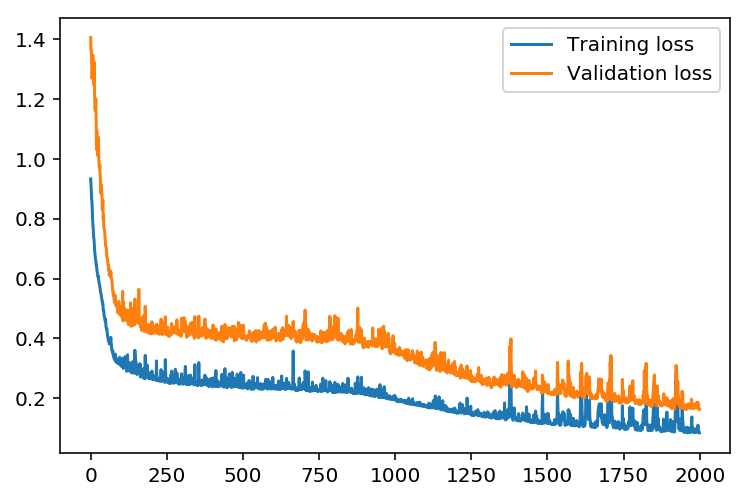

In [28]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
_ = plt.ylim()

## Check out your predictions

Here, use the test data to view how well your network is modeling the data. If something is completely wrong here, make sure each step in your network is implemented correctly.

C:\Users\jinlu\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  # Remove the CWD from sys.path while we load stuff.


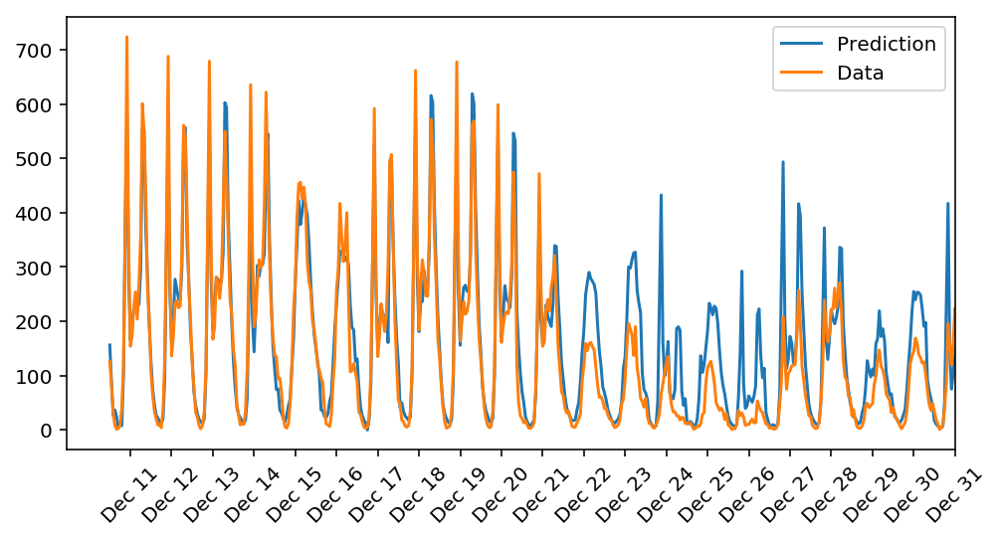

In [29]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## OPTIONAL: Thinking about your results(this question will not be evaluated in the rubric).
  
Answer these questions about your results. How well does the model predict the data? Where does it fail? Why does it fail where it does?

> **Note:** You can edit the text in this cell by double clicking on it. When you want to render the text, press control + enter

#### Your answer below
The model predicts the data quite well before December 22. However, from December 22  till 27 the model does not perform well. This is those days people are normally on Christmas holidays, which is a factor that is not taken into account in our model. Therefore the acctual numbers of bike riders in those days are significantly lower than predicted. 